In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_squared_error
from util.evaluation import SMAPE
%matplotlib inline

traffic=pd.read_csv('../data/cl_traffic.csv')

# traffic=traffic.fillna(0)

traffic.head()

,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,...,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,langs,vtype,access,entity
0,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,24.0,...,16.0,27.0,29.0,23.0,54.0,38.0,zh.wikipedia.org,spider,all-access,2NE1
1,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,4.0,...,54.0,25.0,26.0,23.0,13.0,81.0,zh.wikipedia.org,spider,all-access,2PM
2,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,4.0,...,4.0,7.0,3.0,4.0,7.0,6.0,zh.wikipedia.org,spider,all-access,3C
3,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,16.0,...,6.0,16.0,19.0,30.0,38.0,4.0,zh.wikipedia.org,spider,all-access,4minute
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,20.0,23.0,28.0,14.0,8.0,7.0,zh.wikipedia.org,spider,all-access,52 Hz I Love You


In [9]:
c_traffic=traffic[traffic.vtype!='spider']
c_traffic=c_traffic.dropna(axis=0)

In [7]:
# c_traffic=c_traffic[c_traffic.langs=='en.wikipedia.org']

In [10]:
np.unique(c_traffic.langs)

array(['commons.wikimedia.org', 'de.wikipedia.org', 'en.wikipedia.org',
       'es.wikipedia.org', 'fr.wikipedia.org', 'ja.wikipedia.org',
       'ru.wikipedia.org', 'www.mediawiki.org', 'zh.wikipedia.org'],
      dtype=object)

In [11]:
len(c_traffic)

86219

In [45]:
# len(c_traffic.dropna(axis=0))

In [18]:
# c_traffic=traffic

In [12]:
sample_index=np.random.choice(c_traffic.index,80000,replace=False)
sample_series=[]
for u in sample_index:
#     print('Training...|| {:.2f}'.format(u/tot_len*100)+'%',end='\r')
    sample_series.append(c_traffic.loc[u][:-4].values)

def diff(x,epsilon=1e-3):
    return((x[1:]-x[:-1])/(x[:-1]+epsilon))

## prepare training and testing data

In [143]:

# def normalize_X(clean_series):
#     recover_dic={}
#     scaled_series=[]
#     for i in range(len(clean_series)):
#         if np.sum(clean_series[i])==0:
#             scaled_series.append(np.zeros_like(clean_series[i]))
#             recover_dic[i]=(0,0)
#         else:
#             std=np.std(clean_series[i])
#             biased_mean=np.mean(clean_series[i])-3*std

#             recover_dic[i]=(std,biased_mean)
#             new_series=clean_series[i]-biased_mean
#             new_series[new_series<0]=0
#             new_series=new_series/(6*std)
#             new_series[new_series>1]=1
#             scaled_series.append(new_series)
#     return (scaled_series,recover_dic)


# def normalize_Y(clean_series,recover_dic):
#     scaled_series=[]
#     for i in range(len(clean_series)):
#         (std,biased_mean) = recover_dic[i]
        
#         if std==0:
#             # ignore all zero cases
# #             print(clean_series[i])
#             scaled_series.append(np.zeros_like(clean_series[i]))

#         else:
            

#             new_series=clean_series[i]-biased_mean
#             new_series[new_series<0]=0
#             new_series=new_series/(6*std)
#             new_series[new_series>1]=1
#             scaled_series.append(new_series)
#     return (scaled_series)

# def recover(scaled_series,recover_dic):
#     recovered_series=[]
#     for i in range(len(scaled_series)):
#         std,biased_mean=recover_dic[i]
#         new_series=scaled_series[i]*(6*float(std))+biased_mean
#         recovered_series.append(new_series)
#     return recovered_series

In [24]:
# encode_start=0
# encode_end=350
# decode_len=63

# clean_series,decode_series = split_and_clean(sample_series,encode_start,encode_end,decode_len)
# train_x,train_dic = normalize_X(clean_series)
# train_y = normalize_Y(decode_series,train_dic)


# encode_start=200
# encode_end=550
# decode_len=63

# PERIOD=98

# clean_series,decode_series = split_and_clean(sample_series,encode_start,encode_end,decode_len)

# test_x,test_dic = normalize_X(clean_series)
# test_y = normalize_Y(decode_series,test_dic)

In [25]:
a,b,c,d=split_and_clean(sample_series)

NameError: name 'encode_len' is not defined

In [163]:
len(d)

1000

In [17]:

def cutter(orig_series):
    trainx=[]
    trainy=[]
    # trainy=[]
    # testy=[]

    n_splits=(len(orig_series)-encode_len)//(63)
    for n in range(1,n_splits):
        trainx_split=orig_series[63*(n-1):63*(n-1)+encode_len]
        trainy_split=orig_series[encode_len+63*(n-1):encode_len+63*(n)]
        trainx.append(trainx_split)
        trainy.append(trainy_split)

    testx=orig_series[63*(n):63*(n)+encode_len]
    testy=orig_series[encode_len+63*(n):encode_len+63*(n+1)]
    
    return(trainx,trainy,testx,testy)
#     print(140+63*(n-1),140+63*(n))
    

In [18]:
def split_and_clean(sample_series):
    trainx_series=[]
    trainy_series=[]
    testx_series=[]
    testy_series=[]
    
    for index in range(len(sample_series)):
        print(index,end='\r')
        trainx,trainy,testx,testy=cutter(sample_series[index])
        
        
        for c in trainx:
            c=np.array(c)
            std=np.std(c)
            mean=np.mean(c)
            c[(c-np.mean(c))>2*std]=mean+2*std
            c[(c-np.mean(c))<-2*std]=mean-2*std
            trainx_series.append(c)
            

        trainy_series+=trainy
            
        testx_series.append(testx)
        testy_series.append(testy)
    return (trainx_series,trainy_series,testx_series,testy_series)

In [26]:
encode_len=280
train_x,train_y,test_x,test_y  = split_and_clean(sample_series)

In [27]:
len(test_y)

80000

In [28]:
len(test_y[0])

63

In [ ]:
# tot_len=len(sample_series[0])

# encode_start=0
# encode_end=tot_len-63*2
# decode_len=63

# clean_series,decode_series = split_and_clean(sample_series,encode_start,encode_end,decode_len)
# train_x = clean_series
# train_y = decode_series


# encode_start=63
# encode_end=tot_len-63
# decode_len=63

# PERIOD=98

# clean_series,decode_series = split_and_clean(sample_series,encode_start,encode_end,decode_len)

# test_x = clean_series
# test_y = decode_series

In [25]:
# train_x[0]

In [144]:
# def make_one_hots(length,last_pointer=-1):
#     pointer=(last_pointer+1) % PERIOD
# #     print(pointer)
#     one_hots=[]
#     one_hot_temp=np.zeros(PERIOD)
#     for i in range(length):
#         one_hot=one_hot_temp.copy()
#         one_hot[pointer]=1
#         one_hots.append(one_hot)
#         pointer+=1
#         pointer=pointer % PERIOD
#     return np.array(one_hots)

In [8]:
# trainx=X_loader(train_x,batch_size)

# a,b=next(trainx)

# a.size()


In [9]:
# b[:,2:3,:],b[:,2:3,:]

In [10]:
# b[:,2:3,:]*b[:,2:3,:]

In [146]:
# cutter(test_x[0])[0]

In [29]:
def X_loader(x,batchsize):
    batch=0
    x=np.array(x,dtype=np.float32)
#     x=np.log(x+1)
#     one_hots=make_one_hots(len(x[0]))
    
    while batch<(len(x) // batchsize):
        
        data=x[batch*batchsize:(batch+1)*batchsize,:]
        tensor=torch.FloatTensor(np.array(data, dtype=float))
        tensor=tensor.unsqueeze(2).cuda()
        
#         feature=torch.FloatTensor(np.arrayencoder_optimizer = optim.SGD(encoder.parameters(), lr=lr)(one_hots)).unsqueeze(0)
#         feature=feature.expand((batchsize,feature.size()[1],feature.size()[2])).cuda()
        
        yield(tensor)
        batch+=1

In [30]:

def Y_loader(y,batchsize,length_x):
    batch=0
    y=np.array(y,dtype=np.float32)
#     y=np.log(y+1)
#     last_pointer=length_x % PERIOD - 1
#     one_hots=make_one_hots(len(y[0]),last_pointer)
    while batch<(len(y) // batchsize):
        
        data=y[batch*batchsize:(batch+1)*batchsize,:]
        tensor=torch.FloatTensor(np.array(data, dtype=float))
        tensor=tensor.unsqueeze(2).cuda()

#         feature=torch.FloatTensor(np.array(one_hots)).unsqueeze(0)
#         feature=feature.expand((batchsize,feature.size()[1],feature.size()[2])).cuda()
        
        yield(tensor)
        batch+=1

In [31]:
import torch
import torch.nn as nn


In [32]:
for name, param in decoder.named_parameters():
    if param.requires_grad:
        print (name, param.data)

NameError: name 'decoder' is not defined

In [33]:
def SMAPE(true,predicted):
    true=true.squeeze()
    predicted=predicted.squeeze()
#     true=torch.exp(true)-1
#     predicted=torch.exp(predicted)-1
    epsilon = 0.1
    summ = torch.abs(true) + torch.abs(predicted) + epsilon
    smape = torch.abs(predicted - true) / summ * 2.0
    return torch.mean(smape)

In [41]:
from torch import optim
from numpy import random as random
epoch=250
indicator=5

# optimizer = optim.RMSprop(model.parameters(), lr=0.001, alpha=0.99, \
#     eps=1e-08, weight_decay=0, momentum=0, centered=False)
# optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0)
input_size=encode_len

lr=0.05
batch_size=100
decoder=DecoderRNN(input_size,63,7,300).cuda() if use_cuda else DecoderRNN(input_size,63,7,300)
# teacher_forcing_ratio = 0.4
decoder_optimizer = optim.SGD(decoder.parameters(), lr=lr)

In [42]:
len(train_x)

560000

In [43]:
# ps,_,score = valid_iter(test_x, test_y)
# for kk in range(12):
#     plt.plot(ps[kk][:21])
#     plt.title('epoch '+str(0))
# plt.show()
# print("Validation! Epoch: {}; Loss: {}\n".format(-1, np.mean(score)))

v_scores=[]
for i in range(epoch):
    
    trainx=X_loader(train_x,batch_size)
    trainy=Y_loader(train_y,batch_size,len(train_x[0]))
    
    running_loss_e = 0.0
    running_loss_d = 0.0
#     validation(test_x,test_y)
    for j,(X_batch) in enumerate(trainx):
        #Parse loaded batch
        x=X_batch
        y=next(trainy)

        d_loss=train(x,  y, decoder,decoder_optimizer, SMAPE)
        
        running_loss_d += d_loss
        if (j>0) and (j % indicator == 0):
            print("Epoch: {}; iterations: {}; decoding Loss: {}\n".format(i, j, \
                                running_loss_d / indicator))

            running_loss_d = 0.0
        
    ps,_,score = valid_iter(test_x, test_y)
#     for kk in range(1):
#         plt.plot(ps[kk][:21])
#         plt.title('epoch '+str(i))
#     plt.show()
    print("Validation! Epoch: {}; Loss: {}\n".format(i, np.mean(score)))
    v_scores.append(np.mean(score))

Epoch: 0; iterations: 5; decoding Loss: 1.302617621421814

Epoch: 0; iterations: 10; decoding Loss: 0.7088648080825806

Epoch: 0; iterations: 15; decoding Loss: 0.6872163772583008

Epoch: 0; iterations: 20; decoding Loss: 0.7076091289520263

Epoch: 0; iterations: 25; decoding Loss: 0.6647983074188233

Epoch: 0; iterations: 30; decoding Loss: 0.6635599732398987

Epoch: 0; iterations: 35; decoding Loss: 0.6173684358596802

Epoch: 0; iterations: 40; decoding Loss: 0.6318073868751526

Epoch: 0; iterations: 45; decoding Loss: 0.6379304766654968

Epoch: 0; iterations: 50; decoding Loss: 0.634318220615387

Epoch: 0; iterations: 55; decoding Loss: 0.624641227722168

Epoch: 0; iterations: 60; decoding Loss: 0.5802828669548035

Epoch: 0; iterations: 65; decoding Loss: 0.6108917593955994

Epoch: 0; iterations: 70; decoding Loss: 0.5310029685497284

Epoch: 0; iterations: 75; decoding Loss: 0.5764057159423828

Epoch: 0; iterations: 80; decoding Loss: 0.6226974248886108

Epoch: 0; iterations: 85; de

Epoch: 0; iterations: 705; decoding Loss: 0.485576856136322

Epoch: 0; iterations: 710; decoding Loss: 0.5043457090854645

Epoch: 0; iterations: 715; decoding Loss: 0.5158711910247803

Epoch: 0; iterations: 720; decoding Loss: 0.5105105936527252

Epoch: 0; iterations: 725; decoding Loss: 0.5008166313171387

Epoch: 0; iterations: 730; decoding Loss: 0.501088535785675

Epoch: 0; iterations: 735; decoding Loss: 0.4610554277896881

Epoch: 0; iterations: 740; decoding Loss: 0.4482419967651367

Epoch: 0; iterations: 745; decoding Loss: 0.4433447003364563

Epoch: 0; iterations: 750; decoding Loss: 0.4790589094161987

Epoch: 0; iterations: 755; decoding Loss: 0.4740647852420807

Epoch: 0; iterations: 760; decoding Loss: 0.5003000974655152

Epoch: 0; iterations: 765; decoding Loss: 0.4709563970565796

Epoch: 0; iterations: 770; decoding Loss: 0.4103255748748779

Epoch: 0; iterations: 775; decoding Loss: 0.47510433197021484

Epoch: 0; iterations: 780; decoding Loss: 0.5085708618164062

Epoch: 0;

Epoch: 0; iterations: 1405; decoding Loss: 0.39472431540489195

Epoch: 0; iterations: 1410; decoding Loss: 0.4441941201686859

Epoch: 0; iterations: 1415; decoding Loss: 0.42495602965354917

Epoch: 0; iterations: 1420; decoding Loss: 0.4471519529819489

Epoch: 0; iterations: 1425; decoding Loss: 0.43940610289573667

Epoch: 0; iterations: 1430; decoding Loss: 0.43163750767707826

Epoch: 0; iterations: 1435; decoding Loss: 0.4337767779827118

Epoch: 0; iterations: 1440; decoding Loss: 0.4307288408279419

Epoch: 0; iterations: 1445; decoding Loss: 0.46850389838218687

Epoch: 0; iterations: 1450; decoding Loss: 0.47616794109344485

Epoch: 0; iterations: 1455; decoding Loss: 0.4072757840156555

Epoch: 0; iterations: 1460; decoding Loss: 0.45420150756835936

Epoch: 0; iterations: 1465; decoding Loss: 0.4384989082813263

Epoch: 0; iterations: 1470; decoding Loss: 0.44157515168190004

Epoch: 0; iterations: 1475; decoding Loss: 0.4208842277526855

Epoch: 0; iterations: 1480; decoding Loss: 0.46

Epoch: 0; iterations: 2055; decoding Loss: 0.42591511607170107

Epoch: 0; iterations: 2060; decoding Loss: 0.4307491660118103

Epoch: 0; iterations: 2065; decoding Loss: 0.42810574173927307

Epoch: 0; iterations: 2070; decoding Loss: 0.4227626919746399

Epoch: 0; iterations: 2075; decoding Loss: 0.4267565369606018

Epoch: 0; iterations: 2080; decoding Loss: 0.4905433654785156

Epoch: 0; iterations: 2085; decoding Loss: 0.43139474987983706

Epoch: 0; iterations: 2090; decoding Loss: 0.4464235544204712

Epoch: 0; iterations: 2095; decoding Loss: 0.45411388874053954

Epoch: 0; iterations: 2100; decoding Loss: 0.49312965869903563

Epoch: 0; iterations: 2105; decoding Loss: 0.41379660964012144

Epoch: 0; iterations: 2110; decoding Loss: 0.4234688520431519

Epoch: 0; iterations: 2115; decoding Loss: 0.45039093494415283

Epoch: 0; iterations: 2120; decoding Loss: 0.4394127011299133

Epoch: 0; iterations: 2125; decoding Loss: 0.47705976366996766

Epoch: 0; iterations: 2130; decoding Loss: 0.43

Epoch: 0; iterations: 2705; decoding Loss: 0.42075196504592893

Epoch: 0; iterations: 2710; decoding Loss: 0.4266593217849731

Epoch: 0; iterations: 2715; decoding Loss: 0.43932806253433226

Epoch: 0; iterations: 2720; decoding Loss: 0.4294535040855408

Epoch: 0; iterations: 2725; decoding Loss: 0.4884011745452881

Epoch: 0; iterations: 2730; decoding Loss: 0.43630895018577576

Epoch: 0; iterations: 2735; decoding Loss: 0.4077384233474731

Epoch: 0; iterations: 2740; decoding Loss: 0.45077152252197267

Epoch: 0; iterations: 2745; decoding Loss: 0.4632692873477936

Epoch: 0; iterations: 2750; decoding Loss: 0.4347363352775574

Epoch: 0; iterations: 2755; decoding Loss: 0.44945170879364016

Epoch: 0; iterations: 2760; decoding Loss: 0.41562085747718813

Epoch: 0; iterations: 2765; decoding Loss: 0.4096811354160309

Epoch: 0; iterations: 2770; decoding Loss: 0.40106418132781985

Epoch: 0; iterations: 2775; decoding Loss: 0.41394102573394775

Epoch: 0; iterations: 2780; decoding Loss: 0.41

Epoch: 0; iterations: 3355; decoding Loss: 0.4202018082141876

Epoch: 0; iterations: 3360; decoding Loss: 0.4401251792907715

Epoch: 0; iterations: 3365; decoding Loss: 0.39248780012130735

Epoch: 0; iterations: 3370; decoding Loss: 0.45345779657363894

Epoch: 0; iterations: 3375; decoding Loss: 0.4301600158214569

Epoch: 0; iterations: 3380; decoding Loss: 0.42473113536834717

Epoch: 0; iterations: 3385; decoding Loss: 0.40905197262763976

Epoch: 0; iterations: 3390; decoding Loss: 0.4300143182277679

Epoch: 0; iterations: 3395; decoding Loss: 0.44165669083595277

Epoch: 0; iterations: 3400; decoding Loss: 0.4798573851585388

Epoch: 0; iterations: 3405; decoding Loss: 0.4065271854400635

Epoch: 0; iterations: 3410; decoding Loss: 0.42973393201828003

Epoch: 0; iterations: 3415; decoding Loss: 0.43856586813926696

Epoch: 0; iterations: 3420; decoding Loss: 0.4514283239841461

Epoch: 0; iterations: 3425; decoding Loss: 0.4222965657711029

Epoch: 0; iterations: 3430; decoding Loss: 0.444

Epoch: 0; iterations: 4005; decoding Loss: 0.40654956102371215

Epoch: 0; iterations: 4010; decoding Loss: 0.4121543824672699

Epoch: 0; iterations: 4015; decoding Loss: 0.41129151582717893

Epoch: 0; iterations: 4020; decoding Loss: 0.46524184942245483

Epoch: 0; iterations: 4025; decoding Loss: 0.41231678128242494

Epoch: 0; iterations: 4030; decoding Loss: 0.40725868940353394

Epoch: 0; iterations: 4035; decoding Loss: 0.44412044286727903

Epoch: 0; iterations: 4040; decoding Loss: 0.4141453504562378

Epoch: 0; iterations: 4045; decoding Loss: 0.43612862229347227

Epoch: 0; iterations: 4050; decoding Loss: 0.42313135266304014

Epoch: 0; iterations: 4055; decoding Loss: 0.4350122451782227

Epoch: 0; iterations: 4060; decoding Loss: 0.4257464587688446

Epoch: 0; iterations: 4065; decoding Loss: 0.4094261765480042

Epoch: 0; iterations: 4070; decoding Loss: 0.46011486649513245

Epoch: 0; iterations: 4075; decoding Loss: 0.42303081750869753

Epoch: 0; iterations: 4080; decoding Loss: 0.

Epoch: 0; iterations: 4655; decoding Loss: 0.399859881401062

Epoch: 0; iterations: 4660; decoding Loss: 0.4282469034194946

Epoch: 0; iterations: 4665; decoding Loss: 0.49060286283493043

Epoch: 0; iterations: 4670; decoding Loss: 0.4164043128490448

Epoch: 0; iterations: 4675; decoding Loss: 0.4169010281562805

Epoch: 0; iterations: 4680; decoding Loss: 0.4170975565910339

Epoch: 0; iterations: 4685; decoding Loss: 0.417613160610199

Epoch: 0; iterations: 4690; decoding Loss: 0.43186033964157106

Epoch: 0; iterations: 4695; decoding Loss: 0.47274593114852903

Epoch: 0; iterations: 4700; decoding Loss: 0.422855532169342

Epoch: 0; iterations: 4705; decoding Loss: 0.42740670442581175

Epoch: 0; iterations: 4710; decoding Loss: 0.404686713218689

Epoch: 0; iterations: 4715; decoding Loss: 0.4451737642288208

Epoch: 0; iterations: 4720; decoding Loss: 0.38113936185836794

Epoch: 0; iterations: 4725; decoding Loss: 0.43472063541412354

Epoch: 0; iterations: 4730; decoding Loss: 0.43106269

Epoch: 0; iterations: 5305; decoding Loss: 0.4363801538944244

Epoch: 0; iterations: 5310; decoding Loss: 0.4157379627227783

Epoch: 0; iterations: 5315; decoding Loss: 0.3768816292285919

Epoch: 0; iterations: 5320; decoding Loss: 0.42825582027435305

Epoch: 0; iterations: 5325; decoding Loss: 0.44408369064331055

Epoch: 0; iterations: 5330; decoding Loss: 0.4176238000392914

Epoch: 0; iterations: 5335; decoding Loss: 0.40635989904403685

Epoch: 0; iterations: 5340; decoding Loss: 0.4705336332321167

Epoch: 0; iterations: 5345; decoding Loss: 0.4317933261394501

Epoch: 0; iterations: 5350; decoding Loss: 0.431064110994339

Epoch: 0; iterations: 5355; decoding Loss: 0.43159183859825134

Epoch: 0; iterations: 5360; decoding Loss: 0.42492496967315674

Epoch: 0; iterations: 5365; decoding Loss: 0.5210906267166138

Epoch: 0; iterations: 5370; decoding Loss: 0.41318734288215636

Epoch: 0; iterations: 5375; decoding Loss: 0.44750378131866453

Epoch: 0; iterations: 5380; decoding Loss: 0.3916

Epoch: 1; iterations: 405; decoding Loss: 0.43095375299453736

Epoch: 1; iterations: 410; decoding Loss: 0.39984564781188964

Epoch: 1; iterations: 415; decoding Loss: 0.42118012309074404

Epoch: 1; iterations: 420; decoding Loss: 0.44210424423217776

Epoch: 1; iterations: 425; decoding Loss: 0.40902366042137145

Epoch: 1; iterations: 430; decoding Loss: 0.43606835007667544

Epoch: 1; iterations: 435; decoding Loss: 0.4305823564529419

Epoch: 1; iterations: 440; decoding Loss: 0.4601185262203217

Epoch: 1; iterations: 445; decoding Loss: 0.4180835008621216

Epoch: 1; iterations: 450; decoding Loss: 0.3533627390861511

Epoch: 1; iterations: 455; decoding Loss: 0.4103484034538269

Epoch: 1; iterations: 460; decoding Loss: 0.4012016236782074

Epoch: 1; iterations: 465; decoding Loss: 0.3940225839614868

Epoch: 1; iterations: 470; decoding Loss: 0.3981371641159058

Epoch: 1; iterations: 475; decoding Loss: 0.41932631134986875

Epoch: 1; iterations: 480; decoding Loss: 0.43978978991508483



Epoch: 1; iterations: 1105; decoding Loss: 0.4203528344631195

Epoch: 1; iterations: 1110; decoding Loss: 0.4652835428714752

Epoch: 1; iterations: 1115; decoding Loss: 0.4638929784297943

Epoch: 1; iterations: 1120; decoding Loss: 0.3975024104118347

Epoch: 1; iterations: 1125; decoding Loss: 0.43853253722190855

Epoch: 1; iterations: 1130; decoding Loss: 0.4092771768569946

Epoch: 1; iterations: 1135; decoding Loss: 0.39989763498306274

Epoch: 1; iterations: 1140; decoding Loss: 0.44793746471405027

Epoch: 1; iterations: 1145; decoding Loss: 0.43926963210105896

Epoch: 1; iterations: 1150; decoding Loss: 0.444677472114563

Epoch: 1; iterations: 1155; decoding Loss: 0.44866726994514466

Epoch: 1; iterations: 1160; decoding Loss: 0.4413586497306824

Epoch: 1; iterations: 1165; decoding Loss: 0.4717522382736206

Epoch: 1; iterations: 1170; decoding Loss: 0.47646928429603574

Epoch: 1; iterations: 1175; decoding Loss: 0.41297757625579834

Epoch: 1; iterations: 1180; decoding Loss: 0.4602

Epoch: 1; iterations: 1755; decoding Loss: 0.43338446617126464

Epoch: 1; iterations: 1760; decoding Loss: 0.4013401687145233

Epoch: 1; iterations: 1765; decoding Loss: 0.4401081085205078

Epoch: 1; iterations: 1770; decoding Loss: 0.4229861259460449

Epoch: 1; iterations: 1775; decoding Loss: 0.4237617254257202

Epoch: 1; iterations: 1780; decoding Loss: 0.4101828634738922

Epoch: 1; iterations: 1785; decoding Loss: 0.421373587846756

Epoch: 1; iterations: 1790; decoding Loss: 0.4249669075012207

Epoch: 1; iterations: 1795; decoding Loss: 0.4190466344356537

Epoch: 1; iterations: 1800; decoding Loss: 0.43376400470733645

Epoch: 1; iterations: 1805; decoding Loss: 0.40767489075660707

Epoch: 1; iterations: 1810; decoding Loss: 0.42574151754379275

Epoch: 1; iterations: 1815; decoding Loss: 0.45692568421363833

Epoch: 1; iterations: 1820; decoding Loss: 0.4638846218585968

Epoch: 1; iterations: 1825; decoding Loss: 0.3943376123905182

Epoch: 1; iterations: 1830; decoding Loss: 0.421925

Epoch: 1; iterations: 2405; decoding Loss: 0.40938841700553896

Epoch: 1; iterations: 2410; decoding Loss: 0.4462150275707245

Epoch: 1; iterations: 2415; decoding Loss: 0.42242397665977477

Epoch: 1; iterations: 2420; decoding Loss: 0.4309225559234619

Epoch: 1; iterations: 2425; decoding Loss: 0.41490206122398376

Epoch: 1; iterations: 2430; decoding Loss: 0.45736814141273496

Epoch: 1; iterations: 2435; decoding Loss: 0.40000330805778506

Epoch: 1; iterations: 2440; decoding Loss: 0.42642964124679567

Epoch: 1; iterations: 2445; decoding Loss: 0.42917636036872864

Epoch: 1; iterations: 2450; decoding Loss: 0.4197240948677063

Epoch: 1; iterations: 2455; decoding Loss: 0.4196140170097351

Epoch: 1; iterations: 2460; decoding Loss: 0.3968741774559021

Epoch: 1; iterations: 2465; decoding Loss: 0.4251423478126526

Epoch: 1; iterations: 2470; decoding Loss: 0.42865538597106934

Epoch: 1; iterations: 2475; decoding Loss: 0.5321363151073456

Epoch: 1; iterations: 2480; decoding Loss: 0.44

Epoch: 1; iterations: 3075; decoding Loss: 0.47003161907196045

Epoch: 1; iterations: 3080; decoding Loss: 0.464465457201004

Epoch: 1; iterations: 3085; decoding Loss: 0.44364563226699827

Epoch: 1; iterations: 3090; decoding Loss: 0.3740083992481232

Epoch: 1; iterations: 3095; decoding Loss: 0.45029330253601074

Epoch: 1; iterations: 3100; decoding Loss: 0.44848707914352415

Epoch: 1; iterations: 3105; decoding Loss: 0.4319222867488861

Epoch: 1; iterations: 3110; decoding Loss: 0.42241384983062746

Epoch: 1; iterations: 3115; decoding Loss: 0.4172477424144745

Epoch: 1; iterations: 3120; decoding Loss: 0.3950408220291138

Epoch: 1; iterations: 3125; decoding Loss: 0.39170936346054075

Epoch: 1; iterations: 3130; decoding Loss: 0.4254196763038635

Epoch: 1; iterations: 3135; decoding Loss: 0.437114816904068

Epoch: 1; iterations: 3140; decoding Loss: 0.4252561628818512

Epoch: 1; iterations: 3145; decoding Loss: 0.3970681607723236

Epoch: 1; iterations: 3150; decoding Loss: 0.428620

Epoch: 1; iterations: 3740; decoding Loss: 0.4012175500392914

Epoch: 1; iterations: 3745; decoding Loss: 0.4581351041793823

Epoch: 1; iterations: 3750; decoding Loss: 0.3784442603588104

Epoch: 1; iterations: 3755; decoding Loss: 0.41225908398628236

Epoch: 1; iterations: 3760; decoding Loss: 0.4055824279785156

Epoch: 1; iterations: 3765; decoding Loss: 0.47086002826690676

Epoch: 1; iterations: 3770; decoding Loss: 0.4104611575603485

Epoch: 1; iterations: 3775; decoding Loss: 0.4530645966529846

Epoch: 1; iterations: 3780; decoding Loss: 0.4275760531425476

Epoch: 1; iterations: 3785; decoding Loss: 0.41672977805137634

Epoch: 1; iterations: 3790; decoding Loss: 0.43398748636245726

Epoch: 1; iterations: 3795; decoding Loss: 0.4553445041179657

Epoch: 1; iterations: 3800; decoding Loss: 0.41660143733024596

Epoch: 1; iterations: 3805; decoding Loss: 0.4688572347164154

Epoch: 1; iterations: 3810; decoding Loss: 0.42382562160491943

Epoch: 1; iterations: 3815; decoding Loss: 0.4447

Epoch: 1; iterations: 4415; decoding Loss: 0.3927218794822693

Epoch: 1; iterations: 4420; decoding Loss: 0.4242507517337799

Epoch: 1; iterations: 4425; decoding Loss: 0.38813695311546326

Epoch: 1; iterations: 4430; decoding Loss: 0.42804189324378966

Epoch: 1; iterations: 4435; decoding Loss: 0.3961219787597656

Epoch: 1; iterations: 4440; decoding Loss: 0.39033618569374084

Epoch: 1; iterations: 4445; decoding Loss: 0.4087401807308197

Epoch: 1; iterations: 4450; decoding Loss: 0.40091060400009154

Epoch: 1; iterations: 4455; decoding Loss: 0.43684161901474

Epoch: 1; iterations: 4460; decoding Loss: 0.40621654987335204

Epoch: 1; iterations: 4465; decoding Loss: 0.439629453420639

Epoch: 1; iterations: 4470; decoding Loss: 0.39198431372642517

Epoch: 1; iterations: 4475; decoding Loss: 0.4297361135482788

Epoch: 1; iterations: 4480; decoding Loss: 0.4268947958946228

Epoch: 1; iterations: 4485; decoding Loss: 0.4056654691696167

Epoch: 1; iterations: 4490; decoding Loss: 0.4296371

Epoch: 1; iterations: 5090; decoding Loss: 0.43271161913871764

Epoch: 1; iterations: 5095; decoding Loss: 0.42218597531318663

Epoch: 1; iterations: 5100; decoding Loss: 0.4806977570056915

Epoch: 1; iterations: 5105; decoding Loss: 0.419929039478302

Epoch: 1; iterations: 5110; decoding Loss: 0.45657724142074585

Epoch: 1; iterations: 5115; decoding Loss: 0.4636787950992584

Epoch: 1; iterations: 5120; decoding Loss: 0.46662830114364623

Epoch: 1; iterations: 5125; decoding Loss: 0.39045498371124265

Epoch: 1; iterations: 5130; decoding Loss: 0.4255419194698334

Epoch: 1; iterations: 5135; decoding Loss: 0.4430254101753235

Epoch: 1; iterations: 5140; decoding Loss: 0.4657450258731842

Epoch: 1; iterations: 5145; decoding Loss: 0.4490094780921936

Epoch: 1; iterations: 5150; decoding Loss: 0.4217105031013489

Epoch: 1; iterations: 5155; decoding Loss: 0.4079643785953522

Epoch: 1; iterations: 5160; decoding Loss: 0.43300616145133974

Epoch: 1; iterations: 5165; decoding Loss: 0.46386

Epoch: 2; iterations: 155; decoding Loss: 0.4173457384109497

Epoch: 2; iterations: 160; decoding Loss: 0.44702051281929017

Epoch: 2; iterations: 165; decoding Loss: 0.4267670691013336

Epoch: 2; iterations: 170; decoding Loss: 0.4161932706832886

Epoch: 2; iterations: 175; decoding Loss: 0.3743189811706543

Epoch: 2; iterations: 180; decoding Loss: 0.44618308544158936

Epoch: 2; iterations: 185; decoding Loss: 0.40920843482017516

Epoch: 2; iterations: 190; decoding Loss: 0.4185197651386261

Epoch: 2; iterations: 195; decoding Loss: 0.4488146245479584

Epoch: 2; iterations: 200; decoding Loss: 0.40993059873580934

Epoch: 2; iterations: 205; decoding Loss: 0.39076613187789916

Epoch: 2; iterations: 210; decoding Loss: 0.4516303360462189

Epoch: 2; iterations: 215; decoding Loss: 0.4110740125179291

Epoch: 2; iterations: 220; decoding Loss: 0.41662222146987915

Epoch: 2; iterations: 225; decoding Loss: 0.4159377157688141

Epoch: 2; iterations: 230; decoding Loss: 0.48729790449142457

E

Epoch: 2; iterations: 855; decoding Loss: 0.42140122652053835

Epoch: 2; iterations: 860; decoding Loss: 0.41212194561958315

Epoch: 2; iterations: 865; decoding Loss: 0.445905065536499

Epoch: 2; iterations: 870; decoding Loss: 0.4237803041934967

Epoch: 2; iterations: 875; decoding Loss: 0.3636145830154419

Epoch: 2; iterations: 880; decoding Loss: 0.4231428027153015

Epoch: 2; iterations: 885; decoding Loss: 0.4588456332683563

Epoch: 2; iterations: 890; decoding Loss: 0.4157750904560089

Epoch: 2; iterations: 895; decoding Loss: 0.446252715587616

Epoch: 2; iterations: 900; decoding Loss: 0.43305068016052245

Epoch: 2; iterations: 905; decoding Loss: 0.423098486661911

Epoch: 2; iterations: 910; decoding Loss: 0.42875648140907285

Epoch: 2; iterations: 915; decoding Loss: 0.4621847987174988

Epoch: 2; iterations: 920; decoding Loss: 0.41547406911849977

Epoch: 2; iterations: 925; decoding Loss: 0.43850886821746826

Epoch: 2; iterations: 930; decoding Loss: 0.4459481954574585

Epoch

Epoch: 2; iterations: 1505; decoding Loss: 0.4159044086933136

Epoch: 2; iterations: 1510; decoding Loss: 0.45599852204322816

Epoch: 2; iterations: 1515; decoding Loss: 0.4023053884506226

Epoch: 2; iterations: 1520; decoding Loss: 0.4303318679332733

Epoch: 2; iterations: 1525; decoding Loss: 0.4277044653892517

Epoch: 2; iterations: 1530; decoding Loss: 0.44332788586616517

Epoch: 2; iterations: 1535; decoding Loss: 0.43225709199905393

Epoch: 2; iterations: 1540; decoding Loss: 0.40661193132400514

Epoch: 2; iterations: 1545; decoding Loss: 0.39827526211738584

Epoch: 2; iterations: 1550; decoding Loss: 0.4268016993999481

Epoch: 2; iterations: 1555; decoding Loss: 0.4378973305225372

Epoch: 2; iterations: 1560; decoding Loss: 0.3983523726463318

Epoch: 2; iterations: 1565; decoding Loss: 0.444702023267746

Epoch: 2; iterations: 1570; decoding Loss: 0.40325130224227906

Epoch: 2; iterations: 1575; decoding Loss: 0.4508696377277374

Epoch: 2; iterations: 1580; decoding Loss: 0.42671

Epoch: 2; iterations: 2155; decoding Loss: 0.4345072567462921

Epoch: 2; iterations: 2160; decoding Loss: 0.38683597445487977

Epoch: 2; iterations: 2165; decoding Loss: 0.4299201488494873

Epoch: 2; iterations: 2170; decoding Loss: 0.4072075843811035

Epoch: 2; iterations: 2175; decoding Loss: 0.42773371934890747

Epoch: 2; iterations: 2180; decoding Loss: 0.41282792687416076

Epoch: 2; iterations: 2185; decoding Loss: 0.4521416902542114

Epoch: 2; iterations: 2190; decoding Loss: 0.44651115536689756

Epoch: 2; iterations: 2195; decoding Loss: 0.4127301096916199

Epoch: 2; iterations: 2200; decoding Loss: 0.44925678372383115

Epoch: 2; iterations: 2205; decoding Loss: 0.4158023536205292

Epoch: 2; iterations: 2210; decoding Loss: 0.43543924689292907

Epoch: 2; iterations: 2215; decoding Loss: 0.4216504395008087

Epoch: 2; iterations: 2220; decoding Loss: 0.4665883183479309

Epoch: 2; iterations: 2225; decoding Loss: 0.44052126407623293

Epoch: 2; iterations: 2230; decoding Loss: 0.432

Epoch: 2; iterations: 2805; decoding Loss: 0.38177443742752076

Epoch: 2; iterations: 2810; decoding Loss: 0.4191797375679016

Epoch: 2; iterations: 2815; decoding Loss: 0.43452120423316953

Epoch: 2; iterations: 2820; decoding Loss: 0.41907671093940735

Epoch: 2; iterations: 2825; decoding Loss: 0.42315434813499453

Epoch: 2; iterations: 2830; decoding Loss: 0.42988091707229614

Epoch: 2; iterations: 2835; decoding Loss: 0.4420024812221527

Epoch: 2; iterations: 2840; decoding Loss: 0.4117136120796204

Epoch: 2; iterations: 2845; decoding Loss: 0.4114682078361511

Epoch: 2; iterations: 2850; decoding Loss: 0.402819836139679

Epoch: 2; iterations: 2855; decoding Loss: 0.4622509241104126

Epoch: 2; iterations: 2860; decoding Loss: 0.4349808871746063

Epoch: 2; iterations: 2865; decoding Loss: 0.4089449942111969

Epoch: 2; iterations: 2870; decoding Loss: 0.458416485786438

Epoch: 2; iterations: 2875; decoding Loss: 0.4368698954582214

Epoch: 2; iterations: 2880; decoding Loss: 0.4143748

Epoch: 2; iterations: 3455; decoding Loss: 0.45876336097717285

Epoch: 2; iterations: 3460; decoding Loss: 0.4285512626171112

Epoch: 2; iterations: 3465; decoding Loss: 0.4281639814376831

Epoch: 2; iterations: 3470; decoding Loss: 0.478283965587616

Epoch: 2; iterations: 3475; decoding Loss: 0.42970415353775027

Epoch: 2; iterations: 3480; decoding Loss: 0.43242462873458865

Epoch: 2; iterations: 3485; decoding Loss: 0.45221138596534727

Epoch: 2; iterations: 3490; decoding Loss: 0.5032545030117035

Epoch: 2; iterations: 3495; decoding Loss: 0.4703261137008667

Epoch: 2; iterations: 3500; decoding Loss: 0.43359817266464235

Epoch: 2; iterations: 3505; decoding Loss: 0.4806821942329407

Epoch: 2; iterations: 3510; decoding Loss: 0.42161900997161866

Epoch: 2; iterations: 3515; decoding Loss: 0.4611622989177704

Epoch: 2; iterations: 3520; decoding Loss: 0.4465899169445038

Epoch: 2; iterations: 3525; decoding Loss: 0.4565706491470337

Epoch: 2; iterations: 3530; decoding Loss: 0.45789

Epoch: 2; iterations: 4105; decoding Loss: 0.4750946700572968

Epoch: 2; iterations: 4110; decoding Loss: 0.45669864416122435

Epoch: 2; iterations: 4115; decoding Loss: 0.4303653836250305

Epoch: 2; iterations: 4120; decoding Loss: 0.4553766906261444

Epoch: 2; iterations: 4125; decoding Loss: 0.4615160942077637

Epoch: 2; iterations: 4130; decoding Loss: 0.4338626146316528

Epoch: 2; iterations: 4135; decoding Loss: 0.3868098437786102

Epoch: 2; iterations: 4140; decoding Loss: 0.4295350730419159

Epoch: 2; iterations: 4145; decoding Loss: 0.47044522762298585

Epoch: 2; iterations: 4150; decoding Loss: 0.40595905780792235

Epoch: 2; iterations: 4155; decoding Loss: 0.4195778012275696

Epoch: 2; iterations: 4160; decoding Loss: 0.44328824877738954

Epoch: 2; iterations: 4165; decoding Loss: 0.42460525035858154

Epoch: 2; iterations: 4170; decoding Loss: 0.4642122685909271

Epoch: 2; iterations: 4175; decoding Loss: 0.4453211069107056

Epoch: 2; iterations: 4180; decoding Loss: 0.47033

Epoch: 2; iterations: 4755; decoding Loss: 0.4386214852333069

Epoch: 2; iterations: 4760; decoding Loss: 0.4217643320560455

Epoch: 2; iterations: 4765; decoding Loss: 0.44376627802848817

Epoch: 2; iterations: 4770; decoding Loss: 0.42404897809028624

Epoch: 2; iterations: 4775; decoding Loss: 0.42922009229660035

Epoch: 2; iterations: 4780; decoding Loss: 0.42264712452888487

Epoch: 2; iterations: 4785; decoding Loss: 0.44092571139335635

Epoch: 2; iterations: 4790; decoding Loss: 0.41870068907737734

Epoch: 2; iterations: 4795; decoding Loss: 0.4358523368835449

Epoch: 2; iterations: 4800; decoding Loss: 0.42560905814170835

Epoch: 2; iterations: 4805; decoding Loss: 0.4145852506160736

Epoch: 2; iterations: 4810; decoding Loss: 0.4673964560031891

Epoch: 2; iterations: 4815; decoding Loss: 0.42015389204025266

Epoch: 2; iterations: 4820; decoding Loss: 0.4403337240219116

Epoch: 2; iterations: 4825; decoding Loss: 0.4582627654075623

Epoch: 2; iterations: 4830; decoding Loss: 0.41

Epoch: 2; iterations: 5405; decoding Loss: 0.4211320042610168

Epoch: 2; iterations: 5410; decoding Loss: 0.4567467153072357

Epoch: 2; iterations: 5415; decoding Loss: 0.4088921368122101

Epoch: 2; iterations: 5420; decoding Loss: 0.4474527955055237

Epoch: 2; iterations: 5425; decoding Loss: 0.4338670611381531

Epoch: 2; iterations: 5430; decoding Loss: 0.41674525141716

Epoch: 2; iterations: 5435; decoding Loss: 0.42855868935585023

Epoch: 2; iterations: 5440; decoding Loss: 0.43628251552581787

Epoch: 2; iterations: 5445; decoding Loss: 0.4530003070831299

Epoch: 2; iterations: 5450; decoding Loss: 0.4117253661155701

Epoch: 2; iterations: 5455; decoding Loss: 0.4649792015552521

Epoch: 2; iterations: 5460; decoding Loss: 0.4209877610206604

Epoch: 2; iterations: 5465; decoding Loss: 0.43838557600975037

Epoch: 2; iterations: 5470; decoding Loss: 0.445987206697464

Epoch: 2; iterations: 5475; decoding Loss: 0.43298046588897704

Epoch: 2; iterations: 5480; decoding Loss: 0.438525235

Epoch: 3; iterations: 500; decoding Loss: 0.46288405656814574

Epoch: 3; iterations: 505; decoding Loss: 0.45415366888046266

Epoch: 3; iterations: 510; decoding Loss: 0.42636293172836304

Epoch: 3; iterations: 515; decoding Loss: 0.4380676090717316

Epoch: 3; iterations: 520; decoding Loss: 0.435662180185318

Epoch: 3; iterations: 525; decoding Loss: 0.4432681977748871

Epoch: 3; iterations: 530; decoding Loss: 0.4476496934890747

Epoch: 3; iterations: 535; decoding Loss: 0.4785746455192566

Epoch: 3; iterations: 540; decoding Loss: 0.40193755030632017

Epoch: 3; iterations: 545; decoding Loss: 0.4232355892658234

Epoch: 3; iterations: 550; decoding Loss: 0.4401102185249329

Epoch: 3; iterations: 555; decoding Loss: 0.4594991207122803

Epoch: 3; iterations: 560; decoding Loss: 0.4807340860366821

Epoch: 3; iterations: 565; decoding Loss: 0.39875338673591615

Epoch: 3; iterations: 570; decoding Loss: 0.4467546343803406

Epoch: 3; iterations: 575; decoding Loss: 0.4141807913780212

Epoc

Epoch: 3; iterations: 1200; decoding Loss: 0.44783867597579957

Epoch: 3; iterations: 1205; decoding Loss: 0.4102412164211273

Epoch: 3; iterations: 1210; decoding Loss: 0.4583219587802887

Epoch: 3; iterations: 1215; decoding Loss: 0.43055022954940797

Epoch: 3; iterations: 1220; decoding Loss: 0.4790147304534912

Epoch: 3; iterations: 1225; decoding Loss: 0.392768520116806

Epoch: 3; iterations: 1230; decoding Loss: 0.4630038797855377

Epoch: 3; iterations: 1235; decoding Loss: 0.4303304851055145

Epoch: 3; iterations: 1240; decoding Loss: 0.4477000892162323

Epoch: 3; iterations: 1245; decoding Loss: 0.41204235553741453

Epoch: 3; iterations: 1250; decoding Loss: 0.4673618495464325

Epoch: 3; iterations: 1255; decoding Loss: 0.38086761236190797

Epoch: 3; iterations: 1260; decoding Loss: 0.40694116353988646

Epoch: 3; iterations: 1265; decoding Loss: 0.39694502353668215

Epoch: 3; iterations: 1270; decoding Loss: 0.42441890239715574

Epoch: 3; iterations: 1275; decoding Loss: 0.4586

Epoch: 3; iterations: 1850; decoding Loss: 0.39706512093544005

Epoch: 3; iterations: 1855; decoding Loss: 0.4384606063365936

Epoch: 3; iterations: 1860; decoding Loss: 0.40651472210884093

Epoch: 3; iterations: 1865; decoding Loss: 0.42816575765609743

Epoch: 3; iterations: 1870; decoding Loss: 0.4198558270931244

Epoch: 3; iterations: 1875; decoding Loss: 0.4489804208278656

Epoch: 3; iterations: 1880; decoding Loss: 0.4553038477897644

Epoch: 3; iterations: 1885; decoding Loss: 0.3939010679721832

Epoch: 3; iterations: 1890; decoding Loss: 0.4321432411670685

Epoch: 3; iterations: 1895; decoding Loss: 0.4151159465312958

Epoch: 3; iterations: 1900; decoding Loss: 0.4297633349895477

Epoch: 3; iterations: 1905; decoding Loss: 0.4305728852748871

Epoch: 3; iterations: 1910; decoding Loss: 0.40605697631835935

Epoch: 3; iterations: 1915; decoding Loss: 0.44685903787612913

Epoch: 3; iterations: 1920; decoding Loss: 0.40378106832504274

Epoch: 3; iterations: 1925; decoding Loss: 0.4305

Epoch: 3; iterations: 2500; decoding Loss: 0.48080490827560424

Epoch: 3; iterations: 2505; decoding Loss: 0.4197218954563141

Epoch: 3; iterations: 2510; decoding Loss: 0.4463894128799438

Epoch: 3; iterations: 2515; decoding Loss: 0.4338303804397583

Epoch: 3; iterations: 2520; decoding Loss: 0.4483915984630585

Epoch: 3; iterations: 2525; decoding Loss: 0.4416809856891632

Epoch: 3; iterations: 2530; decoding Loss: 0.42836117148399355

Epoch: 3; iterations: 2535; decoding Loss: 0.4286655724048615

Epoch: 3; iterations: 2540; decoding Loss: 0.4024754583835602

Epoch: 3; iterations: 2545; decoding Loss: 0.3942646861076355

Epoch: 3; iterations: 2550; decoding Loss: 0.4346304714679718

Epoch: 3; iterations: 2555; decoding Loss: 0.451471346616745

Epoch: 3; iterations: 2560; decoding Loss: 0.43459791541099546

Epoch: 3; iterations: 2565; decoding Loss: 0.4193144261837006

Epoch: 3; iterations: 2570; decoding Loss: 0.4369338393211365

Epoch: 3; iterations: 2575; decoding Loss: 0.44549891

Epoch: 3; iterations: 3150; decoding Loss: 0.43001432418823243

Epoch: 3; iterations: 3155; decoding Loss: 0.4231963515281677

Epoch: 3; iterations: 3160; decoding Loss: 0.4223337173461914

Epoch: 3; iterations: 3165; decoding Loss: 0.4337168037891388

Epoch: 3; iterations: 3170; decoding Loss: 0.39070173501968386

Epoch: 3; iterations: 3175; decoding Loss: 0.4428570568561554

Epoch: 3; iterations: 3180; decoding Loss: 0.40055995583534243

Epoch: 3; iterations: 3185; decoding Loss: 0.4399224579334259

Epoch: 3; iterations: 3190; decoding Loss: 0.4530173182487488

Epoch: 3; iterations: 3195; decoding Loss: 0.4258668959140778

Epoch: 3; iterations: 3200; decoding Loss: 0.430283522605896

Epoch: 3; iterations: 3205; decoding Loss: 0.41346625089645384

Epoch: 3; iterations: 3210; decoding Loss: 0.45463863015174866

Epoch: 3; iterations: 3215; decoding Loss: 0.4699526071548462

Epoch: 3; iterations: 3220; decoding Loss: 0.41121737360954286

Epoch: 3; iterations: 3225; decoding Loss: 0.45471

Epoch: 3; iterations: 3800; decoding Loss: 0.418211305141449

Epoch: 3; iterations: 3805; decoding Loss: 0.4727878928184509

Epoch: 3; iterations: 3810; decoding Loss: 0.4292605221271515

Epoch: 3; iterations: 3815; decoding Loss: 0.44578256011009215

Epoch: 3; iterations: 3820; decoding Loss: 0.47700744271278384

Epoch: 3; iterations: 3825; decoding Loss: 0.44950027465820314

Epoch: 3; iterations: 3830; decoding Loss: 0.4334471642971039

Epoch: 3; iterations: 3835; decoding Loss: 0.45776851773262023

Epoch: 3; iterations: 3840; decoding Loss: 0.4295651435852051

Epoch: 3; iterations: 3845; decoding Loss: 0.46701565384864807

Epoch: 3; iterations: 3850; decoding Loss: 0.4273690104484558

Epoch: 3; iterations: 3855; decoding Loss: 0.4743097543716431

Epoch: 3; iterations: 3860; decoding Loss: 0.41734751462936404

Epoch: 3; iterations: 3865; decoding Loss: 0.4437064230442047

Epoch: 3; iterations: 3870; decoding Loss: 0.41955865621566774

Epoch: 3; iterations: 3875; decoding Loss: 0.4174

Epoch: 3; iterations: 4495; decoding Loss: 0.44525533318519595

Epoch: 3; iterations: 4500; decoding Loss: 0.44518483281135557

Epoch: 3; iterations: 4505; decoding Loss: 0.46922202706336974

Epoch: 3; iterations: 4510; decoding Loss: 0.4561730623245239

Epoch: 3; iterations: 4515; decoding Loss: 0.38387089371681216

Epoch: 3; iterations: 4520; decoding Loss: 0.4086828351020813

Epoch: 3; iterations: 4525; decoding Loss: 0.374712860584259

Epoch: 3; iterations: 4530; decoding Loss: 0.4101590275764465

Epoch: 3; iterations: 4535; decoding Loss: 0.40319018363952636

Epoch: 3; iterations: 4540; decoding Loss: 0.3982584118843079

Epoch: 3; iterations: 4545; decoding Loss: 0.42204834818840026

Epoch: 3; iterations: 4550; decoding Loss: 0.4654046893119812

Epoch: 3; iterations: 4555; decoding Loss: 0.44968111515045167

Epoch: 3; iterations: 4560; decoding Loss: 0.46313825249671936

Epoch: 3; iterations: 4565; decoding Loss: 0.4558371126651764

Epoch: 3; iterations: 4570; decoding Loss: 0.455

Epoch: 3; iterations: 5190; decoding Loss: 0.4255971372127533

Epoch: 3; iterations: 5195; decoding Loss: 0.4485685646533966

Epoch: 3; iterations: 5200; decoding Loss: 0.4449077069759369

Epoch: 3; iterations: 5205; decoding Loss: 0.4616877257823944

Epoch: 3; iterations: 5210; decoding Loss: 0.43347316384315493

Epoch: 3; iterations: 5215; decoding Loss: 0.4184281170368195

Epoch: 3; iterations: 5220; decoding Loss: 0.45185500383377075

Epoch: 3; iterations: 5225; decoding Loss: 0.4707918524742126

Epoch: 3; iterations: 5230; decoding Loss: 0.460358589887619

Epoch: 3; iterations: 5235; decoding Loss: 0.46011983752250674

Epoch: 3; iterations: 5240; decoding Loss: 0.41314584016799927

Epoch: 3; iterations: 5245; decoding Loss: 0.422621750831604

Epoch: 3; iterations: 5250; decoding Loss: 0.4225856602191925

Epoch: 3; iterations: 5255; decoding Loss: 0.46956459879875184

Epoch: 3; iterations: 5260; decoding Loss: 0.42073058485984804

Epoch: 3; iterations: 5265; decoding Loss: 0.399734

Epoch: 4; iterations: 255; decoding Loss: 0.42855082750320433

Epoch: 4; iterations: 260; decoding Loss: 0.38783411383628846

Epoch: 4; iterations: 265; decoding Loss: 0.4938993275165558

Epoch: 4; iterations: 270; decoding Loss: 0.4100492179393768

Epoch: 4; iterations: 275; decoding Loss: 0.45310041308403015

Epoch: 4; iterations: 280; decoding Loss: 0.4445176124572754

Epoch: 4; iterations: 285; decoding Loss: 0.4293664038181305

Epoch: 4; iterations: 290; decoding Loss: 0.466595196723938

Epoch: 4; iterations: 295; decoding Loss: 0.42263423204421996

Epoch: 4; iterations: 300; decoding Loss: 0.4574851393699646

Epoch: 4; iterations: 305; decoding Loss: 0.4211783230304718

Epoch: 4; iterations: 310; decoding Loss: 0.40654571652412413

Epoch: 4; iterations: 315; decoding Loss: 0.4294705092906952

Epoch: 4; iterations: 320; decoding Loss: 0.39213916659355164

Epoch: 4; iterations: 325; decoding Loss: 0.4472500205039978

Epoch: 4; iterations: 330; decoding Loss: 0.4585590362548828

Epo

Epoch: 4; iterations: 955; decoding Loss: 0.43149651288986207

Epoch: 4; iterations: 960; decoding Loss: 0.4287686347961426

Epoch: 4; iterations: 965; decoding Loss: 0.4675713896751404

Epoch: 4; iterations: 970; decoding Loss: 0.44969210028648376

Epoch: 4; iterations: 975; decoding Loss: 0.44097458124160765

Epoch: 4; iterations: 980; decoding Loss: 0.43773761987686155

Epoch: 4; iterations: 985; decoding Loss: 0.4248420298099518

Epoch: 4; iterations: 990; decoding Loss: 0.3709537386894226

Epoch: 4; iterations: 995; decoding Loss: 0.4318199634552002

Epoch: 4; iterations: 1000; decoding Loss: 0.4628791272640228

Epoch: 4; iterations: 1005; decoding Loss: 0.4225747764110565

Epoch: 4; iterations: 1010; decoding Loss: 0.4575969219207764

Epoch: 4; iterations: 1015; decoding Loss: 0.4250313401222229

Epoch: 4; iterations: 1020; decoding Loss: 0.45654884576797483

Epoch: 4; iterations: 1025; decoding Loss: 0.4133285403251648

Epoch: 4; iterations: 1030; decoding Loss: 0.44348066449165

Epoch: 4; iterations: 1605; decoding Loss: 0.4215043008327484

Epoch: 4; iterations: 1610; decoding Loss: 0.40501226782798766

Epoch: 4; iterations: 1615; decoding Loss: 0.4206299424171448

Epoch: 4; iterations: 1620; decoding Loss: 0.4355557382106781

Epoch: 4; iterations: 1625; decoding Loss: 0.4118675947189331

Epoch: 4; iterations: 1630; decoding Loss: 0.43041343092918394

Epoch: 4; iterations: 1635; decoding Loss: 0.4336127281188965

Epoch: 4; iterations: 1640; decoding Loss: 0.4253625512123108

Epoch: 4; iterations: 1645; decoding Loss: 0.4253338098526001

Epoch: 4; iterations: 1650; decoding Loss: 0.40543264150619507

Epoch: 4; iterations: 1655; decoding Loss: 0.41361513137817385

Epoch: 4; iterations: 1660; decoding Loss: 0.4589643955230713

Epoch: 4; iterations: 1665; decoding Loss: 0.45885429382324217

Epoch: 4; iterations: 1670; decoding Loss: 0.43377619981765747

Epoch: 4; iterations: 1675; decoding Loss: 0.48286634087562563

Epoch: 4; iterations: 1680; decoding Loss: 0.471

Epoch: 4; iterations: 2255; decoding Loss: 0.45283801555633546

Epoch: 4; iterations: 2260; decoding Loss: 0.44451227188110354

Epoch: 4; iterations: 2265; decoding Loss: 0.4658918797969818

Epoch: 4; iterations: 2270; decoding Loss: 0.45184754133224486

Epoch: 4; iterations: 2275; decoding Loss: 0.39594352841377256

Epoch: 4; iterations: 2280; decoding Loss: 0.4332590878009796

Epoch: 4; iterations: 2285; decoding Loss: 0.4951014995574951

Epoch: 4; iterations: 2290; decoding Loss: 0.40411202907562255

Epoch: 4; iterations: 2295; decoding Loss: 0.4429024875164032

Epoch: 4; iterations: 2300; decoding Loss: 0.39433649778366087

Epoch: 4; iterations: 2305; decoding Loss: 0.4112313151359558

Epoch: 4; iterations: 2310; decoding Loss: 0.4560292363166809

Epoch: 4; iterations: 2315; decoding Loss: 0.4380279541015625

Epoch: 4; iterations: 2320; decoding Loss: 0.43243245482444764

Epoch: 4; iterations: 2325; decoding Loss: 0.4461717367172241

Epoch: 4; iterations: 2330; decoding Loss: 0.462

Epoch: 4; iterations: 2905; decoding Loss: 0.3963436782360077

Epoch: 4; iterations: 2910; decoding Loss: 0.38057457804679873

Epoch: 4; iterations: 2915; decoding Loss: 0.47626263499259947

Epoch: 4; iterations: 2920; decoding Loss: 0.40394250154495237

Epoch: 4; iterations: 2925; decoding Loss: 0.4142351567745209

Epoch: 4; iterations: 2930; decoding Loss: 0.3852896511554718

Epoch: 4; iterations: 2935; decoding Loss: 0.4200685262680054

Epoch: 4; iterations: 2940; decoding Loss: 0.45926013588905334

Epoch: 4; iterations: 2945; decoding Loss: 0.43074817061424253

Epoch: 4; iterations: 2950; decoding Loss: 0.39850752949714663

Epoch: 4; iterations: 2955; decoding Loss: 0.4351039946079254

Epoch: 4; iterations: 2960; decoding Loss: 0.5006993353366852

Epoch: 4; iterations: 2965; decoding Loss: 0.4314876735210419

Epoch: 4; iterations: 2970; decoding Loss: 0.45071386694908144

Epoch: 4; iterations: 2975; decoding Loss: 0.47942194938659666

Epoch: 4; iterations: 2980; decoding Loss: 0.46

Epoch: 4; iterations: 3555; decoding Loss: 0.4363260746002197

Epoch: 4; iterations: 3560; decoding Loss: 0.41334118247032164

Epoch: 4; iterations: 3565; decoding Loss: 0.4036193251609802

Epoch: 4; iterations: 3570; decoding Loss: 0.43711294531822203

Epoch: 4; iterations: 3575; decoding Loss: 0.39425683617591856

Epoch: 4; iterations: 3580; decoding Loss: 0.44844751358032225

Epoch: 4; iterations: 3585; decoding Loss: 0.445913827419281

Epoch: 4; iterations: 3590; decoding Loss: 0.4169899165630341

Epoch: 4; iterations: 3595; decoding Loss: 0.4491007745265961

Epoch: 4; iterations: 3600; decoding Loss: 0.449227386713028

Epoch: 4; iterations: 3605; decoding Loss: 0.41503393054008486

Epoch: 4; iterations: 3610; decoding Loss: 0.4159900724887848

Epoch: 4; iterations: 3615; decoding Loss: 0.4785481572151184

Epoch: 4; iterations: 3620; decoding Loss: 0.45981928110122683

Epoch: 4; iterations: 3625; decoding Loss: 0.4079170346260071

Epoch: 4; iterations: 3630; decoding Loss: 0.467201

Epoch: 4; iterations: 4205; decoding Loss: 0.48410981297492983

Epoch: 4; iterations: 4210; decoding Loss: 0.43854770064353943

Epoch: 4; iterations: 4215; decoding Loss: 0.4301309108734131

Epoch: 4; iterations: 4220; decoding Loss: 0.4454980373382568

Epoch: 4; iterations: 4225; decoding Loss: 0.4344378411769867

Epoch: 4; iterations: 4230; decoding Loss: 0.4320447564125061

Epoch: 4; iterations: 4235; decoding Loss: 0.4462799072265625

Epoch: 4; iterations: 4240; decoding Loss: 0.45037357211112977

Epoch: 4; iterations: 4245; decoding Loss: 0.4498050034046173

Epoch: 4; iterations: 4250; decoding Loss: 0.43844306468963623

Epoch: 4; iterations: 4255; decoding Loss: 0.4032094061374664

Epoch: 4; iterations: 4260; decoding Loss: 0.4330450832843781

Epoch: 4; iterations: 4265; decoding Loss: 0.440260523557663

Epoch: 4; iterations: 4270; decoding Loss: 0.42870923280715945

Epoch: 4; iterations: 4275; decoding Loss: 0.40273297429084776

Epoch: 4; iterations: 4280; decoding Loss: 0.43178

Epoch: 4; iterations: 4855; decoding Loss: 0.4252963364124298

Epoch: 4; iterations: 4860; decoding Loss: 0.4237488925457001

Epoch: 4; iterations: 4865; decoding Loss: 0.4580369234085083

Epoch: 4; iterations: 4870; decoding Loss: 0.4642575204372406

Epoch: 4; iterations: 4875; decoding Loss: 0.43657257556915285

Epoch: 4; iterations: 4880; decoding Loss: 0.3910306453704834

Epoch: 4; iterations: 4885; decoding Loss: 0.4151104748249054

Epoch: 4; iterations: 4890; decoding Loss: 0.4171535730361938

Epoch: 4; iterations: 4895; decoding Loss: 0.45318137407302855

Epoch: 4; iterations: 4900; decoding Loss: 0.4413183331489563

Epoch: 4; iterations: 4905; decoding Loss: 0.418941855430603

Epoch: 4; iterations: 4910; decoding Loss: 0.41350471377372744

Epoch: 4; iterations: 4915; decoding Loss: 0.4095258772373199

Epoch: 4; iterations: 4920; decoding Loss: 0.4522786259651184

Epoch: 4; iterations: 4925; decoding Loss: 0.44584651589393615

Epoch: 4; iterations: 4930; decoding Loss: 0.4394796

Epoch: 4; iterations: 5505; decoding Loss: 0.40625821948051455

Epoch: 4; iterations: 5510; decoding Loss: 0.4711786150932312

Epoch: 4; iterations: 5515; decoding Loss: 0.4338101863861084

Epoch: 4; iterations: 5520; decoding Loss: 0.44445733428001405

Epoch: 4; iterations: 5525; decoding Loss: 0.43637861013412477

Epoch: 4; iterations: 5530; decoding Loss: 0.44906817078590394

Epoch: 4; iterations: 5535; decoding Loss: 0.43223551511764524

Epoch: 4; iterations: 5540; decoding Loss: 0.41137213110923765

Epoch: 4; iterations: 5545; decoding Loss: 0.43882895112037656

Epoch: 4; iterations: 5550; decoding Loss: 0.448502117395401

Epoch: 4; iterations: 5555; decoding Loss: 0.4162198483943939

Epoch: 4; iterations: 5560; decoding Loss: 0.43728548288345337

Epoch: 4; iterations: 5565; decoding Loss: 0.4390340864658356

Epoch: 4; iterations: 5570; decoding Loss: 0.4186668395996094

Epoch: 4; iterations: 5575; decoding Loss: 0.43588645458221437

Epoch: 4; iterations: 5580; decoding Loss: 0.42

Epoch: 5; iterations: 605; decoding Loss: 0.42629886865615846

Epoch: 5; iterations: 610; decoding Loss: 0.4027573108673096

Epoch: 5; iterations: 615; decoding Loss: 0.43638481497764586

Epoch: 5; iterations: 620; decoding Loss: 0.46228155493736267

Epoch: 5; iterations: 625; decoding Loss: 0.40937561392784116

Epoch: 5; iterations: 630; decoding Loss: 0.4487824857234955

Epoch: 5; iterations: 635; decoding Loss: 0.4418965458869934

Epoch: 5; iterations: 640; decoding Loss: 0.39696654081344607

Epoch: 5; iterations: 645; decoding Loss: 0.45673940777778627

Epoch: 5; iterations: 650; decoding Loss: 0.4289085328578949

Epoch: 5; iterations: 655; decoding Loss: 0.4160223364830017

Epoch: 5; iterations: 660; decoding Loss: 0.41336036920547486

Epoch: 5; iterations: 665; decoding Loss: 0.4867627739906311

Epoch: 5; iterations: 670; decoding Loss: 0.4171169638633728

Epoch: 5; iterations: 675; decoding Loss: 0.40862310528755186

Epoch: 5; iterations: 680; decoding Loss: 0.4257094144821167



Epoch: 5; iterations: 1305; decoding Loss: 0.46328645944595337

Epoch: 5; iterations: 1310; decoding Loss: 0.42947285175323485

Epoch: 5; iterations: 1315; decoding Loss: 0.477543967962265

Epoch: 5; iterations: 1320; decoding Loss: 0.39151777029037477

Epoch: 5; iterations: 1325; decoding Loss: 0.43581454157829286

Epoch: 5; iterations: 1330; decoding Loss: 0.44306265711784365

Epoch: 5; iterations: 1335; decoding Loss: 0.43208506107330324

Epoch: 5; iterations: 1340; decoding Loss: 0.3983523726463318

Epoch: 5; iterations: 1345; decoding Loss: 0.43803164958953855

Epoch: 5; iterations: 1350; decoding Loss: 0.4216904938220978

Epoch: 5; iterations: 1355; decoding Loss: 0.4299527287483215

Epoch: 5; iterations: 1360; decoding Loss: 0.4993449509143829

Epoch: 5; iterations: 1365; decoding Loss: 0.3936578154563904

Epoch: 5; iterations: 1370; decoding Loss: 0.47094839811325073

Epoch: 5; iterations: 1375; decoding Loss: 0.4628966748714447

Epoch: 5; iterations: 1380; decoding Loss: 0.431

Epoch: 5; iterations: 1955; decoding Loss: 0.38633439540863035

Epoch: 5; iterations: 1960; decoding Loss: 0.40910508632659914

Epoch: 5; iterations: 1965; decoding Loss: 0.39572089314460757

Epoch: 5; iterations: 1970; decoding Loss: 0.4332258999347687

Epoch: 5; iterations: 1975; decoding Loss: 0.44027299284934995

Epoch: 5; iterations: 1980; decoding Loss: 0.40423195958137514

Epoch: 5; iterations: 1985; decoding Loss: 0.4233478903770447

Epoch: 5; iterations: 1990; decoding Loss: 0.4257520198822021

Epoch: 5; iterations: 1995; decoding Loss: 0.4266306459903717

Epoch: 5; iterations: 2000; decoding Loss: 0.4238047659397125

Epoch: 5; iterations: 2005; decoding Loss: 0.40796527862548826

Epoch: 5; iterations: 2010; decoding Loss: 0.4134930491447449

Epoch: 5; iterations: 2015; decoding Loss: 0.41472241282463074

Epoch: 5; iterations: 2020; decoding Loss: 0.41170769929885864

Epoch: 5; iterations: 2025; decoding Loss: 0.40898561477661133

Epoch: 5; iterations: 2030; decoding Loss: 0.4

Epoch: 5; iterations: 2605; decoding Loss: 0.4443420648574829

Epoch: 5; iterations: 2610; decoding Loss: 0.42528111934661866

Epoch: 5; iterations: 2615; decoding Loss: 0.45681014060974123

Epoch: 5; iterations: 2620; decoding Loss: 0.44140198826789856

Epoch: 5; iterations: 2625; decoding Loss: 0.3980831325054169

Epoch: 5; iterations: 2630; decoding Loss: 0.41632469892501833

Epoch: 5; iterations: 2635; decoding Loss: 0.41810298562049864

Epoch: 5; iterations: 2640; decoding Loss: 0.43744012117385866

Epoch: 5; iterations: 2645; decoding Loss: 0.419154953956604

Epoch: 5; iterations: 2650; decoding Loss: 0.38559610247612

Epoch: 5; iterations: 2655; decoding Loss: 0.41542322635650636

Epoch: 5; iterations: 2660; decoding Loss: 0.44802202582359313

Epoch: 5; iterations: 2665; decoding Loss: 0.4638893067836761

Epoch: 5; iterations: 2670; decoding Loss: 0.41129705905914304

Epoch: 5; iterations: 2675; decoding Loss: 0.42455075979232787

Epoch: 5; iterations: 2680; decoding Loss: 0.455

Epoch: 5; iterations: 3255; decoding Loss: 0.41292811632156373

Epoch: 5; iterations: 3260; decoding Loss: 0.39826924800872804

Epoch: 5; iterations: 3265; decoding Loss: 0.3923617422580719

Epoch: 5; iterations: 3270; decoding Loss: 0.47045336961746215

Epoch: 5; iterations: 3275; decoding Loss: 0.48285563588142394

Epoch: 5; iterations: 3280; decoding Loss: 0.4422506749629974

Epoch: 5; iterations: 3285; decoding Loss: 0.4375485062599182

Epoch: 5; iterations: 3290; decoding Loss: 0.4296601951122284

Epoch: 5; iterations: 3295; decoding Loss: 0.42115984559059144

Epoch: 5; iterations: 3300; decoding Loss: 0.4214261770248413

Epoch: 5; iterations: 3305; decoding Loss: 0.4299557864665985

Epoch: 5; iterations: 3310; decoding Loss: 0.3865331053733826

Epoch: 5; iterations: 3315; decoding Loss: 0.42144153714179994

Epoch: 5; iterations: 3320; decoding Loss: 0.42392390966415405

Epoch: 5; iterations: 3325; decoding Loss: 0.4641509592533112

Epoch: 5; iterations: 3330; decoding Loss: 0.452

Epoch: 5; iterations: 3905; decoding Loss: 0.4482122600078583

Epoch: 5; iterations: 3910; decoding Loss: 0.4216853857040405

Epoch: 5; iterations: 3915; decoding Loss: 0.4261689782142639

Epoch: 5; iterations: 3920; decoding Loss: 0.47207406163215637

Epoch: 5; iterations: 3925; decoding Loss: 0.4227622449398041

Epoch: 5; iterations: 3930; decoding Loss: 0.4081664264202118

Epoch: 5; iterations: 3935; decoding Loss: 0.4408468186855316

Epoch: 5; iterations: 3940; decoding Loss: 0.39907761812210085

Epoch: 5; iterations: 3945; decoding Loss: 0.4446831464767456

Epoch: 5; iterations: 3950; decoding Loss: 0.4321020424365997

Epoch: 5; iterations: 3955; decoding Loss: 0.42062647342681886

Epoch: 5; iterations: 3960; decoding Loss: 0.4306393563747406

Epoch: 5; iterations: 3965; decoding Loss: 0.42414615154266355

Epoch: 5; iterations: 3970; decoding Loss: 0.4006727635860443

Epoch: 5; iterations: 3975; decoding Loss: 0.3878750026226044

Epoch: 5; iterations: 3980; decoding Loss: 0.451829

Epoch: 5; iterations: 4555; decoding Loss: 0.4513654291629791

Epoch: 5; iterations: 4560; decoding Loss: 0.46609912514686586

Epoch: 5; iterations: 4565; decoding Loss: 0.4573372721672058

Epoch: 5; iterations: 4570; decoding Loss: 0.45725300908088684

Epoch: 5; iterations: 4575; decoding Loss: 0.46474650502204895

Epoch: 5; iterations: 4580; decoding Loss: 0.43640985488891604

Epoch: 5; iterations: 4585; decoding Loss: 0.4132448613643646

Epoch: 5; iterations: 4590; decoding Loss: 0.4401352643966675

Epoch: 5; iterations: 4595; decoding Loss: 0.41739113330841066

Epoch: 5; iterations: 4600; decoding Loss: 0.4586628258228302

Epoch: 5; iterations: 4605; decoding Loss: 0.41138676404953

Epoch: 5; iterations: 4610; decoding Loss: 0.43294604420661925

Epoch: 5; iterations: 4615; decoding Loss: 0.4195583939552307

Epoch: 5; iterations: 4620; decoding Loss: 0.45110136866569517

Epoch: 5; iterations: 4625; decoding Loss: 0.43510677218437194

Epoch: 5; iterations: 4630; decoding Loss: 0.4221

Epoch: 5; iterations: 5205; decoding Loss: 0.46099802255630495

Epoch: 5; iterations: 5210; decoding Loss: 0.4332417190074921

Epoch: 5; iterations: 5215; decoding Loss: 0.4155957758426666

Epoch: 5; iterations: 5220; decoding Loss: 0.44833419322967527

Epoch: 5; iterations: 5225; decoding Loss: 0.4676425874233246

Epoch: 5; iterations: 5230; decoding Loss: 0.4583296477794647

Epoch: 5; iterations: 5235; decoding Loss: 0.4580445170402527

Epoch: 5; iterations: 5240; decoding Loss: 0.4101444661617279

Epoch: 5; iterations: 5245; decoding Loss: 0.41929389238357545

Epoch: 5; iterations: 5250; decoding Loss: 0.4163282036781311

Epoch: 5; iterations: 5255; decoding Loss: 0.46787365078926085

Epoch: 5; iterations: 5260; decoding Loss: 0.4174739122390747

Epoch: 5; iterations: 5265; decoding Loss: 0.39784255027771

Epoch: 5; iterations: 5270; decoding Loss: 0.448512876033783

Epoch: 5; iterations: 5275; decoding Loss: 0.4408380210399628

Epoch: 5; iterations: 5280; decoding Loss: 0.452626818

Epoch: 6; iterations: 305; decoding Loss: 0.41902323961257937

Epoch: 6; iterations: 310; decoding Loss: 0.40396426916122435

Epoch: 6; iterations: 315; decoding Loss: 0.4287110209465027

Epoch: 6; iterations: 320; decoding Loss: 0.3914905786514282

Epoch: 6; iterations: 325; decoding Loss: 0.44510045647621155

Epoch: 6; iterations: 330; decoding Loss: 0.4582285165786743

Epoch: 6; iterations: 335; decoding Loss: 0.38806742429733276

Epoch: 6; iterations: 340; decoding Loss: 0.4298635184764862

Epoch: 6; iterations: 345; decoding Loss: 0.4027168989181519

Epoch: 6; iterations: 350; decoding Loss: 0.3865117907524109

Epoch: 6; iterations: 355; decoding Loss: 0.43420259952545165

Epoch: 6; iterations: 360; decoding Loss: 0.4119349837303162

Epoch: 6; iterations: 365; decoding Loss: 0.44095719456672666

Epoch: 6; iterations: 370; decoding Loss: 0.4193822741508484

Epoch: 6; iterations: 375; decoding Loss: 0.41687272787094115

Epoch: 6; iterations: 380; decoding Loss: 0.45053850412368773



Epoch: 6; iterations: 1005; decoding Loss: 0.4204140305519104

Epoch: 6; iterations: 1010; decoding Loss: 0.45482468605041504

Epoch: 6; iterations: 1015; decoding Loss: 0.42291341423988343

Epoch: 6; iterations: 1020; decoding Loss: 0.45327106714248655

Epoch: 6; iterations: 1025; decoding Loss: 0.41186665296554564

Epoch: 6; iterations: 1030; decoding Loss: 0.4417716503143311

Epoch: 6; iterations: 1035; decoding Loss: 0.4094324290752411

Epoch: 6; iterations: 1040; decoding Loss: 0.43569093346595766

Epoch: 6; iterations: 1045; decoding Loss: 0.40403814911842345

Epoch: 6; iterations: 1050; decoding Loss: 0.36815138459205626

Epoch: 6; iterations: 1055; decoding Loss: 0.4217106759548187

Epoch: 6; iterations: 1060; decoding Loss: 0.4399006009101868

Epoch: 6; iterations: 1065; decoding Loss: 0.47751439213752744

Epoch: 6; iterations: 1070; decoding Loss: 0.4188684344291687

Epoch: 6; iterations: 1075; decoding Loss: 0.48529825210571287

Epoch: 6; iterations: 1080; decoding Loss: 0.4

Epoch: 6; iterations: 1655; decoding Loss: 0.41266568899154665

Epoch: 6; iterations: 1660; decoding Loss: 0.45921179056167605

Epoch: 6; iterations: 1665; decoding Loss: 0.4581437766551971

Epoch: 6; iterations: 1670; decoding Loss: 0.4309030115604401

Epoch: 6; iterations: 1675; decoding Loss: 0.48030176758766174

Epoch: 6; iterations: 1680; decoding Loss: 0.4699124038219452

Epoch: 6; iterations: 1685; decoding Loss: 0.43772554993629453

Epoch: 6; iterations: 1690; decoding Loss: 0.435675722360611

Epoch: 6; iterations: 1695; decoding Loss: 0.47626428604125975

Epoch: 6; iterations: 1700; decoding Loss: 0.42014262080192566

Epoch: 6; iterations: 1705; decoding Loss: 0.4045949876308441

Epoch: 6; iterations: 1710; decoding Loss: 0.40744754672050476

Epoch: 6; iterations: 1715; decoding Loss: 0.4108854055404663

Epoch: 6; iterations: 1720; decoding Loss: 0.4472730875015259

Epoch: 6; iterations: 1725; decoding Loss: 0.44878026843070984

Epoch: 6; iterations: 1730; decoding Loss: 0.431

Epoch: 6; iterations: 2305; decoding Loss: 0.4091013729572296

Epoch: 6; iterations: 2310; decoding Loss: 0.4535031020641327

Epoch: 6; iterations: 2315; decoding Loss: 0.4360076129436493

Epoch: 6; iterations: 2320; decoding Loss: 0.4311876118183136

Epoch: 6; iterations: 2325; decoding Loss: 0.44537184238433836

Epoch: 6; iterations: 2330; decoding Loss: 0.4572650849819183

Epoch: 6; iterations: 2335; decoding Loss: 0.43793295621871947

Epoch: 6; iterations: 2340; decoding Loss: 0.4483940064907074

Epoch: 6; iterations: 2345; decoding Loss: 0.43644930720329284

Epoch: 6; iterations: 2350; decoding Loss: 0.40110799074172976

Epoch: 6; iterations: 2355; decoding Loss: 0.419511079788208

Epoch: 6; iterations: 2360; decoding Loss: 0.41799827814102175

Epoch: 6; iterations: 2365; decoding Loss: 0.4255547046661377

Epoch: 6; iterations: 2370; decoding Loss: 0.4169197380542755

Epoch: 6; iterations: 2375; decoding Loss: 0.4245471715927124

Epoch: 6; iterations: 2380; decoding Loss: 0.412986

Epoch: 6; iterations: 2955; decoding Loss: 0.43270028829574586

Epoch: 6; iterations: 2960; decoding Loss: 0.49534001350402834

Epoch: 6; iterations: 2965; decoding Loss: 0.4318780243396759

Epoch: 6; iterations: 2970; decoding Loss: 0.4484634816646576

Epoch: 6; iterations: 2975; decoding Loss: 0.47678435444831846

Epoch: 6; iterations: 2980; decoding Loss: 0.4656543076038361

Epoch: 6; iterations: 2985; decoding Loss: 0.43119511008262634

Epoch: 6; iterations: 2990; decoding Loss: 0.43797258138656614

Epoch: 6; iterations: 2995; decoding Loss: 0.41478126049041747

Epoch: 6; iterations: 3000; decoding Loss: 0.45651857256889344

Epoch: 6; iterations: 3005; decoding Loss: 0.4006508231163025

Epoch: 6; iterations: 3010; decoding Loss: 0.413093638420105

Epoch: 6; iterations: 3015; decoding Loss: 0.47723827958106996

Epoch: 6; iterations: 3020; decoding Loss: 0.42310800552368166

Epoch: 6; iterations: 3025; decoding Loss: 0.42939038276672364

Epoch: 6; iterations: 3030; decoding Loss: 0.3

Epoch: 6; iterations: 3605; decoding Loss: 0.41361366510391234

Epoch: 6; iterations: 3610; decoding Loss: 0.41051521301269533

Epoch: 6; iterations: 3615; decoding Loss: 0.47553794980049136

Epoch: 6; iterations: 3620; decoding Loss: 0.45825559496879575

Epoch: 6; iterations: 3625; decoding Loss: 0.4050479352474213

Epoch: 6; iterations: 3630; decoding Loss: 0.46368672847747805

Epoch: 6; iterations: 3635; decoding Loss: 0.42882648706436155

Epoch: 6; iterations: 3640; decoding Loss: 0.41299316883087156

Epoch: 6; iterations: 3645; decoding Loss: 0.4396925449371338

Epoch: 6; iterations: 3650; decoding Loss: 0.4233619213104248

Epoch: 6; iterations: 3655; decoding Loss: 0.40844991207122805

Epoch: 6; iterations: 3660; decoding Loss: 0.3773280084133148

Epoch: 6; iterations: 3665; decoding Loss: 0.4397466003894806

Epoch: 6; iterations: 3670; decoding Loss: 0.39121065139770506

Epoch: 6; iterations: 3675; decoding Loss: 0.4057996332645416

Epoch: 6; iterations: 3680; decoding Loss: 0.4

Epoch: 6; iterations: 4255; decoding Loss: 0.40048131346702576

Epoch: 6; iterations: 4260; decoding Loss: 0.4319785237312317

Epoch: 6; iterations: 4265; decoding Loss: 0.4371888995170593

Epoch: 6; iterations: 4270; decoding Loss: 0.4276845037937164

Epoch: 6; iterations: 4275; decoding Loss: 0.39949793219566343

Epoch: 6; iterations: 4280; decoding Loss: 0.4306978046894073

Epoch: 6; iterations: 4285; decoding Loss: 0.4090616822242737

Epoch: 6; iterations: 4290; decoding Loss: 0.42215794920921323

Epoch: 6; iterations: 4295; decoding Loss: 0.44043722152709963

Epoch: 6; iterations: 4300; decoding Loss: 0.3858714461326599

Epoch: 6; iterations: 4305; decoding Loss: 0.43842490911483767

Epoch: 6; iterations: 4310; decoding Loss: 0.39211136698722837

Epoch: 6; iterations: 4315; decoding Loss: 0.404046094417572

Epoch: 6; iterations: 4320; decoding Loss: 0.3817788243293762

Epoch: 6; iterations: 4325; decoding Loss: 0.49735069274902344

Epoch: 6; iterations: 4330; decoding Loss: 0.4514

Epoch: 6; iterations: 4905; decoding Loss: 0.4181809723377228

Epoch: 6; iterations: 4910; decoding Loss: 0.41127065420150755

Epoch: 6; iterations: 4915; decoding Loss: 0.4078130304813385

Epoch: 6; iterations: 4920; decoding Loss: 0.4504773437976837

Epoch: 6; iterations: 4925; decoding Loss: 0.44288440346717833

Epoch: 6; iterations: 4930; decoding Loss: 0.4353289008140564

Epoch: 6; iterations: 4935; decoding Loss: 0.4326534688472748

Epoch: 6; iterations: 4940; decoding Loss: 0.40668013095855715

Epoch: 6; iterations: 4945; decoding Loss: 0.42755308747291565

Epoch: 6; iterations: 4950; decoding Loss: 0.46834275126457214

Epoch: 6; iterations: 4955; decoding Loss: 0.43001349568367003

Epoch: 6; iterations: 4960; decoding Loss: 0.3547099411487579

Epoch: 6; iterations: 4965; decoding Loss: 0.41573559641838076

Epoch: 6; iterations: 4970; decoding Loss: 0.4064724385738373

Epoch: 6; iterations: 4975; decoding Loss: 0.42829999327659607

Epoch: 6; iterations: 4980; decoding Loss: 0.43

Epoch: 6; iterations: 5555; decoding Loss: 0.4149100065231323

Epoch: 6; iterations: 5560; decoding Loss: 0.4375991880893707

Epoch: 6; iterations: 5565; decoding Loss: 0.438412207365036

Epoch: 6; iterations: 5570; decoding Loss: 0.4192716956138611

Epoch: 6; iterations: 5575; decoding Loss: 0.4342954456806183

Epoch: 6; iterations: 5580; decoding Loss: 0.4254070341587067

Epoch: 6; iterations: 5585; decoding Loss: 0.4399835288524628

Epoch: 6; iterations: 5590; decoding Loss: 0.43516417741775515

Epoch: 6; iterations: 5595; decoding Loss: 0.485599559545517

Validation! Epoch: 6; Loss: 0.4453203026950359

Epoch: 7; iterations: 5; decoding Loss: 0.5006048798561096

Epoch: 7; iterations: 10; decoding Loss: 0.3973229229450226

Epoch: 7; iterations: 15; decoding Loss: 0.4432193398475647

Epoch: 7; iterations: 20; decoding Loss: 0.4690498113632202

Epoch: 7; iterations: 25; decoding Loss: 0.4345377802848816

Epoch: 7; iterations: 30; decoding Loss: 0.4434268832206726

Epoch: 7; iterations:

Epoch: 7; iterations: 625; decoding Loss: 0.41688432097434996

Epoch: 7; iterations: 630; decoding Loss: 0.457889723777771

Epoch: 7; iterations: 635; decoding Loss: 0.4498413383960724

Epoch: 7; iterations: 640; decoding Loss: 0.4052551805973053

Epoch: 7; iterations: 645; decoding Loss: 0.46277899146080015

Epoch: 7; iterations: 650; decoding Loss: 0.4348811745643616

Epoch: 7; iterations: 655; decoding Loss: 0.4251521110534668

Epoch: 7; iterations: 660; decoding Loss: 0.42309522032737734

Epoch: 7; iterations: 665; decoding Loss: 0.4943754494190216

Epoch: 7; iterations: 670; decoding Loss: 0.4249134182929993

Epoch: 7; iterations: 675; decoding Loss: 0.4164851725101471

Epoch: 7; iterations: 680; decoding Loss: 0.43298966288566587

Epoch: 7; iterations: 685; decoding Loss: 0.39407179355621336

Epoch: 7; iterations: 690; decoding Loss: 0.3976772427558899

Epoch: 7; iterations: 695; decoding Loss: 0.44633965492248534

Epoch: 7; iterations: 700; decoding Loss: 0.40687161684036255

Ep

Epoch: 7; iterations: 1305; decoding Loss: 0.4653313815593719

Epoch: 7; iterations: 1310; decoding Loss: 0.43619694709777834

Epoch: 7; iterations: 1315; decoding Loss: 0.48146445751190187

Epoch: 7; iterations: 1320; decoding Loss: 0.39753865599632265

Epoch: 7; iterations: 1325; decoding Loss: 0.4419306993484497

Epoch: 7; iterations: 1330; decoding Loss: 0.44955891370773315

Epoch: 7; iterations: 1335; decoding Loss: 0.43757460713386537

Epoch: 7; iterations: 1340; decoding Loss: 0.4050989329814911

Epoch: 7; iterations: 1345; decoding Loss: 0.44167385101318357

Epoch: 7; iterations: 1350; decoding Loss: 0.4281571269035339

Epoch: 7; iterations: 1355; decoding Loss: 0.43690256476402284

Epoch: 7; iterations: 1360; decoding Loss: 0.5044663906097412

Epoch: 7; iterations: 1365; decoding Loss: 0.398856520652771

Epoch: 7; iterations: 1370; decoding Loss: 0.47498010396957396

Epoch: 7; iterations: 1375; decoding Loss: 0.46759371757507323

Epoch: 7; iterations: 1380; decoding Loss: 0.43

Epoch: 7; iterations: 1955; decoding Loss: 0.3884146511554718

Epoch: 7; iterations: 1960; decoding Loss: 0.40978396534919737

Epoch: 7; iterations: 1965; decoding Loss: 0.3971732556819916

Epoch: 7; iterations: 1970; decoding Loss: 0.43316741585731505

Epoch: 7; iterations: 1975; decoding Loss: 0.4455875754356384

Epoch: 7; iterations: 1980; decoding Loss: 0.41202700734138487

Epoch: 7; iterations: 1985; decoding Loss: 0.42909218072891236

Epoch: 7; iterations: 1990; decoding Loss: 0.4300707757472992

Epoch: 7; iterations: 1995; decoding Loss: 0.42986915707588197

Epoch: 7; iterations: 2000; decoding Loss: 0.42860953211784364

Epoch: 7; iterations: 2005; decoding Loss: 0.412544447183609

Epoch: 7; iterations: 2010; decoding Loss: 0.41892325282096865

Epoch: 7; iterations: 2015; decoding Loss: 0.42123605608940123

Epoch: 7; iterations: 2020; decoding Loss: 0.4164634048938751

Epoch: 7; iterations: 2025; decoding Loss: 0.413301944732666

Epoch: 7; iterations: 2030; decoding Loss: 0.4552

Epoch: 7; iterations: 2650; decoding Loss: 0.3851890444755554

Epoch: 7; iterations: 2655; decoding Loss: 0.417519211769104

Epoch: 7; iterations: 2660; decoding Loss: 0.4476895868778229

Epoch: 7; iterations: 2665; decoding Loss: 0.4628644108772278

Epoch: 7; iterations: 2670; decoding Loss: 0.4103191733360291

Epoch: 7; iterations: 2675; decoding Loss: 0.4224532902240753

Epoch: 7; iterations: 2680; decoding Loss: 0.4553763628005981

Epoch: 7; iterations: 2685; decoding Loss: 0.4370851397514343

Epoch: 7; iterations: 2690; decoding Loss: 0.4510502219200134

Epoch: 7; iterations: 2695; decoding Loss: 0.43991897702217103

Epoch: 7; iterations: 2700; decoding Loss: 0.4449903845787048

Epoch: 7; iterations: 2705; decoding Loss: 0.42268880605697634

Epoch: 7; iterations: 2710; decoding Loss: 0.42853174209594724

Epoch: 7; iterations: 2715; decoding Loss: 0.4281058430671692

Epoch: 7; iterations: 2720; decoding Loss: 0.4300052046775818

Epoch: 7; iterations: 2725; decoding Loss: 0.47751519

Epoch: 7; iterations: 3345; decoding Loss: 0.383655846118927

Epoch: 7; iterations: 3350; decoding Loss: 0.4029608488082886

Epoch: 7; iterations: 3355; decoding Loss: 0.41385836601257325

Epoch: 7; iterations: 3360; decoding Loss: 0.43513253331184387

Epoch: 7; iterations: 3365; decoding Loss: 0.38900576829910277

Epoch: 7; iterations: 3370; decoding Loss: 0.44661381244659426

Epoch: 7; iterations: 3375; decoding Loss: 0.42462995648384094

Epoch: 7; iterations: 3380; decoding Loss: 0.4168887138366699

Epoch: 7; iterations: 3385; decoding Loss: 0.40153316855430604

Epoch: 7; iterations: 3390; decoding Loss: 0.4233333647251129

Epoch: 7; iterations: 3395; decoding Loss: 0.43746775984764097

Epoch: 7; iterations: 3400; decoding Loss: 0.4744157731533051

Epoch: 7; iterations: 3405; decoding Loss: 0.39725408554077146

Epoch: 7; iterations: 3410; decoding Loss: 0.4280295431613922

Epoch: 7; iterations: 3415; decoding Loss: 0.44149389266967776

Epoch: 7; iterations: 3420; decoding Loss: 0.43

Epoch: 7; iterations: 3995; decoding Loss: 0.41742039322853086

Epoch: 7; iterations: 4000; decoding Loss: 0.4290158450603485

Epoch: 7; iterations: 4005; decoding Loss: 0.3981711268424988

Epoch: 7; iterations: 4010; decoding Loss: 0.4133685290813446

Epoch: 7; iterations: 4015; decoding Loss: 0.40711373686790464

Epoch: 7; iterations: 4020; decoding Loss: 0.4612017035484314

Epoch: 7; iterations: 4025; decoding Loss: 0.4079995691776276

Epoch: 7; iterations: 4030; decoding Loss: 0.40336714386940004

Epoch: 7; iterations: 4035; decoding Loss: 0.4405627131462097

Epoch: 7; iterations: 4040; decoding Loss: 0.411818665266037

Epoch: 7; iterations: 4045; decoding Loss: 0.4371052086353302

Epoch: 7; iterations: 4050; decoding Loss: 0.4183451235294342

Epoch: 7; iterations: 4055; decoding Loss: 0.437105655670166

Epoch: 7; iterations: 4060; decoding Loss: 0.42696934938430786

Epoch: 7; iterations: 4065; decoding Loss: 0.4059083521366119

Epoch: 7; iterations: 4070; decoding Loss: 0.45887723

Epoch: 7; iterations: 4645; decoding Loss: 0.44219596982002257

Epoch: 7; iterations: 4650; decoding Loss: 0.45701034665107726

Epoch: 7; iterations: 4655; decoding Loss: 0.39822198152542115

Epoch: 7; iterations: 4660; decoding Loss: 0.42612236738204956

Epoch: 7; iterations: 4665; decoding Loss: 0.4851899027824402

Epoch: 7; iterations: 4670; decoding Loss: 0.4197259783744812

Epoch: 7; iterations: 4675; decoding Loss: 0.41942670941352844

Epoch: 7; iterations: 4680; decoding Loss: 0.4222810328006744

Epoch: 7; iterations: 4685; decoding Loss: 0.41788392066955565

Epoch: 7; iterations: 4690; decoding Loss: 0.43130251169204714

Epoch: 7; iterations: 4695; decoding Loss: 0.46958425641059875

Epoch: 7; iterations: 4700; decoding Loss: 0.42140910029411316

Epoch: 7; iterations: 4705; decoding Loss: 0.42884490489959715

Epoch: 7; iterations: 4710; decoding Loss: 0.40473719239234923

Epoch: 7; iterations: 4715; decoding Loss: 0.44870597720146177

Epoch: 7; iterations: 4720; decoding Loss: 

Epoch: 7; iterations: 5295; decoding Loss: 0.39774733781814575

Epoch: 7; iterations: 5300; decoding Loss: 0.42384026050567625

Epoch: 7; iterations: 5305; decoding Loss: 0.43468297123908994

Epoch: 7; iterations: 5310; decoding Loss: 0.4096825897693634

Epoch: 7; iterations: 5315; decoding Loss: 0.37850725650787354

Epoch: 7; iterations: 5320; decoding Loss: 0.42319127917289734

Epoch: 7; iterations: 5325; decoding Loss: 0.43618492484092714

Epoch: 7; iterations: 5330; decoding Loss: 0.4175818383693695

Epoch: 7; iterations: 5335; decoding Loss: 0.408003157377243

Epoch: 7; iterations: 5340; decoding Loss: 0.46261215806007383

Epoch: 7; iterations: 5345; decoding Loss: 0.42998231649398805

Epoch: 7; iterations: 5350; decoding Loss: 0.4282891511917114

Epoch: 7; iterations: 5355; decoding Loss: 0.42898844480514525

Epoch: 7; iterations: 5360; decoding Loss: 0.42232927680015564

Epoch: 7; iterations: 5365; decoding Loss: 0.5107457935810089

Epoch: 7; iterations: 5370; decoding Loss: 0.4

Epoch: 8; iterations: 355; decoding Loss: 0.43318927884101865

Epoch: 8; iterations: 360; decoding Loss: 0.41221117973327637

Epoch: 8; iterations: 365; decoding Loss: 0.4417275547981262

Epoch: 8; iterations: 370; decoding Loss: 0.41742345690727234

Epoch: 8; iterations: 375; decoding Loss: 0.4172298014163971

Epoch: 8; iterations: 380; decoding Loss: 0.44811548590660094

Epoch: 8; iterations: 385; decoding Loss: 0.4380553662776947

Epoch: 8; iterations: 390; decoding Loss: 0.3618793606758118

Epoch: 8; iterations: 395; decoding Loss: 0.43092257976531984

Epoch: 8; iterations: 400; decoding Loss: 0.4248267114162445

Epoch: 8; iterations: 405; decoding Loss: 0.42441808581352236

Epoch: 8; iterations: 410; decoding Loss: 0.39906291365623475

Epoch: 8; iterations: 415; decoding Loss: 0.4185249745845795

Epoch: 8; iterations: 420; decoding Loss: 0.4355271816253662

Epoch: 8; iterations: 425; decoding Loss: 0.4034175217151642

Epoch: 8; iterations: 430; decoding Loss: 0.43378083109855653



Epoch: 8; iterations: 1055; decoding Loss: 0.417721289396286

Epoch: 8; iterations: 1060; decoding Loss: 0.43859551548957826

Epoch: 8; iterations: 1065; decoding Loss: 0.4757260501384735

Epoch: 8; iterations: 1070; decoding Loss: 0.4158793568611145

Epoch: 8; iterations: 1075; decoding Loss: 0.4855612814426422

Epoch: 8; iterations: 1080; decoding Loss: 0.46545737981796265

Epoch: 8; iterations: 1085; decoding Loss: 0.3731480658054352

Epoch: 8; iterations: 1090; decoding Loss: 0.45574678778648375

Epoch: 8; iterations: 1095; decoding Loss: 0.4342540740966797

Epoch: 8; iterations: 1100; decoding Loss: 0.4141597867012024

Epoch: 8; iterations: 1105; decoding Loss: 0.4119041919708252

Epoch: 8; iterations: 1110; decoding Loss: 0.4596639394760132

Epoch: 8; iterations: 1115; decoding Loss: 0.4562546253204346

Epoch: 8; iterations: 1120; decoding Loss: 0.3948275029659271

Epoch: 8; iterations: 1125; decoding Loss: 0.43657209277153014

Epoch: 8; iterations: 1130; decoding Loss: 0.4025638

Epoch: 8; iterations: 1705; decoding Loss: 0.40242413282394407

Epoch: 8; iterations: 1710; decoding Loss: 0.40776432156562803

Epoch: 8; iterations: 1715; decoding Loss: 0.41109506487846376

Epoch: 8; iterations: 1720; decoding Loss: 0.4481541275978088

Epoch: 8; iterations: 1725; decoding Loss: 0.443323016166687

Epoch: 8; iterations: 1730; decoding Loss: 0.4285160481929779

Epoch: 8; iterations: 1735; decoding Loss: 0.4170257866382599

Epoch: 8; iterations: 1740; decoding Loss: 0.416428005695343

Epoch: 8; iterations: 1745; decoding Loss: 0.4055157005786896

Epoch: 8; iterations: 1750; decoding Loss: 0.4417708694934845

Epoch: 8; iterations: 1755; decoding Loss: 0.4285941243171692

Epoch: 8; iterations: 1760; decoding Loss: 0.3980918347835541

Epoch: 8; iterations: 1765; decoding Loss: 0.4389630317687988

Epoch: 8; iterations: 1770; decoding Loss: 0.4227423369884491

Epoch: 8; iterations: 1775; decoding Loss: 0.4235696017742157

Epoch: 8; iterations: 1780; decoding Loss: 0.410473889

Epoch: 8; iterations: 2355; decoding Loss: 0.41854519844055177

Epoch: 8; iterations: 2360; decoding Loss: 0.417293107509613

Epoch: 8; iterations: 2365; decoding Loss: 0.4245745658874512

Epoch: 8; iterations: 2370; decoding Loss: 0.41581875681877134

Epoch: 8; iterations: 2375; decoding Loss: 0.4227275729179382

Epoch: 8; iterations: 2380; decoding Loss: 0.41310129761695863

Epoch: 8; iterations: 2385; decoding Loss: 0.43096586465835574

Epoch: 8; iterations: 2390; decoding Loss: 0.4275385677814484

Epoch: 8; iterations: 2395; decoding Loss: 0.4502538084983826

Epoch: 8; iterations: 2400; decoding Loss: 0.4140041708946228

Epoch: 8; iterations: 2405; decoding Loss: 0.4058513343334198

Epoch: 8; iterations: 2410; decoding Loss: 0.44135246276855467

Epoch: 8; iterations: 2415; decoding Loss: 0.4219472348690033

Epoch: 8; iterations: 2420; decoding Loss: 0.4276527762413025

Epoch: 8; iterations: 2425; decoding Loss: 0.4153172612190247

Epoch: 8; iterations: 2430; decoding Loss: 0.455070

Epoch: 8; iterations: 3005; decoding Loss: 0.40428943037986753

Epoch: 8; iterations: 3010; decoding Loss: 0.4133265852928162

Epoch: 8; iterations: 3015; decoding Loss: 0.4745546460151672

Epoch: 8; iterations: 3020; decoding Loss: 0.42385717630386355

Epoch: 8; iterations: 3025; decoding Loss: 0.42920705676078796

Epoch: 8; iterations: 3030; decoding Loss: 0.39382989406585694

Epoch: 8; iterations: 3035; decoding Loss: 0.416031414270401

Epoch: 8; iterations: 3040; decoding Loss: 0.43713184595108034

Epoch: 8; iterations: 3045; decoding Loss: 0.38431529998779296

Epoch: 8; iterations: 3050; decoding Loss: 0.408121383190155

Epoch: 8; iterations: 3055; decoding Loss: 0.4205803215503693

Epoch: 8; iterations: 3060; decoding Loss: 0.405690997838974

Epoch: 8; iterations: 3065; decoding Loss: 0.4139995455741882

Epoch: 8; iterations: 3070; decoding Loss: 0.39968711137771606

Epoch: 8; iterations: 3075; decoding Loss: 0.4580892860889435

Epoch: 8; iterations: 3080; decoding Loss: 0.457888

Epoch: 8; iterations: 3655; decoding Loss: 0.4065512537956238

Epoch: 8; iterations: 3660; decoding Loss: 0.37505434155464173

Epoch: 8; iterations: 3665; decoding Loss: 0.4355804562568665

Epoch: 8; iterations: 3670; decoding Loss: 0.3865049421787262

Epoch: 8; iterations: 3675; decoding Loss: 0.4005311131477356

Epoch: 8; iterations: 3680; decoding Loss: 0.42519107460975647

Epoch: 8; iterations: 3685; decoding Loss: 0.4393210828304291

Epoch: 8; iterations: 3690; decoding Loss: 0.421513569355011

Epoch: 8; iterations: 3695; decoding Loss: 0.38812935948371885

Epoch: 8; iterations: 3700; decoding Loss: 0.39758606553077697

Epoch: 8; iterations: 3705; decoding Loss: 0.4175105631351471

Epoch: 8; iterations: 3710; decoding Loss: 0.396723198890686

Epoch: 8; iterations: 3715; decoding Loss: 0.4757180154323578

Epoch: 8; iterations: 3720; decoding Loss: 0.4445573925971985

Epoch: 8; iterations: 3725; decoding Loss: 0.397658097743988

Epoch: 8; iterations: 3730; decoding Loss: 0.432609820

Epoch: 8; iterations: 4305; decoding Loss: 0.4353003859519958

Epoch: 8; iterations: 4310; decoding Loss: 0.3909378945827484

Epoch: 8; iterations: 4315; decoding Loss: 0.39864038228988646

Epoch: 8; iterations: 4320; decoding Loss: 0.37442949414253235

Epoch: 8; iterations: 4325; decoding Loss: 0.4925774812698364

Epoch: 8; iterations: 4330; decoding Loss: 0.44617446064949035

Epoch: 8; iterations: 4335; decoding Loss: 0.4375209093093872

Epoch: 8; iterations: 4340; decoding Loss: 0.4436079263687134

Epoch: 8; iterations: 4345; decoding Loss: 0.41202057600021363

Epoch: 8; iterations: 4350; decoding Loss: 0.4539466083049774

Epoch: 8; iterations: 4355; decoding Loss: 0.4710172712802887

Epoch: 8; iterations: 4360; decoding Loss: 0.4313413918018341

Epoch: 8; iterations: 4365; decoding Loss: 0.3988810837268829

Epoch: 8; iterations: 4370; decoding Loss: 0.4289538383483887

Epoch: 8; iterations: 4375; decoding Loss: 0.4097738564014435

Epoch: 8; iterations: 4380; decoding Loss: 0.449978

Epoch: 8; iterations: 4955; decoding Loss: 0.4267264246940613

Epoch: 8; iterations: 4960; decoding Loss: 0.3517225980758667

Epoch: 8; iterations: 4965; decoding Loss: 0.41355663537979126

Epoch: 8; iterations: 4970; decoding Loss: 0.40486783981323243

Epoch: 8; iterations: 4975; decoding Loss: 0.4305482983589172

Epoch: 8; iterations: 4980; decoding Loss: 0.4308762848377228

Epoch: 8; iterations: 4985; decoding Loss: 0.4106199562549591

Epoch: 8; iterations: 4990; decoding Loss: 0.4376297354698181

Epoch: 8; iterations: 4995; decoding Loss: 0.4167786121368408

Epoch: 8; iterations: 5000; decoding Loss: 0.42255349159240724

Epoch: 8; iterations: 5005; decoding Loss: 0.4617907702922821

Epoch: 8; iterations: 5010; decoding Loss: 0.4252293646335602

Epoch: 8; iterations: 5015; decoding Loss: 0.4511883020401001

Epoch: 8; iterations: 5020; decoding Loss: 0.4355349183082581

Epoch: 8; iterations: 5025; decoding Loss: 0.3715106606483459

Epoch: 8; iterations: 5030; decoding Loss: 0.4777868


Epoch: 9; iterations: 5; decoding Loss: 0.49739441871643064

Epoch: 9; iterations: 10; decoding Loss: 0.3955840587615967

Epoch: 9; iterations: 15; decoding Loss: 0.4407464861869812

Epoch: 9; iterations: 20; decoding Loss: 0.4662656784057617

Epoch: 9; iterations: 25; decoding Loss: 0.43080838322639464

Epoch: 9; iterations: 30; decoding Loss: 0.4417817771434784

Epoch: 9; iterations: 35; decoding Loss: 0.436457359790802

Epoch: 9; iterations: 40; decoding Loss: 0.4275198221206665

Epoch: 9; iterations: 45; decoding Loss: 0.4342503726482391

Epoch: 9; iterations: 50; decoding Loss: 0.44456871747970583

Epoch: 9; iterations: 55; decoding Loss: 0.4368219017982483

Epoch: 9; iterations: 60; decoding Loss: 0.4312730610370636

Epoch: 9; iterations: 65; decoding Loss: 0.43183150291442873

Epoch: 9; iterations: 70; decoding Loss: 0.4012120425701141

Epoch: 9; iterations: 75; decoding Loss: 0.42444350719451907

Epoch: 9; iterations: 80; decoding Loss: 0.4314525544643402

Epoch: 9; iterations

Epoch: 9; iterations: 700; decoding Loss: 0.399165016412735

Epoch: 9; iterations: 705; decoding Loss: 0.4333667457103729

Epoch: 9; iterations: 710; decoding Loss: 0.42712676525115967

Epoch: 9; iterations: 715; decoding Loss: 0.45271613001823424

Epoch: 9; iterations: 720; decoding Loss: 0.43737472891807555

Epoch: 9; iterations: 725; decoding Loss: 0.4420257806777954

Epoch: 9; iterations: 730; decoding Loss: 0.436682665348053

Epoch: 9; iterations: 735; decoding Loss: 0.40365387201309205

Epoch: 9; iterations: 740; decoding Loss: 0.4061558127403259

Epoch: 9; iterations: 745; decoding Loss: 0.3864465653896332

Epoch: 9; iterations: 750; decoding Loss: 0.4156666576862335

Epoch: 9; iterations: 755; decoding Loss: 0.4312754154205322

Epoch: 9; iterations: 760; decoding Loss: 0.45111809968948363

Epoch: 9; iterations: 765; decoding Loss: 0.41575430035591127

Epoch: 9; iterations: 770; decoding Loss: 0.3820807754993439

Epoch: 9; iterations: 775; decoding Loss: 0.41553941965103147

Epo

Epoch: 9; iterations: 1400; decoding Loss: 0.4303829431533813

Epoch: 9; iterations: 1405; decoding Loss: 0.38943087458610537

Epoch: 9; iterations: 1410; decoding Loss: 0.4201570153236389

Epoch: 9; iterations: 1415; decoding Loss: 0.41067508459091184

Epoch: 9; iterations: 1420; decoding Loss: 0.4277298808097839

Epoch: 9; iterations: 1425; decoding Loss: 0.4151979207992554

Epoch: 9; iterations: 1430; decoding Loss: 0.4111846387386322

Epoch: 9; iterations: 1435; decoding Loss: 0.4166548728942871

Epoch: 9; iterations: 1440; decoding Loss: 0.40452698469161985

Epoch: 9; iterations: 1445; decoding Loss: 0.44600552320480347

Epoch: 9; iterations: 1450; decoding Loss: 0.4473640859127045

Epoch: 9; iterations: 1455; decoding Loss: 0.39426674842834475

Epoch: 9; iterations: 1460; decoding Loss: 0.44611520767211915

Epoch: 9; iterations: 1465; decoding Loss: 0.4244897484779358

Epoch: 9; iterations: 1470; decoding Loss: 0.42546220421791076

Epoch: 9; iterations: 1475; decoding Loss: 0.407

Epoch: 9; iterations: 2050; decoding Loss: 0.4282692015171051

Epoch: 9; iterations: 2055; decoding Loss: 0.4256720542907715

Epoch: 9; iterations: 2060; decoding Loss: 0.42781139612197877

Epoch: 9; iterations: 2065; decoding Loss: 0.4166590809822083

Epoch: 9; iterations: 2070; decoding Loss: 0.40978304743766786

Epoch: 9; iterations: 2075; decoding Loss: 0.41330198049545286

Epoch: 9; iterations: 2080; decoding Loss: 0.47600242495536804

Epoch: 9; iterations: 2085; decoding Loss: 0.42586989402770997

Epoch: 9; iterations: 2090; decoding Loss: 0.43019322156906126

Epoch: 9; iterations: 2095; decoding Loss: 0.44725158214569094

Epoch: 9; iterations: 2100; decoding Loss: 0.48383215069770813

Epoch: 9; iterations: 2105; decoding Loss: 0.40722487568855287

Epoch: 9; iterations: 2110; decoding Loss: 0.4223275601863861

Epoch: 9; iterations: 2115; decoding Loss: 0.43340632915496824

Epoch: 9; iterations: 2120; decoding Loss: 0.4335985779762268

Epoch: 9; iterations: 2125; decoding Loss: 0.

Epoch: 9; iterations: 2700; decoding Loss: 0.44213809370994567

Epoch: 9; iterations: 2705; decoding Loss: 0.41958926916122435

Epoch: 9; iterations: 2710; decoding Loss: 0.4268576741218567

Epoch: 9; iterations: 2715; decoding Loss: 0.42266756296157837

Epoch: 9; iterations: 2720; decoding Loss: 0.42560763359069825

Epoch: 9; iterations: 2725; decoding Loss: 0.47213459610939024

Epoch: 9; iterations: 2730; decoding Loss: 0.4289316415786743

Epoch: 9; iterations: 2735; decoding Loss: 0.40165460109710693

Epoch: 9; iterations: 2740; decoding Loss: 0.43690438866615294

Epoch: 9; iterations: 2745; decoding Loss: 0.45720826387405394

Epoch: 9; iterations: 2750; decoding Loss: 0.4267919182777405

Epoch: 9; iterations: 2755; decoding Loss: 0.43188431262969973

Epoch: 9; iterations: 2760; decoding Loss: 0.40610894560813904

Epoch: 9; iterations: 2765; decoding Loss: 0.4033948481082916

Epoch: 9; iterations: 2770; decoding Loss: 0.39238775968551637

Epoch: 9; iterations: 2775; decoding Loss: 0

Epoch: 9; iterations: 3350; decoding Loss: 0.4020109951496124

Epoch: 9; iterations: 3355; decoding Loss: 0.4121169447898865

Epoch: 9; iterations: 3360; decoding Loss: 0.43252440690994265

Epoch: 9; iterations: 3365; decoding Loss: 0.3872916460037231

Epoch: 9; iterations: 3370; decoding Loss: 0.44218876361846926

Epoch: 9; iterations: 3375; decoding Loss: 0.4259124040603638

Epoch: 9; iterations: 3380; decoding Loss: 0.4192577302455902

Epoch: 9; iterations: 3385; decoding Loss: 0.39959091544151304

Epoch: 9; iterations: 3390; decoding Loss: 0.4218486726284027

Epoch: 9; iterations: 3395; decoding Loss: 0.43606738448143006

Epoch: 9; iterations: 3400; decoding Loss: 0.4727840185165405

Epoch: 9; iterations: 3405; decoding Loss: 0.3941783130168915

Epoch: 9; iterations: 3410; decoding Loss: 0.42630746960639954

Epoch: 9; iterations: 3415; decoding Loss: 0.44179511070251465

Epoch: 9; iterations: 3420; decoding Loss: 0.4338931977748871

Epoch: 9; iterations: 3425; decoding Loss: 0.4131

Epoch: 9; iterations: 4000; decoding Loss: 0.42093401551246645

Epoch: 9; iterations: 4005; decoding Loss: 0.3943712651729584

Epoch: 9; iterations: 4010; decoding Loss: 0.4067755162715912

Epoch: 9; iterations: 4015; decoding Loss: 0.40094962120056155

Epoch: 9; iterations: 4020; decoding Loss: 0.45395498871803286

Epoch: 9; iterations: 4025; decoding Loss: 0.4028643608093262

Epoch: 9; iterations: 4030; decoding Loss: 0.4007547616958618

Epoch: 9; iterations: 4035; decoding Loss: 0.4339428603649139

Epoch: 9; iterations: 4040; decoding Loss: 0.40674281120300293

Epoch: 9; iterations: 4045; decoding Loss: 0.43347983360290526

Epoch: 9; iterations: 4050; decoding Loss: 0.41270339488983154

Epoch: 9; iterations: 4055; decoding Loss: 0.4296583592891693

Epoch: 9; iterations: 4060; decoding Loss: 0.4185341835021973

Epoch: 9; iterations: 4065; decoding Loss: 0.39884474873542786

Epoch: 9; iterations: 4070; decoding Loss: 0.4548057019710541

Epoch: 9; iterations: 4075; decoding Loss: 0.419

Epoch: 9; iterations: 4650; decoding Loss: 0.45618351101875304

Epoch: 9; iterations: 4655; decoding Loss: 0.3973767042160034

Epoch: 9; iterations: 4660; decoding Loss: 0.42637444734573365

Epoch: 9; iterations: 4665; decoding Loss: 0.48372446894645693

Epoch: 9; iterations: 4670; decoding Loss: 0.41568936705589293

Epoch: 9; iterations: 4675; decoding Loss: 0.41756845712661744

Epoch: 9; iterations: 4680; decoding Loss: 0.42305498123168944

Epoch: 9; iterations: 4685; decoding Loss: 0.4184098541736603

Epoch: 9; iterations: 4690; decoding Loss: 0.4336255073547363

Epoch: 9; iterations: 4695; decoding Loss: 0.46669427752494813

Epoch: 9; iterations: 4700; decoding Loss: 0.42040461897850034

Epoch: 9; iterations: 4705; decoding Loss: 0.4277323305606842

Epoch: 9; iterations: 4710; decoding Loss: 0.40376529693603513

Epoch: 9; iterations: 4715; decoding Loss: 0.45023530125617983

Epoch: 9; iterations: 4720; decoding Loss: 0.3845838665962219

Epoch: 9; iterations: 4725; decoding Loss: 0.

Epoch: 9; iterations: 5300; decoding Loss: 0.4218589961528778

Epoch: 9; iterations: 5305; decoding Loss: 0.43235987424850464

Epoch: 9; iterations: 5310; decoding Loss: 0.40496415495872495

Epoch: 9; iterations: 5315; decoding Loss: 0.3769324481487274

Epoch: 9; iterations: 5320; decoding Loss: 0.4189879834651947

Epoch: 9; iterations: 5325; decoding Loss: 0.4303268790245056

Epoch: 9; iterations: 5330; decoding Loss: 0.4142900049686432

Epoch: 9; iterations: 5335; decoding Loss: 0.4046606719493866

Epoch: 9; iterations: 5340; decoding Loss: 0.46029418110847475

Epoch: 9; iterations: 5345; decoding Loss: 0.4303527414798737

Epoch: 9; iterations: 5350; decoding Loss: 0.4259237706661224

Epoch: 9; iterations: 5355; decoding Loss: 0.4259066045284271

Epoch: 9; iterations: 5360; decoding Loss: 0.41643038392066956

Epoch: 9; iterations: 5365; decoding Loss: 0.5099750995635987

Epoch: 9; iterations: 5370; decoding Loss: 0.40901840329170225

Epoch: 9; iterations: 5375; decoding Loss: 0.44080

Epoch: 10; iterations: 355; decoding Loss: 0.42527501583099364

Epoch: 10; iterations: 360; decoding Loss: 0.4062626719474792

Epoch: 10; iterations: 365; decoding Loss: 0.43236600756645205

Epoch: 10; iterations: 370; decoding Loss: 0.40995259284973146

Epoch: 10; iterations: 375; decoding Loss: 0.41157124042510984

Epoch: 10; iterations: 380; decoding Loss: 0.4413688063621521

Epoch: 10; iterations: 385; decoding Loss: 0.43108453750610354

Epoch: 10; iterations: 390; decoding Loss: 0.3525749146938324

Epoch: 10; iterations: 395; decoding Loss: 0.42517204880714415

Epoch: 10; iterations: 400; decoding Loss: 0.4171932816505432

Epoch: 10; iterations: 405; decoding Loss: 0.41544378995895387

Epoch: 10; iterations: 410; decoding Loss: 0.3938964784145355

Epoch: 10; iterations: 415; decoding Loss: 0.40948512554168703

Epoch: 10; iterations: 420; decoding Loss: 0.42737425565719606

Epoch: 10; iterations: 425; decoding Loss: 0.39593109488487244

Epoch: 10; iterations: 430; decoding Loss: 0.

Epoch: 10; iterations: 1005; decoding Loss: 0.4160174548625946

Epoch: 10; iterations: 1010; decoding Loss: 0.450933164358139

Epoch: 10; iterations: 1015; decoding Loss: 0.42085605263710024

Epoch: 10; iterations: 1020; decoding Loss: 0.4500064730644226

Epoch: 10; iterations: 1025; decoding Loss: 0.4057612597942352

Epoch: 10; iterations: 1030; decoding Loss: 0.43494673371315

Epoch: 10; iterations: 1035; decoding Loss: 0.408438241481781

Epoch: 10; iterations: 1040; decoding Loss: 0.4302316129207611

Epoch: 10; iterations: 1045; decoding Loss: 0.395937567949295

Epoch: 10; iterations: 1050; decoding Loss: 0.3585368573665619

Epoch: 10; iterations: 1055; decoding Loss: 0.41740631461143496

Epoch: 10; iterations: 1060; decoding Loss: 0.43475218415260314

Epoch: 10; iterations: 1065; decoding Loss: 0.46983435153961184

Epoch: 10; iterations: 1070; decoding Loss: 0.4113317966461182

Epoch: 10; iterations: 1075; decoding Loss: 0.4826980233192444

Epoch: 10; iterations: 1080; decoding Los

Epoch: 10; iterations: 1655; decoding Loss: 0.4088350236415863

Epoch: 10; iterations: 1660; decoding Loss: 0.4520856261253357

Epoch: 10; iterations: 1665; decoding Loss: 0.4528102159500122

Epoch: 10; iterations: 1670; decoding Loss: 0.42232550382614137

Epoch: 10; iterations: 1675; decoding Loss: 0.47159031629562376

Epoch: 10; iterations: 1680; decoding Loss: 0.46220027804374697

Epoch: 10; iterations: 1685; decoding Loss: 0.4322899103164673

Epoch: 10; iterations: 1690; decoding Loss: 0.4290910601615906

Epoch: 10; iterations: 1695; decoding Loss: 0.4654650926589966

Epoch: 10; iterations: 1700; decoding Loss: 0.4166319131851196

Epoch: 10; iterations: 1705; decoding Loss: 0.3971021294593811

Epoch: 10; iterations: 1710; decoding Loss: 0.4005082190036774

Epoch: 10; iterations: 1715; decoding Loss: 0.4058692634105682

Epoch: 10; iterations: 1720; decoding Loss: 0.43808974623680114

Epoch: 10; iterations: 1725; decoding Loss: 0.438747364282608

Epoch: 10; iterations: 1730; decoding

Epoch: 10; iterations: 2305; decoding Loss: 0.4078774034976959

Epoch: 10; iterations: 2310; decoding Loss: 0.45377655029296876

Epoch: 10; iterations: 2315; decoding Loss: 0.4375353574752808

Epoch: 10; iterations: 2320; decoding Loss: 0.4322237610816956

Epoch: 10; iterations: 2325; decoding Loss: 0.44404802322387693

Epoch: 10; iterations: 2330; decoding Loss: 0.4650227606296539

Epoch: 10; iterations: 2335; decoding Loss: 0.4380364537239075

Epoch: 10; iterations: 2340; decoding Loss: 0.45012425184249877

Epoch: 10; iterations: 2345; decoding Loss: 0.43502022624015807

Epoch: 10; iterations: 2350; decoding Loss: 0.4025527000427246

Epoch: 10; iterations: 2355; decoding Loss: 0.4183748304843903

Epoch: 10; iterations: 2360; decoding Loss: 0.4204594552516937

Epoch: 10; iterations: 2365; decoding Loss: 0.4313147723674774

Epoch: 10; iterations: 2370; decoding Loss: 0.4186022996902466

Epoch: 10; iterations: 2375; decoding Loss: 0.425831550359726

Epoch: 10; iterations: 2380; decoding

Epoch: 10; iterations: 2955; decoding Loss: 0.434700483083725

Epoch: 10; iterations: 2960; decoding Loss: 0.4967659473419189

Epoch: 10; iterations: 2965; decoding Loss: 0.43554113507270814

Epoch: 10; iterations: 2970; decoding Loss: 0.4466145753860474

Epoch: 10; iterations: 2975; decoding Loss: 0.4812785267829895

Epoch: 10; iterations: 2980; decoding Loss: 0.4696749567985535

Epoch: 10; iterations: 2985; decoding Loss: 0.4313547909259796

Epoch: 10; iterations: 2990; decoding Loss: 0.44032213687896726

Epoch: 10; iterations: 2995; decoding Loss: 0.4150371253490448

Epoch: 10; iterations: 3000; decoding Loss: 0.4536357283592224

Epoch: 10; iterations: 3005; decoding Loss: 0.4049241304397583

Epoch: 10; iterations: 3010; decoding Loss: 0.41337611675262453

Epoch: 10; iterations: 3015; decoding Loss: 0.47670296430587766

Epoch: 10; iterations: 3020; decoding Loss: 0.42419140934944155

Epoch: 10; iterations: 3025; decoding Loss: 0.42869444489479064

Epoch: 10; iterations: 3030; decodi

Epoch: 10; iterations: 3605; decoding Loss: 0.40976197123527525

Epoch: 10; iterations: 3610; decoding Loss: 0.3994248867034912

Epoch: 10; iterations: 3615; decoding Loss: 0.46767768263816833

Epoch: 10; iterations: 3620; decoding Loss: 0.4521687746047974

Epoch: 10; iterations: 3625; decoding Loss: 0.3981820821762085

Epoch: 10; iterations: 3630; decoding Loss: 0.4525717258453369

Epoch: 10; iterations: 3635; decoding Loss: 0.4190592348575592

Epoch: 10; iterations: 3640; decoding Loss: 0.40652180314064024

Epoch: 10; iterations: 3645; decoding Loss: 0.433960884809494

Epoch: 10; iterations: 3650; decoding Loss: 0.41571139097213744

Epoch: 10; iterations: 3655; decoding Loss: 0.3999784529209137

Epoch: 10; iterations: 3660; decoding Loss: 0.37154739499092104

Epoch: 10; iterations: 3665; decoding Loss: 0.43454611897468565

Epoch: 10; iterations: 3670; decoding Loss: 0.38397385478019713

Epoch: 10; iterations: 3675; decoding Loss: 0.3980517089366913

Epoch: 10; iterations: 3680; decod

Epoch: 10; iterations: 4255; decoding Loss: 0.39982243776321413

Epoch: 10; iterations: 4260; decoding Loss: 0.4228235960006714

Epoch: 10; iterations: 4265; decoding Loss: 0.4273558914661407

Epoch: 10; iterations: 4270; decoding Loss: 0.4192877233028412

Epoch: 10; iterations: 4275; decoding Loss: 0.3895804166793823

Epoch: 10; iterations: 4280; decoding Loss: 0.4221415758132935

Epoch: 10; iterations: 4285; decoding Loss: 0.4007642328739166

Epoch: 10; iterations: 4290; decoding Loss: 0.4114107608795166

Epoch: 10; iterations: 4295; decoding Loss: 0.443245667219162

Epoch: 10; iterations: 4300; decoding Loss: 0.3780471086502075

Epoch: 10; iterations: 4305; decoding Loss: 0.4320799887180328

Epoch: 10; iterations: 4310; decoding Loss: 0.3873190820217133

Epoch: 10; iterations: 4315; decoding Loss: 0.393573123216629

Epoch: 10; iterations: 4320; decoding Loss: 0.37034523487091064

Epoch: 10; iterations: 4325; decoding Loss: 0.4845493197441101

Epoch: 10; iterations: 4330; decoding Lo

Epoch: 10; iterations: 4905; decoding Loss: 0.40962059497833253

Epoch: 10; iterations: 4910; decoding Loss: 0.4038774609565735

Epoch: 10; iterations: 4915; decoding Loss: 0.39762420058250425

Epoch: 10; iterations: 4920; decoding Loss: 0.43931044936180114

Epoch: 10; iterations: 4925; decoding Loss: 0.43548071980476377

Epoch: 10; iterations: 4930; decoding Loss: 0.4311941385269165

Epoch: 10; iterations: 4935; decoding Loss: 0.42780172228813174

Epoch: 10; iterations: 4940; decoding Loss: 0.40192238688468934

Epoch: 10; iterations: 4945; decoding Loss: 0.4178320407867432

Epoch: 10; iterations: 4950; decoding Loss: 0.4668813109397888

Epoch: 10; iterations: 4955; decoding Loss: 0.4233639359474182

Epoch: 10; iterations: 4960; decoding Loss: 0.3490412771701813

Epoch: 10; iterations: 4965; decoding Loss: 0.41553519368171693

Epoch: 10; iterations: 4970; decoding Loss: 0.4036383330821991

Epoch: 10; iterations: 4975; decoding Loss: 0.4241643786430359

Epoch: 10; iterations: 4980; deco

Epoch: 10; iterations: 5555; decoding Loss: 0.41218996047973633

Epoch: 10; iterations: 5560; decoding Loss: 0.4329714417457581

Epoch: 10; iterations: 5565; decoding Loss: 0.43454943895339965

Epoch: 10; iterations: 5570; decoding Loss: 0.41256643533706666

Epoch: 10; iterations: 5575; decoding Loss: 0.4311617136001587

Epoch: 10; iterations: 5580; decoding Loss: 0.4208889126777649

Epoch: 10; iterations: 5585; decoding Loss: 0.43750173449516294

Epoch: 10; iterations: 5590; decoding Loss: 0.43118870854377744

Epoch: 10; iterations: 5595; decoding Loss: 0.4810646176338196

Validation! Epoch: 10; Loss: 0.43740746401250363

Epoch: 11; iterations: 5; decoding Loss: 0.4973602294921875

Epoch: 11; iterations: 10; decoding Loss: 0.3946043014526367

Epoch: 11; iterations: 15; decoding Loss: 0.43864904046058656

Epoch: 11; iterations: 20; decoding Loss: 0.46862794160842897

Epoch: 11; iterations: 25; decoding Loss: 0.43033095002174376

Epoch: 11; iterations: 30; decoding Loss: 0.4451823413372

Epoch: 11; iterations: 650; decoding Loss: 0.4248954951763153

Epoch: 11; iterations: 655; decoding Loss: 0.4142001628875732

Epoch: 11; iterations: 660; decoding Loss: 0.40954227447509767

Epoch: 11; iterations: 665; decoding Loss: 0.481887286901474

Epoch: 11; iterations: 670; decoding Loss: 0.41169270873069763

Epoch: 11; iterations: 675; decoding Loss: 0.40364968180656435

Epoch: 11; iterations: 680; decoding Loss: 0.4200370669364929

Epoch: 11; iterations: 685; decoding Loss: 0.3825247049331665

Epoch: 11; iterations: 690; decoding Loss: 0.39169865250587466

Epoch: 11; iterations: 695; decoding Loss: 0.4346304178237915

Epoch: 11; iterations: 700; decoding Loss: 0.39810469150543215

Epoch: 11; iterations: 705; decoding Loss: 0.43352254033088683

Epoch: 11; iterations: 710; decoding Loss: 0.4303672969341278

Epoch: 11; iterations: 715; decoding Loss: 0.4508694291114807

Epoch: 11; iterations: 720; decoding Loss: 0.4359796166419983

Epoch: 11; iterations: 725; decoding Loss: 0.43969

Epoch: 11; iterations: 1295; decoding Loss: 0.40649157762527466

Epoch: 11; iterations: 1300; decoding Loss: 0.43379876017570496

Epoch: 11; iterations: 1305; decoding Loss: 0.4590132474899292

Epoch: 11; iterations: 1310; decoding Loss: 0.43006918430328367

Epoch: 11; iterations: 1315; decoding Loss: 0.47568904757499697

Epoch: 11; iterations: 1320; decoding Loss: 0.39262585043907167

Epoch: 11; iterations: 1325; decoding Loss: 0.43604397773742676

Epoch: 11; iterations: 1330; decoding Loss: 0.44262721538543703

Epoch: 11; iterations: 1335; decoding Loss: 0.4315850257873535

Epoch: 11; iterations: 1340; decoding Loss: 0.40132294297218324

Epoch: 11; iterations: 1345; decoding Loss: 0.4358620822429657

Epoch: 11; iterations: 1350; decoding Loss: 0.42207528948783873

Epoch: 11; iterations: 1355; decoding Loss: 0.4324605047702789

Epoch: 11; iterations: 1360; decoding Loss: 0.49705860018730164

Epoch: 11; iterations: 1365; decoding Loss: 0.39371239542961123

Epoch: 11; iterations: 1370; 

Epoch: 11; iterations: 1945; decoding Loss: 0.43895514607429503

Epoch: 11; iterations: 1950; decoding Loss: 0.4095579981803894

Epoch: 11; iterations: 1955; decoding Loss: 0.38449975848197937

Epoch: 11; iterations: 1960; decoding Loss: 0.40511144399642945

Epoch: 11; iterations: 1965; decoding Loss: 0.39028686881065366

Epoch: 11; iterations: 1970; decoding Loss: 0.42639989852905275

Epoch: 11; iterations: 1975; decoding Loss: 0.43362627625465394

Epoch: 11; iterations: 1980; decoding Loss: 0.40139115452766416

Epoch: 11; iterations: 1985; decoding Loss: 0.42272610068321226

Epoch: 11; iterations: 1990; decoding Loss: 0.4210314154624939

Epoch: 11; iterations: 1995; decoding Loss: 0.4214448928833008

Epoch: 11; iterations: 2000; decoding Loss: 0.41897776126861574

Epoch: 11; iterations: 2005; decoding Loss: 0.40419490933418273

Epoch: 11; iterations: 2010; decoding Loss: 0.41070481538772585

Epoch: 11; iterations: 2015; decoding Loss: 0.4095089018344879

Epoch: 11; iterations: 2020; 

Epoch: 11; iterations: 2595; decoding Loss: 0.4087323725223541

Epoch: 11; iterations: 2600; decoding Loss: 0.3910495162010193

Epoch: 11; iterations: 2605; decoding Loss: 0.43631196618080137

Epoch: 11; iterations: 2610; decoding Loss: 0.4204252779483795

Epoch: 11; iterations: 2615; decoding Loss: 0.4522006392478943

Epoch: 11; iterations: 2620; decoding Loss: 0.4347358405590057

Epoch: 11; iterations: 2625; decoding Loss: 0.39294028878211973

Epoch: 11; iterations: 2630; decoding Loss: 0.4123311102390289

Epoch: 11; iterations: 2635; decoding Loss: 0.41495659947395325

Epoch: 11; iterations: 2640; decoding Loss: 0.43249412178993224

Epoch: 11; iterations: 2645; decoding Loss: 0.41274128556251527

Epoch: 11; iterations: 2650; decoding Loss: 0.381606262922287

Epoch: 11; iterations: 2655; decoding Loss: 0.4112635672092438

Epoch: 11; iterations: 2660; decoding Loss: 0.4418484628200531

Epoch: 11; iterations: 2665; decoding Loss: 0.45847138166427615

Epoch: 11; iterations: 2670; decodi

Epoch: 11; iterations: 3245; decoding Loss: 0.4117110908031464

Epoch: 11; iterations: 3250; decoding Loss: 0.4106182396411896

Epoch: 11; iterations: 3255; decoding Loss: 0.41242910623550416

Epoch: 11; iterations: 3260; decoding Loss: 0.3930362045764923

Epoch: 11; iterations: 3265; decoding Loss: 0.39293859601020814

Epoch: 11; iterations: 3270; decoding Loss: 0.4641799986362457

Epoch: 11; iterations: 3275; decoding Loss: 0.47708547711372373

Epoch: 11; iterations: 3280; decoding Loss: 0.4356702446937561

Epoch: 11; iterations: 3285; decoding Loss: 0.4343947172164917

Epoch: 11; iterations: 3290; decoding Loss: 0.4252515614032745

Epoch: 11; iterations: 3295; decoding Loss: 0.41760590076446535

Epoch: 11; iterations: 3300; decoding Loss: 0.4135095775127411

Epoch: 11; iterations: 3305; decoding Loss: 0.4239142119884491

Epoch: 11; iterations: 3310; decoding Loss: 0.3809307038784027

Epoch: 11; iterations: 3315; decoding Loss: 0.4139883816242218

Epoch: 11; iterations: 3320; decodin

Epoch: 11; iterations: 3895; decoding Loss: 0.42502555847167967

Epoch: 11; iterations: 3900; decoding Loss: 0.4030795991420746

Epoch: 11; iterations: 3905; decoding Loss: 0.4469254493713379

Epoch: 11; iterations: 3910; decoding Loss: 0.41794992685317994

Epoch: 11; iterations: 3915; decoding Loss: 0.4223000168800354

Epoch: 11; iterations: 3920; decoding Loss: 0.46743897199630735

Epoch: 11; iterations: 3925; decoding Loss: 0.4169511556625366

Epoch: 11; iterations: 3930; decoding Loss: 0.40699402093887327

Epoch: 11; iterations: 3935; decoding Loss: 0.43365135192871096

Epoch: 11; iterations: 3940; decoding Loss: 0.39468783140182495

Epoch: 11; iterations: 3945; decoding Loss: 0.44190713763237

Epoch: 11; iterations: 3950; decoding Loss: 0.4275218963623047

Epoch: 11; iterations: 3955; decoding Loss: 0.4136879324913025

Epoch: 11; iterations: 3960; decoding Loss: 0.42835043668746947

Epoch: 11; iterations: 3965; decoding Loss: 0.41662233471870425

Epoch: 11; iterations: 3970; decod

Epoch: 11; iterations: 4545; decoding Loss: 0.41695653200149535

Epoch: 11; iterations: 4550; decoding Loss: 0.46180467009544374

Epoch: 11; iterations: 4555; decoding Loss: 0.4464686751365662

Epoch: 11; iterations: 4560; decoding Loss: 0.45770812034606934

Epoch: 11; iterations: 4565; decoding Loss: 0.4471816599369049

Epoch: 11; iterations: 4570; decoding Loss: 0.45006023645401

Epoch: 11; iterations: 4575; decoding Loss: 0.45699633955955504

Epoch: 11; iterations: 4580; decoding Loss: 0.43134596943855286

Epoch: 11; iterations: 4585; decoding Loss: 0.40306481122970583

Epoch: 11; iterations: 4590; decoding Loss: 0.4382286787033081

Epoch: 11; iterations: 4595; decoding Loss: 0.40577020645141604

Epoch: 11; iterations: 4600; decoding Loss: 0.4527710974216461

Epoch: 11; iterations: 4605; decoding Loss: 0.4039254605770111

Epoch: 11; iterations: 4610; decoding Loss: 0.42727776169776915

Epoch: 11; iterations: 4615; decoding Loss: 0.41271390318870543

Epoch: 11; iterations: 4620; deco

Epoch: 11; iterations: 5195; decoding Loss: 0.4388054072856903

Epoch: 11; iterations: 5200; decoding Loss: 0.4368854820728302

Epoch: 11; iterations: 5205; decoding Loss: 0.454168564081192

Epoch: 11; iterations: 5210; decoding Loss: 0.4238071322441101

Epoch: 11; iterations: 5215; decoding Loss: 0.4120462656021118

Epoch: 11; iterations: 5220; decoding Loss: 0.44697701930999756

Epoch: 11; iterations: 5225; decoding Loss: 0.46152867674827575

Epoch: 11; iterations: 5230; decoding Loss: 0.45125070214271545

Epoch: 11; iterations: 5235; decoding Loss: 0.4513689339160919

Epoch: 11; iterations: 5240; decoding Loss: 0.4103913187980652

Epoch: 11; iterations: 5245; decoding Loss: 0.4102982640266418

Epoch: 11; iterations: 5250; decoding Loss: 0.40845319628715515

Epoch: 11; iterations: 5255; decoding Loss: 0.4613153338432312

Epoch: 11; iterations: 5260; decoding Loss: 0.41433035731315615

Epoch: 11; iterations: 5265; decoding Loss: 0.3929358243942261

Epoch: 11; iterations: 5270; decodin

Epoch: 12; iterations: 255; decoding Loss: 0.4153940200805664

Epoch: 12; iterations: 260; decoding Loss: 0.37999395132064817

Epoch: 12; iterations: 265; decoding Loss: 0.48316566944122313

Epoch: 12; iterations: 270; decoding Loss: 0.3996740996837616

Epoch: 12; iterations: 275; decoding Loss: 0.4400825798511505

Epoch: 12; iterations: 280; decoding Loss: 0.43238470554351804

Epoch: 12; iterations: 285; decoding Loss: 0.4244141221046448

Epoch: 12; iterations: 290; decoding Loss: 0.4586128294467926

Epoch: 12; iterations: 295; decoding Loss: 0.4163769781589508

Epoch: 12; iterations: 300; decoding Loss: 0.44809665679931643

Epoch: 12; iterations: 305; decoding Loss: 0.40779476761817934

Epoch: 12; iterations: 310; decoding Loss: 0.3990458190441132

Epoch: 12; iterations: 315; decoding Loss: 0.42017450332641604

Epoch: 12; iterations: 320; decoding Loss: 0.38612887263298035

Epoch: 12; iterations: 325; decoding Loss: 0.44054431319236753

Epoch: 12; iterations: 330; decoding Loss: 0.45

Epoch: 12; iterations: 905; decoding Loss: 0.4170569837093353

Epoch: 12; iterations: 910; decoding Loss: 0.4204493880271912

Epoch: 12; iterations: 915; decoding Loss: 0.4527097880840302

Epoch: 12; iterations: 920; decoding Loss: 0.40129566192626953

Epoch: 12; iterations: 925; decoding Loss: 0.42656818628311155

Epoch: 12; iterations: 930; decoding Loss: 0.43242411613464354

Epoch: 12; iterations: 935; decoding Loss: 0.4253652930259705

Epoch: 12; iterations: 940; decoding Loss: 0.4023128569126129

Epoch: 12; iterations: 945; decoding Loss: 0.4275950610637665

Epoch: 12; iterations: 950; decoding Loss: 0.4374981701374054

Epoch: 12; iterations: 955; decoding Loss: 0.4162476480007172

Epoch: 12; iterations: 960; decoding Loss: 0.42024471759796145

Epoch: 12; iterations: 965; decoding Loss: 0.449904465675354

Epoch: 12; iterations: 970; decoding Loss: 0.43812271356582644

Epoch: 12; iterations: 975; decoding Loss: 0.42720162868499756

Epoch: 12; iterations: 980; decoding Loss: 0.42383

Epoch: 12; iterations: 1555; decoding Loss: 0.42668904066085817

Epoch: 12; iterations: 1560; decoding Loss: 0.39055275321006777

Epoch: 12; iterations: 1565; decoding Loss: 0.4387556493282318

Epoch: 12; iterations: 1570; decoding Loss: 0.3972838342189789

Epoch: 12; iterations: 1575; decoding Loss: 0.44594892859458923

Epoch: 12; iterations: 1580; decoding Loss: 0.41872665882110593

Epoch: 12; iterations: 1585; decoding Loss: 0.4188660740852356

Epoch: 12; iterations: 1590; decoding Loss: 0.4194269835948944

Epoch: 12; iterations: 1595; decoding Loss: 0.4186560869216919

Epoch: 12; iterations: 1600; decoding Loss: 0.43794697523117065

Epoch: 12; iterations: 1605; decoding Loss: 0.40727452635765077

Epoch: 12; iterations: 1610; decoding Loss: 0.39420959949493406

Epoch: 12; iterations: 1615; decoding Loss: 0.4115679621696472

Epoch: 12; iterations: 1620; decoding Loss: 0.4192864835262299

Epoch: 12; iterations: 1625; decoding Loss: 0.4021980702877045

Epoch: 12; iterations: 1630; deco

Epoch: 12; iterations: 2205; decoding Loss: 0.40173895955085753

Epoch: 12; iterations: 2210; decoding Loss: 0.42459973096847536

Epoch: 12; iterations: 2215; decoding Loss: 0.4110304296016693

Epoch: 12; iterations: 2220; decoding Loss: 0.4523088216781616

Epoch: 12; iterations: 2225; decoding Loss: 0.42484658360481264

Epoch: 12; iterations: 2230; decoding Loss: 0.4205158233642578

Epoch: 12; iterations: 2235; decoding Loss: 0.4100749731063843

Epoch: 12; iterations: 2240; decoding Loss: 0.40398514866828916

Epoch: 12; iterations: 2245; decoding Loss: 0.4246920168399811

Epoch: 12; iterations: 2250; decoding Loss: 0.43189420104026793

Epoch: 12; iterations: 2255; decoding Loss: 0.44079850912094115

Epoch: 12; iterations: 2260; decoding Loss: 0.4264081478118896

Epoch: 12; iterations: 2265; decoding Loss: 0.44682531952857973

Epoch: 12; iterations: 2270; decoding Loss: 0.43625977635383606

Epoch: 12; iterations: 2275; decoding Loss: 0.3871480166912079

Epoch: 12; iterations: 2280; dec

Epoch: 12; iterations: 2855; decoding Loss: 0.4376507937908173

Epoch: 12; iterations: 2860; decoding Loss: 0.41665276885032654

Epoch: 12; iterations: 2865; decoding Loss: 0.3986281991004944

Epoch: 12; iterations: 2870; decoding Loss: 0.4442562282085419

Epoch: 12; iterations: 2875; decoding Loss: 0.4264144480228424

Epoch: 12; iterations: 2880; decoding Loss: 0.40417671799659727

Epoch: 12; iterations: 2885; decoding Loss: 0.3804237902164459

Epoch: 12; iterations: 2890; decoding Loss: 0.42832927107810975

Epoch: 12; iterations: 2895; decoding Loss: 0.4364569365978241

Epoch: 12; iterations: 2900; decoding Loss: 0.426204252243042

Epoch: 12; iterations: 2905; decoding Loss: 0.37911165356636045

Epoch: 12; iterations: 2910; decoding Loss: 0.3747896909713745

Epoch: 12; iterations: 2915; decoding Loss: 0.46465646028518676

Epoch: 12; iterations: 2920; decoding Loss: 0.3876266539096832

Epoch: 12; iterations: 2925; decoding Loss: 0.39644439816474913

Epoch: 12; iterations: 2930; decodi

Epoch: 12; iterations: 3505; decoding Loss: 0.446769654750824

Epoch: 12; iterations: 3510; decoding Loss: 0.38427630066871643

Epoch: 12; iterations: 3515; decoding Loss: 0.42373542189598085

Epoch: 12; iterations: 3520; decoding Loss: 0.4104939877986908

Epoch: 12; iterations: 3525; decoding Loss: 0.41886423230171205

Epoch: 12; iterations: 3530; decoding Loss: 0.42158753871917726

Epoch: 12; iterations: 3535; decoding Loss: 0.3960971474647522

Epoch: 12; iterations: 3540; decoding Loss: 0.43884915113449097

Epoch: 12; iterations: 3545; decoding Loss: 0.44195563197135923

Epoch: 12; iterations: 3550; decoding Loss: 0.3758878707885742

Epoch: 12; iterations: 3555; decoding Loss: 0.4214939475059509

Epoch: 12; iterations: 3560; decoding Loss: 0.3986996829509735

Epoch: 12; iterations: 3565; decoding Loss: 0.3950868248939514

Epoch: 12; iterations: 3570; decoding Loss: 0.4261614441871643

Epoch: 12; iterations: 3575; decoding Loss: 0.37810322642326355

Epoch: 12; iterations: 3580; decod

Epoch: 12; iterations: 4155; decoding Loss: 0.3931038498878479

Epoch: 12; iterations: 4160; decoding Loss: 0.4194805145263672

Epoch: 12; iterations: 4165; decoding Loss: 0.40333648920059206

Epoch: 12; iterations: 4170; decoding Loss: 0.43997573256492617

Epoch: 12; iterations: 4175; decoding Loss: 0.4202763497829437

Epoch: 12; iterations: 4180; decoding Loss: 0.4458653211593628

Epoch: 12; iterations: 4185; decoding Loss: 0.4064159393310547

Epoch: 12; iterations: 4190; decoding Loss: 0.41598652601242064

Epoch: 12; iterations: 4195; decoding Loss: 0.39814755916595457

Epoch: 12; iterations: 4200; decoding Loss: 0.4436278402805328

Epoch: 12; iterations: 4205; decoding Loss: 0.47126431465148927

Epoch: 12; iterations: 4210; decoding Loss: 0.4261449098587036

Epoch: 12; iterations: 4215; decoding Loss: 0.4180897057056427

Epoch: 12; iterations: 4220; decoding Loss: 0.4306544601917267

Epoch: 12; iterations: 4225; decoding Loss: 0.4186949908733368

Epoch: 12; iterations: 4230; decodi

Epoch: 12; iterations: 4805; decoding Loss: 0.385005784034729

Epoch: 12; iterations: 4810; decoding Loss: 0.4404131531715393

Epoch: 12; iterations: 4815; decoding Loss: 0.3980655312538147

Epoch: 12; iterations: 4820; decoding Loss: 0.4188635587692261

Epoch: 12; iterations: 4825; decoding Loss: 0.43135361671447753

Epoch: 12; iterations: 4830; decoding Loss: 0.3935945749282837

Epoch: 12; iterations: 4835; decoding Loss: 0.4211394727230072

Epoch: 12; iterations: 4840; decoding Loss: 0.42680838108062746

Epoch: 12; iterations: 4845; decoding Loss: 0.41847275495529174

Epoch: 12; iterations: 4850; decoding Loss: 0.4284082531929016

Epoch: 12; iterations: 4855; decoding Loss: 0.41512090563774107

Epoch: 12; iterations: 4860; decoding Loss: 0.40883350372314453

Epoch: 12; iterations: 4865; decoding Loss: 0.44126792550086974

Epoch: 12; iterations: 4870; decoding Loss: 0.44716734886169435

Epoch: 12; iterations: 4875; decoding Loss: 0.41659157872200014

Epoch: 12; iterations: 4880; deco

Epoch: 12; iterations: 5455; decoding Loss: 0.4360653519630432

Epoch: 12; iterations: 5460; decoding Loss: 0.40007224678993225

Epoch: 12; iterations: 5465; decoding Loss: 0.4120990216732025

Epoch: 12; iterations: 5470; decoding Loss: 0.42605096101760864

Epoch: 12; iterations: 5475; decoding Loss: 0.417686915397644

Epoch: 12; iterations: 5480; decoding Loss: 0.4127181708812714

Epoch: 12; iterations: 5485; decoding Loss: 0.4360552906990051

Epoch: 12; iterations: 5490; decoding Loss: 0.4172068119049072

Epoch: 12; iterations: 5495; decoding Loss: 0.40107675790786745

Epoch: 12; iterations: 5500; decoding Loss: 0.37727549076080324

Epoch: 12; iterations: 5505; decoding Loss: 0.3899946928024292

Epoch: 12; iterations: 5510; decoding Loss: 0.4547249674797058

Epoch: 12; iterations: 5515; decoding Loss: 0.4224292695522308

Epoch: 12; iterations: 5520; decoding Loss: 0.4261546492576599

Epoch: 12; iterations: 5525; decoding Loss: 0.4189984083175659

Epoch: 12; iterations: 5530; decoding

Epoch: 13; iterations: 550; decoding Loss: 0.42061113715171816

Epoch: 13; iterations: 555; decoding Loss: 0.4373668968677521

Epoch: 13; iterations: 560; decoding Loss: 0.4459156572818756

Epoch: 13; iterations: 565; decoding Loss: 0.3836733639240265

Epoch: 13; iterations: 570; decoding Loss: 0.42495390176773074

Epoch: 13; iterations: 575; decoding Loss: 0.39853625893592837

Epoch: 13; iterations: 580; decoding Loss: 0.39046500325202943

Epoch: 13; iterations: 585; decoding Loss: 0.42154130935668943

Epoch: 13; iterations: 590; decoding Loss: 0.3965418696403503

Epoch: 13; iterations: 595; decoding Loss: 0.390409117937088

Epoch: 13; iterations: 600; decoding Loss: 0.3951586663722992

Epoch: 13; iterations: 605; decoding Loss: 0.40994377732276915

Epoch: 13; iterations: 610; decoding Loss: 0.3922271907329559

Epoch: 13; iterations: 615; decoding Loss: 0.4213030576705933

Epoch: 13; iterations: 620; decoding Loss: 0.4498146891593933

Epoch: 13; iterations: 625; decoding Loss: 0.39203

Epoch: 13; iterations: 1200; decoding Loss: 0.4250504493713379

Epoch: 13; iterations: 1205; decoding Loss: 0.3973066806793213

Epoch: 13; iterations: 1210; decoding Loss: 0.4321287512779236

Epoch: 13; iterations: 1215; decoding Loss: 0.4122145712375641

Epoch: 13; iterations: 1220; decoding Loss: 0.46019263863563536

Epoch: 13; iterations: 1225; decoding Loss: 0.37534635663032534

Epoch: 13; iterations: 1230; decoding Loss: 0.4443378925323486

Epoch: 13; iterations: 1235; decoding Loss: 0.4095956861972809

Epoch: 13; iterations: 1240; decoding Loss: 0.4281415581703186

Epoch: 13; iterations: 1245; decoding Loss: 0.3862798273563385

Epoch: 13; iterations: 1250; decoding Loss: 0.441986483335495

Epoch: 13; iterations: 1255; decoding Loss: 0.36002338528633115

Epoch: 13; iterations: 1260; decoding Loss: 0.3934152126312256

Epoch: 13; iterations: 1265; decoding Loss: 0.381057870388031

Epoch: 13; iterations: 1270; decoding Loss: 0.4015378773212433

Epoch: 13; iterations: 1275; decoding L

Epoch: 13; iterations: 1850; decoding Loss: 0.39168198108673097

Epoch: 13; iterations: 1855; decoding Loss: 0.4260853946208954

Epoch: 13; iterations: 1860; decoding Loss: 0.3938712775707245

Epoch: 13; iterations: 1865; decoding Loss: 0.4125566124916077

Epoch: 13; iterations: 1870; decoding Loss: 0.40767338275909426

Epoch: 13; iterations: 1875; decoding Loss: 0.4322614371776581

Epoch: 13; iterations: 1880; decoding Loss: 0.4416414499282837

Epoch: 13; iterations: 1885; decoding Loss: 0.38211477398872373

Epoch: 13; iterations: 1890; decoding Loss: 0.41787995100021363

Epoch: 13; iterations: 1895; decoding Loss: 0.39629234075546266

Epoch: 13; iterations: 1900; decoding Loss: 0.4144494891166687

Epoch: 13; iterations: 1905; decoding Loss: 0.41196362376213075

Epoch: 13; iterations: 1910; decoding Loss: 0.39260334372520445

Epoch: 13; iterations: 1915; decoding Loss: 0.4343412756919861

Epoch: 13; iterations: 1920; decoding Loss: 0.39476621747016905

Epoch: 13; iterations: 1925; dec

Epoch: 13; iterations: 2500; decoding Loss: 0.4607983410358429

Epoch: 13; iterations: 2505; decoding Loss: 0.4065262138843536

Epoch: 13; iterations: 2510; decoding Loss: 0.4308304965496063

Epoch: 13; iterations: 2515; decoding Loss: 0.4199301838874817

Epoch: 13; iterations: 2520; decoding Loss: 0.4371508240699768

Epoch: 13; iterations: 2525; decoding Loss: 0.4249633431434631

Epoch: 13; iterations: 2530; decoding Loss: 0.4154452085494995

Epoch: 13; iterations: 2535; decoding Loss: 0.4184698939323425

Epoch: 13; iterations: 2540; decoding Loss: 0.3866943359375

Epoch: 13; iterations: 2545; decoding Loss: 0.3876780569553375

Epoch: 13; iterations: 2550; decoding Loss: 0.41985844373703

Epoch: 13; iterations: 2555; decoding Loss: 0.4304147243499756

Epoch: 13; iterations: 2560; decoding Loss: 0.42412830591201783

Epoch: 13; iterations: 2565; decoding Loss: 0.407012277841568

Epoch: 13; iterations: 2570; decoding Loss: 0.4182595729827881

Epoch: 13; iterations: 2575; decoding Loss: 0

Epoch: 13; iterations: 3150; decoding Loss: 0.41131616234779356

Epoch: 13; iterations: 3155; decoding Loss: 0.4054534673690796

Epoch: 13; iterations: 3160; decoding Loss: 0.4077818512916565

Epoch: 13; iterations: 3165; decoding Loss: 0.4157456874847412

Epoch: 13; iterations: 3170; decoding Loss: 0.380868935585022

Epoch: 13; iterations: 3175; decoding Loss: 0.4332137882709503

Epoch: 13; iterations: 3180; decoding Loss: 0.39292116165161134

Epoch: 13; iterations: 3185; decoding Loss: 0.43217265605926514

Epoch: 13; iterations: 3190; decoding Loss: 0.43624783158302305

Epoch: 13; iterations: 3195; decoding Loss: 0.4153366982936859

Epoch: 13; iterations: 3200; decoding Loss: 0.41717405915260314

Epoch: 13; iterations: 3205; decoding Loss: 0.40209341049194336

Epoch: 13; iterations: 3210; decoding Loss: 0.44422070384025575

Epoch: 13; iterations: 3215; decoding Loss: 0.4556226134300232

Epoch: 13; iterations: 3220; decoding Loss: 0.3968415200710297

Epoch: 13; iterations: 3225; decod

Epoch: 13; iterations: 3800; decoding Loss: 0.4076195418834686

Epoch: 13; iterations: 3805; decoding Loss: 0.4544150471687317

Epoch: 13; iterations: 3810; decoding Loss: 0.4090766251087189

Epoch: 13; iterations: 3815; decoding Loss: 0.43073315620422364

Epoch: 13; iterations: 3820; decoding Loss: 0.4558341383934021

Epoch: 13; iterations: 3825; decoding Loss: 0.4295793116092682

Epoch: 13; iterations: 3830; decoding Loss: 0.41695895195007326

Epoch: 13; iterations: 3835; decoding Loss: 0.4356660783290863

Epoch: 13; iterations: 3840; decoding Loss: 0.40847591757774354

Epoch: 13; iterations: 3845; decoding Loss: 0.4462620258331299

Epoch: 13; iterations: 3850; decoding Loss: 0.41121495962142945

Epoch: 13; iterations: 3855; decoding Loss: 0.45369847416877745

Epoch: 13; iterations: 3860; decoding Loss: 0.4088177978992462

Epoch: 13; iterations: 3865; decoding Loss: 0.42359355092048645

Epoch: 13; iterations: 3870; decoding Loss: 0.4037076771259308

Epoch: 13; iterations: 3875; decod

Epoch: 13; iterations: 4450; decoding Loss: 0.39931403398513793

Epoch: 13; iterations: 4455; decoding Loss: 0.42249663472175597

Epoch: 13; iterations: 4460; decoding Loss: 0.3926038146018982

Epoch: 13; iterations: 4465; decoding Loss: 0.42942487001419066

Epoch: 13; iterations: 4470; decoding Loss: 0.38551583886146545

Epoch: 13; iterations: 4475; decoding Loss: 0.41671302914619446

Epoch: 13; iterations: 4480; decoding Loss: 0.41918224692344663

Epoch: 13; iterations: 4485; decoding Loss: 0.39457122683525087

Epoch: 13; iterations: 4490; decoding Loss: 0.421108478307724

Epoch: 13; iterations: 4495; decoding Loss: 0.42048078775405884

Epoch: 13; iterations: 4500; decoding Loss: 0.42636093497276306

Epoch: 13; iterations: 4505; decoding Loss: 0.4538072407245636

Epoch: 13; iterations: 4510; decoding Loss: 0.4377707302570343

Epoch: 13; iterations: 4515; decoding Loss: 0.36869208216667176

Epoch: 13; iterations: 4520; decoding Loss: 0.3940409064292908

Epoch: 13; iterations: 4525; de

Epoch: 13; iterations: 5100; decoding Loss: 0.46302778124809263

Epoch: 13; iterations: 5105; decoding Loss: 0.401761919260025

Epoch: 13; iterations: 5110; decoding Loss: 0.44719175100326536

Epoch: 13; iterations: 5115; decoding Loss: 0.44517421126365664

Epoch: 13; iterations: 5120; decoding Loss: 0.44689556360244753

Epoch: 13; iterations: 5125; decoding Loss: 0.38209791779518126

Epoch: 13; iterations: 5130; decoding Loss: 0.40911218523979187

Epoch: 13; iterations: 5135; decoding Loss: 0.4212270021438599

Epoch: 13; iterations: 5140; decoding Loss: 0.44685475826263427

Epoch: 13; iterations: 5145; decoding Loss: 0.42772955894470216

Epoch: 13; iterations: 5150; decoding Loss: 0.4048297882080078

Epoch: 13; iterations: 5155; decoding Loss: 0.3915685176849365

Epoch: 13; iterations: 5160; decoding Loss: 0.41405020356178285

Epoch: 13; iterations: 5165; decoding Loss: 0.44377535581588745

Epoch: 13; iterations: 5170; decoding Loss: 0.41408889293670653

Epoch: 13; iterations: 5175; d

Epoch: 14; iterations: 155; decoding Loss: 0.4027702808380127

Epoch: 14; iterations: 160; decoding Loss: 0.429377007484436

Epoch: 14; iterations: 165; decoding Loss: 0.41671956777572633

Epoch: 14; iterations: 170; decoding Loss: 0.3957965850830078

Epoch: 14; iterations: 175; decoding Loss: 0.36339168548583983

Epoch: 14; iterations: 180; decoding Loss: 0.4314020574092865

Epoch: 14; iterations: 185; decoding Loss: 0.3985485315322876

Epoch: 14; iterations: 190; decoding Loss: 0.40182044506073

Epoch: 14; iterations: 195; decoding Loss: 0.43473934531211855

Epoch: 14; iterations: 200; decoding Loss: 0.394899582862854

Epoch: 14; iterations: 205; decoding Loss: 0.37603970766067507

Epoch: 14; iterations: 210; decoding Loss: 0.43288065791130065

Epoch: 14; iterations: 215; decoding Loss: 0.39773684144020083

Epoch: 14; iterations: 220; decoding Loss: 0.3972823441028595

Epoch: 14; iterations: 225; decoding Loss: 0.4023155808448792

Epoch: 14; iterations: 230; decoding Loss: 0.46960207

Epoch: 14; iterations: 805; decoding Loss: 0.42766566276550294

Epoch: 14; iterations: 810; decoding Loss: 0.3953305959701538

Epoch: 14; iterations: 815; decoding Loss: 0.3928545951843262

Epoch: 14; iterations: 820; decoding Loss: 0.4122129619121552

Epoch: 14; iterations: 825; decoding Loss: 0.46557335257530214

Epoch: 14; iterations: 830; decoding Loss: 0.42015783190727235

Epoch: 14; iterations: 835; decoding Loss: 0.41345474123954773

Epoch: 14; iterations: 840; decoding Loss: 0.43850332498550415

Epoch: 14; iterations: 845; decoding Loss: 0.38970528841018676

Epoch: 14; iterations: 850; decoding Loss: 0.4050993978977203

Epoch: 14; iterations: 855; decoding Loss: 0.4061302006244659

Epoch: 14; iterations: 860; decoding Loss: 0.39539138674736024

Epoch: 14; iterations: 865; decoding Loss: 0.4322110712528229

Epoch: 14; iterations: 870; decoding Loss: 0.40952129364013673

Epoch: 14; iterations: 875; decoding Loss: 0.3517817437648773

Epoch: 14; iterations: 880; decoding Loss: 0.40

Epoch: 14; iterations: 1455; decoding Loss: 0.38125393986701966

Epoch: 14; iterations: 1460; decoding Loss: 0.43261861205101015

Epoch: 14; iterations: 1465; decoding Loss: 0.40970691442489626

Epoch: 14; iterations: 1470; decoding Loss: 0.41164801716804506

Epoch: 14; iterations: 1475; decoding Loss: 0.39641171097755434

Epoch: 14; iterations: 1480; decoding Loss: 0.41737922430038454

Epoch: 14; iterations: 1485; decoding Loss: 0.43261868357658384

Epoch: 14; iterations: 1490; decoding Loss: 0.4315373122692108

Epoch: 14; iterations: 1495; decoding Loss: 0.4316804826259613

Epoch: 14; iterations: 1500; decoding Loss: 0.3910475134849548

Epoch: 14; iterations: 1505; decoding Loss: 0.40846455097198486

Epoch: 14; iterations: 1510; decoding Loss: 0.4282792091369629

Epoch: 14; iterations: 1515; decoding Loss: 0.3876840829849243

Epoch: 14; iterations: 1520; decoding Loss: 0.41189712285995483

Epoch: 14; iterations: 1525; decoding Loss: 0.40670254826545715

Epoch: 14; iterations: 1530; d

Epoch: 14; iterations: 2105; decoding Loss: 0.37650482058525087

Epoch: 14; iterations: 2110; decoding Loss: 0.40197038650512695

Epoch: 14; iterations: 2115; decoding Loss: 0.41670954823493955

Epoch: 14; iterations: 2120; decoding Loss: 0.42166219353675843

Epoch: 14; iterations: 2125; decoding Loss: 0.43591734766960144

Epoch: 14; iterations: 2130; decoding Loss: 0.40605543851852416

Epoch: 14; iterations: 2135; decoding Loss: 0.45144758820533754

Epoch: 14; iterations: 2140; decoding Loss: 0.40481734871864317

Epoch: 14; iterations: 2145; decoding Loss: 0.36311144232749937

Epoch: 14; iterations: 2150; decoding Loss: 0.3975527763366699

Epoch: 14; iterations: 2155; decoding Loss: 0.42185395359992983

Epoch: 14; iterations: 2160; decoding Loss: 0.37513806819915774

Epoch: 14; iterations: 2165; decoding Loss: 0.4070495545864105

Epoch: 14; iterations: 2170; decoding Loss: 0.3879145383834839

Epoch: 14; iterations: 2175; decoding Loss: 0.4090076744556427

Epoch: 14; iterations: 2180; 

Epoch: 14; iterations: 2755; decoding Loss: 0.4207680463790894

Epoch: 14; iterations: 2760; decoding Loss: 0.39568182826042175

Epoch: 14; iterations: 2765; decoding Loss: 0.38824004530906675

Epoch: 14; iterations: 2770; decoding Loss: 0.38210404515266416

Epoch: 14; iterations: 2775; decoding Loss: 0.4038692772388458

Epoch: 14; iterations: 2780; decoding Loss: 0.4043643891811371

Epoch: 14; iterations: 2785; decoding Loss: 0.40164433121681214

Epoch: 14; iterations: 2790; decoding Loss: 0.4175963342189789

Epoch: 14; iterations: 2795; decoding Loss: 0.4066489636898041

Epoch: 14; iterations: 2800; decoding Loss: 0.4126576542854309

Epoch: 14; iterations: 2805; decoding Loss: 0.3657542884349823

Epoch: 14; iterations: 2810; decoding Loss: 0.3976464569568634

Epoch: 14; iterations: 2815; decoding Loss: 0.4241655468940735

Epoch: 14; iterations: 2820; decoding Loss: 0.403964626789093

Epoch: 14; iterations: 2825; decoding Loss: 0.40694296956062315

Epoch: 14; iterations: 2830; decodin

Epoch: 14; iterations: 3405; decoding Loss: 0.3853593111038208

Epoch: 14; iterations: 3410; decoding Loss: 0.4082740366458893

Epoch: 14; iterations: 3415; decoding Loss: 0.42413623332977296

Epoch: 14; iterations: 3420; decoding Loss: 0.4184143006801605

Epoch: 14; iterations: 3425; decoding Loss: 0.4042185068130493

Epoch: 14; iterations: 3430; decoding Loss: 0.4226858079433441

Epoch: 14; iterations: 3435; decoding Loss: 0.43514059782028197

Epoch: 14; iterations: 3440; decoding Loss: 0.39608465433120726

Epoch: 14; iterations: 3445; decoding Loss: 0.42560365200042727

Epoch: 14; iterations: 3450; decoding Loss: 0.38919638395309447

Epoch: 14; iterations: 3455; decoding Loss: 0.419114226102829

Epoch: 14; iterations: 3460; decoding Loss: 0.39514143466949464

Epoch: 14; iterations: 3465; decoding Loss: 0.39083862900733946

Epoch: 14; iterations: 3470; decoding Loss: 0.43291741609573364

Epoch: 14; iterations: 3475; decoding Loss: 0.4010892868041992

Epoch: 14; iterations: 3480; deco

Epoch: 14; iterations: 4055; decoding Loss: 0.42602388858795165

Epoch: 14; iterations: 4060; decoding Loss: 0.4167215287685394

Epoch: 14; iterations: 4065; decoding Loss: 0.3935851573944092

Epoch: 14; iterations: 4070; decoding Loss: 0.44294077157974243

Epoch: 14; iterations: 4075; decoding Loss: 0.411919629573822

Epoch: 14; iterations: 4080; decoding Loss: 0.3654549241065979

Epoch: 14; iterations: 4085; decoding Loss: 0.4393310368061066

Epoch: 14; iterations: 4090; decoding Loss: 0.4099340319633484

Epoch: 14; iterations: 4095; decoding Loss: 0.4738717555999756

Epoch: 14; iterations: 4100; decoding Loss: 0.41079636216163634

Epoch: 14; iterations: 4105; decoding Loss: 0.44526354074478147

Epoch: 14; iterations: 4110; decoding Loss: 0.4262360632419586

Epoch: 14; iterations: 4115; decoding Loss: 0.4053151965141296

Epoch: 14; iterations: 4120; decoding Loss: 0.4333797752857208

Epoch: 14; iterations: 4125; decoding Loss: 0.428218799829483

Epoch: 14; iterations: 4130; decoding 

Epoch: 14; iterations: 4705; decoding Loss: 0.4135618507862091

Epoch: 14; iterations: 4710; decoding Loss: 0.3868841648101807

Epoch: 14; iterations: 4715; decoding Loss: 0.4293010652065277

Epoch: 14; iterations: 4720; decoding Loss: 0.3663684904575348

Epoch: 14; iterations: 4725; decoding Loss: 0.4184051752090454

Epoch: 14; iterations: 4730; decoding Loss: 0.41067928075790405

Epoch: 14; iterations: 4735; decoding Loss: 0.42999181151390076

Epoch: 14; iterations: 4740; decoding Loss: 0.40343661308288575

Epoch: 14; iterations: 4745; decoding Loss: 0.38383643627166747

Epoch: 14; iterations: 4750; decoding Loss: 0.41134239435195924

Epoch: 14; iterations: 4755; decoding Loss: 0.4116438150405884

Epoch: 14; iterations: 4760; decoding Loss: 0.3988653659820557

Epoch: 14; iterations: 4765; decoding Loss: 0.4117476224899292

Epoch: 14; iterations: 4770; decoding Loss: 0.4015619695186615

Epoch: 14; iterations: 4775; decoding Loss: 0.40583835244178773

Epoch: 14; iterations: 4780; decod

Epoch: 14; iterations: 5355; decoding Loss: 0.4180453658103943

Epoch: 14; iterations: 5360; decoding Loss: 0.4104740858078003

Epoch: 14; iterations: 5365; decoding Loss: 0.49763485193252566

Epoch: 14; iterations: 5370; decoding Loss: 0.4017025887966156

Epoch: 14; iterations: 5375; decoding Loss: 0.42807040810585023

Epoch: 14; iterations: 5380; decoding Loss: 0.3726241171360016

Epoch: 14; iterations: 5385; decoding Loss: 0.41738402247428896

Epoch: 14; iterations: 5390; decoding Loss: 0.4368283450603485

Epoch: 14; iterations: 5395; decoding Loss: 0.42126343846321107

Epoch: 14; iterations: 5400; decoding Loss: 0.38477680683135984

Epoch: 14; iterations: 5405; decoding Loss: 0.389198499917984

Epoch: 14; iterations: 5410; decoding Loss: 0.4193272113800049

Epoch: 14; iterations: 5415; decoding Loss: 0.38400384187698366

Epoch: 14; iterations: 5420; decoding Loss: 0.4160426199436188

Epoch: 14; iterations: 5425; decoding Loss: 0.40613687634468076

Epoch: 14; iterations: 5430; decod

Epoch: 15; iterations: 400; decoding Loss: 0.40839853286743166

Epoch: 15; iterations: 405; decoding Loss: 0.4112951397895813

Epoch: 15; iterations: 410; decoding Loss: 0.38914675116539

Epoch: 15; iterations: 415; decoding Loss: 0.4046952247619629

Epoch: 15; iterations: 420; decoding Loss: 0.4199491560459137

Epoch: 15; iterations: 425; decoding Loss: 0.393558132648468

Epoch: 15; iterations: 430; decoding Loss: 0.4237192690372467

Epoch: 15; iterations: 435; decoding Loss: 0.4090354800224304

Epoch: 15; iterations: 440; decoding Loss: 0.4460824191570282

Epoch: 15; iterations: 445; decoding Loss: 0.3971390128135681

Epoch: 15; iterations: 450; decoding Loss: 0.34640961289405825

Epoch: 15; iterations: 455; decoding Loss: 0.3981090247631073

Epoch: 15; iterations: 460; decoding Loss: 0.3878530502319336

Epoch: 15; iterations: 465; decoding Loss: 0.37397452592849734

Epoch: 15; iterations: 470; decoding Loss: 0.38185009360313416

Epoch: 15; iterations: 475; decoding Loss: 0.402457225

Epoch: 15; iterations: 1050; decoding Loss: 0.3502233624458313

Epoch: 15; iterations: 1055; decoding Loss: 0.4084088742733002

Epoch: 15; iterations: 1060; decoding Loss: 0.4293769299983978

Epoch: 15; iterations: 1065; decoding Loss: 0.4625441074371338

Epoch: 15; iterations: 1070; decoding Loss: 0.4026019752025604

Epoch: 15; iterations: 1075; decoding Loss: 0.47505653500556944

Epoch: 15; iterations: 1080; decoding Loss: 0.45400817394256593

Epoch: 15; iterations: 1085; decoding Loss: 0.36616798043251036

Epoch: 15; iterations: 1090; decoding Loss: 0.4485518217086792

Epoch: 15; iterations: 1095; decoding Loss: 0.42274950742721557

Epoch: 15; iterations: 1100; decoding Loss: 0.401176381111145

Epoch: 15; iterations: 1105; decoding Loss: 0.4037301778793335

Epoch: 15; iterations: 1110; decoding Loss: 0.45366325974464417

Epoch: 15; iterations: 1115; decoding Loss: 0.4462481915950775

Epoch: 15; iterations: 1120; decoding Loss: 0.38593446016311644

Epoch: 15; iterations: 1125; decodi

Epoch: 15; iterations: 1700; decoding Loss: 0.4330877125263214

Epoch: 15; iterations: 1705; decoding Loss: 0.4002193510532379

Epoch: 15; iterations: 1710; decoding Loss: 0.4044335544109344

Epoch: 15; iterations: 1715; decoding Loss: 0.41251930594444275

Epoch: 15; iterations: 1720; decoding Loss: 0.43912553787231445

Epoch: 15; iterations: 1725; decoding Loss: 0.4413489282131195

Epoch: 15; iterations: 1730; decoding Loss: 0.426532518863678

Epoch: 15; iterations: 1735; decoding Loss: 0.416489577293396

Epoch: 15; iterations: 1740; decoding Loss: 0.4105722486972809

Epoch: 15; iterations: 1745; decoding Loss: 0.4069234192371368

Epoch: 15; iterations: 1750; decoding Loss: 0.44034023880958556

Epoch: 15; iterations: 1755; decoding Loss: 0.42272228598594663

Epoch: 15; iterations: 1760; decoding Loss: 0.39274355173110964

Epoch: 15; iterations: 1765; decoding Loss: 0.43611112236976624

Epoch: 15; iterations: 1770; decoding Loss: 0.42329885363578795

Epoch: 15; iterations: 1775; decodi

Epoch: 15; iterations: 2350; decoding Loss: 0.4053699553012848

Epoch: 15; iterations: 2355; decoding Loss: 0.42121238708496095

Epoch: 15; iterations: 2360; decoding Loss: 0.42096850275993347

Epoch: 15; iterations: 2365; decoding Loss: 0.42783897519111636

Epoch: 15; iterations: 2370; decoding Loss: 0.40837415456771853

Epoch: 15; iterations: 2375; decoding Loss: 0.4218455612659454

Epoch: 15; iterations: 2380; decoding Loss: 0.41315377950668336

Epoch: 15; iterations: 2385; decoding Loss: 0.42446408867836

Epoch: 15; iterations: 2390; decoding Loss: 0.4268591284751892

Epoch: 15; iterations: 2395; decoding Loss: 0.44994688034057617

Epoch: 15; iterations: 2400; decoding Loss: 0.4141085684299469

Epoch: 15; iterations: 2405; decoding Loss: 0.4005475640296936

Epoch: 15; iterations: 2410; decoding Loss: 0.44494812488555907

Epoch: 15; iterations: 2415; decoding Loss: 0.42021508812904357

Epoch: 15; iterations: 2420; decoding Loss: 0.4231029450893402

Epoch: 15; iterations: 2425; decod

Epoch: 15; iterations: 3000; decoding Loss: 0.4478315353393555

Epoch: 15; iterations: 3005; decoding Loss: 0.40735519528388975

Epoch: 15; iterations: 3010; decoding Loss: 0.41312599182128906

Epoch: 15; iterations: 3015; decoding Loss: 0.46974573135375974

Epoch: 15; iterations: 3020; decoding Loss: 0.42192807197570803

Epoch: 15; iterations: 3025; decoding Loss: 0.43526315689086914

Epoch: 15; iterations: 3030; decoding Loss: 0.3912521302700043

Epoch: 15; iterations: 3035; decoding Loss: 0.41512430310249326

Epoch: 15; iterations: 3040; decoding Loss: 0.44024709463119505

Epoch: 15; iterations: 3045; decoding Loss: 0.3856488227844238

Epoch: 15; iterations: 3050; decoding Loss: 0.41346768736839296

Epoch: 15; iterations: 3055; decoding Loss: 0.42731685042381284

Epoch: 15; iterations: 3060; decoding Loss: 0.40895687937736513

Epoch: 15; iterations: 3065; decoding Loss: 0.4149168312549591

Epoch: 15; iterations: 3070; decoding Loss: 0.4048670530319214

Epoch: 15; iterations: 3075; d

Epoch: 15; iterations: 3650; decoding Loss: 0.42523868680000304

Epoch: 15; iterations: 3655; decoding Loss: 0.4069447576999664

Epoch: 15; iterations: 3660; decoding Loss: 0.3830348789691925

Epoch: 15; iterations: 3665; decoding Loss: 0.4417177677154541

Epoch: 15; iterations: 3670; decoding Loss: 0.3913242757320404

Epoch: 15; iterations: 3675; decoding Loss: 0.40433975458145144

Epoch: 15; iterations: 3680; decoding Loss: 0.43527650833129883

Epoch: 15; iterations: 3685; decoding Loss: 0.44644620418548586

Epoch: 15; iterations: 3690; decoding Loss: 0.4249448120594025

Epoch: 15; iterations: 3695; decoding Loss: 0.3912900388240814

Epoch: 15; iterations: 3700; decoding Loss: 0.3994650900363922

Epoch: 15; iterations: 3705; decoding Loss: 0.4247307240962982

Epoch: 15; iterations: 3710; decoding Loss: 0.40044246315956117

Epoch: 15; iterations: 3715; decoding Loss: 0.4809122085571289

Epoch: 15; iterations: 3720; decoding Loss: 0.45115864276885986

Epoch: 15; iterations: 3725; decod

Epoch: 15; iterations: 4300; decoding Loss: 0.3820418655872345

Epoch: 15; iterations: 4305; decoding Loss: 0.4371913433074951

Epoch: 15; iterations: 4310; decoding Loss: 0.38875858187675477

Epoch: 15; iterations: 4315; decoding Loss: 0.4023121953010559

Epoch: 15; iterations: 4320; decoding Loss: 0.37790602445602417

Epoch: 15; iterations: 4325; decoding Loss: 0.489700573682785

Epoch: 15; iterations: 4330; decoding Loss: 0.4412275493144989

Epoch: 15; iterations: 4335; decoding Loss: 0.4360160708427429

Epoch: 15; iterations: 4340; decoding Loss: 0.44500247836112977

Epoch: 15; iterations: 4345; decoding Loss: 0.41386221051216127

Epoch: 15; iterations: 4350; decoding Loss: 0.4542014479637146

Epoch: 15; iterations: 4355; decoding Loss: 0.4664782464504242

Epoch: 15; iterations: 4360; decoding Loss: 0.4309830665588379

Epoch: 15; iterations: 4365; decoding Loss: 0.3965951681137085

Epoch: 15; iterations: 4370; decoding Loss: 0.43176737427711487

Epoch: 15; iterations: 4375; decodin

Epoch: 15; iterations: 4950; decoding Loss: 0.4665362536907196

Epoch: 15; iterations: 4955; decoding Loss: 0.42117648124694823

Epoch: 15; iterations: 4960; decoding Loss: 0.3502827823162079

Epoch: 15; iterations: 4965; decoding Loss: 0.4119204044342041

Epoch: 15; iterations: 4970; decoding Loss: 0.40666677355766295

Epoch: 15; iterations: 4975; decoding Loss: 0.42585848569869994

Epoch: 15; iterations: 4980; decoding Loss: 0.42485023736953736

Epoch: 15; iterations: 4985; decoding Loss: 0.4039299309253693

Epoch: 15; iterations: 4990; decoding Loss: 0.43145486116409304

Epoch: 15; iterations: 4995; decoding Loss: 0.41488271951675415

Epoch: 15; iterations: 5000; decoding Loss: 0.4243655264377594

Epoch: 15; iterations: 5005; decoding Loss: 0.4615673005580902

Epoch: 15; iterations: 5010; decoding Loss: 0.4215265989303589

Epoch: 15; iterations: 5015; decoding Loss: 0.4469283878803253

Epoch: 15; iterations: 5020; decoding Loss: 0.43296743631362916

Epoch: 15; iterations: 5025; deco

Validation! Epoch: 15; Loss: 0.4436457194760442

Epoch: 16; iterations: 5; decoding Loss: 0.5032839775085449

Epoch: 16; iterations: 10; decoding Loss: 0.4035008192062378

Epoch: 16; iterations: 15; decoding Loss: 0.4468726098537445

Epoch: 16; iterations: 20; decoding Loss: 0.4787752449512482

Epoch: 16; iterations: 25; decoding Loss: 0.4392197549343109

Epoch: 16; iterations: 30; decoding Loss: 0.4544731676578522

Epoch: 16; iterations: 35; decoding Loss: 0.4367223620414734

Epoch: 16; iterations: 40; decoding Loss: 0.43769184350967405

Epoch: 16; iterations: 45; decoding Loss: 0.4400941491127014

Epoch: 16; iterations: 50; decoding Loss: 0.45058866739273074

Epoch: 16; iterations: 55; decoding Loss: 0.4423786222934723

Epoch: 16; iterations: 60; decoding Loss: 0.43850443363189695

Epoch: 16; iterations: 65; decoding Loss: 0.44008203148841857

Epoch: 16; iterations: 70; decoding Loss: 0.4072448492050171

Epoch: 16; iterations: 75; decoding Loss: 0.4294308066368103

Epoch: 16; iterati

Epoch: 16; iterations: 655; decoding Loss: 0.4185683846473694

Epoch: 16; iterations: 660; decoding Loss: 0.4113379418849945

Epoch: 16; iterations: 665; decoding Loss: 0.4856163561344147

Epoch: 16; iterations: 670; decoding Loss: 0.4190809905529022

Epoch: 16; iterations: 675; decoding Loss: 0.4071496307849884

Epoch: 16; iterations: 680; decoding Loss: 0.42825659513473513

Epoch: 16; iterations: 685; decoding Loss: 0.3890608072280884

Epoch: 16; iterations: 690; decoding Loss: 0.39434465765953064

Epoch: 16; iterations: 695; decoding Loss: 0.4406904220581055

Epoch: 16; iterations: 700; decoding Loss: 0.4021540582180023

Epoch: 16; iterations: 705; decoding Loss: 0.43614068627357483

Epoch: 16; iterations: 710; decoding Loss: 0.43331859111785886

Epoch: 16; iterations: 715; decoding Loss: 0.4596971333026886

Epoch: 16; iterations: 720; decoding Loss: 0.4428135395050049

Epoch: 16; iterations: 725; decoding Loss: 0.4466833174228668

Epoch: 16; iterations: 730; decoding Loss: 0.442646

Epoch: 16; iterations: 1305; decoding Loss: 0.46140481233596803

Epoch: 16; iterations: 1310; decoding Loss: 0.4306600630283356

Epoch: 16; iterations: 1315; decoding Loss: 0.47949219346046446

Epoch: 16; iterations: 1320; decoding Loss: 0.3877080321311951

Epoch: 16; iterations: 1325; decoding Loss: 0.43813719749450686

Epoch: 16; iterations: 1330; decoding Loss: 0.43715348839759827

Epoch: 16; iterations: 1335; decoding Loss: 0.430511599779129

Epoch: 16; iterations: 1340; decoding Loss: 0.39920159578323366

Epoch: 16; iterations: 1345; decoding Loss: 0.44193766713142396

Epoch: 16; iterations: 1350; decoding Loss: 0.42068737745285034

Epoch: 16; iterations: 1355; decoding Loss: 0.433744877576828

Epoch: 16; iterations: 1360; decoding Loss: 0.4992381453514099

Epoch: 16; iterations: 1365; decoding Loss: 0.39578617215156553

Epoch: 16; iterations: 1370; decoding Loss: 0.46382302045822144

Epoch: 16; iterations: 1375; decoding Loss: 0.4605052888393402

Epoch: 16; iterations: 1380; deco

Epoch: 16; iterations: 1955; decoding Loss: 0.3846024751663208

Epoch: 16; iterations: 1960; decoding Loss: 0.4078133463859558

Epoch: 16; iterations: 1965; decoding Loss: 0.3891745686531067

Epoch: 16; iterations: 1970; decoding Loss: 0.4248617351055145

Epoch: 16; iterations: 1975; decoding Loss: 0.43336387276649474

Epoch: 16; iterations: 1980; decoding Loss: 0.4018270313739777

Epoch: 16; iterations: 1985; decoding Loss: 0.4229834318161011

Epoch: 16; iterations: 1990; decoding Loss: 0.4195121586322784

Epoch: 16; iterations: 1995; decoding Loss: 0.4228466391563416

Epoch: 16; iterations: 2000; decoding Loss: 0.4231530845165253

Epoch: 16; iterations: 2005; decoding Loss: 0.403880649805069

Epoch: 16; iterations: 2010; decoding Loss: 0.41198033690452573

Epoch: 16; iterations: 2015; decoding Loss: 0.4146546185016632

Epoch: 16; iterations: 2020; decoding Loss: 0.40791874527931216

Epoch: 16; iterations: 2025; decoding Loss: 0.4020837604999542

Epoch: 16; iterations: 2030; decoding 

Epoch: 16; iterations: 2605; decoding Loss: 0.43605326414108275

Epoch: 16; iterations: 2610; decoding Loss: 0.41928569674491883

Epoch: 16; iterations: 2615; decoding Loss: 0.4538646459579468

Epoch: 16; iterations: 2620; decoding Loss: 0.4326249957084656

Epoch: 16; iterations: 2625; decoding Loss: 0.39580713510513305

Epoch: 16; iterations: 2630; decoding Loss: 0.4126464307308197

Epoch: 16; iterations: 2635; decoding Loss: 0.41580278277397154

Epoch: 16; iterations: 2640; decoding Loss: 0.43084368109703064

Epoch: 16; iterations: 2645; decoding Loss: 0.4124699592590332

Epoch: 16; iterations: 2650; decoding Loss: 0.38550390005111695

Epoch: 16; iterations: 2655; decoding Loss: 0.4126729846000671

Epoch: 16; iterations: 2660; decoding Loss: 0.43975924253463744

Epoch: 16; iterations: 2665; decoding Loss: 0.4552200973033905

Epoch: 16; iterations: 2670; decoding Loss: 0.4014170587062836

Epoch: 16; iterations: 2675; decoding Loss: 0.417212450504303

Epoch: 16; iterations: 2680; decod

Epoch: 16; iterations: 3255; decoding Loss: 0.41253496408462526

Epoch: 16; iterations: 3260; decoding Loss: 0.3969283223152161

Epoch: 16; iterations: 3265; decoding Loss: 0.38902504444122316

Epoch: 16; iterations: 3270; decoding Loss: 0.4587118625640869

Epoch: 16; iterations: 3275; decoding Loss: 0.4737554728984833

Epoch: 16; iterations: 3280; decoding Loss: 0.43680189847946166

Epoch: 16; iterations: 3285; decoding Loss: 0.4363612473011017

Epoch: 16; iterations: 3290; decoding Loss: 0.4243974804878235

Epoch: 16; iterations: 3295; decoding Loss: 0.41570291519165037

Epoch: 16; iterations: 3300; decoding Loss: 0.41151459217071534

Epoch: 16; iterations: 3305; decoding Loss: 0.4227384448051453

Epoch: 16; iterations: 3310; decoding Loss: 0.3776942193508148

Epoch: 16; iterations: 3315; decoding Loss: 0.4118429899215698

Epoch: 16; iterations: 3320; decoding Loss: 0.42054272890090943

Epoch: 16; iterations: 3325; decoding Loss: 0.4575720071792603

Epoch: 16; iterations: 3330; decod

Epoch: 16; iterations: 3905; decoding Loss: 0.4459738373756409

Epoch: 16; iterations: 3910; decoding Loss: 0.4149680733680725

Epoch: 16; iterations: 3915; decoding Loss: 0.4234016537666321

Epoch: 16; iterations: 3920; decoding Loss: 0.4611848771572113

Epoch: 16; iterations: 3925; decoding Loss: 0.42295206189155576

Epoch: 16; iterations: 3930; decoding Loss: 0.40797348618507384

Epoch: 16; iterations: 3935; decoding Loss: 0.4305632174015045

Epoch: 16; iterations: 3940; decoding Loss: 0.3868103206157684

Epoch: 16; iterations: 3945; decoding Loss: 0.4395809471607208

Epoch: 16; iterations: 3950; decoding Loss: 0.4321481704711914

Epoch: 16; iterations: 3955; decoding Loss: 0.4098577260971069

Epoch: 16; iterations: 3960; decoding Loss: 0.43150869607925413

Epoch: 16; iterations: 3965; decoding Loss: 0.42184322476387026

Epoch: 16; iterations: 3970; decoding Loss: 0.3987114608287811

Epoch: 16; iterations: 3975; decoding Loss: 0.3867072105407715

Epoch: 16; iterations: 3980; decodin

Epoch: 16; iterations: 4550; decoding Loss: 0.452663391828537

Epoch: 16; iterations: 4555; decoding Loss: 0.4441549897193909

Epoch: 16; iterations: 4560; decoding Loss: 0.4533719778060913

Epoch: 16; iterations: 4565; decoding Loss: 0.44545485973358157

Epoch: 16; iterations: 4570; decoding Loss: 0.4523807466030121

Epoch: 16; iterations: 4575; decoding Loss: 0.4541086733341217

Epoch: 16; iterations: 4580; decoding Loss: 0.4326275110244751

Epoch: 16; iterations: 4585; decoding Loss: 0.4045579254627228

Epoch: 16; iterations: 4590; decoding Loss: 0.43287715315818787

Epoch: 16; iterations: 4595; decoding Loss: 0.4026637613773346

Epoch: 16; iterations: 4600; decoding Loss: 0.45192094445228576

Epoch: 16; iterations: 4605; decoding Loss: 0.40490679144859315

Epoch: 16; iterations: 4610; decoding Loss: 0.42379931211471555

Epoch: 16; iterations: 4615; decoding Loss: 0.41694516539573667

Epoch: 16; iterations: 4620; decoding Loss: 0.44638442397117617

Epoch: 16; iterations: 4625; decod

Epoch: 16; iterations: 5200; decoding Loss: 0.4400725543498993

Epoch: 16; iterations: 5205; decoding Loss: 0.4503176212310791

Epoch: 16; iterations: 5210; decoding Loss: 0.42167441844940184

Epoch: 16; iterations: 5215; decoding Loss: 0.408616304397583

Epoch: 16; iterations: 5220; decoding Loss: 0.4392928957939148

Epoch: 16; iterations: 5225; decoding Loss: 0.45727876424789426

Epoch: 16; iterations: 5230; decoding Loss: 0.44735258221626284

Epoch: 16; iterations: 5235; decoding Loss: 0.444621205329895

Epoch: 16; iterations: 5240; decoding Loss: 0.4057928085327148

Epoch: 16; iterations: 5245; decoding Loss: 0.40616113543510435

Epoch: 16; iterations: 5250; decoding Loss: 0.4035146772861481

Epoch: 16; iterations: 5255; decoding Loss: 0.4542400300502777

Epoch: 16; iterations: 5260; decoding Loss: 0.4036451578140259

Epoch: 16; iterations: 5265; decoding Loss: 0.3923575639724731

Epoch: 16; iterations: 5270; decoding Loss: 0.430139547586441

Epoch: 16; iterations: 5275; decoding L

Epoch: 17; iterations: 255; decoding Loss: 0.4120484471321106

Epoch: 17; iterations: 260; decoding Loss: 0.37684003710746766

Epoch: 17; iterations: 265; decoding Loss: 0.47275249361991883

Epoch: 17; iterations: 270; decoding Loss: 0.3997884690761566

Epoch: 17; iterations: 275; decoding Loss: 0.44038558602333067

Epoch: 17; iterations: 280; decoding Loss: 0.4314808785915375

Epoch: 17; iterations: 285; decoding Loss: 0.42037742137908934

Epoch: 17; iterations: 290; decoding Loss: 0.4588002562522888

Epoch: 17; iterations: 295; decoding Loss: 0.4201561868190765

Epoch: 17; iterations: 300; decoding Loss: 0.44678671956062316

Epoch: 17; iterations: 305; decoding Loss: 0.4118360340595245

Epoch: 17; iterations: 310; decoding Loss: 0.4054297924041748

Epoch: 17; iterations: 315; decoding Loss: 0.4234152853488922

Epoch: 17; iterations: 320; decoding Loss: 0.38731584548950193

Epoch: 17; iterations: 325; decoding Loss: 0.44402552843093873

Epoch: 17; iterations: 330; decoding Loss: 0.451

Epoch: 17; iterations: 905; decoding Loss: 0.42188464403152465

Epoch: 17; iterations: 910; decoding Loss: 0.4198357164859772

Epoch: 17; iterations: 915; decoding Loss: 0.454907214641571

Epoch: 17; iterations: 920; decoding Loss: 0.40749992728233336

Epoch: 17; iterations: 925; decoding Loss: 0.4366795241832733

Epoch: 17; iterations: 930; decoding Loss: 0.436902779340744

Epoch: 17; iterations: 935; decoding Loss: 0.4342853963375092

Epoch: 17; iterations: 940; decoding Loss: 0.4014100253582001

Epoch: 17; iterations: 945; decoding Loss: 0.4296083033084869

Epoch: 17; iterations: 950; decoding Loss: 0.44531166553497314

Epoch: 17; iterations: 955; decoding Loss: 0.42232144474983213

Epoch: 17; iterations: 960; decoding Loss: 0.42212448120117185

Epoch: 17; iterations: 965; decoding Loss: 0.45819764137268065

Epoch: 17; iterations: 970; decoding Loss: 0.4428218722343445

Epoch: 17; iterations: 975; decoding Loss: 0.4367401421070099

Epoch: 17; iterations: 980; decoding Loss: 0.429163

Epoch: 17; iterations: 1555; decoding Loss: 0.42472894191741944

Epoch: 17; iterations: 1560; decoding Loss: 0.3923626184463501

Epoch: 17; iterations: 1565; decoding Loss: 0.44045395255088804

Epoch: 17; iterations: 1570; decoding Loss: 0.39953542947769166

Epoch: 17; iterations: 1575; decoding Loss: 0.44711183905601504

Epoch: 17; iterations: 1580; decoding Loss: 0.4217117190361023

Epoch: 17; iterations: 1585; decoding Loss: 0.41909958720207213

Epoch: 17; iterations: 1590; decoding Loss: 0.4191369414329529

Epoch: 17; iterations: 1595; decoding Loss: 0.4210659980773926

Epoch: 17; iterations: 1600; decoding Loss: 0.44400191903114317

Epoch: 17; iterations: 1605; decoding Loss: 0.41100077629089354

Epoch: 17; iterations: 1610; decoding Loss: 0.3969537079334259

Epoch: 17; iterations: 1615; decoding Loss: 0.4103787004947662

Epoch: 17; iterations: 1620; decoding Loss: 0.4220781922340393

Epoch: 17; iterations: 1625; decoding Loss: 0.40293475389480593

Epoch: 17; iterations: 1630; dec

Epoch: 17; iterations: 2205; decoding Loss: 0.40440286993980407

Epoch: 17; iterations: 2210; decoding Loss: 0.42493022084236143

Epoch: 17; iterations: 2215; decoding Loss: 0.40888052582740786

Epoch: 17; iterations: 2220; decoding Loss: 0.44801554679870603

Epoch: 17; iterations: 2225; decoding Loss: 0.4262037456035614

Epoch: 17; iterations: 2230; decoding Loss: 0.42552096843719484

Epoch: 17; iterations: 2235; decoding Loss: 0.4122540771961212

Epoch: 17; iterations: 2240; decoding Loss: 0.40933883786201475

Epoch: 17; iterations: 2245; decoding Loss: 0.43352360725402833

Epoch: 17; iterations: 2250; decoding Loss: 0.43378694653511046

Epoch: 17; iterations: 2255; decoding Loss: 0.4408313870429993

Epoch: 17; iterations: 2260; decoding Loss: 0.43298237919807436

Epoch: 17; iterations: 2265; decoding Loss: 0.45575728416442873

Epoch: 17; iterations: 2270; decoding Loss: 0.4357797265052795

Epoch: 17; iterations: 2275; decoding Loss: 0.38688288927078246

Epoch: 17; iterations: 2280; 

Epoch: 17; iterations: 2855; decoding Loss: 0.4467259645462036

Epoch: 17; iterations: 2860; decoding Loss: 0.42222347259521487

Epoch: 17; iterations: 2865; decoding Loss: 0.40344842076301574

Epoch: 17; iterations: 2870; decoding Loss: 0.45245736837387085

Epoch: 17; iterations: 2875; decoding Loss: 0.43219595551490786

Epoch: 17; iterations: 2880; decoding Loss: 0.40607325434684755

Epoch: 17; iterations: 2885; decoding Loss: 0.38372969031333926

Epoch: 17; iterations: 2890; decoding Loss: 0.431791627407074

Epoch: 17; iterations: 2895; decoding Loss: 0.44583606719970703

Epoch: 17; iterations: 2900; decoding Loss: 0.43128687143325806

Epoch: 17; iterations: 2905; decoding Loss: 0.38738088607788085

Epoch: 17; iterations: 2910; decoding Loss: 0.3795253992080688

Epoch: 17; iterations: 2915; decoding Loss: 0.47051488757133486

Epoch: 17; iterations: 2920; decoding Loss: 0.4198465466499329

Epoch: 17; iterations: 2925; decoding Loss: 0.4318144738674164

Epoch: 17; iterations: 2930; de

Epoch: 17; iterations: 3505; decoding Loss: 0.46127085089683534

Epoch: 17; iterations: 3510; decoding Loss: 0.39266852736473085

Epoch: 17; iterations: 3515; decoding Loss: 0.4343655049800873

Epoch: 17; iterations: 3520; decoding Loss: 0.41675201058387756

Epoch: 17; iterations: 3525; decoding Loss: 0.4256063401699066

Epoch: 17; iterations: 3530; decoding Loss: 0.42569292783737184

Epoch: 17; iterations: 3535; decoding Loss: 0.40078317523002627

Epoch: 17; iterations: 3540; decoding Loss: 0.44923690557479856

Epoch: 17; iterations: 3545; decoding Loss: 0.4485087335109711

Epoch: 17; iterations: 3550; decoding Loss: 0.38369100689888

Epoch: 17; iterations: 3555; decoding Loss: 0.42889652848243714

Epoch: 17; iterations: 3560; decoding Loss: 0.4050050973892212

Epoch: 17; iterations: 3565; decoding Loss: 0.40082592964172364

Epoch: 17; iterations: 3570; decoding Loss: 0.4305245101451874

Epoch: 17; iterations: 3575; decoding Loss: 0.38177473545074464

Epoch: 17; iterations: 3580; deco

Epoch: 17; iterations: 4155; decoding Loss: 0.4022958159446716

Epoch: 17; iterations: 4160; decoding Loss: 0.42549619674682615

Epoch: 17; iterations: 4165; decoding Loss: 0.41107961535453796

Epoch: 17; iterations: 4170; decoding Loss: 0.44105666875839233

Epoch: 17; iterations: 4175; decoding Loss: 0.42454439401626587

Epoch: 17; iterations: 4180; decoding Loss: 0.44984551072120665

Epoch: 17; iterations: 4185; decoding Loss: 0.40984058380126953

Epoch: 17; iterations: 4190; decoding Loss: 0.4263742983341217

Epoch: 17; iterations: 4195; decoding Loss: 0.40665110349655154

Epoch: 17; iterations: 4200; decoding Loss: 0.4513608515262604

Epoch: 17; iterations: 4205; decoding Loss: 0.47854658365249636

Epoch: 17; iterations: 4210; decoding Loss: 0.43706806302070617

Epoch: 17; iterations: 4215; decoding Loss: 0.42296320796012876

Epoch: 17; iterations: 4220; decoding Loss: 0.4405649721622467

Epoch: 17; iterations: 4225; decoding Loss: 0.42192137241363525

Epoch: 17; iterations: 4230; 

Epoch: 17; iterations: 4805; decoding Loss: 0.3979603350162506

Epoch: 17; iterations: 4810; decoding Loss: 0.4465065002441406

Epoch: 17; iterations: 4815; decoding Loss: 0.4088386297225952

Epoch: 17; iterations: 4820; decoding Loss: 0.43011380434036256

Epoch: 17; iterations: 4825; decoding Loss: 0.4424108386039734

Epoch: 17; iterations: 4830; decoding Loss: 0.4012437999248505

Epoch: 17; iterations: 4835; decoding Loss: 0.4273121178150177

Epoch: 17; iterations: 4840; decoding Loss: 0.43792285323143004

Epoch: 17; iterations: 4845; decoding Loss: 0.4329862415790558

Epoch: 17; iterations: 4850; decoding Loss: 0.43791053295135496

Epoch: 17; iterations: 4855; decoding Loss: 0.4219879686832428

Epoch: 17; iterations: 4860; decoding Loss: 0.4219833493232727

Epoch: 17; iterations: 4865; decoding Loss: 0.4447995603084564

Epoch: 17; iterations: 4870; decoding Loss: 0.45796570777893064

Epoch: 17; iterations: 4875; decoding Loss: 0.42448925971984863

Epoch: 17; iterations: 4880; decodi

Epoch: 17; iterations: 5455; decoding Loss: 0.44388278722763064

Epoch: 17; iterations: 5460; decoding Loss: 0.40785380601882937

Epoch: 17; iterations: 5465; decoding Loss: 0.4169498383998871

Epoch: 17; iterations: 5470; decoding Loss: 0.42650410532951355

Epoch: 17; iterations: 5475; decoding Loss: 0.4195984363555908

Epoch: 17; iterations: 5480; decoding Loss: 0.42223516702651975

Epoch: 17; iterations: 5485; decoding Loss: 0.4401495158672333

Epoch: 17; iterations: 5490; decoding Loss: 0.4190346419811249

Epoch: 17; iterations: 5495; decoding Loss: 0.405110102891922

Epoch: 17; iterations: 5500; decoding Loss: 0.38118261098861694

Epoch: 17; iterations: 5505; decoding Loss: 0.3975246012210846

Epoch: 17; iterations: 5510; decoding Loss: 0.45944552421569823

Epoch: 17; iterations: 5515; decoding Loss: 0.4257477104663849

Epoch: 17; iterations: 5520; decoding Loss: 0.4315114676952362

Epoch: 17; iterations: 5525; decoding Loss: 0.42258933186531067

Epoch: 17; iterations: 5530; decod

Epoch: 18; iterations: 505; decoding Loss: 0.44065951108932494

Epoch: 18; iterations: 510; decoding Loss: 0.4112928509712219

Epoch: 18; iterations: 515; decoding Loss: 0.4255876958370209

Epoch: 18; iterations: 520; decoding Loss: 0.4210749864578247

Epoch: 18; iterations: 525; decoding Loss: 0.42031011581420896

Epoch: 18; iterations: 530; decoding Loss: 0.42866370677947996

Epoch: 18; iterations: 535; decoding Loss: 0.4598750174045563

Epoch: 18; iterations: 540; decoding Loss: 0.3893886566162109

Epoch: 18; iterations: 545; decoding Loss: 0.40888985991477966

Epoch: 18; iterations: 550; decoding Loss: 0.41974371671676636

Epoch: 18; iterations: 555; decoding Loss: 0.4425240933895111

Epoch: 18; iterations: 560; decoding Loss: 0.45559964776039125

Epoch: 18; iterations: 565; decoding Loss: 0.38818287253379824

Epoch: 18; iterations: 570; decoding Loss: 0.4280354559421539

Epoch: 18; iterations: 575; decoding Loss: 0.4040740430355072

Epoch: 18; iterations: 580; decoding Loss: 0.388

Epoch: 18; iterations: 1155; decoding Loss: 0.42715445160865784

Epoch: 18; iterations: 1160; decoding Loss: 0.4264666438102722

Epoch: 18; iterations: 1165; decoding Loss: 0.44884971976280214

Epoch: 18; iterations: 1170; decoding Loss: 0.45880037546157837

Epoch: 18; iterations: 1175; decoding Loss: 0.4045372486114502

Epoch: 18; iterations: 1180; decoding Loss: 0.4447691202163696

Epoch: 18; iterations: 1185; decoding Loss: 0.4295016646385193

Epoch: 18; iterations: 1190; decoding Loss: 0.4641876697540283

Epoch: 18; iterations: 1195; decoding Loss: 0.4622413754463196

Epoch: 18; iterations: 1200; decoding Loss: 0.43091354966163636

Epoch: 18; iterations: 1205; decoding Loss: 0.40144559144973757

Epoch: 18; iterations: 1210; decoding Loss: 0.4345367729663849

Epoch: 18; iterations: 1215; decoding Loss: 0.4088455080986023

Epoch: 18; iterations: 1220; decoding Loss: 0.46707493662834165

Epoch: 18; iterations: 1225; decoding Loss: 0.37680368423461913

Epoch: 18; iterations: 1230; deco

Epoch: 18; iterations: 1805; decoding Loss: 0.39795866012573244

Epoch: 18; iterations: 1810; decoding Loss: 0.41047613620758056

Epoch: 18; iterations: 1815; decoding Loss: 0.438210129737854

Epoch: 18; iterations: 1820; decoding Loss: 0.44657325744628906

Epoch: 18; iterations: 1825; decoding Loss: 0.38398645520210267

Epoch: 18; iterations: 1830; decoding Loss: 0.4099207639694214

Epoch: 18; iterations: 1835; decoding Loss: 0.46852709650993346

Epoch: 18; iterations: 1840; decoding Loss: 0.4276549398899078

Epoch: 18; iterations: 1845; decoding Loss: 0.4440977394580841

Epoch: 18; iterations: 1850; decoding Loss: 0.3821817755699158

Epoch: 18; iterations: 1855; decoding Loss: 0.4263547122478485

Epoch: 18; iterations: 1860; decoding Loss: 0.3875710487365723

Epoch: 18; iterations: 1865; decoding Loss: 0.40920268297195433

Epoch: 18; iterations: 1870; decoding Loss: 0.4076583743095398

Epoch: 18; iterations: 1875; decoding Loss: 0.42666110396385193

Epoch: 18; iterations: 1880; decod

Epoch: 18; iterations: 2455; decoding Loss: 0.4118042290210724

Epoch: 18; iterations: 2460; decoding Loss: 0.38464435935020447

Epoch: 18; iterations: 2465; decoding Loss: 0.41697189807891843

Epoch: 18; iterations: 2470; decoding Loss: 0.4109288215637207

Epoch: 18; iterations: 2475; decoding Loss: 0.5086188793182373

Epoch: 18; iterations: 2480; decoding Loss: 0.4245298445224762

Epoch: 18; iterations: 2485; decoding Loss: 0.41263471245765687

Epoch: 18; iterations: 2490; decoding Loss: 0.42107683420181274

Epoch: 18; iterations: 2495; decoding Loss: 0.455472457408905

Epoch: 18; iterations: 2500; decoding Loss: 0.4571875870227814

Epoch: 18; iterations: 2505; decoding Loss: 0.4040942847728729

Epoch: 18; iterations: 2510; decoding Loss: 0.4301798760890961

Epoch: 18; iterations: 2515; decoding Loss: 0.4162622094154358

Epoch: 18; iterations: 2520; decoding Loss: 0.43613940477371216

Epoch: 18; iterations: 2525; decoding Loss: 0.4278271973133087

Epoch: 18; iterations: 2530; decodin

Epoch: 18; iterations: 3105; decoding Loss: 0.41676429510116575

Epoch: 18; iterations: 3110; decoding Loss: 0.4105013132095337

Epoch: 18; iterations: 3115; decoding Loss: 0.40337249636650085

Epoch: 18; iterations: 3120; decoding Loss: 0.3830114960670471

Epoch: 18; iterations: 3125; decoding Loss: 0.37843623757362366

Epoch: 18; iterations: 3130; decoding Loss: 0.4124227583408356

Epoch: 18; iterations: 3135; decoding Loss: 0.4201702892780304

Epoch: 18; iterations: 3140; decoding Loss: 0.40614755153656007

Epoch: 18; iterations: 3145; decoding Loss: 0.38361568450927735

Epoch: 18; iterations: 3150; decoding Loss: 0.41178553700447085

Epoch: 18; iterations: 3155; decoding Loss: 0.4080832302570343

Epoch: 18; iterations: 3160; decoding Loss: 0.41146810054779054

Epoch: 18; iterations: 3165; decoding Loss: 0.4165571630001068

Epoch: 18; iterations: 3170; decoding Loss: 0.377703869342804

Epoch: 18; iterations: 3175; decoding Loss: 0.43332257866859436

Epoch: 18; iterations: 3180; deco

Epoch: 18; iterations: 3755; decoding Loss: 0.40080854296684265

Epoch: 18; iterations: 3760; decoding Loss: 0.3937529444694519

Epoch: 18; iterations: 3765; decoding Loss: 0.45661854147911074

Epoch: 18; iterations: 3770; decoding Loss: 0.3980715572834015

Epoch: 18; iterations: 3775; decoding Loss: 0.4449894785881042

Epoch: 18; iterations: 3780; decoding Loss: 0.4148364543914795

Epoch: 18; iterations: 3785; decoding Loss: 0.407646507024765

Epoch: 18; iterations: 3790; decoding Loss: 0.42207767367362975

Epoch: 18; iterations: 3795; decoding Loss: 0.44064523577690123

Epoch: 18; iterations: 3800; decoding Loss: 0.4099837601184845

Epoch: 18; iterations: 3805; decoding Loss: 0.4567137181758881

Epoch: 18; iterations: 3810; decoding Loss: 0.4094773352146149

Epoch: 18; iterations: 3815; decoding Loss: 0.4336671769618988

Epoch: 18; iterations: 3820; decoding Loss: 0.45911659598350524

Epoch: 18; iterations: 3825; decoding Loss: 0.4273606359958649

Epoch: 18; iterations: 3830; decodin

Epoch: 18; iterations: 4405; decoding Loss: 0.4077791810035706

Epoch: 18; iterations: 4410; decoding Loss: 0.4194489657878876

Epoch: 18; iterations: 4415; decoding Loss: 0.3937737464904785

Epoch: 18; iterations: 4420; decoding Loss: 0.41891297698020935

Epoch: 18; iterations: 4425; decoding Loss: 0.3787700474262238

Epoch: 18; iterations: 4430; decoding Loss: 0.42294745445251464

Epoch: 18; iterations: 4435; decoding Loss: 0.3936197519302368

Epoch: 18; iterations: 4440; decoding Loss: 0.3767064154148102

Epoch: 18; iterations: 4445; decoding Loss: 0.39731979966163633

Epoch: 18; iterations: 4450; decoding Loss: 0.39569036960601806

Epoch: 18; iterations: 4455; decoding Loss: 0.4253352165222168

Epoch: 18; iterations: 4460; decoding Loss: 0.3953690707683563

Epoch: 18; iterations: 4465; decoding Loss: 0.42767099738121034

Epoch: 18; iterations: 4470; decoding Loss: 0.38195995688438417

Epoch: 18; iterations: 4475; decoding Loss: 0.41992753744125366

Epoch: 18; iterations: 4480; deco

Epoch: 18; iterations: 5055; decoding Loss: 0.4009918987751007

Epoch: 18; iterations: 5060; decoding Loss: 0.41208932399749754

Epoch: 18; iterations: 5065; decoding Loss: 0.39420812726020815

Epoch: 18; iterations: 5070; decoding Loss: 0.37616258263587954

Epoch: 18; iterations: 5075; decoding Loss: 0.37759193778038025

Epoch: 18; iterations: 5080; decoding Loss: 0.4005347967147827

Epoch: 18; iterations: 5085; decoding Loss: 0.4364434599876404

Epoch: 18; iterations: 5090; decoding Loss: 0.40664944648742674

Epoch: 18; iterations: 5095; decoding Loss: 0.40563859343528746

Epoch: 18; iterations: 5100; decoding Loss: 0.455156946182251

Epoch: 18; iterations: 5105; decoding Loss: 0.39808698296546935

Epoch: 18; iterations: 5110; decoding Loss: 0.4454325497150421

Epoch: 18; iterations: 5115; decoding Loss: 0.44214065074920655

Epoch: 18; iterations: 5120; decoding Loss: 0.4411425471305847

Epoch: 18; iterations: 5125; decoding Loss: 0.37798307538032533

Epoch: 18; iterations: 5130; dec

Epoch: 19; iterations: 100; decoding Loss: 0.4278480350971222

Epoch: 19; iterations: 105; decoding Loss: 0.40404375791549685

Epoch: 19; iterations: 110; decoding Loss: 0.4342559576034546

Epoch: 19; iterations: 115; decoding Loss: 0.41315690875053407

Epoch: 19; iterations: 120; decoding Loss: 0.4383967578411102

Epoch: 19; iterations: 125; decoding Loss: 0.4241369962692261

Epoch: 19; iterations: 130; decoding Loss: 0.4362566590309143

Epoch: 19; iterations: 135; decoding Loss: 0.42386879920959475

Epoch: 19; iterations: 140; decoding Loss: 0.39793545603752134

Epoch: 19; iterations: 145; decoding Loss: 0.43607504963874816

Epoch: 19; iterations: 150; decoding Loss: 0.4379361987113953

Epoch: 19; iterations: 155; decoding Loss: 0.39925050735473633

Epoch: 19; iterations: 160; decoding Loss: 0.4255209982395172

Epoch: 19; iterations: 165; decoding Loss: 0.4109418332576752

Epoch: 19; iterations: 170; decoding Loss: 0.39813039898872377

Epoch: 19; iterations: 175; decoding Loss: 0.360

Epoch: 19; iterations: 750; decoding Loss: 0.4036531984806061

Epoch: 19; iterations: 755; decoding Loss: 0.4220633804798126

Epoch: 19; iterations: 760; decoding Loss: 0.44243545532226564

Epoch: 19; iterations: 765; decoding Loss: 0.401957368850708

Epoch: 19; iterations: 770; decoding Loss: 0.37150352597236636

Epoch: 19; iterations: 775; decoding Loss: 0.4090547800064087

Epoch: 19; iterations: 780; decoding Loss: 0.4424668729305267

Epoch: 19; iterations: 785; decoding Loss: 0.420608252286911

Epoch: 19; iterations: 790; decoding Loss: 0.40472582578659055

Epoch: 19; iterations: 795; decoding Loss: 0.4077147662639618

Epoch: 19; iterations: 800; decoding Loss: 0.37641981840133665

Epoch: 19; iterations: 805; decoding Loss: 0.430634480714798

Epoch: 19; iterations: 810; decoding Loss: 0.40008401274681094

Epoch: 19; iterations: 815; decoding Loss: 0.39558420777320863

Epoch: 19; iterations: 820; decoding Loss: 0.4185514092445374

Epoch: 19; iterations: 825; decoding Loss: 0.4673938

Epoch: 19; iterations: 1400; decoding Loss: 0.4180741012096405

Epoch: 19; iterations: 1405; decoding Loss: 0.38453673720359804

Epoch: 19; iterations: 1410; decoding Loss: 0.4102945148944855

Epoch: 19; iterations: 1415; decoding Loss: 0.40315294861793516

Epoch: 19; iterations: 1420; decoding Loss: 0.4186898052692413

Epoch: 19; iterations: 1425; decoding Loss: 0.4049261391162872

Epoch: 19; iterations: 1430; decoding Loss: 0.4064757823944092

Epoch: 19; iterations: 1435; decoding Loss: 0.4111163794994354

Epoch: 19; iterations: 1440; decoding Loss: 0.3949588894844055

Epoch: 19; iterations: 1445; decoding Loss: 0.43293010592460635

Epoch: 19; iterations: 1450; decoding Loss: 0.43814433217048643

Epoch: 19; iterations: 1455; decoding Loss: 0.3860668897628784

Epoch: 19; iterations: 1460; decoding Loss: 0.43593665957450867

Epoch: 19; iterations: 1465; decoding Loss: 0.41710708737373353

Epoch: 19; iterations: 1470; decoding Loss: 0.41350037455558775

Epoch: 19; iterations: 1475; deco

Epoch: 19; iterations: 2050; decoding Loss: 0.4184298038482666

Epoch: 19; iterations: 2055; decoding Loss: 0.4184748947620392

Epoch: 19; iterations: 2060; decoding Loss: 0.422558456659317

Epoch: 19; iterations: 2065; decoding Loss: 0.4073673725128174

Epoch: 19; iterations: 2070; decoding Loss: 0.39930456280708315

Epoch: 19; iterations: 2075; decoding Loss: 0.40252607464790346

Epoch: 19; iterations: 2080; decoding Loss: 0.46034266948699953

Epoch: 19; iterations: 2085; decoding Loss: 0.41550517082214355

Epoch: 19; iterations: 2090; decoding Loss: 0.4138931095600128

Epoch: 19; iterations: 2095; decoding Loss: 0.43917850255966184

Epoch: 19; iterations: 2100; decoding Loss: 0.4722372472286224

Epoch: 19; iterations: 2105; decoding Loss: 0.3849294722080231

Epoch: 19; iterations: 2110; decoding Loss: 0.40424177050590515

Epoch: 19; iterations: 2115; decoding Loss: 0.4186100959777832

Epoch: 19; iterations: 2120; decoding Loss: 0.42326359152793885

Epoch: 19; iterations: 2125; decod

Epoch: 19; iterations: 2700; decoding Loss: 0.4346222221851349

Epoch: 19; iterations: 2705; decoding Loss: 0.40613952875137327

Epoch: 19; iterations: 2710; decoding Loss: 0.41824513077735903

Epoch: 19; iterations: 2715; decoding Loss: 0.4131470680236816

Epoch: 19; iterations: 2720; decoding Loss: 0.414348167181015

Epoch: 19; iterations: 2725; decoding Loss: 0.4576649606227875

Epoch: 19; iterations: 2730; decoding Loss: 0.4155312359333038

Epoch: 19; iterations: 2735; decoding Loss: 0.3908889591693878

Epoch: 19; iterations: 2740; decoding Loss: 0.42407005429267886

Epoch: 19; iterations: 2745; decoding Loss: 0.4509831488132477

Epoch: 19; iterations: 2750; decoding Loss: 0.41902231574058535

Epoch: 19; iterations: 2755; decoding Loss: 0.42583203315734863

Epoch: 19; iterations: 2760; decoding Loss: 0.39516756534576414

Epoch: 19; iterations: 2765; decoding Loss: 0.39497297406196596

Epoch: 19; iterations: 2770; decoding Loss: 0.381622189283371

Epoch: 19; iterations: 2775; decodi

Epoch: 19; iterations: 3350; decoding Loss: 0.3963127076625824

Epoch: 19; iterations: 3355; decoding Loss: 0.3962582051753998

Epoch: 19; iterations: 3360; decoding Loss: 0.4211177170276642

Epoch: 19; iterations: 3365; decoding Loss: 0.3793408274650574

Epoch: 19; iterations: 3370; decoding Loss: 0.42902290225028994

Epoch: 19; iterations: 3375; decoding Loss: 0.4178965508937836

Epoch: 19; iterations: 3380; decoding Loss: 0.4110917627811432

Epoch: 19; iterations: 3385; decoding Loss: 0.3926227390766144

Epoch: 19; iterations: 3390; decoding Loss: 0.41268388628959657

Epoch: 19; iterations: 3395; decoding Loss: 0.4226544678211212

Epoch: 19; iterations: 3400; decoding Loss: 0.45504650473594666

Epoch: 19; iterations: 3405; decoding Loss: 0.39069634675979614

Epoch: 19; iterations: 3410; decoding Loss: 0.41322622299194334

Epoch: 19; iterations: 3415; decoding Loss: 0.43350508213043215

Epoch: 19; iterations: 3420; decoding Loss: 0.41965622305870054

Epoch: 19; iterations: 3425; deco

Epoch: 19; iterations: 4000; decoding Loss: 0.41646005511283873

Epoch: 19; iterations: 4005; decoding Loss: 0.3928761422634125

Epoch: 19; iterations: 4010; decoding Loss: 0.4022260010242462

Epoch: 19; iterations: 4015; decoding Loss: 0.3895396292209625

Epoch: 19; iterations: 4020; decoding Loss: 0.444585794210434

Epoch: 19; iterations: 4025; decoding Loss: 0.39807050228118895

Epoch: 19; iterations: 4030; decoding Loss: 0.4015892088413239

Epoch: 19; iterations: 4035; decoding Loss: 0.42930513620376587

Epoch: 19; iterations: 4040; decoding Loss: 0.40175946354866027

Epoch: 19; iterations: 4045; decoding Loss: 0.4252637982368469

Epoch: 19; iterations: 4050; decoding Loss: 0.40758631825447084

Epoch: 19; iterations: 4055; decoding Loss: 0.4238523840904236

Epoch: 19; iterations: 4060; decoding Loss: 0.4184437274932861

Epoch: 19; iterations: 4065; decoding Loss: 0.39211485981941224

Epoch: 19; iterations: 4070; decoding Loss: 0.4491210877895355

Epoch: 19; iterations: 4075; decodi

Epoch: 19; iterations: 4650; decoding Loss: 0.44596231579780576

Epoch: 19; iterations: 4655; decoding Loss: 0.39183926582336426

Epoch: 19; iterations: 4660; decoding Loss: 0.4184627652168274

Epoch: 19; iterations: 4665; decoding Loss: 0.46979095935821535

Epoch: 19; iterations: 4670; decoding Loss: 0.4038297712802887

Epoch: 19; iterations: 4675; decoding Loss: 0.4081311523914337

Epoch: 19; iterations: 4680; decoding Loss: 0.4062236547470093

Epoch: 19; iterations: 4685; decoding Loss: 0.4085192561149597

Epoch: 19; iterations: 4690; decoding Loss: 0.42114720940589906

Epoch: 19; iterations: 4695; decoding Loss: 0.4543833017349243

Epoch: 19; iterations: 4700; decoding Loss: 0.4135874629020691

Epoch: 19; iterations: 4705; decoding Loss: 0.4189139187335968

Epoch: 19; iterations: 4710; decoding Loss: 0.3951105773448944

Epoch: 19; iterations: 4715; decoding Loss: 0.43198158740997317

Epoch: 19; iterations: 4720; decoding Loss: 0.3733615815639496

Epoch: 19; iterations: 4725; decodi

Epoch: 19; iterations: 5300; decoding Loss: 0.4170130372047424

Epoch: 19; iterations: 5305; decoding Loss: 0.42751678824424744

Epoch: 19; iterations: 5310; decoding Loss: 0.397577577829361

Epoch: 19; iterations: 5315; decoding Loss: 0.3744216740131378

Epoch: 19; iterations: 5320; decoding Loss: 0.41293739676475527

Epoch: 19; iterations: 5325; decoding Loss: 0.42580982446670534

Epoch: 19; iterations: 5330; decoding Loss: 0.40661622285842897

Epoch: 19; iterations: 5335; decoding Loss: 0.3934439718723297

Epoch: 19; iterations: 5340; decoding Loss: 0.4506412327289581

Epoch: 19; iterations: 5345; decoding Loss: 0.42601468563079836

Epoch: 19; iterations: 5350; decoding Loss: 0.41886391043663024

Epoch: 19; iterations: 5355; decoding Loss: 0.4224375009536743

Epoch: 19; iterations: 5360; decoding Loss: 0.4113559901714325

Epoch: 19; iterations: 5365; decoding Loss: 0.4954326987266541

Epoch: 19; iterations: 5370; decoding Loss: 0.40270488858222964

Epoch: 19; iterations: 5375; decod

Epoch: 20; iterations: 355; decoding Loss: 0.4239284873008728

Epoch: 20; iterations: 360; decoding Loss: 0.4040769815444946

Epoch: 20; iterations: 365; decoding Loss: 0.4269424080848694

Epoch: 20; iterations: 370; decoding Loss: 0.40413588285446167

Epoch: 20; iterations: 375; decoding Loss: 0.40943384170532227

Epoch: 20; iterations: 380; decoding Loss: 0.4410046458244324

Epoch: 20; iterations: 385; decoding Loss: 0.42699956297874453

Epoch: 20; iterations: 390; decoding Loss: 0.35266721844673155

Epoch: 20; iterations: 395; decoding Loss: 0.43250676393508913

Epoch: 20; iterations: 400; decoding Loss: 0.4089056015014648

Epoch: 20; iterations: 405; decoding Loss: 0.41362460851669314

Epoch: 20; iterations: 410; decoding Loss: 0.39661370515823363

Epoch: 20; iterations: 415; decoding Loss: 0.4112717151641846

Epoch: 20; iterations: 420; decoding Loss: 0.42223339676856997

Epoch: 20; iterations: 425; decoding Loss: 0.40178839564323426

Epoch: 20; iterations: 430; decoding Loss: 0.4

Epoch: 20; iterations: 1005; decoding Loss: 0.4166235327720642

Epoch: 20; iterations: 1010; decoding Loss: 0.4435184240341187

Epoch: 20; iterations: 1015; decoding Loss: 0.4213360548019409

Epoch: 20; iterations: 1020; decoding Loss: 0.447558069229126

Epoch: 20; iterations: 1025; decoding Loss: 0.3996919631958008

Epoch: 20; iterations: 1030; decoding Loss: 0.43064268231391906

Epoch: 20; iterations: 1035; decoding Loss: 0.40319274067878724

Epoch: 20; iterations: 1040; decoding Loss: 0.42191588282585146

Epoch: 20; iterations: 1045; decoding Loss: 0.3918586015701294

Epoch: 20; iterations: 1050; decoding Loss: 0.35404025912284853

Epoch: 20; iterations: 1055; decoding Loss: 0.41146670579910277

Epoch: 20; iterations: 1060; decoding Loss: 0.42889782786369324

Epoch: 20; iterations: 1065; decoding Loss: 0.4731980264186859

Epoch: 20; iterations: 1070; decoding Loss: 0.40853583812713623

Epoch: 20; iterations: 1075; decoding Loss: 0.4801100194454193

Epoch: 20; iterations: 1080; decod

Epoch: 20; iterations: 1655; decoding Loss: 0.4058212637901306

Epoch: 20; iterations: 1660; decoding Loss: 0.440840083360672

Epoch: 20; iterations: 1665; decoding Loss: 0.4429537832736969

Epoch: 20; iterations: 1670; decoding Loss: 0.42184633016586304

Epoch: 20; iterations: 1675; decoding Loss: 0.46359884142875674

Epoch: 20; iterations: 1680; decoding Loss: 0.4603372156620026

Epoch: 20; iterations: 1685; decoding Loss: 0.4255405068397522

Epoch: 20; iterations: 1690; decoding Loss: 0.4216953754425049

Epoch: 20; iterations: 1695; decoding Loss: 0.4536925137042999

Epoch: 20; iterations: 1700; decoding Loss: 0.4199301838874817

Epoch: 20; iterations: 1705; decoding Loss: 0.3887782871723175

Epoch: 20; iterations: 1710; decoding Loss: 0.3929477870464325

Epoch: 20; iterations: 1715; decoding Loss: 0.40099039673805237

Epoch: 20; iterations: 1720; decoding Loss: 0.4335557520389557

Epoch: 20; iterations: 1725; decoding Loss: 0.4339251101016998

Epoch: 20; iterations: 1730; decoding 

Epoch: 20; iterations: 2305; decoding Loss: 0.3905827283859253

Epoch: 20; iterations: 2310; decoding Loss: 0.43660247325897217

Epoch: 20; iterations: 2315; decoding Loss: 0.41969860196113584

Epoch: 20; iterations: 2320; decoding Loss: 0.41301331520080564

Epoch: 20; iterations: 2325; decoding Loss: 0.4264755189418793

Epoch: 20; iterations: 2330; decoding Loss: 0.4526928722858429

Epoch: 20; iterations: 2335; decoding Loss: 0.4214912116527557

Epoch: 20; iterations: 2340; decoding Loss: 0.4249280571937561

Epoch: 20; iterations: 2345; decoding Loss: 0.4228602766990662

Epoch: 20; iterations: 2350; decoding Loss: 0.3906057357788086

Epoch: 20; iterations: 2355; decoding Loss: 0.40245450139045713

Epoch: 20; iterations: 2360; decoding Loss: 0.4091982126235962

Epoch: 20; iterations: 2365; decoding Loss: 0.4184222936630249

Epoch: 20; iterations: 2370; decoding Loss: 0.3977099537849426

Epoch: 20; iterations: 2375; decoding Loss: 0.4102383553981781

Epoch: 20; iterations: 2380; decodin

Epoch: 20; iterations: 2955; decoding Loss: 0.41984076499938966

Epoch: 20; iterations: 2960; decoding Loss: 0.47633222937583924

Epoch: 20; iterations: 2965; decoding Loss: 0.4199812591075897

Epoch: 20; iterations: 2970; decoding Loss: 0.43238386511802673

Epoch: 20; iterations: 2975; decoding Loss: 0.4649887025356293

Epoch: 20; iterations: 2980; decoding Loss: 0.4531701266765594

Epoch: 20; iterations: 2985; decoding Loss: 0.4204186975955963

Epoch: 20; iterations: 2990; decoding Loss: 0.42072686553001404

Epoch: 20; iterations: 2995; decoding Loss: 0.4086707055568695

Epoch: 20; iterations: 3000; decoding Loss: 0.436679881811142

Epoch: 20; iterations: 3005; decoding Loss: 0.39039850831031797

Epoch: 20; iterations: 3010; decoding Loss: 0.40019647479057313

Epoch: 20; iterations: 3015; decoding Loss: 0.45285579562187195

Epoch: 20; iterations: 3020; decoding Loss: 0.40897777676582336

Epoch: 20; iterations: 3025; decoding Loss: 0.41758851408958436

Epoch: 20; iterations: 3030; dec

Epoch: 20; iterations: 3605; decoding Loss: 0.40712767243385317

Epoch: 20; iterations: 3610; decoding Loss: 0.38883548974990845

Epoch: 20; iterations: 3615; decoding Loss: 0.4614231824874878

Epoch: 20; iterations: 3620; decoding Loss: 0.4439790368080139

Epoch: 20; iterations: 3625; decoding Loss: 0.3919119417667389

Epoch: 20; iterations: 3630; decoding Loss: 0.4450462222099304

Epoch: 20; iterations: 3635; decoding Loss: 0.40941466093063356

Epoch: 20; iterations: 3640; decoding Loss: 0.39878674149513244

Epoch: 20; iterations: 3645; decoding Loss: 0.4206350266933441

Epoch: 20; iterations: 3650; decoding Loss: 0.4102630794048309

Epoch: 20; iterations: 3655; decoding Loss: 0.3941835403442383

Epoch: 20; iterations: 3660; decoding Loss: 0.36360769867897036

Epoch: 20; iterations: 3665; decoding Loss: 0.4256700396537781

Epoch: 20; iterations: 3670; decoding Loss: 0.37994717955589297

Epoch: 20; iterations: 3675; decoding Loss: 0.38941316604614257

Epoch: 20; iterations: 3680; deco

Epoch: 20; iterations: 4255; decoding Loss: 0.3908445715904236

Epoch: 20; iterations: 4260; decoding Loss: 0.4173461735248566

Epoch: 20; iterations: 4265; decoding Loss: 0.41529378294944763

Epoch: 20; iterations: 4270; decoding Loss: 0.41016738414764403

Epoch: 20; iterations: 4275; decoding Loss: 0.3820070266723633

Epoch: 20; iterations: 4280; decoding Loss: 0.41838641166687013

Epoch: 20; iterations: 4285; decoding Loss: 0.397660231590271

Epoch: 20; iterations: 4290; decoding Loss: 0.4021793603897095

Epoch: 20; iterations: 4295; decoding Loss: 0.4369157671928406

Epoch: 20; iterations: 4300; decoding Loss: 0.36732768416404726

Epoch: 20; iterations: 4305; decoding Loss: 0.42651896476745604

Epoch: 20; iterations: 4310; decoding Loss: 0.37866764068603515

Epoch: 20; iterations: 4315; decoding Loss: 0.3866730332374573

Epoch: 20; iterations: 4320; decoding Loss: 0.36390907764434816

Epoch: 20; iterations: 4325; decoding Loss: 0.4770056247711182

Epoch: 20; iterations: 4330; decod

Epoch: 20; iterations: 4905; decoding Loss: 0.3966843903064728

Epoch: 20; iterations: 4910; decoding Loss: 0.3965797066688538

Epoch: 20; iterations: 4915; decoding Loss: 0.387007349729538

Epoch: 20; iterations: 4920; decoding Loss: 0.42725284695625304

Epoch: 20; iterations: 4925; decoding Loss: 0.42722694873809813

Epoch: 20; iterations: 4930; decoding Loss: 0.41681326031684873

Epoch: 20; iterations: 4935; decoding Loss: 0.4200288236141205

Epoch: 20; iterations: 4940; decoding Loss: 0.3923666954040527

Epoch: 20; iterations: 4945; decoding Loss: 0.4098463773727417

Epoch: 20; iterations: 4950; decoding Loss: 0.4534978449344635

Epoch: 20; iterations: 4955; decoding Loss: 0.4177325367927551

Epoch: 20; iterations: 4960; decoding Loss: 0.3365887403488159

Epoch: 20; iterations: 4965; decoding Loss: 0.40329832434654234

Epoch: 20; iterations: 4970; decoding Loss: 0.3907905399799347

Epoch: 20; iterations: 4975; decoding Loss: 0.41542115807533264

Epoch: 20; iterations: 4980; decodin

Epoch: 20; iterations: 5555; decoding Loss: 0.40541223883628846

Epoch: 20; iterations: 5560; decoding Loss: 0.4163106560707092

Epoch: 20; iterations: 5565; decoding Loss: 0.41398152709007263

Epoch: 20; iterations: 5570; decoding Loss: 0.39512827396392824

Epoch: 20; iterations: 5575; decoding Loss: 0.4167313814163208

Epoch: 20; iterations: 5580; decoding Loss: 0.41091137528419497

Epoch: 20; iterations: 5585; decoding Loss: 0.4198432147502899

Epoch: 20; iterations: 5590; decoding Loss: 0.4161952197551727

Epoch: 20; iterations: 5595; decoding Loss: 0.467002934217453

Validation! Epoch: 20; Loss: 0.42315470352768897

Epoch: 21; iterations: 5; decoding Loss: 0.478744637966156

Epoch: 21; iterations: 10; decoding Loss: 0.38248547315597536

Epoch: 21; iterations: 15; decoding Loss: 0.42576017379760744

Epoch: 21; iterations: 20; decoding Loss: 0.44954499006271365

Epoch: 21; iterations: 25; decoding Loss: 0.4128788948059082

Epoch: 21; iterations: 30; decoding Loss: 0.4288936614990234

Epoch: 21; iterations: 650; decoding Loss: 0.41302662491798403

Epoch: 21; iterations: 655; decoding Loss: 0.4028518497943878

Epoch: 21; iterations: 660; decoding Loss: 0.39112356305122375

Epoch: 21; iterations: 665; decoding Loss: 0.46162509322166445

Epoch: 21; iterations: 670; decoding Loss: 0.39962430000305177

Epoch: 21; iterations: 675; decoding Loss: 0.387708455324173

Epoch: 21; iterations: 680; decoding Loss: 0.413407164812088

Epoch: 21; iterations: 685; decoding Loss: 0.3678595066070557

Epoch: 21; iterations: 690; decoding Loss: 0.3774287760257721

Epoch: 21; iterations: 695; decoding Loss: 0.42229787111282346

Epoch: 21; iterations: 700; decoding Loss: 0.38742796182632444

Epoch: 21; iterations: 705; decoding Loss: 0.40805013179779054

Epoch: 21; iterations: 710; decoding Loss: 0.406350189447403

Epoch: 21; iterations: 715; decoding Loss: 0.43354859948158264

Epoch: 21; iterations: 720; decoding Loss: 0.42117528319358827

Epoch: 21; iterations: 725; decoding Loss: 0.4254

Epoch: 21; iterations: 1300; decoding Loss: 0.4196023941040039

Epoch: 21; iterations: 1305; decoding Loss: 0.4549392759799957

Epoch: 21; iterations: 1310; decoding Loss: 0.41383671164512636

Epoch: 21; iterations: 1315; decoding Loss: 0.46512311697006226

Epoch: 21; iterations: 1320; decoding Loss: 0.37197354435920715

Epoch: 21; iterations: 1325; decoding Loss: 0.4278670608997345

Epoch: 21; iterations: 1330; decoding Loss: 0.422342586517334

Epoch: 21; iterations: 1335; decoding Loss: 0.41338070034980773

Epoch: 21; iterations: 1340; decoding Loss: 0.38307933807373046

Epoch: 21; iterations: 1345; decoding Loss: 0.4334281623363495

Epoch: 21; iterations: 1350; decoding Loss: 0.4097974240779877

Epoch: 21; iterations: 1355; decoding Loss: 0.4194362759590149

Epoch: 21; iterations: 1360; decoding Loss: 0.47926751971244813

Epoch: 21; iterations: 1365; decoding Loss: 0.393234646320343

Epoch: 21; iterations: 1370; decoding Loss: 0.45053961873054504

Epoch: 21; iterations: 1375; decodi

Epoch: 21; iterations: 1950; decoding Loss: 0.39175511002540586

Epoch: 21; iterations: 1955; decoding Loss: 0.3671140134334564

Epoch: 21; iterations: 1960; decoding Loss: 0.4013520896434784

Epoch: 21; iterations: 1965; decoding Loss: 0.37785630226135253

Epoch: 21; iterations: 1970; decoding Loss: 0.41420848965644835

Epoch: 21; iterations: 1975; decoding Loss: 0.41396374702453614

Epoch: 21; iterations: 1980; decoding Loss: 0.38729786276817324

Epoch: 21; iterations: 1985; decoding Loss: 0.4109920263290405

Epoch: 21; iterations: 1990; decoding Loss: 0.3977721095085144

Epoch: 21; iterations: 1995; decoding Loss: 0.4074070930480957

Epoch: 21; iterations: 2000; decoding Loss: 0.40445135831832885

Epoch: 21; iterations: 2005; decoding Loss: 0.3857147812843323

Epoch: 21; iterations: 2010; decoding Loss: 0.39542312622070314

Epoch: 21; iterations: 2015; decoding Loss: 0.39631540775299073

Epoch: 21; iterations: 2020; decoding Loss: 0.39397295117378234

Epoch: 21; iterations: 2025; de

Epoch: 21; iterations: 2600; decoding Loss: 0.3716890633106232

Epoch: 21; iterations: 2605; decoding Loss: 0.4174204647541046

Epoch: 21; iterations: 2610; decoding Loss: 0.4070058047771454

Epoch: 21; iterations: 2615; decoding Loss: 0.43339528441429137

Epoch: 21; iterations: 2620; decoding Loss: 0.4198294818401337

Epoch: 21; iterations: 2625; decoding Loss: 0.38318169116973877

Epoch: 21; iterations: 2630; decoding Loss: 0.4049642026424408

Epoch: 21; iterations: 2635; decoding Loss: 0.40179201364517214

Epoch: 21; iterations: 2640; decoding Loss: 0.41556578278541567

Epoch: 21; iterations: 2645; decoding Loss: 0.4015184581279755

Epoch: 21; iterations: 2650; decoding Loss: 0.3763209700584412

Epoch: 21; iterations: 2655; decoding Loss: 0.3967031419277191

Epoch: 21; iterations: 2660; decoding Loss: 0.42297911643981934

Epoch: 21; iterations: 2665; decoding Loss: 0.4407379269599915

Epoch: 21; iterations: 2670; decoding Loss: 0.3954079508781433

Epoch: 21; iterations: 2675; decodi

Epoch: 21; iterations: 3250; decoding Loss: 0.3972709119319916

Epoch: 21; iterations: 3255; decoding Loss: 0.4000389873981476

Epoch: 21; iterations: 3260; decoding Loss: 0.3893445611000061

Epoch: 21; iterations: 3265; decoding Loss: 0.37337268590927125

Epoch: 21; iterations: 3270; decoding Loss: 0.43933517336845396

Epoch: 21; iterations: 3275; decoding Loss: 0.44976723194122314

Epoch: 21; iterations: 3280; decoding Loss: 0.4186354041099548

Epoch: 21; iterations: 3285; decoding Loss: 0.41420690417289735

Epoch: 21; iterations: 3290; decoding Loss: 0.40647192001342775

Epoch: 21; iterations: 3295; decoding Loss: 0.40133153200149535

Epoch: 21; iterations: 3300; decoding Loss: 0.392887806892395

Epoch: 21; iterations: 3305; decoding Loss: 0.4043150782585144

Epoch: 21; iterations: 3310; decoding Loss: 0.3598888576030731

Epoch: 21; iterations: 3315; decoding Loss: 0.4003924190998077

Epoch: 21; iterations: 3320; decoding Loss: 0.3983013391494751

Epoch: 21; iterations: 3325; decodi

Epoch: 21; iterations: 3900; decoding Loss: 0.3889130175113678

Epoch: 21; iterations: 3905; decoding Loss: 0.43472429513931277

Epoch: 21; iterations: 3910; decoding Loss: 0.40429611802101134

Epoch: 21; iterations: 3915; decoding Loss: 0.40726574063301085

Epoch: 21; iterations: 3920; decoding Loss: 0.440148788690567

Epoch: 21; iterations: 3925; decoding Loss: 0.40816245079040525

Epoch: 21; iterations: 3930; decoding Loss: 0.39148387908935545

Epoch: 21; iterations: 3935; decoding Loss: 0.41805930733680724

Epoch: 21; iterations: 3940; decoding Loss: 0.37950953245162966

Epoch: 21; iterations: 3945; decoding Loss: 0.4186975538730621

Epoch: 21; iterations: 3950; decoding Loss: 0.41550028920173643

Epoch: 21; iterations: 3955; decoding Loss: 0.39908520579338075

Epoch: 21; iterations: 3960; decoding Loss: 0.41415015459060667

Epoch: 21; iterations: 3965; decoding Loss: 0.4063383281230927

Epoch: 21; iterations: 3970; decoding Loss: 0.3811058759689331

Epoch: 21; iterations: 3975; de

Epoch: 21; iterations: 4550; decoding Loss: 0.43475610613822935

Epoch: 21; iterations: 4555; decoding Loss: 0.43247333765029905

Epoch: 21; iterations: 4560; decoding Loss: 0.4377007484436035

Epoch: 21; iterations: 4565; decoding Loss: 0.42852209210395814

Epoch: 21; iterations: 4570; decoding Loss: 0.43539509177207947

Epoch: 21; iterations: 4575; decoding Loss: 0.44244893789291384

Epoch: 21; iterations: 4580; decoding Loss: 0.4205137431621552

Epoch: 21; iterations: 4585; decoding Loss: 0.3959833085536957

Epoch: 21; iterations: 4590; decoding Loss: 0.4172398388385773

Epoch: 21; iterations: 4595; decoding Loss: 0.3962640643119812

Epoch: 21; iterations: 4600; decoding Loss: 0.4365928530693054

Epoch: 21; iterations: 4605; decoding Loss: 0.40025506019592283

Epoch: 21; iterations: 4610; decoding Loss: 0.4078327476978302

Epoch: 21; iterations: 4615; decoding Loss: 0.4088402330875397

Epoch: 21; iterations: 4620; decoding Loss: 0.4235770642757416

Epoch: 21; iterations: 4625; decod

Epoch: 21; iterations: 5200; decoding Loss: 0.4180103838443756

Epoch: 21; iterations: 5205; decoding Loss: 0.4381791174411774

Epoch: 21; iterations: 5210; decoding Loss: 0.4002775073051453

Epoch: 21; iterations: 5215; decoding Loss: 0.3944495379924774

Epoch: 21; iterations: 5220; decoding Loss: 0.4206711947917938

Epoch: 21; iterations: 5225; decoding Loss: 0.43513314723968505

Epoch: 21; iterations: 5230; decoding Loss: 0.42971837520599365

Epoch: 21; iterations: 5235; decoding Loss: 0.41770286560058595

Epoch: 21; iterations: 5240; decoding Loss: 0.37658494114875796

Epoch: 21; iterations: 5245; decoding Loss: 0.38609943985939027

Epoch: 21; iterations: 5250; decoding Loss: 0.3896240234375

Epoch: 21; iterations: 5255; decoding Loss: 0.43508806824684143

Epoch: 21; iterations: 5260; decoding Loss: 0.3947703421115875

Epoch: 21; iterations: 5265; decoding Loss: 0.37897183895111086

Epoch: 21; iterations: 5270; decoding Loss: 0.4258534491062164

Epoch: 21; iterations: 5275; decodin

Epoch: 22; iterations: 255; decoding Loss: 0.386870276927948

Epoch: 22; iterations: 260; decoding Loss: 0.3534542202949524

Epoch: 22; iterations: 265; decoding Loss: 0.45861445665359496

Epoch: 22; iterations: 270; decoding Loss: 0.3761956989765167

Epoch: 22; iterations: 275; decoding Loss: 0.4172066867351532

Epoch: 22; iterations: 280; decoding Loss: 0.41611637473106383

Epoch: 22; iterations: 285; decoding Loss: 0.3907507061958313

Epoch: 22; iterations: 290; decoding Loss: 0.4331138014793396

Epoch: 22; iterations: 295; decoding Loss: 0.3905109465122223

Epoch: 22; iterations: 300; decoding Loss: 0.4198806047439575

Epoch: 22; iterations: 305; decoding Loss: 0.3841899812221527

Epoch: 22; iterations: 310; decoding Loss: 0.3733704507350922

Epoch: 22; iterations: 315; decoding Loss: 0.39939207434654234

Epoch: 22; iterations: 320; decoding Loss: 0.3722841560840607

Epoch: 22; iterations: 325; decoding Loss: 0.41899109482765196

Epoch: 22; iterations: 330; decoding Loss: 0.4268860

Epoch: 22; iterations: 905; decoding Loss: 0.39176648259162905

Epoch: 22; iterations: 910; decoding Loss: 0.3909256041049957

Epoch: 22; iterations: 915; decoding Loss: 0.42854340076446534

Epoch: 22; iterations: 920; decoding Loss: 0.38353665471076964

Epoch: 22; iterations: 925; decoding Loss: 0.3980692088603973

Epoch: 22; iterations: 930; decoding Loss: 0.3995987892150879

Epoch: 22; iterations: 935; decoding Loss: 0.40211028456687925

Epoch: 22; iterations: 940; decoding Loss: 0.37075326442718504

Epoch: 22; iterations: 945; decoding Loss: 0.40418661236763

Epoch: 22; iterations: 950; decoding Loss: 0.4199391841888428

Epoch: 22; iterations: 955; decoding Loss: 0.3900026619434357

Epoch: 22; iterations: 960; decoding Loss: 0.39545748233795164

Epoch: 22; iterations: 965; decoding Loss: 0.42536467909812925

Epoch: 22; iterations: 970; decoding Loss: 0.4031686246395111

Epoch: 22; iterations: 975; decoding Loss: 0.41062804460525515

Epoch: 22; iterations: 980; decoding Loss: 0.3955

Epoch: 22; iterations: 1555; decoding Loss: 0.39826040863990786

Epoch: 22; iterations: 1560; decoding Loss: 0.3694631576538086

Epoch: 22; iterations: 1565; decoding Loss: 0.41683804988861084

Epoch: 22; iterations: 1570; decoding Loss: 0.37653622031211853

Epoch: 22; iterations: 1575; decoding Loss: 0.4213225066661835

Epoch: 22; iterations: 1580; decoding Loss: 0.39742491245269773

Epoch: 22; iterations: 1585; decoding Loss: 0.39104891419410703

Epoch: 22; iterations: 1590; decoding Loss: 0.39260852336883545

Epoch: 22; iterations: 1595; decoding Loss: 0.4037353754043579

Epoch: 22; iterations: 1600; decoding Loss: 0.4212834656238556

Epoch: 22; iterations: 1605; decoding Loss: 0.38754393458366393

Epoch: 22; iterations: 1610; decoding Loss: 0.37630415558815

Epoch: 22; iterations: 1615; decoding Loss: 0.39331387877464297

Epoch: 22; iterations: 1620; decoding Loss: 0.39917120337486267

Epoch: 22; iterations: 1625; decoding Loss: 0.3803974509239197

Epoch: 22; iterations: 1630; deco

Epoch: 22; iterations: 2205; decoding Loss: 0.3869428336620331

Epoch: 22; iterations: 2210; decoding Loss: 0.3978321492671967

Epoch: 22; iterations: 2215; decoding Loss: 0.3897900521755219

Epoch: 22; iterations: 2220; decoding Loss: 0.417296701669693

Epoch: 22; iterations: 2225; decoding Loss: 0.3981092989444733

Epoch: 22; iterations: 2230; decoding Loss: 0.401307487487793

Epoch: 22; iterations: 2235; decoding Loss: 0.3902725577354431

Epoch: 22; iterations: 2240; decoding Loss: 0.37505218386650085

Epoch: 22; iterations: 2245; decoding Loss: 0.41015509963035585

Epoch: 22; iterations: 2250; decoding Loss: 0.41006195545196533

Epoch: 22; iterations: 2255; decoding Loss: 0.4205390870571136

Epoch: 22; iterations: 2260; decoding Loss: 0.40547239780426025

Epoch: 22; iterations: 2265; decoding Loss: 0.43096238374710083

Epoch: 22; iterations: 2270; decoding Loss: 0.40925987958908083

Epoch: 22; iterations: 2275; decoding Loss: 0.36784941554069517

Epoch: 22; iterations: 2280; decodi

Epoch: 22; iterations: 2855; decoding Loss: 0.4176148533821106

Epoch: 22; iterations: 2860; decoding Loss: 0.4037505447864532

Epoch: 22; iterations: 2865; decoding Loss: 0.38503423929214475

Epoch: 22; iterations: 2870; decoding Loss: 0.41876268982887266

Epoch: 22; iterations: 2875; decoding Loss: 0.40392730236053465

Epoch: 22; iterations: 2880; decoding Loss: 0.38666783571243285

Epoch: 22; iterations: 2885; decoding Loss: 0.36760730743408204

Epoch: 22; iterations: 2890; decoding Loss: 0.4120711088180542

Epoch: 22; iterations: 2895; decoding Loss: 0.4225652992725372

Epoch: 22; iterations: 2900; decoding Loss: 0.4152010500431061

Epoch: 22; iterations: 2905; decoding Loss: 0.36386765241622926

Epoch: 22; iterations: 2910; decoding Loss: 0.3605085611343384

Epoch: 22; iterations: 2915; decoding Loss: 0.44091556668281556

Epoch: 22; iterations: 2920; decoding Loss: 0.3797038674354553

Epoch: 22; iterations: 2925; decoding Loss: 0.38337174654006956

Epoch: 22; iterations: 2930; dec

Epoch: 22; iterations: 3505; decoding Loss: 0.43045547008514407

Epoch: 22; iterations: 3510; decoding Loss: 0.37010933756828307

Epoch: 22; iterations: 3515; decoding Loss: 0.4099075734615326

Epoch: 22; iterations: 3520; decoding Loss: 0.39133286476135254

Epoch: 22; iterations: 3525; decoding Loss: 0.40015828013420107

Epoch: 22; iterations: 3530; decoding Loss: 0.4013983428478241

Epoch: 22; iterations: 3535; decoding Loss: 0.3756365478038788

Epoch: 22; iterations: 3540; decoding Loss: 0.40981767773628236

Epoch: 22; iterations: 3545; decoding Loss: 0.4189495623111725

Epoch: 22; iterations: 3550; decoding Loss: 0.3603594899177551

Epoch: 22; iterations: 3555; decoding Loss: 0.40385358929634096

Epoch: 22; iterations: 3560; decoding Loss: 0.3787667989730835

Epoch: 22; iterations: 3565; decoding Loss: 0.37324408292770384

Epoch: 22; iterations: 3570; decoding Loss: 0.39784881472587585

Epoch: 22; iterations: 3575; decoding Loss: 0.3593267500400543

Epoch: 22; iterations: 3580; dec

Epoch: 22; iterations: 4155; decoding Loss: 0.3781146705150604

Epoch: 22; iterations: 4160; decoding Loss: 0.398540073633194

Epoch: 22; iterations: 4165; decoding Loss: 0.3831645011901855

Epoch: 22; iterations: 4170; decoding Loss: 0.414229416847229

Epoch: 22; iterations: 4175; decoding Loss: 0.3993600428104401

Epoch: 22; iterations: 4180; decoding Loss: 0.413325822353363

Epoch: 22; iterations: 4185; decoding Loss: 0.3810168027877808

Epoch: 22; iterations: 4190; decoding Loss: 0.3952061653137207

Epoch: 22; iterations: 4195; decoding Loss: 0.3710440039634705

Epoch: 22; iterations: 4200; decoding Loss: 0.41595823764801027

Epoch: 22; iterations: 4205; decoding Loss: 0.4413109481334686

Epoch: 22; iterations: 4210; decoding Loss: 0.3941168010234833

Epoch: 22; iterations: 4215; decoding Loss: 0.3936764895915985

Epoch: 22; iterations: 4220; decoding Loss: 0.39868658781051636

Epoch: 22; iterations: 4225; decoding Loss: 0.39280887842178347

Epoch: 22; iterations: 4230; decoding Lo

Epoch: 22; iterations: 4805; decoding Loss: 0.36488062143325806

Epoch: 22; iterations: 4810; decoding Loss: 0.40719876885414125

Epoch: 22; iterations: 4815; decoding Loss: 0.3807875692844391

Epoch: 22; iterations: 4820; decoding Loss: 0.4039653718471527

Epoch: 22; iterations: 4825; decoding Loss: 0.40964245796203613

Epoch: 22; iterations: 4830; decoding Loss: 0.3781590163707733

Epoch: 22; iterations: 4835; decoding Loss: 0.39262866973876953

Epoch: 22; iterations: 4840; decoding Loss: 0.40838544964790346

Epoch: 22; iterations: 4845; decoding Loss: 0.40131128430366514

Epoch: 22; iterations: 4850; decoding Loss: 0.40655229687690736

Epoch: 22; iterations: 4855; decoding Loss: 0.39384613037109373

Epoch: 22; iterations: 4860; decoding Loss: 0.38264054656028745

Epoch: 22; iterations: 4865; decoding Loss: 0.4142506539821625

Epoch: 22; iterations: 4870; decoding Loss: 0.4225849092006683

Epoch: 22; iterations: 4875; decoding Loss: 0.39245060086250305

Epoch: 22; iterations: 4880; d

Epoch: 22; iterations: 5455; decoding Loss: 0.40500187277793886

Epoch: 22; iterations: 5460; decoding Loss: 0.37237738370895385

Epoch: 22; iterations: 5465; decoding Loss: 0.3865008592605591

Epoch: 22; iterations: 5470; decoding Loss: 0.39903337359428404

Epoch: 22; iterations: 5475; decoding Loss: 0.3925853490829468

Epoch: 22; iterations: 5480; decoding Loss: 0.3971414864063263

Epoch: 22; iterations: 5485; decoding Loss: 0.4058562219142914

Epoch: 22; iterations: 5490; decoding Loss: 0.39209775924682616

Epoch: 22; iterations: 5495; decoding Loss: 0.38067297339439393

Epoch: 22; iterations: 5500; decoding Loss: 0.35812989473342893

Epoch: 22; iterations: 5505; decoding Loss: 0.37078086733818055

Epoch: 22; iterations: 5510; decoding Loss: 0.4286018550395966

Epoch: 22; iterations: 5515; decoding Loss: 0.3977954566478729

Epoch: 22; iterations: 5520; decoding Loss: 0.40643797516822816

Epoch: 22; iterations: 5525; decoding Loss: 0.39778271317481995

Epoch: 22; iterations: 5530; de

Epoch: 23; iterations: 550; decoding Loss: 0.3990146994590759

Epoch: 23; iterations: 555; decoding Loss: 0.4241308689117432

Epoch: 23; iterations: 560; decoding Loss: 0.4287330687046051

Epoch: 23; iterations: 565; decoding Loss: 0.37077674865722654

Epoch: 23; iterations: 570; decoding Loss: 0.40292015075683596

Epoch: 23; iterations: 575; decoding Loss: 0.3812667191028595

Epoch: 23; iterations: 580; decoding Loss: 0.3590069115161896

Epoch: 23; iterations: 585; decoding Loss: 0.40291919708251955

Epoch: 23; iterations: 590; decoding Loss: 0.373515123128891

Epoch: 23; iterations: 595; decoding Loss: 0.37992432713508606

Epoch: 23; iterations: 600; decoding Loss: 0.3788653552532196

Epoch: 23; iterations: 605; decoding Loss: 0.38805230855941775

Epoch: 23; iterations: 610; decoding Loss: 0.3761546850204468

Epoch: 23; iterations: 615; decoding Loss: 0.4079874873161316

Epoch: 23; iterations: 620; decoding Loss: 0.4328535974025726

Epoch: 23; iterations: 625; decoding Loss: 0.375851

Epoch: 23; iterations: 1200; decoding Loss: 0.4054286003112793

Epoch: 23; iterations: 1205; decoding Loss: 0.37536926865577697

Epoch: 23; iterations: 1210; decoding Loss: 0.41461690664291384

Epoch: 23; iterations: 1215; decoding Loss: 0.38487536907196046

Epoch: 23; iterations: 1220; decoding Loss: 0.4430201530456543

Epoch: 23; iterations: 1225; decoding Loss: 0.34744207859039306

Epoch: 23; iterations: 1230; decoding Loss: 0.4211423218250275

Epoch: 23; iterations: 1235; decoding Loss: 0.38645883202552794

Epoch: 23; iterations: 1240; decoding Loss: 0.40403650403022767

Epoch: 23; iterations: 1245; decoding Loss: 0.368685382604599

Epoch: 23; iterations: 1250; decoding Loss: 0.409650057554245

Epoch: 23; iterations: 1255; decoding Loss: 0.34522701501846315

Epoch: 23; iterations: 1260; decoding Loss: 0.3827075481414795

Epoch: 23; iterations: 1265; decoding Loss: 0.35863566398620605

Epoch: 23; iterations: 1270; decoding Loss: 0.3843695640563965

Epoch: 23; iterations: 1275; decod

Epoch: 23; iterations: 1850; decoding Loss: 0.38900960683822633

Epoch: 23; iterations: 1855; decoding Loss: 0.4244222342967987

Epoch: 23; iterations: 1860; decoding Loss: 0.3895247519016266

Epoch: 23; iterations: 1865; decoding Loss: 0.41338221430778505

Epoch: 23; iterations: 1870; decoding Loss: 0.4035567045211792

Epoch: 23; iterations: 1875; decoding Loss: 0.4172576367855072

Epoch: 23; iterations: 1880; decoding Loss: 0.42683260440826415

Epoch: 23; iterations: 1885; decoding Loss: 0.37584409713745115

Epoch: 23; iterations: 1890; decoding Loss: 0.41638205051422117

Epoch: 23; iterations: 1895; decoding Loss: 0.4000043451786041

Epoch: 23; iterations: 1900; decoding Loss: 0.41100319623947146

Epoch: 23; iterations: 1905; decoding Loss: 0.41023513674736023

Epoch: 23; iterations: 1910; decoding Loss: 0.39476399421691893

Epoch: 23; iterations: 1915; decoding Loss: 0.42745272517204286

Epoch: 23; iterations: 1920; decoding Loss: 0.39278820157051086

Epoch: 23; iterations: 1925; d

Epoch: 23; iterations: 2500; decoding Loss: 0.4481444001197815

Epoch: 23; iterations: 2505; decoding Loss: 0.3810025155544281

Epoch: 23; iterations: 2510; decoding Loss: 0.4169278800487518

Epoch: 23; iterations: 2515; decoding Loss: 0.3982799232006073

Epoch: 23; iterations: 2520; decoding Loss: 0.4099798560142517

Epoch: 23; iterations: 2525; decoding Loss: 0.4110978662967682

Epoch: 23; iterations: 2530; decoding Loss: 0.39558529257774355

Epoch: 23; iterations: 2535; decoding Loss: 0.39139887094497683

Epoch: 23; iterations: 2540; decoding Loss: 0.37538022398948667

Epoch: 23; iterations: 2545; decoding Loss: 0.3692063808441162

Epoch: 23; iterations: 2550; decoding Loss: 0.3950804531574249

Epoch: 23; iterations: 2555; decoding Loss: 0.4207687735557556

Epoch: 23; iterations: 2560; decoding Loss: 0.41008259654045104

Epoch: 23; iterations: 2565; decoding Loss: 0.39917080402374266

Epoch: 23; iterations: 2570; decoding Loss: 0.4004503309726715

Epoch: 23; iterations: 2575; decodi

Epoch: 23; iterations: 3150; decoding Loss: 0.38251341581344606

Epoch: 23; iterations: 3155; decoding Loss: 0.38327951431274415

Epoch: 23; iterations: 3160; decoding Loss: 0.3810642838478088

Epoch: 23; iterations: 3165; decoding Loss: 0.38976517915725706

Epoch: 23; iterations: 3170; decoding Loss: 0.36121000051498414

Epoch: 23; iterations: 3175; decoding Loss: 0.4060518443584442

Epoch: 23; iterations: 3180; decoding Loss: 0.37453206777572634

Epoch: 23; iterations: 3185; decoding Loss: 0.4078472912311554

Epoch: 23; iterations: 3190; decoding Loss: 0.41675429940223696

Epoch: 23; iterations: 3195; decoding Loss: 0.38964430093765257

Epoch: 23; iterations: 3200; decoding Loss: 0.3922696590423584

Epoch: 23; iterations: 3205; decoding Loss: 0.38215681314468386

Epoch: 23; iterations: 3210; decoding Loss: 0.41788252592086794

Epoch: 23; iterations: 3215; decoding Loss: 0.42612655758857726

Epoch: 23; iterations: 3220; decoding Loss: 0.37305518984794617

Epoch: 23; iterations: 3225; 

Epoch: 23; iterations: 3800; decoding Loss: 0.39784244894981385

Epoch: 23; iterations: 3805; decoding Loss: 0.42896143198013303

Epoch: 23; iterations: 3810; decoding Loss: 0.38278994560241697

Epoch: 23; iterations: 3815; decoding Loss: 0.4127615451812744

Epoch: 23; iterations: 3820; decoding Loss: 0.4301864326000214

Epoch: 23; iterations: 3825; decoding Loss: 0.39980876445770264

Epoch: 23; iterations: 3830; decoding Loss: 0.3992458522319794

Epoch: 23; iterations: 3835; decoding Loss: 0.4147964358329773

Epoch: 23; iterations: 3840; decoding Loss: 0.39043223261833193

Epoch: 23; iterations: 3845; decoding Loss: 0.4272735357284546

Epoch: 23; iterations: 3850; decoding Loss: 0.3904275357723236

Epoch: 23; iterations: 3855; decoding Loss: 0.4184584319591522

Epoch: 23; iterations: 3860; decoding Loss: 0.39514224529266356

Epoch: 23; iterations: 3865; decoding Loss: 0.40380823612213135

Epoch: 23; iterations: 3870; decoding Loss: 0.3828046560287476

Epoch: 23; iterations: 3875; deco

Epoch: 23; iterations: 4450; decoding Loss: 0.3724100232124329

Epoch: 23; iterations: 4455; decoding Loss: 0.4107043921947479

Epoch: 23; iterations: 4460; decoding Loss: 0.3739965736865997

Epoch: 23; iterations: 4465; decoding Loss: 0.40976130962371826

Epoch: 23; iterations: 4470; decoding Loss: 0.36134844422340395

Epoch: 23; iterations: 4475; decoding Loss: 0.3977566957473755

Epoch: 23; iterations: 4480; decoding Loss: 0.40009660124778745

Epoch: 23; iterations: 4485; decoding Loss: 0.3819513380527496

Epoch: 23; iterations: 4490; decoding Loss: 0.39910290837287904

Epoch: 23; iterations: 4495; decoding Loss: 0.40516752004623413

Epoch: 23; iterations: 4500; decoding Loss: 0.4100608706474304

Epoch: 23; iterations: 4505; decoding Loss: 0.42870166301727297

Epoch: 23; iterations: 4510; decoding Loss: 0.42417862415313723

Epoch: 23; iterations: 4515; decoding Loss: 0.3521603584289551

Epoch: 23; iterations: 4520; decoding Loss: 0.3814981162548065

Epoch: 23; iterations: 4525; deco

Epoch: 23; iterations: 5100; decoding Loss: 0.4302055537700653

Epoch: 23; iterations: 5105; decoding Loss: 0.3771658599376678

Epoch: 23; iterations: 5110; decoding Loss: 0.4203679203987122

Epoch: 23; iterations: 5115; decoding Loss: 0.41752882599830626

Epoch: 23; iterations: 5120; decoding Loss: 0.41892372369766234

Epoch: 23; iterations: 5125; decoding Loss: 0.3614652633666992

Epoch: 23; iterations: 5130; decoding Loss: 0.389106422662735

Epoch: 23; iterations: 5135; decoding Loss: 0.39329410195350645

Epoch: 23; iterations: 5140; decoding Loss: 0.4125305116176605

Epoch: 23; iterations: 5145; decoding Loss: 0.4041843593120575

Epoch: 23; iterations: 5150; decoding Loss: 0.3871708869934082

Epoch: 23; iterations: 5155; decoding Loss: 0.3702322423458099

Epoch: 23; iterations: 5160; decoding Loss: 0.388916152715683

Epoch: 23; iterations: 5165; decoding Loss: 0.4206934154033661

Epoch: 23; iterations: 5170; decoding Loss: 0.3867996096611023

Epoch: 23; iterations: 5175; decoding L

Epoch: 24; iterations: 155; decoding Loss: 0.38720861077308655

Epoch: 24; iterations: 160; decoding Loss: 0.3947181344032288

Epoch: 24; iterations: 165; decoding Loss: 0.3825915515422821

Epoch: 24; iterations: 170; decoding Loss: 0.3737232446670532

Epoch: 24; iterations: 175; decoding Loss: 0.3425503849983215

Epoch: 24; iterations: 180; decoding Loss: 0.40617666840553285

Epoch: 24; iterations: 185; decoding Loss: 0.3775560617446899

Epoch: 24; iterations: 190; decoding Loss: 0.378309029340744

Epoch: 24; iterations: 195; decoding Loss: 0.406199312210083

Epoch: 24; iterations: 200; decoding Loss: 0.37668904662132263

Epoch: 24; iterations: 205; decoding Loss: 0.358949613571167

Epoch: 24; iterations: 210; decoding Loss: 0.40634740591049195

Epoch: 24; iterations: 215; decoding Loss: 0.3782274484634399

Epoch: 24; iterations: 220; decoding Loss: 0.3797224164009094

Epoch: 24; iterations: 225; decoding Loss: 0.3755676090717316

Epoch: 24; iterations: 230; decoding Loss: 0.429160195

Epoch: 24; iterations: 805; decoding Loss: 0.4093884289264679

Epoch: 24; iterations: 810; decoding Loss: 0.37413573265075684

Epoch: 24; iterations: 815; decoding Loss: 0.3678337633609772

Epoch: 24; iterations: 820; decoding Loss: 0.3896712839603424

Epoch: 24; iterations: 825; decoding Loss: 0.43458894491195676

Epoch: 24; iterations: 830; decoding Loss: 0.39844136834144595

Epoch: 24; iterations: 835; decoding Loss: 0.3838338553905487

Epoch: 24; iterations: 840; decoding Loss: 0.42436063289642334

Epoch: 24; iterations: 845; decoding Loss: 0.373398894071579

Epoch: 24; iterations: 850; decoding Loss: 0.3838205099105835

Epoch: 24; iterations: 855; decoding Loss: 0.38012993335723877

Epoch: 24; iterations: 860; decoding Loss: 0.36890174746513366

Epoch: 24; iterations: 865; decoding Loss: 0.39970122575759887

Epoch: 24; iterations: 870; decoding Loss: 0.385771769285202

Epoch: 24; iterations: 875; decoding Loss: 0.33658020496368407

Epoch: 24; iterations: 880; decoding Loss: 0.3806

Epoch: 24; iterations: 1455; decoding Loss: 0.35801883339881896

Epoch: 24; iterations: 1460; decoding Loss: 0.40941534042358396

Epoch: 24; iterations: 1465; decoding Loss: 0.38638116121292115

Epoch: 24; iterations: 1470; decoding Loss: 0.39195765256881715

Epoch: 24; iterations: 1475; decoding Loss: 0.37742109298706056

Epoch: 24; iterations: 1480; decoding Loss: 0.3982533097267151

Epoch: 24; iterations: 1485; decoding Loss: 0.398152220249176

Epoch: 24; iterations: 1490; decoding Loss: 0.41630313396453855

Epoch: 24; iterations: 1495; decoding Loss: 0.4096966087818146

Epoch: 24; iterations: 1500; decoding Loss: 0.3646697163581848

Epoch: 24; iterations: 1505; decoding Loss: 0.38672847151756284

Epoch: 24; iterations: 1510; decoding Loss: 0.40018770694732664

Epoch: 24; iterations: 1515; decoding Loss: 0.36900678277015686

Epoch: 24; iterations: 1520; decoding Loss: 0.39097890853881834

Epoch: 24; iterations: 1525; decoding Loss: 0.383411180973053

Epoch: 24; iterations: 1530; dec

Epoch: 24; iterations: 2105; decoding Loss: 0.35930081009864806

Epoch: 24; iterations: 2110; decoding Loss: 0.3779177665710449

Epoch: 24; iterations: 2115; decoding Loss: 0.3873182475566864

Epoch: 24; iterations: 2120; decoding Loss: 0.39326236844062806

Epoch: 24; iterations: 2125; decoding Loss: 0.4196398496627808

Epoch: 24; iterations: 2130; decoding Loss: 0.3881297469139099

Epoch: 24; iterations: 2135; decoding Loss: 0.4233370780944824

Epoch: 24; iterations: 2140; decoding Loss: 0.3837583065032959

Epoch: 24; iterations: 2145; decoding Loss: 0.3463178813457489

Epoch: 24; iterations: 2150; decoding Loss: 0.37910903692245485

Epoch: 24; iterations: 2155; decoding Loss: 0.3975617945194244

Epoch: 24; iterations: 2160; decoding Loss: 0.3620043694972992

Epoch: 24; iterations: 2165; decoding Loss: 0.39102230668067933

Epoch: 24; iterations: 2170; decoding Loss: 0.36967138648033143

Epoch: 24; iterations: 2175; decoding Loss: 0.3832554817199707

Epoch: 24; iterations: 2180; decodi

Epoch: 24; iterations: 2755; decoding Loss: 0.39701000452041624

Epoch: 24; iterations: 2760; decoding Loss: 0.37160112261772155

Epoch: 24; iterations: 2765; decoding Loss: 0.36656872630119325

Epoch: 24; iterations: 2770; decoding Loss: 0.3604856550693512

Epoch: 24; iterations: 2775; decoding Loss: 0.38983333110809326

Epoch: 24; iterations: 2780; decoding Loss: 0.3819043278694153

Epoch: 24; iterations: 2785; decoding Loss: 0.3814243197441101

Epoch: 24; iterations: 2790; decoding Loss: 0.389062362909317

Epoch: 24; iterations: 2795; decoding Loss: 0.38786774277687075

Epoch: 24; iterations: 2800; decoding Loss: 0.38415358066558836

Epoch: 24; iterations: 2805; decoding Loss: 0.3580654501914978

Epoch: 24; iterations: 2810; decoding Loss: 0.3739611506462097

Epoch: 24; iterations: 2815; decoding Loss: 0.4078364849090576

Epoch: 24; iterations: 2820; decoding Loss: 0.3870061218738556

Epoch: 24; iterations: 2825; decoding Loss: 0.3893240034580231

Epoch: 24; iterations: 2830; decodi

Epoch: 24; iterations: 3405; decoding Loss: 0.3680562973022461

Epoch: 24; iterations: 3410; decoding Loss: 0.3893635094165802

Epoch: 24; iterations: 3415; decoding Loss: 0.4041882216930389

Epoch: 24; iterations: 3420; decoding Loss: 0.389464282989502

Epoch: 24; iterations: 3425; decoding Loss: 0.37793450951576235

Epoch: 24; iterations: 3430; decoding Loss: 0.39427271485328674

Epoch: 24; iterations: 3435; decoding Loss: 0.41209436655044557

Epoch: 24; iterations: 3440; decoding Loss: 0.3822010219097137

Epoch: 24; iterations: 3445; decoding Loss: 0.40946521759033205

Epoch: 24; iterations: 3450; decoding Loss: 0.3685387849807739

Epoch: 24; iterations: 3455; decoding Loss: 0.40851675868034365

Epoch: 24; iterations: 3460; decoding Loss: 0.37872753143310545

Epoch: 24; iterations: 3465; decoding Loss: 0.36508291959762573

Epoch: 24; iterations: 3470; decoding Loss: 0.4070676565170288

Epoch: 24; iterations: 3475; decoding Loss: 0.38714895248413084

Epoch: 24; iterations: 3480; deco

Epoch: 24; iterations: 4055; decoding Loss: 0.3980692446231842

Epoch: 24; iterations: 4060; decoding Loss: 0.3904505729675293

Epoch: 24; iterations: 4065; decoding Loss: 0.37151671648025514

Epoch: 24; iterations: 4070; decoding Loss: 0.4152658522129059

Epoch: 24; iterations: 4075; decoding Loss: 0.3810470879077911

Epoch: 24; iterations: 4080; decoding Loss: 0.3476844191551208

Epoch: 24; iterations: 4085; decoding Loss: 0.41590344309806826

Epoch: 24; iterations: 4090; decoding Loss: 0.39193275570869446

Epoch: 24; iterations: 4095; decoding Loss: 0.4476267397403717

Epoch: 24; iterations: 4100; decoding Loss: 0.3852290749549866

Epoch: 24; iterations: 4105; decoding Loss: 0.4262024164199829

Epoch: 24; iterations: 4110; decoding Loss: 0.4043542206287384

Epoch: 24; iterations: 4115; decoding Loss: 0.3800483763217926

Epoch: 24; iterations: 4120; decoding Loss: 0.4172902226448059

Epoch: 24; iterations: 4125; decoding Loss: 0.40006861090660095

Epoch: 24; iterations: 4130; decodin

Epoch: 24; iterations: 4705; decoding Loss: 0.386110919713974

Epoch: 24; iterations: 4710; decoding Loss: 0.3677534401416779

Epoch: 24; iterations: 4715; decoding Loss: 0.4123993217945099

Epoch: 24; iterations: 4720; decoding Loss: 0.3589323997497559

Epoch: 24; iterations: 4725; decoding Loss: 0.3928788125514984

Epoch: 24; iterations: 4730; decoding Loss: 0.3824868440628052

Epoch: 24; iterations: 4735; decoding Loss: 0.40772044062614443

Epoch: 24; iterations: 4740; decoding Loss: 0.3723586916923523

Epoch: 24; iterations: 4745; decoding Loss: 0.35878725051879884

Epoch: 24; iterations: 4750; decoding Loss: 0.3823629319667816

Epoch: 24; iterations: 4755; decoding Loss: 0.3905556797981262

Epoch: 24; iterations: 4760; decoding Loss: 0.3778530716896057

Epoch: 24; iterations: 4765; decoding Loss: 0.3901670753955841

Epoch: 24; iterations: 4770; decoding Loss: 0.37781028151512147

Epoch: 24; iterations: 4775; decoding Loss: 0.3984219074249268

Epoch: 24; iterations: 4780; decoding 

Epoch: 24; iterations: 5355; decoding Loss: 0.38582916259765626

Epoch: 24; iterations: 5360; decoding Loss: 0.38709103465080263

Epoch: 24; iterations: 5365; decoding Loss: 0.45550804734230044

Epoch: 24; iterations: 5370; decoding Loss: 0.37635952830314634

Epoch: 24; iterations: 5375; decoding Loss: 0.3973648965358734

Epoch: 24; iterations: 5380; decoding Loss: 0.3514273941516876

Epoch: 24; iterations: 5385; decoding Loss: 0.3845059871673584

Epoch: 24; iterations: 5390; decoding Loss: 0.41397786140441895

Epoch: 24; iterations: 5395; decoding Loss: 0.39562471508979796

Epoch: 24; iterations: 5400; decoding Loss: 0.3658229649066925

Epoch: 24; iterations: 5405; decoding Loss: 0.36989772915840147

Epoch: 24; iterations: 5410; decoding Loss: 0.4022601306438446

Epoch: 24; iterations: 5415; decoding Loss: 0.3631541013717651

Epoch: 24; iterations: 5420; decoding Loss: 0.3914730429649353

Epoch: 24; iterations: 5425; decoding Loss: 0.3801886856555939

Epoch: 24; iterations: 5430; deco

Epoch: 25; iterations: 450; decoding Loss: 0.32606894969940187

Epoch: 25; iterations: 455; decoding Loss: 0.38724043369293215

Epoch: 25; iterations: 460; decoding Loss: 0.3714262068271637

Epoch: 25; iterations: 465; decoding Loss: 0.36388625502586364

Epoch: 25; iterations: 470; decoding Loss: 0.37102116346359254

Epoch: 25; iterations: 475; decoding Loss: 0.39102878570556643

Epoch: 25; iterations: 480; decoding Loss: 0.40732760429382325

Epoch: 25; iterations: 485; decoding Loss: 0.4235252976417542

Epoch: 25; iterations: 490; decoding Loss: 0.3807509958744049

Epoch: 25; iterations: 495; decoding Loss: 0.38237016797065737

Epoch: 25; iterations: 500; decoding Loss: 0.4237343013286591

Epoch: 25; iterations: 505; decoding Loss: 0.4067011594772339

Epoch: 25; iterations: 510; decoding Loss: 0.39774020910263064

Epoch: 25; iterations: 515; decoding Loss: 0.4042540848255157

Epoch: 25; iterations: 520; decoding Loss: 0.39214628338813784

Epoch: 25; iterations: 525; decoding Loss: 0.4

Epoch: 25; iterations: 1100; decoding Loss: 0.36676201820373533

Epoch: 25; iterations: 1105; decoding Loss: 0.3751936614513397

Epoch: 25; iterations: 1110; decoding Loss: 0.41947723627090455

Epoch: 25; iterations: 1115; decoding Loss: 0.42354093194007875

Epoch: 25; iterations: 1120; decoding Loss: 0.3676077604293823

Epoch: 25; iterations: 1125; decoding Loss: 0.40905298590660094

Epoch: 25; iterations: 1130; decoding Loss: 0.3810074388980865

Epoch: 25; iterations: 1135; decoding Loss: 0.3664582192897797

Epoch: 25; iterations: 1140; decoding Loss: 0.3992053270339966

Epoch: 25; iterations: 1145; decoding Loss: 0.3879989445209503

Epoch: 25; iterations: 1150; decoding Loss: 0.39997010827064516

Epoch: 25; iterations: 1155; decoding Loss: 0.4062731504440308

Epoch: 25; iterations: 1160; decoding Loss: 0.4066698908805847

Epoch: 25; iterations: 1165; decoding Loss: 0.4184030771255493

Epoch: 25; iterations: 1170; decoding Loss: 0.4218133151531219

Epoch: 25; iterations: 1175; decodi

Epoch: 25; iterations: 1750; decoding Loss: 0.4006997585296631

Epoch: 25; iterations: 1755; decoding Loss: 0.3897883653640747

Epoch: 25; iterations: 1760; decoding Loss: 0.3620779275894165

Epoch: 25; iterations: 1765; decoding Loss: 0.3892647087574005

Epoch: 25; iterations: 1770; decoding Loss: 0.3827463865280151

Epoch: 25; iterations: 1775; decoding Loss: 0.3831649959087372

Epoch: 25; iterations: 1780; decoding Loss: 0.379395580291748

Epoch: 25; iterations: 1785; decoding Loss: 0.386946702003479

Epoch: 25; iterations: 1790; decoding Loss: 0.3803789496421814

Epoch: 25; iterations: 1795; decoding Loss: 0.3760756254196167

Epoch: 25; iterations: 1800; decoding Loss: 0.3976639866828918

Epoch: 25; iterations: 1805; decoding Loss: 0.37820233702659606

Epoch: 25; iterations: 1810; decoding Loss: 0.3873551309108734

Epoch: 25; iterations: 1815; decoding Loss: 0.40794446468353274

Epoch: 25; iterations: 1820; decoding Loss: 0.40766624808311464

Epoch: 25; iterations: 1825; decoding L

Epoch: 25; iterations: 2400; decoding Loss: 0.37378585934638975

Epoch: 25; iterations: 2405; decoding Loss: 0.367262864112854

Epoch: 25; iterations: 2410; decoding Loss: 0.3969136118888855

Epoch: 25; iterations: 2415; decoding Loss: 0.3720726728439331

Epoch: 25; iterations: 2420; decoding Loss: 0.3727560579776764

Epoch: 25; iterations: 2425; decoding Loss: 0.3765295147895813

Epoch: 25; iterations: 2430; decoding Loss: 0.40321932435035707

Epoch: 25; iterations: 2435; decoding Loss: 0.37142757773399354

Epoch: 25; iterations: 2440; decoding Loss: 0.3853667676448822

Epoch: 25; iterations: 2445; decoding Loss: 0.38961073756217957

Epoch: 25; iterations: 2450; decoding Loss: 0.3791755735874176

Epoch: 25; iterations: 2455; decoding Loss: 0.3781493127346039

Epoch: 25; iterations: 2460; decoding Loss: 0.3608985185623169

Epoch: 25; iterations: 2465; decoding Loss: 0.378237646818161

Epoch: 25; iterations: 2470; decoding Loss: 0.36581399440765383

Epoch: 25; iterations: 2475; decoding

Epoch: 25; iterations: 3050; decoding Loss: 0.38089898228645325

Epoch: 25; iterations: 3055; decoding Loss: 0.3880820214748383

Epoch: 25; iterations: 3060; decoding Loss: 0.37878801822662356

Epoch: 25; iterations: 3065; decoding Loss: 0.3777356207370758

Epoch: 25; iterations: 3070; decoding Loss: 0.38242000341415405

Epoch: 25; iterations: 3075; decoding Loss: 0.427589213848114

Epoch: 25; iterations: 3080; decoding Loss: 0.4206701457500458

Epoch: 25; iterations: 3085; decoding Loss: 0.41233296394348146

Epoch: 25; iterations: 3090; decoding Loss: 0.3522754073143005

Epoch: 25; iterations: 3095; decoding Loss: 0.42065698504447935

Epoch: 25; iterations: 3100; decoding Loss: 0.4018604874610901

Epoch: 25; iterations: 3105; decoding Loss: 0.3904322624206543

Epoch: 25; iterations: 3110; decoding Loss: 0.38977002501487734

Epoch: 25; iterations: 3115; decoding Loss: 0.38136255741119385

Epoch: 25; iterations: 3120; decoding Loss: 0.36921300888061526

Epoch: 25; iterations: 3125; deco

Epoch: 25; iterations: 3700; decoding Loss: 0.3625449001789093

Epoch: 25; iterations: 3705; decoding Loss: 0.3894931495189667

Epoch: 25; iterations: 3710; decoding Loss: 0.36495729088783263

Epoch: 25; iterations: 3715; decoding Loss: 0.4451436042785645

Epoch: 25; iterations: 3720; decoding Loss: 0.4151433765888214

Epoch: 25; iterations: 3725; decoding Loss: 0.37193694710731506

Epoch: 25; iterations: 3730; decoding Loss: 0.39919939637184143

Epoch: 25; iterations: 3735; decoding Loss: 0.3805352449417114

Epoch: 25; iterations: 3740; decoding Loss: 0.35976256132125856

Epoch: 25; iterations: 3745; decoding Loss: 0.41643805503845216

Epoch: 25; iterations: 3750; decoding Loss: 0.33892118334770205

Epoch: 25; iterations: 3755; decoding Loss: 0.37466939091682433

Epoch: 25; iterations: 3760; decoding Loss: 0.3636438071727753

Epoch: 25; iterations: 3765; decoding Loss: 0.41931829452514646

Epoch: 25; iterations: 3770; decoding Loss: 0.3837259769439697

Epoch: 25; iterations: 3775; dec

Epoch: 25; iterations: 4350; decoding Loss: 0.4060343563556671

Epoch: 25; iterations: 4355; decoding Loss: 0.42253662943840026

Epoch: 25; iterations: 4360; decoding Loss: 0.3936863660812378

Epoch: 25; iterations: 4365; decoding Loss: 0.37023061513900757

Epoch: 25; iterations: 4370; decoding Loss: 0.38366634845733644

Epoch: 25; iterations: 4375; decoding Loss: 0.3669005036354065

Epoch: 25; iterations: 4380; decoding Loss: 0.40796823501586915

Epoch: 25; iterations: 4385; decoding Loss: 0.41218915581703186

Epoch: 25; iterations: 4390; decoding Loss: 0.36392502784729003

Epoch: 25; iterations: 4395; decoding Loss: 0.3586310863494873

Epoch: 25; iterations: 4400; decoding Loss: 0.4013962268829346

Epoch: 25; iterations: 4405; decoding Loss: 0.3878906488418579

Epoch: 25; iterations: 4410; decoding Loss: 0.39018123745918276

Epoch: 25; iterations: 4415; decoding Loss: 0.37120336294174194

Epoch: 25; iterations: 4420; decoding Loss: 0.3958387613296509

Epoch: 25; iterations: 4425; dec

Epoch: 25; iterations: 5000; decoding Loss: 0.3805444061756134

Epoch: 25; iterations: 5005; decoding Loss: 0.41605704426765444

Epoch: 25; iterations: 5010; decoding Loss: 0.39306427240371705

Epoch: 25; iterations: 5015; decoding Loss: 0.4022108316421509

Epoch: 25; iterations: 5020; decoding Loss: 0.384600555896759

Epoch: 25; iterations: 5025; decoding Loss: 0.3442720890045166

Epoch: 25; iterations: 5030; decoding Loss: 0.4267513513565063

Epoch: 25; iterations: 5035; decoding Loss: 0.3995442152023315

Epoch: 25; iterations: 5040; decoding Loss: 0.36900508403778076

Epoch: 25; iterations: 5045; decoding Loss: 0.398506224155426

Epoch: 25; iterations: 5050; decoding Loss: 0.36191594004631045

Epoch: 25; iterations: 5055; decoding Loss: 0.37444047927856444

Epoch: 25; iterations: 5060; decoding Loss: 0.37939090132713316

Epoch: 25; iterations: 5065; decoding Loss: 0.36998392939567565

Epoch: 25; iterations: 5070; decoding Loss: 0.34768357276916506

Epoch: 25; iterations: 5075; decod

Epoch: 26; iterations: 55; decoding Loss: 0.3997510075569153

Epoch: 26; iterations: 60; decoding Loss: 0.3896443784236908

Epoch: 26; iterations: 65; decoding Loss: 0.3929192066192627

Epoch: 26; iterations: 70; decoding Loss: 0.36796385049819946

Epoch: 26; iterations: 75; decoding Loss: 0.37774075865745543

Epoch: 26; iterations: 80; decoding Loss: 0.4032601475715637

Epoch: 26; iterations: 85; decoding Loss: 0.3702120780944824

Epoch: 26; iterations: 90; decoding Loss: 0.37395002245903014

Epoch: 26; iterations: 95; decoding Loss: 0.3909550249576569

Epoch: 26; iterations: 100; decoding Loss: 0.3864964485168457

Epoch: 26; iterations: 105; decoding Loss: 0.3767200767993927

Epoch: 26; iterations: 110; decoding Loss: 0.403212833404541

Epoch: 26; iterations: 115; decoding Loss: 0.3773439049720764

Epoch: 26; iterations: 120; decoding Loss: 0.39788333773612977

Epoch: 26; iterations: 125; decoding Loss: 0.40241448283195497

Epoch: 26; iterations: 130; decoding Loss: 0.409579902887344

Epoch: 26; iterations: 705; decoding Loss: 0.37464324831962587

Epoch: 26; iterations: 710; decoding Loss: 0.39233487844467163

Epoch: 26; iterations: 715; decoding Loss: 0.4133620023727417

Epoch: 26; iterations: 720; decoding Loss: 0.39032137393951416

Epoch: 26; iterations: 725; decoding Loss: 0.39853223562240603

Epoch: 26; iterations: 730; decoding Loss: 0.3931879818439484

Epoch: 26; iterations: 735; decoding Loss: 0.36792380809783937

Epoch: 26; iterations: 740; decoding Loss: 0.3718231678009033

Epoch: 26; iterations: 745; decoding Loss: 0.35209678411483764

Epoch: 26; iterations: 750; decoding Loss: 0.3656053006649017

Epoch: 26; iterations: 755; decoding Loss: 0.38086758852005004

Epoch: 26; iterations: 760; decoding Loss: 0.394526070356369

Epoch: 26; iterations: 765; decoding Loss: 0.3529477119445801

Epoch: 26; iterations: 770; decoding Loss: 0.3450240194797516

Epoch: 26; iterations: 775; decoding Loss: 0.375000923871994

Epoch: 26; iterations: 780; decoding Loss: 0.39397

Epoch: 26; iterations: 1355; decoding Loss: 0.38139231204986573

Epoch: 26; iterations: 1360; decoding Loss: 0.4475966334342957

Epoch: 26; iterations: 1365; decoding Loss: 0.35796698927879333

Epoch: 26; iterations: 1370; decoding Loss: 0.40950655937194824

Epoch: 26; iterations: 1375; decoding Loss: 0.4115952908992767

Epoch: 26; iterations: 1380; decoding Loss: 0.38002718091011045

Epoch: 26; iterations: 1385; decoding Loss: 0.3907920181751251

Epoch: 26; iterations: 1390; decoding Loss: 0.4089828610420227

Epoch: 26; iterations: 1395; decoding Loss: 0.3981313943862915

Epoch: 26; iterations: 1400; decoding Loss: 0.38939332962036133

Epoch: 26; iterations: 1405; decoding Loss: 0.3522869884967804

Epoch: 26; iterations: 1410; decoding Loss: 0.369778573513031

Epoch: 26; iterations: 1415; decoding Loss: 0.3768620014190674

Epoch: 26; iterations: 1420; decoding Loss: 0.3777426481246948

Epoch: 26; iterations: 1425; decoding Loss: 0.3726856529712677

Epoch: 26; iterations: 1430; decodin

Epoch: 26; iterations: 2005; decoding Loss: 0.3502392113208771

Epoch: 26; iterations: 2010; decoding Loss: 0.37296141386032106

Epoch: 26; iterations: 2015; decoding Loss: 0.3761928141117096

Epoch: 26; iterations: 2020; decoding Loss: 0.3696660816669464

Epoch: 26; iterations: 2025; decoding Loss: 0.3585901498794556

Epoch: 26; iterations: 2030; decoding Loss: 0.40748787522315977

Epoch: 26; iterations: 2035; decoding Loss: 0.38590735793113706

Epoch: 26; iterations: 2040; decoding Loss: 0.38196083903312683

Epoch: 26; iterations: 2045; decoding Loss: 0.3529031753540039

Epoch: 26; iterations: 2050; decoding Loss: 0.390304309129715

Epoch: 26; iterations: 2055; decoding Loss: 0.37615143656730654

Epoch: 26; iterations: 2060; decoding Loss: 0.3897507131099701

Epoch: 26; iterations: 2065; decoding Loss: 0.38084703087806704

Epoch: 26; iterations: 2070; decoding Loss: 0.36145263314247134

Epoch: 26; iterations: 2075; decoding Loss: 0.37585862874984743

Epoch: 26; iterations: 2080; deco

Epoch: 26; iterations: 2655; decoding Loss: 0.3813441753387451

Epoch: 26; iterations: 2660; decoding Loss: 0.4027928292751312

Epoch: 26; iterations: 2665; decoding Loss: 0.41100730299949645

Epoch: 26; iterations: 2670; decoding Loss: 0.35919705033302307

Epoch: 26; iterations: 2675; decoding Loss: 0.3835391283035278

Epoch: 26; iterations: 2680; decoding Loss: 0.4092712938785553

Epoch: 26; iterations: 2685; decoding Loss: 0.38477842807769774

Epoch: 26; iterations: 2690; decoding Loss: 0.4038296103477478

Epoch: 26; iterations: 2695; decoding Loss: 0.3926157057285309

Epoch: 26; iterations: 2700; decoding Loss: 0.4084078371524811

Epoch: 26; iterations: 2705; decoding Loss: 0.36666675806045534

Epoch: 26; iterations: 2710; decoding Loss: 0.39194863438606264

Epoch: 26; iterations: 2715; decoding Loss: 0.3772865831851959

Epoch: 26; iterations: 2720; decoding Loss: 0.38608633875846865

Epoch: 26; iterations: 2725; decoding Loss: 0.4335099637508392

Epoch: 26; iterations: 2730; decod

Epoch: 26; iterations: 3305; decoding Loss: 0.37845497131347655

Epoch: 26; iterations: 3310; decoding Loss: 0.3359099507331848

Epoch: 26; iterations: 3315; decoding Loss: 0.36843773126602175

Epoch: 26; iterations: 3320; decoding Loss: 0.3703033924102783

Epoch: 26; iterations: 3325; decoding Loss: 0.4094835102558136

Epoch: 26; iterations: 3330; decoding Loss: 0.40718836188316343

Epoch: 26; iterations: 3335; decoding Loss: 0.35373109579086304

Epoch: 26; iterations: 3340; decoding Loss: 0.3588514804840088

Epoch: 26; iterations: 3345; decoding Loss: 0.34237905144691466

Epoch: 26; iterations: 3350; decoding Loss: 0.36765940189361573

Epoch: 26; iterations: 3355; decoding Loss: 0.36501707434654235

Epoch: 26; iterations: 3360; decoding Loss: 0.37235835790634153

Epoch: 26; iterations: 3365; decoding Loss: 0.3449213445186615

Epoch: 26; iterations: 3370; decoding Loss: 0.39754817485809324

Epoch: 26; iterations: 3375; decoding Loss: 0.3861419379711151

Epoch: 26; iterations: 3380; de

Epoch: 26; iterations: 3955; decoding Loss: 0.3683919429779053

Epoch: 26; iterations: 3960; decoding Loss: 0.38956326246261597

Epoch: 26; iterations: 3965; decoding Loss: 0.38059808015823365

Epoch: 26; iterations: 3970; decoding Loss: 0.3522184669971466

Epoch: 26; iterations: 3975; decoding Loss: 0.34373401999473574

Epoch: 26; iterations: 3980; decoding Loss: 0.39662681221961976

Epoch: 26; iterations: 3985; decoding Loss: 0.37438154220581055

Epoch: 26; iterations: 3990; decoding Loss: 0.36273757815361024

Epoch: 26; iterations: 3995; decoding Loss: 0.374150550365448

Epoch: 26; iterations: 4000; decoding Loss: 0.3879314184188843

Epoch: 26; iterations: 4005; decoding Loss: 0.36600945591926576

Epoch: 26; iterations: 4010; decoding Loss: 0.36677625179290774

Epoch: 26; iterations: 4015; decoding Loss: 0.36011857986450196

Epoch: 26; iterations: 4020; decoding Loss: 0.40402826070785525

Epoch: 26; iterations: 4025; decoding Loss: 0.3554905831813812

Epoch: 26; iterations: 4030; de

Epoch: 26; iterations: 4605; decoding Loss: 0.3760388374328613

Epoch: 26; iterations: 4610; decoding Loss: 0.37646260261535647

Epoch: 26; iterations: 4615; decoding Loss: 0.3800252556800842

Epoch: 26; iterations: 4620; decoding Loss: 0.39712961912155154

Epoch: 26; iterations: 4625; decoding Loss: 0.38426011204719546

Epoch: 26; iterations: 4630; decoding Loss: 0.3600289523601532

Epoch: 26; iterations: 4635; decoding Loss: 0.38748891949653624

Epoch: 26; iterations: 4640; decoding Loss: 0.3504747152328491

Epoch: 26; iterations: 4645; decoding Loss: 0.3868573307991028

Epoch: 26; iterations: 4650; decoding Loss: 0.4069886803627014

Epoch: 26; iterations: 4655; decoding Loss: 0.3658893287181854

Epoch: 26; iterations: 4660; decoding Loss: 0.37687708735466

Epoch: 26; iterations: 4665; decoding Loss: 0.41764482855796814

Epoch: 26; iterations: 4670; decoding Loss: 0.3619080722332001

Epoch: 26; iterations: 4675; decoding Loss: 0.374725466966629

Epoch: 26; iterations: 4680; decoding 

Epoch: 26; iterations: 5255; decoding Loss: 0.41371371150016784

Epoch: 26; iterations: 5260; decoding Loss: 0.3749374747276306

Epoch: 26; iterations: 5265; decoding Loss: 0.3605380356311798

Epoch: 26; iterations: 5270; decoding Loss: 0.3894414365291595

Epoch: 26; iterations: 5275; decoding Loss: 0.3776488244533539

Epoch: 26; iterations: 5280; decoding Loss: 0.411276239156723

Epoch: 26; iterations: 5285; decoding Loss: 0.3850563406944275

Epoch: 26; iterations: 5290; decoding Loss: 0.3837985634803772

Epoch: 26; iterations: 5295; decoding Loss: 0.3577490448951721

Epoch: 26; iterations: 5300; decoding Loss: 0.3858714997768402

Epoch: 26; iterations: 5305; decoding Loss: 0.3926103949546814

Epoch: 26; iterations: 5310; decoding Loss: 0.3717252016067505

Epoch: 26; iterations: 5315; decoding Loss: 0.3439248263835907

Epoch: 26; iterations: 5320; decoding Loss: 0.39207621812820437

Epoch: 26; iterations: 5325; decoding Loss: 0.39219899773597716

Epoch: 26; iterations: 5330; decoding 

Epoch: 27; iterations: 305; decoding Loss: 0.3659703552722931

Epoch: 27; iterations: 310; decoding Loss: 0.3544723093509674

Epoch: 27; iterations: 315; decoding Loss: 0.38189172744750977

Epoch: 27; iterations: 320; decoding Loss: 0.35614693760871885

Epoch: 27; iterations: 325; decoding Loss: 0.40772153735160827

Epoch: 27; iterations: 330; decoding Loss: 0.4157557010650635

Epoch: 27; iterations: 335; decoding Loss: 0.35146828889846804

Epoch: 27; iterations: 340; decoding Loss: 0.3825878620147705

Epoch: 27; iterations: 345; decoding Loss: 0.35745606422424314

Epoch: 27; iterations: 350; decoding Loss: 0.3381839394569397

Epoch: 27; iterations: 355; decoding Loss: 0.3888595163822174

Epoch: 27; iterations: 360; decoding Loss: 0.36454795598983764

Epoch: 27; iterations: 365; decoding Loss: 0.37699437141418457

Epoch: 27; iterations: 370; decoding Loss: 0.36067759394645693

Epoch: 27; iterations: 375; decoding Loss: 0.3695698618888855

Epoch: 27; iterations: 380; decoding Loss: 0.38

Epoch: 27; iterations: 955; decoding Loss: 0.3768556177616119

Epoch: 27; iterations: 960; decoding Loss: 0.3891390860080719

Epoch: 27; iterations: 965; decoding Loss: 0.40166903138160703

Epoch: 27; iterations: 970; decoding Loss: 0.3923868954181671

Epoch: 27; iterations: 975; decoding Loss: 0.40539774894714353

Epoch: 27; iterations: 980; decoding Loss: 0.37996692657470704

Epoch: 27; iterations: 985; decoding Loss: 0.37442728877067566

Epoch: 27; iterations: 990; decoding Loss: 0.3319075345993042

Epoch: 27; iterations: 995; decoding Loss: 0.37196801900863646

Epoch: 27; iterations: 1000; decoding Loss: 0.41586615443229674

Epoch: 27; iterations: 1005; decoding Loss: 0.3847469210624695

Epoch: 27; iterations: 1010; decoding Loss: 0.3998247981071472

Epoch: 27; iterations: 1015; decoding Loss: 0.3867845058441162

Epoch: 27; iterations: 1020; decoding Loss: 0.42258636355400087

Epoch: 27; iterations: 1025; decoding Loss: 0.37193467020988463

Epoch: 27; iterations: 1030; decoding Los

Epoch: 27; iterations: 1605; decoding Loss: 0.38328216075897215

Epoch: 27; iterations: 1610; decoding Loss: 0.3748830556869507

Epoch: 27; iterations: 1615; decoding Loss: 0.38216089010238646

Epoch: 27; iterations: 1620; decoding Loss: 0.38492187261581423

Epoch: 27; iterations: 1625; decoding Loss: 0.36436888575553894

Epoch: 27; iterations: 1630; decoding Loss: 0.3824263155460358

Epoch: 27; iterations: 1635; decoding Loss: 0.3807549774646759

Epoch: 27; iterations: 1640; decoding Loss: 0.3752618312835693

Epoch: 27; iterations: 1645; decoding Loss: 0.38162139654159544

Epoch: 27; iterations: 1650; decoding Loss: 0.3566837191581726

Epoch: 27; iterations: 1655; decoding Loss: 0.3737798988819122

Epoch: 27; iterations: 1660; decoding Loss: 0.40342682003974917

Epoch: 27; iterations: 1665; decoding Loss: 0.4006209373474121

Epoch: 27; iterations: 1670; decoding Loss: 0.3853272616863251

Epoch: 27; iterations: 1675; decoding Loss: 0.42582630515098574

Epoch: 27; iterations: 1680; deco

Epoch: 27; iterations: 2255; decoding Loss: 0.39457454681396487

Epoch: 27; iterations: 2260; decoding Loss: 0.3978444814682007

Epoch: 27; iterations: 2265; decoding Loss: 0.4120191216468811

Epoch: 27; iterations: 2270; decoding Loss: 0.3869247078895569

Epoch: 27; iterations: 2275; decoding Loss: 0.3532742977142334

Epoch: 27; iterations: 2280; decoding Loss: 0.39499892592430114

Epoch: 27; iterations: 2285; decoding Loss: 0.42831542491912844

Epoch: 27; iterations: 2290; decoding Loss: 0.36353241801261904

Epoch: 27; iterations: 2295; decoding Loss: 0.3979368507862091

Epoch: 27; iterations: 2300; decoding Loss: 0.352253133058548

Epoch: 27; iterations: 2305; decoding Loss: 0.34825593829154966

Epoch: 27; iterations: 2310; decoding Loss: 0.4045722782611847

Epoch: 27; iterations: 2315; decoding Loss: 0.391021192073822

Epoch: 27; iterations: 2320; decoding Loss: 0.3843178808689117

Epoch: 27; iterations: 2325; decoding Loss: 0.3858121633529663

Epoch: 27; iterations: 2330; decoding

Epoch: 27; iterations: 2905; decoding Loss: 0.35116944313049314

Epoch: 27; iterations: 2910; decoding Loss: 0.3475673794746399

Epoch: 27; iterations: 2915; decoding Loss: 0.4153720557689667

Epoch: 27; iterations: 2920; decoding Loss: 0.35646199584007265

Epoch: 27; iterations: 2925; decoding Loss: 0.3750743746757507

Epoch: 27; iterations: 2930; decoding Loss: 0.34822096824646

Epoch: 27; iterations: 2935; decoding Loss: 0.3742206931114197

Epoch: 27; iterations: 2940; decoding Loss: 0.3982099831104279

Epoch: 27; iterations: 2945; decoding Loss: 0.3675117611885071

Epoch: 27; iterations: 2950; decoding Loss: 0.3572347521781921

Epoch: 27; iterations: 2955; decoding Loss: 0.3735638797283173

Epoch: 27; iterations: 2960; decoding Loss: 0.43107327818870544

Epoch: 27; iterations: 2965; decoding Loss: 0.38795421123504636

Epoch: 27; iterations: 2970; decoding Loss: 0.4167373538017273

Epoch: 27; iterations: 2975; decoding Loss: 0.4214286208152771

Epoch: 27; iterations: 2980; decoding 

Epoch: 27; iterations: 3555; decoding Loss: 0.3892246425151825

Epoch: 27; iterations: 3560; decoding Loss: 0.370460706949234

Epoch: 27; iterations: 3565; decoding Loss: 0.3707372725009918

Epoch: 27; iterations: 3570; decoding Loss: 0.3802619814872742

Epoch: 27; iterations: 3575; decoding Loss: 0.34697036147117616

Epoch: 27; iterations: 3580; decoding Loss: 0.3871840834617615

Epoch: 27; iterations: 3585; decoding Loss: 0.3886162042617798

Epoch: 27; iterations: 3590; decoding Loss: 0.36826525926589965

Epoch: 27; iterations: 3595; decoding Loss: 0.3987734854221344

Epoch: 27; iterations: 3600; decoding Loss: 0.4073071002960205

Epoch: 27; iterations: 3605; decoding Loss: 0.3785288631916046

Epoch: 27; iterations: 3610; decoding Loss: 0.36245222091674806

Epoch: 27; iterations: 3615; decoding Loss: 0.42234642505645753

Epoch: 27; iterations: 3620; decoding Loss: 0.41435755491256715

Epoch: 27; iterations: 3625; decoding Loss: 0.36554416418075564

Epoch: 27; iterations: 3630; decodi

Epoch: 27; iterations: 4205; decoding Loss: 0.42265960574150085

Epoch: 27; iterations: 4210; decoding Loss: 0.3739021599292755

Epoch: 27; iterations: 4215; decoding Loss: 0.37840256094932556

Epoch: 27; iterations: 4220; decoding Loss: 0.3795129835605621

Epoch: 27; iterations: 4225; decoding Loss: 0.38750904202461245

Epoch: 27; iterations: 4230; decoding Loss: 0.3704175353050232

Epoch: 27; iterations: 4235; decoding Loss: 0.38418686389923096

Epoch: 27; iterations: 4240; decoding Loss: 0.38321741819381716

Epoch: 27; iterations: 4245; decoding Loss: 0.38389226198196413

Epoch: 27; iterations: 4250; decoding Loss: 0.38276339769363404

Epoch: 27; iterations: 4255; decoding Loss: 0.3681237518787384

Epoch: 27; iterations: 4260; decoding Loss: 0.3755421817302704

Epoch: 27; iterations: 4265; decoding Loss: 0.38029265999794004

Epoch: 27; iterations: 4270; decoding Loss: 0.39613354206085205

Epoch: 27; iterations: 4275; decoding Loss: 0.3498927891254425

Epoch: 27; iterations: 4280; de

Epoch: 27; iterations: 4855; decoding Loss: 0.37467206716537477

Epoch: 27; iterations: 4860; decoding Loss: 0.37276609539985656

Epoch: 27; iterations: 4865; decoding Loss: 0.4039603114128113

Epoch: 27; iterations: 4870; decoding Loss: 0.40850592255592344

Epoch: 27; iterations: 4875; decoding Loss: 0.37680178284645083

Epoch: 27; iterations: 4880; decoding Loss: 0.34838926792144775

Epoch: 27; iterations: 4885; decoding Loss: 0.37094621658325194

Epoch: 27; iterations: 4890; decoding Loss: 0.3661012649536133

Epoch: 27; iterations: 4895; decoding Loss: 0.4034059405326843

Epoch: 27; iterations: 4900; decoding Loss: 0.3722980558872223

Epoch: 27; iterations: 4905; decoding Loss: 0.3706093430519104

Epoch: 27; iterations: 4910; decoding Loss: 0.36090115308761594

Epoch: 27; iterations: 4915; decoding Loss: 0.362372612953186

Epoch: 27; iterations: 4920; decoding Loss: 0.3954141855239868

Epoch: 27; iterations: 4925; decoding Loss: 0.4001383244991302

Epoch: 27; iterations: 4930; decod

Epoch: 27; iterations: 5505; decoding Loss: 0.35155086517333983

Epoch: 27; iterations: 5510; decoding Loss: 0.41438146233558654

Epoch: 27; iterations: 5515; decoding Loss: 0.38876081109046934

Epoch: 27; iterations: 5520; decoding Loss: 0.39009588956832886

Epoch: 27; iterations: 5525; decoding Loss: 0.38021122217178344

Epoch: 27; iterations: 5530; decoding Loss: 0.3833525002002716

Epoch: 27; iterations: 5535; decoding Loss: 0.3816230297088623

Epoch: 27; iterations: 5540; decoding Loss: 0.3670540273189545

Epoch: 27; iterations: 5545; decoding Loss: 0.3904119968414307

Epoch: 27; iterations: 5550; decoding Loss: 0.396915465593338

Epoch: 27; iterations: 5555; decoding Loss: 0.3920462131500244

Epoch: 27; iterations: 5560; decoding Loss: 0.3931358754634857

Epoch: 27; iterations: 5565; decoding Loss: 0.37441930174827576

Epoch: 27; iterations: 5570; decoding Loss: 0.37387044429779054

Epoch: 27; iterations: 5575; decoding Loss: 0.3872981548309326

Epoch: 27; iterations: 5580; decod

Epoch: 28; iterations: 555; decoding Loss: 0.4019026279449463

Epoch: 28; iterations: 560; decoding Loss: 0.40506123900413515

Epoch: 28; iterations: 565; decoding Loss: 0.355633944272995

Epoch: 28; iterations: 570; decoding Loss: 0.38437400460243226

Epoch: 28; iterations: 575; decoding Loss: 0.3689993619918823

Epoch: 28; iterations: 580; decoding Loss: 0.3405495822429657

Epoch: 28; iterations: 585; decoding Loss: 0.3994485974311829

Epoch: 28; iterations: 590; decoding Loss: 0.35263320803642273

Epoch: 28; iterations: 595; decoding Loss: 0.3663466274738312

Epoch: 28; iterations: 600; decoding Loss: 0.36612489223480227

Epoch: 28; iterations: 605; decoding Loss: 0.37257466912269593

Epoch: 28; iterations: 610; decoding Loss: 0.3566833198070526

Epoch: 28; iterations: 615; decoding Loss: 0.39040106534957886

Epoch: 28; iterations: 620; decoding Loss: 0.4073506832122803

Epoch: 28; iterations: 625; decoding Loss: 0.3748660504817963

Epoch: 28; iterations: 630; decoding Loss: 0.39821

Epoch: 28; iterations: 1205; decoding Loss: 0.36145323514938354

Epoch: 28; iterations: 1210; decoding Loss: 0.3944945216178894

Epoch: 28; iterations: 1215; decoding Loss: 0.36723864674568174

Epoch: 28; iterations: 1220; decoding Loss: 0.42115079164505004

Epoch: 28; iterations: 1225; decoding Loss: 0.3391559422016144

Epoch: 28; iterations: 1230; decoding Loss: 0.40224393606185915

Epoch: 28; iterations: 1235; decoding Loss: 0.379473078250885

Epoch: 28; iterations: 1240; decoding Loss: 0.38749467134475707

Epoch: 28; iterations: 1245; decoding Loss: 0.3560180962085724

Epoch: 28; iterations: 1250; decoding Loss: 0.39963414072990416

Epoch: 28; iterations: 1255; decoding Loss: 0.3346064269542694

Epoch: 28; iterations: 1260; decoding Loss: 0.3611438155174255

Epoch: 28; iterations: 1265; decoding Loss: 0.3436721444129944

Epoch: 28; iterations: 1270; decoding Loss: 0.3798582315444946

Epoch: 28; iterations: 1275; decoding Loss: 0.4007066249847412

Epoch: 28; iterations: 1280; decodi

Epoch: 28; iterations: 1855; decoding Loss: 0.3871096074581146

Epoch: 28; iterations: 1860; decoding Loss: 0.355917352437973

Epoch: 28; iterations: 1865; decoding Loss: 0.3760944724082947

Epoch: 28; iterations: 1870; decoding Loss: 0.3792480528354645

Epoch: 28; iterations: 1875; decoding Loss: 0.38137440085411073

Epoch: 28; iterations: 1880; decoding Loss: 0.3926821529865265

Epoch: 28; iterations: 1885; decoding Loss: 0.34867607355117797

Epoch: 28; iterations: 1890; decoding Loss: 0.3886607468128204

Epoch: 28; iterations: 1895; decoding Loss: 0.36209078431129454

Epoch: 28; iterations: 1900; decoding Loss: 0.38074512481689454

Epoch: 28; iterations: 1905; decoding Loss: 0.3810330808162689

Epoch: 28; iterations: 1910; decoding Loss: 0.3642830729484558

Epoch: 28; iterations: 1915; decoding Loss: 0.39499672651290896

Epoch: 28; iterations: 1920; decoding Loss: 0.3612348556518555

Epoch: 28; iterations: 1925; decoding Loss: 0.3753966748714447

Epoch: 28; iterations: 1930; decodin

Epoch: 28; iterations: 2505; decoding Loss: 0.3585683822631836

Epoch: 28; iterations: 2510; decoding Loss: 0.3921212315559387

Epoch: 28; iterations: 2515; decoding Loss: 0.3744434118270874

Epoch: 28; iterations: 2520; decoding Loss: 0.39140949249267576

Epoch: 28; iterations: 2525; decoding Loss: 0.39154531359672545

Epoch: 28; iterations: 2530; decoding Loss: 0.3767548978328705

Epoch: 28; iterations: 2535; decoding Loss: 0.3730381608009338

Epoch: 28; iterations: 2540; decoding Loss: 0.36018458008766174

Epoch: 28; iterations: 2545; decoding Loss: 0.3521300733089447

Epoch: 28; iterations: 2550; decoding Loss: 0.37580220103263856

Epoch: 28; iterations: 2555; decoding Loss: 0.39832574129104614

Epoch: 28; iterations: 2560; decoding Loss: 0.39376936554908754

Epoch: 28; iterations: 2565; decoding Loss: 0.3741700351238251

Epoch: 28; iterations: 2570; decoding Loss: 0.39010769724845884

Epoch: 28; iterations: 2575; decoding Loss: 0.3887612998485565

Epoch: 28; iterations: 2580; deco

Epoch: 28; iterations: 3155; decoding Loss: 0.37827272415161134

Epoch: 28; iterations: 3160; decoding Loss: 0.37198616862297057

Epoch: 28; iterations: 3165; decoding Loss: 0.38574331998825073

Epoch: 28; iterations: 3170; decoding Loss: 0.35773919224739076

Epoch: 28; iterations: 3175; decoding Loss: 0.3975025236606598

Epoch: 28; iterations: 3180; decoding Loss: 0.3724853754043579

Epoch: 28; iterations: 3185; decoding Loss: 0.39819149374961854

Epoch: 28; iterations: 3190; decoding Loss: 0.4123988449573517

Epoch: 28; iterations: 3195; decoding Loss: 0.3862327873706818

Epoch: 28; iterations: 3200; decoding Loss: 0.3861624300479889

Epoch: 28; iterations: 3205; decoding Loss: 0.3795226037502289

Epoch: 28; iterations: 3210; decoding Loss: 0.40485954880714414

Epoch: 28; iterations: 3215; decoding Loss: 0.42520185708999636

Epoch: 28; iterations: 3220; decoding Loss: 0.36595972180366515

Epoch: 28; iterations: 3225; decoding Loss: 0.39579383134841917

Epoch: 28; iterations: 3230; de

Epoch: 28; iterations: 3805; decoding Loss: 0.41817964911460875

Epoch: 28; iterations: 3810; decoding Loss: 0.37843740582466123

Epoch: 28; iterations: 3815; decoding Loss: 0.3978220045566559

Epoch: 28; iterations: 3820; decoding Loss: 0.4233080744743347

Epoch: 28; iterations: 3825; decoding Loss: 0.3941472351551056

Epoch: 28; iterations: 3830; decoding Loss: 0.38578519225120544

Epoch: 28; iterations: 3835; decoding Loss: 0.40590270757675173

Epoch: 28; iterations: 3840; decoding Loss: 0.3782153606414795

Epoch: 28; iterations: 3845; decoding Loss: 0.41776148676872255

Epoch: 28; iterations: 3850; decoding Loss: 0.371819531917572

Epoch: 28; iterations: 3855; decoding Loss: 0.40405412912368777

Epoch: 28; iterations: 3860; decoding Loss: 0.38170369267463683

Epoch: 28; iterations: 3865; decoding Loss: 0.3947491109371185

Epoch: 28; iterations: 3870; decoding Loss: 0.3790566027164459

Epoch: 28; iterations: 3875; decoding Loss: 0.3738527953624725

Epoch: 28; iterations: 3880; decod

Epoch: 28; iterations: 4455; decoding Loss: 0.3949828505516052

Epoch: 28; iterations: 4460; decoding Loss: 0.3627627849578857

Epoch: 28; iterations: 4465; decoding Loss: 0.3917057991027832

Epoch: 28; iterations: 4470; decoding Loss: 0.35098652839660643

Epoch: 28; iterations: 4475; decoding Loss: 0.3877117097377777

Epoch: 28; iterations: 4480; decoding Loss: 0.39046197533607485

Epoch: 28; iterations: 4485; decoding Loss: 0.36480170488357544

Epoch: 28; iterations: 4490; decoding Loss: 0.3908454716205597

Epoch: 28; iterations: 4495; decoding Loss: 0.3917535483837128

Epoch: 28; iterations: 4500; decoding Loss: 0.40595743060112

Epoch: 28; iterations: 4505; decoding Loss: 0.41316747665405273

Epoch: 28; iterations: 4510; decoding Loss: 0.41231924295425415

Epoch: 28; iterations: 4515; decoding Loss: 0.3377462327480316

Epoch: 28; iterations: 4520; decoding Loss: 0.36790485978126525

Epoch: 28; iterations: 4525; decoding Loss: 0.342299348115921

Epoch: 28; iterations: 4530; decoding

Epoch: 28; iterations: 5105; decoding Loss: 0.37204338908195494

Epoch: 28; iterations: 5110; decoding Loss: 0.41561250686645507

Epoch: 28; iterations: 5115; decoding Loss: 0.41037392020225527

Epoch: 28; iterations: 5120; decoding Loss: 0.4105143487453461

Epoch: 28; iterations: 5125; decoding Loss: 0.35800957679748535

Epoch: 28; iterations: 5130; decoding Loss: 0.38080522418022156

Epoch: 28; iterations: 5135; decoding Loss: 0.3846901595592499

Epoch: 28; iterations: 5140; decoding Loss: 0.406909704208374

Epoch: 28; iterations: 5145; decoding Loss: 0.39706029295921325

Epoch: 28; iterations: 5150; decoding Loss: 0.37434159517288207

Epoch: 28; iterations: 5155; decoding Loss: 0.3618219494819641

Epoch: 28; iterations: 5160; decoding Loss: 0.3763344705104828

Epoch: 28; iterations: 5165; decoding Loss: 0.4120672821998596

Epoch: 28; iterations: 5170; decoding Loss: 0.37949890494346616

Epoch: 28; iterations: 5175; decoding Loss: 0.3774105131626129

Epoch: 28; iterations: 5180; deco

Epoch: 29; iterations: 150; decoding Loss: 0.3956734359264374

Epoch: 29; iterations: 155; decoding Loss: 0.3745757400989532

Epoch: 29; iterations: 160; decoding Loss: 0.3817425549030304

Epoch: 29; iterations: 165; decoding Loss: 0.37290287017822266

Epoch: 29; iterations: 170; decoding Loss: 0.3616734206676483

Epoch: 29; iterations: 175; decoding Loss: 0.3366806864738464

Epoch: 29; iterations: 180; decoding Loss: 0.39639689326286315

Epoch: 29; iterations: 185; decoding Loss: 0.3722534477710724

Epoch: 29; iterations: 190; decoding Loss: 0.36412630081176756

Epoch: 29; iterations: 195; decoding Loss: 0.387439090013504

Epoch: 29; iterations: 200; decoding Loss: 0.3669052481651306

Epoch: 29; iterations: 205; decoding Loss: 0.3542330801486969

Epoch: 29; iterations: 210; decoding Loss: 0.39135231971740725

Epoch: 29; iterations: 215; decoding Loss: 0.35635626316070557

Epoch: 29; iterations: 220; decoding Loss: 0.3655360758304596

Epoch: 29; iterations: 225; decoding Loss: 0.358303

Epoch: 29; iterations: 800; decoding Loss: 0.3335066854953766

Epoch: 29; iterations: 805; decoding Loss: 0.401576429605484

Epoch: 29; iterations: 810; decoding Loss: 0.36291934847831725

Epoch: 29; iterations: 815; decoding Loss: 0.35541318655014037

Epoch: 29; iterations: 820; decoding Loss: 0.37072892785072326

Epoch: 29; iterations: 825; decoding Loss: 0.42015883326530457

Epoch: 29; iterations: 830; decoding Loss: 0.38041828870773314

Epoch: 29; iterations: 835; decoding Loss: 0.37212947607040403

Epoch: 29; iterations: 840; decoding Loss: 0.41178690195083617

Epoch: 29; iterations: 845; decoding Loss: 0.36155532002449037

Epoch: 29; iterations: 850; decoding Loss: 0.36775811314582824

Epoch: 29; iterations: 855; decoding Loss: 0.35898145437240603

Epoch: 29; iterations: 860; decoding Loss: 0.35162806510925293

Epoch: 29; iterations: 865; decoding Loss: 0.38398212790489195

Epoch: 29; iterations: 870; decoding Loss: 0.3743357717990875

Epoch: 29; iterations: 875; decoding Loss: 0

Epoch: 29; iterations: 1450; decoding Loss: 0.39032774567604067

Epoch: 29; iterations: 1455; decoding Loss: 0.3400764524936676

Epoch: 29; iterations: 1460; decoding Loss: 0.3907025992870331

Epoch: 29; iterations: 1465; decoding Loss: 0.37091079354286194

Epoch: 29; iterations: 1470; decoding Loss: 0.38440394401550293

Epoch: 29; iterations: 1475; decoding Loss: 0.35638620257377623

Epoch: 29; iterations: 1480; decoding Loss: 0.3891922771930695

Epoch: 29; iterations: 1485; decoding Loss: 0.38951851725578307

Epoch: 29; iterations: 1490; decoding Loss: 0.4025075972080231

Epoch: 29; iterations: 1495; decoding Loss: 0.3929025769233704

Epoch: 29; iterations: 1500; decoding Loss: 0.34764954447746277

Epoch: 29; iterations: 1505; decoding Loss: 0.3778582513332367

Epoch: 29; iterations: 1510; decoding Loss: 0.3838344931602478

Epoch: 29; iterations: 1515; decoding Loss: 0.3589386582374573

Epoch: 29; iterations: 1520; decoding Loss: 0.37131946086883544

Epoch: 29; iterations: 1525; deco

Epoch: 29; iterations: 2100; decoding Loss: 0.431513112783432

Epoch: 29; iterations: 2105; decoding Loss: 0.3528683602809906

Epoch: 29; iterations: 2110; decoding Loss: 0.3700357437133789

Epoch: 29; iterations: 2115; decoding Loss: 0.3740981876850128

Epoch: 29; iterations: 2120; decoding Loss: 0.381376850605011

Epoch: 29; iterations: 2125; decoding Loss: 0.40488228797912595

Epoch: 29; iterations: 2130; decoding Loss: 0.38133842349052427

Epoch: 29; iterations: 2135; decoding Loss: 0.4064552664756775

Epoch: 29; iterations: 2140; decoding Loss: 0.3676960229873657

Epoch: 29; iterations: 2145; decoding Loss: 0.336310213804245

Epoch: 29; iterations: 2150; decoding Loss: 0.3608011186122894

Epoch: 29; iterations: 2155; decoding Loss: 0.3844473361968994

Epoch: 29; iterations: 2160; decoding Loss: 0.3428229451179504

Epoch: 29; iterations: 2165; decoding Loss: 0.3773065984249115

Epoch: 29; iterations: 2170; decoding Loss: 0.35446115136146544

Epoch: 29; iterations: 2175; decoding Lo

Epoch: 29; iterations: 2750; decoding Loss: 0.38091769218444826

Epoch: 29; iterations: 2755; decoding Loss: 0.3828758239746094

Epoch: 29; iterations: 2760; decoding Loss: 0.3582042336463928

Epoch: 29; iterations: 2765; decoding Loss: 0.35593060255050657

Epoch: 29; iterations: 2770; decoding Loss: 0.3461994409561157

Epoch: 29; iterations: 2775; decoding Loss: 0.37595372796058657

Epoch: 29; iterations: 2780; decoding Loss: 0.3732507646083832

Epoch: 29; iterations: 2785; decoding Loss: 0.36511950492858886

Epoch: 29; iterations: 2790; decoding Loss: 0.3710109293460846

Epoch: 29; iterations: 2795; decoding Loss: 0.37313454747200014

Epoch: 29; iterations: 2800; decoding Loss: 0.3790396213531494

Epoch: 29; iterations: 2805; decoding Loss: 0.3336709439754486

Epoch: 29; iterations: 2810; decoding Loss: 0.3581871330738068

Epoch: 29; iterations: 2815; decoding Loss: 0.3918715536594391

Epoch: 29; iterations: 2820; decoding Loss: 0.3741534173488617

Epoch: 29; iterations: 2825; decodi

Epoch: 29; iterations: 3400; decoding Loss: 0.4065467596054077

Epoch: 29; iterations: 3405; decoding Loss: 0.3531478464603424

Epoch: 29; iterations: 3410; decoding Loss: 0.36693585515022276

Epoch: 29; iterations: 3415; decoding Loss: 0.3885703802108765

Epoch: 29; iterations: 3420; decoding Loss: 0.38564820885658263

Epoch: 29; iterations: 3425; decoding Loss: 0.3636997818946838

Epoch: 29; iterations: 3430; decoding Loss: 0.377047598361969

Epoch: 29; iterations: 3435; decoding Loss: 0.3897790968418121

Epoch: 29; iterations: 3440; decoding Loss: 0.36451329588890075

Epoch: 29; iterations: 3445; decoding Loss: 0.40749351382255555

Epoch: 29; iterations: 3450; decoding Loss: 0.3561554491519928

Epoch: 29; iterations: 3455; decoding Loss: 0.3879106879234314

Epoch: 29; iterations: 3460; decoding Loss: 0.36076292395591736

Epoch: 29; iterations: 3465; decoding Loss: 0.3536983013153076

Epoch: 29; iterations: 3470; decoding Loss: 0.39360385537147524

Epoch: 29; iterations: 3475; decodi

Epoch: 29; iterations: 4050; decoding Loss: 0.36721532940864565

Epoch: 29; iterations: 4055; decoding Loss: 0.3802268147468567

Epoch: 29; iterations: 4060; decoding Loss: 0.37958897948265075

Epoch: 29; iterations: 4065; decoding Loss: 0.3556451201438904

Epoch: 29; iterations: 4070; decoding Loss: 0.40805858969688413

Epoch: 29; iterations: 4075; decoding Loss: 0.3649353921413422

Epoch: 29; iterations: 4080; decoding Loss: 0.3384101986885071

Epoch: 29; iterations: 4085; decoding Loss: 0.3906482934951782

Epoch: 29; iterations: 4090; decoding Loss: 0.3819868445396423

Epoch: 29; iterations: 4095; decoding Loss: 0.4296536922454834

Epoch: 29; iterations: 4100; decoding Loss: 0.36848415732383727

Epoch: 29; iterations: 4105; decoding Loss: 0.41169572472572324

Epoch: 29; iterations: 4110; decoding Loss: 0.3967995226383209

Epoch: 29; iterations: 4115; decoding Loss: 0.36628456711769103

Epoch: 29; iterations: 4120; decoding Loss: 0.39855536818504333

Epoch: 29; iterations: 4125; deco

Epoch: 29; iterations: 4700; decoding Loss: 0.3680455207824707

Epoch: 29; iterations: 4705; decoding Loss: 0.368894898891449

Epoch: 29; iterations: 4710; decoding Loss: 0.3489698052406311

Epoch: 29; iterations: 4715; decoding Loss: 0.3944135010242462

Epoch: 29; iterations: 4720; decoding Loss: 0.34198334217071535

Epoch: 29; iterations: 4725; decoding Loss: 0.3746345639228821

Epoch: 29; iterations: 4730; decoding Loss: 0.36857583522796633

Epoch: 29; iterations: 4735; decoding Loss: 0.39570558071136475

Epoch: 29; iterations: 4740; decoding Loss: 0.34720803499221803

Epoch: 29; iterations: 4745; decoding Loss: 0.34750123620033263

Epoch: 29; iterations: 4750; decoding Loss: 0.3679292738437653

Epoch: 29; iterations: 4755; decoding Loss: 0.3869740664958954

Epoch: 29; iterations: 4760; decoding Loss: 0.36551976203918457

Epoch: 29; iterations: 4765; decoding Loss: 0.37721694707870485

Epoch: 29; iterations: 4770; decoding Loss: 0.36079182028770446

Epoch: 29; iterations: 4775; deco

Epoch: 29; iterations: 5350; decoding Loss: 0.366399472951889

Epoch: 29; iterations: 5355; decoding Loss: 0.37238224744796755

Epoch: 29; iterations: 5360; decoding Loss: 0.36779043078422546

Epoch: 29; iterations: 5365; decoding Loss: 0.4368073999881744

Epoch: 29; iterations: 5370; decoding Loss: 0.3628687083721161

Epoch: 29; iterations: 5375; decoding Loss: 0.3840611219406128

Epoch: 29; iterations: 5380; decoding Loss: 0.33643490076065063

Epoch: 29; iterations: 5385; decoding Loss: 0.367857950925827

Epoch: 29; iterations: 5390; decoding Loss: 0.4031424462795258

Epoch: 29; iterations: 5395; decoding Loss: 0.3844805359840393

Epoch: 29; iterations: 5400; decoding Loss: 0.3556829869747162

Epoch: 29; iterations: 5405; decoding Loss: 0.3514270901679993

Epoch: 29; iterations: 5410; decoding Loss: 0.3843152344226837

Epoch: 29; iterations: 5415; decoding Loss: 0.34917396306991577

Epoch: 29; iterations: 5420; decoding Loss: 0.3752995729446411

Epoch: 29; iterations: 5425; decoding 

Epoch: 30; iterations: 405; decoding Loss: 0.3670619547367096

Epoch: 30; iterations: 410; decoding Loss: 0.3502983570098877

Epoch: 30; iterations: 415; decoding Loss: 0.36161128878593446

Epoch: 30; iterations: 420; decoding Loss: 0.3736868977546692

Epoch: 30; iterations: 425; decoding Loss: 0.36349462866783144

Epoch: 30; iterations: 430; decoding Loss: 0.382429313659668

Epoch: 30; iterations: 435; decoding Loss: 0.3682111918926239

Epoch: 30; iterations: 440; decoding Loss: 0.40198856592178345

Epoch: 30; iterations: 445; decoding Loss: 0.35364667177200315

Epoch: 30; iterations: 450; decoding Loss: 0.31236069202423095

Epoch: 30; iterations: 455; decoding Loss: 0.36604641675949096

Epoch: 30; iterations: 460; decoding Loss: 0.3531617701053619

Epoch: 30; iterations: 465; decoding Loss: 0.3480301558971405

Epoch: 30; iterations: 470; decoding Loss: 0.3520235538482666

Epoch: 30; iterations: 475; decoding Loss: 0.3657193064689636

Epoch: 30; iterations: 480; decoding Loss: 0.38532

Epoch: 30; iterations: 1055; decoding Loss: 0.3589360356330872

Epoch: 30; iterations: 1060; decoding Loss: 0.3848469078540802

Epoch: 30; iterations: 1065; decoding Loss: 0.40250816345214846

Epoch: 30; iterations: 1070; decoding Loss: 0.3762431740760803

Epoch: 30; iterations: 1075; decoding Loss: 0.4321736752986908

Epoch: 30; iterations: 1080; decoding Loss: 0.4080735445022583

Epoch: 30; iterations: 1085; decoding Loss: 0.333613657951355

Epoch: 30; iterations: 1090; decoding Loss: 0.40229384899139403

Epoch: 30; iterations: 1095; decoding Loss: 0.381049245595932

Epoch: 30; iterations: 1100; decoding Loss: 0.34901041984558107

Epoch: 30; iterations: 1105; decoding Loss: 0.3627949059009552

Epoch: 30; iterations: 1110; decoding Loss: 0.4045175313949585

Epoch: 30; iterations: 1115; decoding Loss: 0.4073337256908417

Epoch: 30; iterations: 1120; decoding Loss: 0.3557671129703522

Epoch: 30; iterations: 1125; decoding Loss: 0.3953638017177582

Epoch: 30; iterations: 1130; decoding L

Epoch: 30; iterations: 1705; decoding Loss: 0.33784317374229433

Epoch: 30; iterations: 1710; decoding Loss: 0.35303097367286684

Epoch: 30; iterations: 1715; decoding Loss: 0.36653110980987547

Epoch: 30; iterations: 1720; decoding Loss: 0.39176870584487916

Epoch: 30; iterations: 1725; decoding Loss: 0.3825366497039795

Epoch: 30; iterations: 1730; decoding Loss: 0.3631377637386322

Epoch: 30; iterations: 1735; decoding Loss: 0.36350085735321047

Epoch: 30; iterations: 1740; decoding Loss: 0.357635372877121

Epoch: 30; iterations: 1745; decoding Loss: 0.35304940938949586

Epoch: 30; iterations: 1750; decoding Loss: 0.38135350346565244

Epoch: 30; iterations: 1755; decoding Loss: 0.3718351423740387

Epoch: 30; iterations: 1760; decoding Loss: 0.34935500621795657

Epoch: 30; iterations: 1765; decoding Loss: 0.37415862679481504

Epoch: 30; iterations: 1770; decoding Loss: 0.36864871382713316

Epoch: 30; iterations: 1775; decoding Loss: 0.3789317846298218

Epoch: 30; iterations: 1780; de

Epoch: 30; iterations: 2355; decoding Loss: 0.36241254210472107

Epoch: 30; iterations: 2360; decoding Loss: 0.37478107213974

Epoch: 30; iterations: 2365; decoding Loss: 0.3764885425567627

Epoch: 30; iterations: 2370; decoding Loss: 0.36281821727752683

Epoch: 30; iterations: 2375; decoding Loss: 0.3732661008834839

Epoch: 30; iterations: 2380; decoding Loss: 0.35082846879959106

Epoch: 30; iterations: 2385; decoding Loss: 0.38017972111701964

Epoch: 30; iterations: 2390; decoding Loss: 0.37701050043106077

Epoch: 30; iterations: 2395; decoding Loss: 0.39503716826438906

Epoch: 30; iterations: 2400; decoding Loss: 0.3675631582736969

Epoch: 30; iterations: 2405; decoding Loss: 0.35659524202346804

Epoch: 30; iterations: 2410; decoding Loss: 0.38522886037826537

Epoch: 30; iterations: 2415; decoding Loss: 0.3688133776187897

Epoch: 30; iterations: 2420; decoding Loss: 0.3654188811779022

Epoch: 30; iterations: 2425; decoding Loss: 0.37161220908164977

Epoch: 30; iterations: 2430; deco

Epoch: 30; iterations: 3005; decoding Loss: 0.36217676997184756

Epoch: 30; iterations: 3010; decoding Loss: 0.3649410784244537

Epoch: 30; iterations: 3015; decoding Loss: 0.40335957407951356

Epoch: 30; iterations: 3020; decoding Loss: 0.37806939482688906

Epoch: 30; iterations: 3025; decoding Loss: 0.375132554769516

Epoch: 30; iterations: 3030; decoding Loss: 0.34525500535964965

Epoch: 30; iterations: 3035; decoding Loss: 0.36419723033905027

Epoch: 30; iterations: 3040; decoding Loss: 0.38502384424209596

Epoch: 30; iterations: 3045; decoding Loss: 0.33944066166877745

Epoch: 30; iterations: 3050; decoding Loss: 0.36311341524124147

Epoch: 30; iterations: 3055; decoding Loss: 0.3659412026405334

Epoch: 30; iterations: 3060; decoding Loss: 0.35972059369087217

Epoch: 30; iterations: 3065; decoding Loss: 0.35573804974555967

Epoch: 30; iterations: 3070; decoding Loss: 0.3592318415641785

Epoch: 30; iterations: 3075; decoding Loss: 0.4082957863807678

Epoch: 30; iterations: 3080; de

Epoch: 30; iterations: 3655; decoding Loss: 0.3588053286075592

Epoch: 30; iterations: 3660; decoding Loss: 0.34372239708900454

Epoch: 30; iterations: 3665; decoding Loss: 0.3895895004272461

Epoch: 30; iterations: 3670; decoding Loss: 0.3557724356651306

Epoch: 30; iterations: 3675; decoding Loss: 0.36507787704467776

Epoch: 30; iterations: 3680; decoding Loss: 0.3839945375919342

Epoch: 30; iterations: 3685; decoding Loss: 0.3820556879043579

Epoch: 30; iterations: 3690; decoding Loss: 0.36973985433578493

Epoch: 30; iterations: 3695; decoding Loss: 0.34400702118873594

Epoch: 30; iterations: 3700; decoding Loss: 0.3492985486984253

Epoch: 30; iterations: 3705; decoding Loss: 0.3816986083984375

Epoch: 30; iterations: 3710; decoding Loss: 0.3556752741336823

Epoch: 30; iterations: 3715; decoding Loss: 0.4241256058216095

Epoch: 30; iterations: 3720; decoding Loss: 0.39579908847808837

Epoch: 30; iterations: 3725; decoding Loss: 0.3595330774784088

Epoch: 30; iterations: 3730; decodi

Epoch: 30; iterations: 4305; decoding Loss: 0.3968337595462799

Epoch: 30; iterations: 4310; decoding Loss: 0.35492478013038636

Epoch: 30; iterations: 4315; decoding Loss: 0.3620292961597443

Epoch: 30; iterations: 4320; decoding Loss: 0.3381190598011017

Epoch: 30; iterations: 4325; decoding Loss: 0.4293141543865204

Epoch: 30; iterations: 4330; decoding Loss: 0.3866866648197174

Epoch: 30; iterations: 4335; decoding Loss: 0.4014454960823059

Epoch: 30; iterations: 4340; decoding Loss: 0.3907149612903595

Epoch: 30; iterations: 4345; decoding Loss: 0.3650621175765991

Epoch: 30; iterations: 4350; decoding Loss: 0.38564587831497193

Epoch: 30; iterations: 4355; decoding Loss: 0.40288926362991334

Epoch: 30; iterations: 4360; decoding Loss: 0.38152035474777224

Epoch: 30; iterations: 4365; decoding Loss: 0.35452939867973327

Epoch: 30; iterations: 4370; decoding Loss: 0.3677567780017853

Epoch: 30; iterations: 4375; decoding Loss: 0.3546008586883545

Epoch: 30; iterations: 4380; decodi

Epoch: 30; iterations: 4955; decoding Loss: 0.3832156121730804

Epoch: 30; iterations: 4960; decoding Loss: 0.30586073398590086

Epoch: 30; iterations: 4965; decoding Loss: 0.37039610743522644

Epoch: 30; iterations: 4970; decoding Loss: 0.36490020751953123

Epoch: 30; iterations: 4975; decoding Loss: 0.38715086579322816

Epoch: 30; iterations: 4980; decoding Loss: 0.37737266421318055

Epoch: 30; iterations: 4985; decoding Loss: 0.35390464067459104

Epoch: 30; iterations: 4990; decoding Loss: 0.38440194725990295

Epoch: 30; iterations: 4995; decoding Loss: 0.3663791179656982

Epoch: 30; iterations: 5000; decoding Loss: 0.3731081783771515

Epoch: 30; iterations: 5005; decoding Loss: 0.40416921973228453

Epoch: 30; iterations: 5010; decoding Loss: 0.382428240776062

Epoch: 30; iterations: 5015; decoding Loss: 0.39005341529846194

Epoch: 30; iterations: 5020; decoding Loss: 0.3676749348640442

Epoch: 30; iterations: 5025; decoding Loss: 0.33439376950263977

Epoch: 30; iterations: 5030; de

Validation! Epoch: 30; Loss: 0.3746145084127784

Epoch: 31; iterations: 5; decoding Loss: 0.44596049189567566

Epoch: 31; iterations: 10; decoding Loss: 0.35715954899787905

Epoch: 31; iterations: 15; decoding Loss: 0.3869071424007416

Epoch: 31; iterations: 20; decoding Loss: 0.4170879006385803

Epoch: 31; iterations: 25; decoding Loss: 0.3760285794734955

Epoch: 31; iterations: 30; decoding Loss: 0.3982319235801697

Epoch: 31; iterations: 35; decoding Loss: 0.3908563435077667

Epoch: 31; iterations: 40; decoding Loss: 0.3829745650291443

Epoch: 31; iterations: 45; decoding Loss: 0.36695241928100586

Epoch: 31; iterations: 50; decoding Loss: 0.4094685196876526

Epoch: 31; iterations: 55; decoding Loss: 0.3926025748252869

Epoch: 31; iterations: 60; decoding Loss: 0.3798529803752899

Epoch: 31; iterations: 65; decoding Loss: 0.38701220154762267

Epoch: 31; iterations: 70; decoding Loss: 0.36389918327331544

Epoch: 31; iterations: 75; decoding Loss: 0.37753136157989503

Epoch: 31; itera

Epoch: 31; iterations: 650; decoding Loss: 0.38747599720954895

Epoch: 31; iterations: 655; decoding Loss: 0.3605674207210541

Epoch: 31; iterations: 660; decoding Loss: 0.3558285355567932

Epoch: 31; iterations: 665; decoding Loss: 0.42091732025146483

Epoch: 31; iterations: 670; decoding Loss: 0.3766963958740234

Epoch: 31; iterations: 675; decoding Loss: 0.3474902153015137

Epoch: 31; iterations: 680; decoding Loss: 0.3721968472003937

Epoch: 31; iterations: 685; decoding Loss: 0.3420074939727783

Epoch: 31; iterations: 690; decoding Loss: 0.34656001329422

Epoch: 31; iterations: 695; decoding Loss: 0.3930872857570648

Epoch: 31; iterations: 700; decoding Loss: 0.35464086532592776

Epoch: 31; iterations: 705; decoding Loss: 0.36821065545082093

Epoch: 31; iterations: 710; decoding Loss: 0.37974915504455564

Epoch: 31; iterations: 715; decoding Loss: 0.4017192661762238

Epoch: 31; iterations: 720; decoding Loss: 0.3836990535259247

Epoch: 31; iterations: 725; decoding Loss: 0.3834059

Epoch: 31; iterations: 1300; decoding Loss: 0.3894279658794403

Epoch: 31; iterations: 1305; decoding Loss: 0.4212194919586182

Epoch: 31; iterations: 1310; decoding Loss: 0.3782664179801941

Epoch: 31; iterations: 1315; decoding Loss: 0.4108760416507721

Epoch: 31; iterations: 1320; decoding Loss: 0.32937285900115965

Epoch: 31; iterations: 1325; decoding Loss: 0.3906681478023529

Epoch: 31; iterations: 1330; decoding Loss: 0.3772251486778259

Epoch: 31; iterations: 1335; decoding Loss: 0.3781864821910858

Epoch: 31; iterations: 1340; decoding Loss: 0.3428507149219513

Epoch: 31; iterations: 1345; decoding Loss: 0.39346768260002135

Epoch: 31; iterations: 1350; decoding Loss: 0.3573124587535858

Epoch: 31; iterations: 1355; decoding Loss: 0.37103962898254395

Epoch: 31; iterations: 1360; decoding Loss: 0.4401742219924927

Epoch: 31; iterations: 1365; decoding Loss: 0.35104495882987974

Epoch: 31; iterations: 1370; decoding Loss: 0.39541531801223756

Epoch: 31; iterations: 1375; decodi

Epoch: 31; iterations: 1950; decoding Loss: 0.3602248251438141

Epoch: 31; iterations: 1955; decoding Loss: 0.33955746293067934

Epoch: 31; iterations: 1960; decoding Loss: 0.3668609380722046

Epoch: 31; iterations: 1965; decoding Loss: 0.34145829677581785

Epoch: 31; iterations: 1970; decoding Loss: 0.38612775802612304

Epoch: 31; iterations: 1975; decoding Loss: 0.3840865194797516

Epoch: 31; iterations: 1980; decoding Loss: 0.3606975793838501

Epoch: 31; iterations: 1985; decoding Loss: 0.3720192611217499

Epoch: 31; iterations: 1990; decoding Loss: 0.36438909769058225

Epoch: 31; iterations: 1995; decoding Loss: 0.3671441555023193

Epoch: 31; iterations: 2000; decoding Loss: 0.3683839201927185

Epoch: 31; iterations: 2005; decoding Loss: 0.34501636028289795

Epoch: 31; iterations: 2010; decoding Loss: 0.36674132347106936

Epoch: 31; iterations: 2015; decoding Loss: 0.3663965046405792

Epoch: 31; iterations: 2020; decoding Loss: 0.35780030488967896

Epoch: 31; iterations: 2025; deco

Epoch: 31; iterations: 2600; decoding Loss: 0.337926584482193

Epoch: 31; iterations: 2605; decoding Loss: 0.38734065294265746

Epoch: 31; iterations: 2610; decoding Loss: 0.3721158981323242

Epoch: 31; iterations: 2615; decoding Loss: 0.3900833010673523

Epoch: 31; iterations: 2620; decoding Loss: 0.3872562527656555

Epoch: 31; iterations: 2625; decoding Loss: 0.35959771275520325

Epoch: 31; iterations: 2630; decoding Loss: 0.36437357068061826

Epoch: 31; iterations: 2635; decoding Loss: 0.3739824652671814

Epoch: 31; iterations: 2640; decoding Loss: 0.3779723525047302

Epoch: 31; iterations: 2645; decoding Loss: 0.36817118525505066

Epoch: 31; iterations: 2650; decoding Loss: 0.3495065689086914

Epoch: 31; iterations: 2655; decoding Loss: 0.3774592399597168

Epoch: 31; iterations: 2660; decoding Loss: 0.3920522093772888

Epoch: 31; iterations: 2665; decoding Loss: 0.40836840867996216

Epoch: 31; iterations: 2670; decoding Loss: 0.35068176984786986

Epoch: 31; iterations: 2675; decodi

Epoch: 31; iterations: 3250; decoding Loss: 0.3624598443508148

Epoch: 31; iterations: 3255; decoding Loss: 0.36212151050567626

Epoch: 31; iterations: 3260; decoding Loss: 0.35295393466949465

Epoch: 31; iterations: 3265; decoding Loss: 0.34703893661499025

Epoch: 31; iterations: 3270; decoding Loss: 0.3998461365699768

Epoch: 31; iterations: 3275; decoding Loss: 0.4011330664157867

Epoch: 31; iterations: 3280; decoding Loss: 0.37373184561729433

Epoch: 31; iterations: 3285; decoding Loss: 0.3851009011268616

Epoch: 31; iterations: 3290; decoding Loss: 0.3658203840255737

Epoch: 31; iterations: 3295; decoding Loss: 0.3733815550804138

Epoch: 31; iterations: 3300; decoding Loss: 0.34183905720710756

Epoch: 31; iterations: 3305; decoding Loss: 0.37076384425163267

Epoch: 31; iterations: 3310; decoding Loss: 0.3293139457702637

Epoch: 31; iterations: 3315; decoding Loss: 0.3614785850048065

Epoch: 31; iterations: 3320; decoding Loss: 0.3646988034248352

Epoch: 31; iterations: 3325; decod

Epoch: 31; iterations: 3900; decoding Loss: 0.3533251643180847

Epoch: 31; iterations: 3905; decoding Loss: 0.4048645913600922

Epoch: 31; iterations: 3910; decoding Loss: 0.3689434289932251

Epoch: 31; iterations: 3915; decoding Loss: 0.3801771879196167

Epoch: 31; iterations: 3920; decoding Loss: 0.3947280526161194

Epoch: 31; iterations: 3925; decoding Loss: 0.37643845081329347

Epoch: 31; iterations: 3930; decoding Loss: 0.35924601554870605

Epoch: 31; iterations: 3935; decoding Loss: 0.37900367975234983

Epoch: 31; iterations: 3940; decoding Loss: 0.3466252624988556

Epoch: 31; iterations: 3945; decoding Loss: 0.39048840999603274

Epoch: 31; iterations: 3950; decoding Loss: 0.3798185646533966

Epoch: 31; iterations: 3955; decoding Loss: 0.36167004704475403

Epoch: 31; iterations: 3960; decoding Loss: 0.3867836594581604

Epoch: 31; iterations: 3965; decoding Loss: 0.37258710265159606

Epoch: 31; iterations: 3970; decoding Loss: 0.34907976984977723

Epoch: 31; iterations: 3975; deco

Epoch: 31; iterations: 4550; decoding Loss: 0.39226516485214236

Epoch: 31; iterations: 4555; decoding Loss: 0.3854610681533813

Epoch: 31; iterations: 4560; decoding Loss: 0.3962715446949005

Epoch: 31; iterations: 4565; decoding Loss: 0.38532264828681945

Epoch: 31; iterations: 4570; decoding Loss: 0.3954468607902527

Epoch: 31; iterations: 4575; decoding Loss: 0.4067104339599609

Epoch: 31; iterations: 4580; decoding Loss: 0.38850533962249756

Epoch: 31; iterations: 4585; decoding Loss: 0.35011940002441405

Epoch: 31; iterations: 4590; decoding Loss: 0.38159372210502623

Epoch: 31; iterations: 4595; decoding Loss: 0.3611948132514954

Epoch: 31; iterations: 4600; decoding Loss: 0.39792115688323976

Epoch: 31; iterations: 4605; decoding Loss: 0.3658025681972504

Epoch: 31; iterations: 4610; decoding Loss: 0.3706930696964264

Epoch: 31; iterations: 4615; decoding Loss: 0.36961738467216493

Epoch: 31; iterations: 4620; decoding Loss: 0.385074120759964

Epoch: 31; iterations: 4625; decod

Epoch: 31; iterations: 5200; decoding Loss: 0.3938778340816498

Epoch: 31; iterations: 5205; decoding Loss: 0.3995490431785583

Epoch: 31; iterations: 5210; decoding Loss: 0.372558069229126

Epoch: 31; iterations: 5215; decoding Loss: 0.3685133635997772

Epoch: 31; iterations: 5220; decoding Loss: 0.38045609593391416

Epoch: 31; iterations: 5225; decoding Loss: 0.39878070950508115

Epoch: 31; iterations: 5230; decoding Loss: 0.3970999777317047

Epoch: 31; iterations: 5235; decoding Loss: 0.39280580878257754

Epoch: 31; iterations: 5240; decoding Loss: 0.354268479347229

Epoch: 31; iterations: 5245; decoding Loss: 0.34971768856048585

Epoch: 31; iterations: 5250; decoding Loss: 0.35765570402145386

Epoch: 31; iterations: 5255; decoding Loss: 0.3993166148662567

Epoch: 31; iterations: 5260; decoding Loss: 0.35765840411186217

Epoch: 31; iterations: 5265; decoding Loss: 0.35297552943229676

Epoch: 31; iterations: 5270; decoding Loss: 0.3818161725997925

Epoch: 31; iterations: 5275; decodi

Epoch: 32; iterations: 255; decoding Loss: 0.35796979665756223

Epoch: 32; iterations: 260; decoding Loss: 0.3363583028316498

Epoch: 32; iterations: 265; decoding Loss: 0.4225489556789398

Epoch: 32; iterations: 270; decoding Loss: 0.35446239113807676

Epoch: 32; iterations: 275; decoding Loss: 0.38577018976211547

Epoch: 32; iterations: 280; decoding Loss: 0.3864449441432953

Epoch: 32; iterations: 285; decoding Loss: 0.3683759272098541

Epoch: 32; iterations: 290; decoding Loss: 0.4043565928936005

Epoch: 32; iterations: 295; decoding Loss: 0.3657823920249939

Epoch: 32; iterations: 300; decoding Loss: 0.3899680197238922

Epoch: 32; iterations: 305; decoding Loss: 0.36124829649925233

Epoch: 32; iterations: 310; decoding Loss: 0.3447822451591492

Epoch: 32; iterations: 315; decoding Loss: 0.3759280264377594

Epoch: 32; iterations: 320; decoding Loss: 0.3515203595161438

Epoch: 32; iterations: 325; decoding Loss: 0.4021927833557129

Epoch: 32; iterations: 330; decoding Loss: 0.403628

Epoch: 32; iterations: 905; decoding Loss: 0.37334672212600706

Epoch: 32; iterations: 910; decoding Loss: 0.3643960177898407

Epoch: 32; iterations: 915; decoding Loss: 0.40264710783958435

Epoch: 32; iterations: 920; decoding Loss: 0.36254408955574036

Epoch: 32; iterations: 925; decoding Loss: 0.37502033114433286

Epoch: 32; iterations: 930; decoding Loss: 0.37479436993598936

Epoch: 32; iterations: 935; decoding Loss: 0.3783611416816711

Epoch: 32; iterations: 940; decoding Loss: 0.34698404669761657

Epoch: 32; iterations: 945; decoding Loss: 0.3805945456027985

Epoch: 32; iterations: 950; decoding Loss: 0.4060530483722687

Epoch: 32; iterations: 955; decoding Loss: 0.3613003373146057

Epoch: 32; iterations: 960; decoding Loss: 0.3747794508934021

Epoch: 32; iterations: 965; decoding Loss: 0.38986048102378845

Epoch: 32; iterations: 970; decoding Loss: 0.38259947299957275

Epoch: 32; iterations: 975; decoding Loss: 0.39385655522346497

Epoch: 32; iterations: 980; decoding Loss: 0.3

Epoch: 32; iterations: 1555; decoding Loss: 0.3757277727127075

Epoch: 32; iterations: 1560; decoding Loss: 0.349115252494812

Epoch: 32; iterations: 1565; decoding Loss: 0.3738985896110535

Epoch: 32; iterations: 1570; decoding Loss: 0.3618448436260223

Epoch: 32; iterations: 1575; decoding Loss: 0.3968442797660828

Epoch: 32; iterations: 1580; decoding Loss: 0.3785166025161743

Epoch: 32; iterations: 1585; decoding Loss: 0.37289594411849974

Epoch: 32; iterations: 1590; decoding Loss: 0.36220658421516416

Epoch: 32; iterations: 1595; decoding Loss: 0.3820772528648376

Epoch: 32; iterations: 1600; decoding Loss: 0.3855657041072845

Epoch: 32; iterations: 1605; decoding Loss: 0.3682663142681122

Epoch: 32; iterations: 1610; decoding Loss: 0.35553587675094606

Epoch: 32; iterations: 1615; decoding Loss: 0.3706420958042145

Epoch: 32; iterations: 1620; decoding Loss: 0.3690516412258148

Epoch: 32; iterations: 1625; decoding Loss: 0.36001784801483155

Epoch: 32; iterations: 1630; decoding

Epoch: 32; iterations: 2205; decoding Loss: 0.3624524712562561

Epoch: 32; iterations: 2210; decoding Loss: 0.37663809061050413

Epoch: 32; iterations: 2215; decoding Loss: 0.3619878709316254

Epoch: 32; iterations: 2220; decoding Loss: 0.387210488319397

Epoch: 32; iterations: 2225; decoding Loss: 0.37458515763282774

Epoch: 32; iterations: 2230; decoding Loss: 0.37852703332901

Epoch: 32; iterations: 2235; decoding Loss: 0.36767852306365967

Epoch: 32; iterations: 2240; decoding Loss: 0.36009334921836855

Epoch: 32; iterations: 2245; decoding Loss: 0.3886364459991455

Epoch: 32; iterations: 2250; decoding Loss: 0.38492157459259035

Epoch: 32; iterations: 2255; decoding Loss: 0.38432504534721373

Epoch: 32; iterations: 2260; decoding Loss: 0.3935683071613312

Epoch: 32; iterations: 2265; decoding Loss: 0.40802879333496095

Epoch: 32; iterations: 2270; decoding Loss: 0.37906041741371155

Epoch: 32; iterations: 2275; decoding Loss: 0.3444522261619568

Epoch: 32; iterations: 2280; decodi

Epoch: 32; iterations: 2855; decoding Loss: 0.390225750207901

Epoch: 32; iterations: 2860; decoding Loss: 0.38606923818588257

Epoch: 32; iterations: 2865; decoding Loss: 0.36077153086662295

Epoch: 32; iterations: 2870; decoding Loss: 0.39721200466156004

Epoch: 32; iterations: 2875; decoding Loss: 0.3855364978313446

Epoch: 32; iterations: 2880; decoding Loss: 0.3591416239738464

Epoch: 32; iterations: 2885; decoding Loss: 0.3450734853744507

Epoch: 32; iterations: 2890; decoding Loss: 0.38239476680755613

Epoch: 32; iterations: 2895; decoding Loss: 0.39646302461624144

Epoch: 32; iterations: 2900; decoding Loss: 0.3858797073364258

Epoch: 32; iterations: 2905; decoding Loss: 0.3442172586917877

Epoch: 32; iterations: 2910; decoding Loss: 0.3442269504070282

Epoch: 32; iterations: 2915; decoding Loss: 0.40858381390571596

Epoch: 32; iterations: 2920; decoding Loss: 0.354411906003952

Epoch: 32; iterations: 2925; decoding Loss: 0.3724870026111603

Epoch: 32; iterations: 2930; decodin

Epoch: 32; iterations: 3505; decoding Loss: 0.4137293517589569

Epoch: 32; iterations: 3510; decoding Loss: 0.3528870642185211

Epoch: 32; iterations: 3515; decoding Loss: 0.3855398237705231

Epoch: 32; iterations: 3520; decoding Loss: 0.37015601992607117

Epoch: 32; iterations: 3525; decoding Loss: 0.37729241847991946

Epoch: 32; iterations: 3530; decoding Loss: 0.3761493504047394

Epoch: 32; iterations: 3535; decoding Loss: 0.3508396208286285

Epoch: 32; iterations: 3540; decoding Loss: 0.38220598101615905

Epoch: 32; iterations: 3545; decoding Loss: 0.3853085219860077

Epoch: 32; iterations: 3550; decoding Loss: 0.3416742205619812

Epoch: 32; iterations: 3555; decoding Loss: 0.3834154546260834

Epoch: 32; iterations: 3560; decoding Loss: 0.36033754944801333

Epoch: 32; iterations: 3565; decoding Loss: 0.3631195783615112

Epoch: 32; iterations: 3570; decoding Loss: 0.37149723768234255

Epoch: 32; iterations: 3575; decoding Loss: 0.3420084297657013

Epoch: 32; iterations: 3580; decodi

Epoch: 32; iterations: 4155; decoding Loss: 0.35269710421562195

Epoch: 32; iterations: 4160; decoding Loss: 0.37936267256736755

Epoch: 32; iterations: 4165; decoding Loss: 0.36912019848823546

Epoch: 32; iterations: 4170; decoding Loss: 0.39344005584716796

Epoch: 32; iterations: 4175; decoding Loss: 0.3766096830368042

Epoch: 32; iterations: 4180; decoding Loss: 0.38686066269874575

Epoch: 32; iterations: 4185; decoding Loss: 0.35256175994873046

Epoch: 32; iterations: 4190; decoding Loss: 0.37385650873184206

Epoch: 32; iterations: 4195; decoding Loss: 0.3504741907119751

Epoch: 32; iterations: 4200; decoding Loss: 0.3827883541584015

Epoch: 32; iterations: 4205; decoding Loss: 0.41003204584121705

Epoch: 32; iterations: 4210; decoding Loss: 0.3638319194316864

Epoch: 32; iterations: 4215; decoding Loss: 0.3712873935699463

Epoch: 32; iterations: 4220; decoding Loss: 0.3779170572757721

Epoch: 32; iterations: 4225; decoding Loss: 0.3747701048851013

Epoch: 32; iterations: 4230; dec

Epoch: 32; iterations: 4805; decoding Loss: 0.34199568033218386

Epoch: 32; iterations: 4810; decoding Loss: 0.3824089109897614

Epoch: 32; iterations: 4815; decoding Loss: 0.36447060108184814

Epoch: 32; iterations: 4820; decoding Loss: 0.38584001660346984

Epoch: 32; iterations: 4825; decoding Loss: 0.3908855140209198

Epoch: 32; iterations: 4830; decoding Loss: 0.3594291567802429

Epoch: 32; iterations: 4835; decoding Loss: 0.37499751448631286

Epoch: 32; iterations: 4840; decoding Loss: 0.38229718804359436

Epoch: 32; iterations: 4845; decoding Loss: 0.3841086685657501

Epoch: 32; iterations: 4850; decoding Loss: 0.3797402262687683

Epoch: 32; iterations: 4855; decoding Loss: 0.3682843506336212

Epoch: 32; iterations: 4860; decoding Loss: 0.3705824017524719

Epoch: 32; iterations: 4865; decoding Loss: 0.39455562829971313

Epoch: 32; iterations: 4870; decoding Loss: 0.40047208070755

Epoch: 32; iterations: 4875; decoding Loss: 0.365564888715744

Epoch: 32; iterations: 4880; decoding

Epoch: 32; iterations: 5455; decoding Loss: 0.3805761218070984

Epoch: 32; iterations: 5460; decoding Loss: 0.35211697220802307

Epoch: 32; iterations: 5465; decoding Loss: 0.3721111834049225

Epoch: 32; iterations: 5470; decoding Loss: 0.3828591823577881

Epoch: 32; iterations: 5475; decoding Loss: 0.3652887582778931

Epoch: 32; iterations: 5480; decoding Loss: 0.375641667842865

Epoch: 32; iterations: 5485; decoding Loss: 0.3869117498397827

Epoch: 32; iterations: 5490; decoding Loss: 0.368527489900589

Epoch: 32; iterations: 5495; decoding Loss: 0.3633564174175262

Epoch: 32; iterations: 5500; decoding Loss: 0.342352557182312

Epoch: 32; iterations: 5505; decoding Loss: 0.34747549891471863

Epoch: 32; iterations: 5510; decoding Loss: 0.4033931612968445

Epoch: 32; iterations: 5515; decoding Loss: 0.37937893271446227

Epoch: 32; iterations: 5520; decoding Loss: 0.38603028655052185

Epoch: 32; iterations: 5525; decoding Loss: 0.37293492555618285

Epoch: 32; iterations: 5530; decoding 

Epoch: 33; iterations: 550; decoding Loss: 0.3741427600383759

Epoch: 33; iterations: 555; decoding Loss: 0.39326921105384827

Epoch: 33; iterations: 560; decoding Loss: 0.3909855246543884

Epoch: 33; iterations: 565; decoding Loss: 0.34534592032432554

Epoch: 33; iterations: 570; decoding Loss: 0.37192257046699523

Epoch: 33; iterations: 575; decoding Loss: 0.35424575209617615

Epoch: 33; iterations: 580; decoding Loss: 0.3331513524055481

Epoch: 33; iterations: 585; decoding Loss: 0.38645657896995544

Epoch: 33; iterations: 590; decoding Loss: 0.34579883217811586

Epoch: 33; iterations: 595; decoding Loss: 0.35570046305656433

Epoch: 33; iterations: 600; decoding Loss: 0.35353289246559144

Epoch: 33; iterations: 605; decoding Loss: 0.3679699420928955

Epoch: 33; iterations: 610; decoding Loss: 0.3428147494792938

Epoch: 33; iterations: 615; decoding Loss: 0.3887404382228851

Epoch: 33; iterations: 620; decoding Loss: 0.3963270604610443

Epoch: 33; iterations: 625; decoding Loss: 0.36

Epoch: 33; iterations: 1200; decoding Loss: 0.3917162477970123

Epoch: 33; iterations: 1205; decoding Loss: 0.3521441578865051

Epoch: 33; iterations: 1210; decoding Loss: 0.3797003269195557

Epoch: 33; iterations: 1215; decoding Loss: 0.3609517991542816

Epoch: 33; iterations: 1220; decoding Loss: 0.4127273917198181

Epoch: 33; iterations: 1225; decoding Loss: 0.33052006363868713

Epoch: 33; iterations: 1230; decoding Loss: 0.3949754357337952

Epoch: 33; iterations: 1235; decoding Loss: 0.36991164088249207

Epoch: 33; iterations: 1240; decoding Loss: 0.3807346761226654

Epoch: 33; iterations: 1245; decoding Loss: 0.3545111000537872

Epoch: 33; iterations: 1250; decoding Loss: 0.3900010287761688

Epoch: 33; iterations: 1255; decoding Loss: 0.3318152904510498

Epoch: 33; iterations: 1260; decoding Loss: 0.3538859963417053

Epoch: 33; iterations: 1265; decoding Loss: 0.3410916686058044

Epoch: 33; iterations: 1270; decoding Loss: 0.36989142894744875

Epoch: 33; iterations: 1275; decoding

Epoch: 33; iterations: 1850; decoding Loss: 0.3438884198665619

Epoch: 33; iterations: 1855; decoding Loss: 0.3806295573711395

Epoch: 33; iterations: 1860; decoding Loss: 0.3461443066596985

Epoch: 33; iterations: 1865; decoding Loss: 0.36777928471565247

Epoch: 33; iterations: 1870; decoding Loss: 0.3711759805679321

Epoch: 33; iterations: 1875; decoding Loss: 0.3738239467144012

Epoch: 33; iterations: 1880; decoding Loss: 0.3870366454124451

Epoch: 33; iterations: 1885; decoding Loss: 0.34132970571517945

Epoch: 33; iterations: 1890; decoding Loss: 0.3818888902664185

Epoch: 33; iterations: 1895; decoding Loss: 0.35039018988609316

Epoch: 33; iterations: 1900; decoding Loss: 0.3703338146209717

Epoch: 33; iterations: 1905; decoding Loss: 0.36907210350036623

Epoch: 33; iterations: 1910; decoding Loss: 0.35859630107879636

Epoch: 33; iterations: 1915; decoding Loss: 0.38646587133407595

Epoch: 33; iterations: 1920; decoding Loss: 0.3507474482059479

Epoch: 33; iterations: 1925; decod

Epoch: 33; iterations: 2500; decoding Loss: 0.41348664164543153

Epoch: 33; iterations: 2505; decoding Loss: 0.35079816579818723

Epoch: 33; iterations: 2510; decoding Loss: 0.3861148953437805

Epoch: 33; iterations: 2515; decoding Loss: 0.3687185049057007

Epoch: 33; iterations: 2520; decoding Loss: 0.3909603297710419

Epoch: 33; iterations: 2525; decoding Loss: 0.38220625519752505

Epoch: 33; iterations: 2530; decoding Loss: 0.3732805550098419

Epoch: 33; iterations: 2535; decoding Loss: 0.36745291352272036

Epoch: 33; iterations: 2540; decoding Loss: 0.35913596153259275

Epoch: 33; iterations: 2545; decoding Loss: 0.3478998363018036

Epoch: 33; iterations: 2550; decoding Loss: 0.3666516602039337

Epoch: 33; iterations: 2555; decoding Loss: 0.3906275451183319

Epoch: 33; iterations: 2560; decoding Loss: 0.3804670929908752

Epoch: 33; iterations: 2565; decoding Loss: 0.36439133882522584

Epoch: 33; iterations: 2570; decoding Loss: 0.3820797324180603

Epoch: 33; iterations: 2575; decod

Epoch: 33; iterations: 3150; decoding Loss: 0.3596156895160675

Epoch: 33; iterations: 3155; decoding Loss: 0.3618892014026642

Epoch: 33; iterations: 3160; decoding Loss: 0.3537922501564026

Epoch: 33; iterations: 3165; decoding Loss: 0.3717746019363403

Epoch: 33; iterations: 3170; decoding Loss: 0.3452178597450256

Epoch: 33; iterations: 3175; decoding Loss: 0.38682944774627687

Epoch: 33; iterations: 3180; decoding Loss: 0.3554124355316162

Epoch: 33; iterations: 3185; decoding Loss: 0.3843207597732544

Epoch: 33; iterations: 3190; decoding Loss: 0.3951209485530853

Epoch: 33; iterations: 3195; decoding Loss: 0.3740655601024628

Epoch: 33; iterations: 3200; decoding Loss: 0.3694606423377991

Epoch: 33; iterations: 3205; decoding Loss: 0.362845116853714

Epoch: 33; iterations: 3210; decoding Loss: 0.3884033620357513

Epoch: 33; iterations: 3215; decoding Loss: 0.40872294306755064

Epoch: 33; iterations: 3220; decoding Loss: 0.3511336624622345

Epoch: 33; iterations: 3225; decoding L

Epoch: 33; iterations: 3800; decoding Loss: 0.3760249614715576

Epoch: 33; iterations: 3805; decoding Loss: 0.4070699214935303

Epoch: 33; iterations: 3810; decoding Loss: 0.36922396421432496

Epoch: 33; iterations: 3815; decoding Loss: 0.39209476113319397

Epoch: 33; iterations: 3820; decoding Loss: 0.4110395073890686

Epoch: 33; iterations: 3825; decoding Loss: 0.3792688071727753

Epoch: 33; iterations: 3830; decoding Loss: 0.37679502964019773

Epoch: 33; iterations: 3835; decoding Loss: 0.3960387289524078

Epoch: 33; iterations: 3840; decoding Loss: 0.3740654528141022

Epoch: 33; iterations: 3845; decoding Loss: 0.40094923973083496

Epoch: 33; iterations: 3850; decoding Loss: 0.36374950408935547

Epoch: 33; iterations: 3855; decoding Loss: 0.39451658725738525

Epoch: 33; iterations: 3860; decoding Loss: 0.3731474995613098

Epoch: 33; iterations: 3865; decoding Loss: 0.3867369115352631

Epoch: 33; iterations: 3870; decoding Loss: 0.37079517245292665

Epoch: 33; iterations: 3875; deco

Epoch: 33; iterations: 4450; decoding Loss: 0.35788801312446594

Epoch: 33; iterations: 4455; decoding Loss: 0.37665644884109495

Epoch: 33; iterations: 4460; decoding Loss: 0.3584237337112427

Epoch: 33; iterations: 4465; decoding Loss: 0.380203503370285

Epoch: 33; iterations: 4470; decoding Loss: 0.3386446475982666

Epoch: 33; iterations: 4475; decoding Loss: 0.3730655312538147

Epoch: 33; iterations: 4480; decoding Loss: 0.380124032497406

Epoch: 33; iterations: 4485; decoding Loss: 0.3507643163204193

Epoch: 33; iterations: 4490; decoding Loss: 0.3709135949611664

Epoch: 33; iterations: 4495; decoding Loss: 0.3814075946807861

Epoch: 33; iterations: 4500; decoding Loss: 0.39300737380981443

Epoch: 33; iterations: 4505; decoding Loss: 0.40799792408943175

Epoch: 33; iterations: 4510; decoding Loss: 0.40088205337524413

Epoch: 33; iterations: 4515; decoding Loss: 0.33043176531791685

Epoch: 33; iterations: 4520; decoding Loss: 0.35958261489868165

Epoch: 33; iterations: 4525; decodi

Epoch: 33; iterations: 5100; decoding Loss: 0.3996762216091156

Epoch: 33; iterations: 5105; decoding Loss: 0.3656731128692627

Epoch: 33; iterations: 5110; decoding Loss: 0.4061731338500977

Epoch: 33; iterations: 5115; decoding Loss: 0.40028381943702696

Epoch: 33; iterations: 5120; decoding Loss: 0.4055041015148163

Epoch: 33; iterations: 5125; decoding Loss: 0.3484364449977875

Epoch: 33; iterations: 5130; decoding Loss: 0.37177044749259947

Epoch: 33; iterations: 5135; decoding Loss: 0.3741013705730438

Epoch: 33; iterations: 5140; decoding Loss: 0.39925228953361513

Epoch: 33; iterations: 5145; decoding Loss: 0.3874859869480133

Epoch: 33; iterations: 5150; decoding Loss: 0.36552894711494444

Epoch: 33; iterations: 5155; decoding Loss: 0.35136414170265196

Epoch: 33; iterations: 5160; decoding Loss: 0.3724751532077789

Epoch: 33; iterations: 5165; decoding Loss: 0.4001433849334717

Epoch: 33; iterations: 5170; decoding Loss: 0.3680243670940399

Epoch: 33; iterations: 5175; decodi

Epoch: 34; iterations: 155; decoding Loss: 0.3670669496059418

Epoch: 34; iterations: 160; decoding Loss: 0.38340779542922976

Epoch: 34; iterations: 165; decoding Loss: 0.36660307049751284

Epoch: 34; iterations: 170; decoding Loss: 0.35701027512550354

Epoch: 34; iterations: 175; decoding Loss: 0.32782831192016604

Epoch: 34; iterations: 180; decoding Loss: 0.3919819355010986

Epoch: 34; iterations: 185; decoding Loss: 0.37134305834770204

Epoch: 34; iterations: 190; decoding Loss: 0.3591102957725525

Epoch: 34; iterations: 195; decoding Loss: 0.37993441224098207

Epoch: 34; iterations: 200; decoding Loss: 0.3603521943092346

Epoch: 34; iterations: 205; decoding Loss: 0.3485895454883575

Epoch: 34; iterations: 210; decoding Loss: 0.38861396312713625

Epoch: 34; iterations: 215; decoding Loss: 0.3511083543300629

Epoch: 34; iterations: 220; decoding Loss: 0.35940903425216675

Epoch: 34; iterations: 225; decoding Loss: 0.35575380325317385

Epoch: 34; iterations: 230; decoding Loss: 0.4

Epoch: 34; iterations: 805; decoding Loss: 0.3990342617034912

Epoch: 34; iterations: 810; decoding Loss: 0.3563274383544922

Epoch: 34; iterations: 815; decoding Loss: 0.3540119409561157

Epoch: 34; iterations: 820; decoding Loss: 0.3712065637111664

Epoch: 34; iterations: 825; decoding Loss: 0.4185071766376495

Epoch: 34; iterations: 830; decoding Loss: 0.3790879130363464

Epoch: 34; iterations: 835; decoding Loss: 0.36814063787460327

Epoch: 34; iterations: 840; decoding Loss: 0.4123222827911377

Epoch: 34; iterations: 845; decoding Loss: 0.36176918148994447

Epoch: 34; iterations: 850; decoding Loss: 0.3714431643486023

Epoch: 34; iterations: 855; decoding Loss: 0.35730047821998595

Epoch: 34; iterations: 860; decoding Loss: 0.3521935284137726

Epoch: 34; iterations: 865; decoding Loss: 0.37991254329681395

Epoch: 34; iterations: 870; decoding Loss: 0.37506693601608276

Epoch: 34; iterations: 875; decoding Loss: 0.3187359541654587

Epoch: 34; iterations: 880; decoding Loss: 0.37042

Epoch: 34; iterations: 1455; decoding Loss: 0.3350211024284363

Epoch: 34; iterations: 1460; decoding Loss: 0.38588362336158755

Epoch: 34; iterations: 1465; decoding Loss: 0.3698835730552673

Epoch: 34; iterations: 1470; decoding Loss: 0.3768671989440918

Epoch: 34; iterations: 1475; decoding Loss: 0.3530488431453705

Epoch: 34; iterations: 1480; decoding Loss: 0.37923771142959595

Epoch: 34; iterations: 1485; decoding Loss: 0.39075493812561035

Epoch: 34; iterations: 1490; decoding Loss: 0.4008567869663239

Epoch: 34; iterations: 1495; decoding Loss: 0.3883702278137207

Epoch: 34; iterations: 1500; decoding Loss: 0.34721240401268005

Epoch: 34; iterations: 1505; decoding Loss: 0.3765783190727234

Epoch: 34; iterations: 1510; decoding Loss: 0.3893290996551514

Epoch: 34; iterations: 1515; decoding Loss: 0.3551785171031952

Epoch: 34; iterations: 1520; decoding Loss: 0.37173922061920167

Epoch: 34; iterations: 1525; decoding Loss: 0.3665771484375

Epoch: 34; iterations: 1530; decoding 

Epoch: 34; iterations: 2105; decoding Loss: 0.3495993375778198

Epoch: 34; iterations: 2110; decoding Loss: 0.36185669898986816

Epoch: 34; iterations: 2115; decoding Loss: 0.3650551736354828

Epoch: 34; iterations: 2120; decoding Loss: 0.3782308638095856

Epoch: 34; iterations: 2125; decoding Loss: 0.40077394247055054

Epoch: 34; iterations: 2130; decoding Loss: 0.379578173160553

Epoch: 34; iterations: 2135; decoding Loss: 0.40149185061454773

Epoch: 34; iterations: 2140; decoding Loss: 0.3691861152648926

Epoch: 34; iterations: 2145; decoding Loss: 0.33147953748703

Epoch: 34; iterations: 2150; decoding Loss: 0.3595209240913391

Epoch: 34; iterations: 2155; decoding Loss: 0.38289484977722166

Epoch: 34; iterations: 2160; decoding Loss: 0.34141430258750916

Epoch: 34; iterations: 2165; decoding Loss: 0.375574004650116

Epoch: 34; iterations: 2170; decoding Loss: 0.3532300055027008

Epoch: 34; iterations: 2175; decoding Loss: 0.3661873757839203

Epoch: 34; iterations: 2180; decoding L

Epoch: 34; iterations: 2755; decoding Loss: 0.37478893995285034

Epoch: 34; iterations: 2760; decoding Loss: 0.35657548904418945

Epoch: 34; iterations: 2765; decoding Loss: 0.35518732070922854

Epoch: 34; iterations: 2770; decoding Loss: 0.34542781114578247

Epoch: 34; iterations: 2775; decoding Loss: 0.3801253378391266

Epoch: 34; iterations: 2780; decoding Loss: 0.3672541677951813

Epoch: 34; iterations: 2785; decoding Loss: 0.36465761065483093

Epoch: 34; iterations: 2790; decoding Loss: 0.36897808909416197

Epoch: 34; iterations: 2795; decoding Loss: 0.3705428957939148

Epoch: 34; iterations: 2800; decoding Loss: 0.37897130846977234

Epoch: 34; iterations: 2805; decoding Loss: 0.33341915607452394

Epoch: 34; iterations: 2810; decoding Loss: 0.35512296557426454

Epoch: 34; iterations: 2815; decoding Loss: 0.3878947079181671

Epoch: 34; iterations: 2820; decoding Loss: 0.36793752312660216

Epoch: 34; iterations: 2825; decoding Loss: 0.3735836923122406

Epoch: 34; iterations: 2830; d

Epoch: 34; iterations: 3405; decoding Loss: 0.3526827394962311

Epoch: 34; iterations: 3410; decoding Loss: 0.36830500364303587

Epoch: 34; iterations: 3415; decoding Loss: 0.38485994935035706

Epoch: 34; iterations: 3420; decoding Loss: 0.3869646966457367

Epoch: 34; iterations: 3425; decoding Loss: 0.36032530665397644

Epoch: 34; iterations: 3430; decoding Loss: 0.3726999402046204

Epoch: 34; iterations: 3435; decoding Loss: 0.3901000559329987

Epoch: 34; iterations: 3440; decoding Loss: 0.3723036289215088

Epoch: 34; iterations: 3445; decoding Loss: 0.40595234632492067

Epoch: 34; iterations: 3450; decoding Loss: 0.3651167333126068

Epoch: 34; iterations: 3455; decoding Loss: 0.3958601117134094

Epoch: 34; iterations: 3460; decoding Loss: 0.36785475015640257

Epoch: 34; iterations: 3465; decoding Loss: 0.353676974773407

Epoch: 34; iterations: 3470; decoding Loss: 0.39067785143852235

Epoch: 34; iterations: 3475; decoding Loss: 0.37431868314743044

Epoch: 34; iterations: 3480; decod

Epoch: 34; iterations: 4055; decoding Loss: 0.3852425694465637

Epoch: 34; iterations: 4060; decoding Loss: 0.3820761740207672

Epoch: 34; iterations: 4065; decoding Loss: 0.3543175995349884

Epoch: 34; iterations: 4070; decoding Loss: 0.40621593594551086

Epoch: 34; iterations: 4075; decoding Loss: 0.3743435025215149

Epoch: 34; iterations: 4080; decoding Loss: 0.3438493490219116

Epoch: 34; iterations: 4085; decoding Loss: 0.3995015978813171

Epoch: 34; iterations: 4090; decoding Loss: 0.3890010237693787

Epoch: 34; iterations: 4095; decoding Loss: 0.4333214223384857

Epoch: 34; iterations: 4100; decoding Loss: 0.3716814577579498

Epoch: 34; iterations: 4105; decoding Loss: 0.41641622185707095

Epoch: 34; iterations: 4110; decoding Loss: 0.39723155498504636

Epoch: 34; iterations: 4115; decoding Loss: 0.36681343913078307

Epoch: 34; iterations: 4120; decoding Loss: 0.4067123234272003

Epoch: 34; iterations: 4125; decoding Loss: 0.3891135096549988

Epoch: 34; iterations: 4130; decodin

Epoch: 34; iterations: 4705; decoding Loss: 0.3787016808986664

Epoch: 34; iterations: 4710; decoding Loss: 0.3576731741428375

Epoch: 34; iterations: 4715; decoding Loss: 0.3978495717048645

Epoch: 34; iterations: 4720; decoding Loss: 0.35050955414772034

Epoch: 34; iterations: 4725; decoding Loss: 0.3883417844772339

Epoch: 34; iterations: 4730; decoding Loss: 0.3782933235168457

Epoch: 34; iterations: 4735; decoding Loss: 0.4001659035682678

Epoch: 34; iterations: 4740; decoding Loss: 0.3577027440071106

Epoch: 34; iterations: 4745; decoding Loss: 0.3546446979045868

Epoch: 34; iterations: 4750; decoding Loss: 0.3817258834838867

Epoch: 34; iterations: 4755; decoding Loss: 0.39116719365119934

Epoch: 34; iterations: 4760; decoding Loss: 0.36909515857696534

Epoch: 34; iterations: 4765; decoding Loss: 0.38020610213279726

Epoch: 34; iterations: 4770; decoding Loss: 0.3658673822879791

Epoch: 34; iterations: 4775; decoding Loss: 0.385247004032135

Epoch: 34; iterations: 4780; decoding

Epoch: 34; iterations: 5355; decoding Loss: 0.3748612940311432

Epoch: 34; iterations: 5360; decoding Loss: 0.37170376181602477

Epoch: 34; iterations: 5365; decoding Loss: 0.44287453293800355

Epoch: 34; iterations: 5370; decoding Loss: 0.3637244462966919

Epoch: 34; iterations: 5375; decoding Loss: 0.38616528511047366

Epoch: 34; iterations: 5380; decoding Loss: 0.3364918828010559

Epoch: 34; iterations: 5385; decoding Loss: 0.37122814655303954

Epoch: 34; iterations: 5390; decoding Loss: 0.40843101143836974

Epoch: 34; iterations: 5395; decoding Loss: 0.38398547768592833

Epoch: 34; iterations: 5400; decoding Loss: 0.35912691354751586

Epoch: 34; iterations: 5405; decoding Loss: 0.35335260033607485

Epoch: 34; iterations: 5410; decoding Loss: 0.38605674505233767

Epoch: 34; iterations: 5415; decoding Loss: 0.35406935811042783

Epoch: 34; iterations: 5420; decoding Loss: 0.3806733965873718

Epoch: 34; iterations: 5425; decoding Loss: 0.3644953727722168

Epoch: 34; iterations: 5430; d

Epoch: 35; iterations: 400; decoding Loss: 0.3683714985847473

Epoch: 35; iterations: 405; decoding Loss: 0.3683351457118988

Epoch: 35; iterations: 410; decoding Loss: 0.3509759306907654

Epoch: 35; iterations: 415; decoding Loss: 0.3750226736068726

Epoch: 35; iterations: 420; decoding Loss: 0.38075428605079653

Epoch: 35; iterations: 425; decoding Loss: 0.3721075713634491

Epoch: 35; iterations: 430; decoding Loss: 0.38250756859779356

Epoch: 35; iterations: 435; decoding Loss: 0.3725992441177368

Epoch: 35; iterations: 440; decoding Loss: 0.40198813676834105

Epoch: 35; iterations: 445; decoding Loss: 0.3486718714237213

Epoch: 35; iterations: 450; decoding Loss: 0.3142784655094147

Epoch: 35; iterations: 455; decoding Loss: 0.37034958600997925

Epoch: 35; iterations: 460; decoding Loss: 0.35605875253677366

Epoch: 35; iterations: 465; decoding Loss: 0.3490090608596802

Epoch: 35; iterations: 470; decoding Loss: 0.3571362793445587

Epoch: 35; iterations: 475; decoding Loss: 0.37127

Epoch: 35; iterations: 1050; decoding Loss: 0.321617990732193

Epoch: 35; iterations: 1055; decoding Loss: 0.3625305652618408

Epoch: 35; iterations: 1060; decoding Loss: 0.3926394283771515

Epoch: 35; iterations: 1065; decoding Loss: 0.40697962045669556

Epoch: 35; iterations: 1070; decoding Loss: 0.38215147852897646

Epoch: 35; iterations: 1075; decoding Loss: 0.44213842153549193

Epoch: 35; iterations: 1080; decoding Loss: 0.41976813077926634

Epoch: 35; iterations: 1085; decoding Loss: 0.33617355227470397

Epoch: 35; iterations: 1090; decoding Loss: 0.4088406562805176

Epoch: 35; iterations: 1095; decoding Loss: 0.3931285262107849

Epoch: 35; iterations: 1100; decoding Loss: 0.3489542543888092

Epoch: 35; iterations: 1105; decoding Loss: 0.3690255105495453

Epoch: 35; iterations: 1110; decoding Loss: 0.4144031345844269

Epoch: 35; iterations: 1115; decoding Loss: 0.40973267555236814

Epoch: 35; iterations: 1120; decoding Loss: 0.3557899296283722

Epoch: 35; iterations: 1125; decodi

Epoch: 35; iterations: 1700; decoding Loss: 0.38796021938323977

Epoch: 35; iterations: 1705; decoding Loss: 0.33922531008720397

Epoch: 35; iterations: 1710; decoding Loss: 0.3552803099155426

Epoch: 35; iterations: 1715; decoding Loss: 0.3705305516719818

Epoch: 35; iterations: 1720; decoding Loss: 0.39228796362876894

Epoch: 35; iterations: 1725; decoding Loss: 0.3836772620677948

Epoch: 35; iterations: 1730; decoding Loss: 0.36446051597595214

Epoch: 35; iterations: 1735; decoding Loss: 0.365760463476181

Epoch: 35; iterations: 1740; decoding Loss: 0.36237178444862367

Epoch: 35; iterations: 1745; decoding Loss: 0.3570603013038635

Epoch: 35; iterations: 1750; decoding Loss: 0.38833502531051634

Epoch: 35; iterations: 1755; decoding Loss: 0.3796415150165558

Epoch: 35; iterations: 1760; decoding Loss: 0.3520014822483063

Epoch: 35; iterations: 1765; decoding Loss: 0.37737268805503843

Epoch: 35; iterations: 1770; decoding Loss: 0.3696630001068115

Epoch: 35; iterations: 1775; decod

Epoch: 35; iterations: 2350; decoding Loss: 0.36159144043922425

Epoch: 35; iterations: 2355; decoding Loss: 0.36337157487869265

Epoch: 35; iterations: 2360; decoding Loss: 0.37871162295341493

Epoch: 35; iterations: 2365; decoding Loss: 0.3806338429450989

Epoch: 35; iterations: 2370; decoding Loss: 0.3650058746337891

Epoch: 35; iterations: 2375; decoding Loss: 0.37435206174850466

Epoch: 35; iterations: 2380; decoding Loss: 0.3613872826099396

Epoch: 35; iterations: 2385; decoding Loss: 0.38120883107185366

Epoch: 35; iterations: 2390; decoding Loss: 0.379401820898056

Epoch: 35; iterations: 2395; decoding Loss: 0.39944971203804014

Epoch: 35; iterations: 2400; decoding Loss: 0.3706762075424194

Epoch: 35; iterations: 2405; decoding Loss: 0.362996780872345

Epoch: 35; iterations: 2410; decoding Loss: 0.3862980306148529

Epoch: 35; iterations: 2415; decoding Loss: 0.37124855518341066

Epoch: 35; iterations: 2420; decoding Loss: 0.3700313150882721

Epoch: 35; iterations: 2425; decodi

Epoch: 35; iterations: 3000; decoding Loss: 0.39423181414604186

Epoch: 35; iterations: 3005; decoding Loss: 0.36090404391288755

Epoch: 35; iterations: 3010; decoding Loss: 0.36479580998420713

Epoch: 35; iterations: 3015; decoding Loss: 0.4056035101413727

Epoch: 35; iterations: 3020; decoding Loss: 0.3825262665748596

Epoch: 35; iterations: 3025; decoding Loss: 0.3767037570476532

Epoch: 35; iterations: 3030; decoding Loss: 0.34770665764808656

Epoch: 35; iterations: 3035; decoding Loss: 0.36501710414886473

Epoch: 35; iterations: 3040; decoding Loss: 0.38796178102493284

Epoch: 35; iterations: 3045; decoding Loss: 0.3419007122516632

Epoch: 35; iterations: 3050; decoding Loss: 0.3667037010192871

Epoch: 35; iterations: 3055; decoding Loss: 0.370150101184845

Epoch: 35; iterations: 3060; decoding Loss: 0.35885233283042905

Epoch: 35; iterations: 3065; decoding Loss: 0.3585153341293335

Epoch: 35; iterations: 3070; decoding Loss: 0.3670466482639313

Epoch: 35; iterations: 3075; decod

Epoch: 35; iterations: 3650; decoding Loss: 0.3776387691497803

Epoch: 35; iterations: 3655; decoding Loss: 0.3640838325023651

Epoch: 35; iterations: 3660; decoding Loss: 0.3440552592277527

Epoch: 35; iterations: 3665; decoding Loss: 0.3982922673225403

Epoch: 35; iterations: 3670; decoding Loss: 0.3601697087287903

Epoch: 35; iterations: 3675; decoding Loss: 0.3677985191345215

Epoch: 35; iterations: 3680; decoding Loss: 0.38865516185760496

Epoch: 35; iterations: 3685; decoding Loss: 0.38523919582366944

Epoch: 35; iterations: 3690; decoding Loss: 0.36820624470710756

Epoch: 35; iterations: 3695; decoding Loss: 0.343721067905426

Epoch: 35; iterations: 3700; decoding Loss: 0.35226513147354127

Epoch: 35; iterations: 3705; decoding Loss: 0.38385751843452454

Epoch: 35; iterations: 3710; decoding Loss: 0.3601680338382721

Epoch: 35; iterations: 3715; decoding Loss: 0.423444002866745

Epoch: 35; iterations: 3720; decoding Loss: 0.401877349615097

Epoch: 35; iterations: 3725; decoding 

Epoch: 35; iterations: 4300; decoding Loss: 0.3453728795051575

Epoch: 35; iterations: 4305; decoding Loss: 0.3944481611251831

Epoch: 35; iterations: 4310; decoding Loss: 0.354586136341095

Epoch: 35; iterations: 4315; decoding Loss: 0.3596991300582886

Epoch: 35; iterations: 4320; decoding Loss: 0.34246106147766114

Epoch: 35; iterations: 4325; decoding Loss: 0.4362483203411102

Epoch: 35; iterations: 4330; decoding Loss: 0.3887988030910492

Epoch: 35; iterations: 4335; decoding Loss: 0.40445238947868345

Epoch: 35; iterations: 4340; decoding Loss: 0.3963520646095276

Epoch: 35; iterations: 4345; decoding Loss: 0.3688979744911194

Epoch: 35; iterations: 4350; decoding Loss: 0.39188148379325866

Epoch: 35; iterations: 4355; decoding Loss: 0.4026068150997162

Epoch: 35; iterations: 4360; decoding Loss: 0.39253520369529726

Epoch: 35; iterations: 4365; decoding Loss: 0.35913621783256533

Epoch: 35; iterations: 4370; decoding Loss: 0.36747933030128477

Epoch: 35; iterations: 4375; decodi

Epoch: 35; iterations: 4950; decoding Loss: 0.41492663621902465

Epoch: 35; iterations: 4955; decoding Loss: 0.37986970543861387

Epoch: 35; iterations: 4960; decoding Loss: 0.30846124291419985

Epoch: 35; iterations: 4965; decoding Loss: 0.3750216543674469

Epoch: 35; iterations: 4970; decoding Loss: 0.3635287404060364

Epoch: 35; iterations: 4975; decoding Loss: 0.3794394969940186

Epoch: 35; iterations: 4980; decoding Loss: 0.38180912137031553

Epoch: 35; iterations: 4985; decoding Loss: 0.3538932740688324

Epoch: 35; iterations: 4990; decoding Loss: 0.38749297261238097

Epoch: 35; iterations: 4995; decoding Loss: 0.36718626618385314

Epoch: 35; iterations: 5000; decoding Loss: 0.3770393967628479

Epoch: 35; iterations: 5005; decoding Loss: 0.4058674514293671

Epoch: 35; iterations: 5010; decoding Loss: 0.38729351162910464

Epoch: 35; iterations: 5015; decoding Loss: 0.3950872659683228

Epoch: 35; iterations: 5020; decoding Loss: 0.3746852219104767

Epoch: 35; iterations: 5025; deco

Validation! Epoch: 35; Loss: 0.36599187288433316

Epoch: 36; iterations: 5; decoding Loss: 0.441821551322937

Epoch: 36; iterations: 10; decoding Loss: 0.3541719317436218

Epoch: 36; iterations: 15; decoding Loss: 0.3840665638446808

Epoch: 36; iterations: 20; decoding Loss: 0.41301912665367124

Epoch: 36; iterations: 25; decoding Loss: 0.37268587946891785

Epoch: 36; iterations: 30; decoding Loss: 0.3980082988739014

Epoch: 36; iterations: 35; decoding Loss: 0.3860061764717102

Epoch: 36; iterations: 40; decoding Loss: 0.38583930134773253

Epoch: 36; iterations: 45; decoding Loss: 0.3670163512229919

Epoch: 36; iterations: 50; decoding Loss: 0.4101934313774109

Epoch: 36; iterations: 55; decoding Loss: 0.3858768939971924

Epoch: 36; iterations: 60; decoding Loss: 0.37912389636039734

Epoch: 36; iterations: 65; decoding Loss: 0.38420283794403076

Epoch: 36; iterations: 70; decoding Loss: 0.3632358253002167

Epoch: 36; iterations: 75; decoding Loss: 0.37740923166275026

Epoch: 36; itera

Epoch: 36; iterations: 655; decoding Loss: 0.36079311966896055

Epoch: 36; iterations: 660; decoding Loss: 0.35633370876312254

Epoch: 36; iterations: 665; decoding Loss: 0.4224120557308197

Epoch: 36; iterations: 670; decoding Loss: 0.3754503011703491

Epoch: 36; iterations: 675; decoding Loss: 0.34822389483451843

Epoch: 36; iterations: 680; decoding Loss: 0.3705442249774933

Epoch: 36; iterations: 685; decoding Loss: 0.3422774910926819

Epoch: 36; iterations: 690; decoding Loss: 0.35020069479942323

Epoch: 36; iterations: 695; decoding Loss: 0.3912716031074524

Epoch: 36; iterations: 700; decoding Loss: 0.35367371439933776

Epoch: 36; iterations: 705; decoding Loss: 0.3665360569953918

Epoch: 36; iterations: 710; decoding Loss: 0.38106144666671754

Epoch: 36; iterations: 715; decoding Loss: 0.39874973297119143

Epoch: 36; iterations: 720; decoding Loss: 0.38574249148368833

Epoch: 36; iterations: 725; decoding Loss: 0.3826458930969238

Epoch: 36; iterations: 730; decoding Loss: 0.37

Epoch: 36; iterations: 1305; decoding Loss: 0.41695748567581176

Epoch: 36; iterations: 1310; decoding Loss: 0.3795505940914154

Epoch: 36; iterations: 1315; decoding Loss: 0.4047451078891754

Epoch: 36; iterations: 1320; decoding Loss: 0.3304190456867218

Epoch: 36; iterations: 1325; decoding Loss: 0.40118588209152223

Epoch: 36; iterations: 1330; decoding Loss: 0.3814337968826294

Epoch: 36; iterations: 1335; decoding Loss: 0.3827779710292816

Epoch: 36; iterations: 1340; decoding Loss: 0.34217042922973634

Epoch: 36; iterations: 1345; decoding Loss: 0.3924737572669983

Epoch: 36; iterations: 1350; decoding Loss: 0.36615598797798155

Epoch: 36; iterations: 1355; decoding Loss: 0.36824831366539

Epoch: 36; iterations: 1360; decoding Loss: 0.43250085711479186

Epoch: 36; iterations: 1365; decoding Loss: 0.34895834922790525

Epoch: 36; iterations: 1370; decoding Loss: 0.39830122590065004

Epoch: 36; iterations: 1375; decoding Loss: 0.400121396780014

Epoch: 36; iterations: 1380; decodin

Epoch: 36; iterations: 1955; decoding Loss: 0.3437471330165863

Epoch: 36; iterations: 1960; decoding Loss: 0.37194870710372924

Epoch: 36; iterations: 1965; decoding Loss: 0.3462557256221771

Epoch: 36; iterations: 1970; decoding Loss: 0.3872499048709869

Epoch: 36; iterations: 1975; decoding Loss: 0.3873660385608673

Epoch: 36; iterations: 1980; decoding Loss: 0.3672716796398163

Epoch: 36; iterations: 1985; decoding Loss: 0.37585306763648985

Epoch: 36; iterations: 1990; decoding Loss: 0.37037376761436464

Epoch: 36; iterations: 1995; decoding Loss: 0.368488484621048

Epoch: 36; iterations: 2000; decoding Loss: 0.37739327549934387

Epoch: 36; iterations: 2005; decoding Loss: 0.343061238527298

Epoch: 36; iterations: 2010; decoding Loss: 0.36912794709205626

Epoch: 36; iterations: 2015; decoding Loss: 0.3725610077381134

Epoch: 36; iterations: 2020; decoding Loss: 0.3656904995441437

Epoch: 36; iterations: 2025; decoding Loss: 0.35117167234420776

Epoch: 36; iterations: 2030; decodin

Epoch: 36; iterations: 2605; decoding Loss: 0.3870213568210602

Epoch: 36; iterations: 2610; decoding Loss: 0.38049463629722596

Epoch: 36; iterations: 2615; decoding Loss: 0.39518030881881716

Epoch: 36; iterations: 2620; decoding Loss: 0.39177094101905824

Epoch: 36; iterations: 2625; decoding Loss: 0.3601934552192688

Epoch: 36; iterations: 2630; decoding Loss: 0.3693166017532349

Epoch: 36; iterations: 2635; decoding Loss: 0.3818764567375183

Epoch: 36; iterations: 2640; decoding Loss: 0.38373454809188845

Epoch: 36; iterations: 2645; decoding Loss: 0.37802364826202395

Epoch: 36; iterations: 2650; decoding Loss: 0.35613685846328735

Epoch: 36; iterations: 2655; decoding Loss: 0.3832386195659637

Epoch: 36; iterations: 2660; decoding Loss: 0.3886588990688324

Epoch: 36; iterations: 2665; decoding Loss: 0.4119253039360046

Epoch: 36; iterations: 2670; decoding Loss: 0.34919957518577577

Epoch: 36; iterations: 2675; decoding Loss: 0.3731755495071411

Epoch: 36; iterations: 2680; deco

Epoch: 36; iterations: 3255; decoding Loss: 0.3698006808757782

Epoch: 36; iterations: 3260; decoding Loss: 0.36279376745224

Epoch: 36; iterations: 3265; decoding Loss: 0.34088713526725767

Epoch: 36; iterations: 3270; decoding Loss: 0.4094624757766724

Epoch: 36; iterations: 3275; decoding Loss: 0.41374871134757996

Epoch: 36; iterations: 3280; decoding Loss: 0.3768088221549988

Epoch: 36; iterations: 3285; decoding Loss: 0.38374610543251036

Epoch: 36; iterations: 3290; decoding Loss: 0.366816246509552

Epoch: 36; iterations: 3295; decoding Loss: 0.37859046459198

Epoch: 36; iterations: 3300; decoding Loss: 0.3526299238204956

Epoch: 36; iterations: 3305; decoding Loss: 0.37337738275527954

Epoch: 36; iterations: 3310; decoding Loss: 0.328551197052002

Epoch: 36; iterations: 3315; decoding Loss: 0.3658548414707184

Epoch: 36; iterations: 3320; decoding Loss: 0.3670874297618866

Epoch: 36; iterations: 3325; decoding Loss: 0.41135019063949585

Epoch: 36; iterations: 3330; decoding Los

Epoch: 36; iterations: 3905; decoding Loss: 0.41568217277526853

Epoch: 36; iterations: 3910; decoding Loss: 0.3808546304702759

Epoch: 36; iterations: 3915; decoding Loss: 0.38682506084442136

Epoch: 36; iterations: 3920; decoding Loss: 0.40171919465065004

Epoch: 36; iterations: 3925; decoding Loss: 0.37823002934455874

Epoch: 36; iterations: 3930; decoding Loss: 0.3686990082263947

Epoch: 36; iterations: 3935; decoding Loss: 0.3863346755504608

Epoch: 36; iterations: 3940; decoding Loss: 0.3577629804611206

Epoch: 36; iterations: 3945; decoding Loss: 0.3949055850505829

Epoch: 36; iterations: 3950; decoding Loss: 0.3841493487358093

Epoch: 36; iterations: 3955; decoding Loss: 0.36351077556610106

Epoch: 36; iterations: 3960; decoding Loss: 0.39345884323120117

Epoch: 36; iterations: 3965; decoding Loss: 0.37370450496673585

Epoch: 36; iterations: 3970; decoding Loss: 0.354757684469223

Epoch: 36; iterations: 3975; decoding Loss: 0.34722200632095335

Epoch: 36; iterations: 3980; deco

Epoch: 36; iterations: 4555; decoding Loss: 0.3969650864601135

Epoch: 36; iterations: 4560; decoding Loss: 0.4085506021976471

Epoch: 36; iterations: 4565; decoding Loss: 0.38855560421943663

Epoch: 36; iterations: 4570; decoding Loss: 0.40001935958862306

Epoch: 36; iterations: 4575; decoding Loss: 0.4175626277923584

Epoch: 36; iterations: 4580; decoding Loss: 0.3983407378196716

Epoch: 36; iterations: 4585; decoding Loss: 0.3671783447265625

Epoch: 36; iterations: 4590; decoding Loss: 0.3838518798351288

Epoch: 36; iterations: 4595; decoding Loss: 0.3685981690883636

Epoch: 36; iterations: 4600; decoding Loss: 0.4110327780246735

Epoch: 36; iterations: 4605; decoding Loss: 0.3763489484786987

Epoch: 36; iterations: 4610; decoding Loss: 0.3805001795291901

Epoch: 36; iterations: 4615; decoding Loss: 0.3763126492500305

Epoch: 36; iterations: 4620; decoding Loss: 0.38826576471328733

Epoch: 36; iterations: 4625; decoding Loss: 0.38244458436965945

Epoch: 36; iterations: 4630; decodin

Epoch: 36; iterations: 5205; decoding Loss: 0.40998289585113523

Epoch: 36; iterations: 5210; decoding Loss: 0.3783969938755035

Epoch: 36; iterations: 5215; decoding Loss: 0.3761866331100464

Epoch: 36; iterations: 5220; decoding Loss: 0.3909532010555267

Epoch: 36; iterations: 5225; decoding Loss: 0.4050488531589508

Epoch: 36; iterations: 5230; decoding Loss: 0.4006248950958252

Epoch: 36; iterations: 5235; decoding Loss: 0.39552555084228513

Epoch: 36; iterations: 5240; decoding Loss: 0.35447601079940794

Epoch: 36; iterations: 5245; decoding Loss: 0.3486482083797455

Epoch: 36; iterations: 5250; decoding Loss: 0.3572704493999481

Epoch: 36; iterations: 5255; decoding Loss: 0.4071137547492981

Epoch: 36; iterations: 5260; decoding Loss: 0.3594824314117432

Epoch: 36; iterations: 5265; decoding Loss: 0.35544986724853517

Epoch: 36; iterations: 5270; decoding Loss: 0.3823178708553314

Epoch: 36; iterations: 5275; decoding Loss: 0.3705876410007477

Epoch: 36; iterations: 5280; decodin

Epoch: 37; iterations: 250; decoding Loss: 0.3801200449466705

Epoch: 37; iterations: 255; decoding Loss: 0.35752291083335874

Epoch: 37; iterations: 260; decoding Loss: 0.3408948600292206

Epoch: 37; iterations: 265; decoding Loss: 0.42991514801979064

Epoch: 37; iterations: 270; decoding Loss: 0.3615482568740845

Epoch: 37; iterations: 275; decoding Loss: 0.39265224933624265

Epoch: 37; iterations: 280; decoding Loss: 0.39495949149131776

Epoch: 37; iterations: 285; decoding Loss: 0.37693495750427247

Epoch: 37; iterations: 290; decoding Loss: 0.412784606218338

Epoch: 37; iterations: 295; decoding Loss: 0.3728404104709625

Epoch: 37; iterations: 300; decoding Loss: 0.3990363717079163

Epoch: 37; iterations: 305; decoding Loss: 0.3673872172832489

Epoch: 37; iterations: 310; decoding Loss: 0.35550243258476255

Epoch: 37; iterations: 315; decoding Loss: 0.3777370750904083

Epoch: 37; iterations: 320; decoding Loss: 0.35449199080467225

Epoch: 37; iterations: 325; decoding Loss: 0.4115

Epoch: 37; iterations: 900; decoding Loss: 0.37147833704948424

Epoch: 37; iterations: 905; decoding Loss: 0.37146615982055664

Epoch: 37; iterations: 910; decoding Loss: 0.3793911159038544

Epoch: 37; iterations: 915; decoding Loss: 0.4098556101322174

Epoch: 37; iterations: 920; decoding Loss: 0.3726495444774628

Epoch: 37; iterations: 925; decoding Loss: 0.3862872958183289

Epoch: 37; iterations: 930; decoding Loss: 0.3824207842350006

Epoch: 37; iterations: 935; decoding Loss: 0.3839284121990204

Epoch: 37; iterations: 940; decoding Loss: 0.35055663585662844

Epoch: 37; iterations: 945; decoding Loss: 0.3801529943943024

Epoch: 37; iterations: 950; decoding Loss: 0.4149019718170166

Epoch: 37; iterations: 955; decoding Loss: 0.36923457980155944

Epoch: 37; iterations: 960; decoding Loss: 0.3769794702529907

Epoch: 37; iterations: 965; decoding Loss: 0.39644548296928406

Epoch: 37; iterations: 970; decoding Loss: 0.3880769729614258

Epoch: 37; iterations: 975; decoding Loss: 0.39784

Epoch: 37; iterations: 1550; decoding Loss: 0.3868117928504944

Epoch: 37; iterations: 1555; decoding Loss: 0.37760941982269286

Epoch: 37; iterations: 1560; decoding Loss: 0.3521265208721161

Epoch: 37; iterations: 1565; decoding Loss: 0.3798867464065552

Epoch: 37; iterations: 1570; decoding Loss: 0.36851629614830017

Epoch: 37; iterations: 1575; decoding Loss: 0.40154033303260805

Epoch: 37; iterations: 1580; decoding Loss: 0.3773109972476959

Epoch: 37; iterations: 1585; decoding Loss: 0.37381832003593446

Epoch: 37; iterations: 1590; decoding Loss: 0.3684179365634918

Epoch: 37; iterations: 1595; decoding Loss: 0.3860719263553619

Epoch: 37; iterations: 1600; decoding Loss: 0.3965112864971161

Epoch: 37; iterations: 1605; decoding Loss: 0.37329173684120176

Epoch: 37; iterations: 1610; decoding Loss: 0.36130853891372683

Epoch: 37; iterations: 1615; decoding Loss: 0.3754087030887604

Epoch: 37; iterations: 1620; decoding Loss: 0.37386831641197205

Epoch: 37; iterations: 1625; deco

Epoch: 37; iterations: 2200; decoding Loss: 0.40496266484260557

Epoch: 37; iterations: 2205; decoding Loss: 0.3671144962310791

Epoch: 37; iterations: 2210; decoding Loss: 0.3834346115589142

Epoch: 37; iterations: 2215; decoding Loss: 0.37045376300811766

Epoch: 37; iterations: 2220; decoding Loss: 0.39200231432914734

Epoch: 37; iterations: 2225; decoding Loss: 0.38275318741798403

Epoch: 37; iterations: 2230; decoding Loss: 0.38536812663078307

Epoch: 37; iterations: 2235; decoding Loss: 0.37610710859298707

Epoch: 37; iterations: 2240; decoding Loss: 0.3601260304450989

Epoch: 37; iterations: 2245; decoding Loss: 0.38893504738807677

Epoch: 37; iterations: 2250; decoding Loss: 0.3874213874340057

Epoch: 37; iterations: 2255; decoding Loss: 0.38772016763687134

Epoch: 37; iterations: 2260; decoding Loss: 0.39638993740081785

Epoch: 37; iterations: 2265; decoding Loss: 0.4153276264667511

Epoch: 37; iterations: 2270; decoding Loss: 0.3803201735019684

Epoch: 37; iterations: 2275; de

Epoch: 37; iterations: 2850; decoding Loss: 0.36284986734390257

Epoch: 37; iterations: 2855; decoding Loss: 0.3921386659145355

Epoch: 37; iterations: 2860; decoding Loss: 0.391881263256073

Epoch: 37; iterations: 2865; decoding Loss: 0.3667020440101624

Epoch: 37; iterations: 2870; decoding Loss: 0.39997479915618894

Epoch: 37; iterations: 2875; decoding Loss: 0.38896802067756653

Epoch: 37; iterations: 2880; decoding Loss: 0.36272223591804503

Epoch: 37; iterations: 2885; decoding Loss: 0.34682918787002565

Epoch: 37; iterations: 2890; decoding Loss: 0.3844451308250427

Epoch: 37; iterations: 2895; decoding Loss: 0.40149405002593996

Epoch: 37; iterations: 2900; decoding Loss: 0.39456491470336913

Epoch: 37; iterations: 2905; decoding Loss: 0.34982177019119265

Epoch: 37; iterations: 2910; decoding Loss: 0.34753575921058655

Epoch: 37; iterations: 2915; decoding Loss: 0.41124832034111025

Epoch: 37; iterations: 2920; decoding Loss: 0.354488205909729

Epoch: 37; iterations: 2925; dec

Epoch: 37; iterations: 3500; decoding Loss: 0.3627872109413147

Epoch: 37; iterations: 3505; decoding Loss: 0.42024306654930116

Epoch: 37; iterations: 3510; decoding Loss: 0.3560226738452911

Epoch: 37; iterations: 3515; decoding Loss: 0.391184538602829

Epoch: 37; iterations: 3520; decoding Loss: 0.37051959037780763

Epoch: 37; iterations: 3525; decoding Loss: 0.37839422225952146

Epoch: 37; iterations: 3530; decoding Loss: 0.37982519865036013

Epoch: 37; iterations: 3535; decoding Loss: 0.3539795339107513

Epoch: 37; iterations: 3540; decoding Loss: 0.38922772407531736

Epoch: 37; iterations: 3545; decoding Loss: 0.39061726331710817

Epoch: 37; iterations: 3550; decoding Loss: 0.35140299797058105

Epoch: 37; iterations: 3555; decoding Loss: 0.38945960998535156

Epoch: 37; iterations: 3560; decoding Loss: 0.36278635263442993

Epoch: 37; iterations: 3565; decoding Loss: 0.36891387701034545

Epoch: 37; iterations: 3570; decoding Loss: 0.38239732980728147

Epoch: 37; iterations: 3575; d

Epoch: 37; iterations: 4150; decoding Loss: 0.35324819684028624

Epoch: 37; iterations: 4155; decoding Loss: 0.35831241607666015

Epoch: 37; iterations: 4160; decoding Loss: 0.38207135796546937

Epoch: 37; iterations: 4165; decoding Loss: 0.3729928910732269

Epoch: 37; iterations: 4170; decoding Loss: 0.4040768802165985

Epoch: 37; iterations: 4175; decoding Loss: 0.3777351677417755

Epoch: 37; iterations: 4180; decoding Loss: 0.3967355012893677

Epoch: 37; iterations: 4185; decoding Loss: 0.3648161292076111

Epoch: 37; iterations: 4190; decoding Loss: 0.37381563186645506

Epoch: 37; iterations: 4195; decoding Loss: 0.3522560358047485

Epoch: 37; iterations: 4200; decoding Loss: 0.38597673177719116

Epoch: 37; iterations: 4205; decoding Loss: 0.4218507409095764

Epoch: 37; iterations: 4210; decoding Loss: 0.3685925483703613

Epoch: 37; iterations: 4215; decoding Loss: 0.3766455829143524

Epoch: 37; iterations: 4220; decoding Loss: 0.3840886652469635

Epoch: 37; iterations: 4225; decodi

Epoch: 37; iterations: 4800; decoding Loss: 0.364640599489212

Epoch: 37; iterations: 4805; decoding Loss: 0.35260446071624757

Epoch: 37; iterations: 4810; decoding Loss: 0.39336454272270205

Epoch: 37; iterations: 4815; decoding Loss: 0.3687063992023468

Epoch: 37; iterations: 4820; decoding Loss: 0.38812864422798155

Epoch: 37; iterations: 4825; decoding Loss: 0.39338011741638185

Epoch: 37; iterations: 4830; decoding Loss: 0.3683782696723938

Epoch: 37; iterations: 4835; decoding Loss: 0.3805975139141083

Epoch: 37; iterations: 4840; decoding Loss: 0.39193530678749083

Epoch: 37; iterations: 4845; decoding Loss: 0.3850076079368591

Epoch: 37; iterations: 4850; decoding Loss: 0.38866665959358215

Epoch: 37; iterations: 4855; decoding Loss: 0.373362147808075

Epoch: 37; iterations: 4860; decoding Loss: 0.36914092898368833

Epoch: 37; iterations: 4865; decoding Loss: 0.3995500087738037

Epoch: 37; iterations: 4870; decoding Loss: 0.40307623744010923

Epoch: 37; iterations: 4875; decod

Epoch: 37; iterations: 5450; decoding Loss: 0.35356436371803285

Epoch: 37; iterations: 5455; decoding Loss: 0.38869223594665525

Epoch: 37; iterations: 5460; decoding Loss: 0.35785306692123414

Epoch: 37; iterations: 5465; decoding Loss: 0.3767821669578552

Epoch: 37; iterations: 5470; decoding Loss: 0.388377183675766

Epoch: 37; iterations: 5475; decoding Loss: 0.3789763987064362

Epoch: 37; iterations: 5480; decoding Loss: 0.3778901040554047

Epoch: 37; iterations: 5485; decoding Loss: 0.39362239837646484

Epoch: 37; iterations: 5490; decoding Loss: 0.369722455739975

Epoch: 37; iterations: 5495; decoding Loss: 0.36378397345542907

Epoch: 37; iterations: 5500; decoding Loss: 0.34283389449119567

Epoch: 37; iterations: 5505; decoding Loss: 0.3490308165550232

Epoch: 37; iterations: 5510; decoding Loss: 0.4104028642177582

Epoch: 37; iterations: 5515; decoding Loss: 0.3810360074043274

Epoch: 37; iterations: 5520; decoding Loss: 0.38701409101486206

Epoch: 37; iterations: 5525; decodi

Epoch: 38; iterations: 505; decoding Loss: 0.39245176315307617

Epoch: 38; iterations: 510; decoding Loss: 0.37503803968429567

Epoch: 38; iterations: 515; decoding Loss: 0.37656821608543395

Epoch: 38; iterations: 520; decoding Loss: 0.37219884991645813

Epoch: 38; iterations: 525; decoding Loss: 0.3824849307537079

Epoch: 38; iterations: 530; decoding Loss: 0.38242501616477964

Epoch: 38; iterations: 535; decoding Loss: 0.41536121964454653

Epoch: 38; iterations: 540; decoding Loss: 0.3561449348926544

Epoch: 38; iterations: 545; decoding Loss: 0.3757703244686127

Epoch: 38; iterations: 550; decoding Loss: 0.38250125050544737

Epoch: 38; iterations: 555; decoding Loss: 0.3982271492481232

Epoch: 38; iterations: 560; decoding Loss: 0.3980755865573883

Epoch: 38; iterations: 565; decoding Loss: 0.3564286231994629

Epoch: 38; iterations: 570; decoding Loss: 0.3800304591655731

Epoch: 38; iterations: 575; decoding Loss: 0.3665928363800049

Epoch: 38; iterations: 580; decoding Loss: 0.336

Epoch: 38; iterations: 1155; decoding Loss: 0.39032578468322754

Epoch: 38; iterations: 1160; decoding Loss: 0.3977257192134857

Epoch: 38; iterations: 1165; decoding Loss: 0.4011901140213013

Epoch: 38; iterations: 1170; decoding Loss: 0.4081278443336487

Epoch: 38; iterations: 1175; decoding Loss: 0.369838273525238

Epoch: 38; iterations: 1180; decoding Loss: 0.4001371741294861

Epoch: 38; iterations: 1185; decoding Loss: 0.39644923210144045

Epoch: 38; iterations: 1190; decoding Loss: 0.41594419479370115

Epoch: 38; iterations: 1195; decoding Loss: 0.396558552980423

Epoch: 38; iterations: 1200; decoding Loss: 0.40132041573524474

Epoch: 38; iterations: 1205; decoding Loss: 0.35839962363243105

Epoch: 38; iterations: 1210; decoding Loss: 0.38824269771575926

Epoch: 38; iterations: 1215; decoding Loss: 0.3615673065185547

Epoch: 38; iterations: 1220; decoding Loss: 0.4189430296421051

Epoch: 38; iterations: 1225; decoding Loss: 0.33116445541381834

Epoch: 38; iterations: 1230; decodi

Epoch: 38; iterations: 1805; decoding Loss: 0.3635257363319397

Epoch: 38; iterations: 1810; decoding Loss: 0.37001497149467466

Epoch: 38; iterations: 1815; decoding Loss: 0.3938897490501404

Epoch: 38; iterations: 1820; decoding Loss: 0.39340829849243164

Epoch: 38; iterations: 1825; decoding Loss: 0.3524565577507019

Epoch: 38; iterations: 1830; decoding Loss: 0.37344891428947447

Epoch: 38; iterations: 1835; decoding Loss: 0.4286275267601013

Epoch: 38; iterations: 1840; decoding Loss: 0.3802652955055237

Epoch: 38; iterations: 1845; decoding Loss: 0.39623013138771057

Epoch: 38; iterations: 1850; decoding Loss: 0.3468377709388733

Epoch: 38; iterations: 1855; decoding Loss: 0.3867350697517395

Epoch: 38; iterations: 1860; decoding Loss: 0.3547732293605804

Epoch: 38; iterations: 1865; decoding Loss: 0.3711185812950134

Epoch: 38; iterations: 1870; decoding Loss: 0.3720292210578918

Epoch: 38; iterations: 1875; decoding Loss: 0.3754987299442291

Epoch: 38; iterations: 1880; decodin

Epoch: 38; iterations: 2455; decoding Loss: 0.3697480738162994

Epoch: 38; iterations: 2460; decoding Loss: 0.3525117695331573

Epoch: 38; iterations: 2465; decoding Loss: 0.3774912476539612

Epoch: 38; iterations: 2470; decoding Loss: 0.3485317289829254

Epoch: 38; iterations: 2475; decoding Loss: 0.45116347074508667

Epoch: 38; iterations: 2480; decoding Loss: 0.3824372172355652

Epoch: 38; iterations: 2485; decoding Loss: 0.3770285487174988

Epoch: 38; iterations: 2490; decoding Loss: 0.38565598130226136

Epoch: 38; iterations: 2495; decoding Loss: 0.41795497536659243

Epoch: 38; iterations: 2500; decoding Loss: 0.4179770886898041

Epoch: 38; iterations: 2505; decoding Loss: 0.35625565648078916

Epoch: 38; iterations: 2510; decoding Loss: 0.38687915802001954

Epoch: 38; iterations: 2515; decoding Loss: 0.37422955632209776

Epoch: 38; iterations: 2520; decoding Loss: 0.394095641374588

Epoch: 38; iterations: 2525; decoding Loss: 0.38801623582839967

Epoch: 38; iterations: 2530; decod

Epoch: 38; iterations: 3105; decoding Loss: 0.37165228128433225

Epoch: 38; iterations: 3110; decoding Loss: 0.3722711384296417

Epoch: 38; iterations: 3115; decoding Loss: 0.36080255508422854

Epoch: 38; iterations: 3120; decoding Loss: 0.3536166846752167

Epoch: 38; iterations: 3125; decoding Loss: 0.33896352648735045

Epoch: 38; iterations: 3130; decoding Loss: 0.36997615694999697

Epoch: 38; iterations: 3135; decoding Loss: 0.3787321150302887

Epoch: 38; iterations: 3140; decoding Loss: 0.36694822907447816

Epoch: 38; iterations: 3145; decoding Loss: 0.3416921257972717

Epoch: 38; iterations: 3150; decoding Loss: 0.35816278457641604

Epoch: 38; iterations: 3155; decoding Loss: 0.3728375256061554

Epoch: 38; iterations: 3160; decoding Loss: 0.35645869970321653

Epoch: 38; iterations: 3165; decoding Loss: 0.37756160497665403

Epoch: 38; iterations: 3170; decoding Loss: 0.34686567187309264

Epoch: 38; iterations: 3175; decoding Loss: 0.38364615440368655

Epoch: 38; iterations: 3180; d

Epoch: 38; iterations: 3755; decoding Loss: 0.36303473711013795

Epoch: 38; iterations: 3760; decoding Loss: 0.3572352588176727

Epoch: 38; iterations: 3765; decoding Loss: 0.40772616267204287

Epoch: 38; iterations: 3770; decoding Loss: 0.3741044819355011

Epoch: 38; iterations: 3775; decoding Loss: 0.40514897108078

Epoch: 38; iterations: 3780; decoding Loss: 0.3761807382106781

Epoch: 38; iterations: 3785; decoding Loss: 0.3792441785335541

Epoch: 38; iterations: 3790; decoding Loss: 0.3838449060916901

Epoch: 38; iterations: 3795; decoding Loss: 0.389446359872818

Epoch: 38; iterations: 3800; decoding Loss: 0.38529094457626345

Epoch: 38; iterations: 3805; decoding Loss: 0.41579697728157045

Epoch: 38; iterations: 3810; decoding Loss: 0.37855859398841857

Epoch: 38; iterations: 3815; decoding Loss: 0.39945340156555176

Epoch: 38; iterations: 3820; decoding Loss: 0.4180768668651581

Epoch: 38; iterations: 3825; decoding Loss: 0.38530356884002687

Epoch: 38; iterations: 3830; decodin

Epoch: 38; iterations: 4405; decoding Loss: 0.3730212330818176

Epoch: 38; iterations: 4410; decoding Loss: 0.37053991556167604

Epoch: 38; iterations: 4415; decoding Loss: 0.3659020781517029

Epoch: 38; iterations: 4420; decoding Loss: 0.38610466122627257

Epoch: 38; iterations: 4425; decoding Loss: 0.3386039614677429

Epoch: 38; iterations: 4430; decoding Loss: 0.38516204357147216

Epoch: 38; iterations: 4435; decoding Loss: 0.3576768934726715

Epoch: 38; iterations: 4440; decoding Loss: 0.34242841601371765

Epoch: 38; iterations: 4445; decoding Loss: 0.3595803022384644

Epoch: 38; iterations: 4450; decoding Loss: 0.35878159403800963

Epoch: 38; iterations: 4455; decoding Loss: 0.38785462379455565

Epoch: 38; iterations: 4460; decoding Loss: 0.36580756306648254

Epoch: 38; iterations: 4465; decoding Loss: 0.38554112911224364

Epoch: 38; iterations: 4470; decoding Loss: 0.3445854544639587

Epoch: 38; iterations: 4475; decoding Loss: 0.3752758979797363

Epoch: 38; iterations: 4480; dec

Epoch: 38; iterations: 5055; decoding Loss: 0.3656336784362793

Epoch: 38; iterations: 5060; decoding Loss: 0.37051252126693723

Epoch: 38; iterations: 5065; decoding Loss: 0.3688283860683441

Epoch: 38; iterations: 5070; decoding Loss: 0.3405935108661652

Epoch: 38; iterations: 5075; decoding Loss: 0.3522277891635895

Epoch: 38; iterations: 5080; decoding Loss: 0.37011271715164185

Epoch: 38; iterations: 5085; decoding Loss: 0.40017940998077395

Epoch: 38; iterations: 5090; decoding Loss: 0.3804248869419098

Epoch: 38; iterations: 5095; decoding Loss: 0.3691571712493896

Epoch: 38; iterations: 5100; decoding Loss: 0.41394032835960387

Epoch: 38; iterations: 5105; decoding Loss: 0.3711490273475647

Epoch: 38; iterations: 5110; decoding Loss: 0.4120969295501709

Epoch: 38; iterations: 5115; decoding Loss: 0.4020459890365601

Epoch: 38; iterations: 5120; decoding Loss: 0.4129595160484314

Epoch: 38; iterations: 5125; decoding Loss: 0.3574572503566742

Epoch: 38; iterations: 5130; decodin

Epoch: 39; iterations: 100; decoding Loss: 0.38597202897071836

Epoch: 39; iterations: 105; decoding Loss: 0.3707418739795685

Epoch: 39; iterations: 110; decoding Loss: 0.39511485695838927

Epoch: 39; iterations: 115; decoding Loss: 0.37026970982551577

Epoch: 39; iterations: 120; decoding Loss: 0.3956143081188202

Epoch: 39; iterations: 125; decoding Loss: 0.39835135340690614

Epoch: 39; iterations: 130; decoding Loss: 0.4041357398033142

Epoch: 39; iterations: 135; decoding Loss: 0.4020511209964752

Epoch: 39; iterations: 140; decoding Loss: 0.36540586948394777

Epoch: 39; iterations: 145; decoding Loss: 0.39006896018981935

Epoch: 39; iterations: 150; decoding Loss: 0.3961935997009277

Epoch: 39; iterations: 155; decoding Loss: 0.3727090358734131

Epoch: 39; iterations: 160; decoding Loss: 0.38195674419403075

Epoch: 39; iterations: 165; decoding Loss: 0.3698212027549744

Epoch: 39; iterations: 170; decoding Loss: 0.3663316071033478

Epoch: 39; iterations: 175; decoding Loss: 0.332

Epoch: 39; iterations: 750; decoding Loss: 0.3546946108341217

Epoch: 39; iterations: 755; decoding Loss: 0.3736093699932098

Epoch: 39; iterations: 760; decoding Loss: 0.3805423676967621

Epoch: 39; iterations: 765; decoding Loss: 0.34036319255828856

Epoch: 39; iterations: 770; decoding Loss: 0.33595259189605714

Epoch: 39; iterations: 775; decoding Loss: 0.363250333070755

Epoch: 39; iterations: 780; decoding Loss: 0.3847528100013733

Epoch: 39; iterations: 785; decoding Loss: 0.3769558906555176

Epoch: 39; iterations: 790; decoding Loss: 0.3634865164756775

Epoch: 39; iterations: 795; decoding Loss: 0.37294230461120603

Epoch: 39; iterations: 800; decoding Loss: 0.333907949924469

Epoch: 39; iterations: 805; decoding Loss: 0.39627566933631897

Epoch: 39; iterations: 810; decoding Loss: 0.35478971600532533

Epoch: 39; iterations: 815; decoding Loss: 0.3518367767333984

Epoch: 39; iterations: 820; decoding Loss: 0.3688028812408447

Epoch: 39; iterations: 825; decoding Loss: 0.4233149

Epoch: 39; iterations: 1400; decoding Loss: 0.3836564540863037

Epoch: 39; iterations: 1405; decoding Loss: 0.3455492377281189

Epoch: 39; iterations: 1410; decoding Loss: 0.36020598411560056

Epoch: 39; iterations: 1415; decoding Loss: 0.3692075192928314

Epoch: 39; iterations: 1420; decoding Loss: 0.36888543963432313

Epoch: 39; iterations: 1425; decoding Loss: 0.3648848056793213

Epoch: 39; iterations: 1430; decoding Loss: 0.36598908305168154

Epoch: 39; iterations: 1435; decoding Loss: 0.36778977513313293

Epoch: 39; iterations: 1440; decoding Loss: 0.35849268436431886

Epoch: 39; iterations: 1445; decoding Loss: 0.3847507178783417

Epoch: 39; iterations: 1450; decoding Loss: 0.38694228529930114

Epoch: 39; iterations: 1455; decoding Loss: 0.3351001262664795

Epoch: 39; iterations: 1460; decoding Loss: 0.3888718605041504

Epoch: 39; iterations: 1465; decoding Loss: 0.37028089761734007

Epoch: 39; iterations: 1470; decoding Loss: 0.3811022162437439

Epoch: 39; iterations: 1475; deco

Epoch: 39; iterations: 2050; decoding Loss: 0.3941092610359192

Epoch: 39; iterations: 2055; decoding Loss: 0.3734008133411407

Epoch: 39; iterations: 2060; decoding Loss: 0.3927872896194458

Epoch: 39; iterations: 2065; decoding Loss: 0.37660974860191343

Epoch: 39; iterations: 2070; decoding Loss: 0.3600215375423431

Epoch: 39; iterations: 2075; decoding Loss: 0.37171695232391355

Epoch: 39; iterations: 2080; decoding Loss: 0.41913933157920835

Epoch: 39; iterations: 2085; decoding Loss: 0.388737291097641

Epoch: 39; iterations: 2090; decoding Loss: 0.3764734148979187

Epoch: 39; iterations: 2095; decoding Loss: 0.4011119544506073

Epoch: 39; iterations: 2100; decoding Loss: 0.43968042731285095

Epoch: 39; iterations: 2105; decoding Loss: 0.35610686540603637

Epoch: 39; iterations: 2110; decoding Loss: 0.36762707829475405

Epoch: 39; iterations: 2115; decoding Loss: 0.3745224833488464

Epoch: 39; iterations: 2120; decoding Loss: 0.383905166387558

Epoch: 39; iterations: 2125; decodin

Epoch: 39; iterations: 2700; decoding Loss: 0.3992867112159729

Epoch: 39; iterations: 2705; decoding Loss: 0.3681234657764435

Epoch: 39; iterations: 2710; decoding Loss: 0.3895419597625732

Epoch: 39; iterations: 2715; decoding Loss: 0.37393409609794614

Epoch: 39; iterations: 2720; decoding Loss: 0.3797846794128418

Epoch: 39; iterations: 2725; decoding Loss: 0.4276559829711914

Epoch: 39; iterations: 2730; decoding Loss: 0.37677674889564516

Epoch: 39; iterations: 2735; decoding Loss: 0.3600434482097626

Epoch: 39; iterations: 2740; decoding Loss: 0.3997035026550293

Epoch: 39; iterations: 2745; decoding Loss: 0.4120307147502899

Epoch: 39; iterations: 2750; decoding Loss: 0.38735777139663696

Epoch: 39; iterations: 2755; decoding Loss: 0.39192270040512084

Epoch: 39; iterations: 2760; decoding Loss: 0.3609955072402954

Epoch: 39; iterations: 2765; decoding Loss: 0.35724023580551145

Epoch: 39; iterations: 2770; decoding Loss: 0.35647896528244016

Epoch: 39; iterations: 2775; decod

Epoch: 39; iterations: 3350; decoding Loss: 0.37196686267852785

Epoch: 39; iterations: 3355; decoding Loss: 0.37006856203079225

Epoch: 39; iterations: 3360; decoding Loss: 0.36888848543167113

Epoch: 39; iterations: 3365; decoding Loss: 0.34375550150871276

Epoch: 39; iterations: 3370; decoding Loss: 0.4057739734649658

Epoch: 39; iterations: 3375; decoding Loss: 0.3854624330997467

Epoch: 39; iterations: 3380; decoding Loss: 0.3779358983039856

Epoch: 39; iterations: 3385; decoding Loss: 0.36620746850967406

Epoch: 39; iterations: 3390; decoding Loss: 0.37301384210586547

Epoch: 39; iterations: 3395; decoding Loss: 0.3902518093585968

Epoch: 39; iterations: 3400; decoding Loss: 0.4153339326381683

Epoch: 39; iterations: 3405; decoding Loss: 0.3552035391330719

Epoch: 39; iterations: 3410; decoding Loss: 0.36828953623771665

Epoch: 39; iterations: 3415; decoding Loss: 0.3815194606781006

Epoch: 39; iterations: 3420; decoding Loss: 0.3940840423107147

Epoch: 39; iterations: 3425; deco

Epoch: 39; iterations: 4000; decoding Loss: 0.3814240336418152

Epoch: 39; iterations: 4005; decoding Loss: 0.36469115018844606

Epoch: 39; iterations: 4010; decoding Loss: 0.3612637519836426

Epoch: 39; iterations: 4015; decoding Loss: 0.3518704652786255

Epoch: 39; iterations: 4020; decoding Loss: 0.3977398037910461

Epoch: 39; iterations: 4025; decoding Loss: 0.3537438094615936

Epoch: 39; iterations: 4030; decoding Loss: 0.368926066160202

Epoch: 39; iterations: 4035; decoding Loss: 0.39155839681625365

Epoch: 39; iterations: 4040; decoding Loss: 0.36353549361228943

Epoch: 39; iterations: 4045; decoding Loss: 0.3895251750946045

Epoch: 39; iterations: 4050; decoding Loss: 0.37455191612243655

Epoch: 39; iterations: 4055; decoding Loss: 0.37920970320701597

Epoch: 39; iterations: 4060; decoding Loss: 0.3823818564414978

Epoch: 39; iterations: 4065; decoding Loss: 0.3508524239063263

Epoch: 39; iterations: 4070; decoding Loss: 0.405066591501236

Epoch: 39; iterations: 4075; decoding

Epoch: 39; iterations: 4650; decoding Loss: 0.39982771277427676

Epoch: 39; iterations: 4655; decoding Loss: 0.36717104315757754

Epoch: 39; iterations: 4660; decoding Loss: 0.3808287620544434

Epoch: 39; iterations: 4665; decoding Loss: 0.414852100610733

Epoch: 39; iterations: 4670; decoding Loss: 0.35983980894088746

Epoch: 39; iterations: 4675; decoding Loss: 0.37229406237602236

Epoch: 39; iterations: 4680; decoding Loss: 0.37608463168144224

Epoch: 39; iterations: 4685; decoding Loss: 0.3817847669124603

Epoch: 39; iterations: 4690; decoding Loss: 0.39457325339317323

Epoch: 39; iterations: 4695; decoding Loss: 0.41310122013092043

Epoch: 39; iterations: 4700; decoding Loss: 0.3741298198699951

Epoch: 39; iterations: 4705; decoding Loss: 0.37165377140045164

Epoch: 39; iterations: 4710; decoding Loss: 0.3565261423587799

Epoch: 39; iterations: 4715; decoding Loss: 0.389776211977005

Epoch: 39; iterations: 4720; decoding Loss: 0.35102744698524474

Epoch: 39; iterations: 4725; deco

Epoch: 39; iterations: 5300; decoding Loss: 0.3780758619308472

Epoch: 39; iterations: 5305; decoding Loss: 0.38647728562355044

Epoch: 39; iterations: 5310; decoding Loss: 0.36012747287750246

Epoch: 39; iterations: 5315; decoding Loss: 0.33539131879806516

Epoch: 39; iterations: 5320; decoding Loss: 0.38419384956359864

Epoch: 39; iterations: 5325; decoding Loss: 0.38252032995224

Epoch: 39; iterations: 5330; decoding Loss: 0.3710688054561615

Epoch: 39; iterations: 5335; decoding Loss: 0.3527154266834259

Epoch: 39; iterations: 5340; decoding Loss: 0.4085399568080902

Epoch: 39; iterations: 5345; decoding Loss: 0.3812338292598724

Epoch: 39; iterations: 5350; decoding Loss: 0.36772332787513734

Epoch: 39; iterations: 5355; decoding Loss: 0.37217530608177185

Epoch: 39; iterations: 5360; decoding Loss: 0.3719683051109314

Epoch: 39; iterations: 5365; decoding Loss: 0.43778555989265444

Epoch: 39; iterations: 5370; decoding Loss: 0.3663328945636749

Epoch: 39; iterations: 5375; decodi

Epoch: 40; iterations: 355; decoding Loss: 0.3854609847068787

Epoch: 40; iterations: 360; decoding Loss: 0.36144540905952455

Epoch: 40; iterations: 365; decoding Loss: 0.3788278341293335

Epoch: 40; iterations: 370; decoding Loss: 0.35668126940727235

Epoch: 40; iterations: 375; decoding Loss: 0.3700268864631653

Epoch: 40; iterations: 380; decoding Loss: 0.382112056016922

Epoch: 40; iterations: 385; decoding Loss: 0.38633578419685366

Epoch: 40; iterations: 390; decoding Loss: 0.31985297203063967

Epoch: 40; iterations: 395; decoding Loss: 0.3766580045223236

Epoch: 40; iterations: 400; decoding Loss: 0.36801891326904296

Epoch: 40; iterations: 405; decoding Loss: 0.3684032917022705

Epoch: 40; iterations: 410; decoding Loss: 0.3538814663887024

Epoch: 40; iterations: 415; decoding Loss: 0.37417490482330323

Epoch: 40; iterations: 420; decoding Loss: 0.37716708779335023

Epoch: 40; iterations: 425; decoding Loss: 0.3670670449733734

Epoch: 40; iterations: 430; decoding Loss: 0.3812

Epoch: 40; iterations: 1005; decoding Loss: 0.38623576760292055

Epoch: 40; iterations: 1010; decoding Loss: 0.39401580691337584

Epoch: 40; iterations: 1015; decoding Loss: 0.3776996910572052

Epoch: 40; iterations: 1020; decoding Loss: 0.4138640403747559

Epoch: 40; iterations: 1025; decoding Loss: 0.3576002180576324

Epoch: 40; iterations: 1030; decoding Loss: 0.38734000325202944

Epoch: 40; iterations: 1035; decoding Loss: 0.35693804621696473

Epoch: 40; iterations: 1040; decoding Loss: 0.385669469833374

Epoch: 40; iterations: 1045; decoding Loss: 0.3629998922348022

Epoch: 40; iterations: 1050; decoding Loss: 0.3182170927524567

Epoch: 40; iterations: 1055; decoding Loss: 0.3585580766201019

Epoch: 40; iterations: 1060; decoding Loss: 0.38616891503334044

Epoch: 40; iterations: 1065; decoding Loss: 0.4023367643356323

Epoch: 40; iterations: 1070; decoding Loss: 0.3774215400218964

Epoch: 40; iterations: 1075; decoding Loss: 0.43541601300239563

Epoch: 40; iterations: 1080; decodi

Epoch: 40; iterations: 1655; decoding Loss: 0.3664814293384552

Epoch: 40; iterations: 1660; decoding Loss: 0.3965101420879364

Epoch: 40; iterations: 1665; decoding Loss: 0.39130077362060545

Epoch: 40; iterations: 1670; decoding Loss: 0.38286089301109316

Epoch: 40; iterations: 1675; decoding Loss: 0.4259644985198975

Epoch: 40; iterations: 1680; decoding Loss: 0.41300542950630187

Epoch: 40; iterations: 1685; decoding Loss: 0.3921837270259857

Epoch: 40; iterations: 1690; decoding Loss: 0.3747152745723724

Epoch: 40; iterations: 1695; decoding Loss: 0.4097821831703186

Epoch: 40; iterations: 1700; decoding Loss: 0.3871817052364349

Epoch: 40; iterations: 1705; decoding Loss: 0.3373353660106659

Epoch: 40; iterations: 1710; decoding Loss: 0.35396071076393126

Epoch: 40; iterations: 1715; decoding Loss: 0.36866729855537417

Epoch: 40; iterations: 1720; decoding Loss: 0.39236087203025816

Epoch: 40; iterations: 1725; decoding Loss: 0.3827165484428406

Epoch: 40; iterations: 1730; decod

Epoch: 40; iterations: 2305; decoding Loss: 0.3426213562488556

Epoch: 40; iterations: 2310; decoding Loss: 0.39719032645225527

Epoch: 40; iterations: 2315; decoding Loss: 0.38183549642562864

Epoch: 40; iterations: 2320; decoding Loss: 0.37127835154533384

Epoch: 40; iterations: 2325; decoding Loss: 0.38258700370788573

Epoch: 40; iterations: 2330; decoding Loss: 0.41429178714752196

Epoch: 40; iterations: 2335; decoding Loss: 0.3900576114654541

Epoch: 40; iterations: 2340; decoding Loss: 0.38510661125183104

Epoch: 40; iterations: 2345; decoding Loss: 0.38737158179283143

Epoch: 40; iterations: 2350; decoding Loss: 0.3601008415222168

Epoch: 40; iterations: 2355; decoding Loss: 0.3622111797332764

Epoch: 40; iterations: 2360; decoding Loss: 0.3749535083770752

Epoch: 40; iterations: 2365; decoding Loss: 0.3838841378688812

Epoch: 40; iterations: 2370; decoding Loss: 0.3622808039188385

Epoch: 40; iterations: 2375; decoding Loss: 0.37125139236450194

Epoch: 40; iterations: 2380; dec

Epoch: 40; iterations: 2955; decoding Loss: 0.37010249495506287

Epoch: 40; iterations: 2960; decoding Loss: 0.42201011180877684

Epoch: 40; iterations: 2965; decoding Loss: 0.38372197151184084

Epoch: 40; iterations: 2970; decoding Loss: 0.4090520143508911

Epoch: 40; iterations: 2975; decoding Loss: 0.41451379656791687

Epoch: 40; iterations: 2980; decoding Loss: 0.4128603279590607

Epoch: 40; iterations: 2985; decoding Loss: 0.3776456296443939

Epoch: 40; iterations: 2990; decoding Loss: 0.3820331275463104

Epoch: 40; iterations: 2995; decoding Loss: 0.37471154928207395

Epoch: 40; iterations: 3000; decoding Loss: 0.3868364989757538

Epoch: 40; iterations: 3005; decoding Loss: 0.3642328143119812

Epoch: 40; iterations: 3010; decoding Loss: 0.3635952651500702

Epoch: 40; iterations: 3015; decoding Loss: 0.40452603697776796

Epoch: 40; iterations: 3020; decoding Loss: 0.38186689615249636

Epoch: 40; iterations: 3025; decoding Loss: 0.3780494272708893

Epoch: 40; iterations: 3030; deco

Epoch: 40; iterations: 3605; decoding Loss: 0.3762194991111755

Epoch: 40; iterations: 3610; decoding Loss: 0.35506345629692077

Epoch: 40; iterations: 3615; decoding Loss: 0.41795588135719297

Epoch: 40; iterations: 3620; decoding Loss: 0.40183844566345217

Epoch: 40; iterations: 3625; decoding Loss: 0.363746178150177

Epoch: 40; iterations: 3630; decoding Loss: 0.3965450644493103

Epoch: 40; iterations: 3635; decoding Loss: 0.3689827561378479

Epoch: 40; iterations: 3640; decoding Loss: 0.3673627436161041

Epoch: 40; iterations: 3645; decoding Loss: 0.39154980182647703

Epoch: 40; iterations: 3650; decoding Loss: 0.3700627744197845

Epoch: 40; iterations: 3655; decoding Loss: 0.3601295232772827

Epoch: 40; iterations: 3660; decoding Loss: 0.3350708603858948

Epoch: 40; iterations: 3665; decoding Loss: 0.39301192164421084

Epoch: 40; iterations: 3670; decoding Loss: 0.3570314526557922

Epoch: 40; iterations: 3675; decoding Loss: 0.36227914690971375

Epoch: 40; iterations: 3680; decodi

Epoch: 40; iterations: 4255; decoding Loss: 0.36450034379959106

Epoch: 40; iterations: 4260; decoding Loss: 0.3659026324748993

Epoch: 40; iterations: 4265; decoding Loss: 0.3766936957836151

Epoch: 40; iterations: 4270; decoding Loss: 0.39026100039482114

Epoch: 40; iterations: 4275; decoding Loss: 0.34819793701171875

Epoch: 40; iterations: 4280; decoding Loss: 0.37901309728622434

Epoch: 40; iterations: 4285; decoding Loss: 0.3606038808822632

Epoch: 40; iterations: 4290; decoding Loss: 0.36818267703056334

Epoch: 40; iterations: 4295; decoding Loss: 0.4013267636299133

Epoch: 40; iterations: 4300; decoding Loss: 0.34234567880630495

Epoch: 40; iterations: 4305; decoding Loss: 0.39474864602088927

Epoch: 40; iterations: 4310; decoding Loss: 0.3478789269924164

Epoch: 40; iterations: 4315; decoding Loss: 0.35696824789047243

Epoch: 40; iterations: 4320; decoding Loss: 0.3349887847900391

Epoch: 40; iterations: 4325; decoding Loss: 0.425069135427475

Epoch: 40; iterations: 4330; deco

Epoch: 40; iterations: 4905; decoding Loss: 0.36395058035850525

Epoch: 40; iterations: 4910; decoding Loss: 0.35325777530670166

Epoch: 40; iterations: 4915; decoding Loss: 0.35782228112220765

Epoch: 40; iterations: 4920; decoding Loss: 0.3801968991756439

Epoch: 40; iterations: 4925; decoding Loss: 0.39689886569976807

Epoch: 40; iterations: 4930; decoding Loss: 0.38579738736152647

Epoch: 40; iterations: 4935; decoding Loss: 0.3827851235866547

Epoch: 40; iterations: 4940; decoding Loss: 0.3705939412117004

Epoch: 40; iterations: 4945; decoding Loss: 0.37501962184906007

Epoch: 40; iterations: 4950; decoding Loss: 0.40313432812690736

Epoch: 40; iterations: 4955; decoding Loss: 0.38010125756263735

Epoch: 40; iterations: 4960; decoding Loss: 0.3096842050552368

Epoch: 40; iterations: 4965; decoding Loss: 0.3733809173107147

Epoch: 40; iterations: 4970; decoding Loss: 0.3626405715942383

Epoch: 40; iterations: 4975; decoding Loss: 0.38067446947097777

Epoch: 40; iterations: 4980; de

Epoch: 40; iterations: 5555; decoding Loss: 0.38670599460601807

Epoch: 40; iterations: 5560; decoding Loss: 0.3915088057518005

Epoch: 40; iterations: 5565; decoding Loss: 0.3673648536205292

Epoch: 40; iterations: 5570; decoding Loss: 0.3646878659725189

Epoch: 40; iterations: 5575; decoding Loss: 0.3794790208339691

Epoch: 40; iterations: 5580; decoding Loss: 0.3695096492767334

Epoch: 40; iterations: 5585; decoding Loss: 0.3861237347126007

Epoch: 40; iterations: 5590; decoding Loss: 0.37485000491142273

Epoch: 40; iterations: 5595; decoding Loss: 0.4270526647567749

Validation! Epoch: 40; Loss: 0.36454811342060567

Epoch: 41; iterations: 5; decoding Loss: 0.4413185894489288

Epoch: 41; iterations: 10; decoding Loss: 0.35273715257644656

Epoch: 41; iterations: 15; decoding Loss: 0.38350754976272583

Epoch: 41; iterations: 20; decoding Loss: 0.41112698912620543

Epoch: 41; iterations: 25; decoding Loss: 0.3694842278957367

Epoch: 41; iterations: 30; decoding Loss: 0.3992328226566314

Epoch: 41; iterations: 605; decoding Loss: 0.3709785997867584

Epoch: 41; iterations: 610; decoding Loss: 0.3459379017353058

Epoch: 41; iterations: 615; decoding Loss: 0.38821104168891907

Epoch: 41; iterations: 620; decoding Loss: 0.40522879362106323

Epoch: 41; iterations: 625; decoding Loss: 0.36765908598899844

Epoch: 41; iterations: 630; decoding Loss: 0.4002377808094025

Epoch: 41; iterations: 635; decoding Loss: 0.38538570404052735

Epoch: 41; iterations: 640; decoding Loss: 0.35912320017814636

Epoch: 41; iterations: 645; decoding Loss: 0.40554375648498536

Epoch: 41; iterations: 650; decoding Loss: 0.38889150619506835

Epoch: 41; iterations: 655; decoding Loss: 0.3642641305923462

Epoch: 41; iterations: 660; decoding Loss: 0.3583554983139038

Epoch: 41; iterations: 665; decoding Loss: 0.41840848326683044

Epoch: 41; iterations: 670; decoding Loss: 0.37401782870292666

Epoch: 41; iterations: 675; decoding Loss: 0.3501856684684753

Epoch: 41; iterations: 680; decoding Loss: 0.3

Epoch: 41; iterations: 1255; decoding Loss: 0.333594936132431

Epoch: 41; iterations: 1260; decoding Loss: 0.35278592705726625

Epoch: 41; iterations: 1265; decoding Loss: 0.3433677852153778

Epoch: 41; iterations: 1270; decoding Loss: 0.36910433769226075

Epoch: 41; iterations: 1275; decoding Loss: 0.3967556178569794

Epoch: 41; iterations: 1280; decoding Loss: 0.41484314799308775

Epoch: 41; iterations: 1285; decoding Loss: 0.35779333114624023

Epoch: 41; iterations: 1290; decoding Loss: 0.36431930065155027

Epoch: 41; iterations: 1295; decoding Loss: 0.3737985372543335

Epoch: 41; iterations: 1300; decoding Loss: 0.3902334213256836

Epoch: 41; iterations: 1305; decoding Loss: 0.4170782268047333

Epoch: 41; iterations: 1310; decoding Loss: 0.3745006263256073

Epoch: 41; iterations: 1315; decoding Loss: 0.41006843447685243

Epoch: 41; iterations: 1320; decoding Loss: 0.3306257963180542

Epoch: 41; iterations: 1325; decoding Loss: 0.39447938799858095

Epoch: 41; iterations: 1330; decod

Epoch: 41; iterations: 1905; decoding Loss: 0.37396528124809264

Epoch: 41; iterations: 1910; decoding Loss: 0.35961626172065736

Epoch: 41; iterations: 1915; decoding Loss: 0.3972455322742462

Epoch: 41; iterations: 1920; decoding Loss: 0.35950937271118166

Epoch: 41; iterations: 1925; decoding Loss: 0.3643452525138855

Epoch: 41; iterations: 1930; decoding Loss: 0.3993650317192078

Epoch: 41; iterations: 1935; decoding Loss: 0.3475552320480347

Epoch: 41; iterations: 1940; decoding Loss: 0.35375863313674927

Epoch: 41; iterations: 1945; decoding Loss: 0.3910577237606049

Epoch: 41; iterations: 1950; decoding Loss: 0.35959944128990173

Epoch: 41; iterations: 1955; decoding Loss: 0.3398996412754059

Epoch: 41; iterations: 1960; decoding Loss: 0.3693534076213837

Epoch: 41; iterations: 1965; decoding Loss: 0.3447017133235931

Epoch: 41; iterations: 1970; decoding Loss: 0.3851894438266754

Epoch: 41; iterations: 1975; decoding Loss: 0.3812689781188965

Epoch: 41; iterations: 1980; decodi

Epoch: 41; iterations: 2555; decoding Loss: 0.3875918209552765

Epoch: 41; iterations: 2560; decoding Loss: 0.38782349824905393

Epoch: 41; iterations: 2565; decoding Loss: 0.3646140396595001

Epoch: 41; iterations: 2570; decoding Loss: 0.3872476935386658

Epoch: 41; iterations: 2575; decoding Loss: 0.3825099229812622

Epoch: 41; iterations: 2580; decoding Loss: 0.3629155457019806

Epoch: 41; iterations: 2585; decoding Loss: 0.37075337767601013

Epoch: 41; iterations: 2590; decoding Loss: 0.34917229413986206

Epoch: 41; iterations: 2595; decoding Loss: 0.35589967370033265

Epoch: 41; iterations: 2600; decoding Loss: 0.3378367781639099

Epoch: 41; iterations: 2605; decoding Loss: 0.3799378752708435

Epoch: 41; iterations: 2610; decoding Loss: 0.375065404176712

Epoch: 41; iterations: 2615; decoding Loss: 0.391635525226593

Epoch: 41; iterations: 2620; decoding Loss: 0.38454838991165163

Epoch: 41; iterations: 2625; decoding Loss: 0.3499907672405243

Epoch: 41; iterations: 2630; decoding

Epoch: 41; iterations: 3205; decoding Loss: 0.3668265640735626

Epoch: 41; iterations: 3210; decoding Loss: 0.3878473103046417

Epoch: 41; iterations: 3215; decoding Loss: 0.41323458552360537

Epoch: 41; iterations: 3220; decoding Loss: 0.3567281663417816

Epoch: 41; iterations: 3225; decoding Loss: 0.38402599692344663

Epoch: 41; iterations: 3230; decoding Loss: 0.41174609065055845

Epoch: 41; iterations: 3235; decoding Loss: 0.3645682394504547

Epoch: 41; iterations: 3240; decoding Loss: 0.3760852932929993

Epoch: 41; iterations: 3245; decoding Loss: 0.3769457995891571

Epoch: 41; iterations: 3250; decoding Loss: 0.36132608652114867

Epoch: 41; iterations: 3255; decoding Loss: 0.3672384262084961

Epoch: 41; iterations: 3260; decoding Loss: 0.3613220572471619

Epoch: 41; iterations: 3265; decoding Loss: 0.34042532444000245

Epoch: 41; iterations: 3270; decoding Loss: 0.4027943730354309

Epoch: 41; iterations: 3275; decoding Loss: 0.4105169177055359

Epoch: 41; iterations: 3280; decodi

Epoch: 41; iterations: 3855; decoding Loss: 0.3882164299488068

Epoch: 41; iterations: 3860; decoding Loss: 0.37435929775238036

Epoch: 41; iterations: 3865; decoding Loss: 0.3861079037189484

Epoch: 41; iterations: 3870; decoding Loss: 0.36934353709220885

Epoch: 41; iterations: 3875; decoding Loss: 0.36149866580963136

Epoch: 41; iterations: 3880; decoding Loss: 0.40863285660743714

Epoch: 41; iterations: 3885; decoding Loss: 0.42194807529449463

Epoch: 41; iterations: 3890; decoding Loss: 0.36379489302635193

Epoch: 41; iterations: 3895; decoding Loss: 0.37653419375419617

Epoch: 41; iterations: 3900; decoding Loss: 0.34512412548065186

Epoch: 41; iterations: 3905; decoding Loss: 0.402323055267334

Epoch: 41; iterations: 3910; decoding Loss: 0.3671116530895233

Epoch: 41; iterations: 3915; decoding Loss: 0.37715091109275817

Epoch: 41; iterations: 3920; decoding Loss: 0.39510496854782107

Epoch: 41; iterations: 3925; decoding Loss: 0.3774200141429901

Epoch: 41; iterations: 3930; de

Epoch: 41; iterations: 4505; decoding Loss: 0.4121492028236389

Epoch: 41; iterations: 4510; decoding Loss: 0.40689669251441957

Epoch: 41; iterations: 4515; decoding Loss: 0.3344714641571045

Epoch: 41; iterations: 4520; decoding Loss: 0.3659978210926056

Epoch: 41; iterations: 4525; decoding Loss: 0.33218646943569186

Epoch: 41; iterations: 4530; decoding Loss: 0.3608851134777069

Epoch: 41; iterations: 4535; decoding Loss: 0.3438229560852051

Epoch: 41; iterations: 4540; decoding Loss: 0.34032480120658876

Epoch: 41; iterations: 4545; decoding Loss: 0.3681983590126038

Epoch: 41; iterations: 4550; decoding Loss: 0.38728673458099366

Epoch: 41; iterations: 4555; decoding Loss: 0.3976761639118195

Epoch: 41; iterations: 4560; decoding Loss: 0.398812997341156

Epoch: 41; iterations: 4565; decoding Loss: 0.39171088933944703

Epoch: 41; iterations: 4570; decoding Loss: 0.3991437554359436

Epoch: 41; iterations: 4575; decoding Loss: 0.4084445178508759

Epoch: 41; iterations: 4580; decodin

Epoch: 41; iterations: 5155; decoding Loss: 0.35352076292037965

Epoch: 41; iterations: 5160; decoding Loss: 0.3784938871860504

Epoch: 41; iterations: 5165; decoding Loss: 0.40414282083511355

Epoch: 41; iterations: 5170; decoding Loss: 0.3743664622306824

Epoch: 41; iterations: 5175; decoding Loss: 0.37490531206130984

Epoch: 41; iterations: 5180; decoding Loss: 0.366752952337265

Epoch: 41; iterations: 5185; decoding Loss: 0.3612568140029907

Epoch: 41; iterations: 5190; decoding Loss: 0.36121522784233095

Epoch: 41; iterations: 5195; decoding Loss: 0.3970202267169952

Epoch: 41; iterations: 5200; decoding Loss: 0.39813609719276427

Epoch: 41; iterations: 5205; decoding Loss: 0.40628713369369507

Epoch: 41; iterations: 5210; decoding Loss: 0.3741924583911896

Epoch: 41; iterations: 5215; decoding Loss: 0.37253616452217103

Epoch: 41; iterations: 5220; decoding Loss: 0.3870242118835449

Epoch: 41; iterations: 5225; decoding Loss: 0.40648373365402224

Epoch: 41; iterations: 5230; deco

Epoch: 42; iterations: 205; decoding Loss: 0.3473642528057098

Epoch: 42; iterations: 210; decoding Loss: 0.39287052154541013

Epoch: 42; iterations: 215; decoding Loss: 0.3446924388408661

Epoch: 42; iterations: 220; decoding Loss: 0.35956510305404665

Epoch: 42; iterations: 225; decoding Loss: 0.354486483335495

Epoch: 42; iterations: 230; decoding Loss: 0.40981678366661073

Epoch: 42; iterations: 235; decoding Loss: 0.3740974485874176

Epoch: 42; iterations: 240; decoding Loss: 0.414144229888916

Epoch: 42; iterations: 245; decoding Loss: 0.35531647205352784

Epoch: 42; iterations: 250; decoding Loss: 0.37602798342704774

Epoch: 42; iterations: 255; decoding Loss: 0.35822188258171084

Epoch: 42; iterations: 260; decoding Loss: 0.33787420988082884

Epoch: 42; iterations: 265; decoding Loss: 0.4255469739437103

Epoch: 42; iterations: 270; decoding Loss: 0.35561071038246156

Epoch: 42; iterations: 275; decoding Loss: 0.3912560403347015

Epoch: 42; iterations: 280; decoding Loss: 0.3921

Epoch: 42; iterations: 855; decoding Loss: 0.36006946563720704

Epoch: 42; iterations: 860; decoding Loss: 0.3459467351436615

Epoch: 42; iterations: 865; decoding Loss: 0.3724294722080231

Epoch: 42; iterations: 870; decoding Loss: 0.3695588231086731

Epoch: 42; iterations: 875; decoding Loss: 0.31317139863967897

Epoch: 42; iterations: 880; decoding Loss: 0.36879185438156126

Epoch: 42; iterations: 885; decoding Loss: 0.39888266324996946

Epoch: 42; iterations: 890; decoding Loss: 0.3504909098148346

Epoch: 42; iterations: 895; decoding Loss: 0.3780287683010101

Epoch: 42; iterations: 900; decoding Loss: 0.36238356232643126

Epoch: 42; iterations: 905; decoding Loss: 0.36884147524833677

Epoch: 42; iterations: 910; decoding Loss: 0.3679396450519562

Epoch: 42; iterations: 915; decoding Loss: 0.40501272678375244

Epoch: 42; iterations: 920; decoding Loss: 0.3605192840099335

Epoch: 42; iterations: 925; decoding Loss: 0.37975006699562075

Epoch: 42; iterations: 930; decoding Loss: 0.37

Epoch: 42; iterations: 1505; decoding Loss: 0.3760218441486359

Epoch: 42; iterations: 1510; decoding Loss: 0.3897693693637848

Epoch: 42; iterations: 1515; decoding Loss: 0.351089733839035

Epoch: 42; iterations: 1520; decoding Loss: 0.37230402827262876

Epoch: 42; iterations: 1525; decoding Loss: 0.3662285625934601

Epoch: 42; iterations: 1530; decoding Loss: 0.39259910583496094

Epoch: 42; iterations: 1535; decoding Loss: 0.3702295422554016

Epoch: 42; iterations: 1540; decoding Loss: 0.3459541141986847

Epoch: 42; iterations: 1545; decoding Loss: 0.34622812271118164

Epoch: 42; iterations: 1550; decoding Loss: 0.3766758918762207

Epoch: 42; iterations: 1555; decoding Loss: 0.37385095953941344

Epoch: 42; iterations: 1560; decoding Loss: 0.34666877388954165

Epoch: 42; iterations: 1565; decoding Loss: 0.37790530920028687

Epoch: 42; iterations: 1570; decoding Loss: 0.3582176387310028

Epoch: 42; iterations: 1575; decoding Loss: 0.3940630078315735

Epoch: 42; iterations: 1580; decodi

Epoch: 42; iterations: 2155; decoding Loss: 0.37999496459960935

Epoch: 42; iterations: 2160; decoding Loss: 0.3416665017604828

Epoch: 42; iterations: 2165; decoding Loss: 0.3731532871723175

Epoch: 42; iterations: 2170; decoding Loss: 0.35156716108322145

Epoch: 42; iterations: 2175; decoding Loss: 0.3627413332462311

Epoch: 42; iterations: 2180; decoding Loss: 0.3614433228969574

Epoch: 42; iterations: 2185; decoding Loss: 0.38777721524238584

Epoch: 42; iterations: 2190; decoding Loss: 0.3884279251098633

Epoch: 42; iterations: 2195; decoding Loss: 0.3626925826072693

Epoch: 42; iterations: 2200; decoding Loss: 0.4009634256362915

Epoch: 42; iterations: 2205; decoding Loss: 0.35908350348472595

Epoch: 42; iterations: 2210; decoding Loss: 0.3720339834690094

Epoch: 42; iterations: 2215; decoding Loss: 0.3658855020999908

Epoch: 42; iterations: 2220; decoding Loss: 0.38229342699050906

Epoch: 42; iterations: 2225; decoding Loss: 0.3764514088630676

Epoch: 42; iterations: 2230; decodi

Epoch: 42; iterations: 2805; decoding Loss: 0.33331298828125

Epoch: 42; iterations: 2810; decoding Loss: 0.35455291867256167

Epoch: 42; iterations: 2815; decoding Loss: 0.39056203365325926

Epoch: 42; iterations: 2820; decoding Loss: 0.37414400577545165

Epoch: 42; iterations: 2825; decoding Loss: 0.37282670140266416

Epoch: 42; iterations: 2830; decoding Loss: 0.3645547151565552

Epoch: 42; iterations: 2835; decoding Loss: 0.3848419666290283

Epoch: 42; iterations: 2840; decoding Loss: 0.3514718472957611

Epoch: 42; iterations: 2845; decoding Loss: 0.36384265422821044

Epoch: 42; iterations: 2850; decoding Loss: 0.35904902815818784

Epoch: 42; iterations: 2855; decoding Loss: 0.38357352614402773

Epoch: 42; iterations: 2860; decoding Loss: 0.3844137728214264

Epoch: 42; iterations: 2865; decoding Loss: 0.35994893312454224

Epoch: 42; iterations: 2870; decoding Loss: 0.39580214619636533

Epoch: 42; iterations: 2875; decoding Loss: 0.3826967000961304

Epoch: 42; iterations: 2880; deco

Epoch: 42; iterations: 3455; decoding Loss: 0.3898306429386139

Epoch: 42; iterations: 3460; decoding Loss: 0.358040988445282

Epoch: 42; iterations: 3465; decoding Loss: 0.350177538394928

Epoch: 42; iterations: 3470; decoding Loss: 0.384807813167572

Epoch: 42; iterations: 3475; decoding Loss: 0.3720265030860901

Epoch: 42; iterations: 3480; decoding Loss: 0.3659344851970673

Epoch: 42; iterations: 3485; decoding Loss: 0.3765816748142242

Epoch: 42; iterations: 3490; decoding Loss: 0.40958728194236754

Epoch: 42; iterations: 3495; decoding Loss: 0.39284327030181887

Epoch: 42; iterations: 3500; decoding Loss: 0.3543852806091309

Epoch: 42; iterations: 3505; decoding Loss: 0.41265117526054385

Epoch: 42; iterations: 3510; decoding Loss: 0.3516174018383026

Epoch: 42; iterations: 3515; decoding Loss: 0.38753345012664797

Epoch: 42; iterations: 3520; decoding Loss: 0.37248642444610597

Epoch: 42; iterations: 3525; decoding Loss: 0.3748472988605499

Epoch: 42; iterations: 3530; decoding 

Epoch: 42; iterations: 4105; decoding Loss: 0.4094726085662842

Epoch: 42; iterations: 4110; decoding Loss: 0.3940124988555908

Epoch: 42; iterations: 4115; decoding Loss: 0.3605228841304779

Epoch: 42; iterations: 4120; decoding Loss: 0.39924371242523193

Epoch: 42; iterations: 4125; decoding Loss: 0.3788942039012909

Epoch: 42; iterations: 4130; decoding Loss: 0.3653519332408905

Epoch: 42; iterations: 4135; decoding Loss: 0.32586678862571716

Epoch: 42; iterations: 4140; decoding Loss: 0.3593245267868042

Epoch: 42; iterations: 4145; decoding Loss: 0.40140442848205565

Epoch: 42; iterations: 4150; decoding Loss: 0.348376989364624

Epoch: 42; iterations: 4155; decoding Loss: 0.3499666929244995

Epoch: 42; iterations: 4160; decoding Loss: 0.3815735876560211

Epoch: 42; iterations: 4165; decoding Loss: 0.3661794364452362

Epoch: 42; iterations: 4170; decoding Loss: 0.3953197240829468

Epoch: 42; iterations: 4175; decoding Loss: 0.3757474601268768

Epoch: 42; iterations: 4180; decoding 

Epoch: 42; iterations: 4755; decoding Loss: 0.38870279788970946

Epoch: 42; iterations: 4760; decoding Loss: 0.36264384388923643

Epoch: 42; iterations: 4765; decoding Loss: 0.37397202253341677

Epoch: 42; iterations: 4770; decoding Loss: 0.36167603731155396

Epoch: 42; iterations: 4775; decoding Loss: 0.377326625585556

Epoch: 42; iterations: 4780; decoding Loss: 0.3638735353946686

Epoch: 42; iterations: 4785; decoding Loss: 0.3716805100440979

Epoch: 42; iterations: 4790; decoding Loss: 0.3561012804508209

Epoch: 42; iterations: 4795; decoding Loss: 0.3704941809177399

Epoch: 42; iterations: 4800; decoding Loss: 0.3594835698604584

Epoch: 42; iterations: 4805; decoding Loss: 0.3473444104194641

Epoch: 42; iterations: 4810; decoding Loss: 0.38797001242637635

Epoch: 42; iterations: 4815; decoding Loss: 0.3675523579120636

Epoch: 42; iterations: 4820; decoding Loss: 0.38631064295768736

Epoch: 42; iterations: 4825; decoding Loss: 0.39472717642784116

Epoch: 42; iterations: 4830; decod

Epoch: 42; iterations: 5405; decoding Loss: 0.34710437059402466

Epoch: 42; iterations: 5410; decoding Loss: 0.3805215358734131

Epoch: 42; iterations: 5415; decoding Loss: 0.3464649200439453

Epoch: 42; iterations: 5420; decoding Loss: 0.37130383849143983

Epoch: 42; iterations: 5425; decoding Loss: 0.3608489692211151

Epoch: 42; iterations: 5430; decoding Loss: 0.3501395404338837

Epoch: 42; iterations: 5435; decoding Loss: 0.37987302541732787

Epoch: 42; iterations: 5440; decoding Loss: 0.35984662771224973

Epoch: 42; iterations: 5445; decoding Loss: 0.37975507974624634

Epoch: 42; iterations: 5450; decoding Loss: 0.3501004219055176

Epoch: 42; iterations: 5455; decoding Loss: 0.38545259833335876

Epoch: 42; iterations: 5460; decoding Loss: 0.3552549183368683

Epoch: 42; iterations: 5465; decoding Loss: 0.3743844270706177

Epoch: 42; iterations: 5470; decoding Loss: 0.38428798913955686

Epoch: 42; iterations: 5475; decoding Loss: 0.36971973776817324

Epoch: 42; iterations: 5480; dec

Epoch: 43; iterations: 500; decoding Loss: 0.39804069995880126

Epoch: 43; iterations: 505; decoding Loss: 0.3893402099609375

Epoch: 43; iterations: 510; decoding Loss: 0.37110430002212524

Epoch: 43; iterations: 515; decoding Loss: 0.37087616324424744

Epoch: 43; iterations: 520; decoding Loss: 0.3659128427505493

Epoch: 43; iterations: 525; decoding Loss: 0.3750544548034668

Epoch: 43; iterations: 530; decoding Loss: 0.3705149948596954

Epoch: 43; iterations: 535; decoding Loss: 0.408514940738678

Epoch: 43; iterations: 540; decoding Loss: 0.35152039527893064

Epoch: 43; iterations: 545; decoding Loss: 0.3753350555896759

Epoch: 43; iterations: 550; decoding Loss: 0.3740199327468872

Epoch: 43; iterations: 555; decoding Loss: 0.3895884096622467

Epoch: 43; iterations: 560; decoding Loss: 0.39895846247673034

Epoch: 43; iterations: 565; decoding Loss: 0.34587324857711793

Epoch: 43; iterations: 570; decoding Loss: 0.37268838882446287

Epoch: 43; iterations: 575; decoding Loss: 0.3629

Epoch: 43; iterations: 1150; decoding Loss: 0.37782794833183286

Epoch: 43; iterations: 1155; decoding Loss: 0.3863203763961792

Epoch: 43; iterations: 1160; decoding Loss: 0.3915650725364685

Epoch: 43; iterations: 1165; decoding Loss: 0.39730398654937743

Epoch: 43; iterations: 1170; decoding Loss: 0.39328702688217165

Epoch: 43; iterations: 1175; decoding Loss: 0.3622445821762085

Epoch: 43; iterations: 1180; decoding Loss: 0.3946286678314209

Epoch: 43; iterations: 1185; decoding Loss: 0.3921549320220947

Epoch: 43; iterations: 1190; decoding Loss: 0.4100456595420837

Epoch: 43; iterations: 1195; decoding Loss: 0.39178027510643004

Epoch: 43; iterations: 1200; decoding Loss: 0.3930332899093628

Epoch: 43; iterations: 1205; decoding Loss: 0.35449743270874023

Epoch: 43; iterations: 1210; decoding Loss: 0.3869999647140503

Epoch: 43; iterations: 1215; decoding Loss: 0.3596636950969696

Epoch: 43; iterations: 1220; decoding Loss: 0.4139334738254547

Epoch: 43; iterations: 1225; decodi

Epoch: 43; iterations: 1800; decoding Loss: 0.3816141366958618

Epoch: 43; iterations: 1805; decoding Loss: 0.3592524528503418

Epoch: 43; iterations: 1810; decoding Loss: 0.3655349314212799

Epoch: 43; iterations: 1815; decoding Loss: 0.386897349357605

Epoch: 43; iterations: 1820; decoding Loss: 0.3882209539413452

Epoch: 43; iterations: 1825; decoding Loss: 0.35026779770851135

Epoch: 43; iterations: 1830; decoding Loss: 0.3637410461902618

Epoch: 43; iterations: 1835; decoding Loss: 0.41561844348907473

Epoch: 43; iterations: 1840; decoding Loss: 0.37841973304748533

Epoch: 43; iterations: 1845; decoding Loss: 0.39065017104148864

Epoch: 43; iterations: 1850; decoding Loss: 0.3412604331970215

Epoch: 43; iterations: 1855; decoding Loss: 0.3796230673789978

Epoch: 43; iterations: 1860; decoding Loss: 0.34982165694236755

Epoch: 43; iterations: 1865; decoding Loss: 0.3667345464229584

Epoch: 43; iterations: 1870; decoding Loss: 0.3673843860626221

Epoch: 43; iterations: 1875; decodin

Epoch: 43; iterations: 2450; decoding Loss: 0.36742464900016786

Epoch: 43; iterations: 2455; decoding Loss: 0.3617540717124939

Epoch: 43; iterations: 2460; decoding Loss: 0.3472601711750031

Epoch: 43; iterations: 2465; decoding Loss: 0.36535111665725706

Epoch: 43; iterations: 2470; decoding Loss: 0.3415447771549225

Epoch: 43; iterations: 2475; decoding Loss: 0.43793665766716006

Epoch: 43; iterations: 2480; decoding Loss: 0.3733119904994965

Epoch: 43; iterations: 2485; decoding Loss: 0.3724813938140869

Epoch: 43; iterations: 2490; decoding Loss: 0.3797707915306091

Epoch: 43; iterations: 2495; decoding Loss: 0.41046940088272094

Epoch: 43; iterations: 2500; decoding Loss: 0.4066517472267151

Epoch: 43; iterations: 2505; decoding Loss: 0.3471307396888733

Epoch: 43; iterations: 2510; decoding Loss: 0.38424054384231565

Epoch: 43; iterations: 2515; decoding Loss: 0.36789491176605227

Epoch: 43; iterations: 2520; decoding Loss: 0.38690016865730287

Epoch: 43; iterations: 2525; deco

Epoch: 43; iterations: 3100; decoding Loss: 0.37660176753997804

Epoch: 43; iterations: 3105; decoding Loss: 0.362502783536911

Epoch: 43; iterations: 3110; decoding Loss: 0.3688696503639221

Epoch: 43; iterations: 3115; decoding Loss: 0.3517967939376831

Epoch: 43; iterations: 3120; decoding Loss: 0.3440242826938629

Epoch: 43; iterations: 3125; decoding Loss: 0.33162943720817567

Epoch: 43; iterations: 3130; decoding Loss: 0.3638788104057312

Epoch: 43; iterations: 3135; decoding Loss: 0.37080246210098267

Epoch: 43; iterations: 3140; decoding Loss: 0.3636407136917114

Epoch: 43; iterations: 3145; decoding Loss: 0.33781868815422056

Epoch: 43; iterations: 3150; decoding Loss: 0.3560796856880188

Epoch: 43; iterations: 3155; decoding Loss: 0.36321512460708616

Epoch: 43; iterations: 3160; decoding Loss: 0.3550686419010162

Epoch: 43; iterations: 3165; decoding Loss: 0.37555757761001585

Epoch: 43; iterations: 3170; decoding Loss: 0.34247722029685973

Epoch: 43; iterations: 3175; decod

Epoch: 43; iterations: 3750; decoding Loss: 0.32398951053619385

Epoch: 43; iterations: 3755; decoding Loss: 0.355838406085968

Epoch: 43; iterations: 3760; decoding Loss: 0.34516993165016174

Epoch: 43; iterations: 3765; decoding Loss: 0.40244672894477845

Epoch: 43; iterations: 3770; decoding Loss: 0.36174035668373106

Epoch: 43; iterations: 3775; decoding Loss: 0.4008889734745026

Epoch: 43; iterations: 3780; decoding Loss: 0.3709117352962494

Epoch: 43; iterations: 3785; decoding Loss: 0.36482847332954405

Epoch: 43; iterations: 3790; decoding Loss: 0.37399840354919434

Epoch: 43; iterations: 3795; decoding Loss: 0.38298125863075255

Epoch: 43; iterations: 3800; decoding Loss: 0.37687422037124635

Epoch: 43; iterations: 3805; decoding Loss: 0.4048316240310669

Epoch: 43; iterations: 3810; decoding Loss: 0.3706985592842102

Epoch: 43; iterations: 3815; decoding Loss: 0.3885448515415192

Epoch: 43; iterations: 3820; decoding Loss: 0.41020734906196593

Epoch: 43; iterations: 3825; dec

Epoch: 43; iterations: 4400; decoding Loss: 0.381243097782135

Epoch: 43; iterations: 4405; decoding Loss: 0.3725060224533081

Epoch: 43; iterations: 4410; decoding Loss: 0.3671365320682526

Epoch: 43; iterations: 4415; decoding Loss: 0.35769072771072385

Epoch: 43; iterations: 4420; decoding Loss: 0.3814783215522766

Epoch: 43; iterations: 4425; decoding Loss: 0.3391798198223114

Epoch: 43; iterations: 4430; decoding Loss: 0.3792534232139587

Epoch: 43; iterations: 4435; decoding Loss: 0.3511267423629761

Epoch: 43; iterations: 4440; decoding Loss: 0.33411079049110415

Epoch: 43; iterations: 4445; decoding Loss: 0.3537882208824158

Epoch: 43; iterations: 4450; decoding Loss: 0.353495317697525

Epoch: 43; iterations: 4455; decoding Loss: 0.3831131637096405

Epoch: 43; iterations: 4460; decoding Loss: 0.35541752576828

Epoch: 43; iterations: 4465; decoding Loss: 0.3809353351593018

Epoch: 43; iterations: 4470; decoding Loss: 0.338546222448349

Epoch: 43; iterations: 4475; decoding Loss:

Epoch: 43; iterations: 5050; decoding Loss: 0.3483929753303528

Epoch: 43; iterations: 5055; decoding Loss: 0.3594329833984375

Epoch: 43; iterations: 5060; decoding Loss: 0.3612633764743805

Epoch: 43; iterations: 5065; decoding Loss: 0.36005519032478334

Epoch: 43; iterations: 5070; decoding Loss: 0.33589884638786316

Epoch: 43; iterations: 5075; decoding Loss: 0.3416091203689575

Epoch: 43; iterations: 5080; decoding Loss: 0.3645696520805359

Epoch: 43; iterations: 5085; decoding Loss: 0.3928085625171661

Epoch: 43; iterations: 5090; decoding Loss: 0.36233680248260497

Epoch: 43; iterations: 5095; decoding Loss: 0.3610997974872589

Epoch: 43; iterations: 5100; decoding Loss: 0.3991082370281219

Epoch: 43; iterations: 5105; decoding Loss: 0.3611723780632019

Epoch: 43; iterations: 5110; decoding Loss: 0.4054585635662079

Epoch: 43; iterations: 5115; decoding Loss: 0.3964035749435425

Epoch: 43; iterations: 5120; decoding Loss: 0.40261231660842894

Epoch: 43; iterations: 5125; decodin

Epoch: 44; iterations: 105; decoding Loss: 0.36807318925857546

Epoch: 44; iterations: 110; decoding Loss: 0.3905140459537506

Epoch: 44; iterations: 115; decoding Loss: 0.36386227011680605

Epoch: 44; iterations: 120; decoding Loss: 0.38318604826927183

Epoch: 44; iterations: 125; decoding Loss: 0.39734379649162294

Epoch: 44; iterations: 130; decoding Loss: 0.3992800235748291

Epoch: 44; iterations: 135; decoding Loss: 0.390273916721344

Epoch: 44; iterations: 140; decoding Loss: 0.3590659201145172

Epoch: 44; iterations: 145; decoding Loss: 0.38516477346420286

Epoch: 44; iterations: 150; decoding Loss: 0.38888039588928225

Epoch: 44; iterations: 155; decoding Loss: 0.36686320304870607

Epoch: 44; iterations: 160; decoding Loss: 0.37566314935684203

Epoch: 44; iterations: 165; decoding Loss: 0.3656998097896576

Epoch: 44; iterations: 170; decoding Loss: 0.3571008324623108

Epoch: 44; iterations: 175; decoding Loss: 0.3259798765182495

Epoch: 44; iterations: 180; decoding Loss: 0.387

Epoch: 44; iterations: 755; decoding Loss: 0.36932970881462096

Epoch: 44; iterations: 760; decoding Loss: 0.3769980311393738

Epoch: 44; iterations: 765; decoding Loss: 0.34025983810424804

Epoch: 44; iterations: 770; decoding Loss: 0.3343695104122162

Epoch: 44; iterations: 775; decoding Loss: 0.36263144612312315

Epoch: 44; iterations: 780; decoding Loss: 0.3835281014442444

Epoch: 44; iterations: 785; decoding Loss: 0.3712839841842651

Epoch: 44; iterations: 790; decoding Loss: 0.359352308511734

Epoch: 44; iterations: 795; decoding Loss: 0.3665464520454407

Epoch: 44; iterations: 800; decoding Loss: 0.3287102937698364

Epoch: 44; iterations: 805; decoding Loss: 0.38995878100395204

Epoch: 44; iterations: 810; decoding Loss: 0.35628963112831114

Epoch: 44; iterations: 815; decoding Loss: 0.3439728021621704

Epoch: 44; iterations: 820; decoding Loss: 0.3641559898853302

Epoch: 44; iterations: 825; decoding Loss: 0.4179635226726532

Epoch: 44; iterations: 830; decoding Loss: 0.373109

Epoch: 44; iterations: 1405; decoding Loss: 0.37047627568244934

Epoch: 44; iterations: 1410; decoding Loss: 0.3909340679645538

Epoch: 44; iterations: 1415; decoding Loss: 0.38734238743782046

Epoch: 44; iterations: 1420; decoding Loss: 0.39209080338478086

Epoch: 44; iterations: 1425; decoding Loss: 0.3836347579956055

Epoch: 44; iterations: 1430; decoding Loss: 0.37978718280792234

Epoch: 44; iterations: 1435; decoding Loss: 0.3894076406955719

Epoch: 44; iterations: 1440; decoding Loss: 0.3797250986099243

Epoch: 44; iterations: 1445; decoding Loss: 0.4087708115577698

Epoch: 44; iterations: 1450; decoding Loss: 0.4085108280181885

Epoch: 44; iterations: 1455; decoding Loss: 0.3556345999240875

Epoch: 44; iterations: 1460; decoding Loss: 0.4034403622150421

Epoch: 44; iterations: 1465; decoding Loss: 0.39564677476882937

Epoch: 44; iterations: 1470; decoding Loss: 0.39367563724517823

Epoch: 44; iterations: 1475; decoding Loss: 0.3767369568347931

Epoch: 44; iterations: 1480; decod

Epoch: 44; iterations: 2055; decoding Loss: 0.37510221600532534

Epoch: 44; iterations: 2060; decoding Loss: 0.3910200297832489

Epoch: 44; iterations: 2065; decoding Loss: 0.38591713905334474

Epoch: 44; iterations: 2070; decoding Loss: 0.366526210308075

Epoch: 44; iterations: 2075; decoding Loss: 0.3750331699848175

Epoch: 44; iterations: 2080; decoding Loss: 0.41766809225082396

Epoch: 44; iterations: 2085; decoding Loss: 0.3925454914569855

Epoch: 44; iterations: 2090; decoding Loss: 0.3863945543766022

Epoch: 44; iterations: 2095; decoding Loss: 0.40614930391311643

Epoch: 44; iterations: 2100; decoding Loss: 0.44541136622428895

Epoch: 44; iterations: 2105; decoding Loss: 0.36234956979751587

Epoch: 44; iterations: 2110; decoding Loss: 0.3755925357341766

Epoch: 44; iterations: 2115; decoding Loss: 0.37948787212371826

Epoch: 44; iterations: 2120; decoding Loss: 0.39060471653938295

Epoch: 44; iterations: 2125; decoding Loss: 0.4239128649234772

Epoch: 44; iterations: 2130; deco

Epoch: 44; iterations: 2705; decoding Loss: 0.36887423396110536

Epoch: 44; iterations: 2710; decoding Loss: 0.3963562548160553

Epoch: 44; iterations: 2715; decoding Loss: 0.37699819207191465

Epoch: 44; iterations: 2720; decoding Loss: 0.3849776268005371

Epoch: 44; iterations: 2725; decoding Loss: 0.43282645344734194

Epoch: 44; iterations: 2730; decoding Loss: 0.3844102144241333

Epoch: 44; iterations: 2735; decoding Loss: 0.37389476895332335

Epoch: 44; iterations: 2740; decoding Loss: 0.4026776969432831

Epoch: 44; iterations: 2745; decoding Loss: 0.4159631490707397

Epoch: 44; iterations: 2750; decoding Loss: 0.3860899806022644

Epoch: 44; iterations: 2755; decoding Loss: 0.39305436611175537

Epoch: 44; iterations: 2760; decoding Loss: 0.3679064154624939

Epoch: 44; iterations: 2765; decoding Loss: 0.3645347535610199

Epoch: 44; iterations: 2770; decoding Loss: 0.357105952501297

Epoch: 44; iterations: 2775; decoding Loss: 0.3763310074806213

Epoch: 44; iterations: 2780; decodin

Epoch: 44; iterations: 3355; decoding Loss: 0.3703999102115631

Epoch: 44; iterations: 3360; decoding Loss: 0.381121563911438

Epoch: 44; iterations: 3365; decoding Loss: 0.3500752627849579

Epoch: 44; iterations: 3370; decoding Loss: 0.41399428248405457

Epoch: 44; iterations: 3375; decoding Loss: 0.3872241497039795

Epoch: 44; iterations: 3380; decoding Loss: 0.3797083020210266

Epoch: 44; iterations: 3385; decoding Loss: 0.36774699091911317

Epoch: 44; iterations: 3390; decoding Loss: 0.37625670433044434

Epoch: 44; iterations: 3395; decoding Loss: 0.39231181144714355

Epoch: 44; iterations: 3400; decoding Loss: 0.421800434589386

Epoch: 44; iterations: 3405; decoding Loss: 0.35909724831581114

Epoch: 44; iterations: 3410; decoding Loss: 0.3777602553367615

Epoch: 44; iterations: 3415; decoding Loss: 0.38743613958358764

Epoch: 44; iterations: 3420; decoding Loss: 0.39221504926681516

Epoch: 44; iterations: 3425; decoding Loss: 0.3703479886054993

Epoch: 44; iterations: 3430; decodi

Epoch: 44; iterations: 4005; decoding Loss: 0.36958029866218567

Epoch: 44; iterations: 4010; decoding Loss: 0.3699328422546387

Epoch: 44; iterations: 4015; decoding Loss: 0.35649718046188356

Epoch: 44; iterations: 4020; decoding Loss: 0.40829457640647887

Epoch: 44; iterations: 4025; decoding Loss: 0.356755918264389

Epoch: 44; iterations: 4030; decoding Loss: 0.3691549599170685

Epoch: 44; iterations: 4035; decoding Loss: 0.40130006670951845

Epoch: 44; iterations: 4040; decoding Loss: 0.3729416012763977

Epoch: 44; iterations: 4045; decoding Loss: 0.39584216475486755

Epoch: 44; iterations: 4050; decoding Loss: 0.3795482039451599

Epoch: 44; iterations: 4055; decoding Loss: 0.38766278624534606

Epoch: 44; iterations: 4060; decoding Loss: 0.3862132906913757

Epoch: 44; iterations: 4065; decoding Loss: 0.3605173408985138

Epoch: 44; iterations: 4070; decoding Loss: 0.40947902798652647

Epoch: 44; iterations: 4075; decoding Loss: 0.37441942691802976

Epoch: 44; iterations: 4080; deco

Epoch: 44; iterations: 4655; decoding Loss: 0.3702892541885376

Epoch: 44; iterations: 4660; decoding Loss: 0.38276253938674926

Epoch: 44; iterations: 4665; decoding Loss: 0.4236268401145935

Epoch: 44; iterations: 4670; decoding Loss: 0.3611918747425079

Epoch: 44; iterations: 4675; decoding Loss: 0.3750355541706085

Epoch: 44; iterations: 4680; decoding Loss: 0.38176335096359254

Epoch: 44; iterations: 4685; decoding Loss: 0.3868596374988556

Epoch: 44; iterations: 4690; decoding Loss: 0.3997398912906647

Epoch: 44; iterations: 4695; decoding Loss: 0.4286246359348297

Epoch: 44; iterations: 4700; decoding Loss: 0.37259559631347655

Epoch: 44; iterations: 4705; decoding Loss: 0.382697194814682

Epoch: 44; iterations: 4710; decoding Loss: 0.3669730544090271

Epoch: 44; iterations: 4715; decoding Loss: 0.40103888511657715

Epoch: 44; iterations: 4720; decoding Loss: 0.35147848129272463

Epoch: 44; iterations: 4725; decoding Loss: 0.39190884232521056

Epoch: 44; iterations: 4730; decodi

Epoch: 44; iterations: 5305; decoding Loss: 0.3922683835029602

Epoch: 44; iterations: 5310; decoding Loss: 0.37402111291885376

Epoch: 44; iterations: 5315; decoding Loss: 0.335795646905899

Epoch: 44; iterations: 5320; decoding Loss: 0.3901690602302551

Epoch: 44; iterations: 5325; decoding Loss: 0.39533343315124514

Epoch: 44; iterations: 5330; decoding Loss: 0.3785391926765442

Epoch: 44; iterations: 5335; decoding Loss: 0.36622204780578616

Epoch: 44; iterations: 5340; decoding Loss: 0.41794809103012087

Epoch: 44; iterations: 5345; decoding Loss: 0.3916857898235321

Epoch: 44; iterations: 5350; decoding Loss: 0.3773247480392456

Epoch: 44; iterations: 5355; decoding Loss: 0.3800267934799194

Epoch: 44; iterations: 5360; decoding Loss: 0.37775670289993285

Epoch: 44; iterations: 5365; decoding Loss: 0.4489667475223541

Epoch: 44; iterations: 5370; decoding Loss: 0.36816216707229615

Epoch: 44; iterations: 5375; decoding Loss: 0.3972602128982544

Epoch: 44; iterations: 5380; decodi

Epoch: 45; iterations: 355; decoding Loss: 0.3920516908168793

Epoch: 45; iterations: 360; decoding Loss: 0.3688119113445282

Epoch: 45; iterations: 365; decoding Loss: 0.3899054527282715

Epoch: 45; iterations: 370; decoding Loss: 0.3697991490364075

Epoch: 45; iterations: 375; decoding Loss: 0.37774118185043337

Epoch: 45; iterations: 380; decoding Loss: 0.3933634877204895

Epoch: 45; iterations: 385; decoding Loss: 0.3930347800254822

Epoch: 45; iterations: 390; decoding Loss: 0.32477942705154417

Epoch: 45; iterations: 395; decoding Loss: 0.38803304433822633

Epoch: 45; iterations: 400; decoding Loss: 0.376331627368927

Epoch: 45; iterations: 405; decoding Loss: 0.38250052332878115

Epoch: 45; iterations: 410; decoding Loss: 0.3613847553730011

Epoch: 45; iterations: 415; decoding Loss: 0.3829751551151276

Epoch: 45; iterations: 420; decoding Loss: 0.38571027517318723

Epoch: 45; iterations: 425; decoding Loss: 0.3742024779319763

Epoch: 45; iterations: 430; decoding Loss: 0.393717

Epoch: 45; iterations: 1005; decoding Loss: 0.3857301354408264

Epoch: 45; iterations: 1010; decoding Loss: 0.39850484728813174

Epoch: 45; iterations: 1015; decoding Loss: 0.3798363864421844

Epoch: 45; iterations: 1020; decoding Loss: 0.41912674307823183

Epoch: 45; iterations: 1025; decoding Loss: 0.3637974202632904

Epoch: 45; iterations: 1030; decoding Loss: 0.3984785437583923

Epoch: 45; iterations: 1035; decoding Loss: 0.36248058676719663

Epoch: 45; iterations: 1040; decoding Loss: 0.38759567141532897

Epoch: 45; iterations: 1045; decoding Loss: 0.3689212381839752

Epoch: 45; iterations: 1050; decoding Loss: 0.3270966291427612

Epoch: 45; iterations: 1055; decoding Loss: 0.37140958309173583

Epoch: 45; iterations: 1060; decoding Loss: 0.396531343460083

Epoch: 45; iterations: 1065; decoding Loss: 0.41165984869003297

Epoch: 45; iterations: 1070; decoding Loss: 0.37860841155052183

Epoch: 45; iterations: 1075; decoding Loss: 0.44243826866149905

Epoch: 45; iterations: 1080; deco

Epoch: 45; iterations: 1655; decoding Loss: 0.3699794888496399

Epoch: 45; iterations: 1660; decoding Loss: 0.399141800403595

Epoch: 45; iterations: 1665; decoding Loss: 0.3998875796794891

Epoch: 45; iterations: 1670; decoding Loss: 0.38798988461494444

Epoch: 45; iterations: 1675; decoding Loss: 0.42513232231140136

Epoch: 45; iterations: 1680; decoding Loss: 0.4192947745323181

Epoch: 45; iterations: 1685; decoding Loss: 0.4011605799198151

Epoch: 45; iterations: 1690; decoding Loss: 0.3854812741279602

Epoch: 45; iterations: 1695; decoding Loss: 0.41474815011024474

Epoch: 45; iterations: 1700; decoding Loss: 0.38762217164039614

Epoch: 45; iterations: 1705; decoding Loss: 0.3470895826816559

Epoch: 45; iterations: 1710; decoding Loss: 0.35602794885635375

Epoch: 45; iterations: 1715; decoding Loss: 0.3742658793926239

Epoch: 45; iterations: 1720; decoding Loss: 0.3951106369495392

Epoch: 45; iterations: 1725; decoding Loss: 0.3954549372196198

Epoch: 45; iterations: 1730; decodin

Epoch: 45; iterations: 2305; decoding Loss: 0.350798898935318

Epoch: 45; iterations: 2310; decoding Loss: 0.39959641695022585

Epoch: 45; iterations: 2315; decoding Loss: 0.39015228748321534

Epoch: 45; iterations: 2320; decoding Loss: 0.38052250146865846

Epoch: 45; iterations: 2325; decoding Loss: 0.39176063537597655

Epoch: 45; iterations: 2330; decoding Loss: 0.41252581477165223

Epoch: 45; iterations: 2335; decoding Loss: 0.39682247042655944

Epoch: 45; iterations: 2340; decoding Loss: 0.3905770003795624

Epoch: 45; iterations: 2345; decoding Loss: 0.39568307995796204

Epoch: 45; iterations: 2350; decoding Loss: 0.36719675064086915

Epoch: 45; iterations: 2355; decoding Loss: 0.3719145834445953

Epoch: 45; iterations: 2360; decoding Loss: 0.3811388909816742

Epoch: 45; iterations: 2365; decoding Loss: 0.3839027523994446

Epoch: 45; iterations: 2370; decoding Loss: 0.3666628360748291

Epoch: 45; iterations: 2375; decoding Loss: 0.3753277242183685

Epoch: 45; iterations: 2380; deco

Epoch: 45; iterations: 2955; decoding Loss: 0.38238437175750734

Epoch: 45; iterations: 2960; decoding Loss: 0.43577868342399595

Epoch: 45; iterations: 2965; decoding Loss: 0.39048811197280886

Epoch: 45; iterations: 2970; decoding Loss: 0.41351173520088197

Epoch: 45; iterations: 2975; decoding Loss: 0.4245220720767975

Epoch: 45; iterations: 2980; decoding Loss: 0.42208485007286073

Epoch: 45; iterations: 2985; decoding Loss: 0.3849467933177948

Epoch: 45; iterations: 2990; decoding Loss: 0.3865755558013916

Epoch: 45; iterations: 2995; decoding Loss: 0.3788634955883026

Epoch: 45; iterations: 3000; decoding Loss: 0.39546613693237304

Epoch: 45; iterations: 3005; decoding Loss: 0.3717671871185303

Epoch: 45; iterations: 3010; decoding Loss: 0.37031553983688353

Epoch: 45; iterations: 3015; decoding Loss: 0.4144890546798706

Epoch: 45; iterations: 3020; decoding Loss: 0.39217702150344846

Epoch: 45; iterations: 3025; decoding Loss: 0.3910949885845184

Epoch: 45; iterations: 3030; dec

Epoch: 45; iterations: 3605; decoding Loss: 0.38127321004867554

Epoch: 45; iterations: 3610; decoding Loss: 0.365337735414505

Epoch: 45; iterations: 3615; decoding Loss: 0.4287644624710083

Epoch: 45; iterations: 3620; decoding Loss: 0.40802544355392456

Epoch: 45; iterations: 3625; decoding Loss: 0.3726291060447693

Epoch: 45; iterations: 3630; decoding Loss: 0.40036335587501526

Epoch: 45; iterations: 3635; decoding Loss: 0.3739853918552399

Epoch: 45; iterations: 3640; decoding Loss: 0.3761732816696167

Epoch: 45; iterations: 3645; decoding Loss: 0.4010818898677826

Epoch: 45; iterations: 3650; decoding Loss: 0.3763706088066101

Epoch: 45; iterations: 3655; decoding Loss: 0.36586677432060244

Epoch: 45; iterations: 3660; decoding Loss: 0.3481312394142151

Epoch: 45; iterations: 3665; decoding Loss: 0.3975584149360657

Epoch: 45; iterations: 3670; decoding Loss: 0.35671573877334595

Epoch: 45; iterations: 3675; decoding Loss: 0.3674988508224487

Epoch: 45; iterations: 3680; decodin

Epoch: 45; iterations: 4255; decoding Loss: 0.36542954444885256

Epoch: 45; iterations: 4260; decoding Loss: 0.3712009251117706

Epoch: 45; iterations: 4265; decoding Loss: 0.3797320067882538

Epoch: 45; iterations: 4270; decoding Loss: 0.39833980798721313

Epoch: 45; iterations: 4275; decoding Loss: 0.3482312083244324

Epoch: 45; iterations: 4280; decoding Loss: 0.38218256235122683

Epoch: 45; iterations: 4285; decoding Loss: 0.3667159199714661

Epoch: 45; iterations: 4290; decoding Loss: 0.3718786180019379

Epoch: 45; iterations: 4295; decoding Loss: 0.4046479523181915

Epoch: 45; iterations: 4300; decoding Loss: 0.34862772822380067

Epoch: 45; iterations: 4305; decoding Loss: 0.3974752604961395

Epoch: 45; iterations: 4310; decoding Loss: 0.3526686251163483

Epoch: 45; iterations: 4315; decoding Loss: 0.3656106233596802

Epoch: 45; iterations: 4320; decoding Loss: 0.34121222496032716

Epoch: 45; iterations: 4325; decoding Loss: 0.4311988174915314

Epoch: 45; iterations: 4330; decodi

Epoch: 45; iterations: 4905; decoding Loss: 0.3644669711589813

Epoch: 45; iterations: 4910; decoding Loss: 0.35564314723014834

Epoch: 45; iterations: 4915; decoding Loss: 0.367907977104187

Epoch: 45; iterations: 4920; decoding Loss: 0.38446335792541503

Epoch: 45; iterations: 4925; decoding Loss: 0.40304890275001526

Epoch: 45; iterations: 4930; decoding Loss: 0.3847087204456329

Epoch: 45; iterations: 4935; decoding Loss: 0.3895869731903076

Epoch: 45; iterations: 4940; decoding Loss: 0.3693347692489624

Epoch: 45; iterations: 4945; decoding Loss: 0.37574302554130556

Epoch: 45; iterations: 4950; decoding Loss: 0.40806466341018677

Epoch: 45; iterations: 4955; decoding Loss: 0.38385661244392394

Epoch: 45; iterations: 4960; decoding Loss: 0.3114364445209503

Epoch: 45; iterations: 4965; decoding Loss: 0.37365588545799255

Epoch: 45; iterations: 4970; decoding Loss: 0.36460000872612

Epoch: 45; iterations: 4975; decoding Loss: 0.38691980242729185

Epoch: 45; iterations: 4980; decodi

Epoch: 45; iterations: 5555; decoding Loss: 0.3860930323600769

Epoch: 45; iterations: 5560; decoding Loss: 0.39259334206581115

Epoch: 45; iterations: 5565; decoding Loss: 0.3749202489852905

Epoch: 45; iterations: 5570; decoding Loss: 0.3622347354888916

Epoch: 45; iterations: 5575; decoding Loss: 0.38597354888916013

Epoch: 45; iterations: 5580; decoding Loss: 0.37016294002532957

Epoch: 45; iterations: 5585; decoding Loss: 0.3890317499637604

Epoch: 45; iterations: 5590; decoding Loss: 0.384423041343689

Epoch: 45; iterations: 5595; decoding Loss: 0.4363031148910522

Validation! Epoch: 45; Loss: 0.376445915363729

Epoch: 46; iterations: 5; decoding Loss: 0.4479017436504364

Epoch: 46; iterations: 10; decoding Loss: 0.3580333173274994

Epoch: 46; iterations: 15; decoding Loss: 0.38569868803024293

Epoch: 46; iterations: 20; decoding Loss: 0.4190462946891785

Epoch: 46; iterations: 25; decoding Loss: 0.3771041989326477

Epoch: 46; iterations: 30; decoding Loss: 0.4063244163990021

Ep

Epoch: 46; iterations: 605; decoding Loss: 0.3754818677902222

Epoch: 46; iterations: 610; decoding Loss: 0.35583932399749757

Epoch: 46; iterations: 615; decoding Loss: 0.3951358199119568

Epoch: 46; iterations: 620; decoding Loss: 0.40861137509346007

Epoch: 46; iterations: 625; decoding Loss: 0.36787474155426025

Epoch: 46; iterations: 630; decoding Loss: 0.40746706128120425

Epoch: 46; iterations: 635; decoding Loss: 0.3832760572433472

Epoch: 46; iterations: 640; decoding Loss: 0.36238476634025574

Epoch: 46; iterations: 645; decoding Loss: 0.40836591124534605

Epoch: 46; iterations: 650; decoding Loss: 0.38802409172058105

Epoch: 46; iterations: 655; decoding Loss: 0.36937161087989806

Epoch: 46; iterations: 660; decoding Loss: 0.35963786840438844

Epoch: 46; iterations: 665; decoding Loss: 0.42398145198822024

Epoch: 46; iterations: 670; decoding Loss: 0.3795243501663208

Epoch: 46; iterations: 675; decoding Loss: 0.35498660802841187

Epoch: 46; iterations: 680; decoding Loss: 0

Epoch: 46; iterations: 1255; decoding Loss: 0.3401928186416626

Epoch: 46; iterations: 1260; decoding Loss: 0.3625782310962677

Epoch: 46; iterations: 1265; decoding Loss: 0.3526869058609009

Epoch: 46; iterations: 1270; decoding Loss: 0.37976762652397156

Epoch: 46; iterations: 1275; decoding Loss: 0.39947831630706787

Epoch: 46; iterations: 1280; decoding Loss: 0.4261971652507782

Epoch: 46; iterations: 1285; decoding Loss: 0.36409122347831724

Epoch: 46; iterations: 1290; decoding Loss: 0.3650857985019684

Epoch: 46; iterations: 1295; decoding Loss: 0.38113048672676086

Epoch: 46; iterations: 1300; decoding Loss: 0.394513201713562

Epoch: 46; iterations: 1305; decoding Loss: 0.4247123420238495

Epoch: 46; iterations: 1310; decoding Loss: 0.3861791491508484

Epoch: 46; iterations: 1315; decoding Loss: 0.41805240511894226

Epoch: 46; iterations: 1320; decoding Loss: 0.3387677609920502

Epoch: 46; iterations: 1325; decoding Loss: 0.40384540557861326

Epoch: 46; iterations: 1330; decodi

Epoch: 46; iterations: 1905; decoding Loss: 0.38134404420852663

Epoch: 46; iterations: 1910; decoding Loss: 0.36064466238021853

Epoch: 46; iterations: 1915; decoding Loss: 0.39563862085342405

Epoch: 46; iterations: 1920; decoding Loss: 0.3667034685611725

Epoch: 46; iterations: 1925; decoding Loss: 0.36776424646377565

Epoch: 46; iterations: 1930; decoding Loss: 0.4055501878261566

Epoch: 46; iterations: 1935; decoding Loss: 0.35460765957832335

Epoch: 46; iterations: 1940; decoding Loss: 0.36167761087417605

Epoch: 46; iterations: 1945; decoding Loss: 0.39525368213653567

Epoch: 46; iterations: 1950; decoding Loss: 0.36369168758392334

Epoch: 46; iterations: 1955; decoding Loss: 0.3416947782039642

Epoch: 46; iterations: 1960; decoding Loss: 0.37445400953292846

Epoch: 46; iterations: 1965; decoding Loss: 0.3488112211227417

Epoch: 46; iterations: 1970; decoding Loss: 0.39140522480010986

Epoch: 46; iterations: 1975; decoding Loss: 0.3944509744644165

Epoch: 46; iterations: 1980; d

Epoch: 46; iterations: 2555; decoding Loss: 0.40076438784599305

Epoch: 46; iterations: 2560; decoding Loss: 0.3903671681880951

Epoch: 46; iterations: 2565; decoding Loss: 0.37241191864013673

Epoch: 46; iterations: 2570; decoding Loss: 0.3953389346599579

Epoch: 46; iterations: 2575; decoding Loss: 0.3875565528869629

Epoch: 46; iterations: 2580; decoding Loss: 0.36919592022895814

Epoch: 46; iterations: 2585; decoding Loss: 0.37110947966575625

Epoch: 46; iterations: 2590; decoding Loss: 0.3605942130088806

Epoch: 46; iterations: 2595; decoding Loss: 0.3643699586391449

Epoch: 46; iterations: 2600; decoding Loss: 0.3433999001979828

Epoch: 46; iterations: 2605; decoding Loss: 0.388922780752182

Epoch: 46; iterations: 2610; decoding Loss: 0.3794821619987488

Epoch: 46; iterations: 2615; decoding Loss: 0.39487400054931643

Epoch: 46; iterations: 2620; decoding Loss: 0.3950269639492035

Epoch: 46; iterations: 2625; decoding Loss: 0.3597557842731476

Epoch: 46; iterations: 2630; decodin

Epoch: 46; iterations: 3205; decoding Loss: 0.36521334052085874

Epoch: 46; iterations: 3210; decoding Loss: 0.3982563018798828

Epoch: 46; iterations: 3215; decoding Loss: 0.4170107364654541

Epoch: 46; iterations: 3220; decoding Loss: 0.36964763402938844

Epoch: 46; iterations: 3225; decoding Loss: 0.3885319173336029

Epoch: 46; iterations: 3230; decoding Loss: 0.41684678196907043

Epoch: 46; iterations: 3235; decoding Loss: 0.368996661901474

Epoch: 46; iterations: 3240; decoding Loss: 0.3840446054935455

Epoch: 46; iterations: 3245; decoding Loss: 0.37899033427238465

Epoch: 46; iterations: 3250; decoding Loss: 0.36573742628097533

Epoch: 46; iterations: 3255; decoding Loss: 0.3670489490032196

Epoch: 46; iterations: 3260; decoding Loss: 0.36267106533050536

Epoch: 46; iterations: 3265; decoding Loss: 0.34390294551849365

Epoch: 46; iterations: 3270; decoding Loss: 0.4094584286212921

Epoch: 46; iterations: 3275; decoding Loss: 0.41717225313186646

Epoch: 46; iterations: 3280; deco

Epoch: 46; iterations: 3855; decoding Loss: 0.3978321492671967

Epoch: 46; iterations: 3860; decoding Loss: 0.37560967803001405

Epoch: 46; iterations: 3865; decoding Loss: 0.39021111726760865

Epoch: 46; iterations: 3870; decoding Loss: 0.3758350372314453

Epoch: 46; iterations: 3875; decoding Loss: 0.36429961323738097

Epoch: 46; iterations: 3880; decoding Loss: 0.40555562973022463

Epoch: 46; iterations: 3885; decoding Loss: 0.42692205905914304

Epoch: 46; iterations: 3890; decoding Loss: 0.37302146553993226

Epoch: 46; iterations: 3895; decoding Loss: 0.3833468735218048

Epoch: 46; iterations: 3900; decoding Loss: 0.35037716031074523

Epoch: 46; iterations: 3905; decoding Loss: 0.4118072330951691

Epoch: 46; iterations: 3910; decoding Loss: 0.36831669211387635

Epoch: 46; iterations: 3915; decoding Loss: 0.38367128372192383

Epoch: 46; iterations: 3920; decoding Loss: 0.39934931993484496

Epoch: 46; iterations: 3925; decoding Loss: 0.3800141751766205

Epoch: 46; iterations: 3930; d

Epoch: 46; iterations: 4505; decoding Loss: 0.4178450107574463

Epoch: 46; iterations: 4510; decoding Loss: 0.4100956618785858

Epoch: 46; iterations: 4515; decoding Loss: 0.33887000679969786

Epoch: 46; iterations: 4520; decoding Loss: 0.3682171404361725

Epoch: 46; iterations: 4525; decoding Loss: 0.3344749599695206

Epoch: 46; iterations: 4530; decoding Loss: 0.3665419161319733

Epoch: 46; iterations: 4535; decoding Loss: 0.34359788298606875

Epoch: 46; iterations: 4540; decoding Loss: 0.34409564137458803

Epoch: 46; iterations: 4545; decoding Loss: 0.36766398549079893

Epoch: 46; iterations: 4550; decoding Loss: 0.3952976047992706

Epoch: 46; iterations: 4555; decoding Loss: 0.4051538109779358

Epoch: 46; iterations: 4560; decoding Loss: 0.4052538096904755

Epoch: 46; iterations: 4565; decoding Loss: 0.394606751203537

Epoch: 46; iterations: 4570; decoding Loss: 0.40001469254493716

Epoch: 46; iterations: 4575; decoding Loss: 0.41707166433334353

Epoch: 46; iterations: 4580; decodi

Epoch: 46; iterations: 5155; decoding Loss: 0.3570846080780029

Epoch: 46; iterations: 5160; decoding Loss: 0.3838160037994385

Epoch: 46; iterations: 5165; decoding Loss: 0.4084656298160553

Epoch: 46; iterations: 5170; decoding Loss: 0.37400493025779724

Epoch: 46; iterations: 5175; decoding Loss: 0.3750557780265808

Epoch: 46; iterations: 5180; decoding Loss: 0.3687114894390106

Epoch: 46; iterations: 5185; decoding Loss: 0.3678196668624878

Epoch: 46; iterations: 5190; decoding Loss: 0.36749101877212526

Epoch: 46; iterations: 5195; decoding Loss: 0.40434948801994325

Epoch: 46; iterations: 5200; decoding Loss: 0.4042514145374298

Epoch: 46; iterations: 5205; decoding Loss: 0.40913411378860476

Epoch: 46; iterations: 5210; decoding Loss: 0.3888185560703278

Epoch: 46; iterations: 5215; decoding Loss: 0.37990598678588866

Epoch: 46; iterations: 5220; decoding Loss: 0.3998055934906006

Epoch: 46; iterations: 5225; decoding Loss: 0.40631489753723143

Epoch: 46; iterations: 5230; decod

Epoch: 47; iterations: 205; decoding Loss: 0.3499371409416199

Epoch: 47; iterations: 210; decoding Loss: 0.39262338876724245

Epoch: 47; iterations: 215; decoding Loss: 0.3582522690296173

Epoch: 47; iterations: 220; decoding Loss: 0.36189802885055544

Epoch: 47; iterations: 225; decoding Loss: 0.3610848128795624

Epoch: 47; iterations: 230; decoding Loss: 0.42012978792190553

Epoch: 47; iterations: 235; decoding Loss: 0.37750497460365295

Epoch: 47; iterations: 240; decoding Loss: 0.4156807243824005

Epoch: 47; iterations: 245; decoding Loss: 0.3695533752441406

Epoch: 47; iterations: 250; decoding Loss: 0.3871334731578827

Epoch: 47; iterations: 255; decoding Loss: 0.3705009698867798

Epoch: 47; iterations: 260; decoding Loss: 0.3415408253669739

Epoch: 47; iterations: 265; decoding Loss: 0.4421360194683075

Epoch: 47; iterations: 270; decoding Loss: 0.3641663908958435

Epoch: 47; iterations: 275; decoding Loss: 0.4040349066257477

Epoch: 47; iterations: 280; decoding Loss: 0.395787

Epoch: 47; iterations: 855; decoding Loss: 0.3665478825569153

Epoch: 47; iterations: 860; decoding Loss: 0.3552132725715637

Epoch: 47; iterations: 865; decoding Loss: 0.39184229373931884

Epoch: 47; iterations: 870; decoding Loss: 0.38141724467277527

Epoch: 47; iterations: 875; decoding Loss: 0.3216977775096893

Epoch: 47; iterations: 880; decoding Loss: 0.38346150517463684

Epoch: 47; iterations: 885; decoding Loss: 0.40425156950950625

Epoch: 47; iterations: 890; decoding Loss: 0.3600126028060913

Epoch: 47; iterations: 895; decoding Loss: 0.39233939051628114

Epoch: 47; iterations: 900; decoding Loss: 0.38158607482910156

Epoch: 47; iterations: 905; decoding Loss: 0.37608412504196165

Epoch: 47; iterations: 910; decoding Loss: 0.37381185293197633

Epoch: 47; iterations: 915; decoding Loss: 0.41839208006858825

Epoch: 47; iterations: 920; decoding Loss: 0.36865150928497314

Epoch: 47; iterations: 925; decoding Loss: 0.38745756149291993

Epoch: 47; iterations: 930; decoding Loss: 0

Epoch: 47; iterations: 1505; decoding Loss: 0.3848690986633301

Epoch: 47; iterations: 1510; decoding Loss: 0.3969329595565796

Epoch: 47; iterations: 1515; decoding Loss: 0.36124812960624697

Epoch: 47; iterations: 1520; decoding Loss: 0.38652177453041076

Epoch: 47; iterations: 1525; decoding Loss: 0.3723975956439972

Epoch: 47; iterations: 1530; decoding Loss: 0.39886966347694397

Epoch: 47; iterations: 1535; decoding Loss: 0.3737799942493439

Epoch: 47; iterations: 1540; decoding Loss: 0.35282519459724426

Epoch: 47; iterations: 1545; decoding Loss: 0.3519840776920319

Epoch: 47; iterations: 1550; decoding Loss: 0.3821853816509247

Epoch: 47; iterations: 1555; decoding Loss: 0.38594398498535154

Epoch: 47; iterations: 1560; decoding Loss: 0.35203797817230226

Epoch: 47; iterations: 1565; decoding Loss: 0.3836666405200958

Epoch: 47; iterations: 1570; decoding Loss: 0.3642107605934143

Epoch: 47; iterations: 1575; decoding Loss: 0.40303747057914735

Epoch: 47; iterations: 1580; deco

Epoch: 47; iterations: 2155; decoding Loss: 0.3877138316631317

Epoch: 47; iterations: 2160; decoding Loss: 0.3437660276889801

Epoch: 47; iterations: 2165; decoding Loss: 0.3788421809673309

Epoch: 47; iterations: 2170; decoding Loss: 0.3587617456912994

Epoch: 47; iterations: 2175; decoding Loss: 0.3735257267951965

Epoch: 47; iterations: 2180; decoding Loss: 0.3678435146808624

Epoch: 47; iterations: 2185; decoding Loss: 0.39126351475715637

Epoch: 47; iterations: 2190; decoding Loss: 0.3926481962203979

Epoch: 47; iterations: 2195; decoding Loss: 0.37111616134643555

Epoch: 47; iterations: 2200; decoding Loss: 0.40829532146453856

Epoch: 47; iterations: 2205; decoding Loss: 0.3671960413455963

Epoch: 47; iterations: 2210; decoding Loss: 0.38438616394996644

Epoch: 47; iterations: 2215; decoding Loss: 0.3693850576877594

Epoch: 47; iterations: 2220; decoding Loss: 0.3965268969535828

Epoch: 47; iterations: 2225; decoding Loss: 0.3843277871608734

Epoch: 47; iterations: 2230; decodin

Epoch: 47; iterations: 2805; decoding Loss: 0.3442104697227478

Epoch: 47; iterations: 2810; decoding Loss: 0.3594235122203827

Epoch: 47; iterations: 2815; decoding Loss: 0.3979856610298157

Epoch: 47; iterations: 2820; decoding Loss: 0.3739765167236328

Epoch: 47; iterations: 2825; decoding Loss: 0.377110356092453

Epoch: 47; iterations: 2830; decoding Loss: 0.36922327280044553

Epoch: 47; iterations: 2835; decoding Loss: 0.39538111090660094

Epoch: 47; iterations: 2840; decoding Loss: 0.35515015125274657

Epoch: 47; iterations: 2845; decoding Loss: 0.3693797647953033

Epoch: 47; iterations: 2850; decoding Loss: 0.35889416337013247

Epoch: 47; iterations: 2855; decoding Loss: 0.3975056290626526

Epoch: 47; iterations: 2860; decoding Loss: 0.38930556178092957

Epoch: 47; iterations: 2865; decoding Loss: 0.3667778015136719

Epoch: 47; iterations: 2870; decoding Loss: 0.40173124670982363

Epoch: 47; iterations: 2875; decoding Loss: 0.38591129779815675

Epoch: 47; iterations: 2880; decod

Epoch: 47; iterations: 3455; decoding Loss: 0.3897541880607605

Epoch: 47; iterations: 3460; decoding Loss: 0.3636596381664276

Epoch: 47; iterations: 3465; decoding Loss: 0.35470150113105775

Epoch: 47; iterations: 3470; decoding Loss: 0.3943488419055939

Epoch: 47; iterations: 3475; decoding Loss: 0.37591691613197326

Epoch: 47; iterations: 3480; decoding Loss: 0.36563430428504945

Epoch: 47; iterations: 3485; decoding Loss: 0.38666232824325564

Epoch: 47; iterations: 3490; decoding Loss: 0.41931583285331725

Epoch: 47; iterations: 3495; decoding Loss: 0.39962867498397825

Epoch: 47; iterations: 3500; decoding Loss: 0.36362489461898806

Epoch: 47; iterations: 3505; decoding Loss: 0.4200878381729126

Epoch: 47; iterations: 3510; decoding Loss: 0.3509306669235229

Epoch: 47; iterations: 3515; decoding Loss: 0.39312103390693665

Epoch: 47; iterations: 3520; decoding Loss: 0.37387852668762206

Epoch: 47; iterations: 3525; decoding Loss: 0.379022616147995

Epoch: 47; iterations: 3530; dec

Epoch: 47; iterations: 4105; decoding Loss: 0.4102416753768921

Epoch: 47; iterations: 4110; decoding Loss: 0.3933154046535492

Epoch: 47; iterations: 4115; decoding Loss: 0.36657020449638367

Epoch: 47; iterations: 4120; decoding Loss: 0.40522368550300597

Epoch: 47; iterations: 4125; decoding Loss: 0.39152894616127015

Epoch: 47; iterations: 4130; decoding Loss: 0.36945890784263613

Epoch: 47; iterations: 4135; decoding Loss: 0.33506753444671633

Epoch: 47; iterations: 4140; decoding Loss: 0.3639263093471527

Epoch: 47; iterations: 4145; decoding Loss: 0.4036687731742859

Epoch: 47; iterations: 4150; decoding Loss: 0.3504857063293457

Epoch: 47; iterations: 4155; decoding Loss: 0.3551201343536377

Epoch: 47; iterations: 4160; decoding Loss: 0.3859548091888428

Epoch: 47; iterations: 4165; decoding Loss: 0.37130357027053834

Epoch: 47; iterations: 4170; decoding Loss: 0.3985507309436798

Epoch: 47; iterations: 4175; decoding Loss: 0.38424293994903563

Epoch: 47; iterations: 4180; deco

Epoch: 47; iterations: 4755; decoding Loss: 0.3953815698623657

Epoch: 47; iterations: 4760; decoding Loss: 0.3701858282089233

Epoch: 47; iterations: 4765; decoding Loss: 0.37875287532806395

Epoch: 47; iterations: 4770; decoding Loss: 0.3634243905544281

Epoch: 47; iterations: 4775; decoding Loss: 0.3819823503494263

Epoch: 47; iterations: 4780; decoding Loss: 0.36172992587089536

Epoch: 47; iterations: 4785; decoding Loss: 0.3749240696430206

Epoch: 47; iterations: 4790; decoding Loss: 0.36350045800209047

Epoch: 47; iterations: 4795; decoding Loss: 0.37689382433891294

Epoch: 47; iterations: 4800; decoding Loss: 0.3660541236400604

Epoch: 47; iterations: 4805; decoding Loss: 0.34687991738319396

Epoch: 47; iterations: 4810; decoding Loss: 0.3933557331562042

Epoch: 47; iterations: 4815; decoding Loss: 0.3700603723526001

Epoch: 47; iterations: 4820; decoding Loss: 0.3938378095626831

Epoch: 47; iterations: 4825; decoding Loss: 0.3982088387012482

Epoch: 47; iterations: 4830; decodi

Epoch: 47; iterations: 5405; decoding Loss: 0.35260588526725767

Epoch: 47; iterations: 5410; decoding Loss: 0.39150450229644773

Epoch: 47; iterations: 5415; decoding Loss: 0.3575395345687866

Epoch: 47; iterations: 5420; decoding Loss: 0.38234134912490847

Epoch: 47; iterations: 5425; decoding Loss: 0.36302073001861573

Epoch: 47; iterations: 5430; decoding Loss: 0.35671557784080504

Epoch: 47; iterations: 5435; decoding Loss: 0.3876515567302704

Epoch: 47; iterations: 5440; decoding Loss: 0.36573784351348876

Epoch: 47; iterations: 5445; decoding Loss: 0.3880557119846344

Epoch: 47; iterations: 5450; decoding Loss: 0.35710628628730773

Epoch: 47; iterations: 5455; decoding Loss: 0.39139848947525024

Epoch: 47; iterations: 5460; decoding Loss: 0.35751251578330995

Epoch: 47; iterations: 5465; decoding Loss: 0.37715824246406554

Epoch: 47; iterations: 5470; decoding Loss: 0.38771010041236875

Epoch: 47; iterations: 5475; decoding Loss: 0.37435607314109803

Epoch: 47; iterations: 5480;

Epoch: 48; iterations: 455; decoding Loss: 0.36623430252075195

Epoch: 48; iterations: 460; decoding Loss: 0.3495569407939911

Epoch: 48; iterations: 465; decoding Loss: 0.34686551094055174

Epoch: 48; iterations: 470; decoding Loss: 0.3550812304019928

Epoch: 48; iterations: 475; decoding Loss: 0.37115913033485415

Epoch: 48; iterations: 480; decoding Loss: 0.38616566061973573

Epoch: 48; iterations: 485; decoding Loss: 0.41168156266212463

Epoch: 48; iterations: 490; decoding Loss: 0.36341607570648193

Epoch: 48; iterations: 495; decoding Loss: 0.36315258741378786

Epoch: 48; iterations: 500; decoding Loss: 0.4056703865528107

Epoch: 48; iterations: 505; decoding Loss: 0.39626275300979613

Epoch: 48; iterations: 510; decoding Loss: 0.3793358564376831

Epoch: 48; iterations: 515; decoding Loss: 0.37644941806793214

Epoch: 48; iterations: 520; decoding Loss: 0.3760214149951935

Epoch: 48; iterations: 525; decoding Loss: 0.3884201109409332

Epoch: 48; iterations: 530; decoding Loss: 0.3

Epoch: 48; iterations: 1105; decoding Loss: 0.3706450879573822

Epoch: 48; iterations: 1110; decoding Loss: 0.417300808429718

Epoch: 48; iterations: 1115; decoding Loss: 0.4133145809173584

Epoch: 48; iterations: 1120; decoding Loss: 0.3628349184989929

Epoch: 48; iterations: 1125; decoding Loss: 0.39855005741119387

Epoch: 48; iterations: 1130; decoding Loss: 0.3695032596588135

Epoch: 48; iterations: 1135; decoding Loss: 0.36609447598457334

Epoch: 48; iterations: 1140; decoding Loss: 0.40365466475486755

Epoch: 48; iterations: 1145; decoding Loss: 0.3783730030059814

Epoch: 48; iterations: 1150; decoding Loss: 0.38584570288658143

Epoch: 48; iterations: 1155; decoding Loss: 0.39313886165618894

Epoch: 48; iterations: 1160; decoding Loss: 0.39918205738067625

Epoch: 48; iterations: 1165; decoding Loss: 0.40555296540260316

Epoch: 48; iterations: 1170; decoding Loss: 0.40994120240211485

Epoch: 48; iterations: 1175; decoding Loss: 0.37497735023498535

Epoch: 48; iterations: 1180; dec

Epoch: 48; iterations: 1755; decoding Loss: 0.38594731092453005

Epoch: 48; iterations: 1760; decoding Loss: 0.3559151589870453

Epoch: 48; iterations: 1765; decoding Loss: 0.3811964452266693

Epoch: 48; iterations: 1770; decoding Loss: 0.37297531962394714

Epoch: 48; iterations: 1775; decoding Loss: 0.38394941091537477

Epoch: 48; iterations: 1780; decoding Loss: 0.3709649682044983

Epoch: 48; iterations: 1785; decoding Loss: 0.3813290297985077

Epoch: 48; iterations: 1790; decoding Loss: 0.3818761110305786

Epoch: 48; iterations: 1795; decoding Loss: 0.3705970048904419

Epoch: 48; iterations: 1800; decoding Loss: 0.3890983462333679

Epoch: 48; iterations: 1805; decoding Loss: 0.3677829265594482

Epoch: 48; iterations: 1810; decoding Loss: 0.3802245736122131

Epoch: 48; iterations: 1815; decoding Loss: 0.3985471248626709

Epoch: 48; iterations: 1820; decoding Loss: 0.3981775283813477

Epoch: 48; iterations: 1825; decoding Loss: 0.36068934202194214

Epoch: 48; iterations: 1830; decodin

Epoch: 48; iterations: 2405; decoding Loss: 0.3680754005908966

Epoch: 48; iterations: 2410; decoding Loss: 0.3912609875202179

Epoch: 48; iterations: 2415; decoding Loss: 0.37152093052864077

Epoch: 48; iterations: 2420; decoding Loss: 0.37841240167617796

Epoch: 48; iterations: 2425; decoding Loss: 0.38046994805336

Epoch: 48; iterations: 2430; decoding Loss: 0.3970222115516663

Epoch: 48; iterations: 2435; decoding Loss: 0.36286866664886475

Epoch: 48; iterations: 2440; decoding Loss: 0.3755155324935913

Epoch: 48; iterations: 2445; decoding Loss: 0.3863935649394989

Epoch: 48; iterations: 2450; decoding Loss: 0.37197099924087523

Epoch: 48; iterations: 2455; decoding Loss: 0.36947054266929624

Epoch: 48; iterations: 2460; decoding Loss: 0.35436221957206726

Epoch: 48; iterations: 2465; decoding Loss: 0.3771761178970337

Epoch: 48; iterations: 2470; decoding Loss: 0.35738506317138674

Epoch: 48; iterations: 2475; decoding Loss: 0.45722889304161074

Epoch: 48; iterations: 2480; decod

Epoch: 48; iterations: 3055; decoding Loss: 0.37098037600517275

Epoch: 48; iterations: 3060; decoding Loss: 0.3621755838394165

Epoch: 48; iterations: 3065; decoding Loss: 0.36312219500541687

Epoch: 48; iterations: 3070; decoding Loss: 0.3665642261505127

Epoch: 48; iterations: 3075; decoding Loss: 0.4150401294231415

Epoch: 48; iterations: 3080; decoding Loss: 0.4052489161491394

Epoch: 48; iterations: 3085; decoding Loss: 0.39348638653755186

Epoch: 48; iterations: 3090; decoding Loss: 0.34073343873023987

Epoch: 48; iterations: 3095; decoding Loss: 0.4034255087375641

Epoch: 48; iterations: 3100; decoding Loss: 0.38108444809913633

Epoch: 48; iterations: 3105; decoding Loss: 0.37383944988250734

Epoch: 48; iterations: 3110; decoding Loss: 0.37314814925193784

Epoch: 48; iterations: 3115; decoding Loss: 0.3623658537864685

Epoch: 48; iterations: 3120; decoding Loss: 0.35111952424049375

Epoch: 48; iterations: 3125; decoding Loss: 0.33587491512298584

Epoch: 48; iterations: 3130; de

Epoch: 48; iterations: 3705; decoding Loss: 0.37956579923629763

Epoch: 48; iterations: 3710; decoding Loss: 0.3559023439884186

Epoch: 48; iterations: 3715; decoding Loss: 0.4290457844734192

Epoch: 48; iterations: 3720; decoding Loss: 0.40800262689590455

Epoch: 48; iterations: 3725; decoding Loss: 0.3615987956523895

Epoch: 48; iterations: 3730; decoding Loss: 0.38573105335235597

Epoch: 48; iterations: 3735; decoding Loss: 0.36787148714065554

Epoch: 48; iterations: 3740; decoding Loss: 0.3525081515312195

Epoch: 48; iterations: 3745; decoding Loss: 0.4050418853759766

Epoch: 48; iterations: 3750; decoding Loss: 0.33250437378883363

Epoch: 48; iterations: 3755; decoding Loss: 0.36575775742530825

Epoch: 48; iterations: 3760; decoding Loss: 0.3574756860733032

Epoch: 48; iterations: 3765; decoding Loss: 0.4113447070121765

Epoch: 48; iterations: 3770; decoding Loss: 0.36529411673545836

Epoch: 48; iterations: 3775; decoding Loss: 0.41038751006126406

Epoch: 48; iterations: 3780; dec

Epoch: 48; iterations: 4355; decoding Loss: 0.4095058858394623

Epoch: 48; iterations: 4360; decoding Loss: 0.3811658203601837

Epoch: 48; iterations: 4365; decoding Loss: 0.3516766130924225

Epoch: 48; iterations: 4370; decoding Loss: 0.3718746185302734

Epoch: 48; iterations: 4375; decoding Loss: 0.36332433819770815

Epoch: 48; iterations: 4380; decoding Loss: 0.40231173038482665

Epoch: 48; iterations: 4385; decoding Loss: 0.4061853110790253

Epoch: 48; iterations: 4390; decoding Loss: 0.36436405777931213

Epoch: 48; iterations: 4395; decoding Loss: 0.3504050672054291

Epoch: 48; iterations: 4400; decoding Loss: 0.39416444301605225

Epoch: 48; iterations: 4405; decoding Loss: 0.38338678479194643

Epoch: 48; iterations: 4410; decoding Loss: 0.3758424401283264

Epoch: 48; iterations: 4415; decoding Loss: 0.3642644166946411

Epoch: 48; iterations: 4420; decoding Loss: 0.3817544162273407

Epoch: 48; iterations: 4425; decoding Loss: 0.33888415694236756

Epoch: 48; iterations: 4430; decod

Epoch: 48; iterations: 5005; decoding Loss: 0.40608662366867065

Epoch: 48; iterations: 5010; decoding Loss: 0.38983222246170046

Epoch: 48; iterations: 5015; decoding Loss: 0.3973908066749573

Epoch: 48; iterations: 5020; decoding Loss: 0.3758493006229401

Epoch: 48; iterations: 5025; decoding Loss: 0.337751442193985

Epoch: 48; iterations: 5030; decoding Loss: 0.4198593974113464

Epoch: 48; iterations: 5035; decoding Loss: 0.3912306070327759

Epoch: 48; iterations: 5040; decoding Loss: 0.3634341299533844

Epoch: 48; iterations: 5045; decoding Loss: 0.38515970706939695

Epoch: 48; iterations: 5050; decoding Loss: 0.35328311324119566

Epoch: 48; iterations: 5055; decoding Loss: 0.36277235150337217

Epoch: 48; iterations: 5060; decoding Loss: 0.372206449508667

Epoch: 48; iterations: 5065; decoding Loss: 0.3674133837223053

Epoch: 48; iterations: 5070; decoding Loss: 0.33920625448226926

Epoch: 48; iterations: 5075; decoding Loss: 0.3495363712310791

Epoch: 48; iterations: 5080; decodin

Epoch: 49; iterations: 50; decoding Loss: 0.4104768693447113

Epoch: 49; iterations: 55; decoding Loss: 0.39715957045555117

Epoch: 49; iterations: 60; decoding Loss: 0.38942509293556216

Epoch: 49; iterations: 65; decoding Loss: 0.3859977662563324

Epoch: 49; iterations: 70; decoding Loss: 0.3654224514961243

Epoch: 49; iterations: 75; decoding Loss: 0.3747575104236603

Epoch: 49; iterations: 80; decoding Loss: 0.3950969099998474

Epoch: 49; iterations: 85; decoding Loss: 0.35982311367988584

Epoch: 49; iterations: 90; decoding Loss: 0.36781321167945863

Epoch: 49; iterations: 95; decoding Loss: 0.38921183347702026

Epoch: 49; iterations: 100; decoding Loss: 0.3895131051540375

Epoch: 49; iterations: 105; decoding Loss: 0.37508708238601685

Epoch: 49; iterations: 110; decoding Loss: 0.398054313659668

Epoch: 49; iterations: 115; decoding Loss: 0.3718210279941559

Epoch: 49; iterations: 120; decoding Loss: 0.39518230557441714

Epoch: 49; iterations: 125; decoding Loss: 0.40006982088088

Epoch: 49; iterations: 700; decoding Loss: 0.35653340220451357

Epoch: 49; iterations: 705; decoding Loss: 0.38193939328193666

Epoch: 49; iterations: 710; decoding Loss: 0.3952581286430359

Epoch: 49; iterations: 715; decoding Loss: 0.4143237113952637

Epoch: 49; iterations: 720; decoding Loss: 0.3914508581161499

Epoch: 49; iterations: 725; decoding Loss: 0.3978084623813629

Epoch: 49; iterations: 730; decoding Loss: 0.3921291947364807

Epoch: 49; iterations: 735; decoding Loss: 0.3677321493625641

Epoch: 49; iterations: 740; decoding Loss: 0.368331778049469

Epoch: 49; iterations: 745; decoding Loss: 0.3523879945278168

Epoch: 49; iterations: 750; decoding Loss: 0.3637228548526764

Epoch: 49; iterations: 755; decoding Loss: 0.3825915277004242

Epoch: 49; iterations: 760; decoding Loss: 0.39264211654663084

Epoch: 49; iterations: 765; decoding Loss: 0.357694947719574

Epoch: 49; iterations: 770; decoding Loss: 0.34570339918136594

Epoch: 49; iterations: 775; decoding Loss: 0.37506464

Epoch: 49; iterations: 1350; decoding Loss: 0.3687310338020325

Epoch: 49; iterations: 1355; decoding Loss: 0.3720652759075165

Epoch: 49; iterations: 1360; decoding Loss: 0.4417717695236206

Epoch: 49; iterations: 1365; decoding Loss: 0.35490689277648924

Epoch: 49; iterations: 1370; decoding Loss: 0.4037708580493927

Epoch: 49; iterations: 1375; decoding Loss: 0.40357852578163145

Epoch: 49; iterations: 1380; decoding Loss: 0.3809929370880127

Epoch: 49; iterations: 1385; decoding Loss: 0.3809187293052673

Epoch: 49; iterations: 1390; decoding Loss: 0.40648374557495115

Epoch: 49; iterations: 1395; decoding Loss: 0.3866912543773651

Epoch: 49; iterations: 1400; decoding Loss: 0.38365515470504763

Epoch: 49; iterations: 1405; decoding Loss: 0.35450867414474485

Epoch: 49; iterations: 1410; decoding Loss: 0.36798298358917236

Epoch: 49; iterations: 1415; decoding Loss: 0.3685664117336273

Epoch: 49; iterations: 1420; decoding Loss: 0.3732270300388336

Epoch: 49; iterations: 1425; decod

Epoch: 49; iterations: 1995; decoding Loss: 0.3714964807033539

Epoch: 49; iterations: 2000; decoding Loss: 0.37367289066314696

Epoch: 49; iterations: 2005; decoding Loss: 0.34215107560157776

Epoch: 49; iterations: 2010; decoding Loss: 0.3700123906135559

Epoch: 49; iterations: 2015; decoding Loss: 0.36974360048770905

Epoch: 49; iterations: 2020; decoding Loss: 0.3604975759983063

Epoch: 49; iterations: 2025; decoding Loss: 0.3533345699310303

Epoch: 49; iterations: 2030; decoding Loss: 0.4094614446163177

Epoch: 49; iterations: 2035; decoding Loss: 0.3784593164920807

Epoch: 49; iterations: 2040; decoding Loss: 0.3772344648838043

Epoch: 49; iterations: 2045; decoding Loss: 0.34952748417854307

Epoch: 49; iterations: 2050; decoding Loss: 0.38830923438072207

Epoch: 49; iterations: 2055; decoding Loss: 0.3662026524543762

Epoch: 49; iterations: 2060; decoding Loss: 0.3860478401184082

Epoch: 49; iterations: 2065; decoding Loss: 0.37630694508552553

Epoch: 49; iterations: 2070; decod

Epoch: 49; iterations: 2670; decoding Loss: 0.35023240447044374

Epoch: 49; iterations: 2675; decoding Loss: 0.3752929925918579

Epoch: 49; iterations: 2680; decoding Loss: 0.3962837278842926

Epoch: 49; iterations: 2685; decoding Loss: 0.3669006586074829

Epoch: 49; iterations: 2690; decoding Loss: 0.38884455561637876

Epoch: 49; iterations: 2695; decoding Loss: 0.38787254095077517

Epoch: 49; iterations: 2700; decoding Loss: 0.40477176904678347

Epoch: 49; iterations: 2705; decoding Loss: 0.36541464924812317

Epoch: 49; iterations: 2710; decoding Loss: 0.3890635073184967

Epoch: 49; iterations: 2715; decoding Loss: 0.3651168406009674

Epoch: 49; iterations: 2720; decoding Loss: 0.37817275524139404

Epoch: 49; iterations: 2725; decoding Loss: 0.42234221696853635

Epoch: 49; iterations: 2730; decoding Loss: 0.3770009815692902

Epoch: 49; iterations: 2735; decoding Loss: 0.36348398923873904

Epoch: 49; iterations: 2740; decoding Loss: 0.3954084575176239

Epoch: 49; iterations: 2745; dec

Epoch: 49; iterations: 3345; decoding Loss: 0.3360045373439789

Epoch: 49; iterations: 3350; decoding Loss: 0.36595184803009034

Epoch: 49; iterations: 3355; decoding Loss: 0.36489648222923277

Epoch: 49; iterations: 3360; decoding Loss: 0.37145761847496034

Epoch: 49; iterations: 3365; decoding Loss: 0.341013902425766

Epoch: 49; iterations: 3370; decoding Loss: 0.40335111021995546

Epoch: 49; iterations: 3375; decoding Loss: 0.38436188697814944

Epoch: 49; iterations: 3380; decoding Loss: 0.37461848855018615

Epoch: 49; iterations: 3385; decoding Loss: 0.36355035901069643

Epoch: 49; iterations: 3390; decoding Loss: 0.36756895780563353

Epoch: 49; iterations: 3395; decoding Loss: 0.38760406374931333

Epoch: 49; iterations: 3400; decoding Loss: 0.414435350894928

Epoch: 49; iterations: 3405; decoding Loss: 0.35390289425849913

Epoch: 49; iterations: 3410; decoding Loss: 0.37225852012634275

Epoch: 49; iterations: 3415; decoding Loss: 0.38589115142822267

Epoch: 49; iterations: 3420; d

Epoch: 49; iterations: 4000; decoding Loss: 0.38104557394981386

Epoch: 49; iterations: 4005; decoding Loss: 0.3654862821102142

Epoch: 49; iterations: 4010; decoding Loss: 0.3617938280105591

Epoch: 49; iterations: 4015; decoding Loss: 0.35392393469810485

Epoch: 49; iterations: 4020; decoding Loss: 0.39840470552444457

Epoch: 49; iterations: 4025; decoding Loss: 0.3539935231208801

Epoch: 49; iterations: 4030; decoding Loss: 0.3668051719665527

Epoch: 49; iterations: 4035; decoding Loss: 0.3913480281829834

Epoch: 49; iterations: 4040; decoding Loss: 0.366231769323349

Epoch: 49; iterations: 4045; decoding Loss: 0.39027348160743713

Epoch: 49; iterations: 4050; decoding Loss: 0.3734796464443207

Epoch: 49; iterations: 4055; decoding Loss: 0.3797413408756256

Epoch: 49; iterations: 4060; decoding Loss: 0.38226916193962096

Epoch: 49; iterations: 4065; decoding Loss: 0.3579056739807129

Epoch: 49; iterations: 4070; decoding Loss: 0.4077715456485748

Epoch: 49; iterations: 4075; decodin

Epoch: 49; iterations: 4650; decoding Loss: 0.39125166535377504

Epoch: 49; iterations: 4655; decoding Loss: 0.3652256965637207

Epoch: 49; iterations: 4660; decoding Loss: 0.3802709400653839

Epoch: 49; iterations: 4665; decoding Loss: 0.4092707455158234

Epoch: 49; iterations: 4670; decoding Loss: 0.35933261513710024

Epoch: 49; iterations: 4675; decoding Loss: 0.3702887833118439

Epoch: 49; iterations: 4680; decoding Loss: 0.3747925817966461

Epoch: 49; iterations: 4685; decoding Loss: 0.3789532780647278

Epoch: 49; iterations: 4690; decoding Loss: 0.39059550166130064

Epoch: 49; iterations: 4695; decoding Loss: 0.4157816171646118

Epoch: 49; iterations: 4700; decoding Loss: 0.36626585125923156

Epoch: 49; iterations: 4705; decoding Loss: 0.3690024495124817

Epoch: 49; iterations: 4710; decoding Loss: 0.354912543296814

Epoch: 49; iterations: 4715; decoding Loss: 0.3905930519104004

Epoch: 49; iterations: 4720; decoding Loss: 0.3485063910484314

Epoch: 49; iterations: 4725; decoding

Epoch: 49; iterations: 5300; decoding Loss: 0.3837629497051239

Epoch: 49; iterations: 5305; decoding Loss: 0.38827489614486693

Epoch: 49; iterations: 5310; decoding Loss: 0.368304169178009

Epoch: 49; iterations: 5315; decoding Loss: 0.335812383890152

Epoch: 49; iterations: 5320; decoding Loss: 0.3827988922595978

Epoch: 49; iterations: 5325; decoding Loss: 0.38873851895332334

Epoch: 49; iterations: 5330; decoding Loss: 0.3695604920387268

Epoch: 49; iterations: 5335; decoding Loss: 0.35931551456451416

Epoch: 49; iterations: 5340; decoding Loss: 0.4106052279472351

Epoch: 49; iterations: 5345; decoding Loss: 0.38252655863761903

Epoch: 49; iterations: 5350; decoding Loss: 0.37144665122032167

Epoch: 49; iterations: 5355; decoding Loss: 0.37694833874702455

Epoch: 49; iterations: 5360; decoding Loss: 0.36999695301055907

Epoch: 49; iterations: 5365; decoding Loss: 0.4457898259162903

Epoch: 49; iterations: 5370; decoding Loss: 0.3622775077819824

Epoch: 49; iterations: 5375; decodi

Epoch: 50; iterations: 355; decoding Loss: 0.38878034353256224

Epoch: 50; iterations: 360; decoding Loss: 0.3630457878112793

Epoch: 50; iterations: 365; decoding Loss: 0.38405495285987856

Epoch: 50; iterations: 370; decoding Loss: 0.35940669775009154

Epoch: 50; iterations: 375; decoding Loss: 0.37263360619544983

Epoch: 50; iterations: 380; decoding Loss: 0.3867338478565216

Epoch: 50; iterations: 385; decoding Loss: 0.38633362054824827

Epoch: 50; iterations: 390; decoding Loss: 0.31875606179237365

Epoch: 50; iterations: 395; decoding Loss: 0.3772537291049957

Epoch: 50; iterations: 400; decoding Loss: 0.3695851922035217

Epoch: 50; iterations: 405; decoding Loss: 0.37730574011802676

Epoch: 50; iterations: 410; decoding Loss: 0.3531482517719269

Epoch: 50; iterations: 415; decoding Loss: 0.3720840096473694

Epoch: 50; iterations: 420; decoding Loss: 0.38162108063697814

Epoch: 50; iterations: 425; decoding Loss: 0.3645587623119354

Epoch: 50; iterations: 430; decoding Loss: 0.38

Epoch: 50; iterations: 1005; decoding Loss: 0.3818979799747467

Epoch: 50; iterations: 1010; decoding Loss: 0.39627218842506406

Epoch: 50; iterations: 1015; decoding Loss: 0.37562055587768556

Epoch: 50; iterations: 1020; decoding Loss: 0.4141893029212952

Epoch: 50; iterations: 1025; decoding Loss: 0.35787193179130555

Epoch: 50; iterations: 1030; decoding Loss: 0.3925013720989227

Epoch: 50; iterations: 1035; decoding Loss: 0.35850499868392943

Epoch: 50; iterations: 1040; decoding Loss: 0.3850290894508362

Epoch: 50; iterations: 1045; decoding Loss: 0.3617584764957428

Epoch: 50; iterations: 1050; decoding Loss: 0.3235798358917236

Epoch: 50; iterations: 1055; decoding Loss: 0.36579570174217224

Epoch: 50; iterations: 1060; decoding Loss: 0.3891801655292511

Epoch: 50; iterations: 1065; decoding Loss: 0.40719025731086733

Epoch: 50; iterations: 1070; decoding Loss: 0.3764121949672699

Epoch: 50; iterations: 1075; decoding Loss: 0.4334336042404175

Epoch: 50; iterations: 1080; decod

Epoch: 50; iterations: 1655; decoding Loss: 0.3669180691242218

Epoch: 50; iterations: 1660; decoding Loss: 0.39335728287696836

Epoch: 50; iterations: 1665; decoding Loss: 0.38979201912879946

Epoch: 50; iterations: 1670; decoding Loss: 0.38023770451545713

Epoch: 50; iterations: 1675; decoding Loss: 0.42266634702682493

Epoch: 50; iterations: 1680; decoding Loss: 0.40803912878036497

Epoch: 50; iterations: 1685; decoding Loss: 0.3949247658252716

Epoch: 50; iterations: 1690; decoding Loss: 0.37748854160308837

Epoch: 50; iterations: 1695; decoding Loss: 0.4059505760669708

Epoch: 50; iterations: 1700; decoding Loss: 0.3857901215553284

Epoch: 50; iterations: 1705; decoding Loss: 0.343183821439743

Epoch: 50; iterations: 1710; decoding Loss: 0.35598631501197814

Epoch: 50; iterations: 1715; decoding Loss: 0.36767282485961916

Epoch: 50; iterations: 1720; decoding Loss: 0.38947953581809996

Epoch: 50; iterations: 1725; decoding Loss: 0.3897443234920502

Epoch: 50; iterations: 1730; dec

Epoch: 50; iterations: 2305; decoding Loss: 0.3420125424861908

Epoch: 50; iterations: 2310; decoding Loss: 0.39757221937179565

Epoch: 50; iterations: 2315; decoding Loss: 0.3834468901157379

Epoch: 50; iterations: 2320; decoding Loss: 0.3762561917304993

Epoch: 50; iterations: 2325; decoding Loss: 0.3852545082569122

Epoch: 50; iterations: 2330; decoding Loss: 0.4068898856639862

Epoch: 50; iterations: 2335; decoding Loss: 0.3915264368057251

Epoch: 50; iterations: 2340; decoding Loss: 0.38917059898376466

Epoch: 50; iterations: 2345; decoding Loss: 0.3906120777130127

Epoch: 50; iterations: 2350; decoding Loss: 0.3612902760505676

Epoch: 50; iterations: 2355; decoding Loss: 0.36927050948143003

Epoch: 50; iterations: 2360; decoding Loss: 0.3810975909233093

Epoch: 50; iterations: 2365; decoding Loss: 0.3836344301700592

Epoch: 50; iterations: 2370; decoding Loss: 0.36592674255371094

Epoch: 50; iterations: 2375; decoding Loss: 0.37386429905891416

Epoch: 50; iterations: 2380; decodi

Epoch: 50; iterations: 2955; decoding Loss: 0.37688533067703245

Epoch: 50; iterations: 2960; decoding Loss: 0.42863844633102416

Epoch: 50; iterations: 2965; decoding Loss: 0.3803434669971466

Epoch: 50; iterations: 2970; decoding Loss: 0.4117011845111847

Epoch: 50; iterations: 2975; decoding Loss: 0.4115684151649475

Epoch: 50; iterations: 2980; decoding Loss: 0.41868163347244264

Epoch: 50; iterations: 2985; decoding Loss: 0.3784429669380188

Epoch: 50; iterations: 2990; decoding Loss: 0.38211620450019834

Epoch: 50; iterations: 2995; decoding Loss: 0.371639209985733

Epoch: 50; iterations: 3000; decoding Loss: 0.39202656745910647

Epoch: 50; iterations: 3005; decoding Loss: 0.36319205164909363

Epoch: 50; iterations: 3010; decoding Loss: 0.3647665441036224

Epoch: 50; iterations: 3015; decoding Loss: 0.4021668672561646

Epoch: 50; iterations: 3020; decoding Loss: 0.38619314432144164

Epoch: 50; iterations: 3025; decoding Loss: 0.38136106133461

Epoch: 50; iterations: 3030; decodin

Epoch: 50; iterations: 3605; decoding Loss: 0.37527774572372435

Epoch: 50; iterations: 3610; decoding Loss: 0.3637585937976837

Epoch: 50; iterations: 3615; decoding Loss: 0.4225053310394287

Epoch: 50; iterations: 3620; decoding Loss: 0.40573630332946775

Epoch: 50; iterations: 3625; decoding Loss: 0.36437689065933226

Epoch: 50; iterations: 3630; decoding Loss: 0.40291098356246946

Epoch: 50; iterations: 3635; decoding Loss: 0.36951693892478943

Epoch: 50; iterations: 3640; decoding Loss: 0.3684913098812103

Epoch: 50; iterations: 3645; decoding Loss: 0.39647358655929565

Epoch: 50; iterations: 3650; decoding Loss: 0.37019792199134827

Epoch: 50; iterations: 3655; decoding Loss: 0.36109529733657836

Epoch: 50; iterations: 3660; decoding Loss: 0.340911728143692

Epoch: 50; iterations: 3665; decoding Loss: 0.39328941106796267

Epoch: 50; iterations: 3670; decoding Loss: 0.35784001350402833

Epoch: 50; iterations: 3675; decoding Loss: 0.3660366654396057

Epoch: 50; iterations: 3680; de

Epoch: 50; iterations: 4255; decoding Loss: 0.3596488296985626

Epoch: 50; iterations: 4260; decoding Loss: 0.3711570739746094

Epoch: 50; iterations: 4265; decoding Loss: 0.3763405382633209

Epoch: 50; iterations: 4270; decoding Loss: 0.3920542001724243

Epoch: 50; iterations: 4275; decoding Loss: 0.3481466293334961

Epoch: 50; iterations: 4280; decoding Loss: 0.38283756375312805

Epoch: 50; iterations: 4285; decoding Loss: 0.36279314160346987

Epoch: 50; iterations: 4290; decoding Loss: 0.3707111358642578

Epoch: 50; iterations: 4295; decoding Loss: 0.3999193608760834

Epoch: 50; iterations: 4300; decoding Loss: 0.34867866039276124

Epoch: 50; iterations: 4305; decoding Loss: 0.39670414924621583

Epoch: 50; iterations: 4310; decoding Loss: 0.3483224451541901

Epoch: 50; iterations: 4315; decoding Loss: 0.3611249804496765

Epoch: 50; iterations: 4320; decoding Loss: 0.33951258659362793

Epoch: 50; iterations: 4325; decoding Loss: 0.42782493829727175

Epoch: 50; iterations: 4330; decod

Epoch: 50; iterations: 4905; decoding Loss: 0.3675138533115387

Epoch: 50; iterations: 4910; decoding Loss: 0.34744601249694823

Epoch: 50; iterations: 4915; decoding Loss: 0.36486809849739077

Epoch: 50; iterations: 4920; decoding Loss: 0.3878715097904205

Epoch: 50; iterations: 4925; decoding Loss: 0.39978024959564207

Epoch: 50; iterations: 4930; decoding Loss: 0.3839501440525055

Epoch: 50; iterations: 4935; decoding Loss: 0.3894825279712677

Epoch: 50; iterations: 4940; decoding Loss: 0.36951322555541993

Epoch: 50; iterations: 4945; decoding Loss: 0.3725479006767273

Epoch: 50; iterations: 4950; decoding Loss: 0.4067363142967224

Epoch: 50; iterations: 4955; decoding Loss: 0.37943564653396605

Epoch: 50; iterations: 4960; decoding Loss: 0.3098768532276154

Epoch: 50; iterations: 4965; decoding Loss: 0.37385799288749694

Epoch: 50; iterations: 4970; decoding Loss: 0.36332464814186094

Epoch: 50; iterations: 4975; decoding Loss: 0.38507155776023866

Epoch: 50; iterations: 4980; dec

Epoch: 50; iterations: 5555; decoding Loss: 0.38402736783027647

Epoch: 50; iterations: 5560; decoding Loss: 0.3917821764945984

Epoch: 50; iterations: 5565; decoding Loss: 0.37469658851623533

Epoch: 50; iterations: 5570; decoding Loss: 0.3637407600879669

Epoch: 50; iterations: 5575; decoding Loss: 0.38172538876533507

Epoch: 50; iterations: 5580; decoding Loss: 0.3695735394954681

Epoch: 50; iterations: 5585; decoding Loss: 0.38553494215011597

Epoch: 50; iterations: 5590; decoding Loss: 0.38200384974479673

Epoch: 50; iterations: 5595; decoding Loss: 0.4291352152824402

Validation! Epoch: 50; Loss: 0.37165798790752885

Epoch: 51; iterations: 5; decoding Loss: 0.44312010407447816

Epoch: 51; iterations: 10; decoding Loss: 0.3566970109939575

Epoch: 51; iterations: 15; decoding Loss: 0.3862654745578766

Epoch: 51; iterations: 20; decoding Loss: 0.4130863070487976

Epoch: 51; iterations: 25; decoding Loss: 0.37334328293800356

Epoch: 51; iterations: 30; decoding Loss: 0.40496465563774

Epoch: 51; iterations: 605; decoding Loss: 0.37226951122283936

Epoch: 51; iterations: 610; decoding Loss: 0.3570314526557922

Epoch: 51; iterations: 615; decoding Loss: 0.3930154263973236

Epoch: 51; iterations: 620; decoding Loss: 0.4074696362018585

Epoch: 51; iterations: 625; decoding Loss: 0.36503937244415285

Epoch: 51; iterations: 630; decoding Loss: 0.40390013456344603

Epoch: 51; iterations: 635; decoding Loss: 0.3876958966255188

Epoch: 51; iterations: 640; decoding Loss: 0.36331590414047243

Epoch: 51; iterations: 645; decoding Loss: 0.4097561717033386

Epoch: 51; iterations: 650; decoding Loss: 0.39383275508880616

Epoch: 51; iterations: 655; decoding Loss: 0.3672946453094482

Epoch: 51; iterations: 660; decoding Loss: 0.3573488831520081

Epoch: 51; iterations: 665; decoding Loss: 0.4267661452293396

Epoch: 51; iterations: 670; decoding Loss: 0.37715260982513427

Epoch: 51; iterations: 675; decoding Loss: 0.35708720088005064

Epoch: 51; iterations: 680; decoding Loss: 0.379

Epoch: 51; iterations: 1255; decoding Loss: 0.3441641449928284

Epoch: 51; iterations: 1260; decoding Loss: 0.36122158765792844

Epoch: 51; iterations: 1265; decoding Loss: 0.3536905586719513

Epoch: 51; iterations: 1270; decoding Loss: 0.38318055868148804

Epoch: 51; iterations: 1275; decoding Loss: 0.399986469745636

Epoch: 51; iterations: 1280; decoding Loss: 0.4280851423740387

Epoch: 51; iterations: 1285; decoding Loss: 0.363701856136322

Epoch: 51; iterations: 1290; decoding Loss: 0.3668299734592438

Epoch: 51; iterations: 1295; decoding Loss: 0.37832335829734803

Epoch: 51; iterations: 1300; decoding Loss: 0.39198178648948667

Epoch: 51; iterations: 1305; decoding Loss: 0.4201907217502594

Epoch: 51; iterations: 1310; decoding Loss: 0.38803269267082213

Epoch: 51; iterations: 1315; decoding Loss: 0.4195211350917816

Epoch: 51; iterations: 1320; decoding Loss: 0.33909900188446046

Epoch: 51; iterations: 1325; decoding Loss: 0.39974406361579895

Epoch: 51; iterations: 1330; decodi

Epoch: 51; iterations: 1905; decoding Loss: 0.37911805510520935

Epoch: 51; iterations: 1910; decoding Loss: 0.36402797102928164

Epoch: 51; iterations: 1915; decoding Loss: 0.3963444948196411

Epoch: 51; iterations: 1920; decoding Loss: 0.36193726062774656

Epoch: 51; iterations: 1925; decoding Loss: 0.3692172825336456

Epoch: 51; iterations: 1930; decoding Loss: 0.3988503873348236

Epoch: 51; iterations: 1935; decoding Loss: 0.3517500817775726

Epoch: 51; iterations: 1940; decoding Loss: 0.36215713024139407

Epoch: 51; iterations: 1945; decoding Loss: 0.397235769033432

Epoch: 51; iterations: 1950; decoding Loss: 0.36846508383750914

Epoch: 51; iterations: 1955; decoding Loss: 0.34142486453056337

Epoch: 51; iterations: 1960; decoding Loss: 0.37378355860710144

Epoch: 51; iterations: 1965; decoding Loss: 0.3521406888961792

Epoch: 51; iterations: 1970; decoding Loss: 0.38783003091812135

Epoch: 51; iterations: 1975; decoding Loss: 0.38865079879760744

Epoch: 51; iterations: 1980; dec

Epoch: 51; iterations: 2555; decoding Loss: 0.399249929189682

Epoch: 51; iterations: 2560; decoding Loss: 0.3870137631893158

Epoch: 51; iterations: 2565; decoding Loss: 0.3732136726379395

Epoch: 51; iterations: 2570; decoding Loss: 0.3914355993270874

Epoch: 51; iterations: 2575; decoding Loss: 0.3893164336681366

Epoch: 51; iterations: 2580; decoding Loss: 0.369938588142395

Epoch: 51; iterations: 2585; decoding Loss: 0.3682206869125366

Epoch: 51; iterations: 2590; decoding Loss: 0.35580639243125917

Epoch: 51; iterations: 2595; decoding Loss: 0.3592010736465454

Epoch: 51; iterations: 2600; decoding Loss: 0.3432756721973419

Epoch: 51; iterations: 2605; decoding Loss: 0.38406562209129336

Epoch: 51; iterations: 2610; decoding Loss: 0.37912055253982546

Epoch: 51; iterations: 2615; decoding Loss: 0.3990345776081085

Epoch: 51; iterations: 2620; decoding Loss: 0.3936019718647003

Epoch: 51; iterations: 2625; decoding Loss: 0.360724675655365

Epoch: 51; iterations: 2630; decoding Lo

Epoch: 51; iterations: 3205; decoding Loss: 0.3696981966495514

Epoch: 51; iterations: 3210; decoding Loss: 0.3997832417488098

Epoch: 51; iterations: 3215; decoding Loss: 0.41801923513412476

Epoch: 51; iterations: 3220; decoding Loss: 0.36462839841842654

Epoch: 51; iterations: 3225; decoding Loss: 0.3889938771724701

Epoch: 51; iterations: 3230; decoding Loss: 0.41638370752334597

Epoch: 51; iterations: 3235; decoding Loss: 0.3692285418510437

Epoch: 51; iterations: 3240; decoding Loss: 0.3842706441879272

Epoch: 51; iterations: 3245; decoding Loss: 0.3810177445411682

Epoch: 51; iterations: 3250; decoding Loss: 0.36819838285446166

Epoch: 51; iterations: 3255; decoding Loss: 0.36956302523612977

Epoch: 51; iterations: 3260; decoding Loss: 0.3620176315307617

Epoch: 51; iterations: 3265; decoding Loss: 0.3470144808292389

Epoch: 51; iterations: 3270; decoding Loss: 0.4070231974124908

Epoch: 51; iterations: 3275; decoding Loss: 0.4127357840538025

Epoch: 51; iterations: 3280; decodi

Epoch: 51; iterations: 3855; decoding Loss: 0.4002804696559906

Epoch: 51; iterations: 3860; decoding Loss: 0.3750553071498871

Epoch: 51; iterations: 3865; decoding Loss: 0.3915016412734985

Epoch: 51; iterations: 3870; decoding Loss: 0.3765422761440277

Epoch: 51; iterations: 3875; decoding Loss: 0.3639648139476776

Epoch: 51; iterations: 3880; decoding Loss: 0.4079397737979889

Epoch: 51; iterations: 3885; decoding Loss: 0.42796804904937746

Epoch: 51; iterations: 3890; decoding Loss: 0.3710797309875488

Epoch: 51; iterations: 3895; decoding Loss: 0.38433205485343935

Epoch: 51; iterations: 3900; decoding Loss: 0.3485515356063843

Epoch: 51; iterations: 3905; decoding Loss: 0.4043542265892029

Epoch: 51; iterations: 3910; decoding Loss: 0.36967196464538576

Epoch: 51; iterations: 3915; decoding Loss: 0.3833040654659271

Epoch: 51; iterations: 3920; decoding Loss: 0.4018363535404205

Epoch: 51; iterations: 3925; decoding Loss: 0.3797192513942719

Epoch: 51; iterations: 3930; decoding

Epoch: 51; iterations: 4505; decoding Loss: 0.41102402806282046

Epoch: 51; iterations: 4510; decoding Loss: 0.4088310539722443

Epoch: 51; iterations: 4515; decoding Loss: 0.33814948201179507

Epoch: 51; iterations: 4520; decoding Loss: 0.36565740704536437

Epoch: 51; iterations: 4525; decoding Loss: 0.33066498041152953

Epoch: 51; iterations: 4530; decoding Loss: 0.3620840787887573

Epoch: 51; iterations: 4535; decoding Loss: 0.34577893018722533

Epoch: 51; iterations: 4540; decoding Loss: 0.3422284185886383

Epoch: 51; iterations: 4545; decoding Loss: 0.3651784181594849

Epoch: 51; iterations: 4550; decoding Loss: 0.3949163377285004

Epoch: 51; iterations: 4555; decoding Loss: 0.39505389928817747

Epoch: 51; iterations: 4560; decoding Loss: 0.4021511495113373

Epoch: 51; iterations: 4565; decoding Loss: 0.3929320514202118

Epoch: 51; iterations: 4570; decoding Loss: 0.3992850840091705

Epoch: 51; iterations: 4575; decoding Loss: 0.4092861294746399

Epoch: 51; iterations: 4580; decod

Epoch: 51; iterations: 5155; decoding Loss: 0.3581763744354248

Epoch: 51; iterations: 5160; decoding Loss: 0.38401145339012144

Epoch: 51; iterations: 5165; decoding Loss: 0.4058833122253418

Epoch: 51; iterations: 5170; decoding Loss: 0.374131965637207

Epoch: 51; iterations: 5175; decoding Loss: 0.37414140105247495

Epoch: 51; iterations: 5180; decoding Loss: 0.36940960884094237

Epoch: 51; iterations: 5185; decoding Loss: 0.3626636803150177

Epoch: 51; iterations: 5190; decoding Loss: 0.3598032295703888

Epoch: 51; iterations: 5195; decoding Loss: 0.4033266603946686

Epoch: 51; iterations: 5200; decoding Loss: 0.40108304023742675

Epoch: 51; iterations: 5205; decoding Loss: 0.40108475685119627

Epoch: 51; iterations: 5210; decoding Loss: 0.3789284586906433

Epoch: 51; iterations: 5215; decoding Loss: 0.3778824031352997

Epoch: 51; iterations: 5220; decoding Loss: 0.395162034034729

Epoch: 51; iterations: 5225; decoding Loss: 0.40529627203941343

Epoch: 51; iterations: 5230; decodin

Epoch: 52; iterations: 205; decoding Loss: 0.3485498785972595

Epoch: 52; iterations: 210; decoding Loss: 0.3961945652961731

Epoch: 52; iterations: 215; decoding Loss: 0.35753180384635924

Epoch: 52; iterations: 220; decoding Loss: 0.36263294219970704

Epoch: 52; iterations: 225; decoding Loss: 0.35697275400161743

Epoch: 52; iterations: 230; decoding Loss: 0.413458913564682

Epoch: 52; iterations: 235; decoding Loss: 0.3750286877155304

Epoch: 52; iterations: 240; decoding Loss: 0.4139997124671936

Epoch: 52; iterations: 245; decoding Loss: 0.35989583730697633

Epoch: 52; iterations: 250; decoding Loss: 0.38378686308860777

Epoch: 52; iterations: 255; decoding Loss: 0.36478899121284486

Epoch: 52; iterations: 260; decoding Loss: 0.34337005615234373

Epoch: 52; iterations: 265; decoding Loss: 0.4349091112613678

Epoch: 52; iterations: 270; decoding Loss: 0.3610609173774719

Epoch: 52; iterations: 275; decoding Loss: 0.39486008882522583

Epoch: 52; iterations: 280; decoding Loss: 0.388

Epoch: 52; iterations: 855; decoding Loss: 0.3649405300617218

Epoch: 52; iterations: 860; decoding Loss: 0.3516182482242584

Epoch: 52; iterations: 865; decoding Loss: 0.3829018175601959

Epoch: 52; iterations: 870; decoding Loss: 0.37987415194511415

Epoch: 52; iterations: 875; decoding Loss: 0.31999353766441346

Epoch: 52; iterations: 880; decoding Loss: 0.3785375952720642

Epoch: 52; iterations: 885; decoding Loss: 0.4056646108627319

Epoch: 52; iterations: 890; decoding Loss: 0.35386559963226316

Epoch: 52; iterations: 895; decoding Loss: 0.38781495690345763

Epoch: 52; iterations: 900; decoding Loss: 0.37272154688835146

Epoch: 52; iterations: 905; decoding Loss: 0.37167611718177795

Epoch: 52; iterations: 910; decoding Loss: 0.3681255400180817

Epoch: 52; iterations: 915; decoding Loss: 0.4114936113357544

Epoch: 52; iterations: 920; decoding Loss: 0.3662160873413086

Epoch: 52; iterations: 925; decoding Loss: 0.3835100710391998

Epoch: 52; iterations: 930; decoding Loss: 0.3805

Epoch: 52; iterations: 1505; decoding Loss: 0.37732683420181273

Epoch: 52; iterations: 1510; decoding Loss: 0.39000526666641233

Epoch: 52; iterations: 1515; decoding Loss: 0.35838834643363954

Epoch: 52; iterations: 1520; decoding Loss: 0.3760997295379639

Epoch: 52; iterations: 1525; decoding Loss: 0.3702534675598145

Epoch: 52; iterations: 1530; decoding Loss: 0.3947711825370789

Epoch: 52; iterations: 1535; decoding Loss: 0.3732287049293518

Epoch: 52; iterations: 1540; decoding Loss: 0.34802436232566836

Epoch: 52; iterations: 1545; decoding Loss: 0.3509936511516571

Epoch: 52; iterations: 1550; decoding Loss: 0.38220531940460206

Epoch: 52; iterations: 1555; decoding Loss: 0.3815126359462738

Epoch: 52; iterations: 1560; decoding Loss: 0.3494996190071106

Epoch: 52; iterations: 1565; decoding Loss: 0.3792494356632233

Epoch: 52; iterations: 1570; decoding Loss: 0.36170966625213624

Epoch: 52; iterations: 1575; decoding Loss: 0.3976850092411041

Epoch: 52; iterations: 1580; decod

Epoch: 52; iterations: 2155; decoding Loss: 0.38868768215179444

Epoch: 52; iterations: 2160; decoding Loss: 0.33814716935157774

Epoch: 52; iterations: 2165; decoding Loss: 0.3759229063987732

Epoch: 52; iterations: 2170; decoding Loss: 0.35814804434776304

Epoch: 52; iterations: 2175; decoding Loss: 0.37176409363746643

Epoch: 52; iterations: 2180; decoding Loss: 0.3666082978248596

Epoch: 52; iterations: 2185; decoding Loss: 0.39212378263473513

Epoch: 52; iterations: 2190; decoding Loss: 0.3907906115055084

Epoch: 52; iterations: 2195; decoding Loss: 0.37046868205070493

Epoch: 52; iterations: 2200; decoding Loss: 0.40897177457809447

Epoch: 52; iterations: 2205; decoding Loss: 0.3701468944549561

Epoch: 52; iterations: 2210; decoding Loss: 0.37735281586647035

Epoch: 52; iterations: 2215; decoding Loss: 0.364819860458374

Epoch: 52; iterations: 2220; decoding Loss: 0.3927121698856354

Epoch: 52; iterations: 2225; decoding Loss: 0.3770808160305023

Epoch: 52; iterations: 2230; deco

Epoch: 52; iterations: 2805; decoding Loss: 0.33974444270133974

Epoch: 52; iterations: 2810; decoding Loss: 0.3588824927806854

Epoch: 52; iterations: 2815; decoding Loss: 0.39523547887802124

Epoch: 52; iterations: 2820; decoding Loss: 0.3714649975299835

Epoch: 52; iterations: 2825; decoding Loss: 0.3770703852176666

Epoch: 52; iterations: 2830; decoding Loss: 0.36627649068832396

Epoch: 52; iterations: 2835; decoding Loss: 0.3906504988670349

Epoch: 52; iterations: 2840; decoding Loss: 0.35710551142692565

Epoch: 52; iterations: 2845; decoding Loss: 0.36519280076026917

Epoch: 52; iterations: 2850; decoding Loss: 0.3622264564037323

Epoch: 52; iterations: 2855; decoding Loss: 0.39260252118110656

Epoch: 52; iterations: 2860; decoding Loss: 0.38829120993614197

Epoch: 52; iterations: 2865; decoding Loss: 0.3658880710601807

Epoch: 52; iterations: 2870; decoding Loss: 0.40143524408340453

Epoch: 52; iterations: 2875; decoding Loss: 0.3851769924163818

Epoch: 52; iterations: 2880; dec

Epoch: 52; iterations: 3455; decoding Loss: 0.39217146039009093

Epoch: 52; iterations: 3460; decoding Loss: 0.3645041763782501

Epoch: 52; iterations: 3465; decoding Loss: 0.3531708836555481

Epoch: 52; iterations: 3470; decoding Loss: 0.3923211395740509

Epoch: 52; iterations: 3475; decoding Loss: 0.3733291268348694

Epoch: 52; iterations: 3480; decoding Loss: 0.36443591117858887

Epoch: 52; iterations: 3485; decoding Loss: 0.38562811017036436

Epoch: 52; iterations: 3490; decoding Loss: 0.41631439328193665

Epoch: 52; iterations: 3495; decoding Loss: 0.39688037633895873

Epoch: 52; iterations: 3500; decoding Loss: 0.3607675552368164

Epoch: 52; iterations: 3505; decoding Loss: 0.41948811411857606

Epoch: 52; iterations: 3510; decoding Loss: 0.3515717566013336

Epoch: 52; iterations: 3515; decoding Loss: 0.3951944649219513

Epoch: 52; iterations: 3520; decoding Loss: 0.37125967144966127

Epoch: 52; iterations: 3525; decoding Loss: 0.3822087347507477

Epoch: 52; iterations: 3530; deco

Epoch: 52; iterations: 4105; decoding Loss: 0.40746890306472777

Epoch: 52; iterations: 4110; decoding Loss: 0.3883159697055817

Epoch: 52; iterations: 4115; decoding Loss: 0.3649215042591095

Epoch: 52; iterations: 4120; decoding Loss: 0.4024317502975464

Epoch: 52; iterations: 4125; decoding Loss: 0.3865181624889374

Epoch: 52; iterations: 4130; decoding Loss: 0.3690043032169342

Epoch: 52; iterations: 4135; decoding Loss: 0.3326553046703339

Epoch: 52; iterations: 4140; decoding Loss: 0.3660046875476837

Epoch: 52; iterations: 4145; decoding Loss: 0.4051110565662384

Epoch: 52; iterations: 4150; decoding Loss: 0.3479532182216644

Epoch: 52; iterations: 4155; decoding Loss: 0.35665214657783506

Epoch: 52; iterations: 4160; decoding Loss: 0.3836598753929138

Epoch: 52; iterations: 4165; decoding Loss: 0.3713489532470703

Epoch: 52; iterations: 4170; decoding Loss: 0.4030174076557159

Epoch: 52; iterations: 4175; decoding Loss: 0.3858786582946777

Epoch: 52; iterations: 4180; decoding 

Epoch: 52; iterations: 4755; decoding Loss: 0.3869626820087433

Epoch: 52; iterations: 4760; decoding Loss: 0.3647480607032776

Epoch: 52; iterations: 4765; decoding Loss: 0.3724578320980072

Epoch: 52; iterations: 4770; decoding Loss: 0.36446142196655273

Epoch: 52; iterations: 4775; decoding Loss: 0.3796593248844147

Epoch: 52; iterations: 4780; decoding Loss: 0.3615603268146515

Epoch: 52; iterations: 4785; decoding Loss: 0.3750927746295929

Epoch: 52; iterations: 4790; decoding Loss: 0.36150941252708435

Epoch: 52; iterations: 4795; decoding Loss: 0.37804590463638305

Epoch: 52; iterations: 4800; decoding Loss: 0.3661099076271057

Epoch: 52; iterations: 4805; decoding Loss: 0.347321492433548

Epoch: 52; iterations: 4810; decoding Loss: 0.3914549946784973

Epoch: 52; iterations: 4815; decoding Loss: 0.3678559362888336

Epoch: 52; iterations: 4820; decoding Loss: 0.39131678342819215

Epoch: 52; iterations: 4825; decoding Loss: 0.39712606072425843

Epoch: 52; iterations: 4830; decodin

Epoch: 52; iterations: 5405; decoding Loss: 0.35107914805412294

Epoch: 52; iterations: 5410; decoding Loss: 0.3894649088382721

Epoch: 52; iterations: 5415; decoding Loss: 0.3515990078449249

Epoch: 52; iterations: 5420; decoding Loss: 0.37641220092773436

Epoch: 52; iterations: 5425; decoding Loss: 0.36691442131996155

Epoch: 52; iterations: 5430; decoding Loss: 0.35366703271865846

Epoch: 52; iterations: 5435; decoding Loss: 0.3868143081665039

Epoch: 52; iterations: 5440; decoding Loss: 0.36292853355407717

Epoch: 52; iterations: 5445; decoding Loss: 0.3890579521656036

Epoch: 52; iterations: 5450; decoding Loss: 0.3525605142116547

Epoch: 52; iterations: 5455; decoding Loss: 0.38946713209152223

Epoch: 52; iterations: 5460; decoding Loss: 0.3539545893669128

Epoch: 52; iterations: 5465; decoding Loss: 0.3759572386741638

Epoch: 52; iterations: 5470; decoding Loss: 0.3834371089935303

Epoch: 52; iterations: 5475; decoding Loss: 0.36993839144706725

Epoch: 52; iterations: 5480; deco

Epoch: 53; iterations: 455; decoding Loss: 0.36523735523223877

Epoch: 53; iterations: 460; decoding Loss: 0.34994296431541444

Epoch: 53; iterations: 465; decoding Loss: 0.3452487885951996

Epoch: 53; iterations: 470; decoding Loss: 0.34894020557403566

Epoch: 53; iterations: 475; decoding Loss: 0.36660912036895754

Epoch: 53; iterations: 480; decoding Loss: 0.3936289846897125

Epoch: 53; iterations: 485; decoding Loss: 0.42337483167648315

Epoch: 53; iterations: 490; decoding Loss: 0.37551661729812624

Epoch: 53; iterations: 495; decoding Loss: 0.36486996412277223

Epoch: 53; iterations: 500; decoding Loss: 0.40533384680747986

Epoch: 53; iterations: 505; decoding Loss: 0.3950745701789856

Epoch: 53; iterations: 510; decoding Loss: 0.38251978158950806

Epoch: 53; iterations: 515; decoding Loss: 0.3793402135372162

Epoch: 53; iterations: 520; decoding Loss: 0.3709891974925995

Epoch: 53; iterations: 525; decoding Loss: 0.3842296600341797

Epoch: 53; iterations: 530; decoding Loss: 0.3

Epoch: 53; iterations: 1105; decoding Loss: 0.3682911515235901

Epoch: 53; iterations: 1110; decoding Loss: 0.4076771378517151

Epoch: 53; iterations: 1115; decoding Loss: 0.40810062885284426

Epoch: 53; iterations: 1120; decoding Loss: 0.3562528073787689

Epoch: 53; iterations: 1125; decoding Loss: 0.3991552650928497

Epoch: 53; iterations: 1130; decoding Loss: 0.3638347327709198

Epoch: 53; iterations: 1135; decoding Loss: 0.3666470766067505

Epoch: 53; iterations: 1140; decoding Loss: 0.39748145937919616

Epoch: 53; iterations: 1145; decoding Loss: 0.36935113072395326

Epoch: 53; iterations: 1150; decoding Loss: 0.3783133864402771

Epoch: 53; iterations: 1155; decoding Loss: 0.3866188168525696

Epoch: 53; iterations: 1160; decoding Loss: 0.3956777274608612

Epoch: 53; iterations: 1165; decoding Loss: 0.40064080953598025

Epoch: 53; iterations: 1170; decoding Loss: 0.4088472545146942

Epoch: 53; iterations: 1175; decoding Loss: 0.36652997732162473

Epoch: 53; iterations: 1180; decodi

Epoch: 53; iterations: 1755; decoding Loss: 0.37719460725784304

Epoch: 53; iterations: 1760; decoding Loss: 0.3537983477115631

Epoch: 53; iterations: 1765; decoding Loss: 0.37239023447036745

Epoch: 53; iterations: 1770; decoding Loss: 0.3657578587532043

Epoch: 53; iterations: 1775; decoding Loss: 0.3769157886505127

Epoch: 53; iterations: 1780; decoding Loss: 0.36445305943489076

Epoch: 53; iterations: 1785; decoding Loss: 0.37966146469116213

Epoch: 53; iterations: 1790; decoding Loss: 0.3747470796108246

Epoch: 53; iterations: 1795; decoding Loss: 0.3588559627532959

Epoch: 53; iterations: 1800; decoding Loss: 0.3832275688648224

Epoch: 53; iterations: 1805; decoding Loss: 0.362415212392807

Epoch: 53; iterations: 1810; decoding Loss: 0.37211922407150266

Epoch: 53; iterations: 1815; decoding Loss: 0.3935831129550934

Epoch: 53; iterations: 1820; decoding Loss: 0.3921859383583069

Epoch: 53; iterations: 1825; decoding Loss: 0.35447213649749754

Epoch: 53; iterations: 1830; decodi

Epoch: 53; iterations: 2405; decoding Loss: 0.3637425363063812

Epoch: 53; iterations: 2410; decoding Loss: 0.3820168137550354

Epoch: 53; iterations: 2415; decoding Loss: 0.36340216994285585

Epoch: 53; iterations: 2420; decoding Loss: 0.3700821578502655

Epoch: 53; iterations: 2425; decoding Loss: 0.3738160848617554

Epoch: 53; iterations: 2430; decoding Loss: 0.39001157879829407

Epoch: 53; iterations: 2435; decoding Loss: 0.3610562741756439

Epoch: 53; iterations: 2440; decoding Loss: 0.37267627716064455

Epoch: 53; iterations: 2445; decoding Loss: 0.38223515152931214

Epoch: 53; iterations: 2450; decoding Loss: 0.3689293205738068

Epoch: 53; iterations: 2455; decoding Loss: 0.36467742919921875

Epoch: 53; iterations: 2460; decoding Loss: 0.3518127083778381

Epoch: 53; iterations: 2465; decoding Loss: 0.3738968729972839

Epoch: 53; iterations: 2470; decoding Loss: 0.3500229239463806

Epoch: 53; iterations: 2475; decoding Loss: 0.45056893229484557

Epoch: 53; iterations: 2480; decod

Epoch: 53; iterations: 3055; decoding Loss: 0.3657384216785431

Epoch: 53; iterations: 3060; decoding Loss: 0.3549202740192413

Epoch: 53; iterations: 3065; decoding Loss: 0.35317888855934143

Epoch: 53; iterations: 3070; decoding Loss: 0.36236358284950254

Epoch: 53; iterations: 3075; decoding Loss: 0.4120920538902283

Epoch: 53; iterations: 3080; decoding Loss: 0.399591463804245

Epoch: 53; iterations: 3085; decoding Loss: 0.3930294156074524

Epoch: 53; iterations: 3090; decoding Loss: 0.3333498418331146

Epoch: 53; iterations: 3095; decoding Loss: 0.40058215260505675

Epoch: 53; iterations: 3100; decoding Loss: 0.377923721075058

Epoch: 53; iterations: 3105; decoding Loss: 0.36767574548721316

Epoch: 53; iterations: 3110; decoding Loss: 0.3697069585323334

Epoch: 53; iterations: 3115; decoding Loss: 0.3593726515769958

Epoch: 53; iterations: 3120; decoding Loss: 0.34785890579223633

Epoch: 53; iterations: 3125; decoding Loss: 0.33805050849914553

Epoch: 53; iterations: 3130; decodin

Epoch: 53; iterations: 3705; decoding Loss: 0.37844454646110537

Epoch: 53; iterations: 3710; decoding Loss: 0.3543419182300568

Epoch: 53; iterations: 3715; decoding Loss: 0.42308032512664795

Epoch: 53; iterations: 3720; decoding Loss: 0.4045063018798828

Epoch: 53; iterations: 3725; decoding Loss: 0.361092209815979

Epoch: 53; iterations: 3730; decoding Loss: 0.38030058741569517

Epoch: 53; iterations: 3735; decoding Loss: 0.36767715215682983

Epoch: 53; iterations: 3740; decoding Loss: 0.3465819597244263

Epoch: 53; iterations: 3745; decoding Loss: 0.400632256269455

Epoch: 53; iterations: 3750; decoding Loss: 0.3293629288673401

Epoch: 53; iterations: 3755; decoding Loss: 0.3638710916042328

Epoch: 53; iterations: 3760; decoding Loss: 0.3521700382232666

Epoch: 53; iterations: 3765; decoding Loss: 0.4111574590206146

Epoch: 53; iterations: 3770; decoding Loss: 0.36483859419822695

Epoch: 53; iterations: 3775; decoding Loss: 0.40706992745399473

Epoch: 53; iterations: 3780; decodin

Epoch: 53; iterations: 4355; decoding Loss: 0.40806667804718016

Epoch: 53; iterations: 4360; decoding Loss: 0.3783566117286682

Epoch: 53; iterations: 4365; decoding Loss: 0.35262673497200014

Epoch: 53; iterations: 4370; decoding Loss: 0.3691628694534302

Epoch: 53; iterations: 4375; decoding Loss: 0.3568589806556702

Epoch: 53; iterations: 4380; decoding Loss: 0.39823614358901976

Epoch: 53; iterations: 4385; decoding Loss: 0.404194575548172

Epoch: 53; iterations: 4390; decoding Loss: 0.3622879683971405

Epoch: 53; iterations: 4395; decoding Loss: 0.3485617578029633

Epoch: 53; iterations: 4400; decoding Loss: 0.390009343624115

Epoch: 53; iterations: 4405; decoding Loss: 0.3769142687320709

Epoch: 53; iterations: 4410; decoding Loss: 0.37336766719818115

Epoch: 53; iterations: 4415; decoding Loss: 0.35793137550354004

Epoch: 53; iterations: 4420; decoding Loss: 0.38330123424530027

Epoch: 53; iterations: 4425; decoding Loss: 0.34408358931541444

Epoch: 53; iterations: 4430; decodi

Epoch: 53; iterations: 5005; decoding Loss: 0.40488097071647644

Epoch: 53; iterations: 5010; decoding Loss: 0.38873311281204226

Epoch: 53; iterations: 5015; decoding Loss: 0.39783456921577454

Epoch: 53; iterations: 5020; decoding Loss: 0.37313876748085023

Epoch: 53; iterations: 5025; decoding Loss: 0.3380749821662903

Epoch: 53; iterations: 5030; decoding Loss: 0.4208847522735596

Epoch: 53; iterations: 5035; decoding Loss: 0.39567440152168276

Epoch: 53; iterations: 5040; decoding Loss: 0.36244077086448667

Epoch: 53; iterations: 5045; decoding Loss: 0.3851201355457306

Epoch: 53; iterations: 5050; decoding Loss: 0.352288818359375

Epoch: 53; iterations: 5055; decoding Loss: 0.36679797768592837

Epoch: 53; iterations: 5060; decoding Loss: 0.37027994394302366

Epoch: 53; iterations: 5065; decoding Loss: 0.3631316363811493

Epoch: 53; iterations: 5070; decoding Loss: 0.3427210211753845

Epoch: 53; iterations: 5075; decoding Loss: 0.3491819083690643

Epoch: 53; iterations: 5080; deco

Epoch: 54; iterations: 55; decoding Loss: 0.39504349827766416

Epoch: 54; iterations: 60; decoding Loss: 0.3860271155834198

Epoch: 54; iterations: 65; decoding Loss: 0.38626455068588256

Epoch: 54; iterations: 70; decoding Loss: 0.3623896539211273

Epoch: 54; iterations: 75; decoding Loss: 0.373764967918396

Epoch: 54; iterations: 80; decoding Loss: 0.3938432812690735

Epoch: 54; iterations: 85; decoding Loss: 0.36058712005615234

Epoch: 54; iterations: 90; decoding Loss: 0.368722939491272

Epoch: 54; iterations: 95; decoding Loss: 0.3856571435928345

Epoch: 54; iterations: 100; decoding Loss: 0.3857551455497742

Epoch: 54; iterations: 105; decoding Loss: 0.3699277102947235

Epoch: 54; iterations: 110; decoding Loss: 0.3991651952266693

Epoch: 54; iterations: 115; decoding Loss: 0.37127673625946045

Epoch: 54; iterations: 120; decoding Loss: 0.3932566702365875

Epoch: 54; iterations: 125; decoding Loss: 0.3974102556705475

Epoch: 54; iterations: 130; decoding Loss: 0.4028046131134033


Epoch: 54; iterations: 705; decoding Loss: 0.3699294626712799

Epoch: 54; iterations: 710; decoding Loss: 0.3896312713623047

Epoch: 54; iterations: 715; decoding Loss: 0.40547760725021365

Epoch: 54; iterations: 720; decoding Loss: 0.3831866800785065

Epoch: 54; iterations: 725; decoding Loss: 0.38786031007766725

Epoch: 54; iterations: 730; decoding Loss: 0.38831713795661926

Epoch: 54; iterations: 735; decoding Loss: 0.36159915924072267

Epoch: 54; iterations: 740; decoding Loss: 0.3630677819252014

Epoch: 54; iterations: 745; decoding Loss: 0.34805158376693723

Epoch: 54; iterations: 750; decoding Loss: 0.35655525922775266

Epoch: 54; iterations: 755; decoding Loss: 0.3788951516151428

Epoch: 54; iterations: 760; decoding Loss: 0.3883894860744476

Epoch: 54; iterations: 765; decoding Loss: 0.3482231080532074

Epoch: 54; iterations: 770; decoding Loss: 0.3387166678905487

Epoch: 54; iterations: 775; decoding Loss: 0.3702022612094879

Epoch: 54; iterations: 780; decoding Loss: 0.3910

Epoch: 54; iterations: 1355; decoding Loss: 0.3728922247886658

Epoch: 54; iterations: 1360; decoding Loss: 0.4452567160129547

Epoch: 54; iterations: 1365; decoding Loss: 0.35250253677368165

Epoch: 54; iterations: 1370; decoding Loss: 0.4006319046020508

Epoch: 54; iterations: 1375; decoding Loss: 0.40421361923217775

Epoch: 54; iterations: 1380; decoding Loss: 0.3786711454391479

Epoch: 54; iterations: 1385; decoding Loss: 0.3828191339969635

Epoch: 54; iterations: 1390; decoding Loss: 0.40602946281433105

Epoch: 54; iterations: 1395; decoding Loss: 0.3808629930019379

Epoch: 54; iterations: 1400; decoding Loss: 0.38072521090507505

Epoch: 54; iterations: 1405; decoding Loss: 0.35313169956207274

Epoch: 54; iterations: 1410; decoding Loss: 0.36936198472976683

Epoch: 54; iterations: 1415; decoding Loss: 0.36703747510910034

Epoch: 54; iterations: 1420; decoding Loss: 0.37137470245361326

Epoch: 54; iterations: 1425; decoding Loss: 0.3628980278968811

Epoch: 54; iterations: 1430; dec

Epoch: 54; iterations: 2005; decoding Loss: 0.3406785488128662

Epoch: 54; iterations: 2010; decoding Loss: 0.3708079159259796

Epoch: 54; iterations: 2015; decoding Loss: 0.3713326811790466

Epoch: 54; iterations: 2020; decoding Loss: 0.36139351725578306

Epoch: 54; iterations: 2025; decoding Loss: 0.3494245111942291

Epoch: 54; iterations: 2030; decoding Loss: 0.4043890655040741

Epoch: 54; iterations: 2035; decoding Loss: 0.37831695675849913

Epoch: 54; iterations: 2040; decoding Loss: 0.3741766154766083

Epoch: 54; iterations: 2045; decoding Loss: 0.3483386099338531

Epoch: 54; iterations: 2050; decoding Loss: 0.3857433915138245

Epoch: 54; iterations: 2055; decoding Loss: 0.3658013820648193

Epoch: 54; iterations: 2060; decoding Loss: 0.3850234031677246

Epoch: 54; iterations: 2065; decoding Loss: 0.37471656799316405

Epoch: 54; iterations: 2070; decoding Loss: 0.360160094499588

Epoch: 54; iterations: 2075; decoding Loss: 0.36956499218940736

Epoch: 54; iterations: 2080; decoding

Epoch: 54; iterations: 2655; decoding Loss: 0.37600998878479003

Epoch: 54; iterations: 2660; decoding Loss: 0.39144221544265745

Epoch: 54; iterations: 2665; decoding Loss: 0.40508192777633667

Epoch: 54; iterations: 2670; decoding Loss: 0.35377283692359923

Epoch: 54; iterations: 2675; decoding Loss: 0.3735347270965576

Epoch: 54; iterations: 2680; decoding Loss: 0.39486014246940615

Epoch: 54; iterations: 2685; decoding Loss: 0.3706052124500275

Epoch: 54; iterations: 2690; decoding Loss: 0.39513981342315674

Epoch: 54; iterations: 2695; decoding Loss: 0.387187123298645

Epoch: 54; iterations: 2700; decoding Loss: 0.40013999938964845

Epoch: 54; iterations: 2705; decoding Loss: 0.36566237807273866

Epoch: 54; iterations: 2710; decoding Loss: 0.3887103796005249

Epoch: 54; iterations: 2715; decoding Loss: 0.3737463176250458

Epoch: 54; iterations: 2720; decoding Loss: 0.3751257061958313

Epoch: 54; iterations: 2725; decoding Loss: 0.4209703803062439

Epoch: 54; iterations: 2730; deco

Epoch: 54; iterations: 3305; decoding Loss: 0.3748609900474548

Epoch: 54; iterations: 3310; decoding Loss: 0.33060202598571775

Epoch: 54; iterations: 3315; decoding Loss: 0.367556232213974

Epoch: 54; iterations: 3320; decoding Loss: 0.3705091893672943

Epoch: 54; iterations: 3325; decoding Loss: 0.40727329850196836

Epoch: 54; iterations: 3330; decoding Loss: 0.40241727232933044

Epoch: 54; iterations: 3335; decoding Loss: 0.34970864057540896

Epoch: 54; iterations: 3340; decoding Loss: 0.3598760962486267

Epoch: 54; iterations: 3345; decoding Loss: 0.33738345503807066

Epoch: 54; iterations: 3350; decoding Loss: 0.3648464441299438

Epoch: 54; iterations: 3355; decoding Loss: 0.36129977107048034

Epoch: 54; iterations: 3360; decoding Loss: 0.3678563117980957

Epoch: 54; iterations: 3365; decoding Loss: 0.3460691750049591

Epoch: 54; iterations: 3370; decoding Loss: 0.39675590991973875

Epoch: 54; iterations: 3375; decoding Loss: 0.37919204831123354

Epoch: 54; iterations: 3380; deco

Epoch: 54; iterations: 3955; decoding Loss: 0.3671159267425537

Epoch: 54; iterations: 3960; decoding Loss: 0.3875862300395966

Epoch: 54; iterations: 3965; decoding Loss: 0.37975863814353944

Epoch: 54; iterations: 3970; decoding Loss: 0.35010756850242614

Epoch: 54; iterations: 3975; decoding Loss: 0.33945631980895996

Epoch: 54; iterations: 3980; decoding Loss: 0.39375550150871275

Epoch: 54; iterations: 3985; decoding Loss: 0.37054421901702883

Epoch: 54; iterations: 3990; decoding Loss: 0.35082581639289856

Epoch: 54; iterations: 3995; decoding Loss: 0.3745237171649933

Epoch: 54; iterations: 4000; decoding Loss: 0.38427806496620176

Epoch: 54; iterations: 4005; decoding Loss: 0.36607705950737

Epoch: 54; iterations: 4010; decoding Loss: 0.3599380671977997

Epoch: 54; iterations: 4015; decoding Loss: 0.35833792090415956

Epoch: 54; iterations: 4020; decoding Loss: 0.39577850699424744

Epoch: 54; iterations: 4025; decoding Loss: 0.35003489851951597

Epoch: 54; iterations: 4030; dec

Epoch: 54; iterations: 4605; decoding Loss: 0.372011536359787

Epoch: 54; iterations: 4610; decoding Loss: 0.3772033751010895

Epoch: 54; iterations: 4615; decoding Loss: 0.3782172679901123

Epoch: 54; iterations: 4620; decoding Loss: 0.3941636085510254

Epoch: 54; iterations: 4625; decoding Loss: 0.37948031425476075

Epoch: 54; iterations: 4630; decoding Loss: 0.3602155208587646

Epoch: 54; iterations: 4635; decoding Loss: 0.38760700821876526

Epoch: 54; iterations: 4640; decoding Loss: 0.34204399585723877

Epoch: 54; iterations: 4645; decoding Loss: 0.38140069246292113

Epoch: 54; iterations: 4650; decoding Loss: 0.3935790300369263

Epoch: 54; iterations: 4655; decoding Loss: 0.3637005090713501

Epoch: 54; iterations: 4660; decoding Loss: 0.37836856842041017

Epoch: 54; iterations: 4665; decoding Loss: 0.4117186486721039

Epoch: 54; iterations: 4670; decoding Loss: 0.35907498002052307

Epoch: 54; iterations: 4675; decoding Loss: 0.3669262588024139

Epoch: 54; iterations: 4680; decodi

Epoch: 54; iterations: 5255; decoding Loss: 0.4192734122276306

Epoch: 54; iterations: 5260; decoding Loss: 0.36937410831451417

Epoch: 54; iterations: 5265; decoding Loss: 0.3633848190307617

Epoch: 54; iterations: 5270; decoding Loss: 0.3893511712551117

Epoch: 54; iterations: 5275; decoding Loss: 0.3834041118621826

Epoch: 54; iterations: 5280; decoding Loss: 0.40924031734466554

Epoch: 54; iterations: 5285; decoding Loss: 0.3909760117530823

Epoch: 54; iterations: 5290; decoding Loss: 0.39258232712745667

Epoch: 54; iterations: 5295; decoding Loss: 0.36097060441970824

Epoch: 54; iterations: 5300; decoding Loss: 0.3903394043445587

Epoch: 54; iterations: 5305; decoding Loss: 0.395768004655838

Epoch: 54; iterations: 5310; decoding Loss: 0.37477447390556334

Epoch: 54; iterations: 5315; decoding Loss: 0.340895402431488

Epoch: 54; iterations: 5320; decoding Loss: 0.39071051478385926

Epoch: 54; iterations: 5325; decoding Loss: 0.39749824404716494

Epoch: 54; iterations: 5330; decodi

Epoch: 55; iterations: 300; decoding Loss: 0.4055761158466339

Epoch: 55; iterations: 305; decoding Loss: 0.3671619236469269

Epoch: 55; iterations: 310; decoding Loss: 0.358179372549057

Epoch: 55; iterations: 315; decoding Loss: 0.3896735727787018

Epoch: 55; iterations: 320; decoding Loss: 0.3600578010082245

Epoch: 55; iterations: 325; decoding Loss: 0.4163193225860596

Epoch: 55; iterations: 330; decoding Loss: 0.422134131193161

Epoch: 55; iterations: 335; decoding Loss: 0.3539740085601807

Epoch: 55; iterations: 340; decoding Loss: 0.3883513927459717

Epoch: 55; iterations: 345; decoding Loss: 0.3635574162006378

Epoch: 55; iterations: 350; decoding Loss: 0.3447794258594513

Epoch: 55; iterations: 355; decoding Loss: 0.3937353312969208

Epoch: 55; iterations: 360; decoding Loss: 0.3696116030216217

Epoch: 55; iterations: 365; decoding Loss: 0.38823662996292113

Epoch: 55; iterations: 370; decoding Loss: 0.3686467409133911

Epoch: 55; iterations: 375; decoding Loss: 0.37714372873

Epoch: 55; iterations: 950; decoding Loss: 0.4131061553955078

Epoch: 55; iterations: 955; decoding Loss: 0.366670960187912

Epoch: 55; iterations: 960; decoding Loss: 0.37745762467384336

Epoch: 55; iterations: 965; decoding Loss: 0.3914302587509155

Epoch: 55; iterations: 970; decoding Loss: 0.3882307827472687

Epoch: 55; iterations: 975; decoding Loss: 0.4070908784866333

Epoch: 55; iterations: 980; decoding Loss: 0.3800413191318512

Epoch: 55; iterations: 985; decoding Loss: 0.36875346302986145

Epoch: 55; iterations: 990; decoding Loss: 0.33738352060317994

Epoch: 55; iterations: 995; decoding Loss: 0.37332956194877626

Epoch: 55; iterations: 1000; decoding Loss: 0.41179013848304746

Epoch: 55; iterations: 1005; decoding Loss: 0.38372179865837097

Epoch: 55; iterations: 1010; decoding Loss: 0.3979031503200531

Epoch: 55; iterations: 1015; decoding Loss: 0.38062578439712524

Epoch: 55; iterations: 1020; decoding Loss: 0.4176455199718475

Epoch: 55; iterations: 1025; decoding Loss: 

Epoch: 55; iterations: 1600; decoding Loss: 0.39951326251029967

Epoch: 55; iterations: 1605; decoding Loss: 0.3742114782333374

Epoch: 55; iterations: 1610; decoding Loss: 0.3608401894569397

Epoch: 55; iterations: 1615; decoding Loss: 0.3801153481006622

Epoch: 55; iterations: 1620; decoding Loss: 0.3813280940055847

Epoch: 55; iterations: 1625; decoding Loss: 0.3682549238204956

Epoch: 55; iterations: 1630; decoding Loss: 0.37699063420295714

Epoch: 55; iterations: 1635; decoding Loss: 0.37498230338096616

Epoch: 55; iterations: 1640; decoding Loss: 0.3700810968875885

Epoch: 55; iterations: 1645; decoding Loss: 0.3797404944896698

Epoch: 55; iterations: 1650; decoding Loss: 0.3492956221103668

Epoch: 55; iterations: 1655; decoding Loss: 0.3700988471508026

Epoch: 55; iterations: 1660; decoding Loss: 0.39720925092697146

Epoch: 55; iterations: 1665; decoding Loss: 0.3951176702976227

Epoch: 55; iterations: 1670; decoding Loss: 0.3838198363780975

Epoch: 55; iterations: 1675; decodin

Epoch: 55; iterations: 2250; decoding Loss: 0.3876018702983856

Epoch: 55; iterations: 2255; decoding Loss: 0.39704886078834534

Epoch: 55; iterations: 2260; decoding Loss: 0.39644370675086976

Epoch: 55; iterations: 2265; decoding Loss: 0.41547401547431945

Epoch: 55; iterations: 2270; decoding Loss: 0.3892560303211212

Epoch: 55; iterations: 2275; decoding Loss: 0.3459542691707611

Epoch: 55; iterations: 2280; decoding Loss: 0.394171005487442

Epoch: 55; iterations: 2285; decoding Loss: 0.42530796527862547

Epoch: 55; iterations: 2290; decoding Loss: 0.35635352730751035

Epoch: 55; iterations: 2295; decoding Loss: 0.3925154685974121

Epoch: 55; iterations: 2300; decoding Loss: 0.34623690247535704

Epoch: 55; iterations: 2305; decoding Loss: 0.3447165012359619

Epoch: 55; iterations: 2310; decoding Loss: 0.3993318021297455

Epoch: 55; iterations: 2315; decoding Loss: 0.38837329149246214

Epoch: 55; iterations: 2320; decoding Loss: 0.3791813254356384

Epoch: 55; iterations: 2325; decod

Epoch: 55; iterations: 2900; decoding Loss: 0.39568520784378053

Epoch: 55; iterations: 2905; decoding Loss: 0.34902777671813967

Epoch: 55; iterations: 2910; decoding Loss: 0.34448193311691283

Epoch: 55; iterations: 2915; decoding Loss: 0.41186943650245667

Epoch: 55; iterations: 2920; decoding Loss: 0.35507702827453613

Epoch: 55; iterations: 2925; decoding Loss: 0.37506899833679197

Epoch: 55; iterations: 2930; decoding Loss: 0.3455589234828949

Epoch: 55; iterations: 2935; decoding Loss: 0.36849204897880555

Epoch: 55; iterations: 2940; decoding Loss: 0.40068281888961793

Epoch: 55; iterations: 2945; decoding Loss: 0.36816197633743286

Epoch: 55; iterations: 2950; decoding Loss: 0.3534989237785339

Epoch: 55; iterations: 2955; decoding Loss: 0.38048734068870543

Epoch: 55; iterations: 2960; decoding Loss: 0.42865741848945615

Epoch: 55; iterations: 2965; decoding Loss: 0.38180393576622007

Epoch: 55; iterations: 2970; decoding Loss: 0.4115113139152527

Epoch: 55; iterations: 2975;

Epoch: 55; iterations: 3550; decoding Loss: 0.35116276144981384

Epoch: 55; iterations: 3555; decoding Loss: 0.38783641457557677

Epoch: 55; iterations: 3560; decoding Loss: 0.3623749852180481

Epoch: 55; iterations: 3565; decoding Loss: 0.36531350016593933

Epoch: 55; iterations: 3570; decoding Loss: 0.3759537935256958

Epoch: 55; iterations: 3575; decoding Loss: 0.34913877248764036

Epoch: 55; iterations: 3580; decoding Loss: 0.38377578258514405

Epoch: 55; iterations: 3585; decoding Loss: 0.3906666934490204

Epoch: 55; iterations: 3590; decoding Loss: 0.3655712604522705

Epoch: 55; iterations: 3595; decoding Loss: 0.3995297014713287

Epoch: 55; iterations: 3600; decoding Loss: 0.4060817420482635

Epoch: 55; iterations: 3605; decoding Loss: 0.3733596742153168

Epoch: 55; iterations: 3610; decoding Loss: 0.3608354091644287

Epoch: 55; iterations: 3615; decoding Loss: 0.4194493293762207

Epoch: 55; iterations: 3620; decoding Loss: 0.40484936237335206

Epoch: 55; iterations: 3625; decod

Epoch: 55; iterations: 4200; decoding Loss: 0.3938758552074432

Epoch: 55; iterations: 4205; decoding Loss: 0.4194232404232025

Epoch: 55; iterations: 4210; decoding Loss: 0.37518988847732543

Epoch: 55; iterations: 4215; decoding Loss: 0.3762436628341675

Epoch: 55; iterations: 4220; decoding Loss: 0.38482823967933655

Epoch: 55; iterations: 4225; decoding Loss: 0.38374273777008056

Epoch: 55; iterations: 4230; decoding Loss: 0.3648824989795685

Epoch: 55; iterations: 4235; decoding Loss: 0.3789132058620453

Epoch: 55; iterations: 4240; decoding Loss: 0.37995980978012084

Epoch: 55; iterations: 4245; decoding Loss: 0.3852104425430298

Epoch: 55; iterations: 4250; decoding Loss: 0.3773482084274292

Epoch: 55; iterations: 4255; decoding Loss: 0.35979374647140505

Epoch: 55; iterations: 4260; decoding Loss: 0.3701355218887329

Epoch: 55; iterations: 4265; decoding Loss: 0.3756313621997833

Epoch: 55; iterations: 4270; decoding Loss: 0.39457930326461793

Epoch: 55; iterations: 4275; decod

Epoch: 55; iterations: 4850; decoding Loss: 0.3841400682926178

Epoch: 55; iterations: 4855; decoding Loss: 0.37018768191337587

Epoch: 55; iterations: 4860; decoding Loss: 0.3741315364837646

Epoch: 55; iterations: 4865; decoding Loss: 0.4011794149875641

Epoch: 55; iterations: 4870; decoding Loss: 0.4021963119506836

Epoch: 55; iterations: 4875; decoding Loss: 0.3727425098419189

Epoch: 55; iterations: 4880; decoding Loss: 0.34069596529006957

Epoch: 55; iterations: 4885; decoding Loss: 0.3614885866641998

Epoch: 55; iterations: 4890; decoding Loss: 0.3629888117313385

Epoch: 55; iterations: 4895; decoding Loss: 0.3936182916164398

Epoch: 55; iterations: 4900; decoding Loss: 0.36281865239143374

Epoch: 55; iterations: 4905; decoding Loss: 0.36404852867126464

Epoch: 55; iterations: 4910; decoding Loss: 0.34915387630462646

Epoch: 55; iterations: 4915; decoding Loss: 0.3586623787879944

Epoch: 55; iterations: 4920; decoding Loss: 0.38071163892745974

Epoch: 55; iterations: 4925; decod

Epoch: 55; iterations: 5500; decoding Loss: 0.33775526881217954

Epoch: 55; iterations: 5505; decoding Loss: 0.34988331198692324

Epoch: 55; iterations: 5510; decoding Loss: 0.4101711869239807

Epoch: 55; iterations: 5515; decoding Loss: 0.38098902106285093

Epoch: 55; iterations: 5520; decoding Loss: 0.38974767327308657

Epoch: 55; iterations: 5525; decoding Loss: 0.3789942145347595

Epoch: 55; iterations: 5530; decoding Loss: 0.3750706136226654

Epoch: 55; iterations: 5535; decoding Loss: 0.37805103659629824

Epoch: 55; iterations: 5540; decoding Loss: 0.35402122139930725

Epoch: 55; iterations: 5545; decoding Loss: 0.3820337116718292

Epoch: 55; iterations: 5550; decoding Loss: 0.3921807467937469

Epoch: 55; iterations: 5555; decoding Loss: 0.37842516899108886

Epoch: 55; iterations: 5560; decoding Loss: 0.38488270044326783

Epoch: 55; iterations: 5565; decoding Loss: 0.3705051600933075

Epoch: 55; iterations: 5570; decoding Loss: 0.36175392270088197

Epoch: 55; iterations: 5575; de

Epoch: 56; iterations: 555; decoding Loss: 0.3956457138061523

Epoch: 56; iterations: 560; decoding Loss: 0.3953833103179932

Epoch: 56; iterations: 565; decoding Loss: 0.3470836579799652

Epoch: 56; iterations: 570; decoding Loss: 0.3786682546138763

Epoch: 56; iterations: 575; decoding Loss: 0.3602980673313141

Epoch: 56; iterations: 580; decoding Loss: 0.33044576048851015

Epoch: 56; iterations: 585; decoding Loss: 0.3888495445251465

Epoch: 56; iterations: 590; decoding Loss: 0.34787466526031496

Epoch: 56; iterations: 595; decoding Loss: 0.3566425085067749

Epoch: 56; iterations: 600; decoding Loss: 0.3589742362499237

Epoch: 56; iterations: 605; decoding Loss: 0.36846181750297546

Epoch: 56; iterations: 610; decoding Loss: 0.34796337485313417

Epoch: 56; iterations: 615; decoding Loss: 0.3877634584903717

Epoch: 56; iterations: 620; decoding Loss: 0.4008492410182953

Epoch: 56; iterations: 625; decoding Loss: 0.3617967486381531

Epoch: 56; iterations: 630; decoding Loss: 0.397899

Epoch: 56; iterations: 1205; decoding Loss: 0.3547499060630798

Epoch: 56; iterations: 1210; decoding Loss: 0.3904855132102966

Epoch: 56; iterations: 1215; decoding Loss: 0.3671453893184662

Epoch: 56; iterations: 1220; decoding Loss: 0.4212562382221222

Epoch: 56; iterations: 1225; decoding Loss: 0.33279048800468447

Epoch: 56; iterations: 1230; decoding Loss: 0.3999729573726654

Epoch: 56; iterations: 1235; decoding Loss: 0.3727985918521881

Epoch: 56; iterations: 1240; decoding Loss: 0.37998439073562623

Epoch: 56; iterations: 1245; decoding Loss: 0.35443960428237914

Epoch: 56; iterations: 1250; decoding Loss: 0.3869654953479767

Epoch: 56; iterations: 1255; decoding Loss: 0.33125805854797363

Epoch: 56; iterations: 1260; decoding Loss: 0.3587767481803894

Epoch: 56; iterations: 1265; decoding Loss: 0.3435439467430115

Epoch: 56; iterations: 1270; decoding Loss: 0.37351827025413514

Epoch: 56; iterations: 1275; decoding Loss: 0.3965353906154633

Epoch: 56; iterations: 1280; decodi

Epoch: 56; iterations: 1855; decoding Loss: 0.38387157320976256

Epoch: 56; iterations: 1860; decoding Loss: 0.34883862137794497

Epoch: 56; iterations: 1865; decoding Loss: 0.37131211161613464

Epoch: 56; iterations: 1870; decoding Loss: 0.36848955154418944

Epoch: 56; iterations: 1875; decoding Loss: 0.38067157864570617

Epoch: 56; iterations: 1880; decoding Loss: 0.39240984320640565

Epoch: 56; iterations: 1885; decoding Loss: 0.342269104719162

Epoch: 56; iterations: 1890; decoding Loss: 0.38263351321220396

Epoch: 56; iterations: 1895; decoding Loss: 0.35562440752983093

Epoch: 56; iterations: 1900; decoding Loss: 0.3743929862976074

Epoch: 56; iterations: 1905; decoding Loss: 0.3743361830711365

Epoch: 56; iterations: 1910; decoding Loss: 0.3593640148639679

Epoch: 56; iterations: 1915; decoding Loss: 0.39019909501075745

Epoch: 56; iterations: 1920; decoding Loss: 0.3569151103496552

Epoch: 56; iterations: 1925; decoding Loss: 0.36158510446548464

Epoch: 56; iterations: 1930; de

Epoch: 56; iterations: 2505; decoding Loss: 0.35130545496940613

Epoch: 56; iterations: 2510; decoding Loss: 0.3888776421546936

Epoch: 56; iterations: 2515; decoding Loss: 0.37678868174552915

Epoch: 56; iterations: 2520; decoding Loss: 0.3927878260612488

Epoch: 56; iterations: 2525; decoding Loss: 0.38448076844215395

Epoch: 56; iterations: 2530; decoding Loss: 0.3721087217330933

Epoch: 56; iterations: 2535; decoding Loss: 0.37133986353874204

Epoch: 56; iterations: 2540; decoding Loss: 0.3579824984073639

Epoch: 56; iterations: 2545; decoding Loss: 0.3506703555583954

Epoch: 56; iterations: 2550; decoding Loss: 0.3670916497707367

Epoch: 56; iterations: 2555; decoding Loss: 0.3923174381256104

Epoch: 56; iterations: 2560; decoding Loss: 0.38214071393013

Epoch: 56; iterations: 2565; decoding Loss: 0.372344571352005

Epoch: 56; iterations: 2570; decoding Loss: 0.3842444658279419

Epoch: 56; iterations: 2575; decoding Loss: 0.38642035722732543

Epoch: 56; iterations: 2580; decoding 

Epoch: 56; iterations: 3155; decoding Loss: 0.36894451379776

Epoch: 56; iterations: 3160; decoding Loss: 0.36296706795692446

Epoch: 56; iterations: 3165; decoding Loss: 0.3792415261268616

Epoch: 56; iterations: 3170; decoding Loss: 0.34726457595825194

Epoch: 56; iterations: 3175; decoding Loss: 0.38287575244903566

Epoch: 56; iterations: 3180; decoding Loss: 0.35922901034355165

Epoch: 56; iterations: 3185; decoding Loss: 0.3894807159900665

Epoch: 56; iterations: 3190; decoding Loss: 0.3991078853607178

Epoch: 56; iterations: 3195; decoding Loss: 0.37320502996444704

Epoch: 56; iterations: 3200; decoding Loss: 0.3682531714439392

Epoch: 56; iterations: 3205; decoding Loss: 0.3637134313583374

Epoch: 56; iterations: 3210; decoding Loss: 0.3929528534412384

Epoch: 56; iterations: 3215; decoding Loss: 0.4110466241836548

Epoch: 56; iterations: 3220; decoding Loss: 0.36277580857276914

Epoch: 56; iterations: 3225; decoding Loss: 0.38646777272224425

Epoch: 56; iterations: 3230; decodi

Epoch: 56; iterations: 3805; decoding Loss: 0.40781244039535525

Epoch: 56; iterations: 3810; decoding Loss: 0.3720826029777527

Epoch: 56; iterations: 3815; decoding Loss: 0.39689055681228635

Epoch: 56; iterations: 3820; decoding Loss: 0.41741385459899905

Epoch: 56; iterations: 3825; decoding Loss: 0.388180011510849

Epoch: 56; iterations: 3830; decoding Loss: 0.38359457850456236

Epoch: 56; iterations: 3835; decoding Loss: 0.40409855246543885

Epoch: 56; iterations: 3840; decoding Loss: 0.3739021778106689

Epoch: 56; iterations: 3845; decoding Loss: 0.40693520903587344

Epoch: 56; iterations: 3850; decoding Loss: 0.368895149230957

Epoch: 56; iterations: 3855; decoding Loss: 0.39410398006439207

Epoch: 56; iterations: 3860; decoding Loss: 0.3722038805484772

Epoch: 56; iterations: 3865; decoding Loss: 0.3852657854557037

Epoch: 56; iterations: 3870; decoding Loss: 0.3681497275829315

Epoch: 56; iterations: 3875; decoding Loss: 0.3590547502040863

Epoch: 56; iterations: 3880; decodi

Epoch: 56; iterations: 4455; decoding Loss: 0.39113958477973937

Epoch: 56; iterations: 4460; decoding Loss: 0.35523528456687925

Epoch: 56; iterations: 4465; decoding Loss: 0.3840989530086517

Epoch: 56; iterations: 4470; decoding Loss: 0.33746789693832396

Epoch: 56; iterations: 4475; decoding Loss: 0.37917367815971376

Epoch: 56; iterations: 4480; decoding Loss: 0.38596028089523315

Epoch: 56; iterations: 4485; decoding Loss: 0.3520731389522552

Epoch: 56; iterations: 4490; decoding Loss: 0.3795083582401276

Epoch: 56; iterations: 4495; decoding Loss: 0.3831496238708496

Epoch: 56; iterations: 4500; decoding Loss: 0.39602203369140626

Epoch: 56; iterations: 4505; decoding Loss: 0.4067909300327301

Epoch: 56; iterations: 4510; decoding Loss: 0.4074773907661438

Epoch: 56; iterations: 4515; decoding Loss: 0.33533198237419126

Epoch: 56; iterations: 4520; decoding Loss: 0.36572009325027466

Epoch: 56; iterations: 4525; decoding Loss: 0.3327255457639694

Epoch: 56; iterations: 4530; dec

Epoch: 56; iterations: 5105; decoding Loss: 0.36668561697006224

Epoch: 56; iterations: 5110; decoding Loss: 0.41374423503875735

Epoch: 56; iterations: 5115; decoding Loss: 0.4037061154842377

Epoch: 56; iterations: 5120; decoding Loss: 0.4081492304801941

Epoch: 56; iterations: 5125; decoding Loss: 0.357132089138031

Epoch: 56; iterations: 5130; decoding Loss: 0.3817214846611023

Epoch: 56; iterations: 5135; decoding Loss: 0.3846961081027985

Epoch: 56; iterations: 5140; decoding Loss: 0.4067019045352936

Epoch: 56; iterations: 5145; decoding Loss: 0.3961028277873993

Epoch: 56; iterations: 5150; decoding Loss: 0.3774006009101868

Epoch: 56; iterations: 5155; decoding Loss: 0.3526580989360809

Epoch: 56; iterations: 5160; decoding Loss: 0.38326260447502136

Epoch: 56; iterations: 5165; decoding Loss: 0.40615618228912354

Epoch: 56; iterations: 5170; decoding Loss: 0.3708390533924103

Epoch: 56; iterations: 5175; decoding Loss: 0.3752001464366913

Epoch: 56; iterations: 5180; decoding

Epoch: 57; iterations: 150; decoding Loss: 0.39769949913024905

Epoch: 57; iterations: 155; decoding Loss: 0.3742770552635193

Epoch: 57; iterations: 160; decoding Loss: 0.3856194853782654

Epoch: 57; iterations: 165; decoding Loss: 0.3712427020072937

Epoch: 57; iterations: 170; decoding Loss: 0.3593380808830261

Epoch: 57; iterations: 175; decoding Loss: 0.3340194344520569

Epoch: 57; iterations: 180; decoding Loss: 0.3959067642688751

Epoch: 57; iterations: 185; decoding Loss: 0.3719603955745697

Epoch: 57; iterations: 190; decoding Loss: 0.36618141531944276

Epoch: 57; iterations: 195; decoding Loss: 0.38360370993614196

Epoch: 57; iterations: 200; decoding Loss: 0.36527423858642577

Epoch: 57; iterations: 205; decoding Loss: 0.34955736994743347

Epoch: 57; iterations: 210; decoding Loss: 0.394627058506012

Epoch: 57; iterations: 215; decoding Loss: 0.3563685417175293

Epoch: 57; iterations: 220; decoding Loss: 0.36442190408706665

Epoch: 57; iterations: 225; decoding Loss: 0.35549

Epoch: 57; iterations: 800; decoding Loss: 0.3361400902271271

Epoch: 57; iterations: 805; decoding Loss: 0.3991855919361115

Epoch: 57; iterations: 810; decoding Loss: 0.3614141821861267

Epoch: 57; iterations: 815; decoding Loss: 0.35100128054618834

Epoch: 57; iterations: 820; decoding Loss: 0.3752610683441162

Epoch: 57; iterations: 825; decoding Loss: 0.41968989968299864

Epoch: 57; iterations: 830; decoding Loss: 0.37757372856140137

Epoch: 57; iterations: 835; decoding Loss: 0.3752897322177887

Epoch: 57; iterations: 840; decoding Loss: 0.411468917131424

Epoch: 57; iterations: 845; decoding Loss: 0.3608729600906372

Epoch: 57; iterations: 850; decoding Loss: 0.36794400215148926

Epoch: 57; iterations: 855; decoding Loss: 0.36489103436470033

Epoch: 57; iterations: 860; decoding Loss: 0.35022577047348025

Epoch: 57; iterations: 865; decoding Loss: 0.38377719521522524

Epoch: 57; iterations: 870; decoding Loss: 0.3754980444908142

Epoch: 57; iterations: 875; decoding Loss: 0.3168

Epoch: 57; iterations: 1450; decoding Loss: 0.3879986763000488

Epoch: 57; iterations: 1455; decoding Loss: 0.3423543632030487

Epoch: 57; iterations: 1460; decoding Loss: 0.3882075309753418

Epoch: 57; iterations: 1465; decoding Loss: 0.3701551556587219

Epoch: 57; iterations: 1470; decoding Loss: 0.3812071859836578

Epoch: 57; iterations: 1475; decoding Loss: 0.3549330234527588

Epoch: 57; iterations: 1480; decoding Loss: 0.3876893877983093

Epoch: 57; iterations: 1485; decoding Loss: 0.3933424413204193

Epoch: 57; iterations: 1490; decoding Loss: 0.40089579224586486

Epoch: 57; iterations: 1495; decoding Loss: 0.3942028284072876

Epoch: 57; iterations: 1500; decoding Loss: 0.34995320439338684

Epoch: 57; iterations: 1505; decoding Loss: 0.3773118555545807

Epoch: 57; iterations: 1510; decoding Loss: 0.390545529127121

Epoch: 57; iterations: 1515; decoding Loss: 0.3562993824481964

Epoch: 57; iterations: 1520; decoding Loss: 0.37711977362632754

Epoch: 57; iterations: 1525; decoding 

Epoch: 57; iterations: 2100; decoding Loss: 0.4252357125282288

Epoch: 57; iterations: 2105; decoding Loss: 0.34435551762580874

Epoch: 57; iterations: 2110; decoding Loss: 0.36016117930412295

Epoch: 57; iterations: 2115; decoding Loss: 0.37095407843589784

Epoch: 57; iterations: 2120; decoding Loss: 0.3780160784721375

Epoch: 57; iterations: 2125; decoding Loss: 0.39711467623710633

Epoch: 57; iterations: 2130; decoding Loss: 0.3792241096496582

Epoch: 57; iterations: 2135; decoding Loss: 0.40241992473602295

Epoch: 57; iterations: 2140; decoding Loss: 0.36582818627357483

Epoch: 57; iterations: 2145; decoding Loss: 0.3327311217784882

Epoch: 57; iterations: 2150; decoding Loss: 0.3599991798400879

Epoch: 57; iterations: 2155; decoding Loss: 0.3853283166885376

Epoch: 57; iterations: 2160; decoding Loss: 0.3381183624267578

Epoch: 57; iterations: 2165; decoding Loss: 0.37455529570579527

Epoch: 57; iterations: 2170; decoding Loss: 0.35357162952423093

Epoch: 57; iterations: 2175; dec

Epoch: 57; iterations: 2750; decoding Loss: 0.376220577955246

Epoch: 57; iterations: 2755; decoding Loss: 0.3829304099082947

Epoch: 57; iterations: 2760; decoding Loss: 0.36524859070777893

Epoch: 57; iterations: 2765; decoding Loss: 0.35888177156448364

Epoch: 57; iterations: 2770; decoding Loss: 0.34903215765953066

Epoch: 57; iterations: 2775; decoding Loss: 0.3764598071575165

Epoch: 57; iterations: 2780; decoding Loss: 0.3686234414577484

Epoch: 57; iterations: 2785; decoding Loss: 0.36156982779502866

Epoch: 57; iterations: 2790; decoding Loss: 0.36561554074287417

Epoch: 57; iterations: 2795; decoding Loss: 0.37497313022613527

Epoch: 57; iterations: 2800; decoding Loss: 0.38003901243209837

Epoch: 57; iterations: 2805; decoding Loss: 0.33609300255775454

Epoch: 57; iterations: 2810; decoding Loss: 0.35668898820877076

Epoch: 57; iterations: 2815; decoding Loss: 0.39519754648208616

Epoch: 57; iterations: 2820; decoding Loss: 0.3727374911308289

Epoch: 57; iterations: 2825; de

Epoch: 57; iterations: 3400; decoding Loss: 0.4170715868473053

Epoch: 57; iterations: 3405; decoding Loss: 0.35816916823387146

Epoch: 57; iterations: 3410; decoding Loss: 0.3710591793060303

Epoch: 57; iterations: 3415; decoding Loss: 0.384281325340271

Epoch: 57; iterations: 3420; decoding Loss: 0.3852967619895935

Epoch: 57; iterations: 3425; decoding Loss: 0.36128735542297363

Epoch: 57; iterations: 3430; decoding Loss: 0.3774207651615143

Epoch: 57; iterations: 3435; decoding Loss: 0.3934977054595947

Epoch: 57; iterations: 3440; decoding Loss: 0.36480084657669065

Epoch: 57; iterations: 3445; decoding Loss: 0.40028369426727295

Epoch: 57; iterations: 3450; decoding Loss: 0.35557223558425904

Epoch: 57; iterations: 3455; decoding Loss: 0.3904646158218384

Epoch: 57; iterations: 3460; decoding Loss: 0.361672979593277

Epoch: 57; iterations: 3465; decoding Loss: 0.35095638036727905

Epoch: 57; iterations: 3470; decoding Loss: 0.3910797357559204

Epoch: 57; iterations: 3475; decodin

Epoch: 57; iterations: 4050; decoding Loss: 0.37350791692733765

Epoch: 57; iterations: 4055; decoding Loss: 0.37997456192970275

Epoch: 57; iterations: 4060; decoding Loss: 0.3801325261592865

Epoch: 57; iterations: 4065; decoding Loss: 0.3569322168827057

Epoch: 57; iterations: 4070; decoding Loss: 0.4064745008945465

Epoch: 57; iterations: 4075; decoding Loss: 0.36954581141471865

Epoch: 57; iterations: 4080; decoding Loss: 0.3439002573490143

Epoch: 57; iterations: 4085; decoding Loss: 0.39239396452903746

Epoch: 57; iterations: 4090; decoding Loss: 0.38198539018630984

Epoch: 57; iterations: 4095; decoding Loss: 0.42967142462730407

Epoch: 57; iterations: 4100; decoding Loss: 0.37076022028923034

Epoch: 57; iterations: 4105; decoding Loss: 0.4048568606376648

Epoch: 57; iterations: 4110; decoding Loss: 0.3886956810951233

Epoch: 57; iterations: 4115; decoding Loss: 0.3653119444847107

Epoch: 57; iterations: 4120; decoding Loss: 0.4014477252960205

Epoch: 57; iterations: 4125; deco

Epoch: 57; iterations: 4700; decoding Loss: 0.36665022373199463

Epoch: 57; iterations: 4705; decoding Loss: 0.3694173812866211

Epoch: 57; iterations: 4710; decoding Loss: 0.3563940703868866

Epoch: 57; iterations: 4715; decoding Loss: 0.3929134845733643

Epoch: 57; iterations: 4720; decoding Loss: 0.3460185885429382

Epoch: 57; iterations: 4725; decoding Loss: 0.3800396859645844

Epoch: 57; iterations: 4730; decoding Loss: 0.3766432464122772

Epoch: 57; iterations: 4735; decoding Loss: 0.40208407640457156

Epoch: 57; iterations: 4740; decoding Loss: 0.3594606041908264

Epoch: 57; iterations: 4745; decoding Loss: 0.35496740937232973

Epoch: 57; iterations: 4750; decoding Loss: 0.3720900774002075

Epoch: 57; iterations: 4755; decoding Loss: 0.3896936416625977

Epoch: 57; iterations: 4760; decoding Loss: 0.3672957420349121

Epoch: 57; iterations: 4765; decoding Loss: 0.37735562920570376

Epoch: 57; iterations: 4770; decoding Loss: 0.36485750675201417

Epoch: 57; iterations: 4775; decodi

Epoch: 57; iterations: 5350; decoding Loss: 0.37180995345115664

Epoch: 57; iterations: 5355; decoding Loss: 0.3804213464260101

Epoch: 57; iterations: 5360; decoding Loss: 0.3752479374408722

Epoch: 57; iterations: 5365; decoding Loss: 0.4498085379600525

Epoch: 57; iterations: 5370; decoding Loss: 0.3649267077445984

Epoch: 57; iterations: 5375; decoding Loss: 0.391442209482193

Epoch: 57; iterations: 5380; decoding Loss: 0.34475396275520326

Epoch: 57; iterations: 5385; decoding Loss: 0.37389155626297

Epoch: 57; iterations: 5390; decoding Loss: 0.40697487592697146

Epoch: 57; iterations: 5395; decoding Loss: 0.3879759252071381

Epoch: 57; iterations: 5400; decoding Loss: 0.35877755284309387

Epoch: 57; iterations: 5405; decoding Loss: 0.3530775845050812

Epoch: 57; iterations: 5410; decoding Loss: 0.3950850129127502

Epoch: 57; iterations: 5415; decoding Loss: 0.3570367693901062

Epoch: 57; iterations: 5420; decoding Loss: 0.3792839765548706

Epoch: 57; iterations: 5425; decoding L

Epoch: 58; iterations: 405; decoding Loss: 0.3788618087768555

Epoch: 58; iterations: 410; decoding Loss: 0.3528668701648712

Epoch: 58; iterations: 415; decoding Loss: 0.3720798909664154

Epoch: 58; iterations: 420; decoding Loss: 0.38113131523132326

Epoch: 58; iterations: 425; decoding Loss: 0.36564950942993163

Epoch: 58; iterations: 430; decoding Loss: 0.38130115866661074

Epoch: 58; iterations: 435; decoding Loss: 0.3734167397022247

Epoch: 58; iterations: 440; decoding Loss: 0.40538926124572755

Epoch: 58; iterations: 445; decoding Loss: 0.3558804154396057

Epoch: 58; iterations: 450; decoding Loss: 0.31915646195411684

Epoch: 58; iterations: 455; decoding Loss: 0.3676976978778839

Epoch: 58; iterations: 460; decoding Loss: 0.354576849937439

Epoch: 58; iterations: 465; decoding Loss: 0.3473813712596893

Epoch: 58; iterations: 470; decoding Loss: 0.3497305929660797

Epoch: 58; iterations: 475; decoding Loss: 0.36972525119781496

Epoch: 58; iterations: 480; decoding Loss: 0.38236

Epoch: 58; iterations: 1055; decoding Loss: 0.36305181980133056

Epoch: 58; iterations: 1060; decoding Loss: 0.3848506033420563

Epoch: 58; iterations: 1065; decoding Loss: 0.4063412547111511

Epoch: 58; iterations: 1070; decoding Loss: 0.377910178899765

Epoch: 58; iterations: 1075; decoding Loss: 0.4362584114074707

Epoch: 58; iterations: 1080; decoding Loss: 0.41795846819877625

Epoch: 58; iterations: 1085; decoding Loss: 0.334993314743042

Epoch: 58; iterations: 1090; decoding Loss: 0.4004851639270782

Epoch: 58; iterations: 1095; decoding Loss: 0.38786758184432985

Epoch: 58; iterations: 1100; decoding Loss: 0.3517687916755676

Epoch: 58; iterations: 1105; decoding Loss: 0.3650206565856934

Epoch: 58; iterations: 1110; decoding Loss: 0.40810113549232485

Epoch: 58; iterations: 1115; decoding Loss: 0.40759857296943663

Epoch: 58; iterations: 1120; decoding Loss: 0.3544132113456726

Epoch: 58; iterations: 1125; decoding Loss: 0.39623398780822755

Epoch: 58; iterations: 1130; decodin

Epoch: 58; iterations: 1705; decoding Loss: 0.34224958419799806

Epoch: 58; iterations: 1710; decoding Loss: 0.3574586808681488

Epoch: 58; iterations: 1715; decoding Loss: 0.3671591103076935

Epoch: 58; iterations: 1720; decoding Loss: 0.38722861409187315

Epoch: 58; iterations: 1725; decoding Loss: 0.3868434906005859

Epoch: 58; iterations: 1730; decoding Loss: 0.36677643060684206

Epoch: 58; iterations: 1735; decoding Loss: 0.37039528489112855

Epoch: 58; iterations: 1740; decoding Loss: 0.3648774206638336

Epoch: 58; iterations: 1745; decoding Loss: 0.3552133083343506

Epoch: 58; iterations: 1750; decoding Loss: 0.38352038860321047

Epoch: 58; iterations: 1755; decoding Loss: 0.3749220907688141

Epoch: 58; iterations: 1760; decoding Loss: 0.3544989049434662

Epoch: 58; iterations: 1765; decoding Loss: 0.3724884927272797

Epoch: 58; iterations: 1770; decoding Loss: 0.3677052140235901

Epoch: 58; iterations: 1775; decoding Loss: 0.3799326419830322

Epoch: 58; iterations: 1780; decodi

Epoch: 58; iterations: 2355; decoding Loss: 0.3664262890815735

Epoch: 58; iterations: 2360; decoding Loss: 0.37540459632873535

Epoch: 58; iterations: 2365; decoding Loss: 0.3822855591773987

Epoch: 58; iterations: 2370; decoding Loss: 0.36311052441596986

Epoch: 58; iterations: 2375; decoding Loss: 0.36982653141021726

Epoch: 58; iterations: 2380; decoding Loss: 0.35498763918876647

Epoch: 58; iterations: 2385; decoding Loss: 0.375177389383316

Epoch: 58; iterations: 2390; decoding Loss: 0.3772978961467743

Epoch: 58; iterations: 2395; decoding Loss: 0.39718114733695986

Epoch: 58; iterations: 2400; decoding Loss: 0.3686229884624481

Epoch: 58; iterations: 2405; decoding Loss: 0.3653385877609253

Epoch: 58; iterations: 2410; decoding Loss: 0.3845732033252716

Epoch: 58; iterations: 2415; decoding Loss: 0.3655865669250488

Epoch: 58; iterations: 2420; decoding Loss: 0.37395851612091063

Epoch: 58; iterations: 2425; decoding Loss: 0.3717038810253143

Epoch: 58; iterations: 2430; decodi

Epoch: 58; iterations: 3005; decoding Loss: 0.3622242212295532

Epoch: 58; iterations: 3010; decoding Loss: 0.3661786675453186

Epoch: 58; iterations: 3015; decoding Loss: 0.40144875049591067

Epoch: 58; iterations: 3020; decoding Loss: 0.3794907331466675

Epoch: 58; iterations: 3025; decoding Loss: 0.3756700873374939

Epoch: 58; iterations: 3030; decoding Loss: 0.3470722436904907

Epoch: 58; iterations: 3035; decoding Loss: 0.3664293885231018

Epoch: 58; iterations: 3040; decoding Loss: 0.3892204225063324

Epoch: 58; iterations: 3045; decoding Loss: 0.34280553460121155

Epoch: 58; iterations: 3050; decoding Loss: 0.36401780843734743

Epoch: 58; iterations: 3055; decoding Loss: 0.36633111238479615

Epoch: 58; iterations: 3060; decoding Loss: 0.3552055537700653

Epoch: 58; iterations: 3065; decoding Loss: 0.3545536398887634

Epoch: 58; iterations: 3070; decoding Loss: 0.3616273760795593

Epoch: 58; iterations: 3075; decoding Loss: 0.41259423494338987

Epoch: 58; iterations: 3080; decodi

Epoch: 58; iterations: 3655; decoding Loss: 0.36244696378707886

Epoch: 58; iterations: 3660; decoding Loss: 0.3428796887397766

Epoch: 58; iterations: 3665; decoding Loss: 0.39204839468002317

Epoch: 58; iterations: 3670; decoding Loss: 0.3572282135486603

Epoch: 58; iterations: 3675; decoding Loss: 0.36690810322761536

Epoch: 58; iterations: 3680; decoding Loss: 0.3858915150165558

Epoch: 58; iterations: 3685; decoding Loss: 0.3813370048999786

Epoch: 58; iterations: 3690; decoding Loss: 0.3702907860279083

Epoch: 58; iterations: 3695; decoding Loss: 0.3485107243061066

Epoch: 58; iterations: 3700; decoding Loss: 0.3519220769405365

Epoch: 58; iterations: 3705; decoding Loss: 0.377554726600647

Epoch: 58; iterations: 3710; decoding Loss: 0.35819079279899596

Epoch: 58; iterations: 3715; decoding Loss: 0.42203863263130187

Epoch: 58; iterations: 3720; decoding Loss: 0.4071448028087616

Epoch: 58; iterations: 3725; decoding Loss: 0.35886016488075256

Epoch: 58; iterations: 3730; decodi

Epoch: 58; iterations: 4305; decoding Loss: 0.3955784261226654

Epoch: 58; iterations: 4310; decoding Loss: 0.3522391378879547

Epoch: 58; iterations: 4315; decoding Loss: 0.3609261393547058

Epoch: 58; iterations: 4320; decoding Loss: 0.3405053079128265

Epoch: 58; iterations: 4325; decoding Loss: 0.4232499420642853

Epoch: 58; iterations: 4330; decoding Loss: 0.3970825016498566

Epoch: 58; iterations: 4335; decoding Loss: 0.40289618968963625

Epoch: 58; iterations: 4340; decoding Loss: 0.3891681253910065

Epoch: 58; iterations: 4345; decoding Loss: 0.3712499737739563

Epoch: 58; iterations: 4350; decoding Loss: 0.3913674592971802

Epoch: 58; iterations: 4355; decoding Loss: 0.40806803703308103

Epoch: 58; iterations: 4360; decoding Loss: 0.3798473298549652

Epoch: 58; iterations: 4365; decoding Loss: 0.35214110016822814

Epoch: 58; iterations: 4370; decoding Loss: 0.36985652446746825

Epoch: 58; iterations: 4375; decoding Loss: 0.3555283844470978

Epoch: 58; iterations: 4380; decodin

Epoch: 58; iterations: 4955; decoding Loss: 0.37447341084480285

Epoch: 58; iterations: 4960; decoding Loss: 0.3095679521560669

Epoch: 58; iterations: 4965; decoding Loss: 0.37188764214515685

Epoch: 58; iterations: 4970; decoding Loss: 0.36430283188819884

Epoch: 58; iterations: 4975; decoding Loss: 0.3851352155208588

Epoch: 58; iterations: 4980; decoding Loss: 0.37835179567337035

Epoch: 58; iterations: 4985; decoding Loss: 0.35452701449394225

Epoch: 58; iterations: 4990; decoding Loss: 0.386049622297287

Epoch: 58; iterations: 4995; decoding Loss: 0.37148319482803344

Epoch: 58; iterations: 5000; decoding Loss: 0.3728293001651764

Epoch: 58; iterations: 5005; decoding Loss: 0.4069433450698853

Epoch: 58; iterations: 5010; decoding Loss: 0.3884396731853485

Epoch: 58; iterations: 5015; decoding Loss: 0.39371747374534605

Epoch: 58; iterations: 5020; decoding Loss: 0.37409862875938416

Epoch: 58; iterations: 5025; decoding Loss: 0.3357478141784668

Epoch: 58; iterations: 5030; deco

Validation! Epoch: 58; Loss: 0.3662649152427912

Epoch: 59; iterations: 5; decoding Loss: 0.44106407165527345

Epoch: 59; iterations: 10; decoding Loss: 0.3559118568897247

Epoch: 59; iterations: 15; decoding Loss: 0.3811074435710907

Epoch: 59; iterations: 20; decoding Loss: 0.41030406951904297

Epoch: 59; iterations: 25; decoding Loss: 0.3651553452014923

Epoch: 59; iterations: 30; decoding Loss: 0.39771931767463686

Epoch: 59; iterations: 35; decoding Loss: 0.394920688867569

Epoch: 59; iterations: 40; decoding Loss: 0.3864279329776764

Epoch: 59; iterations: 45; decoding Loss: 0.36950462460517886

Epoch: 59; iterations: 50; decoding Loss: 0.4065337061882019

Epoch: 59; iterations: 55; decoding Loss: 0.3928786814212799

Epoch: 59; iterations: 60; decoding Loss: 0.3858707189559937

Epoch: 59; iterations: 65; decoding Loss: 0.38699876666069033

Epoch: 59; iterations: 70; decoding Loss: 0.3648325681686401

Epoch: 59; iterations: 75; decoding Loss: 0.3737151622772217

Epoch: 59; iterati

Epoch: 59; iterations: 655; decoding Loss: 0.365087753534317

Epoch: 59; iterations: 660; decoding Loss: 0.3555040955543518

Epoch: 59; iterations: 665; decoding Loss: 0.4216448128223419

Epoch: 59; iterations: 670; decoding Loss: 0.3730876326560974

Epoch: 59; iterations: 675; decoding Loss: 0.35407649874687197

Epoch: 59; iterations: 680; decoding Loss: 0.3747722327709198

Epoch: 59; iterations: 685; decoding Loss: 0.3419189274311066

Epoch: 59; iterations: 690; decoding Loss: 0.3461989343166351

Epoch: 59; iterations: 695; decoding Loss: 0.39057658314704896

Epoch: 59; iterations: 700; decoding Loss: 0.3572895586490631

Epoch: 59; iterations: 705; decoding Loss: 0.3665917158126831

Epoch: 59; iterations: 710; decoding Loss: 0.385198575258255

Epoch: 59; iterations: 715; decoding Loss: 0.40449771881103513

Epoch: 59; iterations: 720; decoding Loss: 0.37745109796524046

Epoch: 59; iterations: 725; decoding Loss: 0.3860316276550293

Epoch: 59; iterations: 730; decoding Loss: 0.38836426

Epoch: 59; iterations: 1305; decoding Loss: 0.41223281621932983

Epoch: 59; iterations: 1310; decoding Loss: 0.3786925792694092

Epoch: 59; iterations: 1315; decoding Loss: 0.41110082864761355

Epoch: 59; iterations: 1320; decoding Loss: 0.33106411099433897

Epoch: 59; iterations: 1325; decoding Loss: 0.3902180790901184

Epoch: 59; iterations: 1330; decoding Loss: 0.37486517429351807

Epoch: 59; iterations: 1335; decoding Loss: 0.37730140089988706

Epoch: 59; iterations: 1340; decoding Loss: 0.3428645610809326

Epoch: 59; iterations: 1345; decoding Loss: 0.39038931727409365

Epoch: 59; iterations: 1350; decoding Loss: 0.3647105574607849

Epoch: 59; iterations: 1355; decoding Loss: 0.3686627149581909

Epoch: 59; iterations: 1360; decoding Loss: 0.43775478601455686

Epoch: 59; iterations: 1365; decoding Loss: 0.34948835968971254

Epoch: 59; iterations: 1370; decoding Loss: 0.39832286834716796

Epoch: 59; iterations: 1375; decoding Loss: 0.4020498514175415

Epoch: 59; iterations: 1380; de

Epoch: 59; iterations: 1955; decoding Loss: 0.3367544591426849

Epoch: 59; iterations: 1960; decoding Loss: 0.36761062145233153

Epoch: 59; iterations: 1965; decoding Loss: 0.3451017141342163

Epoch: 59; iterations: 1970; decoding Loss: 0.3852204978466034

Epoch: 59; iterations: 1975; decoding Loss: 0.3832885384559631

Epoch: 59; iterations: 1980; decoding Loss: 0.3625675797462463

Epoch: 59; iterations: 1985; decoding Loss: 0.36868526935577395

Epoch: 59; iterations: 1990; decoding Loss: 0.3643083691596985

Epoch: 59; iterations: 1995; decoding Loss: 0.36746302247047424

Epoch: 59; iterations: 2000; decoding Loss: 0.36921197175979614

Epoch: 59; iterations: 2005; decoding Loss: 0.34081578254699707

Epoch: 59; iterations: 2010; decoding Loss: 0.36790473461151124

Epoch: 59; iterations: 2015; decoding Loss: 0.3685288310050964

Epoch: 59; iterations: 2020; decoding Loss: 0.3588090181350708

Epoch: 59; iterations: 2025; decoding Loss: 0.3483335435390472

Epoch: 59; iterations: 2030; decod

Epoch: 59; iterations: 2605; decoding Loss: 0.3808241069316864

Epoch: 59; iterations: 2610; decoding Loss: 0.3735590040683746

Epoch: 59; iterations: 2615; decoding Loss: 0.3946578323841095

Epoch: 59; iterations: 2620; decoding Loss: 0.3896999418735504

Epoch: 59; iterations: 2625; decoding Loss: 0.34965819120407104

Epoch: 59; iterations: 2630; decoding Loss: 0.37182791233062745

Epoch: 59; iterations: 2635; decoding Loss: 0.37793081998825073

Epoch: 59; iterations: 2640; decoding Loss: 0.37479081749916077

Epoch: 59; iterations: 2645; decoding Loss: 0.3656537890434265

Epoch: 59; iterations: 2650; decoding Loss: 0.34788543581962583

Epoch: 59; iterations: 2655; decoding Loss: 0.37538222670555116

Epoch: 59; iterations: 2660; decoding Loss: 0.38984437584877013

Epoch: 59; iterations: 2665; decoding Loss: 0.40585315227508545

Epoch: 59; iterations: 2670; decoding Loss: 0.3509966731071472

Epoch: 59; iterations: 2675; decoding Loss: 0.37249489426612853

Epoch: 59; iterations: 2680; de

Epoch: 59; iterations: 3255; decoding Loss: 0.363809335231781

Epoch: 59; iterations: 3260; decoding Loss: 0.3576651155948639

Epoch: 59; iterations: 3265; decoding Loss: 0.3393599271774292

Epoch: 59; iterations: 3270; decoding Loss: 0.40259807705879214

Epoch: 59; iterations: 3275; decoding Loss: 0.40630128383636477

Epoch: 59; iterations: 3280; decoding Loss: 0.3753000974655151

Epoch: 59; iterations: 3285; decoding Loss: 0.3842532575130463

Epoch: 59; iterations: 3290; decoding Loss: 0.3688226342201233

Epoch: 59; iterations: 3295; decoding Loss: 0.37278986573219297

Epoch: 59; iterations: 3300; decoding Loss: 0.34450273513793944

Epoch: 59; iterations: 3305; decoding Loss: 0.37461853623390196

Epoch: 59; iterations: 3310; decoding Loss: 0.33003506660461424

Epoch: 59; iterations: 3315; decoding Loss: 0.36555458307266236

Epoch: 59; iterations: 3320; decoding Loss: 0.3663090467453003

Epoch: 59; iterations: 3325; decoding Loss: 0.4050711452960968

Epoch: 59; iterations: 3330; decod

Epoch: 59; iterations: 3905; decoding Loss: 0.4041800856590271

Epoch: 59; iterations: 3910; decoding Loss: 0.3662605583667755

Epoch: 59; iterations: 3915; decoding Loss: 0.38190712332725524

Epoch: 59; iterations: 3920; decoding Loss: 0.3977786064147949

Epoch: 59; iterations: 3925; decoding Loss: 0.37684208154678345

Epoch: 59; iterations: 3930; decoding Loss: 0.3644034206867218

Epoch: 59; iterations: 3935; decoding Loss: 0.3774224638938904

Epoch: 59; iterations: 3940; decoding Loss: 0.3460341691970825

Epoch: 59; iterations: 3945; decoding Loss: 0.39057605862617495

Epoch: 59; iterations: 3950; decoding Loss: 0.3827829837799072

Epoch: 59; iterations: 3955; decoding Loss: 0.3629602134227753

Epoch: 59; iterations: 3960; decoding Loss: 0.38586856722831725

Epoch: 59; iterations: 3965; decoding Loss: 0.3794936716556549

Epoch: 59; iterations: 3970; decoding Loss: 0.34909796714782715

Epoch: 59; iterations: 3975; decoding Loss: 0.33881076574325564

Epoch: 59; iterations: 3980; decod

Epoch: 59; iterations: 4555; decoding Loss: 0.40000439882278443

Epoch: 59; iterations: 4560; decoding Loss: 0.40374001264572146

Epoch: 59; iterations: 4565; decoding Loss: 0.3934795618057251

Epoch: 59; iterations: 4570; decoding Loss: 0.39886422753334044

Epoch: 59; iterations: 4575; decoding Loss: 0.410667359828949

Epoch: 59; iterations: 4580; decoding Loss: 0.39652082324028015

Epoch: 59; iterations: 4585; decoding Loss: 0.3567566215991974

Epoch: 59; iterations: 4590; decoding Loss: 0.38116703033447263

Epoch: 59; iterations: 4595; decoding Loss: 0.36794933676719666

Epoch: 59; iterations: 4600; decoding Loss: 0.4037667989730835

Epoch: 59; iterations: 4605; decoding Loss: 0.36977415084838866

Epoch: 59; iterations: 4610; decoding Loss: 0.3789095938205719

Epoch: 59; iterations: 4615; decoding Loss: 0.379348361492157

Epoch: 59; iterations: 4620; decoding Loss: 0.39569113254547117

Epoch: 59; iterations: 4625; decoding Loss: 0.3799271285533905

Epoch: 59; iterations: 4630; decod

Epoch: 59; iterations: 5205; decoding Loss: 0.4030015766620636

Epoch: 59; iterations: 5210; decoding Loss: 0.3782166659832001

Epoch: 59; iterations: 5215; decoding Loss: 0.3802578032016754

Epoch: 59; iterations: 5220; decoding Loss: 0.39477545619010923

Epoch: 59; iterations: 5225; decoding Loss: 0.40328373908996584

Epoch: 59; iterations: 5230; decoding Loss: 0.398540061712265

Epoch: 59; iterations: 5235; decoding Loss: 0.4003380000591278

Epoch: 59; iterations: 5240; decoding Loss: 0.35882800817489624

Epoch: 59; iterations: 5245; decoding Loss: 0.3606310486793518

Epoch: 59; iterations: 5250; decoding Loss: 0.3597476840019226

Epoch: 59; iterations: 5255; decoding Loss: 0.4083342492580414

Epoch: 59; iterations: 5260; decoding Loss: 0.35973348617553713

Epoch: 59; iterations: 5265; decoding Loss: 0.3573154091835022

Epoch: 59; iterations: 5270; decoding Loss: 0.381794810295105

Epoch: 59; iterations: 5275; decoding Loss: 0.3774831712245941

Epoch: 59; iterations: 5280; decoding 

Epoch: 60; iterations: 255; decoding Loss: 0.36468803882598877

Epoch: 60; iterations: 260; decoding Loss: 0.3386711895465851

Epoch: 60; iterations: 265; decoding Loss: 0.43493191003799436

Epoch: 60; iterations: 270; decoding Loss: 0.35643636584281924

Epoch: 60; iterations: 275; decoding Loss: 0.3906990230083466

Epoch: 60; iterations: 280; decoding Loss: 0.3925655663013458

Epoch: 60; iterations: 285; decoding Loss: 0.37440901398658755

Epoch: 60; iterations: 290; decoding Loss: 0.40662872791290283

Epoch: 60; iterations: 295; decoding Loss: 0.3690925776958466

Epoch: 60; iterations: 300; decoding Loss: 0.39731542468070985

Epoch: 60; iterations: 305; decoding Loss: 0.3659391462802887

Epoch: 60; iterations: 310; decoding Loss: 0.34851393699645994

Epoch: 60; iterations: 315; decoding Loss: 0.38240951895713804

Epoch: 60; iterations: 320; decoding Loss: 0.3556571066379547

Epoch: 60; iterations: 325; decoding Loss: 0.4081151604652405

Epoch: 60; iterations: 330; decoding Loss: 0.41

Epoch: 60; iterations: 905; decoding Loss: 0.37329975962638856

Epoch: 60; iterations: 910; decoding Loss: 0.36937472224235535

Epoch: 60; iterations: 915; decoding Loss: 0.41017586588859556

Epoch: 60; iterations: 920; decoding Loss: 0.36384959816932677

Epoch: 60; iterations: 925; decoding Loss: 0.38413880467414857

Epoch: 60; iterations: 930; decoding Loss: 0.37834218740463255

Epoch: 60; iterations: 935; decoding Loss: 0.3825511813163757

Epoch: 60; iterations: 940; decoding Loss: 0.3549924075603485

Epoch: 60; iterations: 945; decoding Loss: 0.3882124900817871

Epoch: 60; iterations: 950; decoding Loss: 0.4062028169631958

Epoch: 60; iterations: 955; decoding Loss: 0.36420718431472776

Epoch: 60; iterations: 960; decoding Loss: 0.3732439339160919

Epoch: 60; iterations: 965; decoding Loss: 0.3851005077362061

Epoch: 60; iterations: 970; decoding Loss: 0.38172188997268675

Epoch: 60; iterations: 975; decoding Loss: 0.3984877109527588

Epoch: 60; iterations: 980; decoding Loss: 0.37

Epoch: 60; iterations: 1555; decoding Loss: 0.37880122661590576

Epoch: 60; iterations: 1560; decoding Loss: 0.3477599859237671

Epoch: 60; iterations: 1565; decoding Loss: 0.3779538035392761

Epoch: 60; iterations: 1570; decoding Loss: 0.36061736941337585

Epoch: 60; iterations: 1575; decoding Loss: 0.3954382836818695

Epoch: 60; iterations: 1580; decoding Loss: 0.3755695402622223

Epoch: 60; iterations: 1585; decoding Loss: 0.3747766733169556

Epoch: 60; iterations: 1590; decoding Loss: 0.37007288336753846

Epoch: 60; iterations: 1595; decoding Loss: 0.3840180277824402

Epoch: 60; iterations: 1600; decoding Loss: 0.3911640465259552

Epoch: 60; iterations: 1605; decoding Loss: 0.36971052885055544

Epoch: 60; iterations: 1610; decoding Loss: 0.3607929289340973

Epoch: 60; iterations: 1615; decoding Loss: 0.37709843516349795

Epoch: 60; iterations: 1620; decoding Loss: 0.3767359495162964

Epoch: 60; iterations: 1625; decoding Loss: 0.3629212975502014

Epoch: 60; iterations: 1630; decodi

Epoch: 60; iterations: 2205; decoding Loss: 0.3666789948940277

Epoch: 60; iterations: 2210; decoding Loss: 0.37698656916618345

Epoch: 60; iterations: 2215; decoding Loss: 0.3637473165988922

Epoch: 60; iterations: 2220; decoding Loss: 0.3875078737735748

Epoch: 60; iterations: 2225; decoding Loss: 0.3736922860145569

Epoch: 60; iterations: 2230; decoding Loss: 0.3801018178462982

Epoch: 60; iterations: 2235; decoding Loss: 0.3693041026592255

Epoch: 60; iterations: 2240; decoding Loss: 0.35938929915428164

Epoch: 60; iterations: 2245; decoding Loss: 0.3900015473365784

Epoch: 60; iterations: 2250; decoding Loss: 0.38544961214065554

Epoch: 60; iterations: 2255; decoding Loss: 0.39538020491600034

Epoch: 60; iterations: 2260; decoding Loss: 0.39477981328964235

Epoch: 60; iterations: 2265; decoding Loss: 0.41144971251487733

Epoch: 60; iterations: 2270; decoding Loss: 0.38100492358207705

Epoch: 60; iterations: 2275; decoding Loss: 0.34541967511177063

Epoch: 60; iterations: 2280; dec

Epoch: 60; iterations: 2855; decoding Loss: 0.3916389882564545

Epoch: 60; iterations: 2860; decoding Loss: 0.38700017929077146

Epoch: 60; iterations: 2865; decoding Loss: 0.3634709894657135

Epoch: 60; iterations: 2870; decoding Loss: 0.39714025259017943

Epoch: 60; iterations: 2875; decoding Loss: 0.3839374601840973

Epoch: 60; iterations: 2880; decoding Loss: 0.35937310457229615

Epoch: 60; iterations: 2885; decoding Loss: 0.34591413140296934

Epoch: 60; iterations: 2890; decoding Loss: 0.3850698709487915

Epoch: 60; iterations: 2895; decoding Loss: 0.3981872618198395

Epoch: 60; iterations: 2900; decoding Loss: 0.38848530650138857

Epoch: 60; iterations: 2905; decoding Loss: 0.3439097464084625

Epoch: 60; iterations: 2910; decoding Loss: 0.34314464330673217

Epoch: 60; iterations: 2915; decoding Loss: 0.40905208587646485

Epoch: 60; iterations: 2920; decoding Loss: 0.3570297837257385

Epoch: 60; iterations: 2925; decoding Loss: 0.3723472595214844

Epoch: 60; iterations: 2930; deco

Epoch: 60; iterations: 3505; decoding Loss: 0.4176157653331757

Epoch: 60; iterations: 3510; decoding Loss: 0.35267221331596377

Epoch: 60; iterations: 3515; decoding Loss: 0.3900510370731354

Epoch: 60; iterations: 3520; decoding Loss: 0.3711741745471954

Epoch: 60; iterations: 3525; decoding Loss: 0.3791238903999329

Epoch: 60; iterations: 3530; decoding Loss: 0.38120466470718384

Epoch: 60; iterations: 3535; decoding Loss: 0.3563206434249878

Epoch: 60; iterations: 3540; decoding Loss: 0.3852178990840912

Epoch: 60; iterations: 3545; decoding Loss: 0.39036309719085693

Epoch: 60; iterations: 3550; decoding Loss: 0.34843369126319884

Epoch: 60; iterations: 3555; decoding Loss: 0.3835886538028717

Epoch: 60; iterations: 3560; decoding Loss: 0.3615159571170807

Epoch: 60; iterations: 3565; decoding Loss: 0.3677557706832886

Epoch: 60; iterations: 3570; decoding Loss: 0.3767543315887451

Epoch: 60; iterations: 3575; decoding Loss: 0.34828311800956724

Epoch: 60; iterations: 3580; decodi

Epoch: 60; iterations: 4155; decoding Loss: 0.3555374264717102

Epoch: 60; iterations: 4160; decoding Loss: 0.383053195476532

Epoch: 60; iterations: 4165; decoding Loss: 0.3691262543201447

Epoch: 60; iterations: 4170; decoding Loss: 0.39847269654273987

Epoch: 60; iterations: 4175; decoding Loss: 0.38543201684951783

Epoch: 60; iterations: 4180; decoding Loss: 0.3916755199432373

Epoch: 60; iterations: 4185; decoding Loss: 0.35716275572776796

Epoch: 60; iterations: 4190; decoding Loss: 0.37708787322044374

Epoch: 60; iterations: 4195; decoding Loss: 0.35569762587547304

Epoch: 60; iterations: 4200; decoding Loss: 0.3905138909816742

Epoch: 60; iterations: 4205; decoding Loss: 0.41672425270080565

Epoch: 60; iterations: 4210; decoding Loss: 0.3696267902851105

Epoch: 60; iterations: 4215; decoding Loss: 0.3766448974609375

Epoch: 60; iterations: 4220; decoding Loss: 0.38059590458869935

Epoch: 60; iterations: 4225; decoding Loss: 0.38377986550331117

Epoch: 60; iterations: 4230; deco

Epoch: 60; iterations: 4805; decoding Loss: 0.34831995964050294

Epoch: 60; iterations: 4810; decoding Loss: 0.393619042634964

Epoch: 60; iterations: 4815; decoding Loss: 0.3689639031887054

Epoch: 60; iterations: 4820; decoding Loss: 0.39378429055213926

Epoch: 60; iterations: 4825; decoding Loss: 0.3937827110290527

Epoch: 60; iterations: 4830; decoding Loss: 0.36487271785736086

Epoch: 60; iterations: 4835; decoding Loss: 0.37807016968727114

Epoch: 60; iterations: 4840; decoding Loss: 0.3913547933101654

Epoch: 60; iterations: 4845; decoding Loss: 0.38707799911499025

Epoch: 60; iterations: 4850; decoding Loss: 0.3899679660797119

Epoch: 60; iterations: 4855; decoding Loss: 0.3720455765724182

Epoch: 60; iterations: 4860; decoding Loss: 0.37530691027641294

Epoch: 60; iterations: 4865; decoding Loss: 0.4027710735797882

Epoch: 60; iterations: 4870; decoding Loss: 0.40239153504371644

Epoch: 60; iterations: 4875; decoding Loss: 0.3710734486579895

Epoch: 60; iterations: 4880; decod

Epoch: 60; iterations: 5455; decoding Loss: 0.3916025638580322

Epoch: 60; iterations: 5460; decoding Loss: 0.3563526153564453

Epoch: 60; iterations: 5465; decoding Loss: 0.37466889023780825

Epoch: 60; iterations: 5470; decoding Loss: 0.38493194580078127

Epoch: 60; iterations: 5475; decoding Loss: 0.36989572644233704

Epoch: 60; iterations: 5480; decoding Loss: 0.37848220467567445

Epoch: 60; iterations: 5485; decoding Loss: 0.39628201723098755

Epoch: 60; iterations: 5490; decoding Loss: 0.37051644921302795

Epoch: 60; iterations: 5495; decoding Loss: 0.3600318968296051

Epoch: 60; iterations: 5500; decoding Loss: 0.34269272685050967

Epoch: 60; iterations: 5505; decoding Loss: 0.3538278818130493

Epoch: 60; iterations: 5510; decoding Loss: 0.4065347254276276

Epoch: 60; iterations: 5515; decoding Loss: 0.3816130518913269

Epoch: 60; iterations: 5520; decoding Loss: 0.3914915382862091

Epoch: 60; iterations: 5525; decoding Loss: 0.37888070940971375

Epoch: 60; iterations: 5530; dec

Epoch: 61; iterations: 550; decoding Loss: 0.37915982604026793

Epoch: 61; iterations: 555; decoding Loss: 0.3993883490562439

Epoch: 61; iterations: 560; decoding Loss: 0.3998375296592712

Epoch: 61; iterations: 565; decoding Loss: 0.34791738390922544

Epoch: 61; iterations: 570; decoding Loss: 0.3798429310321808

Epoch: 61; iterations: 575; decoding Loss: 0.3639261245727539

Epoch: 61; iterations: 580; decoding Loss: 0.33355172276496886

Epoch: 61; iterations: 585; decoding Loss: 0.39609238505363464

Epoch: 61; iterations: 590; decoding Loss: 0.3535957455635071

Epoch: 61; iterations: 595; decoding Loss: 0.35810365080833434

Epoch: 61; iterations: 600; decoding Loss: 0.3623033344745636

Epoch: 61; iterations: 605; decoding Loss: 0.37305071353912356

Epoch: 61; iterations: 610; decoding Loss: 0.3517179489135742

Epoch: 61; iterations: 615; decoding Loss: 0.39351651072502136

Epoch: 61; iterations: 620; decoding Loss: 0.4051929533481598

Epoch: 61; iterations: 625; decoding Loss: 0.365

Epoch: 61; iterations: 1200; decoding Loss: 0.40036635994911196

Epoch: 61; iterations: 1205; decoding Loss: 0.3590989649295807

Epoch: 61; iterations: 1210; decoding Loss: 0.3956856608390808

Epoch: 61; iterations: 1215; decoding Loss: 0.3702172577381134

Epoch: 61; iterations: 1220; decoding Loss: 0.4266691267490387

Epoch: 61; iterations: 1225; decoding Loss: 0.33692129254341124

Epoch: 61; iterations: 1230; decoding Loss: 0.40382771492004393

Epoch: 61; iterations: 1235; decoding Loss: 0.37579280138015747

Epoch: 61; iterations: 1240; decoding Loss: 0.3833627700805664

Epoch: 61; iterations: 1245; decoding Loss: 0.3562367558479309

Epoch: 61; iterations: 1250; decoding Loss: 0.3939004421234131

Epoch: 61; iterations: 1255; decoding Loss: 0.33380224704742434

Epoch: 61; iterations: 1260; decoding Loss: 0.3600007057189941

Epoch: 61; iterations: 1265; decoding Loss: 0.34780104756355285

Epoch: 61; iterations: 1270; decoding Loss: 0.37639015913009644

Epoch: 61; iterations: 1275; deco

Epoch: 61; iterations: 1850; decoding Loss: 0.37256306409835815

Epoch: 61; iterations: 1855; decoding Loss: 0.40534958243370056

Epoch: 61; iterations: 1860; decoding Loss: 0.3728764533996582

Epoch: 61; iterations: 1865; decoding Loss: 0.3947803139686584

Epoch: 61; iterations: 1870; decoding Loss: 0.39532607793807983

Epoch: 61; iterations: 1875; decoding Loss: 0.40039666295051574

Epoch: 61; iterations: 1880; decoding Loss: 0.4114225208759308

Epoch: 61; iterations: 1885; decoding Loss: 0.3613858938217163

Epoch: 61; iterations: 1890; decoding Loss: 0.4014342188835144

Epoch: 61; iterations: 1895; decoding Loss: 0.3745595097541809

Epoch: 61; iterations: 1900; decoding Loss: 0.3847115278244019

Epoch: 61; iterations: 1905; decoding Loss: 0.38546823859214785

Epoch: 61; iterations: 1910; decoding Loss: 0.3680994510650635

Epoch: 61; iterations: 1915; decoding Loss: 0.3988115966320038

Epoch: 61; iterations: 1920; decoding Loss: 0.36562209725379946

Epoch: 61; iterations: 1925; decod

Epoch: 61; iterations: 2500; decoding Loss: 0.42273839712142947

Epoch: 61; iterations: 2505; decoding Loss: 0.35964288711547854

Epoch: 61; iterations: 2510; decoding Loss: 0.39888517260551454

Epoch: 61; iterations: 2515; decoding Loss: 0.38767029643058776

Epoch: 61; iterations: 2520; decoding Loss: 0.39703903198242185

Epoch: 61; iterations: 2525; decoding Loss: 0.39384872317314146

Epoch: 61; iterations: 2530; decoding Loss: 0.38234761357307434

Epoch: 61; iterations: 2535; decoding Loss: 0.383733332157135

Epoch: 61; iterations: 2540; decoding Loss: 0.36422531604766845

Epoch: 61; iterations: 2545; decoding Loss: 0.3578732252120972

Epoch: 61; iterations: 2550; decoding Loss: 0.3802135348320007

Epoch: 61; iterations: 2555; decoding Loss: 0.4020595490932465

Epoch: 61; iterations: 2560; decoding Loss: 0.39710795879364014

Epoch: 61; iterations: 2565; decoding Loss: 0.37895076274871825

Epoch: 61; iterations: 2570; decoding Loss: 0.3940655469894409

Epoch: 61; iterations: 2575; de

Epoch: 61; iterations: 3150; decoding Loss: 0.36420369148254395

Epoch: 61; iterations: 3155; decoding Loss: 0.37313624620437624

Epoch: 61; iterations: 3160; decoding Loss: 0.36617721915245055

Epoch: 61; iterations: 3165; decoding Loss: 0.38430795073509216

Epoch: 61; iterations: 3170; decoding Loss: 0.349967235326767

Epoch: 61; iterations: 3175; decoding Loss: 0.38978692293167116

Epoch: 61; iterations: 3180; decoding Loss: 0.36120293140411375

Epoch: 61; iterations: 3185; decoding Loss: 0.39202969074249266

Epoch: 61; iterations: 3190; decoding Loss: 0.4000368058681488

Epoch: 61; iterations: 3195; decoding Loss: 0.37588508129119874

Epoch: 61; iterations: 3200; decoding Loss: 0.36811192631721495

Epoch: 61; iterations: 3205; decoding Loss: 0.36691358089447024

Epoch: 61; iterations: 3210; decoding Loss: 0.3938230872154236

Epoch: 61; iterations: 3215; decoding Loss: 0.40984541177749634

Epoch: 61; iterations: 3220; decoding Loss: 0.3627691626548767

Epoch: 61; iterations: 3225; d

Epoch: 61; iterations: 3800; decoding Loss: 0.380940318107605

Epoch: 61; iterations: 3805; decoding Loss: 0.4106662154197693

Epoch: 61; iterations: 3810; decoding Loss: 0.37767834067344663

Epoch: 61; iterations: 3815; decoding Loss: 0.39713489413261416

Epoch: 61; iterations: 3820; decoding Loss: 0.41843398213386535

Epoch: 61; iterations: 3825; decoding Loss: 0.3898895919322968

Epoch: 61; iterations: 3830; decoding Loss: 0.38413095474243164

Epoch: 61; iterations: 3835; decoding Loss: 0.40415444374084475

Epoch: 61; iterations: 3840; decoding Loss: 0.37510870695114135

Epoch: 61; iterations: 3845; decoding Loss: 0.40636024475097654

Epoch: 61; iterations: 3850; decoding Loss: 0.36909140944480895

Epoch: 61; iterations: 3855; decoding Loss: 0.39595272541046145

Epoch: 61; iterations: 3860; decoding Loss: 0.37501561641693115

Epoch: 61; iterations: 3865; decoding Loss: 0.3884968817234039

Epoch: 61; iterations: 3870; decoding Loss: 0.37100905179977417

Epoch: 61; iterations: 3875; d

Epoch: 61; iterations: 4450; decoding Loss: 0.35747733116149905

Epoch: 61; iterations: 4455; decoding Loss: 0.38952446579933164

Epoch: 61; iterations: 4460; decoding Loss: 0.36001698970794677

Epoch: 61; iterations: 4465; decoding Loss: 0.3856852114200592

Epoch: 61; iterations: 4470; decoding Loss: 0.3431283891201019

Epoch: 61; iterations: 4475; decoding Loss: 0.3826345086097717

Epoch: 61; iterations: 4480; decoding Loss: 0.3882880985736847

Epoch: 61; iterations: 4485; decoding Loss: 0.35386045575141906

Epoch: 61; iterations: 4490; decoding Loss: 0.38281203508377076

Epoch: 61; iterations: 4495; decoding Loss: 0.3891434907913208

Epoch: 61; iterations: 4500; decoding Loss: 0.39809705018997193

Epoch: 61; iterations: 4505; decoding Loss: 0.4125800013542175

Epoch: 61; iterations: 4510; decoding Loss: 0.4136030197143555

Epoch: 61; iterations: 4515; decoding Loss: 0.3415325045585632

Epoch: 61; iterations: 4520; decoding Loss: 0.36460341811180114

Epoch: 61; iterations: 4525; deco

Epoch: 61; iterations: 5100; decoding Loss: 0.40225961804389954

Epoch: 61; iterations: 5105; decoding Loss: 0.36949302554130553

Epoch: 61; iterations: 5110; decoding Loss: 0.41159798502922057

Epoch: 61; iterations: 5115; decoding Loss: 0.4025314152240753

Epoch: 61; iterations: 5120; decoding Loss: 0.4049789488315582

Epoch: 61; iterations: 5125; decoding Loss: 0.3558217346668243

Epoch: 61; iterations: 5130; decoding Loss: 0.37959972620010374

Epoch: 61; iterations: 5135; decoding Loss: 0.38177690505981443

Epoch: 61; iterations: 5140; decoding Loss: 0.4085214674472809

Epoch: 61; iterations: 5145; decoding Loss: 0.39509100914001466

Epoch: 61; iterations: 5150; decoding Loss: 0.37603790760040284

Epoch: 61; iterations: 5155; decoding Loss: 0.3489645004272461

Epoch: 61; iterations: 5160; decoding Loss: 0.3792393147945404

Epoch: 61; iterations: 5165; decoding Loss: 0.4016783595085144

Epoch: 61; iterations: 5170; decoding Loss: 0.37132310271263125

Epoch: 61; iterations: 5175; dec

Epoch: 62; iterations: 150; decoding Loss: 0.3939139604568481

Epoch: 62; iterations: 155; decoding Loss: 0.37509819865226746

Epoch: 62; iterations: 160; decoding Loss: 0.3843769133090973

Epoch: 62; iterations: 165; decoding Loss: 0.3711087107658386

Epoch: 62; iterations: 170; decoding Loss: 0.35809349417686465

Epoch: 62; iterations: 175; decoding Loss: 0.33406680822372437

Epoch: 62; iterations: 180; decoding Loss: 0.39337393641471863

Epoch: 62; iterations: 185; decoding Loss: 0.37391276359558107

Epoch: 62; iterations: 190; decoding Loss: 0.36308388113975526

Epoch: 62; iterations: 195; decoding Loss: 0.38318105340003966

Epoch: 62; iterations: 200; decoding Loss: 0.36479451656341555

Epoch: 62; iterations: 205; decoding Loss: 0.34718129634857176

Epoch: 62; iterations: 210; decoding Loss: 0.390219509601593

Epoch: 62; iterations: 215; decoding Loss: 0.35066365003585814

Epoch: 62; iterations: 220; decoding Loss: 0.3609284579753876

Epoch: 62; iterations: 225; decoding Loss: 0.3

Epoch: 62; iterations: 800; decoding Loss: 0.3383220016956329

Epoch: 62; iterations: 805; decoding Loss: 0.39789729118347167

Epoch: 62; iterations: 810; decoding Loss: 0.361749130487442

Epoch: 62; iterations: 815; decoding Loss: 0.35240297913551333

Epoch: 62; iterations: 820; decoding Loss: 0.3754333734512329

Epoch: 62; iterations: 825; decoding Loss: 0.42564592361450193

Epoch: 62; iterations: 830; decoding Loss: 0.37922981977462766

Epoch: 62; iterations: 835; decoding Loss: 0.37214282155036926

Epoch: 62; iterations: 840; decoding Loss: 0.4139930188655853

Epoch: 62; iterations: 845; decoding Loss: 0.36303544640541074

Epoch: 62; iterations: 850; decoding Loss: 0.36705843210220335

Epoch: 62; iterations: 855; decoding Loss: 0.3643230736255646

Epoch: 62; iterations: 860; decoding Loss: 0.3528835356235504

Epoch: 62; iterations: 865; decoding Loss: 0.3780379772186279

Epoch: 62; iterations: 870; decoding Loss: 0.3768971085548401

Epoch: 62; iterations: 875; decoding Loss: 0.3176

Epoch: 62; iterations: 1450; decoding Loss: 0.3856271028518677

Epoch: 62; iterations: 1455; decoding Loss: 0.33898252844810484

Epoch: 62; iterations: 1460; decoding Loss: 0.39106532335281374

Epoch: 62; iterations: 1465; decoding Loss: 0.37451440691947935

Epoch: 62; iterations: 1470; decoding Loss: 0.3792267620563507

Epoch: 62; iterations: 1475; decoding Loss: 0.3509474992752075

Epoch: 62; iterations: 1480; decoding Loss: 0.3911546468734741

Epoch: 62; iterations: 1485; decoding Loss: 0.395534873008728

Epoch: 62; iterations: 1490; decoding Loss: 0.4072616159915924

Epoch: 62; iterations: 1495; decoding Loss: 0.39383322596549986

Epoch: 62; iterations: 1500; decoding Loss: 0.35597450137138364

Epoch: 62; iterations: 1505; decoding Loss: 0.38344443440437315

Epoch: 62; iterations: 1510; decoding Loss: 0.39411777853965757

Epoch: 62; iterations: 1515; decoding Loss: 0.3578453540802002

Epoch: 62; iterations: 1520; decoding Loss: 0.37954058647155764

Epoch: 62; iterations: 1525; deco

Epoch: 62; iterations: 2100; decoding Loss: 0.4283157646656036

Epoch: 62; iterations: 2105; decoding Loss: 0.3460971176624298

Epoch: 62; iterations: 2110; decoding Loss: 0.3634685635566711

Epoch: 62; iterations: 2115; decoding Loss: 0.3715596616268158

Epoch: 62; iterations: 2120; decoding Loss: 0.38288564085960386

Epoch: 62; iterations: 2125; decoding Loss: 0.40182279944419863

Epoch: 62; iterations: 2130; decoding Loss: 0.38243242502212527

Epoch: 62; iterations: 2135; decoding Loss: 0.40622143149375917

Epoch: 62; iterations: 2140; decoding Loss: 0.3685882031917572

Epoch: 62; iterations: 2145; decoding Loss: 0.3330003499984741

Epoch: 62; iterations: 2150; decoding Loss: 0.3578678727149963

Epoch: 62; iterations: 2155; decoding Loss: 0.38400768041610717

Epoch: 62; iterations: 2160; decoding Loss: 0.3351431131362915

Epoch: 62; iterations: 2165; decoding Loss: 0.37699427604675295

Epoch: 62; iterations: 2170; decoding Loss: 0.3551676332950592

Epoch: 62; iterations: 2175; decod

Epoch: 62; iterations: 2750; decoding Loss: 0.3777315139770508

Epoch: 62; iterations: 2755; decoding Loss: 0.38049536347389223

Epoch: 62; iterations: 2760; decoding Loss: 0.3602567851543427

Epoch: 62; iterations: 2765; decoding Loss: 0.3552761495113373

Epoch: 62; iterations: 2770; decoding Loss: 0.3506428778171539

Epoch: 62; iterations: 2775; decoding Loss: 0.37595189213752744

Epoch: 62; iterations: 2780; decoding Loss: 0.36674981117248534

Epoch: 62; iterations: 2785; decoding Loss: 0.36425519585609434

Epoch: 62; iterations: 2790; decoding Loss: 0.36742630004882815

Epoch: 62; iterations: 2795; decoding Loss: 0.3721518039703369

Epoch: 62; iterations: 2800; decoding Loss: 0.38145503401756287

Epoch: 62; iterations: 2805; decoding Loss: 0.3363977253437042

Epoch: 62; iterations: 2810; decoding Loss: 0.35900803208351134

Epoch: 62; iterations: 2815; decoding Loss: 0.394718199968338

Epoch: 62; iterations: 2820; decoding Loss: 0.37271931767463684

Epoch: 62; iterations: 2825; deco

Epoch: 62; iterations: 3400; decoding Loss: 0.41351261734962463

Epoch: 62; iterations: 3405; decoding Loss: 0.35357254147529604

Epoch: 62; iterations: 3410; decoding Loss: 0.36880802512168886

Epoch: 62; iterations: 3415; decoding Loss: 0.38436277508735656

Epoch: 62; iterations: 3420; decoding Loss: 0.38121652603149414

Epoch: 62; iterations: 3425; decoding Loss: 0.3641809642314911

Epoch: 62; iterations: 3430; decoding Loss: 0.3780203402042389

Epoch: 62; iterations: 3435; decoding Loss: 0.38610346913337706

Epoch: 62; iterations: 3440; decoding Loss: 0.3636783242225647

Epoch: 62; iterations: 3445; decoding Loss: 0.4010900974273682

Epoch: 62; iterations: 3450; decoding Loss: 0.3545925378799438

Epoch: 62; iterations: 3455; decoding Loss: 0.38884787559509276

Epoch: 62; iterations: 3460; decoding Loss: 0.3618755519390106

Epoch: 62; iterations: 3465; decoding Loss: 0.352248215675354

Epoch: 62; iterations: 3470; decoding Loss: 0.39338757991790774

Epoch: 62; iterations: 3475; deco

Epoch: 62; iterations: 4050; decoding Loss: 0.3723961412906647

Epoch: 62; iterations: 4055; decoding Loss: 0.38065780997276305

Epoch: 62; iterations: 4060; decoding Loss: 0.37838881015777587

Epoch: 62; iterations: 4065; decoding Loss: 0.35822885632514956

Epoch: 62; iterations: 4070; decoding Loss: 0.40653690695762634

Epoch: 62; iterations: 4075; decoding Loss: 0.36506796479225156

Epoch: 62; iterations: 4080; decoding Loss: 0.343359911441803

Epoch: 62; iterations: 4085; decoding Loss: 0.3928881585597992

Epoch: 62; iterations: 4090; decoding Loss: 0.3822942614555359

Epoch: 62; iterations: 4095; decoding Loss: 0.4300492346286774

Epoch: 62; iterations: 4100; decoding Loss: 0.3732443153858185

Epoch: 62; iterations: 4105; decoding Loss: 0.40590627789497374

Epoch: 62; iterations: 4110; decoding Loss: 0.391100150346756

Epoch: 62; iterations: 4115; decoding Loss: 0.3635905206203461

Epoch: 62; iterations: 4120; decoding Loss: 0.4023752689361572

Epoch: 62; iterations: 4125; decodin

Epoch: 62; iterations: 4700; decoding Loss: 0.3626553535461426

Epoch: 62; iterations: 4705; decoding Loss: 0.36476264595985414

Epoch: 62; iterations: 4710; decoding Loss: 0.3546575903892517

Epoch: 62; iterations: 4715; decoding Loss: 0.39158294796943666

Epoch: 62; iterations: 4720; decoding Loss: 0.3456116795539856

Epoch: 62; iterations: 4725; decoding Loss: 0.3790341317653656

Epoch: 62; iterations: 4730; decoding Loss: 0.374838662147522

Epoch: 62; iterations: 4735; decoding Loss: 0.3940739631652832

Epoch: 62; iterations: 4740; decoding Loss: 0.35779464840888975

Epoch: 62; iterations: 4745; decoding Loss: 0.35050182938575747

Epoch: 62; iterations: 4750; decoding Loss: 0.3659894824028015

Epoch: 62; iterations: 4755; decoding Loss: 0.38732907772064207

Epoch: 62; iterations: 4760; decoding Loss: 0.36519954204559324

Epoch: 62; iterations: 4765; decoding Loss: 0.37371993660926817

Epoch: 62; iterations: 4770; decoding Loss: 0.3644110143184662

Epoch: 62; iterations: 4775; decod

Epoch: 62; iterations: 5350; decoding Loss: 0.3802837669849396

Epoch: 62; iterations: 5355; decoding Loss: 0.38631091117858884

Epoch: 62; iterations: 5360; decoding Loss: 0.3765715301036835

Epoch: 62; iterations: 5365; decoding Loss: 0.4560158848762512

Epoch: 62; iterations: 5370; decoding Loss: 0.3691485106945038

Epoch: 62; iterations: 5375; decoding Loss: 0.3969834089279175

Epoch: 62; iterations: 5380; decoding Loss: 0.34905176758766177

Epoch: 62; iterations: 5385; decoding Loss: 0.3809068977832794

Epoch: 62; iterations: 5390; decoding Loss: 0.4127153217792511

Epoch: 62; iterations: 5395; decoding Loss: 0.3932334899902344

Epoch: 62; iterations: 5400; decoding Loss: 0.3646668016910553

Epoch: 62; iterations: 5405; decoding Loss: 0.3581014573574066

Epoch: 62; iterations: 5410; decoding Loss: 0.4011086344718933

Epoch: 62; iterations: 5415; decoding Loss: 0.36465157866477965

Epoch: 62; iterations: 5420; decoding Loss: 0.3851518094539642

Epoch: 62; iterations: 5425; decoding

Epoch: 63; iterations: 405; decoding Loss: 0.37846194505691527

Epoch: 63; iterations: 410; decoding Loss: 0.3581868350505829

Epoch: 63; iterations: 415; decoding Loss: 0.37426536083221434

Epoch: 63; iterations: 420; decoding Loss: 0.3861746609210968

Epoch: 63; iterations: 425; decoding Loss: 0.3672348976135254

Epoch: 63; iterations: 430; decoding Loss: 0.3866851985454559

Epoch: 63; iterations: 435; decoding Loss: 0.3747460186481476

Epoch: 63; iterations: 440; decoding Loss: 0.4061540007591248

Epoch: 63; iterations: 445; decoding Loss: 0.3597445785999298

Epoch: 63; iterations: 450; decoding Loss: 0.320833158493042

Epoch: 63; iterations: 455; decoding Loss: 0.37078024744987487

Epoch: 63; iterations: 460; decoding Loss: 0.35745699405670167

Epoch: 63; iterations: 465; decoding Loss: 0.3507081925868988

Epoch: 63; iterations: 470; decoding Loss: 0.35452561378479003

Epoch: 63; iterations: 475; decoding Loss: 0.37077361941337583

Epoch: 63; iterations: 480; decoding Loss: 0.38596

Epoch: 63; iterations: 1055; decoding Loss: 0.3703946888446808

Epoch: 63; iterations: 1060; decoding Loss: 0.39343087673187255

Epoch: 63; iterations: 1065; decoding Loss: 0.409383749961853

Epoch: 63; iterations: 1070; decoding Loss: 0.38279473781585693

Epoch: 63; iterations: 1075; decoding Loss: 0.44133507609367373

Epoch: 63; iterations: 1080; decoding Loss: 0.4210340142250061

Epoch: 63; iterations: 1085; decoding Loss: 0.3405997633934021

Epoch: 63; iterations: 1090; decoding Loss: 0.40669187903404236

Epoch: 63; iterations: 1095; decoding Loss: 0.3952734529972076

Epoch: 63; iterations: 1100; decoding Loss: 0.35583844780921936

Epoch: 63; iterations: 1105; decoding Loss: 0.37005789279937745

Epoch: 63; iterations: 1110; decoding Loss: 0.41386627554893496

Epoch: 63; iterations: 1115; decoding Loss: 0.4107827961444855

Epoch: 63; iterations: 1120; decoding Loss: 0.3603220820426941

Epoch: 63; iterations: 1125; decoding Loss: 0.40104902982711793

Epoch: 63; iterations: 1130; deco

Epoch: 63; iterations: 1705; decoding Loss: 0.344618958234787

Epoch: 63; iterations: 1710; decoding Loss: 0.35759084224700927

Epoch: 63; iterations: 1715; decoding Loss: 0.36849461793899535

Epoch: 63; iterations: 1720; decoding Loss: 0.3895994007587433

Epoch: 63; iterations: 1725; decoding Loss: 0.3903779566287994

Epoch: 63; iterations: 1730; decoding Loss: 0.3670739769935608

Epoch: 63; iterations: 1735; decoding Loss: 0.3713557004928589

Epoch: 63; iterations: 1740; decoding Loss: 0.36330650448799134

Epoch: 63; iterations: 1745; decoding Loss: 0.3536233246326447

Epoch: 63; iterations: 1750; decoding Loss: 0.3890042781829834

Epoch: 63; iterations: 1755; decoding Loss: 0.3788361132144928

Epoch: 63; iterations: 1760; decoding Loss: 0.3551644146442413

Epoch: 63; iterations: 1765; decoding Loss: 0.376954984664917

Epoch: 63; iterations: 1770; decoding Loss: 0.36856064200401306

Epoch: 63; iterations: 1775; decoding Loss: 0.3776107668876648

Epoch: 63; iterations: 1780; decoding 

Epoch: 63; iterations: 2355; decoding Loss: 0.37055031061172483

Epoch: 63; iterations: 2360; decoding Loss: 0.3771193325519562

Epoch: 63; iterations: 2365; decoding Loss: 0.38352727293968203

Epoch: 63; iterations: 2370; decoding Loss: 0.36602756977081297

Epoch: 63; iterations: 2375; decoding Loss: 0.3715626120567322

Epoch: 63; iterations: 2380; decoding Loss: 0.3574682891368866

Epoch: 63; iterations: 2385; decoding Loss: 0.37772542238235474

Epoch: 63; iterations: 2390; decoding Loss: 0.3779494822025299

Epoch: 63; iterations: 2395; decoding Loss: 0.3986804664134979

Epoch: 63; iterations: 2400; decoding Loss: 0.37094526886940005

Epoch: 63; iterations: 2405; decoding Loss: 0.3604738533496857

Epoch: 63; iterations: 2410; decoding Loss: 0.38394325971603394

Epoch: 63; iterations: 2415; decoding Loss: 0.3671731650829315

Epoch: 63; iterations: 2420; decoding Loss: 0.3784832239151001

Epoch: 63; iterations: 2425; decoding Loss: 0.3774522840976715

Epoch: 63; iterations: 2430; decod

Epoch: 63; iterations: 3005; decoding Loss: 0.36434348225593566

Epoch: 63; iterations: 3010; decoding Loss: 0.36517576575279237

Epoch: 63; iterations: 3015; decoding Loss: 0.4035028636455536

Epoch: 63; iterations: 3020; decoding Loss: 0.3842448890209198

Epoch: 63; iterations: 3025; decoding Loss: 0.37521848678588865

Epoch: 63; iterations: 3030; decoding Loss: 0.346098917722702

Epoch: 63; iterations: 3035; decoding Loss: 0.36518537998199463

Epoch: 63; iterations: 3040; decoding Loss: 0.3857975363731384

Epoch: 63; iterations: 3045; decoding Loss: 0.344963526725769

Epoch: 63; iterations: 3050; decoding Loss: 0.3623524606227875

Epoch: 63; iterations: 3055; decoding Loss: 0.366028881072998

Epoch: 63; iterations: 3060; decoding Loss: 0.35838648676872253

Epoch: 63; iterations: 3065; decoding Loss: 0.3575445473194122

Epoch: 63; iterations: 3070; decoding Loss: 0.3614542901515961

Epoch: 63; iterations: 3075; decoding Loss: 0.41060140132904055

Epoch: 63; iterations: 3080; decoding

Epoch: 63; iterations: 3655; decoding Loss: 0.35823890566825867

Epoch: 63; iterations: 3660; decoding Loss: 0.3432045042514801

Epoch: 63; iterations: 3665; decoding Loss: 0.39061256051063536

Epoch: 63; iterations: 3670; decoding Loss: 0.356595504283905

Epoch: 63; iterations: 3675; decoding Loss: 0.3620146870613098

Epoch: 63; iterations: 3680; decoding Loss: 0.3809785008430481

Epoch: 63; iterations: 3685; decoding Loss: 0.3810609638690948

Epoch: 63; iterations: 3690; decoding Loss: 0.36710602045059204

Epoch: 63; iterations: 3695; decoding Loss: 0.3460093319416046

Epoch: 63; iterations: 3700; decoding Loss: 0.3502355575561523

Epoch: 63; iterations: 3705; decoding Loss: 0.37539840340614317

Epoch: 63; iterations: 3710; decoding Loss: 0.3521555602550507

Epoch: 63; iterations: 3715; decoding Loss: 0.42350655794143677

Epoch: 63; iterations: 3720; decoding Loss: 0.4041747868061066

Epoch: 63; iterations: 3725; decoding Loss: 0.3570181727409363

Epoch: 63; iterations: 3730; decodin

Epoch: 63; iterations: 4305; decoding Loss: 0.39352667927742

Epoch: 63; iterations: 4310; decoding Loss: 0.3480405569076538

Epoch: 63; iterations: 4315; decoding Loss: 0.3591183304786682

Epoch: 63; iterations: 4320; decoding Loss: 0.33880930542945864

Epoch: 63; iterations: 4325; decoding Loss: 0.4235256850719452

Epoch: 63; iterations: 4330; decoding Loss: 0.3942924976348877

Epoch: 63; iterations: 4335; decoding Loss: 0.4004329860210419

Epoch: 63; iterations: 4340; decoding Loss: 0.3935881495475769

Epoch: 63; iterations: 4345; decoding Loss: 0.373046350479126

Epoch: 63; iterations: 4350; decoding Loss: 0.3881816267967224

Epoch: 63; iterations: 4355; decoding Loss: 0.407560133934021

Epoch: 63; iterations: 4360; decoding Loss: 0.38131011128425596

Epoch: 63; iterations: 4365; decoding Loss: 0.35238678455352784

Epoch: 63; iterations: 4370; decoding Loss: 0.36903791427612304

Epoch: 63; iterations: 4375; decoding Loss: 0.35749035477638247

Epoch: 63; iterations: 4380; decoding L

Epoch: 63; iterations: 4955; decoding Loss: 0.3787205994129181

Epoch: 63; iterations: 4960; decoding Loss: 0.3089891493320465

Epoch: 63; iterations: 4965; decoding Loss: 0.37469481229782103

Epoch: 63; iterations: 4970; decoding Loss: 0.36257718205451966

Epoch: 63; iterations: 4975; decoding Loss: 0.3817628026008606

Epoch: 63; iterations: 4980; decoding Loss: 0.38279024362564085

Epoch: 63; iterations: 4985; decoding Loss: 0.35559535026550293

Epoch: 63; iterations: 4990; decoding Loss: 0.38786305785179137

Epoch: 63; iterations: 4995; decoding Loss: 0.37363600730895996

Epoch: 63; iterations: 5000; decoding Loss: 0.3750887095928192

Epoch: 63; iterations: 5005; decoding Loss: 0.40552666783332825

Epoch: 63; iterations: 5010; decoding Loss: 0.38518951535224916

Epoch: 63; iterations: 5015; decoding Loss: 0.396952873468399

Epoch: 63; iterations: 5020; decoding Loss: 0.37362385392189024

Epoch: 63; iterations: 5025; decoding Loss: 0.3384223163127899

Epoch: 63; iterations: 5030; dec

Validation! Epoch: 63; Loss: 0.3696893362700939

Epoch: 64; iterations: 5; decoding Loss: 0.4449008882045746

Epoch: 64; iterations: 10; decoding Loss: 0.35800103545188905

Epoch: 64; iterations: 15; decoding Loss: 0.38574344515800474

Epoch: 64; iterations: 20; decoding Loss: 0.411176735162735

Epoch: 64; iterations: 25; decoding Loss: 0.37070064544677733

Epoch: 64; iterations: 30; decoding Loss: 0.40232802629470826

Epoch: 64; iterations: 35; decoding Loss: 0.3948678433895111

Epoch: 64; iterations: 40; decoding Loss: 0.38424522876739503

Epoch: 64; iterations: 45; decoding Loss: 0.37073918581008913

Epoch: 64; iterations: 50; decoding Loss: 0.4086995005607605

Epoch: 64; iterations: 55; decoding Loss: 0.3956032872200012

Epoch: 64; iterations: 60; decoding Loss: 0.3871276915073395

Epoch: 64; iterations: 65; decoding Loss: 0.3878095507621765

Epoch: 64; iterations: 70; decoding Loss: 0.3682003438472748

Epoch: 64; iterations: 75; decoding Loss: 0.37483029961586

Epoch: 64; iteratio

Epoch: 64; iterations: 655; decoding Loss: 0.3630365550518036

Epoch: 64; iterations: 660; decoding Loss: 0.35394861698150637

Epoch: 64; iterations: 665; decoding Loss: 0.4238017499446869

Epoch: 64; iterations: 670; decoding Loss: 0.37335447669029237

Epoch: 64; iterations: 675; decoding Loss: 0.35238197445869446

Epoch: 64; iterations: 680; decoding Loss: 0.3770583629608154

Epoch: 64; iterations: 685; decoding Loss: 0.34068994522094725

Epoch: 64; iterations: 690; decoding Loss: 0.3445471465587616

Epoch: 64; iterations: 695; decoding Loss: 0.3927802860736847

Epoch: 64; iterations: 700; decoding Loss: 0.35258365869522096

Epoch: 64; iterations: 705; decoding Loss: 0.3722253441810608

Epoch: 64; iterations: 710; decoding Loss: 0.3852058470249176

Epoch: 64; iterations: 715; decoding Loss: 0.4006301581859589

Epoch: 64; iterations: 720; decoding Loss: 0.3752343475818634

Epoch: 64; iterations: 725; decoding Loss: 0.3893517792224884

Epoch: 64; iterations: 730; decoding Loss: 0.38716

Epoch: 64; iterations: 1305; decoding Loss: 0.4164548099040985

Epoch: 64; iterations: 1310; decoding Loss: 0.3806016147136688

Epoch: 64; iterations: 1315; decoding Loss: 0.41435995101928713

Epoch: 64; iterations: 1320; decoding Loss: 0.33561620116233826

Epoch: 64; iterations: 1325; decoding Loss: 0.39080639481544494

Epoch: 64; iterations: 1330; decoding Loss: 0.3770677030086517

Epoch: 64; iterations: 1335; decoding Loss: 0.37511065006256106

Epoch: 64; iterations: 1340; decoding Loss: 0.34552026391029356

Epoch: 64; iterations: 1345; decoding Loss: 0.3891065776348114

Epoch: 64; iterations: 1350; decoding Loss: 0.3628144502639771

Epoch: 64; iterations: 1355; decoding Loss: 0.3659683644771576

Epoch: 64; iterations: 1360; decoding Loss: 0.43965913653373717

Epoch: 64; iterations: 1365; decoding Loss: 0.35142057538032534

Epoch: 64; iterations: 1370; decoding Loss: 0.40170855522155763

Epoch: 64; iterations: 1375; decoding Loss: 0.39909157156944275

Epoch: 64; iterations: 1380; de

Epoch: 64; iterations: 1955; decoding Loss: 0.3399187922477722

Epoch: 64; iterations: 1960; decoding Loss: 0.3717391550540924

Epoch: 64; iterations: 1965; decoding Loss: 0.34988769292831423

Epoch: 64; iterations: 1970; decoding Loss: 0.38752647042274474

Epoch: 64; iterations: 1975; decoding Loss: 0.3858150660991669

Epoch: 64; iterations: 1980; decoding Loss: 0.36442620158195493

Epoch: 64; iterations: 1985; decoding Loss: 0.3720210134983063

Epoch: 64; iterations: 1990; decoding Loss: 0.37226857542991637

Epoch: 64; iterations: 1995; decoding Loss: 0.36508036851882936

Epoch: 64; iterations: 2000; decoding Loss: 0.3757405161857605

Epoch: 64; iterations: 2005; decoding Loss: 0.3439318656921387

Epoch: 64; iterations: 2010; decoding Loss: 0.37370461225509644

Epoch: 64; iterations: 2015; decoding Loss: 0.36887667775154115

Epoch: 64; iterations: 2020; decoding Loss: 0.36000539660453795

Epoch: 64; iterations: 2025; decoding Loss: 0.3499386727809906

Epoch: 64; iterations: 2030; dec

Epoch: 64; iterations: 2605; decoding Loss: 0.38577093482017516

Epoch: 64; iterations: 2610; decoding Loss: 0.37597031593322755

Epoch: 64; iterations: 2615; decoding Loss: 0.3963267862796783

Epoch: 64; iterations: 2620; decoding Loss: 0.3892552495002747

Epoch: 64; iterations: 2625; decoding Loss: 0.3528920650482178

Epoch: 64; iterations: 2630; decoding Loss: 0.37179251909255984

Epoch: 64; iterations: 2635; decoding Loss: 0.3811932265758514

Epoch: 64; iterations: 2640; decoding Loss: 0.3773613512516022

Epoch: 64; iterations: 2645; decoding Loss: 0.37049344182014465

Epoch: 64; iterations: 2650; decoding Loss: 0.3508019924163818

Epoch: 64; iterations: 2655; decoding Loss: 0.37906951904296876

Epoch: 64; iterations: 2660; decoding Loss: 0.39098179936408994

Epoch: 64; iterations: 2665; decoding Loss: 0.40793580412864683

Epoch: 64; iterations: 2670; decoding Loss: 0.353743302822113

Epoch: 64; iterations: 2675; decoding Loss: 0.3760654628276825

Epoch: 64; iterations: 2680; decod

Epoch: 64; iterations: 3255; decoding Loss: 0.36555455327034

Epoch: 64; iterations: 3260; decoding Loss: 0.3605668246746063

Epoch: 64; iterations: 3265; decoding Loss: 0.34119494557380675

Epoch: 64; iterations: 3270; decoding Loss: 0.4053639590740204

Epoch: 64; iterations: 3275; decoding Loss: 0.4065005123615265

Epoch: 64; iterations: 3280; decoding Loss: 0.37948341965675353

Epoch: 64; iterations: 3285; decoding Loss: 0.38338869214057925

Epoch: 64; iterations: 3290; decoding Loss: 0.3704123020172119

Epoch: 64; iterations: 3295; decoding Loss: 0.37416051626205443

Epoch: 64; iterations: 3300; decoding Loss: 0.3466054558753967

Epoch: 64; iterations: 3305; decoding Loss: 0.3761015713214874

Epoch: 64; iterations: 3310; decoding Loss: 0.3288411319255829

Epoch: 64; iterations: 3315; decoding Loss: 0.3665837824344635

Epoch: 64; iterations: 3320; decoding Loss: 0.36772385239601135

Epoch: 64; iterations: 3325; decoding Loss: 0.406883704662323

Epoch: 64; iterations: 3330; decoding 

Epoch: 64; iterations: 3905; decoding Loss: 0.40527214407920836

Epoch: 64; iterations: 3910; decoding Loss: 0.3684122979640961

Epoch: 64; iterations: 3915; decoding Loss: 0.38567150235176084

Epoch: 64; iterations: 3920; decoding Loss: 0.4012619912624359

Epoch: 64; iterations: 3925; decoding Loss: 0.3818548798561096

Epoch: 64; iterations: 3930; decoding Loss: 0.36215163469314576

Epoch: 64; iterations: 3935; decoding Loss: 0.3820028007030487

Epoch: 64; iterations: 3940; decoding Loss: 0.34967357516288755

Epoch: 64; iterations: 3945; decoding Loss: 0.3932274758815765

Epoch: 64; iterations: 3950; decoding Loss: 0.3874563336372375

Epoch: 64; iterations: 3955; decoding Loss: 0.3690507709980011

Epoch: 64; iterations: 3960; decoding Loss: 0.38964258432388305

Epoch: 64; iterations: 3965; decoding Loss: 0.3798163414001465

Epoch: 64; iterations: 3970; decoding Loss: 0.3486849367618561

Epoch: 64; iterations: 3975; decoding Loss: 0.3379536926746368

Epoch: 64; iterations: 3980; decodi

Epoch: 64; iterations: 4555; decoding Loss: 0.39393603801727295

Epoch: 64; iterations: 4560; decoding Loss: 0.4037261247634888

Epoch: 64; iterations: 4565; decoding Loss: 0.39155874252319334

Epoch: 64; iterations: 4570; decoding Loss: 0.40017443895339966

Epoch: 64; iterations: 4575; decoding Loss: 0.41037108302116393

Epoch: 64; iterations: 4580; decoding Loss: 0.39319485425949097

Epoch: 64; iterations: 4585; decoding Loss: 0.3580117881298065

Epoch: 64; iterations: 4590; decoding Loss: 0.3807667315006256

Epoch: 64; iterations: 4595; decoding Loss: 0.37077260613441465

Epoch: 64; iterations: 4600; decoding Loss: 0.4062236130237579

Epoch: 64; iterations: 4605; decoding Loss: 0.36529327630996705

Epoch: 64; iterations: 4610; decoding Loss: 0.37773271203041076

Epoch: 64; iterations: 4615; decoding Loss: 0.37771262526512145

Epoch: 64; iterations: 4620; decoding Loss: 0.3951630055904388

Epoch: 64; iterations: 4625; decoding Loss: 0.37558351159095765

Epoch: 64; iterations: 4630; d

Epoch: 64; iterations: 5205; decoding Loss: 0.4095423102378845

Epoch: 64; iterations: 5210; decoding Loss: 0.38271077275276183

Epoch: 64; iterations: 5215; decoding Loss: 0.3806616246700287

Epoch: 64; iterations: 5220; decoding Loss: 0.3973217785358429

Epoch: 64; iterations: 5225; decoding Loss: 0.40648542046546937

Epoch: 64; iterations: 5230; decoding Loss: 0.40358824133872984

Epoch: 64; iterations: 5235; decoding Loss: 0.40174129605293274

Epoch: 64; iterations: 5240; decoding Loss: 0.35816711783409116

Epoch: 64; iterations: 5245; decoding Loss: 0.36539897322654724

Epoch: 64; iterations: 5250; decoding Loss: 0.3661127984523773

Epoch: 64; iterations: 5255; decoding Loss: 0.41465632915496825

Epoch: 64; iterations: 5260; decoding Loss: 0.3637790620326996

Epoch: 64; iterations: 5265; decoding Loss: 0.3592727601528168

Epoch: 64; iterations: 5270; decoding Loss: 0.3846575379371643

Epoch: 64; iterations: 5275; decoding Loss: 0.3755147159099579

Epoch: 64; iterations: 5280; deco

Epoch: 65; iterations: 250; decoding Loss: 0.3830504953861237

Epoch: 65; iterations: 255; decoding Loss: 0.3679537296295166

Epoch: 65; iterations: 260; decoding Loss: 0.34332275390625

Epoch: 65; iterations: 265; decoding Loss: 0.43849165439605714

Epoch: 65; iterations: 270; decoding Loss: 0.36240671277046205

Epoch: 65; iterations: 275; decoding Loss: 0.3969803869724274

Epoch: 65; iterations: 280; decoding Loss: 0.39464023113250735

Epoch: 65; iterations: 285; decoding Loss: 0.3754798710346222

Epoch: 65; iterations: 290; decoding Loss: 0.41395592093467715

Epoch: 65; iterations: 295; decoding Loss: 0.372063672542572

Epoch: 65; iterations: 300; decoding Loss: 0.4033250093460083

Epoch: 65; iterations: 305; decoding Loss: 0.36973186731338503

Epoch: 65; iterations: 310; decoding Loss: 0.35700151324272156

Epoch: 65; iterations: 315; decoding Loss: 0.3888784110546112

Epoch: 65; iterations: 320; decoding Loss: 0.3604458510875702

Epoch: 65; iterations: 325; decoding Loss: 0.4090624

Epoch: 65; iterations: 900; decoding Loss: 0.37406205534935

Epoch: 65; iterations: 905; decoding Loss: 0.3762171506881714

Epoch: 65; iterations: 910; decoding Loss: 0.3685928285121918

Epoch: 65; iterations: 915; decoding Loss: 0.41294498443603517

Epoch: 65; iterations: 920; decoding Loss: 0.36824488639831543

Epoch: 65; iterations: 925; decoding Loss: 0.387894606590271

Epoch: 65; iterations: 930; decoding Loss: 0.3817833125591278

Epoch: 65; iterations: 935; decoding Loss: 0.3836744844913483

Epoch: 65; iterations: 940; decoding Loss: 0.3540554344654083

Epoch: 65; iterations: 945; decoding Loss: 0.3922179639339447

Epoch: 65; iterations: 950; decoding Loss: 0.407873797416687

Epoch: 65; iterations: 955; decoding Loss: 0.36922945976257326

Epoch: 65; iterations: 960; decoding Loss: 0.3792037844657898

Epoch: 65; iterations: 965; decoding Loss: 0.3892575025558472

Epoch: 65; iterations: 970; decoding Loss: 0.38617215156555174

Epoch: 65; iterations: 975; decoding Loss: 0.4019603133

Epoch: 65; iterations: 1550; decoding Loss: 0.38496320247650145

Epoch: 65; iterations: 1555; decoding Loss: 0.379254138469696

Epoch: 65; iterations: 1560; decoding Loss: 0.34732055068016054

Epoch: 65; iterations: 1565; decoding Loss: 0.3779586315155029

Epoch: 65; iterations: 1570; decoding Loss: 0.36084094643592834

Epoch: 65; iterations: 1575; decoding Loss: 0.39592690467834474

Epoch: 65; iterations: 1580; decoding Loss: 0.3795696675777435

Epoch: 65; iterations: 1585; decoding Loss: 0.37761974334716797

Epoch: 65; iterations: 1590; decoding Loss: 0.3692479729652405

Epoch: 65; iterations: 1595; decoding Loss: 0.38873642683029175

Epoch: 65; iterations: 1600; decoding Loss: 0.3933471322059631

Epoch: 65; iterations: 1605; decoding Loss: 0.3689373791217804

Epoch: 65; iterations: 1610; decoding Loss: 0.3603645205497742

Epoch: 65; iterations: 1615; decoding Loss: 0.3772450745105743

Epoch: 65; iterations: 1620; decoding Loss: 0.37542791962623595

Epoch: 65; iterations: 1625; decod

Epoch: 65; iterations: 2200; decoding Loss: 0.4061159133911133

Epoch: 65; iterations: 2205; decoding Loss: 0.3673111855983734

Epoch: 65; iterations: 2210; decoding Loss: 0.3793469488620758

Epoch: 65; iterations: 2215; decoding Loss: 0.3642333269119263

Epoch: 65; iterations: 2220; decoding Loss: 0.3875534415245056

Epoch: 65; iterations: 2225; decoding Loss: 0.37494179606437683

Epoch: 65; iterations: 2230; decoding Loss: 0.38018186688423156

Epoch: 65; iterations: 2235; decoding Loss: 0.3695827126502991

Epoch: 65; iterations: 2240; decoding Loss: 0.3607317268848419

Epoch: 65; iterations: 2245; decoding Loss: 0.39227246642112734

Epoch: 65; iterations: 2250; decoding Loss: 0.38640281558036804

Epoch: 65; iterations: 2255; decoding Loss: 0.3959740936756134

Epoch: 65; iterations: 2260; decoding Loss: 0.39990883469581606

Epoch: 65; iterations: 2265; decoding Loss: 0.41313462257385253

Epoch: 65; iterations: 2270; decoding Loss: 0.38823559880256653

Epoch: 65; iterations: 2275; deco

Epoch: 65; iterations: 2850; decoding Loss: 0.3612510025501251

Epoch: 65; iterations: 2855; decoding Loss: 0.39304563999176023

Epoch: 65; iterations: 2860; decoding Loss: 0.38846551775932314

Epoch: 65; iterations: 2865; decoding Loss: 0.3624643862247467

Epoch: 65; iterations: 2870; decoding Loss: 0.39922303557395933

Epoch: 65; iterations: 2875; decoding Loss: 0.38869022727012636

Epoch: 65; iterations: 2880; decoding Loss: 0.3602794647216797

Epoch: 65; iterations: 2885; decoding Loss: 0.34795461893081664

Epoch: 65; iterations: 2890; decoding Loss: 0.3876846611499786

Epoch: 65; iterations: 2895; decoding Loss: 0.39674474596977233

Epoch: 65; iterations: 2900; decoding Loss: 0.3957989811897278

Epoch: 65; iterations: 2905; decoding Loss: 0.34740748405456545

Epoch: 65; iterations: 2910; decoding Loss: 0.34703832268714907

Epoch: 65; iterations: 2915; decoding Loss: 0.4101642906665802

Epoch: 65; iterations: 2920; decoding Loss: 0.35699336528778075

Epoch: 65; iterations: 2925; de

Epoch: 65; iterations: 3500; decoding Loss: 0.36342071294784545

Epoch: 65; iterations: 3505; decoding Loss: 0.4204002320766449

Epoch: 65; iterations: 3510; decoding Loss: 0.3528819799423218

Epoch: 65; iterations: 3515; decoding Loss: 0.39350187182426455

Epoch: 65; iterations: 3520; decoding Loss: 0.3721653699874878

Epoch: 65; iterations: 3525; decoding Loss: 0.3833463490009308

Epoch: 65; iterations: 3530; decoding Loss: 0.383100289106369

Epoch: 65; iterations: 3535; decoding Loss: 0.35865471959114076

Epoch: 65; iterations: 3540; decoding Loss: 0.3887504041194916

Epoch: 65; iterations: 3545; decoding Loss: 0.38870057463645935

Epoch: 65; iterations: 3550; decoding Loss: 0.3503727912902832

Epoch: 65; iterations: 3555; decoding Loss: 0.386665540933609

Epoch: 65; iterations: 3560; decoding Loss: 0.36437355875968935

Epoch: 65; iterations: 3565; decoding Loss: 0.3687753438949585

Epoch: 65; iterations: 3570; decoding Loss: 0.37955373525619507

Epoch: 65; iterations: 3575; decodin

Epoch: 65; iterations: 4150; decoding Loss: 0.346188884973526

Epoch: 65; iterations: 4155; decoding Loss: 0.3594608545303345

Epoch: 65; iterations: 4160; decoding Loss: 0.3884343683719635

Epoch: 65; iterations: 4165; decoding Loss: 0.37472495436668396

Epoch: 65; iterations: 4170; decoding Loss: 0.40079238414764407

Epoch: 65; iterations: 4175; decoding Loss: 0.3850887298583984

Epoch: 65; iterations: 4180; decoding Loss: 0.39579758048057556

Epoch: 65; iterations: 4185; decoding Loss: 0.3586695909500122

Epoch: 65; iterations: 4190; decoding Loss: 0.38054877519607544

Epoch: 65; iterations: 4195; decoding Loss: 0.355103600025177

Epoch: 65; iterations: 4200; decoding Loss: 0.39476547837257386

Epoch: 65; iterations: 4205; decoding Loss: 0.4152378737926483

Epoch: 65; iterations: 4210; decoding Loss: 0.37249096632003786

Epoch: 65; iterations: 4215; decoding Loss: 0.3805513322353363

Epoch: 65; iterations: 4220; decoding Loss: 0.382040798664093

Epoch: 65; iterations: 4225; decoding

Epoch: 65; iterations: 4800; decoding Loss: 0.3672678291797638

Epoch: 65; iterations: 4805; decoding Loss: 0.35142956376075746

Epoch: 65; iterations: 4810; decoding Loss: 0.3901769042015076

Epoch: 65; iterations: 4815; decoding Loss: 0.36763858795166016

Epoch: 65; iterations: 4820; decoding Loss: 0.395683741569519

Epoch: 65; iterations: 4825; decoding Loss: 0.3955474317073822

Epoch: 65; iterations: 4830; decoding Loss: 0.36613155603408815

Epoch: 65; iterations: 4835; decoding Loss: 0.3821542978286743

Epoch: 65; iterations: 4840; decoding Loss: 0.39090914130210874

Epoch: 65; iterations: 4845; decoding Loss: 0.39039273262023927

Epoch: 65; iterations: 4850; decoding Loss: 0.39029850959777834

Epoch: 65; iterations: 4855; decoding Loss: 0.3711070120334625

Epoch: 65; iterations: 4860; decoding Loss: 0.375685852766037

Epoch: 65; iterations: 4865; decoding Loss: 0.4036104500293732

Epoch: 65; iterations: 4870; decoding Loss: 0.40227341651916504

Epoch: 65; iterations: 4875; decodi

Epoch: 65; iterations: 5450; decoding Loss: 0.3588386416435242

Epoch: 65; iterations: 5455; decoding Loss: 0.39563053846359253

Epoch: 65; iterations: 5460; decoding Loss: 0.3591287672519684

Epoch: 65; iterations: 5465; decoding Loss: 0.38111297488212587

Epoch: 65; iterations: 5470; decoding Loss: 0.3893389880657196

Epoch: 65; iterations: 5475; decoding Loss: 0.3730905771255493

Epoch: 65; iterations: 5480; decoding Loss: 0.38150239586830137

Epoch: 65; iterations: 5485; decoding Loss: 0.40546424984931945

Epoch: 65; iterations: 5490; decoding Loss: 0.3855023980140686

Epoch: 65; iterations: 5495; decoding Loss: 0.3749948084354401

Epoch: 65; iterations: 5500; decoding Loss: 0.3516708195209503

Epoch: 65; iterations: 5505; decoding Loss: 0.36418360471725464

Epoch: 65; iterations: 5510; decoding Loss: 0.41893050670623777

Epoch: 65; iterations: 5515; decoding Loss: 0.3904770493507385

Epoch: 65; iterations: 5520; decoding Loss: 0.4036561369895935

Epoch: 65; iterations: 5525; decod

Epoch: 66; iterations: 505; decoding Loss: 0.3957373082637787

Epoch: 66; iterations: 510; decoding Loss: 0.37655235528945924

Epoch: 66; iterations: 515; decoding Loss: 0.3797241151332855

Epoch: 66; iterations: 520; decoding Loss: 0.3688830673694611

Epoch: 66; iterations: 525; decoding Loss: 0.3780734896659851

Epoch: 66; iterations: 530; decoding Loss: 0.3812724709510803

Epoch: 66; iterations: 535; decoding Loss: 0.4185026526451111

Epoch: 66; iterations: 540; decoding Loss: 0.3581152200698853

Epoch: 66; iterations: 545; decoding Loss: 0.37662732005119326

Epoch: 66; iterations: 550; decoding Loss: 0.3792056679725647

Epoch: 66; iterations: 555; decoding Loss: 0.3988244593143463

Epoch: 66; iterations: 560; decoding Loss: 0.3989586055278778

Epoch: 66; iterations: 565; decoding Loss: 0.3529034316539764

Epoch: 66; iterations: 570; decoding Loss: 0.3827512085437775

Epoch: 66; iterations: 575; decoding Loss: 0.3638749301433563

Epoch: 66; iterations: 580; decoding Loss: 0.33431566

Epoch: 66; iterations: 1155; decoding Loss: 0.38961791396141054

Epoch: 66; iterations: 1160; decoding Loss: 0.4006127119064331

Epoch: 66; iterations: 1165; decoding Loss: 0.401838356256485

Epoch: 66; iterations: 1170; decoding Loss: 0.40775368809700013

Epoch: 66; iterations: 1175; decoding Loss: 0.36895984411239624

Epoch: 66; iterations: 1180; decoding Loss: 0.4079442203044891

Epoch: 66; iterations: 1185; decoding Loss: 0.39508470296859743

Epoch: 66; iterations: 1190; decoding Loss: 0.4151658177375793

Epoch: 66; iterations: 1195; decoding Loss: 0.39637707471847533

Epoch: 66; iterations: 1200; decoding Loss: 0.4013759970664978

Epoch: 66; iterations: 1205; decoding Loss: 0.3590967655181885

Epoch: 66; iterations: 1210; decoding Loss: 0.3952672779560089

Epoch: 66; iterations: 1215; decoding Loss: 0.37197260856628417

Epoch: 66; iterations: 1220; decoding Loss: 0.425110799074173

Epoch: 66; iterations: 1225; decoding Loss: 0.3356437683105469

Epoch: 66; iterations: 1230; decodin

Epoch: 66; iterations: 1805; decoding Loss: 0.3640769958496094

Epoch: 66; iterations: 1810; decoding Loss: 0.3756623089313507

Epoch: 66; iterations: 1815; decoding Loss: 0.3981324315071106

Epoch: 66; iterations: 1820; decoding Loss: 0.39699133634567263

Epoch: 66; iterations: 1825; decoding Loss: 0.3562721788883209

Epoch: 66; iterations: 1830; decoding Loss: 0.36928739547729494

Epoch: 66; iterations: 1835; decoding Loss: 0.41912397742271423

Epoch: 66; iterations: 1840; decoding Loss: 0.39232836961746215

Epoch: 66; iterations: 1845; decoding Loss: 0.3986069083213806

Epoch: 66; iterations: 1850; decoding Loss: 0.3513768255710602

Epoch: 66; iterations: 1855; decoding Loss: 0.38416334986686707

Epoch: 66; iterations: 1860; decoding Loss: 0.3497548341751099

Epoch: 66; iterations: 1865; decoding Loss: 0.3731433928012848

Epoch: 66; iterations: 1870; decoding Loss: 0.36947872042655944

Epoch: 66; iterations: 1875; decoding Loss: 0.3818456053733826

Epoch: 66; iterations: 1880; decod

Epoch: 66; iterations: 2455; decoding Loss: 0.37018145322799684

Epoch: 66; iterations: 2460; decoding Loss: 0.3498981952667236

Epoch: 66; iterations: 2465; decoding Loss: 0.3775292456150055

Epoch: 66; iterations: 2470; decoding Loss: 0.3540595769882202

Epoch: 66; iterations: 2475; decoding Loss: 0.45285770297050476

Epoch: 66; iterations: 2480; decoding Loss: 0.38829147815704346

Epoch: 66; iterations: 2485; decoding Loss: 0.37759971618652344

Epoch: 66; iterations: 2490; decoding Loss: 0.3882633864879608

Epoch: 66; iterations: 2495; decoding Loss: 0.4173730492591858

Epoch: 66; iterations: 2500; decoding Loss: 0.413590806722641

Epoch: 66; iterations: 2505; decoding Loss: 0.3543927490711212

Epoch: 66; iterations: 2510; decoding Loss: 0.3905098795890808

Epoch: 66; iterations: 2515; decoding Loss: 0.3776069343090057

Epoch: 66; iterations: 2520; decoding Loss: 0.3904722511768341

Epoch: 66; iterations: 2525; decoding Loss: 0.3850908041000366

Epoch: 66; iterations: 2530; decoding

Epoch: 66; iterations: 3105; decoding Loss: 0.37027792930603026

Epoch: 66; iterations: 3110; decoding Loss: 0.3690399885177612

Epoch: 66; iterations: 3115; decoding Loss: 0.3599187970161438

Epoch: 66; iterations: 3120; decoding Loss: 0.3492910623550415

Epoch: 66; iterations: 3125; decoding Loss: 0.3354871690273285

Epoch: 66; iterations: 3130; decoding Loss: 0.3672547459602356

Epoch: 66; iterations: 3135; decoding Loss: 0.37469772100448606

Epoch: 66; iterations: 3140; decoding Loss: 0.3644534409046173

Epoch: 66; iterations: 3145; decoding Loss: 0.3394837617874146

Epoch: 66; iterations: 3150; decoding Loss: 0.3620062589645386

Epoch: 66; iterations: 3155; decoding Loss: 0.37310404777526857

Epoch: 66; iterations: 3160; decoding Loss: 0.36371679306030275

Epoch: 66; iterations: 3165; decoding Loss: 0.37730166912078855

Epoch: 66; iterations: 3170; decoding Loss: 0.347806853055954

Epoch: 66; iterations: 3175; decoding Loss: 0.38734130263328553

Epoch: 66; iterations: 3180; decodi

Epoch: 66; iterations: 3755; decoding Loss: 0.3643066108226776

Epoch: 66; iterations: 3760; decoding Loss: 0.35580782890319823

Epoch: 66; iterations: 3765; decoding Loss: 0.40680603981018065

Epoch: 66; iterations: 3770; decoding Loss: 0.36676718592643737

Epoch: 66; iterations: 3775; decoding Loss: 0.41007996201515196

Epoch: 66; iterations: 3780; decoding Loss: 0.3812469244003296

Epoch: 66; iterations: 3785; decoding Loss: 0.368626606464386

Epoch: 66; iterations: 3790; decoding Loss: 0.3780545473098755

Epoch: 66; iterations: 3795; decoding Loss: 0.3926471471786499

Epoch: 66; iterations: 3800; decoding Loss: 0.37961854934692385

Epoch: 66; iterations: 3805; decoding Loss: 0.4084732174873352

Epoch: 66; iterations: 3810; decoding Loss: 0.3786068856716156

Epoch: 66; iterations: 3815; decoding Loss: 0.3951290249824524

Epoch: 66; iterations: 3820; decoding Loss: 0.41587361693382263

Epoch: 66; iterations: 3825; decoding Loss: 0.38477723598480223

Epoch: 66; iterations: 3830; decod

Epoch: 66; iterations: 4405; decoding Loss: 0.3806520223617554

Epoch: 66; iterations: 4410; decoding Loss: 0.3723676443099976

Epoch: 66; iterations: 4415; decoding Loss: 0.36150397062301637

Epoch: 66; iterations: 4420; decoding Loss: 0.3783437967300415

Epoch: 66; iterations: 4425; decoding Loss: 0.34220542311668395

Epoch: 66; iterations: 4430; decoding Loss: 0.38569886088371275

Epoch: 66; iterations: 4435; decoding Loss: 0.3558503150939941

Epoch: 66; iterations: 4440; decoding Loss: 0.34121972918510435

Epoch: 66; iterations: 4445; decoding Loss: 0.3553712546825409

Epoch: 66; iterations: 4450; decoding Loss: 0.356530898809433

Epoch: 66; iterations: 4455; decoding Loss: 0.38539556264877317

Epoch: 66; iterations: 4460; decoding Loss: 0.3577940106391907

Epoch: 66; iterations: 4465; decoding Loss: 0.38620865941047666

Epoch: 66; iterations: 4470; decoding Loss: 0.33843672275543213

Epoch: 66; iterations: 4475; decoding Loss: 0.37624903321266173

Epoch: 66; iterations: 4480; deco

Epoch: 66; iterations: 5055; decoding Loss: 0.36443673372268676

Epoch: 66; iterations: 5060; decoding Loss: 0.37469915151596067

Epoch: 66; iterations: 5065; decoding Loss: 0.364369785785675

Epoch: 66; iterations: 5070; decoding Loss: 0.34330161213874816

Epoch: 66; iterations: 5075; decoding Loss: 0.3508543729782104

Epoch: 66; iterations: 5080; decoding Loss: 0.36955350637435913

Epoch: 66; iterations: 5085; decoding Loss: 0.4016796052455902

Epoch: 66; iterations: 5090; decoding Loss: 0.374374258518219

Epoch: 66; iterations: 5095; decoding Loss: 0.3675146520137787

Epoch: 66; iterations: 5100; decoding Loss: 0.4059022903442383

Epoch: 66; iterations: 5105; decoding Loss: 0.3720948755741119

Epoch: 66; iterations: 5110; decoding Loss: 0.4079969346523285

Epoch: 66; iterations: 5115; decoding Loss: 0.4039373993873596

Epoch: 66; iterations: 5120; decoding Loss: 0.40758700370788575

Epoch: 66; iterations: 5125; decoding Loss: 0.3579268276691437

Epoch: 66; iterations: 5130; decoding

Epoch: 67; iterations: 105; decoding Loss: 0.3702487349510193

Epoch: 67; iterations: 110; decoding Loss: 0.39640277028083803

Epoch: 67; iterations: 115; decoding Loss: 0.3736248195171356

Epoch: 67; iterations: 120; decoding Loss: 0.39485464096069334

Epoch: 67; iterations: 125; decoding Loss: 0.39928832054138186

Epoch: 67; iterations: 130; decoding Loss: 0.40511266589164735

Epoch: 67; iterations: 135; decoding Loss: 0.39820711612701415

Epoch: 67; iterations: 140; decoding Loss: 0.36222225427627563

Epoch: 67; iterations: 145; decoding Loss: 0.3970328390598297

Epoch: 67; iterations: 150; decoding Loss: 0.39715868830680845

Epoch: 67; iterations: 155; decoding Loss: 0.3715655326843262

Epoch: 67; iterations: 160; decoding Loss: 0.3855861067771912

Epoch: 67; iterations: 165; decoding Loss: 0.36757529973983766

Epoch: 67; iterations: 170; decoding Loss: 0.36280432939529417

Epoch: 67; iterations: 175; decoding Loss: 0.334821891784668

Epoch: 67; iterations: 180; decoding Loss: 0.39

Epoch: 67; iterations: 755; decoding Loss: 0.38272483348846437

Epoch: 67; iterations: 760; decoding Loss: 0.38982751965522766

Epoch: 67; iterations: 765; decoding Loss: 0.3552663266658783

Epoch: 67; iterations: 770; decoding Loss: 0.34068921208381653

Epoch: 67; iterations: 775; decoding Loss: 0.37739049792289736

Epoch: 67; iterations: 780; decoding Loss: 0.3928137242794037

Epoch: 67; iterations: 785; decoding Loss: 0.3842674970626831

Epoch: 67; iterations: 790; decoding Loss: 0.3688128709793091

Epoch: 67; iterations: 795; decoding Loss: 0.3710606753826141

Epoch: 67; iterations: 800; decoding Loss: 0.34178114533424375

Epoch: 67; iterations: 805; decoding Loss: 0.40164306163787844

Epoch: 67; iterations: 810; decoding Loss: 0.365557336807251

Epoch: 67; iterations: 815; decoding Loss: 0.3521900653839111

Epoch: 67; iterations: 820; decoding Loss: 0.3779348611831665

Epoch: 67; iterations: 825; decoding Loss: 0.42722914814949037

Epoch: 67; iterations: 830; decoding Loss: 0.3826

Epoch: 67; iterations: 1405; decoding Loss: 0.3537222325801849

Epoch: 67; iterations: 1410; decoding Loss: 0.3646937310695648

Epoch: 67; iterations: 1415; decoding Loss: 0.36621485352516175

Epoch: 67; iterations: 1420; decoding Loss: 0.37498064041137696

Epoch: 67; iterations: 1425; decoding Loss: 0.36629833579063414

Epoch: 67; iterations: 1430; decoding Loss: 0.36729943156242373

Epoch: 67; iterations: 1435; decoding Loss: 0.3659510016441345

Epoch: 67; iterations: 1440; decoding Loss: 0.36682112216949464

Epoch: 67; iterations: 1445; decoding Loss: 0.3907889127731323

Epoch: 67; iterations: 1450; decoding Loss: 0.38647559881210325

Epoch: 67; iterations: 1455; decoding Loss: 0.3431910812854767

Epoch: 67; iterations: 1460; decoding Loss: 0.3900678098201752

Epoch: 67; iterations: 1465; decoding Loss: 0.3730673253536224

Epoch: 67; iterations: 1470; decoding Loss: 0.3824325680732727

Epoch: 67; iterations: 1475; decoding Loss: 0.35446755290031434

Epoch: 67; iterations: 1480; deco

Epoch: 67; iterations: 2055; decoding Loss: 0.36276728510856626

Epoch: 67; iterations: 2060; decoding Loss: 0.38619387745857237

Epoch: 67; iterations: 2065; decoding Loss: 0.375481915473938

Epoch: 67; iterations: 2070; decoding Loss: 0.36167809963226316

Epoch: 67; iterations: 2075; decoding Loss: 0.366050124168396

Epoch: 67; iterations: 2080; decoding Loss: 0.4071856737136841

Epoch: 67; iterations: 2085; decoding Loss: 0.38302552700042725

Epoch: 67; iterations: 2090; decoding Loss: 0.3719898879528046

Epoch: 67; iterations: 2095; decoding Loss: 0.3965177357196808

Epoch: 67; iterations: 2100; decoding Loss: 0.4299048900604248

Epoch: 67; iterations: 2105; decoding Loss: 0.34625871777534484

Epoch: 67; iterations: 2110; decoding Loss: 0.36334813833236695

Epoch: 67; iterations: 2115; decoding Loss: 0.37131098508834837

Epoch: 67; iterations: 2120; decoding Loss: 0.38391001224517823

Epoch: 67; iterations: 2125; decoding Loss: 0.40206885933876035

Epoch: 67; iterations: 2130; deco

Epoch: 67; iterations: 2705; decoding Loss: 0.364529550075531

Epoch: 67; iterations: 2710; decoding Loss: 0.3892423093318939

Epoch: 67; iterations: 2715; decoding Loss: 0.3682666480541229

Epoch: 67; iterations: 2720; decoding Loss: 0.3776647984981537

Epoch: 67; iterations: 2725; decoding Loss: 0.42565760016441345

Epoch: 67; iterations: 2730; decoding Loss: 0.3747497260570526

Epoch: 67; iterations: 2735; decoding Loss: 0.3611020028591156

Epoch: 67; iterations: 2740; decoding Loss: 0.39754719734191896

Epoch: 67; iterations: 2745; decoding Loss: 0.40692650675773623

Epoch: 67; iterations: 2750; decoding Loss: 0.37937426567077637

Epoch: 67; iterations: 2755; decoding Loss: 0.3796264588832855

Epoch: 67; iterations: 2760; decoding Loss: 0.3627618610858917

Epoch: 67; iterations: 2765; decoding Loss: 0.35758506059646605

Epoch: 67; iterations: 2770; decoding Loss: 0.35081539750099183

Epoch: 67; iterations: 2775; decoding Loss: 0.37778372764587403

Epoch: 67; iterations: 2780; decod

Epoch: 67; iterations: 3355; decoding Loss: 0.36384209990501404

Epoch: 67; iterations: 3360; decoding Loss: 0.37147306799888613

Epoch: 67; iterations: 3365; decoding Loss: 0.3416583716869354

Epoch: 67; iterations: 3370; decoding Loss: 0.40178537368774414

Epoch: 67; iterations: 3375; decoding Loss: 0.37987456321716306

Epoch: 67; iterations: 3380; decoding Loss: 0.3742222130298615

Epoch: 67; iterations: 3385; decoding Loss: 0.3673576593399048

Epoch: 67; iterations: 3390; decoding Loss: 0.3693007528781891

Epoch: 67; iterations: 3395; decoding Loss: 0.3923560082912445

Epoch: 67; iterations: 3400; decoding Loss: 0.41836323738098147

Epoch: 67; iterations: 3405; decoding Loss: 0.3561997592449188

Epoch: 67; iterations: 3410; decoding Loss: 0.37240304946899416

Epoch: 67; iterations: 3415; decoding Loss: 0.38523790836334226

Epoch: 67; iterations: 3420; decoding Loss: 0.38486852049827575

Epoch: 67; iterations: 3425; decoding Loss: 0.3629062235355377

Epoch: 67; iterations: 3430; dec

Epoch: 67; iterations: 4005; decoding Loss: 0.3665904104709625

Epoch: 67; iterations: 4010; decoding Loss: 0.359978848695755

Epoch: 67; iterations: 4015; decoding Loss: 0.3553789913654327

Epoch: 67; iterations: 4020; decoding Loss: 0.3972757995128632

Epoch: 67; iterations: 4025; decoding Loss: 0.3554470479488373

Epoch: 67; iterations: 4030; decoding Loss: 0.36745898723602294

Epoch: 67; iterations: 4035; decoding Loss: 0.3957721769809723

Epoch: 67; iterations: 4040; decoding Loss: 0.3685832381248474

Epoch: 67; iterations: 4045; decoding Loss: 0.3882197439670563

Epoch: 67; iterations: 4050; decoding Loss: 0.37418402433395387

Epoch: 67; iterations: 4055; decoding Loss: 0.38090436458587645

Epoch: 67; iterations: 4060; decoding Loss: 0.3806436240673065

Epoch: 67; iterations: 4065; decoding Loss: 0.35818281173706057

Epoch: 67; iterations: 4070; decoding Loss: 0.40505462884902954

Epoch: 67; iterations: 4075; decoding Loss: 0.36689335107803345

Epoch: 67; iterations: 4080; decodi

Epoch: 67; iterations: 4655; decoding Loss: 0.3594759225845337

Epoch: 67; iterations: 4660; decoding Loss: 0.3793847680091858

Epoch: 67; iterations: 4665; decoding Loss: 0.4123591184616089

Epoch: 67; iterations: 4670; decoding Loss: 0.361264705657959

Epoch: 67; iterations: 4675; decoding Loss: 0.36578710079193116

Epoch: 67; iterations: 4680; decoding Loss: 0.3749284088611603

Epoch: 67; iterations: 4685; decoding Loss: 0.3805562138557434

Epoch: 67; iterations: 4690; decoding Loss: 0.3960981845855713

Epoch: 67; iterations: 4695; decoding Loss: 0.4156958520412445

Epoch: 67; iterations: 4700; decoding Loss: 0.36300105452537534

Epoch: 67; iterations: 4705; decoding Loss: 0.36944971084594724

Epoch: 67; iterations: 4710; decoding Loss: 0.3555094301700592

Epoch: 67; iterations: 4715; decoding Loss: 0.392223060131073

Epoch: 67; iterations: 4720; decoding Loss: 0.3469285249710083

Epoch: 67; iterations: 4725; decoding Loss: 0.38463407158851626

Epoch: 67; iterations: 4730; decoding 

Epoch: 67; iterations: 5305; decoding Loss: 0.393134206533432

Epoch: 67; iterations: 5310; decoding Loss: 0.3678543508052826

Epoch: 67; iterations: 5315; decoding Loss: 0.337061607837677

Epoch: 67; iterations: 5320; decoding Loss: 0.38336079120635985

Epoch: 67; iterations: 5325; decoding Loss: 0.38694130778312685

Epoch: 67; iterations: 5330; decoding Loss: 0.36935552954673767

Epoch: 67; iterations: 5335; decoding Loss: 0.3615041315555573

Epoch: 67; iterations: 5340; decoding Loss: 0.4104395627975464

Epoch: 67; iterations: 5345; decoding Loss: 0.38180450201034544

Epoch: 67; iterations: 5350; decoding Loss: 0.37119303941726683

Epoch: 67; iterations: 5355; decoding Loss: 0.3797216057777405

Epoch: 67; iterations: 5360; decoding Loss: 0.37281243205070497

Epoch: 67; iterations: 5365; decoding Loss: 0.44960670471191405

Epoch: 67; iterations: 5370; decoding Loss: 0.3622355341911316

Epoch: 67; iterations: 5375; decoding Loss: 0.38722147345542907

Epoch: 67; iterations: 5380; decod

Epoch: 68; iterations: 355; decoding Loss: 0.3901077568531036

Epoch: 68; iterations: 360; decoding Loss: 0.3667097151279449

Epoch: 68; iterations: 365; decoding Loss: 0.3827382862567902

Epoch: 68; iterations: 370; decoding Loss: 0.36518465280532836

Epoch: 68; iterations: 375; decoding Loss: 0.37447545528411863

Epoch: 68; iterations: 380; decoding Loss: 0.38860654830932617

Epoch: 68; iterations: 385; decoding Loss: 0.38516931533813475

Epoch: 68; iterations: 390; decoding Loss: 0.32256521582603453

Epoch: 68; iterations: 395; decoding Loss: 0.38109351992607116

Epoch: 68; iterations: 400; decoding Loss: 0.3747393786907196

Epoch: 68; iterations: 405; decoding Loss: 0.37485686540603635

Epoch: 68; iterations: 410; decoding Loss: 0.35578352212905884

Epoch: 68; iterations: 415; decoding Loss: 0.3715032935142517

Epoch: 68; iterations: 420; decoding Loss: 0.37906503677368164

Epoch: 68; iterations: 425; decoding Loss: 0.36207889914512636

Epoch: 68; iterations: 430; decoding Loss: 0.

Epoch: 68; iterations: 1005; decoding Loss: 0.37909613847732543

Epoch: 68; iterations: 1010; decoding Loss: 0.3969576895236969

Epoch: 68; iterations: 1015; decoding Loss: 0.3784083008766174

Epoch: 68; iterations: 1020; decoding Loss: 0.4094509184360504

Epoch: 68; iterations: 1025; decoding Loss: 0.35802369713783266

Epoch: 68; iterations: 1030; decoding Loss: 0.3939751207828522

Epoch: 68; iterations: 1035; decoding Loss: 0.3603050172328949

Epoch: 68; iterations: 1040; decoding Loss: 0.37998231053352355

Epoch: 68; iterations: 1045; decoding Loss: 0.36363709568977354

Epoch: 68; iterations: 1050; decoding Loss: 0.32483069896697997

Epoch: 68; iterations: 1055; decoding Loss: 0.3622524619102478

Epoch: 68; iterations: 1060; decoding Loss: 0.38774563670158385

Epoch: 68; iterations: 1065; decoding Loss: 0.40525705814361573

Epoch: 68; iterations: 1070; decoding Loss: 0.3786852478981018

Epoch: 68; iterations: 1075; decoding Loss: 0.4348522126674652

Epoch: 68; iterations: 1080; deco

Epoch: 68; iterations: 1655; decoding Loss: 0.37235442996025087

Epoch: 68; iterations: 1660; decoding Loss: 0.3951195955276489

Epoch: 68; iterations: 1665; decoding Loss: 0.3921766638755798

Epoch: 68; iterations: 1670; decoding Loss: 0.38236832022666933

Epoch: 68; iterations: 1675; decoding Loss: 0.4213866889476776

Epoch: 68; iterations: 1680; decoding Loss: 0.4113920211791992

Epoch: 68; iterations: 1685; decoding Loss: 0.398138040304184

Epoch: 68; iterations: 1690; decoding Loss: 0.3818316996097565

Epoch: 68; iterations: 1695; decoding Loss: 0.41263540387153624

Epoch: 68; iterations: 1700; decoding Loss: 0.38769208192825316

Epoch: 68; iterations: 1705; decoding Loss: 0.3403583765029907

Epoch: 68; iterations: 1710; decoding Loss: 0.3568682849407196

Epoch: 68; iterations: 1715; decoding Loss: 0.37061525583267213

Epoch: 68; iterations: 1720; decoding Loss: 0.39008364677429197

Epoch: 68; iterations: 1725; decoding Loss: 0.39165940284729006

Epoch: 68; iterations: 1730; decod

Epoch: 68; iterations: 2305; decoding Loss: 0.3474008858203888

Epoch: 68; iterations: 2310; decoding Loss: 0.39443345069885255

Epoch: 68; iterations: 2315; decoding Loss: 0.38526599407196044

Epoch: 68; iterations: 2320; decoding Loss: 0.3824054539203644

Epoch: 68; iterations: 2325; decoding Loss: 0.38294039368629457

Epoch: 68; iterations: 2330; decoding Loss: 0.40955313444137575

Epoch: 68; iterations: 2335; decoding Loss: 0.38504205346107484

Epoch: 68; iterations: 2340; decoding Loss: 0.3892726004123688

Epoch: 68; iterations: 2345; decoding Loss: 0.3897260010242462

Epoch: 68; iterations: 2350; decoding Loss: 0.36007027626037597

Epoch: 68; iterations: 2355; decoding Loss: 0.37011480927467344

Epoch: 68; iterations: 2360; decoding Loss: 0.3775633454322815

Epoch: 68; iterations: 2365; decoding Loss: 0.38146697282791137

Epoch: 68; iterations: 2370; decoding Loss: 0.3671401381492615

Epoch: 68; iterations: 2375; decoding Loss: 0.3740167796611786

Epoch: 68; iterations: 2380; dec

Epoch: 68; iterations: 2955; decoding Loss: 0.3808595180511475

Epoch: 68; iterations: 2960; decoding Loss: 0.4253081500530243

Epoch: 68; iterations: 2965; decoding Loss: 0.3819596886634827

Epoch: 68; iterations: 2970; decoding Loss: 0.41007294654846194

Epoch: 68; iterations: 2975; decoding Loss: 0.41608089208602905

Epoch: 68; iterations: 2980; decoding Loss: 0.41401143074035646

Epoch: 68; iterations: 2985; decoding Loss: 0.3797951817512512

Epoch: 68; iterations: 2990; decoding Loss: 0.3814281582832336

Epoch: 68; iterations: 2995; decoding Loss: 0.3728253722190857

Epoch: 68; iterations: 3000; decoding Loss: 0.39111929535865786

Epoch: 68; iterations: 3005; decoding Loss: 0.36380497813224794

Epoch: 68; iterations: 3010; decoding Loss: 0.36680046916007997

Epoch: 68; iterations: 3015; decoding Loss: 0.404349273443222

Epoch: 68; iterations: 3020; decoding Loss: 0.38551849126815796

Epoch: 68; iterations: 3025; decoding Loss: 0.38053237199783324

Epoch: 68; iterations: 3030; deco

Epoch: 68; iterations: 3605; decoding Loss: 0.37731146812438965

Epoch: 68; iterations: 3610; decoding Loss: 0.3594574987888336

Epoch: 68; iterations: 3615; decoding Loss: 0.41831926703453065

Epoch: 68; iterations: 3620; decoding Loss: 0.4044100284576416

Epoch: 68; iterations: 3625; decoding Loss: 0.3629053831100464

Epoch: 68; iterations: 3630; decoding Loss: 0.40084587335586547

Epoch: 68; iterations: 3635; decoding Loss: 0.3675753057003021

Epoch: 68; iterations: 3640; decoding Loss: 0.36757954955101013

Epoch: 68; iterations: 3645; decoding Loss: 0.39472162127494814

Epoch: 68; iterations: 3650; decoding Loss: 0.3705331742763519

Epoch: 68; iterations: 3655; decoding Loss: 0.35963752269744875

Epoch: 68; iterations: 3660; decoding Loss: 0.3421370565891266

Epoch: 68; iterations: 3665; decoding Loss: 0.39087681770324706

Epoch: 68; iterations: 3670; decoding Loss: 0.35671619772911073

Epoch: 68; iterations: 3675; decoding Loss: 0.36811249852180483

Epoch: 68; iterations: 3680; de

Epoch: 68; iterations: 4255; decoding Loss: 0.3611053705215454

Epoch: 68; iterations: 4260; decoding Loss: 0.3676720142364502

Epoch: 68; iterations: 4265; decoding Loss: 0.37573800683021547

Epoch: 68; iterations: 4270; decoding Loss: 0.3922846496105194

Epoch: 68; iterations: 4275; decoding Loss: 0.344804173707962

Epoch: 68; iterations: 4280; decoding Loss: 0.38198944330215456

Epoch: 68; iterations: 4285; decoding Loss: 0.3610872089862823

Epoch: 68; iterations: 4290; decoding Loss: 0.3705443263053894

Epoch: 68; iterations: 4295; decoding Loss: 0.4008862555027008

Epoch: 68; iterations: 4300; decoding Loss: 0.346345043182373

Epoch: 68; iterations: 4305; decoding Loss: 0.3970875024795532

Epoch: 68; iterations: 4310; decoding Loss: 0.34952023029327395

Epoch: 68; iterations: 4315; decoding Loss: 0.36166412234306333

Epoch: 68; iterations: 4320; decoding Loss: 0.3387535810470581

Epoch: 68; iterations: 4325; decoding Loss: 0.42728163599967955

Epoch: 68; iterations: 4330; decoding

Epoch: 68; iterations: 4905; decoding Loss: 0.3653239905834198

Epoch: 68; iterations: 4910; decoding Loss: 0.3487692177295685

Epoch: 68; iterations: 4915; decoding Loss: 0.3645433962345123

Epoch: 68; iterations: 4920; decoding Loss: 0.38576835989952085

Epoch: 68; iterations: 4925; decoding Loss: 0.39516695141792296

Epoch: 68; iterations: 4930; decoding Loss: 0.3840801239013672

Epoch: 68; iterations: 4935; decoding Loss: 0.39023391604423524

Epoch: 68; iterations: 4940; decoding Loss: 0.3669317841529846

Epoch: 68; iterations: 4945; decoding Loss: 0.3714162290096283

Epoch: 68; iterations: 4950; decoding Loss: 0.4100883364677429

Epoch: 68; iterations: 4955; decoding Loss: 0.38132199048995974

Epoch: 68; iterations: 4960; decoding Loss: 0.3106154024600983

Epoch: 68; iterations: 4965; decoding Loss: 0.3759976804256439

Epoch: 68; iterations: 4970; decoding Loss: 0.36015034914016725

Epoch: 68; iterations: 4975; decoding Loss: 0.38060738444328307

Epoch: 68; iterations: 4980; decod

Epoch: 68; iterations: 5555; decoding Loss: 0.3794966101646423

Epoch: 68; iterations: 5560; decoding Loss: 0.38597564697265624

Epoch: 68; iterations: 5565; decoding Loss: 0.3705415964126587

Epoch: 68; iterations: 5570; decoding Loss: 0.36601461172103883

Epoch: 68; iterations: 5575; decoding Loss: 0.38555551171302793

Epoch: 68; iterations: 5580; decoding Loss: 0.3696849882602692

Epoch: 68; iterations: 5585; decoding Loss: 0.38602428436279296

Epoch: 68; iterations: 5590; decoding Loss: 0.37998363971710203

Epoch: 68; iterations: 5595; decoding Loss: 0.43639898896217344

Validation! Epoch: 68; Loss: 0.3699524674937129

Epoch: 69; iterations: 5; decoding Loss: 0.4438413500785828

Epoch: 69; iterations: 10; decoding Loss: 0.35915179252624513

Epoch: 69; iterations: 15; decoding Loss: 0.381196391582489

Epoch: 69; iterations: 20; decoding Loss: 0.40969030261039735

Epoch: 69; iterations: 25; decoding Loss: 0.3723512887954712

Epoch: 69; iterations: 30; decoding Loss: 0.401494407653808

Epoch: 69; iterations: 650; decoding Loss: 0.3959797203540802

Epoch: 69; iterations: 655; decoding Loss: 0.375024276971817

Epoch: 69; iterations: 660; decoding Loss: 0.35885331630706785

Epoch: 69; iterations: 665; decoding Loss: 0.4328111231327057

Epoch: 69; iterations: 670; decoding Loss: 0.3775979280471802

Epoch: 69; iterations: 675; decoding Loss: 0.3560002386569977

Epoch: 69; iterations: 680; decoding Loss: 0.3827683091163635

Epoch: 69; iterations: 685; decoding Loss: 0.3482383549213409

Epoch: 69; iterations: 690; decoding Loss: 0.35122658014297486

Epoch: 69; iterations: 695; decoding Loss: 0.40209293365478516

Epoch: 69; iterations: 700; decoding Loss: 0.35927221179008484

Epoch: 69; iterations: 705; decoding Loss: 0.3786367654800415

Epoch: 69; iterations: 710; decoding Loss: 0.390146541595459

Epoch: 69; iterations: 715; decoding Loss: 0.40818204283714293

Epoch: 69; iterations: 720; decoding Loss: 0.3846661627292633

Epoch: 69; iterations: 725; decoding Loss: 0.3910425

Epoch: 69; iterations: 1300; decoding Loss: 0.38856098651885984

Epoch: 69; iterations: 1305; decoding Loss: 0.4188909947872162

Epoch: 69; iterations: 1310; decoding Loss: 0.38215604424476624

Epoch: 69; iterations: 1315; decoding Loss: 0.41633792519569396

Epoch: 69; iterations: 1320; decoding Loss: 0.3382229208946228

Epoch: 69; iterations: 1325; decoding Loss: 0.39653555154800413

Epoch: 69; iterations: 1330; decoding Loss: 0.3838692486286163

Epoch: 69; iterations: 1335; decoding Loss: 0.38121984004974363

Epoch: 69; iterations: 1340; decoding Loss: 0.35012840628623965

Epoch: 69; iterations: 1345; decoding Loss: 0.38969163298606874

Epoch: 69; iterations: 1350; decoding Loss: 0.3697728753089905

Epoch: 69; iterations: 1355; decoding Loss: 0.3738786578178406

Epoch: 69; iterations: 1360; decoding Loss: 0.44624462723731995

Epoch: 69; iterations: 1365; decoding Loss: 0.3571687817573547

Epoch: 69; iterations: 1370; decoding Loss: 0.40414331555366517

Epoch: 69; iterations: 1375; de

Epoch: 69; iterations: 1950; decoding Loss: 0.3694593906402588

Epoch: 69; iterations: 1955; decoding Loss: 0.3392494559288025

Epoch: 69; iterations: 1960; decoding Loss: 0.36892316937446595

Epoch: 69; iterations: 1965; decoding Loss: 0.3502172350883484

Epoch: 69; iterations: 1970; decoding Loss: 0.38687888383865354

Epoch: 69; iterations: 1975; decoding Loss: 0.38874430060386655

Epoch: 69; iterations: 1980; decoding Loss: 0.3655500292778015

Epoch: 69; iterations: 1985; decoding Loss: 0.37335513830184935

Epoch: 69; iterations: 1990; decoding Loss: 0.3682341933250427

Epoch: 69; iterations: 1995; decoding Loss: 0.37025672793388364

Epoch: 69; iterations: 2000; decoding Loss: 0.37089240550994873

Epoch: 69; iterations: 2005; decoding Loss: 0.34771435856819155

Epoch: 69; iterations: 2010; decoding Loss: 0.37223060131073

Epoch: 69; iterations: 2015; decoding Loss: 0.37077457308769224

Epoch: 69; iterations: 2020; decoding Loss: 0.3616060733795166

Epoch: 69; iterations: 2025; decod

Epoch: 69; iterations: 2600; decoding Loss: 0.34408355951309205

Epoch: 69; iterations: 2605; decoding Loss: 0.38652381896972654

Epoch: 69; iterations: 2610; decoding Loss: 0.3750405728816986

Epoch: 69; iterations: 2615; decoding Loss: 0.3948238372802734

Epoch: 69; iterations: 2620; decoding Loss: 0.38945192098617554

Epoch: 69; iterations: 2625; decoding Loss: 0.35403613448143006

Epoch: 69; iterations: 2630; decoding Loss: 0.3729043841362

Epoch: 69; iterations: 2635; decoding Loss: 0.3814334511756897

Epoch: 69; iterations: 2640; decoding Loss: 0.377568793296814

Epoch: 69; iterations: 2645; decoding Loss: 0.3699158728122711

Epoch: 69; iterations: 2650; decoding Loss: 0.34999542236328124

Epoch: 69; iterations: 2655; decoding Loss: 0.3799597382545471

Epoch: 69; iterations: 2660; decoding Loss: 0.39450167417526244

Epoch: 69; iterations: 2665; decoding Loss: 0.41068407893180847

Epoch: 69; iterations: 2670; decoding Loss: 0.3531419992446899

Epoch: 69; iterations: 2675; decoding

Epoch: 69; iterations: 3250; decoding Loss: 0.3673937261104584

Epoch: 69; iterations: 3255; decoding Loss: 0.36881917119026186

Epoch: 69; iterations: 3260; decoding Loss: 0.36077335476875305

Epoch: 69; iterations: 3265; decoding Loss: 0.3437737762928009

Epoch: 69; iterations: 3270; decoding Loss: 0.40435564517974854

Epoch: 69; iterations: 3275; decoding Loss: 0.40856454372406004

Epoch: 69; iterations: 3280; decoding Loss: 0.37848716974258423

Epoch: 69; iterations: 3285; decoding Loss: 0.38489633798599243

Epoch: 69; iterations: 3290; decoding Loss: 0.37125237584114074

Epoch: 69; iterations: 3295; decoding Loss: 0.3773623287677765

Epoch: 69; iterations: 3300; decoding Loss: 0.3457574486732483

Epoch: 69; iterations: 3305; decoding Loss: 0.37195435762405393

Epoch: 69; iterations: 3310; decoding Loss: 0.33055285811424256

Epoch: 69; iterations: 3315; decoding Loss: 0.36495954394340513

Epoch: 69; iterations: 3320; decoding Loss: 0.3697368800640106

Epoch: 69; iterations: 3325; d

Epoch: 69; iterations: 3900; decoding Loss: 0.35125334858894347

Epoch: 69; iterations: 3905; decoding Loss: 0.40580098032951356

Epoch: 69; iterations: 3910; decoding Loss: 0.37068943977355956

Epoch: 69; iterations: 3915; decoding Loss: 0.38420240879058837

Epoch: 69; iterations: 3920; decoding Loss: 0.39981722831726074

Epoch: 69; iterations: 3925; decoding Loss: 0.37991366982460023

Epoch: 69; iterations: 3930; decoding Loss: 0.3684934854507446

Epoch: 69; iterations: 3935; decoding Loss: 0.38346877694129944

Epoch: 69; iterations: 3940; decoding Loss: 0.34753450751304626

Epoch: 69; iterations: 3945; decoding Loss: 0.3918834745883942

Epoch: 69; iterations: 3950; decoding Loss: 0.38932756781578065

Epoch: 69; iterations: 3955; decoding Loss: 0.371294230222702

Epoch: 69; iterations: 3960; decoding Loss: 0.3891331136226654

Epoch: 69; iterations: 3965; decoding Loss: 0.3818065166473389

Epoch: 69; iterations: 3970; decoding Loss: 0.3504770278930664

Epoch: 69; iterations: 3975; dec

Epoch: 69; iterations: 4550; decoding Loss: 0.3947285294532776

Epoch: 69; iterations: 4555; decoding Loss: 0.39947396516799927

Epoch: 69; iterations: 4560; decoding Loss: 0.40247567892074587

Epoch: 69; iterations: 4565; decoding Loss: 0.39689165353775024

Epoch: 69; iterations: 4570; decoding Loss: 0.4014351010322571

Epoch: 69; iterations: 4575; decoding Loss: 0.4163067042827606

Epoch: 69; iterations: 4580; decoding Loss: 0.3976745128631592

Epoch: 69; iterations: 4585; decoding Loss: 0.3632970809936523

Epoch: 69; iterations: 4590; decoding Loss: 0.38390286564826964

Epoch: 69; iterations: 4595; decoding Loss: 0.37049665451049807

Epoch: 69; iterations: 4600; decoding Loss: 0.4090158224105835

Epoch: 69; iterations: 4605; decoding Loss: 0.37205417156219484

Epoch: 69; iterations: 4610; decoding Loss: 0.3793057441711426

Epoch: 69; iterations: 4615; decoding Loss: 0.37787818908691406

Epoch: 69; iterations: 4620; decoding Loss: 0.3959479570388794

Epoch: 69; iterations: 4625; deco

Epoch: 69; iterations: 5200; decoding Loss: 0.39824495315551756

Epoch: 69; iterations: 5205; decoding Loss: 0.4036086738109589

Epoch: 69; iterations: 5210; decoding Loss: 0.3813154935836792

Epoch: 69; iterations: 5215; decoding Loss: 0.377033007144928

Epoch: 69; iterations: 5220; decoding Loss: 0.39500102400779724

Epoch: 69; iterations: 5225; decoding Loss: 0.40397745966911314

Epoch: 69; iterations: 5230; decoding Loss: 0.4015535295009613

Epoch: 69; iterations: 5235; decoding Loss: 0.4016281545162201

Epoch: 69; iterations: 5240; decoding Loss: 0.3564627170562744

Epoch: 69; iterations: 5245; decoding Loss: 0.35871230959892275

Epoch: 69; iterations: 5250; decoding Loss: 0.36242554783821107

Epoch: 69; iterations: 5255; decoding Loss: 0.40788781046867373

Epoch: 69; iterations: 5260; decoding Loss: 0.3612686514854431

Epoch: 69; iterations: 5265; decoding Loss: 0.3580769240856171

Epoch: 69; iterations: 5270; decoding Loss: 0.3842947602272034

Epoch: 69; iterations: 5275; decodi

Epoch: 70; iterations: 255; decoding Loss: 0.365708714723587

Epoch: 70; iterations: 260; decoding Loss: 0.3432068586349487

Epoch: 70; iterations: 265; decoding Loss: 0.4399019181728363

Epoch: 70; iterations: 270; decoding Loss: 0.3609380662441254

Epoch: 70; iterations: 275; decoding Loss: 0.3964645743370056

Epoch: 70; iterations: 280; decoding Loss: 0.3949258804321289

Epoch: 70; iterations: 285; decoding Loss: 0.37508832216262816

Epoch: 70; iterations: 290; decoding Loss: 0.4121952950954437

Epoch: 70; iterations: 295; decoding Loss: 0.37502909302711485

Epoch: 70; iterations: 300; decoding Loss: 0.4011401653289795

Epoch: 70; iterations: 305; decoding Loss: 0.36417730450630187

Epoch: 70; iterations: 310; decoding Loss: 0.35080204010009763

Epoch: 70; iterations: 315; decoding Loss: 0.38192138671875

Epoch: 70; iterations: 320; decoding Loss: 0.3582001805305481

Epoch: 70; iterations: 325; decoding Loss: 0.40709481239318845

Epoch: 70; iterations: 330; decoding Loss: 0.41513159

Epoch: 70; iterations: 905; decoding Loss: 0.37550965547561643

Epoch: 70; iterations: 910; decoding Loss: 0.3715148508548737

Epoch: 70; iterations: 915; decoding Loss: 0.4097590148448944

Epoch: 70; iterations: 920; decoding Loss: 0.3673303186893463

Epoch: 70; iterations: 925; decoding Loss: 0.3898251116275787

Epoch: 70; iterations: 930; decoding Loss: 0.3821810305118561

Epoch: 70; iterations: 935; decoding Loss: 0.3847059667110443

Epoch: 70; iterations: 940; decoding Loss: 0.3523649930953979

Epoch: 70; iterations: 945; decoding Loss: 0.3864248335361481

Epoch: 70; iterations: 950; decoding Loss: 0.410859614610672

Epoch: 70; iterations: 955; decoding Loss: 0.36855862140655515

Epoch: 70; iterations: 960; decoding Loss: 0.3797313332557678

Epoch: 70; iterations: 965; decoding Loss: 0.38834155797958375

Epoch: 70; iterations: 970; decoding Loss: 0.38761093020439147

Epoch: 70; iterations: 975; decoding Loss: 0.4014545440673828

Epoch: 70; iterations: 980; decoding Loss: 0.3739349

Epoch: 70; iterations: 1555; decoding Loss: 0.38195298314094545

Epoch: 70; iterations: 1560; decoding Loss: 0.347190660238266

Epoch: 70; iterations: 1565; decoding Loss: 0.37914334535598754

Epoch: 70; iterations: 1570; decoding Loss: 0.36173656582832336

Epoch: 70; iterations: 1575; decoding Loss: 0.3955228328704834

Epoch: 70; iterations: 1580; decoding Loss: 0.3783278465270996

Epoch: 70; iterations: 1585; decoding Loss: 0.3762344062328339

Epoch: 70; iterations: 1590; decoding Loss: 0.37080065011978147

Epoch: 70; iterations: 1595; decoding Loss: 0.3889190495014191

Epoch: 70; iterations: 1600; decoding Loss: 0.3917445778846741

Epoch: 70; iterations: 1605; decoding Loss: 0.3721071660518646

Epoch: 70; iterations: 1610; decoding Loss: 0.3593672811985016

Epoch: 70; iterations: 1615; decoding Loss: 0.37419251799583436

Epoch: 70; iterations: 1620; decoding Loss: 0.3768161952495575

Epoch: 70; iterations: 1625; decoding Loss: 0.36479184627532957

Epoch: 70; iterations: 1630; decodi

Epoch: 70; iterations: 2205; decoding Loss: 0.3709201216697693

Epoch: 70; iterations: 2210; decoding Loss: 0.3785505354404449

Epoch: 70; iterations: 2215; decoding Loss: 0.36652209758758547

Epoch: 70; iterations: 2220; decoding Loss: 0.38531903028488157

Epoch: 70; iterations: 2225; decoding Loss: 0.37333246469497683

Epoch: 70; iterations: 2230; decoding Loss: 0.3800096094608307

Epoch: 70; iterations: 2235; decoding Loss: 0.3694799721240997

Epoch: 70; iterations: 2240; decoding Loss: 0.3589845299720764

Epoch: 70; iterations: 2245; decoding Loss: 0.3953338623046875

Epoch: 70; iterations: 2250; decoding Loss: 0.38638638854026797

Epoch: 70; iterations: 2255; decoding Loss: 0.39530953764915466

Epoch: 70; iterations: 2260; decoding Loss: 0.3992555320262909

Epoch: 70; iterations: 2265; decoding Loss: 0.4121668994426727

Epoch: 70; iterations: 2270; decoding Loss: 0.3841621935367584

Epoch: 70; iterations: 2275; decoding Loss: 0.34708107113838194

Epoch: 70; iterations: 2280; decod

Epoch: 70; iterations: 2855; decoding Loss: 0.39131280183792116

Epoch: 70; iterations: 2860; decoding Loss: 0.38967247009277345

Epoch: 70; iterations: 2865; decoding Loss: 0.36557201147079466

Epoch: 70; iterations: 2870; decoding Loss: 0.4007685959339142

Epoch: 70; iterations: 2875; decoding Loss: 0.3849737048149109

Epoch: 70; iterations: 2880; decoding Loss: 0.3625733256340027

Epoch: 70; iterations: 2885; decoding Loss: 0.3475907862186432

Epoch: 70; iterations: 2890; decoding Loss: 0.38927417397499087

Epoch: 70; iterations: 2895; decoding Loss: 0.39944403171539306

Epoch: 70; iterations: 2900; decoding Loss: 0.39659723043441775

Epoch: 70; iterations: 2905; decoding Loss: 0.3463192105293274

Epoch: 70; iterations: 2910; decoding Loss: 0.346370255947113

Epoch: 70; iterations: 2915; decoding Loss: 0.41201056241989137

Epoch: 70; iterations: 2920; decoding Loss: 0.35765497088432313

Epoch: 70; iterations: 2925; decoding Loss: 0.3724117040634155

Epoch: 70; iterations: 2930; deco

Epoch: 70; iterations: 3505; decoding Loss: 0.41783882975578307

Epoch: 70; iterations: 3510; decoding Loss: 0.35578976273536683

Epoch: 70; iterations: 3515; decoding Loss: 0.393807977437973

Epoch: 70; iterations: 3520; decoding Loss: 0.37452808022499084

Epoch: 70; iterations: 3525; decoding Loss: 0.37943058609962466

Epoch: 70; iterations: 3530; decoding Loss: 0.38060625791549685

Epoch: 70; iterations: 3535; decoding Loss: 0.3570952177047729

Epoch: 70; iterations: 3540; decoding Loss: 0.3880314290523529

Epoch: 70; iterations: 3545; decoding Loss: 0.39081345200538636

Epoch: 70; iterations: 3550; decoding Loss: 0.351400762796402

Epoch: 70; iterations: 3555; decoding Loss: 0.38777320384979247

Epoch: 70; iterations: 3560; decoding Loss: 0.36372395157814025

Epoch: 70; iterations: 3565; decoding Loss: 0.3694655358791351

Epoch: 70; iterations: 3570; decoding Loss: 0.3758995056152344

Epoch: 70; iterations: 3575; decoding Loss: 0.35022886395454406

Epoch: 70; iterations: 3580; deco

Epoch: 70; iterations: 4155; decoding Loss: 0.3571838319301605

Epoch: 70; iterations: 4160; decoding Loss: 0.385831880569458

Epoch: 70; iterations: 4165; decoding Loss: 0.3722195625305176

Epoch: 70; iterations: 4170; decoding Loss: 0.3958121299743652

Epoch: 70; iterations: 4175; decoding Loss: 0.379254674911499

Epoch: 70; iterations: 4180; decoding Loss: 0.3930266618728638

Epoch: 70; iterations: 4185; decoding Loss: 0.35961763858795165

Epoch: 70; iterations: 4190; decoding Loss: 0.37930105328559877

Epoch: 70; iterations: 4195; decoding Loss: 0.35497610569000243

Epoch: 70; iterations: 4200; decoding Loss: 0.3924745678901672

Epoch: 70; iterations: 4205; decoding Loss: 0.4146386981010437

Epoch: 70; iterations: 4210; decoding Loss: 0.36990073323249817

Epoch: 70; iterations: 4215; decoding Loss: 0.3783991575241089

Epoch: 70; iterations: 4220; decoding Loss: 0.3814476072788239

Epoch: 70; iterations: 4225; decoding Loss: 0.38456220030784605

Epoch: 70; iterations: 4230; decoding

Epoch: 70; iterations: 4805; decoding Loss: 0.35025601387023925

Epoch: 70; iterations: 4810; decoding Loss: 0.39181444644927976

Epoch: 70; iterations: 4815; decoding Loss: 0.3668986320495605

Epoch: 70; iterations: 4820; decoding Loss: 0.39152945280075074

Epoch: 70; iterations: 4825; decoding Loss: 0.3954549074172974

Epoch: 70; iterations: 4830; decoding Loss: 0.36626327633857725

Epoch: 70; iterations: 4835; decoding Loss: 0.37886195778846743

Epoch: 70; iterations: 4840; decoding Loss: 0.39134939312934874

Epoch: 70; iterations: 4845; decoding Loss: 0.3888548016548157

Epoch: 70; iterations: 4850; decoding Loss: 0.3888850808143616

Epoch: 70; iterations: 4855; decoding Loss: 0.3695676147937775

Epoch: 70; iterations: 4860; decoding Loss: 0.37111462354660035

Epoch: 70; iterations: 4865; decoding Loss: 0.4015141248703003

Epoch: 70; iterations: 4870; decoding Loss: 0.4033668875694275

Epoch: 70; iterations: 4875; decoding Loss: 0.3717434585094452

Epoch: 70; iterations: 4880; deco

Epoch: 70; iterations: 5455; decoding Loss: 0.3917911469936371

Epoch: 70; iterations: 5460; decoding Loss: 0.3549636662006378

Epoch: 70; iterations: 5465; decoding Loss: 0.37799789309501647

Epoch: 70; iterations: 5470; decoding Loss: 0.38653460144996643

Epoch: 70; iterations: 5475; decoding Loss: 0.3706851005554199

Epoch: 70; iterations: 5480; decoding Loss: 0.3803339242935181

Epoch: 70; iterations: 5485; decoding Loss: 0.39915024638175967

Epoch: 70; iterations: 5490; decoding Loss: 0.3712283492088318

Epoch: 70; iterations: 5495; decoding Loss: 0.36526651978492736

Epoch: 70; iterations: 5500; decoding Loss: 0.3411704957485199

Epoch: 70; iterations: 5505; decoding Loss: 0.3526338756084442

Epoch: 70; iterations: 5510; decoding Loss: 0.41151887774467466

Epoch: 70; iterations: 5515; decoding Loss: 0.3822077691555023

Epoch: 70; iterations: 5520; decoding Loss: 0.3907829403877258

Epoch: 70; iterations: 5525; decoding Loss: 0.37990485429763793

Epoch: 70; iterations: 5530; decod

Epoch: 71; iterations: 550; decoding Loss: 0.37954241037368774

Epoch: 71; iterations: 555; decoding Loss: 0.3973055899143219

Epoch: 71; iterations: 560; decoding Loss: 0.39748779535293577

Epoch: 71; iterations: 565; decoding Loss: 0.3529756009578705

Epoch: 71; iterations: 570; decoding Loss: 0.38075266480445863

Epoch: 71; iterations: 575; decoding Loss: 0.3652763903141022

Epoch: 71; iterations: 580; decoding Loss: 0.3344800055027008

Epoch: 71; iterations: 585; decoding Loss: 0.39715542197227477

Epoch: 71; iterations: 590; decoding Loss: 0.3501438021659851

Epoch: 71; iterations: 595; decoding Loss: 0.3628339827060699

Epoch: 71; iterations: 600; decoding Loss: 0.3621676743030548

Epoch: 71; iterations: 605; decoding Loss: 0.37117868661880493

Epoch: 71; iterations: 610; decoding Loss: 0.35309615135192873

Epoch: 71; iterations: 615; decoding Loss: 0.3933749318122864

Epoch: 71; iterations: 620; decoding Loss: 0.401825487613678

Epoch: 71; iterations: 625; decoding Loss: 0.36155

Epoch: 71; iterations: 1200; decoding Loss: 0.3986216425895691

Epoch: 71; iterations: 1205; decoding Loss: 0.3605581998825073

Epoch: 71; iterations: 1210; decoding Loss: 0.39770697951316836

Epoch: 71; iterations: 1215; decoding Loss: 0.36849692463874817

Epoch: 71; iterations: 1220; decoding Loss: 0.421428507566452

Epoch: 71; iterations: 1225; decoding Loss: 0.3398135304450989

Epoch: 71; iterations: 1230; decoding Loss: 0.4055766582489014

Epoch: 71; iterations: 1235; decoding Loss: 0.3746558964252472

Epoch: 71; iterations: 1240; decoding Loss: 0.38825991153717043

Epoch: 71; iterations: 1245; decoding Loss: 0.3565307199954987

Epoch: 71; iterations: 1250; decoding Loss: 0.3915356040000916

Epoch: 71; iterations: 1255; decoding Loss: 0.3390065610408783

Epoch: 71; iterations: 1260; decoding Loss: 0.3565043032169342

Epoch: 71; iterations: 1265; decoding Loss: 0.3470679044723511

Epoch: 71; iterations: 1270; decoding Loss: 0.37604056000709535

Epoch: 71; iterations: 1275; decoding

Epoch: 71; iterations: 1850; decoding Loss: 0.34649625420570374

Epoch: 71; iterations: 1855; decoding Loss: 0.38526232838630675

Epoch: 71; iterations: 1860; decoding Loss: 0.35079928636550906

Epoch: 71; iterations: 1865; decoding Loss: 0.3763395369052887

Epoch: 71; iterations: 1870; decoding Loss: 0.3706549763679504

Epoch: 71; iterations: 1875; decoding Loss: 0.37852572202682494

Epoch: 71; iterations: 1880; decoding Loss: 0.3919872879981995

Epoch: 71; iterations: 1885; decoding Loss: 0.3424919664859772

Epoch: 71; iterations: 1890; decoding Loss: 0.38520153164863585

Epoch: 71; iterations: 1895; decoding Loss: 0.35720494389533997

Epoch: 71; iterations: 1900; decoding Loss: 0.3717638671398163

Epoch: 71; iterations: 1905; decoding Loss: 0.37755742073059084

Epoch: 71; iterations: 1910; decoding Loss: 0.3610951900482178

Epoch: 71; iterations: 1915; decoding Loss: 0.3936899542808533

Epoch: 71; iterations: 1920; decoding Loss: 0.3584165036678314

Epoch: 71; iterations: 1925; deco

Epoch: 71; iterations: 2500; decoding Loss: 0.41306660771369935

Epoch: 71; iterations: 2505; decoding Loss: 0.35291199684143065

Epoch: 71; iterations: 2510; decoding Loss: 0.389630526304245

Epoch: 71; iterations: 2515; decoding Loss: 0.3789317190647125

Epoch: 71; iterations: 2520; decoding Loss: 0.3930085480213165

Epoch: 71; iterations: 2525; decoding Loss: 0.38553077578544614

Epoch: 71; iterations: 2530; decoding Loss: 0.37544805407524107

Epoch: 71; iterations: 2535; decoding Loss: 0.3765669345855713

Epoch: 71; iterations: 2540; decoding Loss: 0.3574216842651367

Epoch: 71; iterations: 2545; decoding Loss: 0.34803115725517275

Epoch: 71; iterations: 2550; decoding Loss: 0.37216106057167053

Epoch: 71; iterations: 2555; decoding Loss: 0.39700881838798524

Epoch: 71; iterations: 2560; decoding Loss: 0.3871025800704956

Epoch: 71; iterations: 2565; decoding Loss: 0.3704907655715942

Epoch: 71; iterations: 2570; decoding Loss: 0.38891982436180117

Epoch: 71; iterations: 2575; deco

Epoch: 71; iterations: 3150; decoding Loss: 0.36186389327049256

Epoch: 71; iterations: 3155; decoding Loss: 0.3699706494808197

Epoch: 71; iterations: 3160; decoding Loss: 0.3653633236885071

Epoch: 71; iterations: 3165; decoding Loss: 0.3765763998031616

Epoch: 71; iterations: 3170; decoding Loss: 0.3480848610401154

Epoch: 71; iterations: 3175; decoding Loss: 0.38225446343421937

Epoch: 71; iterations: 3180; decoding Loss: 0.3609208822250366

Epoch: 71; iterations: 3185; decoding Loss: 0.3900681436061859

Epoch: 71; iterations: 3190; decoding Loss: 0.3964542090892792

Epoch: 71; iterations: 3195; decoding Loss: 0.3703618884086609

Epoch: 71; iterations: 3200; decoding Loss: 0.371100515127182

Epoch: 71; iterations: 3205; decoding Loss: 0.36347000002861024

Epoch: 71; iterations: 3210; decoding Loss: 0.389099645614624

Epoch: 71; iterations: 3215; decoding Loss: 0.41069616079330445

Epoch: 71; iterations: 3220; decoding Loss: 0.36370164155960083

Epoch: 71; iterations: 3225; decoding

Epoch: 71; iterations: 3800; decoding Loss: 0.3811407685279846

Epoch: 71; iterations: 3805; decoding Loss: 0.4101437270641327

Epoch: 71; iterations: 3810; decoding Loss: 0.3761094927787781

Epoch: 71; iterations: 3815; decoding Loss: 0.39248648285865784

Epoch: 71; iterations: 3820; decoding Loss: 0.4152522921562195

Epoch: 71; iterations: 3825; decoding Loss: 0.38435664772987366

Epoch: 71; iterations: 3830; decoding Loss: 0.3816091239452362

Epoch: 71; iterations: 3835; decoding Loss: 0.4034855842590332

Epoch: 71; iterations: 3840; decoding Loss: 0.37319011688232423

Epoch: 71; iterations: 3845; decoding Loss: 0.4073749899864197

Epoch: 71; iterations: 3850; decoding Loss: 0.36554121375083926

Epoch: 71; iterations: 3855; decoding Loss: 0.39448181390762327

Epoch: 71; iterations: 3860; decoding Loss: 0.37207924723625185

Epoch: 71; iterations: 3865; decoding Loss: 0.38841171860694884

Epoch: 71; iterations: 3870; decoding Loss: 0.3673791229724884

Epoch: 71; iterations: 3875; deco

Epoch: 71; iterations: 4450; decoding Loss: 0.35446428060531615

Epoch: 71; iterations: 4455; decoding Loss: 0.385282164812088

Epoch: 71; iterations: 4460; decoding Loss: 0.3572892785072327

Epoch: 71; iterations: 4465; decoding Loss: 0.383548504114151

Epoch: 71; iterations: 4470; decoding Loss: 0.3387615442276001

Epoch: 71; iterations: 4475; decoding Loss: 0.37332883477211

Epoch: 71; iterations: 4480; decoding Loss: 0.3793847918510437

Epoch: 71; iterations: 4485; decoding Loss: 0.3464605748653412

Epoch: 71; iterations: 4490; decoding Loss: 0.3778507947921753

Epoch: 71; iterations: 4495; decoding Loss: 0.3845337748527527

Epoch: 71; iterations: 4500; decoding Loss: 0.3962262630462646

Epoch: 71; iterations: 4505; decoding Loss: 0.4076694190502167

Epoch: 71; iterations: 4510; decoding Loss: 0.4058384597301483

Epoch: 71; iterations: 4515; decoding Loss: 0.3368251919746399

Epoch: 71; iterations: 4520; decoding Loss: 0.36170720458030703

Epoch: 71; iterations: 4525; decoding Loss

Epoch: 71; iterations: 5100; decoding Loss: 0.4025187849998474

Epoch: 71; iterations: 5105; decoding Loss: 0.36827165484428404

Epoch: 71; iterations: 5110; decoding Loss: 0.40648664236068727

Epoch: 71; iterations: 5115; decoding Loss: 0.4014740824699402

Epoch: 71; iterations: 5120; decoding Loss: 0.4042661666870117

Epoch: 71; iterations: 5125; decoding Loss: 0.3567259132862091

Epoch: 71; iterations: 5130; decoding Loss: 0.37733949422836305

Epoch: 71; iterations: 5135; decoding Loss: 0.3819000780582428

Epoch: 71; iterations: 5140; decoding Loss: 0.40203145146369934

Epoch: 71; iterations: 5145; decoding Loss: 0.393215948343277

Epoch: 71; iterations: 5150; decoding Loss: 0.3746266305446625

Epoch: 71; iterations: 5155; decoding Loss: 0.3480752229690552

Epoch: 71; iterations: 5160; decoding Loss: 0.3798633933067322

Epoch: 71; iterations: 5165; decoding Loss: 0.40209466218948364

Epoch: 71; iterations: 5170; decoding Loss: 0.3656143367290497

Epoch: 71; iterations: 5175; decodin

Epoch: 72; iterations: 155; decoding Loss: 0.37025906443595885

Epoch: 72; iterations: 160; decoding Loss: 0.3848398685455322

Epoch: 72; iterations: 165; decoding Loss: 0.3674010932445526

Epoch: 72; iterations: 170; decoding Loss: 0.35863056778907776

Epoch: 72; iterations: 175; decoding Loss: 0.3358892321586609

Epoch: 72; iterations: 180; decoding Loss: 0.39626083374023435

Epoch: 72; iterations: 185; decoding Loss: 0.37231780886650084

Epoch: 72; iterations: 190; decoding Loss: 0.36047607064247134

Epoch: 72; iterations: 195; decoding Loss: 0.38353011608123777

Epoch: 72; iterations: 200; decoding Loss: 0.36733673214912416

Epoch: 72; iterations: 205; decoding Loss: 0.3463721990585327

Epoch: 72; iterations: 210; decoding Loss: 0.3934962511062622

Epoch: 72; iterations: 215; decoding Loss: 0.35047062039375304

Epoch: 72; iterations: 220; decoding Loss: 0.36234553456306456

Epoch: 72; iterations: 225; decoding Loss: 0.35591075420379636

Epoch: 72; iterations: 230; decoding Loss: 0.

Epoch: 72; iterations: 805; decoding Loss: 0.39765541553497313

Epoch: 72; iterations: 810; decoding Loss: 0.36272676587104796

Epoch: 72; iterations: 815; decoding Loss: 0.3507619798183441

Epoch: 72; iterations: 820; decoding Loss: 0.37117019295692444

Epoch: 72; iterations: 825; decoding Loss: 0.42102551460266113

Epoch: 72; iterations: 830; decoding Loss: 0.3756185233592987

Epoch: 72; iterations: 835; decoding Loss: 0.36910343170166016

Epoch: 72; iterations: 840; decoding Loss: 0.40810943245887754

Epoch: 72; iterations: 845; decoding Loss: 0.3624298095703125

Epoch: 72; iterations: 850; decoding Loss: 0.36472898721694946

Epoch: 72; iterations: 855; decoding Loss: 0.35956292152404784

Epoch: 72; iterations: 860; decoding Loss: 0.35283525586128234

Epoch: 72; iterations: 865; decoding Loss: 0.38084272146224973

Epoch: 72; iterations: 870; decoding Loss: 0.37601439356803895

Epoch: 72; iterations: 875; decoding Loss: 0.31776590943336486

Epoch: 72; iterations: 880; decoding Loss: 

Epoch: 72; iterations: 1455; decoding Loss: 0.34024057984352113

Epoch: 72; iterations: 1460; decoding Loss: 0.3872072160243988

Epoch: 72; iterations: 1465; decoding Loss: 0.36842992901802063

Epoch: 72; iterations: 1470; decoding Loss: 0.38153891563415526

Epoch: 72; iterations: 1475; decoding Loss: 0.35362573266029357

Epoch: 72; iterations: 1480; decoding Loss: 0.3904787600040436

Epoch: 72; iterations: 1485; decoding Loss: 0.39608233571052553

Epoch: 72; iterations: 1490; decoding Loss: 0.4096835911273956

Epoch: 72; iterations: 1495; decoding Loss: 0.3948164820671082

Epoch: 72; iterations: 1500; decoding Loss: 0.35430204272270205

Epoch: 72; iterations: 1505; decoding Loss: 0.38375723361968994

Epoch: 72; iterations: 1510; decoding Loss: 0.3918286323547363

Epoch: 72; iterations: 1515; decoding Loss: 0.362309867143631

Epoch: 72; iterations: 1520; decoding Loss: 0.37912880182266234

Epoch: 72; iterations: 1525; decoding Loss: 0.3718447208404541

Epoch: 72; iterations: 1530; deco

Epoch: 72; iterations: 2105; decoding Loss: 0.34606361389160156

Epoch: 72; iterations: 2110; decoding Loss: 0.36131139993667605

Epoch: 72; iterations: 2115; decoding Loss: 0.3730114459991455

Epoch: 72; iterations: 2120; decoding Loss: 0.38054969906806946

Epoch: 72; iterations: 2125; decoding Loss: 0.40033831596374514

Epoch: 72; iterations: 2130; decoding Loss: 0.37947673797607423

Epoch: 72; iterations: 2135; decoding Loss: 0.4051324903964996

Epoch: 72; iterations: 2140; decoding Loss: 0.3671025693416595

Epoch: 72; iterations: 2145; decoding Loss: 0.3355532228946686

Epoch: 72; iterations: 2150; decoding Loss: 0.3612931966781616

Epoch: 72; iterations: 2155; decoding Loss: 0.38525757789611814

Epoch: 72; iterations: 2160; decoding Loss: 0.33714060187339784

Epoch: 72; iterations: 2165; decoding Loss: 0.37634039521217344

Epoch: 72; iterations: 2170; decoding Loss: 0.35254464745521547

Epoch: 72; iterations: 2175; decoding Loss: 0.36835422515869143

Epoch: 72; iterations: 2180; d

Epoch: 72; iterations: 2755; decoding Loss: 0.37729636430740354

Epoch: 72; iterations: 2760; decoding Loss: 0.3579632639884949

Epoch: 72; iterations: 2765; decoding Loss: 0.35713193416595457

Epoch: 72; iterations: 2770; decoding Loss: 0.34772075414657594

Epoch: 72; iterations: 2775; decoding Loss: 0.37703487277030945

Epoch: 72; iterations: 2780; decoding Loss: 0.3657411813735962

Epoch: 72; iterations: 2785; decoding Loss: 0.360914409160614

Epoch: 72; iterations: 2790; decoding Loss: 0.36867912411689757

Epoch: 72; iterations: 2795; decoding Loss: 0.3716941952705383

Epoch: 72; iterations: 2800; decoding Loss: 0.3831995964050293

Epoch: 72; iterations: 2805; decoding Loss: 0.33520705699920655

Epoch: 72; iterations: 2810; decoding Loss: 0.35876221060752866

Epoch: 72; iterations: 2815; decoding Loss: 0.3978044927120209

Epoch: 72; iterations: 2820; decoding Loss: 0.37183493971824644

Epoch: 72; iterations: 2825; decoding Loss: 0.3765168786048889

Epoch: 72; iterations: 2830; deco

Epoch: 72; iterations: 3405; decoding Loss: 0.3562210500240326

Epoch: 72; iterations: 3410; decoding Loss: 0.3727727711200714

Epoch: 72; iterations: 3415; decoding Loss: 0.3826855719089508

Epoch: 72; iterations: 3420; decoding Loss: 0.38421032428741453

Epoch: 72; iterations: 3425; decoding Loss: 0.36388121247291566

Epoch: 72; iterations: 3430; decoding Loss: 0.3774205148220062

Epoch: 72; iterations: 3435; decoding Loss: 0.3910260498523712

Epoch: 72; iterations: 3440; decoding Loss: 0.3649159610271454

Epoch: 72; iterations: 3445; decoding Loss: 0.4007768452167511

Epoch: 72; iterations: 3450; decoding Loss: 0.35860968828201295

Epoch: 72; iterations: 3455; decoding Loss: 0.38825878500938416

Epoch: 72; iterations: 3460; decoding Loss: 0.3643634557723999

Epoch: 72; iterations: 3465; decoding Loss: 0.3544874846935272

Epoch: 72; iterations: 3470; decoding Loss: 0.3881995439529419

Epoch: 72; iterations: 3475; decoding Loss: 0.3719895422458649

Epoch: 72; iterations: 3480; decodin

Epoch: 72; iterations: 4055; decoding Loss: 0.38070441484451295

Epoch: 72; iterations: 4060; decoding Loss: 0.379318505525589

Epoch: 72; iterations: 4065; decoding Loss: 0.356109094619751

Epoch: 72; iterations: 4070; decoding Loss: 0.4040517210960388

Epoch: 72; iterations: 4075; decoding Loss: 0.3668280303478241

Epoch: 72; iterations: 4080; decoding Loss: 0.3426831901073456

Epoch: 72; iterations: 4085; decoding Loss: 0.39322018027305605

Epoch: 72; iterations: 4090; decoding Loss: 0.3824749290943146

Epoch: 72; iterations: 4095; decoding Loss: 0.43038174510002136

Epoch: 72; iterations: 4100; decoding Loss: 0.3720298528671265

Epoch: 72; iterations: 4105; decoding Loss: 0.40482970476150515

Epoch: 72; iterations: 4110; decoding Loss: 0.3934516251087189

Epoch: 72; iterations: 4115; decoding Loss: 0.3683139204978943

Epoch: 72; iterations: 4120; decoding Loss: 0.40090821385383607

Epoch: 72; iterations: 4125; decoding Loss: 0.3832783579826355

Epoch: 72; iterations: 4130; decoding

Epoch: 72; iterations: 4705; decoding Loss: 0.3651120185852051

Epoch: 72; iterations: 4710; decoding Loss: 0.3537211656570435

Epoch: 72; iterations: 4715; decoding Loss: 0.40036030411720275

Epoch: 72; iterations: 4720; decoding Loss: 0.35392372608184813

Epoch: 72; iterations: 4725; decoding Loss: 0.39183387756347654

Epoch: 72; iterations: 4730; decoding Loss: 0.3794850468635559

Epoch: 72; iterations: 4735; decoding Loss: 0.4001276075839996

Epoch: 72; iterations: 4740; decoding Loss: 0.36521554589271543

Epoch: 72; iterations: 4745; decoding Loss: 0.3572340071201324

Epoch: 72; iterations: 4750; decoding Loss: 0.37440347075462344

Epoch: 72; iterations: 4755; decoding Loss: 0.3942475914955139

Epoch: 72; iterations: 4760; decoding Loss: 0.36908652186393737

Epoch: 72; iterations: 4765; decoding Loss: 0.37905438542366027

Epoch: 72; iterations: 4770; decoding Loss: 0.3695373713970184

Epoch: 72; iterations: 4775; decoding Loss: 0.38702830076217654

Epoch: 72; iterations: 4780; dec

Epoch: 72; iterations: 5355; decoding Loss: 0.37928367853164674

Epoch: 72; iterations: 5360; decoding Loss: 0.3717398941516876

Epoch: 72; iterations: 5365; decoding Loss: 0.44447381496429444

Epoch: 72; iterations: 5370; decoding Loss: 0.36388017535209655

Epoch: 72; iterations: 5375; decoding Loss: 0.390583473443985

Epoch: 72; iterations: 5380; decoding Loss: 0.3430703282356262

Epoch: 72; iterations: 5385; decoding Loss: 0.37499561309814455

Epoch: 72; iterations: 5390; decoding Loss: 0.404349285364151

Epoch: 72; iterations: 5395; decoding Loss: 0.3847727715969086

Epoch: 72; iterations: 5400; decoding Loss: 0.3612382888793945

Epoch: 72; iterations: 5405; decoding Loss: 0.34944926500320433

Epoch: 72; iterations: 5410; decoding Loss: 0.3910070240497589

Epoch: 72; iterations: 5415; decoding Loss: 0.35519046187400816

Epoch: 72; iterations: 5420; decoding Loss: 0.38025914430618285

Epoch: 72; iterations: 5425; decoding Loss: 0.3697833061218262

Epoch: 72; iterations: 5430; decodi

Epoch: 73; iterations: 450; decoding Loss: 0.3206974446773529

Epoch: 73; iterations: 455; decoding Loss: 0.371211451292038

Epoch: 73; iterations: 460; decoding Loss: 0.3544911801815033

Epoch: 73; iterations: 465; decoding Loss: 0.3486722528934479

Epoch: 73; iterations: 470; decoding Loss: 0.3541092872619629

Epoch: 73; iterations: 475; decoding Loss: 0.37239221334457395

Epoch: 73; iterations: 480; decoding Loss: 0.38648539781570435

Epoch: 73; iterations: 485; decoding Loss: 0.40526023507118225

Epoch: 73; iterations: 490; decoding Loss: 0.36183260679244994

Epoch: 73; iterations: 495; decoding Loss: 0.36642874479293824

Epoch: 73; iterations: 500; decoding Loss: 0.4046223878860474

Epoch: 73; iterations: 505; decoding Loss: 0.39831665754318235

Epoch: 73; iterations: 510; decoding Loss: 0.3814694106578827

Epoch: 73; iterations: 515; decoding Loss: 0.37673048973083495

Epoch: 73; iterations: 520; decoding Loss: 0.3691412150859833

Epoch: 73; iterations: 525; decoding Loss: 0.3826

Epoch: 73; iterations: 1100; decoding Loss: 0.3508364498615265

Epoch: 73; iterations: 1105; decoding Loss: 0.3654391050338745

Epoch: 73; iterations: 1110; decoding Loss: 0.41067168712615965

Epoch: 73; iterations: 1115; decoding Loss: 0.4069732308387756

Epoch: 73; iterations: 1120; decoding Loss: 0.35808064937591555

Epoch: 73; iterations: 1125; decoding Loss: 0.39670697450637815

Epoch: 73; iterations: 1130; decoding Loss: 0.3645066022872925

Epoch: 73; iterations: 1135; decoding Loss: 0.36217591166496277

Epoch: 73; iterations: 1140; decoding Loss: 0.3984327256679535

Epoch: 73; iterations: 1145; decoding Loss: 0.3708725214004517

Epoch: 73; iterations: 1150; decoding Loss: 0.38301058411598204

Epoch: 73; iterations: 1155; decoding Loss: 0.38516908288002016

Epoch: 73; iterations: 1160; decoding Loss: 0.3934352457523346

Epoch: 73; iterations: 1165; decoding Loss: 0.3986404240131378

Epoch: 73; iterations: 1170; decoding Loss: 0.40386014580726626

Epoch: 73; iterations: 1175; deco

Epoch: 73; iterations: 1750; decoding Loss: 0.38419182896614074

Epoch: 73; iterations: 1755; decoding Loss: 0.37513474822044374

Epoch: 73; iterations: 1760; decoding Loss: 0.3543636083602905

Epoch: 73; iterations: 1765; decoding Loss: 0.37147916555404664

Epoch: 73; iterations: 1770; decoding Loss: 0.36888558268547056

Epoch: 73; iterations: 1775; decoding Loss: 0.37959272861480714

Epoch: 73; iterations: 1780; decoding Loss: 0.36701727509498594

Epoch: 73; iterations: 1785; decoding Loss: 0.37376083731651305

Epoch: 73; iterations: 1790; decoding Loss: 0.3798780381679535

Epoch: 73; iterations: 1795; decoding Loss: 0.35839044451713564

Epoch: 73; iterations: 1800; decoding Loss: 0.38406452536582947

Epoch: 73; iterations: 1805; decoding Loss: 0.3632224202156067

Epoch: 73; iterations: 1810; decoding Loss: 0.372299337387085

Epoch: 73; iterations: 1815; decoding Loss: 0.3943879306316376

Epoch: 73; iterations: 1820; decoding Loss: 0.3918139338493347

Epoch: 73; iterations: 1825; dec

Epoch: 73; iterations: 2400; decoding Loss: 0.36933577060699463

Epoch: 73; iterations: 2405; decoding Loss: 0.35963464379310606

Epoch: 73; iterations: 2410; decoding Loss: 0.3849551141262054

Epoch: 73; iterations: 2415; decoding Loss: 0.36761888265609743

Epoch: 73; iterations: 2420; decoding Loss: 0.3752665936946869

Epoch: 73; iterations: 2425; decoding Loss: 0.37670586705207826

Epoch: 73; iterations: 2430; decoding Loss: 0.3922306537628174

Epoch: 73; iterations: 2435; decoding Loss: 0.35960423946380615

Epoch: 73; iterations: 2440; decoding Loss: 0.37507672905921935

Epoch: 73; iterations: 2445; decoding Loss: 0.3793119668960571

Epoch: 73; iterations: 2450; decoding Loss: 0.36999326944351196

Epoch: 73; iterations: 2455; decoding Loss: 0.3711191058158875

Epoch: 73; iterations: 2460; decoding Loss: 0.35004396438598634

Epoch: 73; iterations: 2465; decoding Loss: 0.3745523035526276

Epoch: 73; iterations: 2470; decoding Loss: 0.35077070593833926

Epoch: 73; iterations: 2475; de

Epoch: 73; iterations: 3050; decoding Loss: 0.3632806420326233

Epoch: 73; iterations: 3055; decoding Loss: 0.36222004890441895

Epoch: 73; iterations: 3060; decoding Loss: 0.3548830270767212

Epoch: 73; iterations: 3065; decoding Loss: 0.35482150316238403

Epoch: 73; iterations: 3070; decoding Loss: 0.3559902787208557

Epoch: 73; iterations: 3075; decoding Loss: 0.40829378366470337

Epoch: 73; iterations: 3080; decoding Loss: 0.39729762077331543

Epoch: 73; iterations: 3085; decoding Loss: 0.3925907552242279

Epoch: 73; iterations: 3090; decoding Loss: 0.3355396270751953

Epoch: 73; iterations: 3095; decoding Loss: 0.39983139038085935

Epoch: 73; iterations: 3100; decoding Loss: 0.3784183382987976

Epoch: 73; iterations: 3105; decoding Loss: 0.36843483448028563

Epoch: 73; iterations: 3110; decoding Loss: 0.3683042168617249

Epoch: 73; iterations: 3115; decoding Loss: 0.35771108269691465

Epoch: 73; iterations: 3120; decoding Loss: 0.34971399903297423

Epoch: 73; iterations: 3125; dec

Epoch: 73; iterations: 3700; decoding Loss: 0.3499834477901459

Epoch: 73; iterations: 3705; decoding Loss: 0.37577078938484193

Epoch: 73; iterations: 3710; decoding Loss: 0.3548518180847168

Epoch: 73; iterations: 3715; decoding Loss: 0.41883713006973267

Epoch: 73; iterations: 3720; decoding Loss: 0.40146244764328004

Epoch: 73; iterations: 3725; decoding Loss: 0.35791178941726687

Epoch: 73; iterations: 3730; decoding Loss: 0.3774434983730316

Epoch: 73; iterations: 3735; decoding Loss: 0.37317492961883547

Epoch: 73; iterations: 3740; decoding Loss: 0.34862229228019714

Epoch: 73; iterations: 3745; decoding Loss: 0.39754902124404906

Epoch: 73; iterations: 3750; decoding Loss: 0.3314353942871094

Epoch: 73; iterations: 3755; decoding Loss: 0.36176618933677673

Epoch: 73; iterations: 3760; decoding Loss: 0.354079407453537

Epoch: 73; iterations: 3765; decoding Loss: 0.4076751708984375

Epoch: 73; iterations: 3770; decoding Loss: 0.3669711470603943

Epoch: 73; iterations: 3775; deco

Epoch: 73; iterations: 4350; decoding Loss: 0.3816026866436005

Epoch: 73; iterations: 4355; decoding Loss: 0.40285431146621703

Epoch: 73; iterations: 4360; decoding Loss: 0.3798547565937042

Epoch: 73; iterations: 4365; decoding Loss: 0.3507575035095215

Epoch: 73; iterations: 4370; decoding Loss: 0.36758074164390564

Epoch: 73; iterations: 4375; decoding Loss: 0.3568542659282684

Epoch: 73; iterations: 4380; decoding Loss: 0.3971475183963776

Epoch: 73; iterations: 4385; decoding Loss: 0.4001586139202118

Epoch: 73; iterations: 4390; decoding Loss: 0.36013827919960023

Epoch: 73; iterations: 4395; decoding Loss: 0.3439460277557373

Epoch: 73; iterations: 4400; decoding Loss: 0.38504295945167544

Epoch: 73; iterations: 4405; decoding Loss: 0.37460578083992

Epoch: 73; iterations: 4410; decoding Loss: 0.3723812520503998

Epoch: 73; iterations: 4415; decoding Loss: 0.3573506474494934

Epoch: 73; iterations: 4420; decoding Loss: 0.37483189105987547

Epoch: 73; iterations: 4425; decoding

Epoch: 73; iterations: 5000; decoding Loss: 0.373627769947052

Epoch: 73; iterations: 5005; decoding Loss: 0.40986669063568115

Epoch: 73; iterations: 5010; decoding Loss: 0.3921222805976868

Epoch: 73; iterations: 5015; decoding Loss: 0.39847670793533324

Epoch: 73; iterations: 5020; decoding Loss: 0.3764588117599487

Epoch: 73; iterations: 5025; decoding Loss: 0.339364355802536

Epoch: 73; iterations: 5030; decoding Loss: 0.41631596684455874

Epoch: 73; iterations: 5035; decoding Loss: 0.393304830789566

Epoch: 73; iterations: 5040; decoding Loss: 0.3645658791065216

Epoch: 73; iterations: 5045; decoding Loss: 0.3874839603900909

Epoch: 73; iterations: 5050; decoding Loss: 0.35469834208488465

Epoch: 73; iterations: 5055; decoding Loss: 0.3634004950523376

Epoch: 73; iterations: 5060; decoding Loss: 0.3743786871433258

Epoch: 73; iterations: 5065; decoding Loss: 0.36611238718032835

Epoch: 73; iterations: 5070; decoding Loss: 0.3425511658191681

Epoch: 73; iterations: 5075; decoding 

Epoch: 74; iterations: 55; decoding Loss: 0.3925155282020569

Epoch: 74; iterations: 60; decoding Loss: 0.3839809238910675

Epoch: 74; iterations: 65; decoding Loss: 0.38337932229042054

Epoch: 74; iterations: 70; decoding Loss: 0.3642774224281311

Epoch: 74; iterations: 75; decoding Loss: 0.37446380257606504

Epoch: 74; iterations: 80; decoding Loss: 0.3915733814239502

Epoch: 74; iterations: 85; decoding Loss: 0.3613630473613739

Epoch: 74; iterations: 90; decoding Loss: 0.3646537303924561

Epoch: 74; iterations: 95; decoding Loss: 0.3882308840751648

Epoch: 74; iterations: 100; decoding Loss: 0.38405994772911073

Epoch: 74; iterations: 105; decoding Loss: 0.36872132420539855

Epoch: 74; iterations: 110; decoding Loss: 0.39398757815361024

Epoch: 74; iterations: 115; decoding Loss: 0.3704370141029358

Epoch: 74; iterations: 120; decoding Loss: 0.390312933921814

Epoch: 74; iterations: 125; decoding Loss: 0.3952405512332916

Epoch: 74; iterations: 130; decoding Loss: 0.403259140253067

Epoch: 74; iterations: 705; decoding Loss: 0.36896113157272337

Epoch: 74; iterations: 710; decoding Loss: 0.38459450006484985

Epoch: 74; iterations: 715; decoding Loss: 0.4036658704280853

Epoch: 74; iterations: 720; decoding Loss: 0.3778496026992798

Epoch: 74; iterations: 725; decoding Loss: 0.3847400665283203

Epoch: 74; iterations: 730; decoding Loss: 0.38206284046173095

Epoch: 74; iterations: 735; decoding Loss: 0.35708182454109194

Epoch: 74; iterations: 740; decoding Loss: 0.3603312373161316

Epoch: 74; iterations: 745; decoding Loss: 0.34633910059928896

Epoch: 74; iterations: 750; decoding Loss: 0.3540064513683319

Epoch: 74; iterations: 755; decoding Loss: 0.37466046810150144

Epoch: 74; iterations: 760; decoding Loss: 0.3850696086883545

Epoch: 74; iterations: 765; decoding Loss: 0.34828478693962095

Epoch: 74; iterations: 770; decoding Loss: 0.3364757657051086

Epoch: 74; iterations: 775; decoding Loss: 0.36832745671272277

Epoch: 74; iterations: 780; decoding Loss: 0.38

Epoch: 74; iterations: 1355; decoding Loss: 0.36777066588401797

Epoch: 74; iterations: 1360; decoding Loss: 0.43900448083877563

Epoch: 74; iterations: 1365; decoding Loss: 0.35142571330070493

Epoch: 74; iterations: 1370; decoding Loss: 0.403223317861557

Epoch: 74; iterations: 1375; decoding Loss: 0.39592608213424685

Epoch: 74; iterations: 1380; decoding Loss: 0.37536832094192507

Epoch: 74; iterations: 1385; decoding Loss: 0.37607242465019225

Epoch: 74; iterations: 1390; decoding Loss: 0.39972233176231386

Epoch: 74; iterations: 1395; decoding Loss: 0.3841241955757141

Epoch: 74; iterations: 1400; decoding Loss: 0.3788899898529053

Epoch: 74; iterations: 1405; decoding Loss: 0.3517979085445404

Epoch: 74; iterations: 1410; decoding Loss: 0.3641240358352661

Epoch: 74; iterations: 1415; decoding Loss: 0.3653448045253754

Epoch: 74; iterations: 1420; decoding Loss: 0.3703489363193512

Epoch: 74; iterations: 1425; decoding Loss: 0.3618569254875183

Epoch: 74; iterations: 1430; decod

Epoch: 74; iterations: 2005; decoding Loss: 0.3406899988651276

Epoch: 74; iterations: 2010; decoding Loss: 0.36908851861953734

Epoch: 74; iterations: 2015; decoding Loss: 0.3670287549495697

Epoch: 74; iterations: 2020; decoding Loss: 0.3599605679512024

Epoch: 74; iterations: 2025; decoding Loss: 0.35210461020469663

Epoch: 74; iterations: 2030; decoding Loss: 0.4057798802852631

Epoch: 74; iterations: 2035; decoding Loss: 0.37836718559265137

Epoch: 74; iterations: 2040; decoding Loss: 0.3722922384738922

Epoch: 74; iterations: 2045; decoding Loss: 0.35149367451667785

Epoch: 74; iterations: 2050; decoding Loss: 0.38622850775718687

Epoch: 74; iterations: 2055; decoding Loss: 0.36009549498558047

Epoch: 74; iterations: 2060; decoding Loss: 0.3829967737197876

Epoch: 74; iterations: 2065; decoding Loss: 0.3725188851356506

Epoch: 74; iterations: 2070; decoding Loss: 0.35745284557342527

Epoch: 74; iterations: 2075; decoding Loss: 0.36292765736579896

Epoch: 74; iterations: 2080; dec

Epoch: 74; iterations: 2655; decoding Loss: 0.37800297141075134

Epoch: 74; iterations: 2660; decoding Loss: 0.3953090786933899

Epoch: 74; iterations: 2665; decoding Loss: 0.40558711886405946

Epoch: 74; iterations: 2670; decoding Loss: 0.3513103246688843

Epoch: 74; iterations: 2675; decoding Loss: 0.3771558403968811

Epoch: 74; iterations: 2680; decoding Loss: 0.3953728139400482

Epoch: 74; iterations: 2685; decoding Loss: 0.37132203578948975

Epoch: 74; iterations: 2690; decoding Loss: 0.39654179811477663

Epoch: 74; iterations: 2695; decoding Loss: 0.3855864882469177

Epoch: 74; iterations: 2700; decoding Loss: 0.4008149325847626

Epoch: 74; iterations: 2705; decoding Loss: 0.3620125651359558

Epoch: 74; iterations: 2710; decoding Loss: 0.39091010093688966

Epoch: 74; iterations: 2715; decoding Loss: 0.36792795062065126

Epoch: 74; iterations: 2720; decoding Loss: 0.3798759400844574

Epoch: 74; iterations: 2725; decoding Loss: 0.4247489035129547

Epoch: 74; iterations: 2730; decod

Epoch: 74; iterations: 3305; decoding Loss: 0.370154881477356

Epoch: 74; iterations: 3310; decoding Loss: 0.33216129541397094

Epoch: 74; iterations: 3315; decoding Loss: 0.3662918508052826

Epoch: 74; iterations: 3320; decoding Loss: 0.3657626748085022

Epoch: 74; iterations: 3325; decoding Loss: 0.40846609473228457

Epoch: 74; iterations: 3330; decoding Loss: 0.4000014901161194

Epoch: 74; iterations: 3335; decoding Loss: 0.3519605457782745

Epoch: 74; iterations: 3340; decoding Loss: 0.36228960156440737

Epoch: 74; iterations: 3345; decoding Loss: 0.3380084753036499

Epoch: 74; iterations: 3350; decoding Loss: 0.3626251995563507

Epoch: 74; iterations: 3355; decoding Loss: 0.3625869393348694

Epoch: 74; iterations: 3360; decoding Loss: 0.37108678221702573

Epoch: 74; iterations: 3365; decoding Loss: 0.3406431555747986

Epoch: 74; iterations: 3370; decoding Loss: 0.39941389560699464

Epoch: 74; iterations: 3375; decoding Loss: 0.37939884662628176

Epoch: 74; iterations: 3380; decodi

Epoch: 74; iterations: 3955; decoding Loss: 0.36633116006851196

Epoch: 74; iterations: 3960; decoding Loss: 0.38793347477912904

Epoch: 74; iterations: 3965; decoding Loss: 0.3771710216999054

Epoch: 74; iterations: 3970; decoding Loss: 0.34990123510360716

Epoch: 74; iterations: 3975; decoding Loss: 0.33519009947776796

Epoch: 74; iterations: 3980; decoding Loss: 0.3887501239776611

Epoch: 74; iterations: 3985; decoding Loss: 0.36966652870178224

Epoch: 74; iterations: 3990; decoding Loss: 0.3512259066104889

Epoch: 74; iterations: 3995; decoding Loss: 0.36783798933029177

Epoch: 74; iterations: 4000; decoding Loss: 0.38272314667701723

Epoch: 74; iterations: 4005; decoding Loss: 0.3684184193611145

Epoch: 74; iterations: 4010; decoding Loss: 0.35941166877746583

Epoch: 74; iterations: 4015; decoding Loss: 0.3503156781196594

Epoch: 74; iterations: 4020; decoding Loss: 0.3958519160747528

Epoch: 74; iterations: 4025; decoding Loss: 0.3521780908107758

Epoch: 74; iterations: 4030; dec

Epoch: 74; iterations: 4605; decoding Loss: 0.3685285270214081

Epoch: 74; iterations: 4610; decoding Loss: 0.3752128541469574

Epoch: 74; iterations: 4615; decoding Loss: 0.37444291114807127

Epoch: 74; iterations: 4620; decoding Loss: 0.3903249382972717

Epoch: 74; iterations: 4625; decoding Loss: 0.3751559674739838

Epoch: 74; iterations: 4630; decoding Loss: 0.3571878969669342

Epoch: 74; iterations: 4635; decoding Loss: 0.3858661770820618

Epoch: 74; iterations: 4640; decoding Loss: 0.34130979180335996

Epoch: 74; iterations: 4645; decoding Loss: 0.37992063164711

Epoch: 74; iterations: 4650; decoding Loss: 0.3882918179035187

Epoch: 74; iterations: 4655; decoding Loss: 0.36232946515083314

Epoch: 74; iterations: 4660; decoding Loss: 0.37612757086753845

Epoch: 74; iterations: 4665; decoding Loss: 0.40434339046478274

Epoch: 74; iterations: 4670; decoding Loss: 0.35605934262275696

Epoch: 74; iterations: 4675; decoding Loss: 0.365320485830307

Epoch: 74; iterations: 4680; decoding

Epoch: 74; iterations: 5255; decoding Loss: 0.4012993276119232

Epoch: 74; iterations: 5260; decoding Loss: 0.355256462097168

Epoch: 74; iterations: 5265; decoding Loss: 0.3557994544506073

Epoch: 74; iterations: 5270; decoding Loss: 0.378356796503067

Epoch: 74; iterations: 5275; decoding Loss: 0.3725918173789978

Epoch: 74; iterations: 5280; decoding Loss: 0.39874478578567507

Epoch: 74; iterations: 5285; decoding Loss: 0.3817532002925873

Epoch: 74; iterations: 5290; decoding Loss: 0.3877254366874695

Epoch: 74; iterations: 5295; decoding Loss: 0.3537101745605469

Epoch: 74; iterations: 5300; decoding Loss: 0.37850382924079895

Epoch: 74; iterations: 5305; decoding Loss: 0.38908385634422304

Epoch: 74; iterations: 5310; decoding Loss: 0.36145944595336915

Epoch: 74; iterations: 5315; decoding Loss: 0.3349096059799194

Epoch: 74; iterations: 5320; decoding Loss: 0.3834970951080322

Epoch: 74; iterations: 5325; decoding Loss: 0.38668922781944276

Epoch: 74; iterations: 5330; decoding

Epoch: 75; iterations: 300; decoding Loss: 0.40194687247276306

Epoch: 75; iterations: 305; decoding Loss: 0.36495049595832824

Epoch: 75; iterations: 310; decoding Loss: 0.35202335119247435

Epoch: 75; iterations: 315; decoding Loss: 0.38712758421897886

Epoch: 75; iterations: 320; decoding Loss: 0.3601644039154053

Epoch: 75; iterations: 325; decoding Loss: 0.40892487168312075

Epoch: 75; iterations: 330; decoding Loss: 0.41464859843254087

Epoch: 75; iterations: 335; decoding Loss: 0.3497103154659271

Epoch: 75; iterations: 340; decoding Loss: 0.38668299913406373

Epoch: 75; iterations: 345; decoding Loss: 0.3611255645751953

Epoch: 75; iterations: 350; decoding Loss: 0.3364404380321503

Epoch: 75; iterations: 355; decoding Loss: 0.39253963232040406

Epoch: 75; iterations: 360; decoding Loss: 0.3683955669403076

Epoch: 75; iterations: 365; decoding Loss: 0.38504127264022825

Epoch: 75; iterations: 370; decoding Loss: 0.3634715139865875

Epoch: 75; iterations: 375; decoding Loss: 0.3

Epoch: 75; iterations: 950; decoding Loss: 0.41357058882713316

Epoch: 75; iterations: 955; decoding Loss: 0.3672043204307556

Epoch: 75; iterations: 960; decoding Loss: 0.3746229648590088

Epoch: 75; iterations: 965; decoding Loss: 0.3872635304927826

Epoch: 75; iterations: 970; decoding Loss: 0.38910484313964844

Epoch: 75; iterations: 975; decoding Loss: 0.3988847851753235

Epoch: 75; iterations: 980; decoding Loss: 0.3742427289485931

Epoch: 75; iterations: 985; decoding Loss: 0.3634412884712219

Epoch: 75; iterations: 990; decoding Loss: 0.33678613901138305

Epoch: 75; iterations: 995; decoding Loss: 0.371165519952774

Epoch: 75; iterations: 1000; decoding Loss: 0.4056894421577454

Epoch: 75; iterations: 1005; decoding Loss: 0.38324773907661436

Epoch: 75; iterations: 1010; decoding Loss: 0.39755802750587466

Epoch: 75; iterations: 1015; decoding Loss: 0.37673728466033934

Epoch: 75; iterations: 1020; decoding Loss: 0.40994847416877744

Epoch: 75; iterations: 1025; decoding Loss: 

Epoch: 75; iterations: 1600; decoding Loss: 0.3939306378364563

Epoch: 75; iterations: 1605; decoding Loss: 0.3708528995513916

Epoch: 75; iterations: 1610; decoding Loss: 0.3650713264942169

Epoch: 75; iterations: 1615; decoding Loss: 0.3786796033382416

Epoch: 75; iterations: 1620; decoding Loss: 0.3787729263305664

Epoch: 75; iterations: 1625; decoding Loss: 0.3645137667655945

Epoch: 75; iterations: 1630; decoding Loss: 0.37312098145484923

Epoch: 75; iterations: 1635; decoding Loss: 0.37653773427009585

Epoch: 75; iterations: 1640; decoding Loss: 0.3654676556587219

Epoch: 75; iterations: 1645; decoding Loss: 0.38062670826911926

Epoch: 75; iterations: 1650; decoding Loss: 0.34767891764640807

Epoch: 75; iterations: 1655; decoding Loss: 0.36754170060157776

Epoch: 75; iterations: 1660; decoding Loss: 0.39471918940544126

Epoch: 75; iterations: 1665; decoding Loss: 0.38947943449020384

Epoch: 75; iterations: 1670; decoding Loss: 0.3829580843448639

Epoch: 75; iterations: 1675; deco

Epoch: 75; iterations: 2250; decoding Loss: 0.3882418990135193

Epoch: 75; iterations: 2255; decoding Loss: 0.39392287731170655

Epoch: 75; iterations: 2260; decoding Loss: 0.3988456606864929

Epoch: 75; iterations: 2265; decoding Loss: 0.4187532067298889

Epoch: 75; iterations: 2270; decoding Loss: 0.3826951265335083

Epoch: 75; iterations: 2275; decoding Loss: 0.34730349779129027

Epoch: 75; iterations: 2280; decoding Loss: 0.3931701183319092

Epoch: 75; iterations: 2285; decoding Loss: 0.427655953168869

Epoch: 75; iterations: 2290; decoding Loss: 0.35960320830345155

Epoch: 75; iterations: 2295; decoding Loss: 0.3946912050247192

Epoch: 75; iterations: 2300; decoding Loss: 0.3516958177089691

Epoch: 75; iterations: 2305; decoding Loss: 0.34601773619651793

Epoch: 75; iterations: 2310; decoding Loss: 0.39852212071418763

Epoch: 75; iterations: 2315; decoding Loss: 0.3836318671703339

Epoch: 75; iterations: 2320; decoding Loss: 0.3830797731876373

Epoch: 75; iterations: 2325; decodin

Epoch: 75; iterations: 2900; decoding Loss: 0.39490445256233214

Epoch: 75; iterations: 2905; decoding Loss: 0.3457099497318268

Epoch: 75; iterations: 2910; decoding Loss: 0.3452619254589081

Epoch: 75; iterations: 2915; decoding Loss: 0.40704471468925474

Epoch: 75; iterations: 2920; decoding Loss: 0.35925456285476687

Epoch: 75; iterations: 2925; decoding Loss: 0.37698855996131897

Epoch: 75; iterations: 2930; decoding Loss: 0.34385389685630796

Epoch: 75; iterations: 2935; decoding Loss: 0.3686533749103546

Epoch: 75; iterations: 2940; decoding Loss: 0.40403159856796267

Epoch: 75; iterations: 2945; decoding Loss: 0.3706547021865845

Epoch: 75; iterations: 2950; decoding Loss: 0.35625319480895995

Epoch: 75; iterations: 2955; decoding Loss: 0.37683326601982114

Epoch: 75; iterations: 2960; decoding Loss: 0.4242284715175629

Epoch: 75; iterations: 2965; decoding Loss: 0.3818763017654419

Epoch: 75; iterations: 2970; decoding Loss: 0.40921707153320314

Epoch: 75; iterations: 2975; de

Epoch: 75; iterations: 3550; decoding Loss: 0.350129759311676

Epoch: 75; iterations: 3555; decoding Loss: 0.38158862590789794

Epoch: 75; iterations: 3560; decoding Loss: 0.36545896530151367

Epoch: 75; iterations: 3565; decoding Loss: 0.3692230224609375

Epoch: 75; iterations: 3570; decoding Loss: 0.3780529975891113

Epoch: 75; iterations: 3575; decoding Loss: 0.3482149541378021

Epoch: 75; iterations: 3580; decoding Loss: 0.3814488112926483

Epoch: 75; iterations: 3585; decoding Loss: 0.39005095362663267

Epoch: 75; iterations: 3590; decoding Loss: 0.3678426623344421

Epoch: 75; iterations: 3595; decoding Loss: 0.3999751150608063

Epoch: 75; iterations: 3600; decoding Loss: 0.4055488288402557

Epoch: 75; iterations: 3605; decoding Loss: 0.37917046546936034

Epoch: 75; iterations: 3610; decoding Loss: 0.36224334836006167

Epoch: 75; iterations: 3615; decoding Loss: 0.41981393098831177

Epoch: 75; iterations: 3620; decoding Loss: 0.40707536935806277

Epoch: 75; iterations: 3625; decod

Epoch: 75; iterations: 4200; decoding Loss: 0.3936511993408203

Epoch: 75; iterations: 4205; decoding Loss: 0.41976898312568667

Epoch: 75; iterations: 4210; decoding Loss: 0.3739162266254425

Epoch: 75; iterations: 4215; decoding Loss: 0.3774082601070404

Epoch: 75; iterations: 4220; decoding Loss: 0.3853388249874115

Epoch: 75; iterations: 4225; decoding Loss: 0.3876594007015228

Epoch: 75; iterations: 4230; decoding Loss: 0.3673864662647247

Epoch: 75; iterations: 4235; decoding Loss: 0.3805741429328918

Epoch: 75; iterations: 4240; decoding Loss: 0.3833508789539337

Epoch: 75; iterations: 4245; decoding Loss: 0.37981876730918884

Epoch: 75; iterations: 4250; decoding Loss: 0.37483134865760803

Epoch: 75; iterations: 4255; decoding Loss: 0.3603214383125305

Epoch: 75; iterations: 4260; decoding Loss: 0.36690303683280945

Epoch: 75; iterations: 4265; decoding Loss: 0.37715200185775755

Epoch: 75; iterations: 4270; decoding Loss: 0.39300851821899413

Epoch: 75; iterations: 4275; decod

Epoch: 75; iterations: 4850; decoding Loss: 0.38547700047492983

Epoch: 75; iterations: 4855; decoding Loss: 0.371136748790741

Epoch: 75; iterations: 4860; decoding Loss: 0.3737040519714355

Epoch: 75; iterations: 4865; decoding Loss: 0.4014283835887909

Epoch: 75; iterations: 4870; decoding Loss: 0.4061562240123749

Epoch: 75; iterations: 4875; decoding Loss: 0.37274648547172545

Epoch: 75; iterations: 4880; decoding Loss: 0.34530137181282045

Epoch: 75; iterations: 4885; decoding Loss: 0.3646450638771057

Epoch: 75; iterations: 4890; decoding Loss: 0.3584621727466583

Epoch: 75; iterations: 4895; decoding Loss: 0.3971790850162506

Epoch: 75; iterations: 4900; decoding Loss: 0.36346439123153684

Epoch: 75; iterations: 4905; decoding Loss: 0.3669954240322113

Epoch: 75; iterations: 4910; decoding Loss: 0.3542376160621643

Epoch: 75; iterations: 4915; decoding Loss: 0.3678268790245056

Epoch: 75; iterations: 4920; decoding Loss: 0.38607057332992556

Epoch: 75; iterations: 4925; decodin

Epoch: 75; iterations: 5500; decoding Loss: 0.3414644062519073

Epoch: 75; iterations: 5505; decoding Loss: 0.35366256833076476

Epoch: 75; iterations: 5510; decoding Loss: 0.4164868891239166

Epoch: 75; iterations: 5515; decoding Loss: 0.38607404828071595

Epoch: 75; iterations: 5520; decoding Loss: 0.3866868019104004

Epoch: 75; iterations: 5525; decoding Loss: 0.38245930075645446

Epoch: 75; iterations: 5530; decoding Loss: 0.38450137972831727

Epoch: 75; iterations: 5535; decoding Loss: 0.3808099925518036

Epoch: 75; iterations: 5540; decoding Loss: 0.3623381555080414

Epoch: 75; iterations: 5545; decoding Loss: 0.38737447261810304

Epoch: 75; iterations: 5550; decoding Loss: 0.39553347826004026

Epoch: 75; iterations: 5555; decoding Loss: 0.3817664682865143

Epoch: 75; iterations: 5560; decoding Loss: 0.3905494213104248

Epoch: 75; iterations: 5565; decoding Loss: 0.3727783203125

Epoch: 75; iterations: 5570; decoding Loss: 0.3653592228889465

Epoch: 75; iterations: 5575; decoding

Epoch: 76; iterations: 555; decoding Loss: 0.3958835244178772

Epoch: 76; iterations: 560; decoding Loss: 0.3957964241504669

Epoch: 76; iterations: 565; decoding Loss: 0.3513566255569458

Epoch: 76; iterations: 570; decoding Loss: 0.3814722955226898

Epoch: 76; iterations: 575; decoding Loss: 0.36565740704536437

Epoch: 76; iterations: 580; decoding Loss: 0.3305158793926239

Epoch: 76; iterations: 585; decoding Loss: 0.392132556438446

Epoch: 76; iterations: 590; decoding Loss: 0.3493181884288788

Epoch: 76; iterations: 595; decoding Loss: 0.3604538083076477

Epoch: 76; iterations: 600; decoding Loss: 0.35943172574043275

Epoch: 76; iterations: 605; decoding Loss: 0.37214874625205996

Epoch: 76; iterations: 610; decoding Loss: 0.35309404134750366

Epoch: 76; iterations: 615; decoding Loss: 0.3910660266876221

Epoch: 76; iterations: 620; decoding Loss: 0.40037611722946165

Epoch: 76; iterations: 625; decoding Loss: 0.36327086091041566

Epoch: 76; iterations: 630; decoding Loss: 0.39798

Epoch: 76; iterations: 1205; decoding Loss: 0.35949221849441526

Epoch: 76; iterations: 1210; decoding Loss: 0.396902996301651

Epoch: 76; iterations: 1215; decoding Loss: 0.3692578375339508

Epoch: 76; iterations: 1220; decoding Loss: 0.42201130390167235

Epoch: 76; iterations: 1225; decoding Loss: 0.3364647090435028

Epoch: 76; iterations: 1230; decoding Loss: 0.40369856357574463

Epoch: 76; iterations: 1235; decoding Loss: 0.37331864833831785

Epoch: 76; iterations: 1240; decoding Loss: 0.38873865604400637

Epoch: 76; iterations: 1245; decoding Loss: 0.35481650233268736

Epoch: 76; iterations: 1250; decoding Loss: 0.3898156464099884

Epoch: 76; iterations: 1255; decoding Loss: 0.33844377398490905

Epoch: 76; iterations: 1260; decoding Loss: 0.35851940512657166

Epoch: 76; iterations: 1265; decoding Loss: 0.3457490801811218

Epoch: 76; iterations: 1270; decoding Loss: 0.3750311195850372

Epoch: 76; iterations: 1275; decoding Loss: 0.3988903522491455

Epoch: 76; iterations: 1280; deco

Epoch: 76; iterations: 1855; decoding Loss: 0.38444345593452456

Epoch: 76; iterations: 1860; decoding Loss: 0.3507039725780487

Epoch: 76; iterations: 1865; decoding Loss: 0.37757115364074706

Epoch: 76; iterations: 1870; decoding Loss: 0.3710128962993622

Epoch: 76; iterations: 1875; decoding Loss: 0.38276639580726624

Epoch: 76; iterations: 1880; decoding Loss: 0.3900580644607544

Epoch: 76; iterations: 1885; decoding Loss: 0.3437526524066925

Epoch: 76; iterations: 1890; decoding Loss: 0.38634705543518066

Epoch: 76; iterations: 1895; decoding Loss: 0.35385223031044005

Epoch: 76; iterations: 1900; decoding Loss: 0.374143522977829

Epoch: 76; iterations: 1905; decoding Loss: 0.3753106892108917

Epoch: 76; iterations: 1910; decoding Loss: 0.3590718150138855

Epoch: 76; iterations: 1915; decoding Loss: 0.39301549196243285

Epoch: 76; iterations: 1920; decoding Loss: 0.3568088889122009

Epoch: 76; iterations: 1925; decoding Loss: 0.3681126356124878

Epoch: 76; iterations: 1930; decodi

Epoch: 76; iterations: 2505; decoding Loss: 0.35539321303367616

Epoch: 76; iterations: 2510; decoding Loss: 0.388856965303421

Epoch: 76; iterations: 2515; decoding Loss: 0.3754440128803253

Epoch: 76; iterations: 2520; decoding Loss: 0.3906609535217285

Epoch: 76; iterations: 2525; decoding Loss: 0.3844898581504822

Epoch: 76; iterations: 2530; decoding Loss: 0.3757548928260803

Epoch: 76; iterations: 2535; decoding Loss: 0.3722992122173309

Epoch: 76; iterations: 2540; decoding Loss: 0.3579009473323822

Epoch: 76; iterations: 2545; decoding Loss: 0.349050772190094

Epoch: 76; iterations: 2550; decoding Loss: 0.37205515503883363

Epoch: 76; iterations: 2555; decoding Loss: 0.3929075300693512

Epoch: 76; iterations: 2560; decoding Loss: 0.38369882106781006

Epoch: 76; iterations: 2565; decoding Loss: 0.3684010863304138

Epoch: 76; iterations: 2570; decoding Loss: 0.3882917702198029

Epoch: 76; iterations: 2575; decoding Loss: 0.3885310173034668

Epoch: 76; iterations: 2580; decoding L

Epoch: 76; iterations: 3155; decoding Loss: 0.3701475441455841

Epoch: 76; iterations: 3160; decoding Loss: 0.36435442566871645

Epoch: 76; iterations: 3165; decoding Loss: 0.3761309564113617

Epoch: 76; iterations: 3170; decoding Loss: 0.34640949964523315

Epoch: 76; iterations: 3175; decoding Loss: 0.38122485876083373

Epoch: 76; iterations: 3180; decoding Loss: 0.3615772783756256

Epoch: 76; iterations: 3185; decoding Loss: 0.38884472846984863

Epoch: 76; iterations: 3190; decoding Loss: 0.3981426596641541

Epoch: 76; iterations: 3195; decoding Loss: 0.37143535614013673

Epoch: 76; iterations: 3200; decoding Loss: 0.36830121874809263

Epoch: 76; iterations: 3205; decoding Loss: 0.3645056068897247

Epoch: 76; iterations: 3210; decoding Loss: 0.3903114378452301

Epoch: 76; iterations: 3215; decoding Loss: 0.4122998654842377

Epoch: 76; iterations: 3220; decoding Loss: 0.36423402428627016

Epoch: 76; iterations: 3225; decoding Loss: 0.38620898127555847

Epoch: 76; iterations: 3230; dec

Epoch: 76; iterations: 3805; decoding Loss: 0.4144362807273865

Epoch: 76; iterations: 3810; decoding Loss: 0.3764860570430756

Epoch: 76; iterations: 3815; decoding Loss: 0.39481021761894225

Epoch: 76; iterations: 3820; decoding Loss: 0.418068939447403

Epoch: 76; iterations: 3825; decoding Loss: 0.3913266360759735

Epoch: 76; iterations: 3830; decoding Loss: 0.3822011172771454

Epoch: 76; iterations: 3835; decoding Loss: 0.40525211691856383

Epoch: 76; iterations: 3840; decoding Loss: 0.3737517774105072

Epoch: 76; iterations: 3845; decoding Loss: 0.4069032371044159

Epoch: 76; iterations: 3850; decoding Loss: 0.3674728810787201

Epoch: 76; iterations: 3855; decoding Loss: 0.39847946763038633

Epoch: 76; iterations: 3860; decoding Loss: 0.37298552989959716

Epoch: 76; iterations: 3865; decoding Loss: 0.38752536177635194

Epoch: 76; iterations: 3870; decoding Loss: 0.36941742300987246

Epoch: 76; iterations: 3875; decoding Loss: 0.36253697276115415

Epoch: 76; iterations: 3880; decod

Epoch: 76; iterations: 4455; decoding Loss: 0.3850253880023956

Epoch: 76; iterations: 4460; decoding Loss: 0.3566873073577881

Epoch: 76; iterations: 4465; decoding Loss: 0.38212999105453493

Epoch: 76; iterations: 4470; decoding Loss: 0.3398275077342987

Epoch: 76; iterations: 4475; decoding Loss: 0.37581619024276736

Epoch: 76; iterations: 4480; decoding Loss: 0.38257943987846377

Epoch: 76; iterations: 4485; decoding Loss: 0.3531178116798401

Epoch: 76; iterations: 4490; decoding Loss: 0.3769827544689178

Epoch: 76; iterations: 4495; decoding Loss: 0.3844712436199188

Epoch: 76; iterations: 4500; decoding Loss: 0.3902225375175476

Epoch: 76; iterations: 4505; decoding Loss: 0.40914971232414243

Epoch: 76; iterations: 4510; decoding Loss: 0.4086613655090332

Epoch: 76; iterations: 4515; decoding Loss: 0.33659865856170657

Epoch: 76; iterations: 4520; decoding Loss: 0.36424313187599183

Epoch: 76; iterations: 4525; decoding Loss: 0.3320682168006897

Epoch: 76; iterations: 4530; decod

Epoch: 76; iterations: 5105; decoding Loss: 0.36619611978530886

Epoch: 76; iterations: 5110; decoding Loss: 0.4087346136569977

Epoch: 76; iterations: 5115; decoding Loss: 0.40144054889678954

Epoch: 76; iterations: 5120; decoding Loss: 0.40477384328842164

Epoch: 76; iterations: 5125; decoding Loss: 0.35638506412506105

Epoch: 76; iterations: 5130; decoding Loss: 0.38301949501037597

Epoch: 76; iterations: 5135; decoding Loss: 0.3798435151576996

Epoch: 76; iterations: 5140; decoding Loss: 0.40108500719070433

Epoch: 76; iterations: 5145; decoding Loss: 0.3961290538311005

Epoch: 76; iterations: 5150; decoding Loss: 0.3770793616771698

Epoch: 76; iterations: 5155; decoding Loss: 0.3525900185108185

Epoch: 76; iterations: 5160; decoding Loss: 0.3792652726173401

Epoch: 76; iterations: 5165; decoding Loss: 0.4039251983165741

Epoch: 76; iterations: 5170; decoding Loss: 0.3691361427307129

Epoch: 76; iterations: 5175; decoding Loss: 0.37668018937110903

Epoch: 76; iterations: 5180; deco

Epoch: 77; iterations: 150; decoding Loss: 0.39237959384918214

Epoch: 77; iterations: 155; decoding Loss: 0.3701730251312256

Epoch: 77; iterations: 160; decoding Loss: 0.38672354221343996

Epoch: 77; iterations: 165; decoding Loss: 0.36815845370292666

Epoch: 77; iterations: 170; decoding Loss: 0.3583554267883301

Epoch: 77; iterations: 175; decoding Loss: 0.32978466153144836

Epoch: 77; iterations: 180; decoding Loss: 0.3914726316928864

Epoch: 77; iterations: 185; decoding Loss: 0.37377171516418456

Epoch: 77; iterations: 190; decoding Loss: 0.36013548374176024

Epoch: 77; iterations: 195; decoding Loss: 0.38377326130867007

Epoch: 77; iterations: 200; decoding Loss: 0.3622008621692657

Epoch: 77; iterations: 205; decoding Loss: 0.3443416774272919

Epoch: 77; iterations: 210; decoding Loss: 0.38784597516059877

Epoch: 77; iterations: 215; decoding Loss: 0.34888810515403745

Epoch: 77; iterations: 220; decoding Loss: 0.36068510413169863

Epoch: 77; iterations: 225; decoding Loss: 0.

Epoch: 77; iterations: 800; decoding Loss: 0.3357132613658905

Epoch: 77; iterations: 805; decoding Loss: 0.3945513069629669

Epoch: 77; iterations: 810; decoding Loss: 0.36160749197006226

Epoch: 77; iterations: 815; decoding Loss: 0.3499910831451416

Epoch: 77; iterations: 820; decoding Loss: 0.3731009840965271

Epoch: 77; iterations: 825; decoding Loss: 0.4196930229663849

Epoch: 77; iterations: 830; decoding Loss: 0.3763419032096863

Epoch: 77; iterations: 835; decoding Loss: 0.37148265838623046

Epoch: 77; iterations: 840; decoding Loss: 0.40942919850349424

Epoch: 77; iterations: 845; decoding Loss: 0.3637361705303192

Epoch: 77; iterations: 850; decoding Loss: 0.3669914364814758

Epoch: 77; iterations: 855; decoding Loss: 0.3568594932556152

Epoch: 77; iterations: 860; decoding Loss: 0.3487769663333893

Epoch: 77; iterations: 865; decoding Loss: 0.3760716736316681

Epoch: 77; iterations: 870; decoding Loss: 0.37348156571388247

Epoch: 77; iterations: 875; decoding Loss: 0.314764

Epoch: 77; iterations: 1450; decoding Loss: 0.3832868456840515

Epoch: 77; iterations: 1455; decoding Loss: 0.3367363214492798

Epoch: 77; iterations: 1460; decoding Loss: 0.3868883490562439

Epoch: 77; iterations: 1465; decoding Loss: 0.3674906313419342

Epoch: 77; iterations: 1470; decoding Loss: 0.37963229417800903

Epoch: 77; iterations: 1475; decoding Loss: 0.35208024382591246

Epoch: 77; iterations: 1480; decoding Loss: 0.38777129650115966

Epoch: 77; iterations: 1485; decoding Loss: 0.3947255313396454

Epoch: 77; iterations: 1490; decoding Loss: 0.4071745812892914

Epoch: 77; iterations: 1495; decoding Loss: 0.39435710906982424

Epoch: 77; iterations: 1500; decoding Loss: 0.35124427676200864

Epoch: 77; iterations: 1505; decoding Loss: 0.38039182424545287

Epoch: 77; iterations: 1510; decoding Loss: 0.38881365656852723

Epoch: 77; iterations: 1515; decoding Loss: 0.353713846206665

Epoch: 77; iterations: 1520; decoding Loss: 0.3758633077144623

Epoch: 77; iterations: 1525; decod

Epoch: 77; iterations: 2100; decoding Loss: 0.43421809673309325

Epoch: 77; iterations: 2105; decoding Loss: 0.34926740527153016

Epoch: 77; iterations: 2110; decoding Loss: 0.36448590755462645

Epoch: 77; iterations: 2115; decoding Loss: 0.37264643907546996

Epoch: 77; iterations: 2120; decoding Loss: 0.38227463364601133

Epoch: 77; iterations: 2125; decoding Loss: 0.4038795828819275

Epoch: 77; iterations: 2130; decoding Loss: 0.38295939564704895

Epoch: 77; iterations: 2135; decoding Loss: 0.40606812238693235

Epoch: 77; iterations: 2140; decoding Loss: 0.36625016331672666

Epoch: 77; iterations: 2145; decoding Loss: 0.3367181301116943

Epoch: 77; iterations: 2150; decoding Loss: 0.36207961440086367

Epoch: 77; iterations: 2155; decoding Loss: 0.3875386416912079

Epoch: 77; iterations: 2160; decoding Loss: 0.3371804177761078

Epoch: 77; iterations: 2165; decoding Loss: 0.377730393409729

Epoch: 77; iterations: 2170; decoding Loss: 0.35487922430038454

Epoch: 77; iterations: 2175; de

Epoch: 77; iterations: 2750; decoding Loss: 0.3770091772079468

Epoch: 77; iterations: 2755; decoding Loss: 0.3776023924350739

Epoch: 77; iterations: 2760; decoding Loss: 0.3568721115589142

Epoch: 77; iterations: 2765; decoding Loss: 0.3530875086784363

Epoch: 77; iterations: 2770; decoding Loss: 0.3473669469356537

Epoch: 77; iterations: 2775; decoding Loss: 0.3756608486175537

Epoch: 77; iterations: 2780; decoding Loss: 0.36312744617462156

Epoch: 77; iterations: 2785; decoding Loss: 0.3611671209335327

Epoch: 77; iterations: 2790; decoding Loss: 0.3662211179733276

Epoch: 77; iterations: 2795; decoding Loss: 0.3723021984100342

Epoch: 77; iterations: 2800; decoding Loss: 0.38139486908912656

Epoch: 77; iterations: 2805; decoding Loss: 0.33721625804901123

Epoch: 77; iterations: 2810; decoding Loss: 0.3554455041885376

Epoch: 77; iterations: 2815; decoding Loss: 0.39382231831550596

Epoch: 77; iterations: 2820; decoding Loss: 0.37396885752677916

Epoch: 77; iterations: 2825; decodi

Epoch: 77; iterations: 3400; decoding Loss: 0.4133441925048828

Epoch: 77; iterations: 3405; decoding Loss: 0.3544075846672058

Epoch: 77; iterations: 3410; decoding Loss: 0.37023324370384214

Epoch: 77; iterations: 3415; decoding Loss: 0.3832120895385742

Epoch: 77; iterations: 3420; decoding Loss: 0.38197744488716123

Epoch: 77; iterations: 3425; decoding Loss: 0.3637228786945343

Epoch: 77; iterations: 3430; decoding Loss: 0.3755413770675659

Epoch: 77; iterations: 3435; decoding Loss: 0.38447983264923097

Epoch: 77; iterations: 3440; decoding Loss: 0.36146637201309206

Epoch: 77; iterations: 3445; decoding Loss: 0.40137243270874023

Epoch: 77; iterations: 3450; decoding Loss: 0.3611967444419861

Epoch: 77; iterations: 3455; decoding Loss: 0.3876572370529175

Epoch: 77; iterations: 3460; decoding Loss: 0.35984455347061156

Epoch: 77; iterations: 3465; decoding Loss: 0.35337719321250916

Epoch: 77; iterations: 3470; decoding Loss: 0.38822564482688904

Epoch: 77; iterations: 3475; dec

Epoch: 77; iterations: 4050; decoding Loss: 0.3728864252567291

Epoch: 77; iterations: 4055; decoding Loss: 0.37844233512878417

Epoch: 77; iterations: 4060; decoding Loss: 0.3767231285572052

Epoch: 77; iterations: 4065; decoding Loss: 0.35833302736282346

Epoch: 77; iterations: 4070; decoding Loss: 0.40528815388679507

Epoch: 77; iterations: 4075; decoding Loss: 0.36038765907287595

Epoch: 77; iterations: 4080; decoding Loss: 0.3416666805744171

Epoch: 77; iterations: 4085; decoding Loss: 0.39051640033721924

Epoch: 77; iterations: 4090; decoding Loss: 0.3817050814628601

Epoch: 77; iterations: 4095; decoding Loss: 0.4263899505138397

Epoch: 77; iterations: 4100; decoding Loss: 0.37429494857788087

Epoch: 77; iterations: 4105; decoding Loss: 0.40518662333488464

Epoch: 77; iterations: 4110; decoding Loss: 0.3889110565185547

Epoch: 77; iterations: 4115; decoding Loss: 0.36593576073646544

Epoch: 77; iterations: 4120; decoding Loss: 0.4006910502910614

Epoch: 77; iterations: 4125; dec

Epoch: 77; iterations: 4700; decoding Loss: 0.35930036306381224

Epoch: 77; iterations: 4705; decoding Loss: 0.36346845626831054

Epoch: 77; iterations: 4710; decoding Loss: 0.35185930132865906

Epoch: 77; iterations: 4715; decoding Loss: 0.39100149273872375

Epoch: 77; iterations: 4720; decoding Loss: 0.34323049783706666

Epoch: 77; iterations: 4725; decoding Loss: 0.38419163823127744

Epoch: 77; iterations: 4730; decoding Loss: 0.3701958954334259

Epoch: 77; iterations: 4735; decoding Loss: 0.3908985197544098

Epoch: 77; iterations: 4740; decoding Loss: 0.3586898148059845

Epoch: 77; iterations: 4745; decoding Loss: 0.3493806183338165

Epoch: 77; iterations: 4750; decoding Loss: 0.3671290934085846

Epoch: 77; iterations: 4755; decoding Loss: 0.388392174243927

Epoch: 77; iterations: 4760; decoding Loss: 0.3620820164680481

Epoch: 77; iterations: 4765; decoding Loss: 0.3720700919628143

Epoch: 77; iterations: 4770; decoding Loss: 0.36075520515441895

Epoch: 77; iterations: 4775; decod

Epoch: 77; iterations: 5350; decoding Loss: 0.36809720993041994

Epoch: 77; iterations: 5355; decoding Loss: 0.3762078285217285

Epoch: 77; iterations: 5360; decoding Loss: 0.3664923906326294

Epoch: 77; iterations: 5365; decoding Loss: 0.43548609018325807

Epoch: 77; iterations: 5370; decoding Loss: 0.35923838019371035

Epoch: 77; iterations: 5375; decoding Loss: 0.38768206238746644

Epoch: 77; iterations: 5380; decoding Loss: 0.3420049726963043

Epoch: 77; iterations: 5385; decoding Loss: 0.3677492320537567

Epoch: 77; iterations: 5390; decoding Loss: 0.40225199460983274

Epoch: 77; iterations: 5395; decoding Loss: 0.37971397042274474

Epoch: 77; iterations: 5400; decoding Loss: 0.3570997416973114

Epoch: 77; iterations: 5405; decoding Loss: 0.34494398832321166

Epoch: 77; iterations: 5410; decoding Loss: 0.38853090405464175

Epoch: 77; iterations: 5415; decoding Loss: 0.3490206956863403

Epoch: 77; iterations: 5420; decoding Loss: 0.3776444554328918

Epoch: 77; iterations: 5425; dec

Epoch: 78; iterations: 405; decoding Loss: 0.3702174127101898

Epoch: 78; iterations: 410; decoding Loss: 0.3494018316268921

Epoch: 78; iterations: 415; decoding Loss: 0.3667361676692963

Epoch: 78; iterations: 420; decoding Loss: 0.3723378300666809

Epoch: 78; iterations: 425; decoding Loss: 0.360856431722641

Epoch: 78; iterations: 430; decoding Loss: 0.37960547804832456

Epoch: 78; iterations: 435; decoding Loss: 0.3704924523830414

Epoch: 78; iterations: 440; decoding Loss: 0.3981033146381378

Epoch: 78; iterations: 445; decoding Loss: 0.3465962946414948

Epoch: 78; iterations: 450; decoding Loss: 0.31560770273208616

Epoch: 78; iterations: 455; decoding Loss: 0.3621450841426849

Epoch: 78; iterations: 460; decoding Loss: 0.3488037884235382

Epoch: 78; iterations: 465; decoding Loss: 0.34159780740737916

Epoch: 78; iterations: 470; decoding Loss: 0.35105774402618406

Epoch: 78; iterations: 475; decoding Loss: 0.3662469506263733

Epoch: 78; iterations: 480; decoding Loss: 0.3825846

Epoch: 78; iterations: 1055; decoding Loss: 0.35709221959114074

Epoch: 78; iterations: 1060; decoding Loss: 0.3863294839859009

Epoch: 78; iterations: 1065; decoding Loss: 0.40079845786094664

Epoch: 78; iterations: 1070; decoding Loss: 0.37451478838920593

Epoch: 78; iterations: 1075; decoding Loss: 0.4305103957653046

Epoch: 78; iterations: 1080; decoding Loss: 0.41353029012680054

Epoch: 78; iterations: 1085; decoding Loss: 0.3309340000152588

Epoch: 78; iterations: 1090; decoding Loss: 0.40006757378578184

Epoch: 78; iterations: 1095; decoding Loss: 0.386083310842514

Epoch: 78; iterations: 1100; decoding Loss: 0.34838626384735105

Epoch: 78; iterations: 1105; decoding Loss: 0.362993586063385

Epoch: 78; iterations: 1110; decoding Loss: 0.40482104420661924

Epoch: 78; iterations: 1115; decoding Loss: 0.40522295236587524

Epoch: 78; iterations: 1120; decoding Loss: 0.35524065494537355

Epoch: 78; iterations: 1125; decoding Loss: 0.3922222971916199

Epoch: 78; iterations: 1130; deco

Epoch: 78; iterations: 1705; decoding Loss: 0.3407820463180542

Epoch: 78; iterations: 1710; decoding Loss: 0.3553781509399414

Epoch: 78; iterations: 1715; decoding Loss: 0.3677849233150482

Epoch: 78; iterations: 1720; decoding Loss: 0.3913747251033783

Epoch: 78; iterations: 1725; decoding Loss: 0.39250874519348145

Epoch: 78; iterations: 1730; decoding Loss: 0.36909335255622866

Epoch: 78; iterations: 1735; decoding Loss: 0.37063982486724856

Epoch: 78; iterations: 1740; decoding Loss: 0.36300469636917115

Epoch: 78; iterations: 1745; decoding Loss: 0.3567310690879822

Epoch: 78; iterations: 1750; decoding Loss: 0.3852169871330261

Epoch: 78; iterations: 1755; decoding Loss: 0.37923534512519835

Epoch: 78; iterations: 1760; decoding Loss: 0.3549188137054443

Epoch: 78; iterations: 1765; decoding Loss: 0.3741827607154846

Epoch: 78; iterations: 1770; decoding Loss: 0.3670018374919891

Epoch: 78; iterations: 1775; decoding Loss: 0.3788193643093109

Epoch: 78; iterations: 1780; decodi

Epoch: 78; iterations: 2355; decoding Loss: 0.36811180114746095

Epoch: 78; iterations: 2360; decoding Loss: 0.3752931773662567

Epoch: 78; iterations: 2365; decoding Loss: 0.38111568093299864

Epoch: 78; iterations: 2370; decoding Loss: 0.3667137444019318

Epoch: 78; iterations: 2375; decoding Loss: 0.3731368064880371

Epoch: 78; iterations: 2380; decoding Loss: 0.35567588806152345

Epoch: 78; iterations: 2385; decoding Loss: 0.3767912328243256

Epoch: 78; iterations: 2390; decoding Loss: 0.37816897630691526

Epoch: 78; iterations: 2395; decoding Loss: 0.39711511731147764

Epoch: 78; iterations: 2400; decoding Loss: 0.36873055100440977

Epoch: 78; iterations: 2405; decoding Loss: 0.36255512237548826

Epoch: 78; iterations: 2410; decoding Loss: 0.38641655445098877

Epoch: 78; iterations: 2415; decoding Loss: 0.36455005407333374

Epoch: 78; iterations: 2420; decoding Loss: 0.37135176062583924

Epoch: 78; iterations: 2425; decoding Loss: 0.3744266092777252

Epoch: 78; iterations: 2430; d

Epoch: 78; iterations: 3005; decoding Loss: 0.36279869079589844

Epoch: 78; iterations: 3010; decoding Loss: 0.3652607500553131

Epoch: 78; iterations: 3015; decoding Loss: 0.4040635108947754

Epoch: 78; iterations: 3020; decoding Loss: 0.3787118375301361

Epoch: 78; iterations: 3025; decoding Loss: 0.3708327651023865

Epoch: 78; iterations: 3030; decoding Loss: 0.34210850596427916

Epoch: 78; iterations: 3035; decoding Loss: 0.3683751881122589

Epoch: 78; iterations: 3040; decoding Loss: 0.38336915373802183

Epoch: 78; iterations: 3045; decoding Loss: 0.34340172410011294

Epoch: 78; iterations: 3050; decoding Loss: 0.36306546330451966

Epoch: 78; iterations: 3055; decoding Loss: 0.36468892097473143

Epoch: 78; iterations: 3060; decoding Loss: 0.3552541434764862

Epoch: 78; iterations: 3065; decoding Loss: 0.3540419161319733

Epoch: 78; iterations: 3070; decoding Loss: 0.355741286277771

Epoch: 78; iterations: 3075; decoding Loss: 0.4111099362373352

Epoch: 78; iterations: 3080; decodi

Epoch: 78; iterations: 3655; decoding Loss: 0.35845911502838135

Epoch: 78; iterations: 3660; decoding Loss: 0.34383814334869384

Epoch: 78; iterations: 3665; decoding Loss: 0.3889776706695557

Epoch: 78; iterations: 3670; decoding Loss: 0.35611969232559204

Epoch: 78; iterations: 3675; decoding Loss: 0.3629904747009277

Epoch: 78; iterations: 3680; decoding Loss: 0.3842569887638092

Epoch: 78; iterations: 3685; decoding Loss: 0.37678064703941344

Epoch: 78; iterations: 3690; decoding Loss: 0.36624565720558167

Epoch: 78; iterations: 3695; decoding Loss: 0.3481746554374695

Epoch: 78; iterations: 3700; decoding Loss: 0.34909492135047915

Epoch: 78; iterations: 3705; decoding Loss: 0.37902297377586364

Epoch: 78; iterations: 3710; decoding Loss: 0.35591340661048887

Epoch: 78; iterations: 3715; decoding Loss: 0.42342803478240965

Epoch: 78; iterations: 3720; decoding Loss: 0.40158891677856445

Epoch: 78; iterations: 3725; decoding Loss: 0.35994784235954286

Epoch: 78; iterations: 3730; 

Epoch: 78; iterations: 4305; decoding Loss: 0.39736059308052063

Epoch: 78; iterations: 4310; decoding Loss: 0.34735543727874757

Epoch: 78; iterations: 4315; decoding Loss: 0.3615452289581299

Epoch: 78; iterations: 4320; decoding Loss: 0.339003723859787

Epoch: 78; iterations: 4325; decoding Loss: 0.4290248990058899

Epoch: 78; iterations: 4330; decoding Loss: 0.39523122906684877

Epoch: 78; iterations: 4335; decoding Loss: 0.4007612347602844

Epoch: 78; iterations: 4340; decoding Loss: 0.3859079599380493

Epoch: 78; iterations: 4345; decoding Loss: 0.3699150085449219

Epoch: 78; iterations: 4350; decoding Loss: 0.38364520072937014

Epoch: 78; iterations: 4355; decoding Loss: 0.4051240861415863

Epoch: 78; iterations: 4360; decoding Loss: 0.3796519458293915

Epoch: 78; iterations: 4365; decoding Loss: 0.35100720524787904

Epoch: 78; iterations: 4370; decoding Loss: 0.3682358145713806

Epoch: 78; iterations: 4375; decoding Loss: 0.35615376234054563

Epoch: 78; iterations: 4380; decodi

Epoch: 78; iterations: 4955; decoding Loss: 0.37912510633468627

Epoch: 78; iterations: 4960; decoding Loss: 0.3061564028263092

Epoch: 78; iterations: 4965; decoding Loss: 0.37331428527832033

Epoch: 78; iterations: 4970; decoding Loss: 0.36055992245674134

Epoch: 78; iterations: 4975; decoding Loss: 0.3834860920906067

Epoch: 78; iterations: 4980; decoding Loss: 0.3826687276363373

Epoch: 78; iterations: 4985; decoding Loss: 0.35390945672988894

Epoch: 78; iterations: 4990; decoding Loss: 0.3876559674739838

Epoch: 78; iterations: 4995; decoding Loss: 0.37364495992660524

Epoch: 78; iterations: 5000; decoding Loss: 0.37278940677642824

Epoch: 78; iterations: 5005; decoding Loss: 0.4044411301612854

Epoch: 78; iterations: 5010; decoding Loss: 0.3898360013961792

Epoch: 78; iterations: 5015; decoding Loss: 0.3985434889793396

Epoch: 78; iterations: 5020; decoding Loss: 0.3757893741130829

Epoch: 78; iterations: 5025; decoding Loss: 0.33719839453697203

Epoch: 78; iterations: 5030; deco

Validation! Epoch: 78; Loss: 0.37215270262211564

Epoch: 79; iterations: 5; decoding Loss: 0.4410119652748108

Epoch: 79; iterations: 10; decoding Loss: 0.3590991795063019

Epoch: 79; iterations: 15; decoding Loss: 0.38114428520202637

Epoch: 79; iterations: 20; decoding Loss: 0.40976154804229736

Epoch: 79; iterations: 25; decoding Loss: 0.37209649085998536

Epoch: 79; iterations: 30; decoding Loss: 0.4030333399772644

Epoch: 79; iterations: 35; decoding Loss: 0.3943160355091095

Epoch: 79; iterations: 40; decoding Loss: 0.38898345828056335

Epoch: 79; iterations: 45; decoding Loss: 0.36594916582107545

Epoch: 79; iterations: 50; decoding Loss: 0.41207637786865237

Epoch: 79; iterations: 55; decoding Loss: 0.3937552094459534

Epoch: 79; iterations: 60; decoding Loss: 0.38542995452880857

Epoch: 79; iterations: 65; decoding Loss: 0.38723066449165344

Epoch: 79; iterations: 70; decoding Loss: 0.3674751818180084

Epoch: 79; iterations: 75; decoding Loss: 0.3751264750957489

Epoch: 79; it

Epoch: 79; iterations: 650; decoding Loss: 0.389329606294632

Epoch: 79; iterations: 655; decoding Loss: 0.3676184594631195

Epoch: 79; iterations: 660; decoding Loss: 0.3497306346893311

Epoch: 79; iterations: 665; decoding Loss: 0.4206641376018524

Epoch: 79; iterations: 670; decoding Loss: 0.37475154399871824

Epoch: 79; iterations: 675; decoding Loss: 0.3493449330329895

Epoch: 79; iterations: 680; decoding Loss: 0.3758138418197632

Epoch: 79; iterations: 685; decoding Loss: 0.34139795899391173

Epoch: 79; iterations: 690; decoding Loss: 0.3460933804512024

Epoch: 79; iterations: 695; decoding Loss: 0.3885334014892578

Epoch: 79; iterations: 700; decoding Loss: 0.35305615067481994

Epoch: 79; iterations: 705; decoding Loss: 0.3685462474822998

Epoch: 79; iterations: 710; decoding Loss: 0.38495911955833434

Epoch: 79; iterations: 715; decoding Loss: 0.4005520582199097

Epoch: 79; iterations: 720; decoding Loss: 0.3748315036296844

Epoch: 79; iterations: 725; decoding Loss: 0.3857106

Epoch: 79; iterations: 1300; decoding Loss: 0.38455634117126464

Epoch: 79; iterations: 1305; decoding Loss: 0.41341333985328677

Epoch: 79; iterations: 1310; decoding Loss: 0.37929903864860537

Epoch: 79; iterations: 1315; decoding Loss: 0.4142377495765686

Epoch: 79; iterations: 1320; decoding Loss: 0.33331640958786013

Epoch: 79; iterations: 1325; decoding Loss: 0.39521949291229247

Epoch: 79; iterations: 1330; decoding Loss: 0.3729598104953766

Epoch: 79; iterations: 1335; decoding Loss: 0.37658990621566774

Epoch: 79; iterations: 1340; decoding Loss: 0.34253705739974977

Epoch: 79; iterations: 1345; decoding Loss: 0.38861359357833863

Epoch: 79; iterations: 1350; decoding Loss: 0.3650148868560791

Epoch: 79; iterations: 1355; decoding Loss: 0.3692642986774445

Epoch: 79; iterations: 1360; decoding Loss: 0.44485137462615965

Epoch: 79; iterations: 1365; decoding Loss: 0.35099892020225526

Epoch: 79; iterations: 1370; decoding Loss: 0.4020313203334808

Epoch: 79; iterations: 1375; d

Epoch: 79; iterations: 1950; decoding Loss: 0.36460638642311094

Epoch: 79; iterations: 1955; decoding Loss: 0.3386979877948761

Epoch: 79; iterations: 1960; decoding Loss: 0.3680817186832428

Epoch: 79; iterations: 1965; decoding Loss: 0.34556748867034914

Epoch: 79; iterations: 1970; decoding Loss: 0.38052526116371155

Epoch: 79; iterations: 1975; decoding Loss: 0.38802931904792787

Epoch: 79; iterations: 1980; decoding Loss: 0.3604930341243744

Epoch: 79; iterations: 1985; decoding Loss: 0.3700237512588501

Epoch: 79; iterations: 1990; decoding Loss: 0.36494616270065305

Epoch: 79; iterations: 1995; decoding Loss: 0.36797377467155457

Epoch: 79; iterations: 2000; decoding Loss: 0.3685631096363068

Epoch: 79; iterations: 2005; decoding Loss: 0.34228736758232114

Epoch: 79; iterations: 2010; decoding Loss: 0.3687100768089294

Epoch: 79; iterations: 2015; decoding Loss: 0.3664825797080994

Epoch: 79; iterations: 2020; decoding Loss: 0.35905001163482664

Epoch: 79; iterations: 2025; dec

Epoch: 79; iterations: 2600; decoding Loss: 0.34008238315582273

Epoch: 79; iterations: 2605; decoding Loss: 0.38075541853904726

Epoch: 79; iterations: 2610; decoding Loss: 0.37052551507949827

Epoch: 79; iterations: 2615; decoding Loss: 0.393571662902832

Epoch: 79; iterations: 2620; decoding Loss: 0.38574501872062683

Epoch: 79; iterations: 2625; decoding Loss: 0.34847630858421325

Epoch: 79; iterations: 2630; decoding Loss: 0.3685197353363037

Epoch: 79; iterations: 2635; decoding Loss: 0.3798913061618805

Epoch: 79; iterations: 2640; decoding Loss: 0.372003847360611

Epoch: 79; iterations: 2645; decoding Loss: 0.3664360582828522

Epoch: 79; iterations: 2650; decoding Loss: 0.3494982659816742

Epoch: 79; iterations: 2655; decoding Loss: 0.3741273462772369

Epoch: 79; iterations: 2660; decoding Loss: 0.39073446989059446

Epoch: 79; iterations: 2665; decoding Loss: 0.40777257084846497

Epoch: 79; iterations: 2670; decoding Loss: 0.35015844106674193

Epoch: 79; iterations: 2675; decod

Epoch: 79; iterations: 3250; decoding Loss: 0.3649267375469208

Epoch: 79; iterations: 3255; decoding Loss: 0.36619955897331236

Epoch: 79; iterations: 3260; decoding Loss: 0.3547719419002533

Epoch: 79; iterations: 3265; decoding Loss: 0.3380539894104004

Epoch: 79; iterations: 3270; decoding Loss: 0.402259761095047

Epoch: 79; iterations: 3275; decoding Loss: 0.40591351985931395

Epoch: 79; iterations: 3280; decoding Loss: 0.37309250831604

Epoch: 79; iterations: 3285; decoding Loss: 0.38511037826538086

Epoch: 79; iterations: 3290; decoding Loss: 0.36855617761611936

Epoch: 79; iterations: 3295; decoding Loss: 0.3746545672416687

Epoch: 79; iterations: 3300; decoding Loss: 0.3448493957519531

Epoch: 79; iterations: 3305; decoding Loss: 0.3727112352848053

Epoch: 79; iterations: 3310; decoding Loss: 0.3313679099082947

Epoch: 79; iterations: 3315; decoding Loss: 0.3645360112190247

Epoch: 79; iterations: 3320; decoding Loss: 0.3639815628528595

Epoch: 79; iterations: 3325; decoding L

Epoch: 79; iterations: 3900; decoding Loss: 0.34543190002441404

Epoch: 79; iterations: 3905; decoding Loss: 0.40142292380332945

Epoch: 79; iterations: 3910; decoding Loss: 0.36565916538238524

Epoch: 79; iterations: 3915; decoding Loss: 0.38371753692626953

Epoch: 79; iterations: 3920; decoding Loss: 0.3975251853466034

Epoch: 79; iterations: 3925; decoding Loss: 0.37862316370010374

Epoch: 79; iterations: 3930; decoding Loss: 0.36335779428482057

Epoch: 79; iterations: 3935; decoding Loss: 0.37777026295661925

Epoch: 79; iterations: 3940; decoding Loss: 0.34550772309303285

Epoch: 79; iterations: 3945; decoding Loss: 0.3905847430229187

Epoch: 79; iterations: 3950; decoding Loss: 0.3828291654586792

Epoch: 79; iterations: 3955; decoding Loss: 0.367004919052124

Epoch: 79; iterations: 3960; decoding Loss: 0.3885038495063782

Epoch: 79; iterations: 3965; decoding Loss: 0.37632222175598146

Epoch: 79; iterations: 3970; decoding Loss: 0.3493697285652161

Epoch: 79; iterations: 3975; dec

Epoch: 79; iterations: 4550; decoding Loss: 0.39594844579696653

Epoch: 79; iterations: 4555; decoding Loss: 0.395438152551651

Epoch: 79; iterations: 4560; decoding Loss: 0.402273029088974

Epoch: 79; iterations: 4565; decoding Loss: 0.39160223603248595

Epoch: 79; iterations: 4570; decoding Loss: 0.4004181981086731

Epoch: 79; iterations: 4575; decoding Loss: 0.4106253504753113

Epoch: 79; iterations: 4580; decoding Loss: 0.3982091426849365

Epoch: 79; iterations: 4585; decoding Loss: 0.36195666790008546

Epoch: 79; iterations: 4590; decoding Loss: 0.3817912876605988

Epoch: 79; iterations: 4595; decoding Loss: 0.3721149921417236

Epoch: 79; iterations: 4600; decoding Loss: 0.4073988199234009

Epoch: 79; iterations: 4605; decoding Loss: 0.3712214767932892

Epoch: 79; iterations: 4610; decoding Loss: 0.3791162550449371

Epoch: 79; iterations: 4615; decoding Loss: 0.37888399362564085

Epoch: 79; iterations: 4620; decoding Loss: 0.3919086277484894

Epoch: 79; iterations: 4625; decoding 

Epoch: 79; iterations: 5200; decoding Loss: 0.3977047562599182

Epoch: 79; iterations: 5205; decoding Loss: 0.400597882270813

Epoch: 79; iterations: 5210; decoding Loss: 0.3751568257808685

Epoch: 79; iterations: 5215; decoding Loss: 0.37407402992248534

Epoch: 79; iterations: 5220; decoding Loss: 0.3966847538948059

Epoch: 79; iterations: 5225; decoding Loss: 0.4085705280303955

Epoch: 79; iterations: 5230; decoding Loss: 0.3986957609653473

Epoch: 79; iterations: 5235; decoding Loss: 0.39402772188186647

Epoch: 79; iterations: 5240; decoding Loss: 0.3552307188510895

Epoch: 79; iterations: 5245; decoding Loss: 0.35409668684005735

Epoch: 79; iterations: 5250; decoding Loss: 0.3618174076080322

Epoch: 79; iterations: 5255; decoding Loss: 0.4061674177646637

Epoch: 79; iterations: 5260; decoding Loss: 0.359270304441452

Epoch: 79; iterations: 5265; decoding Loss: 0.35550736784935

Epoch: 79; iterations: 5270; decoding Loss: 0.3785381615161896

Epoch: 79; iterations: 5275; decoding Los

Epoch: 80; iterations: 255; decoding Loss: 0.3607177734375

Epoch: 80; iterations: 260; decoding Loss: 0.33943681716918944

Epoch: 80; iterations: 265; decoding Loss: 0.4317202568054199

Epoch: 80; iterations: 270; decoding Loss: 0.35503119230270386

Epoch: 80; iterations: 275; decoding Loss: 0.39111759662628176

Epoch: 80; iterations: 280; decoding Loss: 0.3913088977336884

Epoch: 80; iterations: 285; decoding Loss: 0.37206116914749143

Epoch: 80; iterations: 290; decoding Loss: 0.40772634744644165

Epoch: 80; iterations: 295; decoding Loss: 0.36834936738014223

Epoch: 80; iterations: 300; decoding Loss: 0.3989782452583313

Epoch: 80; iterations: 305; decoding Loss: 0.362210738658905

Epoch: 80; iterations: 310; decoding Loss: 0.3467448353767395

Epoch: 80; iterations: 315; decoding Loss: 0.3828028619289398

Epoch: 80; iterations: 320; decoding Loss: 0.3542900085449219

Epoch: 80; iterations: 325; decoding Loss: 0.4065641283988953

Epoch: 80; iterations: 330; decoding Loss: 0.41256620

Epoch: 80; iterations: 905; decoding Loss: 0.37696909308433535

Epoch: 80; iterations: 910; decoding Loss: 0.3677301645278931

Epoch: 80; iterations: 915; decoding Loss: 0.4165180504322052

Epoch: 80; iterations: 920; decoding Loss: 0.36967502236366273

Epoch: 80; iterations: 925; decoding Loss: 0.38236358761787415

Epoch: 80; iterations: 930; decoding Loss: 0.3795237600803375

Epoch: 80; iterations: 935; decoding Loss: 0.38105636835098267

Epoch: 80; iterations: 940; decoding Loss: 0.3527009665966034

Epoch: 80; iterations: 945; decoding Loss: 0.38601053357124326

Epoch: 80; iterations: 950; decoding Loss: 0.4062605738639832

Epoch: 80; iterations: 955; decoding Loss: 0.3667867839336395

Epoch: 80; iterations: 960; decoding Loss: 0.3757061779499054

Epoch: 80; iterations: 965; decoding Loss: 0.38744667172431946

Epoch: 80; iterations: 970; decoding Loss: 0.3870886147022247

Epoch: 80; iterations: 975; decoding Loss: 0.4009217441082001

Epoch: 80; iterations: 980; decoding Loss: 0.3714

Epoch: 80; iterations: 1555; decoding Loss: 0.37855039834976195

Epoch: 80; iterations: 1560; decoding Loss: 0.3440555512905121

Epoch: 80; iterations: 1565; decoding Loss: 0.37694984674453735

Epoch: 80; iterations: 1570; decoding Loss: 0.36160886883735655

Epoch: 80; iterations: 1575; decoding Loss: 0.3968023419380188

Epoch: 80; iterations: 1580; decoding Loss: 0.3755597770214081

Epoch: 80; iterations: 1585; decoding Loss: 0.3754079759120941

Epoch: 80; iterations: 1590; decoding Loss: 0.36844624280929567

Epoch: 80; iterations: 1595; decoding Loss: 0.38495973944664

Epoch: 80; iterations: 1600; decoding Loss: 0.3965728640556335

Epoch: 80; iterations: 1605; decoding Loss: 0.3708410978317261

Epoch: 80; iterations: 1610; decoding Loss: 0.36326268315315247

Epoch: 80; iterations: 1615; decoding Loss: 0.3754793584346771

Epoch: 80; iterations: 1620; decoding Loss: 0.3765756368637085

Epoch: 80; iterations: 1625; decoding Loss: 0.3621563732624054

Epoch: 80; iterations: 1630; decoding

Epoch: 80; iterations: 2205; decoding Loss: 0.36332133412361145

Epoch: 80; iterations: 2210; decoding Loss: 0.3755930483341217

Epoch: 80; iterations: 2215; decoding Loss: 0.3659504413604736

Epoch: 80; iterations: 2220; decoding Loss: 0.38673520684242246

Epoch: 80; iterations: 2225; decoding Loss: 0.37430441975593565

Epoch: 80; iterations: 2230; decoding Loss: 0.3782806932926178

Epoch: 80; iterations: 2235; decoding Loss: 0.36477854251861574

Epoch: 80; iterations: 2240; decoding Loss: 0.35997247099876406

Epoch: 80; iterations: 2245; decoding Loss: 0.39384959936141967

Epoch: 80; iterations: 2250; decoding Loss: 0.3815301597118378

Epoch: 80; iterations: 2255; decoding Loss: 0.39495607018470763

Epoch: 80; iterations: 2260; decoding Loss: 0.3956279158592224

Epoch: 80; iterations: 2265; decoding Loss: 0.4113341808319092

Epoch: 80; iterations: 2270; decoding Loss: 0.3781916439533234

Epoch: 80; iterations: 2275; decoding Loss: 0.3435500741004944

Epoch: 80; iterations: 2280; deco

Epoch: 80; iterations: 2855; decoding Loss: 0.393652480840683

Epoch: 80; iterations: 2860; decoding Loss: 0.3872173070907593

Epoch: 80; iterations: 2865; decoding Loss: 0.36106425523757935

Epoch: 80; iterations: 2870; decoding Loss: 0.3983005821704865

Epoch: 80; iterations: 2875; decoding Loss: 0.3868909776210785

Epoch: 80; iterations: 2880; decoding Loss: 0.36219395995140075

Epoch: 80; iterations: 2885; decoding Loss: 0.3473075807094574

Epoch: 80; iterations: 2890; decoding Loss: 0.3839105606079102

Epoch: 80; iterations: 2895; decoding Loss: 0.4000533640384674

Epoch: 80; iterations: 2900; decoding Loss: 0.3916555643081665

Epoch: 80; iterations: 2905; decoding Loss: 0.34390605688095094

Epoch: 80; iterations: 2910; decoding Loss: 0.3448804676532745

Epoch: 80; iterations: 2915; decoding Loss: 0.40758116245269777

Epoch: 80; iterations: 2920; decoding Loss: 0.3534024178981781

Epoch: 80; iterations: 2925; decoding Loss: 0.37293347120285036

Epoch: 80; iterations: 2930; decodin

Epoch: 80; iterations: 3505; decoding Loss: 0.4192092716693878

Epoch: 80; iterations: 3510; decoding Loss: 0.35060037970542907

Epoch: 80; iterations: 3515; decoding Loss: 0.3907755076885223

Epoch: 80; iterations: 3520; decoding Loss: 0.371936172246933

Epoch: 80; iterations: 3525; decoding Loss: 0.3789091885089874

Epoch: 80; iterations: 3530; decoding Loss: 0.37800283432006837

Epoch: 80; iterations: 3535; decoding Loss: 0.3554731965065002

Epoch: 80; iterations: 3540; decoding Loss: 0.3862959146499634

Epoch: 80; iterations: 3545; decoding Loss: 0.38904046416282656

Epoch: 80; iterations: 3550; decoding Loss: 0.3478665888309479

Epoch: 80; iterations: 3555; decoding Loss: 0.3862987220287323

Epoch: 80; iterations: 3560; decoding Loss: 0.3625587344169617

Epoch: 80; iterations: 3565; decoding Loss: 0.36544952988624574

Epoch: 80; iterations: 3570; decoding Loss: 0.37338913083076475

Epoch: 80; iterations: 3575; decoding Loss: 0.34771177768707273

Epoch: 80; iterations: 3580; decodi

Epoch: 80; iterations: 4155; decoding Loss: 0.3561662077903748

Epoch: 80; iterations: 4160; decoding Loss: 0.3845410168170929

Epoch: 80; iterations: 4165; decoding Loss: 0.372455769777298

Epoch: 80; iterations: 4170; decoding Loss: 0.396270227432251

Epoch: 80; iterations: 4175; decoding Loss: 0.3756548285484314

Epoch: 80; iterations: 4180; decoding Loss: 0.391414999961853

Epoch: 80; iterations: 4185; decoding Loss: 0.3572550892829895

Epoch: 80; iterations: 4190; decoding Loss: 0.37796098589897154

Epoch: 80; iterations: 4195; decoding Loss: 0.3558131754398346

Epoch: 80; iterations: 4200; decoding Loss: 0.3906941771507263

Epoch: 80; iterations: 4205; decoding Loss: 0.41195194125175477

Epoch: 80; iterations: 4210; decoding Loss: 0.3701470673084259

Epoch: 80; iterations: 4215; decoding Loss: 0.3749732971191406

Epoch: 80; iterations: 4220; decoding Loss: 0.37677475810050964

Epoch: 80; iterations: 4225; decoding Loss: 0.3825843632221222

Epoch: 80; iterations: 4230; decoding Lo

Epoch: 80; iterations: 4805; decoding Loss: 0.347959041595459

Epoch: 80; iterations: 4810; decoding Loss: 0.39260792136192324

Epoch: 80; iterations: 4815; decoding Loss: 0.3655045986175537

Epoch: 80; iterations: 4820; decoding Loss: 0.39010611176490784

Epoch: 80; iterations: 4825; decoding Loss: 0.39664369225502016

Epoch: 80; iterations: 4830; decoding Loss: 0.3620068907737732

Epoch: 80; iterations: 4835; decoding Loss: 0.3814109206199646

Epoch: 80; iterations: 4840; decoding Loss: 0.39105303287506105

Epoch: 80; iterations: 4845; decoding Loss: 0.3855935037136078

Epoch: 80; iterations: 4850; decoding Loss: 0.3860635757446289

Epoch: 80; iterations: 4855; decoding Loss: 0.3707818329334259

Epoch: 80; iterations: 4860; decoding Loss: 0.3726202607154846

Epoch: 80; iterations: 4865; decoding Loss: 0.40508681535720825

Epoch: 80; iterations: 4870; decoding Loss: 0.40391954183578493

Epoch: 80; iterations: 4875; decoding Loss: 0.37188571095466616

Epoch: 80; iterations: 4880; decod

Epoch: 80; iterations: 5455; decoding Loss: 0.394776850938797

Epoch: 80; iterations: 5460; decoding Loss: 0.35929527282714846

Epoch: 80; iterations: 5465; decoding Loss: 0.38094695210456847

Epoch: 80; iterations: 5470; decoding Loss: 0.38736407160758973

Epoch: 80; iterations: 5475; decoding Loss: 0.3720928251743317

Epoch: 80; iterations: 5480; decoding Loss: 0.3775065064430237

Epoch: 80; iterations: 5485; decoding Loss: 0.4020101308822632

Epoch: 80; iterations: 5490; decoding Loss: 0.3789568364620209

Epoch: 80; iterations: 5495; decoding Loss: 0.36874331831932067

Epoch: 80; iterations: 5500; decoding Loss: 0.34591721892356875

Epoch: 80; iterations: 5505; decoding Loss: 0.3571885883808136

Epoch: 80; iterations: 5510; decoding Loss: 0.4140582919120789

Epoch: 80; iterations: 5515; decoding Loss: 0.3848610699176788

Epoch: 80; iterations: 5520; decoding Loss: 0.3959706246852875

Epoch: 80; iterations: 5525; decoding Loss: 0.383669775724411

Epoch: 80; iterations: 5530; decoding

Epoch: 81; iterations: 505; decoding Loss: 0.3965132534503937

Epoch: 81; iterations: 510; decoding Loss: 0.3756058633327484

Epoch: 81; iterations: 515; decoding Loss: 0.37683616280555726

Epoch: 81; iterations: 520; decoding Loss: 0.36999109387397766

Epoch: 81; iterations: 525; decoding Loss: 0.38104928731918336

Epoch: 81; iterations: 530; decoding Loss: 0.38258599638938906

Epoch: 81; iterations: 535; decoding Loss: 0.4193413436412811

Epoch: 81; iterations: 540; decoding Loss: 0.35900909900665284

Epoch: 81; iterations: 545; decoding Loss: 0.37663707733154295

Epoch: 81; iterations: 550; decoding Loss: 0.3814331412315369

Epoch: 81; iterations: 555; decoding Loss: 0.3974885821342468

Epoch: 81; iterations: 560; decoding Loss: 0.3998424232006073

Epoch: 81; iterations: 565; decoding Loss: 0.3545969367027283

Epoch: 81; iterations: 570; decoding Loss: 0.3790974378585815

Epoch: 81; iterations: 575; decoding Loss: 0.3681700944900513

Epoch: 81; iterations: 580; decoding Loss: 0.3361

Epoch: 81; iterations: 1155; decoding Loss: 0.3893243849277496

Epoch: 81; iterations: 1160; decoding Loss: 0.39575602412223815

Epoch: 81; iterations: 1165; decoding Loss: 0.39875092506408694

Epoch: 81; iterations: 1170; decoding Loss: 0.406079089641571

Epoch: 81; iterations: 1175; decoding Loss: 0.3677565693855286

Epoch: 81; iterations: 1180; decoding Loss: 0.4018478751182556

Epoch: 81; iterations: 1185; decoding Loss: 0.3940653622150421

Epoch: 81; iterations: 1190; decoding Loss: 0.4163852512836456

Epoch: 81; iterations: 1195; decoding Loss: 0.3993688225746155

Epoch: 81; iterations: 1200; decoding Loss: 0.3981003940105438

Epoch: 81; iterations: 1205; decoding Loss: 0.3590111553668976

Epoch: 81; iterations: 1210; decoding Loss: 0.393445885181427

Epoch: 81; iterations: 1215; decoding Loss: 0.3656688630580902

Epoch: 81; iterations: 1220; decoding Loss: 0.4163868188858032

Epoch: 81; iterations: 1225; decoding Loss: 0.33575489521026614

Epoch: 81; iterations: 1230; decoding L

Epoch: 81; iterations: 1805; decoding Loss: 0.3634063422679901

Epoch: 81; iterations: 1810; decoding Loss: 0.3730717122554779

Epoch: 81; iterations: 1815; decoding Loss: 0.3919919848442078

Epoch: 81; iterations: 1820; decoding Loss: 0.3918475151062012

Epoch: 81; iterations: 1825; decoding Loss: 0.35667315125465393

Epoch: 81; iterations: 1830; decoding Loss: 0.3704869389533997

Epoch: 81; iterations: 1835; decoding Loss: 0.41977294683456423

Epoch: 81; iterations: 1840; decoding Loss: 0.38645416498184204

Epoch: 81; iterations: 1845; decoding Loss: 0.3924626886844635

Epoch: 81; iterations: 1850; decoding Loss: 0.34569634199142457

Epoch: 81; iterations: 1855; decoding Loss: 0.38488408327102663

Epoch: 81; iterations: 1860; decoding Loss: 0.34862110018730164

Epoch: 81; iterations: 1865; decoding Loss: 0.37554991245269775

Epoch: 81; iterations: 1870; decoding Loss: 0.36986175179481506

Epoch: 81; iterations: 1875; decoding Loss: 0.383726704120636

Epoch: 81; iterations: 1880; deco

Epoch: 81; iterations: 2455; decoding Loss: 0.36677939295768736

Epoch: 81; iterations: 2460; decoding Loss: 0.3495913505554199

Epoch: 81; iterations: 2465; decoding Loss: 0.3745667338371277

Epoch: 81; iterations: 2470; decoding Loss: 0.35322227478027346

Epoch: 81; iterations: 2475; decoding Loss: 0.4498658239841461

Epoch: 81; iterations: 2480; decoding Loss: 0.3822815835475922

Epoch: 81; iterations: 2485; decoding Loss: 0.37526164054870603

Epoch: 81; iterations: 2490; decoding Loss: 0.3851114332675934

Epoch: 81; iterations: 2495; decoding Loss: 0.4135800838470459

Epoch: 81; iterations: 2500; decoding Loss: 0.41160276532173157

Epoch: 81; iterations: 2505; decoding Loss: 0.35369956493377686

Epoch: 81; iterations: 2510; decoding Loss: 0.3894896447658539

Epoch: 81; iterations: 2515; decoding Loss: 0.37760310173034667

Epoch: 81; iterations: 2520; decoding Loss: 0.39192297458648684

Epoch: 81; iterations: 2525; decoding Loss: 0.38563188910484314

Epoch: 81; iterations: 2530; dec

Epoch: 81; iterations: 3105; decoding Loss: 0.3695211112499237

Epoch: 81; iterations: 3110; decoding Loss: 0.366457062959671

Epoch: 81; iterations: 3115; decoding Loss: 0.3605908215045929

Epoch: 81; iterations: 3120; decoding Loss: 0.34759564995765685

Epoch: 81; iterations: 3125; decoding Loss: 0.3358776688575745

Epoch: 81; iterations: 3130; decoding Loss: 0.36500331163406374

Epoch: 81; iterations: 3135; decoding Loss: 0.37229119539260863

Epoch: 81; iterations: 3140; decoding Loss: 0.363783723115921

Epoch: 81; iterations: 3145; decoding Loss: 0.3385408461093903

Epoch: 81; iterations: 3150; decoding Loss: 0.361804723739624

Epoch: 81; iterations: 3155; decoding Loss: 0.3696714401245117

Epoch: 81; iterations: 3160; decoding Loss: 0.3604803144931793

Epoch: 81; iterations: 3165; decoding Loss: 0.3730975329875946

Epoch: 81; iterations: 3170; decoding Loss: 0.3452197790145874

Epoch: 81; iterations: 3175; decoding Loss: 0.3854615271091461

Epoch: 81; iterations: 3180; decoding Lo

Epoch: 81; iterations: 3755; decoding Loss: 0.3601325213909149

Epoch: 81; iterations: 3760; decoding Loss: 0.3562308371067047

Epoch: 81; iterations: 3765; decoding Loss: 0.40611817836761477

Epoch: 81; iterations: 3770; decoding Loss: 0.3660007297992706

Epoch: 81; iterations: 3775; decoding Loss: 0.40941728949546813

Epoch: 81; iterations: 3780; decoding Loss: 0.3784617245197296

Epoch: 81; iterations: 3785; decoding Loss: 0.3705225884914398

Epoch: 81; iterations: 3790; decoding Loss: 0.37852253913879397

Epoch: 81; iterations: 3795; decoding Loss: 0.38997129797935487

Epoch: 81; iterations: 3800; decoding Loss: 0.38110910058021547

Epoch: 81; iterations: 3805; decoding Loss: 0.4106032490730286

Epoch: 81; iterations: 3810; decoding Loss: 0.36954890489578246

Epoch: 81; iterations: 3815; decoding Loss: 0.3925638794898987

Epoch: 81; iterations: 3820; decoding Loss: 0.4152361214160919

Epoch: 81; iterations: 3825; decoding Loss: 0.3878816246986389

Epoch: 81; iterations: 3830; decod

Epoch: 81; iterations: 4405; decoding Loss: 0.37502700090408325

Epoch: 81; iterations: 4410; decoding Loss: 0.3687164902687073

Epoch: 81; iterations: 4415; decoding Loss: 0.3575473427772522

Epoch: 81; iterations: 4420; decoding Loss: 0.38033113479614256

Epoch: 81; iterations: 4425; decoding Loss: 0.33787156343460084

Epoch: 81; iterations: 4430; decoding Loss: 0.38358078002929685

Epoch: 81; iterations: 4435; decoding Loss: 0.3503998875617981

Epoch: 81; iterations: 4440; decoding Loss: 0.3409512400627136

Epoch: 81; iterations: 4445; decoding Loss: 0.35634067058563235

Epoch: 81; iterations: 4450; decoding Loss: 0.3521523654460907

Epoch: 81; iterations: 4455; decoding Loss: 0.3845363438129425

Epoch: 81; iterations: 4460; decoding Loss: 0.35465881824493406

Epoch: 81; iterations: 4465; decoding Loss: 0.38085646629333497

Epoch: 81; iterations: 4470; decoding Loss: 0.33997350335121157

Epoch: 81; iterations: 4475; decoding Loss: 0.3689942479133606

Epoch: 81; iterations: 4480; dec

Epoch: 81; iterations: 5055; decoding Loss: 0.3617524266242981

Epoch: 81; iterations: 5060; decoding Loss: 0.36990798711776735

Epoch: 81; iterations: 5065; decoding Loss: 0.36506752371788026

Epoch: 81; iterations: 5070; decoding Loss: 0.337455016374588

Epoch: 81; iterations: 5075; decoding Loss: 0.3477388322353363

Epoch: 81; iterations: 5080; decoding Loss: 0.3683695375919342

Epoch: 81; iterations: 5085; decoding Loss: 0.3932886183261871

Epoch: 81; iterations: 5090; decoding Loss: 0.3709854781627655

Epoch: 81; iterations: 5095; decoding Loss: 0.3620622456073761

Epoch: 81; iterations: 5100; decoding Loss: 0.4001508831977844

Epoch: 81; iterations: 5105; decoding Loss: 0.3643829107284546

Epoch: 81; iterations: 5110; decoding Loss: 0.404757022857666

Epoch: 81; iterations: 5115; decoding Loss: 0.4014616310596466

Epoch: 81; iterations: 5120; decoding Loss: 0.4017083764076233

Epoch: 81; iterations: 5125; decoding Loss: 0.35403522849082947

Epoch: 81; iterations: 5130; decoding L

Epoch: 82; iterations: 105; decoding Loss: 0.3717756986618042

Epoch: 82; iterations: 110; decoding Loss: 0.39527973532676697

Epoch: 82; iterations: 115; decoding Loss: 0.37230017185211184

Epoch: 82; iterations: 120; decoding Loss: 0.39278061389923097

Epoch: 82; iterations: 125; decoding Loss: 0.3953238785266876

Epoch: 82; iterations: 130; decoding Loss: 0.404444420337677

Epoch: 82; iterations: 135; decoding Loss: 0.39646840691566465

Epoch: 82; iterations: 140; decoding Loss: 0.36556711196899416

Epoch: 82; iterations: 145; decoding Loss: 0.3975183963775635

Epoch: 82; iterations: 150; decoding Loss: 0.3962377667427063

Epoch: 82; iterations: 155; decoding Loss: 0.3712407052516937

Epoch: 82; iterations: 160; decoding Loss: 0.38607863187789915

Epoch: 82; iterations: 165; decoding Loss: 0.3708681523799896

Epoch: 82; iterations: 170; decoding Loss: 0.3598369717597961

Epoch: 82; iterations: 175; decoding Loss: 0.33233708143234253

Epoch: 82; iterations: 180; decoding Loss: 0.3921

Epoch: 82; iterations: 755; decoding Loss: 0.3778288125991821

Epoch: 82; iterations: 760; decoding Loss: 0.3871843695640564

Epoch: 82; iterations: 765; decoding Loss: 0.3445323288440704

Epoch: 82; iterations: 770; decoding Loss: 0.3379871428012848

Epoch: 82; iterations: 775; decoding Loss: 0.36553351283073426

Epoch: 82; iterations: 780; decoding Loss: 0.3862779438495636

Epoch: 82; iterations: 785; decoding Loss: 0.3742365062236786

Epoch: 82; iterations: 790; decoding Loss: 0.36666394472122193

Epoch: 82; iterations: 795; decoding Loss: 0.3662908136844635

Epoch: 82; iterations: 800; decoding Loss: 0.3367192387580872

Epoch: 82; iterations: 805; decoding Loss: 0.3952859044075012

Epoch: 82; iterations: 810; decoding Loss: 0.36289186477661134

Epoch: 82; iterations: 815; decoding Loss: 0.34862825870513914

Epoch: 82; iterations: 820; decoding Loss: 0.3703002333641052

Epoch: 82; iterations: 825; decoding Loss: 0.41774722933769226

Epoch: 82; iterations: 830; decoding Loss: 0.37635

Epoch: 82; iterations: 1405; decoding Loss: 0.35007978081703184

Epoch: 82; iterations: 1410; decoding Loss: 0.36342460513114927

Epoch: 82; iterations: 1415; decoding Loss: 0.3657979965209961

Epoch: 82; iterations: 1420; decoding Loss: 0.3699253261089325

Epoch: 82; iterations: 1425; decoding Loss: 0.3592569351196289

Epoch: 82; iterations: 1430; decoding Loss: 0.36772441267967226

Epoch: 82; iterations: 1435; decoding Loss: 0.36172908544540405

Epoch: 82; iterations: 1440; decoding Loss: 0.36196554005146026

Epoch: 82; iterations: 1445; decoding Loss: 0.3830599784851074

Epoch: 82; iterations: 1450; decoding Loss: 0.3848199784755707

Epoch: 82; iterations: 1455; decoding Loss: 0.3362549960613251

Epoch: 82; iterations: 1460; decoding Loss: 0.3857473909854889

Epoch: 82; iterations: 1465; decoding Loss: 0.3676495015621185

Epoch: 82; iterations: 1470; decoding Loss: 0.3779062211513519

Epoch: 82; iterations: 1475; decoding Loss: 0.3545969843864441

Epoch: 82; iterations: 1480; decodi

Epoch: 82; iterations: 2055; decoding Loss: 0.3606179773807526

Epoch: 82; iterations: 2060; decoding Loss: 0.3846530854701996

Epoch: 82; iterations: 2065; decoding Loss: 0.37354723215103147

Epoch: 82; iterations: 2070; decoding Loss: 0.36058921813964845

Epoch: 82; iterations: 2075; decoding Loss: 0.3661720633506775

Epoch: 82; iterations: 2080; decoding Loss: 0.4082141101360321

Epoch: 82; iterations: 2085; decoding Loss: 0.3837439477443695

Epoch: 82; iterations: 2090; decoding Loss: 0.3712619423866272

Epoch: 82; iterations: 2095; decoding Loss: 0.3959538578987122

Epoch: 82; iterations: 2100; decoding Loss: 0.42728311419487

Epoch: 82; iterations: 2105; decoding Loss: 0.3508370161056519

Epoch: 82; iterations: 2110; decoding Loss: 0.3623738944530487

Epoch: 82; iterations: 2115; decoding Loss: 0.3757480323314667

Epoch: 82; iterations: 2120; decoding Loss: 0.38302274942398074

Epoch: 82; iterations: 2125; decoding Loss: 0.40357678532600405

Epoch: 82; iterations: 2130; decoding 

Epoch: 82; iterations: 2705; decoding Loss: 0.3615838408470154

Epoch: 82; iterations: 2710; decoding Loss: 0.3876351177692413

Epoch: 82; iterations: 2715; decoding Loss: 0.3664096176624298

Epoch: 82; iterations: 2720; decoding Loss: 0.37225751876831054

Epoch: 82; iterations: 2725; decoding Loss: 0.4207005977630615

Epoch: 82; iterations: 2730; decoding Loss: 0.36932432651519775

Epoch: 82; iterations: 2735; decoding Loss: 0.3596253335475922

Epoch: 82; iterations: 2740; decoding Loss: 0.3942119061946869

Epoch: 82; iterations: 2745; decoding Loss: 0.40802150368690493

Epoch: 82; iterations: 2750; decoding Loss: 0.3741812169551849

Epoch: 82; iterations: 2755; decoding Loss: 0.38023613691329955

Epoch: 82; iterations: 2760; decoding Loss: 0.3557094633579254

Epoch: 82; iterations: 2765; decoding Loss: 0.3496829867362976

Epoch: 82; iterations: 2770; decoding Loss: 0.3501873672008514

Epoch: 82; iterations: 2775; decoding Loss: 0.3739766001701355

Epoch: 82; iterations: 2780; decodin

Epoch: 82; iterations: 3355; decoding Loss: 0.35940423607826233

Epoch: 82; iterations: 3360; decoding Loss: 0.371420419216156

Epoch: 82; iterations: 3365; decoding Loss: 0.34164140820503236

Epoch: 82; iterations: 3370; decoding Loss: 0.39759665727615356

Epoch: 82; iterations: 3375; decoding Loss: 0.3795023739337921

Epoch: 82; iterations: 3380; decoding Loss: 0.3750501453876495

Epoch: 82; iterations: 3385; decoding Loss: 0.360285621881485

Epoch: 82; iterations: 3390; decoding Loss: 0.36706432700157166

Epoch: 82; iterations: 3395; decoding Loss: 0.388421893119812

Epoch: 82; iterations: 3400; decoding Loss: 0.4126620292663574

Epoch: 82; iterations: 3405; decoding Loss: 0.35408703684806825

Epoch: 82; iterations: 3410; decoding Loss: 0.37110102772712705

Epoch: 82; iterations: 3415; decoding Loss: 0.3827480971813202

Epoch: 82; iterations: 3420; decoding Loss: 0.37914745807647704

Epoch: 82; iterations: 3425; decoding Loss: 0.363219678401947

Epoch: 82; iterations: 3430; decoding

Epoch: 82; iterations: 4005; decoding Loss: 0.36352041363716125

Epoch: 82; iterations: 4010; decoding Loss: 0.36068159341812134

Epoch: 82; iterations: 4015; decoding Loss: 0.35760138630867006

Epoch: 82; iterations: 4020; decoding Loss: 0.3925268888473511

Epoch: 82; iterations: 4025; decoding Loss: 0.35049050450325014

Epoch: 82; iterations: 4030; decoding Loss: 0.36175233125686646

Epoch: 82; iterations: 4035; decoding Loss: 0.3913180112838745

Epoch: 82; iterations: 4040; decoding Loss: 0.3638296365737915

Epoch: 82; iterations: 4045; decoding Loss: 0.3845119833946228

Epoch: 82; iterations: 4050; decoding Loss: 0.3700860798358917

Epoch: 82; iterations: 4055; decoding Loss: 0.3792628526687622

Epoch: 82; iterations: 4060; decoding Loss: 0.3783019959926605

Epoch: 82; iterations: 4065; decoding Loss: 0.35646538734436034

Epoch: 82; iterations: 4070; decoding Loss: 0.40315824151039126

Epoch: 82; iterations: 4075; decoding Loss: 0.36573743224143984

Epoch: 82; iterations: 4080; dec

Epoch: 82; iterations: 4655; decoding Loss: 0.35621647238731385

Epoch: 82; iterations: 4660; decoding Loss: 0.3736061930656433

Epoch: 82; iterations: 4665; decoding Loss: 0.40540794730186464

Epoch: 82; iterations: 4670; decoding Loss: 0.3560502290725708

Epoch: 82; iterations: 4675; decoding Loss: 0.36591572761535646

Epoch: 82; iterations: 4680; decoding Loss: 0.3689632713794708

Epoch: 82; iterations: 4685; decoding Loss: 0.3779610335826874

Epoch: 82; iterations: 4690; decoding Loss: 0.39195881485939027

Epoch: 82; iterations: 4695; decoding Loss: 0.4132214367389679

Epoch: 82; iterations: 4700; decoding Loss: 0.36211384534835817

Epoch: 82; iterations: 4705; decoding Loss: 0.3663729548454285

Epoch: 82; iterations: 4710; decoding Loss: 0.35065115690231324

Epoch: 82; iterations: 4715; decoding Loss: 0.39101114869117737

Epoch: 82; iterations: 4720; decoding Loss: 0.3443410933017731

Epoch: 82; iterations: 4725; decoding Loss: 0.3830482304096222

Epoch: 82; iterations: 4730; deco

Epoch: 82; iterations: 5305; decoding Loss: 0.3887140989303589

Epoch: 82; iterations: 5310; decoding Loss: 0.3627550363540649

Epoch: 82; iterations: 5315; decoding Loss: 0.3345088005065918

Epoch: 82; iterations: 5320; decoding Loss: 0.38426575660705564

Epoch: 82; iterations: 5325; decoding Loss: 0.3845002353191376

Epoch: 82; iterations: 5330; decoding Loss: 0.36869105100631716

Epoch: 82; iterations: 5335; decoding Loss: 0.3640972197055817

Epoch: 82; iterations: 5340; decoding Loss: 0.4092236816883087

Epoch: 82; iterations: 5345; decoding Loss: 0.37771934270858765

Epoch: 82; iterations: 5350; decoding Loss: 0.36618618965148925

Epoch: 82; iterations: 5355; decoding Loss: 0.37713642716407775

Epoch: 82; iterations: 5360; decoding Loss: 0.3717925131320953

Epoch: 82; iterations: 5365; decoding Loss: 0.4437206745147705

Epoch: 82; iterations: 5370; decoding Loss: 0.3637893974781036

Epoch: 82; iterations: 5375; decoding Loss: 0.3816602170467377

Epoch: 82; iterations: 5380; decodi

Epoch: 83; iterations: 350; decoding Loss: 0.33895050287246703

Epoch: 83; iterations: 355; decoding Loss: 0.38421121835708616

Epoch: 83; iterations: 360; decoding Loss: 0.36463494300842286

Epoch: 83; iterations: 365; decoding Loss: 0.37849977016448977

Epoch: 83; iterations: 370; decoding Loss: 0.35674187541007996

Epoch: 83; iterations: 375; decoding Loss: 0.3736384093761444

Epoch: 83; iterations: 380; decoding Loss: 0.3828490853309631

Epoch: 83; iterations: 385; decoding Loss: 0.3841347754001617

Epoch: 83; iterations: 390; decoding Loss: 0.3203426837921143

Epoch: 83; iterations: 395; decoding Loss: 0.3808765232563019

Epoch: 83; iterations: 400; decoding Loss: 0.37521745562553405

Epoch: 83; iterations: 405; decoding Loss: 0.3748817086219788

Epoch: 83; iterations: 410; decoding Loss: 0.3532564103603363

Epoch: 83; iterations: 415; decoding Loss: 0.3730043649673462

Epoch: 83; iterations: 420; decoding Loss: 0.378145706653595

Epoch: 83; iterations: 425; decoding Loss: 0.36616

Epoch: 83; iterations: 1000; decoding Loss: 0.40148422718048093

Epoch: 83; iterations: 1005; decoding Loss: 0.3781320095062256

Epoch: 83; iterations: 1010; decoding Loss: 0.39159570932388305

Epoch: 83; iterations: 1015; decoding Loss: 0.3776838302612305

Epoch: 83; iterations: 1020; decoding Loss: 0.4112138867378235

Epoch: 83; iterations: 1025; decoding Loss: 0.3503635048866272

Epoch: 83; iterations: 1030; decoding Loss: 0.3855356991291046

Epoch: 83; iterations: 1035; decoding Loss: 0.35653653740882874

Epoch: 83; iterations: 1040; decoding Loss: 0.3764806926250458

Epoch: 83; iterations: 1045; decoding Loss: 0.3600462734699249

Epoch: 83; iterations: 1050; decoding Loss: 0.3210578322410583

Epoch: 83; iterations: 1055; decoding Loss: 0.3642208635807037

Epoch: 83; iterations: 1060; decoding Loss: 0.3862286388874054

Epoch: 83; iterations: 1065; decoding Loss: 0.4031163275241852

Epoch: 83; iterations: 1070; decoding Loss: 0.37881723046302795

Epoch: 83; iterations: 1075; decodin

Epoch: 83; iterations: 1650; decoding Loss: 0.3473676979541779

Epoch: 83; iterations: 1655; decoding Loss: 0.3672508060932159

Epoch: 83; iterations: 1660; decoding Loss: 0.3959058403968811

Epoch: 83; iterations: 1665; decoding Loss: 0.390038800239563

Epoch: 83; iterations: 1670; decoding Loss: 0.3792170584201813

Epoch: 83; iterations: 1675; decoding Loss: 0.416676664352417

Epoch: 83; iterations: 1680; decoding Loss: 0.41213918328285215

Epoch: 83; iterations: 1685; decoding Loss: 0.3966119885444641

Epoch: 83; iterations: 1690; decoding Loss: 0.37436745762825013

Epoch: 83; iterations: 1695; decoding Loss: 0.4047148287296295

Epoch: 83; iterations: 1700; decoding Loss: 0.3856536567211151

Epoch: 83; iterations: 1705; decoding Loss: 0.33808351755142213

Epoch: 83; iterations: 1710; decoding Loss: 0.35284425020217897

Epoch: 83; iterations: 1715; decoding Loss: 0.36702300906181334

Epoch: 83; iterations: 1720; decoding Loss: 0.3904031336307526

Epoch: 83; iterations: 1725; decoding

Epoch: 83; iterations: 2300; decoding Loss: 0.34519900679588317

Epoch: 83; iterations: 2305; decoding Loss: 0.3423335194587708

Epoch: 83; iterations: 2310; decoding Loss: 0.39278770089149473

Epoch: 83; iterations: 2315; decoding Loss: 0.383992874622345

Epoch: 83; iterations: 2320; decoding Loss: 0.3784379482269287

Epoch: 83; iterations: 2325; decoding Loss: 0.3782201290130615

Epoch: 83; iterations: 2330; decoding Loss: 0.4075609087944031

Epoch: 83; iterations: 2335; decoding Loss: 0.3854393005371094

Epoch: 83; iterations: 2340; decoding Loss: 0.383297324180603

Epoch: 83; iterations: 2345; decoding Loss: 0.38731846809387205

Epoch: 83; iterations: 2350; decoding Loss: 0.3596059620380402

Epoch: 83; iterations: 2355; decoding Loss: 0.36357744932174685

Epoch: 83; iterations: 2360; decoding Loss: 0.37540361285209656

Epoch: 83; iterations: 2365; decoding Loss: 0.38313068151474

Epoch: 83; iterations: 2370; decoding Loss: 0.36490358710289

Epoch: 83; iterations: 2375; decoding Los

Epoch: 83; iterations: 2950; decoding Loss: 0.35152127742767336

Epoch: 83; iterations: 2955; decoding Loss: 0.37790942192077637

Epoch: 83; iterations: 2960; decoding Loss: 0.42436663508415223

Epoch: 83; iterations: 2965; decoding Loss: 0.37859017252922056

Epoch: 83; iterations: 2970; decoding Loss: 0.40982151627540586

Epoch: 83; iterations: 2975; decoding Loss: 0.4127455115318298

Epoch: 83; iterations: 2980; decoding Loss: 0.41161797642707826

Epoch: 83; iterations: 2985; decoding Loss: 0.37391948103904726

Epoch: 83; iterations: 2990; decoding Loss: 0.37619938850402834

Epoch: 83; iterations: 2995; decoding Loss: 0.37234233021736146

Epoch: 83; iterations: 3000; decoding Loss: 0.38894288539886473

Epoch: 83; iterations: 3005; decoding Loss: 0.3640697419643402

Epoch: 83; iterations: 3010; decoding Loss: 0.36166590452194214

Epoch: 83; iterations: 3015; decoding Loss: 0.401124095916748

Epoch: 83; iterations: 3020; decoding Loss: 0.3788295567035675

Epoch: 83; iterations: 3025; d

Epoch: 83; iterations: 3600; decoding Loss: 0.4021656632423401

Epoch: 83; iterations: 3605; decoding Loss: 0.3716575264930725

Epoch: 83; iterations: 3610; decoding Loss: 0.3552487313747406

Epoch: 83; iterations: 3615; decoding Loss: 0.4164726555347443

Epoch: 83; iterations: 3620; decoding Loss: 0.39949339628219604

Epoch: 83; iterations: 3625; decoding Loss: 0.3624886155128479

Epoch: 83; iterations: 3630; decoding Loss: 0.395524924993515

Epoch: 83; iterations: 3635; decoding Loss: 0.3678304493427277

Epoch: 83; iterations: 3640; decoding Loss: 0.3615625262260437

Epoch: 83; iterations: 3645; decoding Loss: 0.3900753378868103

Epoch: 83; iterations: 3650; decoding Loss: 0.3669386267662048

Epoch: 83; iterations: 3655; decoding Loss: 0.3549105584621429

Epoch: 83; iterations: 3660; decoding Loss: 0.3400214374065399

Epoch: 83; iterations: 3665; decoding Loss: 0.388178688287735

Epoch: 83; iterations: 3670; decoding Loss: 0.3548175275325775

Epoch: 83; iterations: 3675; decoding Los

Epoch: 83; iterations: 4250; decoding Loss: 0.3708064556121826

Epoch: 83; iterations: 4255; decoding Loss: 0.36017292737960815

Epoch: 83; iterations: 4260; decoding Loss: 0.36834658980369567

Epoch: 83; iterations: 4265; decoding Loss: 0.3705429136753082

Epoch: 83; iterations: 4270; decoding Loss: 0.38941769003868104

Epoch: 83; iterations: 4275; decoding Loss: 0.34499746561050415

Epoch: 83; iterations: 4280; decoding Loss: 0.38000346422195436

Epoch: 83; iterations: 4285; decoding Loss: 0.3590847492218018

Epoch: 83; iterations: 4290; decoding Loss: 0.3674094319343567

Epoch: 83; iterations: 4295; decoding Loss: 0.39889023900032045

Epoch: 83; iterations: 4300; decoding Loss: 0.34465394020080564

Epoch: 83; iterations: 4305; decoding Loss: 0.3911366701126099

Epoch: 83; iterations: 4310; decoding Loss: 0.34908857345581057

Epoch: 83; iterations: 4315; decoding Loss: 0.36111297607421877

Epoch: 83; iterations: 4320; decoding Loss: 0.338384085893631

Epoch: 83; iterations: 4325; dec

Epoch: 83; iterations: 4900; decoding Loss: 0.3563118398189545

Epoch: 83; iterations: 4905; decoding Loss: 0.3600294768810272

Epoch: 83; iterations: 4910; decoding Loss: 0.347408652305603

Epoch: 83; iterations: 4915; decoding Loss: 0.35748515129089353

Epoch: 83; iterations: 4920; decoding Loss: 0.37813419103622437

Epoch: 83; iterations: 4925; decoding Loss: 0.39225664734840393

Epoch: 83; iterations: 4930; decoding Loss: 0.3786832392215729

Epoch: 83; iterations: 4935; decoding Loss: 0.38429308533668516

Epoch: 83; iterations: 4940; decoding Loss: 0.3614609479904175

Epoch: 83; iterations: 4945; decoding Loss: 0.36887019872665405

Epoch: 83; iterations: 4950; decoding Loss: 0.40707764625549314

Epoch: 83; iterations: 4955; decoding Loss: 0.37723223567008973

Epoch: 83; iterations: 4960; decoding Loss: 0.3049967348575592

Epoch: 83; iterations: 4965; decoding Loss: 0.366020542383194

Epoch: 83; iterations: 4970; decoding Loss: 0.35800609588623045

Epoch: 83; iterations: 4975; decod

Epoch: 83; iterations: 5550; decoding Loss: 0.39354902505874634

Epoch: 83; iterations: 5555; decoding Loss: 0.37991669178009035

Epoch: 83; iterations: 5560; decoding Loss: 0.38640632629394533

Epoch: 83; iterations: 5565; decoding Loss: 0.36648149490356446

Epoch: 83; iterations: 5570; decoding Loss: 0.3632948100566864

Epoch: 83; iterations: 5575; decoding Loss: 0.38293092846870425

Epoch: 83; iterations: 5580; decoding Loss: 0.36870940327644347

Epoch: 83; iterations: 5585; decoding Loss: 0.38445990085601806

Epoch: 83; iterations: 5590; decoding Loss: 0.37809848189353945

Epoch: 83; iterations: 5595; decoding Loss: 0.42464135885238646

Validation! Epoch: 83; Loss: 0.36928336787968874

Epoch: 84; iterations: 5; decoding Loss: 0.43968061208724973

Epoch: 84; iterations: 10; decoding Loss: 0.3560798466205597

Epoch: 84; iterations: 15; decoding Loss: 0.38260761499404905

Epoch: 84; iterations: 20; decoding Loss: 0.41154309511184695

Epoch: 84; iterations: 25; decoding Loss: 0.3692442

Epoch: 84; iterations: 605; decoding Loss: 0.36876835823059084

Epoch: 84; iterations: 610; decoding Loss: 0.3548955202102661

Epoch: 84; iterations: 615; decoding Loss: 0.39243541955947875

Epoch: 84; iterations: 620; decoding Loss: 0.40391860008239744

Epoch: 84; iterations: 625; decoding Loss: 0.35892350077629087

Epoch: 84; iterations: 630; decoding Loss: 0.39770484566688535

Epoch: 84; iterations: 635; decoding Loss: 0.3793904185295105

Epoch: 84; iterations: 640; decoding Loss: 0.35823766589164735

Epoch: 84; iterations: 645; decoding Loss: 0.40971510410308837

Epoch: 84; iterations: 650; decoding Loss: 0.38721035718917846

Epoch: 84; iterations: 655; decoding Loss: 0.3657930254936218

Epoch: 84; iterations: 660; decoding Loss: 0.35492883920669555

Epoch: 84; iterations: 665; decoding Loss: 0.4238881468772888

Epoch: 84; iterations: 670; decoding Loss: 0.37624990940093994

Epoch: 84; iterations: 675; decoding Loss: 0.35000159740448

Epoch: 84; iterations: 680; decoding Loss: 0.37

Epoch: 84; iterations: 1255; decoding Loss: 0.33562217354774476

Epoch: 84; iterations: 1260; decoding Loss: 0.35657121539115905

Epoch: 84; iterations: 1265; decoding Loss: 0.3440849483013153

Epoch: 84; iterations: 1270; decoding Loss: 0.37023467421531675

Epoch: 84; iterations: 1275; decoding Loss: 0.39620077013969424

Epoch: 84; iterations: 1280; decoding Loss: 0.4171931266784668

Epoch: 84; iterations: 1285; decoding Loss: 0.3557009160518646

Epoch: 84; iterations: 1290; decoding Loss: 0.3599757254123688

Epoch: 84; iterations: 1295; decoding Loss: 0.37552828192710874

Epoch: 84; iterations: 1300; decoding Loss: 0.38455324769020083

Epoch: 84; iterations: 1305; decoding Loss: 0.4166341543197632

Epoch: 84; iterations: 1310; decoding Loss: 0.37528870701789857

Epoch: 84; iterations: 1315; decoding Loss: 0.41485273838043213

Epoch: 84; iterations: 1320; decoding Loss: 0.33092535138130186

Epoch: 84; iterations: 1325; decoding Loss: 0.395461642742157

Epoch: 84; iterations: 1330; dec

Epoch: 84; iterations: 1905; decoding Loss: 0.3752270877361298

Epoch: 84; iterations: 1910; decoding Loss: 0.35972403883934023

Epoch: 84; iterations: 1915; decoding Loss: 0.39397605657577517

Epoch: 84; iterations: 1920; decoding Loss: 0.3533466815948486

Epoch: 84; iterations: 1925; decoding Loss: 0.36471663117408754

Epoch: 84; iterations: 1930; decoding Loss: 0.39296128153800963

Epoch: 84; iterations: 1935; decoding Loss: 0.3485260546207428

Epoch: 84; iterations: 1940; decoding Loss: 0.3569426417350769

Epoch: 84; iterations: 1945; decoding Loss: 0.3926036894321442

Epoch: 84; iterations: 1950; decoding Loss: 0.3616310715675354

Epoch: 84; iterations: 1955; decoding Loss: 0.33645268678665163

Epoch: 84; iterations: 1960; decoding Loss: 0.36626955270767214

Epoch: 84; iterations: 1965; decoding Loss: 0.34431895017623904

Epoch: 84; iterations: 1970; decoding Loss: 0.38242698907852174

Epoch: 84; iterations: 1975; decoding Loss: 0.38712742924690247

Epoch: 84; iterations: 1980; de

Epoch: 84; iterations: 2555; decoding Loss: 0.39366388916969297

Epoch: 84; iterations: 2560; decoding Loss: 0.384874963760376

Epoch: 84; iterations: 2565; decoding Loss: 0.3678331971168518

Epoch: 84; iterations: 2570; decoding Loss: 0.3857811510562897

Epoch: 84; iterations: 2575; decoding Loss: 0.38381202816963195

Epoch: 84; iterations: 2580; decoding Loss: 0.3643642127513885

Epoch: 84; iterations: 2585; decoding Loss: 0.3665308117866516

Epoch: 84; iterations: 2590; decoding Loss: 0.3529008388519287

Epoch: 84; iterations: 2595; decoding Loss: 0.3592483878135681

Epoch: 84; iterations: 2600; decoding Loss: 0.3395305275917053

Epoch: 84; iterations: 2605; decoding Loss: 0.38486194610595703

Epoch: 84; iterations: 2610; decoding Loss: 0.36995938420295715

Epoch: 84; iterations: 2615; decoding Loss: 0.3910970151424408

Epoch: 84; iterations: 2620; decoding Loss: 0.3857281684875488

Epoch: 84; iterations: 2625; decoding Loss: 0.3512928545475006

Epoch: 84; iterations: 2630; decoding

Epoch: 84; iterations: 3205; decoding Loss: 0.3660893261432648

Epoch: 84; iterations: 3210; decoding Loss: 0.3900032341480255

Epoch: 84; iterations: 3215; decoding Loss: 0.41087779998779295

Epoch: 84; iterations: 3220; decoding Loss: 0.3627724051475525

Epoch: 84; iterations: 3225; decoding Loss: 0.38600656390190125

Epoch: 84; iterations: 3230; decoding Loss: 0.41353679895401

Epoch: 84; iterations: 3235; decoding Loss: 0.36701791286468505

Epoch: 84; iterations: 3240; decoding Loss: 0.3787237048149109

Epoch: 84; iterations: 3245; decoding Loss: 0.37260018587112426

Epoch: 84; iterations: 3250; decoding Loss: 0.3645843148231506

Epoch: 84; iterations: 3255; decoding Loss: 0.36732324957847595

Epoch: 84; iterations: 3260; decoding Loss: 0.35567166209220885

Epoch: 84; iterations: 3265; decoding Loss: 0.33868013620376586

Epoch: 84; iterations: 3270; decoding Loss: 0.399031525850296

Epoch: 84; iterations: 3275; decoding Loss: 0.4068052411079407

Epoch: 84; iterations: 3280; decodin

Epoch: 84; iterations: 3855; decoding Loss: 0.40020312666893004

Epoch: 84; iterations: 3860; decoding Loss: 0.3731325626373291

Epoch: 84; iterations: 3865; decoding Loss: 0.38621376156806947

Epoch: 84; iterations: 3870; decoding Loss: 0.366542774438858

Epoch: 84; iterations: 3875; decoding Loss: 0.36016000509262086

Epoch: 84; iterations: 3880; decoding Loss: 0.3992121160030365

Epoch: 84; iterations: 3885; decoding Loss: 0.4215794622898102

Epoch: 84; iterations: 3890; decoding Loss: 0.36653809547424315

Epoch: 84; iterations: 3895; decoding Loss: 0.3817811071872711

Epoch: 84; iterations: 3900; decoding Loss: 0.3455551087856293

Epoch: 84; iterations: 3905; decoding Loss: 0.4026129484176636

Epoch: 84; iterations: 3910; decoding Loss: 0.3680274188518524

Epoch: 84; iterations: 3915; decoding Loss: 0.3829653084278107

Epoch: 84; iterations: 3920; decoding Loss: 0.39786344170570376

Epoch: 84; iterations: 3925; decoding Loss: 0.3813542008399963

Epoch: 84; iterations: 3930; decodin

Epoch: 84; iterations: 4505; decoding Loss: 0.41035237312316897

Epoch: 84; iterations: 4510; decoding Loss: 0.41035895347595214

Epoch: 84; iterations: 4515; decoding Loss: 0.33803426623344424

Epoch: 84; iterations: 4520; decoding Loss: 0.3617499768733978

Epoch: 84; iterations: 4525; decoding Loss: 0.336763408780098

Epoch: 84; iterations: 4530; decoding Loss: 0.3632732331752777

Epoch: 84; iterations: 4535; decoding Loss: 0.34765182733535765

Epoch: 84; iterations: 4540; decoding Loss: 0.3394280672073364

Epoch: 84; iterations: 4545; decoding Loss: 0.3640942215919495

Epoch: 84; iterations: 4550; decoding Loss: 0.3948205649852753

Epoch: 84; iterations: 4555; decoding Loss: 0.3936371147632599

Epoch: 84; iterations: 4560; decoding Loss: 0.40188656449317933

Epoch: 84; iterations: 4565; decoding Loss: 0.39252214431762694

Epoch: 84; iterations: 4570; decoding Loss: 0.39919883012771606

Epoch: 84; iterations: 4575; decoding Loss: 0.41111651062965393

Epoch: 84; iterations: 4580; deco

Epoch: 84; iterations: 5155; decoding Loss: 0.3530799686908722

Epoch: 84; iterations: 5160; decoding Loss: 0.3809615671634674

Epoch: 84; iterations: 5165; decoding Loss: 0.40466153621673584

Epoch: 84; iterations: 5170; decoding Loss: 0.3672500967979431

Epoch: 84; iterations: 5175; decoding Loss: 0.3775933921337128

Epoch: 84; iterations: 5180; decoding Loss: 0.36635589599609375

Epoch: 84; iterations: 5185; decoding Loss: 0.3603894293308258

Epoch: 84; iterations: 5190; decoding Loss: 0.360866641998291

Epoch: 84; iterations: 5195; decoding Loss: 0.39494638442993163

Epoch: 84; iterations: 5200; decoding Loss: 0.3994738936424255

Epoch: 84; iterations: 5205; decoding Loss: 0.402910315990448

Epoch: 84; iterations: 5210; decoding Loss: 0.37583560943603517

Epoch: 84; iterations: 5215; decoding Loss: 0.38069477677345276

Epoch: 84; iterations: 5220; decoding Loss: 0.3964152276515961

Epoch: 84; iterations: 5225; decoding Loss: 0.4096425473690033

Epoch: 84; iterations: 5230; decoding

Epoch: 85; iterations: 200; decoding Loss: 0.36380655169487

Epoch: 85; iterations: 205; decoding Loss: 0.3448990166187286

Epoch: 85; iterations: 210; decoding Loss: 0.3875742077827454

Epoch: 85; iterations: 215; decoding Loss: 0.3487745106220245

Epoch: 85; iterations: 220; decoding Loss: 0.3618836462497711

Epoch: 85; iterations: 225; decoding Loss: 0.3568792104721069

Epoch: 85; iterations: 230; decoding Loss: 0.40414089560508726

Epoch: 85; iterations: 235; decoding Loss: 0.3725969731807709

Epoch: 85; iterations: 240; decoding Loss: 0.41169270873069763

Epoch: 85; iterations: 245; decoding Loss: 0.3607496201992035

Epoch: 85; iterations: 250; decoding Loss: 0.379865837097168

Epoch: 85; iterations: 255; decoding Loss: 0.36006457209587095

Epoch: 85; iterations: 260; decoding Loss: 0.3372229874134064

Epoch: 85; iterations: 265; decoding Loss: 0.4354337453842163

Epoch: 85; iterations: 270; decoding Loss: 0.3552479326725006

Epoch: 85; iterations: 275; decoding Loss: 0.3917993426

Epoch: 85; iterations: 850; decoding Loss: 0.36839247941970826

Epoch: 85; iterations: 855; decoding Loss: 0.3585590124130249

Epoch: 85; iterations: 860; decoding Loss: 0.3516490340232849

Epoch: 85; iterations: 865; decoding Loss: 0.37595478296279905

Epoch: 85; iterations: 870; decoding Loss: 0.37569013237953186

Epoch: 85; iterations: 875; decoding Loss: 0.31369211077690123

Epoch: 85; iterations: 880; decoding Loss: 0.3748552739620209

Epoch: 85; iterations: 885; decoding Loss: 0.4011445462703705

Epoch: 85; iterations: 890; decoding Loss: 0.35185617208480835

Epoch: 85; iterations: 895; decoding Loss: 0.37691816687583923

Epoch: 85; iterations: 900; decoding Loss: 0.36751278638839724

Epoch: 85; iterations: 905; decoding Loss: 0.3717576265335083

Epoch: 85; iterations: 910; decoding Loss: 0.36835935711860657

Epoch: 85; iterations: 915; decoding Loss: 0.4065331399440765

Epoch: 85; iterations: 920; decoding Loss: 0.3655372381210327

Epoch: 85; iterations: 925; decoding Loss: 0.38

Epoch: 85; iterations: 1500; decoding Loss: 0.3465487003326416

Epoch: 85; iterations: 1505; decoding Loss: 0.3787263572216034

Epoch: 85; iterations: 1510; decoding Loss: 0.38529210686683657

Epoch: 85; iterations: 1515; decoding Loss: 0.3516628503799438

Epoch: 85; iterations: 1520; decoding Loss: 0.375417560338974

Epoch: 85; iterations: 1525; decoding Loss: 0.3698954641819

Epoch: 85; iterations: 1530; decoding Loss: 0.3902486443519592

Epoch: 85; iterations: 1535; decoding Loss: 0.37059544324874877

Epoch: 85; iterations: 1540; decoding Loss: 0.346753865480423

Epoch: 85; iterations: 1545; decoding Loss: 0.34653631448745725

Epoch: 85; iterations: 1550; decoding Loss: 0.378388911485672

Epoch: 85; iterations: 1555; decoding Loss: 0.3773700177669525

Epoch: 85; iterations: 1560; decoding Loss: 0.3448644638061523

Epoch: 85; iterations: 1565; decoding Loss: 0.3811137557029724

Epoch: 85; iterations: 1570; decoding Loss: 0.36146012544631956

Epoch: 85; iterations: 1575; decoding Loss

Epoch: 85; iterations: 2150; decoding Loss: 0.35938856601715086

Epoch: 85; iterations: 2155; decoding Loss: 0.3848950803279877

Epoch: 85; iterations: 2160; decoding Loss: 0.33608959913253783

Epoch: 85; iterations: 2165; decoding Loss: 0.37519398927688596

Epoch: 85; iterations: 2170; decoding Loss: 0.3511504530906677

Epoch: 85; iterations: 2175; decoding Loss: 0.36843774914741517

Epoch: 85; iterations: 2180; decoding Loss: 0.3650637030601501

Epoch: 85; iterations: 2185; decoding Loss: 0.38842363357543946

Epoch: 85; iterations: 2190; decoding Loss: 0.38601704239845275

Epoch: 85; iterations: 2195; decoding Loss: 0.36377589106559755

Epoch: 85; iterations: 2200; decoding Loss: 0.403521454334259

Epoch: 85; iterations: 2205; decoding Loss: 0.36064034700393677

Epoch: 85; iterations: 2210; decoding Loss: 0.3789586007595062

Epoch: 85; iterations: 2215; decoding Loss: 0.36575551629066466

Epoch: 85; iterations: 2220; decoding Loss: 0.3838287889957428

Epoch: 85; iterations: 2225; dec

Epoch: 85; iterations: 2800; decoding Loss: 0.38085134625434874

Epoch: 85; iterations: 2805; decoding Loss: 0.33599469661712644

Epoch: 85; iterations: 2810; decoding Loss: 0.35776265859603884

Epoch: 85; iterations: 2815; decoding Loss: 0.3933497130870819

Epoch: 85; iterations: 2820; decoding Loss: 0.3722447037696838

Epoch: 85; iterations: 2825; decoding Loss: 0.3745603680610657

Epoch: 85; iterations: 2830; decoding Loss: 0.363277280330658

Epoch: 85; iterations: 2835; decoding Loss: 0.3851652562618256

Epoch: 85; iterations: 2840; decoding Loss: 0.3540758669376373

Epoch: 85; iterations: 2845; decoding Loss: 0.36327057480812075

Epoch: 85; iterations: 2850; decoding Loss: 0.35840578079223634

Epoch: 85; iterations: 2855; decoding Loss: 0.3904316842556

Epoch: 85; iterations: 2860; decoding Loss: 0.38521087169647217

Epoch: 85; iterations: 2865; decoding Loss: 0.3651525676250458

Epoch: 85; iterations: 2870; decoding Loss: 0.3982984721660614

Epoch: 85; iterations: 2875; decoding 

Epoch: 85; iterations: 3450; decoding Loss: 0.35980881452560426

Epoch: 85; iterations: 3455; decoding Loss: 0.38800660371780393

Epoch: 85; iterations: 3460; decoding Loss: 0.3617656409740448

Epoch: 85; iterations: 3465; decoding Loss: 0.35390075445175173

Epoch: 85; iterations: 3470; decoding Loss: 0.3900851845741272

Epoch: 85; iterations: 3475; decoding Loss: 0.37432512640953064

Epoch: 85; iterations: 3480; decoding Loss: 0.36075152158737184

Epoch: 85; iterations: 3485; decoding Loss: 0.381359851360321

Epoch: 85; iterations: 3490; decoding Loss: 0.4123688697814941

Epoch: 85; iterations: 3495; decoding Loss: 0.3907291829586029

Epoch: 85; iterations: 3500; decoding Loss: 0.3587005913257599

Epoch: 85; iterations: 3505; decoding Loss: 0.4199725091457367

Epoch: 85; iterations: 3510; decoding Loss: 0.3511446237564087

Epoch: 85; iterations: 3515; decoding Loss: 0.3906287491321564

Epoch: 85; iterations: 3520; decoding Loss: 0.37150622606277467

Epoch: 85; iterations: 3525; decodi

Epoch: 85; iterations: 4100; decoding Loss: 0.36732928156852723

Epoch: 85; iterations: 4105; decoding Loss: 0.4039798200130463

Epoch: 85; iterations: 4110; decoding Loss: 0.39454899430274964

Epoch: 85; iterations: 4115; decoding Loss: 0.364457768201828

Epoch: 85; iterations: 4120; decoding Loss: 0.3997630000114441

Epoch: 85; iterations: 4125; decoding Loss: 0.3800686478614807

Epoch: 85; iterations: 4130; decoding Loss: 0.3658913433551788

Epoch: 85; iterations: 4135; decoding Loss: 0.33171183466911314

Epoch: 85; iterations: 4140; decoding Loss: 0.3642794668674469

Epoch: 85; iterations: 4145; decoding Loss: 0.40391738414764405

Epoch: 85; iterations: 4150; decoding Loss: 0.34949366450309755

Epoch: 85; iterations: 4155; decoding Loss: 0.3573394536972046

Epoch: 85; iterations: 4160; decoding Loss: 0.3827587366104126

Epoch: 85; iterations: 4165; decoding Loss: 0.3696653962135315

Epoch: 85; iterations: 4170; decoding Loss: 0.3912918627262115

Epoch: 85; iterations: 4175; decodin

Epoch: 85; iterations: 4750; decoding Loss: 0.3661959171295166

Epoch: 85; iterations: 4755; decoding Loss: 0.38506841063499453

Epoch: 85; iterations: 4760; decoding Loss: 0.3640467345714569

Epoch: 85; iterations: 4765; decoding Loss: 0.3716540515422821

Epoch: 85; iterations: 4770; decoding Loss: 0.36207462549209596

Epoch: 85; iterations: 4775; decoding Loss: 0.37635558247566225

Epoch: 85; iterations: 4780; decoding Loss: 0.36086629033088685

Epoch: 85; iterations: 4785; decoding Loss: 0.3691052317619324

Epoch: 85; iterations: 4790; decoding Loss: 0.36185762882232664

Epoch: 85; iterations: 4795; decoding Loss: 0.3729266285896301

Epoch: 85; iterations: 4800; decoding Loss: 0.36344128251075747

Epoch: 85; iterations: 4805; decoding Loss: 0.3473941445350647

Epoch: 85; iterations: 4810; decoding Loss: 0.38587616086006166

Epoch: 85; iterations: 4815; decoding Loss: 0.3648252129554749

Epoch: 85; iterations: 4820; decoding Loss: 0.38359963297843935

Epoch: 85; iterations: 4825; dec

Epoch: 85; iterations: 5400; decoding Loss: 0.35384520292282107

Epoch: 85; iterations: 5405; decoding Loss: 0.34914025068283083

Epoch: 85; iterations: 5410; decoding Loss: 0.38337457180023193

Epoch: 85; iterations: 5415; decoding Loss: 0.35311917662620546

Epoch: 85; iterations: 5420; decoding Loss: 0.37673810720443723

Epoch: 85; iterations: 5425; decoding Loss: 0.36163145303726196

Epoch: 85; iterations: 5430; decoding Loss: 0.35231086015701296

Epoch: 85; iterations: 5435; decoding Loss: 0.3846806585788727

Epoch: 85; iterations: 5440; decoding Loss: 0.3609629511833191

Epoch: 85; iterations: 5445; decoding Loss: 0.38129690289497375

Epoch: 85; iterations: 5450; decoding Loss: 0.350430303812027

Epoch: 85; iterations: 5455; decoding Loss: 0.38402528166770933

Epoch: 85; iterations: 5460; decoding Loss: 0.3577232718467712

Epoch: 85; iterations: 5465; decoding Loss: 0.37466233372688296

Epoch: 85; iterations: 5470; decoding Loss: 0.3844975471496582

Epoch: 85; iterations: 5475; de

Epoch: 86; iterations: 455; decoding Loss: 0.36340202689170836

Epoch: 86; iterations: 460; decoding Loss: 0.3520854294300079

Epoch: 86; iterations: 465; decoding Loss: 0.3469690680503845

Epoch: 86; iterations: 470; decoding Loss: 0.34810599088668825

Epoch: 86; iterations: 475; decoding Loss: 0.3707482159137726

Epoch: 86; iterations: 480; decoding Loss: 0.3826846480369568

Epoch: 86; iterations: 485; decoding Loss: 0.3991921842098236

Epoch: 86; iterations: 490; decoding Loss: 0.3580557584762573

Epoch: 86; iterations: 495; decoding Loss: 0.36120009422302246

Epoch: 86; iterations: 500; decoding Loss: 0.40012988448143005

Epoch: 86; iterations: 505; decoding Loss: 0.396088182926178

Epoch: 86; iterations: 510; decoding Loss: 0.37370472550392153

Epoch: 86; iterations: 515; decoding Loss: 0.3766968548297882

Epoch: 86; iterations: 520; decoding Loss: 0.37012184262275694

Epoch: 86; iterations: 525; decoding Loss: 0.38048341274261477

Epoch: 86; iterations: 530; decoding Loss: 0.3777

Epoch: 86; iterations: 1105; decoding Loss: 0.36599093675613403

Epoch: 86; iterations: 1110; decoding Loss: 0.4124358892440796

Epoch: 86; iterations: 1115; decoding Loss: 0.4048479199409485

Epoch: 86; iterations: 1120; decoding Loss: 0.35439224243164064

Epoch: 86; iterations: 1125; decoding Loss: 0.3946033477783203

Epoch: 86; iterations: 1130; decoding Loss: 0.36406702399253843

Epoch: 86; iterations: 1135; decoding Loss: 0.3612802863121033

Epoch: 86; iterations: 1140; decoding Loss: 0.39562912583351134

Epoch: 86; iterations: 1145; decoding Loss: 0.36806332468986513

Epoch: 86; iterations: 1150; decoding Loss: 0.38261576890945437

Epoch: 86; iterations: 1155; decoding Loss: 0.3894191920757294

Epoch: 86; iterations: 1160; decoding Loss: 0.39442346692085267

Epoch: 86; iterations: 1165; decoding Loss: 0.3987057745456696

Epoch: 86; iterations: 1170; decoding Loss: 0.4094784677028656

Epoch: 86; iterations: 1175; decoding Loss: 0.3720845580101013

Epoch: 86; iterations: 1180; deco

Epoch: 86; iterations: 1755; decoding Loss: 0.379569011926651

Epoch: 86; iterations: 1760; decoding Loss: 0.3555809915065765

Epoch: 86; iterations: 1765; decoding Loss: 0.3761933922767639

Epoch: 86; iterations: 1770; decoding Loss: 0.3693318784236908

Epoch: 86; iterations: 1775; decoding Loss: 0.38002602458000184

Epoch: 86; iterations: 1780; decoding Loss: 0.37068753838539126

Epoch: 86; iterations: 1785; decoding Loss: 0.3784725546836853

Epoch: 86; iterations: 1790; decoding Loss: 0.3786754608154297

Epoch: 86; iterations: 1795; decoding Loss: 0.36397117376327515

Epoch: 86; iterations: 1800; decoding Loss: 0.3877272367477417

Epoch: 86; iterations: 1805; decoding Loss: 0.36444522738456725

Epoch: 86; iterations: 1810; decoding Loss: 0.3752581596374512

Epoch: 86; iterations: 1815; decoding Loss: 0.39272029995918273

Epoch: 86; iterations: 1820; decoding Loss: 0.3945910632610321

Epoch: 86; iterations: 1825; decoding Loss: 0.3525301098823547

Epoch: 86; iterations: 1830; decodin

Epoch: 86; iterations: 2405; decoding Loss: 0.363980633020401

Epoch: 86; iterations: 2410; decoding Loss: 0.38791308999061586

Epoch: 86; iterations: 2415; decoding Loss: 0.3683708667755127

Epoch: 86; iterations: 2420; decoding Loss: 0.3794468641281128

Epoch: 86; iterations: 2425; decoding Loss: 0.3781891405582428

Epoch: 86; iterations: 2430; decoding Loss: 0.39418576955795287

Epoch: 86; iterations: 2435; decoding Loss: 0.35958799719810486

Epoch: 86; iterations: 2440; decoding Loss: 0.3745081603527069

Epoch: 86; iterations: 2445; decoding Loss: 0.382924473285675

Epoch: 86; iterations: 2450; decoding Loss: 0.37528181076049805

Epoch: 86; iterations: 2455; decoding Loss: 0.3674147665500641

Epoch: 86; iterations: 2460; decoding Loss: 0.3548301875591278

Epoch: 86; iterations: 2465; decoding Loss: 0.3763737380504608

Epoch: 86; iterations: 2470; decoding Loss: 0.34980376362800597

Epoch: 86; iterations: 2475; decoding Loss: 0.4505171895027161

Epoch: 86; iterations: 2480; decoding

Epoch: 86; iterations: 3055; decoding Loss: 0.36771453619003297

Epoch: 86; iterations: 3060; decoding Loss: 0.36192267537117007

Epoch: 86; iterations: 3065; decoding Loss: 0.3564793884754181

Epoch: 86; iterations: 3070; decoding Loss: 0.36521047353744507

Epoch: 86; iterations: 3075; decoding Loss: 0.41710240840911866

Epoch: 86; iterations: 3080; decoding Loss: 0.40564035177230834

Epoch: 86; iterations: 3085; decoding Loss: 0.39741860032081605

Epoch: 86; iterations: 3090; decoding Loss: 0.33377127051353456

Epoch: 86; iterations: 3095; decoding Loss: 0.4041431427001953

Epoch: 86; iterations: 3100; decoding Loss: 0.3806898832321167

Epoch: 86; iterations: 3105; decoding Loss: 0.3704114258289337

Epoch: 86; iterations: 3110; decoding Loss: 0.3676881790161133

Epoch: 86; iterations: 3115; decoding Loss: 0.36332535147666933

Epoch: 86; iterations: 3120; decoding Loss: 0.34806962609291076

Epoch: 86; iterations: 3125; decoding Loss: 0.3379136919975281

Epoch: 86; iterations: 3130; de

Epoch: 86; iterations: 3705; decoding Loss: 0.37694411277770995

Epoch: 86; iterations: 3710; decoding Loss: 0.3541400611400604

Epoch: 86; iterations: 3715; decoding Loss: 0.4237516760826111

Epoch: 86; iterations: 3720; decoding Loss: 0.4041773319244385

Epoch: 86; iterations: 3725; decoding Loss: 0.35847225189208987

Epoch: 86; iterations: 3730; decoding Loss: 0.3812305450439453

Epoch: 86; iterations: 3735; decoding Loss: 0.3750001311302185

Epoch: 86; iterations: 3740; decoding Loss: 0.35111421942710874

Epoch: 86; iterations: 3745; decoding Loss: 0.39967631101608275

Epoch: 86; iterations: 3750; decoding Loss: 0.3341650128364563

Epoch: 86; iterations: 3755; decoding Loss: 0.36515588164329527

Epoch: 86; iterations: 3760; decoding Loss: 0.35478339791297914

Epoch: 86; iterations: 3765; decoding Loss: 0.4078321039676666

Epoch: 86; iterations: 3770; decoding Loss: 0.36463797092437744

Epoch: 86; iterations: 3775; decoding Loss: 0.41209115386009215

Epoch: 86; iterations: 3780; dec

Epoch: 86; iterations: 4355; decoding Loss: 0.4003728926181793

Epoch: 86; iterations: 4360; decoding Loss: 0.3820468544960022

Epoch: 86; iterations: 4365; decoding Loss: 0.3478392422199249

Epoch: 86; iterations: 4370; decoding Loss: 0.36544328927993774

Epoch: 86; iterations: 4375; decoding Loss: 0.35360092520713804

Epoch: 86; iterations: 4380; decoding Loss: 0.3934433996677399

Epoch: 86; iterations: 4385; decoding Loss: 0.4016409397125244

Epoch: 86; iterations: 4390; decoding Loss: 0.35923525094985964

Epoch: 86; iterations: 4395; decoding Loss: 0.3461251318454742

Epoch: 86; iterations: 4400; decoding Loss: 0.3882852435112

Epoch: 86; iterations: 4405; decoding Loss: 0.3759878873825073

Epoch: 86; iterations: 4410; decoding Loss: 0.36896035075187683

Epoch: 86; iterations: 4415; decoding Loss: 0.35728099942207336

Epoch: 86; iterations: 4420; decoding Loss: 0.37924221754074094

Epoch: 86; iterations: 4425; decoding Loss: 0.33744176626205447

Epoch: 86; iterations: 4430; decodin

Epoch: 86; iterations: 5005; decoding Loss: 0.40338814854621885

Epoch: 86; iterations: 5010; decoding Loss: 0.3891224443912506

Epoch: 86; iterations: 5015; decoding Loss: 0.3936509907245636

Epoch: 86; iterations: 5020; decoding Loss: 0.3728506863117218

Epoch: 86; iterations: 5025; decoding Loss: 0.3353728950023651

Epoch: 86; iterations: 5030; decoding Loss: 0.40986276865005494

Epoch: 86; iterations: 5035; decoding Loss: 0.3918530583381653

Epoch: 86; iterations: 5040; decoding Loss: 0.3626341581344604

Epoch: 86; iterations: 5045; decoding Loss: 0.3861372709274292

Epoch: 86; iterations: 5050; decoding Loss: 0.35135761499404905

Epoch: 86; iterations: 5055; decoding Loss: 0.36044110655784606

Epoch: 86; iterations: 5060; decoding Loss: 0.37087791562080386

Epoch: 86; iterations: 5065; decoding Loss: 0.3666953921318054

Epoch: 86; iterations: 5070; decoding Loss: 0.33903258442878725

Epoch: 86; iterations: 5075; decoding Loss: 0.34747872352600095

Epoch: 86; iterations: 5080; deco

Epoch: 87; iterations: 55; decoding Loss: 0.39583746790885926

Epoch: 87; iterations: 60; decoding Loss: 0.38544797897338867

Epoch: 87; iterations: 65; decoding Loss: 0.3838110387325287

Epoch: 87; iterations: 70; decoding Loss: 0.36395503282547

Epoch: 87; iterations: 75; decoding Loss: 0.37433194518089297

Epoch: 87; iterations: 80; decoding Loss: 0.3910964369773865

Epoch: 87; iterations: 85; decoding Loss: 0.3626049757003784

Epoch: 87; iterations: 90; decoding Loss: 0.3702253818511963

Epoch: 87; iterations: 95; decoding Loss: 0.3889743149280548

Epoch: 87; iterations: 100; decoding Loss: 0.3825540661811829

Epoch: 87; iterations: 105; decoding Loss: 0.3701012969017029

Epoch: 87; iterations: 110; decoding Loss: 0.39566429853439333

Epoch: 87; iterations: 115; decoding Loss: 0.369009804725647

Epoch: 87; iterations: 120; decoding Loss: 0.3913791418075562

Epoch: 87; iterations: 125; decoding Loss: 0.39093809127807616

Epoch: 87; iterations: 130; decoding Loss: 0.40302475094795226

Epoch: 87; iterations: 705; decoding Loss: 0.36949750781059265

Epoch: 87; iterations: 710; decoding Loss: 0.3851546823978424

Epoch: 87; iterations: 715; decoding Loss: 0.400810170173645

Epoch: 87; iterations: 720; decoding Loss: 0.37499149441719054

Epoch: 87; iterations: 725; decoding Loss: 0.38433435559272766

Epoch: 87; iterations: 730; decoding Loss: 0.38092340230941774

Epoch: 87; iterations: 735; decoding Loss: 0.3529753446578979

Epoch: 87; iterations: 740; decoding Loss: 0.3662586688995361

Epoch: 87; iterations: 745; decoding Loss: 0.34724084138870237

Epoch: 87; iterations: 750; decoding Loss: 0.356591933965683

Epoch: 87; iterations: 755; decoding Loss: 0.374790632724762

Epoch: 87; iterations: 760; decoding Loss: 0.3885741114616394

Epoch: 87; iterations: 765; decoding Loss: 0.34586055874824523

Epoch: 87; iterations: 770; decoding Loss: 0.33270570635795593

Epoch: 87; iterations: 775; decoding Loss: 0.3660463571548462

Epoch: 87; iterations: 780; decoding Loss: 0.383968

Epoch: 87; iterations: 1355; decoding Loss: 0.3688428819179535

Epoch: 87; iterations: 1360; decoding Loss: 0.4410006761550903

Epoch: 87; iterations: 1365; decoding Loss: 0.3484476089477539

Epoch: 87; iterations: 1370; decoding Loss: 0.3983067274093628

Epoch: 87; iterations: 1375; decoding Loss: 0.40250977873802185

Epoch: 87; iterations: 1380; decoding Loss: 0.37755849957466125

Epoch: 87; iterations: 1385; decoding Loss: 0.37876999378204346

Epoch: 87; iterations: 1390; decoding Loss: 0.4032235205173492

Epoch: 87; iterations: 1395; decoding Loss: 0.3839482545852661

Epoch: 87; iterations: 1400; decoding Loss: 0.38187379240989683

Epoch: 87; iterations: 1405; decoding Loss: 0.3527460992336273

Epoch: 87; iterations: 1410; decoding Loss: 0.36499995589256284

Epoch: 87; iterations: 1415; decoding Loss: 0.36742616891860963

Epoch: 87; iterations: 1420; decoding Loss: 0.37063626050949094

Epoch: 87; iterations: 1425; decoding Loss: 0.36185382604599

Epoch: 87; iterations: 1430; decodi

Epoch: 87; iterations: 2005; decoding Loss: 0.3409025311470032

Epoch: 87; iterations: 2010; decoding Loss: 0.3679258584976196

Epoch: 87; iterations: 2015; decoding Loss: 0.36529203653335574

Epoch: 87; iterations: 2020; decoding Loss: 0.35888383388519285

Epoch: 87; iterations: 2025; decoding Loss: 0.354447603225708

Epoch: 87; iterations: 2030; decoding Loss: 0.4075354218482971

Epoch: 87; iterations: 2035; decoding Loss: 0.3766309440135956

Epoch: 87; iterations: 2040; decoding Loss: 0.37332677841186523

Epoch: 87; iterations: 2045; decoding Loss: 0.35000793933868407

Epoch: 87; iterations: 2050; decoding Loss: 0.38406086564064024

Epoch: 87; iterations: 2055; decoding Loss: 0.36404441595077514

Epoch: 87; iterations: 2060; decoding Loss: 0.3852923631668091

Epoch: 87; iterations: 2065; decoding Loss: 0.37161667346954347

Epoch: 87; iterations: 2070; decoding Loss: 0.3597912847995758

Epoch: 87; iterations: 2075; decoding Loss: 0.36709159016609194

Epoch: 87; iterations: 2080; deco

Epoch: 87; iterations: 2655; decoding Loss: 0.3744284987449646

Epoch: 87; iterations: 2660; decoding Loss: 0.3872070610523224

Epoch: 87; iterations: 2665; decoding Loss: 0.4051533877849579

Epoch: 87; iterations: 2670; decoding Loss: 0.3479864656925201

Epoch: 87; iterations: 2675; decoding Loss: 0.3726594030857086

Epoch: 87; iterations: 2680; decoding Loss: 0.39380344152450564

Epoch: 87; iterations: 2685; decoding Loss: 0.36752193570137026

Epoch: 87; iterations: 2690; decoding Loss: 0.3973471760749817

Epoch: 87; iterations: 2695; decoding Loss: 0.3879550933837891

Epoch: 87; iterations: 2700; decoding Loss: 0.40360642671585084

Epoch: 87; iterations: 2705; decoding Loss: 0.3630056083202362

Epoch: 87; iterations: 2710; decoding Loss: 0.3910983383655548

Epoch: 87; iterations: 2715; decoding Loss: 0.36824787855148317

Epoch: 87; iterations: 2720; decoding Loss: 0.3774676859378815

Epoch: 87; iterations: 2725; decoding Loss: 0.4238346517086029

Epoch: 87; iterations: 2730; decodin

Epoch: 87; iterations: 3305; decoding Loss: 0.3708572149276733

Epoch: 87; iterations: 3310; decoding Loss: 0.32859122157096865

Epoch: 87; iterations: 3315; decoding Loss: 0.364737743139267

Epoch: 87; iterations: 3320; decoding Loss: 0.36327345967292785

Epoch: 87; iterations: 3325; decoding Loss: 0.4077651858329773

Epoch: 87; iterations: 3330; decoding Loss: 0.3998814940452576

Epoch: 87; iterations: 3335; decoding Loss: 0.3466347336769104

Epoch: 87; iterations: 3340; decoding Loss: 0.3566472351551056

Epoch: 87; iterations: 3345; decoding Loss: 0.3354487717151642

Epoch: 87; iterations: 3350; decoding Loss: 0.3640042066574097

Epoch: 87; iterations: 3355; decoding Loss: 0.3600514054298401

Epoch: 87; iterations: 3360; decoding Loss: 0.3735240638256073

Epoch: 87; iterations: 3365; decoding Loss: 0.3404156267642975

Epoch: 87; iterations: 3370; decoding Loss: 0.40248542428016665

Epoch: 87; iterations: 3375; decoding Loss: 0.3781377971172333

Epoch: 87; iterations: 3380; decoding 

Epoch: 87; iterations: 3955; decoding Loss: 0.3640749931335449

Epoch: 87; iterations: 3960; decoding Loss: 0.3872330725193024

Epoch: 87; iterations: 3965; decoding Loss: 0.37069094777107237

Epoch: 87; iterations: 3970; decoding Loss: 0.3488825857639313

Epoch: 87; iterations: 3975; decoding Loss: 0.3394955575466156

Epoch: 87; iterations: 3980; decoding Loss: 0.38817219734191893

Epoch: 87; iterations: 3985; decoding Loss: 0.3716657519340515

Epoch: 87; iterations: 3990; decoding Loss: 0.3524716317653656

Epoch: 87; iterations: 3995; decoding Loss: 0.3772547721862793

Epoch: 87; iterations: 4000; decoding Loss: 0.3799133837223053

Epoch: 87; iterations: 4005; decoding Loss: 0.3608409106731415

Epoch: 87; iterations: 4010; decoding Loss: 0.3598873674869537

Epoch: 87; iterations: 4015; decoding Loss: 0.35164920687675477

Epoch: 87; iterations: 4020; decoding Loss: 0.3913438022136688

Epoch: 87; iterations: 4025; decoding Loss: 0.3515917420387268

Epoch: 87; iterations: 4030; decoding

Epoch: 87; iterations: 4605; decoding Loss: 0.36648762226104736

Epoch: 87; iterations: 4610; decoding Loss: 0.37382085919380187

Epoch: 87; iterations: 4615; decoding Loss: 0.3729594349861145

Epoch: 87; iterations: 4620; decoding Loss: 0.38967165946960447

Epoch: 87; iterations: 4625; decoding Loss: 0.37650356292724607

Epoch: 87; iterations: 4630; decoding Loss: 0.36182544827461244

Epoch: 87; iterations: 4635; decoding Loss: 0.3847213685512543

Epoch: 87; iterations: 4640; decoding Loss: 0.34233713150024414

Epoch: 87; iterations: 4645; decoding Loss: 0.3768116533756256

Epoch: 87; iterations: 4650; decoding Loss: 0.39050257205963135

Epoch: 87; iterations: 4655; decoding Loss: 0.3586279273033142

Epoch: 87; iterations: 4660; decoding Loss: 0.3739726603031158

Epoch: 87; iterations: 4665; decoding Loss: 0.4107219696044922

Epoch: 87; iterations: 4670; decoding Loss: 0.35738874077796934

Epoch: 87; iterations: 4675; decoding Loss: 0.36136921048164367

Epoch: 87; iterations: 4680; de

Epoch: 87; iterations: 5255; decoding Loss: 0.406582373380661

Epoch: 87; iterations: 5260; decoding Loss: 0.36139023303985596

Epoch: 87; iterations: 5265; decoding Loss: 0.35356911420822146

Epoch: 87; iterations: 5270; decoding Loss: 0.3786168396472931

Epoch: 87; iterations: 5275; decoding Loss: 0.37502936124801634

Epoch: 87; iterations: 5280; decoding Loss: 0.39856732487678526

Epoch: 87; iterations: 5285; decoding Loss: 0.3825927793979645

Epoch: 87; iterations: 5290; decoding Loss: 0.3922748327255249

Epoch: 87; iterations: 5295; decoding Loss: 0.3528672277927399

Epoch: 87; iterations: 5300; decoding Loss: 0.3774197280406952

Epoch: 87; iterations: 5305; decoding Loss: 0.38819098472595215

Epoch: 87; iterations: 5310; decoding Loss: 0.3616107165813446

Epoch: 87; iterations: 5315; decoding Loss: 0.3333900451660156

Epoch: 87; iterations: 5320; decoding Loss: 0.3801634609699249

Epoch: 87; iterations: 5325; decoding Loss: 0.3875389277935028

Epoch: 87; iterations: 5330; decodin

Epoch: 88; iterations: 305; decoding Loss: 0.36090784668922427

Epoch: 88; iterations: 310; decoding Loss: 0.3515670120716095

Epoch: 88; iterations: 315; decoding Loss: 0.3799330711364746

Epoch: 88; iterations: 320; decoding Loss: 0.3563366949558258

Epoch: 88; iterations: 325; decoding Loss: 0.4087348163127899

Epoch: 88; iterations: 330; decoding Loss: 0.4097683310508728

Epoch: 88; iterations: 335; decoding Loss: 0.3459555089473724

Epoch: 88; iterations: 340; decoding Loss: 0.38638758659362793

Epoch: 88; iterations: 345; decoding Loss: 0.3586874842643738

Epoch: 88; iterations: 350; decoding Loss: 0.33426167368888854

Epoch: 88; iterations: 355; decoding Loss: 0.3840931594371796

Epoch: 88; iterations: 360; decoding Loss: 0.36343982219696047

Epoch: 88; iterations: 365; decoding Loss: 0.3770780026912689

Epoch: 88; iterations: 370; decoding Loss: 0.35841981172561643

Epoch: 88; iterations: 375; decoding Loss: 0.3704126477241516

Epoch: 88; iterations: 380; decoding Loss: 0.38308

Epoch: 88; iterations: 955; decoding Loss: 0.36776347160339357

Epoch: 88; iterations: 960; decoding Loss: 0.3756140470504761

Epoch: 88; iterations: 965; decoding Loss: 0.38640143275260924

Epoch: 88; iterations: 970; decoding Loss: 0.3859891355037689

Epoch: 88; iterations: 975; decoding Loss: 0.3990429103374481

Epoch: 88; iterations: 980; decoding Loss: 0.37291346192359925

Epoch: 88; iterations: 985; decoding Loss: 0.3646547794342041

Epoch: 88; iterations: 990; decoding Loss: 0.336634624004364

Epoch: 88; iterations: 995; decoding Loss: 0.3719607889652252

Epoch: 88; iterations: 1000; decoding Loss: 0.4027276635169983

Epoch: 88; iterations: 1005; decoding Loss: 0.3794380843639374

Epoch: 88; iterations: 1010; decoding Loss: 0.39242016077041625

Epoch: 88; iterations: 1015; decoding Loss: 0.37610659599304197

Epoch: 88; iterations: 1020; decoding Loss: 0.40891578793525696

Epoch: 88; iterations: 1025; decoding Loss: 0.35765631794929503

Epoch: 88; iterations: 1030; decoding Loss:

Epoch: 88; iterations: 1605; decoding Loss: 0.3677776694297791

Epoch: 88; iterations: 1610; decoding Loss: 0.3583720147609711

Epoch: 88; iterations: 1615; decoding Loss: 0.3736060678958893

Epoch: 88; iterations: 1620; decoding Loss: 0.3774799883365631

Epoch: 88; iterations: 1625; decoding Loss: 0.3631800413131714

Epoch: 88; iterations: 1630; decoding Loss: 0.3713147282600403

Epoch: 88; iterations: 1635; decoding Loss: 0.3725823700428009

Epoch: 88; iterations: 1640; decoding Loss: 0.36579816937446596

Epoch: 88; iterations: 1645; decoding Loss: 0.37565451860427856

Epoch: 88; iterations: 1650; decoding Loss: 0.34195428490638735

Epoch: 88; iterations: 1655; decoding Loss: 0.3652925491333008

Epoch: 88; iterations: 1660; decoding Loss: 0.39453587532043455

Epoch: 88; iterations: 1665; decoding Loss: 0.3872478187084198

Epoch: 88; iterations: 1670; decoding Loss: 0.38022788166999816

Epoch: 88; iterations: 1675; decoding Loss: 0.41716367602348325

Epoch: 88; iterations: 1680; decod

Epoch: 88; iterations: 2255; decoding Loss: 0.3939045906066895

Epoch: 88; iterations: 2260; decoding Loss: 0.39460686445236204

Epoch: 88; iterations: 2265; decoding Loss: 0.41477644443511963

Epoch: 88; iterations: 2270; decoding Loss: 0.3838560223579407

Epoch: 88; iterations: 2275; decoding Loss: 0.34202582240104673

Epoch: 88; iterations: 2280; decoding Loss: 0.38791680335998535

Epoch: 88; iterations: 2285; decoding Loss: 0.4283034265041351

Epoch: 88; iterations: 2290; decoding Loss: 0.360436338186264

Epoch: 88; iterations: 2295; decoding Loss: 0.3938891112804413

Epoch: 88; iterations: 2300; decoding Loss: 0.3451918840408325

Epoch: 88; iterations: 2305; decoding Loss: 0.3427898705005646

Epoch: 88; iterations: 2310; decoding Loss: 0.391500848531723

Epoch: 88; iterations: 2315; decoding Loss: 0.3842034816741943

Epoch: 88; iterations: 2320; decoding Loss: 0.37838752269744874

Epoch: 88; iterations: 2325; decoding Loss: 0.3807495355606079

Epoch: 88; iterations: 2330; decoding

Epoch: 88; iterations: 2905; decoding Loss: 0.3486249029636383

Epoch: 88; iterations: 2910; decoding Loss: 0.34503296613693235

Epoch: 88; iterations: 2915; decoding Loss: 0.40790048241615295

Epoch: 88; iterations: 2920; decoding Loss: 0.35595141649246215

Epoch: 88; iterations: 2925; decoding Loss: 0.3735742628574371

Epoch: 88; iterations: 2930; decoding Loss: 0.33881444931030275

Epoch: 88; iterations: 2935; decoding Loss: 0.37523346543312075

Epoch: 88; iterations: 2940; decoding Loss: 0.40192894339561464

Epoch: 88; iterations: 2945; decoding Loss: 0.3645232915878296

Epoch: 88; iterations: 2950; decoding Loss: 0.3550470948219299

Epoch: 88; iterations: 2955; decoding Loss: 0.3807306170463562

Epoch: 88; iterations: 2960; decoding Loss: 0.42525253891944886

Epoch: 88; iterations: 2965; decoding Loss: 0.3830424189567566

Epoch: 88; iterations: 2970; decoding Loss: 0.4058684051036835

Epoch: 88; iterations: 2975; decoding Loss: 0.4167638123035431

Epoch: 88; iterations: 2980; deco

Epoch: 88; iterations: 3555; decoding Loss: 0.3878215134143829

Epoch: 88; iterations: 3560; decoding Loss: 0.3633976221084595

Epoch: 88; iterations: 3565; decoding Loss: 0.36533173322677615

Epoch: 88; iterations: 3570; decoding Loss: 0.37514854073524473

Epoch: 88; iterations: 3575; decoding Loss: 0.348938125371933

Epoch: 88; iterations: 3580; decoding Loss: 0.3851645290851593

Epoch: 88; iterations: 3585; decoding Loss: 0.3882334530353546

Epoch: 88; iterations: 3590; decoding Loss: 0.3671571910381317

Epoch: 88; iterations: 3595; decoding Loss: 0.3953560948371887

Epoch: 88; iterations: 3600; decoding Loss: 0.4063830077648163

Epoch: 88; iterations: 3605; decoding Loss: 0.3741296768188477

Epoch: 88; iterations: 3610; decoding Loss: 0.358063542842865

Epoch: 88; iterations: 3615; decoding Loss: 0.4195746123790741

Epoch: 88; iterations: 3620; decoding Loss: 0.40124099254608153

Epoch: 88; iterations: 3625; decoding Loss: 0.3631262004375458

Epoch: 88; iterations: 3630; decoding L

Epoch: 88; iterations: 4205; decoding Loss: 0.4126336991786957

Epoch: 88; iterations: 4210; decoding Loss: 0.3716849386692047

Epoch: 88; iterations: 4215; decoding Loss: 0.3757250070571899

Epoch: 88; iterations: 4220; decoding Loss: 0.38612171411514284

Epoch: 88; iterations: 4225; decoding Loss: 0.3838779807090759

Epoch: 88; iterations: 4230; decoding Loss: 0.3679880976676941

Epoch: 88; iterations: 4235; decoding Loss: 0.3812865912914276

Epoch: 88; iterations: 4240; decoding Loss: 0.3843982398509979

Epoch: 88; iterations: 4245; decoding Loss: 0.380100804567337

Epoch: 88; iterations: 4250; decoding Loss: 0.37422345876693724

Epoch: 88; iterations: 4255; decoding Loss: 0.35813992023468016

Epoch: 88; iterations: 4260; decoding Loss: 0.36745052933692934

Epoch: 88; iterations: 4265; decoding Loss: 0.3736035645008087

Epoch: 88; iterations: 4270; decoding Loss: 0.39278162717819215

Epoch: 88; iterations: 4275; decoding Loss: 0.34580219984054567

Epoch: 88; iterations: 4280; decodi

Epoch: 88; iterations: 4855; decoding Loss: 0.37095058560371397

Epoch: 88; iterations: 4860; decoding Loss: 0.376839804649353

Epoch: 88; iterations: 4865; decoding Loss: 0.3968165636062622

Epoch: 88; iterations: 4870; decoding Loss: 0.406075531244278

Epoch: 88; iterations: 4875; decoding Loss: 0.3704962432384491

Epoch: 88; iterations: 4880; decoding Loss: 0.3398801565170288

Epoch: 88; iterations: 4885; decoding Loss: 0.3650945246219635

Epoch: 88; iterations: 4890; decoding Loss: 0.3574427902698517

Epoch: 88; iterations: 4895; decoding Loss: 0.3933514654636383

Epoch: 88; iterations: 4900; decoding Loss: 0.36828533411026

Epoch: 88; iterations: 4905; decoding Loss: 0.36566655039787294

Epoch: 88; iterations: 4910; decoding Loss: 0.3535617232322693

Epoch: 88; iterations: 4915; decoding Loss: 0.3632083714008331

Epoch: 88; iterations: 4920; decoding Loss: 0.38039817214012145

Epoch: 88; iterations: 4925; decoding Loss: 0.39979674220085143

Epoch: 88; iterations: 4930; decoding Lo

Epoch: 88; iterations: 5505; decoding Loss: 0.3505411267280579

Epoch: 88; iterations: 5510; decoding Loss: 0.41660091280937195

Epoch: 88; iterations: 5515; decoding Loss: 0.3846031665802002

Epoch: 88; iterations: 5520; decoding Loss: 0.3865617275238037

Epoch: 88; iterations: 5525; decoding Loss: 0.3791105031967163

Epoch: 88; iterations: 5530; decoding Loss: 0.3870574295520782

Epoch: 88; iterations: 5535; decoding Loss: 0.3862646698951721

Epoch: 88; iterations: 5540; decoding Loss: 0.3650553822517395

Epoch: 88; iterations: 5545; decoding Loss: 0.38650373220443723

Epoch: 88; iterations: 5550; decoding Loss: 0.39270973205566406

Epoch: 88; iterations: 5555; decoding Loss: 0.37676756381988524

Epoch: 88; iterations: 5560; decoding Loss: 0.39103640913963317

Epoch: 88; iterations: 5565; decoding Loss: 0.36999539732933046

Epoch: 88; iterations: 5570; decoding Loss: 0.3626785159111023

Epoch: 88; iterations: 5575; decoding Loss: 0.3800249457359314

Epoch: 88; iterations: 5580; decod

Epoch: 89; iterations: 600; decoding Loss: 0.3625514805316925

Epoch: 89; iterations: 605; decoding Loss: 0.3687223017215729

Epoch: 89; iterations: 610; decoding Loss: 0.3550110340118408

Epoch: 89; iterations: 615; decoding Loss: 0.38940011858940127

Epoch: 89; iterations: 620; decoding Loss: 0.4034806966781616

Epoch: 89; iterations: 625; decoding Loss: 0.3584127902984619

Epoch: 89; iterations: 630; decoding Loss: 0.39580904245376586

Epoch: 89; iterations: 635; decoding Loss: 0.37894043922424314

Epoch: 89; iterations: 640; decoding Loss: 0.3580198407173157

Epoch: 89; iterations: 645; decoding Loss: 0.4080300807952881

Epoch: 89; iterations: 650; decoding Loss: 0.38875584602355956

Epoch: 89; iterations: 655; decoding Loss: 0.3682979166507721

Epoch: 89; iterations: 660; decoding Loss: 0.35485034584999087

Epoch: 89; iterations: 665; decoding Loss: 0.4225988149642944

Epoch: 89; iterations: 670; decoding Loss: 0.3739025056362152

Epoch: 89; iterations: 675; decoding Loss: 0.34936

Epoch: 89; iterations: 1250; decoding Loss: 0.3928788185119629

Epoch: 89; iterations: 1255; decoding Loss: 0.33787462711334226

Epoch: 89; iterations: 1260; decoding Loss: 0.35872597694396974

Epoch: 89; iterations: 1265; decoding Loss: 0.3478856384754181

Epoch: 89; iterations: 1270; decoding Loss: 0.37128838896751404

Epoch: 89; iterations: 1275; decoding Loss: 0.3980105757713318

Epoch: 89; iterations: 1280; decoding Loss: 0.4240135610103607

Epoch: 89; iterations: 1285; decoding Loss: 0.3618569910526276

Epoch: 89; iterations: 1290; decoding Loss: 0.36126806735992434

Epoch: 89; iterations: 1295; decoding Loss: 0.37382425665855407

Epoch: 89; iterations: 1300; decoding Loss: 0.387518709897995

Epoch: 89; iterations: 1305; decoding Loss: 0.4168078601360321

Epoch: 89; iterations: 1310; decoding Loss: 0.3785873830318451

Epoch: 89; iterations: 1315; decoding Loss: 0.4142207741737366

Epoch: 89; iterations: 1320; decoding Loss: 0.32986908555030825

Epoch: 89; iterations: 1325; decodi

Epoch: 89; iterations: 1925; decoding Loss: 0.3655450463294983

Epoch: 89; iterations: 1930; decoding Loss: 0.4011725068092346

Epoch: 89; iterations: 1935; decoding Loss: 0.3496622383594513

Epoch: 89; iterations: 1940; decoding Loss: 0.35678994059562685

Epoch: 89; iterations: 1945; decoding Loss: 0.3927116394042969

Epoch: 89; iterations: 1950; decoding Loss: 0.36675227880477906

Epoch: 89; iterations: 1955; decoding Loss: 0.3385826528072357

Epoch: 89; iterations: 1960; decoding Loss: 0.3687285304069519

Epoch: 89; iterations: 1965; decoding Loss: 0.3475195050239563

Epoch: 89; iterations: 1970; decoding Loss: 0.38331465125083924

Epoch: 89; iterations: 1975; decoding Loss: 0.3917627096176147

Epoch: 89; iterations: 1980; decoding Loss: 0.36659964323043825

Epoch: 89; iterations: 1985; decoding Loss: 0.3746160686016083

Epoch: 89; iterations: 1990; decoding Loss: 0.3674351155757904

Epoch: 89; iterations: 1995; decoding Loss: 0.3651571452617645

Epoch: 89; iterations: 2000; decodin

Epoch: 89; iterations: 2575; decoding Loss: 0.3836611270904541

Epoch: 89; iterations: 2580; decoding Loss: 0.37126685976982116

Epoch: 89; iterations: 2585; decoding Loss: 0.3717077672481537

Epoch: 89; iterations: 2590; decoding Loss: 0.35288251638412477

Epoch: 89; iterations: 2595; decoding Loss: 0.36263421177864075

Epoch: 89; iterations: 2600; decoding Loss: 0.34187954664230347

Epoch: 89; iterations: 2605; decoding Loss: 0.3847829282283783

Epoch: 89; iterations: 2610; decoding Loss: 0.373503577709198

Epoch: 89; iterations: 2615; decoding Loss: 0.3923594236373901

Epoch: 89; iterations: 2620; decoding Loss: 0.38833295106887816

Epoch: 89; iterations: 2625; decoding Loss: 0.355489581823349

Epoch: 89; iterations: 2630; decoding Loss: 0.37118377685546877

Epoch: 89; iterations: 2635; decoding Loss: 0.380405855178833

Epoch: 89; iterations: 2640; decoding Loss: 0.37688838839530947

Epoch: 89; iterations: 2645; decoding Loss: 0.37025505900382993

Epoch: 89; iterations: 2650; decodi

Epoch: 89; iterations: 3225; decoding Loss: 0.3903246343135834

Epoch: 89; iterations: 3230; decoding Loss: 0.4119353950023651

Epoch: 89; iterations: 3235; decoding Loss: 0.3687045812606812

Epoch: 89; iterations: 3240; decoding Loss: 0.3794539630413055

Epoch: 89; iterations: 3245; decoding Loss: 0.3730854749679565

Epoch: 89; iterations: 3250; decoding Loss: 0.3662422239780426

Epoch: 89; iterations: 3255; decoding Loss: 0.36807780265808104

Epoch: 89; iterations: 3260; decoding Loss: 0.36144412159919737

Epoch: 89; iterations: 3265; decoding Loss: 0.33654496669769285

Epoch: 89; iterations: 3270; decoding Loss: 0.4017528772354126

Epoch: 89; iterations: 3275; decoding Loss: 0.40910226106643677

Epoch: 89; iterations: 3280; decoding Loss: 0.3737722158432007

Epoch: 89; iterations: 3285; decoding Loss: 0.38676791191101073

Epoch: 89; iterations: 3290; decoding Loss: 0.37176417708396914

Epoch: 89; iterations: 3295; decoding Loss: 0.37673900127410886

Epoch: 89; iterations: 3300; deco

Epoch: 89; iterations: 3875; decoding Loss: 0.3601738452911377

Epoch: 89; iterations: 3880; decoding Loss: 0.4018799543380737

Epoch: 89; iterations: 3885; decoding Loss: 0.42452940344810486

Epoch: 89; iterations: 3890; decoding Loss: 0.3680377960205078

Epoch: 89; iterations: 3895; decoding Loss: 0.3802569627761841

Epoch: 89; iterations: 3900; decoding Loss: 0.34769262075424195

Epoch: 89; iterations: 3905; decoding Loss: 0.4084474861621857

Epoch: 89; iterations: 3910; decoding Loss: 0.36855543255805967

Epoch: 89; iterations: 3915; decoding Loss: 0.3834010899066925

Epoch: 89; iterations: 3920; decoding Loss: 0.4005681097507477

Epoch: 89; iterations: 3925; decoding Loss: 0.37673806548118594

Epoch: 89; iterations: 3930; decoding Loss: 0.3632093548774719

Epoch: 89; iterations: 3935; decoding Loss: 0.38205272555351255

Epoch: 89; iterations: 3940; decoding Loss: 0.3466376781463623

Epoch: 89; iterations: 3945; decoding Loss: 0.3920080602169037

Epoch: 89; iterations: 3950; decodi

Epoch: 89; iterations: 4525; decoding Loss: 0.3345414251089096

Epoch: 89; iterations: 4530; decoding Loss: 0.36489275097846985

Epoch: 89; iterations: 4535; decoding Loss: 0.3461954116821289

Epoch: 89; iterations: 4540; decoding Loss: 0.3400198221206665

Epoch: 89; iterations: 4545; decoding Loss: 0.36264357566833494

Epoch: 89; iterations: 4550; decoding Loss: 0.3935051441192627

Epoch: 89; iterations: 4555; decoding Loss: 0.3984109818935394

Epoch: 89; iterations: 4560; decoding Loss: 0.4021135985851288

Epoch: 89; iterations: 4565; decoding Loss: 0.3916891813278198

Epoch: 89; iterations: 4570; decoding Loss: 0.39949060678482057

Epoch: 89; iterations: 4575; decoding Loss: 0.4113013446331024

Epoch: 89; iterations: 4580; decoding Loss: 0.3930599629878998

Epoch: 89; iterations: 4585; decoding Loss: 0.35836365818977356

Epoch: 89; iterations: 4590; decoding Loss: 0.3794194459915161

Epoch: 89; iterations: 4595; decoding Loss: 0.36641902327537534

Epoch: 89; iterations: 4600; decodi

Epoch: 89; iterations: 5175; decoding Loss: 0.37769782543182373

Epoch: 89; iterations: 5180; decoding Loss: 0.3667680859565735

Epoch: 89; iterations: 5185; decoding Loss: 0.36181444525718687

Epoch: 89; iterations: 5190; decoding Loss: 0.36735130548477174

Epoch: 89; iterations: 5195; decoding Loss: 0.3973808944225311

Epoch: 89; iterations: 5200; decoding Loss: 0.40184236168861387

Epoch: 89; iterations: 5205; decoding Loss: 0.4033296048641205

Epoch: 89; iterations: 5210; decoding Loss: 0.3838255763053894

Epoch: 89; iterations: 5215; decoding Loss: 0.3734169065952301

Epoch: 89; iterations: 5220; decoding Loss: 0.3928521692752838

Epoch: 89; iterations: 5225; decoding Loss: 0.40823431611061095

Epoch: 89; iterations: 5230; decoding Loss: 0.404792332649231

Epoch: 89; iterations: 5235; decoding Loss: 0.40044371485710145

Epoch: 89; iterations: 5240; decoding Loss: 0.35905925631523133

Epoch: 89; iterations: 5245; decoding Loss: 0.3540097951889038

Epoch: 89; iterations: 5250; decod

Epoch: 90; iterations: 255; decoding Loss: 0.36145055294036865

Epoch: 90; iterations: 260; decoding Loss: 0.3395775258541107

Epoch: 90; iterations: 265; decoding Loss: 0.44061135649681094

Epoch: 90; iterations: 270; decoding Loss: 0.35737885236740113

Epoch: 90; iterations: 275; decoding Loss: 0.3958801031112671

Epoch: 90; iterations: 280; decoding Loss: 0.39152146577835084

Epoch: 90; iterations: 285; decoding Loss: 0.37630967497825624

Epoch: 90; iterations: 290; decoding Loss: 0.41697304844856264

Epoch: 90; iterations: 295; decoding Loss: 0.3727629899978638

Epoch: 90; iterations: 300; decoding Loss: 0.3951083838939667

Epoch: 90; iterations: 305; decoding Loss: 0.36311682462692263

Epoch: 90; iterations: 310; decoding Loss: 0.3537881672382355

Epoch: 90; iterations: 315; decoding Loss: 0.3826394498348236

Epoch: 90; iterations: 320; decoding Loss: 0.35920199751853943

Epoch: 90; iterations: 325; decoding Loss: 0.41029049158096315

Epoch: 90; iterations: 330; decoding Loss: 0.4

Epoch: 90; iterations: 905; decoding Loss: 0.37536323070526123

Epoch: 90; iterations: 910; decoding Loss: 0.37644933462142943

Epoch: 90; iterations: 915; decoding Loss: 0.4137753963470459

Epoch: 90; iterations: 920; decoding Loss: 0.3710570752620697

Epoch: 90; iterations: 925; decoding Loss: 0.38781663179397585

Epoch: 90; iterations: 930; decoding Loss: 0.38400102853775026

Epoch: 90; iterations: 935; decoding Loss: 0.38483108282089235

Epoch: 90; iterations: 940; decoding Loss: 0.35887485146522524

Epoch: 90; iterations: 945; decoding Loss: 0.3896820962429047

Epoch: 90; iterations: 950; decoding Loss: 0.4149268627166748

Epoch: 90; iterations: 955; decoding Loss: 0.371185177564621

Epoch: 90; iterations: 960; decoding Loss: 0.37291720509529114

Epoch: 90; iterations: 965; decoding Loss: 0.39164509177207946

Epoch: 90; iterations: 970; decoding Loss: 0.3912139356136322

Epoch: 90; iterations: 975; decoding Loss: 0.40453602075576783

Epoch: 90; iterations: 980; decoding Loss: 0.37

Epoch: 90; iterations: 1555; decoding Loss: 0.3863180637359619

Epoch: 90; iterations: 1560; decoding Loss: 0.3478285789489746

Epoch: 90; iterations: 1565; decoding Loss: 0.3856545388698578

Epoch: 90; iterations: 1570; decoding Loss: 0.3667666971683502

Epoch: 90; iterations: 1575; decoding Loss: 0.4015709817409515

Epoch: 90; iterations: 1580; decoding Loss: 0.37964109182357786

Epoch: 90; iterations: 1585; decoding Loss: 0.3796226799488068

Epoch: 90; iterations: 1590; decoding Loss: 0.3752179443836212

Epoch: 90; iterations: 1595; decoding Loss: 0.38972418904304507

Epoch: 90; iterations: 1600; decoding Loss: 0.3971005856990814

Epoch: 90; iterations: 1605; decoding Loss: 0.37157209515571593

Epoch: 90; iterations: 1610; decoding Loss: 0.3601012647151947

Epoch: 90; iterations: 1615; decoding Loss: 0.3761488080024719

Epoch: 90; iterations: 1620; decoding Loss: 0.37736979126930237

Epoch: 90; iterations: 1625; decoding Loss: 0.3669757068157196

Epoch: 90; iterations: 1630; decodin

Epoch: 90; iterations: 2205; decoding Loss: 0.3661613345146179

Epoch: 90; iterations: 2210; decoding Loss: 0.38518339991569517

Epoch: 90; iterations: 2215; decoding Loss: 0.3725386917591095

Epoch: 90; iterations: 2220; decoding Loss: 0.39234296679496766

Epoch: 90; iterations: 2225; decoding Loss: 0.37942761182785034

Epoch: 90; iterations: 2230; decoding Loss: 0.38131041526794435

Epoch: 90; iterations: 2235; decoding Loss: 0.37368960976600646

Epoch: 90; iterations: 2240; decoding Loss: 0.36444137096405027

Epoch: 90; iterations: 2245; decoding Loss: 0.3965695321559906

Epoch: 90; iterations: 2250; decoding Loss: 0.3898350834846497

Epoch: 90; iterations: 2255; decoding Loss: 0.3985456645488739

Epoch: 90; iterations: 2260; decoding Loss: 0.39959714412689207

Epoch: 90; iterations: 2265; decoding Loss: 0.419993656873703

Epoch: 90; iterations: 2270; decoding Loss: 0.38992692828178405

Epoch: 90; iterations: 2275; decoding Loss: 0.348822557926178

Epoch: 90; iterations: 2280; decod

Epoch: 90; iterations: 2855; decoding Loss: 0.3962245583534241

Epoch: 90; iterations: 2860; decoding Loss: 0.3882920742034912

Epoch: 90; iterations: 2865; decoding Loss: 0.36910703778266907

Epoch: 90; iterations: 2870; decoding Loss: 0.3999422132968903

Epoch: 90; iterations: 2875; decoding Loss: 0.3877993881702423

Epoch: 90; iterations: 2880; decoding Loss: 0.361212831735611

Epoch: 90; iterations: 2885; decoding Loss: 0.3490742862224579

Epoch: 90; iterations: 2890; decoding Loss: 0.3865710437297821

Epoch: 90; iterations: 2895; decoding Loss: 0.40370946526527407

Epoch: 90; iterations: 2900; decoding Loss: 0.3901402711868286

Epoch: 90; iterations: 2905; decoding Loss: 0.3499208986759186

Epoch: 90; iterations: 2910; decoding Loss: 0.34378424286842346

Epoch: 90; iterations: 2915; decoding Loss: 0.4082899332046509

Epoch: 90; iterations: 2920; decoding Loss: 0.356457382440567

Epoch: 90; iterations: 2925; decoding Loss: 0.3726645469665527

Epoch: 90; iterations: 2930; decoding L

Epoch: 90; iterations: 3505; decoding Loss: 0.41664847135543825

Epoch: 90; iterations: 3510; decoding Loss: 0.35186535120010376

Epoch: 90; iterations: 3515; decoding Loss: 0.3921598196029663

Epoch: 90; iterations: 3520; decoding Loss: 0.3741012215614319

Epoch: 90; iterations: 3525; decoding Loss: 0.38173980712890626

Epoch: 90; iterations: 3530; decoding Loss: 0.38204551339149473

Epoch: 90; iterations: 3535; decoding Loss: 0.35979893803596497

Epoch: 90; iterations: 3540; decoding Loss: 0.38573933839797975

Epoch: 90; iterations: 3545; decoding Loss: 0.3925654947757721

Epoch: 90; iterations: 3550; decoding Loss: 0.3489893674850464

Epoch: 90; iterations: 3555; decoding Loss: 0.387161511182785

Epoch: 90; iterations: 3560; decoding Loss: 0.36013010144233704

Epoch: 90; iterations: 3565; decoding Loss: 0.36435372829437257

Epoch: 90; iterations: 3570; decoding Loss: 0.3798693597316742

Epoch: 90; iterations: 3575; decoding Loss: 0.35151662230491637

Epoch: 90; iterations: 3580; dec

Epoch: 90; iterations: 4155; decoding Loss: 0.3568591773509979

Epoch: 90; iterations: 4160; decoding Loss: 0.38393789529800415

Epoch: 90; iterations: 4165; decoding Loss: 0.3714322686195374

Epoch: 90; iterations: 4170; decoding Loss: 0.3982344329357147

Epoch: 90; iterations: 4175; decoding Loss: 0.37797755002975464

Epoch: 90; iterations: 4180; decoding Loss: 0.39409295916557313

Epoch: 90; iterations: 4185; decoding Loss: 0.3647734224796295

Epoch: 90; iterations: 4190; decoding Loss: 0.37888639569282534

Epoch: 90; iterations: 4195; decoding Loss: 0.357819938659668

Epoch: 90; iterations: 4200; decoding Loss: 0.3934084415435791

Epoch: 90; iterations: 4205; decoding Loss: 0.4153755486011505

Epoch: 90; iterations: 4210; decoding Loss: 0.37134926915168764

Epoch: 90; iterations: 4215; decoding Loss: 0.37785762548446655

Epoch: 90; iterations: 4220; decoding Loss: 0.38551695346832277

Epoch: 90; iterations: 4225; decoding Loss: 0.38642430305480957

Epoch: 90; iterations: 4230; deco

Epoch: 90; iterations: 4805; decoding Loss: 0.3526535272598267

Epoch: 90; iterations: 4810; decoding Loss: 0.3928318738937378

Epoch: 90; iterations: 4815; decoding Loss: 0.36872714161872866

Epoch: 90; iterations: 4820; decoding Loss: 0.39442977905273435

Epoch: 90; iterations: 4825; decoding Loss: 0.40015143156051636

Epoch: 90; iterations: 4830; decoding Loss: 0.36656169295310975

Epoch: 90; iterations: 4835; decoding Loss: 0.38343575596809387

Epoch: 90; iterations: 4840; decoding Loss: 0.39326347708702086

Epoch: 90; iterations: 4845; decoding Loss: 0.3899787127971649

Epoch: 90; iterations: 4850; decoding Loss: 0.3884499490261078

Epoch: 90; iterations: 4855; decoding Loss: 0.37422780990600585

Epoch: 90; iterations: 4860; decoding Loss: 0.3779307961463928

Epoch: 90; iterations: 4865; decoding Loss: 0.4003410220146179

Epoch: 90; iterations: 4870; decoding Loss: 0.4064875841140747

Epoch: 90; iterations: 4875; decoding Loss: 0.3706358432769775

Epoch: 90; iterations: 4880; deco

Epoch: 90; iterations: 5455; decoding Loss: 0.3893947243690491

Epoch: 90; iterations: 5460; decoding Loss: 0.35643255710601807

Epoch: 90; iterations: 5465; decoding Loss: 0.38095771670341494

Epoch: 90; iterations: 5470; decoding Loss: 0.3883660614490509

Epoch: 90; iterations: 5475; decoding Loss: 0.3692817211151123

Epoch: 90; iterations: 5480; decoding Loss: 0.37709143161773684

Epoch: 90; iterations: 5485; decoding Loss: 0.4048519551753998

Epoch: 90; iterations: 5490; decoding Loss: 0.37040951251983645

Epoch: 90; iterations: 5495; decoding Loss: 0.3631267249584198

Epoch: 90; iterations: 5500; decoding Loss: 0.3481431841850281

Epoch: 90; iterations: 5505; decoding Loss: 0.3525214433670044

Epoch: 90; iterations: 5510; decoding Loss: 0.41583024263381957

Epoch: 90; iterations: 5515; decoding Loss: 0.3855975866317749

Epoch: 90; iterations: 5520; decoding Loss: 0.39564759731292726

Epoch: 90; iterations: 5525; decoding Loss: 0.38033242225646974

Epoch: 90; iterations: 5530; deco

Epoch: 91; iterations: 550; decoding Loss: 0.38036033511161804

Epoch: 91; iterations: 555; decoding Loss: 0.39465742707252505

Epoch: 91; iterations: 560; decoding Loss: 0.39577812552452085

Epoch: 91; iterations: 565; decoding Loss: 0.3553555428981781

Epoch: 91; iterations: 570; decoding Loss: 0.3828087031841278

Epoch: 91; iterations: 575; decoding Loss: 0.369127893447876

Epoch: 91; iterations: 580; decoding Loss: 0.3379740953445435

Epoch: 91; iterations: 585; decoding Loss: 0.39029093384742736

Epoch: 91; iterations: 590; decoding Loss: 0.3526299774646759

Epoch: 91; iterations: 595; decoding Loss: 0.35741806626319883

Epoch: 91; iterations: 600; decoding Loss: 0.36202662587165835

Epoch: 91; iterations: 605; decoding Loss: 0.3703736960887909

Epoch: 91; iterations: 610; decoding Loss: 0.35750171542167664

Epoch: 91; iterations: 615; decoding Loss: 0.39342057704925537

Epoch: 91; iterations: 620; decoding Loss: 0.40382651686668397

Epoch: 91; iterations: 625; decoding Loss: 0.36

Epoch: 91; iterations: 1200; decoding Loss: 0.4034658849239349

Epoch: 91; iterations: 1205; decoding Loss: 0.36223700642585754

Epoch: 91; iterations: 1210; decoding Loss: 0.39380314350128176

Epoch: 91; iterations: 1215; decoding Loss: 0.3717726171016693

Epoch: 91; iterations: 1220; decoding Loss: 0.424598890542984

Epoch: 91; iterations: 1225; decoding Loss: 0.3406657695770264

Epoch: 91; iterations: 1230; decoding Loss: 0.4085460126399994

Epoch: 91; iterations: 1235; decoding Loss: 0.37594658732414243

Epoch: 91; iterations: 1240; decoding Loss: 0.3904417157173157

Epoch: 91; iterations: 1245; decoding Loss: 0.35322733521461486

Epoch: 91; iterations: 1250; decoding Loss: 0.3936474084854126

Epoch: 91; iterations: 1255; decoding Loss: 0.3360855281352997

Epoch: 91; iterations: 1260; decoding Loss: 0.3579547941684723

Epoch: 91; iterations: 1265; decoding Loss: 0.3486879765987396

Epoch: 91; iterations: 1270; decoding Loss: 0.37257659435272217

Epoch: 91; iterations: 1275; decodin

Epoch: 91; iterations: 1850; decoding Loss: 0.3489096760749817

Epoch: 91; iterations: 1855; decoding Loss: 0.3842462122440338

Epoch: 91; iterations: 1860; decoding Loss: 0.3536000788211823

Epoch: 91; iterations: 1865; decoding Loss: 0.37575584650039673

Epoch: 91; iterations: 1870; decoding Loss: 0.3720322251319885

Epoch: 91; iterations: 1875; decoding Loss: 0.3812781870365143

Epoch: 91; iterations: 1880; decoding Loss: 0.39266684651374817

Epoch: 91; iterations: 1885; decoding Loss: 0.34439921379089355

Epoch: 91; iterations: 1890; decoding Loss: 0.38418546319007874

Epoch: 91; iterations: 1895; decoding Loss: 0.356292849779129

Epoch: 91; iterations: 1900; decoding Loss: 0.37640420794487

Epoch: 91; iterations: 1905; decoding Loss: 0.3757172405719757

Epoch: 91; iterations: 1910; decoding Loss: 0.3616160869598389

Epoch: 91; iterations: 1915; decoding Loss: 0.39128966331481935

Epoch: 91; iterations: 1920; decoding Loss: 0.35899213552474973

Epoch: 91; iterations: 1925; decoding

Epoch: 91; iterations: 2500; decoding Loss: 0.4163141310214996

Epoch: 91; iterations: 2505; decoding Loss: 0.3569641649723053

Epoch: 91; iterations: 2510; decoding Loss: 0.39118475914001466

Epoch: 91; iterations: 2515; decoding Loss: 0.3772417664527893

Epoch: 91; iterations: 2520; decoding Loss: 0.39213150143623354

Epoch: 91; iterations: 2525; decoding Loss: 0.3887345790863037

Epoch: 91; iterations: 2530; decoding Loss: 0.3771587431430817

Epoch: 91; iterations: 2535; decoding Loss: 0.3782967686653137

Epoch: 91; iterations: 2540; decoding Loss: 0.3584209501743317

Epoch: 91; iterations: 2545; decoding Loss: 0.35309370756149294

Epoch: 91; iterations: 2550; decoding Loss: 0.37240413427352903

Epoch: 91; iterations: 2555; decoding Loss: 0.3957123875617981

Epoch: 91; iterations: 2560; decoding Loss: 0.38625308871269226

Epoch: 91; iterations: 2565; decoding Loss: 0.3717140793800354

Epoch: 91; iterations: 2570; decoding Loss: 0.3856942653656006

Epoch: 91; iterations: 2575; decodi

Epoch: 91; iterations: 3150; decoding Loss: 0.3635937809944153

Epoch: 91; iterations: 3155; decoding Loss: 0.36948113441467284

Epoch: 91; iterations: 3160; decoding Loss: 0.36803015470504763

Epoch: 91; iterations: 3165; decoding Loss: 0.3786091864109039

Epoch: 91; iterations: 3170; decoding Loss: 0.34603615403175353

Epoch: 91; iterations: 3175; decoding Loss: 0.38781224489212035

Epoch: 91; iterations: 3180; decoding Loss: 0.3614835858345032

Epoch: 91; iterations: 3185; decoding Loss: 0.39229975938796996

Epoch: 91; iterations: 3190; decoding Loss: 0.4009434700012207

Epoch: 91; iterations: 3195; decoding Loss: 0.37516566514968874

Epoch: 91; iterations: 3200; decoding Loss: 0.3748347878456116

Epoch: 91; iterations: 3205; decoding Loss: 0.3698964536190033

Epoch: 91; iterations: 3210; decoding Loss: 0.3916902899742126

Epoch: 91; iterations: 3215; decoding Loss: 0.41481709480285645

Epoch: 91; iterations: 3220; decoding Loss: 0.3632563650608063

Epoch: 91; iterations: 3225; deco

Epoch: 91; iterations: 3800; decoding Loss: 0.37889819145202636

Epoch: 91; iterations: 3805; decoding Loss: 0.4146321415901184

Epoch: 91; iterations: 3810; decoding Loss: 0.3741741061210632

Epoch: 91; iterations: 3815; decoding Loss: 0.3975254237651825

Epoch: 91; iterations: 3820; decoding Loss: 0.41522390246391294

Epoch: 91; iterations: 3825; decoding Loss: 0.389312744140625

Epoch: 91; iterations: 3830; decoding Loss: 0.3851470947265625

Epoch: 91; iterations: 3835; decoding Loss: 0.4058569610118866

Epoch: 91; iterations: 3840; decoding Loss: 0.3758962869644165

Epoch: 91; iterations: 3845; decoding Loss: 0.40991787910461425

Epoch: 91; iterations: 3850; decoding Loss: 0.3705040872097015

Epoch: 91; iterations: 3855; decoding Loss: 0.40394924879074096

Epoch: 91; iterations: 3860; decoding Loss: 0.37648460268974304

Epoch: 91; iterations: 3865; decoding Loss: 0.3885399639606476

Epoch: 91; iterations: 3870; decoding Loss: 0.3721025288105011

Epoch: 91; iterations: 3875; decodin

Epoch: 91; iterations: 4450; decoding Loss: 0.3534316003322601

Epoch: 91; iterations: 4455; decoding Loss: 0.3860707402229309

Epoch: 91; iterations: 4460; decoding Loss: 0.3572755098342896

Epoch: 91; iterations: 4465; decoding Loss: 0.38616828322410585

Epoch: 91; iterations: 4470; decoding Loss: 0.34241124987602234

Epoch: 91; iterations: 4475; decoding Loss: 0.3780360996723175

Epoch: 91; iterations: 4480; decoding Loss: 0.38631086945533755

Epoch: 91; iterations: 4485; decoding Loss: 0.35289673805236815

Epoch: 91; iterations: 4490; decoding Loss: 0.378417444229126

Epoch: 91; iterations: 4495; decoding Loss: 0.3864009022712708

Epoch: 91; iterations: 4500; decoding Loss: 0.39630758166313174

Epoch: 91; iterations: 4505; decoding Loss: 0.4103823244571686

Epoch: 91; iterations: 4510; decoding Loss: 0.40996326208114625

Epoch: 91; iterations: 4515; decoding Loss: 0.33750627636909486

Epoch: 91; iterations: 4520; decoding Loss: 0.36431682109832764

Epoch: 91; iterations: 4525; deco

Epoch: 91; iterations: 5100; decoding Loss: 0.4068861067295074

Epoch: 91; iterations: 5105; decoding Loss: 0.3688465416431427

Epoch: 91; iterations: 5110; decoding Loss: 0.4100490748882294

Epoch: 91; iterations: 5115; decoding Loss: 0.40600134134292604

Epoch: 91; iterations: 5120; decoding Loss: 0.40560386180877683

Epoch: 91; iterations: 5125; decoding Loss: 0.361504727602005

Epoch: 91; iterations: 5130; decoding Loss: 0.38239790201187135

Epoch: 91; iterations: 5135; decoding Loss: 0.38463085889816284

Epoch: 91; iterations: 5140; decoding Loss: 0.4084544599056244

Epoch: 91; iterations: 5145; decoding Loss: 0.3964373588562012

Epoch: 91; iterations: 5150; decoding Loss: 0.3785011410713196

Epoch: 91; iterations: 5155; decoding Loss: 0.35344305634498596

Epoch: 91; iterations: 5160; decoding Loss: 0.3827043056488037

Epoch: 91; iterations: 5165; decoding Loss: 0.4066802978515625

Epoch: 91; iterations: 5170; decoding Loss: 0.37285190224647524

Epoch: 91; iterations: 5175; decodi

Epoch: 92; iterations: 155; decoding Loss: 0.371160489320755

Epoch: 92; iterations: 160; decoding Loss: 0.38538981080055235

Epoch: 92; iterations: 165; decoding Loss: 0.36610772609710696

Epoch: 92; iterations: 170; decoding Loss: 0.36123791337013245

Epoch: 92; iterations: 175; decoding Loss: 0.3353474855422974

Epoch: 92; iterations: 180; decoding Loss: 0.3903325140476227

Epoch: 92; iterations: 185; decoding Loss: 0.37330313920974734

Epoch: 92; iterations: 190; decoding Loss: 0.35892183780670167

Epoch: 92; iterations: 195; decoding Loss: 0.38511777520179746

Epoch: 92; iterations: 200; decoding Loss: 0.3679664134979248

Epoch: 92; iterations: 205; decoding Loss: 0.3449772894382477

Epoch: 92; iterations: 210; decoding Loss: 0.3924364149570465

Epoch: 92; iterations: 215; decoding Loss: 0.3534136712551117

Epoch: 92; iterations: 220; decoding Loss: 0.3648626983165741

Epoch: 92; iterations: 225; decoding Loss: 0.3626076579093933

Epoch: 92; iterations: 230; decoding Loss: 0.41078

Epoch: 92; iterations: 805; decoding Loss: 0.3995246350765228

Epoch: 92; iterations: 810; decoding Loss: 0.3657399952411652

Epoch: 92; iterations: 815; decoding Loss: 0.35320932865142823

Epoch: 92; iterations: 820; decoding Loss: 0.37484513521194457

Epoch: 92; iterations: 825; decoding Loss: 0.4211271584033966

Epoch: 92; iterations: 830; decoding Loss: 0.3762730836868286

Epoch: 92; iterations: 835; decoding Loss: 0.36852943897247314

Epoch: 92; iterations: 840; decoding Loss: 0.40944655537605285

Epoch: 92; iterations: 845; decoding Loss: 0.36411423683166505

Epoch: 92; iterations: 850; decoding Loss: 0.37051271796226504

Epoch: 92; iterations: 855; decoding Loss: 0.36341052651405337

Epoch: 92; iterations: 860; decoding Loss: 0.355730140209198

Epoch: 92; iterations: 865; decoding Loss: 0.3834368884563446

Epoch: 92; iterations: 870; decoding Loss: 0.3781280696392059

Epoch: 92; iterations: 875; decoding Loss: 0.31713796257972715

Epoch: 92; iterations: 880; decoding Loss: 0.378

Epoch: 92; iterations: 1455; decoding Loss: 0.3421162247657776

Epoch: 92; iterations: 1460; decoding Loss: 0.3905593931674957

Epoch: 92; iterations: 1465; decoding Loss: 0.36815142035484316

Epoch: 92; iterations: 1470; decoding Loss: 0.38419127464294434

Epoch: 92; iterations: 1475; decoding Loss: 0.36049224734306334

Epoch: 92; iterations: 1480; decoding Loss: 0.39734005331993105

Epoch: 92; iterations: 1485; decoding Loss: 0.4047057211399078

Epoch: 92; iterations: 1490; decoding Loss: 0.41870189309120176

Epoch: 92; iterations: 1495; decoding Loss: 0.40873790979385377

Epoch: 92; iterations: 1500; decoding Loss: 0.3601904571056366

Epoch: 92; iterations: 1505; decoding Loss: 0.3901182055473328

Epoch: 92; iterations: 1510; decoding Loss: 0.3951068580150604

Epoch: 92; iterations: 1515; decoding Loss: 0.3663094758987427

Epoch: 92; iterations: 1520; decoding Loss: 0.38376024961471555

Epoch: 92; iterations: 1525; decoding Loss: 0.37803547382354735

Epoch: 92; iterations: 1530; dec

Epoch: 92; iterations: 2105; decoding Loss: 0.3533530354499817

Epoch: 92; iterations: 2110; decoding Loss: 0.37163124084472654

Epoch: 92; iterations: 2115; decoding Loss: 0.3799823224544525

Epoch: 92; iterations: 2120; decoding Loss: 0.3876242995262146

Epoch: 92; iterations: 2125; decoding Loss: 0.4100739359855652

Epoch: 92; iterations: 2130; decoding Loss: 0.38472498655319215

Epoch: 92; iterations: 2135; decoding Loss: 0.40919557213783264

Epoch: 92; iterations: 2140; decoding Loss: 0.36942769289016725

Epoch: 92; iterations: 2145; decoding Loss: 0.33949598073959353

Epoch: 92; iterations: 2150; decoding Loss: 0.3652984738349915

Epoch: 92; iterations: 2155; decoding Loss: 0.39109398126602174

Epoch: 92; iterations: 2160; decoding Loss: 0.3405422389507294

Epoch: 92; iterations: 2165; decoding Loss: 0.37799680829048155

Epoch: 92; iterations: 2170; decoding Loss: 0.3554289638996124

Epoch: 92; iterations: 2175; decoding Loss: 0.3749026536941528

Epoch: 92; iterations: 2180; deco

Epoch: 92; iterations: 2755; decoding Loss: 0.3855651795864105

Epoch: 92; iterations: 2760; decoding Loss: 0.36108594536781313

Epoch: 92; iterations: 2765; decoding Loss: 0.3518358290195465

Epoch: 92; iterations: 2770; decoding Loss: 0.3505829036235809

Epoch: 92; iterations: 2775; decoding Loss: 0.3741895258426666

Epoch: 92; iterations: 2780; decoding Loss: 0.3716165006160736

Epoch: 92; iterations: 2785; decoding Loss: 0.3649778783321381

Epoch: 92; iterations: 2790; decoding Loss: 0.37401566505432127

Epoch: 92; iterations: 2795; decoding Loss: 0.3752500891685486

Epoch: 92; iterations: 2800; decoding Loss: 0.3848152160644531

Epoch: 92; iterations: 2805; decoding Loss: 0.3417737543582916

Epoch: 92; iterations: 2810; decoding Loss: 0.35876489877700807

Epoch: 92; iterations: 2815; decoding Loss: 0.4009057343006134

Epoch: 92; iterations: 2820; decoding Loss: 0.37197051048278806

Epoch: 92; iterations: 2825; decoding Loss: 0.3794791638851166

Epoch: 92; iterations: 2830; decodin

Epoch: 92; iterations: 3405; decoding Loss: 0.3593290030956268

Epoch: 92; iterations: 3410; decoding Loss: 0.3699655055999756

Epoch: 92; iterations: 3415; decoding Loss: 0.385349315404892

Epoch: 92; iterations: 3420; decoding Loss: 0.38040332198143006

Epoch: 92; iterations: 3425; decoding Loss: 0.36384320855140684

Epoch: 92; iterations: 3430; decoding Loss: 0.3804693341255188

Epoch: 92; iterations: 3435; decoding Loss: 0.39138638973236084

Epoch: 92; iterations: 3440; decoding Loss: 0.36753844022750853

Epoch: 92; iterations: 3445; decoding Loss: 0.4051313102245331

Epoch: 92; iterations: 3450; decoding Loss: 0.3591547131538391

Epoch: 92; iterations: 3455; decoding Loss: 0.38556100726127623

Epoch: 92; iterations: 3460; decoding Loss: 0.3670583307743073

Epoch: 92; iterations: 3465; decoding Loss: 0.35490188002586365

Epoch: 92; iterations: 3470; decoding Loss: 0.39268873929977416

Epoch: 92; iterations: 3475; decoding Loss: 0.37424508333206175

Epoch: 92; iterations: 3480; deco

Epoch: 92; iterations: 4055; decoding Loss: 0.3796499788761139

Epoch: 92; iterations: 4060; decoding Loss: 0.38084948658943174

Epoch: 92; iterations: 4065; decoding Loss: 0.35868321657180785

Epoch: 92; iterations: 4070; decoding Loss: 0.4081840872764587

Epoch: 92; iterations: 4075; decoding Loss: 0.37226258516311644

Epoch: 92; iterations: 4080; decoding Loss: 0.34398694038391114

Epoch: 92; iterations: 4085; decoding Loss: 0.38778836727142335

Epoch: 92; iterations: 4090; decoding Loss: 0.38164049983024595

Epoch: 92; iterations: 4095; decoding Loss: 0.4285974621772766

Epoch: 92; iterations: 4100; decoding Loss: 0.369385427236557

Epoch: 92; iterations: 4105; decoding Loss: 0.40775701999664304

Epoch: 92; iterations: 4110; decoding Loss: 0.39617016911506653

Epoch: 92; iterations: 4115; decoding Loss: 0.3685215711593628

Epoch: 92; iterations: 4120; decoding Loss: 0.4026108682155609

Epoch: 92; iterations: 4125; decoding Loss: 0.38188841938972473

Epoch: 92; iterations: 4130; dec

Epoch: 92; iterations: 4705; decoding Loss: 0.36967048048973083

Epoch: 92; iterations: 4710; decoding Loss: 0.35669605135917665

Epoch: 92; iterations: 4715; decoding Loss: 0.39677979350090026

Epoch: 92; iterations: 4720; decoding Loss: 0.3475725531578064

Epoch: 92; iterations: 4725; decoding Loss: 0.3862122714519501

Epoch: 92; iterations: 4730; decoding Loss: 0.37270087003707886

Epoch: 92; iterations: 4735; decoding Loss: 0.3924032747745514

Epoch: 92; iterations: 4740; decoding Loss: 0.35968266129493714

Epoch: 92; iterations: 4745; decoding Loss: 0.3529322147369385

Epoch: 92; iterations: 4750; decoding Loss: 0.3707358181476593

Epoch: 92; iterations: 4755; decoding Loss: 0.3928726017475128

Epoch: 92; iterations: 4760; decoding Loss: 0.36405336260795595

Epoch: 92; iterations: 4765; decoding Loss: 0.3768277525901794

Epoch: 92; iterations: 4770; decoding Loss: 0.36604641675949096

Epoch: 92; iterations: 4775; decoding Loss: 0.378255170583725

Epoch: 92; iterations: 4780; decod

Epoch: 92; iterations: 5355; decoding Loss: 0.38043121099472044

Epoch: 92; iterations: 5360; decoding Loss: 0.3745625615119934

Epoch: 92; iterations: 5365; decoding Loss: 0.4501200973987579

Epoch: 92; iterations: 5370; decoding Loss: 0.362483423948288

Epoch: 92; iterations: 5375; decoding Loss: 0.38480710983276367

Epoch: 92; iterations: 5380; decoding Loss: 0.34312187433242797

Epoch: 92; iterations: 5385; decoding Loss: 0.371865439414978

Epoch: 92; iterations: 5390; decoding Loss: 0.4071070909500122

Epoch: 92; iterations: 5395; decoding Loss: 0.38722758293151854

Epoch: 92; iterations: 5400; decoding Loss: 0.3598803162574768

Epoch: 92; iterations: 5405; decoding Loss: 0.35013742446899415

Epoch: 92; iterations: 5410; decoding Loss: 0.38854327201843264

Epoch: 92; iterations: 5415; decoding Loss: 0.3590035974979401

Epoch: 92; iterations: 5420; decoding Loss: 0.37733129858970643

Epoch: 92; iterations: 5425; decoding Loss: 0.3654350459575653

Epoch: 92; iterations: 5430; decodi

Epoch: 93; iterations: 405; decoding Loss: 0.37548490762710574

Epoch: 93; iterations: 410; decoding Loss: 0.3584802448749542

Epoch: 93; iterations: 415; decoding Loss: 0.37314372062683104

Epoch: 93; iterations: 420; decoding Loss: 0.38063538670539854

Epoch: 93; iterations: 425; decoding Loss: 0.36515597701072694

Epoch: 93; iterations: 430; decoding Loss: 0.3811140418052673

Epoch: 93; iterations: 435; decoding Loss: 0.3716863214969635

Epoch: 93; iterations: 440; decoding Loss: 0.4037764310836792

Epoch: 93; iterations: 445; decoding Loss: 0.35175286531448363

Epoch: 93; iterations: 450; decoding Loss: 0.3199813187122345

Epoch: 93; iterations: 455; decoding Loss: 0.36685004234313967

Epoch: 93; iterations: 460; decoding Loss: 0.3557903110980988

Epoch: 93; iterations: 465; decoding Loss: 0.3509260773658752

Epoch: 93; iterations: 470; decoding Loss: 0.35588452219963074

Epoch: 93; iterations: 475; decoding Loss: 0.3702778100967407

Epoch: 93; iterations: 480; decoding Loss: 0.383

Epoch: 93; iterations: 1055; decoding Loss: 0.36255401372909546

Epoch: 93; iterations: 1060; decoding Loss: 0.3885594725608826

Epoch: 93; iterations: 1065; decoding Loss: 0.40456164479255674

Epoch: 93; iterations: 1070; decoding Loss: 0.3744124352931976

Epoch: 93; iterations: 1075; decoding Loss: 0.4390688717365265

Epoch: 93; iterations: 1080; decoding Loss: 0.4160731673240662

Epoch: 93; iterations: 1085; decoding Loss: 0.340069842338562

Epoch: 93; iterations: 1090; decoding Loss: 0.40674660801887513

Epoch: 93; iterations: 1095; decoding Loss: 0.38889662027359007

Epoch: 93; iterations: 1100; decoding Loss: 0.35431734919548036

Epoch: 93; iterations: 1105; decoding Loss: 0.36679149270057676

Epoch: 93; iterations: 1110; decoding Loss: 0.41310303211212157

Epoch: 93; iterations: 1115; decoding Loss: 0.40831231474876406

Epoch: 93; iterations: 1120; decoding Loss: 0.3550598680973053

Epoch: 93; iterations: 1125; decoding Loss: 0.3911384165287018

Epoch: 93; iterations: 1130; deco

Epoch: 93; iterations: 1705; decoding Loss: 0.3416351914405823

Epoch: 93; iterations: 1710; decoding Loss: 0.35145333409309387

Epoch: 93; iterations: 1715; decoding Loss: 0.3681236803531647

Epoch: 93; iterations: 1720; decoding Loss: 0.3854637682437897

Epoch: 93; iterations: 1725; decoding Loss: 0.3867354512214661

Epoch: 93; iterations: 1730; decoding Loss: 0.3689102351665497

Epoch: 93; iterations: 1735; decoding Loss: 0.3725316822528839

Epoch: 93; iterations: 1740; decoding Loss: 0.3625460922718048

Epoch: 93; iterations: 1745; decoding Loss: 0.35118327736854554

Epoch: 93; iterations: 1750; decoding Loss: 0.3846969664096832

Epoch: 93; iterations: 1755; decoding Loss: 0.3768882155418396

Epoch: 93; iterations: 1760; decoding Loss: 0.35324938893318175

Epoch: 93; iterations: 1765; decoding Loss: 0.37375770807266234

Epoch: 93; iterations: 1770; decoding Loss: 0.36814810037612916

Epoch: 93; iterations: 1775; decoding Loss: 0.3748690545558929

Epoch: 93; iterations: 1780; decodi

Epoch: 93; iterations: 2355; decoding Loss: 0.36584068536758424

Epoch: 93; iterations: 2360; decoding Loss: 0.37837685346603395

Epoch: 93; iterations: 2365; decoding Loss: 0.3854297399520874

Epoch: 93; iterations: 2370; decoding Loss: 0.36466299295425414

Epoch: 93; iterations: 2375; decoding Loss: 0.3744105756282806

Epoch: 93; iterations: 2380; decoding Loss: 0.35570710301399233

Epoch: 93; iterations: 2385; decoding Loss: 0.37540170550346375

Epoch: 93; iterations: 2390; decoding Loss: 0.3835400342941284

Epoch: 93; iterations: 2395; decoding Loss: 0.3986394226551056

Epoch: 93; iterations: 2400; decoding Loss: 0.3690207839012146

Epoch: 93; iterations: 2405; decoding Loss: 0.36145865321159365

Epoch: 93; iterations: 2410; decoding Loss: 0.3871163666248322

Epoch: 93; iterations: 2415; decoding Loss: 0.36910667419433596

Epoch: 93; iterations: 2420; decoding Loss: 0.38010224103927615

Epoch: 93; iterations: 2425; decoding Loss: 0.37634856104850767

Epoch: 93; iterations: 2430; de

Epoch: 93; iterations: 3005; decoding Loss: 0.3636346995830536

Epoch: 93; iterations: 3010; decoding Loss: 0.36385769844055177

Epoch: 93; iterations: 3015; decoding Loss: 0.4060956180095673

Epoch: 93; iterations: 3020; decoding Loss: 0.38086435198783875

Epoch: 93; iterations: 3025; decoding Loss: 0.37670558094978335

Epoch: 93; iterations: 3030; decoding Loss: 0.3446354866027832

Epoch: 93; iterations: 3035; decoding Loss: 0.3661924242973328

Epoch: 93; iterations: 3040; decoding Loss: 0.3909128427505493

Epoch: 93; iterations: 3045; decoding Loss: 0.34475415349006655

Epoch: 93; iterations: 3050; decoding Loss: 0.3629522562026978

Epoch: 93; iterations: 3055; decoding Loss: 0.36757186651229856

Epoch: 93; iterations: 3060; decoding Loss: 0.3610187232494354

Epoch: 93; iterations: 3065; decoding Loss: 0.3558459460735321

Epoch: 93; iterations: 3070; decoding Loss: 0.3612066864967346

Epoch: 93; iterations: 3075; decoding Loss: 0.4156628310680389

Epoch: 93; iterations: 3080; decodi

Epoch: 93; iterations: 3655; decoding Loss: 0.36422109603881836

Epoch: 93; iterations: 3660; decoding Loss: 0.34702758193016053

Epoch: 93; iterations: 3665; decoding Loss: 0.39150511622428896

Epoch: 93; iterations: 3670; decoding Loss: 0.3551063179969788

Epoch: 93; iterations: 3675; decoding Loss: 0.3627596080303192

Epoch: 93; iterations: 3680; decoding Loss: 0.38189599514007566

Epoch: 93; iterations: 3685; decoding Loss: 0.3818548798561096

Epoch: 93; iterations: 3690; decoding Loss: 0.3700442731380463

Epoch: 93; iterations: 3695; decoding Loss: 0.3453555703163147

Epoch: 93; iterations: 3700; decoding Loss: 0.3480813026428223

Epoch: 93; iterations: 3705; decoding Loss: 0.3799993872642517

Epoch: 93; iterations: 3710; decoding Loss: 0.3551813781261444

Epoch: 93; iterations: 3715; decoding Loss: 0.42902796268463134

Epoch: 93; iterations: 3720; decoding Loss: 0.4029471457004547

Epoch: 93; iterations: 3725; decoding Loss: 0.3606260895729065

Epoch: 93; iterations: 3730; decodi

Epoch: 93; iterations: 4305; decoding Loss: 0.3906051695346832

Epoch: 93; iterations: 4310; decoding Loss: 0.35196674466133115

Epoch: 93; iterations: 4315; decoding Loss: 0.36449779868125914

Epoch: 93; iterations: 4320; decoding Loss: 0.3376199722290039

Epoch: 93; iterations: 4325; decoding Loss: 0.4286010265350342

Epoch: 93; iterations: 4330; decoding Loss: 0.39306809902191164

Epoch: 93; iterations: 4335; decoding Loss: 0.4004727900028229

Epoch: 93; iterations: 4340; decoding Loss: 0.3901843190193176

Epoch: 93; iterations: 4345; decoding Loss: 0.3713669955730438

Epoch: 93; iterations: 4350; decoding Loss: 0.3903540551662445

Epoch: 93; iterations: 4355; decoding Loss: 0.4046697497367859

Epoch: 93; iterations: 4360; decoding Loss: 0.38178356885910036

Epoch: 93; iterations: 4365; decoding Loss: 0.3518482089042664

Epoch: 93; iterations: 4370; decoding Loss: 0.36858795285224916

Epoch: 93; iterations: 4375; decoding Loss: 0.35579052567481995

Epoch: 93; iterations: 4380; decod

Epoch: 93; iterations: 4955; decoding Loss: 0.37908068895339964

Epoch: 93; iterations: 4960; decoding Loss: 0.3083426892757416

Epoch: 93; iterations: 4965; decoding Loss: 0.3751427888870239

Epoch: 93; iterations: 4970; decoding Loss: 0.3608842432498932

Epoch: 93; iterations: 4975; decoding Loss: 0.3771669864654541

Epoch: 93; iterations: 4980; decoding Loss: 0.38264816999435425

Epoch: 93; iterations: 4985; decoding Loss: 0.35334459543228147

Epoch: 93; iterations: 4990; decoding Loss: 0.3870381057262421

Epoch: 93; iterations: 4995; decoding Loss: 0.3718638360500336

Epoch: 93; iterations: 5000; decoding Loss: 0.3754397749900818

Epoch: 93; iterations: 5005; decoding Loss: 0.407430374622345

Epoch: 93; iterations: 5010; decoding Loss: 0.3885562181472778

Epoch: 93; iterations: 5015; decoding Loss: 0.39671849012374877

Epoch: 93; iterations: 5020; decoding Loss: 0.37292406558990476

Epoch: 93; iterations: 5025; decoding Loss: 0.3344479203224182

Epoch: 93; iterations: 5030; decodin

Validation! Epoch: 93; Loss: 0.37526906859129666

Epoch: 94; iterations: 5; decoding Loss: 0.4434975266456604

Epoch: 94; iterations: 10; decoding Loss: 0.35449649691581725

Epoch: 94; iterations: 15; decoding Loss: 0.38570094108581543

Epoch: 94; iterations: 20; decoding Loss: 0.41771175861358645

Epoch: 94; iterations: 25; decoding Loss: 0.3757128775119781

Epoch: 94; iterations: 30; decoding Loss: 0.40181646347045896

Epoch: 94; iterations: 35; decoding Loss: 0.3962770104408264

Epoch: 94; iterations: 40; decoding Loss: 0.3913133144378662

Epoch: 94; iterations: 45; decoding Loss: 0.3680756211280823

Epoch: 94; iterations: 50; decoding Loss: 0.4132489442825317

Epoch: 94; iterations: 55; decoding Loss: 0.39922723174095154

Epoch: 94; iterations: 60; decoding Loss: 0.38631423711776736

Epoch: 94; iterations: 65; decoding Loss: 0.3893961727619171

Epoch: 94; iterations: 70; decoding Loss: 0.37086140513420107

Epoch: 94; iterations: 75; decoding Loss: 0.38023865818977354

Epoch: 94; it

Epoch: 94; iterations: 655; decoding Loss: 0.37045990228652953

Epoch: 94; iterations: 660; decoding Loss: 0.3579179584980011

Epoch: 94; iterations: 665; decoding Loss: 0.4281500518321991

Epoch: 94; iterations: 670; decoding Loss: 0.3742545545101166

Epoch: 94; iterations: 675; decoding Loss: 0.3553479194641113

Epoch: 94; iterations: 680; decoding Loss: 0.3784612238407135

Epoch: 94; iterations: 685; decoding Loss: 0.34525426626205447

Epoch: 94; iterations: 690; decoding Loss: 0.3514556288719177

Epoch: 94; iterations: 695; decoding Loss: 0.3941205680370331

Epoch: 94; iterations: 700; decoding Loss: 0.3586615324020386

Epoch: 94; iterations: 705; decoding Loss: 0.37342426776885984

Epoch: 94; iterations: 710; decoding Loss: 0.3920713603496552

Epoch: 94; iterations: 715; decoding Loss: 0.40425748825073243

Epoch: 94; iterations: 720; decoding Loss: 0.3778334975242615

Epoch: 94; iterations: 725; decoding Loss: 0.38771918416023254

Epoch: 94; iterations: 730; decoding Loss: 0.38874

Epoch: 94; iterations: 1305; decoding Loss: 0.4152516484260559

Epoch: 94; iterations: 1310; decoding Loss: 0.3791389286518097

Epoch: 94; iterations: 1315; decoding Loss: 0.41593759655952456

Epoch: 94; iterations: 1320; decoding Loss: 0.3331670701503754

Epoch: 94; iterations: 1325; decoding Loss: 0.3964768350124359

Epoch: 94; iterations: 1330; decoding Loss: 0.3846722185611725

Epoch: 94; iterations: 1335; decoding Loss: 0.37810698747634885

Epoch: 94; iterations: 1340; decoding Loss: 0.3431932210922241

Epoch: 94; iterations: 1345; decoding Loss: 0.3928678870201111

Epoch: 94; iterations: 1350; decoding Loss: 0.36766351461410524

Epoch: 94; iterations: 1355; decoding Loss: 0.37125166058540343

Epoch: 94; iterations: 1360; decoding Loss: 0.4441651046276093

Epoch: 94; iterations: 1365; decoding Loss: 0.35257134437561033

Epoch: 94; iterations: 1370; decoding Loss: 0.4037402331829071

Epoch: 94; iterations: 1375; decoding Loss: 0.40276320576667785

Epoch: 94; iterations: 1380; decod

Epoch: 94; iterations: 1955; decoding Loss: 0.33800694942474363

Epoch: 94; iterations: 1960; decoding Loss: 0.36908758878707887

Epoch: 94; iterations: 1965; decoding Loss: 0.351031619310379

Epoch: 94; iterations: 1970; decoding Loss: 0.3853120028972626

Epoch: 94; iterations: 1975; decoding Loss: 0.3936583995819092

Epoch: 94; iterations: 1980; decoding Loss: 0.36570383310317994

Epoch: 94; iterations: 1985; decoding Loss: 0.3772217154502869

Epoch: 94; iterations: 1990; decoding Loss: 0.37081122398376465

Epoch: 94; iterations: 1995; decoding Loss: 0.3659729540348053

Epoch: 94; iterations: 2000; decoding Loss: 0.37334912419319155

Epoch: 94; iterations: 2005; decoding Loss: 0.3426917910575867

Epoch: 94; iterations: 2010; decoding Loss: 0.3688774824142456

Epoch: 94; iterations: 2015; decoding Loss: 0.3712472438812256

Epoch: 94; iterations: 2020; decoding Loss: 0.3618678987026215

Epoch: 94; iterations: 2025; decoding Loss: 0.35737407207489014

Epoch: 94; iterations: 2030; decodi

Epoch: 94; iterations: 2605; decoding Loss: 0.38552592396736146

Epoch: 94; iterations: 2610; decoding Loss: 0.37423041462898254

Epoch: 94; iterations: 2615; decoding Loss: 0.39489488005638124

Epoch: 94; iterations: 2620; decoding Loss: 0.388280862569809

Epoch: 94; iterations: 2625; decoding Loss: 0.3580581784248352

Epoch: 94; iterations: 2630; decoding Loss: 0.37405184507369993

Epoch: 94; iterations: 2635; decoding Loss: 0.38059658408164976

Epoch: 94; iterations: 2640; decoding Loss: 0.3761728465557098

Epoch: 94; iterations: 2645; decoding Loss: 0.3711680293083191

Epoch: 94; iterations: 2650; decoding Loss: 0.3518848419189453

Epoch: 94; iterations: 2655; decoding Loss: 0.3800942778587341

Epoch: 94; iterations: 2660; decoding Loss: 0.39462769627571104

Epoch: 94; iterations: 2665; decoding Loss: 0.4134256958961487

Epoch: 94; iterations: 2670; decoding Loss: 0.3536705315113068

Epoch: 94; iterations: 2675; decoding Loss: 0.3791542947292328

Epoch: 94; iterations: 2680; decodi

Epoch: 94; iterations: 3255; decoding Loss: 0.3680082201957703

Epoch: 94; iterations: 3260; decoding Loss: 0.3620676636695862

Epoch: 94; iterations: 3265; decoding Loss: 0.33669782280921934

Epoch: 94; iterations: 3270; decoding Loss: 0.40217664241790774

Epoch: 94; iterations: 3275; decoding Loss: 0.41117655038833617

Epoch: 94; iterations: 3280; decoding Loss: 0.37667489647865293

Epoch: 94; iterations: 3285; decoding Loss: 0.38656426072120664

Epoch: 94; iterations: 3290; decoding Loss: 0.37280031442642214

Epoch: 94; iterations: 3295; decoding Loss: 0.3767255663871765

Epoch: 94; iterations: 3300; decoding Loss: 0.34930886030197145

Epoch: 94; iterations: 3305; decoding Loss: 0.3735687077045441

Epoch: 94; iterations: 3310; decoding Loss: 0.3285917341709137

Epoch: 94; iterations: 3315; decoding Loss: 0.3662046015262604

Epoch: 94; iterations: 3320; decoding Loss: 0.3673292338848114

Epoch: 94; iterations: 3325; decoding Loss: 0.41288373470306394

Epoch: 94; iterations: 3330; dec

Epoch: 94; iterations: 3905; decoding Loss: 0.4070340692996979

Epoch: 94; iterations: 3910; decoding Loss: 0.37046775221824646

Epoch: 94; iterations: 3915; decoding Loss: 0.38063637614250184

Epoch: 94; iterations: 3920; decoding Loss: 0.4027052462100983

Epoch: 94; iterations: 3925; decoding Loss: 0.3757165133953094

Epoch: 94; iterations: 3930; decoding Loss: 0.363849276304245

Epoch: 94; iterations: 3935; decoding Loss: 0.38320493698120117

Epoch: 94; iterations: 3940; decoding Loss: 0.34622069597244265

Epoch: 94; iterations: 3945; decoding Loss: 0.39097034335136416

Epoch: 94; iterations: 3950; decoding Loss: 0.38405256867408755

Epoch: 94; iterations: 3955; decoding Loss: 0.3675575315952301

Epoch: 94; iterations: 3960; decoding Loss: 0.3892495632171631

Epoch: 94; iterations: 3965; decoding Loss: 0.3724439561367035

Epoch: 94; iterations: 3970; decoding Loss: 0.3506996095180511

Epoch: 94; iterations: 3975; decoding Loss: 0.3412169933319092

Epoch: 94; iterations: 3980; decodi

Epoch: 94; iterations: 4555; decoding Loss: 0.4008327603340149

Epoch: 94; iterations: 4560; decoding Loss: 0.3998822569847107

Epoch: 94; iterations: 4565; decoding Loss: 0.39469934105873106

Epoch: 94; iterations: 4570; decoding Loss: 0.4032199323177338

Epoch: 94; iterations: 4575; decoding Loss: 0.4167572379112244

Epoch: 94; iterations: 4580; decoding Loss: 0.4013214409351349

Epoch: 94; iterations: 4585; decoding Loss: 0.36179943680763244

Epoch: 94; iterations: 4590; decoding Loss: 0.38410507440567015

Epoch: 94; iterations: 4595; decoding Loss: 0.3693653464317322

Epoch: 94; iterations: 4600; decoding Loss: 0.40893343687057493

Epoch: 94; iterations: 4605; decoding Loss: 0.36870434880256653

Epoch: 94; iterations: 4610; decoding Loss: 0.3803971290588379

Epoch: 94; iterations: 4615; decoding Loss: 0.37816040515899657

Epoch: 94; iterations: 4620; decoding Loss: 0.39129179120063784

Epoch: 94; iterations: 4625; decoding Loss: 0.3799721598625183

Epoch: 94; iterations: 4630; deco

Epoch: 94; iterations: 5205; decoding Loss: 0.40647590160369873

Epoch: 94; iterations: 5210; decoding Loss: 0.3821464776992798

Epoch: 94; iterations: 5215; decoding Loss: 0.37671996355056764

Epoch: 94; iterations: 5220; decoding Loss: 0.3944871425628662

Epoch: 94; iterations: 5225; decoding Loss: 0.4110686957836151

Epoch: 94; iterations: 5230; decoding Loss: 0.40805999636650087

Epoch: 94; iterations: 5235; decoding Loss: 0.4023798584938049

Epoch: 94; iterations: 5240; decoding Loss: 0.357971727848053

Epoch: 94; iterations: 5245; decoding Loss: 0.35526041984558104

Epoch: 94; iterations: 5250; decoding Loss: 0.36197147369384763

Epoch: 94; iterations: 5255; decoding Loss: 0.4055480659008026

Epoch: 94; iterations: 5260; decoding Loss: 0.3669540107250214

Epoch: 94; iterations: 5265; decoding Loss: 0.35794752836227417

Epoch: 94; iterations: 5270; decoding Loss: 0.38163989782333374

Epoch: 94; iterations: 5275; decoding Loss: 0.37844298481941224

Epoch: 94; iterations: 5280; deco

Epoch: 95; iterations: 250; decoding Loss: 0.37807798385620117

Epoch: 95; iterations: 255; decoding Loss: 0.3635785222053528

Epoch: 95; iterations: 260; decoding Loss: 0.3397641122341156

Epoch: 95; iterations: 265; decoding Loss: 0.4396671652793884

Epoch: 95; iterations: 270; decoding Loss: 0.3570685267448425

Epoch: 95; iterations: 275; decoding Loss: 0.3946087181568146

Epoch: 95; iterations: 280; decoding Loss: 0.39358078837394717

Epoch: 95; iterations: 285; decoding Loss: 0.3760538876056671

Epoch: 95; iterations: 290; decoding Loss: 0.41738885045051577

Epoch: 95; iterations: 295; decoding Loss: 0.37177644968032836

Epoch: 95; iterations: 300; decoding Loss: 0.39781407713890077

Epoch: 95; iterations: 305; decoding Loss: 0.36472964882850645

Epoch: 95; iterations: 310; decoding Loss: 0.3548260748386383

Epoch: 95; iterations: 315; decoding Loss: 0.3822158634662628

Epoch: 95; iterations: 320; decoding Loss: 0.35609660148620603

Epoch: 95; iterations: 325; decoding Loss: 0.407

Epoch: 95; iterations: 900; decoding Loss: 0.3709168553352356

Epoch: 95; iterations: 905; decoding Loss: 0.37163975834846497

Epoch: 95; iterations: 910; decoding Loss: 0.37152952551841734

Epoch: 95; iterations: 915; decoding Loss: 0.4111374497413635

Epoch: 95; iterations: 920; decoding Loss: 0.3691717028617859

Epoch: 95; iterations: 925; decoding Loss: 0.38326760530471804

Epoch: 95; iterations: 930; decoding Loss: 0.3821848571300507

Epoch: 95; iterations: 935; decoding Loss: 0.3885617971420288

Epoch: 95; iterations: 940; decoding Loss: 0.3566774785518646

Epoch: 95; iterations: 945; decoding Loss: 0.38526556491851804

Epoch: 95; iterations: 950; decoding Loss: 0.41056967377662656

Epoch: 95; iterations: 955; decoding Loss: 0.36636837720870974

Epoch: 95; iterations: 960; decoding Loss: 0.37550272345542907

Epoch: 95; iterations: 965; decoding Loss: 0.3918894648551941

Epoch: 95; iterations: 970; decoding Loss: 0.39227813482284546

Epoch: 95; iterations: 975; decoding Loss: 0.40

Epoch: 95; iterations: 1550; decoding Loss: 0.3820433378219604

Epoch: 95; iterations: 1555; decoding Loss: 0.37916953563690187

Epoch: 95; iterations: 1560; decoding Loss: 0.344297057390213

Epoch: 95; iterations: 1565; decoding Loss: 0.3855223536491394

Epoch: 95; iterations: 1570; decoding Loss: 0.3605862081050873

Epoch: 95; iterations: 1575; decoding Loss: 0.39835511445999144

Epoch: 95; iterations: 1580; decoding Loss: 0.3758586645126343

Epoch: 95; iterations: 1585; decoding Loss: 0.37459630370140073

Epoch: 95; iterations: 1590; decoding Loss: 0.3717129468917847

Epoch: 95; iterations: 1595; decoding Loss: 0.38466220498085024

Epoch: 95; iterations: 1600; decoding Loss: 0.3945231795310974

Epoch: 95; iterations: 1605; decoding Loss: 0.36802480220794676

Epoch: 95; iterations: 1610; decoding Loss: 0.3592365562915802

Epoch: 95; iterations: 1615; decoding Loss: 0.3737914144992828

Epoch: 95; iterations: 1620; decoding Loss: 0.37360420227050783

Epoch: 95; iterations: 1625; decodi

Epoch: 95; iterations: 2200; decoding Loss: 0.4042284607887268

Epoch: 95; iterations: 2205; decoding Loss: 0.36194034218788146

Epoch: 95; iterations: 2210; decoding Loss: 0.3822027981281281

Epoch: 95; iterations: 2215; decoding Loss: 0.37122934460639956

Epoch: 95; iterations: 2220; decoding Loss: 0.39055855870246886

Epoch: 95; iterations: 2225; decoding Loss: 0.37596020102500916

Epoch: 95; iterations: 2230; decoding Loss: 0.3798414051532745

Epoch: 95; iterations: 2235; decoding Loss: 0.37206236124038694

Epoch: 95; iterations: 2240; decoding Loss: 0.3579243540763855

Epoch: 95; iterations: 2245; decoding Loss: 0.3950291633605957

Epoch: 95; iterations: 2250; decoding Loss: 0.38745970726013185

Epoch: 95; iterations: 2255; decoding Loss: 0.3986094772815704

Epoch: 95; iterations: 2260; decoding Loss: 0.3966871082782745

Epoch: 95; iterations: 2265; decoding Loss: 0.4197158873081207

Epoch: 95; iterations: 2270; decoding Loss: 0.3819176197052002

Epoch: 95; iterations: 2275; decod

Epoch: 95; iterations: 2850; decoding Loss: 0.36115585565567015

Epoch: 95; iterations: 2855; decoding Loss: 0.39212595820426943

Epoch: 95; iterations: 2860; decoding Loss: 0.386663955450058

Epoch: 95; iterations: 2865; decoding Loss: 0.36601566672325136

Epoch: 95; iterations: 2870; decoding Loss: 0.4004997193813324

Epoch: 95; iterations: 2875; decoding Loss: 0.38710532188415525

Epoch: 95; iterations: 2880; decoding Loss: 0.36191709637641906

Epoch: 95; iterations: 2885; decoding Loss: 0.3463989198207855

Epoch: 95; iterations: 2890; decoding Loss: 0.38319635987281797

Epoch: 95; iterations: 2895; decoding Loss: 0.39679290652275084

Epoch: 95; iterations: 2900; decoding Loss: 0.38958889842033384

Epoch: 95; iterations: 2905; decoding Loss: 0.3464156687259674

Epoch: 95; iterations: 2910; decoding Loss: 0.3426026523113251

Epoch: 95; iterations: 2915; decoding Loss: 0.40740519762039185

Epoch: 95; iterations: 2920; decoding Loss: 0.35717058181762695

Epoch: 95; iterations: 2925; de

Epoch: 95; iterations: 3500; decoding Loss: 0.35614304542541503

Epoch: 95; iterations: 3505; decoding Loss: 0.41714987754821775

Epoch: 95; iterations: 3510; decoding Loss: 0.3542401552200317

Epoch: 95; iterations: 3515; decoding Loss: 0.3869175434112549

Epoch: 95; iterations: 3520; decoding Loss: 0.3728998005390167

Epoch: 95; iterations: 3525; decoding Loss: 0.3789549291133881

Epoch: 95; iterations: 3530; decoding Loss: 0.381540322303772

Epoch: 95; iterations: 3535; decoding Loss: 0.35692153573036195

Epoch: 95; iterations: 3540; decoding Loss: 0.3839506983757019

Epoch: 95; iterations: 3545; decoding Loss: 0.38898497223854067

Epoch: 95; iterations: 3550; decoding Loss: 0.3452254354953766

Epoch: 95; iterations: 3555; decoding Loss: 0.3852300584316254

Epoch: 95; iterations: 3560; decoding Loss: 0.36064748764038085

Epoch: 95; iterations: 3565; decoding Loss: 0.3640341699123383

Epoch: 95; iterations: 3570; decoding Loss: 0.3744621217250824

Epoch: 95; iterations: 3575; decodin

Epoch: 95; iterations: 4150; decoding Loss: 0.35029709339141846

Epoch: 95; iterations: 4155; decoding Loss: 0.35661818981170657

Epoch: 95; iterations: 4160; decoding Loss: 0.38323168754577636

Epoch: 95; iterations: 4165; decoding Loss: 0.37080570459365847

Epoch: 95; iterations: 4170; decoding Loss: 0.3954419374465942

Epoch: 95; iterations: 4175; decoding Loss: 0.37795634269714357

Epoch: 95; iterations: 4180; decoding Loss: 0.3938640236854553

Epoch: 95; iterations: 4185; decoding Loss: 0.3636396288871765

Epoch: 95; iterations: 4190; decoding Loss: 0.37745152711868285

Epoch: 95; iterations: 4195; decoding Loss: 0.3569354474544525

Epoch: 95; iterations: 4200; decoding Loss: 0.3945495247840881

Epoch: 95; iterations: 4205; decoding Loss: 0.41476758718490603

Epoch: 95; iterations: 4210; decoding Loss: 0.37405977249145506

Epoch: 95; iterations: 4215; decoding Loss: 0.3769264996051788

Epoch: 95; iterations: 4220; decoding Loss: 0.3844876527786255

Epoch: 95; iterations: 4225; dec

Epoch: 95; iterations: 4800; decoding Loss: 0.36125166416168214

Epoch: 95; iterations: 4805; decoding Loss: 0.34847989678382874

Epoch: 95; iterations: 4810; decoding Loss: 0.390222829580307

Epoch: 95; iterations: 4815; decoding Loss: 0.3650468349456787

Epoch: 95; iterations: 4820; decoding Loss: 0.3888874351978302

Epoch: 95; iterations: 4825; decoding Loss: 0.399164080619812

Epoch: 95; iterations: 4830; decoding Loss: 0.3610855758190155

Epoch: 95; iterations: 4835; decoding Loss: 0.38163982629776

Epoch: 95; iterations: 4840; decoding Loss: 0.3916369616985321

Epoch: 95; iterations: 4845; decoding Loss: 0.3867659032344818

Epoch: 95; iterations: 4850; decoding Loss: 0.38842545747756957

Epoch: 95; iterations: 4855; decoding Loss: 0.368007218837738

Epoch: 95; iterations: 4860; decoding Loss: 0.37373350858688353

Epoch: 95; iterations: 4865; decoding Loss: 0.39829379320144653

Epoch: 95; iterations: 4870; decoding Loss: 0.4055184185504913

Epoch: 95; iterations: 4875; decoding Lo

Epoch: 95; iterations: 5450; decoding Loss: 0.35209856033325193

Epoch: 95; iterations: 5455; decoding Loss: 0.39110846519470216

Epoch: 95; iterations: 5460; decoding Loss: 0.3540452480316162

Epoch: 95; iterations: 5465; decoding Loss: 0.379053658246994

Epoch: 95; iterations: 5470; decoding Loss: 0.38488091230392457

Epoch: 95; iterations: 5475; decoding Loss: 0.3680413722991943

Epoch: 95; iterations: 5480; decoding Loss: 0.3755764961242676

Epoch: 95; iterations: 5485; decoding Loss: 0.4027208983898163

Epoch: 95; iterations: 5490; decoding Loss: 0.3762839615345001

Epoch: 95; iterations: 5495; decoding Loss: 0.3674851059913635

Epoch: 95; iterations: 5500; decoding Loss: 0.34745349884033205

Epoch: 95; iterations: 5505; decoding Loss: 0.3502196490764618

Epoch: 95; iterations: 5510; decoding Loss: 0.4187932968139648

Epoch: 95; iterations: 5515; decoding Loss: 0.38591461181640624

Epoch: 95; iterations: 5520; decoding Loss: 0.3951871573925018

Epoch: 95; iterations: 5525; decodin

Epoch: 96; iterations: 505; decoding Loss: 0.39723430275917054

Epoch: 96; iterations: 510; decoding Loss: 0.37487504482269285

Epoch: 96; iterations: 515; decoding Loss: 0.37628554701805117

Epoch: 96; iterations: 520; decoding Loss: 0.3725496053695679

Epoch: 96; iterations: 525; decoding Loss: 0.38009361624717714

Epoch: 96; iterations: 530; decoding Loss: 0.3813947856426239

Epoch: 96; iterations: 535; decoding Loss: 0.4164255976676941

Epoch: 96; iterations: 540; decoding Loss: 0.35582796335220335

Epoch: 96; iterations: 545; decoding Loss: 0.3744156718254089

Epoch: 96; iterations: 550; decoding Loss: 0.3776022970676422

Epoch: 96; iterations: 555; decoding Loss: 0.39527828693389894

Epoch: 96; iterations: 560; decoding Loss: 0.39713886976242063

Epoch: 96; iterations: 565; decoding Loss: 0.35140913128852846

Epoch: 96; iterations: 570; decoding Loss: 0.3817305088043213

Epoch: 96; iterations: 575; decoding Loss: 0.36584219336509705

Epoch: 96; iterations: 580; decoding Loss: 0.3

Epoch: 96; iterations: 1155; decoding Loss: 0.3889583766460419

Epoch: 96; iterations: 1160; decoding Loss: 0.39430330991744994

Epoch: 96; iterations: 1165; decoding Loss: 0.39939627051353455

Epoch: 96; iterations: 1170; decoding Loss: 0.4047302782535553

Epoch: 96; iterations: 1175; decoding Loss: 0.3631204843521118

Epoch: 96; iterations: 1180; decoding Loss: 0.39910816550254824

Epoch: 96; iterations: 1185; decoding Loss: 0.3908406734466553

Epoch: 96; iterations: 1190; decoding Loss: 0.4176407217979431

Epoch: 96; iterations: 1195; decoding Loss: 0.3956266164779663

Epoch: 96; iterations: 1200; decoding Loss: 0.3984672427177429

Epoch: 96; iterations: 1205; decoding Loss: 0.3577413022518158

Epoch: 96; iterations: 1210; decoding Loss: 0.391064977645874

Epoch: 96; iterations: 1215; decoding Loss: 0.36534908413887024

Epoch: 96; iterations: 1220; decoding Loss: 0.4199748635292053

Epoch: 96; iterations: 1225; decoding Loss: 0.3412634491920471

Epoch: 96; iterations: 1230; decoding

Epoch: 96; iterations: 1805; decoding Loss: 0.3632350921630859

Epoch: 96; iterations: 1810; decoding Loss: 0.37668123841285706

Epoch: 96; iterations: 1815; decoding Loss: 0.39542468190193175

Epoch: 96; iterations: 1820; decoding Loss: 0.39329851865768434

Epoch: 96; iterations: 1825; decoding Loss: 0.3527448773384094

Epoch: 96; iterations: 1830; decoding Loss: 0.37261868119239805

Epoch: 96; iterations: 1835; decoding Loss: 0.42552786469459536

Epoch: 96; iterations: 1840; decoding Loss: 0.3867191731929779

Epoch: 96; iterations: 1845; decoding Loss: 0.39237260818481445

Epoch: 96; iterations: 1850; decoding Loss: 0.3456192672252655

Epoch: 96; iterations: 1855; decoding Loss: 0.38143289685249326

Epoch: 96; iterations: 1860; decoding Loss: 0.35174896717071535

Epoch: 96; iterations: 1865; decoding Loss: 0.3711909890174866

Epoch: 96; iterations: 1870; decoding Loss: 0.36816975474357605

Epoch: 96; iterations: 1875; decoding Loss: 0.3798303782939911

Epoch: 96; iterations: 1880; de

Epoch: 96; iterations: 2455; decoding Loss: 0.37102254033088683

Epoch: 96; iterations: 2460; decoding Loss: 0.3545382857322693

Epoch: 96; iterations: 2465; decoding Loss: 0.38049191832542417

Epoch: 96; iterations: 2470; decoding Loss: 0.3510485291481018

Epoch: 96; iterations: 2475; decoding Loss: 0.4539214551448822

Epoch: 96; iterations: 2480; decoding Loss: 0.3843153178691864

Epoch: 96; iterations: 2485; decoding Loss: 0.37424748539924624

Epoch: 96; iterations: 2490; decoding Loss: 0.384507817029953

Epoch: 96; iterations: 2495; decoding Loss: 0.4125539004802704

Epoch: 96; iterations: 2500; decoding Loss: 0.41275483965873716

Epoch: 96; iterations: 2505; decoding Loss: 0.3545307695865631

Epoch: 96; iterations: 2510; decoding Loss: 0.3890381455421448

Epoch: 96; iterations: 2515; decoding Loss: 0.3790570437908173

Epoch: 96; iterations: 2520; decoding Loss: 0.39104493856430056

Epoch: 96; iterations: 2525; decoding Loss: 0.3841559052467346

Epoch: 96; iterations: 2530; decodin

Epoch: 96; iterations: 3105; decoding Loss: 0.37236430644989016

Epoch: 96; iterations: 3110; decoding Loss: 0.3672687590122223

Epoch: 96; iterations: 3115; decoding Loss: 0.3580101907253265

Epoch: 96; iterations: 3120; decoding Loss: 0.34812896251678466

Epoch: 96; iterations: 3125; decoding Loss: 0.3354250431060791

Epoch: 96; iterations: 3130; decoding Loss: 0.36686164140701294

Epoch: 96; iterations: 3135; decoding Loss: 0.37604260444641113

Epoch: 96; iterations: 3140; decoding Loss: 0.3644002676010132

Epoch: 96; iterations: 3145; decoding Loss: 0.3394118010997772

Epoch: 96; iterations: 3150; decoding Loss: 0.36280134320259094

Epoch: 96; iterations: 3155; decoding Loss: 0.37149942517280576

Epoch: 96; iterations: 3160; decoding Loss: 0.3662627458572388

Epoch: 96; iterations: 3165; decoding Loss: 0.3785229682922363

Epoch: 96; iterations: 3170; decoding Loss: 0.34325169324874877

Epoch: 96; iterations: 3175; decoding Loss: 0.38933536410331726

Epoch: 96; iterations: 3180; dec

Epoch: 96; iterations: 3755; decoding Loss: 0.3675121903419495

Epoch: 96; iterations: 3760; decoding Loss: 0.3573586106300354

Epoch: 96; iterations: 3765; decoding Loss: 0.4088131427764893

Epoch: 96; iterations: 3770; decoding Loss: 0.36617825031280515

Epoch: 96; iterations: 3775; decoding Loss: 0.4117617666721344

Epoch: 96; iterations: 3780; decoding Loss: 0.38171390295028684

Epoch: 96; iterations: 3785; decoding Loss: 0.368181848526001

Epoch: 96; iterations: 3790; decoding Loss: 0.38246889114379884

Epoch: 96; iterations: 3795; decoding Loss: 0.3919171214103699

Epoch: 96; iterations: 3800; decoding Loss: 0.37935373187065125

Epoch: 96; iterations: 3805; decoding Loss: 0.4163975238800049

Epoch: 96; iterations: 3810; decoding Loss: 0.37722639441490174

Epoch: 96; iterations: 3815; decoding Loss: 0.3979343235492706

Epoch: 96; iterations: 3820; decoding Loss: 0.41739192605018616

Epoch: 96; iterations: 3825; decoding Loss: 0.38943623900413515

Epoch: 96; iterations: 3830; decod

Epoch: 96; iterations: 4405; decoding Loss: 0.3780481994152069

Epoch: 96; iterations: 4410; decoding Loss: 0.3726983904838562

Epoch: 96; iterations: 4415; decoding Loss: 0.35900612473487853

Epoch: 96; iterations: 4420; decoding Loss: 0.3827550053596497

Epoch: 96; iterations: 4425; decoding Loss: 0.34346613883972166

Epoch: 96; iterations: 4430; decoding Loss: 0.3852409482002258

Epoch: 96; iterations: 4435; decoding Loss: 0.35548085570335386

Epoch: 96; iterations: 4440; decoding Loss: 0.34758372902870177

Epoch: 96; iterations: 4445; decoding Loss: 0.3577035963535309

Epoch: 96; iterations: 4450; decoding Loss: 0.3550019860267639

Epoch: 96; iterations: 4455; decoding Loss: 0.3925845682621002

Epoch: 96; iterations: 4460; decoding Loss: 0.35969372391700744

Epoch: 96; iterations: 4465; decoding Loss: 0.38637496829032897

Epoch: 96; iterations: 4470; decoding Loss: 0.3428616225719452

Epoch: 96; iterations: 4475; decoding Loss: 0.37806575298309325

Epoch: 96; iterations: 4480; deco

Epoch: 96; iterations: 5055; decoding Loss: 0.36776400804519654

Epoch: 96; iterations: 5060; decoding Loss: 0.37868626713752745

Epoch: 96; iterations: 5065; decoding Loss: 0.37075782418251035

Epoch: 96; iterations: 5070; decoding Loss: 0.3454879879951477

Epoch: 96; iterations: 5075; decoding Loss: 0.3547745943069458

Epoch: 96; iterations: 5080; decoding Loss: 0.37590298652648924

Epoch: 96; iterations: 5085; decoding Loss: 0.4046351671218872

Epoch: 96; iterations: 5090; decoding Loss: 0.38004179000854493

Epoch: 96; iterations: 5095; decoding Loss: 0.36957197785377505

Epoch: 96; iterations: 5100; decoding Loss: 0.40891778469085693

Epoch: 96; iterations: 5105; decoding Loss: 0.3757937490940094

Epoch: 96; iterations: 5110; decoding Loss: 0.41162346601486205

Epoch: 96; iterations: 5115; decoding Loss: 0.4056030809879303

Epoch: 96; iterations: 5120; decoding Loss: 0.40833585858345034

Epoch: 96; iterations: 5125; decoding Loss: 0.364017117023468

Epoch: 96; iterations: 5130; dec

Epoch: 97; iterations: 100; decoding Loss: 0.39446045756340026

Epoch: 97; iterations: 105; decoding Loss: 0.3766016960144043

Epoch: 97; iterations: 110; decoding Loss: 0.4022188723087311

Epoch: 97; iterations: 115; decoding Loss: 0.37813063263893126

Epoch: 97; iterations: 120; decoding Loss: 0.40044707655906675

Epoch: 97; iterations: 125; decoding Loss: 0.402692449092865

Epoch: 97; iterations: 130; decoding Loss: 0.40977011919021605

Epoch: 97; iterations: 135; decoding Loss: 0.4010106325149536

Epoch: 97; iterations: 140; decoding Loss: 0.3732288122177124

Epoch: 97; iterations: 145; decoding Loss: 0.3990079820156097

Epoch: 97; iterations: 150; decoding Loss: 0.402600622177124

Epoch: 97; iterations: 155; decoding Loss: 0.3745522201061249

Epoch: 97; iterations: 160; decoding Loss: 0.39122803807258605

Epoch: 97; iterations: 165; decoding Loss: 0.36938237547874453

Epoch: 97; iterations: 170; decoding Loss: 0.3667241334915161

Epoch: 97; iterations: 175; decoding Loss: 0.336647

Epoch: 97; iterations: 750; decoding Loss: 0.3585974872112274

Epoch: 97; iterations: 755; decoding Loss: 0.3818428874015808

Epoch: 97; iterations: 760; decoding Loss: 0.39422868490219115

Epoch: 97; iterations: 765; decoding Loss: 0.35201517939567567

Epoch: 97; iterations: 770; decoding Loss: 0.3372325301170349

Epoch: 97; iterations: 775; decoding Loss: 0.3718687415122986

Epoch: 97; iterations: 780; decoding Loss: 0.3898417353630066

Epoch: 97; iterations: 785; decoding Loss: 0.3795203924179077

Epoch: 97; iterations: 790; decoding Loss: 0.3717822015285492

Epoch: 97; iterations: 795; decoding Loss: 0.3742029905319214

Epoch: 97; iterations: 800; decoding Loss: 0.3417401909828186

Epoch: 97; iterations: 805; decoding Loss: 0.40105116963386533

Epoch: 97; iterations: 810; decoding Loss: 0.36635527610778806

Epoch: 97; iterations: 815; decoding Loss: 0.3559821009635925

Epoch: 97; iterations: 820; decoding Loss: 0.3745874583721161

Epoch: 97; iterations: 825; decoding Loss: 0.425190

Epoch: 97; iterations: 1400; decoding Loss: 0.3863343775272369

Epoch: 97; iterations: 1405; decoding Loss: 0.3520440697669983

Epoch: 97; iterations: 1410; decoding Loss: 0.36948283910751345

Epoch: 97; iterations: 1415; decoding Loss: 0.3691741645336151

Epoch: 97; iterations: 1420; decoding Loss: 0.37371653914451597

Epoch: 97; iterations: 1425; decoding Loss: 0.3632376313209534

Epoch: 97; iterations: 1430; decoding Loss: 0.3713861405849457

Epoch: 97; iterations: 1435; decoding Loss: 0.36995922327041625

Epoch: 97; iterations: 1440; decoding Loss: 0.36967070698738097

Epoch: 97; iterations: 1445; decoding Loss: 0.3902648985385895

Epoch: 97; iterations: 1450; decoding Loss: 0.39105408191680907

Epoch: 97; iterations: 1455; decoding Loss: 0.34314979910850524

Epoch: 97; iterations: 1460; decoding Loss: 0.3939334750175476

Epoch: 97; iterations: 1465; decoding Loss: 0.37144880890846255

Epoch: 97; iterations: 1470; decoding Loss: 0.3816430866718292

Epoch: 97; iterations: 1475; deco

Epoch: 97; iterations: 2050; decoding Loss: 0.3869559645652771

Epoch: 97; iterations: 2055; decoding Loss: 0.36709570288658144

Epoch: 97; iterations: 2060; decoding Loss: 0.38446698784828187

Epoch: 97; iterations: 2065; decoding Loss: 0.37314767241477964

Epoch: 97; iterations: 2070; decoding Loss: 0.3603233277797699

Epoch: 97; iterations: 2075; decoding Loss: 0.37012415528297427

Epoch: 97; iterations: 2080; decoding Loss: 0.4138641357421875

Epoch: 97; iterations: 2085; decoding Loss: 0.3831238329410553

Epoch: 97; iterations: 2090; decoding Loss: 0.37103570699691774

Epoch: 97; iterations: 2095; decoding Loss: 0.3974493980407715

Epoch: 97; iterations: 2100; decoding Loss: 0.4283094763755798

Epoch: 97; iterations: 2105; decoding Loss: 0.34765502214431765

Epoch: 97; iterations: 2110; decoding Loss: 0.36457025408744814

Epoch: 97; iterations: 2115; decoding Loss: 0.3775710701942444

Epoch: 97; iterations: 2120; decoding Loss: 0.3808143615722656

Epoch: 97; iterations: 2125; deco

Epoch: 97; iterations: 2700; decoding Loss: 0.40523105263710024

Epoch: 97; iterations: 2705; decoding Loss: 0.36427895426750184

Epoch: 97; iterations: 2710; decoding Loss: 0.3949219286441803

Epoch: 97; iterations: 2715; decoding Loss: 0.36903454065322877

Epoch: 97; iterations: 2720; decoding Loss: 0.37638614773750306

Epoch: 97; iterations: 2725; decoding Loss: 0.4280184268951416

Epoch: 97; iterations: 2730; decoding Loss: 0.37209515571594237

Epoch: 97; iterations: 2735; decoding Loss: 0.3627494812011719

Epoch: 97; iterations: 2740; decoding Loss: 0.3955545246601105

Epoch: 97; iterations: 2745; decoding Loss: 0.40704126954078673

Epoch: 97; iterations: 2750; decoding Loss: 0.3824596583843231

Epoch: 97; iterations: 2755; decoding Loss: 0.38296531438827514

Epoch: 97; iterations: 2760; decoding Loss: 0.36146039366722105

Epoch: 97; iterations: 2765; decoding Loss: 0.35246358513832093

Epoch: 97; iterations: 2770; decoding Loss: 0.3523917496204376

Epoch: 97; iterations: 2775; de

Epoch: 97; iterations: 3350; decoding Loss: 0.36856361031532286

Epoch: 97; iterations: 3355; decoding Loss: 0.35931658148765566

Epoch: 97; iterations: 3360; decoding Loss: 0.37048469185829164

Epoch: 97; iterations: 3365; decoding Loss: 0.3481618821620941

Epoch: 97; iterations: 3370; decoding Loss: 0.4043447017669678

Epoch: 97; iterations: 3375; decoding Loss: 0.38162742257118226

Epoch: 97; iterations: 3380; decoding Loss: 0.3755570113658905

Epoch: 97; iterations: 3385; decoding Loss: 0.36311826705932615

Epoch: 97; iterations: 3390; decoding Loss: 0.37049453258514403

Epoch: 97; iterations: 3395; decoding Loss: 0.39029937982559204

Epoch: 97; iterations: 3400; decoding Loss: 0.4129399836063385

Epoch: 97; iterations: 3405; decoding Loss: 0.35674868822097777

Epoch: 97; iterations: 3410; decoding Loss: 0.3714710116386414

Epoch: 97; iterations: 3415; decoding Loss: 0.3882873594760895

Epoch: 97; iterations: 3420; decoding Loss: 0.3839744031429291

Epoch: 97; iterations: 3425; dec

Epoch: 97; iterations: 4000; decoding Loss: 0.3859057486057281

Epoch: 97; iterations: 4005; decoding Loss: 0.361564439535141

Epoch: 97; iterations: 4010; decoding Loss: 0.36413670182228086

Epoch: 97; iterations: 4015; decoding Loss: 0.35342044234275816

Epoch: 97; iterations: 4020; decoding Loss: 0.3971188008785248

Epoch: 97; iterations: 4025; decoding Loss: 0.3562431573867798

Epoch: 97; iterations: 4030; decoding Loss: 0.3652821481227875

Epoch: 97; iterations: 4035; decoding Loss: 0.39487878084182737

Epoch: 97; iterations: 4040; decoding Loss: 0.36553449630737306

Epoch: 97; iterations: 4045; decoding Loss: 0.387384432554245

Epoch: 97; iterations: 4050; decoding Loss: 0.37647188901901246

Epoch: 97; iterations: 4055; decoding Loss: 0.3804576456546783

Epoch: 97; iterations: 4060; decoding Loss: 0.381563538312912

Epoch: 97; iterations: 4065; decoding Loss: 0.3612411320209503

Epoch: 97; iterations: 4070; decoding Loss: 0.40528239607810973

Epoch: 97; iterations: 4075; decoding

Epoch: 97; iterations: 4650; decoding Loss: 0.39364959597587584

Epoch: 97; iterations: 4655; decoding Loss: 0.35859264731407164

Epoch: 97; iterations: 4660; decoding Loss: 0.37495186924934387

Epoch: 97; iterations: 4665; decoding Loss: 0.4128760576248169

Epoch: 97; iterations: 4670; decoding Loss: 0.35819039940834047

Epoch: 97; iterations: 4675; decoding Loss: 0.36274452805519103

Epoch: 97; iterations: 4680; decoding Loss: 0.36971316337585447

Epoch: 97; iterations: 4685; decoding Loss: 0.3791717290878296

Epoch: 97; iterations: 4690; decoding Loss: 0.39288911819458006

Epoch: 97; iterations: 4695; decoding Loss: 0.4170911550521851

Epoch: 97; iterations: 4700; decoding Loss: 0.3656123995780945

Epoch: 97; iterations: 4705; decoding Loss: 0.3706566751003265

Epoch: 97; iterations: 4710; decoding Loss: 0.35780149102211

Epoch: 97; iterations: 4715; decoding Loss: 0.39479233622550963

Epoch: 97; iterations: 4720; decoding Loss: 0.34896925687789915

Epoch: 97; iterations: 4725; deco

Epoch: 97; iterations: 5300; decoding Loss: 0.3810040891170502

Epoch: 97; iterations: 5305; decoding Loss: 0.3919765055179596

Epoch: 97; iterations: 5310; decoding Loss: 0.3678308308124542

Epoch: 97; iterations: 5315; decoding Loss: 0.33364262580871584

Epoch: 97; iterations: 5320; decoding Loss: 0.3849177896976471

Epoch: 97; iterations: 5325; decoding Loss: 0.3877239882946014

Epoch: 97; iterations: 5330; decoding Loss: 0.3689373016357422

Epoch: 97; iterations: 5335; decoding Loss: 0.36184417009353637

Epoch: 97; iterations: 5340; decoding Loss: 0.41076099276542666

Epoch: 97; iterations: 5345; decoding Loss: 0.38610461354255676

Epoch: 97; iterations: 5350; decoding Loss: 0.37030352354049684

Epoch: 97; iterations: 5355; decoding Loss: 0.37756326198577883

Epoch: 97; iterations: 5360; decoding Loss: 0.37528170347213746

Epoch: 97; iterations: 5365; decoding Loss: 0.4516276180744171

Epoch: 97; iterations: 5370; decoding Loss: 0.3635731995105743

Epoch: 97; iterations: 5375; deco

Epoch: 98; iterations: 355; decoding Loss: 0.38480104207992555

Epoch: 98; iterations: 360; decoding Loss: 0.36378324031829834

Epoch: 98; iterations: 365; decoding Loss: 0.38004140853881835

Epoch: 98; iterations: 370; decoding Loss: 0.36495559811592104

Epoch: 98; iterations: 375; decoding Loss: 0.37303913235664365

Epoch: 98; iterations: 380; decoding Loss: 0.3878397226333618

Epoch: 98; iterations: 385; decoding Loss: 0.38900896310806277

Epoch: 98; iterations: 390; decoding Loss: 0.3209095001220703

Epoch: 98; iterations: 395; decoding Loss: 0.3855026185512543

Epoch: 98; iterations: 400; decoding Loss: 0.37166882753372193

Epoch: 98; iterations: 405; decoding Loss: 0.37465655207633974

Epoch: 98; iterations: 410; decoding Loss: 0.35780033469200134

Epoch: 98; iterations: 415; decoding Loss: 0.37160186767578124

Epoch: 98; iterations: 420; decoding Loss: 0.38163499236106874

Epoch: 98; iterations: 425; decoding Loss: 0.3653927564620972

Epoch: 98; iterations: 430; decoding Loss: 0

Epoch: 98; iterations: 1005; decoding Loss: 0.3784449815750122

Epoch: 98; iterations: 1010; decoding Loss: 0.396279639005661

Epoch: 98; iterations: 1015; decoding Loss: 0.3785595417022705

Epoch: 98; iterations: 1020; decoding Loss: 0.40968567728996275

Epoch: 98; iterations: 1025; decoding Loss: 0.35866621136665344

Epoch: 98; iterations: 1030; decoding Loss: 0.3923331141471863

Epoch: 98; iterations: 1035; decoding Loss: 0.3598584055900574

Epoch: 98; iterations: 1040; decoding Loss: 0.3819363534450531

Epoch: 98; iterations: 1045; decoding Loss: 0.3610642611980438

Epoch: 98; iterations: 1050; decoding Loss: 0.3227675139904022

Epoch: 98; iterations: 1055; decoding Loss: 0.3650152564048767

Epoch: 98; iterations: 1060; decoding Loss: 0.3858987808227539

Epoch: 98; iterations: 1065; decoding Loss: 0.4095487058162689

Epoch: 98; iterations: 1070; decoding Loss: 0.3771776378154755

Epoch: 98; iterations: 1075; decoding Loss: 0.4360678493976593

Epoch: 98; iterations: 1080; decoding L

Epoch: 98; iterations: 1655; decoding Loss: 0.3645956516265869

Epoch: 98; iterations: 1660; decoding Loss: 0.40012916922569275

Epoch: 98; iterations: 1665; decoding Loss: 0.39117035269737244

Epoch: 98; iterations: 1670; decoding Loss: 0.3837454438209534

Epoch: 98; iterations: 1675; decoding Loss: 0.42139347195625304

Epoch: 98; iterations: 1680; decoding Loss: 0.41378849744796753

Epoch: 98; iterations: 1685; decoding Loss: 0.39882112145423887

Epoch: 98; iterations: 1690; decoding Loss: 0.37887991070747373

Epoch: 98; iterations: 1695; decoding Loss: 0.4108892619609833

Epoch: 98; iterations: 1700; decoding Loss: 0.3867789268493652

Epoch: 98; iterations: 1705; decoding Loss: 0.3412348985671997

Epoch: 98; iterations: 1710; decoding Loss: 0.35301799774169923

Epoch: 98; iterations: 1715; decoding Loss: 0.3698917627334595

Epoch: 98; iterations: 1720; decoding Loss: 0.3872047245502472

Epoch: 98; iterations: 1725; decoding Loss: 0.3861567616462708

Epoch: 98; iterations: 1730; deco

Epoch: 98; iterations: 2305; decoding Loss: 0.345955890417099

Epoch: 98; iterations: 2310; decoding Loss: 0.39445496797561647

Epoch: 98; iterations: 2315; decoding Loss: 0.38532363772392275

Epoch: 98; iterations: 2320; decoding Loss: 0.3794926285743713

Epoch: 98; iterations: 2325; decoding Loss: 0.3819416880607605

Epoch: 98; iterations: 2330; decoding Loss: 0.4119362235069275

Epoch: 98; iterations: 2335; decoding Loss: 0.388391375541687

Epoch: 98; iterations: 2340; decoding Loss: 0.3862205743789673

Epoch: 98; iterations: 2345; decoding Loss: 0.3894145667552948

Epoch: 98; iterations: 2350; decoding Loss: 0.3611591160297394

Epoch: 98; iterations: 2355; decoding Loss: 0.3669155478477478

Epoch: 98; iterations: 2360; decoding Loss: 0.37705073356628416

Epoch: 98; iterations: 2365; decoding Loss: 0.3822563588619232

Epoch: 98; iterations: 2370; decoding Loss: 0.365253210067749

Epoch: 98; iterations: 2375; decoding Loss: 0.3726171016693115

Epoch: 98; iterations: 2380; decoding Lo

Epoch: 98; iterations: 2955; decoding Loss: 0.3800915479660034

Epoch: 98; iterations: 2960; decoding Loss: 0.42796257734298704

Epoch: 98; iterations: 2965; decoding Loss: 0.3858415842056274

Epoch: 98; iterations: 2970; decoding Loss: 0.4099724769592285

Epoch: 98; iterations: 2975; decoding Loss: 0.41800180077552795

Epoch: 98; iterations: 2980; decoding Loss: 0.41488063931465147

Epoch: 98; iterations: 2985; decoding Loss: 0.37924818992614745

Epoch: 98; iterations: 2990; decoding Loss: 0.3829424977302551

Epoch: 98; iterations: 2995; decoding Loss: 0.3751900911331177

Epoch: 98; iterations: 3000; decoding Loss: 0.39432393908500674

Epoch: 98; iterations: 3005; decoding Loss: 0.36632272601127625

Epoch: 98; iterations: 3010; decoding Loss: 0.3659961998462677

Epoch: 98; iterations: 3015; decoding Loss: 0.40983121991157534

Epoch: 98; iterations: 3020; decoding Loss: 0.38379170298576354

Epoch: 98; iterations: 3025; decoding Loss: 0.3788709223270416

Epoch: 98; iterations: 3030; dec

Epoch: 98; iterations: 3605; decoding Loss: 0.3752294540405273

Epoch: 98; iterations: 3610; decoding Loss: 0.3614125370979309

Epoch: 98; iterations: 3615; decoding Loss: 0.42289734482765196

Epoch: 98; iterations: 3620; decoding Loss: 0.40398643612861634

Epoch: 98; iterations: 3625; decoding Loss: 0.36677577495574953

Epoch: 98; iterations: 3630; decoding Loss: 0.40306554436683656

Epoch: 98; iterations: 3635; decoding Loss: 0.3719148993492126

Epoch: 98; iterations: 3640; decoding Loss: 0.37003538608551023

Epoch: 98; iterations: 3645; decoding Loss: 0.40010237097740176

Epoch: 98; iterations: 3650; decoding Loss: 0.3742742478847504

Epoch: 98; iterations: 3655; decoding Loss: 0.3617347002029419

Epoch: 98; iterations: 3660; decoding Loss: 0.34421934485435485

Epoch: 98; iterations: 3665; decoding Loss: 0.3924521625041962

Epoch: 98; iterations: 3670; decoding Loss: 0.3572428643703461

Epoch: 98; iterations: 3675; decoding Loss: 0.36798558831214906

Epoch: 98; iterations: 3680; dec

Epoch: 98; iterations: 4255; decoding Loss: 0.36142826080322266

Epoch: 98; iterations: 4260; decoding Loss: 0.3705169320106506

Epoch: 98; iterations: 4265; decoding Loss: 0.37282984852790835

Epoch: 98; iterations: 4270; decoding Loss: 0.39276129603385923

Epoch: 98; iterations: 4275; decoding Loss: 0.34474544525146483

Epoch: 98; iterations: 4280; decoding Loss: 0.382765656709671

Epoch: 98; iterations: 4285; decoding Loss: 0.3655559360980988

Epoch: 98; iterations: 4290; decoding Loss: 0.37347992658615115

Epoch: 98; iterations: 4295; decoding Loss: 0.4044739603996277

Epoch: 98; iterations: 4300; decoding Loss: 0.34518038630485537

Epoch: 98; iterations: 4305; decoding Loss: 0.39581589698791503

Epoch: 98; iterations: 4310; decoding Loss: 0.3499480724334717

Epoch: 98; iterations: 4315; decoding Loss: 0.3627706229686737

Epoch: 98; iterations: 4320; decoding Loss: 0.34271507859230044

Epoch: 98; iterations: 4325; decoding Loss: 0.431256103515625

Epoch: 98; iterations: 4330; decod

Epoch: 98; iterations: 4905; decoding Loss: 0.37146651148796084

Epoch: 98; iterations: 4910; decoding Loss: 0.3555972933769226

Epoch: 98; iterations: 4915; decoding Loss: 0.36302225589752196

Epoch: 98; iterations: 4920; decoding Loss: 0.38877233266830447

Epoch: 98; iterations: 4925; decoding Loss: 0.40035942792892454

Epoch: 98; iterations: 4930; decoding Loss: 0.38042616844177246

Epoch: 98; iterations: 4935; decoding Loss: 0.39476767778396604

Epoch: 98; iterations: 4940; decoding Loss: 0.36821122765541076

Epoch: 98; iterations: 4945; decoding Loss: 0.3783295452594757

Epoch: 98; iterations: 4950; decoding Loss: 0.41113393306732177

Epoch: 98; iterations: 4955; decoding Loss: 0.38993593454360964

Epoch: 98; iterations: 4960; decoding Loss: 0.31000232696533203

Epoch: 98; iterations: 4965; decoding Loss: 0.37821412086486816

Epoch: 98; iterations: 4970; decoding Loss: 0.3618042290210724

Epoch: 98; iterations: 4975; decoding Loss: 0.3872907817363739

Epoch: 98; iterations: 4980; 

Epoch: 98; iterations: 5555; decoding Loss: 0.38317765593528746

Epoch: 98; iterations: 5560; decoding Loss: 0.38910805583000185

Epoch: 98; iterations: 5565; decoding Loss: 0.3733796238899231

Epoch: 98; iterations: 5570; decoding Loss: 0.3656310498714447

Epoch: 98; iterations: 5575; decoding Loss: 0.3867909908294678

Epoch: 98; iterations: 5580; decoding Loss: 0.3734529972076416

Epoch: 98; iterations: 5585; decoding Loss: 0.3870935201644897

Epoch: 98; iterations: 5590; decoding Loss: 0.3839160740375519

Epoch: 98; iterations: 5595; decoding Loss: 0.4300233781337738

Validation! Epoch: 98; Loss: 0.3776209688186645

Epoch: 99; iterations: 5; decoding Loss: 0.44532929062843324

Epoch: 99; iterations: 10; decoding Loss: 0.35801790952682494

Epoch: 99; iterations: 15; decoding Loss: 0.38613640666008

Epoch: 99; iterations: 20; decoding Loss: 0.4179482698440552

Epoch: 99; iterations: 25; decoding Loss: 0.3699756324291229

Epoch: 99; iterations: 30; decoding Loss: 0.40034189224243166

E

Epoch: 99; iterations: 650; decoding Loss: 0.3930155515670776

Epoch: 99; iterations: 655; decoding Loss: 0.369551819562912

Epoch: 99; iterations: 660; decoding Loss: 0.36005414724349977

Epoch: 99; iterations: 665; decoding Loss: 0.4227554976940155

Epoch: 99; iterations: 670; decoding Loss: 0.3756532847881317

Epoch: 99; iterations: 675; decoding Loss: 0.35300596356391906

Epoch: 99; iterations: 680; decoding Loss: 0.38064828515052795

Epoch: 99; iterations: 685; decoding Loss: 0.34366427063941957

Epoch: 99; iterations: 690; decoding Loss: 0.35129867792129515

Epoch: 99; iterations: 695; decoding Loss: 0.39431926012039187

Epoch: 99; iterations: 700; decoding Loss: 0.35971697568893435

Epoch: 99; iterations: 705; decoding Loss: 0.3727093517780304

Epoch: 99; iterations: 710; decoding Loss: 0.3866179883480072

Epoch: 99; iterations: 715; decoding Loss: 0.4034077048301697

Epoch: 99; iterations: 720; decoding Loss: 0.3771399736404419

Epoch: 99; iterations: 725; decoding Loss: 0.3852

Epoch: 99; iterations: 1300; decoding Loss: 0.39024335741996763

Epoch: 99; iterations: 1305; decoding Loss: 0.4237550437450409

Epoch: 99; iterations: 1310; decoding Loss: 0.37873048186302183

Epoch: 99; iterations: 1315; decoding Loss: 0.4150820016860962

Epoch: 99; iterations: 1320; decoding Loss: 0.3296172559261322

Epoch: 99; iterations: 1325; decoding Loss: 0.39686222076416017

Epoch: 99; iterations: 1330; decoding Loss: 0.38374080061912536

Epoch: 99; iterations: 1335; decoding Loss: 0.3783471524715424

Epoch: 99; iterations: 1340; decoding Loss: 0.34225167632102965

Epoch: 99; iterations: 1345; decoding Loss: 0.3926341891288757

Epoch: 99; iterations: 1350; decoding Loss: 0.37182255983352663

Epoch: 99; iterations: 1355; decoding Loss: 0.37642894983291625

Epoch: 99; iterations: 1360; decoding Loss: 0.44520401358604433

Epoch: 99; iterations: 1365; decoding Loss: 0.3524456799030304

Epoch: 99; iterations: 1370; decoding Loss: 0.4011018931865692

Epoch: 99; iterations: 1375; dec

Epoch: 99; iterations: 1950; decoding Loss: 0.3653424859046936

Epoch: 99; iterations: 1955; decoding Loss: 0.3357748031616211

Epoch: 99; iterations: 1960; decoding Loss: 0.37111027240753175

Epoch: 99; iterations: 1965; decoding Loss: 0.3502440571784973

Epoch: 99; iterations: 1970; decoding Loss: 0.38525356650352477

Epoch: 99; iterations: 1975; decoding Loss: 0.3941486716270447

Epoch: 99; iterations: 1980; decoding Loss: 0.36739253997802734

Epoch: 99; iterations: 1985; decoding Loss: 0.3754685461521149

Epoch: 99; iterations: 1990; decoding Loss: 0.3650413632392883

Epoch: 99; iterations: 1995; decoding Loss: 0.36814870238304137

Epoch: 99; iterations: 2000; decoding Loss: 0.3731584131717682

Epoch: 99; iterations: 2005; decoding Loss: 0.34172379970550537

Epoch: 99; iterations: 2010; decoding Loss: 0.36970309615135194

Epoch: 99; iterations: 2015; decoding Loss: 0.36838452219963075

Epoch: 99; iterations: 2020; decoding Loss: 0.36144291162490844

Epoch: 99; iterations: 2025; dec

Epoch: 99; iterations: 2600; decoding Loss: 0.3404906988143921

Epoch: 99; iterations: 2605; decoding Loss: 0.3871010601520538

Epoch: 99; iterations: 2610; decoding Loss: 0.3749286711215973

Epoch: 99; iterations: 2615; decoding Loss: 0.39589702486991885

Epoch: 99; iterations: 2620; decoding Loss: 0.38613425493240355

Epoch: 99; iterations: 2625; decoding Loss: 0.3580365598201752

Epoch: 99; iterations: 2630; decoding Loss: 0.3695631504058838

Epoch: 99; iterations: 2635; decoding Loss: 0.38258484601974485

Epoch: 99; iterations: 2640; decoding Loss: 0.37766553163528443

Epoch: 99; iterations: 2645; decoding Loss: 0.37017799019813535

Epoch: 99; iterations: 2650; decoding Loss: 0.35179953575134276

Epoch: 99; iterations: 2655; decoding Loss: 0.37631601095199585

Epoch: 99; iterations: 2660; decoding Loss: 0.39159401059150695

Epoch: 99; iterations: 2665; decoding Loss: 0.4134101867675781

Epoch: 99; iterations: 2670; decoding Loss: 0.3537712574005127

Epoch: 99; iterations: 2675; dec

Epoch: 99; iterations: 3250; decoding Loss: 0.3676112413406372

Epoch: 99; iterations: 3255; decoding Loss: 0.36666892766952514

Epoch: 99; iterations: 3260; decoding Loss: 0.36098971366882326

Epoch: 99; iterations: 3265; decoding Loss: 0.34127465486526487

Epoch: 99; iterations: 3270; decoding Loss: 0.40227245092391967

Epoch: 99; iterations: 3275; decoding Loss: 0.4116948306560516

Epoch: 99; iterations: 3280; decoding Loss: 0.37858409285545347

Epoch: 99; iterations: 3285; decoding Loss: 0.389017915725708

Epoch: 99; iterations: 3290; decoding Loss: 0.37187374830245973

Epoch: 99; iterations: 3295; decoding Loss: 0.37954859137535096

Epoch: 99; iterations: 3300; decoding Loss: 0.34728150367736815

Epoch: 99; iterations: 3305; decoding Loss: 0.3784372568130493

Epoch: 99; iterations: 3310; decoding Loss: 0.3325417280197144

Epoch: 99; iterations: 3315; decoding Loss: 0.36989447474479675

Epoch: 99; iterations: 3320; decoding Loss: 0.3688484787940979

Epoch: 99; iterations: 3325; dec

Epoch: 99; iterations: 3900; decoding Loss: 0.35065091252326963

Epoch: 99; iterations: 3905; decoding Loss: 0.40326809883117676

Epoch: 99; iterations: 3910; decoding Loss: 0.3696776688098907

Epoch: 99; iterations: 3915; decoding Loss: 0.3842440009117126

Epoch: 99; iterations: 3920; decoding Loss: 0.40294872522354125

Epoch: 99; iterations: 3925; decoding Loss: 0.37811747193336487

Epoch: 99; iterations: 3930; decoding Loss: 0.36342565417289735

Epoch: 99; iterations: 3935; decoding Loss: 0.38399595618247984

Epoch: 99; iterations: 3940; decoding Loss: 0.3455320060253143

Epoch: 99; iterations: 3945; decoding Loss: 0.3922115504741669

Epoch: 99; iterations: 3950; decoding Loss: 0.3822939097881317

Epoch: 99; iterations: 3955; decoding Loss: 0.3683819234371185

Epoch: 99; iterations: 3960; decoding Loss: 0.38619154691696167

Epoch: 99; iterations: 3965; decoding Loss: 0.3715794622898102

Epoch: 99; iterations: 3970; decoding Loss: 0.3530092239379883

Epoch: 99; iterations: 3975; deco

Epoch: 99; iterations: 4550; decoding Loss: 0.3954672753810883

Epoch: 99; iterations: 4555; decoding Loss: 0.3952827453613281

Epoch: 99; iterations: 4560; decoding Loss: 0.3980120301246643

Epoch: 99; iterations: 4565; decoding Loss: 0.392895382642746

Epoch: 99; iterations: 4570; decoding Loss: 0.3978512525558472

Epoch: 99; iterations: 4575; decoding Loss: 0.4093475341796875

Epoch: 99; iterations: 4580; decoding Loss: 0.39078342318534853

Epoch: 99; iterations: 4585; decoding Loss: 0.3604200541973114

Epoch: 99; iterations: 4590; decoding Loss: 0.37959596514701843

Epoch: 99; iterations: 4595; decoding Loss: 0.3667606055736542

Epoch: 99; iterations: 4600; decoding Loss: 0.40419154763221743

Epoch: 99; iterations: 4605; decoding Loss: 0.3671582341194153

Epoch: 99; iterations: 4610; decoding Loss: 0.37503284215927124

Epoch: 99; iterations: 4615; decoding Loss: 0.3772834002971649

Epoch: 99; iterations: 4620; decoding Loss: 0.39307665824890137

Epoch: 99; iterations: 4625; decodin

Epoch: 99; iterations: 5200; decoding Loss: 0.39698882699012755

Epoch: 99; iterations: 5205; decoding Loss: 0.4049082279205322

Epoch: 99; iterations: 5210; decoding Loss: 0.38085768818855287

Epoch: 99; iterations: 5215; decoding Loss: 0.3772001028060913

Epoch: 99; iterations: 5220; decoding Loss: 0.3919096291065216

Epoch: 99; iterations: 5225; decoding Loss: 0.4060424268245697

Epoch: 99; iterations: 5230; decoding Loss: 0.4017393171787262

Epoch: 99; iterations: 5235; decoding Loss: 0.4001829504966736

Epoch: 99; iterations: 5240; decoding Loss: 0.3550229012966156

Epoch: 99; iterations: 5245; decoding Loss: 0.35469880104064944

Epoch: 99; iterations: 5250; decoding Loss: 0.3612049639225006

Epoch: 99; iterations: 5255; decoding Loss: 0.4032373487949371

Epoch: 99; iterations: 5260; decoding Loss: 0.3635180413722992

Epoch: 99; iterations: 5265; decoding Loss: 0.35522940158843996

Epoch: 99; iterations: 5270; decoding Loss: 0.3797622621059418

Epoch: 99; iterations: 5275; decodin

Epoch: 100; iterations: 255; decoding Loss: 0.363537859916687

Epoch: 100; iterations: 260; decoding Loss: 0.33897748589515686

Epoch: 100; iterations: 265; decoding Loss: 0.44163696765899657

Epoch: 100; iterations: 270; decoding Loss: 0.35600063800811765

Epoch: 100; iterations: 275; decoding Loss: 0.3929945886135101

Epoch: 100; iterations: 280; decoding Loss: 0.39284843802452085

Epoch: 100; iterations: 285; decoding Loss: 0.37408962845802307

Epoch: 100; iterations: 290; decoding Loss: 0.41641330122947695

Epoch: 100; iterations: 295; decoding Loss: 0.3721435785293579

Epoch: 100; iterations: 300; decoding Loss: 0.3973930537700653

Epoch: 100; iterations: 305; decoding Loss: 0.3621573865413666

Epoch: 100; iterations: 310; decoding Loss: 0.3498421490192413

Epoch: 100; iterations: 315; decoding Loss: 0.38320748805999755

Epoch: 100; iterations: 320; decoding Loss: 0.35746962428092954

Epoch: 100; iterations: 325; decoding Loss: 0.4062345862388611

Epoch: 100; iterations: 330; deco

Epoch: 100; iterations: 905; decoding Loss: 0.3744995594024658

Epoch: 100; iterations: 910; decoding Loss: 0.3696270823478699

Epoch: 100; iterations: 915; decoding Loss: 0.41201173663139345

Epoch: 100; iterations: 920; decoding Loss: 0.3680914640426636

Epoch: 100; iterations: 925; decoding Loss: 0.3850750386714935

Epoch: 100; iterations: 930; decoding Loss: 0.37992444038391116

Epoch: 100; iterations: 935; decoding Loss: 0.38039588928222656

Epoch: 100; iterations: 940; decoding Loss: 0.3518318831920624

Epoch: 100; iterations: 945; decoding Loss: 0.3839549422264099

Epoch: 100; iterations: 950; decoding Loss: 0.40502681136131286

Epoch: 100; iterations: 955; decoding Loss: 0.3698151171207428

Epoch: 100; iterations: 960; decoding Loss: 0.3732327461242676

Epoch: 100; iterations: 965; decoding Loss: 0.38826014995574953

Epoch: 100; iterations: 970; decoding Loss: 0.3837379992008209

Epoch: 100; iterations: 975; decoding Loss: 0.39781950116157533

Epoch: 100; iterations: 980; decod

Epoch: 100; iterations: 1555; decoding Loss: 0.38240598440170287

Epoch: 100; iterations: 1560; decoding Loss: 0.3455652594566345

Epoch: 100; iterations: 1565; decoding Loss: 0.38305665254592897

Epoch: 100; iterations: 1570; decoding Loss: 0.36003164649009706

Epoch: 100; iterations: 1575; decoding Loss: 0.39721486568450926

Epoch: 100; iterations: 1580; decoding Loss: 0.3758143663406372

Epoch: 100; iterations: 1585; decoding Loss: 0.3781931459903717

Epoch: 100; iterations: 1590; decoding Loss: 0.36987757682800293

Epoch: 100; iterations: 1595; decoding Loss: 0.3844959676265717

Epoch: 100; iterations: 1600; decoding Loss: 0.398234623670578

Epoch: 100; iterations: 1605; decoding Loss: 0.3718386232852936

Epoch: 100; iterations: 1610; decoding Loss: 0.36237252950668336

Epoch: 100; iterations: 1615; decoding Loss: 0.3737513840198517

Epoch: 100; iterations: 1620; decoding Loss: 0.3753283202648163

Epoch: 100; iterations: 1625; decoding Loss: 0.36481220126152036

Epoch: 100; iterati

Epoch: 100; iterations: 2205; decoding Loss: 0.3611737787723541

Epoch: 100; iterations: 2210; decoding Loss: 0.3722061514854431

Epoch: 100; iterations: 2215; decoding Loss: 0.366053980588913

Epoch: 100; iterations: 2220; decoding Loss: 0.3828509509563446

Epoch: 100; iterations: 2225; decoding Loss: 0.37591113448143004

Epoch: 100; iterations: 2230; decoding Loss: 0.37748719453811647

Epoch: 100; iterations: 2235; decoding Loss: 0.36764941215515134

Epoch: 100; iterations: 2240; decoding Loss: 0.357581639289856

Epoch: 100; iterations: 2245; decoding Loss: 0.38797237277030944

Epoch: 100; iterations: 2250; decoding Loss: 0.3843445122241974

Epoch: 100; iterations: 2255; decoding Loss: 0.39409990310668946

Epoch: 100; iterations: 2260; decoding Loss: 0.3961320102214813

Epoch: 100; iterations: 2265; decoding Loss: 0.410124272108078

Epoch: 100; iterations: 2270; decoding Loss: 0.38278648853302

Epoch: 100; iterations: 2275; decoding Loss: 0.3413952708244324

Epoch: 100; iterations: 2

Epoch: 100; iterations: 2855; decoding Loss: 0.3937378227710724

Epoch: 100; iterations: 2860; decoding Loss: 0.38906782269477846

Epoch: 100; iterations: 2865; decoding Loss: 0.36294110417366027

Epoch: 100; iterations: 2870; decoding Loss: 0.3992008686065674

Epoch: 100; iterations: 2875; decoding Loss: 0.38816755414009096

Epoch: 100; iterations: 2880; decoding Loss: 0.36098089814186096

Epoch: 100; iterations: 2885; decoding Loss: 0.3467326760292053

Epoch: 100; iterations: 2890; decoding Loss: 0.385277259349823

Epoch: 100; iterations: 2895; decoding Loss: 0.39856937527656555

Epoch: 100; iterations: 2900; decoding Loss: 0.39125592112541197

Epoch: 100; iterations: 2905; decoding Loss: 0.3475103974342346

Epoch: 100; iterations: 2910; decoding Loss: 0.3437372386455536

Epoch: 100; iterations: 2915; decoding Loss: 0.407534247636795

Epoch: 100; iterations: 2920; decoding Loss: 0.35464738607406615

Epoch: 100; iterations: 2925; decoding Loss: 0.3706952631473541

Epoch: 100; iteratio

Epoch: 100; iterations: 3505; decoding Loss: 0.4198929607868195

Epoch: 100; iterations: 3510; decoding Loss: 0.35180068016052246

Epoch: 100; iterations: 3515; decoding Loss: 0.39078232645988464

Epoch: 100; iterations: 3520; decoding Loss: 0.37034444212913514

Epoch: 100; iterations: 3525; decoding Loss: 0.3845660924911499

Epoch: 100; iterations: 3530; decoding Loss: 0.38034836649894715

Epoch: 100; iterations: 3535; decoding Loss: 0.3569614052772522

Epoch: 100; iterations: 3540; decoding Loss: 0.38748559951782224

Epoch: 100; iterations: 3545; decoding Loss: 0.39088446497917173

Epoch: 100; iterations: 3550; decoding Loss: 0.3451305031776428

Epoch: 100; iterations: 3555; decoding Loss: 0.3850735008716583

Epoch: 100; iterations: 3560; decoding Loss: 0.36210848689079284

Epoch: 100; iterations: 3565; decoding Loss: 0.36455896496772766

Epoch: 100; iterations: 3570; decoding Loss: 0.3766826570034027

Epoch: 100; iterations: 3575; decoding Loss: 0.34740121364593507

Epoch: 100; iter

Epoch: 100; iterations: 4155; decoding Loss: 0.3580315411090851

Epoch: 100; iterations: 4160; decoding Loss: 0.3820627689361572

Epoch: 100; iterations: 4165; decoding Loss: 0.3739823460578918

Epoch: 100; iterations: 4170; decoding Loss: 0.4021295547485352

Epoch: 100; iterations: 4175; decoding Loss: 0.38332584500312805

Epoch: 100; iterations: 4180; decoding Loss: 0.3969788372516632

Epoch: 100; iterations: 4185; decoding Loss: 0.3624431431293488

Epoch: 100; iterations: 4190; decoding Loss: 0.3805306553840637

Epoch: 100; iterations: 4195; decoding Loss: 0.35743356943130494

Epoch: 100; iterations: 4200; decoding Loss: 0.3925294876098633

Epoch: 100; iterations: 4205; decoding Loss: 0.41498924493789674

Epoch: 100; iterations: 4210; decoding Loss: 0.37808907628059385

Epoch: 100; iterations: 4215; decoding Loss: 0.38074261546134947

Epoch: 100; iterations: 4220; decoding Loss: 0.3834938883781433

Epoch: 100; iterations: 4225; decoding Loss: 0.3844593644142151

Epoch: 100; iteratio

Epoch: 100; iterations: 4805; decoding Loss: 0.34934664964675904

Epoch: 100; iterations: 4810; decoding Loss: 0.3934505879878998

Epoch: 100; iterations: 4815; decoding Loss: 0.36587144136428834

Epoch: 100; iterations: 4820; decoding Loss: 0.3938953638076782

Epoch: 100; iterations: 4825; decoding Loss: 0.39858895540237427

Epoch: 100; iterations: 4830; decoding Loss: 0.36474255919456483

Epoch: 100; iterations: 4835; decoding Loss: 0.3844605922698975

Epoch: 100; iterations: 4840; decoding Loss: 0.3922771692276001

Epoch: 100; iterations: 4845; decoding Loss: 0.38522239923477175

Epoch: 100; iterations: 4850; decoding Loss: 0.3918485462665558

Epoch: 100; iterations: 4855; decoding Loss: 0.3720355451107025

Epoch: 100; iterations: 4860; decoding Loss: 0.37234395146369936

Epoch: 100; iterations: 4865; decoding Loss: 0.39840424060821533

Epoch: 100; iterations: 4870; decoding Loss: 0.40464701056480407

Epoch: 100; iterations: 4875; decoding Loss: 0.3712011158466339

Epoch: 100; itera

Epoch: 100; iterations: 5455; decoding Loss: 0.388960188627243

Epoch: 100; iterations: 5460; decoding Loss: 0.35592291951179506

Epoch: 100; iterations: 5465; decoding Loss: 0.37837680578231814

Epoch: 100; iterations: 5470; decoding Loss: 0.3887666881084442

Epoch: 100; iterations: 5475; decoding Loss: 0.36519140005111694

Epoch: 100; iterations: 5480; decoding Loss: 0.37458052635192873

Epoch: 100; iterations: 5485; decoding Loss: 0.39938814640045167

Epoch: 100; iterations: 5490; decoding Loss: 0.37813846468925477

Epoch: 100; iterations: 5495; decoding Loss: 0.3691862404346466

Epoch: 100; iterations: 5500; decoding Loss: 0.3490377366542816

Epoch: 100; iterations: 5505; decoding Loss: 0.35385715365409853

Epoch: 100; iterations: 5510; decoding Loss: 0.4171182572841644

Epoch: 100; iterations: 5515; decoding Loss: 0.38856889605522155

Epoch: 100; iterations: 5520; decoding Loss: 0.39553107023239137

Epoch: 100; iterations: 5525; decoding Loss: 0.3841781735420227

Epoch: 100; itera

Epoch: 101; iterations: 500; decoding Loss: 0.40424689650535583

Epoch: 101; iterations: 505; decoding Loss: 0.3966632068157196

Epoch: 101; iterations: 510; decoding Loss: 0.3775590658187866

Epoch: 101; iterations: 515; decoding Loss: 0.37851170897483827

Epoch: 101; iterations: 520; decoding Loss: 0.37357874512672423

Epoch: 101; iterations: 525; decoding Loss: 0.3865091562271118

Epoch: 101; iterations: 530; decoding Loss: 0.38992040157318114

Epoch: 101; iterations: 535; decoding Loss: 0.4216073155403137

Epoch: 101; iterations: 540; decoding Loss: 0.3597913205623627

Epoch: 101; iterations: 545; decoding Loss: 0.37904455661773684

Epoch: 101; iterations: 550; decoding Loss: 0.38408340215682985

Epoch: 101; iterations: 555; decoding Loss: 0.40081614851951597

Epoch: 101; iterations: 560; decoding Loss: 0.40512425899505616

Epoch: 101; iterations: 565; decoding Loss: 0.3552489042282104

Epoch: 101; iterations: 570; decoding Loss: 0.3886133015155792

Epoch: 101; iterations: 575; dec

Epoch: 101; iterations: 1150; decoding Loss: 0.3928208351135254

Epoch: 101; iterations: 1155; decoding Loss: 0.3925037860870361

Epoch: 101; iterations: 1160; decoding Loss: 0.39620391726493837

Epoch: 101; iterations: 1165; decoding Loss: 0.39934242963790895

Epoch: 101; iterations: 1170; decoding Loss: 0.4044386625289917

Epoch: 101; iterations: 1175; decoding Loss: 0.3682890832424164

Epoch: 101; iterations: 1180; decoding Loss: 0.4082729697227478

Epoch: 101; iterations: 1185; decoding Loss: 0.3940356016159058

Epoch: 101; iterations: 1190; decoding Loss: 0.4185668647289276

Epoch: 101; iterations: 1195; decoding Loss: 0.401143354177475

Epoch: 101; iterations: 1200; decoding Loss: 0.4055489957332611

Epoch: 101; iterations: 1205; decoding Loss: 0.3615395247936249

Epoch: 101; iterations: 1210; decoding Loss: 0.39699546098709104

Epoch: 101; iterations: 1215; decoding Loss: 0.36939349174499514

Epoch: 101; iterations: 1220; decoding Loss: 0.422772741317749

Epoch: 101; iterations:

Epoch: 101; iterations: 1800; decoding Loss: 0.38047984838485716

Epoch: 101; iterations: 1805; decoding Loss: 0.3633614361286163

Epoch: 101; iterations: 1810; decoding Loss: 0.3737343728542328

Epoch: 101; iterations: 1815; decoding Loss: 0.3939183235168457

Epoch: 101; iterations: 1820; decoding Loss: 0.39632604718208314

Epoch: 101; iterations: 1825; decoding Loss: 0.3558019757270813

Epoch: 101; iterations: 1830; decoding Loss: 0.37205183506011963

Epoch: 101; iterations: 1835; decoding Loss: 0.42418655157089236

Epoch: 101; iterations: 1840; decoding Loss: 0.39161882996559144

Epoch: 101; iterations: 1845; decoding Loss: 0.39583660364151

Epoch: 101; iterations: 1850; decoding Loss: 0.3461624503135681

Epoch: 101; iterations: 1855; decoding Loss: 0.3835708200931549

Epoch: 101; iterations: 1860; decoding Loss: 0.35229542255401614

Epoch: 101; iterations: 1865; decoding Loss: 0.37412223815917967

Epoch: 101; iterations: 1870; decoding Loss: 0.3714358747005463

Epoch: 101; iteratio

Epoch: 101; iterations: 2450; decoding Loss: 0.3752285122871399

Epoch: 101; iterations: 2455; decoding Loss: 0.37350342869758607

Epoch: 101; iterations: 2460; decoding Loss: 0.3558601140975952

Epoch: 101; iterations: 2465; decoding Loss: 0.38202416300773623

Epoch: 101; iterations: 2470; decoding Loss: 0.3499694585800171

Epoch: 101; iterations: 2475; decoding Loss: 0.45043221712112425

Epoch: 101; iterations: 2480; decoding Loss: 0.39032564163208006

Epoch: 101; iterations: 2485; decoding Loss: 0.3765098214149475

Epoch: 101; iterations: 2490; decoding Loss: 0.38603062033653257

Epoch: 101; iterations: 2495; decoding Loss: 0.4170359671115875

Epoch: 101; iterations: 2500; decoding Loss: 0.41419183015823363

Epoch: 101; iterations: 2505; decoding Loss: 0.35697667598724364

Epoch: 101; iterations: 2510; decoding Loss: 0.38708990812301636

Epoch: 101; iterations: 2515; decoding Loss: 0.3826952040195465

Epoch: 101; iterations: 2520; decoding Loss: 0.3944570541381836

Epoch: 101; itera

Epoch: 101; iterations: 3100; decoding Loss: 0.3816229045391083

Epoch: 101; iterations: 3105; decoding Loss: 0.37169509530067446

Epoch: 101; iterations: 3110; decoding Loss: 0.36526824831962584

Epoch: 101; iterations: 3115; decoding Loss: 0.3607392251491547

Epoch: 101; iterations: 3120; decoding Loss: 0.35129331350326537

Epoch: 101; iterations: 3125; decoding Loss: 0.3375917196273804

Epoch: 101; iterations: 3130; decoding Loss: 0.3676603972911835

Epoch: 101; iterations: 3135; decoding Loss: 0.3794225037097931

Epoch: 101; iterations: 3140; decoding Loss: 0.3655779600143433

Epoch: 101; iterations: 3145; decoding Loss: 0.3409250020980835

Epoch: 101; iterations: 3150; decoding Loss: 0.3648175835609436

Epoch: 101; iterations: 3155; decoding Loss: 0.37567312717437745

Epoch: 101; iterations: 3160; decoding Loss: 0.37267449498176575

Epoch: 101; iterations: 3165; decoding Loss: 0.3804005801677704

Epoch: 101; iterations: 3170; decoding Loss: 0.3465882420539856

Epoch: 101; iteratio

Epoch: 101; iterations: 3750; decoding Loss: 0.33665706515312194

Epoch: 101; iterations: 3755; decoding Loss: 0.36769277453422544

Epoch: 101; iterations: 3760; decoding Loss: 0.3601531207561493

Epoch: 101; iterations: 3765; decoding Loss: 0.4094667434692383

Epoch: 101; iterations: 3770; decoding Loss: 0.3662743091583252

Epoch: 101; iterations: 3775; decoding Loss: 0.41244412064552305

Epoch: 101; iterations: 3780; decoding Loss: 0.3818615436553955

Epoch: 101; iterations: 3785; decoding Loss: 0.36948361396789553

Epoch: 101; iterations: 3790; decoding Loss: 0.3827461779117584

Epoch: 101; iterations: 3795; decoding Loss: 0.3954988420009613

Epoch: 101; iterations: 3800; decoding Loss: 0.38139516711235044

Epoch: 101; iterations: 3805; decoding Loss: 0.41125609874725344

Epoch: 101; iterations: 3810; decoding Loss: 0.37902824878692626

Epoch: 101; iterations: 3815; decoding Loss: 0.3970476448535919

Epoch: 101; iterations: 3820; decoding Loss: 0.4171609222888947

Epoch: 101; iterat

Epoch: 101; iterations: 4400; decoding Loss: 0.3922318696975708

Epoch: 101; iterations: 4405; decoding Loss: 0.37978694438934324

Epoch: 101; iterations: 4410; decoding Loss: 0.3726676642894745

Epoch: 101; iterations: 4415; decoding Loss: 0.3590415596961975

Epoch: 101; iterations: 4420; decoding Loss: 0.3805930376052856

Epoch: 101; iterations: 4425; decoding Loss: 0.34708630442619326

Epoch: 101; iterations: 4430; decoding Loss: 0.3855517506599426

Epoch: 101; iterations: 4435; decoding Loss: 0.35693508982658384

Epoch: 101; iterations: 4440; decoding Loss: 0.346726256608963

Epoch: 101; iterations: 4445; decoding Loss: 0.3602304220199585

Epoch: 101; iterations: 4450; decoding Loss: 0.3538751542568207

Epoch: 101; iterations: 4455; decoding Loss: 0.393340665102005

Epoch: 101; iterations: 4460; decoding Loss: 0.36056698560714723

Epoch: 101; iterations: 4465; decoding Loss: 0.38726807832717897

Epoch: 101; iterations: 4470; decoding Loss: 0.34451004266738894

Epoch: 101; iteration

Epoch: 101; iterations: 5050; decoding Loss: 0.3495139181613922

Epoch: 101; iterations: 5055; decoding Loss: 0.3629747092723846

Epoch: 101; iterations: 5060; decoding Loss: 0.3733794093132019

Epoch: 101; iterations: 5065; decoding Loss: 0.3658203065395355

Epoch: 101; iterations: 5070; decoding Loss: 0.3440579056739807

Epoch: 101; iterations: 5075; decoding Loss: 0.3488593280315399

Epoch: 101; iterations: 5080; decoding Loss: 0.37150004506111145

Epoch: 101; iterations: 5085; decoding Loss: 0.399461966753006

Epoch: 101; iterations: 5090; decoding Loss: 0.3733295977115631

Epoch: 101; iterations: 5095; decoding Loss: 0.3653416097164154

Epoch: 101; iterations: 5100; decoding Loss: 0.40570992827415464

Epoch: 101; iterations: 5105; decoding Loss: 0.3728817343711853

Epoch: 101; iterations: 5110; decoding Loss: 0.4096811652183533

Epoch: 101; iterations: 5115; decoding Loss: 0.40350818634033203

Epoch: 101; iterations: 5120; decoding Loss: 0.4037173330783844

Epoch: 101; iterations:

Epoch: 102; iterations: 105; decoding Loss: 0.3734572410583496

Epoch: 102; iterations: 110; decoding Loss: 0.39537237882614135

Epoch: 102; iterations: 115; decoding Loss: 0.37184109091758727

Epoch: 102; iterations: 120; decoding Loss: 0.3962936997413635

Epoch: 102; iterations: 125; decoding Loss: 0.3988118588924408

Epoch: 102; iterations: 130; decoding Loss: 0.4065272033214569

Epoch: 102; iterations: 135; decoding Loss: 0.39214106798172

Epoch: 102; iterations: 140; decoding Loss: 0.3671601235866547

Epoch: 102; iterations: 145; decoding Loss: 0.39565150141716005

Epoch: 102; iterations: 150; decoding Loss: 0.40205150842666626

Epoch: 102; iterations: 155; decoding Loss: 0.37392828464508054

Epoch: 102; iterations: 160; decoding Loss: 0.38785452842712403

Epoch: 102; iterations: 165; decoding Loss: 0.3686322271823883

Epoch: 102; iterations: 170; decoding Loss: 0.3631058156490326

Epoch: 102; iterations: 175; decoding Loss: 0.3367635548114777

Epoch: 102; iterations: 180; decodin

Epoch: 102; iterations: 755; decoding Loss: 0.3776306688785553

Epoch: 102; iterations: 760; decoding Loss: 0.3940227448940277

Epoch: 102; iterations: 765; decoding Loss: 0.34802759289741514

Epoch: 102; iterations: 770; decoding Loss: 0.33332695364952086

Epoch: 102; iterations: 775; decoding Loss: 0.3721023499965668

Epoch: 102; iterations: 780; decoding Loss: 0.39110744595527647

Epoch: 102; iterations: 785; decoding Loss: 0.3791076421737671

Epoch: 102; iterations: 790; decoding Loss: 0.3694651126861572

Epoch: 102; iterations: 795; decoding Loss: 0.36951993107795716

Epoch: 102; iterations: 800; decoding Loss: 0.34081741571426394

Epoch: 102; iterations: 805; decoding Loss: 0.3985499143600464

Epoch: 102; iterations: 810; decoding Loss: 0.3657312452793121

Epoch: 102; iterations: 815; decoding Loss: 0.35632991790771484

Epoch: 102; iterations: 820; decoding Loss: 0.37226709723472595

Epoch: 102; iterations: 825; decoding Loss: 0.42728755474090574

Epoch: 102; iterations: 830; dec

Epoch: 102; iterations: 1405; decoding Loss: 0.3517428934574127

Epoch: 102; iterations: 1410; decoding Loss: 0.3734369695186615

Epoch: 102; iterations: 1415; decoding Loss: 0.36776678562164306

Epoch: 102; iterations: 1420; decoding Loss: 0.37268038392066954

Epoch: 102; iterations: 1425; decoding Loss: 0.36302388906478883

Epoch: 102; iterations: 1430; decoding Loss: 0.36575694680213927

Epoch: 102; iterations: 1435; decoding Loss: 0.3663740217685699

Epoch: 102; iterations: 1440; decoding Loss: 0.3650950402021408

Epoch: 102; iterations: 1445; decoding Loss: 0.38679779767990113

Epoch: 102; iterations: 1450; decoding Loss: 0.389973908662796

Epoch: 102; iterations: 1455; decoding Loss: 0.34238367676734927

Epoch: 102; iterations: 1460; decoding Loss: 0.38979925513267516

Epoch: 102; iterations: 1465; decoding Loss: 0.37322694063186646

Epoch: 102; iterations: 1470; decoding Loss: 0.378862601518631

Epoch: 102; iterations: 1475; decoding Loss: 0.36410943865776063

Epoch: 102; iterat

Epoch: 102; iterations: 2055; decoding Loss: 0.3685628235340118

Epoch: 102; iterations: 2060; decoding Loss: 0.38795503973960876

Epoch: 102; iterations: 2065; decoding Loss: 0.37647607922554016

Epoch: 102; iterations: 2070; decoding Loss: 0.3629928886890411

Epoch: 102; iterations: 2075; decoding Loss: 0.36962948441505433

Epoch: 102; iterations: 2080; decoding Loss: 0.4084475636482239

Epoch: 102; iterations: 2085; decoding Loss: 0.38925486207008364

Epoch: 102; iterations: 2090; decoding Loss: 0.3761604011058807

Epoch: 102; iterations: 2095; decoding Loss: 0.3943612098693848

Epoch: 102; iterations: 2100; decoding Loss: 0.43181632161140443

Epoch: 102; iterations: 2105; decoding Loss: 0.35089916586875913

Epoch: 102; iterations: 2110; decoding Loss: 0.3655797004699707

Epoch: 102; iterations: 2115; decoding Loss: 0.3758659064769745

Epoch: 102; iterations: 2120; decoding Loss: 0.38390507102012633

Epoch: 102; iterations: 2125; decoding Loss: 0.4084061563014984

Epoch: 102; iterat

Epoch: 102; iterations: 2705; decoding Loss: 0.3626002848148346

Epoch: 102; iterations: 2710; decoding Loss: 0.39316183924674986

Epoch: 102; iterations: 2715; decoding Loss: 0.3685243308544159

Epoch: 102; iterations: 2720; decoding Loss: 0.37536585330963135

Epoch: 102; iterations: 2725; decoding Loss: 0.4307353854179382

Epoch: 102; iterations: 2730; decoding Loss: 0.37253461480140687

Epoch: 102; iterations: 2735; decoding Loss: 0.3612964451313019

Epoch: 102; iterations: 2740; decoding Loss: 0.39636422991752623

Epoch: 102; iterations: 2745; decoding Loss: 0.4061754822731018

Epoch: 102; iterations: 2750; decoding Loss: 0.3772956609725952

Epoch: 102; iterations: 2755; decoding Loss: 0.38034021854400635

Epoch: 102; iterations: 2760; decoding Loss: 0.3595641732215881

Epoch: 102; iterations: 2765; decoding Loss: 0.3558796405792236

Epoch: 102; iterations: 2770; decoding Loss: 0.35374723076820375

Epoch: 102; iterations: 2775; decoding Loss: 0.37757755517959596

Epoch: 102; iterat

Epoch: 102; iterations: 3355; decoding Loss: 0.3627557933330536

Epoch: 102; iterations: 3360; decoding Loss: 0.37134477496147156

Epoch: 102; iterations: 3365; decoding Loss: 0.3486065447330475

Epoch: 102; iterations: 3370; decoding Loss: 0.4018697261810303

Epoch: 102; iterations: 3375; decoding Loss: 0.3809732854366302

Epoch: 102; iterations: 3380; decoding Loss: 0.3768452823162079

Epoch: 102; iterations: 3385; decoding Loss: 0.3637867093086243

Epoch: 102; iterations: 3390; decoding Loss: 0.37150052189826965

Epoch: 102; iterations: 3395; decoding Loss: 0.39070401787757875

Epoch: 102; iterations: 3400; decoding Loss: 0.4134653389453888

Epoch: 102; iterations: 3405; decoding Loss: 0.3582693874835968

Epoch: 102; iterations: 3410; decoding Loss: 0.37284356355667114

Epoch: 102; iterations: 3415; decoding Loss: 0.38759363889694215

Epoch: 102; iterations: 3420; decoding Loss: 0.38575558066368104

Epoch: 102; iterations: 3425; decoding Loss: 0.36615262031555174

Epoch: 102; iterat

Epoch: 102; iterations: 4005; decoding Loss: 0.36574840545654297

Epoch: 102; iterations: 4010; decoding Loss: 0.36772042512893677

Epoch: 102; iterations: 4015; decoding Loss: 0.35728126764297485

Epoch: 102; iterations: 4020; decoding Loss: 0.3992161452770233

Epoch: 102; iterations: 4025; decoding Loss: 0.35626866221427916

Epoch: 102; iterations: 4030; decoding Loss: 0.3658261299133301

Epoch: 102; iterations: 4035; decoding Loss: 0.3968122661113739

Epoch: 102; iterations: 4040; decoding Loss: 0.366042023897171

Epoch: 102; iterations: 4045; decoding Loss: 0.39048150181770325

Epoch: 102; iterations: 4050; decoding Loss: 0.3770210862159729

Epoch: 102; iterations: 4055; decoding Loss: 0.38461410999298096

Epoch: 102; iterations: 4060; decoding Loss: 0.38113746643066404

Epoch: 102; iterations: 4065; decoding Loss: 0.36096248030662537

Epoch: 102; iterations: 4070; decoding Loss: 0.4095077097415924

Epoch: 102; iterations: 4075; decoding Loss: 0.3720747768878937

Epoch: 102; iterat

Epoch: 102; iterations: 4655; decoding Loss: 0.35927056074142455

Epoch: 102; iterations: 4660; decoding Loss: 0.375508451461792

Epoch: 102; iterations: 4665; decoding Loss: 0.41614302396774294

Epoch: 102; iterations: 4670; decoding Loss: 0.35958260893821714

Epoch: 102; iterations: 4675; decoding Loss: 0.364423531293869

Epoch: 102; iterations: 4680; decoding Loss: 0.37306779623031616

Epoch: 102; iterations: 4685; decoding Loss: 0.3795765519142151

Epoch: 102; iterations: 4690; decoding Loss: 0.39284235835075376

Epoch: 102; iterations: 4695; decoding Loss: 0.41775124669075014

Epoch: 102; iterations: 4700; decoding Loss: 0.36644468903541566

Epoch: 102; iterations: 4705; decoding Loss: 0.3708537757396698

Epoch: 102; iterations: 4710; decoding Loss: 0.3614463984966278

Epoch: 102; iterations: 4715; decoding Loss: 0.40586750507354735

Epoch: 102; iterations: 4720; decoding Loss: 0.35589699149131776

Epoch: 102; iterations: 4725; decoding Loss: 0.39163504242897035

Epoch: 102; itera

Epoch: 102; iterations: 5305; decoding Loss: 0.3966092228889465

Epoch: 102; iterations: 5310; decoding Loss: 0.37352957129478453

Epoch: 102; iterations: 5315; decoding Loss: 0.3380607783794403

Epoch: 102; iterations: 5320; decoding Loss: 0.3891122341156006

Epoch: 102; iterations: 5325; decoding Loss: 0.39497600197792054

Epoch: 102; iterations: 5330; decoding Loss: 0.37426000237464907

Epoch: 102; iterations: 5335; decoding Loss: 0.37123108506202696

Epoch: 102; iterations: 5340; decoding Loss: 0.41984131932258606

Epoch: 102; iterations: 5345; decoding Loss: 0.39003958702087405

Epoch: 102; iterations: 5350; decoding Loss: 0.37754271030426023

Epoch: 102; iterations: 5355; decoding Loss: 0.38655698895454405

Epoch: 102; iterations: 5360; decoding Loss: 0.37864508032798766

Epoch: 102; iterations: 5365; decoding Loss: 0.45494878888130186

Epoch: 102; iterations: 5370; decoding Loss: 0.37098968029022217

Epoch: 102; iterations: 5375; decoding Loss: 0.3958943605422974

Epoch: 102; it

Epoch: 103; iterations: 350; decoding Loss: 0.3422305524349213

Epoch: 103; iterations: 355; decoding Loss: 0.3893094062805176

Epoch: 103; iterations: 360; decoding Loss: 0.3684594690799713

Epoch: 103; iterations: 365; decoding Loss: 0.38676061034202575

Epoch: 103; iterations: 370; decoding Loss: 0.36670808792114257

Epoch: 103; iterations: 375; decoding Loss: 0.3760981559753418

Epoch: 103; iterations: 380; decoding Loss: 0.38782821893692015

Epoch: 103; iterations: 385; decoding Loss: 0.39286049008369445

Epoch: 103; iterations: 390; decoding Loss: 0.3222505509853363

Epoch: 103; iterations: 395; decoding Loss: 0.39154078960418703

Epoch: 103; iterations: 400; decoding Loss: 0.37191933393478394

Epoch: 103; iterations: 405; decoding Loss: 0.38027033805847166

Epoch: 103; iterations: 410; decoding Loss: 0.36094445586204527

Epoch: 103; iterations: 415; decoding Loss: 0.37471519112586976

Epoch: 103; iterations: 420; decoding Loss: 0.38490861654281616

Epoch: 103; iterations: 425; d

Epoch: 103; iterations: 1000; decoding Loss: 0.40993722081184386

Epoch: 103; iterations: 1005; decoding Loss: 0.38158738017082217

Epoch: 103; iterations: 1010; decoding Loss: 0.39671902656555175

Epoch: 103; iterations: 1015; decoding Loss: 0.3789147913455963

Epoch: 103; iterations: 1020; decoding Loss: 0.413025313615799

Epoch: 103; iterations: 1025; decoding Loss: 0.3603708207607269

Epoch: 103; iterations: 1030; decoding Loss: 0.39658389091491697

Epoch: 103; iterations: 1035; decoding Loss: 0.36238192319869994

Epoch: 103; iterations: 1040; decoding Loss: 0.38201948404312136

Epoch: 103; iterations: 1045; decoding Loss: 0.3635182738304138

Epoch: 103; iterations: 1050; decoding Loss: 0.3251626193523407

Epoch: 103; iterations: 1055; decoding Loss: 0.3663849472999573

Epoch: 103; iterations: 1060; decoding Loss: 0.3883778929710388

Epoch: 103; iterations: 1065; decoding Loss: 0.4118003726005554

Epoch: 103; iterations: 1070; decoding Loss: 0.3823797106742859

Epoch: 103; iteratio

Epoch: 103; iterations: 1650; decoding Loss: 0.34804806113243103

Epoch: 103; iterations: 1655; decoding Loss: 0.36875749230384824

Epoch: 103; iterations: 1660; decoding Loss: 0.39920766949653624

Epoch: 103; iterations: 1665; decoding Loss: 0.390011328458786

Epoch: 103; iterations: 1670; decoding Loss: 0.3827614188194275

Epoch: 103; iterations: 1675; decoding Loss: 0.4212524950504303

Epoch: 103; iterations: 1680; decoding Loss: 0.4136175274848938

Epoch: 103; iterations: 1685; decoding Loss: 0.3964947283267975

Epoch: 103; iterations: 1690; decoding Loss: 0.37852745652198794

Epoch: 103; iterations: 1695; decoding Loss: 0.41129682064056394

Epoch: 103; iterations: 1700; decoding Loss: 0.3865780770778656

Epoch: 103; iterations: 1705; decoding Loss: 0.3427933990955353

Epoch: 103; iterations: 1710; decoding Loss: 0.3563868284225464

Epoch: 103; iterations: 1715; decoding Loss: 0.3688452184200287

Epoch: 103; iterations: 1720; decoding Loss: 0.3878248929977417

Epoch: 103; iteration

Epoch: 103; iterations: 2300; decoding Loss: 0.34554863572120664

Epoch: 103; iterations: 2305; decoding Loss: 0.3425098299980164

Epoch: 103; iterations: 2310; decoding Loss: 0.3945782959461212

Epoch: 103; iterations: 2315; decoding Loss: 0.38439878821372986

Epoch: 103; iterations: 2320; decoding Loss: 0.3802313029766083

Epoch: 103; iterations: 2325; decoding Loss: 0.38374835848808286

Epoch: 103; iterations: 2330; decoding Loss: 0.41049102544784544

Epoch: 103; iterations: 2335; decoding Loss: 0.3884914517402649

Epoch: 103; iterations: 2340; decoding Loss: 0.3841382086277008

Epoch: 103; iterations: 2345; decoding Loss: 0.3903580129146576

Epoch: 103; iterations: 2350; decoding Loss: 0.36086648106575014

Epoch: 103; iterations: 2355; decoding Loss: 0.36698791980743406

Epoch: 103; iterations: 2360; decoding Loss: 0.37694316506385805

Epoch: 103; iterations: 2365; decoding Loss: 0.38716468811035154

Epoch: 103; iterations: 2370; decoding Loss: 0.3634661376476288

Epoch: 103; itera

Epoch: 103; iterations: 2950; decoding Loss: 0.35716365575790404

Epoch: 103; iterations: 2955; decoding Loss: 0.3768461525440216

Epoch: 103; iterations: 2960; decoding Loss: 0.4255942404270172

Epoch: 103; iterations: 2965; decoding Loss: 0.38409109115600587

Epoch: 103; iterations: 2970; decoding Loss: 0.41075127124786376

Epoch: 103; iterations: 2975; decoding Loss: 0.41774786710739137

Epoch: 103; iterations: 2980; decoding Loss: 0.4153619647026062

Epoch: 103; iterations: 2985; decoding Loss: 0.37729367017745974

Epoch: 103; iterations: 2990; decoding Loss: 0.3824945092201233

Epoch: 103; iterations: 2995; decoding Loss: 0.3733846366405487

Epoch: 103; iterations: 3000; decoding Loss: 0.392342609167099

Epoch: 103; iterations: 3005; decoding Loss: 0.3665717542171478

Epoch: 103; iterations: 3010; decoding Loss: 0.367192405462265

Epoch: 103; iterations: 3015; decoding Loss: 0.4104875922203064

Epoch: 103; iterations: 3020; decoding Loss: 0.38060168623924256

Epoch: 103; iteration

Epoch: 103; iterations: 3600; decoding Loss: 0.40480104088783264

Epoch: 103; iterations: 3605; decoding Loss: 0.373493367433548

Epoch: 103; iterations: 3610; decoding Loss: 0.3616472065448761

Epoch: 103; iterations: 3615; decoding Loss: 0.42125839591026304

Epoch: 103; iterations: 3620; decoding Loss: 0.40341578125953675

Epoch: 103; iterations: 3625; decoding Loss: 0.3653484880924225

Epoch: 103; iterations: 3630; decoding Loss: 0.40476972460746763

Epoch: 103; iterations: 3635; decoding Loss: 0.3737859010696411

Epoch: 103; iterations: 3640; decoding Loss: 0.3682062804698944

Epoch: 103; iterations: 3645; decoding Loss: 0.3998531699180603

Epoch: 103; iterations: 3650; decoding Loss: 0.3728829860687256

Epoch: 103; iterations: 3655; decoding Loss: 0.363410884141922

Epoch: 103; iterations: 3660; decoding Loss: 0.34591673612594603

Epoch: 103; iterations: 3665; decoding Loss: 0.3921109676361084

Epoch: 103; iterations: 3670; decoding Loss: 0.35510554909706116

Epoch: 103; iteration

Epoch: 103; iterations: 4250; decoding Loss: 0.3739913165569305

Epoch: 103; iterations: 4255; decoding Loss: 0.35972127318382263

Epoch: 103; iterations: 4260; decoding Loss: 0.36944839358329773

Epoch: 103; iterations: 4265; decoding Loss: 0.3777424395084381

Epoch: 103; iterations: 4270; decoding Loss: 0.392499303817749

Epoch: 103; iterations: 4275; decoding Loss: 0.3436901867389679

Epoch: 103; iterations: 4280; decoding Loss: 0.38114147782325747

Epoch: 103; iterations: 4285; decoding Loss: 0.3660030484199524

Epoch: 103; iterations: 4290; decoding Loss: 0.37502612471580504

Epoch: 103; iterations: 4295; decoding Loss: 0.4039431631565094

Epoch: 103; iterations: 4300; decoding Loss: 0.34833285212516785

Epoch: 103; iterations: 4305; decoding Loss: 0.39580721855163575

Epoch: 103; iterations: 4310; decoding Loss: 0.3510499119758606

Epoch: 103; iterations: 4315; decoding Loss: 0.3623846352100372

Epoch: 103; iterations: 4320; decoding Loss: 0.3410180449485779

Epoch: 103; iteratio

Epoch: 103; iterations: 4900; decoding Loss: 0.3657282829284668

Epoch: 103; iterations: 4905; decoding Loss: 0.3669072687625885

Epoch: 103; iterations: 4910; decoding Loss: 0.3518311381340027

Epoch: 103; iterations: 4915; decoding Loss: 0.3613545775413513

Epoch: 103; iterations: 4920; decoding Loss: 0.3858228921890259

Epoch: 103; iterations: 4925; decoding Loss: 0.39622058272361754

Epoch: 103; iterations: 4930; decoding Loss: 0.37845686078071594

Epoch: 103; iterations: 4935; decoding Loss: 0.39230313897132874

Epoch: 103; iterations: 4940; decoding Loss: 0.36834567189216616

Epoch: 103; iterations: 4945; decoding Loss: 0.3756468176841736

Epoch: 103; iterations: 4950; decoding Loss: 0.4073875069618225

Epoch: 103; iterations: 4955; decoding Loss: 0.38218382000923157

Epoch: 103; iterations: 4960; decoding Loss: 0.30949435830116273

Epoch: 103; iterations: 4965; decoding Loss: 0.3760309875011444

Epoch: 103; iterations: 4970; decoding Loss: 0.36204962730407714

Epoch: 103; iterat

Epoch: 103; iterations: 5550; decoding Loss: 0.3940109312534332

Epoch: 103; iterations: 5555; decoding Loss: 0.3812813639640808

Epoch: 103; iterations: 5560; decoding Loss: 0.3845550179481506

Epoch: 103; iterations: 5565; decoding Loss: 0.370631343126297

Epoch: 103; iterations: 5570; decoding Loss: 0.3648972034454346

Epoch: 103; iterations: 5575; decoding Loss: 0.3818543255329132

Epoch: 103; iterations: 5580; decoding Loss: 0.37019890546798706

Epoch: 103; iterations: 5585; decoding Loss: 0.39082577228546145

Epoch: 103; iterations: 5590; decoding Loss: 0.3821600675582886

Epoch: 103; iterations: 5595; decoding Loss: 0.4284442067146301

Validation! Epoch: 103; Loss: 0.3745928216353059

Epoch: 104; iterations: 5; decoding Loss: 0.44209312200546264

Epoch: 104; iterations: 10; decoding Loss: 0.35322595834732057

Epoch: 104; iterations: 15; decoding Loss: 0.3837410509586334

Epoch: 104; iterations: 20; decoding Loss: 0.4152784526348114

Epoch: 104; iterations: 25; decoding Loss: 0.3

Epoch: 104; iterations: 605; decoding Loss: 0.37166560888290406

Epoch: 104; iterations: 610; decoding Loss: 0.3580117762088776

Epoch: 104; iterations: 615; decoding Loss: 0.3919292509555817

Epoch: 104; iterations: 620; decoding Loss: 0.40362748503685

Epoch: 104; iterations: 625; decoding Loss: 0.3630089402198792

Epoch: 104; iterations: 630; decoding Loss: 0.3962782084941864

Epoch: 104; iterations: 635; decoding Loss: 0.37827847003936765

Epoch: 104; iterations: 640; decoding Loss: 0.35942951440811155

Epoch: 104; iterations: 645; decoding Loss: 0.40960233807563784

Epoch: 104; iterations: 650; decoding Loss: 0.39378954768180846

Epoch: 104; iterations: 655; decoding Loss: 0.3671232402324677

Epoch: 104; iterations: 660; decoding Loss: 0.3551343739032745

Epoch: 104; iterations: 665; decoding Loss: 0.4225040256977081

Epoch: 104; iterations: 670; decoding Loss: 0.37244726419448854

Epoch: 104; iterations: 675; decoding Loss: 0.350395530462265

Epoch: 104; iterations: 680; decoding

Epoch: 104; iterations: 1255; decoding Loss: 0.3372557103633881

Epoch: 104; iterations: 1260; decoding Loss: 0.359330540895462

Epoch: 104; iterations: 1265; decoding Loss: 0.3495806515216827

Epoch: 104; iterations: 1270; decoding Loss: 0.37148473858833314

Epoch: 104; iterations: 1275; decoding Loss: 0.39768218994140625

Epoch: 104; iterations: 1280; decoding Loss: 0.42661669850349426

Epoch: 104; iterations: 1285; decoding Loss: 0.360911625623703

Epoch: 104; iterations: 1290; decoding Loss: 0.3585164546966553

Epoch: 104; iterations: 1295; decoding Loss: 0.37782804369926454

Epoch: 104; iterations: 1300; decoding Loss: 0.3874648094177246

Epoch: 104; iterations: 1305; decoding Loss: 0.419009804725647

Epoch: 104; iterations: 1310; decoding Loss: 0.3763528823852539

Epoch: 104; iterations: 1315; decoding Loss: 0.41491751074790956

Epoch: 104; iterations: 1320; decoding Loss: 0.3314815104007721

Epoch: 104; iterations: 1325; decoding Loss: 0.39476699829101564

Epoch: 104; iterations

Epoch: 104; iterations: 1905; decoding Loss: 0.37439737319946287

Epoch: 104; iterations: 1910; decoding Loss: 0.36040087342262267

Epoch: 104; iterations: 1915; decoding Loss: 0.3919443964958191

Epoch: 104; iterations: 1920; decoding Loss: 0.3542973518371582

Epoch: 104; iterations: 1925; decoding Loss: 0.364689040184021

Epoch: 104; iterations: 1930; decoding Loss: 0.39873872995376586

Epoch: 104; iterations: 1935; decoding Loss: 0.3489759087562561

Epoch: 104; iterations: 1940; decoding Loss: 0.3530653893947601

Epoch: 104; iterations: 1945; decoding Loss: 0.39086552858352663

Epoch: 104; iterations: 1950; decoding Loss: 0.36636659502983093

Epoch: 104; iterations: 1955; decoding Loss: 0.33930248618125913

Epoch: 104; iterations: 1960; decoding Loss: 0.36702013611793516

Epoch: 104; iterations: 1965; decoding Loss: 0.3486695230007172

Epoch: 104; iterations: 1970; decoding Loss: 0.38197746872901917

Epoch: 104; iterations: 1975; decoding Loss: 0.39124836325645446

Epoch: 104; itera

Epoch: 104; iterations: 2555; decoding Loss: 0.39421421885490415

Epoch: 104; iterations: 2560; decoding Loss: 0.38676485419273376

Epoch: 104; iterations: 2565; decoding Loss: 0.36828266978263857

Epoch: 104; iterations: 2570; decoding Loss: 0.3854381859302521

Epoch: 104; iterations: 2575; decoding Loss: 0.3884899139404297

Epoch: 104; iterations: 2580; decoding Loss: 0.368544203042984

Epoch: 104; iterations: 2585; decoding Loss: 0.37362282276153563

Epoch: 104; iterations: 2590; decoding Loss: 0.35382099747657775

Epoch: 104; iterations: 2595; decoding Loss: 0.36597477793693545

Epoch: 104; iterations: 2600; decoding Loss: 0.3437641799449921

Epoch: 104; iterations: 2605; decoding Loss: 0.38707938194274905

Epoch: 104; iterations: 2610; decoding Loss: 0.37451176047325135

Epoch: 104; iterations: 2615; decoding Loss: 0.39530597925186156

Epoch: 104; iterations: 2620; decoding Loss: 0.38827826380729674

Epoch: 104; iterations: 2625; decoding Loss: 0.35708047151565553

Epoch: 104; ite

Epoch: 104; iterations: 3205; decoding Loss: 0.36728677749633787

Epoch: 104; iterations: 3210; decoding Loss: 0.39341281056404115

Epoch: 104; iterations: 3215; decoding Loss: 0.4164174675941467

Epoch: 104; iterations: 3220; decoding Loss: 0.36386423707008364

Epoch: 104; iterations: 3225; decoding Loss: 0.39305031299591064

Epoch: 104; iterations: 3230; decoding Loss: 0.4146826326847076

Epoch: 104; iterations: 3235; decoding Loss: 0.372754180431366

Epoch: 104; iterations: 3240; decoding Loss: 0.3836832642555237

Epoch: 104; iterations: 3245; decoding Loss: 0.37490165829658506

Epoch: 104; iterations: 3250; decoding Loss: 0.36475273966789246

Epoch: 104; iterations: 3255; decoding Loss: 0.3692595660686493

Epoch: 104; iterations: 3260; decoding Loss: 0.3602407336235046

Epoch: 104; iterations: 3265; decoding Loss: 0.33939108848571775

Epoch: 104; iterations: 3270; decoding Loss: 0.4070303201675415

Epoch: 104; iterations: 3275; decoding Loss: 0.4134209454059601

Epoch: 104; iterati

Epoch: 104; iterations: 3855; decoding Loss: 0.40301390290260314

Epoch: 104; iterations: 3860; decoding Loss: 0.37340767979621886

Epoch: 104; iterations: 3865; decoding Loss: 0.3858859956264496

Epoch: 104; iterations: 3870; decoding Loss: 0.3686325132846832

Epoch: 104; iterations: 3875; decoding Loss: 0.361559134721756

Epoch: 104; iterations: 3880; decoding Loss: 0.40554224848747256

Epoch: 104; iterations: 3885; decoding Loss: 0.42156384587287904

Epoch: 104; iterations: 3890; decoding Loss: 0.3692623615264893

Epoch: 104; iterations: 3895; decoding Loss: 0.3817957818508148

Epoch: 104; iterations: 3900; decoding Loss: 0.35249133706092833

Epoch: 104; iterations: 3905; decoding Loss: 0.40818690657615664

Epoch: 104; iterations: 3910; decoding Loss: 0.3699564218521118

Epoch: 104; iterations: 3915; decoding Loss: 0.38701239228248596

Epoch: 104; iterations: 3920; decoding Loss: 0.4028218388557434

Epoch: 104; iterations: 3925; decoding Loss: 0.37495680451393126

Epoch: 104; iterat

Epoch: 104; iterations: 4505; decoding Loss: 0.41315284967422483

Epoch: 104; iterations: 4510; decoding Loss: 0.4107976734638214

Epoch: 104; iterations: 4515; decoding Loss: 0.33868691325187683

Epoch: 104; iterations: 4520; decoding Loss: 0.3628128349781036

Epoch: 104; iterations: 4525; decoding Loss: 0.3361463874578476

Epoch: 104; iterations: 4530; decoding Loss: 0.36423602104187014

Epoch: 104; iterations: 4535; decoding Loss: 0.34494088888168334

Epoch: 104; iterations: 4540; decoding Loss: 0.33902092576026915

Epoch: 104; iterations: 4545; decoding Loss: 0.3625635921955109

Epoch: 104; iterations: 4550; decoding Loss: 0.3959370136260986

Epoch: 104; iterations: 4555; decoding Loss: 0.3988160490989685

Epoch: 104; iterations: 4560; decoding Loss: 0.39921559691429137

Epoch: 104; iterations: 4565; decoding Loss: 0.3915187656879425

Epoch: 104; iterations: 4570; decoding Loss: 0.3964167952537537

Epoch: 104; iterations: 4575; decoding Loss: 0.41046339869499204

Epoch: 104; iterat

Epoch: 104; iterations: 5155; decoding Loss: 0.3576036512851715

Epoch: 104; iterations: 5160; decoding Loss: 0.38678725361824035

Epoch: 104; iterations: 5165; decoding Loss: 0.4115926206111908

Epoch: 104; iterations: 5170; decoding Loss: 0.3759095311164856

Epoch: 104; iterations: 5175; decoding Loss: 0.38249675631523133

Epoch: 104; iterations: 5180; decoding Loss: 0.37277269959449766

Epoch: 104; iterations: 5185; decoding Loss: 0.3642450988292694

Epoch: 104; iterations: 5190; decoding Loss: 0.36912718415260315

Epoch: 104; iterations: 5195; decoding Loss: 0.40108750462532045

Epoch: 104; iterations: 5200; decoding Loss: 0.4030719518661499

Epoch: 104; iterations: 5205; decoding Loss: 0.40948941707611086

Epoch: 104; iterations: 5210; decoding Loss: 0.38481379151344297

Epoch: 104; iterations: 5215; decoding Loss: 0.38055160641670227

Epoch: 104; iterations: 5220; decoding Loss: 0.39933688640594484

Epoch: 104; iterations: 5225; decoding Loss: 0.41068071126937866

Epoch: 104; ite

Epoch: 105; iterations: 200; decoding Loss: 0.3693042278289795

Epoch: 105; iterations: 205; decoding Loss: 0.34813971519470216

Epoch: 105; iterations: 210; decoding Loss: 0.39442501664161683

Epoch: 105; iterations: 215; decoding Loss: 0.3538327217102051

Epoch: 105; iterations: 220; decoding Loss: 0.362824946641922

Epoch: 105; iterations: 225; decoding Loss: 0.36183292269706724

Epoch: 105; iterations: 230; decoding Loss: 0.40747644305229186

Epoch: 105; iterations: 235; decoding Loss: 0.3735813438892365

Epoch: 105; iterations: 240; decoding Loss: 0.40990990996360777

Epoch: 105; iterations: 245; decoding Loss: 0.3627709448337555

Epoch: 105; iterations: 250; decoding Loss: 0.3827131807804108

Epoch: 105; iterations: 255; decoding Loss: 0.366553395986557

Epoch: 105; iterations: 260; decoding Loss: 0.3428242325782776

Epoch: 105; iterations: 265; decoding Loss: 0.44606823325157163

Epoch: 105; iterations: 270; decoding Loss: 0.36214364171028135

Epoch: 105; iterations: 275; decodi

Epoch: 105; iterations: 850; decoding Loss: 0.37300066351890565

Epoch: 105; iterations: 855; decoding Loss: 0.3637683272361755

Epoch: 105; iterations: 860; decoding Loss: 0.35647799372673034

Epoch: 105; iterations: 865; decoding Loss: 0.38546286821365355

Epoch: 105; iterations: 870; decoding Loss: 0.3783633828163147

Epoch: 105; iterations: 875; decoding Loss: 0.3214147388935089

Epoch: 105; iterations: 880; decoding Loss: 0.3843085587024689

Epoch: 105; iterations: 885; decoding Loss: 0.4038990199565887

Epoch: 105; iterations: 890; decoding Loss: 0.3570328652858734

Epoch: 105; iterations: 895; decoding Loss: 0.3856406509876251

Epoch: 105; iterations: 900; decoding Loss: 0.37638280391693113

Epoch: 105; iterations: 905; decoding Loss: 0.37728007435798644

Epoch: 105; iterations: 910; decoding Loss: 0.37307255864143374

Epoch: 105; iterations: 915; decoding Loss: 0.4162836968898773

Epoch: 105; iterations: 920; decoding Loss: 0.3719174325466156

Epoch: 105; iterations: 925; decod

Epoch: 105; iterations: 1500; decoding Loss: 0.35240857005119325

Epoch: 105; iterations: 1505; decoding Loss: 0.382563316822052

Epoch: 105; iterations: 1510; decoding Loss: 0.3920088291168213

Epoch: 105; iterations: 1515; decoding Loss: 0.35811370611190796

Epoch: 105; iterations: 1520; decoding Loss: 0.37867230772972105

Epoch: 105; iterations: 1525; decoding Loss: 0.3745508134365082

Epoch: 105; iterations: 1530; decoding Loss: 0.39484665989875795

Epoch: 105; iterations: 1535; decoding Loss: 0.3761583030223846

Epoch: 105; iterations: 1540; decoding Loss: 0.3543868899345398

Epoch: 105; iterations: 1545; decoding Loss: 0.3547734200954437

Epoch: 105; iterations: 1550; decoding Loss: 0.3853731870651245

Epoch: 105; iterations: 1555; decoding Loss: 0.3863896012306213

Epoch: 105; iterations: 1560; decoding Loss: 0.34803531169891355

Epoch: 105; iterations: 1565; decoding Loss: 0.3847977936267853

Epoch: 105; iterations: 1570; decoding Loss: 0.3630227208137512

Epoch: 105; iteration

Epoch: 105; iterations: 2150; decoding Loss: 0.36571294665336607

Epoch: 105; iterations: 2155; decoding Loss: 0.3883097290992737

Epoch: 105; iterations: 2160; decoding Loss: 0.3372823894023895

Epoch: 105; iterations: 2165; decoding Loss: 0.38023207187652586

Epoch: 105; iterations: 2170; decoding Loss: 0.3550299882888794

Epoch: 105; iterations: 2175; decoding Loss: 0.3699510216712952

Epoch: 105; iterations: 2180; decoding Loss: 0.36821143627166747

Epoch: 105; iterations: 2185; decoding Loss: 0.39111352562904356

Epoch: 105; iterations: 2190; decoding Loss: 0.39420769214630125

Epoch: 105; iterations: 2195; decoding Loss: 0.36497433185577394

Epoch: 105; iterations: 2200; decoding Loss: 0.4063445210456848

Epoch: 105; iterations: 2205; decoding Loss: 0.36207961440086367

Epoch: 105; iterations: 2210; decoding Loss: 0.3799614727497101

Epoch: 105; iterations: 2215; decoding Loss: 0.3708299219608307

Epoch: 105; iterations: 2220; decoding Loss: 0.3857110798358917

Epoch: 105; iterat

Epoch: 105; iterations: 2800; decoding Loss: 0.38844711780548097

Epoch: 105; iterations: 2805; decoding Loss: 0.34278119802474977

Epoch: 105; iterations: 2810; decoding Loss: 0.3615260601043701

Epoch: 105; iterations: 2815; decoding Loss: 0.3936321258544922

Epoch: 105; iterations: 2820; decoding Loss: 0.373921662569046

Epoch: 105; iterations: 2825; decoding Loss: 0.3783583760261536

Epoch: 105; iterations: 2830; decoding Loss: 0.36643106341362

Epoch: 105; iterations: 2835; decoding Loss: 0.39544877409935

Epoch: 105; iterations: 2840; decoding Loss: 0.357859343290329

Epoch: 105; iterations: 2845; decoding Loss: 0.36645292639732363

Epoch: 105; iterations: 2850; decoding Loss: 0.3637582421302795

Epoch: 105; iterations: 2855; decoding Loss: 0.3933391809463501

Epoch: 105; iterations: 2860; decoding Loss: 0.3906677424907684

Epoch: 105; iterations: 2865; decoding Loss: 0.3673802614212036

Epoch: 105; iterations: 2870; decoding Loss: 0.40230884552001955

Epoch: 105; iterations: 287

Epoch: 105; iterations: 3450; decoding Loss: 0.3654328167438507

Epoch: 105; iterations: 3455; decoding Loss: 0.38902880549430846

Epoch: 105; iterations: 3460; decoding Loss: 0.36807748675346375

Epoch: 105; iterations: 3465; decoding Loss: 0.35671078562736513

Epoch: 105; iterations: 3470; decoding Loss: 0.3935068488121033

Epoch: 105; iterations: 3475; decoding Loss: 0.3774202764034271

Epoch: 105; iterations: 3480; decoding Loss: 0.3628133893013

Epoch: 105; iterations: 3485; decoding Loss: 0.38205358386039734

Epoch: 105; iterations: 3490; decoding Loss: 0.42712768316268923

Epoch: 105; iterations: 3495; decoding Loss: 0.3975198924541473

Epoch: 105; iterations: 3500; decoding Loss: 0.3625446021556854

Epoch: 105; iterations: 3505; decoding Loss: 0.41770920753479

Epoch: 105; iterations: 3510; decoding Loss: 0.3568631291389465

Epoch: 105; iterations: 3515; decoding Loss: 0.39406962394714357

Epoch: 105; iterations: 3520; decoding Loss: 0.3716093361377716

Epoch: 105; iterations: 

Epoch: 105; iterations: 4100; decoding Loss: 0.3734477937221527

Epoch: 105; iterations: 4105; decoding Loss: 0.4059537947177887

Epoch: 105; iterations: 4110; decoding Loss: 0.3924523890018463

Epoch: 105; iterations: 4115; decoding Loss: 0.36983171105384827

Epoch: 105; iterations: 4120; decoding Loss: 0.4062653660774231

Epoch: 105; iterations: 4125; decoding Loss: 0.3815239131450653

Epoch: 105; iterations: 4130; decoding Loss: 0.36748031377792356

Epoch: 105; iterations: 4135; decoding Loss: 0.3326679110527039

Epoch: 105; iterations: 4140; decoding Loss: 0.3699809849262238

Epoch: 105; iterations: 4145; decoding Loss: 0.4084226906299591

Epoch: 105; iterations: 4150; decoding Loss: 0.3503384292125702

Epoch: 105; iterations: 4155; decoding Loss: 0.35737727880477904

Epoch: 105; iterations: 4160; decoding Loss: 0.3847595155239105

Epoch: 105; iterations: 4165; decoding Loss: 0.3713877618312836

Epoch: 105; iterations: 4170; decoding Loss: 0.39940257668495177

Epoch: 105; iteration

Epoch: 105; iterations: 4750; decoding Loss: 0.37240275740623474

Epoch: 105; iterations: 4755; decoding Loss: 0.39268577098846436

Epoch: 105; iterations: 4760; decoding Loss: 0.36646485328674316

Epoch: 105; iterations: 4765; decoding Loss: 0.37495367527008056

Epoch: 105; iterations: 4770; decoding Loss: 0.3671521782875061

Epoch: 105; iterations: 4775; decoding Loss: 0.3805197775363922

Epoch: 105; iterations: 4780; decoding Loss: 0.36366004347801206

Epoch: 105; iterations: 4785; decoding Loss: 0.3761642336845398

Epoch: 105; iterations: 4790; decoding Loss: 0.36448492407798766

Epoch: 105; iterations: 4795; decoding Loss: 0.37586411237716677

Epoch: 105; iterations: 4800; decoding Loss: 0.36350558400154115

Epoch: 105; iterations: 4805; decoding Loss: 0.3539209485054016

Epoch: 105; iterations: 4810; decoding Loss: 0.3950851559638977

Epoch: 105; iterations: 4815; decoding Loss: 0.3653924822807312

Epoch: 105; iterations: 4820; decoding Loss: 0.3875378668308258

Epoch: 105; itera

Epoch: 105; iterations: 5400; decoding Loss: 0.3610125958919525

Epoch: 105; iterations: 5405; decoding Loss: 0.349825119972229

Epoch: 105; iterations: 5410; decoding Loss: 0.38872928023338316

Epoch: 105; iterations: 5415; decoding Loss: 0.3555788516998291

Epoch: 105; iterations: 5420; decoding Loss: 0.37661138772964475

Epoch: 105; iterations: 5425; decoding Loss: 0.3680984675884247

Epoch: 105; iterations: 5430; decoding Loss: 0.35256550908088685

Epoch: 105; iterations: 5435; decoding Loss: 0.3872329771518707

Epoch: 105; iterations: 5440; decoding Loss: 0.36405025124549867

Epoch: 105; iterations: 5445; decoding Loss: 0.38656301498413087

Epoch: 105; iterations: 5450; decoding Loss: 0.34960766434669494

Epoch: 105; iterations: 5455; decoding Loss: 0.3896601974964142

Epoch: 105; iterations: 5460; decoding Loss: 0.35650582909584044

Epoch: 105; iterations: 5465; decoding Loss: 0.3771197974681854

Epoch: 105; iterations: 5470; decoding Loss: 0.3851874887943268

Epoch: 105; iterati

Epoch: 106; iterations: 455; decoding Loss: 0.36657435297966

Epoch: 106; iterations: 460; decoding Loss: 0.35580393075942995

Epoch: 106; iterations: 465; decoding Loss: 0.3494661390781403

Epoch: 106; iterations: 470; decoding Loss: 0.3530319631099701

Epoch: 106; iterations: 475; decoding Loss: 0.3706447660923004

Epoch: 106; iterations: 480; decoding Loss: 0.38725897669792175

Epoch: 106; iterations: 485; decoding Loss: 0.4056934654712677

Epoch: 106; iterations: 490; decoding Loss: 0.35615379810333253

Epoch: 106; iterations: 495; decoding Loss: 0.36360058188438416

Epoch: 106; iterations: 500; decoding Loss: 0.4109476387500763

Epoch: 106; iterations: 505; decoding Loss: 0.3975920855998993

Epoch: 106; iterations: 510; decoding Loss: 0.3750047147274017

Epoch: 106; iterations: 515; decoding Loss: 0.3792627274990082

Epoch: 106; iterations: 520; decoding Loss: 0.3704176962375641

Epoch: 106; iterations: 525; decoding Loss: 0.3859859943389893

Epoch: 106; iterations: 530; decoding 

Epoch: 106; iterations: 1105; decoding Loss: 0.37161038517951966

Epoch: 106; iterations: 1110; decoding Loss: 0.41636490225791933

Epoch: 106; iterations: 1115; decoding Loss: 0.4071124255657196

Epoch: 106; iterations: 1120; decoding Loss: 0.3554512023925781

Epoch: 106; iterations: 1125; decoding Loss: 0.391746985912323

Epoch: 106; iterations: 1130; decoding Loss: 0.3660809278488159

Epoch: 106; iterations: 1135; decoding Loss: 0.3657451033592224

Epoch: 106; iterations: 1140; decoding Loss: 0.39989482760429385

Epoch: 106; iterations: 1145; decoding Loss: 0.3747051417827606

Epoch: 106; iterations: 1150; decoding Loss: 0.3874699354171753

Epoch: 106; iterations: 1155; decoding Loss: 0.38924806118011473

Epoch: 106; iterations: 1160; decoding Loss: 0.3921057999134064

Epoch: 106; iterations: 1165; decoding Loss: 0.39788922667503357

Epoch: 106; iterations: 1170; decoding Loss: 0.4078002214431763

Epoch: 106; iterations: 1175; decoding Loss: 0.3645828127861023

Epoch: 106; iteration

Epoch: 106; iterations: 1755; decoding Loss: 0.3812501609325409

Epoch: 106; iterations: 1760; decoding Loss: 0.35450729727745056

Epoch: 106; iterations: 1765; decoding Loss: 0.37718228101730344

Epoch: 106; iterations: 1770; decoding Loss: 0.37360823154449463

Epoch: 106; iterations: 1775; decoding Loss: 0.381502765417099

Epoch: 106; iterations: 1780; decoding Loss: 0.37140327095985415

Epoch: 106; iterations: 1785; decoding Loss: 0.3784955859184265

Epoch: 106; iterations: 1790; decoding Loss: 0.3822635293006897

Epoch: 106; iterations: 1795; decoding Loss: 0.36483830213546753

Epoch: 106; iterations: 1800; decoding Loss: 0.3833701968193054

Epoch: 106; iterations: 1805; decoding Loss: 0.3655884265899658

Epoch: 106; iterations: 1810; decoding Loss: 0.37854743003845215

Epoch: 106; iterations: 1815; decoding Loss: 0.39441836476325987

Epoch: 106; iterations: 1820; decoding Loss: 0.3962781548500061

Epoch: 106; iterations: 1825; decoding Loss: 0.3544923961162567

Epoch: 106; iterati

Epoch: 106; iterations: 2405; decoding Loss: 0.36220815777778625

Epoch: 106; iterations: 2410; decoding Loss: 0.38477725982666017

Epoch: 106; iterations: 2415; decoding Loss: 0.36880538463592527

Epoch: 106; iterations: 2420; decoding Loss: 0.3791117608547211

Epoch: 106; iterations: 2425; decoding Loss: 0.37480964660644533

Epoch: 106; iterations: 2430; decoding Loss: 0.39237295389175414

Epoch: 106; iterations: 2435; decoding Loss: 0.3569217801094055

Epoch: 106; iterations: 2440; decoding Loss: 0.3708613932132721

Epoch: 106; iterations: 2445; decoding Loss: 0.38275418877601625

Epoch: 106; iterations: 2450; decoding Loss: 0.37366679310798645

Epoch: 106; iterations: 2455; decoding Loss: 0.36589052677154543

Epoch: 106; iterations: 2460; decoding Loss: 0.351032954454422

Epoch: 106; iterations: 2465; decoding Loss: 0.3760900318622589

Epoch: 106; iterations: 2470; decoding Loss: 0.3503727376461029

Epoch: 106; iterations: 2475; decoding Loss: 0.4540654540061951

Epoch: 106; iterat

Epoch: 106; iterations: 3055; decoding Loss: 0.36961193680763244

Epoch: 106; iterations: 3060; decoding Loss: 0.3594972550868988

Epoch: 106; iterations: 3065; decoding Loss: 0.358124303817749

Epoch: 106; iterations: 3070; decoding Loss: 0.3636003375053406

Epoch: 106; iterations: 3075; decoding Loss: 0.41710891723632815

Epoch: 106; iterations: 3080; decoding Loss: 0.4035154402256012

Epoch: 106; iterations: 3085; decoding Loss: 0.39437941312789915

Epoch: 106; iterations: 3090; decoding Loss: 0.3356590270996094

Epoch: 106; iterations: 3095; decoding Loss: 0.40392052531242373

Epoch: 106; iterations: 3100; decoding Loss: 0.3856119871139526

Epoch: 106; iterations: 3105; decoding Loss: 0.3725244224071503

Epoch: 106; iterations: 3110; decoding Loss: 0.367719841003418

Epoch: 106; iterations: 3115; decoding Loss: 0.35902783274650574

Epoch: 106; iterations: 3120; decoding Loss: 0.3498994469642639

Epoch: 106; iterations: 3125; decoding Loss: 0.3370183050632477

Epoch: 106; iterations

Epoch: 106; iterations: 3705; decoding Loss: 0.37918955087661743

Epoch: 106; iterations: 3710; decoding Loss: 0.3572241604328156

Epoch: 106; iterations: 3715; decoding Loss: 0.4308286666870117

Epoch: 106; iterations: 3720; decoding Loss: 0.40451239943504336

Epoch: 106; iterations: 3725; decoding Loss: 0.3600368320941925

Epoch: 106; iterations: 3730; decoding Loss: 0.3819502890110016

Epoch: 106; iterations: 3735; decoding Loss: 0.3764578282833099

Epoch: 106; iterations: 3740; decoding Loss: 0.35479708313941954

Epoch: 106; iterations: 3745; decoding Loss: 0.40764871835708616

Epoch: 106; iterations: 3750; decoding Loss: 0.3394766867160797

Epoch: 106; iterations: 3755; decoding Loss: 0.36725170612335206

Epoch: 106; iterations: 3760; decoding Loss: 0.35940575003623965

Epoch: 106; iterations: 3765; decoding Loss: 0.4133867025375366

Epoch: 106; iterations: 3770; decoding Loss: 0.36871923208236695

Epoch: 106; iterations: 3775; decoding Loss: 0.41333481669425964

Epoch: 106; itera

Epoch: 106; iterations: 4355; decoding Loss: 0.40472633838653566

Epoch: 106; iterations: 4360; decoding Loss: 0.3801948845386505

Epoch: 106; iterations: 4365; decoding Loss: 0.35560556650161745

Epoch: 106; iterations: 4370; decoding Loss: 0.3706478297710419

Epoch: 106; iterations: 4375; decoding Loss: 0.3565962553024292

Epoch: 106; iterations: 4380; decoding Loss: 0.3952087640762329

Epoch: 106; iterations: 4385; decoding Loss: 0.400920569896698

Epoch: 106; iterations: 4390; decoding Loss: 0.3629071772098541

Epoch: 106; iterations: 4395; decoding Loss: 0.34759660363197326

Epoch: 106; iterations: 4400; decoding Loss: 0.39069113731384275

Epoch: 106; iterations: 4405; decoding Loss: 0.3783423125743866

Epoch: 106; iterations: 4410; decoding Loss: 0.37192707061767577

Epoch: 106; iterations: 4415; decoding Loss: 0.35906311869621277

Epoch: 106; iterations: 4420; decoding Loss: 0.37820295691490174

Epoch: 106; iterations: 4425; decoding Loss: 0.3403784692287445

Epoch: 106; iterati

Epoch: 106; iterations: 5005; decoding Loss: 0.4061103999614716

Epoch: 106; iterations: 5010; decoding Loss: 0.3907123923301697

Epoch: 106; iterations: 5015; decoding Loss: 0.394810277223587

Epoch: 106; iterations: 5020; decoding Loss: 0.3675755500793457

Epoch: 106; iterations: 5025; decoding Loss: 0.33648746013641356

Epoch: 106; iterations: 5030; decoding Loss: 0.41573590636253355

Epoch: 106; iterations: 5035; decoding Loss: 0.39363203644752504

Epoch: 106; iterations: 5040; decoding Loss: 0.3651228308677673

Epoch: 106; iterations: 5045; decoding Loss: 0.3881797015666962

Epoch: 106; iterations: 5050; decoding Loss: 0.3518616795539856

Epoch: 106; iterations: 5055; decoding Loss: 0.3626424551010132

Epoch: 106; iterations: 5060; decoding Loss: 0.37537776231765746

Epoch: 106; iterations: 5065; decoding Loss: 0.36616125106811526

Epoch: 106; iterations: 5070; decoding Loss: 0.34118692278862

Epoch: 106; iterations: 5075; decoding Loss: 0.34746437072753905

Epoch: 106; iterations

Epoch: 107; iterations: 50; decoding Loss: 0.4093504011631012

Epoch: 107; iterations: 55; decoding Loss: 0.395987731218338

Epoch: 107; iterations: 60; decoding Loss: 0.3849660694599152

Epoch: 107; iterations: 65; decoding Loss: 0.3845491588115692

Epoch: 107; iterations: 70; decoding Loss: 0.3693546295166016

Epoch: 107; iterations: 75; decoding Loss: 0.37721394896507265

Epoch: 107; iterations: 80; decoding Loss: 0.396064305305481

Epoch: 107; iterations: 85; decoding Loss: 0.36231203079223634

Epoch: 107; iterations: 90; decoding Loss: 0.36608090400695803

Epoch: 107; iterations: 95; decoding Loss: 0.3917677581310272

Epoch: 107; iterations: 100; decoding Loss: 0.3893208384513855

Epoch: 107; iterations: 105; decoding Loss: 0.37235123515129087

Epoch: 107; iterations: 110; decoding Loss: 0.39698209166526793

Epoch: 107; iterations: 115; decoding Loss: 0.3714770615100861

Epoch: 107; iterations: 120; decoding Loss: 0.38903674483299255

Epoch: 107; iterations: 125; decoding Loss: 0.

Epoch: 107; iterations: 700; decoding Loss: 0.35952113270759584

Epoch: 107; iterations: 705; decoding Loss: 0.3772617757320404

Epoch: 107; iterations: 710; decoding Loss: 0.3914239704608917

Epoch: 107; iterations: 715; decoding Loss: 0.4049054682254791

Epoch: 107; iterations: 720; decoding Loss: 0.38101009726524354

Epoch: 107; iterations: 725; decoding Loss: 0.38918517231941224

Epoch: 107; iterations: 730; decoding Loss: 0.3912647902965546

Epoch: 107; iterations: 735; decoding Loss: 0.3630117833614349

Epoch: 107; iterations: 740; decoding Loss: 0.36705324053764343

Epoch: 107; iterations: 745; decoding Loss: 0.34877410531044006

Epoch: 107; iterations: 750; decoding Loss: 0.3589721620082855

Epoch: 107; iterations: 755; decoding Loss: 0.38134888410568235

Epoch: 107; iterations: 760; decoding Loss: 0.39172383546829226

Epoch: 107; iterations: 765; decoding Loss: 0.3541316568851471

Epoch: 107; iterations: 770; decoding Loss: 0.33595077991485595

Epoch: 107; iterations: 775; dec

Epoch: 107; iterations: 1350; decoding Loss: 0.3665634453296661

Epoch: 107; iterations: 1355; decoding Loss: 0.3743795931339264

Epoch: 107; iterations: 1360; decoding Loss: 0.44351274967193605

Epoch: 107; iterations: 1365; decoding Loss: 0.3544603407382965

Epoch: 107; iterations: 1370; decoding Loss: 0.4052875697612762

Epoch: 107; iterations: 1375; decoding Loss: 0.4055311560630798

Epoch: 107; iterations: 1380; decoding Loss: 0.3794598996639252

Epoch: 107; iterations: 1385; decoding Loss: 0.37940093874931335

Epoch: 107; iterations: 1390; decoding Loss: 0.40726491808891296

Epoch: 107; iterations: 1395; decoding Loss: 0.38542222380638125

Epoch: 107; iterations: 1400; decoding Loss: 0.3846427917480469

Epoch: 107; iterations: 1405; decoding Loss: 0.35209051370620725

Epoch: 107; iterations: 1410; decoding Loss: 0.36909947395324705

Epoch: 107; iterations: 1415; decoding Loss: 0.3657446801662445

Epoch: 107; iterations: 1420; decoding Loss: 0.3751670837402344

Epoch: 107; iterati

Epoch: 107; iterations: 2000; decoding Loss: 0.36936896443367007

Epoch: 107; iterations: 2005; decoding Loss: 0.3418369174003601

Epoch: 107; iterations: 2010; decoding Loss: 0.36997395753860474

Epoch: 107; iterations: 2015; decoding Loss: 0.3700778424739838

Epoch: 107; iterations: 2020; decoding Loss: 0.36177117824554444

Epoch: 107; iterations: 2025; decoding Loss: 0.3527100503444672

Epoch: 107; iterations: 2030; decoding Loss: 0.4095341503620148

Epoch: 107; iterations: 2035; decoding Loss: 0.3772647976875305

Epoch: 107; iterations: 2040; decoding Loss: 0.374671471118927

Epoch: 107; iterations: 2045; decoding Loss: 0.3516077697277069

Epoch: 107; iterations: 2050; decoding Loss: 0.38707326650619506

Epoch: 107; iterations: 2055; decoding Loss: 0.36712636351585387

Epoch: 107; iterations: 2060; decoding Loss: 0.3887846767902374

Epoch: 107; iterations: 2065; decoding Loss: 0.37439465522766113

Epoch: 107; iterations: 2070; decoding Loss: 0.35633171200752256

Epoch: 107; iterati

Epoch: 107; iterations: 2650; decoding Loss: 0.35232473611831666

Epoch: 107; iterations: 2655; decoding Loss: 0.37886748313903806

Epoch: 107; iterations: 2660; decoding Loss: 0.3921508312225342

Epoch: 107; iterations: 2665; decoding Loss: 0.40876739621162417

Epoch: 107; iterations: 2670; decoding Loss: 0.3512202799320221

Epoch: 107; iterations: 2675; decoding Loss: 0.3754400908946991

Epoch: 107; iterations: 2680; decoding Loss: 0.39465945959091187

Epoch: 107; iterations: 2685; decoding Loss: 0.37037165760993956

Epoch: 107; iterations: 2690; decoding Loss: 0.3963858962059021

Epoch: 107; iterations: 2695; decoding Loss: 0.3932680308818817

Epoch: 107; iterations: 2700; decoding Loss: 0.39940118193626406

Epoch: 107; iterations: 2705; decoding Loss: 0.36186436414718626

Epoch: 107; iterations: 2710; decoding Loss: 0.3920529425144196

Epoch: 107; iterations: 2715; decoding Loss: 0.3688131272792816

Epoch: 107; iterations: 2720; decoding Loss: 0.37963239550590516

Epoch: 107; itera

Epoch: 107; iterations: 3300; decoding Loss: 0.35128819942474365

Epoch: 107; iterations: 3305; decoding Loss: 0.3769232392311096

Epoch: 107; iterations: 3310; decoding Loss: 0.3308590829372406

Epoch: 107; iterations: 3315; decoding Loss: 0.3730562269687653

Epoch: 107; iterations: 3320; decoding Loss: 0.36586886644363403

Epoch: 107; iterations: 3325; decoding Loss: 0.4128050863742828

Epoch: 107; iterations: 3330; decoding Loss: 0.40122273564338684

Epoch: 107; iterations: 3335; decoding Loss: 0.35396082401275636

Epoch: 107; iterations: 3340; decoding Loss: 0.35859830379486085

Epoch: 107; iterations: 3345; decoding Loss: 0.33636605739593506

Epoch: 107; iterations: 3350; decoding Loss: 0.3667318165302277

Epoch: 107; iterations: 3355; decoding Loss: 0.3657313585281372

Epoch: 107; iterations: 3360; decoding Loss: 0.37459667921066286

Epoch: 107; iterations: 3365; decoding Loss: 0.34592862129211427

Epoch: 107; iterations: 3370; decoding Loss: 0.40147807598114016

Epoch: 107; iter

Epoch: 107; iterations: 3950; decoding Loss: 0.38384000658988954

Epoch: 107; iterations: 3955; decoding Loss: 0.36750726103782655

Epoch: 107; iterations: 3960; decoding Loss: 0.38861172199249266

Epoch: 107; iterations: 3965; decoding Loss: 0.37538058757781984

Epoch: 107; iterations: 3970; decoding Loss: 0.350092613697052

Epoch: 107; iterations: 3975; decoding Loss: 0.34079256653785706

Epoch: 107; iterations: 3980; decoding Loss: 0.38822221159935

Epoch: 107; iterations: 3985; decoding Loss: 0.37067651748657227

Epoch: 107; iterations: 3990; decoding Loss: 0.3521695077419281

Epoch: 107; iterations: 3995; decoding Loss: 0.3757231116294861

Epoch: 107; iterations: 4000; decoding Loss: 0.3810628175735474

Epoch: 107; iterations: 4005; decoding Loss: 0.3666253089904785

Epoch: 107; iterations: 4010; decoding Loss: 0.3642759144306183

Epoch: 107; iterations: 4015; decoding Loss: 0.35317577719688414

Epoch: 107; iterations: 4020; decoding Loss: 0.3941779494285583

Epoch: 107; iteration

Epoch: 107; iterations: 4600; decoding Loss: 0.4053184390068054

Epoch: 107; iterations: 4605; decoding Loss: 0.36892765760421753

Epoch: 107; iterations: 4610; decoding Loss: 0.3779105842113495

Epoch: 107; iterations: 4615; decoding Loss: 0.379897403717041

Epoch: 107; iterations: 4620; decoding Loss: 0.39039765000343324

Epoch: 107; iterations: 4625; decoding Loss: 0.3757676362991333

Epoch: 107; iterations: 4630; decoding Loss: 0.3677885830402374

Epoch: 107; iterations: 4635; decoding Loss: 0.3836538016796112

Epoch: 107; iterations: 4640; decoding Loss: 0.3438060641288757

Epoch: 107; iterations: 4645; decoding Loss: 0.38415573835372924

Epoch: 107; iterations: 4650; decoding Loss: 0.39507160782814027

Epoch: 107; iterations: 4655; decoding Loss: 0.3600134372711182

Epoch: 107; iterations: 4660; decoding Loss: 0.3793473720550537

Epoch: 107; iterations: 4665; decoding Loss: 0.41576012372970583

Epoch: 107; iterations: 4670; decoding Loss: 0.3575222432613373

Epoch: 107; iteration

Epoch: 107; iterations: 5250; decoding Loss: 0.36645262241363524

Epoch: 107; iterations: 5255; decoding Loss: 0.4109727144241333

Epoch: 107; iterations: 5260; decoding Loss: 0.3706913352012634

Epoch: 107; iterations: 5265; decoding Loss: 0.3609047710895538

Epoch: 107; iterations: 5270; decoding Loss: 0.3862032532691956

Epoch: 107; iterations: 5275; decoding Loss: 0.3802277147769928

Epoch: 107; iterations: 5280; decoding Loss: 0.40719687938690186

Epoch: 107; iterations: 5285; decoding Loss: 0.3875462472438812

Epoch: 107; iterations: 5290; decoding Loss: 0.39865307211875917

Epoch: 107; iterations: 5295; decoding Loss: 0.3597062945365906

Epoch: 107; iterations: 5300; decoding Loss: 0.38240680694580076

Epoch: 107; iterations: 5305; decoding Loss: 0.3924406349658966

Epoch: 107; iterations: 5310; decoding Loss: 0.36605602502822876

Epoch: 107; iterations: 5315; decoding Loss: 0.337934148311615

Epoch: 107; iterations: 5320; decoding Loss: 0.38977010846138

Epoch: 107; iterations:

Epoch: 108; iterations: 305; decoding Loss: 0.36736142039299013

Epoch: 108; iterations: 310; decoding Loss: 0.3552190661430359

Epoch: 108; iterations: 315; decoding Loss: 0.3848893761634827

Epoch: 108; iterations: 320; decoding Loss: 0.35824102759361265

Epoch: 108; iterations: 325; decoding Loss: 0.41297927498817444

Epoch: 108; iterations: 330; decoding Loss: 0.41480593085289

Epoch: 108; iterations: 335; decoding Loss: 0.35004575848579406

Epoch: 108; iterations: 340; decoding Loss: 0.3926746666431427

Epoch: 108; iterations: 345; decoding Loss: 0.3608969867229462

Epoch: 108; iterations: 350; decoding Loss: 0.3400073766708374

Epoch: 108; iterations: 355; decoding Loss: 0.38817824721336364

Epoch: 108; iterations: 360; decoding Loss: 0.36697894930839536

Epoch: 108; iterations: 365; decoding Loss: 0.3837848663330078

Epoch: 108; iterations: 370; decoding Loss: 0.3625230133533478

Epoch: 108; iterations: 375; decoding Loss: 0.3754537284374237

Epoch: 108; iterations: 380; decodin

Epoch: 108; iterations: 955; decoding Loss: 0.36884719133377075

Epoch: 108; iterations: 960; decoding Loss: 0.3756509363651276

Epoch: 108; iterations: 965; decoding Loss: 0.39319618940353396

Epoch: 108; iterations: 970; decoding Loss: 0.39268730878829955

Epoch: 108; iterations: 975; decoding Loss: 0.4040799677371979

Epoch: 108; iterations: 980; decoding Loss: 0.37798571586608887

Epoch: 108; iterations: 985; decoding Loss: 0.36973581910133363

Epoch: 108; iterations: 990; decoding Loss: 0.33771023750305174

Epoch: 108; iterations: 995; decoding Loss: 0.37379990220069886

Epoch: 108; iterations: 1000; decoding Loss: 0.40842302441596984

Epoch: 108; iterations: 1005; decoding Loss: 0.3828484117984772

Epoch: 108; iterations: 1010; decoding Loss: 0.4002338111400604

Epoch: 108; iterations: 1015; decoding Loss: 0.3793978452682495

Epoch: 108; iterations: 1020; decoding Loss: 0.417077773809433

Epoch: 108; iterations: 1025; decoding Loss: 0.36389232277870176

Epoch: 108; iterations: 10

Epoch: 108; iterations: 1605; decoding Loss: 0.37088683247566223

Epoch: 108; iterations: 1610; decoding Loss: 0.36062303781509397

Epoch: 108; iterations: 1615; decoding Loss: 0.37811830043792727

Epoch: 108; iterations: 1620; decoding Loss: 0.3765771150588989

Epoch: 108; iterations: 1625; decoding Loss: 0.36533560752868655

Epoch: 108; iterations: 1630; decoding Loss: 0.3765560448169708

Epoch: 108; iterations: 1635; decoding Loss: 0.37792850136756895

Epoch: 108; iterations: 1640; decoding Loss: 0.36778743863105773

Epoch: 108; iterations: 1645; decoding Loss: 0.3792694389820099

Epoch: 108; iterations: 1650; decoding Loss: 0.34385759830474855

Epoch: 108; iterations: 1655; decoding Loss: 0.370014625787735

Epoch: 108; iterations: 1660; decoding Loss: 0.39505210518836975

Epoch: 108; iterations: 1665; decoding Loss: 0.38885746598243714

Epoch: 108; iterations: 1670; decoding Loss: 0.3853147566318512

Epoch: 108; iterations: 1675; decoding Loss: 0.4255484104156494

Epoch: 108; itera

Epoch: 108; iterations: 2255; decoding Loss: 0.4000658392906189

Epoch: 108; iterations: 2260; decoding Loss: 0.39529778957366946

Epoch: 108; iterations: 2265; decoding Loss: 0.4198330342769623

Epoch: 108; iterations: 2270; decoding Loss: 0.3853632390499115

Epoch: 108; iterations: 2275; decoding Loss: 0.3482173144817352

Epoch: 108; iterations: 2280; decoding Loss: 0.39111796021461487

Epoch: 108; iterations: 2285; decoding Loss: 0.42766802906990053

Epoch: 108; iterations: 2290; decoding Loss: 0.35892134308815005

Epoch: 108; iterations: 2295; decoding Loss: 0.3948317885398865

Epoch: 108; iterations: 2300; decoding Loss: 0.3479329228401184

Epoch: 108; iterations: 2305; decoding Loss: 0.34560452699661254

Epoch: 108; iterations: 2310; decoding Loss: 0.40071665644645693

Epoch: 108; iterations: 2315; decoding Loss: 0.3863087832927704

Epoch: 108; iterations: 2320; decoding Loss: 0.3847006976604462

Epoch: 108; iterations: 2325; decoding Loss: 0.38596721887588503

Epoch: 108; iterat

Epoch: 108; iterations: 2905; decoding Loss: 0.34941688776016233

Epoch: 108; iterations: 2910; decoding Loss: 0.3435156285762787

Epoch: 108; iterations: 2915; decoding Loss: 0.40777474641799927

Epoch: 108; iterations: 2920; decoding Loss: 0.35785552859306335

Epoch: 108; iterations: 2925; decoding Loss: 0.3745382845401764

Epoch: 108; iterations: 2930; decoding Loss: 0.3393263638019562

Epoch: 108; iterations: 2935; decoding Loss: 0.3709973573684692

Epoch: 108; iterations: 2940; decoding Loss: 0.40288193225860597

Epoch: 108; iterations: 2945; decoding Loss: 0.36358206272125243

Epoch: 108; iterations: 2950; decoding Loss: 0.360043340921402

Epoch: 108; iterations: 2955; decoding Loss: 0.3756415605545044

Epoch: 108; iterations: 2960; decoding Loss: 0.4288378059864044

Epoch: 108; iterations: 2965; decoding Loss: 0.3872347056865692

Epoch: 108; iterations: 2970; decoding Loss: 0.4084609091281891

Epoch: 108; iterations: 2975; decoding Loss: 0.4203645169734955

Epoch: 108; iteration

Epoch: 108; iterations: 3555; decoding Loss: 0.38652447462081907

Epoch: 108; iterations: 3560; decoding Loss: 0.36187678575515747

Epoch: 108; iterations: 3565; decoding Loss: 0.3636466205120087

Epoch: 108; iterations: 3570; decoding Loss: 0.3777220010757446

Epoch: 108; iterations: 3575; decoding Loss: 0.35017125606536864

Epoch: 108; iterations: 3580; decoding Loss: 0.38889052867889407

Epoch: 108; iterations: 3585; decoding Loss: 0.38684509992599486

Epoch: 108; iterations: 3590; decoding Loss: 0.36889398097991943

Epoch: 108; iterations: 3595; decoding Loss: 0.3981689214706421

Epoch: 108; iterations: 3600; decoding Loss: 0.40632458925247195

Epoch: 108; iterations: 3605; decoding Loss: 0.37585505843162537

Epoch: 108; iterations: 3610; decoding Loss: 0.361357980966568

Epoch: 108; iterations: 3615; decoding Loss: 0.42260754108428955

Epoch: 108; iterations: 3620; decoding Loss: 0.4074024558067322

Epoch: 108; iterations: 3625; decoding Loss: 0.3626666128635406

Epoch: 108; itera

Epoch: 108; iterations: 4205; decoding Loss: 0.4180456161499023

Epoch: 108; iterations: 4210; decoding Loss: 0.3778431057929993

Epoch: 108; iterations: 4215; decoding Loss: 0.3759149134159088

Epoch: 108; iterations: 4220; decoding Loss: 0.38532258868217467

Epoch: 108; iterations: 4225; decoding Loss: 0.3884768486022949

Epoch: 108; iterations: 4230; decoding Loss: 0.36743598580360415

Epoch: 108; iterations: 4235; decoding Loss: 0.3825835406780243

Epoch: 108; iterations: 4240; decoding Loss: 0.3859596848487854

Epoch: 108; iterations: 4245; decoding Loss: 0.38319566249847414

Epoch: 108; iterations: 4250; decoding Loss: 0.37136838436126707

Epoch: 108; iterations: 4255; decoding Loss: 0.3606156051158905

Epoch: 108; iterations: 4260; decoding Loss: 0.37034720182418823

Epoch: 108; iterations: 4265; decoding Loss: 0.3759945333003998

Epoch: 108; iterations: 4270; decoding Loss: 0.3921087920665741

Epoch: 108; iterations: 4275; decoding Loss: 0.34781416654586794

Epoch: 108; iterati

Epoch: 108; iterations: 4855; decoding Loss: 0.373176121711731

Epoch: 108; iterations: 4860; decoding Loss: 0.37697378993034364

Epoch: 108; iterations: 4865; decoding Loss: 0.3973477423191071

Epoch: 108; iterations: 4870; decoding Loss: 0.4033771276473999

Epoch: 108; iterations: 4875; decoding Loss: 0.37243123054504396

Epoch: 108; iterations: 4880; decoding Loss: 0.3435277879238129

Epoch: 108; iterations: 4885; decoding Loss: 0.36442139744758606

Epoch: 108; iterations: 4890; decoding Loss: 0.36149402260780333

Epoch: 108; iterations: 4895; decoding Loss: 0.39792091846466066

Epoch: 108; iterations: 4900; decoding Loss: 0.36861374974250793

Epoch: 108; iterations: 4905; decoding Loss: 0.38094804286956785

Epoch: 108; iterations: 4910; decoding Loss: 0.36173214912414553

Epoch: 108; iterations: 4915; decoding Loss: 0.3716940820217133

Epoch: 108; iterations: 4920; decoding Loss: 0.3914768874645233

Epoch: 108; iterations: 4925; decoding Loss: 0.4049165785312653

Epoch: 108; iterat

Epoch: 108; iterations: 5505; decoding Loss: 0.3531163215637207

Epoch: 108; iterations: 5510; decoding Loss: 0.4196233034133911

Epoch: 108; iterations: 5515; decoding Loss: 0.39006552696228025

Epoch: 108; iterations: 5520; decoding Loss: 0.3928534209728241

Epoch: 108; iterations: 5525; decoding Loss: 0.38288543820381166

Epoch: 108; iterations: 5530; decoding Loss: 0.3911944806575775

Epoch: 108; iterations: 5535; decoding Loss: 0.3853790760040283

Epoch: 108; iterations: 5540; decoding Loss: 0.3694778084754944

Epoch: 108; iterations: 5545; decoding Loss: 0.3877676248550415

Epoch: 108; iterations: 5550; decoding Loss: 0.3945655465126038

Epoch: 108; iterations: 5555; decoding Loss: 0.3827864289283752

Epoch: 108; iterations: 5560; decoding Loss: 0.39098505973815917

Epoch: 108; iterations: 5565; decoding Loss: 0.3766243040561676

Epoch: 108; iterations: 5570; decoding Loss: 0.3666918516159058

Epoch: 108; iterations: 5575; decoding Loss: 0.38645713925361636

Epoch: 108; iteration

Epoch: 109; iterations: 550; decoding Loss: 0.37864443063735964

Epoch: 109; iterations: 555; decoding Loss: 0.3982038974761963

Epoch: 109; iterations: 560; decoding Loss: 0.3955029308795929

Epoch: 109; iterations: 565; decoding Loss: 0.3523986995220184

Epoch: 109; iterations: 570; decoding Loss: 0.3775732457637787

Epoch: 109; iterations: 575; decoding Loss: 0.36316547989845277

Epoch: 109; iterations: 580; decoding Loss: 0.33594527244567873

Epoch: 109; iterations: 585; decoding Loss: 0.3880552351474762

Epoch: 109; iterations: 590; decoding Loss: 0.3530701458454132

Epoch: 109; iterations: 595; decoding Loss: 0.3598319709300995

Epoch: 109; iterations: 600; decoding Loss: 0.3618942141532898

Epoch: 109; iterations: 605; decoding Loss: 0.3678001523017883

Epoch: 109; iterations: 610; decoding Loss: 0.35644967555999757

Epoch: 109; iterations: 615; decoding Loss: 0.39290873408317567

Epoch: 109; iterations: 620; decoding Loss: 0.4020534634590149

Epoch: 109; iterations: 625; decodi

Epoch: 109; iterations: 1200; decoding Loss: 0.39870256185531616

Epoch: 109; iterations: 1205; decoding Loss: 0.35885217785835266

Epoch: 109; iterations: 1210; decoding Loss: 0.3930267870426178

Epoch: 109; iterations: 1215; decoding Loss: 0.3682882487773895

Epoch: 109; iterations: 1220; decoding Loss: 0.4184412658214569

Epoch: 109; iterations: 1225; decoding Loss: 0.34350297451019285

Epoch: 109; iterations: 1230; decoding Loss: 0.40792612433433534

Epoch: 109; iterations: 1235; decoding Loss: 0.3760373115539551

Epoch: 109; iterations: 1240; decoding Loss: 0.38216466307640073

Epoch: 109; iterations: 1245; decoding Loss: 0.35437667965888975

Epoch: 109; iterations: 1250; decoding Loss: 0.3941746175289154

Epoch: 109; iterations: 1255; decoding Loss: 0.33746352791786194

Epoch: 109; iterations: 1260; decoding Loss: 0.35810688734054563

Epoch: 109; iterations: 1265; decoding Loss: 0.3465377867221832

Epoch: 109; iterations: 1270; decoding Loss: 0.37117695808410645

Epoch: 109; iter

Epoch: 109; iterations: 1850; decoding Loss: 0.3440980076789856

Epoch: 109; iterations: 1855; decoding Loss: 0.38361506462097167

Epoch: 109; iterations: 1860; decoding Loss: 0.3541057169437408

Epoch: 109; iterations: 1865; decoding Loss: 0.3754458725452423

Epoch: 109; iterations: 1870; decoding Loss: 0.3672802567481995

Epoch: 109; iterations: 1875; decoding Loss: 0.3840561330318451

Epoch: 109; iterations: 1880; decoding Loss: 0.39434686303138733

Epoch: 109; iterations: 1885; decoding Loss: 0.3471420884132385

Epoch: 109; iterations: 1890; decoding Loss: 0.3859380543231964

Epoch: 109; iterations: 1895; decoding Loss: 0.3557269871234894

Epoch: 109; iterations: 1900; decoding Loss: 0.373795747756958

Epoch: 109; iterations: 1905; decoding Loss: 0.37990314364433286

Epoch: 109; iterations: 1910; decoding Loss: 0.3614937365055084

Epoch: 109; iterations: 1915; decoding Loss: 0.3930114507675171

Epoch: 109; iterations: 1920; decoding Loss: 0.35774134993553164

Epoch: 109; iterations

Epoch: 109; iterations: 2500; decoding Loss: 0.4133828699588776

Epoch: 109; iterations: 2505; decoding Loss: 0.3578446388244629

Epoch: 109; iterations: 2510; decoding Loss: 0.39009066224098204

Epoch: 109; iterations: 2515; decoding Loss: 0.37582771182060243

Epoch: 109; iterations: 2520; decoding Loss: 0.38994269967079165

Epoch: 109; iterations: 2525; decoding Loss: 0.3861487329006195

Epoch: 109; iterations: 2530; decoding Loss: 0.3743488132953644

Epoch: 109; iterations: 2535; decoding Loss: 0.37259591221809385

Epoch: 109; iterations: 2540; decoding Loss: 0.3592818915843964

Epoch: 109; iterations: 2545; decoding Loss: 0.3500745534896851

Epoch: 109; iterations: 2550; decoding Loss: 0.37168505787849426

Epoch: 109; iterations: 2555; decoding Loss: 0.39204286932945254

Epoch: 109; iterations: 2560; decoding Loss: 0.38543576598167417

Epoch: 109; iterations: 2565; decoding Loss: 0.3686598718166351

Epoch: 109; iterations: 2570; decoding Loss: 0.3875369668006897

Epoch: 109; iterat

Epoch: 109; iterations: 3150; decoding Loss: 0.3671883761882782

Epoch: 109; iterations: 3155; decoding Loss: 0.37215465903282163

Epoch: 109; iterations: 3160; decoding Loss: 0.36353552937507627

Epoch: 109; iterations: 3165; decoding Loss: 0.3803052008152008

Epoch: 109; iterations: 3170; decoding Loss: 0.34637649059295655

Epoch: 109; iterations: 3175; decoding Loss: 0.39143837094306944

Epoch: 109; iterations: 3180; decoding Loss: 0.35974823236465453

Epoch: 109; iterations: 3185; decoding Loss: 0.39057750105857847

Epoch: 109; iterations: 3190; decoding Loss: 0.40198169350624086

Epoch: 109; iterations: 3195; decoding Loss: 0.3762209951877594

Epoch: 109; iterations: 3200; decoding Loss: 0.3700773775577545

Epoch: 109; iterations: 3205; decoding Loss: 0.369155353307724

Epoch: 109; iterations: 3210; decoding Loss: 0.39124923944473267

Epoch: 109; iterations: 3215; decoding Loss: 0.4141813576221466

Epoch: 109; iterations: 3220; decoding Loss: 0.3629665493965149

Epoch: 109; iterat

Epoch: 109; iterations: 3800; decoding Loss: 0.3814396321773529

Epoch: 109; iterations: 3805; decoding Loss: 0.41460577249526975

Epoch: 109; iterations: 3810; decoding Loss: 0.3770892024040222

Epoch: 109; iterations: 3815; decoding Loss: 0.3969239294528961

Epoch: 109; iterations: 3820; decoding Loss: 0.4175322353839874

Epoch: 109; iterations: 3825; decoding Loss: 0.38761823773384096

Epoch: 109; iterations: 3830; decoding Loss: 0.38415424823760985

Epoch: 109; iterations: 3835; decoding Loss: 0.4070732295513153

Epoch: 109; iterations: 3840; decoding Loss: 0.3734124720096588

Epoch: 109; iterations: 3845; decoding Loss: 0.4100003600120544

Epoch: 109; iterations: 3850; decoding Loss: 0.3693492949008942

Epoch: 109; iterations: 3855; decoding Loss: 0.40344432592391966

Epoch: 109; iterations: 3860; decoding Loss: 0.3746501743793488

Epoch: 109; iterations: 3865; decoding Loss: 0.3867179811000824

Epoch: 109; iterations: 3870; decoding Loss: 0.37137819528579713

Epoch: 109; iteratio

Epoch: 109; iterations: 4450; decoding Loss: 0.3583760380744934

Epoch: 109; iterations: 4455; decoding Loss: 0.385828560590744

Epoch: 109; iterations: 4460; decoding Loss: 0.3592515230178833

Epoch: 109; iterations: 4465; decoding Loss: 0.38429577350616456

Epoch: 109; iterations: 4470; decoding Loss: 0.3477760910987854

Epoch: 109; iterations: 4475; decoding Loss: 0.3783043920993805

Epoch: 109; iterations: 4480; decoding Loss: 0.3882388710975647

Epoch: 109; iterations: 4485; decoding Loss: 0.3575700044631958

Epoch: 109; iterations: 4490; decoding Loss: 0.37881931066513064

Epoch: 109; iterations: 4495; decoding Loss: 0.38959946632385256

Epoch: 109; iterations: 4500; decoding Loss: 0.3922226965427399

Epoch: 109; iterations: 4505; decoding Loss: 0.41384472250938414

Epoch: 109; iterations: 4510; decoding Loss: 0.4151181817054749

Epoch: 109; iterations: 4515; decoding Loss: 0.3392973244190216

Epoch: 109; iterations: 4520; decoding Loss: 0.3682779729366302

Epoch: 109; iterations

Epoch: 109; iterations: 5100; decoding Loss: 0.41036182045936587

Epoch: 109; iterations: 5105; decoding Loss: 0.36696555018424987

Epoch: 109; iterations: 5110; decoding Loss: 0.41487969160079957

Epoch: 109; iterations: 5115; decoding Loss: 0.41168212890625

Epoch: 109; iterations: 5120; decoding Loss: 0.4087556302547455

Epoch: 109; iterations: 5125; decoding Loss: 0.3576508104801178

Epoch: 109; iterations: 5130; decoding Loss: 0.38495892882347105

Epoch: 109; iterations: 5135; decoding Loss: 0.38542255759239197

Epoch: 109; iterations: 5140; decoding Loss: 0.4099998652935028

Epoch: 109; iterations: 5145; decoding Loss: 0.3983850717544556

Epoch: 109; iterations: 5150; decoding Loss: 0.3766137778759003

Epoch: 109; iterations: 5155; decoding Loss: 0.3562969207763672

Epoch: 109; iterations: 5160; decoding Loss: 0.3868338465690613

Epoch: 109; iterations: 5165; decoding Loss: 0.406924170255661

Epoch: 109; iterations: 5170; decoding Loss: 0.37349270582199096

Epoch: 109; iterations

Epoch: 110; iterations: 155; decoding Loss: 0.37341529726982114

Epoch: 110; iterations: 160; decoding Loss: 0.3854712605476379

Epoch: 110; iterations: 165; decoding Loss: 0.370915013551712

Epoch: 110; iterations: 170; decoding Loss: 0.3599594533443451

Epoch: 110; iterations: 175; decoding Loss: 0.33230597376823423

Epoch: 110; iterations: 180; decoding Loss: 0.39112046360969543

Epoch: 110; iterations: 185; decoding Loss: 0.37269872426986694

Epoch: 110; iterations: 190; decoding Loss: 0.3634694218635559

Epoch: 110; iterations: 195; decoding Loss: 0.384665721654892

Epoch: 110; iterations: 200; decoding Loss: 0.3678269624710083

Epoch: 110; iterations: 205; decoding Loss: 0.34771400690078735

Epoch: 110; iterations: 210; decoding Loss: 0.3909732162952423

Epoch: 110; iterations: 215; decoding Loss: 0.3475998520851135

Epoch: 110; iterations: 220; decoding Loss: 0.3603271722793579

Epoch: 110; iterations: 225; decoding Loss: 0.3587090253829956

Epoch: 110; iterations: 230; decoding

Epoch: 110; iterations: 805; decoding Loss: 0.4009408414363861

Epoch: 110; iterations: 810; decoding Loss: 0.3646584928035736

Epoch: 110; iterations: 815; decoding Loss: 0.3541906952857971

Epoch: 110; iterations: 820; decoding Loss: 0.3753125607967377

Epoch: 110; iterations: 825; decoding Loss: 0.4280826210975647

Epoch: 110; iterations: 830; decoding Loss: 0.38059964776039124

Epoch: 110; iterations: 835; decoding Loss: 0.3769834518432617

Epoch: 110; iterations: 840; decoding Loss: 0.4096163988113403

Epoch: 110; iterations: 845; decoding Loss: 0.36957054734230044

Epoch: 110; iterations: 850; decoding Loss: 0.3774878799915314

Epoch: 110; iterations: 855; decoding Loss: 0.3589936137199402

Epoch: 110; iterations: 860; decoding Loss: 0.35745505690574647

Epoch: 110; iterations: 865; decoding Loss: 0.38157461285591127

Epoch: 110; iterations: 870; decoding Loss: 0.3775948643684387

Epoch: 110; iterations: 875; decoding Loss: 0.31707005500793456

Epoch: 110; iterations: 880; decodi

Epoch: 110; iterations: 1455; decoding Loss: 0.3407496452331543

Epoch: 110; iterations: 1460; decoding Loss: 0.38906204104423525

Epoch: 110; iterations: 1465; decoding Loss: 0.3734321713447571

Epoch: 110; iterations: 1470; decoding Loss: 0.3839304566383362

Epoch: 110; iterations: 1475; decoding Loss: 0.361466783285141

Epoch: 110; iterations: 1480; decoding Loss: 0.38558174967765807

Epoch: 110; iterations: 1485; decoding Loss: 0.3968049049377441

Epoch: 110; iterations: 1490; decoding Loss: 0.40472601652145385

Epoch: 110; iterations: 1495; decoding Loss: 0.3960575878620148

Epoch: 110; iterations: 1500; decoding Loss: 0.34890312552452085

Epoch: 110; iterations: 1505; decoding Loss: 0.37760676741600036

Epoch: 110; iterations: 1510; decoding Loss: 0.389572286605835

Epoch: 110; iterations: 1515; decoding Loss: 0.3521192014217377

Epoch: 110; iterations: 1520; decoding Loss: 0.3815005660057068

Epoch: 110; iterations: 1525; decoding Loss: 0.37165628671646117

Epoch: 110; iteration

Epoch: 110; iterations: 2105; decoding Loss: 0.3455938518047333

Epoch: 110; iterations: 2110; decoding Loss: 0.3602759301662445

Epoch: 110; iterations: 2115; decoding Loss: 0.3750890135765076

Epoch: 110; iterations: 2120; decoding Loss: 0.38006768226623533

Epoch: 110; iterations: 2125; decoding Loss: 0.4073528826236725

Epoch: 110; iterations: 2130; decoding Loss: 0.37747541069984436

Epoch: 110; iterations: 2135; decoding Loss: 0.4045336663722992

Epoch: 110; iterations: 2140; decoding Loss: 0.3669023454189301

Epoch: 110; iterations: 2145; decoding Loss: 0.33516186475753784

Epoch: 110; iterations: 2150; decoding Loss: 0.3612285673618317

Epoch: 110; iterations: 2155; decoding Loss: 0.3840151965618134

Epoch: 110; iterations: 2160; decoding Loss: 0.3360318124294281

Epoch: 110; iterations: 2165; decoding Loss: 0.3759598612785339

Epoch: 110; iterations: 2170; decoding Loss: 0.35128395557403563

Epoch: 110; iterations: 2175; decoding Loss: 0.36588736772537234

Epoch: 110; iteratio

Epoch: 110; iterations: 2755; decoding Loss: 0.37941390872001646

Epoch: 110; iterations: 2760; decoding Loss: 0.35646605491638184

Epoch: 110; iterations: 2765; decoding Loss: 0.35138065814971925

Epoch: 110; iterations: 2770; decoding Loss: 0.34798771142959595

Epoch: 110; iterations: 2775; decoding Loss: 0.3758251786231995

Epoch: 110; iterations: 2780; decoding Loss: 0.3647447407245636

Epoch: 110; iterations: 2785; decoding Loss: 0.36225907802581786

Epoch: 110; iterations: 2790; decoding Loss: 0.36874101161956785

Epoch: 110; iterations: 2795; decoding Loss: 0.37181724309921266

Epoch: 110; iterations: 2800; decoding Loss: 0.38467319011688234

Epoch: 110; iterations: 2805; decoding Loss: 0.33885566592216493

Epoch: 110; iterations: 2810; decoding Loss: 0.3561555087566376

Epoch: 110; iterations: 2815; decoding Loss: 0.3916996896266937

Epoch: 110; iterations: 2820; decoding Loss: 0.3710386633872986

Epoch: 110; iterations: 2825; decoding Loss: 0.3737193286418915

Epoch: 110; iter

Epoch: 110; iterations: 3405; decoding Loss: 0.35511350631713867

Epoch: 110; iterations: 3410; decoding Loss: 0.3711665868759155

Epoch: 110; iterations: 3415; decoding Loss: 0.3862551927566528

Epoch: 110; iterations: 3420; decoding Loss: 0.3873840272426605

Epoch: 110; iterations: 3425; decoding Loss: 0.36525741815567014

Epoch: 110; iterations: 3430; decoding Loss: 0.381304669380188

Epoch: 110; iterations: 3435; decoding Loss: 0.3903759479522705

Epoch: 110; iterations: 3440; decoding Loss: 0.36473808288574217

Epoch: 110; iterations: 3445; decoding Loss: 0.4010407030582428

Epoch: 110; iterations: 3450; decoding Loss: 0.3604261577129364

Epoch: 110; iterations: 3455; decoding Loss: 0.3878046810626984

Epoch: 110; iterations: 3460; decoding Loss: 0.36370019912719725

Epoch: 110; iterations: 3465; decoding Loss: 0.3538155734539032

Epoch: 110; iterations: 3470; decoding Loss: 0.38920249938964846

Epoch: 110; iterations: 3475; decoding Loss: 0.3748605906963348

Epoch: 110; iteration

Epoch: 110; iterations: 4055; decoding Loss: 0.3813663721084595

Epoch: 110; iterations: 4060; decoding Loss: 0.3777021408081055

Epoch: 110; iterations: 4065; decoding Loss: 0.35454714894294737

Epoch: 110; iterations: 4070; decoding Loss: 0.40807371735572817

Epoch: 110; iterations: 4075; decoding Loss: 0.3688615381717682

Epoch: 110; iterations: 4080; decoding Loss: 0.3426437735557556

Epoch: 110; iterations: 4085; decoding Loss: 0.39238848090171813

Epoch: 110; iterations: 4090; decoding Loss: 0.3804216504096985

Epoch: 110; iterations: 4095; decoding Loss: 0.4359363496303558

Epoch: 110; iterations: 4100; decoding Loss: 0.3738161861896515

Epoch: 110; iterations: 4105; decoding Loss: 0.40762324929237365

Epoch: 110; iterations: 4110; decoding Loss: 0.3948725700378418

Epoch: 110; iterations: 4115; decoding Loss: 0.3639070689678192

Epoch: 110; iterations: 4120; decoding Loss: 0.4005808472633362

Epoch: 110; iterations: 4125; decoding Loss: 0.3779305577278137

Epoch: 110; iteration

Epoch: 110; iterations: 4705; decoding Loss: 0.36663695573806765

Epoch: 110; iterations: 4710; decoding Loss: 0.35790637135505676

Epoch: 110; iterations: 4715; decoding Loss: 0.3982443928718567

Epoch: 110; iterations: 4720; decoding Loss: 0.3512548625469208

Epoch: 110; iterations: 4725; decoding Loss: 0.389622962474823

Epoch: 110; iterations: 4730; decoding Loss: 0.37710941433906553

Epoch: 110; iterations: 4735; decoding Loss: 0.40040361881256104

Epoch: 110; iterations: 4740; decoding Loss: 0.35987691283226014

Epoch: 110; iterations: 4745; decoding Loss: 0.35337119102478026

Epoch: 110; iterations: 4750; decoding Loss: 0.3755685329437256

Epoch: 110; iterations: 4755; decoding Loss: 0.39305211901664733

Epoch: 110; iterations: 4760; decoding Loss: 0.36902948617935183

Epoch: 110; iterations: 4765; decoding Loss: 0.377008455991745

Epoch: 110; iterations: 4770; decoding Loss: 0.3667958378791809

Epoch: 110; iterations: 4775; decoding Loss: 0.37788103222846986

Epoch: 110; iterat

Epoch: 110; iterations: 5355; decoding Loss: 0.3781952500343323

Epoch: 110; iterations: 5360; decoding Loss: 0.37179114818573

Epoch: 110; iterations: 5365; decoding Loss: 0.4478506803512573

Epoch: 110; iterations: 5370; decoding Loss: 0.3611002087593079

Epoch: 110; iterations: 5375; decoding Loss: 0.38946555852890014

Epoch: 110; iterations: 5380; decoding Loss: 0.33975295424461366

Epoch: 110; iterations: 5385; decoding Loss: 0.37365409135818484

Epoch: 110; iterations: 5390; decoding Loss: 0.4056923449039459

Epoch: 110; iterations: 5395; decoding Loss: 0.387618488073349

Epoch: 110; iterations: 5400; decoding Loss: 0.355377733707428

Epoch: 110; iterations: 5405; decoding Loss: 0.35221135020256045

Epoch: 110; iterations: 5410; decoding Loss: 0.3885572373867035

Epoch: 110; iterations: 5415; decoding Loss: 0.3540446996688843

Epoch: 110; iterations: 5420; decoding Loss: 0.37876450419425967

Epoch: 110; iterations: 5425; decoding Loss: 0.3626802206039429

Epoch: 110; iterations: 

Epoch: 111; iterations: 400; decoding Loss: 0.3712390065193176

Epoch: 111; iterations: 405; decoding Loss: 0.37435153126716614

Epoch: 111; iterations: 410; decoding Loss: 0.3565195620059967

Epoch: 111; iterations: 415; decoding Loss: 0.3801347494125366

Epoch: 111; iterations: 420; decoding Loss: 0.37916409969329834

Epoch: 111; iterations: 425; decoding Loss: 0.36360817551612856

Epoch: 111; iterations: 430; decoding Loss: 0.3849015891551971

Epoch: 111; iterations: 435; decoding Loss: 0.37683526873588563

Epoch: 111; iterations: 440; decoding Loss: 0.400166791677475

Epoch: 111; iterations: 445; decoding Loss: 0.35403201580047605

Epoch: 111; iterations: 450; decoding Loss: 0.3193430364131927

Epoch: 111; iterations: 455; decoding Loss: 0.3657648265361786

Epoch: 111; iterations: 460; decoding Loss: 0.35181826949119566

Epoch: 111; iterations: 465; decoding Loss: 0.35154293179512025

Epoch: 111; iterations: 470; decoding Loss: 0.3544434726238251

Epoch: 111; iterations: 475; decod

Epoch: 111; iterations: 1050; decoding Loss: 0.3198524475097656

Epoch: 111; iterations: 1055; decoding Loss: 0.36114299297332764

Epoch: 111; iterations: 1060; decoding Loss: 0.3825981855392456

Epoch: 111; iterations: 1065; decoding Loss: 0.40324931740760805

Epoch: 111; iterations: 1070; decoding Loss: 0.37419198751449584

Epoch: 111; iterations: 1075; decoding Loss: 0.4383078634738922

Epoch: 111; iterations: 1080; decoding Loss: 0.41572327017784116

Epoch: 111; iterations: 1085; decoding Loss: 0.33589234948158264

Epoch: 111; iterations: 1090; decoding Loss: 0.4069013237953186

Epoch: 111; iterations: 1095; decoding Loss: 0.3854042410850525

Epoch: 111; iterations: 1100; decoding Loss: 0.3538276195526123

Epoch: 111; iterations: 1105; decoding Loss: 0.3659255087375641

Epoch: 111; iterations: 1110; decoding Loss: 0.41093109250068666

Epoch: 111; iterations: 1115; decoding Loss: 0.4080139875411987

Epoch: 111; iterations: 1120; decoding Loss: 0.35786212682724

Epoch: 111; iteration

Epoch: 111; iterations: 1700; decoding Loss: 0.3865657329559326

Epoch: 111; iterations: 1705; decoding Loss: 0.3387599468231201

Epoch: 111; iterations: 1710; decoding Loss: 0.3540221631526947

Epoch: 111; iterations: 1715; decoding Loss: 0.36886927485466003

Epoch: 111; iterations: 1720; decoding Loss: 0.3870848059654236

Epoch: 111; iterations: 1725; decoding Loss: 0.3876342177391052

Epoch: 111; iterations: 1730; decoding Loss: 0.35893034338951113

Epoch: 111; iterations: 1735; decoding Loss: 0.3693945646286011

Epoch: 111; iterations: 1740; decoding Loss: 0.3665459156036377

Epoch: 111; iterations: 1745; decoding Loss: 0.35061522722244265

Epoch: 111; iterations: 1750; decoding Loss: 0.38717803955078123

Epoch: 111; iterations: 1755; decoding Loss: 0.37978898286819457

Epoch: 111; iterations: 1760; decoding Loss: 0.35047039985656736

Epoch: 111; iterations: 1765; decoding Loss: 0.3783014118671417

Epoch: 111; iterations: 1770; decoding Loss: 0.36801654696464536

Epoch: 111; iterat

Epoch: 111; iterations: 2350; decoding Loss: 0.36153011322021483

Epoch: 111; iterations: 2355; decoding Loss: 0.36372734904289244

Epoch: 111; iterations: 2360; decoding Loss: 0.37691826820373536

Epoch: 111; iterations: 2365; decoding Loss: 0.38627923727035524

Epoch: 111; iterations: 2370; decoding Loss: 0.3659893870353699

Epoch: 111; iterations: 2375; decoding Loss: 0.3747166097164154

Epoch: 111; iterations: 2380; decoding Loss: 0.357020777463913

Epoch: 111; iterations: 2385; decoding Loss: 0.37745718359947206

Epoch: 111; iterations: 2390; decoding Loss: 0.38314818143844603

Epoch: 111; iterations: 2395; decoding Loss: 0.4013328433036804

Epoch: 111; iterations: 2400; decoding Loss: 0.3724061489105225

Epoch: 111; iterations: 2405; decoding Loss: 0.36511085033416746

Epoch: 111; iterations: 2410; decoding Loss: 0.38808159828186034

Epoch: 111; iterations: 2415; decoding Loss: 0.36668587327003477

Epoch: 111; iterations: 2420; decoding Loss: 0.37881419658660886

Epoch: 111; iter

Epoch: 111; iterations: 3000; decoding Loss: 0.39477466344833373

Epoch: 111; iterations: 3005; decoding Loss: 0.36625572443008425

Epoch: 111; iterations: 3010; decoding Loss: 0.3631905198097229

Epoch: 111; iterations: 3015; decoding Loss: 0.41181680560112

Epoch: 111; iterations: 3020; decoding Loss: 0.37958760261535646

Epoch: 111; iterations: 3025; decoding Loss: 0.37887187004089357

Epoch: 111; iterations: 3030; decoding Loss: 0.34529293775558473

Epoch: 111; iterations: 3035; decoding Loss: 0.36180758476257324

Epoch: 111; iterations: 3040; decoding Loss: 0.3876845896244049

Epoch: 111; iterations: 3045; decoding Loss: 0.3441496014595032

Epoch: 111; iterations: 3050; decoding Loss: 0.36463425159454343

Epoch: 111; iterations: 3055; decoding Loss: 0.36765644550323484

Epoch: 111; iterations: 3060; decoding Loss: 0.3592601716518402

Epoch: 111; iterations: 3065; decoding Loss: 0.35775130391120913

Epoch: 111; iterations: 3070; decoding Loss: 0.365396773815155

Epoch: 111; iterati

Epoch: 111; iterations: 3650; decoding Loss: 0.3708937346935272

Epoch: 111; iterations: 3655; decoding Loss: 0.3637311041355133

Epoch: 111; iterations: 3660; decoding Loss: 0.34476460218429567

Epoch: 111; iterations: 3665; decoding Loss: 0.38916762471199035

Epoch: 111; iterations: 3670; decoding Loss: 0.351627916097641

Epoch: 111; iterations: 3675; decoding Loss: 0.36305985450744627

Epoch: 111; iterations: 3680; decoding Loss: 0.3813623070716858

Epoch: 111; iterations: 3685; decoding Loss: 0.38327226638793943

Epoch: 111; iterations: 3690; decoding Loss: 0.3669507145881653

Epoch: 111; iterations: 3695; decoding Loss: 0.34274444580078123

Epoch: 111; iterations: 3700; decoding Loss: 0.34958861470222474

Epoch: 111; iterations: 3705; decoding Loss: 0.3785655200481415

Epoch: 111; iterations: 3710; decoding Loss: 0.3525973975658417

Epoch: 111; iterations: 3715; decoding Loss: 0.42811310291290283

Epoch: 111; iterations: 3720; decoding Loss: 0.4047936499118805

Epoch: 111; iterati

Epoch: 111; iterations: 4300; decoding Loss: 0.3422915399074554

Epoch: 111; iterations: 4305; decoding Loss: 0.3935867488384247

Epoch: 111; iterations: 4310; decoding Loss: 0.3530414342880249

Epoch: 111; iterations: 4315; decoding Loss: 0.3616150438785553

Epoch: 111; iterations: 4320; decoding Loss: 0.339930933713913

Epoch: 111; iterations: 4325; decoding Loss: 0.4310412108898163

Epoch: 111; iterations: 4330; decoding Loss: 0.3930269181728363

Epoch: 111; iterations: 4335; decoding Loss: 0.40435274243354796

Epoch: 111; iterations: 4340; decoding Loss: 0.39499030709266664

Epoch: 111; iterations: 4345; decoding Loss: 0.3701358258724213

Epoch: 111; iterations: 4350; decoding Loss: 0.3886269509792328

Epoch: 111; iterations: 4355; decoding Loss: 0.40621519088745117

Epoch: 111; iterations: 4360; decoding Loss: 0.38053883910179137

Epoch: 111; iterations: 4365; decoding Loss: 0.3542284667491913

Epoch: 111; iterations: 4370; decoding Loss: 0.3680610775947571

Epoch: 111; iterations

Epoch: 111; iterations: 4950; decoding Loss: 0.40625202655792236

Epoch: 111; iterations: 4955; decoding Loss: 0.3831334590911865

Epoch: 111; iterations: 4960; decoding Loss: 0.30811342000961306

Epoch: 111; iterations: 4965; decoding Loss: 0.37971810102462766

Epoch: 111; iterations: 4970; decoding Loss: 0.36111554503440857

Epoch: 111; iterations: 4975; decoding Loss: 0.3792645514011383

Epoch: 111; iterations: 4980; decoding Loss: 0.38632757067680357

Epoch: 111; iterations: 4985; decoding Loss: 0.3547832667827606

Epoch: 111; iterations: 4990; decoding Loss: 0.3901190757751465

Epoch: 111; iterations: 4995; decoding Loss: 0.37225416898727415

Epoch: 111; iterations: 5000; decoding Loss: 0.3741404294967651

Epoch: 111; iterations: 5005; decoding Loss: 0.4045316457748413

Epoch: 111; iterations: 5010; decoding Loss: 0.3907664716243744

Epoch: 111; iterations: 5015; decoding Loss: 0.3976139426231384

Epoch: 111; iterations: 5020; decoding Loss: 0.3672720015048981

Epoch: 111; iterati

Validation! Epoch: 111; Loss: 0.37104623068124054

Epoch: 112; iterations: 5; decoding Loss: 0.43766250610351565

Epoch: 112; iterations: 10; decoding Loss: 0.34908604621887207

Epoch: 112; iterations: 15; decoding Loss: 0.3835795342922211

Epoch: 112; iterations: 20; decoding Loss: 0.4142303168773651

Epoch: 112; iterations: 25; decoding Loss: 0.3750361740589142

Epoch: 112; iterations: 30; decoding Loss: 0.4001908957958221

Epoch: 112; iterations: 35; decoding Loss: 0.3922134220600128

Epoch: 112; iterations: 40; decoding Loss: 0.3912825584411621

Epoch: 112; iterations: 45; decoding Loss: 0.36438100337982177

Epoch: 112; iterations: 50; decoding Loss: 0.4082688331604004

Epoch: 112; iterations: 55; decoding Loss: 0.3954646646976471

Epoch: 112; iterations: 60; decoding Loss: 0.3844406962394714

Epoch: 112; iterations: 65; decoding Loss: 0.38699003458023074

Epoch: 112; iterations: 70; decoding Loss: 0.36704044938087466

Epoch: 112; iterations: 75; decoding Loss: 0.3758607268333435



Epoch: 112; iterations: 655; decoding Loss: 0.36923829317092893

Epoch: 112; iterations: 660; decoding Loss: 0.35187525153160093

Epoch: 112; iterations: 665; decoding Loss: 0.42196913361549376

Epoch: 112; iterations: 670; decoding Loss: 0.373320209980011

Epoch: 112; iterations: 675; decoding Loss: 0.34883471131324767

Epoch: 112; iterations: 680; decoding Loss: 0.3780233979225159

Epoch: 112; iterations: 685; decoding Loss: 0.34039496779441836

Epoch: 112; iterations: 690; decoding Loss: 0.3467807710170746

Epoch: 112; iterations: 695; decoding Loss: 0.3927079737186432

Epoch: 112; iterations: 700; decoding Loss: 0.35531358122825624

Epoch: 112; iterations: 705; decoding Loss: 0.37303229570388796

Epoch: 112; iterations: 710; decoding Loss: 0.383600515127182

Epoch: 112; iterations: 715; decoding Loss: 0.4013903200626373

Epoch: 112; iterations: 720; decoding Loss: 0.3786104679107666

Epoch: 112; iterations: 725; decoding Loss: 0.38259121775627136

Epoch: 112; iterations: 730; decod

Epoch: 112; iterations: 1305; decoding Loss: 0.41743947863578795

Epoch: 112; iterations: 1310; decoding Loss: 0.379741895198822

Epoch: 112; iterations: 1315; decoding Loss: 0.41370609998703

Epoch: 112; iterations: 1320; decoding Loss: 0.33420503735542295

Epoch: 112; iterations: 1325; decoding Loss: 0.3960506319999695

Epoch: 112; iterations: 1330; decoding Loss: 0.3841575860977173

Epoch: 112; iterations: 1335; decoding Loss: 0.37930203676223756

Epoch: 112; iterations: 1340; decoding Loss: 0.34567630887031553

Epoch: 112; iterations: 1345; decoding Loss: 0.39063587188720705

Epoch: 112; iterations: 1350; decoding Loss: 0.3673938989639282

Epoch: 112; iterations: 1355; decoding Loss: 0.3723602592945099

Epoch: 112; iterations: 1360; decoding Loss: 0.44443482756614683

Epoch: 112; iterations: 1365; decoding Loss: 0.35748596787452697

Epoch: 112; iterations: 1370; decoding Loss: 0.40855574011802676

Epoch: 112; iterations: 1375; decoding Loss: 0.40410844087600706

Epoch: 112; iterati

Epoch: 112; iterations: 1955; decoding Loss: 0.33759074807167055

Epoch: 112; iterations: 1960; decoding Loss: 0.37239739298820496

Epoch: 112; iterations: 1965; decoding Loss: 0.3510132133960724

Epoch: 112; iterations: 1970; decoding Loss: 0.38339415192604065

Epoch: 112; iterations: 1975; decoding Loss: 0.3875416934490204

Epoch: 112; iterations: 1980; decoding Loss: 0.36408379673957825

Epoch: 112; iterations: 1985; decoding Loss: 0.3731083035469055

Epoch: 112; iterations: 1990; decoding Loss: 0.3662001550197601

Epoch: 112; iterations: 1995; decoding Loss: 0.36576523780822756

Epoch: 112; iterations: 2000; decoding Loss: 0.3678873240947723

Epoch: 112; iterations: 2005; decoding Loss: 0.3405725359916687

Epoch: 112; iterations: 2010; decoding Loss: 0.36841796040534974

Epoch: 112; iterations: 2015; decoding Loss: 0.36633428931236267

Epoch: 112; iterations: 2020; decoding Loss: 0.3602628767490387

Epoch: 112; iterations: 2025; decoding Loss: 0.3549091935157776

Epoch: 112; iterat

Epoch: 112; iterations: 2605; decoding Loss: 0.38510414958000183

Epoch: 112; iterations: 2610; decoding Loss: 0.3749872148036957

Epoch: 112; iterations: 2615; decoding Loss: 0.39475095868110655

Epoch: 112; iterations: 2620; decoding Loss: 0.38864304423332213

Epoch: 112; iterations: 2625; decoding Loss: 0.35251703262329104

Epoch: 112; iterations: 2630; decoding Loss: 0.37502947449684143

Epoch: 112; iterations: 2635; decoding Loss: 0.3820233106613159

Epoch: 112; iterations: 2640; decoding Loss: 0.3786483407020569

Epoch: 112; iterations: 2645; decoding Loss: 0.3708571791648865

Epoch: 112; iterations: 2650; decoding Loss: 0.35120114088058474

Epoch: 112; iterations: 2655; decoding Loss: 0.3789380073547363

Epoch: 112; iterations: 2660; decoding Loss: 0.39250763654708865

Epoch: 112; iterations: 2665; decoding Loss: 0.40884886384010316

Epoch: 112; iterations: 2670; decoding Loss: 0.3536689281463623

Epoch: 112; iterations: 2675; decoding Loss: 0.37637595534324647

Epoch: 112; iter

Epoch: 112; iterations: 3255; decoding Loss: 0.36911957859992983

Epoch: 112; iterations: 3260; decoding Loss: 0.35999434590339663

Epoch: 112; iterations: 3265; decoding Loss: 0.340557736158371

Epoch: 112; iterations: 3270; decoding Loss: 0.4027362048625946

Epoch: 112; iterations: 3275; decoding Loss: 0.41243375539779664

Epoch: 112; iterations: 3280; decoding Loss: 0.37565640211105344

Epoch: 112; iterations: 3285; decoding Loss: 0.386474484205246

Epoch: 112; iterations: 3290; decoding Loss: 0.36932082176208497

Epoch: 112; iterations: 3295; decoding Loss: 0.3772212088108063

Epoch: 112; iterations: 3300; decoding Loss: 0.34499347805976865

Epoch: 112; iterations: 3305; decoding Loss: 0.37228378653526306

Epoch: 112; iterations: 3310; decoding Loss: 0.3296819508075714

Epoch: 112; iterations: 3315; decoding Loss: 0.371067202091217

Epoch: 112; iterations: 3320; decoding Loss: 0.36658671498298645

Epoch: 112; iterations: 3325; decoding Loss: 0.4119537055492401

Epoch: 112; iteratio

Epoch: 112; iterations: 3905; decoding Loss: 0.40645148754119875

Epoch: 112; iterations: 3910; decoding Loss: 0.3713143289089203

Epoch: 112; iterations: 3915; decoding Loss: 0.37888169288635254

Epoch: 112; iterations: 3920; decoding Loss: 0.3975768983364105

Epoch: 112; iterations: 3925; decoding Loss: 0.3749967336654663

Epoch: 112; iterations: 3930; decoding Loss: 0.36345775723457335

Epoch: 112; iterations: 3935; decoding Loss: 0.3837251663208008

Epoch: 112; iterations: 3940; decoding Loss: 0.34409677386283877

Epoch: 112; iterations: 3945; decoding Loss: 0.39408321380615235

Epoch: 112; iterations: 3950; decoding Loss: 0.38186798095703123

Epoch: 112; iterations: 3955; decoding Loss: 0.3678224325180054

Epoch: 112; iterations: 3960; decoding Loss: 0.3888481378555298

Epoch: 112; iterations: 3965; decoding Loss: 0.3729180693626404

Epoch: 112; iterations: 3970; decoding Loss: 0.3494001507759094

Epoch: 112; iterations: 3975; decoding Loss: 0.3413227379322052

Epoch: 112; iterati

Epoch: 112; iterations: 4555; decoding Loss: 0.39482011198997496

Epoch: 112; iterations: 4560; decoding Loss: 0.40047871470451357

Epoch: 112; iterations: 4565; decoding Loss: 0.39147928953170774

Epoch: 112; iterations: 4570; decoding Loss: 0.39927993416786195

Epoch: 112; iterations: 4575; decoding Loss: 0.4064366102218628

Epoch: 112; iterations: 4580; decoding Loss: 0.3914647936820984

Epoch: 112; iterations: 4585; decoding Loss: 0.3558153331279755

Epoch: 112; iterations: 4590; decoding Loss: 0.37834930419921875

Epoch: 112; iterations: 4595; decoding Loss: 0.37121610045433046

Epoch: 112; iterations: 4600; decoding Loss: 0.40507296323776243

Epoch: 112; iterations: 4605; decoding Loss: 0.36794007420539854

Epoch: 112; iterations: 4610; decoding Loss: 0.37599457502365113

Epoch: 112; iterations: 4615; decoding Loss: 0.37729343175888064

Epoch: 112; iterations: 4620; decoding Loss: 0.38894878029823304

Epoch: 112; iterations: 4625; decoding Loss: 0.3765446603298187

Epoch: 112; it

Epoch: 112; iterations: 5205; decoding Loss: 0.4050138473510742

Epoch: 112; iterations: 5210; decoding Loss: 0.3790693938732147

Epoch: 112; iterations: 5215; decoding Loss: 0.37392582893371584

Epoch: 112; iterations: 5220; decoding Loss: 0.3942339479923248

Epoch: 112; iterations: 5225; decoding Loss: 0.40608954429626465

Epoch: 112; iterations: 5230; decoding Loss: 0.4004679977893829

Epoch: 112; iterations: 5235; decoding Loss: 0.398084819316864

Epoch: 112; iterations: 5240; decoding Loss: 0.35569623708724973

Epoch: 112; iterations: 5245; decoding Loss: 0.35114473700523374

Epoch: 112; iterations: 5250; decoding Loss: 0.3622289180755615

Epoch: 112; iterations: 5255; decoding Loss: 0.402891731262207

Epoch: 112; iterations: 5260; decoding Loss: 0.3582088828086853

Epoch: 112; iterations: 5265; decoding Loss: 0.35444459319114685

Epoch: 112; iterations: 5270; decoding Loss: 0.37827998399734497

Epoch: 112; iterations: 5275; decoding Loss: 0.37754228711128235

Epoch: 112; iteratio

Epoch: 113; iterations: 250; decoding Loss: 0.37800830602645874

Epoch: 113; iterations: 255; decoding Loss: 0.36164583563804625

Epoch: 113; iterations: 260; decoding Loss: 0.338168203830719

Epoch: 113; iterations: 265; decoding Loss: 0.4401179373264313

Epoch: 113; iterations: 270; decoding Loss: 0.35554616451263427

Epoch: 113; iterations: 275; decoding Loss: 0.3933261692523956

Epoch: 113; iterations: 280; decoding Loss: 0.3919143557548523

Epoch: 113; iterations: 285; decoding Loss: 0.37536880373954773

Epoch: 113; iterations: 290; decoding Loss: 0.4105262398719788

Epoch: 113; iterations: 295; decoding Loss: 0.37173296213150026

Epoch: 113; iterations: 300; decoding Loss: 0.39559257626533506

Epoch: 113; iterations: 305; decoding Loss: 0.36097832918167116

Epoch: 113; iterations: 310; decoding Loss: 0.3486259162425995

Epoch: 113; iterations: 315; decoding Loss: 0.3792685687541962

Epoch: 113; iterations: 320; decoding Loss: 0.3554390788078308

Epoch: 113; iterations: 325; decod

Epoch: 113; iterations: 900; decoding Loss: 0.3689678072929382

Epoch: 113; iterations: 905; decoding Loss: 0.3731988728046417

Epoch: 113; iterations: 910; decoding Loss: 0.37232090830802916

Epoch: 113; iterations: 915; decoding Loss: 0.4123827040195465

Epoch: 113; iterations: 920; decoding Loss: 0.3680657923221588

Epoch: 113; iterations: 925; decoding Loss: 0.38191012740135194

Epoch: 113; iterations: 930; decoding Loss: 0.37941359281539916

Epoch: 113; iterations: 935; decoding Loss: 0.3809335947036743

Epoch: 113; iterations: 940; decoding Loss: 0.35089576840400694

Epoch: 113; iterations: 945; decoding Loss: 0.38438878655433656

Epoch: 113; iterations: 950; decoding Loss: 0.40407246351242065

Epoch: 113; iterations: 955; decoding Loss: 0.3661321461200714

Epoch: 113; iterations: 960; decoding Loss: 0.3756237983703613

Epoch: 113; iterations: 965; decoding Loss: 0.3902524530887604

Epoch: 113; iterations: 970; decoding Loss: 0.3881391227245331

Epoch: 113; iterations: 975; decod

Epoch: 113; iterations: 1550; decoding Loss: 0.3839231193065643

Epoch: 113; iterations: 1555; decoding Loss: 0.38200333118438723

Epoch: 113; iterations: 1560; decoding Loss: 0.3450412452220917

Epoch: 113; iterations: 1565; decoding Loss: 0.38656854033470156

Epoch: 113; iterations: 1570; decoding Loss: 0.3618851602077484

Epoch: 113; iterations: 1575; decoding Loss: 0.39765947461128237

Epoch: 113; iterations: 1580; decoding Loss: 0.37314667701721194

Epoch: 113; iterations: 1585; decoding Loss: 0.37687652707099917

Epoch: 113; iterations: 1590; decoding Loss: 0.3695319890975952

Epoch: 113; iterations: 1595; decoding Loss: 0.38483701944351195

Epoch: 113; iterations: 1600; decoding Loss: 0.3950897932052612

Epoch: 113; iterations: 1605; decoding Loss: 0.3671735882759094

Epoch: 113; iterations: 1610; decoding Loss: 0.36241195201873777

Epoch: 113; iterations: 1615; decoding Loss: 0.3770183801651001

Epoch: 113; iterations: 1620; decoding Loss: 0.3741441607475281

Epoch: 113; iterat

Epoch: 113; iterations: 2200; decoding Loss: 0.39851691722869875

Epoch: 113; iterations: 2205; decoding Loss: 0.36416947841644287

Epoch: 113; iterations: 2210; decoding Loss: 0.37286774516105653

Epoch: 113; iterations: 2215; decoding Loss: 0.3663046836853027

Epoch: 113; iterations: 2220; decoding Loss: 0.38433786630630495

Epoch: 113; iterations: 2225; decoding Loss: 0.3741235673427582

Epoch: 113; iterations: 2230; decoding Loss: 0.37510715126991273

Epoch: 113; iterations: 2235; decoding Loss: 0.3714755117893219

Epoch: 113; iterations: 2240; decoding Loss: 0.35303120613098143

Epoch: 113; iterations: 2245; decoding Loss: 0.3938673257827759

Epoch: 113; iterations: 2250; decoding Loss: 0.38675482869148253

Epoch: 113; iterations: 2255; decoding Loss: 0.39889426827430724

Epoch: 113; iterations: 2260; decoding Loss: 0.3980255722999573

Epoch: 113; iterations: 2265; decoding Loss: 0.4141260802745819

Epoch: 113; iterations: 2270; decoding Loss: 0.3839130699634552

Epoch: 113; itera

Epoch: 113; iterations: 2850; decoding Loss: 0.36124558448791505

Epoch: 113; iterations: 2855; decoding Loss: 0.39216163754463196

Epoch: 113; iterations: 2860; decoding Loss: 0.38675023913383483

Epoch: 113; iterations: 2865; decoding Loss: 0.3662554740905762

Epoch: 113; iterations: 2870; decoding Loss: 0.3961943030357361

Epoch: 113; iterations: 2875; decoding Loss: 0.38903663158416746

Epoch: 113; iterations: 2880; decoding Loss: 0.36519591212272645

Epoch: 113; iterations: 2885; decoding Loss: 0.34734871983528137

Epoch: 113; iterations: 2890; decoding Loss: 0.38594354391098024

Epoch: 113; iterations: 2895; decoding Loss: 0.3982856810092926

Epoch: 113; iterations: 2900; decoding Loss: 0.3910563766956329

Epoch: 113; iterations: 2905; decoding Loss: 0.34639388918876646

Epoch: 113; iterations: 2910; decoding Loss: 0.34273030757904055

Epoch: 113; iterations: 2915; decoding Loss: 0.4046761989593506

Epoch: 113; iterations: 2920; decoding Loss: 0.35586364269256593

Epoch: 113; ite

Epoch: 113; iterations: 3500; decoding Loss: 0.3595383584499359

Epoch: 113; iterations: 3505; decoding Loss: 0.4181613028049469

Epoch: 113; iterations: 3510; decoding Loss: 0.3517525613307953

Epoch: 113; iterations: 3515; decoding Loss: 0.38782029747962954

Epoch: 113; iterations: 3520; decoding Loss: 0.37198219299316404

Epoch: 113; iterations: 3525; decoding Loss: 0.3817097842693329

Epoch: 113; iterations: 3530; decoding Loss: 0.37814871668815614

Epoch: 113; iterations: 3535; decoding Loss: 0.3604582488536835

Epoch: 113; iterations: 3540; decoding Loss: 0.3869470417499542

Epoch: 113; iterations: 3545; decoding Loss: 0.3870715796947479

Epoch: 113; iterations: 3550; decoding Loss: 0.34603540897369384

Epoch: 113; iterations: 3555; decoding Loss: 0.3842776596546173

Epoch: 113; iterations: 3560; decoding Loss: 0.36119606494903567

Epoch: 113; iterations: 3565; decoding Loss: 0.36133013367652894

Epoch: 113; iterations: 3570; decoding Loss: 0.37363446950912477

Epoch: 113; iterat

Epoch: 113; iterations: 4150; decoding Loss: 0.3496288776397705

Epoch: 113; iterations: 4155; decoding Loss: 0.3546487629413605

Epoch: 113; iterations: 4160; decoding Loss: 0.3851002335548401

Epoch: 113; iterations: 4165; decoding Loss: 0.3713956594467163

Epoch: 113; iterations: 4170; decoding Loss: 0.39506561160087583

Epoch: 113; iterations: 4175; decoding Loss: 0.38278549909591675

Epoch: 113; iterations: 4180; decoding Loss: 0.3900086462497711

Epoch: 113; iterations: 4185; decoding Loss: 0.3599297642707825

Epoch: 113; iterations: 4190; decoding Loss: 0.3772921979427338

Epoch: 113; iterations: 4195; decoding Loss: 0.3562318801879883

Epoch: 113; iterations: 4200; decoding Loss: 0.3930647075176239

Epoch: 113; iterations: 4205; decoding Loss: 0.41403132677078247

Epoch: 113; iterations: 4210; decoding Loss: 0.3770388066768646

Epoch: 113; iterations: 4215; decoding Loss: 0.3725974977016449

Epoch: 113; iterations: 4220; decoding Loss: 0.3842321693897247

Epoch: 113; iterations

Epoch: 113; iterations: 4800; decoding Loss: 0.36420499682426455

Epoch: 113; iterations: 4805; decoding Loss: 0.3551291227340698

Epoch: 113; iterations: 4810; decoding Loss: 0.3956128418445587

Epoch: 113; iterations: 4815; decoding Loss: 0.3698274254798889

Epoch: 113; iterations: 4820; decoding Loss: 0.39228625893592833

Epoch: 113; iterations: 4825; decoding Loss: 0.3987865626811981

Epoch: 113; iterations: 4830; decoding Loss: 0.36584373712539675

Epoch: 113; iterations: 4835; decoding Loss: 0.38354374170303346

Epoch: 113; iterations: 4840; decoding Loss: 0.3926828145980835

Epoch: 113; iterations: 4845; decoding Loss: 0.3913493573665619

Epoch: 113; iterations: 4850; decoding Loss: 0.3859319627285004

Epoch: 113; iterations: 4855; decoding Loss: 0.3727167010307312

Epoch: 113; iterations: 4860; decoding Loss: 0.3765444755554199

Epoch: 113; iterations: 4865; decoding Loss: 0.3997476756572723

Epoch: 113; iterations: 4870; decoding Loss: 0.40782254934310913

Epoch: 113; iteratio

Epoch: 113; iterations: 5450; decoding Loss: 0.35288313031196594

Epoch: 113; iterations: 5455; decoding Loss: 0.38899325728416445

Epoch: 113; iterations: 5460; decoding Loss: 0.35464494824409487

Epoch: 113; iterations: 5465; decoding Loss: 0.3783938765525818

Epoch: 113; iterations: 5470; decoding Loss: 0.3872722566127777

Epoch: 113; iterations: 5475; decoding Loss: 0.3698404788970947

Epoch: 113; iterations: 5480; decoding Loss: 0.37386720180511473

Epoch: 113; iterations: 5485; decoding Loss: 0.3972630679607391

Epoch: 113; iterations: 5490; decoding Loss: 0.37213665843009947

Epoch: 113; iterations: 5495; decoding Loss: 0.3644342839717865

Epoch: 113; iterations: 5500; decoding Loss: 0.3480841815471649

Epoch: 113; iterations: 5505; decoding Loss: 0.3484150767326355

Epoch: 113; iterations: 5510; decoding Loss: 0.4216422915458679

Epoch: 113; iterations: 5515; decoding Loss: 0.38542110919952394

Epoch: 113; iterations: 5520; decoding Loss: 0.3908864796161652

Epoch: 113; iterati

Epoch: 114; iterations: 505; decoding Loss: 0.388494074344635

Epoch: 114; iterations: 510; decoding Loss: 0.37217617630958555

Epoch: 114; iterations: 515; decoding Loss: 0.37072030305862425

Epoch: 114; iterations: 520; decoding Loss: 0.36817726492881775

Epoch: 114; iterations: 525; decoding Loss: 0.3765612542629242

Epoch: 114; iterations: 530; decoding Loss: 0.379835319519043

Epoch: 114; iterations: 535; decoding Loss: 0.4133304119110107

Epoch: 114; iterations: 540; decoding Loss: 0.35296061635017395

Epoch: 114; iterations: 545; decoding Loss: 0.3733291864395142

Epoch: 114; iterations: 550; decoding Loss: 0.3789168119430542

Epoch: 114; iterations: 555; decoding Loss: 0.39832364320755004

Epoch: 114; iterations: 560; decoding Loss: 0.393789803981781

Epoch: 114; iterations: 565; decoding Loss: 0.3516097962856293

Epoch: 114; iterations: 570; decoding Loss: 0.3754826128482819

Epoch: 114; iterations: 575; decoding Loss: 0.36225467920303345

Epoch: 114; iterations: 580; decoding

Epoch: 114; iterations: 1155; decoding Loss: 0.3872463822364807

Epoch: 114; iterations: 1160; decoding Loss: 0.3929624319076538

Epoch: 114; iterations: 1165; decoding Loss: 0.397566956281662

Epoch: 114; iterations: 1170; decoding Loss: 0.4052429020404816

Epoch: 114; iterations: 1175; decoding Loss: 0.3682270348072052

Epoch: 114; iterations: 1180; decoding Loss: 0.40392252802848816

Epoch: 114; iterations: 1185; decoding Loss: 0.39334465861320494

Epoch: 114; iterations: 1190; decoding Loss: 0.4138529300689697

Epoch: 114; iterations: 1195; decoding Loss: 0.402691251039505

Epoch: 114; iterations: 1200; decoding Loss: 0.39833771586418154

Epoch: 114; iterations: 1205; decoding Loss: 0.35898669362068175

Epoch: 114; iterations: 1210; decoding Loss: 0.3919437825679779

Epoch: 114; iterations: 1215; decoding Loss: 0.36668055057525634

Epoch: 114; iterations: 1220; decoding Loss: 0.41953827142715455

Epoch: 114; iterations: 1225; decoding Loss: 0.3391759514808655

Epoch: 114; iteration

Epoch: 114; iterations: 1805; decoding Loss: 0.36405882239341736

Epoch: 114; iterations: 1810; decoding Loss: 0.3753632605075836

Epoch: 114; iterations: 1815; decoding Loss: 0.3896567463874817

Epoch: 114; iterations: 1820; decoding Loss: 0.3908568203449249

Epoch: 114; iterations: 1825; decoding Loss: 0.35358086228370667

Epoch: 114; iterations: 1830; decoding Loss: 0.37844879031181333

Epoch: 114; iterations: 1835; decoding Loss: 0.4216542482376099

Epoch: 114; iterations: 1840; decoding Loss: 0.38248727321624754

Epoch: 114; iterations: 1845; decoding Loss: 0.396947968006134

Epoch: 114; iterations: 1850; decoding Loss: 0.34478519558906556

Epoch: 114; iterations: 1855; decoding Loss: 0.384147983789444

Epoch: 114; iterations: 1860; decoding Loss: 0.3537142276763916

Epoch: 114; iterations: 1865; decoding Loss: 0.3721654832363129

Epoch: 114; iterations: 1870; decoding Loss: 0.36926978826522827

Epoch: 114; iterations: 1875; decoding Loss: 0.38358113169670105

Epoch: 114; iteratio

Epoch: 114; iterations: 2455; decoding Loss: 0.3674111306667328

Epoch: 114; iterations: 2460; decoding Loss: 0.35099261403083803

Epoch: 114; iterations: 2465; decoding Loss: 0.37916662693023684

Epoch: 114; iterations: 2470; decoding Loss: 0.35243416428565977

Epoch: 114; iterations: 2475; decoding Loss: 0.4518334984779358

Epoch: 114; iterations: 2480; decoding Loss: 0.3809721291065216

Epoch: 114; iterations: 2485; decoding Loss: 0.37059588432312013

Epoch: 114; iterations: 2490; decoding Loss: 0.37978972792625426

Epoch: 114; iterations: 2495; decoding Loss: 0.41165546178817747

Epoch: 114; iterations: 2500; decoding Loss: 0.4138169527053833

Epoch: 114; iterations: 2505; decoding Loss: 0.35412766933441164

Epoch: 114; iterations: 2510; decoding Loss: 0.3869106352329254

Epoch: 114; iterations: 2515; decoding Loss: 0.37508434653282163

Epoch: 114; iterations: 2520; decoding Loss: 0.38868398070335386

Epoch: 114; iterations: 2525; decoding Loss: 0.3843782603740692

Epoch: 114; iter

Epoch: 114; iterations: 3105; decoding Loss: 0.3693078339099884

Epoch: 114; iterations: 3110; decoding Loss: 0.36761935949325564

Epoch: 114; iterations: 3115; decoding Loss: 0.359318345785141

Epoch: 114; iterations: 3120; decoding Loss: 0.3502399206161499

Epoch: 114; iterations: 3125; decoding Loss: 0.34045323729515076

Epoch: 114; iterations: 3130; decoding Loss: 0.3669833421707153

Epoch: 114; iterations: 3135; decoding Loss: 0.3719428896903992

Epoch: 114; iterations: 3140; decoding Loss: 0.36644267439842226

Epoch: 114; iterations: 3145; decoding Loss: 0.3398804903030396

Epoch: 114; iterations: 3150; decoding Loss: 0.3638309836387634

Epoch: 114; iterations: 3155; decoding Loss: 0.3697188198566437

Epoch: 114; iterations: 3160; decoding Loss: 0.3650692760944366

Epoch: 114; iterations: 3165; decoding Loss: 0.3787174761295319

Epoch: 114; iterations: 3170; decoding Loss: 0.34267163276672363

Epoch: 114; iterations: 3175; decoding Loss: 0.3862945258617401

Epoch: 114; iterations

Epoch: 114; iterations: 3755; decoding Loss: 0.3653276562690735

Epoch: 114; iterations: 3760; decoding Loss: 0.3556565880775452

Epoch: 114; iterations: 3765; decoding Loss: 0.40878326296806333

Epoch: 114; iterations: 3770; decoding Loss: 0.3664241135120392

Epoch: 114; iterations: 3775; decoding Loss: 0.41364510655403136

Epoch: 114; iterations: 3780; decoding Loss: 0.37986000180244445

Epoch: 114; iterations: 3785; decoding Loss: 0.3683200478553772

Epoch: 114; iterations: 3790; decoding Loss: 0.38045523762702943

Epoch: 114; iterations: 3795; decoding Loss: 0.3918714940547943

Epoch: 114; iterations: 3800; decoding Loss: 0.3810007154941559

Epoch: 114; iterations: 3805; decoding Loss: 0.41058793663978577

Epoch: 114; iterations: 3810; decoding Loss: 0.37598546147346495

Epoch: 114; iterations: 3815; decoding Loss: 0.3948385715484619

Epoch: 114; iterations: 3820; decoding Loss: 0.4132499098777771

Epoch: 114; iterations: 3825; decoding Loss: 0.3865939795970917

Epoch: 114; iterati

Epoch: 114; iterations: 4405; decoding Loss: 0.37579251527786256

Epoch: 114; iterations: 4410; decoding Loss: 0.370070219039917

Epoch: 114; iterations: 4415; decoding Loss: 0.3574284315109253

Epoch: 114; iterations: 4420; decoding Loss: 0.3780420184135437

Epoch: 114; iterations: 4425; decoding Loss: 0.34198439717292783

Epoch: 114; iterations: 4430; decoding Loss: 0.3800423741340637

Epoch: 114; iterations: 4435; decoding Loss: 0.35306167006492617

Epoch: 114; iterations: 4440; decoding Loss: 0.3433101654052734

Epoch: 114; iterations: 4445; decoding Loss: 0.35625346302986144

Epoch: 114; iterations: 4450; decoding Loss: 0.35193453431129457

Epoch: 114; iterations: 4455; decoding Loss: 0.38444966077804565

Epoch: 114; iterations: 4460; decoding Loss: 0.35589972138404846

Epoch: 114; iterations: 4465; decoding Loss: 0.3844883382320404

Epoch: 114; iterations: 4470; decoding Loss: 0.3404961287975311

Epoch: 114; iterations: 4475; decoding Loss: 0.3736619114875793

Epoch: 114; iterati

Epoch: 114; iterations: 5055; decoding Loss: 0.3600243508815765

Epoch: 114; iterations: 5060; decoding Loss: 0.36952183842659

Epoch: 114; iterations: 5065; decoding Loss: 0.3625115990638733

Epoch: 114; iterations: 5070; decoding Loss: 0.33686996102333067

Epoch: 114; iterations: 5075; decoding Loss: 0.3460691273212433

Epoch: 114; iterations: 5080; decoding Loss: 0.3677650272846222

Epoch: 114; iterations: 5085; decoding Loss: 0.3955357551574707

Epoch: 114; iterations: 5090; decoding Loss: 0.36908974647521975

Epoch: 114; iterations: 5095; decoding Loss: 0.3651819467544556

Epoch: 114; iterations: 5100; decoding Loss: 0.40470794439315794

Epoch: 114; iterations: 5105; decoding Loss: 0.36666221022605894

Epoch: 114; iterations: 5110; decoding Loss: 0.40911678671836854

Epoch: 114; iterations: 5115; decoding Loss: 0.40257896184921266

Epoch: 114; iterations: 5120; decoding Loss: 0.40352137088775636

Epoch: 114; iterations: 5125; decoding Loss: 0.3538678288459778

Epoch: 114; iteratio

Epoch: 115; iterations: 100; decoding Loss: 0.39054812788963317

Epoch: 115; iterations: 105; decoding Loss: 0.3747905075550079

Epoch: 115; iterations: 110; decoding Loss: 0.40267121195793154

Epoch: 115; iterations: 115; decoding Loss: 0.3719899892807007

Epoch: 115; iterations: 120; decoding Loss: 0.39152479767799375

Epoch: 115; iterations: 125; decoding Loss: 0.39637606739997866

Epoch: 115; iterations: 130; decoding Loss: 0.41024003028869627

Epoch: 115; iterations: 135; decoding Loss: 0.3999483048915863

Epoch: 115; iterations: 140; decoding Loss: 0.3716906189918518

Epoch: 115; iterations: 145; decoding Loss: 0.3972217321395874

Epoch: 115; iterations: 150; decoding Loss: 0.39708504676818845

Epoch: 115; iterations: 155; decoding Loss: 0.36934480667114256

Epoch: 115; iterations: 160; decoding Loss: 0.3874530553817749

Epoch: 115; iterations: 165; decoding Loss: 0.3665046513080597

Epoch: 115; iterations: 170; decoding Loss: 0.36040340065956117

Epoch: 115; iterations: 175; dec

Epoch: 115; iterations: 750; decoding Loss: 0.35488255620002745

Epoch: 115; iterations: 755; decoding Loss: 0.3763412594795227

Epoch: 115; iterations: 760; decoding Loss: 0.38620408773422243

Epoch: 115; iterations: 765; decoding Loss: 0.3437585234642029

Epoch: 115; iterations: 770; decoding Loss: 0.33200907707214355

Epoch: 115; iterations: 775; decoding Loss: 0.3668511748313904

Epoch: 115; iterations: 780; decoding Loss: 0.38276862502098086

Epoch: 115; iterations: 785; decoding Loss: 0.376145613193512

Epoch: 115; iterations: 790; decoding Loss: 0.3671327531337738

Epoch: 115; iterations: 795; decoding Loss: 0.36587866544723513

Epoch: 115; iterations: 800; decoding Loss: 0.33910226821899414

Epoch: 115; iterations: 805; decoding Loss: 0.3958291351795197

Epoch: 115; iterations: 810; decoding Loss: 0.3608056604862213

Epoch: 115; iterations: 815; decoding Loss: 0.35155814290046694

Epoch: 115; iterations: 820; decoding Loss: 0.3661609649658203

Epoch: 115; iterations: 825; decod

Epoch: 115; iterations: 1400; decoding Loss: 0.3808392763137817

Epoch: 115; iterations: 1405; decoding Loss: 0.34850153923034666

Epoch: 115; iterations: 1410; decoding Loss: 0.3643480598926544

Epoch: 115; iterations: 1415; decoding Loss: 0.36617202758789064

Epoch: 115; iterations: 1420; decoding Loss: 0.3722477674484253

Epoch: 115; iterations: 1425; decoding Loss: 0.3612988829612732

Epoch: 115; iterations: 1430; decoding Loss: 0.36561686992645265

Epoch: 115; iterations: 1435; decoding Loss: 0.36311168074607847

Epoch: 115; iterations: 1440; decoding Loss: 0.3608365088701248

Epoch: 115; iterations: 1445; decoding Loss: 0.3868012189865112

Epoch: 115; iterations: 1450; decoding Loss: 0.3867707848548889

Epoch: 115; iterations: 1455; decoding Loss: 0.33961389660835267

Epoch: 115; iterations: 1460; decoding Loss: 0.3863745152950287

Epoch: 115; iterations: 1465; decoding Loss: 0.36740408539772035

Epoch: 115; iterations: 1470; decoding Loss: 0.37933951020240786

Epoch: 115; iterat

Epoch: 115; iterations: 2050; decoding Loss: 0.38601710796356203

Epoch: 115; iterations: 2055; decoding Loss: 0.3651263117790222

Epoch: 115; iterations: 2060; decoding Loss: 0.38739447593688964

Epoch: 115; iterations: 2065; decoding Loss: 0.37293983101844785

Epoch: 115; iterations: 2070; decoding Loss: 0.35769676566123965

Epoch: 115; iterations: 2075; decoding Loss: 0.36754385828971864

Epoch: 115; iterations: 2080; decoding Loss: 0.40632660388946534

Epoch: 115; iterations: 2085; decoding Loss: 0.3854701995849609

Epoch: 115; iterations: 2090; decoding Loss: 0.3695120871067047

Epoch: 115; iterations: 2095; decoding Loss: 0.393262642621994

Epoch: 115; iterations: 2100; decoding Loss: 0.4258907616138458

Epoch: 115; iterations: 2105; decoding Loss: 0.3432511746883392

Epoch: 115; iterations: 2110; decoding Loss: 0.35942772030830383

Epoch: 115; iterations: 2115; decoding Loss: 0.3706655979156494

Epoch: 115; iterations: 2120; decoding Loss: 0.3806745231151581

Epoch: 115; iterati

Epoch: 115; iterations: 2700; decoding Loss: 0.39765560030937197

Epoch: 115; iterations: 2705; decoding Loss: 0.36041603684425355

Epoch: 115; iterations: 2710; decoding Loss: 0.39104394912719725

Epoch: 115; iterations: 2715; decoding Loss: 0.36035849452018737

Epoch: 115; iterations: 2720; decoding Loss: 0.375028932094574

Epoch: 115; iterations: 2725; decoding Loss: 0.4197420537471771

Epoch: 115; iterations: 2730; decoding Loss: 0.36851124167442323

Epoch: 115; iterations: 2735; decoding Loss: 0.3596916556358337

Epoch: 115; iterations: 2740; decoding Loss: 0.39049954414367677

Epoch: 115; iterations: 2745; decoding Loss: 0.40225396156311033

Epoch: 115; iterations: 2750; decoding Loss: 0.385421359539032

Epoch: 115; iterations: 2755; decoding Loss: 0.38059338331222536

Epoch: 115; iterations: 2760; decoding Loss: 0.3585988163948059

Epoch: 115; iterations: 2765; decoding Loss: 0.35179628133773805

Epoch: 115; iterations: 2770; decoding Loss: 0.3480506181716919

Epoch: 115; iterat

Epoch: 115; iterations: 3350; decoding Loss: 0.3648091435432434

Epoch: 115; iterations: 3355; decoding Loss: 0.36389562487602234

Epoch: 115; iterations: 3360; decoding Loss: 0.3705168664455414

Epoch: 115; iterations: 3365; decoding Loss: 0.3447495520114899

Epoch: 115; iterations: 3370; decoding Loss: 0.3987213969230652

Epoch: 115; iterations: 3375; decoding Loss: 0.37923015356063844

Epoch: 115; iterations: 3380; decoding Loss: 0.3692181706428528

Epoch: 115; iterations: 3385; decoding Loss: 0.3622205138206482

Epoch: 115; iterations: 3390; decoding Loss: 0.3694719672203064

Epoch: 115; iterations: 3395; decoding Loss: 0.39109578132629397

Epoch: 115; iterations: 3400; decoding Loss: 0.41079860329627993

Epoch: 115; iterations: 3405; decoding Loss: 0.35237889289855956

Epoch: 115; iterations: 3410; decoding Loss: 0.37067354917526246

Epoch: 115; iterations: 3415; decoding Loss: 0.38328540325164795

Epoch: 115; iterations: 3420; decoding Loss: 0.38228042125701905

Epoch: 115; itera

Epoch: 115; iterations: 4000; decoding Loss: 0.3833643436431885

Epoch: 115; iterations: 4005; decoding Loss: 0.3611812949180603

Epoch: 115; iterations: 4010; decoding Loss: 0.3611763000488281

Epoch: 115; iterations: 4015; decoding Loss: 0.35302612781524656

Epoch: 115; iterations: 4020; decoding Loss: 0.394406658411026

Epoch: 115; iterations: 4025; decoding Loss: 0.3522722959518433

Epoch: 115; iterations: 4030; decoding Loss: 0.36410626769065857

Epoch: 115; iterations: 4035; decoding Loss: 0.39109076261520387

Epoch: 115; iterations: 4040; decoding Loss: 0.360273939371109

Epoch: 115; iterations: 4045; decoding Loss: 0.38493638634681704

Epoch: 115; iterations: 4050; decoding Loss: 0.372806704044342

Epoch: 115; iterations: 4055; decoding Loss: 0.37727774381637574

Epoch: 115; iterations: 4060; decoding Loss: 0.37663031816482545

Epoch: 115; iterations: 4065; decoding Loss: 0.3528746485710144

Epoch: 115; iterations: 4070; decoding Loss: 0.4061856508255005

Epoch: 115; iterations

Epoch: 115; iterations: 4650; decoding Loss: 0.3906541705131531

Epoch: 115; iterations: 4655; decoding Loss: 0.35792580246925354

Epoch: 115; iterations: 4660; decoding Loss: 0.3735206305980682

Epoch: 115; iterations: 4665; decoding Loss: 0.41092745065689085

Epoch: 115; iterations: 4670; decoding Loss: 0.35814196467399595

Epoch: 115; iterations: 4675; decoding Loss: 0.3647566080093384

Epoch: 115; iterations: 4680; decoding Loss: 0.37132805585861206

Epoch: 115; iterations: 4685; decoding Loss: 0.37630082964897155

Epoch: 115; iterations: 4690; decoding Loss: 0.39127314686775205

Epoch: 115; iterations: 4695; decoding Loss: 0.4090214431285858

Epoch: 115; iterations: 4700; decoding Loss: 0.3638561964035034

Epoch: 115; iterations: 4705; decoding Loss: 0.3681271731853485

Epoch: 115; iterations: 4710; decoding Loss: 0.35714622735977175

Epoch: 115; iterations: 4715; decoding Loss: 0.40151270627975466

Epoch: 115; iterations: 4720; decoding Loss: 0.3504111409187317

Epoch: 115; itera

Epoch: 115; iterations: 5300; decoding Loss: 0.3803579807281494

Epoch: 115; iterations: 5305; decoding Loss: 0.3921584486961365

Epoch: 115; iterations: 5310; decoding Loss: 0.36619086265563966

Epoch: 115; iterations: 5315; decoding Loss: 0.33259297609329225

Epoch: 115; iterations: 5320; decoding Loss: 0.38789058327674864

Epoch: 115; iterations: 5325; decoding Loss: 0.38656368255615237

Epoch: 115; iterations: 5330; decoding Loss: 0.37157462239265443

Epoch: 115; iterations: 5335; decoding Loss: 0.3577936053276062

Epoch: 115; iterations: 5340; decoding Loss: 0.4119296848773956

Epoch: 115; iterations: 5345; decoding Loss: 0.3819469094276428

Epoch: 115; iterations: 5350; decoding Loss: 0.3690564393997192

Epoch: 115; iterations: 5355; decoding Loss: 0.3792690455913544

Epoch: 115; iterations: 5360; decoding Loss: 0.3732331216335297

Epoch: 115; iterations: 5365; decoding Loss: 0.4519158065319061

Epoch: 115; iterations: 5370; decoding Loss: 0.3615114212036133

Epoch: 115; iteratio

Epoch: 116; iterations: 355; decoding Loss: 0.3864979088306427

Epoch: 116; iterations: 360; decoding Loss: 0.36254613995552065

Epoch: 116; iterations: 365; decoding Loss: 0.3767580032348633

Epoch: 116; iterations: 370; decoding Loss: 0.3595599472522736

Epoch: 116; iterations: 375; decoding Loss: 0.3687753975391388

Epoch: 116; iterations: 380; decoding Loss: 0.3856875240802765

Epoch: 116; iterations: 385; decoding Loss: 0.3878939747810364

Epoch: 116; iterations: 390; decoding Loss: 0.3200767993927002

Epoch: 116; iterations: 395; decoding Loss: 0.38265615701675415

Epoch: 116; iterations: 400; decoding Loss: 0.36914271116256714

Epoch: 116; iterations: 405; decoding Loss: 0.37723522782325747

Epoch: 116; iterations: 410; decoding Loss: 0.35797837376594543

Epoch: 116; iterations: 415; decoding Loss: 0.37388558983802794

Epoch: 116; iterations: 420; decoding Loss: 0.37831215262413026

Epoch: 116; iterations: 425; decoding Loss: 0.36284650564193727

Epoch: 116; iterations: 430; dec

Epoch: 116; iterations: 1005; decoding Loss: 0.3803035795688629

Epoch: 116; iterations: 1010; decoding Loss: 0.3958063840866089

Epoch: 116; iterations: 1015; decoding Loss: 0.37714287638664246

Epoch: 116; iterations: 1020; decoding Loss: 0.4132670760154724

Epoch: 116; iterations: 1025; decoding Loss: 0.355895870923996

Epoch: 116; iterations: 1030; decoding Loss: 0.3882131278514862

Epoch: 116; iterations: 1035; decoding Loss: 0.35830035209655764

Epoch: 116; iterations: 1040; decoding Loss: 0.3785308003425598

Epoch: 116; iterations: 1045; decoding Loss: 0.3604083001613617

Epoch: 116; iterations: 1050; decoding Loss: 0.31959034204483033

Epoch: 116; iterations: 1055; decoding Loss: 0.36128183603286745

Epoch: 116; iterations: 1060; decoding Loss: 0.38205857276916505

Epoch: 116; iterations: 1065; decoding Loss: 0.40513389110565184

Epoch: 116; iterations: 1070; decoding Loss: 0.3752082586288452

Epoch: 116; iterations: 1075; decoding Loss: 0.43717868328094484

Epoch: 116; iterati

Epoch: 116; iterations: 1655; decoding Loss: 0.36797100901603697

Epoch: 116; iterations: 1660; decoding Loss: 0.39327176809310915

Epoch: 116; iterations: 1665; decoding Loss: 0.38812097907066345

Epoch: 116; iterations: 1670; decoding Loss: 0.3791297674179077

Epoch: 116; iterations: 1675; decoding Loss: 0.42100908756256106

Epoch: 116; iterations: 1680; decoding Loss: 0.40641347169876096

Epoch: 116; iterations: 1685; decoding Loss: 0.3935927748680115

Epoch: 116; iterations: 1690; decoding Loss: 0.37622541189193726

Epoch: 116; iterations: 1695; decoding Loss: 0.4089118778705597

Epoch: 116; iterations: 1700; decoding Loss: 0.38541975021362307

Epoch: 116; iterations: 1705; decoding Loss: 0.33886308670043946

Epoch: 116; iterations: 1710; decoding Loss: 0.35372750759124755

Epoch: 116; iterations: 1715; decoding Loss: 0.3716189205646515

Epoch: 116; iterations: 1720; decoding Loss: 0.38881238698959353

Epoch: 116; iterations: 1725; decoding Loss: 0.3871091067790985

Epoch: 116; ite

Epoch: 116; iterations: 2305; decoding Loss: 0.34026188850402833

Epoch: 116; iterations: 2310; decoding Loss: 0.3920647144317627

Epoch: 116; iterations: 2315; decoding Loss: 0.38400750756263735

Epoch: 116; iterations: 2320; decoding Loss: 0.3770751953125

Epoch: 116; iterations: 2325; decoding Loss: 0.3794028520584106

Epoch: 116; iterations: 2330; decoding Loss: 0.4088014245033264

Epoch: 116; iterations: 2335; decoding Loss: 0.3885131537914276

Epoch: 116; iterations: 2340; decoding Loss: 0.3830192744731903

Epoch: 116; iterations: 2345; decoding Loss: 0.38694789409637453

Epoch: 116; iterations: 2350; decoding Loss: 0.3640843629837036

Epoch: 116; iterations: 2355; decoding Loss: 0.36370720267295836

Epoch: 116; iterations: 2360; decoding Loss: 0.37729899287223817

Epoch: 116; iterations: 2365; decoding Loss: 0.3825962245464325

Epoch: 116; iterations: 2370; decoding Loss: 0.3638182520866394

Epoch: 116; iterations: 2375; decoding Loss: 0.37230909466743467

Epoch: 116; iterations

Epoch: 116; iterations: 2955; decoding Loss: 0.372928124666214

Epoch: 116; iterations: 2960; decoding Loss: 0.4241429686546326

Epoch: 116; iterations: 2965; decoding Loss: 0.3820929229259491

Epoch: 116; iterations: 2970; decoding Loss: 0.40554395914077757

Epoch: 116; iterations: 2975; decoding Loss: 0.41601004600524905

Epoch: 116; iterations: 2980; decoding Loss: 0.411434668302536

Epoch: 116; iterations: 2985; decoding Loss: 0.3779293358325958

Epoch: 116; iterations: 2990; decoding Loss: 0.3783460736274719

Epoch: 116; iterations: 2995; decoding Loss: 0.37370928525924685

Epoch: 116; iterations: 3000; decoding Loss: 0.3947043359279633

Epoch: 116; iterations: 3005; decoding Loss: 0.3625918745994568

Epoch: 116; iterations: 3010; decoding Loss: 0.3656438231468201

Epoch: 116; iterations: 3015; decoding Loss: 0.4066858351230621

Epoch: 116; iterations: 3020; decoding Loss: 0.37878760099411013

Epoch: 116; iterations: 3025; decoding Loss: 0.3747714042663574

Epoch: 116; iterations:

Epoch: 116; iterations: 3605; decoding Loss: 0.3755608141422272

Epoch: 116; iterations: 3610; decoding Loss: 0.35869198441505434

Epoch: 116; iterations: 3615; decoding Loss: 0.4189174294471741

Epoch: 116; iterations: 3620; decoding Loss: 0.4015632510185242

Epoch: 116; iterations: 3625; decoding Loss: 0.36169015765190127

Epoch: 116; iterations: 3630; decoding Loss: 0.39770632386207583

Epoch: 116; iterations: 3635; decoding Loss: 0.3682647407054901

Epoch: 116; iterations: 3640; decoding Loss: 0.36413397192955016

Epoch: 116; iterations: 3645; decoding Loss: 0.39178937673568726

Epoch: 116; iterations: 3650; decoding Loss: 0.37003477215766906

Epoch: 116; iterations: 3655; decoding Loss: 0.36092021465301516

Epoch: 116; iterations: 3660; decoding Loss: 0.34284502267837524

Epoch: 116; iterations: 3665; decoding Loss: 0.388092839717865

Epoch: 116; iterations: 3670; decoding Loss: 0.3531882166862488

Epoch: 116; iterations: 3675; decoding Loss: 0.36135337352752683

Epoch: 116; itera

Epoch: 116; iterations: 4255; decoding Loss: 0.35732155442237856

Epoch: 116; iterations: 4260; decoding Loss: 0.36911999583244326

Epoch: 116; iterations: 4265; decoding Loss: 0.3752618670463562

Epoch: 116; iterations: 4270; decoding Loss: 0.3904134094715118

Epoch: 116; iterations: 4275; decoding Loss: 0.3438781380653381

Epoch: 116; iterations: 4280; decoding Loss: 0.3769005537033081

Epoch: 116; iterations: 4285; decoding Loss: 0.36319119334220884

Epoch: 116; iterations: 4290; decoding Loss: 0.3690321922302246

Epoch: 116; iterations: 4295; decoding Loss: 0.4001747131347656

Epoch: 116; iterations: 4300; decoding Loss: 0.34300110936164857

Epoch: 116; iterations: 4305; decoding Loss: 0.39027169346809387

Epoch: 116; iterations: 4310; decoding Loss: 0.34788391590118406

Epoch: 116; iterations: 4315; decoding Loss: 0.36004477739334106

Epoch: 116; iterations: 4320; decoding Loss: 0.3365605115890503

Epoch: 116; iterations: 4325; decoding Loss: 0.42898539900779725

Epoch: 116; itera

Epoch: 116; iterations: 4905; decoding Loss: 0.3625101625919342

Epoch: 116; iterations: 4910; decoding Loss: 0.34841575026512145

Epoch: 116; iterations: 4915; decoding Loss: 0.3595622777938843

Epoch: 116; iterations: 4920; decoding Loss: 0.37973970770835874

Epoch: 116; iterations: 4925; decoding Loss: 0.39693124294281007

Epoch: 116; iterations: 4930; decoding Loss: 0.3783680319786072

Epoch: 116; iterations: 4935; decoding Loss: 0.3897620141506195

Epoch: 116; iterations: 4940; decoding Loss: 0.3643921256065369

Epoch: 116; iterations: 4945; decoding Loss: 0.3745481908321381

Epoch: 116; iterations: 4950; decoding Loss: 0.4034624457359314

Epoch: 116; iterations: 4955; decoding Loss: 0.37854147553443906

Epoch: 116; iterations: 4960; decoding Loss: 0.3083366334438324

Epoch: 116; iterations: 4965; decoding Loss: 0.37757078409194944

Epoch: 116; iterations: 4970; decoding Loss: 0.35754320621490476

Epoch: 116; iterations: 4975; decoding Loss: 0.37808215618133545

Epoch: 116; iterat

Epoch: 116; iterations: 5555; decoding Loss: 0.3824622333049774

Epoch: 116; iterations: 5560; decoding Loss: 0.3911209166049957

Epoch: 116; iterations: 5565; decoding Loss: 0.3715656101703644

Epoch: 116; iterations: 5570; decoding Loss: 0.3675079941749573

Epoch: 116; iterations: 5575; decoding Loss: 0.3871761620044708

Epoch: 116; iterations: 5580; decoding Loss: 0.37006719708442687

Epoch: 116; iterations: 5585; decoding Loss: 0.390150249004364

Epoch: 116; iterations: 5590; decoding Loss: 0.37914809584617615

Epoch: 116; iterations: 5595; decoding Loss: 0.42575016617774963

Validation! Epoch: 116; Loss: 0.3723384151235223

Epoch: 117; iterations: 5; decoding Loss: 0.44156397581100465

Epoch: 117; iterations: 10; decoding Loss: 0.3529213428497314

Epoch: 117; iterations: 15; decoding Loss: 0.385788756608963

Epoch: 117; iterations: 20; decoding Loss: 0.4167798817157745

Epoch: 117; iterations: 25; decoding Loss: 0.37220558524131775

Epoch: 117; iterations: 30; decoding Loss: 0.397

Epoch: 117; iterations: 600; decoding Loss: 0.35474750995635984

Epoch: 117; iterations: 605; decoding Loss: 0.3674440920352936

Epoch: 117; iterations: 610; decoding Loss: 0.35324886441230774

Epoch: 117; iterations: 615; decoding Loss: 0.3893181800842285

Epoch: 117; iterations: 620; decoding Loss: 0.3952577829360962

Epoch: 117; iterations: 625; decoding Loss: 0.35987898111343386

Epoch: 117; iterations: 630; decoding Loss: 0.3943648040294647

Epoch: 117; iterations: 635; decoding Loss: 0.3764505922794342

Epoch: 117; iterations: 640; decoding Loss: 0.35761749744415283

Epoch: 117; iterations: 645; decoding Loss: 0.41014201641082765

Epoch: 117; iterations: 650; decoding Loss: 0.38695316910743716

Epoch: 117; iterations: 655; decoding Loss: 0.36525167226791383

Epoch: 117; iterations: 660; decoding Loss: 0.3494871258735657

Epoch: 117; iterations: 665; decoding Loss: 0.417363578081131

Epoch: 117; iterations: 670; decoding Loss: 0.3707566916942596

Epoch: 117; iterations: 675; decod

Epoch: 117; iterations: 1250; decoding Loss: 0.41953386664390563

Epoch: 117; iterations: 1255; decoding Loss: 0.3631450653076172

Epoch: 117; iterations: 1260; decoding Loss: 0.3866441011428833

Epoch: 117; iterations: 1265; decoding Loss: 0.37308257818222046

Epoch: 117; iterations: 1270; decoding Loss: 0.39792826771736145

Epoch: 117; iterations: 1275; decoding Loss: 0.42233150601387026

Epoch: 117; iterations: 1280; decoding Loss: 0.44985557794570924

Epoch: 117; iterations: 1285; decoding Loss: 0.3902731239795685

Epoch: 117; iterations: 1290; decoding Loss: 0.3900973737239838

Epoch: 117; iterations: 1295; decoding Loss: 0.4023045003414154

Epoch: 117; iterations: 1300; decoding Loss: 0.4143266499042511

Epoch: 117; iterations: 1305; decoding Loss: 0.4446073293685913

Epoch: 117; iterations: 1310; decoding Loss: 0.4056922852993011

Epoch: 117; iterations: 1315; decoding Loss: 0.44257996082305906

Epoch: 117; iterations: 1320; decoding Loss: 0.35902359485626223

Epoch: 117; iterat

Epoch: 117; iterations: 1900; decoding Loss: 0.4005430221557617

Epoch: 117; iterations: 1905; decoding Loss: 0.40328946709632874

Epoch: 117; iterations: 1910; decoding Loss: 0.3891740679740906

Epoch: 117; iterations: 1915; decoding Loss: 0.4217033267021179

Epoch: 117; iterations: 1920; decoding Loss: 0.385231214761734

Epoch: 117; iterations: 1925; decoding Loss: 0.39028488397598265

Epoch: 117; iterations: 1930; decoding Loss: 0.42349669337272644

Epoch: 117; iterations: 1935; decoding Loss: 0.3759244203567505

Epoch: 117; iterations: 1940; decoding Loss: 0.3843137264251709

Epoch: 117; iterations: 1945; decoding Loss: 0.41732450723648074

Epoch: 117; iterations: 1950; decoding Loss: 0.3914292514324188

Epoch: 117; iterations: 1955; decoding Loss: 0.36545656323432923

Epoch: 117; iterations: 1960; decoding Loss: 0.3984874069690704

Epoch: 117; iterations: 1965; decoding Loss: 0.3774871289730072

Epoch: 117; iterations: 1970; decoding Loss: 0.4093664824962616

Epoch: 117; iteration

Epoch: 117; iterations: 2550; decoding Loss: 0.3963987648487091

Epoch: 117; iterations: 2555; decoding Loss: 0.4188500642776489

Epoch: 117; iterations: 2560; decoding Loss: 0.41036245226860046

Epoch: 117; iterations: 2565; decoding Loss: 0.3959951877593994

Epoch: 117; iterations: 2570; decoding Loss: 0.4086008846759796

Epoch: 117; iterations: 2575; decoding Loss: 0.41183754801750183

Epoch: 117; iterations: 2580; decoding Loss: 0.3944580078125

Epoch: 117; iterations: 2585; decoding Loss: 0.39547495245933534

Epoch: 117; iterations: 2590; decoding Loss: 0.380517315864563

Epoch: 117; iterations: 2595; decoding Loss: 0.39058366417884827

Epoch: 117; iterations: 2600; decoding Loss: 0.3690631866455078

Epoch: 117; iterations: 2605; decoding Loss: 0.41280057430267336

Epoch: 117; iterations: 2610; decoding Loss: 0.40186190605163574

Epoch: 117; iterations: 2615; decoding Loss: 0.4192573130130768

Epoch: 117; iterations: 2620; decoding Loss: 0.4151859223842621

Epoch: 117; iterations:

Epoch: 117; iterations: 3200; decoding Loss: 0.39986924529075624

Epoch: 117; iterations: 3205; decoding Loss: 0.3947016060352325

Epoch: 117; iterations: 3210; decoding Loss: 0.4182115912437439

Epoch: 117; iterations: 3215; decoding Loss: 0.43807289004325867

Epoch: 117; iterations: 3220; decoding Loss: 0.3871882796287537

Epoch: 117; iterations: 3225; decoding Loss: 0.4150088310241699

Epoch: 117; iterations: 3230; decoding Loss: 0.4426436245441437

Epoch: 117; iterations: 3235; decoding Loss: 0.393425714969635

Epoch: 117; iterations: 3240; decoding Loss: 0.4090689241886139

Epoch: 117; iterations: 3245; decoding Loss: 0.40191431641578673

Epoch: 117; iterations: 3250; decoding Loss: 0.39104652404785156

Epoch: 117; iterations: 3255; decoding Loss: 0.393738329410553

Epoch: 117; iterations: 3260; decoding Loss: 0.3849380075931549

Epoch: 117; iterations: 3265; decoding Loss: 0.3680653810501099

Epoch: 117; iterations: 3270; decoding Loss: 0.4276586532592773

Epoch: 117; iterations:

Epoch: 117; iterations: 3850; decoding Loss: 0.3964036345481873

Epoch: 117; iterations: 3855; decoding Loss: 0.4279575884342194

Epoch: 117; iterations: 3860; decoding Loss: 0.40299166440963746

Epoch: 117; iterations: 3865; decoding Loss: 0.40931799411773684

Epoch: 117; iterations: 3870; decoding Loss: 0.39642931818962096

Epoch: 117; iterations: 3875; decoding Loss: 0.3886032819747925

Epoch: 117; iterations: 3880; decoding Loss: 0.4312465488910675

Epoch: 117; iterations: 3885; decoding Loss: 0.45081284642219543

Epoch: 117; iterations: 3890; decoding Loss: 0.39493321180343627

Epoch: 117; iterations: 3895; decoding Loss: 0.41083723306655884

Epoch: 117; iterations: 3900; decoding Loss: 0.37968228459358216

Epoch: 117; iterations: 3905; decoding Loss: 0.43143903017044066

Epoch: 117; iterations: 3910; decoding Loss: 0.3941550672054291

Epoch: 117; iterations: 3915; decoding Loss: 0.4053856015205383

Epoch: 117; iterations: 3920; decoding Loss: 0.42908055186271665

Epoch: 117; iter

Epoch: 117; iterations: 4500; decoding Loss: 0.41939753890037534

Epoch: 117; iterations: 4505; decoding Loss: 0.4381179094314575

Epoch: 117; iterations: 4510; decoding Loss: 0.44033593535423277

Epoch: 117; iterations: 4515; decoding Loss: 0.3674288034439087

Epoch: 117; iterations: 4520; decoding Loss: 0.3904234111309052

Epoch: 117; iterations: 4525; decoding Loss: 0.36289939284324646

Epoch: 117; iterations: 4530; decoding Loss: 0.3849184215068817

Epoch: 117; iterations: 4535; decoding Loss: 0.36959189772605894

Epoch: 117; iterations: 4540; decoding Loss: 0.3638946533203125

Epoch: 117; iterations: 4545; decoding Loss: 0.38968364596366883

Epoch: 117; iterations: 4550; decoding Loss: 0.4206464648246765

Epoch: 117; iterations: 4555; decoding Loss: 0.4198515176773071

Epoch: 117; iterations: 4560; decoding Loss: 0.4249031901359558

Epoch: 117; iterations: 4565; decoding Loss: 0.4176204800605774

Epoch: 117; iterations: 4570; decoding Loss: 0.42796461582183837

Epoch: 117; iterati

Epoch: 117; iterations: 5150; decoding Loss: 0.40093989968299865

Epoch: 117; iterations: 5155; decoding Loss: 0.3796383500099182

Epoch: 117; iterations: 5160; decoding Loss: 0.4114031195640564

Epoch: 117; iterations: 5165; decoding Loss: 0.4354234516620636

Epoch: 117; iterations: 5170; decoding Loss: 0.401238352060318

Epoch: 117; iterations: 5175; decoding Loss: 0.4014798700809479

Epoch: 117; iterations: 5180; decoding Loss: 0.39368367195129395

Epoch: 117; iterations: 5185; decoding Loss: 0.3878640472888947

Epoch: 117; iterations: 5190; decoding Loss: 0.38369383215904235

Epoch: 117; iterations: 5195; decoding Loss: 0.42245117425918577

Epoch: 117; iterations: 5200; decoding Loss: 0.42892626523971555

Epoch: 117; iterations: 5205; decoding Loss: 0.43441585302352903

Epoch: 117; iterations: 5210; decoding Loss: 0.4068945527076721

Epoch: 117; iterations: 5215; decoding Loss: 0.4081107616424561

Epoch: 117; iterations: 5220; decoding Loss: 0.4246121942996979

Epoch: 117; iteratio

Epoch: 118; iterations: 205; decoding Loss: 0.3756582260131836

Epoch: 118; iterations: 210; decoding Loss: 0.4198318123817444

Epoch: 118; iterations: 215; decoding Loss: 0.3782196342945099

Epoch: 118; iterations: 220; decoding Loss: 0.38836455941200254

Epoch: 118; iterations: 225; decoding Loss: 0.3846798360347748

Epoch: 118; iterations: 230; decoding Loss: 0.4343964457511902

Epoch: 118; iterations: 235; decoding Loss: 0.4009752094745636

Epoch: 118; iterations: 240; decoding Loss: 0.43966677188873293

Epoch: 118; iterations: 245; decoding Loss: 0.38969998955726626

Epoch: 118; iterations: 250; decoding Loss: 0.4068290054798126

Epoch: 118; iterations: 255; decoding Loss: 0.3920892119407654

Epoch: 118; iterations: 260; decoding Loss: 0.36683267951011655

Epoch: 118; iterations: 265; decoding Loss: 0.46918253898620604

Epoch: 118; iterations: 270; decoding Loss: 0.38350077867507937

Epoch: 118; iterations: 275; decoding Loss: 0.4219972014427185

Epoch: 118; iterations: 280; decod

Epoch: 118; iterations: 855; decoding Loss: 0.3842443645000458

Epoch: 118; iterations: 860; decoding Loss: 0.3755050539970398

Epoch: 118; iterations: 865; decoding Loss: 0.4033562898635864

Epoch: 118; iterations: 870; decoding Loss: 0.4024639308452606

Epoch: 118; iterations: 875; decoding Loss: 0.3400784254074097

Epoch: 118; iterations: 880; decoding Loss: 0.4027662813663483

Epoch: 118; iterations: 885; decoding Loss: 0.42849175333976747

Epoch: 118; iterations: 890; decoding Loss: 0.3809150457382202

Epoch: 118; iterations: 895; decoding Loss: 0.4042247474193573

Epoch: 118; iterations: 900; decoding Loss: 0.39707317352294924

Epoch: 118; iterations: 905; decoding Loss: 0.40020228624343873

Epoch: 118; iterations: 910; decoding Loss: 0.39819313287734986

Epoch: 118; iterations: 915; decoding Loss: 0.43784324526786805

Epoch: 118; iterations: 920; decoding Loss: 0.3946868538856506

Epoch: 118; iterations: 925; decoding Loss: 0.4099435150623322

Epoch: 118; iterations: 930; decodi

Epoch: 118; iterations: 1505; decoding Loss: 0.4112892270088196

Epoch: 118; iterations: 1510; decoding Loss: 0.41704344749450684

Epoch: 118; iterations: 1515; decoding Loss: 0.38339537382125854

Epoch: 118; iterations: 1520; decoding Loss: 0.40552749037742614

Epoch: 118; iterations: 1525; decoding Loss: 0.40199639797210696

Epoch: 118; iterations: 1530; decoding Loss: 0.4200037717819214

Epoch: 118; iterations: 1535; decoding Loss: 0.4046786785125732

Epoch: 118; iterations: 1540; decoding Loss: 0.3804717302322388

Epoch: 118; iterations: 1545; decoding Loss: 0.3786722898483276

Epoch: 118; iterations: 1550; decoding Loss: 0.4112004816532135

Epoch: 118; iterations: 1555; decoding Loss: 0.4097954750061035

Epoch: 118; iterations: 1560; decoding Loss: 0.37214871644973757

Epoch: 118; iterations: 1565; decoding Loss: 0.41433294415473937

Epoch: 118; iterations: 1570; decoding Loss: 0.3913941144943237

Epoch: 118; iterations: 1575; decoding Loss: 0.4238808214664459

Epoch: 118; iterati

Epoch: 118; iterations: 2155; decoding Loss: 0.4116700947284698

Epoch: 118; iterations: 2160; decoding Loss: 0.3644841969013214

Epoch: 118; iterations: 2165; decoding Loss: 0.4026923358440399

Epoch: 118; iterations: 2170; decoding Loss: 0.37651450634002687

Epoch: 118; iterations: 2175; decoding Loss: 0.3959687054157257

Epoch: 118; iterations: 2180; decoding Loss: 0.3906579852104187

Epoch: 118; iterations: 2185; decoding Loss: 0.41965289115905763

Epoch: 118; iterations: 2190; decoding Loss: 0.4115985810756683

Epoch: 118; iterations: 2195; decoding Loss: 0.39398154616355896

Epoch: 118; iterations: 2200; decoding Loss: 0.4296973705291748

Epoch: 118; iterations: 2205; decoding Loss: 0.39028313755989075

Epoch: 118; iterations: 2210; decoding Loss: 0.4016846179962158

Epoch: 118; iterations: 2215; decoding Loss: 0.3963824391365051

Epoch: 118; iterations: 2220; decoding Loss: 0.41286992430686953

Epoch: 118; iterations: 2225; decoding Loss: 0.4029106855392456

Epoch: 118; iteratio

Epoch: 118; iterations: 2805; decoding Loss: 0.3685124456882477

Epoch: 118; iterations: 2810; decoding Loss: 0.38563849925994875

Epoch: 118; iterations: 2815; decoding Loss: 0.42213759422302244

Epoch: 118; iterations: 2820; decoding Loss: 0.4012558162212372

Epoch: 118; iterations: 2825; decoding Loss: 0.4063828349113464

Epoch: 118; iterations: 2830; decoding Loss: 0.3921638488769531

Epoch: 118; iterations: 2835; decoding Loss: 0.42195656299591067

Epoch: 118; iterations: 2840; decoding Loss: 0.3833961486816406

Epoch: 118; iterations: 2845; decoding Loss: 0.3938749372959137

Epoch: 118; iterations: 2850; decoding Loss: 0.38776236176490786

Epoch: 118; iterations: 2855; decoding Loss: 0.41425639390945435

Epoch: 118; iterations: 2860; decoding Loss: 0.4128658056259155

Epoch: 118; iterations: 2865; decoding Loss: 0.3955972671508789

Epoch: 118; iterations: 2870; decoding Loss: 0.42626556754112244

Epoch: 118; iterations: 2875; decoding Loss: 0.4142049729824066

Epoch: 118; iterati

Epoch: 118; iterations: 3455; decoding Loss: 0.41747077107429503

Epoch: 118; iterations: 3460; decoding Loss: 0.3932815074920654

Epoch: 118; iterations: 3465; decoding Loss: 0.38438460826873777

Epoch: 118; iterations: 3470; decoding Loss: 0.4195810317993164

Epoch: 118; iterations: 3475; decoding Loss: 0.4007541358470917

Epoch: 118; iterations: 3480; decoding Loss: 0.3881234109401703

Epoch: 118; iterations: 3485; decoding Loss: 0.4096898317337036

Epoch: 118; iterations: 3490; decoding Loss: 0.44911359548568724

Epoch: 118; iterations: 3495; decoding Loss: 0.4212834179401398

Epoch: 118; iterations: 3500; decoding Loss: 0.38646010756492616

Epoch: 118; iterations: 3505; decoding Loss: 0.44482377767562864

Epoch: 118; iterations: 3510; decoding Loss: 0.3807969927787781

Epoch: 118; iterations: 3515; decoding Loss: 0.41590330600738523

Epoch: 118; iterations: 3520; decoding Loss: 0.3990936875343323

Epoch: 118; iterations: 3525; decoding Loss: 0.41105627417564394

Epoch: 118; iterat

Epoch: 118; iterations: 4105; decoding Loss: 0.4343306362628937

Epoch: 118; iterations: 4110; decoding Loss: 0.421814376115799

Epoch: 118; iterations: 4115; decoding Loss: 0.39471834897994995

Epoch: 118; iterations: 4120; decoding Loss: 0.42790755033493044

Epoch: 118; iterations: 4125; decoding Loss: 0.4059061765670776

Epoch: 118; iterations: 4130; decoding Loss: 0.39333869218826295

Epoch: 118; iterations: 4135; decoding Loss: 0.35822888612747195

Epoch: 118; iterations: 4140; decoding Loss: 0.39646774530410767

Epoch: 118; iterations: 4145; decoding Loss: 0.4335104405879974

Epoch: 118; iterations: 4150; decoding Loss: 0.37763999700546264

Epoch: 118; iterations: 4155; decoding Loss: 0.3822121202945709

Epoch: 118; iterations: 4160; decoding Loss: 0.4124146580696106

Epoch: 118; iterations: 4165; decoding Loss: 0.4009158849716187

Epoch: 118; iterations: 4170; decoding Loss: 0.4222181856632233

Epoch: 118; iterations: 4175; decoding Loss: 0.40934147238731383

Epoch: 118; iterati

Epoch: 118; iterations: 4755; decoding Loss: 0.4154516696929932

Epoch: 118; iterations: 4760; decoding Loss: 0.3932740867137909

Epoch: 118; iterations: 4765; decoding Loss: 0.39935187697410585

Epoch: 118; iterations: 4770; decoding Loss: 0.3916948139667511

Epoch: 118; iterations: 4775; decoding Loss: 0.4015812039375305

Epoch: 118; iterations: 4780; decoding Loss: 0.3890514254570007

Epoch: 118; iterations: 4785; decoding Loss: 0.39876856207847594

Epoch: 118; iterations: 4790; decoding Loss: 0.39202244877815245

Epoch: 118; iterations: 4795; decoding Loss: 0.40397825837135315

Epoch: 118; iterations: 4800; decoding Loss: 0.39086468815803527

Epoch: 118; iterations: 4805; decoding Loss: 0.37987534403800965

Epoch: 118; iterations: 4810; decoding Loss: 0.4215521812438965

Epoch: 118; iterations: 4815; decoding Loss: 0.39446481466293337

Epoch: 118; iterations: 4820; decoding Loss: 0.41520246863365173

Epoch: 118; iterations: 4825; decoding Loss: 0.4185057461261749

Epoch: 118; itera

Epoch: 118; iterations: 5405; decoding Loss: 0.3803591251373291

Epoch: 118; iterations: 5410; decoding Loss: 0.4117711544036865

Epoch: 118; iterations: 5415; decoding Loss: 0.38170615434646604

Epoch: 118; iterations: 5420; decoding Loss: 0.4045081317424774

Epoch: 118; iterations: 5425; decoding Loss: 0.3931150197982788

Epoch: 118; iterations: 5430; decoding Loss: 0.3796674072742462

Epoch: 118; iterations: 5435; decoding Loss: 0.4097468376159668

Epoch: 118; iterations: 5440; decoding Loss: 0.39112006425857543

Epoch: 118; iterations: 5445; decoding Loss: 0.4134384095668793

Epoch: 118; iterations: 5450; decoding Loss: 0.3776323437690735

Epoch: 118; iterations: 5455; decoding Loss: 0.4133599936962128

Epoch: 118; iterations: 5460; decoding Loss: 0.38319323062896726

Epoch: 118; iterations: 5465; decoding Loss: 0.4057339370250702

Epoch: 118; iterations: 5470; decoding Loss: 0.41382694244384766

Epoch: 118; iterations: 5475; decoding Loss: 0.39593966007232667

Epoch: 118; iteratio

Epoch: 119; iterations: 450; decoding Loss: 0.34625794887542727

Epoch: 119; iterations: 455; decoding Loss: 0.3942431747913361

Epoch: 119; iterations: 460; decoding Loss: 0.38364153504371645

Epoch: 119; iterations: 465; decoding Loss: 0.3767650663852692

Epoch: 119; iterations: 470; decoding Loss: 0.3807057201862335

Epoch: 119; iterations: 475; decoding Loss: 0.3994998574256897

Epoch: 119; iterations: 480; decoding Loss: 0.4082285284996033

Epoch: 119; iterations: 485; decoding Loss: 0.42972922921180723

Epoch: 119; iterations: 490; decoding Loss: 0.38428893089294436

Epoch: 119; iterations: 495; decoding Loss: 0.38612515330314634

Epoch: 119; iterations: 500; decoding Loss: 0.4325940191745758

Epoch: 119; iterations: 505; decoding Loss: 0.41796272397041323

Epoch: 119; iterations: 510; decoding Loss: 0.3982610523700714

Epoch: 119; iterations: 515; decoding Loss: 0.39974640011787416

Epoch: 119; iterations: 520; decoding Loss: 0.39623008370399476

Epoch: 119; iterations: 525; dec

Epoch: 119; iterations: 1100; decoding Loss: 0.38050432205200196

Epoch: 119; iterations: 1105; decoding Loss: 0.3969507157802582

Epoch: 119; iterations: 1110; decoding Loss: 0.435416442155838

Epoch: 119; iterations: 1115; decoding Loss: 0.43464855551719667

Epoch: 119; iterations: 1120; decoding Loss: 0.38463359475135805

Epoch: 119; iterations: 1125; decoding Loss: 0.42037110328674315

Epoch: 119; iterations: 1130; decoding Loss: 0.3938612461090088

Epoch: 119; iterations: 1135; decoding Loss: 0.3950310945510864

Epoch: 119; iterations: 1140; decoding Loss: 0.4339436709880829

Epoch: 119; iterations: 1145; decoding Loss: 0.40057420134544375

Epoch: 119; iterations: 1150; decoding Loss: 0.41496317386627196

Epoch: 119; iterations: 1155; decoding Loss: 0.4165991723537445

Epoch: 119; iterations: 1160; decoding Loss: 0.42272675037384033

Epoch: 119; iterations: 1165; decoding Loss: 0.4287005186080933

Epoch: 119; iterations: 1170; decoding Loss: 0.42866807579994204

Epoch: 119; iterat

Epoch: 119; iterations: 1750; decoding Loss: 0.4116132318973541

Epoch: 119; iterations: 1755; decoding Loss: 0.40254772901535035

Epoch: 119; iterations: 1760; decoding Loss: 0.3777626395225525

Epoch: 119; iterations: 1765; decoding Loss: 0.40301466584205625

Epoch: 119; iterations: 1770; decoding Loss: 0.39480196833610537

Epoch: 119; iterations: 1775; decoding Loss: 0.405938059091568

Epoch: 119; iterations: 1780; decoding Loss: 0.3984460234642029

Epoch: 119; iterations: 1785; decoding Loss: 0.40270720720291137

Epoch: 119; iterations: 1790; decoding Loss: 0.40367050766944884

Epoch: 119; iterations: 1795; decoding Loss: 0.3923198878765106

Epoch: 119; iterations: 1800; decoding Loss: 0.41125830411911013

Epoch: 119; iterations: 1805; decoding Loss: 0.38875711560249326

Epoch: 119; iterations: 1810; decoding Loss: 0.40103054642677305

Epoch: 119; iterations: 1815; decoding Loss: 0.41753612756729125

Epoch: 119; iterations: 1820; decoding Loss: 0.41694902777671816

Epoch: 119; iter

Epoch: 119; iterations: 2400; decoding Loss: 0.3879114031791687

Epoch: 119; iterations: 2405; decoding Loss: 0.382044118642807

Epoch: 119; iterations: 2410; decoding Loss: 0.4047386944293976

Epoch: 119; iterations: 2415; decoding Loss: 0.38562139868736267

Epoch: 119; iterations: 2420; decoding Loss: 0.4023886382579803

Epoch: 119; iterations: 2425; decoding Loss: 0.3885238230228424

Epoch: 119; iterations: 2430; decoding Loss: 0.40711519718170164

Epoch: 119; iterations: 2435; decoding Loss: 0.3761788606643677

Epoch: 119; iterations: 2440; decoding Loss: 0.3868686378002167

Epoch: 119; iterations: 2445; decoding Loss: 0.40553667545318606

Epoch: 119; iterations: 2450; decoding Loss: 0.3906126618385315

Epoch: 119; iterations: 2455; decoding Loss: 0.38578609824180604

Epoch: 119; iterations: 2460; decoding Loss: 0.36738015413284303

Epoch: 119; iterations: 2465; decoding Loss: 0.3941304564476013

Epoch: 119; iterations: 2470; decoding Loss: 0.3704325556755066

Epoch: 119; iteration

Epoch: 119; iterations: 3050; decoding Loss: 0.37941244840621946

Epoch: 119; iterations: 3055; decoding Loss: 0.3865982532501221

Epoch: 119; iterations: 3060; decoding Loss: 0.37356245517730713

Epoch: 119; iterations: 3065; decoding Loss: 0.37175015211105344

Epoch: 119; iterations: 3070; decoding Loss: 0.3816769540309906

Epoch: 119; iterations: 3075; decoding Loss: 0.4331603765487671

Epoch: 119; iterations: 3080; decoding Loss: 0.42203710079193113

Epoch: 119; iterations: 3085; decoding Loss: 0.40720174908638

Epoch: 119; iterations: 3090; decoding Loss: 0.3499543070793152

Epoch: 119; iterations: 3095; decoding Loss: 0.41769173741340637

Epoch: 119; iterations: 3100; decoding Loss: 0.40219101309776306

Epoch: 119; iterations: 3105; decoding Loss: 0.38354297876358034

Epoch: 119; iterations: 3110; decoding Loss: 0.3886180341243744

Epoch: 119; iterations: 3115; decoding Loss: 0.3774791479110718

Epoch: 119; iterations: 3120; decoding Loss: 0.3656946361064911

Epoch: 119; iteratio

Epoch: 119; iterations: 3700; decoding Loss: 0.36618460416793824

Epoch: 119; iterations: 3705; decoding Loss: 0.39795700907707215

Epoch: 119; iterations: 3710; decoding Loss: 0.37274319529533384

Epoch: 119; iterations: 3715; decoding Loss: 0.44277204275131227

Epoch: 119; iterations: 3720; decoding Loss: 0.42337058782577514

Epoch: 119; iterations: 3725; decoding Loss: 0.3768839955329895

Epoch: 119; iterations: 3730; decoding Loss: 0.3963922917842865

Epoch: 119; iterations: 3735; decoding Loss: 0.3928577065467834

Epoch: 119; iterations: 3740; decoding Loss: 0.3680086314678192

Epoch: 119; iterations: 3745; decoding Loss: 0.41883581280708315

Epoch: 119; iterations: 3750; decoding Loss: 0.35058016180992124

Epoch: 119; iterations: 3755; decoding Loss: 0.3827404141426086

Epoch: 119; iterations: 3760; decoding Loss: 0.37696197628974915

Epoch: 119; iterations: 3765; decoding Loss: 0.4299352169036865

Epoch: 119; iterations: 3770; decoding Loss: 0.3864702761173248

Epoch: 119; itera

Epoch: 119; iterations: 4350; decoding Loss: 0.410737019777298

Epoch: 119; iterations: 4355; decoding Loss: 0.42428205013275144

Epoch: 119; iterations: 4360; decoding Loss: 0.3982845962047577

Epoch: 119; iterations: 4365; decoding Loss: 0.3678829848766327

Epoch: 119; iterations: 4370; decoding Loss: 0.38704084157943724

Epoch: 119; iterations: 4375; decoding Loss: 0.374670547246933

Epoch: 119; iterations: 4380; decoding Loss: 0.4121768355369568

Epoch: 119; iterations: 4385; decoding Loss: 0.42169283628463744

Epoch: 119; iterations: 4390; decoding Loss: 0.3837855875492096

Epoch: 119; iterations: 4395; decoding Loss: 0.3659485220909119

Epoch: 119; iterations: 4400; decoding Loss: 0.41019858717918395

Epoch: 119; iterations: 4405; decoding Loss: 0.3938290476799011

Epoch: 119; iterations: 4410; decoding Loss: 0.38995266556739805

Epoch: 119; iterations: 4415; decoding Loss: 0.37777159214019773

Epoch: 119; iterations: 4420; decoding Loss: 0.3987660527229309

Epoch: 119; iteration

Epoch: 119; iterations: 5000; decoding Loss: 0.3899581074714661

Epoch: 119; iterations: 5005; decoding Loss: 0.4246394455432892

Epoch: 119; iterations: 5010; decoding Loss: 0.4056329667568207

Epoch: 119; iterations: 5015; decoding Loss: 0.4107032060623169

Epoch: 119; iterations: 5020; decoding Loss: 0.38544611930847167

Epoch: 119; iterations: 5025; decoding Loss: 0.3479881644248962

Epoch: 119; iterations: 5030; decoding Loss: 0.4304425001144409

Epoch: 119; iterations: 5035; decoding Loss: 0.40905587673187255

Epoch: 119; iterations: 5040; decoding Loss: 0.3798356354236603

Epoch: 119; iterations: 5045; decoding Loss: 0.4036825180053711

Epoch: 119; iterations: 5050; decoding Loss: 0.3645150363445282

Epoch: 119; iterations: 5055; decoding Loss: 0.3747535705566406

Epoch: 119; iterations: 5060; decoding Loss: 0.3865192413330078

Epoch: 119; iterations: 5065; decoding Loss: 0.3812720477581024

Epoch: 119; iterations: 5070; decoding Loss: 0.3551496982574463

Epoch: 119; iterations:

Epoch: 120; iterations: 55; decoding Loss: 0.4078547179698944

Epoch: 120; iterations: 60; decoding Loss: 0.40041961669921877

Epoch: 120; iterations: 65; decoding Loss: 0.39928182363510134

Epoch: 120; iterations: 70; decoding Loss: 0.38175464868545533

Epoch: 120; iterations: 75; decoding Loss: 0.3886676549911499

Epoch: 120; iterations: 80; decoding Loss: 0.408636474609375

Epoch: 120; iterations: 85; decoding Loss: 0.3752499997615814

Epoch: 120; iterations: 90; decoding Loss: 0.38445966839790346

Epoch: 120; iterations: 95; decoding Loss: 0.4049828290939331

Epoch: 120; iterations: 100; decoding Loss: 0.3994393229484558

Epoch: 120; iterations: 105; decoding Loss: 0.3878726601600647

Epoch: 120; iterations: 110; decoding Loss: 0.4105965971946716

Epoch: 120; iterations: 115; decoding Loss: 0.38126295804977417

Epoch: 120; iterations: 120; decoding Loss: 0.40917397737503053

Epoch: 120; iterations: 125; decoding Loss: 0.4039668798446655

Epoch: 120; iterations: 130; decoding Loss: 

Epoch: 120; iterations: 705; decoding Loss: 0.38013456463813783

Epoch: 120; iterations: 710; decoding Loss: 0.39716416597366333

Epoch: 120; iterations: 715; decoding Loss: 0.4148073673248291

Epoch: 120; iterations: 720; decoding Loss: 0.3884374678134918

Epoch: 120; iterations: 725; decoding Loss: 0.39639322757720946

Epoch: 120; iterations: 730; decoding Loss: 0.39527166485786436

Epoch: 120; iterations: 735; decoding Loss: 0.3670325458049774

Epoch: 120; iterations: 740; decoding Loss: 0.3808335781097412

Epoch: 120; iterations: 745; decoding Loss: 0.35984432101249697

Epoch: 120; iterations: 750; decoding Loss: 0.36930511593818666

Epoch: 120; iterations: 755; decoding Loss: 0.3905050754547119

Epoch: 120; iterations: 760; decoding Loss: 0.39984655380249023

Epoch: 120; iterations: 765; decoding Loss: 0.36381112337112426

Epoch: 120; iterations: 770; decoding Loss: 0.34517542123794553

Epoch: 120; iterations: 775; decoding Loss: 0.37837096452713015

Epoch: 120; iterations: 780; d

Epoch: 120; iterations: 1355; decoding Loss: 0.3834794104099274

Epoch: 120; iterations: 1360; decoding Loss: 0.4548518717288971

Epoch: 120; iterations: 1365; decoding Loss: 0.36367541551589966

Epoch: 120; iterations: 1370; decoding Loss: 0.4154575228691101

Epoch: 120; iterations: 1375; decoding Loss: 0.41959950923919676

Epoch: 120; iterations: 1380; decoding Loss: 0.393803209066391

Epoch: 120; iterations: 1385; decoding Loss: 0.3899725615978241

Epoch: 120; iterations: 1390; decoding Loss: 0.41590380668640137

Epoch: 120; iterations: 1395; decoding Loss: 0.3916270792484283

Epoch: 120; iterations: 1400; decoding Loss: 0.3968934595584869

Epoch: 120; iterations: 1405; decoding Loss: 0.36351773142814636

Epoch: 120; iterations: 1410; decoding Loss: 0.372803670167923

Epoch: 120; iterations: 1415; decoding Loss: 0.3776519954204559

Epoch: 120; iterations: 1420; decoding Loss: 0.3886323094367981

Epoch: 120; iterations: 1425; decoding Loss: 0.3745865702629089

Epoch: 120; iterations:

Epoch: 120; iterations: 2005; decoding Loss: 0.35557757019996644

Epoch: 120; iterations: 2010; decoding Loss: 0.381959331035614

Epoch: 120; iterations: 2015; decoding Loss: 0.3839911103248596

Epoch: 120; iterations: 2020; decoding Loss: 0.37445473074913027

Epoch: 120; iterations: 2025; decoding Loss: 0.36641238927841185

Epoch: 120; iterations: 2030; decoding Loss: 0.42020108699798586

Epoch: 120; iterations: 2035; decoding Loss: 0.39240809679031374

Epoch: 120; iterations: 2040; decoding Loss: 0.38701589703559874

Epoch: 120; iterations: 2045; decoding Loss: 0.3618648171424866

Epoch: 120; iterations: 2050; decoding Loss: 0.3999158501625061

Epoch: 120; iterations: 2055; decoding Loss: 0.37759644985198976

Epoch: 120; iterations: 2060; decoding Loss: 0.40004873275756836

Epoch: 120; iterations: 2065; decoding Loss: 0.3859116554260254

Epoch: 120; iterations: 2070; decoding Loss: 0.37458488941192625

Epoch: 120; iterations: 2075; decoding Loss: 0.38416398167610166

Epoch: 120; iter

Epoch: 120; iterations: 2655; decoding Loss: 0.3872543513774872

Epoch: 120; iterations: 2660; decoding Loss: 0.4006620585918427

Epoch: 120; iterations: 2665; decoding Loss: 0.4210133671760559

Epoch: 120; iterations: 2670; decoding Loss: 0.36626683473587035

Epoch: 120; iterations: 2675; decoding Loss: 0.38936315178871156

Epoch: 120; iterations: 2680; decoding Loss: 0.40984530448913575

Epoch: 120; iterations: 2685; decoding Loss: 0.38398861289024355

Epoch: 120; iterations: 2690; decoding Loss: 0.41242268681526184

Epoch: 120; iterations: 2695; decoding Loss: 0.40239161252975464

Epoch: 120; iterations: 2700; decoding Loss: 0.4129247426986694

Epoch: 120; iterations: 2705; decoding Loss: 0.37834287285804746

Epoch: 120; iterations: 2710; decoding Loss: 0.40653669834136963

Epoch: 120; iterations: 2715; decoding Loss: 0.38747788667678834

Epoch: 120; iterations: 2720; decoding Loss: 0.3900497317314148

Epoch: 120; iterations: 2725; decoding Loss: 0.4392737805843353

Epoch: 120; iter

Epoch: 120; iterations: 3305; decoding Loss: 0.3924851953983307

Epoch: 120; iterations: 3310; decoding Loss: 0.3491458296775818

Epoch: 120; iterations: 3315; decoding Loss: 0.38746218085289

Epoch: 120; iterations: 3320; decoding Loss: 0.385598361492157

Epoch: 120; iterations: 3325; decoding Loss: 0.4280923008918762

Epoch: 120; iterations: 3330; decoding Loss: 0.4242932677268982

Epoch: 120; iterations: 3335; decoding Loss: 0.3690661728382111

Epoch: 120; iterations: 3340; decoding Loss: 0.37622026205062864

Epoch: 120; iterations: 3345; decoding Loss: 0.3558926820755005

Epoch: 120; iterations: 3350; decoding Loss: 0.3822124421596527

Epoch: 120; iterations: 3355; decoding Loss: 0.3766691148281097

Epoch: 120; iterations: 3360; decoding Loss: 0.39051867723464967

Epoch: 120; iterations: 3365; decoding Loss: 0.36488971710205076

Epoch: 120; iterations: 3370; decoding Loss: 0.42066858410835267

Epoch: 120; iterations: 3375; decoding Loss: 0.4009677886962891

Epoch: 120; iterations: 

Epoch: 120; iterations: 3955; decoding Loss: 0.38168634176254274

Epoch: 120; iterations: 3960; decoding Loss: 0.40446547269821165

Epoch: 120; iterations: 3965; decoding Loss: 0.38535704612731936

Epoch: 120; iterations: 3970; decoding Loss: 0.3660464406013489

Epoch: 120; iterations: 3975; decoding Loss: 0.35722357630729673

Epoch: 120; iterations: 3980; decoding Loss: 0.39682468175888064

Epoch: 120; iterations: 3985; decoding Loss: 0.3841033637523651

Epoch: 120; iterations: 3990; decoding Loss: 0.3650950491428375

Epoch: 120; iterations: 3995; decoding Loss: 0.391460520029068

Epoch: 120; iterations: 4000; decoding Loss: 0.39766783714294435

Epoch: 120; iterations: 4005; decoding Loss: 0.3779050648212433

Epoch: 120; iterations: 4010; decoding Loss: 0.3771691143512726

Epoch: 120; iterations: 4015; decoding Loss: 0.3744262456893921

Epoch: 120; iterations: 4020; decoding Loss: 0.41074047684669496

Epoch: 120; iterations: 4025; decoding Loss: 0.3718417942523956

Epoch: 120; iterati

Epoch: 120; iterations: 4605; decoding Loss: 0.37976856231689454

Epoch: 120; iterations: 4610; decoding Loss: 0.3892012894153595

Epoch: 120; iterations: 4615; decoding Loss: 0.39224547147750854

Epoch: 120; iterations: 4620; decoding Loss: 0.40526134967803956

Epoch: 120; iterations: 4625; decoding Loss: 0.3908833861351013

Epoch: 120; iterations: 4630; decoding Loss: 0.379775857925415

Epoch: 120; iterations: 4635; decoding Loss: 0.3970727682113647

Epoch: 120; iterations: 4640; decoding Loss: 0.3582704305648804

Epoch: 120; iterations: 4645; decoding Loss: 0.4027485132217407

Epoch: 120; iterations: 4650; decoding Loss: 0.4074526786804199

Epoch: 120; iterations: 4655; decoding Loss: 0.3718311309814453

Epoch: 120; iterations: 4660; decoding Loss: 0.390660947561264

Epoch: 120; iterations: 4665; decoding Loss: 0.42813220620155334

Epoch: 120; iterations: 4670; decoding Loss: 0.3719138979911804

Epoch: 120; iterations: 4675; decoding Loss: 0.3793910264968872

Epoch: 120; iterations:

Epoch: 120; iterations: 5255; decoding Loss: 0.41814855933189393

Epoch: 120; iterations: 5260; decoding Loss: 0.37497100830078123

Epoch: 120; iterations: 5265; decoding Loss: 0.36716986298561094

Epoch: 120; iterations: 5270; decoding Loss: 0.3930070519447327

Epoch: 120; iterations: 5275; decoding Loss: 0.38923048973083496

Epoch: 120; iterations: 5280; decoding Loss: 0.4149943828582764

Epoch: 120; iterations: 5285; decoding Loss: 0.3957275629043579

Epoch: 120; iterations: 5290; decoding Loss: 0.4029891848564148

Epoch: 120; iterations: 5295; decoding Loss: 0.3687403678894043

Epoch: 120; iterations: 5300; decoding Loss: 0.39292622208595274

Epoch: 120; iterations: 5305; decoding Loss: 0.4042236566543579

Epoch: 120; iterations: 5310; decoding Loss: 0.37549437284469606

Epoch: 120; iterations: 5315; decoding Loss: 0.34300619959831236

Epoch: 120; iterations: 5320; decoding Loss: 0.3944429337978363

Epoch: 120; iterations: 5325; decoding Loss: 0.39458528757095335

Epoch: 120; itera

Epoch: 121; iterations: 305; decoding Loss: 0.37303446531295775

Epoch: 121; iterations: 310; decoding Loss: 0.3623542904853821

Epoch: 121; iterations: 315; decoding Loss: 0.3898242175579071

Epoch: 121; iterations: 320; decoding Loss: 0.36984586119651797

Epoch: 121; iterations: 325; decoding Loss: 0.42103409171104433

Epoch: 121; iterations: 330; decoding Loss: 0.4253701984882355

Epoch: 121; iterations: 335; decoding Loss: 0.3561998248100281

Epoch: 121; iterations: 340; decoding Loss: 0.4012569785118103

Epoch: 121; iterations: 345; decoding Loss: 0.36818928718566896

Epoch: 121; iterations: 350; decoding Loss: 0.3474880814552307

Epoch: 121; iterations: 355; decoding Loss: 0.3986046493053436

Epoch: 121; iterations: 360; decoding Loss: 0.37198794484138487

Epoch: 121; iterations: 365; decoding Loss: 0.393245542049408

Epoch: 121; iterations: 370; decoding Loss: 0.371623569726944

Epoch: 121; iterations: 375; decoding Loss: 0.3822865903377533

Epoch: 121; iterations: 380; decoding

Epoch: 121; iterations: 955; decoding Loss: 0.37709262371063235

Epoch: 121; iterations: 960; decoding Loss: 0.3871573805809021

Epoch: 121; iterations: 965; decoding Loss: 0.4059640884399414

Epoch: 121; iterations: 970; decoding Loss: 0.4002943873405457

Epoch: 121; iterations: 975; decoding Loss: 0.408461320400238

Epoch: 121; iterations: 980; decoding Loss: 0.387811142206192

Epoch: 121; iterations: 985; decoding Loss: 0.37776913642883303

Epoch: 121; iterations: 990; decoding Loss: 0.35278815031051636

Epoch: 121; iterations: 995; decoding Loss: 0.3858837068080902

Epoch: 121; iterations: 1000; decoding Loss: 0.41766619086265566

Epoch: 121; iterations: 1005; decoding Loss: 0.39565062522888184

Epoch: 121; iterations: 1010; decoding Loss: 0.4083657622337341

Epoch: 121; iterations: 1015; decoding Loss: 0.39065057039260864

Epoch: 121; iterations: 1020; decoding Loss: 0.4191007733345032

Epoch: 121; iterations: 1025; decoding Loss: 0.3693957269191742

Epoch: 121; iterations: 1030; 

Epoch: 121; iterations: 1605; decoding Loss: 0.37804428935050965

Epoch: 121; iterations: 1610; decoding Loss: 0.37124950885772706

Epoch: 121; iterations: 1615; decoding Loss: 0.3845808804035187

Epoch: 121; iterations: 1620; decoding Loss: 0.3835241734981537

Epoch: 121; iterations: 1625; decoding Loss: 0.3740073263645172

Epoch: 121; iterations: 1630; decoding Loss: 0.3831229567527771

Epoch: 121; iterations: 1635; decoding Loss: 0.3856073498725891

Epoch: 121; iterations: 1640; decoding Loss: 0.3762462377548218

Epoch: 121; iterations: 1645; decoding Loss: 0.38749808073043823

Epoch: 121; iterations: 1650; decoding Loss: 0.35123265385627744

Epoch: 121; iterations: 1655; decoding Loss: 0.3768283545970917

Epoch: 121; iterations: 1660; decoding Loss: 0.40402309894561766

Epoch: 121; iterations: 1665; decoding Loss: 0.39962558150291444

Epoch: 121; iterations: 1670; decoding Loss: 0.3930774450302124

Epoch: 121; iterations: 1675; decoding Loss: 0.4321353197097778

Epoch: 121; iterati

Epoch: 121; iterations: 2255; decoding Loss: 0.4068609237670898

Epoch: 121; iterations: 2260; decoding Loss: 0.40884204506874083

Epoch: 121; iterations: 2265; decoding Loss: 0.42530272006988523

Epoch: 121; iterations: 2270; decoding Loss: 0.396350222826004

Epoch: 121; iterations: 2275; decoding Loss: 0.3501589596271515

Epoch: 121; iterations: 2280; decoding Loss: 0.40159841179847716

Epoch: 121; iterations: 2285; decoding Loss: 0.4410954833030701

Epoch: 121; iterations: 2290; decoding Loss: 0.3673023760318756

Epoch: 121; iterations: 2295; decoding Loss: 0.4041748642921448

Epoch: 121; iterations: 2300; decoding Loss: 0.35852770805358886

Epoch: 121; iterations: 2305; decoding Loss: 0.3524398565292358

Epoch: 121; iterations: 2310; decoding Loss: 0.40790683031082153

Epoch: 121; iterations: 2315; decoding Loss: 0.39598482847213745

Epoch: 121; iterations: 2320; decoding Loss: 0.3902496099472046

Epoch: 121; iterations: 2325; decoding Loss: 0.39094188809394836

Epoch: 121; iterati

Epoch: 121; iterations: 2905; decoding Loss: 0.3574178695678711

Epoch: 121; iterations: 2910; decoding Loss: 0.34684903621673585

Epoch: 121; iterations: 2915; decoding Loss: 0.4140262305736542

Epoch: 121; iterations: 2920; decoding Loss: 0.3605778932571411

Epoch: 121; iterations: 2925; decoding Loss: 0.37664483189582826

Epoch: 121; iterations: 2930; decoding Loss: 0.34555134177207947

Epoch: 121; iterations: 2935; decoding Loss: 0.38115735054016114

Epoch: 121; iterations: 2940; decoding Loss: 0.4119993090629578

Epoch: 121; iterations: 2945; decoding Loss: 0.36978150010108946

Epoch: 121; iterations: 2950; decoding Loss: 0.3624096691608429

Epoch: 121; iterations: 2955; decoding Loss: 0.38310360312461855

Epoch: 121; iterations: 2960; decoding Loss: 0.434492826461792

Epoch: 121; iterations: 2965; decoding Loss: 0.3913313865661621

Epoch: 121; iterations: 2970; decoding Loss: 0.41315926909446715

Epoch: 121; iterations: 2975; decoding Loss: 0.42335580587387084

Epoch: 121; iterat

Epoch: 121; iterations: 3555; decoding Loss: 0.39211535453796387

Epoch: 121; iterations: 3560; decoding Loss: 0.37162121534347536

Epoch: 121; iterations: 3565; decoding Loss: 0.3716344952583313

Epoch: 121; iterations: 3570; decoding Loss: 0.3857653379440308

Epoch: 121; iterations: 3575; decoding Loss: 0.35165497064590456

Epoch: 121; iterations: 3580; decoding Loss: 0.39259313344955443

Epoch: 121; iterations: 3585; decoding Loss: 0.39150962233543396

Epoch: 121; iterations: 3590; decoding Loss: 0.3726309061050415

Epoch: 121; iterations: 3595; decoding Loss: 0.39980679750442505

Epoch: 121; iterations: 3600; decoding Loss: 0.40906989574432373

Epoch: 121; iterations: 3605; decoding Loss: 0.38115507960319517

Epoch: 121; iterations: 3610; decoding Loss: 0.3667627274990082

Epoch: 121; iterations: 3615; decoding Loss: 0.4242914319038391

Epoch: 121; iterations: 3620; decoding Loss: 0.41080921292304995

Epoch: 121; iterations: 3625; decoding Loss: 0.3688246250152588

Epoch: 121; iter

Epoch: 121; iterations: 4205; decoding Loss: 0.4240578949451447

Epoch: 121; iterations: 4210; decoding Loss: 0.382114839553833

Epoch: 121; iterations: 4215; decoding Loss: 0.3779475748538971

Epoch: 121; iterations: 4220; decoding Loss: 0.39235812425613403

Epoch: 121; iterations: 4225; decoding Loss: 0.38670286536216736

Epoch: 121; iterations: 4230; decoding Loss: 0.3752070486545563

Epoch: 121; iterations: 4235; decoding Loss: 0.38775556087493895

Epoch: 121; iterations: 4240; decoding Loss: 0.38874784111976624

Epoch: 121; iterations: 4245; decoding Loss: 0.3837384819984436

Epoch: 121; iterations: 4250; decoding Loss: 0.3774264454841614

Epoch: 121; iterations: 4255; decoding Loss: 0.36265090107917786

Epoch: 121; iterations: 4260; decoding Loss: 0.3750843346118927

Epoch: 121; iterations: 4265; decoding Loss: 0.38093236088752747

Epoch: 121; iterations: 4270; decoding Loss: 0.39627646207809447

Epoch: 121; iterations: 4275; decoding Loss: 0.3480791628360748

Epoch: 121; iterati

Epoch: 121; iterations: 4855; decoding Loss: 0.3803263664245605

Epoch: 121; iterations: 4860; decoding Loss: 0.37658355236053465

Epoch: 121; iterations: 4865; decoding Loss: 0.40752931237220763

Epoch: 121; iterations: 4870; decoding Loss: 0.40533265471458435

Epoch: 121; iterations: 4875; decoding Loss: 0.37472022175788877

Epoch: 121; iterations: 4880; decoding Loss: 0.34996728897094725

Epoch: 121; iterations: 4885; decoding Loss: 0.36478646993637087

Epoch: 121; iterations: 4890; decoding Loss: 0.3670228898525238

Epoch: 121; iterations: 4895; decoding Loss: 0.3982799589633942

Epoch: 121; iterations: 4900; decoding Loss: 0.36944465041160585

Epoch: 121; iterations: 4905; decoding Loss: 0.3694224298000336

Epoch: 121; iterations: 4910; decoding Loss: 0.3568395137786865

Epoch: 121; iterations: 4915; decoding Loss: 0.3637475311756134

Epoch: 121; iterations: 4920; decoding Loss: 0.38971630930900575

Epoch: 121; iterations: 4925; decoding Loss: 0.399988454580307

Epoch: 121; iterat

Epoch: 121; iterations: 5505; decoding Loss: 0.3553451716899872

Epoch: 121; iterations: 5510; decoding Loss: 0.42265182733535767

Epoch: 121; iterations: 5515; decoding Loss: 0.3896492898464203

Epoch: 121; iterations: 5520; decoding Loss: 0.40024192333221437

Epoch: 121; iterations: 5525; decoding Loss: 0.3881629049777985

Epoch: 121; iterations: 5530; decoding Loss: 0.39845590591430663

Epoch: 121; iterations: 5535; decoding Loss: 0.38597666621208193

Epoch: 121; iterations: 5540; decoding Loss: 0.3722149968147278

Epoch: 121; iterations: 5545; decoding Loss: 0.3953700602054596

Epoch: 121; iterations: 5550; decoding Loss: 0.3980371654033661

Epoch: 121; iterations: 5555; decoding Loss: 0.38770613074302673

Epoch: 121; iterations: 5560; decoding Loss: 0.39328653216362

Epoch: 121; iterations: 5565; decoding Loss: 0.37750896215438845

Epoch: 121; iterations: 5570; decoding Loss: 0.36847866177558897

Epoch: 121; iterations: 5575; decoding Loss: 0.389830082654953

Epoch: 121; iteration

Epoch: 122; iterations: 555; decoding Loss: 0.40632898211479185

Epoch: 122; iterations: 560; decoding Loss: 0.4000315427780151

Epoch: 122; iterations: 565; decoding Loss: 0.35715957880020144

Epoch: 122; iterations: 570; decoding Loss: 0.3827536940574646

Epoch: 122; iterations: 575; decoding Loss: 0.36701142191886904

Epoch: 122; iterations: 580; decoding Loss: 0.3401378095149994

Epoch: 122; iterations: 585; decoding Loss: 0.39634851217269895

Epoch: 122; iterations: 590; decoding Loss: 0.3592874050140381

Epoch: 122; iterations: 595; decoding Loss: 0.36810227632522585

Epoch: 122; iterations: 600; decoding Loss: 0.36912487745285033

Epoch: 122; iterations: 605; decoding Loss: 0.3728893995285034

Epoch: 122; iterations: 610; decoding Loss: 0.3577764093875885

Epoch: 122; iterations: 615; decoding Loss: 0.39736696481704714

Epoch: 122; iterations: 620; decoding Loss: 0.4068636178970337

Epoch: 122; iterations: 625; decoding Loss: 0.3625606060028076

Epoch: 122; iterations: 630; deco

Epoch: 122; iterations: 1205; decoding Loss: 0.3617491126060486

Epoch: 122; iterations: 1210; decoding Loss: 0.3945784687995911

Epoch: 122; iterations: 1215; decoding Loss: 0.37178810238838195

Epoch: 122; iterations: 1220; decoding Loss: 0.4224585175514221

Epoch: 122; iterations: 1225; decoding Loss: 0.3460727334022522

Epoch: 122; iterations: 1230; decoding Loss: 0.413403183221817

Epoch: 122; iterations: 1235; decoding Loss: 0.38156296610832213

Epoch: 122; iterations: 1240; decoding Loss: 0.3876409947872162

Epoch: 122; iterations: 1245; decoding Loss: 0.35823742151260374

Epoch: 122; iterations: 1250; decoding Loss: 0.3953008711338043

Epoch: 122; iterations: 1255; decoding Loss: 0.33624633550643923

Epoch: 122; iterations: 1260; decoding Loss: 0.3638455092906952

Epoch: 122; iterations: 1265; decoding Loss: 0.34671840667724607

Epoch: 122; iterations: 1270; decoding Loss: 0.37717398405075075

Epoch: 122; iterations: 1275; decoding Loss: 0.3986711323261261

Epoch: 122; iteratio

Epoch: 122; iterations: 1855; decoding Loss: 0.38822240233421323

Epoch: 122; iterations: 1860; decoding Loss: 0.3577057957649231

Epoch: 122; iterations: 1865; decoding Loss: 0.3779983401298523

Epoch: 122; iterations: 1870; decoding Loss: 0.3687354862689972

Epoch: 122; iterations: 1875; decoding Loss: 0.3888074278831482

Epoch: 122; iterations: 1880; decoding Loss: 0.39403398633003234

Epoch: 122; iterations: 1885; decoding Loss: 0.34897988438606264

Epoch: 122; iterations: 1890; decoding Loss: 0.38413386344909667

Epoch: 122; iterations: 1895; decoding Loss: 0.35614563822746276

Epoch: 122; iterations: 1900; decoding Loss: 0.3768189251422882

Epoch: 122; iterations: 1905; decoding Loss: 0.3796793043613434

Epoch: 122; iterations: 1910; decoding Loss: 0.36299958229064944

Epoch: 122; iterations: 1915; decoding Loss: 0.3968597769737244

Epoch: 122; iterations: 1920; decoding Loss: 0.3603247761726379

Epoch: 122; iterations: 1925; decoding Loss: 0.3669688105583191

Epoch: 122; iterati

Epoch: 122; iterations: 2505; decoding Loss: 0.3552530825138092

Epoch: 122; iterations: 2510; decoding Loss: 0.39200558662414553

Epoch: 122; iterations: 2515; decoding Loss: 0.3825472295284271

Epoch: 122; iterations: 2520; decoding Loss: 0.39060038328170776

Epoch: 122; iterations: 2525; decoding Loss: 0.3866384983062744

Epoch: 122; iterations: 2530; decoding Loss: 0.3762585401535034

Epoch: 122; iterations: 2535; decoding Loss: 0.3760216891765594

Epoch: 122; iterations: 2540; decoding Loss: 0.3594702959060669

Epoch: 122; iterations: 2545; decoding Loss: 0.35099294781684875

Epoch: 122; iterations: 2550; decoding Loss: 0.3731126368045807

Epoch: 122; iterations: 2555; decoding Loss: 0.3969755291938782

Epoch: 122; iterations: 2560; decoding Loss: 0.38663830161094664

Epoch: 122; iterations: 2565; decoding Loss: 0.3756320059299469

Epoch: 122; iterations: 2570; decoding Loss: 0.3874115765094757

Epoch: 122; iterations: 2575; decoding Loss: 0.3884933054447174

Epoch: 122; iteration

Epoch: 122; iterations: 3155; decoding Loss: 0.3721940994262695

Epoch: 122; iterations: 3160; decoding Loss: 0.3666547417640686

Epoch: 122; iterations: 3165; decoding Loss: 0.3798453688621521

Epoch: 122; iterations: 3170; decoding Loss: 0.3474504888057709

Epoch: 122; iterations: 3175; decoding Loss: 0.3937681972980499

Epoch: 122; iterations: 3180; decoding Loss: 0.36516120433807375

Epoch: 122; iterations: 3185; decoding Loss: 0.39397428631782533

Epoch: 122; iterations: 3190; decoding Loss: 0.4010958671569824

Epoch: 122; iterations: 3195; decoding Loss: 0.3763813853263855

Epoch: 122; iterations: 3200; decoding Loss: 0.3744555652141571

Epoch: 122; iterations: 3205; decoding Loss: 0.3705717742443085

Epoch: 122; iterations: 3210; decoding Loss: 0.39369418025016784

Epoch: 122; iterations: 3215; decoding Loss: 0.41363473534584044

Epoch: 122; iterations: 3220; decoding Loss: 0.36052328944206236

Epoch: 122; iterations: 3225; decoding Loss: 0.3904652774333954

Epoch: 122; iteratio

Epoch: 122; iterations: 3805; decoding Loss: 0.41304099559783936

Epoch: 122; iterations: 3810; decoding Loss: 0.37988078594207764

Epoch: 122; iterations: 3815; decoding Loss: 0.39797531366348265

Epoch: 122; iterations: 3820; decoding Loss: 0.417956668138504

Epoch: 122; iterations: 3825; decoding Loss: 0.3880808353424072

Epoch: 122; iterations: 3830; decoding Loss: 0.38378352522850034

Epoch: 122; iterations: 3835; decoding Loss: 0.4027556896209717

Epoch: 122; iterations: 3840; decoding Loss: 0.3717905759811401

Epoch: 122; iterations: 3845; decoding Loss: 0.4115142345428467

Epoch: 122; iterations: 3850; decoding Loss: 0.3720331132411957

Epoch: 122; iterations: 3855; decoding Loss: 0.40133258104324343

Epoch: 122; iterations: 3860; decoding Loss: 0.37502661943435667

Epoch: 122; iterations: 3865; decoding Loss: 0.38865135312080384

Epoch: 122; iterations: 3870; decoding Loss: 0.3693153321743011

Epoch: 122; iterations: 3875; decoding Loss: 0.3665629684925079

Epoch: 122; iterati

Epoch: 122; iterations: 4455; decoding Loss: 0.3914403200149536

Epoch: 122; iterations: 4460; decoding Loss: 0.3588669717311859

Epoch: 122; iterations: 4465; decoding Loss: 0.38314011693000793

Epoch: 122; iterations: 4470; decoding Loss: 0.3449124455451965

Epoch: 122; iterations: 4475; decoding Loss: 0.3772203505039215

Epoch: 122; iterations: 4480; decoding Loss: 0.38993397951126096

Epoch: 122; iterations: 4485; decoding Loss: 0.3568889319896698

Epoch: 122; iterations: 4490; decoding Loss: 0.381856894493103

Epoch: 122; iterations: 4495; decoding Loss: 0.387442421913147

Epoch: 122; iterations: 4500; decoding Loss: 0.3941535234451294

Epoch: 122; iterations: 4505; decoding Loss: 0.41502252221107483

Epoch: 122; iterations: 4510; decoding Loss: 0.41322003602981566

Epoch: 122; iterations: 4515; decoding Loss: 0.33548346161842346

Epoch: 122; iterations: 4520; decoding Loss: 0.3651772677898407

Epoch: 122; iterations: 4525; decoding Loss: 0.33470081388950346

Epoch: 122; iteration

Epoch: 122; iterations: 5105; decoding Loss: 0.3699650466442108

Epoch: 122; iterations: 5110; decoding Loss: 0.4117169141769409

Epoch: 122; iterations: 5115; decoding Loss: 0.4045744240283966

Epoch: 122; iterations: 5120; decoding Loss: 0.41066057682037355

Epoch: 122; iterations: 5125; decoding Loss: 0.3575969159603119

Epoch: 122; iterations: 5130; decoding Loss: 0.3834805428981781

Epoch: 122; iterations: 5135; decoding Loss: 0.3802153170108795

Epoch: 122; iterations: 5140; decoding Loss: 0.40645413398742675

Epoch: 122; iterations: 5145; decoding Loss: 0.3922834277153015

Epoch: 122; iterations: 5150; decoding Loss: 0.3765797257423401

Epoch: 122; iterations: 5155; decoding Loss: 0.3520760238170624

Epoch: 122; iterations: 5160; decoding Loss: 0.3886736214160919

Epoch: 122; iterations: 5165; decoding Loss: 0.4110350370407104

Epoch: 122; iterations: 5170; decoding Loss: 0.3731279969215393

Epoch: 122; iterations: 5175; decoding Loss: 0.3745327591896057

Epoch: 122; iterations:

Epoch: 123; iterations: 150; decoding Loss: 0.3963497579097748

Epoch: 123; iterations: 155; decoding Loss: 0.36835439801216124

Epoch: 123; iterations: 160; decoding Loss: 0.3846188187599182

Epoch: 123; iterations: 165; decoding Loss: 0.36562020778656007

Epoch: 123; iterations: 170; decoding Loss: 0.35694528818130494

Epoch: 123; iterations: 175; decoding Loss: 0.3317068099975586

Epoch: 123; iterations: 180; decoding Loss: 0.39143904447555544

Epoch: 123; iterations: 185; decoding Loss: 0.37248060703277586

Epoch: 123; iterations: 190; decoding Loss: 0.363558167219162

Epoch: 123; iterations: 195; decoding Loss: 0.3852863013744354

Epoch: 123; iterations: 200; decoding Loss: 0.364422869682312

Epoch: 123; iterations: 205; decoding Loss: 0.3487406313419342

Epoch: 123; iterations: 210; decoding Loss: 0.3934979259967804

Epoch: 123; iterations: 215; decoding Loss: 0.3572456300258636

Epoch: 123; iterations: 220; decoding Loss: 0.37062946557998655

Epoch: 123; iterations: 225; decodin

Epoch: 123; iterations: 800; decoding Loss: 0.33826475739479067

Epoch: 123; iterations: 805; decoding Loss: 0.39590270519256593

Epoch: 123; iterations: 810; decoding Loss: 0.36068558096885683

Epoch: 123; iterations: 815; decoding Loss: 0.35232740044593813

Epoch: 123; iterations: 820; decoding Loss: 0.3686778903007507

Epoch: 123; iterations: 825; decoding Loss: 0.4214687705039978

Epoch: 123; iterations: 830; decoding Loss: 0.37767118215560913

Epoch: 123; iterations: 835; decoding Loss: 0.37532496452331543

Epoch: 123; iterations: 840; decoding Loss: 0.4106842041015625

Epoch: 123; iterations: 845; decoding Loss: 0.36433141827583315

Epoch: 123; iterations: 850; decoding Loss: 0.3723588228225708

Epoch: 123; iterations: 855; decoding Loss: 0.35768176317214967

Epoch: 123; iterations: 860; decoding Loss: 0.3471765756607056

Epoch: 123; iterations: 865; decoding Loss: 0.37659466862678526

Epoch: 123; iterations: 870; decoding Loss: 0.3729276776313782

Epoch: 123; iterations: 875; de

Epoch: 123; iterations: 1450; decoding Loss: 0.3904115378856659

Epoch: 123; iterations: 1455; decoding Loss: 0.3385889410972595

Epoch: 123; iterations: 1460; decoding Loss: 0.3934743106365204

Epoch: 123; iterations: 1465; decoding Loss: 0.37146082520484924

Epoch: 123; iterations: 1470; decoding Loss: 0.3822492003440857

Epoch: 123; iterations: 1475; decoding Loss: 0.36205160021781924

Epoch: 123; iterations: 1480; decoding Loss: 0.3840278148651123

Epoch: 123; iterations: 1485; decoding Loss: 0.39388148188591005

Epoch: 123; iterations: 1490; decoding Loss: 0.4006228089332581

Epoch: 123; iterations: 1495; decoding Loss: 0.39814801812171935

Epoch: 123; iterations: 1500; decoding Loss: 0.3533486366271973

Epoch: 123; iterations: 1505; decoding Loss: 0.377059143781662

Epoch: 123; iterations: 1510; decoding Loss: 0.3889022648334503

Epoch: 123; iterations: 1515; decoding Loss: 0.3557761311531067

Epoch: 123; iterations: 1520; decoding Loss: 0.37676501274108887

Epoch: 123; iteration

Epoch: 123; iterations: 2100; decoding Loss: 0.42837255001068114

Epoch: 123; iterations: 2105; decoding Loss: 0.3409335196018219

Epoch: 123; iterations: 2110; decoding Loss: 0.3607008695602417

Epoch: 123; iterations: 2115; decoding Loss: 0.371367084980011

Epoch: 123; iterations: 2120; decoding Loss: 0.3776002824306488

Epoch: 123; iterations: 2125; decoding Loss: 0.40695706009864807

Epoch: 123; iterations: 2130; decoding Loss: 0.38003993034362793

Epoch: 123; iterations: 2135; decoding Loss: 0.40353584885597227

Epoch: 123; iterations: 2140; decoding Loss: 0.36281763315200805

Epoch: 123; iterations: 2145; decoding Loss: 0.33428582549095154

Epoch: 123; iterations: 2150; decoding Loss: 0.36094352006912234

Epoch: 123; iterations: 2155; decoding Loss: 0.3846475839614868

Epoch: 123; iterations: 2160; decoding Loss: 0.3369308590888977

Epoch: 123; iterations: 2165; decoding Loss: 0.3729977488517761

Epoch: 123; iterations: 2170; decoding Loss: 0.35162498354911803

Epoch: 123; iterat

Epoch: 123; iterations: 2750; decoding Loss: 0.3808720827102661

Epoch: 123; iterations: 2755; decoding Loss: 0.379680210351944

Epoch: 123; iterations: 2760; decoding Loss: 0.35512027740478513

Epoch: 123; iterations: 2765; decoding Loss: 0.35494662523269654

Epoch: 123; iterations: 2770; decoding Loss: 0.34943204522132876

Epoch: 123; iterations: 2775; decoding Loss: 0.3705257594585419

Epoch: 123; iterations: 2780; decoding Loss: 0.3689153790473938

Epoch: 123; iterations: 2785; decoding Loss: 0.3651916444301605

Epoch: 123; iterations: 2790; decoding Loss: 0.37239791750907897

Epoch: 123; iterations: 2795; decoding Loss: 0.3762010097503662

Epoch: 123; iterations: 2800; decoding Loss: 0.38391584157943726

Epoch: 123; iterations: 2805; decoding Loss: 0.3396531641483307

Epoch: 123; iterations: 2810; decoding Loss: 0.3577284276485443

Epoch: 123; iterations: 2815; decoding Loss: 0.3921841025352478

Epoch: 123; iterations: 2820; decoding Loss: 0.37428770065307615

Epoch: 123; iteratio

Epoch: 123; iterations: 3400; decoding Loss: 0.41346654295921326

Epoch: 123; iterations: 3405; decoding Loss: 0.3523192822933197

Epoch: 123; iterations: 3410; decoding Loss: 0.3705358624458313

Epoch: 123; iterations: 3415; decoding Loss: 0.38473074436187743

Epoch: 123; iterations: 3420; decoding Loss: 0.38576838970184324

Epoch: 123; iterations: 3425; decoding Loss: 0.3665024161338806

Epoch: 123; iterations: 3430; decoding Loss: 0.37795106172561643

Epoch: 123; iterations: 3435; decoding Loss: 0.3876629173755646

Epoch: 123; iterations: 3440; decoding Loss: 0.3620698869228363

Epoch: 123; iterations: 3445; decoding Loss: 0.3975205719470978

Epoch: 123; iterations: 3450; decoding Loss: 0.35677958130836485

Epoch: 123; iterations: 3455; decoding Loss: 0.38708913922309873

Epoch: 123; iterations: 3460; decoding Loss: 0.36539376378059385

Epoch: 123; iterations: 3465; decoding Loss: 0.3510302007198334

Epoch: 123; iterations: 3470; decoding Loss: 0.3906026005744934

Epoch: 123; iterat

Epoch: 123; iterations: 4050; decoding Loss: 0.37243291139602663

Epoch: 123; iterations: 4055; decoding Loss: 0.3795610129833221

Epoch: 123; iterations: 4060; decoding Loss: 0.37583368420600893

Epoch: 123; iterations: 4065; decoding Loss: 0.3563377559185028

Epoch: 123; iterations: 4070; decoding Loss: 0.4055377602577209

Epoch: 123; iterations: 4075; decoding Loss: 0.3676462471485138

Epoch: 123; iterations: 4080; decoding Loss: 0.34205045104026793

Epoch: 123; iterations: 4085; decoding Loss: 0.39035388827323914

Epoch: 123; iterations: 4090; decoding Loss: 0.37684866786003113

Epoch: 123; iterations: 4095; decoding Loss: 0.4306864798069

Epoch: 123; iterations: 4100; decoding Loss: 0.3669828474521637

Epoch: 123; iterations: 4105; decoding Loss: 0.40403352975845336

Epoch: 123; iterations: 4110; decoding Loss: 0.3907563269138336

Epoch: 123; iterations: 4115; decoding Loss: 0.3670614182949066

Epoch: 123; iterations: 4120; decoding Loss: 0.399250328540802

Epoch: 123; iterations:

Epoch: 123; iterations: 4700; decoding Loss: 0.36777923107147215

Epoch: 123; iterations: 4705; decoding Loss: 0.3680021643638611

Epoch: 123; iterations: 4710; decoding Loss: 0.3566816210746765

Epoch: 123; iterations: 4715; decoding Loss: 0.3939696967601776

Epoch: 123; iterations: 4720; decoding Loss: 0.3472188711166382

Epoch: 123; iterations: 4725; decoding Loss: 0.3818468749523163

Epoch: 123; iterations: 4730; decoding Loss: 0.3769248008728027

Epoch: 123; iterations: 4735; decoding Loss: 0.3961027204990387

Epoch: 123; iterations: 4740; decoding Loss: 0.35596646666526793

Epoch: 123; iterations: 4745; decoding Loss: 0.3495748281478882

Epoch: 123; iterations: 4750; decoding Loss: 0.37203275561332705

Epoch: 123; iterations: 4755; decoding Loss: 0.3859135866165161

Epoch: 123; iterations: 4760; decoding Loss: 0.3645791351795197

Epoch: 123; iterations: 4765; decoding Loss: 0.37372848987579343

Epoch: 123; iterations: 4770; decoding Loss: 0.3642400324344635

Epoch: 123; iteration

Epoch: 123; iterations: 5350; decoding Loss: 0.3740344107151031

Epoch: 123; iterations: 5355; decoding Loss: 0.37940333485603334

Epoch: 123; iterations: 5360; decoding Loss: 0.3699347674846649

Epoch: 123; iterations: 5365; decoding Loss: 0.4525422215461731

Epoch: 123; iterations: 5370; decoding Loss: 0.3625004768371582

Epoch: 123; iterations: 5375; decoding Loss: 0.39251705408096316

Epoch: 123; iterations: 5380; decoding Loss: 0.3431768655776978

Epoch: 123; iterations: 5385; decoding Loss: 0.37362024188041687

Epoch: 123; iterations: 5390; decoding Loss: 0.4071005046367645

Epoch: 123; iterations: 5395; decoding Loss: 0.38363600373268125

Epoch: 123; iterations: 5400; decoding Loss: 0.360506534576416

Epoch: 123; iterations: 5405; decoding Loss: 0.35385534167289734

Epoch: 123; iterations: 5410; decoding Loss: 0.38975728750228883

Epoch: 123; iterations: 5415; decoding Loss: 0.35696172118186953

Epoch: 123; iterations: 5420; decoding Loss: 0.378881698846817

Epoch: 123; iteratio

Epoch: 124; iterations: 405; decoding Loss: 0.3737990498542786

Epoch: 124; iterations: 410; decoding Loss: 0.35618985891342164

Epoch: 124; iterations: 415; decoding Loss: 0.3760910391807556

Epoch: 124; iterations: 420; decoding Loss: 0.38031449913978577

Epoch: 124; iterations: 425; decoding Loss: 0.36295645236968993

Epoch: 124; iterations: 430; decoding Loss: 0.3804835379123688

Epoch: 124; iterations: 435; decoding Loss: 0.36978177428245546

Epoch: 124; iterations: 440; decoding Loss: 0.40073254704475403

Epoch: 124; iterations: 445; decoding Loss: 0.3559191465377808

Epoch: 124; iterations: 450; decoding Loss: 0.31719936728477477

Epoch: 124; iterations: 455; decoding Loss: 0.3676135420799255

Epoch: 124; iterations: 460; decoding Loss: 0.3550616443157196

Epoch: 124; iterations: 465; decoding Loss: 0.34921334981918334

Epoch: 124; iterations: 470; decoding Loss: 0.3553358316421509

Epoch: 124; iterations: 475; decoding Loss: 0.37206279635429385

Epoch: 124; iterations: 480; dec

Epoch: 124; iterations: 1055; decoding Loss: 0.36503333449363706

Epoch: 124; iterations: 1060; decoding Loss: 0.38617650866508485

Epoch: 124; iterations: 1065; decoding Loss: 0.40477355718612673

Epoch: 124; iterations: 1070; decoding Loss: 0.3828244090080261

Epoch: 124; iterations: 1075; decoding Loss: 0.44080398678779603

Epoch: 124; iterations: 1080; decoding Loss: 0.4191693842411041

Epoch: 124; iterations: 1085; decoding Loss: 0.34114471077919006

Epoch: 124; iterations: 1090; decoding Loss: 0.40704716444015504

Epoch: 124; iterations: 1095; decoding Loss: 0.3892465114593506

Epoch: 124; iterations: 1100; decoding Loss: 0.3486412942409515

Epoch: 124; iterations: 1105; decoding Loss: 0.36873912811279297

Epoch: 124; iterations: 1110; decoding Loss: 0.412403005361557

Epoch: 124; iterations: 1115; decoding Loss: 0.4135135173797607

Epoch: 124; iterations: 1120; decoding Loss: 0.36165745854377745

Epoch: 124; iterations: 1125; decoding Loss: 0.3972723841667175

Epoch: 124; iterat

Epoch: 124; iterations: 1705; decoding Loss: 0.33888051509857176

Epoch: 124; iterations: 1710; decoding Loss: 0.3516631066799164

Epoch: 124; iterations: 1715; decoding Loss: 0.3718820571899414

Epoch: 124; iterations: 1720; decoding Loss: 0.3881813704967499

Epoch: 124; iterations: 1725; decoding Loss: 0.38697320222854614

Epoch: 124; iterations: 1730; decoding Loss: 0.3625593602657318

Epoch: 124; iterations: 1735; decoding Loss: 0.36828852295875547

Epoch: 124; iterations: 1740; decoding Loss: 0.3600588619709015

Epoch: 124; iterations: 1745; decoding Loss: 0.3499826729297638

Epoch: 124; iterations: 1750; decoding Loss: 0.3830560326576233

Epoch: 124; iterations: 1755; decoding Loss: 0.3780895948410034

Epoch: 124; iterations: 1760; decoding Loss: 0.3518433332443237

Epoch: 124; iterations: 1765; decoding Loss: 0.37804898619651794

Epoch: 124; iterations: 1770; decoding Loss: 0.36994693279266355

Epoch: 124; iterations: 1775; decoding Loss: 0.3818214118480682

Epoch: 124; iteratio

Epoch: 124; iterations: 2355; decoding Loss: 0.363417249917984

Epoch: 124; iterations: 2360; decoding Loss: 0.38093268871307373

Epoch: 124; iterations: 2365; decoding Loss: 0.38015997409820557

Epoch: 124; iterations: 2370; decoding Loss: 0.36594809889793395

Epoch: 124; iterations: 2375; decoding Loss: 0.37566773891448973

Epoch: 124; iterations: 2380; decoding Loss: 0.3567112147808075

Epoch: 124; iterations: 2385; decoding Loss: 0.37534329295158386

Epoch: 124; iterations: 2390; decoding Loss: 0.38193567991256716

Epoch: 124; iterations: 2395; decoding Loss: 0.4015196442604065

Epoch: 124; iterations: 2400; decoding Loss: 0.3671151638031006

Epoch: 124; iterations: 2405; decoding Loss: 0.36492839455604553

Epoch: 124; iterations: 2410; decoding Loss: 0.38942023515701296

Epoch: 124; iterations: 2415; decoding Loss: 0.3669461727142334

Epoch: 124; iterations: 2420; decoding Loss: 0.3798276484012604

Epoch: 124; iterations: 2425; decoding Loss: 0.3738118946552277

Epoch: 124; iterat

Epoch: 124; iterations: 3005; decoding Loss: 0.36382549405097964

Epoch: 124; iterations: 3010; decoding Loss: 0.3658653736114502

Epoch: 124; iterations: 3015; decoding Loss: 0.4143003523349762

Epoch: 124; iterations: 3020; decoding Loss: 0.3812171459197998

Epoch: 124; iterations: 3025; decoding Loss: 0.375952935218811

Epoch: 124; iterations: 3030; decoding Loss: 0.3451617956161499

Epoch: 124; iterations: 3035; decoding Loss: 0.36467214226722716

Epoch: 124; iterations: 3040; decoding Loss: 0.3879923284053802

Epoch: 124; iterations: 3045; decoding Loss: 0.3437650740146637

Epoch: 124; iterations: 3050; decoding Loss: 0.3620211720466614

Epoch: 124; iterations: 3055; decoding Loss: 0.36619561314582827

Epoch: 124; iterations: 3060; decoding Loss: 0.35667256712913514

Epoch: 124; iterations: 3065; decoding Loss: 0.3532699465751648

Epoch: 124; iterations: 3070; decoding Loss: 0.36679970026016234

Epoch: 124; iterations: 3075; decoding Loss: 0.4166407287120819

Epoch: 124; iteration

Epoch: 124; iterations: 3655; decoding Loss: 0.36291239857673646

Epoch: 124; iterations: 3660; decoding Loss: 0.3451456844806671

Epoch: 124; iterations: 3665; decoding Loss: 0.39179776310920716

Epoch: 124; iterations: 3670; decoding Loss: 0.3552785038948059

Epoch: 124; iterations: 3675; decoding Loss: 0.36678565144538877

Epoch: 124; iterations: 3680; decoding Loss: 0.38699684143066404

Epoch: 124; iterations: 3685; decoding Loss: 0.37945404052734377

Epoch: 124; iterations: 3690; decoding Loss: 0.36566934585571287

Epoch: 124; iterations: 3695; decoding Loss: 0.34010967016220095

Epoch: 124; iterations: 3700; decoding Loss: 0.34705532193183897

Epoch: 124; iterations: 3705; decoding Loss: 0.380503910779953

Epoch: 124; iterations: 3710; decoding Loss: 0.3551355302333832

Epoch: 124; iterations: 3715; decoding Loss: 0.4284439742565155

Epoch: 124; iterations: 3720; decoding Loss: 0.4064008891582489

Epoch: 124; iterations: 3725; decoding Loss: 0.3579948365688324

Epoch: 124; iterat

Epoch: 124; iterations: 4305; decoding Loss: 0.39028913974761964

Epoch: 124; iterations: 4310; decoding Loss: 0.3505441904067993

Epoch: 124; iterations: 4315; decoding Loss: 0.35761541724205015

Epoch: 124; iterations: 4320; decoding Loss: 0.33643369674682616

Epoch: 124; iterations: 4325; decoding Loss: 0.42873587012290953

Epoch: 124; iterations: 4330; decoding Loss: 0.39057585000991824

Epoch: 124; iterations: 4335; decoding Loss: 0.4034830927848816

Epoch: 124; iterations: 4340; decoding Loss: 0.3888598561286926

Epoch: 124; iterations: 4345; decoding Loss: 0.3693615019321442

Epoch: 124; iterations: 4350; decoding Loss: 0.3913045644760132

Epoch: 124; iterations: 4355; decoding Loss: 0.404899525642395

Epoch: 124; iterations: 4360; decoding Loss: 0.38328286409378054

Epoch: 124; iterations: 4365; decoding Loss: 0.350653874874115

Epoch: 124; iterations: 4370; decoding Loss: 0.3699095606803894

Epoch: 124; iterations: 4375; decoding Loss: 0.3561485171318054

Epoch: 124; iteration

Epoch: 124; iterations: 4955; decoding Loss: 0.37828320264816284

Epoch: 124; iterations: 4960; decoding Loss: 0.3091960847377777

Epoch: 124; iterations: 4965; decoding Loss: 0.3769253194332123

Epoch: 124; iterations: 4970; decoding Loss: 0.3598224103450775

Epoch: 124; iterations: 4975; decoding Loss: 0.3794704079627991

Epoch: 124; iterations: 4980; decoding Loss: 0.3867717146873474

Epoch: 124; iterations: 4985; decoding Loss: 0.3541021287441254

Epoch: 124; iterations: 4990; decoding Loss: 0.3839387595653534

Epoch: 124; iterations: 4995; decoding Loss: 0.3740164995193481

Epoch: 124; iterations: 5000; decoding Loss: 0.3798439085483551

Epoch: 124; iterations: 5005; decoding Loss: 0.40323429107666015

Epoch: 124; iterations: 5010; decoding Loss: 0.39314100742340086

Epoch: 124; iterations: 5015; decoding Loss: 0.3935798406600952

Epoch: 124; iterations: 5020; decoding Loss: 0.3701197147369385

Epoch: 124; iterations: 5025; decoding Loss: 0.33488431572914124

Epoch: 124; iteration

Validation! Epoch: 124; Loss: 0.37623400092124937

Epoch: 125; iterations: 5; decoding Loss: 0.4414628863334656

Epoch: 125; iterations: 10; decoding Loss: 0.350642192363739

Epoch: 125; iterations: 15; decoding Loss: 0.3842053532600403

Epoch: 125; iterations: 20; decoding Loss: 0.42169479131698606

Epoch: 125; iterations: 25; decoding Loss: 0.3729748785495758

Epoch: 125; iterations: 30; decoding Loss: 0.40062997341156004

Epoch: 125; iterations: 35; decoding Loss: 0.39344409108161926

Epoch: 125; iterations: 40; decoding Loss: 0.3951339304447174

Epoch: 125; iterations: 45; decoding Loss: 0.3679912149906158

Epoch: 125; iterations: 50; decoding Loss: 0.40734519958496096

Epoch: 125; iterations: 55; decoding Loss: 0.40261258482933043

Epoch: 125; iterations: 60; decoding Loss: 0.3881086766719818

Epoch: 125; iterations: 65; decoding Loss: 0.3847786903381348

Epoch: 125; iterations: 70; decoding Loss: 0.3710964620113373

Epoch: 125; iterations: 75; decoding Loss: 0.3744029879570007

E

Epoch: 125; iterations: 650; decoding Loss: 0.3896754443645477

Epoch: 125; iterations: 655; decoding Loss: 0.3643206894397736

Epoch: 125; iterations: 660; decoding Loss: 0.35763829946517944

Epoch: 125; iterations: 665; decoding Loss: 0.4176530599594116

Epoch: 125; iterations: 670; decoding Loss: 0.37376363277435304

Epoch: 125; iterations: 675; decoding Loss: 0.3464228391647339

Epoch: 125; iterations: 680; decoding Loss: 0.37597876191139223

Epoch: 125; iterations: 685; decoding Loss: 0.3448836922645569

Epoch: 125; iterations: 690; decoding Loss: 0.3456051528453827

Epoch: 125; iterations: 695; decoding Loss: 0.38967751860618594

Epoch: 125; iterations: 700; decoding Loss: 0.35508904457092283

Epoch: 125; iterations: 705; decoding Loss: 0.36865421533584597

Epoch: 125; iterations: 710; decoding Loss: 0.38250985741615295

Epoch: 125; iterations: 715; decoding Loss: 0.4014825403690338

Epoch: 125; iterations: 720; decoding Loss: 0.379051011800766

Epoch: 125; iterations: 725; decod

Epoch: 125; iterations: 1300; decoding Loss: 0.38882712721824647

Epoch: 125; iterations: 1305; decoding Loss: 0.4153662145137787

Epoch: 125; iterations: 1310; decoding Loss: 0.37543761134147646

Epoch: 125; iterations: 1315; decoding Loss: 0.40788195133209226

Epoch: 125; iterations: 1320; decoding Loss: 0.3271666407585144

Epoch: 125; iterations: 1325; decoding Loss: 0.3913431167602539

Epoch: 125; iterations: 1330; decoding Loss: 0.3814396023750305

Epoch: 125; iterations: 1335; decoding Loss: 0.3796396255493164

Epoch: 125; iterations: 1340; decoding Loss: 0.3415246307849884

Epoch: 125; iterations: 1345; decoding Loss: 0.38753132820129393

Epoch: 125; iterations: 1350; decoding Loss: 0.36255361437797545

Epoch: 125; iterations: 1355; decoding Loss: 0.3690603733062744

Epoch: 125; iterations: 1360; decoding Loss: 0.43479355573654177

Epoch: 125; iterations: 1365; decoding Loss: 0.35008665919303894

Epoch: 125; iterations: 1370; decoding Loss: 0.39949650764465333

Epoch: 125; itera

Epoch: 125; iterations: 1950; decoding Loss: 0.3617211103439331

Epoch: 125; iterations: 1955; decoding Loss: 0.33914427161216737

Epoch: 125; iterations: 1960; decoding Loss: 0.37370121479034424

Epoch: 125; iterations: 1965; decoding Loss: 0.3476296901702881

Epoch: 125; iterations: 1970; decoding Loss: 0.37930946946144106

Epoch: 125; iterations: 1975; decoding Loss: 0.3884296715259552

Epoch: 125; iterations: 1980; decoding Loss: 0.3611219584941864

Epoch: 125; iterations: 1985; decoding Loss: 0.37867966294288635

Epoch: 125; iterations: 1990; decoding Loss: 0.3637115716934204

Epoch: 125; iterations: 1995; decoding Loss: 0.3708789646625519

Epoch: 125; iterations: 2000; decoding Loss: 0.36842039227485657

Epoch: 125; iterations: 2005; decoding Loss: 0.3380809545516968

Epoch: 125; iterations: 2010; decoding Loss: 0.36522870063781737

Epoch: 125; iterations: 2015; decoding Loss: 0.370595246553421

Epoch: 125; iterations: 2020; decoding Loss: 0.3606334090232849

Epoch: 125; iteratio

Epoch: 125; iterations: 2600; decoding Loss: 0.339149671792984

Epoch: 125; iterations: 2605; decoding Loss: 0.38467692136764525

Epoch: 125; iterations: 2610; decoding Loss: 0.3770386755466461

Epoch: 125; iterations: 2615; decoding Loss: 0.39161446690559387

Epoch: 125; iterations: 2620; decoding Loss: 0.3892300367355347

Epoch: 125; iterations: 2625; decoding Loss: 0.35216814279556274

Epoch: 125; iterations: 2630; decoding Loss: 0.36895325779914856

Epoch: 125; iterations: 2635; decoding Loss: 0.3802247941493988

Epoch: 125; iterations: 2640; decoding Loss: 0.3728338241577148

Epoch: 125; iterations: 2645; decoding Loss: 0.37043582201004027

Epoch: 125; iterations: 2650; decoding Loss: 0.34804970026016235

Epoch: 125; iterations: 2655; decoding Loss: 0.37554448246955874

Epoch: 125; iterations: 2660; decoding Loss: 0.38181583285331727

Epoch: 125; iterations: 2665; decoding Loss: 0.40547034740447996

Epoch: 125; iterations: 2670; decoding Loss: 0.34591138958930967

Epoch: 125; iter

Epoch: 125; iterations: 3250; decoding Loss: 0.36139161586761476

Epoch: 125; iterations: 3255; decoding Loss: 0.36494784951210024

Epoch: 125; iterations: 3260; decoding Loss: 0.35845430493354796

Epoch: 125; iterations: 3265; decoding Loss: 0.3359708428382874

Epoch: 125; iterations: 3270; decoding Loss: 0.401325523853302

Epoch: 125; iterations: 3275; decoding Loss: 0.4072453320026398

Epoch: 125; iterations: 3280; decoding Loss: 0.37179946303367617

Epoch: 125; iterations: 3285; decoding Loss: 0.38555881977081297

Epoch: 125; iterations: 3290; decoding Loss: 0.36658122539520266

Epoch: 125; iterations: 3295; decoding Loss: 0.3738169252872467

Epoch: 125; iterations: 3300; decoding Loss: 0.3469757616519928

Epoch: 125; iterations: 3305; decoding Loss: 0.3697280526161194

Epoch: 125; iterations: 3310; decoding Loss: 0.3294382631778717

Epoch: 125; iterations: 3315; decoding Loss: 0.36788848638534544

Epoch: 125; iterations: 3320; decoding Loss: 0.3611461460590363

Epoch: 125; iterati

Epoch: 125; iterations: 3900; decoding Loss: 0.3488069653511047

Epoch: 125; iterations: 3905; decoding Loss: 0.40403565764427185

Epoch: 125; iterations: 3910; decoding Loss: 0.36449705958366396

Epoch: 125; iterations: 3915; decoding Loss: 0.3778471887111664

Epoch: 125; iterations: 3920; decoding Loss: 0.39777528047561644

Epoch: 125; iterations: 3925; decoding Loss: 0.37303446531295775

Epoch: 125; iterations: 3930; decoding Loss: 0.36048283576965334

Epoch: 125; iterations: 3935; decoding Loss: 0.3801035523414612

Epoch: 125; iterations: 3940; decoding Loss: 0.3433737576007843

Epoch: 125; iterations: 3945; decoding Loss: 0.3906788110733032

Epoch: 125; iterations: 3950; decoding Loss: 0.37724329829216

Epoch: 125; iterations: 3955; decoding Loss: 0.3659013628959656

Epoch: 125; iterations: 3960; decoding Loss: 0.3860984742641449

Epoch: 125; iterations: 3965; decoding Loss: 0.3719305872917175

Epoch: 125; iterations: 3970; decoding Loss: 0.3505141317844391

Epoch: 125; iterations

Epoch: 125; iterations: 4550; decoding Loss: 0.3970184803009033

Epoch: 125; iterations: 4555; decoding Loss: 0.3973874509334564

Epoch: 125; iterations: 4560; decoding Loss: 0.40115765333175657

Epoch: 125; iterations: 4565; decoding Loss: 0.39244269728660586

Epoch: 125; iterations: 4570; decoding Loss: 0.39918339252471924

Epoch: 125; iterations: 4575; decoding Loss: 0.4058953642845154

Epoch: 125; iterations: 4580; decoding Loss: 0.39307366609573363

Epoch: 125; iterations: 4585; decoding Loss: 0.35846776366233823

Epoch: 125; iterations: 4590; decoding Loss: 0.38065754771232607

Epoch: 125; iterations: 4595; decoding Loss: 0.3716505289077759

Epoch: 125; iterations: 4600; decoding Loss: 0.4028042435646057

Epoch: 125; iterations: 4605; decoding Loss: 0.3681452751159668

Epoch: 125; iterations: 4610; decoding Loss: 0.37652088403701783

Epoch: 125; iterations: 4615; decoding Loss: 0.37279300689697265

Epoch: 125; iterations: 4620; decoding Loss: 0.3904158592224121

Epoch: 125; itera

Epoch: 125; iterations: 5200; decoding Loss: 0.40120120644569396

Epoch: 125; iterations: 5205; decoding Loss: 0.4078273117542267

Epoch: 125; iterations: 5210; decoding Loss: 0.3804083585739136

Epoch: 125; iterations: 5215; decoding Loss: 0.37746185064315796

Epoch: 125; iterations: 5220; decoding Loss: 0.3924075722694397

Epoch: 125; iterations: 5225; decoding Loss: 0.4081993341445923

Epoch: 125; iterations: 5230; decoding Loss: 0.3998644113540649

Epoch: 125; iterations: 5235; decoding Loss: 0.40066016316413877

Epoch: 125; iterations: 5240; decoding Loss: 0.35516117811203

Epoch: 125; iterations: 5245; decoding Loss: 0.35499677062034607

Epoch: 125; iterations: 5250; decoding Loss: 0.3619455575942993

Epoch: 125; iterations: 5255; decoding Loss: 0.4067531943321228

Epoch: 125; iterations: 5260; decoding Loss: 0.36273165941238406

Epoch: 125; iterations: 5265; decoding Loss: 0.35659595727920534

Epoch: 125; iterations: 5270; decoding Loss: 0.38153645396232605

Epoch: 125; iteratio

Epoch: 126; iterations: 255; decoding Loss: 0.36147365570068357

Epoch: 126; iterations: 260; decoding Loss: 0.33523631691932676

Epoch: 126; iterations: 265; decoding Loss: 0.43740426301956176

Epoch: 126; iterations: 270; decoding Loss: 0.35443820953369143

Epoch: 126; iterations: 275; decoding Loss: 0.3911953866481781

Epoch: 126; iterations: 280; decoding Loss: 0.3953080356121063

Epoch: 126; iterations: 285; decoding Loss: 0.374834680557251

Epoch: 126; iterations: 290; decoding Loss: 0.4117038309574127

Epoch: 126; iterations: 295; decoding Loss: 0.37189981341362

Epoch: 126; iterations: 300; decoding Loss: 0.3953458726406097

Epoch: 126; iterations: 305; decoding Loss: 0.3617387115955353

Epoch: 126; iterations: 310; decoding Loss: 0.34982708692550657

Epoch: 126; iterations: 315; decoding Loss: 0.3790097117424011

Epoch: 126; iterations: 320; decoding Loss: 0.353932386636734

Epoch: 126; iterations: 325; decoding Loss: 0.4034648835659027

Epoch: 126; iterations: 330; decoding L

Epoch: 126; iterations: 905; decoding Loss: 0.3772615849971771

Epoch: 126; iterations: 910; decoding Loss: 0.374895715713501

Epoch: 126; iterations: 915; decoding Loss: 0.4170301198959351

Epoch: 126; iterations: 920; decoding Loss: 0.37010902166366577

Epoch: 126; iterations: 925; decoding Loss: 0.3809053599834442

Epoch: 126; iterations: 930; decoding Loss: 0.3860579490661621

Epoch: 126; iterations: 935; decoding Loss: 0.3852999746799469

Epoch: 126; iterations: 940; decoding Loss: 0.35658596754074096

Epoch: 126; iterations: 945; decoding Loss: 0.38491663336753845

Epoch: 126; iterations: 950; decoding Loss: 0.4071500599384308

Epoch: 126; iterations: 955; decoding Loss: 0.36746726632118226

Epoch: 126; iterations: 960; decoding Loss: 0.3741199314594269

Epoch: 126; iterations: 965; decoding Loss: 0.3921253025531769

Epoch: 126; iterations: 970; decoding Loss: 0.3903766691684723

Epoch: 126; iterations: 975; decoding Loss: 0.399506950378418

Epoch: 126; iterations: 980; decoding 

Epoch: 126; iterations: 1555; decoding Loss: 0.3862030029296875

Epoch: 126; iterations: 1560; decoding Loss: 0.34670585989952085

Epoch: 126; iterations: 1565; decoding Loss: 0.39259973764419553

Epoch: 126; iterations: 1570; decoding Loss: 0.362116265296936

Epoch: 126; iterations: 1575; decoding Loss: 0.4043622076511383

Epoch: 126; iterations: 1580; decoding Loss: 0.37964063286781313

Epoch: 126; iterations: 1585; decoding Loss: 0.37632954120635986

Epoch: 126; iterations: 1590; decoding Loss: 0.36948551535606383

Epoch: 126; iterations: 1595; decoding Loss: 0.38515657782554624

Epoch: 126; iterations: 1600; decoding Loss: 0.4014147400856018

Epoch: 126; iterations: 1605; decoding Loss: 0.37175846099853516

Epoch: 126; iterations: 1610; decoding Loss: 0.36206871271133423

Epoch: 126; iterations: 1615; decoding Loss: 0.3799771010875702

Epoch: 126; iterations: 1620; decoding Loss: 0.38040215373039243

Epoch: 126; iterations: 1625; decoding Loss: 0.3658529698848724

Epoch: 126; itera

Epoch: 126; iterations: 2205; decoding Loss: 0.3616002142429352

Epoch: 126; iterations: 2210; decoding Loss: 0.37629919648170473

Epoch: 126; iterations: 2215; decoding Loss: 0.36970105171203616

Epoch: 126; iterations: 2220; decoding Loss: 0.3869059681892395

Epoch: 126; iterations: 2225; decoding Loss: 0.3731846809387207

Epoch: 126; iterations: 2230; decoding Loss: 0.37971283197402955

Epoch: 126; iterations: 2235; decoding Loss: 0.3704197883605957

Epoch: 126; iterations: 2240; decoding Loss: 0.35516746044158937

Epoch: 126; iterations: 2245; decoding Loss: 0.3904326558113098

Epoch: 126; iterations: 2250; decoding Loss: 0.38609243631362916

Epoch: 126; iterations: 2255; decoding Loss: 0.3976635456085205

Epoch: 126; iterations: 2260; decoding Loss: 0.39618498682975767

Epoch: 126; iterations: 2265; decoding Loss: 0.4169743299484253

Epoch: 126; iterations: 2270; decoding Loss: 0.38353750109672546

Epoch: 126; iterations: 2275; decoding Loss: 0.3460476040840149

Epoch: 126; iterat

Epoch: 126; iterations: 2855; decoding Loss: 0.38673447370529174

Epoch: 126; iterations: 2860; decoding Loss: 0.3868112325668335

Epoch: 126; iterations: 2865; decoding Loss: 0.36858344078063965

Epoch: 126; iterations: 2870; decoding Loss: 0.4031087636947632

Epoch: 126; iterations: 2875; decoding Loss: 0.3864664852619171

Epoch: 126; iterations: 2880; decoding Loss: 0.3677544236183167

Epoch: 126; iterations: 2885; decoding Loss: 0.34654462337493896

Epoch: 126; iterations: 2890; decoding Loss: 0.38964466452598573

Epoch: 126; iterations: 2895; decoding Loss: 0.40021862387657164

Epoch: 126; iterations: 2900; decoding Loss: 0.3895081877708435

Epoch: 126; iterations: 2905; decoding Loss: 0.3469864010810852

Epoch: 126; iterations: 2910; decoding Loss: 0.3426783740520477

Epoch: 126; iterations: 2915; decoding Loss: 0.4084423303604126

Epoch: 126; iterations: 2920; decoding Loss: 0.35848618745803834

Epoch: 126; iterations: 2925; decoding Loss: 0.37046233415603635

Epoch: 126; iterat

Epoch: 126; iterations: 3505; decoding Loss: 0.41437469720840453

Epoch: 126; iterations: 3510; decoding Loss: 0.34761480093002317

Epoch: 126; iterations: 3515; decoding Loss: 0.38459306955337524

Epoch: 126; iterations: 3520; decoding Loss: 0.36870328783988954

Epoch: 126; iterations: 3525; decoding Loss: 0.3822347104549408

Epoch: 126; iterations: 3530; decoding Loss: 0.37952316403388975

Epoch: 126; iterations: 3535; decoding Loss: 0.35666457414627073

Epoch: 126; iterations: 3540; decoding Loss: 0.38736733198165896

Epoch: 126; iterations: 3545; decoding Loss: 0.38756763339042666

Epoch: 126; iterations: 3550; decoding Loss: 0.34581629633903505

Epoch: 126; iterations: 3555; decoding Loss: 0.38082378506660464

Epoch: 126; iterations: 3560; decoding Loss: 0.36142719388008115

Epoch: 126; iterations: 3565; decoding Loss: 0.36511356830596925

Epoch: 126; iterations: 3570; decoding Loss: 0.3752468883991241

Epoch: 126; iterations: 3575; decoding Loss: 0.3472371459007263

Epoch: 126; i

Epoch: 126; iterations: 4155; decoding Loss: 0.35164167284965514

Epoch: 126; iterations: 4160; decoding Loss: 0.3811188340187073

Epoch: 126; iterations: 4165; decoding Loss: 0.369567734003067

Epoch: 126; iterations: 4170; decoding Loss: 0.3936034917831421

Epoch: 126; iterations: 4175; decoding Loss: 0.3794115662574768

Epoch: 126; iterations: 4180; decoding Loss: 0.3900578498840332

Epoch: 126; iterations: 4185; decoding Loss: 0.35866267085075376

Epoch: 126; iterations: 4190; decoding Loss: 0.37734240889549253

Epoch: 126; iterations: 4195; decoding Loss: 0.3564692199230194

Epoch: 126; iterations: 4200; decoding Loss: 0.39088072776794436

Epoch: 126; iterations: 4205; decoding Loss: 0.41629040241241455

Epoch: 126; iterations: 4210; decoding Loss: 0.3761879563331604

Epoch: 126; iterations: 4215; decoding Loss: 0.3725715637207031

Epoch: 126; iterations: 4220; decoding Loss: 0.3866264283657074

Epoch: 126; iterations: 4225; decoding Loss: 0.3819265604019165

Epoch: 126; iteration

Epoch: 126; iterations: 4805; decoding Loss: 0.35088762640953064

Epoch: 126; iterations: 4810; decoding Loss: 0.39436383843421935

Epoch: 126; iterations: 4815; decoding Loss: 0.3695095062255859

Epoch: 126; iterations: 4820; decoding Loss: 0.388203901052475

Epoch: 126; iterations: 4825; decoding Loss: 0.3937149107456207

Epoch: 126; iterations: 4830; decoding Loss: 0.3598023533821106

Epoch: 126; iterations: 4835; decoding Loss: 0.3820474863052368

Epoch: 126; iterations: 4840; decoding Loss: 0.3910130739212036

Epoch: 126; iterations: 4845; decoding Loss: 0.38652645945549013

Epoch: 126; iterations: 4850; decoding Loss: 0.38250609636306765

Epoch: 126; iterations: 4855; decoding Loss: 0.36878350377082825

Epoch: 126; iterations: 4860; decoding Loss: 0.36889705061912537

Epoch: 126; iterations: 4865; decoding Loss: 0.3997416913509369

Epoch: 126; iterations: 4870; decoding Loss: 0.3974152565002441

Epoch: 126; iterations: 4875; decoding Loss: 0.36700511574745176

Epoch: 126; iterati

Epoch: 126; iterations: 5455; decoding Loss: 0.3859889566898346

Epoch: 126; iterations: 5460; decoding Loss: 0.35462911128997804

Epoch: 126; iterations: 5465; decoding Loss: 0.38111802339553835

Epoch: 126; iterations: 5470; decoding Loss: 0.38760634064674376

Epoch: 126; iterations: 5475; decoding Loss: 0.36918079257011416

Epoch: 126; iterations: 5480; decoding Loss: 0.37174753546714784

Epoch: 126; iterations: 5485; decoding Loss: 0.3943242371082306

Epoch: 126; iterations: 5490; decoding Loss: 0.3735364079475403

Epoch: 126; iterations: 5495; decoding Loss: 0.3652039408683777

Epoch: 126; iterations: 5500; decoding Loss: 0.3439765989780426

Epoch: 126; iterations: 5505; decoding Loss: 0.34859631061553953

Epoch: 126; iterations: 5510; decoding Loss: 0.4165975391864777

Epoch: 126; iterations: 5515; decoding Loss: 0.38454007506370547

Epoch: 126; iterations: 5520; decoding Loss: 0.3894319713115692

Epoch: 126; iterations: 5525; decoding Loss: 0.3790035665035248

Epoch: 126; iterat

Epoch: 127; iterations: 500; decoding Loss: 0.40512508153915405

Epoch: 127; iterations: 505; decoding Loss: 0.3878831446170807

Epoch: 127; iterations: 510; decoding Loss: 0.37029293179512024

Epoch: 127; iterations: 515; decoding Loss: 0.37157799005508424

Epoch: 127; iterations: 520; decoding Loss: 0.36825644969940186

Epoch: 127; iterations: 525; decoding Loss: 0.37860674858093263

Epoch: 127; iterations: 530; decoding Loss: 0.3792550802230835

Epoch: 127; iterations: 535; decoding Loss: 0.4110278427600861

Epoch: 127; iterations: 540; decoding Loss: 0.351924866437912

Epoch: 127; iterations: 545; decoding Loss: 0.37577415108680723

Epoch: 127; iterations: 550; decoding Loss: 0.37954150438308715

Epoch: 127; iterations: 555; decoding Loss: 0.39261173605918886

Epoch: 127; iterations: 560; decoding Loss: 0.39093455076217654

Epoch: 127; iterations: 565; decoding Loss: 0.34758352637290957

Epoch: 127; iterations: 570; decoding Loss: 0.37656280398368835

Epoch: 127; iterations: 575; d

Epoch: 127; iterations: 1150; decoding Loss: 0.3843108832836151

Epoch: 127; iterations: 1155; decoding Loss: 0.38551536202430725

Epoch: 127; iterations: 1160; decoding Loss: 0.3878852665424347

Epoch: 127; iterations: 1165; decoding Loss: 0.3958591639995575

Epoch: 127; iterations: 1170; decoding Loss: 0.40213419795036315

Epoch: 127; iterations: 1175; decoding Loss: 0.36336926817893983

Epoch: 127; iterations: 1180; decoding Loss: 0.39734673500061035

Epoch: 127; iterations: 1185; decoding Loss: 0.3943102598190308

Epoch: 127; iterations: 1190; decoding Loss: 0.41681939363479614

Epoch: 127; iterations: 1195; decoding Loss: 0.3961083710193634

Epoch: 127; iterations: 1200; decoding Loss: 0.395243638753891

Epoch: 127; iterations: 1205; decoding Loss: 0.3542455017566681

Epoch: 127; iterations: 1210; decoding Loss: 0.38906593918800353

Epoch: 127; iterations: 1215; decoding Loss: 0.3658427894115448

Epoch: 127; iterations: 1220; decoding Loss: 0.414911687374115

Epoch: 127; iteration

Epoch: 127; iterations: 1800; decoding Loss: 0.3858460545539856

Epoch: 127; iterations: 1805; decoding Loss: 0.36328930258750913

Epoch: 127; iterations: 1810; decoding Loss: 0.372144615650177

Epoch: 127; iterations: 1815; decoding Loss: 0.38865841627120973

Epoch: 127; iterations: 1820; decoding Loss: 0.3917000889778137

Epoch: 127; iterations: 1825; decoding Loss: 0.3527080833911896

Epoch: 127; iterations: 1830; decoding Loss: 0.37645029425621035

Epoch: 127; iterations: 1835; decoding Loss: 0.4203469455242157

Epoch: 127; iterations: 1840; decoding Loss: 0.3804920673370361

Epoch: 127; iterations: 1845; decoding Loss: 0.3967558264732361

Epoch: 127; iterations: 1850; decoding Loss: 0.3481860518455505

Epoch: 127; iterations: 1855; decoding Loss: 0.38235718607902525

Epoch: 127; iterations: 1860; decoding Loss: 0.3538722336292267

Epoch: 127; iterations: 1865; decoding Loss: 0.3728219449520111

Epoch: 127; iterations: 1870; decoding Loss: 0.36736334562301637

Epoch: 127; iteration

Epoch: 127; iterations: 2450; decoding Loss: 0.3696165859699249

Epoch: 127; iterations: 2455; decoding Loss: 0.3637742817401886

Epoch: 127; iterations: 2460; decoding Loss: 0.3482425034046173

Epoch: 127; iterations: 2465; decoding Loss: 0.3794894814491272

Epoch: 127; iterations: 2470; decoding Loss: 0.3521577179431915

Epoch: 127; iterations: 2475; decoding Loss: 0.4508383393287659

Epoch: 127; iterations: 2480; decoding Loss: 0.38421630263328554

Epoch: 127; iterations: 2485; decoding Loss: 0.370504355430603

Epoch: 127; iterations: 2490; decoding Loss: 0.38292757272720335

Epoch: 127; iterations: 2495; decoding Loss: 0.4118477046489716

Epoch: 127; iterations: 2500; decoding Loss: 0.4131318688392639

Epoch: 127; iterations: 2505; decoding Loss: 0.3534389197826385

Epoch: 127; iterations: 2510; decoding Loss: 0.3875549554824829

Epoch: 127; iterations: 2515; decoding Loss: 0.37405593395233155

Epoch: 127; iterations: 2520; decoding Loss: 0.3881060779094696

Epoch: 127; iterations:

Epoch: 127; iterations: 3100; decoding Loss: 0.3868453145027161

Epoch: 127; iterations: 3105; decoding Loss: 0.36966524720191957

Epoch: 127; iterations: 3110; decoding Loss: 0.37146023511886594

Epoch: 127; iterations: 3115; decoding Loss: 0.3573383569717407

Epoch: 127; iterations: 3120; decoding Loss: 0.35582301020622253

Epoch: 127; iterations: 3125; decoding Loss: 0.34136824011802674

Epoch: 127; iterations: 3130; decoding Loss: 0.36695553064346315

Epoch: 127; iterations: 3135; decoding Loss: 0.3778452754020691

Epoch: 127; iterations: 3140; decoding Loss: 0.3716118156909943

Epoch: 127; iterations: 3145; decoding Loss: 0.3446634948253632

Epoch: 127; iterations: 3150; decoding Loss: 0.37166985869407654

Epoch: 127; iterations: 3155; decoding Loss: 0.3698906898498535

Epoch: 127; iterations: 3160; decoding Loss: 0.36398616433143616

Epoch: 127; iterations: 3165; decoding Loss: 0.3808721721172333

Epoch: 127; iterations: 3170; decoding Loss: 0.34536113739013674

Epoch: 127; itera

Epoch: 127; iterations: 3750; decoding Loss: 0.32955206632614137

Epoch: 127; iterations: 3755; decoding Loss: 0.3665467262268066

Epoch: 127; iterations: 3760; decoding Loss: 0.3539510488510132

Epoch: 127; iterations: 3765; decoding Loss: 0.41290595531463625

Epoch: 127; iterations: 3770; decoding Loss: 0.3676243841648102

Epoch: 127; iterations: 3775; decoding Loss: 0.4136096119880676

Epoch: 127; iterations: 3780; decoding Loss: 0.3812363982200623

Epoch: 127; iterations: 3785; decoding Loss: 0.3685519456863403

Epoch: 127; iterations: 3790; decoding Loss: 0.380069237947464

Epoch: 127; iterations: 3795; decoding Loss: 0.3950719475746155

Epoch: 127; iterations: 3800; decoding Loss: 0.3829121768474579

Epoch: 127; iterations: 3805; decoding Loss: 0.41042494773864746

Epoch: 127; iterations: 3810; decoding Loss: 0.3743185758590698

Epoch: 127; iterations: 3815; decoding Loss: 0.39367071390151975

Epoch: 127; iterations: 3820; decoding Loss: 0.4127329051494598

Epoch: 127; iterations

Epoch: 127; iterations: 4400; decoding Loss: 0.39348329305648805

Epoch: 127; iterations: 4405; decoding Loss: 0.3750406265258789

Epoch: 127; iterations: 4410; decoding Loss: 0.3733848512172699

Epoch: 127; iterations: 4415; decoding Loss: 0.3621470808982849

Epoch: 127; iterations: 4420; decoding Loss: 0.38081552982330324

Epoch: 127; iterations: 4425; decoding Loss: 0.34701478481292725

Epoch: 127; iterations: 4430; decoding Loss: 0.3831306159496307

Epoch: 127; iterations: 4435; decoding Loss: 0.3571739137172699

Epoch: 127; iterations: 4440; decoding Loss: 0.3501503586769104

Epoch: 127; iterations: 4445; decoding Loss: 0.3592331290245056

Epoch: 127; iterations: 4450; decoding Loss: 0.3555607795715332

Epoch: 127; iterations: 4455; decoding Loss: 0.38510072231292725

Epoch: 127; iterations: 4460; decoding Loss: 0.359960663318634

Epoch: 127; iterations: 4465; decoding Loss: 0.3862321376800537

Epoch: 127; iterations: 4470; decoding Loss: 0.33878120183944704

Epoch: 127; iteration

Epoch: 127; iterations: 5050; decoding Loss: 0.3530316412448883

Epoch: 127; iterations: 5055; decoding Loss: 0.36445870995521545

Epoch: 127; iterations: 5060; decoding Loss: 0.37168785333633425

Epoch: 127; iterations: 5065; decoding Loss: 0.3664802074432373

Epoch: 127; iterations: 5070; decoding Loss: 0.3392978847026825

Epoch: 127; iterations: 5075; decoding Loss: 0.3457993924617767

Epoch: 127; iterations: 5080; decoding Loss: 0.36634026765823363

Epoch: 127; iterations: 5085; decoding Loss: 0.39994465708732607

Epoch: 127; iterations: 5090; decoding Loss: 0.3728719651699066

Epoch: 127; iterations: 5095; decoding Loss: 0.367332261800766

Epoch: 127; iterations: 5100; decoding Loss: 0.4109330058097839

Epoch: 127; iterations: 5105; decoding Loss: 0.36389904022216796

Epoch: 127; iterations: 5110; decoding Loss: 0.4155925214290619

Epoch: 127; iterations: 5115; decoding Loss: 0.40819221138954165

Epoch: 127; iterations: 5120; decoding Loss: 0.40803508162498475

Epoch: 127; iterati

Epoch: 128; iterations: 105; decoding Loss: 0.37158499360084535

Epoch: 128; iterations: 110; decoding Loss: 0.39901243448257445

Epoch: 128; iterations: 115; decoding Loss: 0.3683088064193726

Epoch: 128; iterations: 120; decoding Loss: 0.3916846215724945

Epoch: 128; iterations: 125; decoding Loss: 0.39024763703346255

Epoch: 128; iterations: 130; decoding Loss: 0.40923561453819274

Epoch: 128; iterations: 135; decoding Loss: 0.3965708613395691

Epoch: 128; iterations: 140; decoding Loss: 0.36638985872268676

Epoch: 128; iterations: 145; decoding Loss: 0.39163334369659425

Epoch: 128; iterations: 150; decoding Loss: 0.39448646903038026

Epoch: 128; iterations: 155; decoding Loss: 0.36931662559509276

Epoch: 128; iterations: 160; decoding Loss: 0.38380345702171326

Epoch: 128; iterations: 165; decoding Loss: 0.36674862504005434

Epoch: 128; iterations: 170; decoding Loss: 0.3567153632640839

Epoch: 128; iterations: 175; decoding Loss: 0.32793850898742677

Epoch: 128; iterations: 180; 

Epoch: 128; iterations: 755; decoding Loss: 0.37590638399124143

Epoch: 128; iterations: 760; decoding Loss: 0.392068612575531

Epoch: 128; iterations: 765; decoding Loss: 0.3504461407661438

Epoch: 128; iterations: 770; decoding Loss: 0.3305821895599365

Epoch: 128; iterations: 775; decoding Loss: 0.3679575741291046

Epoch: 128; iterations: 780; decoding Loss: 0.3873567581176758

Epoch: 128; iterations: 785; decoding Loss: 0.3803486764431

Epoch: 128; iterations: 790; decoding Loss: 0.369608074426651

Epoch: 128; iterations: 795; decoding Loss: 0.37152203917503357

Epoch: 128; iterations: 800; decoding Loss: 0.3410926520824432

Epoch: 128; iterations: 805; decoding Loss: 0.40300692319869996

Epoch: 128; iterations: 810; decoding Loss: 0.3593994379043579

Epoch: 128; iterations: 815; decoding Loss: 0.3486125886440277

Epoch: 128; iterations: 820; decoding Loss: 0.3738809585571289

Epoch: 128; iterations: 825; decoding Loss: 0.418374103307724

Epoch: 128; iterations: 830; decoding Loss:

Epoch: 128; iterations: 1405; decoding Loss: 0.34826648235321045

Epoch: 128; iterations: 1410; decoding Loss: 0.3703792929649353

Epoch: 128; iterations: 1415; decoding Loss: 0.36700891256332396

Epoch: 128; iterations: 1420; decoding Loss: 0.3756890118122101

Epoch: 128; iterations: 1425; decoding Loss: 0.36652219891548155

Epoch: 128; iterations: 1430; decoding Loss: 0.3648662447929382

Epoch: 128; iterations: 1435; decoding Loss: 0.37105414271354675

Epoch: 128; iterations: 1440; decoding Loss: 0.3662272274494171

Epoch: 128; iterations: 1445; decoding Loss: 0.38755996227264405

Epoch: 128; iterations: 1450; decoding Loss: 0.3909701943397522

Epoch: 128; iterations: 1455; decoding Loss: 0.3392364978790283

Epoch: 128; iterations: 1460; decoding Loss: 0.38833385705947876

Epoch: 128; iterations: 1465; decoding Loss: 0.3707676470279694

Epoch: 128; iterations: 1470; decoding Loss: 0.38282147645950315

Epoch: 128; iterations: 1475; decoding Loss: 0.3585428655147552

Epoch: 128; iterat

Epoch: 128; iterations: 2055; decoding Loss: 0.3610312521457672

Epoch: 128; iterations: 2060; decoding Loss: 0.38699638843536377

Epoch: 128; iterations: 2065; decoding Loss: 0.37067204117774966

Epoch: 128; iterations: 2070; decoding Loss: 0.3561376452445984

Epoch: 128; iterations: 2075; decoding Loss: 0.3667614579200745

Epoch: 128; iterations: 2080; decoding Loss: 0.4050131678581238

Epoch: 128; iterations: 2085; decoding Loss: 0.37990235090255736

Epoch: 128; iterations: 2090; decoding Loss: 0.3689072608947754

Epoch: 128; iterations: 2095; decoding Loss: 0.39541852474212646

Epoch: 128; iterations: 2100; decoding Loss: 0.42887494564056394

Epoch: 128; iterations: 2105; decoding Loss: 0.34162877798080443

Epoch: 128; iterations: 2110; decoding Loss: 0.35934109687805177

Epoch: 128; iterations: 2115; decoding Loss: 0.37081977128982546

Epoch: 128; iterations: 2120; decoding Loss: 0.38138256072998045

Epoch: 128; iterations: 2125; decoding Loss: 0.40489932894706726

Epoch: 128; ite

Epoch: 128; iterations: 2705; decoding Loss: 0.3595886051654816

Epoch: 128; iterations: 2710; decoding Loss: 0.38955278396606446

Epoch: 128; iterations: 2715; decoding Loss: 0.35754860043525694

Epoch: 128; iterations: 2720; decoding Loss: 0.3759846329689026

Epoch: 128; iterations: 2725; decoding Loss: 0.4183072328567505

Epoch: 128; iterations: 2730; decoding Loss: 0.3676259875297546

Epoch: 128; iterations: 2735; decoding Loss: 0.3561798334121704

Epoch: 128; iterations: 2740; decoding Loss: 0.38966983556747437

Epoch: 128; iterations: 2745; decoding Loss: 0.4022841155529022

Epoch: 128; iterations: 2750; decoding Loss: 0.3800259232521057

Epoch: 128; iterations: 2755; decoding Loss: 0.37854700088500975

Epoch: 128; iterations: 2760; decoding Loss: 0.3545565605163574

Epoch: 128; iterations: 2765; decoding Loss: 0.3529163122177124

Epoch: 128; iterations: 2770; decoding Loss: 0.3480689823627472

Epoch: 128; iterations: 2775; decoding Loss: 0.3670620799064636

Epoch: 128; iteration

Epoch: 128; iterations: 3355; decoding Loss: 0.3588573396205902

Epoch: 128; iterations: 3360; decoding Loss: 0.36981399059295655

Epoch: 128; iterations: 3365; decoding Loss: 0.3462552785873413

Epoch: 128; iterations: 3370; decoding Loss: 0.3965505361557007

Epoch: 128; iterations: 3375; decoding Loss: 0.3788811445236206

Epoch: 128; iterations: 3380; decoding Loss: 0.36972023248672486

Epoch: 128; iterations: 3385; decoding Loss: 0.3615751564502716

Epoch: 128; iterations: 3390; decoding Loss: 0.3657725274562836

Epoch: 128; iterations: 3395; decoding Loss: 0.3881708025932312

Epoch: 128; iterations: 3400; decoding Loss: 0.41297280192375185

Epoch: 128; iterations: 3405; decoding Loss: 0.3477213442325592

Epoch: 128; iterations: 3410; decoding Loss: 0.3687521815299988

Epoch: 128; iterations: 3415; decoding Loss: 0.38308711647987365

Epoch: 128; iterations: 3420; decoding Loss: 0.38482618927955625

Epoch: 128; iterations: 3425; decoding Loss: 0.36707592010498047

Epoch: 128; iterati

Epoch: 128; iterations: 4005; decoding Loss: 0.36500692963600156

Epoch: 128; iterations: 4010; decoding Loss: 0.3619380950927734

Epoch: 128; iterations: 4015; decoding Loss: 0.3515020489692688

Epoch: 128; iterations: 4020; decoding Loss: 0.3961391389369965

Epoch: 128; iterations: 4025; decoding Loss: 0.3524574935436249

Epoch: 128; iterations: 4030; decoding Loss: 0.3649597704410553

Epoch: 128; iterations: 4035; decoding Loss: 0.39047369360923767

Epoch: 128; iterations: 4040; decoding Loss: 0.3565549075603485

Epoch: 128; iterations: 4045; decoding Loss: 0.38587679266929625

Epoch: 128; iterations: 4050; decoding Loss: 0.3727311730384827

Epoch: 128; iterations: 4055; decoding Loss: 0.377681702375412

Epoch: 128; iterations: 4060; decoding Loss: 0.37862780690193176

Epoch: 128; iterations: 4065; decoding Loss: 0.3549914598464966

Epoch: 128; iterations: 4070; decoding Loss: 0.4044645309448242

Epoch: 128; iterations: 4075; decoding Loss: 0.3678263187408447

Epoch: 128; iterations

Epoch: 128; iterations: 4655; decoding Loss: 0.36017478108406065

Epoch: 128; iterations: 4660; decoding Loss: 0.377110892534256

Epoch: 128; iterations: 4665; decoding Loss: 0.41050844788551333

Epoch: 128; iterations: 4670; decoding Loss: 0.3612723112106323

Epoch: 128; iterations: 4675; decoding Loss: 0.3648754894733429

Epoch: 128; iterations: 4680; decoding Loss: 0.3739511132240295

Epoch: 128; iterations: 4685; decoding Loss: 0.3781114161014557

Epoch: 128; iterations: 4690; decoding Loss: 0.39146786332130434

Epoch: 128; iterations: 4695; decoding Loss: 0.4091925978660583

Epoch: 128; iterations: 4700; decoding Loss: 0.3703140616416931

Epoch: 128; iterations: 4705; decoding Loss: 0.36861767172813414

Epoch: 128; iterations: 4710; decoding Loss: 0.35781999826431277

Epoch: 128; iterations: 4715; decoding Loss: 0.39885537028312684

Epoch: 128; iterations: 4720; decoding Loss: 0.3506713151931763

Epoch: 128; iterations: 4725; decoding Loss: 0.3854165554046631

Epoch: 128; iteratio

Epoch: 128; iterations: 5305; decoding Loss: 0.38829484581947327

Epoch: 128; iterations: 5310; decoding Loss: 0.3638441443443298

Epoch: 128; iterations: 5315; decoding Loss: 0.33209607005119324

Epoch: 128; iterations: 5320; decoding Loss: 0.3823826253414154

Epoch: 128; iterations: 5325; decoding Loss: 0.3824350833892822

Epoch: 128; iterations: 5330; decoding Loss: 0.3692877650260925

Epoch: 128; iterations: 5335; decoding Loss: 0.3540399789810181

Epoch: 128; iterations: 5340; decoding Loss: 0.4101348161697388

Epoch: 128; iterations: 5345; decoding Loss: 0.38210917115211485

Epoch: 128; iterations: 5350; decoding Loss: 0.37297316193580626

Epoch: 128; iterations: 5355; decoding Loss: 0.37650999426841736

Epoch: 128; iterations: 5360; decoding Loss: 0.36874924302101136

Epoch: 128; iterations: 5365; decoding Loss: 0.44990397095680235

Epoch: 128; iterations: 5370; decoding Loss: 0.3612989246845245

Epoch: 128; iterations: 5375; decoding Loss: 0.38943190574645997

Epoch: 128; itera

Epoch: 129; iterations: 355; decoding Loss: 0.38804614543914795

Epoch: 129; iterations: 360; decoding Loss: 0.36042338609695435

Epoch: 129; iterations: 365; decoding Loss: 0.37806753516197206

Epoch: 129; iterations: 370; decoding Loss: 0.3577063262462616

Epoch: 129; iterations: 375; decoding Loss: 0.37203134298324586

Epoch: 129; iterations: 380; decoding Loss: 0.3856420278549194

Epoch: 129; iterations: 385; decoding Loss: 0.3870116829872131

Epoch: 129; iterations: 390; decoding Loss: 0.31899585127830504

Epoch: 129; iterations: 395; decoding Loss: 0.38039995431900026

Epoch: 129; iterations: 400; decoding Loss: 0.3631465554237366

Epoch: 129; iterations: 405; decoding Loss: 0.37513386011123656

Epoch: 129; iterations: 410; decoding Loss: 0.358172732591629

Epoch: 129; iterations: 415; decoding Loss: 0.37627416253089907

Epoch: 129; iterations: 420; decoding Loss: 0.3807886064052582

Epoch: 129; iterations: 425; decoding Loss: 0.3659300208091736

Epoch: 129; iterations: 430; deco

Epoch: 129; iterations: 1005; decoding Loss: 0.3820357024669647

Epoch: 129; iterations: 1010; decoding Loss: 0.39977999925613406

Epoch: 129; iterations: 1015; decoding Loss: 0.3775945544242859

Epoch: 129; iterations: 1020; decoding Loss: 0.4107338488101959

Epoch: 129; iterations: 1025; decoding Loss: 0.35748350620269775

Epoch: 129; iterations: 1030; decoding Loss: 0.38633609414100645

Epoch: 129; iterations: 1035; decoding Loss: 0.36161028742790224

Epoch: 129; iterations: 1040; decoding Loss: 0.3822344422340393

Epoch: 129; iterations: 1045; decoding Loss: 0.3637902081012726

Epoch: 129; iterations: 1050; decoding Loss: 0.32210384011268617

Epoch: 129; iterations: 1055; decoding Loss: 0.36306426525115965

Epoch: 129; iterations: 1060; decoding Loss: 0.38669456243515016

Epoch: 129; iterations: 1065; decoding Loss: 0.40423197150230405

Epoch: 129; iterations: 1070; decoding Loss: 0.3786628246307373

Epoch: 129; iterations: 1075; decoding Loss: 0.4418096423149109

Epoch: 129; itera

Epoch: 129; iterations: 1655; decoding Loss: 0.3679860055446625

Epoch: 129; iterations: 1660; decoding Loss: 0.3947156608104706

Epoch: 129; iterations: 1665; decoding Loss: 0.38571304082870483

Epoch: 129; iterations: 1670; decoding Loss: 0.38361452221870423

Epoch: 129; iterations: 1675; decoding Loss: 0.421594512462616

Epoch: 129; iterations: 1680; decoding Loss: 0.408564019203186

Epoch: 129; iterations: 1685; decoding Loss: 0.3950644016265869

Epoch: 129; iterations: 1690; decoding Loss: 0.37208303809165955

Epoch: 129; iterations: 1695; decoding Loss: 0.40820527672767637

Epoch: 129; iterations: 1700; decoding Loss: 0.386893504858017

Epoch: 129; iterations: 1705; decoding Loss: 0.33998219966888427

Epoch: 129; iterations: 1710; decoding Loss: 0.3499538004398346

Epoch: 129; iterations: 1715; decoding Loss: 0.3742078304290771

Epoch: 129; iterations: 1720; decoding Loss: 0.38936198353767393

Epoch: 129; iterations: 1725; decoding Loss: 0.3850434124469757

Epoch: 129; iterations

Epoch: 129; iterations: 2305; decoding Loss: 0.3394118845462799

Epoch: 129; iterations: 2310; decoding Loss: 0.3977351725101471

Epoch: 129; iterations: 2315; decoding Loss: 0.3852975845336914

Epoch: 129; iterations: 2320; decoding Loss: 0.3813060462474823

Epoch: 129; iterations: 2325; decoding Loss: 0.3808799386024475

Epoch: 129; iterations: 2330; decoding Loss: 0.41080122590065005

Epoch: 129; iterations: 2335; decoding Loss: 0.3909865617752075

Epoch: 129; iterations: 2340; decoding Loss: 0.3842806935310364

Epoch: 129; iterations: 2345; decoding Loss: 0.3886230230331421

Epoch: 129; iterations: 2350; decoding Loss: 0.35617677569389344

Epoch: 129; iterations: 2355; decoding Loss: 0.3640217900276184

Epoch: 129; iterations: 2360; decoding Loss: 0.3768649220466614

Epoch: 129; iterations: 2365; decoding Loss: 0.3801551878452301

Epoch: 129; iterations: 2370; decoding Loss: 0.36645066142082217

Epoch: 129; iterations: 2375; decoding Loss: 0.3742283046245575

Epoch: 129; iterations

Epoch: 129; iterations: 2955; decoding Loss: 0.3758071482181549

Epoch: 129; iterations: 2960; decoding Loss: 0.42240522503852845

Epoch: 129; iterations: 2965; decoding Loss: 0.3847391128540039

Epoch: 129; iterations: 2970; decoding Loss: 0.406019926071167

Epoch: 129; iterations: 2975; decoding Loss: 0.41270636320114135

Epoch: 129; iterations: 2980; decoding Loss: 0.4085095524787903

Epoch: 129; iterations: 2985; decoding Loss: 0.38064571619033816

Epoch: 129; iterations: 2990; decoding Loss: 0.38163127303123473

Epoch: 129; iterations: 2995; decoding Loss: 0.37482045888900756

Epoch: 129; iterations: 3000; decoding Loss: 0.3913353145122528

Epoch: 129; iterations: 3005; decoding Loss: 0.3651687979698181

Epoch: 129; iterations: 3010; decoding Loss: 0.3648396134376526

Epoch: 129; iterations: 3015; decoding Loss: 0.41364301443099977

Epoch: 129; iterations: 3020; decoding Loss: 0.3810416042804718

Epoch: 129; iterations: 3025; decoding Loss: 0.37934994101524355

Epoch: 129; iterati

Epoch: 129; iterations: 3605; decoding Loss: 0.37260094881057737

Epoch: 129; iterations: 3610; decoding Loss: 0.3556164026260376

Epoch: 129; iterations: 3615; decoding Loss: 0.41753547787666323

Epoch: 129; iterations: 3620; decoding Loss: 0.4015402376651764

Epoch: 129; iterations: 3625; decoding Loss: 0.36089504361152647

Epoch: 129; iterations: 3630; decoding Loss: 0.4071510672569275

Epoch: 129; iterations: 3635; decoding Loss: 0.36646397709846495

Epoch: 129; iterations: 3640; decoding Loss: 0.3642910659313202

Epoch: 129; iterations: 3645; decoding Loss: 0.39244718551635743

Epoch: 129; iterations: 3650; decoding Loss: 0.37069528698921206

Epoch: 129; iterations: 3655; decoding Loss: 0.36455377340316775

Epoch: 129; iterations: 3660; decoding Loss: 0.33993796706199647

Epoch: 129; iterations: 3665; decoding Loss: 0.38978069424629214

Epoch: 129; iterations: 3670; decoding Loss: 0.35657830238342286

Epoch: 129; iterations: 3675; decoding Loss: 0.36263877153396606

Epoch: 129; it

Epoch: 129; iterations: 4255; decoding Loss: 0.3584541857242584

Epoch: 129; iterations: 4260; decoding Loss: 0.3662031590938568

Epoch: 129; iterations: 4265; decoding Loss: 0.3783434569835663

Epoch: 129; iterations: 4270; decoding Loss: 0.38968193531036377

Epoch: 129; iterations: 4275; decoding Loss: 0.34786856174468994

Epoch: 129; iterations: 4280; decoding Loss: 0.3761090517044067

Epoch: 129; iterations: 4285; decoding Loss: 0.3653168022632599

Epoch: 129; iterations: 4290; decoding Loss: 0.36874294877052305

Epoch: 129; iterations: 4295; decoding Loss: 0.4000039577484131

Epoch: 129; iterations: 4300; decoding Loss: 0.34392841458320617

Epoch: 129; iterations: 4305; decoding Loss: 0.39272205233573915

Epoch: 129; iterations: 4310; decoding Loss: 0.3514538586139679

Epoch: 129; iterations: 4315; decoding Loss: 0.35859798789024355

Epoch: 129; iterations: 4320; decoding Loss: 0.33814016580581663

Epoch: 129; iterations: 4325; decoding Loss: 0.42911739349365235

Epoch: 129; itera

Epoch: 129; iterations: 4905; decoding Loss: 0.36222044825553895

Epoch: 129; iterations: 4910; decoding Loss: 0.3564558088779449

Epoch: 129; iterations: 4915; decoding Loss: 0.35961260199546813

Epoch: 129; iterations: 4920; decoding Loss: 0.3850868582725525

Epoch: 129; iterations: 4925; decoding Loss: 0.39640533924102783

Epoch: 129; iterations: 4930; decoding Loss: 0.38042713403701783

Epoch: 129; iterations: 4935; decoding Loss: 0.3925481677055359

Epoch: 129; iterations: 4940; decoding Loss: 0.3640311539173126

Epoch: 129; iterations: 4945; decoding Loss: 0.3788196384906769

Epoch: 129; iterations: 4950; decoding Loss: 0.4072738587856293

Epoch: 129; iterations: 4955; decoding Loss: 0.3791369736194611

Epoch: 129; iterations: 4960; decoding Loss: 0.3102956056594849

Epoch: 129; iterations: 4965; decoding Loss: 0.37686901092529296

Epoch: 129; iterations: 4970; decoding Loss: 0.36015568375587464

Epoch: 129; iterations: 4975; decoding Loss: 0.3797484278678894

Epoch: 129; iterati

Epoch: 129; iterations: 5555; decoding Loss: 0.3805215239524841

Epoch: 129; iterations: 5560; decoding Loss: 0.3870492994785309

Epoch: 129; iterations: 5565; decoding Loss: 0.3670833706855774

Epoch: 129; iterations: 5570; decoding Loss: 0.3605219960212708

Epoch: 129; iterations: 5575; decoding Loss: 0.3802468180656433

Epoch: 129; iterations: 5580; decoding Loss: 0.3705396056175232

Epoch: 129; iterations: 5585; decoding Loss: 0.3835601210594177

Epoch: 129; iterations: 5590; decoding Loss: 0.37371787428855896

Epoch: 129; iterations: 5595; decoding Loss: 0.4271285176277161

Validation! Epoch: 129; Loss: 0.3706423459947109

Epoch: 130; iterations: 5; decoding Loss: 0.43668384552001954

Epoch: 130; iterations: 10; decoding Loss: 0.3481662154197693

Epoch: 130; iterations: 15; decoding Loss: 0.3819980680942535

Epoch: 130; iterations: 20; decoding Loss: 0.4117952466011047

Epoch: 130; iterations: 25; decoding Loss: 0.37061214447021484

Epoch: 130; iterations: 30; decoding Loss: 0.396

Epoch: 130; iterations: 605; decoding Loss: 0.3684870958328247

Epoch: 130; iterations: 610; decoding Loss: 0.35425410866737367

Epoch: 130; iterations: 615; decoding Loss: 0.3881308794021606

Epoch: 130; iterations: 620; decoding Loss: 0.40256057381629945

Epoch: 130; iterations: 625; decoding Loss: 0.36087518334388735

Epoch: 130; iterations: 630; decoding Loss: 0.39792869091033933

Epoch: 130; iterations: 635; decoding Loss: 0.38317511677742006

Epoch: 130; iterations: 640; decoding Loss: 0.3589599668979645

Epoch: 130; iterations: 645; decoding Loss: 0.41063750386238096

Epoch: 130; iterations: 650; decoding Loss: 0.3911920189857483

Epoch: 130; iterations: 655; decoding Loss: 0.36946122646331786

Epoch: 130; iterations: 660; decoding Loss: 0.3555061280727386

Epoch: 130; iterations: 665; decoding Loss: 0.4202255368232727

Epoch: 130; iterations: 670; decoding Loss: 0.37617703080177306

Epoch: 130; iterations: 675; decoding Loss: 0.3461994528770447

Epoch: 130; iterations: 680; dec

Epoch: 130; iterations: 1255; decoding Loss: 0.33098121285438536

Epoch: 130; iterations: 1260; decoding Loss: 0.35775244832038877

Epoch: 130; iterations: 1265; decoding Loss: 0.33901835680007936

Epoch: 130; iterations: 1270; decoding Loss: 0.3709903061389923

Epoch: 130; iterations: 1275; decoding Loss: 0.39480422139167787

Epoch: 130; iterations: 1280; decoding Loss: 0.41810573935508727

Epoch: 130; iterations: 1285; decoding Loss: 0.36023213267326354

Epoch: 130; iterations: 1290; decoding Loss: 0.3603869676589966

Epoch: 130; iterations: 1295; decoding Loss: 0.37305065989494324

Epoch: 130; iterations: 1300; decoding Loss: 0.3868304371833801

Epoch: 130; iterations: 1305; decoding Loss: 0.4143904745578766

Epoch: 130; iterations: 1310; decoding Loss: 0.3772123456001282

Epoch: 130; iterations: 1315; decoding Loss: 0.41183403730392454

Epoch: 130; iterations: 1320; decoding Loss: 0.3293819010257721

Epoch: 130; iterations: 1325; decoding Loss: 0.3948063254356384

Epoch: 130; itera

Epoch: 130; iterations: 1905; decoding Loss: 0.3736753523349762

Epoch: 130; iterations: 1910; decoding Loss: 0.35729249715805056

Epoch: 130; iterations: 1915; decoding Loss: 0.38840527534484864

Epoch: 130; iterations: 1920; decoding Loss: 0.3540604829788208

Epoch: 130; iterations: 1925; decoding Loss: 0.36018680334091185

Epoch: 130; iterations: 1930; decoding Loss: 0.3948761820793152

Epoch: 130; iterations: 1935; decoding Loss: 0.3440382719039917

Epoch: 130; iterations: 1940; decoding Loss: 0.35308900475502014

Epoch: 130; iterations: 1945; decoding Loss: 0.3872950732707977

Epoch: 130; iterations: 1950; decoding Loss: 0.36115062832832334

Epoch: 130; iterations: 1955; decoding Loss: 0.33705486059188844

Epoch: 130; iterations: 1960; decoding Loss: 0.36697468161582947

Epoch: 130; iterations: 1965; decoding Loss: 0.34873834252357483

Epoch: 130; iterations: 1970; decoding Loss: 0.3798207759857178

Epoch: 130; iterations: 1975; decoding Loss: 0.38677200078964236

Epoch: 130; iter

Epoch: 130; iterations: 2555; decoding Loss: 0.39044212102890014

Epoch: 130; iterations: 2560; decoding Loss: 0.3842337965965271

Epoch: 130; iterations: 2565; decoding Loss: 0.3616303622722626

Epoch: 130; iterations: 2570; decoding Loss: 0.381314617395401

Epoch: 130; iterations: 2575; decoding Loss: 0.3849599778652191

Epoch: 130; iterations: 2580; decoding Loss: 0.36502690315246583

Epoch: 130; iterations: 2585; decoding Loss: 0.36871832609176636

Epoch: 130; iterations: 2590; decoding Loss: 0.35097603797912597

Epoch: 130; iterations: 2595; decoding Loss: 0.36063083410263064

Epoch: 130; iterations: 2600; decoding Loss: 0.3408144056797028

Epoch: 130; iterations: 2605; decoding Loss: 0.3866793572902679

Epoch: 130; iterations: 2610; decoding Loss: 0.37558849453926085

Epoch: 130; iterations: 2615; decoding Loss: 0.39144699573516845

Epoch: 130; iterations: 2620; decoding Loss: 0.3893740475177765

Epoch: 130; iterations: 2625; decoding Loss: 0.3499081492424011

Epoch: 130; iterati

Epoch: 130; iterations: 3205; decoding Loss: 0.3642045080661774

Epoch: 130; iterations: 3210; decoding Loss: 0.3897263169288635

Epoch: 130; iterations: 3215; decoding Loss: 0.4068722307682037

Epoch: 130; iterations: 3220; decoding Loss: 0.3577084243297577

Epoch: 130; iterations: 3225; decoding Loss: 0.38672247529029846

Epoch: 130; iterations: 3230; decoding Loss: 0.41260250806808474

Epoch: 130; iterations: 3235; decoding Loss: 0.36395503878593444

Epoch: 130; iterations: 3240; decoding Loss: 0.3799590885639191

Epoch: 130; iterations: 3245; decoding Loss: 0.3733440041542053

Epoch: 130; iterations: 3250; decoding Loss: 0.35957887172698977

Epoch: 130; iterations: 3255; decoding Loss: 0.36339879035949707

Epoch: 130; iterations: 3260; decoding Loss: 0.36042057275772094

Epoch: 130; iterations: 3265; decoding Loss: 0.3404655337333679

Epoch: 130; iterations: 3270; decoding Loss: 0.40051225423812864

Epoch: 130; iterations: 3275; decoding Loss: 0.40923949480056765

Epoch: 130; itera

Epoch: 130; iterations: 3855; decoding Loss: 0.39469746947288514

Epoch: 130; iterations: 3860; decoding Loss: 0.3725204348564148

Epoch: 130; iterations: 3865; decoding Loss: 0.38251076340675355

Epoch: 130; iterations: 3870; decoding Loss: 0.365351939201355

Epoch: 130; iterations: 3875; decoding Loss: 0.3586794018745422

Epoch: 130; iterations: 3880; decoding Loss: 0.4006377935409546

Epoch: 130; iterations: 3885; decoding Loss: 0.4225645959377289

Epoch: 130; iterations: 3890; decoding Loss: 0.36637806296348574

Epoch: 130; iterations: 3895; decoding Loss: 0.38148956298828124

Epoch: 130; iterations: 3900; decoding Loss: 0.34628112316131593

Epoch: 130; iterations: 3905; decoding Loss: 0.40166698694229125

Epoch: 130; iterations: 3910; decoding Loss: 0.366023463010788

Epoch: 130; iterations: 3915; decoding Loss: 0.3765999436378479

Epoch: 130; iterations: 3920; decoding Loss: 0.39609476923942566

Epoch: 130; iterations: 3925; decoding Loss: 0.371681410074234

Epoch: 130; iteration

Epoch: 130; iterations: 4505; decoding Loss: 0.407968544960022

Epoch: 130; iterations: 4510; decoding Loss: 0.41106683015823364

Epoch: 130; iterations: 4515; decoding Loss: 0.33399141430854795

Epoch: 130; iterations: 4520; decoding Loss: 0.3598167300224304

Epoch: 130; iterations: 4525; decoding Loss: 0.3323064655065536

Epoch: 130; iterations: 4530; decoding Loss: 0.3566304326057434

Epoch: 130; iterations: 4535; decoding Loss: 0.3373652160167694

Epoch: 130; iterations: 4540; decoding Loss: 0.3361141085624695

Epoch: 130; iterations: 4545; decoding Loss: 0.35803899765014646

Epoch: 130; iterations: 4550; decoding Loss: 0.38986494541168215

Epoch: 130; iterations: 4555; decoding Loss: 0.3933601200580597

Epoch: 130; iterations: 4560; decoding Loss: 0.39821508526802063

Epoch: 130; iterations: 4565; decoding Loss: 0.38844373226165774

Epoch: 130; iterations: 4570; decoding Loss: 0.3979946792125702

Epoch: 130; iterations: 4575; decoding Loss: 0.4020691692829132

Epoch: 130; iteratio

Epoch: 130; iterations: 5155; decoding Loss: 0.35284257531166074

Epoch: 130; iterations: 5160; decoding Loss: 0.3823375582695007

Epoch: 130; iterations: 5165; decoding Loss: 0.4072590470314026

Epoch: 130; iterations: 5170; decoding Loss: 0.37067812085151675

Epoch: 130; iterations: 5175; decoding Loss: 0.374741393327713

Epoch: 130; iterations: 5180; decoding Loss: 0.36917721629142763

Epoch: 130; iterations: 5185; decoding Loss: 0.36380947232246397

Epoch: 130; iterations: 5190; decoding Loss: 0.35520678758621216

Epoch: 130; iterations: 5195; decoding Loss: 0.3978506624698639

Epoch: 130; iterations: 5200; decoding Loss: 0.4020184755325317

Epoch: 130; iterations: 5205; decoding Loss: 0.40488719940185547

Epoch: 130; iterations: 5210; decoding Loss: 0.3758370101451874

Epoch: 130; iterations: 5215; decoding Loss: 0.3776306569576263

Epoch: 130; iterations: 5220; decoding Loss: 0.3925544202327728

Epoch: 130; iterations: 5225; decoding Loss: 0.39931402206420896

Epoch: 130; iterati

Epoch: 131; iterations: 200; decoding Loss: 0.36028642654418946

Epoch: 131; iterations: 205; decoding Loss: 0.34881895780563354

Epoch: 131; iterations: 210; decoding Loss: 0.387685626745224

Epoch: 131; iterations: 215; decoding Loss: 0.3515520691871643

Epoch: 131; iterations: 220; decoding Loss: 0.36113882064819336

Epoch: 131; iterations: 225; decoding Loss: 0.356473046541214

Epoch: 131; iterations: 230; decoding Loss: 0.4063860237598419

Epoch: 131; iterations: 235; decoding Loss: 0.3707606136798859

Epoch: 131; iterations: 240; decoding Loss: 0.4104444086551666

Epoch: 131; iterations: 245; decoding Loss: 0.3600549101829529

Epoch: 131; iterations: 250; decoding Loss: 0.37891032695770266

Epoch: 131; iterations: 255; decoding Loss: 0.36166905164718627

Epoch: 131; iterations: 260; decoding Loss: 0.3393122971057892

Epoch: 131; iterations: 265; decoding Loss: 0.4418241560459137

Epoch: 131; iterations: 270; decoding Loss: 0.35594565272331236

Epoch: 131; iterations: 275; decodin

Epoch: 131; iterations: 850; decoding Loss: 0.3717812359333038

Epoch: 131; iterations: 855; decoding Loss: 0.3625089704990387

Epoch: 131; iterations: 860; decoding Loss: 0.34889463782310487

Epoch: 131; iterations: 865; decoding Loss: 0.3791123032569885

Epoch: 131; iterations: 870; decoding Loss: 0.3750934302806854

Epoch: 131; iterations: 875; decoding Loss: 0.31617003083229067

Epoch: 131; iterations: 880; decoding Loss: 0.3789359927177429

Epoch: 131; iterations: 885; decoding Loss: 0.4045063316822052

Epoch: 131; iterations: 890; decoding Loss: 0.3541609764099121

Epoch: 131; iterations: 895; decoding Loss: 0.3806441962718964

Epoch: 131; iterations: 900; decoding Loss: 0.3722497045993805

Epoch: 131; iterations: 905; decoding Loss: 0.37445695996284484

Epoch: 131; iterations: 910; decoding Loss: 0.37268087863922117

Epoch: 131; iterations: 915; decoding Loss: 0.4168232321739197

Epoch: 131; iterations: 920; decoding Loss: 0.36727113723754884

Epoch: 131; iterations: 925; decodi

Epoch: 131; iterations: 1500; decoding Loss: 0.34977625012397767

Epoch: 131; iterations: 1505; decoding Loss: 0.37641677260398865

Epoch: 131; iterations: 1510; decoding Loss: 0.3836945593357086

Epoch: 131; iterations: 1515; decoding Loss: 0.35166207551956175

Epoch: 131; iterations: 1520; decoding Loss: 0.3743276059627533

Epoch: 131; iterations: 1525; decoding Loss: 0.37163216471672056

Epoch: 131; iterations: 1530; decoding Loss: 0.3910282850265503

Epoch: 131; iterations: 1535; decoding Loss: 0.3733371675014496

Epoch: 131; iterations: 1540; decoding Loss: 0.348520028591156

Epoch: 131; iterations: 1545; decoding Loss: 0.35128419995307925

Epoch: 131; iterations: 1550; decoding Loss: 0.38156049251556395

Epoch: 131; iterations: 1555; decoding Loss: 0.3812636435031891

Epoch: 131; iterations: 1560; decoding Loss: 0.34688608050346376

Epoch: 131; iterations: 1565; decoding Loss: 0.3857133865356445

Epoch: 131; iterations: 1570; decoding Loss: 0.3609990656375885

Epoch: 131; iterati

Epoch: 131; iterations: 2150; decoding Loss: 0.36085015535354614

Epoch: 131; iterations: 2155; decoding Loss: 0.38117980360984804

Epoch: 131; iterations: 2160; decoding Loss: 0.3378743529319763

Epoch: 131; iterations: 2165; decoding Loss: 0.37380878925323485

Epoch: 131; iterations: 2170; decoding Loss: 0.34711627960205077

Epoch: 131; iterations: 2175; decoding Loss: 0.3632952213287354

Epoch: 131; iterations: 2180; decoding Loss: 0.3628409504890442

Epoch: 131; iterations: 2185; decoding Loss: 0.38621656894683837

Epoch: 131; iterations: 2190; decoding Loss: 0.38495522141456606

Epoch: 131; iterations: 2195; decoding Loss: 0.3610687255859375

Epoch: 131; iterations: 2200; decoding Loss: 0.3980534911155701

Epoch: 131; iterations: 2205; decoding Loss: 0.35984882712364197

Epoch: 131; iterations: 2210; decoding Loss: 0.37215224504470823

Epoch: 131; iterations: 2215; decoding Loss: 0.3629719018936157

Epoch: 131; iterations: 2220; decoding Loss: 0.38418973088264463

Epoch: 131; iter

Epoch: 131; iterations: 2800; decoding Loss: 0.38142746686935425

Epoch: 131; iterations: 2805; decoding Loss: 0.3384524881839752

Epoch: 131; iterations: 2810; decoding Loss: 0.3558289408683777

Epoch: 131; iterations: 2815; decoding Loss: 0.39077507853508

Epoch: 131; iterations: 2820; decoding Loss: 0.3730363667011261

Epoch: 131; iterations: 2825; decoding Loss: 0.3733755826950073

Epoch: 131; iterations: 2830; decoding Loss: 0.3641784071922302

Epoch: 131; iterations: 2835; decoding Loss: 0.3879441559314728

Epoch: 131; iterations: 2840; decoding Loss: 0.35236923694610595

Epoch: 131; iterations: 2845; decoding Loss: 0.36501352190971376

Epoch: 131; iterations: 2850; decoding Loss: 0.3577700674533844

Epoch: 131; iterations: 2855; decoding Loss: 0.3841164469718933

Epoch: 131; iterations: 2860; decoding Loss: 0.382598876953125

Epoch: 131; iterations: 2865; decoding Loss: 0.36206731796264646

Epoch: 131; iterations: 2870; decoding Loss: 0.39787702560424804

Epoch: 131; iterations:

Epoch: 131; iterations: 3450; decoding Loss: 0.35762481689453124

Epoch: 131; iterations: 3455; decoding Loss: 0.38688733577728274

Epoch: 131; iterations: 3460; decoding Loss: 0.3649303913116455

Epoch: 131; iterations: 3465; decoding Loss: 0.35153928995132444

Epoch: 131; iterations: 3470; decoding Loss: 0.3887783706188202

Epoch: 131; iterations: 3475; decoding Loss: 0.36890239715576173

Epoch: 131; iterations: 3480; decoding Loss: 0.3613640248775482

Epoch: 131; iterations: 3485; decoding Loss: 0.377056485414505

Epoch: 131; iterations: 3490; decoding Loss: 0.41397822499275205

Epoch: 131; iterations: 3495; decoding Loss: 0.39535802602767944

Epoch: 131; iterations: 3500; decoding Loss: 0.35507075786590575

Epoch: 131; iterations: 3505; decoding Loss: 0.412349009513855

Epoch: 131; iterations: 3510; decoding Loss: 0.3500689923763275

Epoch: 131; iterations: 3515; decoding Loss: 0.38345072269439695

Epoch: 131; iterations: 3520; decoding Loss: 0.36670339703559873

Epoch: 131; iterat

Epoch: 131; iterations: 4100; decoding Loss: 0.36767561435699464

Epoch: 131; iterations: 4105; decoding Loss: 0.4028152167797089

Epoch: 131; iterations: 4110; decoding Loss: 0.38905664086341857

Epoch: 131; iterations: 4115; decoding Loss: 0.36282954216003416

Epoch: 131; iterations: 4120; decoding Loss: 0.39728516936302183

Epoch: 131; iterations: 4125; decoding Loss: 0.3794631242752075

Epoch: 131; iterations: 4130; decoding Loss: 0.36632023453712464

Epoch: 131; iterations: 4135; decoding Loss: 0.32694051861763

Epoch: 131; iterations: 4140; decoding Loss: 0.366956889629364

Epoch: 131; iterations: 4145; decoding Loss: 0.4027390003204346

Epoch: 131; iterations: 4150; decoding Loss: 0.34424933791160583

Epoch: 131; iterations: 4155; decoding Loss: 0.3515318274497986

Epoch: 131; iterations: 4160; decoding Loss: 0.3801810801029205

Epoch: 131; iterations: 4165; decoding Loss: 0.3717677712440491

Epoch: 131; iterations: 4170; decoding Loss: 0.3925904333591461

Epoch: 131; iterations

Epoch: 131; iterations: 4750; decoding Loss: 0.3634038507938385

Epoch: 131; iterations: 4755; decoding Loss: 0.3802614688873291

Epoch: 131; iterations: 4760; decoding Loss: 0.36044834852218627

Epoch: 131; iterations: 4765; decoding Loss: 0.3682764947414398

Epoch: 131; iterations: 4770; decoding Loss: 0.3605507791042328

Epoch: 131; iterations: 4775; decoding Loss: 0.3716875553131104

Epoch: 131; iterations: 4780; decoding Loss: 0.35927101969718933

Epoch: 131; iterations: 4785; decoding Loss: 0.36941383481025697

Epoch: 131; iterations: 4790; decoding Loss: 0.3590374827384949

Epoch: 131; iterations: 4795; decoding Loss: 0.3702568233013153

Epoch: 131; iterations: 4800; decoding Loss: 0.35729546546936036

Epoch: 131; iterations: 4805; decoding Loss: 0.34832355976104734

Epoch: 131; iterations: 4810; decoding Loss: 0.38935050964355467

Epoch: 131; iterations: 4815; decoding Loss: 0.3652090668678284

Epoch: 131; iterations: 4820; decoding Loss: 0.38841792941093445

Epoch: 131; iterat

Epoch: 131; iterations: 5400; decoding Loss: 0.3551798164844513

Epoch: 131; iterations: 5405; decoding Loss: 0.34614079594612124

Epoch: 131; iterations: 5410; decoding Loss: 0.38385658860206606

Epoch: 131; iterations: 5415; decoding Loss: 0.3482742249965668

Epoch: 131; iterations: 5420; decoding Loss: 0.3715250909328461

Epoch: 131; iterations: 5425; decoding Loss: 0.35809093713760376

Epoch: 131; iterations: 5430; decoding Loss: 0.34987215995788573

Epoch: 131; iterations: 5435; decoding Loss: 0.38110023736953735

Epoch: 131; iterations: 5440; decoding Loss: 0.3570437073707581

Epoch: 131; iterations: 5445; decoding Loss: 0.38093422055244447

Epoch: 131; iterations: 5450; decoding Loss: 0.3471919059753418

Epoch: 131; iterations: 5455; decoding Loss: 0.3804938554763794

Epoch: 131; iterations: 5460; decoding Loss: 0.3510546386241913

Epoch: 131; iterations: 5465; decoding Loss: 0.3733695030212402

Epoch: 131; iterations: 5470; decoding Loss: 0.38118782043457033

Epoch: 131; iterat

Epoch: 132; iterations: 455; decoding Loss: 0.3674211800098419

Epoch: 132; iterations: 460; decoding Loss: 0.3525890827178955

Epoch: 132; iterations: 465; decoding Loss: 0.34828802943229675

Epoch: 132; iterations: 470; decoding Loss: 0.35218332409858705

Epoch: 132; iterations: 475; decoding Loss: 0.36987960934638975

Epoch: 132; iterations: 480; decoding Loss: 0.3849745512008667

Epoch: 132; iterations: 485; decoding Loss: 0.4051236093044281

Epoch: 132; iterations: 490; decoding Loss: 0.3569144606590271

Epoch: 132; iterations: 495; decoding Loss: 0.35645340085029603

Epoch: 132; iterations: 500; decoding Loss: 0.40264338850975034

Epoch: 132; iterations: 505; decoding Loss: 0.38686498403549197

Epoch: 132; iterations: 510; decoding Loss: 0.36924954652786257

Epoch: 132; iterations: 515; decoding Loss: 0.3715506434440613

Epoch: 132; iterations: 520; decoding Loss: 0.3672341227531433

Epoch: 132; iterations: 525; decoding Loss: 0.3797911524772644

Epoch: 132; iterations: 530; deco

Epoch: 132; iterations: 1105; decoding Loss: 0.36640183329582215

Epoch: 132; iterations: 1110; decoding Loss: 0.40744595527648925

Epoch: 132; iterations: 1115; decoding Loss: 0.40378953218460084

Epoch: 132; iterations: 1120; decoding Loss: 0.3505081236362457

Epoch: 132; iterations: 1125; decoding Loss: 0.388129848241806

Epoch: 132; iterations: 1130; decoding Loss: 0.3579173028469086

Epoch: 132; iterations: 1135; decoding Loss: 0.3570486485958099

Epoch: 132; iterations: 1140; decoding Loss: 0.39822394847869874

Epoch: 132; iterations: 1145; decoding Loss: 0.3668310225009918

Epoch: 132; iterations: 1150; decoding Loss: 0.3829036295413971

Epoch: 132; iterations: 1155; decoding Loss: 0.38678900003433225

Epoch: 132; iterations: 1160; decoding Loss: 0.391380113363266

Epoch: 132; iterations: 1165; decoding Loss: 0.39535507559776306

Epoch: 132; iterations: 1170; decoding Loss: 0.39876446723937986

Epoch: 132; iterations: 1175; decoding Loss: 0.362960547208786

Epoch: 132; iteration

Epoch: 132; iterations: 1755; decoding Loss: 0.3730351090431213

Epoch: 132; iterations: 1760; decoding Loss: 0.34922184944152834

Epoch: 132; iterations: 1765; decoding Loss: 0.3771809935569763

Epoch: 132; iterations: 1770; decoding Loss: 0.3666049540042877

Epoch: 132; iterations: 1775; decoding Loss: 0.373979914188385

Epoch: 132; iterations: 1780; decoding Loss: 0.3664470434188843

Epoch: 132; iterations: 1785; decoding Loss: 0.37546510696411134

Epoch: 132; iterations: 1790; decoding Loss: 0.37266860604286195

Epoch: 132; iterations: 1795; decoding Loss: 0.3615255534648895

Epoch: 132; iterations: 1800; decoding Loss: 0.3824412882328033

Epoch: 132; iterations: 1805; decoding Loss: 0.35816705226898193

Epoch: 132; iterations: 1810; decoding Loss: 0.369551020860672

Epoch: 132; iterations: 1815; decoding Loss: 0.38889999985694884

Epoch: 132; iterations: 1820; decoding Loss: 0.38807005882263185

Epoch: 132; iterations: 1825; decoding Loss: 0.3513688802719116

Epoch: 132; iteration

Epoch: 132; iterations: 2405; decoding Loss: 0.3611970543861389

Epoch: 132; iterations: 2410; decoding Loss: 0.3823482096195221

Epoch: 132; iterations: 2415; decoding Loss: 0.36677113771438596

Epoch: 132; iterations: 2420; decoding Loss: 0.3730799674987793

Epoch: 132; iterations: 2425; decoding Loss: 0.3707097887992859

Epoch: 132; iterations: 2430; decoding Loss: 0.38709414601325987

Epoch: 132; iterations: 2435; decoding Loss: 0.352029824256897

Epoch: 132; iterations: 2440; decoding Loss: 0.37589033246040343

Epoch: 132; iterations: 2445; decoding Loss: 0.3827356219291687

Epoch: 132; iterations: 2450; decoding Loss: 0.3704038918018341

Epoch: 132; iterations: 2455; decoding Loss: 0.3666934907436371

Epoch: 132; iterations: 2460; decoding Loss: 0.34713576436042787

Epoch: 132; iterations: 2465; decoding Loss: 0.37760756611824037

Epoch: 132; iterations: 2470; decoding Loss: 0.3489428162574768

Epoch: 132; iterations: 2475; decoding Loss: 0.44970722794532775

Epoch: 132; iteratio

Epoch: 132; iterations: 3055; decoding Loss: 0.36502190232276915

Epoch: 132; iterations: 3060; decoding Loss: 0.35604519844055177

Epoch: 132; iterations: 3065; decoding Loss: 0.3557890772819519

Epoch: 132; iterations: 3070; decoding Loss: 0.3627444803714752

Epoch: 132; iterations: 3075; decoding Loss: 0.41624125838279724

Epoch: 132; iterations: 3080; decoding Loss: 0.4034383535385132

Epoch: 132; iterations: 3085; decoding Loss: 0.3931033372879028

Epoch: 132; iterations: 3090; decoding Loss: 0.33130674958229067

Epoch: 132; iterations: 3095; decoding Loss: 0.4013337790966034

Epoch: 132; iterations: 3100; decoding Loss: 0.3833562433719635

Epoch: 132; iterations: 3105; decoding Loss: 0.3675779402256012

Epoch: 132; iterations: 3110; decoding Loss: 0.36755316853523257

Epoch: 132; iterations: 3115; decoding Loss: 0.3578434944152832

Epoch: 132; iterations: 3120; decoding Loss: 0.3519705295562744

Epoch: 132; iterations: 3125; decoding Loss: 0.3338103175163269

Epoch: 132; iteratio

Epoch: 132; iterations: 3705; decoding Loss: 0.37782456278800963

Epoch: 132; iterations: 3710; decoding Loss: 0.3507664680480957

Epoch: 132; iterations: 3715; decoding Loss: 0.42515318989753725

Epoch: 132; iterations: 3720; decoding Loss: 0.4029318690299988

Epoch: 132; iterations: 3725; decoding Loss: 0.3582171142101288

Epoch: 132; iterations: 3730; decoding Loss: 0.3731228768825531

Epoch: 132; iterations: 3735; decoding Loss: 0.37052008509635925

Epoch: 132; iterations: 3740; decoding Loss: 0.34771218299865725

Epoch: 132; iterations: 3745; decoding Loss: 0.3973125696182251

Epoch: 132; iterations: 3750; decoding Loss: 0.330542528629303

Epoch: 132; iterations: 3755; decoding Loss: 0.3620844602584839

Epoch: 132; iterations: 3760; decoding Loss: 0.3530348539352417

Epoch: 132; iterations: 3765; decoding Loss: 0.4051405370235443

Epoch: 132; iterations: 3770; decoding Loss: 0.36410226821899416

Epoch: 132; iterations: 3775; decoding Loss: 0.4069522023200989

Epoch: 132; iteration

Epoch: 132; iterations: 4355; decoding Loss: 0.3987704575061798

Epoch: 132; iterations: 4360; decoding Loss: 0.38125633597373965

Epoch: 132; iterations: 4365; decoding Loss: 0.3515796661376953

Epoch: 132; iterations: 4370; decoding Loss: 0.36924153566360474

Epoch: 132; iterations: 4375; decoding Loss: 0.35252678394317627

Epoch: 132; iterations: 4380; decoding Loss: 0.3906498670578003

Epoch: 132; iterations: 4385; decoding Loss: 0.39675513505935667

Epoch: 132; iterations: 4390; decoding Loss: 0.3616140902042389

Epoch: 132; iterations: 4395; decoding Loss: 0.3421793520450592

Epoch: 132; iterations: 4400; decoding Loss: 0.3867547571659088

Epoch: 132; iterations: 4405; decoding Loss: 0.37632455229759215

Epoch: 132; iterations: 4410; decoding Loss: 0.3677390873432159

Epoch: 132; iterations: 4415; decoding Loss: 0.35919819474220277

Epoch: 132; iterations: 4420; decoding Loss: 0.3789475500583649

Epoch: 132; iterations: 4425; decoding Loss: 0.34332630038261414

Epoch: 132; iterat

Epoch: 132; iterations: 5005; decoding Loss: 0.4061704516410828

Epoch: 132; iterations: 5010; decoding Loss: 0.39014390110969543

Epoch: 132; iterations: 5015; decoding Loss: 0.39078876972198484

Epoch: 132; iterations: 5020; decoding Loss: 0.3705674111843109

Epoch: 132; iterations: 5025; decoding Loss: 0.3313180863857269

Epoch: 132; iterations: 5030; decoding Loss: 0.41056827306747434

Epoch: 132; iterations: 5035; decoding Loss: 0.38704503774642945

Epoch: 132; iterations: 5040; decoding Loss: 0.3639783501625061

Epoch: 132; iterations: 5045; decoding Loss: 0.38643131256103513

Epoch: 132; iterations: 5050; decoding Loss: 0.35118391513824465

Epoch: 132; iterations: 5055; decoding Loss: 0.3646489143371582

Epoch: 132; iterations: 5060; decoding Loss: 0.37054786682128904

Epoch: 132; iterations: 5065; decoding Loss: 0.36460140347480774

Epoch: 132; iterations: 5070; decoding Loss: 0.33527144193649294

Epoch: 132; iterations: 5075; decoding Loss: 0.34492791891098024

Epoch: 132; ite

Epoch: 133; iterations: 55; decoding Loss: 0.3935479998588562

Epoch: 133; iterations: 60; decoding Loss: 0.3804132521152496

Epoch: 133; iterations: 65; decoding Loss: 0.3810907542705536

Epoch: 133; iterations: 70; decoding Loss: 0.36452306509017945

Epoch: 133; iterations: 75; decoding Loss: 0.3750899493694305

Epoch: 133; iterations: 80; decoding Loss: 0.39411484599113467

Epoch: 133; iterations: 85; decoding Loss: 0.3590217292308807

Epoch: 133; iterations: 90; decoding Loss: 0.3637968122959137

Epoch: 133; iterations: 95; decoding Loss: 0.38633604645729064

Epoch: 133; iterations: 100; decoding Loss: 0.38715839982032774

Epoch: 133; iterations: 105; decoding Loss: 0.3705274224281311

Epoch: 133; iterations: 110; decoding Loss: 0.3962760090827942

Epoch: 133; iterations: 115; decoding Loss: 0.3668303370475769

Epoch: 133; iterations: 120; decoding Loss: 0.38690362572669984

Epoch: 133; iterations: 125; decoding Loss: 0.39002424478530884

Epoch: 133; iterations: 130; decoding Loss:

Epoch: 133; iterations: 705; decoding Loss: 0.3685548424720764

Epoch: 133; iterations: 710; decoding Loss: 0.38123292922973634

Epoch: 133; iterations: 715; decoding Loss: 0.3988310039043427

Epoch: 133; iterations: 720; decoding Loss: 0.374165290594101

Epoch: 133; iterations: 725; decoding Loss: 0.38214277029037474

Epoch: 133; iterations: 730; decoding Loss: 0.37952149510383604

Epoch: 133; iterations: 735; decoding Loss: 0.35366052985191343

Epoch: 133; iterations: 740; decoding Loss: 0.360900342464447

Epoch: 133; iterations: 745; decoding Loss: 0.34433165192604065

Epoch: 133; iterations: 750; decoding Loss: 0.35234939455986025

Epoch: 133; iterations: 755; decoding Loss: 0.3729967474937439

Epoch: 133; iterations: 760; decoding Loss: 0.38380574584007265

Epoch: 133; iterations: 765; decoding Loss: 0.3454142987728119

Epoch: 133; iterations: 770; decoding Loss: 0.3309008240699768

Epoch: 133; iterations: 775; decoding Loss: 0.36274789571762084

Epoch: 133; iterations: 780; decod

Epoch: 133; iterations: 1355; decoding Loss: 0.36777678728103635

Epoch: 133; iterations: 1360; decoding Loss: 0.43200649619102477

Epoch: 133; iterations: 1365; decoding Loss: 0.34813647866249087

Epoch: 133; iterations: 1370; decoding Loss: 0.39881442189216615

Epoch: 133; iterations: 1375; decoding Loss: 0.3984588265419006

Epoch: 133; iterations: 1380; decoding Loss: 0.37075409293174744

Epoch: 133; iterations: 1385; decoding Loss: 0.3731957316398621

Epoch: 133; iterations: 1390; decoding Loss: 0.40268091559410096

Epoch: 133; iterations: 1395; decoding Loss: 0.3801173210144043

Epoch: 133; iterations: 1400; decoding Loss: 0.38011162877082827

Epoch: 133; iterations: 1405; decoding Loss: 0.3404714107513428

Epoch: 133; iterations: 1410; decoding Loss: 0.36087074875831604

Epoch: 133; iterations: 1415; decoding Loss: 0.36329023241996766

Epoch: 133; iterations: 1420; decoding Loss: 0.3661174952983856

Epoch: 133; iterations: 1425; decoding Loss: 0.35826205015182494

Epoch: 133; ite

Epoch: 133; iterations: 2005; decoding Loss: 0.3358113169670105

Epoch: 133; iterations: 2010; decoding Loss: 0.36567061543464663

Epoch: 133; iterations: 2015; decoding Loss: 0.36293683350086214

Epoch: 133; iterations: 2020; decoding Loss: 0.3561572253704071

Epoch: 133; iterations: 2025; decoding Loss: 0.35256983041763307

Epoch: 133; iterations: 2030; decoding Loss: 0.4081881880760193

Epoch: 133; iterations: 2035; decoding Loss: 0.37323650121688845

Epoch: 133; iterations: 2040; decoding Loss: 0.37004716992378234

Epoch: 133; iterations: 2045; decoding Loss: 0.3444895505905151

Epoch: 133; iterations: 2050; decoding Loss: 0.37888824939727783

Epoch: 133; iterations: 2055; decoding Loss: 0.3630062401294708

Epoch: 133; iterations: 2060; decoding Loss: 0.38428775668144227

Epoch: 133; iterations: 2065; decoding Loss: 0.36766467690467836

Epoch: 133; iterations: 2070; decoding Loss: 0.3546265959739685

Epoch: 133; iterations: 2075; decoding Loss: 0.36333351731300356

Epoch: 133; iter

Epoch: 133; iterations: 2655; decoding Loss: 0.37089354991912843

Epoch: 133; iterations: 2660; decoding Loss: 0.38354812264442445

Epoch: 133; iterations: 2665; decoding Loss: 0.40406744480133056

Epoch: 133; iterations: 2670; decoding Loss: 0.34909490346908567

Epoch: 133; iterations: 2675; decoding Loss: 0.37317487597465515

Epoch: 133; iterations: 2680; decoding Loss: 0.39379324316978453

Epoch: 133; iterations: 2685; decoding Loss: 0.3654227375984192

Epoch: 133; iterations: 2690; decoding Loss: 0.3900138199329376

Epoch: 133; iterations: 2695; decoding Loss: 0.38174393177032473

Epoch: 133; iterations: 2700; decoding Loss: 0.3928426742553711

Epoch: 133; iterations: 2705; decoding Loss: 0.3567595064640045

Epoch: 133; iterations: 2710; decoding Loss: 0.3852407455444336

Epoch: 133; iterations: 2715; decoding Loss: 0.3567436158657074

Epoch: 133; iterations: 2720; decoding Loss: 0.3726173758506775

Epoch: 133; iterations: 2725; decoding Loss: 0.4168868541717529

Epoch: 133; iterat

Epoch: 133; iterations: 3305; decoding Loss: 0.37027775645256045

Epoch: 133; iterations: 3310; decoding Loss: 0.32637537717819215

Epoch: 133; iterations: 3315; decoding Loss: 0.36278732419013976

Epoch: 133; iterations: 3320; decoding Loss: 0.35775662660598756

Epoch: 133; iterations: 3325; decoding Loss: 0.4052689254283905

Epoch: 133; iterations: 3330; decoding Loss: 0.39869738221168516

Epoch: 133; iterations: 3335; decoding Loss: 0.34040250778198244

Epoch: 133; iterations: 3340; decoding Loss: 0.3523351550102234

Epoch: 133; iterations: 3345; decoding Loss: 0.3300520956516266

Epoch: 133; iterations: 3350; decoding Loss: 0.36143815517425537

Epoch: 133; iterations: 3355; decoding Loss: 0.3562816858291626

Epoch: 133; iterations: 3360; decoding Loss: 0.3698492109775543

Epoch: 133; iterations: 3365; decoding Loss: 0.3420779466629028

Epoch: 133; iterations: 3370; decoding Loss: 0.3953936815261841

Epoch: 133; iterations: 3375; decoding Loss: 0.37900140285491946

Epoch: 133; itera

Epoch: 133; iterations: 3955; decoding Loss: 0.3692573606967926

Epoch: 133; iterations: 3960; decoding Loss: 0.3808334946632385

Epoch: 133; iterations: 3965; decoding Loss: 0.3640013039112091

Epoch: 133; iterations: 3970; decoding Loss: 0.3475719094276428

Epoch: 133; iterations: 3975; decoding Loss: 0.3414356172084808

Epoch: 133; iterations: 3980; decoding Loss: 0.3826052188873291

Epoch: 133; iterations: 3985; decoding Loss: 0.3673647940158844

Epoch: 133; iterations: 3990; decoding Loss: 0.34862192869186404

Epoch: 133; iterations: 3995; decoding Loss: 0.3725008189678192

Epoch: 133; iterations: 4000; decoding Loss: 0.37993656396865844

Epoch: 133; iterations: 4005; decoding Loss: 0.3659511387348175

Epoch: 133; iterations: 4010; decoding Loss: 0.35947165489196775

Epoch: 133; iterations: 4015; decoding Loss: 0.3532939851284027

Epoch: 133; iterations: 4020; decoding Loss: 0.3928089737892151

Epoch: 133; iterations: 4025; decoding Loss: 0.3505853354930878

Epoch: 133; iterations

Epoch: 133; iterations: 4605; decoding Loss: 0.3659657001495361

Epoch: 133; iterations: 4610; decoding Loss: 0.3742251813411713

Epoch: 133; iterations: 4615; decoding Loss: 0.3712006211280823

Epoch: 133; iterations: 4620; decoding Loss: 0.3804160475730896

Epoch: 133; iterations: 4625; decoding Loss: 0.3718433499336243

Epoch: 133; iterations: 4630; decoding Loss: 0.3594947993755341

Epoch: 133; iterations: 4635; decoding Loss: 0.38100069761276245

Epoch: 133; iterations: 4640; decoding Loss: 0.33741943836212157

Epoch: 133; iterations: 4645; decoding Loss: 0.38117101788520813

Epoch: 133; iterations: 4650; decoding Loss: 0.3899897813796997

Epoch: 133; iterations: 4655; decoding Loss: 0.35762341022491456

Epoch: 133; iterations: 4660; decoding Loss: 0.37136932015419005

Epoch: 133; iterations: 4665; decoding Loss: 0.4087441682815552

Epoch: 133; iterations: 4670; decoding Loss: 0.35722418427467345

Epoch: 133; iterations: 4675; decoding Loss: 0.36187167167663575

Epoch: 133; iterat

Epoch: 133; iterations: 5255; decoding Loss: 0.39798529744148253

Epoch: 133; iterations: 5260; decoding Loss: 0.3607460856437683

Epoch: 133; iterations: 5265; decoding Loss: 0.35048696398735046

Epoch: 133; iterations: 5270; decoding Loss: 0.37771604061126707

Epoch: 133; iterations: 5275; decoding Loss: 0.3715092778205872

Epoch: 133; iterations: 5280; decoding Loss: 0.3953046500682831

Epoch: 133; iterations: 5285; decoding Loss: 0.38110793828964235

Epoch: 133; iterations: 5290; decoding Loss: 0.3853714823722839

Epoch: 133; iterations: 5295; decoding Loss: 0.35089950561523436

Epoch: 133; iterations: 5300; decoding Loss: 0.37706483602523805

Epoch: 133; iterations: 5305; decoding Loss: 0.3870846748352051

Epoch: 133; iterations: 5310; decoding Loss: 0.3625598907470703

Epoch: 133; iterations: 5315; decoding Loss: 0.3275220513343811

Epoch: 133; iterations: 5320; decoding Loss: 0.3768876433372498

Epoch: 133; iterations: 5325; decoding Loss: 0.3765846431255341

Epoch: 133; iterati

Epoch: 134; iterations: 305; decoding Loss: 0.3605833351612091

Epoch: 134; iterations: 310; decoding Loss: 0.34709601402282714

Epoch: 134; iterations: 315; decoding Loss: 0.38014105558395384

Epoch: 134; iterations: 320; decoding Loss: 0.3531830906867981

Epoch: 134; iterations: 325; decoding Loss: 0.4025573253631592

Epoch: 134; iterations: 330; decoding Loss: 0.4040817379951477

Epoch: 134; iterations: 335; decoding Loss: 0.34482620358467103

Epoch: 134; iterations: 340; decoding Loss: 0.3884170651435852

Epoch: 134; iterations: 345; decoding Loss: 0.3545660674571991

Epoch: 134; iterations: 350; decoding Loss: 0.33408709764480593

Epoch: 134; iterations: 355; decoding Loss: 0.3849733293056488

Epoch: 134; iterations: 360; decoding Loss: 0.3574542045593262

Epoch: 134; iterations: 365; decoding Loss: 0.3760197103023529

Epoch: 134; iterations: 370; decoding Loss: 0.3566122531890869

Epoch: 134; iterations: 375; decoding Loss: 0.36811357736587524

Epoch: 134; iterations: 380; decodi

Epoch: 134; iterations: 955; decoding Loss: 0.36230733394622805

Epoch: 134; iterations: 960; decoding Loss: 0.37045787572860717

Epoch: 134; iterations: 965; decoding Loss: 0.385612940788269

Epoch: 134; iterations: 970; decoding Loss: 0.38272958993911743

Epoch: 134; iterations: 975; decoding Loss: 0.3940919816493988

Epoch: 134; iterations: 980; decoding Loss: 0.3687624394893646

Epoch: 134; iterations: 985; decoding Loss: 0.36429075598716737

Epoch: 134; iterations: 990; decoding Loss: 0.33215593099594115

Epoch: 134; iterations: 995; decoding Loss: 0.36565213203430175

Epoch: 134; iterations: 1000; decoding Loss: 0.40111199021339417

Epoch: 134; iterations: 1005; decoding Loss: 0.37783021926879884

Epoch: 134; iterations: 1010; decoding Loss: 0.3931013703346252

Epoch: 134; iterations: 1015; decoding Loss: 0.3768359959125519

Epoch: 134; iterations: 1020; decoding Loss: 0.4094540297985077

Epoch: 134; iterations: 1025; decoding Loss: 0.3546560287475586

Epoch: 134; iterations: 103

Epoch: 134; iterations: 1605; decoding Loss: 0.3657752752304077

Epoch: 134; iterations: 1610; decoding Loss: 0.35856335163116454

Epoch: 134; iterations: 1615; decoding Loss: 0.37074198126792907

Epoch: 134; iterations: 1620; decoding Loss: 0.37260371446609497

Epoch: 134; iterations: 1625; decoding Loss: 0.359318220615387

Epoch: 134; iterations: 1630; decoding Loss: 0.37484697103500364

Epoch: 134; iterations: 1635; decoding Loss: 0.36975333094596863

Epoch: 134; iterations: 1640; decoding Loss: 0.36356775760650634

Epoch: 134; iterations: 1645; decoding Loss: 0.37300361394882203

Epoch: 134; iterations: 1650; decoding Loss: 0.3396869242191315

Epoch: 134; iterations: 1655; decoding Loss: 0.36700924634933474

Epoch: 134; iterations: 1660; decoding Loss: 0.39044520258903503

Epoch: 134; iterations: 1665; decoding Loss: 0.38176090121269224

Epoch: 134; iterations: 1670; decoding Loss: 0.37896092534065245

Epoch: 134; iterations: 1675; decoding Loss: 0.41814759373664856

Epoch: 134; it

Epoch: 134; iterations: 2255; decoding Loss: 0.39565410614013674

Epoch: 134; iterations: 2260; decoding Loss: 0.3920832693576813

Epoch: 134; iterations: 2265; decoding Loss: 0.408780574798584

Epoch: 134; iterations: 2270; decoding Loss: 0.3833037257194519

Epoch: 134; iterations: 2275; decoding Loss: 0.3398024797439575

Epoch: 134; iterations: 2280; decoding Loss: 0.38953751921653745

Epoch: 134; iterations: 2285; decoding Loss: 0.4224694311618805

Epoch: 134; iterations: 2290; decoding Loss: 0.35084423422813416

Epoch: 134; iterations: 2295; decoding Loss: 0.3909680247306824

Epoch: 134; iterations: 2300; decoding Loss: 0.3415056347846985

Epoch: 134; iterations: 2305; decoding Loss: 0.3379025936126709

Epoch: 134; iterations: 2310; decoding Loss: 0.3955588400363922

Epoch: 134; iterations: 2315; decoding Loss: 0.3832052290439606

Epoch: 134; iterations: 2320; decoding Loss: 0.3769737958908081

Epoch: 134; iterations: 2325; decoding Loss: 0.3765979290008545

Epoch: 134; iterations:

Epoch: 134; iterations: 2905; decoding Loss: 0.34128438830375674

Epoch: 134; iterations: 2910; decoding Loss: 0.33448217511177064

Epoch: 134; iterations: 2915; decoding Loss: 0.40120036602020265

Epoch: 134; iterations: 2920; decoding Loss: 0.3496471643447876

Epoch: 134; iterations: 2925; decoding Loss: 0.369002103805542

Epoch: 134; iterations: 2930; decoding Loss: 0.33392751812934873

Epoch: 134; iterations: 2935; decoding Loss: 0.3667967259883881

Epoch: 134; iterations: 2940; decoding Loss: 0.3979007720947266

Epoch: 134; iterations: 2945; decoding Loss: 0.36068198680877683

Epoch: 134; iterations: 2950; decoding Loss: 0.35085814595222475

Epoch: 134; iterations: 2955; decoding Loss: 0.3703940510749817

Epoch: 134; iterations: 2960; decoding Loss: 0.4191130340099335

Epoch: 134; iterations: 2965; decoding Loss: 0.3819710433483124

Epoch: 134; iterations: 2970; decoding Loss: 0.4035773932933807

Epoch: 134; iterations: 2975; decoding Loss: 0.4104722380638123

Epoch: 134; iteratio

Epoch: 134; iterations: 3555; decoding Loss: 0.38119880557060243

Epoch: 134; iterations: 3560; decoding Loss: 0.35692604184150695

Epoch: 134; iterations: 3565; decoding Loss: 0.36010895371437074

Epoch: 134; iterations: 3570; decoding Loss: 0.3747067987918854

Epoch: 134; iterations: 3575; decoding Loss: 0.344294536113739

Epoch: 134; iterations: 3580; decoding Loss: 0.3873538374900818

Epoch: 134; iterations: 3585; decoding Loss: 0.38375205397605894

Epoch: 134; iterations: 3590; decoding Loss: 0.36247062087059023

Epoch: 134; iterations: 3595; decoding Loss: 0.39302961230278016

Epoch: 134; iterations: 3600; decoding Loss: 0.4021599948406219

Epoch: 134; iterations: 3605; decoding Loss: 0.3717591822147369

Epoch: 134; iterations: 3610; decoding Loss: 0.3548652589321136

Epoch: 134; iterations: 3615; decoding Loss: 0.41777833104133605

Epoch: 134; iterations: 3620; decoding Loss: 0.4016949892044067

Epoch: 134; iterations: 3625; decoding Loss: 0.35945382714271545

Epoch: 134; iterat

Epoch: 134; iterations: 4205; decoding Loss: 0.41160815954208374

Epoch: 134; iterations: 4210; decoding Loss: 0.37064348459243773

Epoch: 134; iterations: 4215; decoding Loss: 0.3714238703250885

Epoch: 134; iterations: 4220; decoding Loss: 0.3825497031211853

Epoch: 134; iterations: 4225; decoding Loss: 0.3847963988780975

Epoch: 134; iterations: 4230; decoding Loss: 0.3669295012950897

Epoch: 134; iterations: 4235; decoding Loss: 0.3804257452487946

Epoch: 134; iterations: 4240; decoding Loss: 0.37877256274223325

Epoch: 134; iterations: 4245; decoding Loss: 0.37921589612960815

Epoch: 134; iterations: 4250; decoding Loss: 0.3719265878200531

Epoch: 134; iterations: 4255; decoding Loss: 0.3565250873565674

Epoch: 134; iterations: 4260; decoding Loss: 0.36658563613891604

Epoch: 134; iterations: 4265; decoding Loss: 0.3695657968521118

Epoch: 134; iterations: 4270; decoding Loss: 0.3876767873764038

Epoch: 134; iterations: 4275; decoding Loss: 0.34843385219573975

Epoch: 134; iterati

Epoch: 134; iterations: 4855; decoding Loss: 0.3689509153366089

Epoch: 134; iterations: 4860; decoding Loss: 0.36628453731536864

Epoch: 134; iterations: 4865; decoding Loss: 0.39699907302856446

Epoch: 134; iterations: 4870; decoding Loss: 0.40266467332839967

Epoch: 134; iterations: 4875; decoding Loss: 0.36765349507331846

Epoch: 134; iterations: 4880; decoding Loss: 0.34265286922454835

Epoch: 134; iterations: 4885; decoding Loss: 0.360743647813797

Epoch: 134; iterations: 4890; decoding Loss: 0.3620931565761566

Epoch: 134; iterations: 4895; decoding Loss: 0.39210973381996156

Epoch: 134; iterations: 4900; decoding Loss: 0.3625659644603729

Epoch: 134; iterations: 4905; decoding Loss: 0.36217716336250305

Epoch: 134; iterations: 4910; decoding Loss: 0.35290235877037046

Epoch: 134; iterations: 4915; decoding Loss: 0.356854772567749

Epoch: 134; iterations: 4920; decoding Loss: 0.3833947658538818

Epoch: 134; iterations: 4925; decoding Loss: 0.3967459201812744

Epoch: 134; iterati

Epoch: 134; iterations: 5505; decoding Loss: 0.34807573556900023

Epoch: 134; iterations: 5510; decoding Loss: 0.4129721879959106

Epoch: 134; iterations: 5515; decoding Loss: 0.38387593626976013

Epoch: 134; iterations: 5520; decoding Loss: 0.38913410902023315

Epoch: 134; iterations: 5525; decoding Loss: 0.3788557410240173

Epoch: 134; iterations: 5530; decoding Loss: 0.3879514575004578

Epoch: 134; iterations: 5535; decoding Loss: 0.38218626379966736

Epoch: 134; iterations: 5540; decoding Loss: 0.3625322222709656

Epoch: 134; iterations: 5545; decoding Loss: 0.3834690868854523

Epoch: 134; iterations: 5550; decoding Loss: 0.38531094789505005

Epoch: 134; iterations: 5555; decoding Loss: 0.382106614112854

Epoch: 134; iterations: 5560; decoding Loss: 0.3849832057952881

Epoch: 134; iterations: 5565; decoding Loss: 0.3689429581165314

Epoch: 134; iterations: 5570; decoding Loss: 0.360920912027359

Epoch: 134; iterations: 5575; decoding Loss: 0.38084788918495177

Epoch: 134; iteration

Epoch: 135; iterations: 555; decoding Loss: 0.38970889449119567

Epoch: 135; iterations: 560; decoding Loss: 0.3900728404521942

Epoch: 135; iterations: 565; decoding Loss: 0.344939786195755

Epoch: 135; iterations: 570; decoding Loss: 0.3741031467914581

Epoch: 135; iterations: 575; decoding Loss: 0.3613208055496216

Epoch: 135; iterations: 580; decoding Loss: 0.3325556039810181

Epoch: 135; iterations: 585; decoding Loss: 0.38662622570991517

Epoch: 135; iterations: 590; decoding Loss: 0.3482604444026947

Epoch: 135; iterations: 595; decoding Loss: 0.3582789123058319

Epoch: 135; iterations: 600; decoding Loss: 0.3598193824291229

Epoch: 135; iterations: 605; decoding Loss: 0.3644264578819275

Epoch: 135; iterations: 610; decoding Loss: 0.349819552898407

Epoch: 135; iterations: 615; decoding Loss: 0.3875472843647003

Epoch: 135; iterations: 620; decoding Loss: 0.39387741684913635

Epoch: 135; iterations: 625; decoding Loss: 0.35641046762466433

Epoch: 135; iterations: 630; decoding 

Epoch: 135; iterations: 1205; decoding Loss: 0.3529843628406525

Epoch: 135; iterations: 1210; decoding Loss: 0.3865020215511322

Epoch: 135; iterations: 1215; decoding Loss: 0.3628466069698334

Epoch: 135; iterations: 1220; decoding Loss: 0.4129982113838196

Epoch: 135; iterations: 1225; decoding Loss: 0.33532100915908813

Epoch: 135; iterations: 1230; decoding Loss: 0.40025992393493653

Epoch: 135; iterations: 1235; decoding Loss: 0.3692841470241547

Epoch: 135; iterations: 1240; decoding Loss: 0.3792569041252136

Epoch: 135; iterations: 1245; decoding Loss: 0.34989932775497434

Epoch: 135; iterations: 1250; decoding Loss: 0.38800491094589235

Epoch: 135; iterations: 1255; decoding Loss: 0.33123610615730287

Epoch: 135; iterations: 1260; decoding Loss: 0.35517231225967405

Epoch: 135; iterations: 1265; decoding Loss: 0.34071905016899107

Epoch: 135; iterations: 1270; decoding Loss: 0.36519904136657716

Epoch: 135; iterations: 1275; decoding Loss: 0.39377509355545043

Epoch: 135; iter

Epoch: 135; iterations: 1855; decoding Loss: 0.37975573539733887

Epoch: 135; iterations: 1860; decoding Loss: 0.34806373715400696

Epoch: 135; iterations: 1865; decoding Loss: 0.36767826676368714

Epoch: 135; iterations: 1870; decoding Loss: 0.363348650932312

Epoch: 135; iterations: 1875; decoding Loss: 0.3770994782447815

Epoch: 135; iterations: 1880; decoding Loss: 0.3864519774913788

Epoch: 135; iterations: 1885; decoding Loss: 0.34336812496185304

Epoch: 135; iterations: 1890; decoding Loss: 0.37628554701805117

Epoch: 135; iterations: 1895; decoding Loss: 0.34857502579689026

Epoch: 135; iterations: 1900; decoding Loss: 0.3720773160457611

Epoch: 135; iterations: 1905; decoding Loss: 0.3720444977283478

Epoch: 135; iterations: 1910; decoding Loss: 0.35763331651687624

Epoch: 135; iterations: 1915; decoding Loss: 0.38918688893318176

Epoch: 135; iterations: 1920; decoding Loss: 0.3510790944099426

Epoch: 135; iterations: 1925; decoding Loss: 0.3562624156475067

Epoch: 135; iterat

Epoch: 135; iterations: 2505; decoding Loss: 0.3526619076728821

Epoch: 135; iterations: 2510; decoding Loss: 0.3850642263889313

Epoch: 135; iterations: 2515; decoding Loss: 0.3731873452663422

Epoch: 135; iterations: 2520; decoding Loss: 0.38774669766426084

Epoch: 135; iterations: 2525; decoding Loss: 0.3818029463291168

Epoch: 135; iterations: 2530; decoding Loss: 0.36935322880744936

Epoch: 135; iterations: 2535; decoding Loss: 0.36905009746551515

Epoch: 135; iterations: 2540; decoding Loss: 0.3555696666240692

Epoch: 135; iterations: 2545; decoding Loss: 0.34614898562431334

Epoch: 135; iterations: 2550; decoding Loss: 0.3683240175247192

Epoch: 135; iterations: 2555; decoding Loss: 0.39026827812194825

Epoch: 135; iterations: 2560; decoding Loss: 0.38288681507110595

Epoch: 135; iterations: 2565; decoding Loss: 0.36281776428222656

Epoch: 135; iterations: 2570; decoding Loss: 0.3796262800693512

Epoch: 135; iterations: 2575; decoding Loss: 0.3821101665496826

Epoch: 135; iterat

Epoch: 135; iterations: 3155; decoding Loss: 0.36727758049964904

Epoch: 135; iterations: 3160; decoding Loss: 0.36019720435142516

Epoch: 135; iterations: 3165; decoding Loss: 0.37317612767219543

Epoch: 135; iterations: 3170; decoding Loss: 0.3411222457885742

Epoch: 135; iterations: 3175; decoding Loss: 0.3874365627765656

Epoch: 135; iterations: 3180; decoding Loss: 0.35780876874923706

Epoch: 135; iterations: 3185; decoding Loss: 0.38669232130050657

Epoch: 135; iterations: 3190; decoding Loss: 0.39366876482963564

Epoch: 135; iterations: 3195; decoding Loss: 0.37137667536735536

Epoch: 135; iterations: 3200; decoding Loss: 0.3684516310691833

Epoch: 135; iterations: 3205; decoding Loss: 0.36231733560562135

Epoch: 135; iterations: 3210; decoding Loss: 0.38784756064414977

Epoch: 135; iterations: 3215; decoding Loss: 0.40841820240020754

Epoch: 135; iterations: 3220; decoding Loss: 0.3554928958415985

Epoch: 135; iterations: 3225; decoding Loss: 0.3860381066799164

Epoch: 135; ite

Epoch: 135; iterations: 3805; decoding Loss: 0.407365095615387

Epoch: 135; iterations: 3810; decoding Loss: 0.37573969960212705

Epoch: 135; iterations: 3815; decoding Loss: 0.3914153158664703

Epoch: 135; iterations: 3820; decoding Loss: 0.4140615463256836

Epoch: 135; iterations: 3825; decoding Loss: 0.38720672130584716

Epoch: 135; iterations: 3830; decoding Loss: 0.38095542788505554

Epoch: 135; iterations: 3835; decoding Loss: 0.3980378806591034

Epoch: 135; iterations: 3840; decoding Loss: 0.36587479114532473

Epoch: 135; iterations: 3845; decoding Loss: 0.4085167944431305

Epoch: 135; iterations: 3850; decoding Loss: 0.36444020867347715

Epoch: 135; iterations: 3855; decoding Loss: 0.39469562768936156

Epoch: 135; iterations: 3860; decoding Loss: 0.3724898934364319

Epoch: 135; iterations: 3865; decoding Loss: 0.38538705706596377

Epoch: 135; iterations: 3870; decoding Loss: 0.3610182046890259

Epoch: 135; iterations: 3875; decoding Loss: 0.35478604435920713

Epoch: 135; iterat

Epoch: 135; iterations: 4455; decoding Loss: 0.38270890712738037

Epoch: 135; iterations: 4460; decoding Loss: 0.3542592525482178

Epoch: 135; iterations: 4465; decoding Loss: 0.3832549512386322

Epoch: 135; iterations: 4470; decoding Loss: 0.3354875385761261

Epoch: 135; iterations: 4475; decoding Loss: 0.3754862308502197

Epoch: 135; iterations: 4480; decoding Loss: 0.38463863730430603

Epoch: 135; iterations: 4485; decoding Loss: 0.3524342477321625

Epoch: 135; iterations: 4490; decoding Loss: 0.37533318400383

Epoch: 135; iterations: 4495; decoding Loss: 0.3806745171546936

Epoch: 135; iterations: 4500; decoding Loss: 0.3893888771533966

Epoch: 135; iterations: 4505; decoding Loss: 0.40724918246269226

Epoch: 135; iterations: 4510; decoding Loss: 0.40407891273498536

Epoch: 135; iterations: 4515; decoding Loss: 0.3327889919281006

Epoch: 135; iterations: 4520; decoding Loss: 0.35745052099227903

Epoch: 135; iterations: 4525; decoding Loss: 0.334101465344429

Epoch: 135; iterations:

Epoch: 135; iterations: 5105; decoding Loss: 0.3662417709827423

Epoch: 135; iterations: 5110; decoding Loss: 0.4068632423877716

Epoch: 135; iterations: 5115; decoding Loss: 0.3976938843727112

Epoch: 135; iterations: 5120; decoding Loss: 0.40188961625099184

Epoch: 135; iterations: 5125; decoding Loss: 0.352592271566391

Epoch: 135; iterations: 5130; decoding Loss: 0.3792834460735321

Epoch: 135; iterations: 5135; decoding Loss: 0.37246299386024473

Epoch: 135; iterations: 5140; decoding Loss: 0.4013722538948059

Epoch: 135; iterations: 5145; decoding Loss: 0.3867591917514801

Epoch: 135; iterations: 5150; decoding Loss: 0.37109414935112

Epoch: 135; iterations: 5155; decoding Loss: 0.3495578348636627

Epoch: 135; iterations: 5160; decoding Loss: 0.3795714437961578

Epoch: 135; iterations: 5165; decoding Loss: 0.4014382719993591

Epoch: 135; iterations: 5170; decoding Loss: 0.3649588763713837

Epoch: 135; iterations: 5175; decoding Loss: 0.369999760389328

Epoch: 135; iterations: 518

Epoch: 136; iterations: 155; decoding Loss: 0.3667611002922058

Epoch: 136; iterations: 160; decoding Loss: 0.38080663084983823

Epoch: 136; iterations: 165; decoding Loss: 0.3628014862537384

Epoch: 136; iterations: 170; decoding Loss: 0.35564152598381044

Epoch: 136; iterations: 175; decoding Loss: 0.3286734700202942

Epoch: 136; iterations: 180; decoding Loss: 0.38503100872039797

Epoch: 136; iterations: 185; decoding Loss: 0.3691298723220825

Epoch: 136; iterations: 190; decoding Loss: 0.3605690121650696

Epoch: 136; iterations: 195; decoding Loss: 0.3856308043003082

Epoch: 136; iterations: 200; decoding Loss: 0.36101694107055665

Epoch: 136; iterations: 205; decoding Loss: 0.3467456459999084

Epoch: 136; iterations: 210; decoding Loss: 0.3845223844051361

Epoch: 136; iterations: 215; decoding Loss: 0.3495927333831787

Epoch: 136; iterations: 220; decoding Loss: 0.3583152949810028

Epoch: 136; iterations: 225; decoding Loss: 0.3528973460197449

Epoch: 136; iterations: 230; decodin

Epoch: 136; iterations: 805; decoding Loss: 0.4017778694629669

Epoch: 136; iterations: 810; decoding Loss: 0.35806564092636106

Epoch: 136; iterations: 815; decoding Loss: 0.35147673487663267

Epoch: 136; iterations: 820; decoding Loss: 0.3726765513420105

Epoch: 136; iterations: 825; decoding Loss: 0.41867040395736693

Epoch: 136; iterations: 830; decoding Loss: 0.3747085392475128

Epoch: 136; iterations: 835; decoding Loss: 0.37096508741378786

Epoch: 136; iterations: 840; decoding Loss: 0.40713182687759397

Epoch: 136; iterations: 845; decoding Loss: 0.36103284955024717

Epoch: 136; iterations: 850; decoding Loss: 0.3711302101612091

Epoch: 136; iterations: 855; decoding Loss: 0.3602830648422241

Epoch: 136; iterations: 860; decoding Loss: 0.3494101524353027

Epoch: 136; iterations: 865; decoding Loss: 0.3766047716140747

Epoch: 136; iterations: 870; decoding Loss: 0.37137694358825685

Epoch: 136; iterations: 875; decoding Loss: 0.3151206374168396

Epoch: 136; iterations: 880; deco

Epoch: 136; iterations: 1455; decoding Loss: 0.3376523554325104

Epoch: 136; iterations: 1460; decoding Loss: 0.3855289340019226

Epoch: 136; iterations: 1465; decoding Loss: 0.36890804171562197

Epoch: 136; iterations: 1470; decoding Loss: 0.377466481924057

Epoch: 136; iterations: 1475; decoding Loss: 0.35669052600860596

Epoch: 136; iterations: 1480; decoding Loss: 0.3810369610786438

Epoch: 136; iterations: 1485; decoding Loss: 0.40190103054046633

Epoch: 136; iterations: 1490; decoding Loss: 0.4052328705787659

Epoch: 136; iterations: 1495; decoding Loss: 0.3962908685207367

Epoch: 136; iterations: 1500; decoding Loss: 0.353068208694458

Epoch: 136; iterations: 1505; decoding Loss: 0.37719017267227173

Epoch: 136; iterations: 1510; decoding Loss: 0.39014495015144346

Epoch: 136; iterations: 1515; decoding Loss: 0.3537014603614807

Epoch: 136; iterations: 1520; decoding Loss: 0.37443305253982545

Epoch: 136; iterations: 1525; decoding Loss: 0.3700592160224915

Epoch: 136; iteration

Epoch: 136; iterations: 2105; decoding Loss: 0.3388345241546631

Epoch: 136; iterations: 2110; decoding Loss: 0.3587676823139191

Epoch: 136; iterations: 2115; decoding Loss: 0.3685742259025574

Epoch: 136; iterations: 2120; decoding Loss: 0.37622870206832887

Epoch: 136; iterations: 2125; decoding Loss: 0.4006885826587677

Epoch: 136; iterations: 2130; decoding Loss: 0.37733425498008727

Epoch: 136; iterations: 2135; decoding Loss: 0.3990998208522797

Epoch: 136; iterations: 2140; decoding Loss: 0.3597955107688904

Epoch: 136; iterations: 2145; decoding Loss: 0.3335780441761017

Epoch: 136; iterations: 2150; decoding Loss: 0.3570678472518921

Epoch: 136; iterations: 2155; decoding Loss: 0.38222637176513674

Epoch: 136; iterations: 2160; decoding Loss: 0.335864782333374

Epoch: 136; iterations: 2165; decoding Loss: 0.372346967458725

Epoch: 136; iterations: 2170; decoding Loss: 0.34771777391433717

Epoch: 136; iterations: 2175; decoding Loss: 0.3649440467357635

Epoch: 136; iterations:

Epoch: 136; iterations: 2755; decoding Loss: 0.3765196442604065

Epoch: 136; iterations: 2760; decoding Loss: 0.3548728048801422

Epoch: 136; iterations: 2765; decoding Loss: 0.3520943522453308

Epoch: 136; iterations: 2770; decoding Loss: 0.34891046285629274

Epoch: 136; iterations: 2775; decoding Loss: 0.3680835127830505

Epoch: 136; iterations: 2780; decoding Loss: 0.3685846388339996

Epoch: 136; iterations: 2785; decoding Loss: 0.3605906367301941

Epoch: 136; iterations: 2790; decoding Loss: 0.36679216623306277

Epoch: 136; iterations: 2795; decoding Loss: 0.37410213351249694

Epoch: 136; iterations: 2800; decoding Loss: 0.37909296751022337

Epoch: 136; iterations: 2805; decoding Loss: 0.33527793288230895

Epoch: 136; iterations: 2810; decoding Loss: 0.35273182988166807

Epoch: 136; iterations: 2815; decoding Loss: 0.38955784440040586

Epoch: 136; iterations: 2820; decoding Loss: 0.37147417664527893

Epoch: 136; iterations: 2825; decoding Loss: 0.37266194224357607

Epoch: 136; iter

Epoch: 136; iterations: 3405; decoding Loss: 0.3507954001426697

Epoch: 136; iterations: 3410; decoding Loss: 0.3671360194683075

Epoch: 136; iterations: 3415; decoding Loss: 0.38423046469688416

Epoch: 136; iterations: 3420; decoding Loss: 0.38787381649017333

Epoch: 136; iterations: 3425; decoding Loss: 0.3647037446498871

Epoch: 136; iterations: 3430; decoding Loss: 0.3779627025127411

Epoch: 136; iterations: 3435; decoding Loss: 0.3874760329723358

Epoch: 136; iterations: 3440; decoding Loss: 0.360935640335083

Epoch: 136; iterations: 3445; decoding Loss: 0.3982380986213684

Epoch: 136; iterations: 3450; decoding Loss: 0.3581965684890747

Epoch: 136; iterations: 3455; decoding Loss: 0.3861997663974762

Epoch: 136; iterations: 3460; decoding Loss: 0.36347566843032836

Epoch: 136; iterations: 3465; decoding Loss: 0.35265382528305056

Epoch: 136; iterations: 3470; decoding Loss: 0.38923059701919555

Epoch: 136; iterations: 3475; decoding Loss: 0.36933454871177673

Epoch: 136; iteratio

Epoch: 136; iterations: 4055; decoding Loss: 0.3787622630596161

Epoch: 136; iterations: 4060; decoding Loss: 0.3768316090106964

Epoch: 136; iterations: 4065; decoding Loss: 0.35371811389923097

Epoch: 136; iterations: 4070; decoding Loss: 0.4020657896995544

Epoch: 136; iterations: 4075; decoding Loss: 0.36310563087463377

Epoch: 136; iterations: 4080; decoding Loss: 0.33919010162353513

Epoch: 136; iterations: 4085; decoding Loss: 0.39009414315223695

Epoch: 136; iterations: 4090; decoding Loss: 0.3795843243598938

Epoch: 136; iterations: 4095; decoding Loss: 0.43037939071655273

Epoch: 136; iterations: 4100; decoding Loss: 0.36806497573852537

Epoch: 136; iterations: 4105; decoding Loss: 0.4030959069728851

Epoch: 136; iterations: 4110; decoding Loss: 0.3882922112941742

Epoch: 136; iterations: 4115; decoding Loss: 0.36274308562278745

Epoch: 136; iterations: 4120; decoding Loss: 0.39762853384017943

Epoch: 136; iterations: 4125; decoding Loss: 0.38089439272880554

Epoch: 136; iter

Epoch: 136; iterations: 4705; decoding Loss: 0.36703057289123536

Epoch: 136; iterations: 4710; decoding Loss: 0.35482015609741213

Epoch: 136; iterations: 4715; decoding Loss: 0.38837137818336487

Epoch: 136; iterations: 4720; decoding Loss: 0.34293176531791686

Epoch: 136; iterations: 4725; decoding Loss: 0.3775550425052643

Epoch: 136; iterations: 4730; decoding Loss: 0.3692691683769226

Epoch: 136; iterations: 4735; decoding Loss: 0.39044618606567383

Epoch: 136; iterations: 4740; decoding Loss: 0.35482136011123655

Epoch: 136; iterations: 4745; decoding Loss: 0.34417935013771056

Epoch: 136; iterations: 4750; decoding Loss: 0.36779630184173584

Epoch: 136; iterations: 4755; decoding Loss: 0.3809829533100128

Epoch: 136; iterations: 4760; decoding Loss: 0.36441080570220946

Epoch: 136; iterations: 4765; decoding Loss: 0.36696176528930663

Epoch: 136; iterations: 4770; decoding Loss: 0.3647136569023132

Epoch: 136; iterations: 4775; decoding Loss: 0.3749216079711914

Epoch: 136; ite

Epoch: 136; iterations: 5355; decoding Loss: 0.3728507041931152

Epoch: 136; iterations: 5360; decoding Loss: 0.36630107164382936

Epoch: 136; iterations: 5365; decoding Loss: 0.4509576916694641

Epoch: 136; iterations: 5370; decoding Loss: 0.36376234889030457

Epoch: 136; iterations: 5375; decoding Loss: 0.38668442964553834

Epoch: 136; iterations: 5380; decoding Loss: 0.3402025103569031

Epoch: 136; iterations: 5385; decoding Loss: 0.3669514298439026

Epoch: 136; iterations: 5390; decoding Loss: 0.403473311662674

Epoch: 136; iterations: 5395; decoding Loss: 0.3838085174560547

Epoch: 136; iterations: 5400; decoding Loss: 0.35878259539604185

Epoch: 136; iterations: 5405; decoding Loss: 0.3499083697795868

Epoch: 136; iterations: 5410; decoding Loss: 0.3856681942939758

Epoch: 136; iterations: 5415; decoding Loss: 0.34990755319595335

Epoch: 136; iterations: 5420; decoding Loss: 0.3746160387992859

Epoch: 136; iterations: 5425; decoding Loss: 0.36070889234542847

Epoch: 136; iteratio

Epoch: 137; iterations: 400; decoding Loss: 0.36818215250968933

Epoch: 137; iterations: 405; decoding Loss: 0.3744488596916199

Epoch: 137; iterations: 410; decoding Loss: 0.3550331175327301

Epoch: 137; iterations: 415; decoding Loss: 0.367440789937973

Epoch: 137; iterations: 420; decoding Loss: 0.37751192450523374

Epoch: 137; iterations: 425; decoding Loss: 0.3602160274982452

Epoch: 137; iterations: 430; decoding Loss: 0.3794724702835083

Epoch: 137; iterations: 435; decoding Loss: 0.3679379880428314

Epoch: 137; iterations: 440; decoding Loss: 0.4001057863235474

Epoch: 137; iterations: 445; decoding Loss: 0.350914067029953

Epoch: 137; iterations: 450; decoding Loss: 0.31595503687858584

Epoch: 137; iterations: 455; decoding Loss: 0.3679374873638153

Epoch: 137; iterations: 460; decoding Loss: 0.3475770652294159

Epoch: 137; iterations: 465; decoding Loss: 0.3461469054222107

Epoch: 137; iterations: 470; decoding Loss: 0.3520883142948151

Epoch: 137; iterations: 475; decoding L

Epoch: 137; iterations: 1050; decoding Loss: 0.3166372895240784

Epoch: 137; iterations: 1055; decoding Loss: 0.360263854265213

Epoch: 137; iterations: 1060; decoding Loss: 0.3828610420227051

Epoch: 137; iterations: 1065; decoding Loss: 0.40283350348472596

Epoch: 137; iterations: 1070; decoding Loss: 0.37719529271125796

Epoch: 137; iterations: 1075; decoding Loss: 0.4417421281337738

Epoch: 137; iterations: 1080; decoding Loss: 0.4172188460826874

Epoch: 137; iterations: 1085; decoding Loss: 0.33906213045120237

Epoch: 137; iterations: 1090; decoding Loss: 0.4037774682044983

Epoch: 137; iterations: 1095; decoding Loss: 0.38567220568656924

Epoch: 137; iterations: 1100; decoding Loss: 0.3487169325351715

Epoch: 137; iterations: 1105; decoding Loss: 0.36630489826202395

Epoch: 137; iterations: 1110; decoding Loss: 0.4103801131248474

Epoch: 137; iterations: 1115; decoding Loss: 0.40592600107192994

Epoch: 137; iterations: 1120; decoding Loss: 0.35011595487594604

Epoch: 137; iterati

Epoch: 137; iterations: 1700; decoding Loss: 0.38183889389038084

Epoch: 137; iterations: 1705; decoding Loss: 0.3347426474094391

Epoch: 137; iterations: 1710; decoding Loss: 0.3514171361923218

Epoch: 137; iterations: 1715; decoding Loss: 0.36612388491630554

Epoch: 137; iterations: 1720; decoding Loss: 0.3842321813106537

Epoch: 137; iterations: 1725; decoding Loss: 0.3796440362930298

Epoch: 137; iterations: 1730; decoding Loss: 0.3568449020385742

Epoch: 137; iterations: 1735; decoding Loss: 0.36795580983161924

Epoch: 137; iterations: 1740; decoding Loss: 0.35667253732681276

Epoch: 137; iterations: 1745; decoding Loss: 0.35137100219726564

Epoch: 137; iterations: 1750; decoding Loss: 0.37970066666603086

Epoch: 137; iterations: 1755; decoding Loss: 0.37240474224090575

Epoch: 137; iterations: 1760; decoding Loss: 0.3485272228717804

Epoch: 137; iterations: 1765; decoding Loss: 0.3763422191143036

Epoch: 137; iterations: 1770; decoding Loss: 0.3676661491394043

Epoch: 137; iterat

Epoch: 137; iterations: 2350; decoding Loss: 0.3599606454372406

Epoch: 137; iterations: 2355; decoding Loss: 0.36669360399246215

Epoch: 137; iterations: 2360; decoding Loss: 0.3778166949748993

Epoch: 137; iterations: 2365; decoding Loss: 0.37789455652236936

Epoch: 137; iterations: 2370; decoding Loss: 0.36197741627693175

Epoch: 137; iterations: 2375; decoding Loss: 0.3704353153705597

Epoch: 137; iterations: 2380; decoding Loss: 0.3553490161895752

Epoch: 137; iterations: 2385; decoding Loss: 0.37299774289131166

Epoch: 137; iterations: 2390; decoding Loss: 0.3768255949020386

Epoch: 137; iterations: 2395; decoding Loss: 0.39157974123954775

Epoch: 137; iterations: 2400; decoding Loss: 0.3679860830307007

Epoch: 137; iterations: 2405; decoding Loss: 0.36209349036216737

Epoch: 137; iterations: 2410; decoding Loss: 0.38138501048088075

Epoch: 137; iterations: 2415; decoding Loss: 0.36516913771629333

Epoch: 137; iterations: 2420; decoding Loss: 0.3740744650363922

Epoch: 137; itera

Epoch: 137; iterations: 3000; decoding Loss: 0.3937054991722107

Epoch: 137; iterations: 3005; decoding Loss: 0.3607885539531708

Epoch: 137; iterations: 3010; decoding Loss: 0.3597794950008392

Epoch: 137; iterations: 3015; decoding Loss: 0.4093183934688568

Epoch: 137; iterations: 3020; decoding Loss: 0.37729924321174624

Epoch: 137; iterations: 3025; decoding Loss: 0.37746071219444277

Epoch: 137; iterations: 3030; decoding Loss: 0.34535312056541445

Epoch: 137; iterations: 3035; decoding Loss: 0.3643840551376343

Epoch: 137; iterations: 3040; decoding Loss: 0.3877742290496826

Epoch: 137; iterations: 3045; decoding Loss: 0.3423049569129944

Epoch: 137; iterations: 3050; decoding Loss: 0.36311317682266236

Epoch: 137; iterations: 3055; decoding Loss: 0.36524110436439516

Epoch: 137; iterations: 3060; decoding Loss: 0.35508701801300047

Epoch: 137; iterations: 3065; decoding Loss: 0.35436647534370425

Epoch: 137; iterations: 3070; decoding Loss: 0.3630811870098114

Epoch: 137; iterat

Epoch: 137; iterations: 3650; decoding Loss: 0.3686429738998413

Epoch: 137; iterations: 3655; decoding Loss: 0.3594120144844055

Epoch: 137; iterations: 3660; decoding Loss: 0.34322673082351685

Epoch: 137; iterations: 3665; decoding Loss: 0.38887436389923097

Epoch: 137; iterations: 3670; decoding Loss: 0.35362831950187684

Epoch: 137; iterations: 3675; decoding Loss: 0.35970460772514345

Epoch: 137; iterations: 3680; decoding Loss: 0.3825395226478577

Epoch: 137; iterations: 3685; decoding Loss: 0.37825589179992675

Epoch: 137; iterations: 3690; decoding Loss: 0.36233470439910886

Epoch: 137; iterations: 3695; decoding Loss: 0.34160985350608825

Epoch: 137; iterations: 3700; decoding Loss: 0.3450901687145233

Epoch: 137; iterations: 3705; decoding Loss: 0.3763282895088196

Epoch: 137; iterations: 3710; decoding Loss: 0.34784135222435

Epoch: 137; iterations: 3715; decoding Loss: 0.4227538764476776

Epoch: 137; iterations: 3720; decoding Loss: 0.40559560656547544

Epoch: 137; iterati

Epoch: 137; iterations: 4300; decoding Loss: 0.3421285390853882

Epoch: 137; iterations: 4305; decoding Loss: 0.38967409133911135

Epoch: 137; iterations: 4310; decoding Loss: 0.3473856210708618

Epoch: 137; iterations: 4315; decoding Loss: 0.35664055347442625

Epoch: 137; iterations: 4320; decoding Loss: 0.33348814845085145

Epoch: 137; iterations: 4325; decoding Loss: 0.4265994310379028

Epoch: 137; iterations: 4330; decoding Loss: 0.38631553053855894

Epoch: 137; iterations: 4335; decoding Loss: 0.40004191398620603

Epoch: 137; iterations: 4340; decoding Loss: 0.3895330369472504

Epoch: 137; iterations: 4345; decoding Loss: 0.3646905243396759

Epoch: 137; iterations: 4350; decoding Loss: 0.388533353805542

Epoch: 137; iterations: 4355; decoding Loss: 0.39946332573890686

Epoch: 137; iterations: 4360; decoding Loss: 0.3856931984424591

Epoch: 137; iterations: 4365; decoding Loss: 0.3480581820011139

Epoch: 137; iterations: 4370; decoding Loss: 0.3695365309715271

Epoch: 137; iteratio

Epoch: 137; iterations: 4950; decoding Loss: 0.4082011103630066

Epoch: 137; iterations: 4955; decoding Loss: 0.3788621187210083

Epoch: 137; iterations: 4960; decoding Loss: 0.30564311146736145

Epoch: 137; iterations: 4965; decoding Loss: 0.37487674355506895

Epoch: 137; iterations: 4970; decoding Loss: 0.35564627647399905

Epoch: 137; iterations: 4975; decoding Loss: 0.38059593439102174

Epoch: 137; iterations: 4980; decoding Loss: 0.3808724284172058

Epoch: 137; iterations: 4985; decoding Loss: 0.3526382207870483

Epoch: 137; iterations: 4990; decoding Loss: 0.38378294706344607

Epoch: 137; iterations: 4995; decoding Loss: 0.37053564190864563

Epoch: 137; iterations: 5000; decoding Loss: 0.3710748076438904

Epoch: 137; iterations: 5005; decoding Loss: 0.4044701516628265

Epoch: 137; iterations: 5010; decoding Loss: 0.38869633674621584

Epoch: 137; iterations: 5015; decoding Loss: 0.3890272617340088

Epoch: 137; iterations: 5020; decoding Loss: 0.36955729126930237

Epoch: 137; itera

Validation! Epoch: 137; Loss: 0.3816700560599566

Epoch: 138; iterations: 5; decoding Loss: 0.4428158700466156

Epoch: 138; iterations: 10; decoding Loss: 0.3562898874282837

Epoch: 138; iterations: 15; decoding Loss: 0.3891831934452057

Epoch: 138; iterations: 20; decoding Loss: 0.41879802346229555

Epoch: 138; iterations: 25; decoding Loss: 0.3760136842727661

Epoch: 138; iterations: 30; decoding Loss: 0.40406292080879214

Epoch: 138; iterations: 35; decoding Loss: 0.3966806888580322

Epoch: 138; iterations: 40; decoding Loss: 0.39595523476600647

Epoch: 138; iterations: 45; decoding Loss: 0.3688975512981415

Epoch: 138; iterations: 50; decoding Loss: 0.4071134150028229

Epoch: 138; iterations: 55; decoding Loss: 0.3991893470287323

Epoch: 138; iterations: 60; decoding Loss: 0.38806162476539613

Epoch: 138; iterations: 65; decoding Loss: 0.38887059688568115

Epoch: 138; iterations: 70; decoding Loss: 0.3698140621185303

Epoch: 138; iterations: 75; decoding Loss: 0.3813191056251526

E

Epoch: 138; iterations: 655; decoding Loss: 0.3647952198982239

Epoch: 138; iterations: 660; decoding Loss: 0.3546883285045624

Epoch: 138; iterations: 665; decoding Loss: 0.4214596450328827

Epoch: 138; iterations: 670; decoding Loss: 0.37185968160629274

Epoch: 138; iterations: 675; decoding Loss: 0.34756785035133364

Epoch: 138; iterations: 680; decoding Loss: 0.37337414026260374

Epoch: 138; iterations: 685; decoding Loss: 0.34298219084739684

Epoch: 138; iterations: 690; decoding Loss: 0.34678282141685485

Epoch: 138; iterations: 695; decoding Loss: 0.3910714864730835

Epoch: 138; iterations: 700; decoding Loss: 0.3501896679401398

Epoch: 138; iterations: 705; decoding Loss: 0.36935232281684877

Epoch: 138; iterations: 710; decoding Loss: 0.3826154828071594

Epoch: 138; iterations: 715; decoding Loss: 0.4000091731548309

Epoch: 138; iterations: 720; decoding Loss: 0.3765008807182312

Epoch: 138; iterations: 725; decoding Loss: 0.38615602254867554

Epoch: 138; iterations: 730; deco

Epoch: 138; iterations: 1305; decoding Loss: 0.41676018238067625

Epoch: 138; iterations: 1310; decoding Loss: 0.3778011381626129

Epoch: 138; iterations: 1315; decoding Loss: 0.408125513792038

Epoch: 138; iterations: 1320; decoding Loss: 0.3304364442825317

Epoch: 138; iterations: 1325; decoding Loss: 0.38995120525360105

Epoch: 138; iterations: 1330; decoding Loss: 0.3817314267158508

Epoch: 138; iterations: 1335; decoding Loss: 0.37711629271507263

Epoch: 138; iterations: 1340; decoding Loss: 0.33888952136039735

Epoch: 138; iterations: 1345; decoding Loss: 0.38750054240226744

Epoch: 138; iterations: 1350; decoding Loss: 0.36796926259994506

Epoch: 138; iterations: 1355; decoding Loss: 0.367789751291275

Epoch: 138; iterations: 1360; decoding Loss: 0.43532325625419616

Epoch: 138; iterations: 1365; decoding Loss: 0.3484342873096466

Epoch: 138; iterations: 1370; decoding Loss: 0.3980459690093994

Epoch: 138; iterations: 1375; decoding Loss: 0.3998985290527344

Epoch: 138; iteratio

Epoch: 138; iterations: 1955; decoding Loss: 0.335236120223999

Epoch: 138; iterations: 1960; decoding Loss: 0.3632190227508545

Epoch: 138; iterations: 1965; decoding Loss: 0.3471967279911041

Epoch: 138; iterations: 1970; decoding Loss: 0.37897945642471315

Epoch: 138; iterations: 1975; decoding Loss: 0.3851898849010468

Epoch: 138; iterations: 1980; decoding Loss: 0.3573241114616394

Epoch: 138; iterations: 1985; decoding Loss: 0.37356181144714357

Epoch: 138; iterations: 1990; decoding Loss: 0.3629962205886841

Epoch: 138; iterations: 1995; decoding Loss: 0.36369770765304565

Epoch: 138; iterations: 2000; decoding Loss: 0.3668499767780304

Epoch: 138; iterations: 2005; decoding Loss: 0.33865254521369936

Epoch: 138; iterations: 2010; decoding Loss: 0.3655884265899658

Epoch: 138; iterations: 2015; decoding Loss: 0.36434012055397036

Epoch: 138; iterations: 2020; decoding Loss: 0.35759291648864744

Epoch: 138; iterations: 2025; decoding Loss: 0.34961618185043336

Epoch: 138; iterati

Epoch: 138; iterations: 2605; decoding Loss: 0.3849331200122833

Epoch: 138; iterations: 2610; decoding Loss: 0.37361438274383546

Epoch: 138; iterations: 2615; decoding Loss: 0.38671435713768004

Epoch: 138; iterations: 2620; decoding Loss: 0.38440492153167727

Epoch: 138; iterations: 2625; decoding Loss: 0.3485782086849213

Epoch: 138; iterations: 2630; decoding Loss: 0.36711586117744444

Epoch: 138; iterations: 2635; decoding Loss: 0.377665776014328

Epoch: 138; iterations: 2640; decoding Loss: 0.37173603773117064

Epoch: 138; iterations: 2645; decoding Loss: 0.3657574594020844

Epoch: 138; iterations: 2650; decoding Loss: 0.34625617861747743

Epoch: 138; iterations: 2655; decoding Loss: 0.3721716582775116

Epoch: 138; iterations: 2660; decoding Loss: 0.38124690651893617

Epoch: 138; iterations: 2665; decoding Loss: 0.40427303314208984

Epoch: 138; iterations: 2670; decoding Loss: 0.34628966450691223

Epoch: 138; iterations: 2675; decoding Loss: 0.37197131514549253

Epoch: 138; iter

Epoch: 138; iterations: 3255; decoding Loss: 0.36111597418785096

Epoch: 138; iterations: 3260; decoding Loss: 0.3540676772594452

Epoch: 138; iterations: 3265; decoding Loss: 0.33834741115570066

Epoch: 138; iterations: 3270; decoding Loss: 0.3997501373291016

Epoch: 138; iterations: 3275; decoding Loss: 0.4065873444080353

Epoch: 138; iterations: 3280; decoding Loss: 0.3759343445301056

Epoch: 138; iterations: 3285; decoding Loss: 0.3827764689922333

Epoch: 138; iterations: 3290; decoding Loss: 0.36601291298866273

Epoch: 138; iterations: 3295; decoding Loss: 0.3722441136837006

Epoch: 138; iterations: 3300; decoding Loss: 0.3461329579353333

Epoch: 138; iterations: 3305; decoding Loss: 0.3711788296699524

Epoch: 138; iterations: 3310; decoding Loss: 0.32837318778038027

Epoch: 138; iterations: 3315; decoding Loss: 0.36516437530517576

Epoch: 138; iterations: 3320; decoding Loss: 0.35905629992485044

Epoch: 138; iterations: 3325; decoding Loss: 0.4083045542240143

Epoch: 138; iterati

Epoch: 138; iterations: 3905; decoding Loss: 0.40010873675346376

Epoch: 138; iterations: 3910; decoding Loss: 0.3640494465827942

Epoch: 138; iterations: 3915; decoding Loss: 0.37718628644943236

Epoch: 138; iterations: 3920; decoding Loss: 0.39327258467674253

Epoch: 138; iterations: 3925; decoding Loss: 0.3712297558784485

Epoch: 138; iterations: 3930; decoding Loss: 0.3593599796295166

Epoch: 138; iterations: 3935; decoding Loss: 0.37786893248558046

Epoch: 138; iterations: 3940; decoding Loss: 0.34288503527641295

Epoch: 138; iterations: 3945; decoding Loss: 0.39096797704696656

Epoch: 138; iterations: 3950; decoding Loss: 0.3769772291183472

Epoch: 138; iterations: 3955; decoding Loss: 0.3661570310592651

Epoch: 138; iterations: 3960; decoding Loss: 0.38163989782333374

Epoch: 138; iterations: 3965; decoding Loss: 0.3672914445400238

Epoch: 138; iterations: 3970; decoding Loss: 0.34644932150840757

Epoch: 138; iterations: 3975; decoding Loss: 0.336641800403595

Epoch: 138; iterat

Epoch: 138; iterations: 4555; decoding Loss: 0.3966485261917114

Epoch: 138; iterations: 4560; decoding Loss: 0.39772545695304873

Epoch: 138; iterations: 4565; decoding Loss: 0.3890830338001251

Epoch: 138; iterations: 4570; decoding Loss: 0.3954462170600891

Epoch: 138; iterations: 4575; decoding Loss: 0.40036311745643616

Epoch: 138; iterations: 4580; decoding Loss: 0.3876589059829712

Epoch: 138; iterations: 4585; decoding Loss: 0.35277957916259767

Epoch: 138; iterations: 4590; decoding Loss: 0.37324866056442263

Epoch: 138; iterations: 4595; decoding Loss: 0.36384608745574953

Epoch: 138; iterations: 4600; decoding Loss: 0.3943835854530334

Epoch: 138; iterations: 4605; decoding Loss: 0.3661565899848938

Epoch: 138; iterations: 4610; decoding Loss: 0.37378570437431335

Epoch: 138; iterations: 4615; decoding Loss: 0.36846261024475097

Epoch: 138; iterations: 4620; decoding Loss: 0.38255115747451784

Epoch: 138; iterations: 4625; decoding Loss: 0.37256879210472105

Epoch: 138; iter

Epoch: 138; iterations: 5205; decoding Loss: 0.4008258283138275

Epoch: 138; iterations: 5210; decoding Loss: 0.3748329639434814

Epoch: 138; iterations: 5215; decoding Loss: 0.3712413966655731

Epoch: 138; iterations: 5220; decoding Loss: 0.3897762060165405

Epoch: 138; iterations: 5225; decoding Loss: 0.3983162224292755

Epoch: 138; iterations: 5230; decoding Loss: 0.39463996291160586

Epoch: 138; iterations: 5235; decoding Loss: 0.39393203258514403

Epoch: 138; iterations: 5240; decoding Loss: 0.3490952730178833

Epoch: 138; iterations: 5245; decoding Loss: 0.3508493542671204

Epoch: 138; iterations: 5250; decoding Loss: 0.3540424942970276

Epoch: 138; iterations: 5255; decoding Loss: 0.39882099628448486

Epoch: 138; iterations: 5260; decoding Loss: 0.35957767963409426

Epoch: 138; iterations: 5265; decoding Loss: 0.34793588519096375

Epoch: 138; iterations: 5270; decoding Loss: 0.379888516664505

Epoch: 138; iterations: 5275; decoding Loss: 0.3716100096702576

Epoch: 138; iteration

Epoch: 139; iterations: 250; decoding Loss: 0.3781919777393341

Epoch: 139; iterations: 255; decoding Loss: 0.3583866596221924

Epoch: 139; iterations: 260; decoding Loss: 0.3340230524539948

Epoch: 139; iterations: 265; decoding Loss: 0.4351920485496521

Epoch: 139; iterations: 270; decoding Loss: 0.3560342133045197

Epoch: 139; iterations: 275; decoding Loss: 0.3922341227531433

Epoch: 139; iterations: 280; decoding Loss: 0.39022632837295534

Epoch: 139; iterations: 285; decoding Loss: 0.36703336238861084

Epoch: 139; iterations: 290; decoding Loss: 0.40953166484832765

Epoch: 139; iterations: 295; decoding Loss: 0.3658656656742096

Epoch: 139; iterations: 300; decoding Loss: 0.39340041279792787

Epoch: 139; iterations: 305; decoding Loss: 0.3583849847316742

Epoch: 139; iterations: 310; decoding Loss: 0.34926328659057615

Epoch: 139; iterations: 315; decoding Loss: 0.37763192057609557

Epoch: 139; iterations: 320; decoding Loss: 0.3562076032161713

Epoch: 139; iterations: 325; decod

Epoch: 139; iterations: 900; decoding Loss: 0.36592845916748046

Epoch: 139; iterations: 905; decoding Loss: 0.3720941305160522

Epoch: 139; iterations: 910; decoding Loss: 0.3674902141094208

Epoch: 139; iterations: 915; decoding Loss: 0.41131786108016966

Epoch: 139; iterations: 920; decoding Loss: 0.3654629588127136

Epoch: 139; iterations: 925; decoding Loss: 0.3785035848617554

Epoch: 139; iterations: 930; decoding Loss: 0.37450594305992124

Epoch: 139; iterations: 935; decoding Loss: 0.3766680181026459

Epoch: 139; iterations: 940; decoding Loss: 0.3485365390777588

Epoch: 139; iterations: 945; decoding Loss: 0.38110324144363406

Epoch: 139; iterations: 950; decoding Loss: 0.4041194558143616

Epoch: 139; iterations: 955; decoding Loss: 0.3631170928478241

Epoch: 139; iterations: 960; decoding Loss: 0.36822633147239686

Epoch: 139; iterations: 965; decoding Loss: 0.38258175253868104

Epoch: 139; iterations: 970; decoding Loss: 0.3823678731918335

Epoch: 139; iterations: 975; decod

Epoch: 139; iterations: 1550; decoding Loss: 0.3793464839458466

Epoch: 139; iterations: 1555; decoding Loss: 0.3793040871620178

Epoch: 139; iterations: 1560; decoding Loss: 0.3443897783756256

Epoch: 139; iterations: 1565; decoding Loss: 0.3840306758880615

Epoch: 139; iterations: 1570; decoding Loss: 0.35989481806755064

Epoch: 139; iterations: 1575; decoding Loss: 0.39532790780067445

Epoch: 139; iterations: 1580; decoding Loss: 0.37363296151161196

Epoch: 139; iterations: 1585; decoding Loss: 0.3751679539680481

Epoch: 139; iterations: 1590; decoding Loss: 0.3665959596633911

Epoch: 139; iterations: 1595; decoding Loss: 0.380688750743866

Epoch: 139; iterations: 1600; decoding Loss: 0.3923391461372375

Epoch: 139; iterations: 1605; decoding Loss: 0.3656928718090057

Epoch: 139; iterations: 1610; decoding Loss: 0.35592421889305115

Epoch: 139; iterations: 1615; decoding Loss: 0.36940988302230837

Epoch: 139; iterations: 1620; decoding Loss: 0.37002343535423277

Epoch: 139; iteratio

Epoch: 139; iterations: 2200; decoding Loss: 0.39709898829460144

Epoch: 139; iterations: 2205; decoding Loss: 0.3576809227466583

Epoch: 139; iterations: 2210; decoding Loss: 0.3755187153816223

Epoch: 139; iterations: 2215; decoding Loss: 0.3632905066013336

Epoch: 139; iterations: 2220; decoding Loss: 0.38078075647354126

Epoch: 139; iterations: 2225; decoding Loss: 0.374724280834198

Epoch: 139; iterations: 2230; decoding Loss: 0.3758942008018494

Epoch: 139; iterations: 2235; decoding Loss: 0.36919655799865725

Epoch: 139; iterations: 2240; decoding Loss: 0.35583274364471434

Epoch: 139; iterations: 2245; decoding Loss: 0.39012280106544495

Epoch: 139; iterations: 2250; decoding Loss: 0.3832004010677338

Epoch: 139; iterations: 2255; decoding Loss: 0.3985854208469391

Epoch: 139; iterations: 2260; decoding Loss: 0.39197333455085753

Epoch: 139; iterations: 2265; decoding Loss: 0.4103632926940918

Epoch: 139; iterations: 2270; decoding Loss: 0.38538393974304197

Epoch: 139; iterati

Epoch: 139; iterations: 2850; decoding Loss: 0.3550757527351379

Epoch: 139; iterations: 2855; decoding Loss: 0.3862376153469086

Epoch: 139; iterations: 2860; decoding Loss: 0.3830685555934906

Epoch: 139; iterations: 2865; decoding Loss: 0.3597438335418701

Epoch: 139; iterations: 2870; decoding Loss: 0.3947863459587097

Epoch: 139; iterations: 2875; decoding Loss: 0.3843350648880005

Epoch: 139; iterations: 2880; decoding Loss: 0.35802855491638186

Epoch: 139; iterations: 2885; decoding Loss: 0.3446159720420837

Epoch: 139; iterations: 2890; decoding Loss: 0.3825386941432953

Epoch: 139; iterations: 2895; decoding Loss: 0.395508873462677

Epoch: 139; iterations: 2900; decoding Loss: 0.3863891839981079

Epoch: 139; iterations: 2905; decoding Loss: 0.34110249280929567

Epoch: 139; iterations: 2910; decoding Loss: 0.3372894823551178

Epoch: 139; iterations: 2915; decoding Loss: 0.4044172286987305

Epoch: 139; iterations: 2920; decoding Loss: 0.3575018525123596

Epoch: 139; iterations: 

Epoch: 139; iterations: 3500; decoding Loss: 0.35217205286026

Epoch: 139; iterations: 3505; decoding Loss: 0.41112378239631653

Epoch: 139; iterations: 3510; decoding Loss: 0.35004183650016785

Epoch: 139; iterations: 3515; decoding Loss: 0.38410657048225405

Epoch: 139; iterations: 3520; decoding Loss: 0.3672624409198761

Epoch: 139; iterations: 3525; decoding Loss: 0.3779850721359253

Epoch: 139; iterations: 3530; decoding Loss: 0.3760747194290161

Epoch: 139; iterations: 3535; decoding Loss: 0.353653210401535

Epoch: 139; iterations: 3540; decoding Loss: 0.3809816360473633

Epoch: 139; iterations: 3545; decoding Loss: 0.3832667052745819

Epoch: 139; iterations: 3550; decoding Loss: 0.34371013641357423

Epoch: 139; iterations: 3555; decoding Loss: 0.381844288110733

Epoch: 139; iterations: 3560; decoding Loss: 0.3607215523719788

Epoch: 139; iterations: 3565; decoding Loss: 0.3585031986236572

Epoch: 139; iterations: 3570; decoding Loss: 0.3727436065673828

Epoch: 139; iterations: 3

Epoch: 139; iterations: 4150; decoding Loss: 0.3451275587081909

Epoch: 139; iterations: 4155; decoding Loss: 0.3503019452095032

Epoch: 139; iterations: 4160; decoding Loss: 0.37825060486793516

Epoch: 139; iterations: 4165; decoding Loss: 0.3700939953327179

Epoch: 139; iterations: 4170; decoding Loss: 0.3943671464920044

Epoch: 139; iterations: 4175; decoding Loss: 0.3766319751739502

Epoch: 139; iterations: 4180; decoding Loss: 0.38743669390678404

Epoch: 139; iterations: 4185; decoding Loss: 0.3554257690906525

Epoch: 139; iterations: 4190; decoding Loss: 0.3732580244541168

Epoch: 139; iterations: 4195; decoding Loss: 0.3486779391765594

Epoch: 139; iterations: 4200; decoding Loss: 0.3915135860443115

Epoch: 139; iterations: 4205; decoding Loss: 0.41088162660598754

Epoch: 139; iterations: 4210; decoding Loss: 0.372411447763443

Epoch: 139; iterations: 4215; decoding Loss: 0.3708145976066589

Epoch: 139; iterations: 4220; decoding Loss: 0.38389238715171814

Epoch: 139; iterations

Epoch: 139; iterations: 4785; decoding Loss: 0.3664973318576813

Epoch: 139; iterations: 4790; decoding Loss: 0.360091769695282

Epoch: 139; iterations: 4795; decoding Loss: 0.3710182845592499

Epoch: 139; iterations: 4800; decoding Loss: 0.35873162150383

Epoch: 139; iterations: 4805; decoding Loss: 0.3472008347511292

Epoch: 139; iterations: 4810; decoding Loss: 0.3888280689716339

Epoch: 139; iterations: 4815; decoding Loss: 0.3641038596630096

Epoch: 139; iterations: 4820; decoding Loss: 0.3912519156932831

Epoch: 139; iterations: 4825; decoding Loss: 0.3906069278717041

Epoch: 139; iterations: 4830; decoding Loss: 0.3599197268486023

Epoch: 139; iterations: 4835; decoding Loss: 0.3750552833080292

Epoch: 139; iterations: 4840; decoding Loss: 0.3849311411380768

Epoch: 139; iterations: 4845; decoding Loss: 0.38148943781852723

Epoch: 139; iterations: 4850; decoding Loss: 0.3830051481723785

Epoch: 139; iterations: 4855; decoding Loss: 0.3629151344299316

Epoch: 139; iterations: 486

Epoch: 139; iterations: 5435; decoding Loss: 0.3830339968204498

Epoch: 139; iterations: 5440; decoding Loss: 0.36191309690475465

Epoch: 139; iterations: 5445; decoding Loss: 0.38179766535758974

Epoch: 139; iterations: 5450; decoding Loss: 0.34469485878944395

Epoch: 139; iterations: 5455; decoding Loss: 0.3814777433872223

Epoch: 139; iterations: 5460; decoding Loss: 0.35121598839759827

Epoch: 139; iterations: 5465; decoding Loss: 0.3726030051708221

Epoch: 139; iterations: 5470; decoding Loss: 0.37937724590301514

Epoch: 139; iterations: 5475; decoding Loss: 0.3653068542480469

Epoch: 139; iterations: 5480; decoding Loss: 0.3729878604412079

Epoch: 139; iterations: 5485; decoding Loss: 0.39392913579940797

Epoch: 139; iterations: 5490; decoding Loss: 0.3675758421421051

Epoch: 139; iterations: 5495; decoding Loss: 0.3591192662715912

Epoch: 139; iterations: 5500; decoding Loss: 0.34324899315834045

Epoch: 139; iterations: 5505; decoding Loss: 0.3460352778434753

Epoch: 139; iterat

Epoch: 140; iterations: 505; decoding Loss: 0.38610016107559203

Epoch: 140; iterations: 510; decoding Loss: 0.3686595678329468

Epoch: 140; iterations: 515; decoding Loss: 0.37030635476112367

Epoch: 140; iterations: 520; decoding Loss: 0.36443021297454836

Epoch: 140; iterations: 525; decoding Loss: 0.3817699909210205

Epoch: 140; iterations: 530; decoding Loss: 0.37487547993659975

Epoch: 140; iterations: 535; decoding Loss: 0.4088260650634766

Epoch: 140; iterations: 540; decoding Loss: 0.3497201681137085

Epoch: 140; iterations: 545; decoding Loss: 0.37026898860931395

Epoch: 140; iterations: 550; decoding Loss: 0.37555556297302245

Epoch: 140; iterations: 555; decoding Loss: 0.3907042443752289

Epoch: 140; iterations: 560; decoding Loss: 0.3869030594825745

Epoch: 140; iterations: 565; decoding Loss: 0.34465237259864806

Epoch: 140; iterations: 570; decoding Loss: 0.3717051148414612

Epoch: 140; iterations: 575; decoding Loss: 0.35680845379829407

Epoch: 140; iterations: 580; dec

Epoch: 140; iterations: 1155; decoding Loss: 0.38410131335258485

Epoch: 140; iterations: 1160; decoding Loss: 0.3918375313282013

Epoch: 140; iterations: 1165; decoding Loss: 0.3914485275745392

Epoch: 140; iterations: 1170; decoding Loss: 0.3948387145996094

Epoch: 140; iterations: 1175; decoding Loss: 0.3644165098667145

Epoch: 140; iterations: 1180; decoding Loss: 0.39276677966117857

Epoch: 140; iterations: 1185; decoding Loss: 0.3866191029548645

Epoch: 140; iterations: 1190; decoding Loss: 0.4127379298210144

Epoch: 140; iterations: 1195; decoding Loss: 0.3904701888561249

Epoch: 140; iterations: 1200; decoding Loss: 0.3942066490650177

Epoch: 140; iterations: 1205; decoding Loss: 0.35115768313407897

Epoch: 140; iterations: 1210; decoding Loss: 0.3835293769836426

Epoch: 140; iterations: 1215; decoding Loss: 0.36283310055732726

Epoch: 140; iterations: 1220; decoding Loss: 0.41049699783325194

Epoch: 140; iterations: 1225; decoding Loss: 0.3350915551185608

Epoch: 140; iteratio

Epoch: 140; iterations: 1805; decoding Loss: 0.3619931936264038

Epoch: 140; iterations: 1810; decoding Loss: 0.3738537132740021

Epoch: 140; iterations: 1815; decoding Loss: 0.38977171778678893

Epoch: 140; iterations: 1820; decoding Loss: 0.38927204012870786

Epoch: 140; iterations: 1825; decoding Loss: 0.3527121305465698

Epoch: 140; iterations: 1830; decoding Loss: 0.37751325964927673

Epoch: 140; iterations: 1835; decoding Loss: 0.4187208950519562

Epoch: 140; iterations: 1840; decoding Loss: 0.37844056487083433

Epoch: 140; iterations: 1845; decoding Loss: 0.39700852036476136

Epoch: 140; iterations: 1850; decoding Loss: 0.34609158635139464

Epoch: 140; iterations: 1855; decoding Loss: 0.38084450364112854

Epoch: 140; iterations: 1860; decoding Loss: 0.34955017566680907

Epoch: 140; iterations: 1865; decoding Loss: 0.3732327282428741

Epoch: 140; iterations: 1870; decoding Loss: 0.36633267998695374

Epoch: 140; iterations: 1875; decoding Loss: 0.37840900421142576

Epoch: 140; ite

Epoch: 140; iterations: 2455; decoding Loss: 0.36437960267066954

Epoch: 140; iterations: 2460; decoding Loss: 0.3484629213809967

Epoch: 140; iterations: 2465; decoding Loss: 0.3747515738010406

Epoch: 140; iterations: 2470; decoding Loss: 0.3480919897556305

Epoch: 140; iterations: 2475; decoding Loss: 0.4485460579395294

Epoch: 140; iterations: 2480; decoding Loss: 0.37775489687919617

Epoch: 140; iterations: 2485; decoding Loss: 0.3728369474411011

Epoch: 140; iterations: 2490; decoding Loss: 0.38252779841423035

Epoch: 140; iterations: 2495; decoding Loss: 0.41014784574508667

Epoch: 140; iterations: 2500; decoding Loss: 0.4121309697628021

Epoch: 140; iterations: 2505; decoding Loss: 0.3478098750114441

Epoch: 140; iterations: 2510; decoding Loss: 0.38536134362220764

Epoch: 140; iterations: 2515; decoding Loss: 0.3731174349784851

Epoch: 140; iterations: 2520; decoding Loss: 0.38718062043190005

Epoch: 140; iterations: 2525; decoding Loss: 0.37794812917709353

Epoch: 140; iterat

Epoch: 140; iterations: 3105; decoding Loss: 0.36694894433021547

Epoch: 140; iterations: 3110; decoding Loss: 0.36900498270988463

Epoch: 140; iterations: 3115; decoding Loss: 0.35592018365859984

Epoch: 140; iterations: 3120; decoding Loss: 0.35169954895973204

Epoch: 140; iterations: 3125; decoding Loss: 0.33607353568077086

Epoch: 140; iterations: 3130; decoding Loss: 0.36444295644760133

Epoch: 140; iterations: 3135; decoding Loss: 0.36713501811027527

Epoch: 140; iterations: 3140; decoding Loss: 0.36172633767127993

Epoch: 140; iterations: 3145; decoding Loss: 0.33697062730789185

Epoch: 140; iterations: 3150; decoding Loss: 0.36011014580726625

Epoch: 140; iterations: 3155; decoding Loss: 0.36866456270217896

Epoch: 140; iterations: 3160; decoding Loss: 0.3606314241886139

Epoch: 140; iterations: 3165; decoding Loss: 0.3749843955039978

Epoch: 140; iterations: 3170; decoding Loss: 0.33950604796409606

Epoch: 140; iterations: 3175; decoding Loss: 0.3860534310340881

Epoch: 140; i

Epoch: 140; iterations: 3755; decoding Loss: 0.36175973415374757

Epoch: 140; iterations: 3760; decoding Loss: 0.3523867607116699

Epoch: 140; iterations: 3765; decoding Loss: 0.40761894583702085

Epoch: 140; iterations: 3770; decoding Loss: 0.36335461735725405

Epoch: 140; iterations: 3775; decoding Loss: 0.40732571482658386

Epoch: 140; iterations: 3780; decoding Loss: 0.37638519406318666

Epoch: 140; iterations: 3785; decoding Loss: 0.3647349953651428

Epoch: 140; iterations: 3790; decoding Loss: 0.3780393898487091

Epoch: 140; iterations: 3795; decoding Loss: 0.3887256562709808

Epoch: 140; iterations: 3800; decoding Loss: 0.3790052831172943

Epoch: 140; iterations: 3805; decoding Loss: 0.40569173693656924

Epoch: 140; iterations: 3810; decoding Loss: 0.37290101647377016

Epoch: 140; iterations: 3815; decoding Loss: 0.3909235179424286

Epoch: 140; iterations: 3820; decoding Loss: 0.41162021160125734

Epoch: 140; iterations: 3825; decoding Loss: 0.38528948426246645

Epoch: 140; iter

Epoch: 140; iterations: 4405; decoding Loss: 0.3739397764205933

Epoch: 140; iterations: 4410; decoding Loss: 0.3677401065826416

Epoch: 140; iterations: 4415; decoding Loss: 0.35805155634880065

Epoch: 140; iterations: 4420; decoding Loss: 0.37721650004386903

Epoch: 140; iterations: 4425; decoding Loss: 0.34284857511520384

Epoch: 140; iterations: 4430; decoding Loss: 0.3810397505760193

Epoch: 140; iterations: 4435; decoding Loss: 0.3516896843910217

Epoch: 140; iterations: 4440; decoding Loss: 0.3412515759468079

Epoch: 140; iterations: 4445; decoding Loss: 0.3552569031715393

Epoch: 140; iterations: 4450; decoding Loss: 0.3524778485298157

Epoch: 140; iterations: 4455; decoding Loss: 0.3827266037464142

Epoch: 140; iterations: 4460; decoding Loss: 0.351618629693985

Epoch: 140; iterations: 4465; decoding Loss: 0.3797532618045807

Epoch: 140; iterations: 4470; decoding Loss: 0.3403374195098877

Epoch: 140; iterations: 4475; decoding Loss: 0.3760610640048981

Epoch: 140; iterations:

Epoch: 140; iterations: 5055; decoding Loss: 0.3624959528446198

Epoch: 140; iterations: 5060; decoding Loss: 0.3704533398151398

Epoch: 140; iterations: 5065; decoding Loss: 0.3628700315952301

Epoch: 140; iterations: 5070; decoding Loss: 0.3342048227787018

Epoch: 140; iterations: 5075; decoding Loss: 0.3409606873989105

Epoch: 140; iterations: 5080; decoding Loss: 0.3646285891532898

Epoch: 140; iterations: 5085; decoding Loss: 0.39147881269454954

Epoch: 140; iterations: 5090; decoding Loss: 0.36893444657325747

Epoch: 140; iterations: 5095; decoding Loss: 0.36046833395957945

Epoch: 140; iterations: 5100; decoding Loss: 0.4045318067073822

Epoch: 140; iterations: 5105; decoding Loss: 0.3685423195362091

Epoch: 140; iterations: 5110; decoding Loss: 0.4073822259902954

Epoch: 140; iterations: 5115; decoding Loss: 0.39859967231750487

Epoch: 140; iterations: 5120; decoding Loss: 0.4001257121562958

Epoch: 140; iterations: 5125; decoding Loss: 0.3518065273761749

Epoch: 140; iteration

Epoch: 141; iterations: 105; decoding Loss: 0.36903847455978395

Epoch: 141; iterations: 110; decoding Loss: 0.3932590126991272

Epoch: 141; iterations: 115; decoding Loss: 0.36234611868858335

Epoch: 141; iterations: 120; decoding Loss: 0.3850826919078827

Epoch: 141; iterations: 125; decoding Loss: 0.3861383020877838

Epoch: 141; iterations: 130; decoding Loss: 0.4059310793876648

Epoch: 141; iterations: 135; decoding Loss: 0.39070984721183777

Epoch: 141; iterations: 140; decoding Loss: 0.36493479609489443

Epoch: 141; iterations: 145; decoding Loss: 0.38995030522346497

Epoch: 141; iterations: 150; decoding Loss: 0.39015437960624694

Epoch: 141; iterations: 155; decoding Loss: 0.36674214601516725

Epoch: 141; iterations: 160; decoding Loss: 0.3803647100925446

Epoch: 141; iterations: 165; decoding Loss: 0.36507144570350647

Epoch: 141; iterations: 170; decoding Loss: 0.35436943769454954

Epoch: 141; iterations: 175; decoding Loss: 0.331865930557251

Epoch: 141; iterations: 180; dec

Epoch: 141; iterations: 755; decoding Loss: 0.3729539453983307

Epoch: 141; iterations: 760; decoding Loss: 0.3812158405780792

Epoch: 141; iterations: 765; decoding Loss: 0.34768387079238894

Epoch: 141; iterations: 770; decoding Loss: 0.3306854426860809

Epoch: 141; iterations: 775; decoding Loss: 0.3686393439769745

Epoch: 141; iterations: 780; decoding Loss: 0.385514372587204

Epoch: 141; iterations: 785; decoding Loss: 0.3746933162212372

Epoch: 141; iterations: 790; decoding Loss: 0.364668869972229

Epoch: 141; iterations: 795; decoding Loss: 0.3688603401184082

Epoch: 141; iterations: 800; decoding Loss: 0.3356661081314087

Epoch: 141; iterations: 805; decoding Loss: 0.3972307801246643

Epoch: 141; iterations: 810; decoding Loss: 0.35525121688842776

Epoch: 141; iterations: 815; decoding Loss: 0.35106269717216493

Epoch: 141; iterations: 820; decoding Loss: 0.3683463275432587

Epoch: 141; iterations: 825; decoding Loss: 0.4166765034198761

Epoch: 141; iterations: 830; decoding L

Epoch: 141; iterations: 1405; decoding Loss: 0.343472546339035

Epoch: 141; iterations: 1410; decoding Loss: 0.3624943196773529

Epoch: 141; iterations: 1415; decoding Loss: 0.36574617624282835

Epoch: 141; iterations: 1420; decoding Loss: 0.3692574381828308

Epoch: 141; iterations: 1425; decoding Loss: 0.3596095621585846

Epoch: 141; iterations: 1430; decoding Loss: 0.36147827506065366

Epoch: 141; iterations: 1435; decoding Loss: 0.3642731845378876

Epoch: 141; iterations: 1440; decoding Loss: 0.36297525465488434

Epoch: 141; iterations: 1445; decoding Loss: 0.38191094994544983

Epoch: 141; iterations: 1450; decoding Loss: 0.3828394770622253

Epoch: 141; iterations: 1455; decoding Loss: 0.3380762219429016

Epoch: 141; iterations: 1460; decoding Loss: 0.3849474549293518

Epoch: 141; iterations: 1465; decoding Loss: 0.3687468647956848

Epoch: 141; iterations: 1470; decoding Loss: 0.37987527847290037

Epoch: 141; iterations: 1475; decoding Loss: 0.35789564847946165

Epoch: 141; iteratio

Epoch: 141; iterations: 2055; decoding Loss: 0.3608474135398865

Epoch: 141; iterations: 2060; decoding Loss: 0.3837278068065643

Epoch: 141; iterations: 2065; decoding Loss: 0.3677915334701538

Epoch: 141; iterations: 2070; decoding Loss: 0.3531132459640503

Epoch: 141; iterations: 2075; decoding Loss: 0.36468825936317445

Epoch: 141; iterations: 2080; decoding Loss: 0.40551642179489134

Epoch: 141; iterations: 2085; decoding Loss: 0.3799188256263733

Epoch: 141; iterations: 2090; decoding Loss: 0.36434109807014464

Epoch: 141; iterations: 2095; decoding Loss: 0.39050227403640747

Epoch: 141; iterations: 2100; decoding Loss: 0.42484713196754453

Epoch: 141; iterations: 2105; decoding Loss: 0.33790920972824096

Epoch: 141; iterations: 2110; decoding Loss: 0.35802886486053465

Epoch: 141; iterations: 2115; decoding Loss: 0.3687424540519714

Epoch: 141; iterations: 2120; decoding Loss: 0.3764882981777191

Epoch: 141; iterations: 2125; decoding Loss: 0.40221832394599916

Epoch: 141; itera

Epoch: 141; iterations: 2705; decoding Loss: 0.3591936707496643

Epoch: 141; iterations: 2710; decoding Loss: 0.38580411672592163

Epoch: 141; iterations: 2715; decoding Loss: 0.35747910737991334

Epoch: 141; iterations: 2720; decoding Loss: 0.3705728352069855

Epoch: 141; iterations: 2725; decoding Loss: 0.4202748417854309

Epoch: 141; iterations: 2730; decoding Loss: 0.36282657980918886

Epoch: 141; iterations: 2735; decoding Loss: 0.35467225313186646

Epoch: 141; iterations: 2740; decoding Loss: 0.3904491364955902

Epoch: 141; iterations: 2745; decoding Loss: 0.4007147252559662

Epoch: 141; iterations: 2750; decoding Loss: 0.3762428641319275

Epoch: 141; iterations: 2755; decoding Loss: 0.37556673884391784

Epoch: 141; iterations: 2760; decoding Loss: 0.3545047402381897

Epoch: 141; iterations: 2765; decoding Loss: 0.34950154423713686

Epoch: 141; iterations: 2770; decoding Loss: 0.3469842255115509

Epoch: 141; iterations: 2775; decoding Loss: 0.36854169368743894

Epoch: 141; iterat

Epoch: 141; iterations: 3355; decoding Loss: 0.35670372247695925

Epoch: 141; iterations: 3360; decoding Loss: 0.3692685902118683

Epoch: 141; iterations: 3365; decoding Loss: 0.3441345810890198

Epoch: 141; iterations: 3370; decoding Loss: 0.3942947626113892

Epoch: 141; iterations: 3375; decoding Loss: 0.37933447360992434

Epoch: 141; iterations: 3380; decoding Loss: 0.36762936115264894

Epoch: 141; iterations: 3385; decoding Loss: 0.35826738476753234

Epoch: 141; iterations: 3390; decoding Loss: 0.3638861656188965

Epoch: 141; iterations: 3395; decoding Loss: 0.38514044880867004

Epoch: 141; iterations: 3400; decoding Loss: 0.4102822482585907

Epoch: 141; iterations: 3405; decoding Loss: 0.35185943841934203

Epoch: 141; iterations: 3410; decoding Loss: 0.3690402388572693

Epoch: 141; iterations: 3415; decoding Loss: 0.38243069052696227

Epoch: 141; iterations: 3420; decoding Loss: 0.3865720272064209

Epoch: 141; iterations: 3425; decoding Loss: 0.3631069242954254

Epoch: 141; iterat

Epoch: 141; iterations: 4005; decoding Loss: 0.35698485374450684

Epoch: 141; iterations: 4010; decoding Loss: 0.3586213707923889

Epoch: 141; iterations: 4015; decoding Loss: 0.3517586410045624

Epoch: 141; iterations: 4020; decoding Loss: 0.39367074370384214

Epoch: 141; iterations: 4025; decoding Loss: 0.34908983707427976

Epoch: 141; iterations: 4030; decoding Loss: 0.3585546135902405

Epoch: 141; iterations: 4035; decoding Loss: 0.3905795156955719

Epoch: 141; iterations: 4040; decoding Loss: 0.35337623953819275

Epoch: 141; iterations: 4045; decoding Loss: 0.38981395959854126

Epoch: 141; iterations: 4050; decoding Loss: 0.3713788092136383

Epoch: 141; iterations: 4055; decoding Loss: 0.3801351130008698

Epoch: 141; iterations: 4060; decoding Loss: 0.37464255690574644

Epoch: 141; iterations: 4065; decoding Loss: 0.35428979992866516

Epoch: 141; iterations: 4070; decoding Loss: 0.4022744715213776

Epoch: 141; iterations: 4075; decoding Loss: 0.3692063868045807

Epoch: 141; iterat

Epoch: 141; iterations: 4655; decoding Loss: 0.3543470144271851

Epoch: 141; iterations: 4660; decoding Loss: 0.37068495750427244

Epoch: 141; iterations: 4665; decoding Loss: 0.4075088560581207

Epoch: 141; iterations: 4670; decoding Loss: 0.3536074697971344

Epoch: 141; iterations: 4675; decoding Loss: 0.36057146191596984

Epoch: 141; iterations: 4680; decoding Loss: 0.3655462682247162

Epoch: 141; iterations: 4685; decoding Loss: 0.375087696313858

Epoch: 141; iterations: 4690; decoding Loss: 0.3832464814186096

Epoch: 141; iterations: 4695; decoding Loss: 0.41097006797790525

Epoch: 141; iterations: 4700; decoding Loss: 0.3674920558929443

Epoch: 141; iterations: 4705; decoding Loss: 0.36934996843338014

Epoch: 141; iterations: 4710; decoding Loss: 0.3526549279689789

Epoch: 141; iterations: 4715; decoding Loss: 0.3867484450340271

Epoch: 141; iterations: 4720; decoding Loss: 0.34094526767730715

Epoch: 141; iterations: 4725; decoding Loss: 0.3750117659568787

Epoch: 141; iteration

Epoch: 141; iterations: 5305; decoding Loss: 0.38618929386138917

Epoch: 141; iterations: 5310; decoding Loss: 0.36042380928993223

Epoch: 141; iterations: 5315; decoding Loss: 0.32922030687332154

Epoch: 141; iterations: 5320; decoding Loss: 0.37952227592468263

Epoch: 141; iterations: 5325; decoding Loss: 0.38069873452186587

Epoch: 141; iterations: 5330; decoding Loss: 0.3672039270401001

Epoch: 141; iterations: 5335; decoding Loss: 0.3512588977813721

Epoch: 141; iterations: 5340; decoding Loss: 0.40855956077575684

Epoch: 141; iterations: 5345; decoding Loss: 0.3802972674369812

Epoch: 141; iterations: 5350; decoding Loss: 0.3714209198951721

Epoch: 141; iterations: 5355; decoding Loss: 0.37500574588775637

Epoch: 141; iterations: 5360; decoding Loss: 0.3673688590526581

Epoch: 141; iterations: 5365; decoding Loss: 0.44830968976020813

Epoch: 141; iterations: 5370; decoding Loss: 0.3596860349178314

Epoch: 141; iterations: 5375; decoding Loss: 0.3814995467662811

Epoch: 141; itera

Epoch: 142; iterations: 355; decoding Loss: 0.3858834445476532

Epoch: 142; iterations: 360; decoding Loss: 0.3599339067935944

Epoch: 142; iterations: 365; decoding Loss: 0.37944992780685427

Epoch: 142; iterations: 370; decoding Loss: 0.35850341320037843

Epoch: 142; iterations: 375; decoding Loss: 0.3702288031578064

Epoch: 142; iterations: 380; decoding Loss: 0.38352829217910767

Epoch: 142; iterations: 385; decoding Loss: 0.3862736225128174

Epoch: 142; iterations: 390; decoding Loss: 0.318964409828186

Epoch: 142; iterations: 395; decoding Loss: 0.3827669143676758

Epoch: 142; iterations: 400; decoding Loss: 0.3654260873794556

Epoch: 142; iterations: 405; decoding Loss: 0.3759183526039124

Epoch: 142; iterations: 410; decoding Loss: 0.35319271087646487

Epoch: 142; iterations: 415; decoding Loss: 0.36964246034622195

Epoch: 142; iterations: 420; decoding Loss: 0.37378807067871095

Epoch: 142; iterations: 425; decoding Loss: 0.3603537559509277

Epoch: 142; iterations: 430; decodi

Epoch: 142; iterations: 1005; decoding Loss: 0.3762752413749695

Epoch: 142; iterations: 1010; decoding Loss: 0.39214396476745605

Epoch: 142; iterations: 1015; decoding Loss: 0.3753564774990082

Epoch: 142; iterations: 1020; decoding Loss: 0.41037666201591494

Epoch: 142; iterations: 1025; decoding Loss: 0.35429956316947936

Epoch: 142; iterations: 1030; decoding Loss: 0.3861386954784393

Epoch: 142; iterations: 1035; decoding Loss: 0.3557678461074829

Epoch: 142; iterations: 1040; decoding Loss: 0.3771878659725189

Epoch: 142; iterations: 1045; decoding Loss: 0.3583826065063477

Epoch: 142; iterations: 1050; decoding Loss: 0.31776697635650636

Epoch: 142; iterations: 1055; decoding Loss: 0.35845133662223816

Epoch: 142; iterations: 1060; decoding Loss: 0.3764409303665161

Epoch: 142; iterations: 1065; decoding Loss: 0.40213804244995116

Epoch: 142; iterations: 1070; decoding Loss: 0.3765673041343689

Epoch: 142; iterations: 1075; decoding Loss: 0.43868074417114256

Epoch: 142; iterat

Epoch: 142; iterations: 1655; decoding Loss: 0.3666378200054169

Epoch: 142; iterations: 1660; decoding Loss: 0.38816075921058657

Epoch: 142; iterations: 1665; decoding Loss: 0.3841773509979248

Epoch: 142; iterations: 1670; decoding Loss: 0.37889944911003115

Epoch: 142; iterations: 1675; decoding Loss: 0.41577666997909546

Epoch: 142; iterations: 1680; decoding Loss: 0.4014615654945374

Epoch: 142; iterations: 1685; decoding Loss: 0.3912338733673096

Epoch: 142; iterations: 1690; decoding Loss: 0.36978779435157777

Epoch: 142; iterations: 1695; decoding Loss: 0.40566375851631165

Epoch: 142; iterations: 1700; decoding Loss: 0.3799325466156006

Epoch: 142; iterations: 1705; decoding Loss: 0.3318286597728729

Epoch: 142; iterations: 1710; decoding Loss: 0.3513999879360199

Epoch: 142; iterations: 1715; decoding Loss: 0.3678067624568939

Epoch: 142; iterations: 1720; decoding Loss: 0.38305301070213316

Epoch: 142; iterations: 1725; decoding Loss: 0.3821931481361389

Epoch: 142; iterati

Epoch: 142; iterations: 2305; decoding Loss: 0.3426771402359009

Epoch: 142; iterations: 2310; decoding Loss: 0.39835843443870544

Epoch: 142; iterations: 2315; decoding Loss: 0.38393829464912416

Epoch: 142; iterations: 2320; decoding Loss: 0.3807393252849579

Epoch: 142; iterations: 2325; decoding Loss: 0.3818275392055511

Epoch: 142; iterations: 2330; decoding Loss: 0.4087721645832062

Epoch: 142; iterations: 2335; decoding Loss: 0.3936829924583435

Epoch: 142; iterations: 2340; decoding Loss: 0.3852475106716156

Epoch: 142; iterations: 2345; decoding Loss: 0.3909763038158417

Epoch: 142; iterations: 2350; decoding Loss: 0.3601986110210419

Epoch: 142; iterations: 2355; decoding Loss: 0.3639676570892334

Epoch: 142; iterations: 2360; decoding Loss: 0.3823737561702728

Epoch: 142; iterations: 2365; decoding Loss: 0.3795877993106842

Epoch: 142; iterations: 2370; decoding Loss: 0.3665669679641724

Epoch: 142; iterations: 2375; decoding Loss: 0.3716425061225891

Epoch: 142; iterations:

Epoch: 142; iterations: 2955; decoding Loss: 0.37447192668914797

Epoch: 142; iterations: 2960; decoding Loss: 0.425526762008667

Epoch: 142; iterations: 2965; decoding Loss: 0.3839227855205536

Epoch: 142; iterations: 2970; decoding Loss: 0.4081676542758942

Epoch: 142; iterations: 2975; decoding Loss: 0.41364977359771726

Epoch: 142; iterations: 2980; decoding Loss: 0.4104196488857269

Epoch: 142; iterations: 2985; decoding Loss: 0.3776917278766632

Epoch: 142; iterations: 2990; decoding Loss: 0.37707251906394956

Epoch: 142; iterations: 2995; decoding Loss: 0.3724450349807739

Epoch: 142; iterations: 3000; decoding Loss: 0.3943126082420349

Epoch: 142; iterations: 3005; decoding Loss: 0.3639319658279419

Epoch: 142; iterations: 3010; decoding Loss: 0.36253208518028257

Epoch: 142; iterations: 3015; decoding Loss: 0.41293162703514097

Epoch: 142; iterations: 3020; decoding Loss: 0.3754951894283295

Epoch: 142; iterations: 3025; decoding Loss: 0.3753535807132721

Epoch: 142; iteration

Epoch: 142; iterations: 3605; decoding Loss: 0.3678538978099823

Epoch: 142; iterations: 3610; decoding Loss: 0.3531752645969391

Epoch: 142; iterations: 3615; decoding Loss: 0.41623825430870054

Epoch: 142; iterations: 3620; decoding Loss: 0.3993488311767578

Epoch: 142; iterations: 3625; decoding Loss: 0.35562037825584414

Epoch: 142; iterations: 3630; decoding Loss: 0.4010835409164429

Epoch: 142; iterations: 3635; decoding Loss: 0.3663013994693756

Epoch: 142; iterations: 3640; decoding Loss: 0.3617534875869751

Epoch: 142; iterations: 3645; decoding Loss: 0.3901952266693115

Epoch: 142; iterations: 3650; decoding Loss: 0.3668825089931488

Epoch: 142; iterations: 3655; decoding Loss: 0.3570489287376404

Epoch: 142; iterations: 3660; decoding Loss: 0.34097150564193723

Epoch: 142; iterations: 3665; decoding Loss: 0.3871590614318848

Epoch: 142; iterations: 3670; decoding Loss: 0.3516789436340332

Epoch: 142; iterations: 3675; decoding Loss: 0.3611480414867401

Epoch: 142; iterations

Epoch: 142; iterations: 4255; decoding Loss: 0.35754738450050355

Epoch: 142; iterations: 4260; decoding Loss: 0.3650805175304413

Epoch: 142; iterations: 4265; decoding Loss: 0.3721888780593872

Epoch: 142; iterations: 4270; decoding Loss: 0.387140166759491

Epoch: 142; iterations: 4275; decoding Loss: 0.3465955495834351

Epoch: 142; iterations: 4280; decoding Loss: 0.3714207947254181

Epoch: 142; iterations: 4285; decoding Loss: 0.36308492422103883

Epoch: 142; iterations: 4290; decoding Loss: 0.36573357582092286

Epoch: 142; iterations: 4295; decoding Loss: 0.3982306957244873

Epoch: 142; iterations: 4300; decoding Loss: 0.34080517292022705

Epoch: 142; iterations: 4305; decoding Loss: 0.3888807475566864

Epoch: 142; iterations: 4310; decoding Loss: 0.3458849310874939

Epoch: 142; iterations: 4315; decoding Loss: 0.3578386902809143

Epoch: 142; iterations: 4320; decoding Loss: 0.3377097129821777

Epoch: 142; iterations: 4325; decoding Loss: 0.42625040411949155

Epoch: 142; iteration

Epoch: 142; iterations: 4905; decoding Loss: 0.36143015027046205

Epoch: 142; iterations: 4910; decoding Loss: 0.35001065135002135

Epoch: 142; iterations: 4915; decoding Loss: 0.3523659765720367

Epoch: 142; iterations: 4920; decoding Loss: 0.37765525579452514

Epoch: 142; iterations: 4925; decoding Loss: 0.3977811872959137

Epoch: 142; iterations: 4930; decoding Loss: 0.37784793972969055

Epoch: 142; iterations: 4935; decoding Loss: 0.39093988537788393

Epoch: 142; iterations: 4940; decoding Loss: 0.3613738536834717

Epoch: 142; iterations: 4945; decoding Loss: 0.3691800355911255

Epoch: 142; iterations: 4950; decoding Loss: 0.4066259562969208

Epoch: 142; iterations: 4955; decoding Loss: 0.37621315121650695

Epoch: 142; iterations: 4960; decoding Loss: 0.30698795318603517

Epoch: 142; iterations: 4965; decoding Loss: 0.3747091174125671

Epoch: 142; iterations: 4970; decoding Loss: 0.35523625612258913

Epoch: 142; iterations: 4975; decoding Loss: 0.37775015234947207

Epoch: 142; iter

Epoch: 142; iterations: 5555; decoding Loss: 0.38077884912490845

Epoch: 142; iterations: 5560; decoding Loss: 0.3855799674987793

Epoch: 142; iterations: 5565; decoding Loss: 0.3662644803524017

Epoch: 142; iterations: 5570; decoding Loss: 0.36310952305793764

Epoch: 142; iterations: 5575; decoding Loss: 0.37928677201271055

Epoch: 142; iterations: 5580; decoding Loss: 0.3643188953399658

Epoch: 142; iterations: 5585; decoding Loss: 0.382917594909668

Epoch: 142; iterations: 5590; decoding Loss: 0.3778419613838196

Epoch: 142; iterations: 5595; decoding Loss: 0.4251265048980713

Validation! Epoch: 142; Loss: 0.37323764242231844

Epoch: 143; iterations: 5; decoding Loss: 0.4391017615795135

Epoch: 143; iterations: 10; decoding Loss: 0.3509238660335541

Epoch: 143; iterations: 15; decoding Loss: 0.38207284808158876

Epoch: 143; iterations: 20; decoding Loss: 0.4129528820514679

Epoch: 143; iterations: 25; decoding Loss: 0.36825489401817324

Epoch: 143; iterations: 30; decoding Loss: 0.3

Epoch: 143; iterations: 600; decoding Loss: 0.3621185779571533

Epoch: 143; iterations: 605; decoding Loss: 0.3657359480857849

Epoch: 143; iterations: 610; decoding Loss: 0.35434300303459165

Epoch: 143; iterations: 615; decoding Loss: 0.3921929359436035

Epoch: 143; iterations: 620; decoding Loss: 0.3977650463581085

Epoch: 143; iterations: 625; decoding Loss: 0.35931453108787537

Epoch: 143; iterations: 630; decoding Loss: 0.3969188630580902

Epoch: 143; iterations: 635; decoding Loss: 0.37844030261039735

Epoch: 143; iterations: 640; decoding Loss: 0.3558884263038635

Epoch: 143; iterations: 645; decoding Loss: 0.41072843670845033

Epoch: 143; iterations: 650; decoding Loss: 0.3882062256336212

Epoch: 143; iterations: 655; decoding Loss: 0.3634835958480835

Epoch: 143; iterations: 660; decoding Loss: 0.3517585635185242

Epoch: 143; iterations: 665; decoding Loss: 0.41817658543586733

Epoch: 143; iterations: 670; decoding Loss: 0.37344788312911986

Epoch: 143; iterations: 675; decod

Epoch: 143; iterations: 1250; decoding Loss: 0.3900549650192261

Epoch: 143; iterations: 1255; decoding Loss: 0.33083773851394654

Epoch: 143; iterations: 1260; decoding Loss: 0.35637679100036623

Epoch: 143; iterations: 1265; decoding Loss: 0.33811830878257754

Epoch: 143; iterations: 1270; decoding Loss: 0.3698384642601013

Epoch: 143; iterations: 1275; decoding Loss: 0.3946878671646118

Epoch: 143; iterations: 1280; decoding Loss: 0.4179539144039154

Epoch: 143; iterations: 1285; decoding Loss: 0.3589576303958893

Epoch: 143; iterations: 1290; decoding Loss: 0.3586150646209717

Epoch: 143; iterations: 1295; decoding Loss: 0.37441509366035464

Epoch: 143; iterations: 1300; decoding Loss: 0.385722690820694

Epoch: 143; iterations: 1305; decoding Loss: 0.4191975772380829

Epoch: 143; iterations: 1310; decoding Loss: 0.37635186314582825

Epoch: 143; iterations: 1315; decoding Loss: 0.409012907743454

Epoch: 143; iterations: 1320; decoding Loss: 0.329800009727478

Epoch: 143; iterations:

Epoch: 143; iterations: 1900; decoding Loss: 0.3707051455974579

Epoch: 143; iterations: 1905; decoding Loss: 0.37419216632843016

Epoch: 143; iterations: 1910; decoding Loss: 0.3554547786712646

Epoch: 143; iterations: 1915; decoding Loss: 0.38772621750831604

Epoch: 143; iterations: 1920; decoding Loss: 0.34808138608932493

Epoch: 143; iterations: 1925; decoding Loss: 0.3614030420780182

Epoch: 143; iterations: 1930; decoding Loss: 0.39387965202331543

Epoch: 143; iterations: 1935; decoding Loss: 0.3425587058067322

Epoch: 143; iterations: 1940; decoding Loss: 0.35079616904258726

Epoch: 143; iterations: 1945; decoding Loss: 0.3871061682701111

Epoch: 143; iterations: 1950; decoding Loss: 0.35941479802131654

Epoch: 143; iterations: 1955; decoding Loss: 0.335901802778244

Epoch: 143; iterations: 1960; decoding Loss: 0.36413163542747495

Epoch: 143; iterations: 1965; decoding Loss: 0.3487159550189972

Epoch: 143; iterations: 1970; decoding Loss: 0.3766898334026337

Epoch: 143; iterati

Epoch: 143; iterations: 2550; decoding Loss: 0.3687028348445892

Epoch: 143; iterations: 2555; decoding Loss: 0.3917836606502533

Epoch: 143; iterations: 2560; decoding Loss: 0.3820150136947632

Epoch: 143; iterations: 2565; decoding Loss: 0.3648632049560547

Epoch: 143; iterations: 2570; decoding Loss: 0.3865023970603943

Epoch: 143; iterations: 2575; decoding Loss: 0.38451276421546937

Epoch: 143; iterations: 2580; decoding Loss: 0.36745576858520507

Epoch: 143; iterations: 2585; decoding Loss: 0.3664381742477417

Epoch: 143; iterations: 2590; decoding Loss: 0.35380927920341493

Epoch: 143; iterations: 2595; decoding Loss: 0.36052936911582945

Epoch: 143; iterations: 2600; decoding Loss: 0.3399337410926819

Epoch: 143; iterations: 2605; decoding Loss: 0.3857226073741913

Epoch: 143; iterations: 2610; decoding Loss: 0.3786477565765381

Epoch: 143; iterations: 2615; decoding Loss: 0.38609976768493653

Epoch: 143; iterations: 2620; decoding Loss: 0.38645331263542176

Epoch: 143; iterati

Epoch: 143; iterations: 3200; decoding Loss: 0.3752570331096649

Epoch: 143; iterations: 3205; decoding Loss: 0.36726940274238584

Epoch: 143; iterations: 3210; decoding Loss: 0.3873709440231323

Epoch: 143; iterations: 3215; decoding Loss: 0.408041787147522

Epoch: 143; iterations: 3220; decoding Loss: 0.36071406602859496

Epoch: 143; iterations: 3225; decoding Loss: 0.38704419136047363

Epoch: 143; iterations: 3230; decoding Loss: 0.4109039604663849

Epoch: 143; iterations: 3235; decoding Loss: 0.3638309836387634

Epoch: 143; iterations: 3240; decoding Loss: 0.3780976474285126

Epoch: 143; iterations: 3245; decoding Loss: 0.37389668822288513

Epoch: 143; iterations: 3250; decoding Loss: 0.3620687425136566

Epoch: 143; iterations: 3255; decoding Loss: 0.3643997073173523

Epoch: 143; iterations: 3260; decoding Loss: 0.3565168619155884

Epoch: 143; iterations: 3265; decoding Loss: 0.34011171460151673

Epoch: 143; iterations: 3270; decoding Loss: 0.3974489033222198

Epoch: 143; iteration

Epoch: 143; iterations: 3850; decoding Loss: 0.3692371368408203

Epoch: 143; iterations: 3855; decoding Loss: 0.39693563580513

Epoch: 143; iterations: 3860; decoding Loss: 0.3727499723434448

Epoch: 143; iterations: 3865; decoding Loss: 0.38540626764297486

Epoch: 143; iterations: 3870; decoding Loss: 0.3641846477985382

Epoch: 143; iterations: 3875; decoding Loss: 0.3599537670612335

Epoch: 143; iterations: 3880; decoding Loss: 0.40133522152900697

Epoch: 143; iterations: 3885; decoding Loss: 0.42432851195335386

Epoch: 143; iterations: 3890; decoding Loss: 0.36645342111587526

Epoch: 143; iterations: 3895; decoding Loss: 0.3837109565734863

Epoch: 143; iterations: 3900; decoding Loss: 0.3468715727329254

Epoch: 143; iterations: 3905; decoding Loss: 0.40025967359542847

Epoch: 143; iterations: 3910; decoding Loss: 0.3693091034889221

Epoch: 143; iterations: 3915; decoding Loss: 0.3765645086765289

Epoch: 143; iterations: 3920; decoding Loss: 0.39422301650047303

Epoch: 143; iteration

Epoch: 143; iterations: 4500; decoding Loss: 0.3896596848964691

Epoch: 143; iterations: 4505; decoding Loss: 0.40666239261627196

Epoch: 143; iterations: 4510; decoding Loss: 0.4084577977657318

Epoch: 143; iterations: 4515; decoding Loss: 0.33279199004173277

Epoch: 143; iterations: 4520; decoding Loss: 0.359431129693985

Epoch: 143; iterations: 4525; decoding Loss: 0.3345225423574448

Epoch: 143; iterations: 4530; decoding Loss: 0.35884628891944886

Epoch: 143; iterations: 4535; decoding Loss: 0.33735843896865847

Epoch: 143; iterations: 4540; decoding Loss: 0.3372727036476135

Epoch: 143; iterations: 4545; decoding Loss: 0.35589572191238406

Epoch: 143; iterations: 4550; decoding Loss: 0.390919828414917

Epoch: 143; iterations: 4555; decoding Loss: 0.393058979511261

Epoch: 143; iterations: 4560; decoding Loss: 0.4004689931869507

Epoch: 143; iterations: 4565; decoding Loss: 0.3884835660457611

Epoch: 143; iterations: 4570; decoding Loss: 0.39715319871902466

Epoch: 143; iterations

Epoch: 143; iterations: 5150; decoding Loss: 0.36969828605651855

Epoch: 143; iterations: 5155; decoding Loss: 0.3495500087738037

Epoch: 143; iterations: 5160; decoding Loss: 0.3791024684906006

Epoch: 143; iterations: 5165; decoding Loss: 0.40444802641868594

Epoch: 143; iterations: 5170; decoding Loss: 0.36514517664909363

Epoch: 143; iterations: 5175; decoding Loss: 0.37085941433906555

Epoch: 143; iterations: 5180; decoding Loss: 0.3629620552062988

Epoch: 143; iterations: 5185; decoding Loss: 0.36073880791664126

Epoch: 143; iterations: 5190; decoding Loss: 0.354184228181839

Epoch: 143; iterations: 5195; decoding Loss: 0.39452373385429385

Epoch: 143; iterations: 5200; decoding Loss: 0.39926197528839114

Epoch: 143; iterations: 5205; decoding Loss: 0.40055816173553466

Epoch: 143; iterations: 5210; decoding Loss: 0.3769538581371307

Epoch: 143; iterations: 5215; decoding Loss: 0.37649787068367

Epoch: 143; iterations: 5220; decoding Loss: 0.39341254234313966

Epoch: 143; iterati

Epoch: 144; iterations: 205; decoding Loss: 0.34832762479782103

Epoch: 144; iterations: 210; decoding Loss: 0.3869414269924164

Epoch: 144; iterations: 215; decoding Loss: 0.34980031847953796

Epoch: 144; iterations: 220; decoding Loss: 0.3592283844947815

Epoch: 144; iterations: 225; decoding Loss: 0.35231793522834776

Epoch: 144; iterations: 230; decoding Loss: 0.40546954870224

Epoch: 144; iterations: 235; decoding Loss: 0.3685049474239349

Epoch: 144; iterations: 240; decoding Loss: 0.4042011916637421

Epoch: 144; iterations: 245; decoding Loss: 0.36004542708396914

Epoch: 144; iterations: 250; decoding Loss: 0.3781822741031647

Epoch: 144; iterations: 255; decoding Loss: 0.35999575853347776

Epoch: 144; iterations: 260; decoding Loss: 0.33516271114349366

Epoch: 144; iterations: 265; decoding Loss: 0.4377866804599762

Epoch: 144; iterations: 270; decoding Loss: 0.356410825252533

Epoch: 144; iterations: 275; decoding Loss: 0.3930519223213196

Epoch: 144; iterations: 280; decoding

Epoch: 144; iterations: 855; decoding Loss: 0.3640442430973053

Epoch: 144; iterations: 860; decoding Loss: 0.3538181960582733

Epoch: 144; iterations: 865; decoding Loss: 0.38679004907608033

Epoch: 144; iterations: 870; decoding Loss: 0.37628949880599977

Epoch: 144; iterations: 875; decoding Loss: 0.32174692749977113

Epoch: 144; iterations: 880; decoding Loss: 0.3821242392063141

Epoch: 144; iterations: 885; decoding Loss: 0.40317497253417967

Epoch: 144; iterations: 890; decoding Loss: 0.3550157129764557

Epoch: 144; iterations: 895; decoding Loss: 0.38130990266799925

Epoch: 144; iterations: 900; decoding Loss: 0.3712778925895691

Epoch: 144; iterations: 905; decoding Loss: 0.3783669710159302

Epoch: 144; iterations: 910; decoding Loss: 0.37215442061424253

Epoch: 144; iterations: 915; decoding Loss: 0.418838369846344

Epoch: 144; iterations: 920; decoding Loss: 0.3713446259498596

Epoch: 144; iterations: 925; decoding Loss: 0.38383270502090455

Epoch: 144; iterations: 930; decod

Epoch: 144; iterations: 1505; decoding Loss: 0.3773794651031494

Epoch: 144; iterations: 1510; decoding Loss: 0.3922614336013794

Epoch: 144; iterations: 1515; decoding Loss: 0.35730125904083254

Epoch: 144; iterations: 1520; decoding Loss: 0.3729754090309143

Epoch: 144; iterations: 1525; decoding Loss: 0.3714959561824799

Epoch: 144; iterations: 1530; decoding Loss: 0.39315815567970275

Epoch: 144; iterations: 1535; decoding Loss: 0.3736121118068695

Epoch: 144; iterations: 1540; decoding Loss: 0.35063266158103945

Epoch: 144; iterations: 1545; decoding Loss: 0.35128950476646426

Epoch: 144; iterations: 1550; decoding Loss: 0.38269604444503785

Epoch: 144; iterations: 1555; decoding Loss: 0.38020811676979066

Epoch: 144; iterations: 1560; decoding Loss: 0.3445836901664734

Epoch: 144; iterations: 1565; decoding Loss: 0.38563536405563353

Epoch: 144; iterations: 1570; decoding Loss: 0.35947094559669496

Epoch: 144; iterations: 1575; decoding Loss: 0.39750229120254515

Epoch: 144; iter

Epoch: 144; iterations: 2155; decoding Loss: 0.3824948787689209

Epoch: 144; iterations: 2160; decoding Loss: 0.33780947923660276

Epoch: 144; iterations: 2165; decoding Loss: 0.37926430702209474

Epoch: 144; iterations: 2170; decoding Loss: 0.35169774293899536

Epoch: 144; iterations: 2175; decoding Loss: 0.3681182384490967

Epoch: 144; iterations: 2180; decoding Loss: 0.36575557589530944

Epoch: 144; iterations: 2185; decoding Loss: 0.3889164328575134

Epoch: 144; iterations: 2190; decoding Loss: 0.3915685713291168

Epoch: 144; iterations: 2195; decoding Loss: 0.3655162215232849

Epoch: 144; iterations: 2200; decoding Loss: 0.39875617027282717

Epoch: 144; iterations: 2205; decoding Loss: 0.36071536540985105

Epoch: 144; iterations: 2210; decoding Loss: 0.372889918088913

Epoch: 144; iterations: 2215; decoding Loss: 0.36316978931427

Epoch: 144; iterations: 2220; decoding Loss: 0.3840911090373993

Epoch: 144; iterations: 2225; decoding Loss: 0.37473071217536924

Epoch: 144; iteration

Epoch: 144; iterations: 2805; decoding Loss: 0.3389321148395538

Epoch: 144; iterations: 2810; decoding Loss: 0.35722510814666747

Epoch: 144; iterations: 2815; decoding Loss: 0.39466471672058107

Epoch: 144; iterations: 2820; decoding Loss: 0.3733693301677704

Epoch: 144; iterations: 2825; decoding Loss: 0.3776323676109314

Epoch: 144; iterations: 2830; decoding Loss: 0.3682669818401337

Epoch: 144; iterations: 2835; decoding Loss: 0.3886287987232208

Epoch: 144; iterations: 2840; decoding Loss: 0.3566568732261658

Epoch: 144; iterations: 2845; decoding Loss: 0.36322876811027527

Epoch: 144; iterations: 2850; decoding Loss: 0.35855260491371155

Epoch: 144; iterations: 2855; decoding Loss: 0.3904266357421875

Epoch: 144; iterations: 2860; decoding Loss: 0.3875423491001129

Epoch: 144; iterations: 2865; decoding Loss: 0.3618217408657074

Epoch: 144; iterations: 2870; decoding Loss: 0.39836307764053347

Epoch: 144; iterations: 2875; decoding Loss: 0.3856782138347626

Epoch: 144; iteratio

Epoch: 144; iterations: 3455; decoding Loss: 0.39100143909454343

Epoch: 144; iterations: 3460; decoding Loss: 0.36835411190986633

Epoch: 144; iterations: 3465; decoding Loss: 0.3521564304828644

Epoch: 144; iterations: 3470; decoding Loss: 0.3918663918972015

Epoch: 144; iterations: 3475; decoding Loss: 0.3728990197181702

Epoch: 144; iterations: 3480; decoding Loss: 0.35909428596496584

Epoch: 144; iterations: 3485; decoding Loss: 0.38472938537597656

Epoch: 144; iterations: 3490; decoding Loss: 0.42220739722251893

Epoch: 144; iterations: 3495; decoding Loss: 0.3968575060367584

Epoch: 144; iterations: 3500; decoding Loss: 0.35567134618759155

Epoch: 144; iterations: 3505; decoding Loss: 0.416701877117157

Epoch: 144; iterations: 3510; decoding Loss: 0.3547831416130066

Epoch: 144; iterations: 3515; decoding Loss: 0.3866799473762512

Epoch: 144; iterations: 3520; decoding Loss: 0.37161126732826233

Epoch: 144; iterations: 3525; decoding Loss: 0.38450923562049866

Epoch: 144; iterat

Epoch: 144; iterations: 4105; decoding Loss: 0.4062562704086304

Epoch: 144; iterations: 4110; decoding Loss: 0.3937717258930206

Epoch: 144; iterations: 4115; decoding Loss: 0.3631956338882446

Epoch: 144; iterations: 4120; decoding Loss: 0.39854233860969546

Epoch: 144; iterations: 4125; decoding Loss: 0.3866144597530365

Epoch: 144; iterations: 4130; decoding Loss: 0.3708065629005432

Epoch: 144; iterations: 4135; decoding Loss: 0.3293850004673004

Epoch: 144; iterations: 4140; decoding Loss: 0.36906803846359254

Epoch: 144; iterations: 4145; decoding Loss: 0.4030989110469818

Epoch: 144; iterations: 4150; decoding Loss: 0.35181479454040526

Epoch: 144; iterations: 4155; decoding Loss: 0.3549123466014862

Epoch: 144; iterations: 4160; decoding Loss: 0.3829758524894714

Epoch: 144; iterations: 4165; decoding Loss: 0.37319219708442686

Epoch: 144; iterations: 4170; decoding Loss: 0.3991546154022217

Epoch: 144; iterations: 4175; decoding Loss: 0.37944323420524595

Epoch: 144; iteratio

Epoch: 144; iterations: 4755; decoding Loss: 0.38606131076812744

Epoch: 144; iterations: 4760; decoding Loss: 0.366773384809494

Epoch: 144; iterations: 4765; decoding Loss: 0.3754619359970093

Epoch: 144; iterations: 4770; decoding Loss: 0.3706409394741058

Epoch: 144; iterations: 4775; decoding Loss: 0.3781147480010986

Epoch: 144; iterations: 4780; decoding Loss: 0.3642986536026001

Epoch: 144; iterations: 4785; decoding Loss: 0.3741669595241547

Epoch: 144; iterations: 4790; decoding Loss: 0.3661626160144806

Epoch: 144; iterations: 4795; decoding Loss: 0.37428816556930544

Epoch: 144; iterations: 4800; decoding Loss: 0.3642092406749725

Epoch: 144; iterations: 4805; decoding Loss: 0.3505207717418671

Epoch: 144; iterations: 4810; decoding Loss: 0.39447537064552307

Epoch: 144; iterations: 4815; decoding Loss: 0.36938393115997314

Epoch: 144; iterations: 4820; decoding Loss: 0.39609546661376954

Epoch: 144; iterations: 4825; decoding Loss: 0.3940908074378967

Epoch: 144; iteration

Epoch: 144; iterations: 5405; decoding Loss: 0.35211011171340945

Epoch: 144; iterations: 5410; decoding Loss: 0.38418654203414915

Epoch: 144; iterations: 5415; decoding Loss: 0.3536426365375519

Epoch: 144; iterations: 5420; decoding Loss: 0.3744347751140594

Epoch: 144; iterations: 5425; decoding Loss: 0.3626790702342987

Epoch: 144; iterations: 5430; decoding Loss: 0.35171165466308596

Epoch: 144; iterations: 5435; decoding Loss: 0.38581542372703553

Epoch: 144; iterations: 5440; decoding Loss: 0.36335952281951905

Epoch: 144; iterations: 5445; decoding Loss: 0.38386268019676206

Epoch: 144; iterations: 5450; decoding Loss: 0.3498681426048279

Epoch: 144; iterations: 5455; decoding Loss: 0.38607487082481384

Epoch: 144; iterations: 5460; decoding Loss: 0.3555511474609375

Epoch: 144; iterations: 5465; decoding Loss: 0.37401126623153685

Epoch: 144; iterations: 5470; decoding Loss: 0.3859814703464508

Epoch: 144; iterations: 5475; decoding Loss: 0.36812899708747865

Epoch: 144; iter

Epoch: 145; iterations: 455; decoding Loss: 0.36906397342681885

Epoch: 145; iterations: 460; decoding Loss: 0.3507620632648468

Epoch: 145; iterations: 465; decoding Loss: 0.3448421359062195

Epoch: 145; iterations: 470; decoding Loss: 0.35245418548583984

Epoch: 145; iterations: 475; decoding Loss: 0.36960363388061523

Epoch: 145; iterations: 480; decoding Loss: 0.3881013453006744

Epoch: 145; iterations: 485; decoding Loss: 0.40380985736846925

Epoch: 145; iterations: 490; decoding Loss: 0.3592295408248901

Epoch: 145; iterations: 495; decoding Loss: 0.3615445256233215

Epoch: 145; iterations: 500; decoding Loss: 0.401047146320343

Epoch: 145; iterations: 505; decoding Loss: 0.38922404050827025

Epoch: 145; iterations: 510; decoding Loss: 0.37137871980667114

Epoch: 145; iterations: 515; decoding Loss: 0.37128852009773256

Epoch: 145; iterations: 520; decoding Loss: 0.3677773118019104

Epoch: 145; iterations: 525; decoding Loss: 0.3875408947467804

Epoch: 145; iterations: 530; decod

Epoch: 145; iterations: 1105; decoding Loss: 0.36965665221214294

Epoch: 145; iterations: 1110; decoding Loss: 0.4072239100933075

Epoch: 145; iterations: 1115; decoding Loss: 0.4066841423511505

Epoch: 145; iterations: 1120; decoding Loss: 0.35038880705833436

Epoch: 145; iterations: 1125; decoding Loss: 0.38696486949920655

Epoch: 145; iterations: 1130; decoding Loss: 0.3592600643634796

Epoch: 145; iterations: 1135; decoding Loss: 0.3596360802650452

Epoch: 145; iterations: 1140; decoding Loss: 0.4001792073249817

Epoch: 145; iterations: 1145; decoding Loss: 0.37170488238334654

Epoch: 145; iterations: 1150; decoding Loss: 0.38484870195388793

Epoch: 145; iterations: 1155; decoding Loss: 0.38702369928359986

Epoch: 145; iterations: 1160; decoding Loss: 0.392023628950119

Epoch: 145; iterations: 1165; decoding Loss: 0.39351303577423097

Epoch: 145; iterations: 1170; decoding Loss: 0.3946375012397766

Epoch: 145; iterations: 1175; decoding Loss: 0.3670367658138275

Epoch: 145; iterati

Epoch: 145; iterations: 1755; decoding Loss: 0.3758049190044403

Epoch: 145; iterations: 1760; decoding Loss: 0.35256237387657163

Epoch: 145; iterations: 1765; decoding Loss: 0.37919031977653506

Epoch: 145; iterations: 1770; decoding Loss: 0.3677033126354218

Epoch: 145; iterations: 1775; decoding Loss: 0.37740564346313477

Epoch: 145; iterations: 1780; decoding Loss: 0.3691738486289978

Epoch: 145; iterations: 1785; decoding Loss: 0.3798815906047821

Epoch: 145; iterations: 1790; decoding Loss: 0.37508103251457214

Epoch: 145; iterations: 1795; decoding Loss: 0.36455758213996886

Epoch: 145; iterations: 1800; decoding Loss: 0.386479789018631

Epoch: 145; iterations: 1805; decoding Loss: 0.3621013224124908

Epoch: 145; iterations: 1810; decoding Loss: 0.3734200060367584

Epoch: 145; iterations: 1815; decoding Loss: 0.3895233154296875

Epoch: 145; iterations: 1820; decoding Loss: 0.3894360065460205

Epoch: 145; iterations: 1825; decoding Loss: 0.35095237493515014

Epoch: 145; iteratio

Epoch: 145; iterations: 2405; decoding Loss: 0.3627340018749237

Epoch: 145; iterations: 2410; decoding Loss: 0.38596785068511963

Epoch: 145; iterations: 2415; decoding Loss: 0.3660307824611664

Epoch: 145; iterations: 2420; decoding Loss: 0.3732559323310852

Epoch: 145; iterations: 2425; decoding Loss: 0.37297370433807375

Epoch: 145; iterations: 2430; decoding Loss: 0.39190666675567626

Epoch: 145; iterations: 2435; decoding Loss: 0.356707501411438

Epoch: 145; iterations: 2440; decoding Loss: 0.3761147201061249

Epoch: 145; iterations: 2445; decoding Loss: 0.3850565731525421

Epoch: 145; iterations: 2450; decoding Loss: 0.37015455961227417

Epoch: 145; iterations: 2455; decoding Loss: 0.36398866176605227

Epoch: 145; iterations: 2460; decoding Loss: 0.3514143586158752

Epoch: 145; iterations: 2465; decoding Loss: 0.3806912124156952

Epoch: 145; iterations: 2470; decoding Loss: 0.3512352466583252

Epoch: 145; iterations: 2475; decoding Loss: 0.4478639900684357

Epoch: 145; iteration

Epoch: 145; iterations: 3055; decoding Loss: 0.36318527460098265

Epoch: 145; iterations: 3060; decoding Loss: 0.35445486903190615

Epoch: 145; iterations: 3065; decoding Loss: 0.3533479571342468

Epoch: 145; iterations: 3070; decoding Loss: 0.36399492621421814

Epoch: 145; iterations: 3075; decoding Loss: 0.4110198557376862

Epoch: 145; iterations: 3080; decoding Loss: 0.4002887666225433

Epoch: 145; iterations: 3085; decoding Loss: 0.39066041707992555

Epoch: 145; iterations: 3090; decoding Loss: 0.3291128158569336

Epoch: 145; iterations: 3095; decoding Loss: 0.39911028146743777

Epoch: 145; iterations: 3100; decoding Loss: 0.3852809250354767

Epoch: 145; iterations: 3105; decoding Loss: 0.3658791661262512

Epoch: 145; iterations: 3110; decoding Loss: 0.3677408516407013

Epoch: 145; iterations: 3115; decoding Loss: 0.3562700808048248

Epoch: 145; iterations: 3120; decoding Loss: 0.35076571106910703

Epoch: 145; iterations: 3125; decoding Loss: 0.33468714356422424

Epoch: 145; iterat

Epoch: 145; iterations: 3705; decoding Loss: 0.37581850290298463

Epoch: 145; iterations: 3710; decoding Loss: 0.3500067710876465

Epoch: 145; iterations: 3715; decoding Loss: 0.42765783071517943

Epoch: 145; iterations: 3720; decoding Loss: 0.40336115956306456

Epoch: 145; iterations: 3725; decoding Loss: 0.35415732860565186

Epoch: 145; iterations: 3730; decoding Loss: 0.376445871591568

Epoch: 145; iterations: 3735; decoding Loss: 0.37099363207817077

Epoch: 145; iterations: 3740; decoding Loss: 0.34601438641548155

Epoch: 145; iterations: 3745; decoding Loss: 0.39991419315338134

Epoch: 145; iterations: 3750; decoding Loss: 0.32956826090812685

Epoch: 145; iterations: 3755; decoding Loss: 0.3655026495456696

Epoch: 145; iterations: 3760; decoding Loss: 0.35246992111206055

Epoch: 145; iterations: 3765; decoding Loss: 0.40569671988487244

Epoch: 145; iterations: 3770; decoding Loss: 0.3631567358970642

Epoch: 145; iterations: 3775; decoding Loss: 0.40558648109436035

Epoch: 145; ite

Epoch: 145; iterations: 4355; decoding Loss: 0.3993556261062622

Epoch: 145; iterations: 4360; decoding Loss: 0.383558589220047

Epoch: 145; iterations: 4365; decoding Loss: 0.35011321902275083

Epoch: 145; iterations: 4370; decoding Loss: 0.36558794379234316

Epoch: 145; iterations: 4375; decoding Loss: 0.3512838244438171

Epoch: 145; iterations: 4380; decoding Loss: 0.39185617566108705

Epoch: 145; iterations: 4385; decoding Loss: 0.39639551639556886

Epoch: 145; iterations: 4390; decoding Loss: 0.3608557939529419

Epoch: 145; iterations: 4395; decoding Loss: 0.33980929255485537

Epoch: 145; iterations: 4400; decoding Loss: 0.3863637626171112

Epoch: 145; iterations: 4405; decoding Loss: 0.3734472692012787

Epoch: 145; iterations: 4410; decoding Loss: 0.37081160545349123

Epoch: 145; iterations: 4415; decoding Loss: 0.3601908028125763

Epoch: 145; iterations: 4420; decoding Loss: 0.3780905961990356

Epoch: 145; iterations: 4425; decoding Loss: 0.3418571650981903

Epoch: 145; iteratio

Epoch: 145; iterations: 5005; decoding Loss: 0.40604355931282043

Epoch: 145; iterations: 5010; decoding Loss: 0.38850283026695254

Epoch: 145; iterations: 5015; decoding Loss: 0.39561880826950074

Epoch: 145; iterations: 5020; decoding Loss: 0.37126592397689817

Epoch: 145; iterations: 5025; decoding Loss: 0.3323342800140381

Epoch: 145; iterations: 5030; decoding Loss: 0.41388692855834963

Epoch: 145; iterations: 5035; decoding Loss: 0.39013212323188784

Epoch: 145; iterations: 5040; decoding Loss: 0.36288349628448485

Epoch: 145; iterations: 5045; decoding Loss: 0.3867993116378784

Epoch: 145; iterations: 5050; decoding Loss: 0.353760427236557

Epoch: 145; iterations: 5055; decoding Loss: 0.36241833567619325

Epoch: 145; iterations: 5060; decoding Loss: 0.37076884508132935

Epoch: 145; iterations: 5065; decoding Loss: 0.36379759907722475

Epoch: 145; iterations: 5070; decoding Loss: 0.3387564420700073

Epoch: 145; iterations: 5075; decoding Loss: 0.34591197967529297

Epoch: 145; ite

Epoch: 146; iterations: 55; decoding Loss: 0.396241283416748

Epoch: 146; iterations: 60; decoding Loss: 0.38471110463142394

Epoch: 146; iterations: 65; decoding Loss: 0.3829490005970001

Epoch: 146; iterations: 70; decoding Loss: 0.36478146314620974

Epoch: 146; iterations: 75; decoding Loss: 0.37640179991722106

Epoch: 146; iterations: 80; decoding Loss: 0.39527708292007446

Epoch: 146; iterations: 85; decoding Loss: 0.35976802706718447

Epoch: 146; iterations: 90; decoding Loss: 0.36742717027664185

Epoch: 146; iterations: 95; decoding Loss: 0.3835555076599121

Epoch: 146; iterations: 100; decoding Loss: 0.38515585064888

Epoch: 146; iterations: 105; decoding Loss: 0.37243438363075254

Epoch: 146; iterations: 110; decoding Loss: 0.39635289311408994

Epoch: 146; iterations: 115; decoding Loss: 0.3664054751396179

Epoch: 146; iterations: 120; decoding Loss: 0.38762333393096926

Epoch: 146; iterations: 125; decoding Loss: 0.389067554473877

Epoch: 146; iterations: 130; decoding Loss: 

Epoch: 146; iterations: 705; decoding Loss: 0.36799119114875795

Epoch: 146; iterations: 710; decoding Loss: 0.3813076734542847

Epoch: 146; iterations: 715; decoding Loss: 0.3984882116317749

Epoch: 146; iterations: 720; decoding Loss: 0.37518653869628904

Epoch: 146; iterations: 725; decoding Loss: 0.3815246343612671

Epoch: 146; iterations: 730; decoding Loss: 0.38178772330284116

Epoch: 146; iterations: 735; decoding Loss: 0.3513610601425171

Epoch: 146; iterations: 740; decoding Loss: 0.35862175226211546

Epoch: 146; iterations: 745; decoding Loss: 0.3470923364162445

Epoch: 146; iterations: 750; decoding Loss: 0.3525140047073364

Epoch: 146; iterations: 755; decoding Loss: 0.3729314684867859

Epoch: 146; iterations: 760; decoding Loss: 0.3821631193161011

Epoch: 146; iterations: 765; decoding Loss: 0.350445830821991

Epoch: 146; iterations: 770; decoding Loss: 0.33059613704681395

Epoch: 146; iterations: 775; decoding Loss: 0.36692957282066346

Epoch: 146; iterations: 780; decodi

Epoch: 146; iterations: 1355; decoding Loss: 0.36753440499305723

Epoch: 146; iterations: 1360; decoding Loss: 0.4325466871261597

Epoch: 146; iterations: 1365; decoding Loss: 0.3461357355117798

Epoch: 146; iterations: 1370; decoding Loss: 0.4035544037818909

Epoch: 146; iterations: 1375; decoding Loss: 0.39712401032447814

Epoch: 146; iterations: 1380; decoding Loss: 0.3746209263801575

Epoch: 146; iterations: 1385; decoding Loss: 0.3726275205612183

Epoch: 146; iterations: 1390; decoding Loss: 0.4038639426231384

Epoch: 146; iterations: 1395; decoding Loss: 0.37863161563873293

Epoch: 146; iterations: 1400; decoding Loss: 0.3849556028842926

Epoch: 146; iterations: 1405; decoding Loss: 0.3452949523925781

Epoch: 146; iterations: 1410; decoding Loss: 0.3596851646900177

Epoch: 146; iterations: 1415; decoding Loss: 0.363912296295166

Epoch: 146; iterations: 1420; decoding Loss: 0.36726458072662355

Epoch: 146; iterations: 1425; decoding Loss: 0.3575875997543335

Epoch: 146; iterations

Epoch: 146; iterations: 2005; decoding Loss: 0.3347819149494171

Epoch: 146; iterations: 2010; decoding Loss: 0.3611309349536896

Epoch: 146; iterations: 2015; decoding Loss: 0.3641768366098404

Epoch: 146; iterations: 2020; decoding Loss: 0.356511664390564

Epoch: 146; iterations: 2025; decoding Loss: 0.3505990743637085

Epoch: 146; iterations: 2030; decoding Loss: 0.4050484776496887

Epoch: 146; iterations: 2035; decoding Loss: 0.3735229015350342

Epoch: 146; iterations: 2040; decoding Loss: 0.3723792493343353

Epoch: 146; iterations: 2045; decoding Loss: 0.342406165599823

Epoch: 146; iterations: 2050; decoding Loss: 0.3779344916343689

Epoch: 146; iterations: 2055; decoding Loss: 0.3595561385154724

Epoch: 146; iterations: 2060; decoding Loss: 0.38692392110824586

Epoch: 146; iterations: 2065; decoding Loss: 0.36703185439109803

Epoch: 146; iterations: 2070; decoding Loss: 0.35225306153297425

Epoch: 146; iterations: 2075; decoding Loss: 0.3656232416629791

Epoch: 146; iterations: 

Epoch: 146; iterations: 2655; decoding Loss: 0.37543015480041503

Epoch: 146; iterations: 2660; decoding Loss: 0.38112272024154664

Epoch: 146; iterations: 2665; decoding Loss: 0.3991856098175049

Epoch: 146; iterations: 2670; decoding Loss: 0.3417045533657074

Epoch: 146; iterations: 2675; decoding Loss: 0.3684282660484314

Epoch: 146; iterations: 2680; decoding Loss: 0.3923464357852936

Epoch: 146; iterations: 2685; decoding Loss: 0.3658475637435913

Epoch: 146; iterations: 2690; decoding Loss: 0.3900179147720337

Epoch: 146; iterations: 2695; decoding Loss: 0.38469344973564146

Epoch: 146; iterations: 2700; decoding Loss: 0.39294748902320864

Epoch: 146; iterations: 2705; decoding Loss: 0.3552015483379364

Epoch: 146; iterations: 2710; decoding Loss: 0.3875510334968567

Epoch: 146; iterations: 2715; decoding Loss: 0.3580712556838989

Epoch: 146; iterations: 2720; decoding Loss: 0.37264338731765745

Epoch: 146; iterations: 2725; decoding Loss: 0.4164904594421387

Epoch: 146; iteratio

Epoch: 146; iterations: 3305; decoding Loss: 0.36752879023551943

Epoch: 146; iterations: 3310; decoding Loss: 0.32645233273506163

Epoch: 146; iterations: 3315; decoding Loss: 0.366183340549469

Epoch: 146; iterations: 3320; decoding Loss: 0.35906608700752257

Epoch: 146; iterations: 3325; decoding Loss: 0.4070033073425293

Epoch: 146; iterations: 3330; decoding Loss: 0.40065855979919435

Epoch: 146; iterations: 3335; decoding Loss: 0.3435452878475189

Epoch: 146; iterations: 3340; decoding Loss: 0.3534920632839203

Epoch: 146; iterations: 3345; decoding Loss: 0.3336902916431427

Epoch: 146; iterations: 3350; decoding Loss: 0.36150270104408266

Epoch: 146; iterations: 3355; decoding Loss: 0.36084955334663393

Epoch: 146; iterations: 3360; decoding Loss: 0.37190316915512084

Epoch: 146; iterations: 3365; decoding Loss: 0.3459539651870728

Epoch: 146; iterations: 3370; decoding Loss: 0.3940693140029907

Epoch: 146; iterations: 3375; decoding Loss: 0.37827008962631226

Epoch: 146; iterat

Epoch: 146; iterations: 3955; decoding Loss: 0.3686272382736206

Epoch: 146; iterations: 3960; decoding Loss: 0.38051955699920653

Epoch: 146; iterations: 3965; decoding Loss: 0.36477345824241636

Epoch: 146; iterations: 3970; decoding Loss: 0.34757286310195923

Epoch: 146; iterations: 3975; decoding Loss: 0.3379484534263611

Epoch: 146; iterations: 3980; decoding Loss: 0.3819458782672882

Epoch: 146; iterations: 3985; decoding Loss: 0.3651329934597015

Epoch: 146; iterations: 3990; decoding Loss: 0.34479408860206606

Epoch: 146; iterations: 3995; decoding Loss: 0.37117589712142945

Epoch: 146; iterations: 4000; decoding Loss: 0.3757767856121063

Epoch: 146; iterations: 4005; decoding Loss: 0.3594838619232178

Epoch: 146; iterations: 4010; decoding Loss: 0.3569203495979309

Epoch: 146; iterations: 4015; decoding Loss: 0.3508134126663208

Epoch: 146; iterations: 4020; decoding Loss: 0.3928037822246552

Epoch: 146; iterations: 4025; decoding Loss: 0.3497187912464142

Epoch: 146; iteratio

Epoch: 146; iterations: 4605; decoding Loss: 0.3676889419555664

Epoch: 146; iterations: 4610; decoding Loss: 0.3721416532993317

Epoch: 146; iterations: 4615; decoding Loss: 0.3715944230556488

Epoch: 146; iterations: 4620; decoding Loss: 0.40250593423843384

Epoch: 146; iterations: 4625; decoding Loss: 0.39230054020881655

Epoch: 146; iterations: 4630; decoding Loss: 0.375547331571579

Epoch: 146; iterations: 4635; decoding Loss: 0.3896793186664581

Epoch: 146; iterations: 4640; decoding Loss: 0.3475238859653473

Epoch: 146; iterations: 4645; decoding Loss: 0.3826948285102844

Epoch: 146; iterations: 4650; decoding Loss: 0.3953510940074921

Epoch: 146; iterations: 4655; decoding Loss: 0.3651240587234497

Epoch: 146; iterations: 4660; decoding Loss: 0.374761700630188

Epoch: 146; iterations: 4665; decoding Loss: 0.41369491815567017

Epoch: 146; iterations: 4670; decoding Loss: 0.36064215898513796

Epoch: 146; iterations: 4675; decoding Loss: 0.36479405164718626

Epoch: 146; iterations

Epoch: 146; iterations: 5255; decoding Loss: 0.4029844105243683

Epoch: 146; iterations: 5260; decoding Loss: 0.3614191174507141

Epoch: 146; iterations: 5265; decoding Loss: 0.3522628307342529

Epoch: 146; iterations: 5270; decoding Loss: 0.3781511545181274

Epoch: 146; iterations: 5275; decoding Loss: 0.3733517587184906

Epoch: 146; iterations: 5280; decoding Loss: 0.39945209622383115

Epoch: 146; iterations: 5285; decoding Loss: 0.3828053414821625

Epoch: 146; iterations: 5290; decoding Loss: 0.38998267650604246

Epoch: 146; iterations: 5295; decoding Loss: 0.3525864541530609

Epoch: 146; iterations: 5300; decoding Loss: 0.37926133871078493

Epoch: 146; iterations: 5305; decoding Loss: 0.38864585757255554

Epoch: 146; iterations: 5310; decoding Loss: 0.36350948810577394

Epoch: 146; iterations: 5315; decoding Loss: 0.3313358902931213

Epoch: 146; iterations: 5320; decoding Loss: 0.3822124540805817

Epoch: 146; iterations: 5325; decoding Loss: 0.38247889280319214

Epoch: 146; iterati

Epoch: 147; iterations: 300; decoding Loss: 0.3944641053676605

Epoch: 147; iterations: 305; decoding Loss: 0.3593537986278534

Epoch: 147; iterations: 310; decoding Loss: 0.34798880815505984

Epoch: 147; iterations: 315; decoding Loss: 0.3786698758602142

Epoch: 147; iterations: 320; decoding Loss: 0.35040189027786256

Epoch: 147; iterations: 325; decoding Loss: 0.40911008715629577

Epoch: 147; iterations: 330; decoding Loss: 0.4071566641330719

Epoch: 147; iterations: 335; decoding Loss: 0.3414617836475372

Epoch: 147; iterations: 340; decoding Loss: 0.38732247352600097

Epoch: 147; iterations: 345; decoding Loss: 0.35608798265457153

Epoch: 147; iterations: 350; decoding Loss: 0.3314624845981598

Epoch: 147; iterations: 355; decoding Loss: 0.386253297328949

Epoch: 147; iterations: 360; decoding Loss: 0.3578992664813995

Epoch: 147; iterations: 365; decoding Loss: 0.37599417567253113

Epoch: 147; iterations: 370; decoding Loss: 0.35614859461784365

Epoch: 147; iterations: 375; decod

Epoch: 147; iterations: 950; decoding Loss: 0.4107101559638977

Epoch: 147; iterations: 955; decoding Loss: 0.36550049781799315

Epoch: 147; iterations: 960; decoding Loss: 0.37485588788986207

Epoch: 147; iterations: 965; decoding Loss: 0.3933818995952606

Epoch: 147; iterations: 970; decoding Loss: 0.39335018396377563

Epoch: 147; iterations: 975; decoding Loss: 0.39875381588935854

Epoch: 147; iterations: 980; decoding Loss: 0.37834887504577636

Epoch: 147; iterations: 985; decoding Loss: 0.3692030251026154

Epoch: 147; iterations: 990; decoding Loss: 0.3367736876010895

Epoch: 147; iterations: 995; decoding Loss: 0.3724906802177429

Epoch: 147; iterations: 1000; decoding Loss: 0.4094100594520569

Epoch: 147; iterations: 1005; decoding Loss: 0.38093808889389036

Epoch: 147; iterations: 1010; decoding Loss: 0.3984107732772827

Epoch: 147; iterations: 1015; decoding Loss: 0.3815307915210724

Epoch: 147; iterations: 1020; decoding Loss: 0.41551565527915957

Epoch: 147; iterations: 1025

Epoch: 147; iterations: 1600; decoding Loss: 0.39389180541038515

Epoch: 147; iterations: 1605; decoding Loss: 0.36684357523918154

Epoch: 147; iterations: 1610; decoding Loss: 0.3567067325115204

Epoch: 147; iterations: 1615; decoding Loss: 0.3745476961135864

Epoch: 147; iterations: 1620; decoding Loss: 0.3711696147918701

Epoch: 147; iterations: 1625; decoding Loss: 0.36157171726226806

Epoch: 147; iterations: 1630; decoding Loss: 0.37426528334617615

Epoch: 147; iterations: 1635; decoding Loss: 0.3731266796588898

Epoch: 147; iterations: 1640; decoding Loss: 0.36332281231880187

Epoch: 147; iterations: 1645; decoding Loss: 0.3780296742916107

Epoch: 147; iterations: 1650; decoding Loss: 0.3440204381942749

Epoch: 147; iterations: 1655; decoding Loss: 0.3681503474712372

Epoch: 147; iterations: 1660; decoding Loss: 0.3930382013320923

Epoch: 147; iterations: 1665; decoding Loss: 0.3858445405960083

Epoch: 147; iterations: 1670; decoding Loss: 0.37782467603683473

Epoch: 147; iterati

Epoch: 147; iterations: 2250; decoding Loss: 0.3829128682613373

Epoch: 147; iterations: 2255; decoding Loss: 0.39280484318733216

Epoch: 147; iterations: 2260; decoding Loss: 0.39036012887954713

Epoch: 147; iterations: 2265; decoding Loss: 0.4094375729560852

Epoch: 147; iterations: 2270; decoding Loss: 0.38551172614097595

Epoch: 147; iterations: 2275; decoding Loss: 0.3392488121986389

Epoch: 147; iterations: 2280; decoding Loss: 0.39030165672302247

Epoch: 147; iterations: 2285; decoding Loss: 0.422674822807312

Epoch: 147; iterations: 2290; decoding Loss: 0.35246782302856444

Epoch: 147; iterations: 2295; decoding Loss: 0.3883152902126312

Epoch: 147; iterations: 2300; decoding Loss: 0.3469110131263733

Epoch: 147; iterations: 2305; decoding Loss: 0.34008955359458926

Epoch: 147; iterations: 2310; decoding Loss: 0.39532960057258604

Epoch: 147; iterations: 2315; decoding Loss: 0.3815078139305115

Epoch: 147; iterations: 2320; decoding Loss: 0.38195736408233644

Epoch: 147; iterat

Epoch: 147; iterations: 2900; decoding Loss: 0.3894275903701782

Epoch: 147; iterations: 2905; decoding Loss: 0.3452732920646667

Epoch: 147; iterations: 2910; decoding Loss: 0.3384429633617401

Epoch: 147; iterations: 2915; decoding Loss: 0.4023018777370453

Epoch: 147; iterations: 2920; decoding Loss: 0.3522733449935913

Epoch: 147; iterations: 2925; decoding Loss: 0.36993408203125

Epoch: 147; iterations: 2930; decoding Loss: 0.3367418110370636

Epoch: 147; iterations: 2935; decoding Loss: 0.3699260473251343

Epoch: 147; iterations: 2940; decoding Loss: 0.3999500036239624

Epoch: 147; iterations: 2945; decoding Loss: 0.36363698840141295

Epoch: 147; iterations: 2950; decoding Loss: 0.3541229724884033

Epoch: 147; iterations: 2955; decoding Loss: 0.36992313265800475

Epoch: 147; iterations: 2960; decoding Loss: 0.42259556651115415

Epoch: 147; iterations: 2965; decoding Loss: 0.3819086790084839

Epoch: 147; iterations: 2970; decoding Loss: 0.4040955245494843

Epoch: 147; iterations: 

Epoch: 147; iterations: 3550; decoding Loss: 0.3426872491836548

Epoch: 147; iterations: 3555; decoding Loss: 0.3810815215110779

Epoch: 147; iterations: 3560; decoding Loss: 0.35871961116790774

Epoch: 147; iterations: 3565; decoding Loss: 0.36125624775886533

Epoch: 147; iterations: 3570; decoding Loss: 0.37420342564582826

Epoch: 147; iterations: 3575; decoding Loss: 0.3464284121990204

Epoch: 147; iterations: 3580; decoding Loss: 0.38203927874565125

Epoch: 147; iterations: 3585; decoding Loss: 0.37943683862686156

Epoch: 147; iterations: 3590; decoding Loss: 0.36108269095420836

Epoch: 147; iterations: 3595; decoding Loss: 0.3918923676013947

Epoch: 147; iterations: 3600; decoding Loss: 0.4024953246116638

Epoch: 147; iterations: 3605; decoding Loss: 0.3686363935470581

Epoch: 147; iterations: 3610; decoding Loss: 0.3546996772289276

Epoch: 147; iterations: 3615; decoding Loss: 0.41496336460113525

Epoch: 147; iterations: 3620; decoding Loss: 0.3992752194404602

Epoch: 147; iterat

Epoch: 147; iterations: 4200; decoding Loss: 0.38606218099594114

Epoch: 147; iterations: 4205; decoding Loss: 0.4121711850166321

Epoch: 147; iterations: 4210; decoding Loss: 0.3745864450931549

Epoch: 147; iterations: 4215; decoding Loss: 0.3677725911140442

Epoch: 147; iterations: 4220; decoding Loss: 0.3820075035095215

Epoch: 147; iterations: 4225; decoding Loss: 0.38215354084968567

Epoch: 147; iterations: 4230; decoding Loss: 0.3644748628139496

Epoch: 147; iterations: 4235; decoding Loss: 0.3768384218215942

Epoch: 147; iterations: 4240; decoding Loss: 0.37625205516815186

Epoch: 147; iterations: 4245; decoding Loss: 0.3757890284061432

Epoch: 147; iterations: 4250; decoding Loss: 0.3679490387439728

Epoch: 147; iterations: 4255; decoding Loss: 0.35645395517349243

Epoch: 147; iterations: 4260; decoding Loss: 0.3632630407810211

Epoch: 147; iterations: 4265; decoding Loss: 0.3717124402523041

Epoch: 147; iterations: 4270; decoding Loss: 0.38818334341049193

Epoch: 147; iteratio

Epoch: 147; iterations: 4850; decoding Loss: 0.3813499391078949

Epoch: 147; iterations: 4855; decoding Loss: 0.3677533805370331

Epoch: 147; iterations: 4860; decoding Loss: 0.3666607320308685

Epoch: 147; iterations: 4865; decoding Loss: 0.3960202097892761

Epoch: 147; iterations: 4870; decoding Loss: 0.39619075059890746

Epoch: 147; iterations: 4875; decoding Loss: 0.3627061665058136

Epoch: 147; iterations: 4880; decoding Loss: 0.3441376626491547

Epoch: 147; iterations: 4885; decoding Loss: 0.36004471182823183

Epoch: 147; iterations: 4890; decoding Loss: 0.3583866894245148

Epoch: 147; iterations: 4895; decoding Loss: 0.38991044759750365

Epoch: 147; iterations: 4900; decoding Loss: 0.3603269159793854

Epoch: 147; iterations: 4905; decoding Loss: 0.36372328400611875

Epoch: 147; iterations: 4910; decoding Loss: 0.35340113043785093

Epoch: 147; iterations: 4915; decoding Loss: 0.35379796028137206

Epoch: 147; iterations: 4920; decoding Loss: 0.3839011311531067

Epoch: 147; iterati

Epoch: 147; iterations: 5500; decoding Loss: 0.33815386295318606

Epoch: 147; iterations: 5505; decoding Loss: 0.34384387731552124

Epoch: 147; iterations: 5510; decoding Loss: 0.4101490914821625

Epoch: 147; iterations: 5515; decoding Loss: 0.38471598625183107

Epoch: 147; iterations: 5520; decoding Loss: 0.388237452507019

Epoch: 147; iterations: 5525; decoding Loss: 0.3770698070526123

Epoch: 147; iterations: 5530; decoding Loss: 0.38309842348098755

Epoch: 147; iterations: 5535; decoding Loss: 0.3776050627231598

Epoch: 147; iterations: 5540; decoding Loss: 0.3626677870750427

Epoch: 147; iterations: 5545; decoding Loss: 0.38084684014320375

Epoch: 147; iterations: 5550; decoding Loss: 0.3845534443855286

Epoch: 147; iterations: 5555; decoding Loss: 0.380497145652771

Epoch: 147; iterations: 5560; decoding Loss: 0.38181313276290896

Epoch: 147; iterations: 5565; decoding Loss: 0.3632845997810364

Epoch: 147; iterations: 5570; decoding Loss: 0.35839965343475344

Epoch: 147; iteratio

Epoch: 148; iterations: 555; decoding Loss: 0.3978260695934296

Epoch: 148; iterations: 560; decoding Loss: 0.39513996839523313

Epoch: 148; iterations: 565; decoding Loss: 0.34833478927612305

Epoch: 148; iterations: 570; decoding Loss: 0.37509909868240354

Epoch: 148; iterations: 575; decoding Loss: 0.3616692304611206

Epoch: 148; iterations: 580; decoding Loss: 0.3319029748439789

Epoch: 148; iterations: 585; decoding Loss: 0.3909535527229309

Epoch: 148; iterations: 590; decoding Loss: 0.3484122633934021

Epoch: 148; iterations: 595; decoding Loss: 0.3576767802238464

Epoch: 148; iterations: 600; decoding Loss: 0.3598024547100067

Epoch: 148; iterations: 605; decoding Loss: 0.3665414690971375

Epoch: 148; iterations: 610; decoding Loss: 0.35227155685424805

Epoch: 148; iterations: 615; decoding Loss: 0.3889689028263092

Epoch: 148; iterations: 620; decoding Loss: 0.39685758352279665

Epoch: 148; iterations: 625; decoding Loss: 0.3595483899116516

Epoch: 148; iterations: 630; decodi

Epoch: 148; iterations: 1205; decoding Loss: 0.351162850856781

Epoch: 148; iterations: 1210; decoding Loss: 0.3847032725811005

Epoch: 148; iterations: 1215; decoding Loss: 0.36352338790893557

Epoch: 148; iterations: 1220; decoding Loss: 0.41135416030883787

Epoch: 148; iterations: 1225; decoding Loss: 0.3324250102043152

Epoch: 148; iterations: 1230; decoding Loss: 0.4017969846725464

Epoch: 148; iterations: 1235; decoding Loss: 0.3696995198726654

Epoch: 148; iterations: 1240; decoding Loss: 0.38110952973365786

Epoch: 148; iterations: 1245; decoding Loss: 0.3487682521343231

Epoch: 148; iterations: 1250; decoding Loss: 0.38906924724578856

Epoch: 148; iterations: 1255; decoding Loss: 0.3324098169803619

Epoch: 148; iterations: 1260; decoding Loss: 0.35590636134147646

Epoch: 148; iterations: 1265; decoding Loss: 0.34010515809059144

Epoch: 148; iterations: 1270; decoding Loss: 0.36909671425819396

Epoch: 148; iterations: 1275; decoding Loss: 0.39516090154647826

Epoch: 148; iterat

Epoch: 148; iterations: 1855; decoding Loss: 0.3797357141971588

Epoch: 148; iterations: 1860; decoding Loss: 0.3472395598888397

Epoch: 148; iterations: 1865; decoding Loss: 0.36890736818313596

Epoch: 148; iterations: 1870; decoding Loss: 0.3679376482963562

Epoch: 148; iterations: 1875; decoding Loss: 0.3727424681186676

Epoch: 148; iterations: 1880; decoding Loss: 0.3869114100933075

Epoch: 148; iterations: 1885; decoding Loss: 0.3422420799732208

Epoch: 148; iterations: 1890; decoding Loss: 0.37988237738609315

Epoch: 148; iterations: 1895; decoding Loss: 0.35113248229026794

Epoch: 148; iterations: 1900; decoding Loss: 0.37166056632995603

Epoch: 148; iterations: 1905; decoding Loss: 0.377089387178421

Epoch: 148; iterations: 1910; decoding Loss: 0.35677130818367003

Epoch: 148; iterations: 1915; decoding Loss: 0.3885568916797638

Epoch: 148; iterations: 1920; decoding Loss: 0.34889703392982485

Epoch: 148; iterations: 1925; decoding Loss: 0.3620744228363037

Epoch: 148; iteratio

Epoch: 148; iterations: 2505; decoding Loss: 0.3488206684589386

Epoch: 148; iterations: 2510; decoding Loss: 0.3834083557128906

Epoch: 148; iterations: 2515; decoding Loss: 0.37207228541374204

Epoch: 148; iterations: 2520; decoding Loss: 0.38725836873054503

Epoch: 148; iterations: 2525; decoding Loss: 0.3791248917579651

Epoch: 148; iterations: 2530; decoding Loss: 0.369476443529129

Epoch: 148; iterations: 2535; decoding Loss: 0.3674913287162781

Epoch: 148; iterations: 2540; decoding Loss: 0.354928058385849

Epoch: 148; iterations: 2545; decoding Loss: 0.34399970173835753

Epoch: 148; iterations: 2550; decoding Loss: 0.36496772766113283

Epoch: 148; iterations: 2555; decoding Loss: 0.38399664163589475

Epoch: 148; iterations: 2560; decoding Loss: 0.3800168514251709

Epoch: 148; iterations: 2565; decoding Loss: 0.361800354719162

Epoch: 148; iterations: 2570; decoding Loss: 0.38277878165245055

Epoch: 148; iterations: 2575; decoding Loss: 0.3825712621212006

Epoch: 148; iterations

Epoch: 148; iterations: 3155; decoding Loss: 0.36615041494369505

Epoch: 148; iterations: 3160; decoding Loss: 0.36097020506858823

Epoch: 148; iterations: 3165; decoding Loss: 0.3743158161640167

Epoch: 148; iterations: 3170; decoding Loss: 0.33955852389335633

Epoch: 148; iterations: 3175; decoding Loss: 0.3861966967582703

Epoch: 148; iterations: 3180; decoding Loss: 0.3585399925708771

Epoch: 148; iterations: 3185; decoding Loss: 0.3887756049633026

Epoch: 148; iterations: 3190; decoding Loss: 0.3944783568382263

Epoch: 148; iterations: 3195; decoding Loss: 0.3698947310447693

Epoch: 148; iterations: 3200; decoding Loss: 0.3730191230773926

Epoch: 148; iterations: 3205; decoding Loss: 0.3704794764518738

Epoch: 148; iterations: 3210; decoding Loss: 0.38989284038543703

Epoch: 148; iterations: 3215; decoding Loss: 0.4099090754985809

Epoch: 148; iterations: 3220; decoding Loss: 0.35954827070236206

Epoch: 148; iterations: 3225; decoding Loss: 0.3887360870838165

Epoch: 148; iteratio

Epoch: 148; iterations: 3805; decoding Loss: 0.40838571786880495

Epoch: 148; iterations: 3810; decoding Loss: 0.375725919008255

Epoch: 148; iterations: 3815; decoding Loss: 0.3916749119758606

Epoch: 148; iterations: 3820; decoding Loss: 0.41093811988830564

Epoch: 148; iterations: 3825; decoding Loss: 0.3812942087650299

Epoch: 148; iterations: 3830; decoding Loss: 0.37872161269187926

Epoch: 148; iterations: 3835; decoding Loss: 0.39948074221611024

Epoch: 148; iterations: 3840; decoding Loss: 0.3654582142829895

Epoch: 148; iterations: 3845; decoding Loss: 0.40600242614746096

Epoch: 148; iterations: 3850; decoding Loss: 0.3621859550476074

Epoch: 148; iterations: 3855; decoding Loss: 0.3937583267688751

Epoch: 148; iterations: 3860; decoding Loss: 0.36851261258125306

Epoch: 148; iterations: 3865; decoding Loss: 0.37940928936004636

Epoch: 148; iterations: 3870; decoding Loss: 0.3654742777347565

Epoch: 148; iterations: 3875; decoding Loss: 0.3569402515888214

Epoch: 148; iterati

Epoch: 148; iterations: 4455; decoding Loss: 0.3830895185470581

Epoch: 148; iterations: 4460; decoding Loss: 0.35600197315216064

Epoch: 148; iterations: 4465; decoding Loss: 0.3865096211433411

Epoch: 148; iterations: 4470; decoding Loss: 0.34110901355743406

Epoch: 148; iterations: 4475; decoding Loss: 0.37644523978233335

Epoch: 148; iterations: 4480; decoding Loss: 0.38596044182777406

Epoch: 148; iterations: 4485; decoding Loss: 0.3552471399307251

Epoch: 148; iterations: 4490; decoding Loss: 0.37828078866004944

Epoch: 148; iterations: 4495; decoding Loss: 0.3832179129123688

Epoch: 148; iterations: 4500; decoding Loss: 0.38833099603652954

Epoch: 148; iterations: 4505; decoding Loss: 0.40547690987586976

Epoch: 148; iterations: 4510; decoding Loss: 0.40814738273620604

Epoch: 148; iterations: 4515; decoding Loss: 0.33307973146438596

Epoch: 148; iterations: 4520; decoding Loss: 0.35861244797706604

Epoch: 148; iterations: 4525; decoding Loss: 0.33271498382091524

Epoch: 148; it

Epoch: 148; iterations: 5105; decoding Loss: 0.3653851211071014

Epoch: 148; iterations: 5110; decoding Loss: 0.4103857815265656

Epoch: 148; iterations: 5115; decoding Loss: 0.4030023097991943

Epoch: 148; iterations: 5120; decoding Loss: 0.40531134605407715

Epoch: 148; iterations: 5125; decoding Loss: 0.35768834948539735

Epoch: 148; iterations: 5130; decoding Loss: 0.3819763422012329

Epoch: 148; iterations: 5135; decoding Loss: 0.3774914860725403

Epoch: 148; iterations: 5140; decoding Loss: 0.406780743598938

Epoch: 148; iterations: 5145; decoding Loss: 0.3905996739864349

Epoch: 148; iterations: 5150; decoding Loss: 0.37458611726760865

Epoch: 148; iterations: 5155; decoding Loss: 0.35219040513038635

Epoch: 148; iterations: 5160; decoding Loss: 0.38090580701828003

Epoch: 148; iterations: 5165; decoding Loss: 0.4027846813201904

Epoch: 148; iterations: 5170; decoding Loss: 0.3691048800945282

Epoch: 148; iterations: 5175; decoding Loss: 0.3724340260028839

Epoch: 148; iteration

Epoch: 149; iterations: 150; decoding Loss: 0.395584362745285

Epoch: 149; iterations: 155; decoding Loss: 0.3680856883525848

Epoch: 149; iterations: 160; decoding Loss: 0.3825567960739136

Epoch: 149; iterations: 165; decoding Loss: 0.3686206817626953

Epoch: 149; iterations: 170; decoding Loss: 0.3567158401012421

Epoch: 149; iterations: 175; decoding Loss: 0.3282515287399292

Epoch: 149; iterations: 180; decoding Loss: 0.3863547146320343

Epoch: 149; iterations: 185; decoding Loss: 0.36840978264808655

Epoch: 149; iterations: 190; decoding Loss: 0.3622923791408539

Epoch: 149; iterations: 195; decoding Loss: 0.381868040561676

Epoch: 149; iterations: 200; decoding Loss: 0.3620735049247742

Epoch: 149; iterations: 205; decoding Loss: 0.34542950987815857

Epoch: 149; iterations: 210; decoding Loss: 0.38832913637161254

Epoch: 149; iterations: 215; decoding Loss: 0.34890658855438234

Epoch: 149; iterations: 220; decoding Loss: 0.3618933856487274

Epoch: 149; iterations: 225; decoding 

Epoch: 149; iterations: 800; decoding Loss: 0.335811448097229

Epoch: 149; iterations: 805; decoding Loss: 0.3966603219509125

Epoch: 149; iterations: 810; decoding Loss: 0.3559604823589325

Epoch: 149; iterations: 815; decoding Loss: 0.3510628044605255

Epoch: 149; iterations: 820; decoding Loss: 0.36771445274353026

Epoch: 149; iterations: 825; decoding Loss: 0.41774153113365176

Epoch: 149; iterations: 830; decoding Loss: 0.373578405380249

Epoch: 149; iterations: 835; decoding Loss: 0.36911234855651853

Epoch: 149; iterations: 840; decoding Loss: 0.407851105928421

Epoch: 149; iterations: 845; decoding Loss: 0.36298518180847167

Epoch: 149; iterations: 850; decoding Loss: 0.37125526666641234

Epoch: 149; iterations: 855; decoding Loss: 0.359394782781601

Epoch: 149; iterations: 860; decoding Loss: 0.34740048050880434

Epoch: 149; iterations: 865; decoding Loss: 0.37250208854675293

Epoch: 149; iterations: 870; decoding Loss: 0.3705685675144196

Epoch: 149; iterations: 875; decoding

Epoch: 149; iterations: 1450; decoding Loss: 0.384619140625

Epoch: 149; iterations: 1455; decoding Loss: 0.33416798114776614

Epoch: 149; iterations: 1460; decoding Loss: 0.38460042476654055

Epoch: 149; iterations: 1465; decoding Loss: 0.3663527429103851

Epoch: 149; iterations: 1470; decoding Loss: 0.37681864500045775

Epoch: 149; iterations: 1475; decoding Loss: 0.3534553229808807

Epoch: 149; iterations: 1480; decoding Loss: 0.3818387269973755

Epoch: 149; iterations: 1485; decoding Loss: 0.39114059805870055

Epoch: 149; iterations: 1490; decoding Loss: 0.4011355936527252

Epoch: 149; iterations: 1495; decoding Loss: 0.3905877470970154

Epoch: 149; iterations: 1500; decoding Loss: 0.34823856949806214

Epoch: 149; iterations: 1505; decoding Loss: 0.3713774621486664

Epoch: 149; iterations: 1510; decoding Loss: 0.382490998506546

Epoch: 149; iterations: 1515; decoding Loss: 0.3517504155635834

Epoch: 149; iterations: 1520; decoding Loss: 0.37444078326225283

Epoch: 149; iterations: 

Epoch: 149; iterations: 2100; decoding Loss: 0.4264830410480499

Epoch: 149; iterations: 2105; decoding Loss: 0.3381802082061768

Epoch: 149; iterations: 2110; decoding Loss: 0.3557223379611969

Epoch: 149; iterations: 2115; decoding Loss: 0.37153146266937254

Epoch: 149; iterations: 2120; decoding Loss: 0.3741332352161407

Epoch: 149; iterations: 2125; decoding Loss: 0.40220479369163514

Epoch: 149; iterations: 2130; decoding Loss: 0.3728190064430237

Epoch: 149; iterations: 2135; decoding Loss: 0.39753448963165283

Epoch: 149; iterations: 2140; decoding Loss: 0.3612287640571594

Epoch: 149; iterations: 2145; decoding Loss: 0.3325010299682617

Epoch: 149; iterations: 2150; decoding Loss: 0.3584873676300049

Epoch: 149; iterations: 2155; decoding Loss: 0.37977126240730286

Epoch: 149; iterations: 2160; decoding Loss: 0.3363761842250824

Epoch: 149; iterations: 2165; decoding Loss: 0.3748915731906891

Epoch: 149; iterations: 2170; decoding Loss: 0.3493565618991852

Epoch: 149; iteration

Epoch: 149; iterations: 2750; decoding Loss: 0.37448137402534487

Epoch: 149; iterations: 2755; decoding Loss: 0.37432575821876524

Epoch: 149; iterations: 2760; decoding Loss: 0.3516178011894226

Epoch: 149; iterations: 2765; decoding Loss: 0.3494827806949615

Epoch: 149; iterations: 2770; decoding Loss: 0.3470175266265869

Epoch: 149; iterations: 2775; decoding Loss: 0.3693534791469574

Epoch: 149; iterations: 2780; decoding Loss: 0.36432247161865233

Epoch: 149; iterations: 2785; decoding Loss: 0.36326786279678347

Epoch: 149; iterations: 2790; decoding Loss: 0.3651348352432251

Epoch: 149; iterations: 2795; decoding Loss: 0.3728057682514191

Epoch: 149; iterations: 2800; decoding Loss: 0.37930938601493835

Epoch: 149; iterations: 2805; decoding Loss: 0.3345708787441254

Epoch: 149; iterations: 2810; decoding Loss: 0.35453401803970336

Epoch: 149; iterations: 2815; decoding Loss: 0.38677785396575926

Epoch: 149; iterations: 2820; decoding Loss: 0.3703327298164368

Epoch: 149; iterat

Epoch: 149; iterations: 3400; decoding Loss: 0.41141475439071656

Epoch: 149; iterations: 3405; decoding Loss: 0.34775530099868773

Epoch: 149; iterations: 3410; decoding Loss: 0.37082442045211794

Epoch: 149; iterations: 3415; decoding Loss: 0.382634824514389

Epoch: 149; iterations: 3420; decoding Loss: 0.3845036029815674

Epoch: 149; iterations: 3425; decoding Loss: 0.36225870847702024

Epoch: 149; iterations: 3430; decoding Loss: 0.3778602540493011

Epoch: 149; iterations: 3435; decoding Loss: 0.3877555727958679

Epoch: 149; iterations: 3440; decoding Loss: 0.3622075080871582

Epoch: 149; iterations: 3445; decoding Loss: 0.3959132194519043

Epoch: 149; iterations: 3450; decoding Loss: 0.3590927362442017

Epoch: 149; iterations: 3455; decoding Loss: 0.38593184351921084

Epoch: 149; iterations: 3460; decoding Loss: 0.36215957403182986

Epoch: 149; iterations: 3465; decoding Loss: 0.34951371550559995

Epoch: 149; iterations: 3470; decoding Loss: 0.38864586353302

Epoch: 149; iteration

Epoch: 149; iterations: 4050; decoding Loss: 0.3705064237117767

Epoch: 149; iterations: 4055; decoding Loss: 0.3759828209877014

Epoch: 149; iterations: 4060; decoding Loss: 0.37753482460975646

Epoch: 149; iterations: 4065; decoding Loss: 0.3532954752445221

Epoch: 149; iterations: 4070; decoding Loss: 0.40445480942726136

Epoch: 149; iterations: 4075; decoding Loss: 0.36507919430732727

Epoch: 149; iterations: 4080; decoding Loss: 0.3371187746524811

Epoch: 149; iterations: 4085; decoding Loss: 0.3830140769481659

Epoch: 149; iterations: 4090; decoding Loss: 0.3750783443450928

Epoch: 149; iterations: 4095; decoding Loss: 0.42621594071388247

Epoch: 149; iterations: 4100; decoding Loss: 0.36601356267929075

Epoch: 149; iterations: 4105; decoding Loss: 0.4031645119190216

Epoch: 149; iterations: 4110; decoding Loss: 0.3901029646396637

Epoch: 149; iterations: 4115; decoding Loss: 0.36011125445365905

Epoch: 149; iterations: 4120; decoding Loss: 0.3981216728687286

Epoch: 149; iterati

Epoch: 149; iterations: 4700; decoding Loss: 0.36736456751823426

Epoch: 149; iterations: 4705; decoding Loss: 0.36569647789001464

Epoch: 149; iterations: 4710; decoding Loss: 0.35224291682243347

Epoch: 149; iterations: 4715; decoding Loss: 0.38827134370803834

Epoch: 149; iterations: 4720; decoding Loss: 0.34263305068016053

Epoch: 149; iterations: 4725; decoding Loss: 0.37774131298065183

Epoch: 149; iterations: 4730; decoding Loss: 0.370196133852005

Epoch: 149; iterations: 4735; decoding Loss: 0.3882867515087128

Epoch: 149; iterations: 4740; decoding Loss: 0.35349647998809813

Epoch: 149; iterations: 4745; decoding Loss: 0.3453699231147766

Epoch: 149; iterations: 4750; decoding Loss: 0.36788042783737185

Epoch: 149; iterations: 4755; decoding Loss: 0.3808668076992035

Epoch: 149; iterations: 4760; decoding Loss: 0.36161933541297914

Epoch: 149; iterations: 4765; decoding Loss: 0.36733179688453677

Epoch: 149; iterations: 4770; decoding Loss: 0.36361005902290344

Epoch: 149; ite

Epoch: 149; iterations: 5350; decoding Loss: 0.3684113442897797

Epoch: 149; iterations: 5355; decoding Loss: 0.3734349489212036

Epoch: 149; iterations: 5360; decoding Loss: 0.36647998094558715

Epoch: 149; iterations: 5365; decoding Loss: 0.44725090861320493

Epoch: 149; iterations: 5370; decoding Loss: 0.35795462131500244

Epoch: 149; iterations: 5375; decoding Loss: 0.38185938000679015

Epoch: 149; iterations: 5380; decoding Loss: 0.3359836459159851

Epoch: 149; iterations: 5385; decoding Loss: 0.36176174879074097

Epoch: 149; iterations: 5390; decoding Loss: 0.4001547574996948

Epoch: 149; iterations: 5395; decoding Loss: 0.37870792746543885

Epoch: 149; iterations: 5400; decoding Loss: 0.35392393469810485

Epoch: 149; iterations: 5405; decoding Loss: 0.34683358669281006

Epoch: 149; iterations: 5410; decoding Loss: 0.3807683169841766

Epoch: 149; iterations: 5415; decoding Loss: 0.34718124866485595

Epoch: 149; iterations: 5420; decoding Loss: 0.37207047939300536

Epoch: 149; ite

Epoch: 150; iterations: 405; decoding Loss: 0.3726065993309021

Epoch: 150; iterations: 410; decoding Loss: 0.3530354380607605

Epoch: 150; iterations: 415; decoding Loss: 0.3639509677886963

Epoch: 150; iterations: 420; decoding Loss: 0.3714580535888672

Epoch: 150; iterations: 425; decoding Loss: 0.35979114174842836

Epoch: 150; iterations: 430; decoding Loss: 0.38049439787864686

Epoch: 150; iterations: 435; decoding Loss: 0.3682291030883789

Epoch: 150; iterations: 440; decoding Loss: 0.3973731517791748

Epoch: 150; iterations: 445; decoding Loss: 0.35084949135780336

Epoch: 150; iterations: 450; decoding Loss: 0.3131717205047607

Epoch: 150; iterations: 455; decoding Loss: 0.3649947941303253

Epoch: 150; iterations: 460; decoding Loss: 0.34892640113830564

Epoch: 150; iterations: 465; decoding Loss: 0.34513371586799624

Epoch: 150; iterations: 470; decoding Loss: 0.35001440048217775

Epoch: 150; iterations: 475; decoding Loss: 0.3668513298034668

Epoch: 150; iterations: 480; decod

Epoch: 150; iterations: 1055; decoding Loss: 0.3561143040657043

Epoch: 150; iterations: 1060; decoding Loss: 0.3771232604980469

Epoch: 150; iterations: 1065; decoding Loss: 0.3982558727264404

Epoch: 150; iterations: 1070; decoding Loss: 0.37501067519187925

Epoch: 150; iterations: 1075; decoding Loss: 0.43542582988739015

Epoch: 150; iterations: 1080; decoding Loss: 0.41341630816459657

Epoch: 150; iterations: 1085; decoding Loss: 0.3346579551696777

Epoch: 150; iterations: 1090; decoding Loss: 0.40018457770347593

Epoch: 150; iterations: 1095; decoding Loss: 0.38286895155906675

Epoch: 150; iterations: 1100; decoding Loss: 0.34803138971328734

Epoch: 150; iterations: 1105; decoding Loss: 0.3643455684185028

Epoch: 150; iterations: 1110; decoding Loss: 0.4038816630840302

Epoch: 150; iterations: 1115; decoding Loss: 0.4110260605812073

Epoch: 150; iterations: 1120; decoding Loss: 0.35249255895614623

Epoch: 150; iterations: 1125; decoding Loss: 0.3865045964717865

Epoch: 150; iterat

Epoch: 150; iterations: 1705; decoding Loss: 0.3321625590324402

Epoch: 150; iterations: 1710; decoding Loss: 0.3498060584068298

Epoch: 150; iterations: 1715; decoding Loss: 0.36453053951263426

Epoch: 150; iterations: 1720; decoding Loss: 0.38510188460350037

Epoch: 150; iterations: 1725; decoding Loss: 0.3785909116268158

Epoch: 150; iterations: 1730; decoding Loss: 0.35719592571258546

Epoch: 150; iterations: 1735; decoding Loss: 0.3616190791130066

Epoch: 150; iterations: 1740; decoding Loss: 0.3544484257698059

Epoch: 150; iterations: 1745; decoding Loss: 0.34912867546081544

Epoch: 150; iterations: 1750; decoding Loss: 0.37920029163360597

Epoch: 150; iterations: 1755; decoding Loss: 0.3711392402648926

Epoch: 150; iterations: 1760; decoding Loss: 0.34893224239349363

Epoch: 150; iterations: 1765; decoding Loss: 0.3746916472911835

Epoch: 150; iterations: 1770; decoding Loss: 0.36458649635314944

Epoch: 150; iterations: 1775; decoding Loss: 0.3750788629055023

Epoch: 150; iterat

Epoch: 150; iterations: 2355; decoding Loss: 0.3599257469177246

Epoch: 150; iterations: 2360; decoding Loss: 0.3778687834739685

Epoch: 150; iterations: 2365; decoding Loss: 0.3783812284469604

Epoch: 150; iterations: 2370; decoding Loss: 0.3639206409454346

Epoch: 150; iterations: 2375; decoding Loss: 0.36722763180732726

Epoch: 150; iterations: 2380; decoding Loss: 0.35505526065826415

Epoch: 150; iterations: 2385; decoding Loss: 0.36940213441848757

Epoch: 150; iterations: 2390; decoding Loss: 0.37757010459899903

Epoch: 150; iterations: 2395; decoding Loss: 0.3884140193462372

Epoch: 150; iterations: 2400; decoding Loss: 0.367755264043808

Epoch: 150; iterations: 2405; decoding Loss: 0.3617793917655945

Epoch: 150; iterations: 2410; decoding Loss: 0.3805263102054596

Epoch: 150; iterations: 2415; decoding Loss: 0.36358546614646914

Epoch: 150; iterations: 2420; decoding Loss: 0.3687209963798523

Epoch: 150; iterations: 2425; decoding Loss: 0.36983646750450133

Epoch: 150; iteratio

Epoch: 150; iterations: 3005; decoding Loss: 0.3584118366241455

Epoch: 150; iterations: 3010; decoding Loss: 0.35922333002090456

Epoch: 150; iterations: 3015; decoding Loss: 0.40602810978889464

Epoch: 150; iterations: 3020; decoding Loss: 0.3725969731807709

Epoch: 150; iterations: 3025; decoding Loss: 0.3706871569156647

Epoch: 150; iterations: 3030; decoding Loss: 0.3412331581115723

Epoch: 150; iterations: 3035; decoding Loss: 0.3579432785511017

Epoch: 150; iterations: 3040; decoding Loss: 0.3838087975978851

Epoch: 150; iterations: 3045; decoding Loss: 0.33974653482437134

Epoch: 150; iterations: 3050; decoding Loss: 0.36175998449325564

Epoch: 150; iterations: 3055; decoding Loss: 0.3604149639606476

Epoch: 150; iterations: 3060; decoding Loss: 0.35288652777671814

Epoch: 150; iterations: 3065; decoding Loss: 0.3519549250602722

Epoch: 150; iterations: 3070; decoding Loss: 0.35824580788612365

Epoch: 150; iterations: 3075; decoding Loss: 0.4114580273628235

Epoch: 150; iterati

Epoch: 150; iterations: 3655; decoding Loss: 0.35528725385665894

Epoch: 150; iterations: 3660; decoding Loss: 0.33954703211784365

Epoch: 150; iterations: 3665; decoding Loss: 0.38554677963256834

Epoch: 150; iterations: 3670; decoding Loss: 0.35300117135047915

Epoch: 150; iterations: 3675; decoding Loss: 0.35921339988708495

Epoch: 150; iterations: 3680; decoding Loss: 0.3863798797130585

Epoch: 150; iterations: 3685; decoding Loss: 0.37502368688583376

Epoch: 150; iterations: 3690; decoding Loss: 0.36107245087623596

Epoch: 150; iterations: 3695; decoding Loss: 0.3379749357700348

Epoch: 150; iterations: 3700; decoding Loss: 0.34425405859947206

Epoch: 150; iterations: 3705; decoding Loss: 0.37209194898605347

Epoch: 150; iterations: 3710; decoding Loss: 0.34956644773483275

Epoch: 150; iterations: 3715; decoding Loss: 0.42184211015701295

Epoch: 150; iterations: 3720; decoding Loss: 0.40217854380607604

Epoch: 150; iterations: 3725; decoding Loss: 0.35644755959510804

Epoch: 150; 

Epoch: 150; iterations: 4305; decoding Loss: 0.38867061138153075

Epoch: 150; iterations: 4310; decoding Loss: 0.34579073786735537

Epoch: 150; iterations: 4315; decoding Loss: 0.35521748661994934

Epoch: 150; iterations: 4320; decoding Loss: 0.3369586706161499

Epoch: 150; iterations: 4325; decoding Loss: 0.42478386759757997

Epoch: 150; iterations: 4330; decoding Loss: 0.3877050578594208

Epoch: 150; iterations: 4335; decoding Loss: 0.40209898352622986

Epoch: 150; iterations: 4340; decoding Loss: 0.39102603793144225

Epoch: 150; iterations: 4345; decoding Loss: 0.36406117081642153

Epoch: 150; iterations: 4350; decoding Loss: 0.38724154233932495

Epoch: 150; iterations: 4355; decoding Loss: 0.3965798795223236

Epoch: 150; iterations: 4360; decoding Loss: 0.3829303503036499

Epoch: 150; iterations: 4365; decoding Loss: 0.3507582604885101

Epoch: 150; iterations: 4370; decoding Loss: 0.36652804017066953

Epoch: 150; iterations: 4375; decoding Loss: 0.3501911759376526

Epoch: 150; iter

Epoch: 150; iterations: 4955; decoding Loss: 0.3748732089996338

Epoch: 150; iterations: 4960; decoding Loss: 0.3066861033439636

Epoch: 150; iterations: 4965; decoding Loss: 0.3729530513286591

Epoch: 150; iterations: 4970; decoding Loss: 0.35470410585403445

Epoch: 150; iterations: 4975; decoding Loss: 0.37887219786643983

Epoch: 150; iterations: 4980; decoding Loss: 0.38138612508773806

Epoch: 150; iterations: 4985; decoding Loss: 0.34909728169441223

Epoch: 150; iterations: 4990; decoding Loss: 0.38171044588088987

Epoch: 150; iterations: 4995; decoding Loss: 0.36693993806838987

Epoch: 150; iterations: 5000; decoding Loss: 0.3681416571140289

Epoch: 150; iterations: 5005; decoding Loss: 0.401206773519516

Epoch: 150; iterations: 5010; decoding Loss: 0.38496498465538026

Epoch: 150; iterations: 5015; decoding Loss: 0.38753666877746584

Epoch: 150; iterations: 5020; decoding Loss: 0.3649719476699829

Epoch: 150; iterations: 5025; decoding Loss: 0.3280532956123352

Epoch: 150; iterat

Validation! Epoch: 150; Loss: 0.36926028817892076

Epoch: 151; iterations: 5; decoding Loss: 0.43525023460388185

Epoch: 151; iterations: 10; decoding Loss: 0.34831988215446474

Epoch: 151; iterations: 15; decoding Loss: 0.37845311164855955

Epoch: 151; iterations: 20; decoding Loss: 0.41166489124298095

Epoch: 151; iterations: 25; decoding Loss: 0.3671455800533295

Epoch: 151; iterations: 30; decoding Loss: 0.3926385521888733

Epoch: 151; iterations: 35; decoding Loss: 0.38925252556800843

Epoch: 151; iterations: 40; decoding Loss: 0.3839522421360016

Epoch: 151; iterations: 45; decoding Loss: 0.36059788465499876

Epoch: 151; iterations: 50; decoding Loss: 0.40350912809371947

Epoch: 151; iterations: 55; decoding Loss: 0.39185674786567687

Epoch: 151; iterations: 60; decoding Loss: 0.3825843095779419

Epoch: 151; iterations: 65; decoding Loss: 0.37796985507011416

Epoch: 151; iterations: 70; decoding Loss: 0.3632481098175049

Epoch: 151; iterations: 75; decoding Loss: 0.37386350035667

Epoch: 151; iterations: 650; decoding Loss: 0.3839898705482483

Epoch: 151; iterations: 655; decoding Loss: 0.3591592609882355

Epoch: 151; iterations: 660; decoding Loss: 0.3468711018562317

Epoch: 151; iterations: 665; decoding Loss: 0.41630589962005615

Epoch: 151; iterations: 670; decoding Loss: 0.369467693567276

Epoch: 151; iterations: 675; decoding Loss: 0.3439700961112976

Epoch: 151; iterations: 680; decoding Loss: 0.3729182004928589

Epoch: 151; iterations: 685; decoding Loss: 0.34017482995986936

Epoch: 151; iterations: 690; decoding Loss: 0.3453159213066101

Epoch: 151; iterations: 695; decoding Loss: 0.3866297841072083

Epoch: 151; iterations: 700; decoding Loss: 0.34942476749420165

Epoch: 151; iterations: 705; decoding Loss: 0.3619800627231598

Epoch: 151; iterations: 710; decoding Loss: 0.37689967155456544

Epoch: 151; iterations: 715; decoding Loss: 0.39310468435287477

Epoch: 151; iterations: 720; decoding Loss: 0.3711092174053192

Epoch: 151; iterations: 725; decodin

Epoch: 151; iterations: 1300; decoding Loss: 0.3845724523067474

Epoch: 151; iterations: 1305; decoding Loss: 0.413132780790329

Epoch: 151; iterations: 1310; decoding Loss: 0.37441309690475466

Epoch: 151; iterations: 1315; decoding Loss: 0.40574454665184023

Epoch: 151; iterations: 1320; decoding Loss: 0.32657594084739683

Epoch: 151; iterations: 1325; decoding Loss: 0.38669595718383787

Epoch: 151; iterations: 1330; decoding Loss: 0.3756046712398529

Epoch: 151; iterations: 1335; decoding Loss: 0.3724688708782196

Epoch: 151; iterations: 1340; decoding Loss: 0.3375215411186218

Epoch: 151; iterations: 1345; decoding Loss: 0.38482277989387514

Epoch: 151; iterations: 1350; decoding Loss: 0.36385648250579833

Epoch: 151; iterations: 1355; decoding Loss: 0.36813839077949523

Epoch: 151; iterations: 1360; decoding Loss: 0.43404842019081114

Epoch: 151; iterations: 1365; decoding Loss: 0.3471710026264191

Epoch: 151; iterations: 1370; decoding Loss: 0.39721922278404237

Epoch: 151; itera

Epoch: 151; iterations: 1950; decoding Loss: 0.3575641274452209

Epoch: 151; iterations: 1955; decoding Loss: 0.33291938304901125

Epoch: 151; iterations: 1960; decoding Loss: 0.36271079182624816

Epoch: 151; iterations: 1965; decoding Loss: 0.3446140348911285

Epoch: 151; iterations: 1970; decoding Loss: 0.37738230228424074

Epoch: 151; iterations: 1975; decoding Loss: 0.38327566385269163

Epoch: 151; iterations: 1980; decoding Loss: 0.35272387862205506

Epoch: 151; iterations: 1985; decoding Loss: 0.3682936728000641

Epoch: 151; iterations: 1990; decoding Loss: 0.3580165386199951

Epoch: 151; iterations: 1995; decoding Loss: 0.36015222668647767

Epoch: 151; iterations: 2000; decoding Loss: 0.3645764410495758

Epoch: 151; iterations: 2005; decoding Loss: 0.3352013826370239

Epoch: 151; iterations: 2010; decoding Loss: 0.3625041425228119

Epoch: 151; iterations: 2015; decoding Loss: 0.36412890553474425

Epoch: 151; iterations: 2020; decoding Loss: 0.35110069513320924

Epoch: 151; itera

Epoch: 151; iterations: 2600; decoding Loss: 0.33526124358177184

Epoch: 151; iterations: 2605; decoding Loss: 0.3809870004653931

Epoch: 151; iterations: 2610; decoding Loss: 0.37271812558174133

Epoch: 151; iterations: 2615; decoding Loss: 0.38554675579071046

Epoch: 151; iterations: 2620; decoding Loss: 0.38413017988204956

Epoch: 151; iterations: 2625; decoding Loss: 0.3479467213153839

Epoch: 151; iterations: 2630; decoding Loss: 0.3674003779888153

Epoch: 151; iterations: 2635; decoding Loss: 0.3760457158088684

Epoch: 151; iterations: 2640; decoding Loss: 0.36716683506965636

Epoch: 151; iterations: 2645; decoding Loss: 0.3654096007347107

Epoch: 151; iterations: 2650; decoding Loss: 0.34720121026039125

Epoch: 151; iterations: 2655; decoding Loss: 0.36851654052734373

Epoch: 151; iterations: 2660; decoding Loss: 0.3831712484359741

Epoch: 151; iterations: 2665; decoding Loss: 0.3996753990650177

Epoch: 151; iterations: 2670; decoding Loss: 0.3429671823978424

Epoch: 151; iterat

Epoch: 151; iterations: 3250; decoding Loss: 0.3596755027770996

Epoch: 151; iterations: 3255; decoding Loss: 0.36271012425422666

Epoch: 151; iterations: 3260; decoding Loss: 0.3532423317432404

Epoch: 151; iterations: 3265; decoding Loss: 0.33747068643569944

Epoch: 151; iterations: 3270; decoding Loss: 0.39930558800697324

Epoch: 151; iterations: 3275; decoding Loss: 0.40526036620140077

Epoch: 151; iterations: 3280; decoding Loss: 0.37152513265609743

Epoch: 151; iterations: 3285; decoding Loss: 0.3819790005683899

Epoch: 151; iterations: 3290; decoding Loss: 0.3660183370113373

Epoch: 151; iterations: 3295; decoding Loss: 0.3742710709571838

Epoch: 151; iterations: 3300; decoding Loss: 0.34276238083839417

Epoch: 151; iterations: 3305; decoding Loss: 0.3713016867637634

Epoch: 151; iterations: 3310; decoding Loss: 0.3258716881275177

Epoch: 151; iterations: 3315; decoding Loss: 0.3642295241355896

Epoch: 151; iterations: 3320; decoding Loss: 0.3597539782524109

Epoch: 151; iterati

Epoch: 151; iterations: 3900; decoding Loss: 0.35030909180641173

Epoch: 151; iterations: 3905; decoding Loss: 0.39933995604515077

Epoch: 151; iterations: 3910; decoding Loss: 0.37009662985801695

Epoch: 151; iterations: 3915; decoding Loss: 0.37951710224151614

Epoch: 151; iterations: 3920; decoding Loss: 0.3958064615726471

Epoch: 151; iterations: 3925; decoding Loss: 0.37319750189781187

Epoch: 151; iterations: 3930; decoding Loss: 0.35884252190589905

Epoch: 151; iterations: 3935; decoding Loss: 0.37989677786827086

Epoch: 151; iterations: 3940; decoding Loss: 0.34444268941879275

Epoch: 151; iterations: 3945; decoding Loss: 0.39043675661087035

Epoch: 151; iterations: 3950; decoding Loss: 0.37999590635299685

Epoch: 151; iterations: 3955; decoding Loss: 0.3714946687221527

Epoch: 151; iterations: 3960; decoding Loss: 0.3853486001491547

Epoch: 151; iterations: 3965; decoding Loss: 0.3685511648654938

Epoch: 151; iterations: 3970; decoding Loss: 0.3491413950920105

Epoch: 151; ite

Epoch: 151; iterations: 4550; decoding Loss: 0.3931200742721558

Epoch: 151; iterations: 4555; decoding Loss: 0.39296316504478457

Epoch: 151; iterations: 4560; decoding Loss: 0.3993624269962311

Epoch: 151; iterations: 4565; decoding Loss: 0.38963049054145815

Epoch: 151; iterations: 4570; decoding Loss: 0.39915921688079836

Epoch: 151; iterations: 4575; decoding Loss: 0.40446596741676333

Epoch: 151; iterations: 4580; decoding Loss: 0.39109833240509034

Epoch: 151; iterations: 4585; decoding Loss: 0.35961165428161623

Epoch: 151; iterations: 4590; decoding Loss: 0.3793496549129486

Epoch: 151; iterations: 4595; decoding Loss: 0.36467036604881287

Epoch: 151; iterations: 4600; decoding Loss: 0.39885111451148986

Epoch: 151; iterations: 4605; decoding Loss: 0.3674600958824158

Epoch: 151; iterations: 4610; decoding Loss: 0.3698279857635498

Epoch: 151; iterations: 4615; decoding Loss: 0.3746195614337921

Epoch: 151; iterations: 4620; decoding Loss: 0.3841112434864044

Epoch: 151; itera

Epoch: 151; iterations: 5200; decoding Loss: 0.3988625109195709

Epoch: 151; iterations: 5205; decoding Loss: 0.4000279366970062

Epoch: 151; iterations: 5210; decoding Loss: 0.37493050694465635

Epoch: 151; iterations: 5215; decoding Loss: 0.37631201148033144

Epoch: 151; iterations: 5220; decoding Loss: 0.39010063409805296

Epoch: 151; iterations: 5225; decoding Loss: 0.40144572854042054

Epoch: 151; iterations: 5230; decoding Loss: 0.3975260019302368

Epoch: 151; iterations: 5235; decoding Loss: 0.391525936126709

Epoch: 151; iterations: 5240; decoding Loss: 0.35108591318130494

Epoch: 151; iterations: 5245; decoding Loss: 0.3523480236530304

Epoch: 151; iterations: 5250; decoding Loss: 0.35351229310035703

Epoch: 151; iterations: 5255; decoding Loss: 0.39997272491455077

Epoch: 151; iterations: 5260; decoding Loss: 0.3608072459697723

Epoch: 151; iterations: 5265; decoding Loss: 0.3543717384338379

Epoch: 151; iterations: 5270; decoding Loss: 0.3735956013202667

Epoch: 151; iterati

Epoch: 152; iterations: 255; decoding Loss: 0.35749989151954653

Epoch: 152; iterations: 260; decoding Loss: 0.3354097485542297

Epoch: 152; iterations: 265; decoding Loss: 0.43628753423690797

Epoch: 152; iterations: 270; decoding Loss: 0.3556425511837006

Epoch: 152; iterations: 275; decoding Loss: 0.39131738543510436

Epoch: 152; iterations: 280; decoding Loss: 0.39044380784034727

Epoch: 152; iterations: 285; decoding Loss: 0.3699276387691498

Epoch: 152; iterations: 290; decoding Loss: 0.4100646018981934

Epoch: 152; iterations: 295; decoding Loss: 0.36588560342788695

Epoch: 152; iterations: 300; decoding Loss: 0.3929323673248291

Epoch: 152; iterations: 305; decoding Loss: 0.35793408155441286

Epoch: 152; iterations: 310; decoding Loss: 0.34673101305961607

Epoch: 152; iterations: 315; decoding Loss: 0.37913604974746706

Epoch: 152; iterations: 320; decoding Loss: 0.3564091920852661

Epoch: 152; iterations: 325; decoding Loss: 0.4072184979915619

Epoch: 152; iterations: 330; dec

Epoch: 152; iterations: 905; decoding Loss: 0.3743480443954468

Epoch: 152; iterations: 910; decoding Loss: 0.3656132876873016

Epoch: 152; iterations: 915; decoding Loss: 0.41006394028663634

Epoch: 152; iterations: 920; decoding Loss: 0.36612388491630554

Epoch: 152; iterations: 925; decoding Loss: 0.37610084414482114

Epoch: 152; iterations: 930; decoding Loss: 0.3759877264499664

Epoch: 152; iterations: 935; decoding Loss: 0.3797249495983124

Epoch: 152; iterations: 940; decoding Loss: 0.35127115845680235

Epoch: 152; iterations: 945; decoding Loss: 0.3803205370903015

Epoch: 152; iterations: 950; decoding Loss: 0.4048606872558594

Epoch: 152; iterations: 955; decoding Loss: 0.3605813801288605

Epoch: 152; iterations: 960; decoding Loss: 0.3715629279613495

Epoch: 152; iterations: 965; decoding Loss: 0.3822495400905609

Epoch: 152; iterations: 970; decoding Loss: 0.38179811835289

Epoch: 152; iterations: 975; decoding Loss: 0.3931507408618927

Epoch: 152; iterations: 980; decoding 

Epoch: 152; iterations: 1555; decoding Loss: 0.37666229605674745

Epoch: 152; iterations: 1560; decoding Loss: 0.3442808449268341

Epoch: 152; iterations: 1565; decoding Loss: 0.3796397984027863

Epoch: 152; iterations: 1570; decoding Loss: 0.35918182134628296

Epoch: 152; iterations: 1575; decoding Loss: 0.39084696769714355

Epoch: 152; iterations: 1580; decoding Loss: 0.3744619369506836

Epoch: 152; iterations: 1585; decoding Loss: 0.3724708020687103

Epoch: 152; iterations: 1590; decoding Loss: 0.36559762954711916

Epoch: 152; iterations: 1595; decoding Loss: 0.3816512882709503

Epoch: 152; iterations: 1600; decoding Loss: 0.38867610692977905

Epoch: 152; iterations: 1605; decoding Loss: 0.364112514257431

Epoch: 152; iterations: 1610; decoding Loss: 0.35709004402160643

Epoch: 152; iterations: 1615; decoding Loss: 0.36967615485191346

Epoch: 152; iterations: 1620; decoding Loss: 0.36752183437347413

Epoch: 152; iterations: 1625; decoding Loss: 0.3592299222946167

Epoch: 152; iterat

Epoch: 152; iterations: 2205; decoding Loss: 0.3593702256679535

Epoch: 152; iterations: 2210; decoding Loss: 0.37203882336616517

Epoch: 152; iterations: 2215; decoding Loss: 0.3610793173313141

Epoch: 152; iterations: 2220; decoding Loss: 0.37949261665344236

Epoch: 152; iterations: 2225; decoding Loss: 0.3756592094898224

Epoch: 152; iterations: 2230; decoding Loss: 0.3777899622917175

Epoch: 152; iterations: 2235; decoding Loss: 0.36853505969047545

Epoch: 152; iterations: 2240; decoding Loss: 0.3561389148235321

Epoch: 152; iterations: 2245; decoding Loss: 0.39083439111709595

Epoch: 152; iterations: 2250; decoding Loss: 0.38205333352088927

Epoch: 152; iterations: 2255; decoding Loss: 0.39742264747619627

Epoch: 152; iterations: 2260; decoding Loss: 0.39420134425163267

Epoch: 152; iterations: 2265; decoding Loss: 0.4060614168643951

Epoch: 152; iterations: 2270; decoding Loss: 0.3842658996582031

Epoch: 152; iterations: 2275; decoding Loss: 0.33881670236587524

Epoch: 152; itera

Epoch: 152; iterations: 2855; decoding Loss: 0.3885717332363129

Epoch: 152; iterations: 2860; decoding Loss: 0.38713984489440917

Epoch: 152; iterations: 2865; decoding Loss: 0.36176268458366395

Epoch: 152; iterations: 2870; decoding Loss: 0.39814587831497195

Epoch: 152; iterations: 2875; decoding Loss: 0.38493611216545104

Epoch: 152; iterations: 2880; decoding Loss: 0.3616747081279755

Epoch: 152; iterations: 2885; decoding Loss: 0.3474135398864746

Epoch: 152; iterations: 2890; decoding Loss: 0.3826326787471771

Epoch: 152; iterations: 2895; decoding Loss: 0.39776678681373595

Epoch: 152; iterations: 2900; decoding Loss: 0.39069456458091734

Epoch: 152; iterations: 2905; decoding Loss: 0.34686136841773985

Epoch: 152; iterations: 2910; decoding Loss: 0.34085185527801515

Epoch: 152; iterations: 2915; decoding Loss: 0.4056240975856781

Epoch: 152; iterations: 2920; decoding Loss: 0.35444545149803164

Epoch: 152; iterations: 2925; decoding Loss: 0.3734551668167114

Epoch: 152; iter

Epoch: 152; iterations: 3505; decoding Loss: 0.4109589695930481

Epoch: 152; iterations: 3510; decoding Loss: 0.35025438070297243

Epoch: 152; iterations: 3515; decoding Loss: 0.38045734763145445

Epoch: 152; iterations: 3520; decoding Loss: 0.3695106029510498

Epoch: 152; iterations: 3525; decoding Loss: 0.37841988205909727

Epoch: 152; iterations: 3530; decoding Loss: 0.3772109508514404

Epoch: 152; iterations: 3535; decoding Loss: 0.3527496039867401

Epoch: 152; iterations: 3540; decoding Loss: 0.3795631766319275

Epoch: 152; iterations: 3545; decoding Loss: 0.3840961754322052

Epoch: 152; iterations: 3550; decoding Loss: 0.3430836021900177

Epoch: 152; iterations: 3555; decoding Loss: 0.3804312825202942

Epoch: 152; iterations: 3560; decoding Loss: 0.3571614265441895

Epoch: 152; iterations: 3565; decoding Loss: 0.3592025876045227

Epoch: 152; iterations: 3570; decoding Loss: 0.3726021766662598

Epoch: 152; iterations: 3575; decoding Loss: 0.34439159631729127

Epoch: 152; iteration

Epoch: 152; iterations: 4155; decoding Loss: 0.35147119164466856

Epoch: 152; iterations: 4160; decoding Loss: 0.37755072116851807

Epoch: 152; iterations: 4165; decoding Loss: 0.36653776168823243

Epoch: 152; iterations: 4170; decoding Loss: 0.3983583450317383

Epoch: 152; iterations: 4175; decoding Loss: 0.37276989221572876

Epoch: 152; iterations: 4180; decoding Loss: 0.3854445695877075

Epoch: 152; iterations: 4185; decoding Loss: 0.35226389169692995

Epoch: 152; iterations: 4190; decoding Loss: 0.3744260251522064

Epoch: 152; iterations: 4195; decoding Loss: 0.34704487323760985

Epoch: 152; iterations: 4200; decoding Loss: 0.38868321776390075

Epoch: 152; iterations: 4205; decoding Loss: 0.4074980080127716

Epoch: 152; iterations: 4210; decoding Loss: 0.37099903225898745

Epoch: 152; iterations: 4215; decoding Loss: 0.36791071891784666

Epoch: 152; iterations: 4220; decoding Loss: 0.378467059135437

Epoch: 152; iterations: 4225; decoding Loss: 0.37813405990600585

Epoch: 152; iter

Epoch: 152; iterations: 4805; decoding Loss: 0.3408982872962952

Epoch: 152; iterations: 4810; decoding Loss: 0.38303923010826113

Epoch: 152; iterations: 4815; decoding Loss: 0.3624600231647491

Epoch: 152; iterations: 4820; decoding Loss: 0.3858468055725098

Epoch: 152; iterations: 4825; decoding Loss: 0.38651307821273806

Epoch: 152; iterations: 4830; decoding Loss: 0.35526191592216494

Epoch: 152; iterations: 4835; decoding Loss: 0.3760169744491577

Epoch: 152; iterations: 4840; decoding Loss: 0.3812950670719147

Epoch: 152; iterations: 4845; decoding Loss: 0.375848650932312

Epoch: 152; iterations: 4850; decoding Loss: 0.37942721843719485

Epoch: 152; iterations: 4855; decoding Loss: 0.3640246570110321

Epoch: 152; iterations: 4860; decoding Loss: 0.36224151849746705

Epoch: 152; iterations: 4865; decoding Loss: 0.39078317284584047

Epoch: 152; iterations: 4870; decoding Loss: 0.3893692076206207

Epoch: 152; iterations: 4875; decoding Loss: 0.35722970962524414

Epoch: 152; iterati

Epoch: 152; iterations: 5455; decoding Loss: 0.3818177580833435

Epoch: 152; iterations: 5460; decoding Loss: 0.34965314269065856

Epoch: 152; iterations: 5465; decoding Loss: 0.3709299206733704

Epoch: 152; iterations: 5470; decoding Loss: 0.37822123169898986

Epoch: 152; iterations: 5475; decoding Loss: 0.3617215692996979

Epoch: 152; iterations: 5480; decoding Loss: 0.36876400113105773

Epoch: 152; iterations: 5485; decoding Loss: 0.38760019540786744

Epoch: 152; iterations: 5490; decoding Loss: 0.3617685079574585

Epoch: 152; iterations: 5495; decoding Loss: 0.3599443554878235

Epoch: 152; iterations: 5500; decoding Loss: 0.3408160626888275

Epoch: 152; iterations: 5505; decoding Loss: 0.34219288229942324

Epoch: 152; iterations: 5510; decoding Loss: 0.40793336629867555

Epoch: 152; iterations: 5515; decoding Loss: 0.3782714605331421

Epoch: 152; iterations: 5520; decoding Loss: 0.3869999825954437

Epoch: 152; iterations: 5525; decoding Loss: 0.3732961595058441

Epoch: 152; iterati

Epoch: 153; iterations: 500; decoding Loss: 0.39362131953239443

Epoch: 153; iterations: 505; decoding Loss: 0.38695135712623596

Epoch: 153; iterations: 510; decoding Loss: 0.3680188894271851

Epoch: 153; iterations: 515; decoding Loss: 0.36465996503829956

Epoch: 153; iterations: 520; decoding Loss: 0.3646090984344482

Epoch: 153; iterations: 525; decoding Loss: 0.3757832646369934

Epoch: 153; iterations: 530; decoding Loss: 0.37237228751182555

Epoch: 153; iterations: 535; decoding Loss: 0.4034519910812378

Epoch: 153; iterations: 540; decoding Loss: 0.34752942323684693

Epoch: 153; iterations: 545; decoding Loss: 0.3683178186416626

Epoch: 153; iterations: 550; decoding Loss: 0.3717832565307617

Epoch: 153; iterations: 555; decoding Loss: 0.3859046697616577

Epoch: 153; iterations: 560; decoding Loss: 0.38475062847137453

Epoch: 153; iterations: 565; decoding Loss: 0.3397700250148773

Epoch: 153; iterations: 570; decoding Loss: 0.3678292274475098

Epoch: 153; iterations: 575; decod

Epoch: 153; iterations: 1150; decoding Loss: 0.3791293740272522

Epoch: 153; iterations: 1155; decoding Loss: 0.38414266705513

Epoch: 153; iterations: 1160; decoding Loss: 0.38968364596366883

Epoch: 153; iterations: 1165; decoding Loss: 0.38599124550819397

Epoch: 153; iterations: 1170; decoding Loss: 0.3914797306060791

Epoch: 153; iterations: 1175; decoding Loss: 0.36093886494636535

Epoch: 153; iterations: 1180; decoding Loss: 0.39432032108306886

Epoch: 153; iterations: 1185; decoding Loss: 0.3896469235420227

Epoch: 153; iterations: 1190; decoding Loss: 0.410113787651062

Epoch: 153; iterations: 1195; decoding Loss: 0.39404864311218263

Epoch: 153; iterations: 1200; decoding Loss: 0.3930998682975769

Epoch: 153; iterations: 1205; decoding Loss: 0.35119215250015257

Epoch: 153; iterations: 1210; decoding Loss: 0.3815722525119781

Epoch: 153; iterations: 1215; decoding Loss: 0.3616285264492035

Epoch: 153; iterations: 1220; decoding Loss: 0.41010391116142275

Epoch: 153; iteration

Epoch: 153; iterations: 1800; decoding Loss: 0.3790526449680328

Epoch: 153; iterations: 1805; decoding Loss: 0.35559720993041993

Epoch: 153; iterations: 1810; decoding Loss: 0.36973562836647034

Epoch: 153; iterations: 1815; decoding Loss: 0.38300259709358214

Epoch: 153; iterations: 1820; decoding Loss: 0.38136427402496337

Epoch: 153; iterations: 1825; decoding Loss: 0.3491988480091095

Epoch: 153; iterations: 1830; decoding Loss: 0.369595468044281

Epoch: 153; iterations: 1835; decoding Loss: 0.4114862322807312

Epoch: 153; iterations: 1840; decoding Loss: 0.37869769930839536

Epoch: 153; iterations: 1845; decoding Loss: 0.3912828803062439

Epoch: 153; iterations: 1850; decoding Loss: 0.3422625660896301

Epoch: 153; iterations: 1855; decoding Loss: 0.37499616742134095

Epoch: 153; iterations: 1860; decoding Loss: 0.34448193311691283

Epoch: 153; iterations: 1865; decoding Loss: 0.36893096566200256

Epoch: 153; iterations: 1870; decoding Loss: 0.36172381043434143

Epoch: 153; itera

Epoch: 153; iterations: 2450; decoding Loss: 0.36947023272514345

Epoch: 153; iterations: 2455; decoding Loss: 0.36545213460922243

Epoch: 153; iterations: 2460; decoding Loss: 0.34804112315177915

Epoch: 153; iterations: 2465; decoding Loss: 0.3763319969177246

Epoch: 153; iterations: 2470; decoding Loss: 0.34828669428825376

Epoch: 153; iterations: 2475; decoding Loss: 0.44374974966049197

Epoch: 153; iterations: 2480; decoding Loss: 0.37659221291542055

Epoch: 153; iterations: 2485; decoding Loss: 0.37106471657752993

Epoch: 153; iterations: 2490; decoding Loss: 0.37992389798164367

Epoch: 153; iterations: 2495; decoding Loss: 0.41017515063285825

Epoch: 153; iterations: 2500; decoding Loss: 0.411323207616806

Epoch: 153; iterations: 2505; decoding Loss: 0.3472781300544739

Epoch: 153; iterations: 2510; decoding Loss: 0.3834486484527588

Epoch: 153; iterations: 2515; decoding Loss: 0.37260459661483764

Epoch: 153; iterations: 2520; decoding Loss: 0.38400560021400454

Epoch: 153; ite

Epoch: 153; iterations: 3100; decoding Loss: 0.38230502009391787

Epoch: 153; iterations: 3105; decoding Loss: 0.3695598065853119

Epoch: 153; iterations: 3110; decoding Loss: 0.36789846420288086

Epoch: 153; iterations: 3115; decoding Loss: 0.360922759771347

Epoch: 153; iterations: 3120; decoding Loss: 0.35151328444480895

Epoch: 153; iterations: 3125; decoding Loss: 0.3335820257663727

Epoch: 153; iterations: 3130; decoding Loss: 0.36629738807678225

Epoch: 153; iterations: 3135; decoding Loss: 0.3698114514350891

Epoch: 153; iterations: 3140; decoding Loss: 0.36217615008354187

Epoch: 153; iterations: 3145; decoding Loss: 0.3377722084522247

Epoch: 153; iterations: 3150; decoding Loss: 0.35793522000312805

Epoch: 153; iterations: 3155; decoding Loss: 0.36587842702865603

Epoch: 153; iterations: 3160; decoding Loss: 0.35774434804916383

Epoch: 153; iterations: 3165; decoding Loss: 0.3742311954498291

Epoch: 153; iterations: 3170; decoding Loss: 0.3419794499874115

Epoch: 153; iterat

Epoch: 153; iterations: 3750; decoding Loss: 0.3283123314380646

Epoch: 153; iterations: 3755; decoding Loss: 0.36145268082618714

Epoch: 153; iterations: 3760; decoding Loss: 0.35291357040405275

Epoch: 153; iterations: 3765; decoding Loss: 0.40412601828575134

Epoch: 153; iterations: 3770; decoding Loss: 0.3632403612136841

Epoch: 153; iterations: 3775; decoding Loss: 0.40441917181015014

Epoch: 153; iterations: 3780; decoding Loss: 0.3746712565422058

Epoch: 153; iterations: 3785; decoding Loss: 0.36195518374443053

Epoch: 153; iterations: 3790; decoding Loss: 0.3752197563648224

Epoch: 153; iterations: 3795; decoding Loss: 0.389578241109848

Epoch: 153; iterations: 3800; decoding Loss: 0.3735541760921478

Epoch: 153; iterations: 3805; decoding Loss: 0.406372195482254

Epoch: 153; iterations: 3810; decoding Loss: 0.3733965873718262

Epoch: 153; iterations: 3815; decoding Loss: 0.3920938789844513

Epoch: 153; iterations: 3820; decoding Loss: 0.4104710519313812

Epoch: 153; iterations

Epoch: 153; iterations: 4400; decoding Loss: 0.38405051827430725

Epoch: 153; iterations: 4405; decoding Loss: 0.3744520485401154

Epoch: 153; iterations: 4410; decoding Loss: 0.36892935633659363

Epoch: 153; iterations: 4415; decoding Loss: 0.35733209252357484

Epoch: 153; iterations: 4420; decoding Loss: 0.37761311531066893

Epoch: 153; iterations: 4425; decoding Loss: 0.34507198333740235

Epoch: 153; iterations: 4430; decoding Loss: 0.3807647883892059

Epoch: 153; iterations: 4435; decoding Loss: 0.35291226506233214

Epoch: 153; iterations: 4440; decoding Loss: 0.34164072275161744

Epoch: 153; iterations: 4445; decoding Loss: 0.35401960611343386

Epoch: 153; iterations: 4450; decoding Loss: 0.3515033841133118

Epoch: 153; iterations: 4455; decoding Loss: 0.3847448527812958

Epoch: 153; iterations: 4460; decoding Loss: 0.35350164771080017

Epoch: 153; iterations: 4465; decoding Loss: 0.38388070464134216

Epoch: 153; iterations: 4470; decoding Loss: 0.337993186712265

Epoch: 153; iter

Epoch: 153; iterations: 5050; decoding Loss: 0.3472476065158844

Epoch: 153; iterations: 5055; decoding Loss: 0.36055236458778384

Epoch: 153; iterations: 5060; decoding Loss: 0.3674244940280914

Epoch: 153; iterations: 5065; decoding Loss: 0.3623862862586975

Epoch: 153; iterations: 5070; decoding Loss: 0.33624125719070436

Epoch: 153; iterations: 5075; decoding Loss: 0.3431682884693146

Epoch: 153; iterations: 5080; decoding Loss: 0.365094918012619

Epoch: 153; iterations: 5085; decoding Loss: 0.393625009059906

Epoch: 153; iterations: 5090; decoding Loss: 0.3719418942928314

Epoch: 153; iterations: 5095; decoding Loss: 0.36338836550712583

Epoch: 153; iterations: 5100; decoding Loss: 0.40554330348968504

Epoch: 153; iterations: 5105; decoding Loss: 0.3676589071750641

Epoch: 153; iterations: 5110; decoding Loss: 0.40984184145927427

Epoch: 153; iterations: 5115; decoding Loss: 0.40246877670288084

Epoch: 153; iterations: 5120; decoding Loss: 0.39986310601234437

Epoch: 153; iteratio

Epoch: 154; iterations: 105; decoding Loss: 0.37131810188293457

Epoch: 154; iterations: 110; decoding Loss: 0.3943230092525482

Epoch: 154; iterations: 115; decoding Loss: 0.36575119495391845

Epoch: 154; iterations: 120; decoding Loss: 0.3859869003295898

Epoch: 154; iterations: 125; decoding Loss: 0.3921841561794281

Epoch: 154; iterations: 130; decoding Loss: 0.40284571051597595

Epoch: 154; iterations: 135; decoding Loss: 0.39089934825897216

Epoch: 154; iterations: 140; decoding Loss: 0.3648243427276611

Epoch: 154; iterations: 145; decoding Loss: 0.39057874083518984

Epoch: 154; iterations: 150; decoding Loss: 0.3911123514175415

Epoch: 154; iterations: 155; decoding Loss: 0.3684342861175537

Epoch: 154; iterations: 160; decoding Loss: 0.3782405614852905

Epoch: 154; iterations: 165; decoding Loss: 0.3634847581386566

Epoch: 154; iterations: 170; decoding Loss: 0.35664323568344114

Epoch: 154; iterations: 175; decoding Loss: 0.3291579782962799

Epoch: 154; iterations: 180; decod

Epoch: 154; iterations: 755; decoding Loss: 0.37480037212371825

Epoch: 154; iterations: 760; decoding Loss: 0.3843492269515991

Epoch: 154; iterations: 765; decoding Loss: 0.35396498441696167

Epoch: 154; iterations: 770; decoding Loss: 0.33311629891395567

Epoch: 154; iterations: 775; decoding Loss: 0.3715064525604248

Epoch: 154; iterations: 780; decoding Loss: 0.38771114945411683

Epoch: 154; iterations: 785; decoding Loss: 0.3795647621154785

Epoch: 154; iterations: 790; decoding Loss: 0.3684834897518158

Epoch: 154; iterations: 795; decoding Loss: 0.37279930114746096

Epoch: 154; iterations: 800; decoding Loss: 0.33508660197257994

Epoch: 154; iterations: 805; decoding Loss: 0.39895119071006774

Epoch: 154; iterations: 810; decoding Loss: 0.3578029692173004

Epoch: 154; iterations: 815; decoding Loss: 0.3560420572757721

Epoch: 154; iterations: 820; decoding Loss: 0.3719473540782928

Epoch: 154; iterations: 825; decoding Loss: 0.4210161089897156

Epoch: 154; iterations: 830; deco

Epoch: 154; iterations: 1405; decoding Loss: 0.34442039132118224

Epoch: 154; iterations: 1410; decoding Loss: 0.358650267124176

Epoch: 154; iterations: 1415; decoding Loss: 0.36373197436332705

Epoch: 154; iterations: 1420; decoding Loss: 0.3703785717487335

Epoch: 154; iterations: 1425; decoding Loss: 0.36004717350006105

Epoch: 154; iterations: 1430; decoding Loss: 0.3644481420516968

Epoch: 154; iterations: 1435; decoding Loss: 0.3673077881336212

Epoch: 154; iterations: 1440; decoding Loss: 0.35955673158168794

Epoch: 154; iterations: 1445; decoding Loss: 0.3816726565361023

Epoch: 154; iterations: 1450; decoding Loss: 0.38079869747161865

Epoch: 154; iterations: 1455; decoding Loss: 0.3347581148147583

Epoch: 154; iterations: 1460; decoding Loss: 0.38546633124351504

Epoch: 154; iterations: 1465; decoding Loss: 0.36672150492668154

Epoch: 154; iterations: 1470; decoding Loss: 0.3757704198360443

Epoch: 154; iterations: 1475; decoding Loss: 0.3563766896724701

Epoch: 154; iterati

Epoch: 154; iterations: 2055; decoding Loss: 0.35910353660583494

Epoch: 154; iterations: 2060; decoding Loss: 0.38439772129058836

Epoch: 154; iterations: 2065; decoding Loss: 0.36380913853645325

Epoch: 154; iterations: 2070; decoding Loss: 0.35152059197425845

Epoch: 154; iterations: 2075; decoding Loss: 0.36466163396835327

Epoch: 154; iterations: 2080; decoding Loss: 0.4075402557849884

Epoch: 154; iterations: 2085; decoding Loss: 0.3785097777843475

Epoch: 154; iterations: 2090; decoding Loss: 0.3665367543697357

Epoch: 154; iterations: 2095; decoding Loss: 0.3899815261363983

Epoch: 154; iterations: 2100; decoding Loss: 0.4251639783382416

Epoch: 154; iterations: 2105; decoding Loss: 0.3370827972888947

Epoch: 154; iterations: 2110; decoding Loss: 0.35724976658821106

Epoch: 154; iterations: 2115; decoding Loss: 0.3677394509315491

Epoch: 154; iterations: 2120; decoding Loss: 0.3788589060306549

Epoch: 154; iterations: 2125; decoding Loss: 0.3986237108707428

Epoch: 154; iterati

Epoch: 154; iterations: 2705; decoding Loss: 0.3564916491508484

Epoch: 154; iterations: 2710; decoding Loss: 0.38776548504829406

Epoch: 154; iterations: 2715; decoding Loss: 0.36575729846954347

Epoch: 154; iterations: 2720; decoding Loss: 0.37382386326789857

Epoch: 154; iterations: 2725; decoding Loss: 0.4209830164909363

Epoch: 154; iterations: 2730; decoding Loss: 0.3639394581317902

Epoch: 154; iterations: 2735; decoding Loss: 0.3549149751663208

Epoch: 154; iterations: 2740; decoding Loss: 0.39171860814094545

Epoch: 154; iterations: 2745; decoding Loss: 0.4053539276123047

Epoch: 154; iterations: 2750; decoding Loss: 0.3765197992324829

Epoch: 154; iterations: 2755; decoding Loss: 0.38072614669799804

Epoch: 154; iterations: 2760; decoding Loss: 0.3543015420436859

Epoch: 154; iterations: 2765; decoding Loss: 0.35233508944511416

Epoch: 154; iterations: 2770; decoding Loss: 0.34986608624458315

Epoch: 154; iterations: 2775; decoding Loss: 0.3686267614364624

Epoch: 154; iterat

Epoch: 154; iterations: 3355; decoding Loss: 0.3569095015525818

Epoch: 154; iterations: 3360; decoding Loss: 0.37051466703414915

Epoch: 154; iterations: 3365; decoding Loss: 0.34365650415420534

Epoch: 154; iterations: 3370; decoding Loss: 0.3935328722000122

Epoch: 154; iterations: 3375; decoding Loss: 0.3774126648902893

Epoch: 154; iterations: 3380; decoding Loss: 0.36458626985549925

Epoch: 154; iterations: 3385; decoding Loss: 0.35821729302406313

Epoch: 154; iterations: 3390; decoding Loss: 0.3608055293560028

Epoch: 154; iterations: 3395; decoding Loss: 0.38129656910896303

Epoch: 154; iterations: 3400; decoding Loss: 0.40650078654289246

Epoch: 154; iterations: 3405; decoding Loss: 0.3469921171665192

Epoch: 154; iterations: 3410; decoding Loss: 0.3680677831172943

Epoch: 154; iterations: 3415; decoding Loss: 0.3823493838310242

Epoch: 154; iterations: 3420; decoding Loss: 0.38345921635627744

Epoch: 154; iterations: 3425; decoding Loss: 0.3620021820068359

Epoch: 154; iterat

Epoch: 154; iterations: 4005; decoding Loss: 0.3636327862739563

Epoch: 154; iterations: 4010; decoding Loss: 0.3581311643123627

Epoch: 154; iterations: 4015; decoding Loss: 0.35262771844863894

Epoch: 154; iterations: 4020; decoding Loss: 0.392451149225235

Epoch: 154; iterations: 4025; decoding Loss: 0.3470818042755127

Epoch: 154; iterations: 4030; decoding Loss: 0.35783302783966064

Epoch: 154; iterations: 4035; decoding Loss: 0.386894553899765

Epoch: 154; iterations: 4040; decoding Loss: 0.35025925636291505

Epoch: 154; iterations: 4045; decoding Loss: 0.3875478982925415

Epoch: 154; iterations: 4050; decoding Loss: 0.37022902369499205

Epoch: 154; iterations: 4055; decoding Loss: 0.3784128069877625

Epoch: 154; iterations: 4060; decoding Loss: 0.37315612435340884

Epoch: 154; iterations: 4065; decoding Loss: 0.3550373315811157

Epoch: 154; iterations: 4070; decoding Loss: 0.40090155601501465

Epoch: 154; iterations: 4075; decoding Loss: 0.3662290036678314

Epoch: 154; iteration

Epoch: 154; iterations: 4655; decoding Loss: 0.3535376489162445

Epoch: 154; iterations: 4660; decoding Loss: 0.3668106198310852

Epoch: 154; iterations: 4665; decoding Loss: 0.4029115974903107

Epoch: 154; iterations: 4670; decoding Loss: 0.3523788571357727

Epoch: 154; iterations: 4675; decoding Loss: 0.36020070910453794

Epoch: 154; iterations: 4680; decoding Loss: 0.3637537956237793

Epoch: 154; iterations: 4685; decoding Loss: 0.37065829038619996

Epoch: 154; iterations: 4690; decoding Loss: 0.38615583181381224

Epoch: 154; iterations: 4695; decoding Loss: 0.4087070465087891

Epoch: 154; iterations: 4700; decoding Loss: 0.37217932343482973

Epoch: 154; iterations: 4705; decoding Loss: 0.3654682397842407

Epoch: 154; iterations: 4710; decoding Loss: 0.35216439366340635

Epoch: 154; iterations: 4715; decoding Loss: 0.3837609767913818

Epoch: 154; iterations: 4720; decoding Loss: 0.33971092104911804

Epoch: 154; iterations: 4725; decoding Loss: 0.37794228196144103

Epoch: 154; iterat

Epoch: 154; iterations: 5305; decoding Loss: 0.38648679852485657

Epoch: 154; iterations: 5310; decoding Loss: 0.3611924409866333

Epoch: 154; iterations: 5315; decoding Loss: 0.3270834445953369

Epoch: 154; iterations: 5320; decoding Loss: 0.3766286075115204

Epoch: 154; iterations: 5325; decoding Loss: 0.3797114670276642

Epoch: 154; iterations: 5330; decoding Loss: 0.3657303273677826

Epoch: 154; iterations: 5335; decoding Loss: 0.35126000046730044

Epoch: 154; iterations: 5340; decoding Loss: 0.40440078973770144

Epoch: 154; iterations: 5345; decoding Loss: 0.37611945271492003

Epoch: 154; iterations: 5350; decoding Loss: 0.37016708850860597

Epoch: 154; iterations: 5355; decoding Loss: 0.3720177412033081

Epoch: 154; iterations: 5360; decoding Loss: 0.36745352745056153

Epoch: 154; iterations: 5365; decoding Loss: 0.4483585000038147

Epoch: 154; iterations: 5370; decoding Loss: 0.361187344789505

Epoch: 154; iterations: 5375; decoding Loss: 0.38245221972465515

Epoch: 154; iterati

Epoch: 155; iterations: 350; decoding Loss: 0.33335672616958617

Epoch: 155; iterations: 355; decoding Loss: 0.3821913659572601

Epoch: 155; iterations: 360; decoding Loss: 0.3571510136127472

Epoch: 155; iterations: 365; decoding Loss: 0.3723132491111755

Epoch: 155; iterations: 370; decoding Loss: 0.35399959683418275

Epoch: 155; iterations: 375; decoding Loss: 0.3660527288913727

Epoch: 155; iterations: 380; decoding Loss: 0.3799944818019867

Epoch: 155; iterations: 385; decoding Loss: 0.3831679344177246

Epoch: 155; iterations: 390; decoding Loss: 0.3149118721485138

Epoch: 155; iterations: 395; decoding Loss: 0.37663347721099855

Epoch: 155; iterations: 400; decoding Loss: 0.3629840314388275

Epoch: 155; iterations: 405; decoding Loss: 0.36874012351036073

Epoch: 155; iterations: 410; decoding Loss: 0.35204566121101377

Epoch: 155; iterations: 415; decoding Loss: 0.3623866319656372

Epoch: 155; iterations: 420; decoding Loss: 0.3737801671028137

Epoch: 155; iterations: 425; decodi

Epoch: 155; iterations: 1000; decoding Loss: 0.40164485573768616

Epoch: 155; iterations: 1005; decoding Loss: 0.37915186285972596

Epoch: 155; iterations: 1010; decoding Loss: 0.3914506554603577

Epoch: 155; iterations: 1015; decoding Loss: 0.38026114702224734

Epoch: 155; iterations: 1020; decoding Loss: 0.4071847558021545

Epoch: 155; iterations: 1025; decoding Loss: 0.35371801257133484

Epoch: 155; iterations: 1030; decoding Loss: 0.38511998057365415

Epoch: 155; iterations: 1035; decoding Loss: 0.3556398570537567

Epoch: 155; iterations: 1040; decoding Loss: 0.3788000762462616

Epoch: 155; iterations: 1045; decoding Loss: 0.3611739635467529

Epoch: 155; iterations: 1050; decoding Loss: 0.32067919373512266

Epoch: 155; iterations: 1055; decoding Loss: 0.3574193775653839

Epoch: 155; iterations: 1060; decoding Loss: 0.3808958172798157

Epoch: 155; iterations: 1065; decoding Loss: 0.4021905124187469

Epoch: 155; iterations: 1070; decoding Loss: 0.376755028963089

Epoch: 155; iteratio

Epoch: 155; iterations: 1650; decoding Loss: 0.3418488383293152

Epoch: 155; iterations: 1655; decoding Loss: 0.36437116265296937

Epoch: 155; iterations: 1660; decoding Loss: 0.38882544040679934

Epoch: 155; iterations: 1665; decoding Loss: 0.38488351106643676

Epoch: 155; iterations: 1670; decoding Loss: 0.3804934024810791

Epoch: 155; iterations: 1675; decoding Loss: 0.41477116346359255

Epoch: 155; iterations: 1680; decoding Loss: 0.4055758357048035

Epoch: 155; iterations: 1685; decoding Loss: 0.3925973355770111

Epoch: 155; iterations: 1690; decoding Loss: 0.3686112403869629

Epoch: 155; iterations: 1695; decoding Loss: 0.4023090600967407

Epoch: 155; iterations: 1700; decoding Loss: 0.37965720891952515

Epoch: 155; iterations: 1705; decoding Loss: 0.3338428735733032

Epoch: 155; iterations: 1710; decoding Loss: 0.3496831238269806

Epoch: 155; iterations: 1715; decoding Loss: 0.3662613213062286

Epoch: 155; iterations: 1720; decoding Loss: 0.381866592168808

Epoch: 155; iteration

Epoch: 155; iterations: 2300; decoding Loss: 0.3432252645492554

Epoch: 155; iterations: 2305; decoding Loss: 0.3398253858089447

Epoch: 155; iterations: 2310; decoding Loss: 0.3961338520050049

Epoch: 155; iterations: 2315; decoding Loss: 0.378107613325119

Epoch: 155; iterations: 2320; decoding Loss: 0.3788451671600342

Epoch: 155; iterations: 2325; decoding Loss: 0.37600240111351013

Epoch: 155; iterations: 2330; decoding Loss: 0.40318780541419985

Epoch: 155; iterations: 2335; decoding Loss: 0.39031999707221987

Epoch: 155; iterations: 2340; decoding Loss: 0.37963558435440065

Epoch: 155; iterations: 2345; decoding Loss: 0.3824675977230072

Epoch: 155; iterations: 2350; decoding Loss: 0.35585191249847414

Epoch: 155; iterations: 2355; decoding Loss: 0.3578039646148682

Epoch: 155; iterations: 2360; decoding Loss: 0.377539324760437

Epoch: 155; iterations: 2365; decoding Loss: 0.37998878955841064

Epoch: 155; iterations: 2370; decoding Loss: 0.36040719151496886

Epoch: 155; iteratio

Epoch: 155; iterations: 2950; decoding Loss: 0.35143291354179385

Epoch: 155; iterations: 2955; decoding Loss: 0.3714501798152924

Epoch: 155; iterations: 2960; decoding Loss: 0.4230964958667755

Epoch: 155; iterations: 2965; decoding Loss: 0.378821474313736

Epoch: 155; iterations: 2970; decoding Loss: 0.40367591977119444

Epoch: 155; iterations: 2975; decoding Loss: 0.4095651745796204

Epoch: 155; iterations: 2980; decoding Loss: 0.40821850299835205

Epoch: 155; iterations: 2985; decoding Loss: 0.3773714780807495

Epoch: 155; iterations: 2990; decoding Loss: 0.38030493855476377

Epoch: 155; iterations: 2995; decoding Loss: 0.36954559087753297

Epoch: 155; iterations: 3000; decoding Loss: 0.389284211397171

Epoch: 155; iterations: 3005; decoding Loss: 0.35932273268699644

Epoch: 155; iterations: 3010; decoding Loss: 0.360562801361084

Epoch: 155; iterations: 3015; decoding Loss: 0.4048524618148804

Epoch: 155; iterations: 3020; decoding Loss: 0.3771429121494293

Epoch: 155; iterations

Epoch: 155; iterations: 3600; decoding Loss: 0.40699907541275027

Epoch: 155; iterations: 3605; decoding Loss: 0.37141830325126646

Epoch: 155; iterations: 3610; decoding Loss: 0.35535770654678345

Epoch: 155; iterations: 3615; decoding Loss: 0.41226872205734255

Epoch: 155; iterations: 3620; decoding Loss: 0.40030460953712466

Epoch: 155; iterations: 3625; decoding Loss: 0.3597025811672211

Epoch: 155; iterations: 3630; decoding Loss: 0.4031251072883606

Epoch: 155; iterations: 3635; decoding Loss: 0.3692803144454956

Epoch: 155; iterations: 3640; decoding Loss: 0.3664724588394165

Epoch: 155; iterations: 3645; decoding Loss: 0.3931595325469971

Epoch: 155; iterations: 3650; decoding Loss: 0.37117391228675845

Epoch: 155; iterations: 3655; decoding Loss: 0.35985047817230226

Epoch: 155; iterations: 3660; decoding Loss: 0.33869946002960205

Epoch: 155; iterations: 3665; decoding Loss: 0.3892199695110321

Epoch: 155; iterations: 3670; decoding Loss: 0.35606112480163576

Epoch: 155; iter

Epoch: 155; iterations: 4250; decoding Loss: 0.3697745382785797

Epoch: 155; iterations: 4255; decoding Loss: 0.35525270104408263

Epoch: 155; iterations: 4260; decoding Loss: 0.37090868353843687

Epoch: 155; iterations: 4265; decoding Loss: 0.3682602047920227

Epoch: 155; iterations: 4270; decoding Loss: 0.38647372722625734

Epoch: 155; iterations: 4275; decoding Loss: 0.34698777198791503

Epoch: 155; iterations: 4280; decoding Loss: 0.3722658812999725

Epoch: 155; iterations: 4285; decoding Loss: 0.35954556465148924

Epoch: 155; iterations: 4290; decoding Loss: 0.3668547749519348

Epoch: 155; iterations: 4295; decoding Loss: 0.400648432970047

Epoch: 155; iterations: 4300; decoding Loss: 0.3447556018829346

Epoch: 155; iterations: 4305; decoding Loss: 0.38870141506195066

Epoch: 155; iterations: 4310; decoding Loss: 0.3454857051372528

Epoch: 155; iterations: 4315; decoding Loss: 0.35802440643310546

Epoch: 155; iterations: 4320; decoding Loss: 0.33628675937652586

Epoch: 155; iterat

Epoch: 155; iterations: 4900; decoding Loss: 0.35918950438499453

Epoch: 155; iterations: 4905; decoding Loss: 0.36111762523651125

Epoch: 155; iterations: 4910; decoding Loss: 0.35115041136741637

Epoch: 155; iterations: 4915; decoding Loss: 0.3521039605140686

Epoch: 155; iterations: 4920; decoding Loss: 0.3852481544017792

Epoch: 155; iterations: 4925; decoding Loss: 0.39297192096710204

Epoch: 155; iterations: 4930; decoding Loss: 0.3822044372558594

Epoch: 155; iterations: 4935; decoding Loss: 0.39163367748260497

Epoch: 155; iterations: 4940; decoding Loss: 0.36258978247642515

Epoch: 155; iterations: 4945; decoding Loss: 0.36554824113845824

Epoch: 155; iterations: 4950; decoding Loss: 0.4102950692176819

Epoch: 155; iterations: 4955; decoding Loss: 0.37768261432647704

Epoch: 155; iterations: 4960; decoding Loss: 0.30503606200218203

Epoch: 155; iterations: 4965; decoding Loss: 0.3734826683998108

Epoch: 155; iterations: 4970; decoding Loss: 0.356548672914505

Epoch: 155; itera

Epoch: 155; iterations: 5550; decoding Loss: 0.38669246435165405

Epoch: 155; iterations: 5555; decoding Loss: 0.379891437292099

Epoch: 155; iterations: 5560; decoding Loss: 0.37867388129234314

Epoch: 155; iterations: 5565; decoding Loss: 0.36335349678993223

Epoch: 155; iterations: 5570; decoding Loss: 0.3606876850128174

Epoch: 155; iterations: 5575; decoding Loss: 0.3767583966255188

Epoch: 155; iterations: 5580; decoding Loss: 0.36647815704345704

Epoch: 155; iterations: 5585; decoding Loss: 0.38055590391159055

Epoch: 155; iterations: 5590; decoding Loss: 0.37469698786735534

Epoch: 155; iterations: 5595; decoding Loss: 0.4231365978717804

Validation! Epoch: 155; Loss: 0.3677496888488531

Epoch: 156; iterations: 5; decoding Loss: 0.43300628662109375

Epoch: 156; iterations: 10; decoding Loss: 0.348754745721817

Epoch: 156; iterations: 15; decoding Loss: 0.38014100193977357

Epoch: 156; iterations: 20; decoding Loss: 0.41324201226234436

Epoch: 156; iterations: 25; decoding Loss:

Epoch: 156; iterations: 605; decoding Loss: 0.3645519018173218

Epoch: 156; iterations: 610; decoding Loss: 0.3456912636756897

Epoch: 156; iterations: 615; decoding Loss: 0.3851808786392212

Epoch: 156; iterations: 620; decoding Loss: 0.39343743324279784

Epoch: 156; iterations: 625; decoding Loss: 0.354961621761322

Epoch: 156; iterations: 630; decoding Loss: 0.3912417352199554

Epoch: 156; iterations: 635; decoding Loss: 0.37777469754219056

Epoch: 156; iterations: 640; decoding Loss: 0.3548656523227692

Epoch: 156; iterations: 645; decoding Loss: 0.40421212315559385

Epoch: 156; iterations: 650; decoding Loss: 0.3847060322761536

Epoch: 156; iterations: 655; decoding Loss: 0.3563737452030182

Epoch: 156; iterations: 660; decoding Loss: 0.3494031548500061

Epoch: 156; iterations: 665; decoding Loss: 0.41422287225723264

Epoch: 156; iterations: 670; decoding Loss: 0.3686908006668091

Epoch: 156; iterations: 675; decoding Loss: 0.3414441287517548

Epoch: 156; iterations: 680; decoding

Epoch: 156; iterations: 1255; decoding Loss: 0.3286004960536957

Epoch: 156; iterations: 1260; decoding Loss: 0.35436216592788694

Epoch: 156; iterations: 1265; decoding Loss: 0.33983508944511415

Epoch: 156; iterations: 1270; decoding Loss: 0.36671974658966067

Epoch: 156; iterations: 1275; decoding Loss: 0.394954252243042

Epoch: 156; iterations: 1280; decoding Loss: 0.4100199580192566

Epoch: 156; iterations: 1285; decoding Loss: 0.3534443795681

Epoch: 156; iterations: 1290; decoding Loss: 0.3569644451141357

Epoch: 156; iterations: 1295; decoding Loss: 0.37111290693283083

Epoch: 156; iterations: 1300; decoding Loss: 0.38544806838035583

Epoch: 156; iterations: 1305; decoding Loss: 0.41332189440727235

Epoch: 156; iterations: 1310; decoding Loss: 0.37352256178855897

Epoch: 156; iterations: 1315; decoding Loss: 0.40254271030426025

Epoch: 156; iterations: 1320; decoding Loss: 0.3296054840087891

Epoch: 156; iterations: 1325; decoding Loss: 0.3862737238407135

Epoch: 156; iteration

Epoch: 156; iterations: 1905; decoding Loss: 0.37346420288085935

Epoch: 156; iterations: 1910; decoding Loss: 0.3551651656627655

Epoch: 156; iterations: 1915; decoding Loss: 0.38842899203300474

Epoch: 156; iterations: 1920; decoding Loss: 0.3461449801921844

Epoch: 156; iterations: 1925; decoding Loss: 0.35832114815711974

Epoch: 156; iterations: 1930; decoding Loss: 0.3920304000377655

Epoch: 156; iterations: 1935; decoding Loss: 0.34043315052986145

Epoch: 156; iterations: 1940; decoding Loss: 0.3524300456047058

Epoch: 156; iterations: 1945; decoding Loss: 0.38550087809562683

Epoch: 156; iterations: 1950; decoding Loss: 0.35752413272857664

Epoch: 156; iterations: 1955; decoding Loss: 0.33441202044487

Epoch: 156; iterations: 1960; decoding Loss: 0.3648164629936218

Epoch: 156; iterations: 1965; decoding Loss: 0.34446645975112916

Epoch: 156; iterations: 1970; decoding Loss: 0.37434832453727723

Epoch: 156; iterations: 1975; decoding Loss: 0.38110368847846987

Epoch: 156; iterat

Epoch: 156; iterations: 2555; decoding Loss: 0.39216033816337587

Epoch: 156; iterations: 2560; decoding Loss: 0.3824341416358948

Epoch: 156; iterations: 2565; decoding Loss: 0.36168513298034666

Epoch: 156; iterations: 2570; decoding Loss: 0.3797857820987701

Epoch: 156; iterations: 2575; decoding Loss: 0.3819423973560333

Epoch: 156; iterations: 2580; decoding Loss: 0.3644836664199829

Epoch: 156; iterations: 2585; decoding Loss: 0.3669178009033203

Epoch: 156; iterations: 2590; decoding Loss: 0.3474640727043152

Epoch: 156; iterations: 2595; decoding Loss: 0.3512350022792816

Epoch: 156; iterations: 2600; decoding Loss: 0.33749651312828066

Epoch: 156; iterations: 2605; decoding Loss: 0.38614102005958556

Epoch: 156; iterations: 2610; decoding Loss: 0.37228832244873045

Epoch: 156; iterations: 2615; decoding Loss: 0.38307867050170896

Epoch: 156; iterations: 2620; decoding Loss: 0.38407843708992007

Epoch: 156; iterations: 2625; decoding Loss: 0.3496295750141144

Epoch: 156; iterat

Epoch: 156; iterations: 3205; decoding Loss: 0.3602767884731293

Epoch: 156; iterations: 3210; decoding Loss: 0.3871448040008545

Epoch: 156; iterations: 3215; decoding Loss: 0.4037670731544495

Epoch: 156; iterations: 3220; decoding Loss: 0.3544032871723175

Epoch: 156; iterations: 3225; decoding Loss: 0.3826500833034515

Epoch: 156; iterations: 3230; decoding Loss: 0.403970342874527

Epoch: 156; iterations: 3235; decoding Loss: 0.36150534749031066

Epoch: 156; iterations: 3240; decoding Loss: 0.37412492632865907

Epoch: 156; iterations: 3245; decoding Loss: 0.3696489691734314

Epoch: 156; iterations: 3250; decoding Loss: 0.3576719105243683

Epoch: 156; iterations: 3255; decoding Loss: 0.36058473587036133

Epoch: 156; iterations: 3260; decoding Loss: 0.35050312280654905

Epoch: 156; iterations: 3265; decoding Loss: 0.3358470857143402

Epoch: 156; iterations: 3270; decoding Loss: 0.3947650849819183

Epoch: 156; iterations: 3275; decoding Loss: 0.4021294951438904

Epoch: 156; iterations

Epoch: 156; iterations: 3855; decoding Loss: 0.3888165533542633

Epoch: 156; iterations: 3860; decoding Loss: 0.3682564914226532

Epoch: 156; iterations: 3865; decoding Loss: 0.3794786810874939

Epoch: 156; iterations: 3870; decoding Loss: 0.356868588924408

Epoch: 156; iterations: 3875; decoding Loss: 0.354172819852829

Epoch: 156; iterations: 3880; decoding Loss: 0.3979347288608551

Epoch: 156; iterations: 3885; decoding Loss: 0.41749987602233884

Epoch: 156; iterations: 3890; decoding Loss: 0.3566517889499664

Epoch: 156; iterations: 3895; decoding Loss: 0.37540981769561765

Epoch: 156; iterations: 3900; decoding Loss: 0.3469514727592468

Epoch: 156; iterations: 3905; decoding Loss: 0.39550054669380186

Epoch: 156; iterations: 3910; decoding Loss: 0.3630064964294434

Epoch: 156; iterations: 3915; decoding Loss: 0.375943648815155

Epoch: 156; iterations: 3920; decoding Loss: 0.3866180837154388

Epoch: 156; iterations: 3925; decoding Loss: 0.36994431018829343

Epoch: 156; iterations: 

Epoch: 156; iterations: 4505; decoding Loss: 0.40374464988708497

Epoch: 156; iterations: 4510; decoding Loss: 0.4047654151916504

Epoch: 156; iterations: 4515; decoding Loss: 0.3277170658111572

Epoch: 156; iterations: 4520; decoding Loss: 0.3546155333518982

Epoch: 156; iterations: 4525; decoding Loss: 0.330187064409256

Epoch: 156; iterations: 4530; decoding Loss: 0.3540868818759918

Epoch: 156; iterations: 4535; decoding Loss: 0.33613632917404174

Epoch: 156; iterations: 4540; decoding Loss: 0.32874712347984314

Epoch: 156; iterations: 4545; decoding Loss: 0.35625956058502195

Epoch: 156; iterations: 4550; decoding Loss: 0.3897714614868164

Epoch: 156; iterations: 4555; decoding Loss: 0.382687908411026

Epoch: 156; iterations: 4560; decoding Loss: 0.3972604155540466

Epoch: 156; iterations: 4565; decoding Loss: 0.38449116349220275

Epoch: 156; iterations: 4570; decoding Loss: 0.39487881064414976

Epoch: 156; iterations: 4575; decoding Loss: 0.40192694067955015

Epoch: 156; iteratio

Epoch: 156; iterations: 5155; decoding Loss: 0.34319443702697755

Epoch: 156; iterations: 5160; decoding Loss: 0.37214263081550597

Epoch: 156; iterations: 5165; decoding Loss: 0.39466174840927126

Epoch: 156; iterations: 5170; decoding Loss: 0.3607811272144318

Epoch: 156; iterations: 5175; decoding Loss: 0.36256054043769836

Epoch: 156; iterations: 5180; decoding Loss: 0.35866373777389526

Epoch: 156; iterations: 5185; decoding Loss: 0.3534563064575195

Epoch: 156; iterations: 5190; decoding Loss: 0.34829331040382383

Epoch: 156; iterations: 5195; decoding Loss: 0.38799057006835935

Epoch: 156; iterations: 5200; decoding Loss: 0.3925833284854889

Epoch: 156; iterations: 5205; decoding Loss: 0.39595464468002317

Epoch: 156; iterations: 5210; decoding Loss: 0.36892669200897216

Epoch: 156; iterations: 5215; decoding Loss: 0.3681785225868225

Epoch: 156; iterations: 5220; decoding Loss: 0.3849383294582367

Epoch: 156; iterations: 5225; decoding Loss: 0.3937653064727783

Epoch: 156; iter

Epoch: 157; iterations: 200; decoding Loss: 0.3573177635669708

Epoch: 157; iterations: 205; decoding Loss: 0.34465921521186826

Epoch: 157; iterations: 210; decoding Loss: 0.3835362672805786

Epoch: 157; iterations: 215; decoding Loss: 0.34599031805992125

Epoch: 157; iterations: 220; decoding Loss: 0.3579201340675354

Epoch: 157; iterations: 225; decoding Loss: 0.3502811372280121

Epoch: 157; iterations: 230; decoding Loss: 0.4014486908912659

Epoch: 157; iterations: 235; decoding Loss: 0.3627880275249481

Epoch: 157; iterations: 240; decoding Loss: 0.40388147830963134

Epoch: 157; iterations: 245; decoding Loss: 0.3546127796173096

Epoch: 157; iterations: 250; decoding Loss: 0.374268627166748

Epoch: 157; iterations: 255; decoding Loss: 0.3557942032814026

Epoch: 157; iterations: 260; decoding Loss: 0.33426634669303895

Epoch: 157; iterations: 265; decoding Loss: 0.4332054197788239

Epoch: 157; iterations: 270; decoding Loss: 0.34876144528388975

Epoch: 157; iterations: 275; decodin

Epoch: 157; iterations: 850; decoding Loss: 0.3692832291126251

Epoch: 157; iterations: 855; decoding Loss: 0.3597724914550781

Epoch: 157; iterations: 860; decoding Loss: 0.346209979057312

Epoch: 157; iterations: 865; decoding Loss: 0.3774465203285217

Epoch: 157; iterations: 870; decoding Loss: 0.369733065366745

Epoch: 157; iterations: 875; decoding Loss: 0.3113781809806824

Epoch: 157; iterations: 880; decoding Loss: 0.37657745480537413

Epoch: 157; iterations: 885; decoding Loss: 0.3972704827785492

Epoch: 157; iterations: 890; decoding Loss: 0.3482243239879608

Epoch: 157; iterations: 895; decoding Loss: 0.37746607661247256

Epoch: 157; iterations: 900; decoding Loss: 0.36449816823005676

Epoch: 157; iterations: 905; decoding Loss: 0.36996774673461913

Epoch: 157; iterations: 910; decoding Loss: 0.36530683636665345

Epoch: 157; iterations: 915; decoding Loss: 0.4086767017841339

Epoch: 157; iterations: 920; decoding Loss: 0.36377520561218263

Epoch: 157; iterations: 925; decodin

Epoch: 157; iterations: 1500; decoding Loss: 0.34613308906555174

Epoch: 157; iterations: 1505; decoding Loss: 0.36996701955795286

Epoch: 157; iterations: 1510; decoding Loss: 0.38059358596801757

Epoch: 157; iterations: 1515; decoding Loss: 0.34919863343238833

Epoch: 157; iterations: 1520; decoding Loss: 0.3697138786315918

Epoch: 157; iterations: 1525; decoding Loss: 0.36103488206863404

Epoch: 157; iterations: 1530; decoding Loss: 0.3895818889141083

Epoch: 157; iterations: 1535; decoding Loss: 0.3667216897010803

Epoch: 157; iterations: 1540; decoding Loss: 0.3420631766319275

Epoch: 157; iterations: 1545; decoding Loss: 0.3452415704727173

Epoch: 157; iterations: 1550; decoding Loss: 0.37497182488441466

Epoch: 157; iterations: 1555; decoding Loss: 0.3754546880722046

Epoch: 157; iterations: 1560; decoding Loss: 0.3443554401397705

Epoch: 157; iterations: 1565; decoding Loss: 0.3804222643375397

Epoch: 157; iterations: 1570; decoding Loss: 0.35657418370246885

Epoch: 157; iterat

Epoch: 157; iterations: 2150; decoding Loss: 0.35447912812232973

Epoch: 157; iterations: 2155; decoding Loss: 0.3795974671840668

Epoch: 157; iterations: 2160; decoding Loss: 0.3358821988105774

Epoch: 157; iterations: 2165; decoding Loss: 0.37248987555503843

Epoch: 157; iterations: 2170; decoding Loss: 0.3480009794235229

Epoch: 157; iterations: 2175; decoding Loss: 0.3605338931083679

Epoch: 157; iterations: 2180; decoding Loss: 0.35890838503837585

Epoch: 157; iterations: 2185; decoding Loss: 0.3796436846256256

Epoch: 157; iterations: 2190; decoding Loss: 0.3812477648258209

Epoch: 157; iterations: 2195; decoding Loss: 0.35592398047447205

Epoch: 157; iterations: 2200; decoding Loss: 0.3959593534469604

Epoch: 157; iterations: 2205; decoding Loss: 0.35742616653442383

Epoch: 157; iterations: 2210; decoding Loss: 0.368341201543808

Epoch: 157; iterations: 2215; decoding Loss: 0.35807269215583803

Epoch: 157; iterations: 2220; decoding Loss: 0.37645514607429503

Epoch: 157; iterati

Epoch: 157; iterations: 2800; decoding Loss: 0.3741509675979614

Epoch: 157; iterations: 2805; decoding Loss: 0.33460366129875185

Epoch: 157; iterations: 2810; decoding Loss: 0.35145711302757265

Epoch: 157; iterations: 2815; decoding Loss: 0.3885996639728546

Epoch: 157; iterations: 2820; decoding Loss: 0.3685026586055756

Epoch: 157; iterations: 2825; decoding Loss: 0.3705578088760376

Epoch: 157; iterations: 2830; decoding Loss: 0.36075241565704347

Epoch: 157; iterations: 2835; decoding Loss: 0.38163367509841917

Epoch: 157; iterations: 2840; decoding Loss: 0.3508541643619537

Epoch: 157; iterations: 2845; decoding Loss: 0.3568544328212738

Epoch: 157; iterations: 2850; decoding Loss: 0.35525457859039306

Epoch: 157; iterations: 2855; decoding Loss: 0.38254871368408205

Epoch: 157; iterations: 2860; decoding Loss: 0.38168975710868835

Epoch: 157; iterations: 2865; decoding Loss: 0.35701969265937805

Epoch: 157; iterations: 2870; decoding Loss: 0.38762601017951964

Epoch: 157; iter

Epoch: 157; iterations: 3450; decoding Loss: 0.3515859663486481

Epoch: 157; iterations: 3455; decoding Loss: 0.38056679964065554

Epoch: 157; iterations: 3460; decoding Loss: 0.36088758111000063

Epoch: 157; iterations: 3465; decoding Loss: 0.3487414836883545

Epoch: 157; iterations: 3470; decoding Loss: 0.3871648371219635

Epoch: 157; iterations: 3475; decoding Loss: 0.37002297043800353

Epoch: 157; iterations: 3480; decoding Loss: 0.35530152916908264

Epoch: 157; iterations: 3485; decoding Loss: 0.3747101008892059

Epoch: 157; iterations: 3490; decoding Loss: 0.41074165105819704

Epoch: 157; iterations: 3495; decoding Loss: 0.3886542022228241

Epoch: 157; iterations: 3500; decoding Loss: 0.3532196581363678

Epoch: 157; iterations: 3505; decoding Loss: 0.41018866300582885

Epoch: 157; iterations: 3510; decoding Loss: 0.3478103816509247

Epoch: 157; iterations: 3515; decoding Loss: 0.38237330317497253

Epoch: 157; iterations: 3520; decoding Loss: 0.3687067925930023

Epoch: 157; iterat

Epoch: 157; iterations: 4100; decoding Loss: 0.36648024916648864

Epoch: 157; iterations: 4105; decoding Loss: 0.3993266522884369

Epoch: 157; iterations: 4110; decoding Loss: 0.3828287899494171

Epoch: 157; iterations: 4115; decoding Loss: 0.3583540737628937

Epoch: 157; iterations: 4120; decoding Loss: 0.39298911690711974

Epoch: 157; iterations: 4125; decoding Loss: 0.3777612805366516

Epoch: 157; iterations: 4130; decoding Loss: 0.3642560184001923

Epoch: 157; iterations: 4135; decoding Loss: 0.3240152716636658

Epoch: 157; iterations: 4140; decoding Loss: 0.3624596893787384

Epoch: 157; iterations: 4145; decoding Loss: 0.39373515248298646

Epoch: 157; iterations: 4150; decoding Loss: 0.3425496518611908

Epoch: 157; iterations: 4155; decoding Loss: 0.3486976623535156

Epoch: 157; iterations: 4160; decoding Loss: 0.37381195425987246

Epoch: 157; iterations: 4165; decoding Loss: 0.36593169569969175

Epoch: 157; iterations: 4170; decoding Loss: 0.392011421918869

Epoch: 157; iteration

Epoch: 157; iterations: 4750; decoding Loss: 0.3644959032535553

Epoch: 157; iterations: 4755; decoding Loss: 0.3785243988037109

Epoch: 157; iterations: 4760; decoding Loss: 0.35928334593772887

Epoch: 157; iterations: 4765; decoding Loss: 0.3707638204097748

Epoch: 157; iterations: 4770; decoding Loss: 0.36237940192222595

Epoch: 157; iterations: 4775; decoding Loss: 0.3750499427318573

Epoch: 157; iterations: 4780; decoding Loss: 0.3578348934650421

Epoch: 157; iterations: 4785; decoding Loss: 0.3678510069847107

Epoch: 157; iterations: 4790; decoding Loss: 0.36085269451141355

Epoch: 157; iterations: 4795; decoding Loss: 0.3693686962127686

Epoch: 157; iterations: 4800; decoding Loss: 0.3589129388332367

Epoch: 157; iterations: 4805; decoding Loss: 0.3471110939979553

Epoch: 157; iterations: 4810; decoding Loss: 0.38866873979568484

Epoch: 157; iterations: 4815; decoding Loss: 0.3636157810688019

Epoch: 157; iterations: 4820; decoding Loss: 0.38977264761924746

Epoch: 157; iteratio

Epoch: 157; iterations: 5400; decoding Loss: 0.3533549547195435

Epoch: 157; iterations: 5405; decoding Loss: 0.3466470420360565

Epoch: 157; iterations: 5410; decoding Loss: 0.3831775844097137

Epoch: 157; iterations: 5415; decoding Loss: 0.34805909395217893

Epoch: 157; iterations: 5420; decoding Loss: 0.3677798926830292

Epoch: 157; iterations: 5425; decoding Loss: 0.3587049126625061

Epoch: 157; iterations: 5430; decoding Loss: 0.3507360517978668

Epoch: 157; iterations: 5435; decoding Loss: 0.3796322286128998

Epoch: 157; iterations: 5440; decoding Loss: 0.3587463617324829

Epoch: 157; iterations: 5445; decoding Loss: 0.3783312439918518

Epoch: 157; iterations: 5450; decoding Loss: 0.3459103345870972

Epoch: 157; iterations: 5455; decoding Loss: 0.3833830177783966

Epoch: 157; iterations: 5460; decoding Loss: 0.35200456380844114

Epoch: 157; iterations: 5465; decoding Loss: 0.37341957688331606

Epoch: 157; iterations: 5470; decoding Loss: 0.38019044399261476

Epoch: 157; iteration

Epoch: 158; iterations: 455; decoding Loss: 0.3678581714630127

Epoch: 158; iterations: 460; decoding Loss: 0.34471750259399414

Epoch: 158; iterations: 465; decoding Loss: 0.34135785698890686

Epoch: 158; iterations: 470; decoding Loss: 0.3471088111400604

Epoch: 158; iterations: 475; decoding Loss: 0.36726808547973633

Epoch: 158; iterations: 480; decoding Loss: 0.38108142614364626

Epoch: 158; iterations: 485; decoding Loss: 0.39975650906562804

Epoch: 158; iterations: 490; decoding Loss: 0.3530722737312317

Epoch: 158; iterations: 495; decoding Loss: 0.35314602851867677

Epoch: 158; iterations: 500; decoding Loss: 0.39277166724205015

Epoch: 158; iterations: 505; decoding Loss: 0.3822220504283905

Epoch: 158; iterations: 510; decoding Loss: 0.3683602809906006

Epoch: 158; iterations: 515; decoding Loss: 0.366171658039093

Epoch: 158; iterations: 520; decoding Loss: 0.36296139359474183

Epoch: 158; iterations: 525; decoding Loss: 0.37862969636917115

Epoch: 158; iterations: 530; dec

Epoch: 158; iterations: 1105; decoding Loss: 0.36367649435997007

Epoch: 158; iterations: 1110; decoding Loss: 0.397920161485672

Epoch: 158; iterations: 1115; decoding Loss: 0.40085341930389407

Epoch: 158; iterations: 1120; decoding Loss: 0.345262348651886

Epoch: 158; iterations: 1125; decoding Loss: 0.38545088171958924

Epoch: 158; iterations: 1130; decoding Loss: 0.35458011627197267

Epoch: 158; iterations: 1135; decoding Loss: 0.3563575208187103

Epoch: 158; iterations: 1140; decoding Loss: 0.39086800813674927

Epoch: 158; iterations: 1145; decoding Loss: 0.36283365488052366

Epoch: 158; iterations: 1150; decoding Loss: 0.37972760796546934

Epoch: 158; iterations: 1155; decoding Loss: 0.3801061809062958

Epoch: 158; iterations: 1160; decoding Loss: 0.38622876405715945

Epoch: 158; iterations: 1165; decoding Loss: 0.388227516412735

Epoch: 158; iterations: 1170; decoding Loss: 0.3915838718414307

Epoch: 158; iterations: 1175; decoding Loss: 0.3624162256717682

Epoch: 158; iteratio

Epoch: 158; iterations: 1755; decoding Loss: 0.3705399572849274

Epoch: 158; iterations: 1760; decoding Loss: 0.3486239790916443

Epoch: 158; iterations: 1765; decoding Loss: 0.37168561220169066

Epoch: 158; iterations: 1770; decoding Loss: 0.3611021101474762

Epoch: 158; iterations: 1775; decoding Loss: 0.3722132980823517

Epoch: 158; iterations: 1780; decoding Loss: 0.35972148180007935

Epoch: 158; iterations: 1785; decoding Loss: 0.37112218141555786

Epoch: 158; iterations: 1790; decoding Loss: 0.3672514259815216

Epoch: 158; iterations: 1795; decoding Loss: 0.35699805021286013

Epoch: 158; iterations: 1800; decoding Loss: 0.38104557394981386

Epoch: 158; iterations: 1805; decoding Loss: 0.3551721334457397

Epoch: 158; iterations: 1810; decoding Loss: 0.36456013917922975

Epoch: 158; iterations: 1815; decoding Loss: 0.3807702958583832

Epoch: 158; iterations: 1820; decoding Loss: 0.38172695636749265

Epoch: 158; iterations: 1825; decoding Loss: 0.3476940214633942

Epoch: 158; iterat

Epoch: 158; iterations: 2405; decoding Loss: 0.3551824390888214

Epoch: 158; iterations: 2410; decoding Loss: 0.3800303041934967

Epoch: 158; iterations: 2415; decoding Loss: 0.36338502168655396

Epoch: 158; iterations: 2420; decoding Loss: 0.3651349306106567

Epoch: 158; iterations: 2425; decoding Loss: 0.3679639995098114

Epoch: 158; iterations: 2430; decoding Loss: 0.38423808813095095

Epoch: 158; iterations: 2435; decoding Loss: 0.3513177990913391

Epoch: 158; iterations: 2440; decoding Loss: 0.3687791109085083

Epoch: 158; iterations: 2445; decoding Loss: 0.3793954014778137

Epoch: 158; iterations: 2450; decoding Loss: 0.36653687953948977

Epoch: 158; iterations: 2455; decoding Loss: 0.36138232350349425

Epoch: 158; iterations: 2460; decoding Loss: 0.3431174159049988

Epoch: 158; iterations: 2465; decoding Loss: 0.37443047761917114

Epoch: 158; iterations: 2470; decoding Loss: 0.34808616042137147

Epoch: 158; iterations: 2475; decoding Loss: 0.44587559103965757

Epoch: 158; iterat

Epoch: 158; iterations: 3055; decoding Loss: 0.36243859529495237

Epoch: 158; iterations: 3060; decoding Loss: 0.35246834754943845

Epoch: 158; iterations: 3065; decoding Loss: 0.35113821625709535

Epoch: 158; iterations: 3070; decoding Loss: 0.356134706735611

Epoch: 158; iterations: 3075; decoding Loss: 0.4069505035877228

Epoch: 158; iterations: 3080; decoding Loss: 0.3958458244800568

Epoch: 158; iterations: 3085; decoding Loss: 0.3852169275283813

Epoch: 158; iterations: 3090; decoding Loss: 0.32691147923469543

Epoch: 158; iterations: 3095; decoding Loss: 0.39568364024162295

Epoch: 158; iterations: 3100; decoding Loss: 0.3773153364658356

Epoch: 158; iterations: 3105; decoding Loss: 0.3637578010559082

Epoch: 158; iterations: 3110; decoding Loss: 0.3641996204853058

Epoch: 158; iterations: 3115; decoding Loss: 0.3547944962978363

Epoch: 158; iterations: 3120; decoding Loss: 0.34876167178153994

Epoch: 158; iterations: 3125; decoding Loss: 0.33238485455513

Epoch: 158; iterations

Epoch: 158; iterations: 3705; decoding Loss: 0.371044659614563

Epoch: 158; iterations: 3710; decoding Loss: 0.3475866079330444

Epoch: 158; iterations: 3715; decoding Loss: 0.4189034640789032

Epoch: 158; iterations: 3720; decoding Loss: 0.3992319405078888

Epoch: 158; iterations: 3725; decoding Loss: 0.35255696773529055

Epoch: 158; iterations: 3730; decoding Loss: 0.37262812852859495

Epoch: 158; iterations: 3735; decoding Loss: 0.3666114807128906

Epoch: 158; iterations: 3740; decoding Loss: 0.3422151505947113

Epoch: 158; iterations: 3745; decoding Loss: 0.39185646176338196

Epoch: 158; iterations: 3750; decoding Loss: 0.3267011523246765

Epoch: 158; iterations: 3755; decoding Loss: 0.36139848828315735

Epoch: 158; iterations: 3760; decoding Loss: 0.34881492853164675

Epoch: 158; iterations: 3765; decoding Loss: 0.4023752689361572

Epoch: 158; iterations: 3770; decoding Loss: 0.36068226099014283

Epoch: 158; iterations: 3775; decoding Loss: 0.4019754886627197

Epoch: 158; iteratio

Epoch: 158; iterations: 4355; decoding Loss: 0.3939641833305359

Epoch: 158; iterations: 4360; decoding Loss: 0.3825270473957062

Epoch: 158; iterations: 4365; decoding Loss: 0.34696491360664367

Epoch: 158; iterations: 4370; decoding Loss: 0.36714655756950376

Epoch: 158; iterations: 4375; decoding Loss: 0.35094076991081236

Epoch: 158; iterations: 4380; decoding Loss: 0.3901796877384186

Epoch: 158; iterations: 4385; decoding Loss: 0.39662341475486756

Epoch: 158; iterations: 4390; decoding Loss: 0.35528236627578735

Epoch: 158; iterations: 4395; decoding Loss: 0.3405246436595917

Epoch: 158; iterations: 4400; decoding Loss: 0.38280896544456483

Epoch: 158; iterations: 4405; decoding Loss: 0.37361695766448977

Epoch: 158; iterations: 4410; decoding Loss: 0.366689395904541

Epoch: 158; iterations: 4415; decoding Loss: 0.3555616021156311

Epoch: 158; iterations: 4420; decoding Loss: 0.3779654145240784

Epoch: 158; iterations: 4425; decoding Loss: 0.34463351368904116

Epoch: 158; iterat

Epoch: 158; iterations: 5005; decoding Loss: 0.40096873641014097

Epoch: 158; iterations: 5010; decoding Loss: 0.38205318450927733

Epoch: 158; iterations: 5015; decoding Loss: 0.3841594994068146

Epoch: 158; iterations: 5020; decoding Loss: 0.3675440073013306

Epoch: 158; iterations: 5025; decoding Loss: 0.3289762258529663

Epoch: 158; iterations: 5030; decoding Loss: 0.41206042766571044

Epoch: 158; iterations: 5035; decoding Loss: 0.3823066592216492

Epoch: 158; iterations: 5040; decoding Loss: 0.3598105549812317

Epoch: 158; iterations: 5045; decoding Loss: 0.38250446915626524

Epoch: 158; iterations: 5050; decoding Loss: 0.3463231325149536

Epoch: 158; iterations: 5055; decoding Loss: 0.3589669704437256

Epoch: 158; iterations: 5060; decoding Loss: 0.36509212851524353

Epoch: 158; iterations: 5065; decoding Loss: 0.3606484055519104

Epoch: 158; iterations: 5070; decoding Loss: 0.3335940659046173

Epoch: 158; iterations: 5075; decoding Loss: 0.34137052297592163

Epoch: 158; iterati

Epoch: 159; iterations: 55; decoding Loss: 0.3892077147960663

Epoch: 159; iterations: 60; decoding Loss: 0.37986228466033933

Epoch: 159; iterations: 65; decoding Loss: 0.37912169098854065

Epoch: 159; iterations: 70; decoding Loss: 0.3621685206890106

Epoch: 159; iterations: 75; decoding Loss: 0.3733775794506073

Epoch: 159; iterations: 80; decoding Loss: 0.3920754551887512

Epoch: 159; iterations: 85; decoding Loss: 0.357232528924942

Epoch: 159; iterations: 90; decoding Loss: 0.3624947488307953

Epoch: 159; iterations: 95; decoding Loss: 0.38132297396659853

Epoch: 159; iterations: 100; decoding Loss: 0.385576468706131

Epoch: 159; iterations: 105; decoding Loss: 0.36853156685829164

Epoch: 159; iterations: 110; decoding Loss: 0.3931945562362671

Epoch: 159; iterations: 115; decoding Loss: 0.3642451822757721

Epoch: 159; iterations: 120; decoding Loss: 0.3838109850883484

Epoch: 159; iterations: 125; decoding Loss: 0.3905182361602783

Epoch: 159; iterations: 130; decoding Loss: 0.4

Epoch: 159; iterations: 705; decoding Loss: 0.36717700958251953

Epoch: 159; iterations: 710; decoding Loss: 0.37755414843559265

Epoch: 159; iterations: 715; decoding Loss: 0.39418362379074096

Epoch: 159; iterations: 720; decoding Loss: 0.37365393042564393

Epoch: 159; iterations: 725; decoding Loss: 0.38070003390312196

Epoch: 159; iterations: 730; decoding Loss: 0.3751671969890594

Epoch: 159; iterations: 735; decoding Loss: 0.3511290669441223

Epoch: 159; iterations: 740; decoding Loss: 0.35404101610183714

Epoch: 159; iterations: 745; decoding Loss: 0.34382510781288145

Epoch: 159; iterations: 750; decoding Loss: 0.34644088745117185

Epoch: 159; iterations: 755; decoding Loss: 0.37049230337142947

Epoch: 159; iterations: 760; decoding Loss: 0.37801018357276917

Epoch: 159; iterations: 765; decoding Loss: 0.34336977601051333

Epoch: 159; iterations: 770; decoding Loss: 0.32734463214874265

Epoch: 159; iterations: 775; decoding Loss: 0.36354912519454957

Epoch: 159; iterations: 780

Epoch: 159; iterations: 1355; decoding Loss: 0.367484986782074

Epoch: 159; iterations: 1360; decoding Loss: 0.4327226758003235

Epoch: 159; iterations: 1365; decoding Loss: 0.3480344593524933

Epoch: 159; iterations: 1370; decoding Loss: 0.39163172245025635

Epoch: 159; iterations: 1375; decoding Loss: 0.3977998554706573

Epoch: 159; iterations: 1380; decoding Loss: 0.37004464864730835

Epoch: 159; iterations: 1385; decoding Loss: 0.3717066586017609

Epoch: 159; iterations: 1390; decoding Loss: 0.40201279520988464

Epoch: 159; iterations: 1395; decoding Loss: 0.38138970732688904

Epoch: 159; iterations: 1400; decoding Loss: 0.3822746813297272

Epoch: 159; iterations: 1405; decoding Loss: 0.34051560163497924

Epoch: 159; iterations: 1410; decoding Loss: 0.35939655900001527

Epoch: 159; iterations: 1415; decoding Loss: 0.36202728748321533

Epoch: 159; iterations: 1420; decoding Loss: 0.368962162733078

Epoch: 159; iterations: 1425; decoding Loss: 0.35921652913093566

Epoch: 159; iterati

Epoch: 159; iterations: 2005; decoding Loss: 0.3363602876663208

Epoch: 159; iterations: 2010; decoding Loss: 0.3617157518863678

Epoch: 159; iterations: 2015; decoding Loss: 0.36335653364658355

Epoch: 159; iterations: 2020; decoding Loss: 0.35269210338592527

Epoch: 159; iterations: 2025; decoding Loss: 0.3462439239025116

Epoch: 159; iterations: 2030; decoding Loss: 0.4042632460594177

Epoch: 159; iterations: 2035; decoding Loss: 0.37149874567985536

Epoch: 159; iterations: 2040; decoding Loss: 0.3672449469566345

Epoch: 159; iterations: 2045; decoding Loss: 0.3414052724838257

Epoch: 159; iterations: 2050; decoding Loss: 0.3771712899208069

Epoch: 159; iterations: 2055; decoding Loss: 0.3565735399723053

Epoch: 159; iterations: 2060; decoding Loss: 0.37918511033058167

Epoch: 159; iterations: 2065; decoding Loss: 0.36366304755210876

Epoch: 159; iterations: 2070; decoding Loss: 0.3517982840538025

Epoch: 159; iterations: 2075; decoding Loss: 0.35999334454536436

Epoch: 159; iterati

Epoch: 159; iterations: 2655; decoding Loss: 0.3683429002761841

Epoch: 159; iterations: 2660; decoding Loss: 0.3803019642829895

Epoch: 159; iterations: 2665; decoding Loss: 0.39604430794715884

Epoch: 159; iterations: 2670; decoding Loss: 0.3417433798313141

Epoch: 159; iterations: 2675; decoding Loss: 0.36428080797195433

Epoch: 159; iterations: 2680; decoding Loss: 0.3910309195518494

Epoch: 159; iterations: 2685; decoding Loss: 0.36066061854362486

Epoch: 159; iterations: 2690; decoding Loss: 0.3901101052761078

Epoch: 159; iterations: 2695; decoding Loss: 0.3844622313976288

Epoch: 159; iterations: 2700; decoding Loss: 0.3921186029911041

Epoch: 159; iterations: 2705; decoding Loss: 0.35549503564834595

Epoch: 159; iterations: 2710; decoding Loss: 0.3813157320022583

Epoch: 159; iterations: 2715; decoding Loss: 0.3568117618560791

Epoch: 159; iterations: 2720; decoding Loss: 0.3711561918258667

Epoch: 159; iterations: 2725; decoding Loss: 0.4155856788158417

Epoch: 159; iteration

Epoch: 159; iterations: 3305; decoding Loss: 0.3676408052444458

Epoch: 159; iterations: 3310; decoding Loss: 0.3227717041969299

Epoch: 159; iterations: 3315; decoding Loss: 0.35848029255867003

Epoch: 159; iterations: 3320; decoding Loss: 0.35796492695808413

Epoch: 159; iterations: 3325; decoding Loss: 0.3992564916610718

Epoch: 159; iterations: 3330; decoding Loss: 0.3930607199668884

Epoch: 159; iterations: 3335; decoding Loss: 0.33920430541038515

Epoch: 159; iterations: 3340; decoding Loss: 0.3498299360275269

Epoch: 159; iterations: 3345; decoding Loss: 0.33006417751312256

Epoch: 159; iterations: 3350; decoding Loss: 0.3588679552078247

Epoch: 159; iterations: 3355; decoding Loss: 0.3560797870159149

Epoch: 159; iterations: 3360; decoding Loss: 0.36366665959358213

Epoch: 159; iterations: 3365; decoding Loss: 0.3408354341983795

Epoch: 159; iterations: 3370; decoding Loss: 0.39117119312286375

Epoch: 159; iterations: 3375; decoding Loss: 0.37530204057693484

Epoch: 159; iterat

Epoch: 159; iterations: 3955; decoding Loss: 0.3607223808765411

Epoch: 159; iterations: 3960; decoding Loss: 0.37618470191955566

Epoch: 159; iterations: 3965; decoding Loss: 0.3643658757209778

Epoch: 159; iterations: 3970; decoding Loss: 0.34277700185775756

Epoch: 159; iterations: 3975; decoding Loss: 0.333532440662384

Epoch: 159; iterations: 3980; decoding Loss: 0.3781290888786316

Epoch: 159; iterations: 3985; decoding Loss: 0.3638125419616699

Epoch: 159; iterations: 3990; decoding Loss: 0.3413529932498932

Epoch: 159; iterations: 3995; decoding Loss: 0.3644036889076233

Epoch: 159; iterations: 4000; decoding Loss: 0.3760676562786102

Epoch: 159; iterations: 4005; decoding Loss: 0.36031376123428344

Epoch: 159; iterations: 4010; decoding Loss: 0.35494394302368165

Epoch: 159; iterations: 4015; decoding Loss: 0.3519180238246918

Epoch: 159; iterations: 4020; decoding Loss: 0.3919123113155365

Epoch: 159; iterations: 4025; decoding Loss: 0.343023681640625

Epoch: 159; iterations:

Epoch: 159; iterations: 4605; decoding Loss: 0.3649726867675781

Epoch: 159; iterations: 4610; decoding Loss: 0.3687551438808441

Epoch: 159; iterations: 4615; decoding Loss: 0.37097483277320864

Epoch: 159; iterations: 4620; decoding Loss: 0.378420490026474

Epoch: 159; iterations: 4625; decoding Loss: 0.37125738263130187

Epoch: 159; iterations: 4630; decoding Loss: 0.3567079544067383

Epoch: 159; iterations: 4635; decoding Loss: 0.38150373101234436

Epoch: 159; iterations: 4640; decoding Loss: 0.33548499941825866

Epoch: 159; iterations: 4645; decoding Loss: 0.37095890045166013

Epoch: 159; iterations: 4650; decoding Loss: 0.38414316773414614

Epoch: 159; iterations: 4655; decoding Loss: 0.3535046339035034

Epoch: 159; iterations: 4660; decoding Loss: 0.3648191154003143

Epoch: 159; iterations: 4665; decoding Loss: 0.4031966686248779

Epoch: 159; iterations: 4670; decoding Loss: 0.35155770778656004

Epoch: 159; iterations: 4675; decoding Loss: 0.3588614046573639

Epoch: 159; iterati

Epoch: 159; iterations: 5255; decoding Loss: 0.39876748919487

Epoch: 159; iterations: 5260; decoding Loss: 0.35382378101348877

Epoch: 159; iterations: 5265; decoding Loss: 0.348867392539978

Epoch: 159; iterations: 5270; decoding Loss: 0.37316243052482606

Epoch: 159; iterations: 5275; decoding Loss: 0.3700638711452484

Epoch: 159; iterations: 5280; decoding Loss: 0.3925527811050415

Epoch: 159; iterations: 5285; decoding Loss: 0.3783299386501312

Epoch: 159; iterations: 5290; decoding Loss: 0.3807139158248901

Epoch: 159; iterations: 5295; decoding Loss: 0.3482186794281006

Epoch: 159; iterations: 5300; decoding Loss: 0.3757843732833862

Epoch: 159; iterations: 5305; decoding Loss: 0.38162068724632264

Epoch: 159; iterations: 5310; decoding Loss: 0.35768272876739504

Epoch: 159; iterations: 5315; decoding Loss: 0.3276166021823883

Epoch: 159; iterations: 5320; decoding Loss: 0.37496947050094603

Epoch: 159; iterations: 5325; decoding Loss: 0.3771379768848419

Epoch: 159; iterations:

Epoch: 160; iterations: 305; decoding Loss: 0.3545446276664734

Epoch: 160; iterations: 310; decoding Loss: 0.3442185401916504

Epoch: 160; iterations: 315; decoding Loss: 0.3712152302265167

Epoch: 160; iterations: 320; decoding Loss: 0.3515868306159973

Epoch: 160; iterations: 325; decoding Loss: 0.4030370056629181

Epoch: 160; iterations: 330; decoding Loss: 0.4043450951576233

Epoch: 160; iterations: 335; decoding Loss: 0.3403795063495636

Epoch: 160; iterations: 340; decoding Loss: 0.381426078081131

Epoch: 160; iterations: 345; decoding Loss: 0.3506869673728943

Epoch: 160; iterations: 350; decoding Loss: 0.3306667983531952

Epoch: 160; iterations: 355; decoding Loss: 0.3773026347160339

Epoch: 160; iterations: 360; decoding Loss: 0.35572683811187744

Epoch: 160; iterations: 365; decoding Loss: 0.3668225109577179

Epoch: 160; iterations: 370; decoding Loss: 0.3536211311817169

Epoch: 160; iterations: 375; decoding Loss: 0.3632969319820404

Epoch: 160; iterations: 380; decoding Lo

Epoch: 160; iterations: 955; decoding Loss: 0.3590841293334961

Epoch: 160; iterations: 960; decoding Loss: 0.3671394348144531

Epoch: 160; iterations: 965; decoding Loss: 0.37897539138793945

Epoch: 160; iterations: 970; decoding Loss: 0.379544323682785

Epoch: 160; iterations: 975; decoding Loss: 0.38591750860214236

Epoch: 160; iterations: 980; decoding Loss: 0.36608309745788575

Epoch: 160; iterations: 985; decoding Loss: 0.35818195939064024

Epoch: 160; iterations: 990; decoding Loss: 0.3288359820842743

Epoch: 160; iterations: 995; decoding Loss: 0.3627732753753662

Epoch: 160; iterations: 1000; decoding Loss: 0.3956696927547455

Epoch: 160; iterations: 1005; decoding Loss: 0.3741652250289917

Epoch: 160; iterations: 1010; decoding Loss: 0.3850730836391449

Epoch: 160; iterations: 1015; decoding Loss: 0.3717650532722473

Epoch: 160; iterations: 1020; decoding Loss: 0.4043883323669434

Epoch: 160; iterations: 1025; decoding Loss: 0.3466088712215424

Epoch: 160; iterations: 1030; d

Epoch: 160; iterations: 1605; decoding Loss: 0.3624105930328369

Epoch: 160; iterations: 1610; decoding Loss: 0.35222360491752625

Epoch: 160; iterations: 1615; decoding Loss: 0.36482834815979004

Epoch: 160; iterations: 1620; decoding Loss: 0.3636803090572357

Epoch: 160; iterations: 1625; decoding Loss: 0.3551004230976105

Epoch: 160; iterations: 1630; decoding Loss: 0.36642425656318667

Epoch: 160; iterations: 1635; decoding Loss: 0.3657643795013428

Epoch: 160; iterations: 1640; decoding Loss: 0.3543733239173889

Epoch: 160; iterations: 1645; decoding Loss: 0.3698672533035278

Epoch: 160; iterations: 1650; decoding Loss: 0.33875406384468076

Epoch: 160; iterations: 1655; decoding Loss: 0.3621720016002655

Epoch: 160; iterations: 1660; decoding Loss: 0.38380999565124513

Epoch: 160; iterations: 1665; decoding Loss: 0.37780441641807555

Epoch: 160; iterations: 1670; decoding Loss: 0.37191157341003417

Epoch: 160; iterations: 1675; decoding Loss: 0.4144693911075592

Epoch: 160; iterat

Epoch: 160; iterations: 2255; decoding Loss: 0.38931038975715637

Epoch: 160; iterations: 2260; decoding Loss: 0.38903961777687074

Epoch: 160; iterations: 2265; decoding Loss: 0.4040306329727173

Epoch: 160; iterations: 2270; decoding Loss: 0.3822011649608612

Epoch: 160; iterations: 2275; decoding Loss: 0.33482250571250916

Epoch: 160; iterations: 2280; decoding Loss: 0.38503856062889097

Epoch: 160; iterations: 2285; decoding Loss: 0.41943044066429136

Epoch: 160; iterations: 2290; decoding Loss: 0.35095118880271914

Epoch: 160; iterations: 2295; decoding Loss: 0.38360088467597964

Epoch: 160; iterations: 2300; decoding Loss: 0.3403643548488617

Epoch: 160; iterations: 2305; decoding Loss: 0.3379595875740051

Epoch: 160; iterations: 2310; decoding Loss: 0.39451500177383425

Epoch: 160; iterations: 2315; decoding Loss: 0.3765785157680511

Epoch: 160; iterations: 2320; decoding Loss: 0.37265798449516296

Epoch: 160; iterations: 2325; decoding Loss: 0.3752115607261658

Epoch: 160; iter

Epoch: 160; iterations: 2905; decoding Loss: 0.34125943183898927

Epoch: 160; iterations: 2910; decoding Loss: 0.3330423951148987

Epoch: 160; iterations: 2915; decoding Loss: 0.39963255524635316

Epoch: 160; iterations: 2920; decoding Loss: 0.3442292928695679

Epoch: 160; iterations: 2925; decoding Loss: 0.36775933504104613

Epoch: 160; iterations: 2930; decoding Loss: 0.33252585530281065

Epoch: 160; iterations: 2935; decoding Loss: 0.3615009605884552

Epoch: 160; iterations: 2940; decoding Loss: 0.3958395719528198

Epoch: 160; iterations: 2945; decoding Loss: 0.3586735904216766

Epoch: 160; iterations: 2950; decoding Loss: 0.3488436698913574

Epoch: 160; iterations: 2955; decoding Loss: 0.3666349768638611

Epoch: 160; iterations: 2960; decoding Loss: 0.4158730447292328

Epoch: 160; iterations: 2965; decoding Loss: 0.37841342091560365

Epoch: 160; iterations: 2970; decoding Loss: 0.402452278137207

Epoch: 160; iterations: 2975; decoding Loss: 0.407407158613205

Epoch: 160; iterations

Epoch: 160; iterations: 3555; decoding Loss: 0.3740119218826294

Epoch: 160; iterations: 3560; decoding Loss: 0.35294489860534667

Epoch: 160; iterations: 3565; decoding Loss: 0.35612915754318236

Epoch: 160; iterations: 3570; decoding Loss: 0.3716253638267517

Epoch: 160; iterations: 3575; decoding Loss: 0.34203696846961973

Epoch: 160; iterations: 3580; decoding Loss: 0.3788085639476776

Epoch: 160; iterations: 3585; decoding Loss: 0.3754274666309357

Epoch: 160; iterations: 3590; decoding Loss: 0.35896929502487185

Epoch: 160; iterations: 3595; decoding Loss: 0.3864879131317139

Epoch: 160; iterations: 3600; decoding Loss: 0.3998327314853668

Epoch: 160; iterations: 3605; decoding Loss: 0.36899070143699647

Epoch: 160; iterations: 3610; decoding Loss: 0.3531672596931458

Epoch: 160; iterations: 3615; decoding Loss: 0.4107210338115692

Epoch: 160; iterations: 3620; decoding Loss: 0.39397484064102173

Epoch: 160; iterations: 3625; decoding Loss: 0.3574638068675995

Epoch: 160; iterati

Epoch: 160; iterations: 4205; decoding Loss: 0.40808231830596925

Epoch: 160; iterations: 4210; decoding Loss: 0.3688093423843384

Epoch: 160; iterations: 4215; decoding Loss: 0.36501469016075133

Epoch: 160; iterations: 4220; decoding Loss: 0.3748155117034912

Epoch: 160; iterations: 4225; decoding Loss: 0.3800829350948334

Epoch: 160; iterations: 4230; decoding Loss: 0.35826132297515867

Epoch: 160; iterations: 4235; decoding Loss: 0.3747678577899933

Epoch: 160; iterations: 4240; decoding Loss: 0.37324288487434387

Epoch: 160; iterations: 4245; decoding Loss: 0.37594775557518006

Epoch: 160; iterations: 4250; decoding Loss: 0.3706775069236755

Epoch: 160; iterations: 4255; decoding Loss: 0.3520414471626282

Epoch: 160; iterations: 4260; decoding Loss: 0.36461336612701417

Epoch: 160; iterations: 4265; decoding Loss: 0.36600661277770996

Epoch: 160; iterations: 4270; decoding Loss: 0.382140976190567

Epoch: 160; iterations: 4275; decoding Loss: 0.3430284559726715

Epoch: 160; iterati

Epoch: 160; iterations: 4855; decoding Loss: 0.3650382161140442

Epoch: 160; iterations: 4860; decoding Loss: 0.3618749737739563

Epoch: 160; iterations: 4865; decoding Loss: 0.39221895933151246

Epoch: 160; iterations: 4870; decoding Loss: 0.39000420570373534

Epoch: 160; iterations: 4875; decoding Loss: 0.35991252660751344

Epoch: 160; iterations: 4880; decoding Loss: 0.34105404615402224

Epoch: 160; iterations: 4885; decoding Loss: 0.3573202669620514

Epoch: 160; iterations: 4890; decoding Loss: 0.35672414898872373

Epoch: 160; iterations: 4895; decoding Loss: 0.38784916400909425

Epoch: 160; iterations: 4900; decoding Loss: 0.35577074289321897

Epoch: 160; iterations: 4905; decoding Loss: 0.35888262987136843

Epoch: 160; iterations: 4910; decoding Loss: 0.3491042613983154

Epoch: 160; iterations: 4915; decoding Loss: 0.3511702954769135

Epoch: 160; iterations: 4920; decoding Loss: 0.3764306902885437

Epoch: 160; iterations: 4925; decoding Loss: 0.3853110671043396

Epoch: 160; itera

Epoch: 160; iterations: 5505; decoding Loss: 0.3416244685649872

Epoch: 160; iterations: 5510; decoding Loss: 0.40822898745536806

Epoch: 160; iterations: 5515; decoding Loss: 0.3778842329978943

Epoch: 160; iterations: 5520; decoding Loss: 0.3873525679111481

Epoch: 160; iterations: 5525; decoding Loss: 0.37308707237243655

Epoch: 160; iterations: 5530; decoding Loss: 0.38331649303436277

Epoch: 160; iterations: 5535; decoding Loss: 0.37282286286354066

Epoch: 160; iterations: 5540; decoding Loss: 0.3588298797607422

Epoch: 160; iterations: 5545; decoding Loss: 0.3769132137298584

Epoch: 160; iterations: 5550; decoding Loss: 0.38063547015190125

Epoch: 160; iterations: 5555; decoding Loss: 0.3756850838661194

Epoch: 160; iterations: 5560; decoding Loss: 0.377656352519989

Epoch: 160; iterations: 5565; decoding Loss: 0.3642496049404144

Epoch: 160; iterations: 5570; decoding Loss: 0.3572402775287628

Epoch: 160; iterations: 5575; decoding Loss: 0.3747765481472015

Epoch: 160; iteration

Epoch: 161; iterations: 550; decoding Loss: 0.3746365368366241

Epoch: 161; iterations: 555; decoding Loss: 0.3876180171966553

Epoch: 161; iterations: 560; decoding Loss: 0.38507354259490967

Epoch: 161; iterations: 565; decoding Loss: 0.34085463285446166

Epoch: 161; iterations: 570; decoding Loss: 0.36669549345970154

Epoch: 161; iterations: 575; decoding Loss: 0.35724093914031985

Epoch: 161; iterations: 580; decoding Loss: 0.3236299276351929

Epoch: 161; iterations: 585; decoding Loss: 0.3833299517631531

Epoch: 161; iterations: 590; decoding Loss: 0.34103150963783263

Epoch: 161; iterations: 595; decoding Loss: 0.35471519231796267

Epoch: 161; iterations: 600; decoding Loss: 0.3559224784374237

Epoch: 161; iterations: 605; decoding Loss: 0.3631741523742676

Epoch: 161; iterations: 610; decoding Loss: 0.3458283245563507

Epoch: 161; iterations: 615; decoding Loss: 0.38461151123046877

Epoch: 161; iterations: 620; decoding Loss: 0.393319308757782

Epoch: 161; iterations: 625; decod

Epoch: 161; iterations: 1200; decoding Loss: 0.38748080730438234

Epoch: 161; iterations: 1205; decoding Loss: 0.3502536594867706

Epoch: 161; iterations: 1210; decoding Loss: 0.381990647315979

Epoch: 161; iterations: 1215; decoding Loss: 0.3598330557346344

Epoch: 161; iterations: 1220; decoding Loss: 0.40760546922683716

Epoch: 161; iterations: 1225; decoding Loss: 0.3271412968635559

Epoch: 161; iterations: 1230; decoding Loss: 0.3969035089015961

Epoch: 161; iterations: 1235; decoding Loss: 0.36959492564201357

Epoch: 161; iterations: 1240; decoding Loss: 0.3786968767642975

Epoch: 161; iterations: 1245; decoding Loss: 0.349049711227417

Epoch: 161; iterations: 1250; decoding Loss: 0.3887261688709259

Epoch: 161; iterations: 1255; decoding Loss: 0.32648188471794126

Epoch: 161; iterations: 1260; decoding Loss: 0.3523704409599304

Epoch: 161; iterations: 1265; decoding Loss: 0.33572275638580323

Epoch: 161; iterations: 1270; decoding Loss: 0.36554359197616576

Epoch: 161; iteration

Epoch: 161; iterations: 1850; decoding Loss: 0.34262198209762573

Epoch: 161; iterations: 1855; decoding Loss: 0.37685813307762145

Epoch: 161; iterations: 1860; decoding Loss: 0.3433323800563812

Epoch: 161; iterations: 1865; decoding Loss: 0.3682106673717499

Epoch: 161; iterations: 1870; decoding Loss: 0.36072213053703306

Epoch: 161; iterations: 1875; decoding Loss: 0.37592540979385375

Epoch: 161; iterations: 1880; decoding Loss: 0.38408944606781004

Epoch: 161; iterations: 1885; decoding Loss: 0.3390186309814453

Epoch: 161; iterations: 1890; decoding Loss: 0.375774484872818

Epoch: 161; iterations: 1895; decoding Loss: 0.3471038520336151

Epoch: 161; iterations: 1900; decoding Loss: 0.3692816972732544

Epoch: 161; iterations: 1905; decoding Loss: 0.3759918749332428

Epoch: 161; iterations: 1910; decoding Loss: 0.3560021221637726

Epoch: 161; iterations: 1915; decoding Loss: 0.38671248555183413

Epoch: 161; iterations: 1920; decoding Loss: 0.3464750826358795

Epoch: 161; iteratio

Epoch: 161; iterations: 2500; decoding Loss: 0.4076062858104706

Epoch: 161; iterations: 2505; decoding Loss: 0.3428871989250183

Epoch: 161; iterations: 2510; decoding Loss: 0.38309454917907715

Epoch: 161; iterations: 2515; decoding Loss: 0.36759126782417295

Epoch: 161; iterations: 2520; decoding Loss: 0.3828242540359497

Epoch: 161; iterations: 2525; decoding Loss: 0.37398279905319215

Epoch: 161; iterations: 2530; decoding Loss: 0.3641216278076172

Epoch: 161; iterations: 2535; decoding Loss: 0.3629815995693207

Epoch: 161; iterations: 2540; decoding Loss: 0.3495263695716858

Epoch: 161; iterations: 2545; decoding Loss: 0.34330488443374635

Epoch: 161; iterations: 2550; decoding Loss: 0.3596074044704437

Epoch: 161; iterations: 2555; decoding Loss: 0.38581730127334596

Epoch: 161; iterations: 2560; decoding Loss: 0.3781827509403229

Epoch: 161; iterations: 2565; decoding Loss: 0.3581963837146759

Epoch: 161; iterations: 2570; decoding Loss: 0.37893291711807253

Epoch: 161; iterati

Epoch: 161; iterations: 3150; decoding Loss: 0.3548550307750702

Epoch: 161; iterations: 3155; decoding Loss: 0.36148266196250917

Epoch: 161; iterations: 3160; decoding Loss: 0.3516072928905487

Epoch: 161; iterations: 3165; decoding Loss: 0.37010056972503663

Epoch: 161; iterations: 3170; decoding Loss: 0.3368050217628479

Epoch: 161; iterations: 3175; decoding Loss: 0.3804382085800171

Epoch: 161; iterations: 3180; decoding Loss: 0.35330769419670105

Epoch: 161; iterations: 3185; decoding Loss: 0.38335791826248167

Epoch: 161; iterations: 3190; decoding Loss: 0.39032374024391175

Epoch: 161; iterations: 3195; decoding Loss: 0.3704609215259552

Epoch: 161; iterations: 3200; decoding Loss: 0.36596558690071107

Epoch: 161; iterations: 3205; decoding Loss: 0.36004459857940674

Epoch: 161; iterations: 3210; decoding Loss: 0.38470138907432555

Epoch: 161; iterations: 3215; decoding Loss: 0.40441938042640685

Epoch: 161; iterations: 3220; decoding Loss: 0.3518692910671234

Epoch: 161; iter

Epoch: 161; iterations: 3800; decoding Loss: 0.3719779968261719

Epoch: 161; iterations: 3805; decoding Loss: 0.4033590078353882

Epoch: 161; iterations: 3810; decoding Loss: 0.3712690532207489

Epoch: 161; iterations: 3815; decoding Loss: 0.3873662531375885

Epoch: 161; iterations: 3820; decoding Loss: 0.41146059036254884

Epoch: 161; iterations: 3825; decoding Loss: 0.3767307996749878

Epoch: 161; iterations: 3830; decoding Loss: 0.37454859018325803

Epoch: 161; iterations: 3835; decoding Loss: 0.39525636434555056

Epoch: 161; iterations: 3840; decoding Loss: 0.36350609064102174

Epoch: 161; iterations: 3845; decoding Loss: 0.4000155210494995

Epoch: 161; iterations: 3850; decoding Loss: 0.3618968427181244

Epoch: 161; iterations: 3855; decoding Loss: 0.3863103806972504

Epoch: 161; iterations: 3860; decoding Loss: 0.36799819469451905

Epoch: 161; iterations: 3865; decoding Loss: 0.378338497877121

Epoch: 161; iterations: 3870; decoding Loss: 0.3553423583507538

Epoch: 161; iteration

Epoch: 161; iterations: 4450; decoding Loss: 0.3520419955253601

Epoch: 161; iterations: 4455; decoding Loss: 0.38327797651290896

Epoch: 161; iterations: 4460; decoding Loss: 0.35208442211151125

Epoch: 161; iterations: 4465; decoding Loss: 0.3786584734916687

Epoch: 161; iterations: 4470; decoding Loss: 0.33661227822303774

Epoch: 161; iterations: 4475; decoding Loss: 0.37207425236701963

Epoch: 161; iterations: 4480; decoding Loss: 0.3800050437450409

Epoch: 161; iterations: 4485; decoding Loss: 0.35208323001861574

Epoch: 161; iterations: 4490; decoding Loss: 0.37161814570426943

Epoch: 161; iterations: 4495; decoding Loss: 0.38238550424575807

Epoch: 161; iterations: 4500; decoding Loss: 0.38519120812416074

Epoch: 161; iterations: 4505; decoding Loss: 0.40351892709732057

Epoch: 161; iterations: 4510; decoding Loss: 0.40324791669845583

Epoch: 161; iterations: 4515; decoding Loss: 0.32858925461769106

Epoch: 161; iterations: 4520; decoding Loss: 0.3542553186416626

Epoch: 161; it

Epoch: 161; iterations: 5100; decoding Loss: 0.4011527419090271

Epoch: 161; iterations: 5105; decoding Loss: 0.36676602959632876

Epoch: 161; iterations: 5110; decoding Loss: 0.40808632373809817

Epoch: 161; iterations: 5115; decoding Loss: 0.3936572432518005

Epoch: 161; iterations: 5120; decoding Loss: 0.39652132987976074

Epoch: 161; iterations: 5125; decoding Loss: 0.3492961585521698

Epoch: 161; iterations: 5130; decoding Loss: 0.37192233800888064

Epoch: 161; iterations: 5135; decoding Loss: 0.3702179968357086

Epoch: 161; iterations: 5140; decoding Loss: 0.3949480473995209

Epoch: 161; iterations: 5145; decoding Loss: 0.382371723651886

Epoch: 161; iterations: 5150; decoding Loss: 0.3655285358428955

Epoch: 161; iterations: 5155; decoding Loss: 0.34412856101989747

Epoch: 161; iterations: 5160; decoding Loss: 0.3744579374790192

Epoch: 161; iterations: 5165; decoding Loss: 0.3999588906764984

Epoch: 161; iterations: 5170; decoding Loss: 0.3622215688228607

Epoch: 161; iteration

Epoch: 162; iterations: 155; decoding Loss: 0.36415371894836424

Epoch: 162; iterations: 160; decoding Loss: 0.37922912240028384

Epoch: 162; iterations: 165; decoding Loss: 0.36311711072921754

Epoch: 162; iterations: 170; decoding Loss: 0.3526463806629181

Epoch: 162; iterations: 175; decoding Loss: 0.32679724097251894

Epoch: 162; iterations: 180; decoding Loss: 0.3832825779914856

Epoch: 162; iterations: 185; decoding Loss: 0.370490562915802

Epoch: 162; iterations: 190; decoding Loss: 0.3604275703430176

Epoch: 162; iterations: 195; decoding Loss: 0.3785923600196838

Epoch: 162; iterations: 200; decoding Loss: 0.3582624435424805

Epoch: 162; iterations: 205; decoding Loss: 0.34477672576904295

Epoch: 162; iterations: 210; decoding Loss: 0.38402830958366396

Epoch: 162; iterations: 215; decoding Loss: 0.345234340429306

Epoch: 162; iterations: 220; decoding Loss: 0.35492873191833496

Epoch: 162; iterations: 225; decoding Loss: 0.35355864763259887

Epoch: 162; iterations: 230; decod

Epoch: 162; iterations: 805; decoding Loss: 0.38938757181167605

Epoch: 162; iterations: 810; decoding Loss: 0.35205240845680236

Epoch: 162; iterations: 815; decoding Loss: 0.348850679397583

Epoch: 162; iterations: 820; decoding Loss: 0.3626330554485321

Epoch: 162; iterations: 825; decoding Loss: 0.4107154369354248

Epoch: 162; iterations: 830; decoding Loss: 0.37016443610191346

Epoch: 162; iterations: 835; decoding Loss: 0.3649457931518555

Epoch: 162; iterations: 840; decoding Loss: 0.40292745232582095

Epoch: 162; iterations: 845; decoding Loss: 0.35793395042419435

Epoch: 162; iterations: 850; decoding Loss: 0.3672718405723572

Epoch: 162; iterations: 855; decoding Loss: 0.35502219796180723

Epoch: 162; iterations: 860; decoding Loss: 0.34188141822814944

Epoch: 162; iterations: 865; decoding Loss: 0.37056118845939634

Epoch: 162; iterations: 870; decoding Loss: 0.3675740659236908

Epoch: 162; iterations: 875; decoding Loss: 0.3092185139656067

Epoch: 162; iterations: 880; deco

Epoch: 162; iterations: 1455; decoding Loss: 0.33134615421295166

Epoch: 162; iterations: 1460; decoding Loss: 0.3789260447025299

Epoch: 162; iterations: 1465; decoding Loss: 0.36422337889671325

Epoch: 162; iterations: 1470; decoding Loss: 0.3730953514575958

Epoch: 162; iterations: 1475; decoding Loss: 0.3512485086917877

Epoch: 162; iterations: 1480; decoding Loss: 0.37456647753715516

Epoch: 162; iterations: 1485; decoding Loss: 0.38303561210632325

Epoch: 162; iterations: 1490; decoding Loss: 0.3924931824207306

Epoch: 162; iterations: 1495; decoding Loss: 0.3866881787776947

Epoch: 162; iterations: 1500; decoding Loss: 0.34580716490745544

Epoch: 162; iterations: 1505; decoding Loss: 0.3720417499542236

Epoch: 162; iterations: 1510; decoding Loss: 0.3819890975952148

Epoch: 162; iterations: 1515; decoding Loss: 0.34555410146713256

Epoch: 162; iterations: 1520; decoding Loss: 0.368763393163681

Epoch: 162; iterations: 1525; decoding Loss: 0.35914185643196106

Epoch: 162; iterati

Epoch: 162; iterations: 2105; decoding Loss: 0.33135690093040465

Epoch: 162; iterations: 2110; decoding Loss: 0.3518532872200012

Epoch: 162; iterations: 2115; decoding Loss: 0.36003530621528623

Epoch: 162; iterations: 2120; decoding Loss: 0.37330323457717896

Epoch: 162; iterations: 2125; decoding Loss: 0.39551756978034974

Epoch: 162; iterations: 2130; decoding Loss: 0.3722432017326355

Epoch: 162; iterations: 2135; decoding Loss: 0.39394633173942567

Epoch: 162; iterations: 2140; decoding Loss: 0.35529451370239257

Epoch: 162; iterations: 2145; decoding Loss: 0.32898194193840025

Epoch: 162; iterations: 2150; decoding Loss: 0.3489778935909271

Epoch: 162; iterations: 2155; decoding Loss: 0.3754169523715973

Epoch: 162; iterations: 2160; decoding Loss: 0.33703103065490725

Epoch: 162; iterations: 2165; decoding Loss: 0.3703766405582428

Epoch: 162; iterations: 2170; decoding Loss: 0.3469341039657593

Epoch: 162; iterations: 2175; decoding Loss: 0.3576576352119446

Epoch: 162; itera

Epoch: 162; iterations: 2755; decoding Loss: 0.37564449310302733

Epoch: 162; iterations: 2760; decoding Loss: 0.35679643154144286

Epoch: 162; iterations: 2765; decoding Loss: 0.34718393683433535

Epoch: 162; iterations: 2770; decoding Loss: 0.34424455761909484

Epoch: 162; iterations: 2775; decoding Loss: 0.36641262769699096

Epoch: 162; iterations: 2780; decoding Loss: 0.3623544752597809

Epoch: 162; iterations: 2785; decoding Loss: 0.3604330778121948

Epoch: 162; iterations: 2790; decoding Loss: 0.36572050452232363

Epoch: 162; iterations: 2795; decoding Loss: 0.36995252370834353

Epoch: 162; iterations: 2800; decoding Loss: 0.3759317100048065

Epoch: 162; iterations: 2805; decoding Loss: 0.3341881513595581

Epoch: 162; iterations: 2810; decoding Loss: 0.35172760486602783

Epoch: 162; iterations: 2815; decoding Loss: 0.3881580948829651

Epoch: 162; iterations: 2820; decoding Loss: 0.36993216872215273

Epoch: 162; iterations: 2825; decoding Loss: 0.3729881584644318

Epoch: 162; iter

Epoch: 162; iterations: 3405; decoding Loss: 0.3472755432128906

Epoch: 162; iterations: 3410; decoding Loss: 0.3660912334918976

Epoch: 162; iterations: 3415; decoding Loss: 0.38013334274291993

Epoch: 162; iterations: 3420; decoding Loss: 0.3827003002166748

Epoch: 162; iterations: 3425; decoding Loss: 0.36021182537078855

Epoch: 162; iterations: 3430; decoding Loss: 0.37530012130737306

Epoch: 162; iterations: 3435; decoding Loss: 0.39031612277030947

Epoch: 162; iterations: 3440; decoding Loss: 0.35646432638168335

Epoch: 162; iterations: 3445; decoding Loss: 0.3911873817443848

Epoch: 162; iterations: 3450; decoding Loss: 0.35474482774734495

Epoch: 162; iterations: 3455; decoding Loss: 0.38341851234436036

Epoch: 162; iterations: 3460; decoding Loss: 0.3601930201053619

Epoch: 162; iterations: 3465; decoding Loss: 0.3510080337524414

Epoch: 162; iterations: 3470; decoding Loss: 0.38839648962020873

Epoch: 162; iterations: 3475; decoding Loss: 0.3693709671497345

Epoch: 162; itera

Epoch: 162; iterations: 4055; decoding Loss: 0.37519952058792116

Epoch: 162; iterations: 4060; decoding Loss: 0.37143985629081727

Epoch: 162; iterations: 4065; decoding Loss: 0.3497007191181183

Epoch: 162; iterations: 4070; decoding Loss: 0.4002807080745697

Epoch: 162; iterations: 4075; decoding Loss: 0.3610105335712433

Epoch: 162; iterations: 4080; decoding Loss: 0.3359488666057587

Epoch: 162; iterations: 4085; decoding Loss: 0.38242767453193666

Epoch: 162; iterations: 4090; decoding Loss: 0.3741004288196564

Epoch: 162; iterations: 4095; decoding Loss: 0.4228095650672913

Epoch: 162; iterations: 4100; decoding Loss: 0.3608628332614899

Epoch: 162; iterations: 4105; decoding Loss: 0.40116257071495054

Epoch: 162; iterations: 4110; decoding Loss: 0.38423760533332824

Epoch: 162; iterations: 4115; decoding Loss: 0.3557754993438721

Epoch: 162; iterations: 4120; decoding Loss: 0.3943514943122864

Epoch: 162; iterations: 4125; decoding Loss: 0.3766076982021332

Epoch: 162; iteratio

Epoch: 162; iterations: 4705; decoding Loss: 0.3614656388759613

Epoch: 162; iterations: 4710; decoding Loss: 0.34551432728767395

Epoch: 162; iterations: 4715; decoding Loss: 0.38199597001075747

Epoch: 162; iterations: 4720; decoding Loss: 0.3409366965293884

Epoch: 162; iterations: 4725; decoding Loss: 0.37292198538780214

Epoch: 162; iterations: 4730; decoding Loss: 0.3628787636756897

Epoch: 162; iterations: 4735; decoding Loss: 0.3861709773540497

Epoch: 162; iterations: 4740; decoding Loss: 0.34729565382003785

Epoch: 162; iterations: 4745; decoding Loss: 0.34093793034553527

Epoch: 162; iterations: 4750; decoding Loss: 0.36449777483940127

Epoch: 162; iterations: 4755; decoding Loss: 0.37311362028121947

Epoch: 162; iterations: 4760; decoding Loss: 0.35626397132873533

Epoch: 162; iterations: 4765; decoding Loss: 0.3660900413990021

Epoch: 162; iterations: 4770; decoding Loss: 0.35896918177604675

Epoch: 162; iterations: 4775; decoding Loss: 0.37233351469039916

Epoch: 162; ite

Epoch: 162; iterations: 5355; decoding Loss: 0.370635849237442

Epoch: 162; iterations: 5360; decoding Loss: 0.3634213387966156

Epoch: 162; iterations: 5365; decoding Loss: 0.44682872891426084

Epoch: 162; iterations: 5370; decoding Loss: 0.3584475576877594

Epoch: 162; iterations: 5375; decoding Loss: 0.38282178044319154

Epoch: 162; iterations: 5380; decoding Loss: 0.3347123682498932

Epoch: 162; iterations: 5385; decoding Loss: 0.3598915457725525

Epoch: 162; iterations: 5390; decoding Loss: 0.3991321861743927

Epoch: 162; iterations: 5395; decoding Loss: 0.37665900588035583

Epoch: 162; iterations: 5400; decoding Loss: 0.3524573087692261

Epoch: 162; iterations: 5405; decoding Loss: 0.3490623116493225

Epoch: 162; iterations: 5410; decoding Loss: 0.38337414860725405

Epoch: 162; iterations: 5415; decoding Loss: 0.34885993003845217

Epoch: 162; iterations: 5420; decoding Loss: 0.36823253631591796

Epoch: 162; iterations: 5425; decoding Loss: 0.36264880299568175

Epoch: 162; iterati

Epoch: 163; iterations: 405; decoding Loss: 0.3699050426483154

Epoch: 163; iterations: 410; decoding Loss: 0.34778615832328796

Epoch: 163; iterations: 415; decoding Loss: 0.3634632885456085

Epoch: 163; iterations: 420; decoding Loss: 0.3737085223197937

Epoch: 163; iterations: 425; decoding Loss: 0.3592922568321228

Epoch: 163; iterations: 430; decoding Loss: 0.3773564577102661

Epoch: 163; iterations: 435; decoding Loss: 0.36255777478218076

Epoch: 163; iterations: 440; decoding Loss: 0.3901731789112091

Epoch: 163; iterations: 445; decoding Loss: 0.3471719264984131

Epoch: 163; iterations: 450; decoding Loss: 0.3046636819839478

Epoch: 163; iterations: 455; decoding Loss: 0.36604475378990176

Epoch: 163; iterations: 460; decoding Loss: 0.344019341468811

Epoch: 163; iterations: 465; decoding Loss: 0.3411395847797394

Epoch: 163; iterations: 470; decoding Loss: 0.3427962839603424

Epoch: 163; iterations: 475; decoding Loss: 0.365653520822525

Epoch: 163; iterations: 480; decoding L

Epoch: 163; iterations: 1055; decoding Loss: 0.35591185092926025

Epoch: 163; iterations: 1060; decoding Loss: 0.37873544096946715

Epoch: 163; iterations: 1065; decoding Loss: 0.3964754045009613

Epoch: 163; iterations: 1070; decoding Loss: 0.37554402351379396

Epoch: 163; iterations: 1075; decoding Loss: 0.4346252501010895

Epoch: 163; iterations: 1080; decoding Loss: 0.4102661430835724

Epoch: 163; iterations: 1085; decoding Loss: 0.33151602149009707

Epoch: 163; iterations: 1090; decoding Loss: 0.3975920557975769

Epoch: 163; iterations: 1095; decoding Loss: 0.3831314563751221

Epoch: 163; iterations: 1100; decoding Loss: 0.34500970840454104

Epoch: 163; iterations: 1105; decoding Loss: 0.3614814817905426

Epoch: 163; iterations: 1110; decoding Loss: 0.40189141035079956

Epoch: 163; iterations: 1115; decoding Loss: 0.40078946352005007

Epoch: 163; iterations: 1120; decoding Loss: 0.3436564147472382

Epoch: 163; iterations: 1125; decoding Loss: 0.3833950400352478

Epoch: 163; iterat

Epoch: 163; iterations: 1705; decoding Loss: 0.3323222279548645

Epoch: 163; iterations: 1710; decoding Loss: 0.34871605038642883

Epoch: 163; iterations: 1715; decoding Loss: 0.3646813094615936

Epoch: 163; iterations: 1720; decoding Loss: 0.38432945013046266

Epoch: 163; iterations: 1725; decoding Loss: 0.3822697281837463

Epoch: 163; iterations: 1730; decoding Loss: 0.35836637020111084

Epoch: 163; iterations: 1735; decoding Loss: 0.3596802532672882

Epoch: 163; iterations: 1740; decoding Loss: 0.353587931394577

Epoch: 163; iterations: 1745; decoding Loss: 0.3529568791389465

Epoch: 163; iterations: 1750; decoding Loss: 0.3788566946983337

Epoch: 163; iterations: 1755; decoding Loss: 0.37317138314247134

Epoch: 163; iterations: 1760; decoding Loss: 0.3505523204803467

Epoch: 163; iterations: 1765; decoding Loss: 0.3775993287563324

Epoch: 163; iterations: 1770; decoding Loss: 0.3680085718631744

Epoch: 163; iterations: 1775; decoding Loss: 0.3716899573802948

Epoch: 163; iterations

Epoch: 163; iterations: 2355; decoding Loss: 0.3587237477302551

Epoch: 163; iterations: 2360; decoding Loss: 0.37463109493255614

Epoch: 163; iterations: 2365; decoding Loss: 0.37756904363632204

Epoch: 163; iterations: 2370; decoding Loss: 0.3623137712478638

Epoch: 163; iterations: 2375; decoding Loss: 0.3701054275035858

Epoch: 163; iterations: 2380; decoding Loss: 0.352802175283432

Epoch: 163; iterations: 2385; decoding Loss: 0.36681714057922366

Epoch: 163; iterations: 2390; decoding Loss: 0.3758244216442108

Epoch: 163; iterations: 2395; decoding Loss: 0.38747867941856384

Epoch: 163; iterations: 2400; decoding Loss: 0.3614162504673004

Epoch: 163; iterations: 2405; decoding Loss: 0.3565717875957489

Epoch: 163; iterations: 2410; decoding Loss: 0.38107651472091675

Epoch: 163; iterations: 2415; decoding Loss: 0.3617811143398285

Epoch: 163; iterations: 2420; decoding Loss: 0.36709879636764525

Epoch: 163; iterations: 2425; decoding Loss: 0.3678009271621704

Epoch: 163; iteratio

Epoch: 163; iterations: 3005; decoding Loss: 0.3593428432941437

Epoch: 163; iterations: 3010; decoding Loss: 0.3594719707965851

Epoch: 163; iterations: 3015; decoding Loss: 0.403934246301651

Epoch: 163; iterations: 3020; decoding Loss: 0.37620296478271487

Epoch: 163; iterations: 3025; decoding Loss: 0.3728668212890625

Epoch: 163; iterations: 3030; decoding Loss: 0.3394497573375702

Epoch: 163; iterations: 3035; decoding Loss: 0.35795130133628844

Epoch: 163; iterations: 3040; decoding Loss: 0.38163521885871887

Epoch: 163; iterations: 3045; decoding Loss: 0.33853558301925657

Epoch: 163; iterations: 3050; decoding Loss: 0.3585070729255676

Epoch: 163; iterations: 3055; decoding Loss: 0.3609423339366913

Epoch: 163; iterations: 3060; decoding Loss: 0.35166479349136354

Epoch: 163; iterations: 3065; decoding Loss: 0.35128933787345884

Epoch: 163; iterations: 3070; decoding Loss: 0.3560153365135193

Epoch: 163; iterations: 3075; decoding Loss: 0.4100894510746002

Epoch: 163; iteratio

Epoch: 163; iterations: 3655; decoding Loss: 0.35686015486717226

Epoch: 163; iterations: 3660; decoding Loss: 0.3348207950592041

Epoch: 163; iterations: 3665; decoding Loss: 0.3843517780303955

Epoch: 163; iterations: 3670; decoding Loss: 0.34869381189346316

Epoch: 163; iterations: 3675; decoding Loss: 0.3546790242195129

Epoch: 163; iterations: 3680; decoding Loss: 0.38141257762908937

Epoch: 163; iterations: 3685; decoding Loss: 0.37317930459976195

Epoch: 163; iterations: 3690; decoding Loss: 0.35979806780815127

Epoch: 163; iterations: 3695; decoding Loss: 0.3360302746295929

Epoch: 163; iterations: 3700; decoding Loss: 0.3418375372886658

Epoch: 163; iterations: 3705; decoding Loss: 0.3698592960834503

Epoch: 163; iterations: 3710; decoding Loss: 0.3484346866607666

Epoch: 163; iterations: 3715; decoding Loss: 0.4186477303504944

Epoch: 163; iterations: 3720; decoding Loss: 0.4019166171550751

Epoch: 163; iterations: 3725; decoding Loss: 0.35266817808151246

Epoch: 163; iterati

Epoch: 163; iterations: 4305; decoding Loss: 0.3833633244037628

Epoch: 163; iterations: 4310; decoding Loss: 0.34398049116134644

Epoch: 163; iterations: 4315; decoding Loss: 0.3536967098712921

Epoch: 163; iterations: 4320; decoding Loss: 0.33164419531822203

Epoch: 163; iterations: 4325; decoding Loss: 0.42272462248802184

Epoch: 163; iterations: 4330; decoding Loss: 0.38347015380859373

Epoch: 163; iterations: 4335; decoding Loss: 0.38977227807044984

Epoch: 163; iterations: 4340; decoding Loss: 0.3827474594116211

Epoch: 163; iterations: 4345; decoding Loss: 0.36026704907417295

Epoch: 163; iterations: 4350; decoding Loss: 0.3815769016742706

Epoch: 163; iterations: 4355; decoding Loss: 0.3925595998764038

Epoch: 163; iterations: 4360; decoding Loss: 0.3794796884059906

Epoch: 163; iterations: 4365; decoding Loss: 0.34667845964431765

Epoch: 163; iterations: 4370; decoding Loss: 0.3641007483005524

Epoch: 163; iterations: 4375; decoding Loss: 0.34807777404785156

Epoch: 163; itera

Epoch: 163; iterations: 4955; decoding Loss: 0.3811431288719177

Epoch: 163; iterations: 4960; decoding Loss: 0.3071242094039917

Epoch: 163; iterations: 4965; decoding Loss: 0.37479327917099

Epoch: 163; iterations: 4970; decoding Loss: 0.35471214056015016

Epoch: 163; iterations: 4975; decoding Loss: 0.3821818113327026

Epoch: 163; iterations: 4980; decoding Loss: 0.3785628914833069

Epoch: 163; iterations: 4985; decoding Loss: 0.35240655541419985

Epoch: 163; iterations: 4990; decoding Loss: 0.37911962866783144

Epoch: 163; iterations: 4995; decoding Loss: 0.3672568380832672

Epoch: 163; iterations: 5000; decoding Loss: 0.36863253712654115

Epoch: 163; iterations: 5005; decoding Loss: 0.40540032982826235

Epoch: 163; iterations: 5010; decoding Loss: 0.38638293743133545

Epoch: 163; iterations: 5015; decoding Loss: 0.38768851161003115

Epoch: 163; iterations: 5020; decoding Loss: 0.3712557852268219

Epoch: 163; iterations: 5025; decoding Loss: 0.3303174257278442

Epoch: 163; iteratio

Validation! Epoch: 163; Loss: 0.36302617635577916

Epoch: 164; iterations: 5; decoding Loss: 0.4285522043704987

Epoch: 164; iterations: 10; decoding Loss: 0.3436945974826813

Epoch: 164; iterations: 15; decoding Loss: 0.37946686148643494

Epoch: 164; iterations: 20; decoding Loss: 0.4086947560310364

Epoch: 164; iterations: 25; decoding Loss: 0.3636756181716919

Epoch: 164; iterations: 30; decoding Loss: 0.38696572184562683

Epoch: 164; iterations: 35; decoding Loss: 0.38294661045074463

Epoch: 164; iterations: 40; decoding Loss: 0.38097854852676394

Epoch: 164; iterations: 45; decoding Loss: 0.3559929966926575

Epoch: 164; iterations: 50; decoding Loss: 0.40075975060462954

Epoch: 164; iterations: 55; decoding Loss: 0.3846924364566803

Epoch: 164; iterations: 60; decoding Loss: 0.3798585534095764

Epoch: 164; iterations: 65; decoding Loss: 0.378882372379303

Epoch: 164; iterations: 70; decoding Loss: 0.36135718822479246

Epoch: 164; iterations: 75; decoding Loss: 0.3726345419883728



Epoch: 164; iterations: 655; decoding Loss: 0.35547253489494324

Epoch: 164; iterations: 660; decoding Loss: 0.34481985569000245

Epoch: 164; iterations: 665; decoding Loss: 0.4125259518623352

Epoch: 164; iterations: 670; decoding Loss: 0.3694219708442688

Epoch: 164; iterations: 675; decoding Loss: 0.3384195864200592

Epoch: 164; iterations: 680; decoding Loss: 0.36753461956977845

Epoch: 164; iterations: 685; decoding Loss: 0.3373955309391022

Epoch: 164; iterations: 690; decoding Loss: 0.33994471430778506

Epoch: 164; iterations: 695; decoding Loss: 0.38076208233833314

Epoch: 164; iterations: 700; decoding Loss: 0.34283565282821654

Epoch: 164; iterations: 705; decoding Loss: 0.35950143337249757

Epoch: 164; iterations: 710; decoding Loss: 0.37402273416519166

Epoch: 164; iterations: 715; decoding Loss: 0.3934971332550049

Epoch: 164; iterations: 720; decoding Loss: 0.36725459098815916

Epoch: 164; iterations: 725; decoding Loss: 0.3785257637500763

Epoch: 164; iterations: 730; de

Epoch: 164; iterations: 1305; decoding Loss: 0.41192718744277956

Epoch: 164; iterations: 1310; decoding Loss: 0.3676119863986969

Epoch: 164; iterations: 1315; decoding Loss: 0.40164593458175657

Epoch: 164; iterations: 1320; decoding Loss: 0.32713778018951417

Epoch: 164; iterations: 1325; decoding Loss: 0.38595205545425415

Epoch: 164; iterations: 1330; decoding Loss: 0.3735248208045959

Epoch: 164; iterations: 1335; decoding Loss: 0.3657256841659546

Epoch: 164; iterations: 1340; decoding Loss: 0.333177787065506

Epoch: 164; iterations: 1345; decoding Loss: 0.3864046990871429

Epoch: 164; iterations: 1350; decoding Loss: 0.35614378452301027

Epoch: 164; iterations: 1355; decoding Loss: 0.36551170945167544

Epoch: 164; iterations: 1360; decoding Loss: 0.4314087271690369

Epoch: 164; iterations: 1365; decoding Loss: 0.3434123873710632

Epoch: 164; iterations: 1370; decoding Loss: 0.3908833503723145

Epoch: 164; iterations: 1375; decoding Loss: 0.3940839469432831

Epoch: 164; iteratio

Epoch: 164; iterations: 1955; decoding Loss: 0.33308804631233213

Epoch: 164; iterations: 1960; decoding Loss: 0.3606464207172394

Epoch: 164; iterations: 1965; decoding Loss: 0.3370615720748901

Epoch: 164; iterations: 1970; decoding Loss: 0.37282063961029055

Epoch: 164; iterations: 1975; decoding Loss: 0.38153133988380433

Epoch: 164; iterations: 1980; decoding Loss: 0.3509917378425598

Epoch: 164; iterations: 1985; decoding Loss: 0.3635013043880463

Epoch: 164; iterations: 1990; decoding Loss: 0.3550475239753723

Epoch: 164; iterations: 1995; decoding Loss: 0.358283793926239

Epoch: 164; iterations: 2000; decoding Loss: 0.3624550461769104

Epoch: 164; iterations: 2005; decoding Loss: 0.33552018404006956

Epoch: 164; iterations: 2010; decoding Loss: 0.36167303919792176

Epoch: 164; iterations: 2015; decoding Loss: 0.36170891523361204

Epoch: 164; iterations: 2020; decoding Loss: 0.3525233745574951

Epoch: 164; iterations: 2025; decoding Loss: 0.3424923002719879

Epoch: 164; iteratio

Epoch: 164; iterations: 2605; decoding Loss: 0.3806600570678711

Epoch: 164; iterations: 2610; decoding Loss: 0.3697770595550537

Epoch: 164; iterations: 2615; decoding Loss: 0.3827417492866516

Epoch: 164; iterations: 2620; decoding Loss: 0.3813789367675781

Epoch: 164; iterations: 2625; decoding Loss: 0.3516446650028229

Epoch: 164; iterations: 2630; decoding Loss: 0.3650911867618561

Epoch: 164; iterations: 2635; decoding Loss: 0.37346269488334655

Epoch: 164; iterations: 2640; decoding Loss: 0.36836175322532655

Epoch: 164; iterations: 2645; decoding Loss: 0.36142908334732055

Epoch: 164; iterations: 2650; decoding Loss: 0.34504507184028627

Epoch: 164; iterations: 2655; decoding Loss: 0.3697533071041107

Epoch: 164; iterations: 2660; decoding Loss: 0.3810615539550781

Epoch: 164; iterations: 2665; decoding Loss: 0.3979962706565857

Epoch: 164; iterations: 2670; decoding Loss: 0.3444838643074036

Epoch: 164; iterations: 2675; decoding Loss: 0.3645131289958954

Epoch: 164; iteration

Epoch: 164; iterations: 3255; decoding Loss: 0.3643309473991394

Epoch: 164; iterations: 3260; decoding Loss: 0.3500158071517944

Epoch: 164; iterations: 3265; decoding Loss: 0.3361807346343994

Epoch: 164; iterations: 3270; decoding Loss: 0.3947060763835907

Epoch: 164; iterations: 3275; decoding Loss: 0.40308004021644595

Epoch: 164; iterations: 3280; decoding Loss: 0.36991755962371825

Epoch: 164; iterations: 3285; decoding Loss: 0.382121342420578

Epoch: 164; iterations: 3290; decoding Loss: 0.36373856067657473

Epoch: 164; iterations: 3295; decoding Loss: 0.3730426669120789

Epoch: 164; iterations: 3300; decoding Loss: 0.34765533208847044

Epoch: 164; iterations: 3305; decoding Loss: 0.37057712078094485

Epoch: 164; iterations: 3310; decoding Loss: 0.32440465092659

Epoch: 164; iterations: 3315; decoding Loss: 0.3613351881504059

Epoch: 164; iterations: 3320; decoding Loss: 0.3606158673763275

Epoch: 164; iterations: 3325; decoding Loss: 0.401105260848999

Epoch: 164; iterations: 

Epoch: 164; iterations: 3905; decoding Loss: 0.3937842011451721

Epoch: 164; iterations: 3910; decoding Loss: 0.3625273883342743

Epoch: 164; iterations: 3915; decoding Loss: 0.3752760887145996

Epoch: 164; iterations: 3920; decoding Loss: 0.3872563600540161

Epoch: 164; iterations: 3925; decoding Loss: 0.37030606269836425

Epoch: 164; iterations: 3930; decoding Loss: 0.35368751287460326

Epoch: 164; iterations: 3935; decoding Loss: 0.3753582060337067

Epoch: 164; iterations: 3940; decoding Loss: 0.3402184724807739

Epoch: 164; iterations: 3945; decoding Loss: 0.38570922017097475

Epoch: 164; iterations: 3950; decoding Loss: 0.3773866057395935

Epoch: 164; iterations: 3955; decoding Loss: 0.3585643470287323

Epoch: 164; iterations: 3960; decoding Loss: 0.3757636070251465

Epoch: 164; iterations: 3965; decoding Loss: 0.3671150267124176

Epoch: 164; iterations: 3970; decoding Loss: 0.3439902186393738

Epoch: 164; iterations: 3975; decoding Loss: 0.33550271987915037

Epoch: 164; iteration

Epoch: 164; iterations: 4555; decoding Loss: 0.3839691638946533

Epoch: 164; iterations: 4560; decoding Loss: 0.39364062547683715

Epoch: 164; iterations: 4565; decoding Loss: 0.3826789140701294

Epoch: 164; iterations: 4570; decoding Loss: 0.3942811727523804

Epoch: 164; iterations: 4575; decoding Loss: 0.3991448700428009

Epoch: 164; iterations: 4580; decoding Loss: 0.3851010620594025

Epoch: 164; iterations: 4585; decoding Loss: 0.35078205466270446

Epoch: 164; iterations: 4590; decoding Loss: 0.37328398823738096

Epoch: 164; iterations: 4595; decoding Loss: 0.3572488486766815

Epoch: 164; iterations: 4600; decoding Loss: 0.39565003514289854

Epoch: 164; iterations: 4605; decoding Loss: 0.3622785985469818

Epoch: 164; iterations: 4610; decoding Loss: 0.36657161116600034

Epoch: 164; iterations: 4615; decoding Loss: 0.37095115780830384

Epoch: 164; iterations: 4620; decoding Loss: 0.38054481744766233

Epoch: 164; iterations: 4625; decoding Loss: 0.37125958800315856

Epoch: 164; itera

Epoch: 164; iterations: 5205; decoding Loss: 0.39991536140441897

Epoch: 164; iterations: 5210; decoding Loss: 0.3708378434181213

Epoch: 164; iterations: 5215; decoding Loss: 0.3685880720615387

Epoch: 164; iterations: 5220; decoding Loss: 0.38353044986724855

Epoch: 164; iterations: 5225; decoding Loss: 0.392954021692276

Epoch: 164; iterations: 5230; decoding Loss: 0.38981634974479673

Epoch: 164; iterations: 5235; decoding Loss: 0.3905559778213501

Epoch: 164; iterations: 5240; decoding Loss: 0.3447624444961548

Epoch: 164; iterations: 5245; decoding Loss: 0.345930153131485

Epoch: 164; iterations: 5250; decoding Loss: 0.35259523391723635

Epoch: 164; iterations: 5255; decoding Loss: 0.3934807121753693

Epoch: 164; iterations: 5260; decoding Loss: 0.35483855605125425

Epoch: 164; iterations: 5265; decoding Loss: 0.3480594873428345

Epoch: 164; iterations: 5270; decoding Loss: 0.37199108600616454

Epoch: 164; iterations: 5275; decoding Loss: 0.3655472218990326

Epoch: 164; iteration

Epoch: 165; iterations: 255; decoding Loss: 0.355205100774765

Epoch: 165; iterations: 260; decoding Loss: 0.3337619662284851

Epoch: 165; iterations: 265; decoding Loss: 0.4351838529109955

Epoch: 165; iterations: 270; decoding Loss: 0.35087511539459226

Epoch: 165; iterations: 275; decoding Loss: 0.38764625787734985

Epoch: 165; iterations: 280; decoding Loss: 0.38959112763404846

Epoch: 165; iterations: 285; decoding Loss: 0.3643131613731384

Epoch: 165; iterations: 290; decoding Loss: 0.40684563517570493

Epoch: 165; iterations: 295; decoding Loss: 0.3658748745918274

Epoch: 165; iterations: 300; decoding Loss: 0.38881922960281373

Epoch: 165; iterations: 305; decoding Loss: 0.3567029654979706

Epoch: 165; iterations: 310; decoding Loss: 0.34464717507362364

Epoch: 165; iterations: 315; decoding Loss: 0.3738127589225769

Epoch: 165; iterations: 320; decoding Loss: 0.34950860738754275

Epoch: 165; iterations: 325; decoding Loss: 0.4029483199119568

Epoch: 165; iterations: 330; decod

Epoch: 165; iterations: 905; decoding Loss: 0.3700775146484375

Epoch: 165; iterations: 910; decoding Loss: 0.36468119025230405

Epoch: 165; iterations: 915; decoding Loss: 0.40355977416038513

Epoch: 165; iterations: 920; decoding Loss: 0.3622699737548828

Epoch: 165; iterations: 925; decoding Loss: 0.3726054310798645

Epoch: 165; iterations: 930; decoding Loss: 0.37314531207084656

Epoch: 165; iterations: 935; decoding Loss: 0.37667073011398317

Epoch: 165; iterations: 940; decoding Loss: 0.3485387027263641

Epoch: 165; iterations: 945; decoding Loss: 0.37584147453308103

Epoch: 165; iterations: 950; decoding Loss: 0.39878071546554567

Epoch: 165; iterations: 955; decoding Loss: 0.36056100130081176

Epoch: 165; iterations: 960; decoding Loss: 0.3672731578350067

Epoch: 165; iterations: 965; decoding Loss: 0.3781312644481659

Epoch: 165; iterations: 970; decoding Loss: 0.3803689777851105

Epoch: 165; iterations: 975; decoding Loss: 0.38951082825660704

Epoch: 165; iterations: 980; dec

Epoch: 165; iterations: 1555; decoding Loss: 0.3733419358730316

Epoch: 165; iterations: 1560; decoding Loss: 0.34158748388290405

Epoch: 165; iterations: 1565; decoding Loss: 0.37789600491523745

Epoch: 165; iterations: 1570; decoding Loss: 0.3548419773578644

Epoch: 165; iterations: 1575; decoding Loss: 0.3911447644233704

Epoch: 165; iterations: 1580; decoding Loss: 0.3718875288963318

Epoch: 165; iterations: 1585; decoding Loss: 0.3702506601810455

Epoch: 165; iterations: 1590; decoding Loss: 0.3603956401348114

Epoch: 165; iterations: 1595; decoding Loss: 0.379028981924057

Epoch: 165; iterations: 1600; decoding Loss: 0.3899623692035675

Epoch: 165; iterations: 1605; decoding Loss: 0.36404094099998474

Epoch: 165; iterations: 1610; decoding Loss: 0.35707945823669435

Epoch: 165; iterations: 1615; decoding Loss: 0.3676947057247162

Epoch: 165; iterations: 1620; decoding Loss: 0.36415783166885374

Epoch: 165; iterations: 1625; decoding Loss: 0.35791409611701963

Epoch: 165; iteratio

Epoch: 165; iterations: 2205; decoding Loss: 0.3568693041801453

Epoch: 165; iterations: 2210; decoding Loss: 0.36721275448799134

Epoch: 165; iterations: 2215; decoding Loss: 0.3570473432540894

Epoch: 165; iterations: 2220; decoding Loss: 0.37747166156768797

Epoch: 165; iterations: 2225; decoding Loss: 0.3708741307258606

Epoch: 165; iterations: 2230; decoding Loss: 0.37250571250915526

Epoch: 165; iterations: 2235; decoding Loss: 0.3637380123138428

Epoch: 165; iterations: 2240; decoding Loss: 0.3503327965736389

Epoch: 165; iterations: 2245; decoding Loss: 0.3818281054496765

Epoch: 165; iterations: 2250; decoding Loss: 0.37731021642684937

Epoch: 165; iterations: 2255; decoding Loss: 0.3815914809703827

Epoch: 165; iterations: 2260; decoding Loss: 0.38811725974082945

Epoch: 165; iterations: 2265; decoding Loss: 0.4006828606128693

Epoch: 165; iterations: 2270; decoding Loss: 0.3799245238304138

Epoch: 165; iterations: 2275; decoding Loss: 0.33337183594703673

Epoch: 165; iterati

Epoch: 165; iterations: 2855; decoding Loss: 0.37900668382644653

Epoch: 165; iterations: 2860; decoding Loss: 0.3782141089439392

Epoch: 165; iterations: 2865; decoding Loss: 0.3555424749851227

Epoch: 165; iterations: 2870; decoding Loss: 0.3884400486946106

Epoch: 165; iterations: 2875; decoding Loss: 0.3789667785167694

Epoch: 165; iterations: 2880; decoding Loss: 0.35454275012016295

Epoch: 165; iterations: 2885; decoding Loss: 0.34281561374664304

Epoch: 165; iterations: 2890; decoding Loss: 0.3713348269462585

Epoch: 165; iterations: 2895; decoding Loss: 0.38986953496932986

Epoch: 165; iterations: 2900; decoding Loss: 0.384557181596756

Epoch: 165; iterations: 2905; decoding Loss: 0.3394497871398926

Epoch: 165; iterations: 2910; decoding Loss: 0.3347469329833984

Epoch: 165; iterations: 2915; decoding Loss: 0.4016309916973114

Epoch: 165; iterations: 2920; decoding Loss: 0.34383400082588195

Epoch: 165; iterations: 2925; decoding Loss: 0.3663991928100586

Epoch: 165; iteration

Epoch: 165; iterations: 3505; decoding Loss: 0.4056262731552124

Epoch: 165; iterations: 3510; decoding Loss: 0.34725390672683715

Epoch: 165; iterations: 3515; decoding Loss: 0.3780587375164032

Epoch: 165; iterations: 3520; decoding Loss: 0.3649415194988251

Epoch: 165; iterations: 3525; decoding Loss: 0.37276487946510317

Epoch: 165; iterations: 3530; decoding Loss: 0.3734759628772736

Epoch: 165; iterations: 3535; decoding Loss: 0.3506904125213623

Epoch: 165; iterations: 3540; decoding Loss: 0.3763172745704651

Epoch: 165; iterations: 3545; decoding Loss: 0.3826801836490631

Epoch: 165; iterations: 3550; decoding Loss: 0.34193036556243894

Epoch: 165; iterations: 3555; decoding Loss: 0.3752754509449005

Epoch: 165; iterations: 3560; decoding Loss: 0.35001043081283567

Epoch: 165; iterations: 3565; decoding Loss: 0.3574969947338104

Epoch: 165; iterations: 3570; decoding Loss: 0.3704396903514862

Epoch: 165; iterations: 3575; decoding Loss: 0.3423480153083801

Epoch: 165; iteration

Epoch: 165; iterations: 4155; decoding Loss: 0.3467748463153839

Epoch: 165; iterations: 4160; decoding Loss: 0.3707154095172882

Epoch: 165; iterations: 4165; decoding Loss: 0.36131857633590697

Epoch: 165; iterations: 4170; decoding Loss: 0.3946544349193573

Epoch: 165; iterations: 4175; decoding Loss: 0.37038642168045044

Epoch: 165; iterations: 4180; decoding Loss: 0.3818753659725189

Epoch: 165; iterations: 4185; decoding Loss: 0.34986442923545835

Epoch: 165; iterations: 4190; decoding Loss: 0.3696849048137665

Epoch: 165; iterations: 4195; decoding Loss: 0.34587895274162295

Epoch: 165; iterations: 4200; decoding Loss: 0.3841068685054779

Epoch: 165; iterations: 4205; decoding Loss: 0.40327560901641846

Epoch: 165; iterations: 4210; decoding Loss: 0.36929744482040405

Epoch: 165; iterations: 4215; decoding Loss: 0.364719545841217

Epoch: 165; iterations: 4220; decoding Loss: 0.37473599910736083

Epoch: 165; iterations: 4225; decoding Loss: 0.3747968733310699

Epoch: 165; iterati

Epoch: 165; iterations: 4805; decoding Loss: 0.3407392680644989

Epoch: 165; iterations: 4810; decoding Loss: 0.3847279965877533

Epoch: 165; iterations: 4815; decoding Loss: 0.35967432856559756

Epoch: 165; iterations: 4820; decoding Loss: 0.3846511483192444

Epoch: 165; iterations: 4825; decoding Loss: 0.3858774244785309

Epoch: 165; iterations: 4830; decoding Loss: 0.3531691074371338

Epoch: 165; iterations: 4835; decoding Loss: 0.37301443219184877

Epoch: 165; iterations: 4840; decoding Loss: 0.3781686782836914

Epoch: 165; iterations: 4845; decoding Loss: 0.37652611136436465

Epoch: 165; iterations: 4850; decoding Loss: 0.3733133733272552

Epoch: 165; iterations: 4855; decoding Loss: 0.3613220155239105

Epoch: 165; iterations: 4860; decoding Loss: 0.3629010796546936

Epoch: 165; iterations: 4865; decoding Loss: 0.38983490467071535

Epoch: 165; iterations: 4870; decoding Loss: 0.3907496750354767

Epoch: 165; iterations: 4875; decoding Loss: 0.35813525319099426

Epoch: 165; iteratio

Epoch: 165; iterations: 5455; decoding Loss: 0.38035085797309875

Epoch: 165; iterations: 5460; decoding Loss: 0.3485968291759491

Epoch: 165; iterations: 5465; decoding Loss: 0.3699946999549866

Epoch: 165; iterations: 5470; decoding Loss: 0.3794092655181885

Epoch: 165; iterations: 5475; decoding Loss: 0.3593325674533844

Epoch: 165; iterations: 5480; decoding Loss: 0.3692358732223511

Epoch: 165; iterations: 5485; decoding Loss: 0.38836950063705444

Epoch: 165; iterations: 5490; decoding Loss: 0.3609882891178131

Epoch: 165; iterations: 5495; decoding Loss: 0.3544170618057251

Epoch: 165; iterations: 5500; decoding Loss: 0.33739486932754514

Epoch: 165; iterations: 5505; decoding Loss: 0.34296261668205263

Epoch: 165; iterations: 5510; decoding Loss: 0.4050435543060303

Epoch: 165; iterations: 5515; decoding Loss: 0.3807534337043762

Epoch: 165; iterations: 5520; decoding Loss: 0.3850213885307312

Epoch: 165; iterations: 5525; decoding Loss: 0.36885191798210143

Epoch: 165; iteratio

Epoch: 166; iterations: 505; decoding Loss: 0.3860778629779816

Epoch: 166; iterations: 510; decoding Loss: 0.37183451652526855

Epoch: 166; iterations: 515; decoding Loss: 0.3687559008598328

Epoch: 166; iterations: 520; decoding Loss: 0.3663471877574921

Epoch: 166; iterations: 525; decoding Loss: 0.3889827013015747

Epoch: 166; iterations: 530; decoding Loss: 0.3827144980430603

Epoch: 166; iterations: 535; decoding Loss: 0.4107383847236633

Epoch: 166; iterations: 540; decoding Loss: 0.35337424874305723

Epoch: 166; iterations: 545; decoding Loss: 0.372717010974884

Epoch: 166; iterations: 550; decoding Loss: 0.3784456789493561

Epoch: 166; iterations: 555; decoding Loss: 0.39339303970336914

Epoch: 166; iterations: 560; decoding Loss: 0.39253258109092715

Epoch: 166; iterations: 565; decoding Loss: 0.3422886788845062

Epoch: 166; iterations: 570; decoding Loss: 0.3744430422782898

Epoch: 166; iterations: 575; decoding Loss: 0.3580490469932556

Epoch: 166; iterations: 580; decoding

Epoch: 166; iterations: 1155; decoding Loss: 0.37920308113098145

Epoch: 166; iterations: 1160; decoding Loss: 0.38434754610061644

Epoch: 166; iterations: 1165; decoding Loss: 0.3918118476867676

Epoch: 166; iterations: 1170; decoding Loss: 0.3930066764354706

Epoch: 166; iterations: 1175; decoding Loss: 0.35961655974388124

Epoch: 166; iterations: 1180; decoding Loss: 0.39303191304206847

Epoch: 166; iterations: 1185; decoding Loss: 0.3891348421573639

Epoch: 166; iterations: 1190; decoding Loss: 0.41011313199996946

Epoch: 166; iterations: 1195; decoding Loss: 0.38855479955673217

Epoch: 166; iterations: 1200; decoding Loss: 0.39059807658195494

Epoch: 166; iterations: 1205; decoding Loss: 0.3507121503353119

Epoch: 166; iterations: 1210; decoding Loss: 0.3823366403579712

Epoch: 166; iterations: 1215; decoding Loss: 0.360680478811264

Epoch: 166; iterations: 1220; decoding Loss: 0.40649048089981077

Epoch: 166; iterations: 1225; decoding Loss: 0.33135449290275576

Epoch: 166; itera

Epoch: 166; iterations: 1805; decoding Loss: 0.35750853419303896

Epoch: 166; iterations: 1810; decoding Loss: 0.3694393992424011

Epoch: 166; iterations: 1815; decoding Loss: 0.38896018266677856

Epoch: 166; iterations: 1820; decoding Loss: 0.3910380363464355

Epoch: 166; iterations: 1825; decoding Loss: 0.3514217257499695

Epoch: 166; iterations: 1830; decoding Loss: 0.3707473337650299

Epoch: 166; iterations: 1835; decoding Loss: 0.4149409055709839

Epoch: 166; iterations: 1840; decoding Loss: 0.38195037841796875

Epoch: 166; iterations: 1845; decoding Loss: 0.3959936022758484

Epoch: 166; iterations: 1850; decoding Loss: 0.34822497367858884

Epoch: 166; iterations: 1855; decoding Loss: 0.37839001417160034

Epoch: 166; iterations: 1860; decoding Loss: 0.3500890016555786

Epoch: 166; iterations: 1865; decoding Loss: 0.3679989218711853

Epoch: 166; iterations: 1870; decoding Loss: 0.36468600034713744

Epoch: 166; iterations: 1875; decoding Loss: 0.3794935345649719

Epoch: 166; iterati

Epoch: 166; iterations: 2455; decoding Loss: 0.35936583280563356

Epoch: 166; iterations: 2460; decoding Loss: 0.3406255066394806

Epoch: 166; iterations: 2465; decoding Loss: 0.37377734780311583

Epoch: 166; iterations: 2470; decoding Loss: 0.3448778748512268

Epoch: 166; iterations: 2475; decoding Loss: 0.4396774411201477

Epoch: 166; iterations: 2480; decoding Loss: 0.37376041412353517

Epoch: 166; iterations: 2485; decoding Loss: 0.368669718503952

Epoch: 166; iterations: 2490; decoding Loss: 0.3793721258640289

Epoch: 166; iterations: 2495; decoding Loss: 0.40521547198295593

Epoch: 166; iterations: 2500; decoding Loss: 0.4056518793106079

Epoch: 166; iterations: 2505; decoding Loss: 0.3427027940750122

Epoch: 166; iterations: 2510; decoding Loss: 0.37918458580970765

Epoch: 166; iterations: 2515; decoding Loss: 0.36732309460639956

Epoch: 166; iterations: 2520; decoding Loss: 0.38298962116241453

Epoch: 166; iterations: 2525; decoding Loss: 0.3774081528186798

Epoch: 166; iterati

Epoch: 166; iterations: 3105; decoding Loss: 0.368984991312027

Epoch: 166; iterations: 3110; decoding Loss: 0.3693563640117645

Epoch: 166; iterations: 3115; decoding Loss: 0.3536174654960632

Epoch: 166; iterations: 3120; decoding Loss: 0.3514244735240936

Epoch: 166; iterations: 3125; decoding Loss: 0.3326748192310333

Epoch: 166; iterations: 3130; decoding Loss: 0.36270222067832947

Epoch: 166; iterations: 3135; decoding Loss: 0.3697006642818451

Epoch: 166; iterations: 3140; decoding Loss: 0.36036962270736694

Epoch: 166; iterations: 3145; decoding Loss: 0.3372601091861725

Epoch: 166; iterations: 3150; decoding Loss: 0.35938414335250857

Epoch: 166; iterations: 3155; decoding Loss: 0.36330536007881165

Epoch: 166; iterations: 3160; decoding Loss: 0.3518486559391022

Epoch: 166; iterations: 3165; decoding Loss: 0.3732265293598175

Epoch: 166; iterations: 3170; decoding Loss: 0.340220046043396

Epoch: 166; iterations: 3175; decoding Loss: 0.3789588689804077

Epoch: 166; iterations:

Epoch: 166; iterations: 3755; decoding Loss: 0.35758309364318847

Epoch: 166; iterations: 3760; decoding Loss: 0.3500231444835663

Epoch: 166; iterations: 3765; decoding Loss: 0.4000898540019989

Epoch: 166; iterations: 3770; decoding Loss: 0.35917935967445375

Epoch: 166; iterations: 3775; decoding Loss: 0.3994406521320343

Epoch: 166; iterations: 3780; decoding Loss: 0.3683817684650421

Epoch: 166; iterations: 3785; decoding Loss: 0.3581681430339813

Epoch: 166; iterations: 3790; decoding Loss: 0.37274298071861267

Epoch: 166; iterations: 3795; decoding Loss: 0.3801719963550568

Epoch: 166; iterations: 3800; decoding Loss: 0.37163793444633486

Epoch: 166; iterations: 3805; decoding Loss: 0.40171573758125306

Epoch: 166; iterations: 3810; decoding Loss: 0.3674611449241638

Epoch: 166; iterations: 3815; decoding Loss: 0.38800748586654665

Epoch: 166; iterations: 3820; decoding Loss: 0.40776543617248534

Epoch: 166; iterations: 3825; decoding Loss: 0.38119226694107056

Epoch: 166; itera

Epoch: 166; iterations: 4405; decoding Loss: 0.36904767751693723

Epoch: 166; iterations: 4410; decoding Loss: 0.36757904291152954

Epoch: 166; iterations: 4415; decoding Loss: 0.354059100151062

Epoch: 166; iterations: 4420; decoding Loss: 0.37263778448104856

Epoch: 166; iterations: 4425; decoding Loss: 0.3398372888565063

Epoch: 166; iterations: 4430; decoding Loss: 0.37396517395973206

Epoch: 166; iterations: 4435; decoding Loss: 0.35104675889015197

Epoch: 166; iterations: 4440; decoding Loss: 0.33596230745315553

Epoch: 166; iterations: 4445; decoding Loss: 0.3503224849700928

Epoch: 166; iterations: 4450; decoding Loss: 0.35037620067596437

Epoch: 166; iterations: 4455; decoding Loss: 0.3793155014514923

Epoch: 166; iterations: 4460; decoding Loss: 0.3495995759963989

Epoch: 166; iterations: 4465; decoding Loss: 0.37904603481292726

Epoch: 166; iterations: 4470; decoding Loss: 0.33608261942863465

Epoch: 166; iterations: 4475; decoding Loss: 0.368756091594696

Epoch: 166; iterat

Epoch: 166; iterations: 5055; decoding Loss: 0.3588471472263336

Epoch: 166; iterations: 5060; decoding Loss: 0.3650246858596802

Epoch: 166; iterations: 5065; decoding Loss: 0.35781317949295044

Epoch: 166; iterations: 5070; decoding Loss: 0.33141363859176637

Epoch: 166; iterations: 5075; decoding Loss: 0.3386166512966156

Epoch: 166; iterations: 5080; decoding Loss: 0.3620333135128021

Epoch: 166; iterations: 5085; decoding Loss: 0.3908961594104767

Epoch: 166; iterations: 5090; decoding Loss: 0.36695834398269656

Epoch: 166; iterations: 5095; decoding Loss: 0.35650197267532346

Epoch: 166; iterations: 5100; decoding Loss: 0.3994408190250397

Epoch: 166; iterations: 5105; decoding Loss: 0.3619426369667053

Epoch: 166; iterations: 5110; decoding Loss: 0.3984695732593536

Epoch: 166; iterations: 5115; decoding Loss: 0.3937159597873688

Epoch: 166; iterations: 5120; decoding Loss: 0.3938245952129364

Epoch: 166; iterations: 5125; decoding Loss: 0.349520343542099

Epoch: 166; iterations

Epoch: 167; iterations: 105; decoding Loss: 0.3671890616416931

Epoch: 167; iterations: 110; decoding Loss: 0.3926457464694977

Epoch: 167; iterations: 115; decoding Loss: 0.3638606250286102

Epoch: 167; iterations: 120; decoding Loss: 0.3815080404281616

Epoch: 167; iterations: 125; decoding Loss: 0.3886502504348755

Epoch: 167; iterations: 130; decoding Loss: 0.4057885408401489

Epoch: 167; iterations: 135; decoding Loss: 0.39196553230285647

Epoch: 167; iterations: 140; decoding Loss: 0.36577016711235044

Epoch: 167; iterations: 145; decoding Loss: 0.38704139590263364

Epoch: 167; iterations: 150; decoding Loss: 0.39103127717971803

Epoch: 167; iterations: 155; decoding Loss: 0.36669527888298037

Epoch: 167; iterations: 160; decoding Loss: 0.3778237521648407

Epoch: 167; iterations: 165; decoding Loss: 0.36485461592674256

Epoch: 167; iterations: 170; decoding Loss: 0.35452789068222046

Epoch: 167; iterations: 175; decoding Loss: 0.326515132188797

Epoch: 167; iterations: 180; decod

Epoch: 167; iterations: 755; decoding Loss: 0.37040631771087645

Epoch: 167; iterations: 760; decoding Loss: 0.37717642188072203

Epoch: 167; iterations: 765; decoding Loss: 0.3404699504375458

Epoch: 167; iterations: 770; decoding Loss: 0.3259508728981018

Epoch: 167; iterations: 775; decoding Loss: 0.3651881694793701

Epoch: 167; iterations: 780; decoding Loss: 0.37757493257522584

Epoch: 167; iterations: 785; decoding Loss: 0.37165024876594543

Epoch: 167; iterations: 790; decoding Loss: 0.36061716079711914

Epoch: 167; iterations: 795; decoding Loss: 0.3653950572013855

Epoch: 167; iterations: 800; decoding Loss: 0.32781556248664856

Epoch: 167; iterations: 805; decoding Loss: 0.39105373024940493

Epoch: 167; iterations: 810; decoding Loss: 0.3531257212162018

Epoch: 167; iterations: 815; decoding Loss: 0.34798715710639955

Epoch: 167; iterations: 820; decoding Loss: 0.36099541187286377

Epoch: 167; iterations: 825; decoding Loss: 0.4086530089378357

Epoch: 167; iterations: 830; de

Epoch: 167; iterations: 1405; decoding Loss: 0.33722848892211915

Epoch: 167; iterations: 1410; decoding Loss: 0.3543607771396637

Epoch: 167; iterations: 1415; decoding Loss: 0.35810295343399046

Epoch: 167; iterations: 1420; decoding Loss: 0.3635031819343567

Epoch: 167; iterations: 1425; decoding Loss: 0.3550646066665649

Epoch: 167; iterations: 1430; decoding Loss: 0.3585266530513763

Epoch: 167; iterations: 1435; decoding Loss: 0.3639445900917053

Epoch: 167; iterations: 1440; decoding Loss: 0.35314476788043975

Epoch: 167; iterations: 1445; decoding Loss: 0.37890260219573973

Epoch: 167; iterations: 1450; decoding Loss: 0.37797402739524844

Epoch: 167; iterations: 1455; decoding Loss: 0.332098126411438

Epoch: 167; iterations: 1460; decoding Loss: 0.3809759318828583

Epoch: 167; iterations: 1465; decoding Loss: 0.3640197694301605

Epoch: 167; iterations: 1470; decoding Loss: 0.37278770804405215

Epoch: 167; iterations: 1475; decoding Loss: 0.35160273909568784

Epoch: 167; iterati

Epoch: 167; iterations: 2055; decoding Loss: 0.3586287975311279

Epoch: 167; iterations: 2060; decoding Loss: 0.38016936779022215

Epoch: 167; iterations: 2065; decoding Loss: 0.3632414698600769

Epoch: 167; iterations: 2070; decoding Loss: 0.3518338203430176

Epoch: 167; iterations: 2075; decoding Loss: 0.36106818318367007

Epoch: 167; iterations: 2080; decoding Loss: 0.40017935633659363

Epoch: 167; iterations: 2085; decoding Loss: 0.3773432433605194

Epoch: 167; iterations: 2090; decoding Loss: 0.36504908204078673

Epoch: 167; iterations: 2095; decoding Loss: 0.3862956643104553

Epoch: 167; iterations: 2100; decoding Loss: 0.4206294655799866

Epoch: 167; iterations: 2105; decoding Loss: 0.33796080350875857

Epoch: 167; iterations: 2110; decoding Loss: 0.35757431387901306

Epoch: 167; iterations: 2115; decoding Loss: 0.3682836890220642

Epoch: 167; iterations: 2120; decoding Loss: 0.37782213687896726

Epoch: 167; iterations: 2125; decoding Loss: 0.40047327280044553

Epoch: 167; itera

Epoch: 167; iterations: 2705; decoding Loss: 0.3545670509338379

Epoch: 167; iterations: 2710; decoding Loss: 0.38002920150756836

Epoch: 167; iterations: 2715; decoding Loss: 0.3556043326854706

Epoch: 167; iterations: 2720; decoding Loss: 0.37014326453208923

Epoch: 167; iterations: 2725; decoding Loss: 0.4137946367263794

Epoch: 167; iterations: 2730; decoding Loss: 0.361052405834198

Epoch: 167; iterations: 2735; decoding Loss: 0.35102487802505494

Epoch: 167; iterations: 2740; decoding Loss: 0.38737140893936156

Epoch: 167; iterations: 2745; decoding Loss: 0.40013370513916013

Epoch: 167; iterations: 2750; decoding Loss: 0.3710204899311066

Epoch: 167; iterations: 2755; decoding Loss: 0.3770687758922577

Epoch: 167; iterations: 2760; decoding Loss: 0.35270386934280396

Epoch: 167; iterations: 2765; decoding Loss: 0.3478224754333496

Epoch: 167; iterations: 2770; decoding Loss: 0.34634976387023925

Epoch: 167; iterations: 2775; decoding Loss: 0.3628600060939789

Epoch: 167; iterati

Epoch: 167; iterations: 3355; decoding Loss: 0.3592980861663818

Epoch: 167; iterations: 3360; decoding Loss: 0.36203005313873293

Epoch: 167; iterations: 3365; decoding Loss: 0.3415060877799988

Epoch: 167; iterations: 3370; decoding Loss: 0.3926262319087982

Epoch: 167; iterations: 3375; decoding Loss: 0.37586159706115724

Epoch: 167; iterations: 3380; decoding Loss: 0.3637881100177765

Epoch: 167; iterations: 3385; decoding Loss: 0.35618690848350526

Epoch: 167; iterations: 3390; decoding Loss: 0.3602386057376862

Epoch: 167; iterations: 3395; decoding Loss: 0.3774202883243561

Epoch: 167; iterations: 3400; decoding Loss: 0.40563820004463197

Epoch: 167; iterations: 3405; decoding Loss: 0.3455699682235718

Epoch: 167; iterations: 3410; decoding Loss: 0.3649817168712616

Epoch: 167; iterations: 3415; decoding Loss: 0.38003707528114317

Epoch: 167; iterations: 3420; decoding Loss: 0.3801500678062439

Epoch: 167; iterations: 3425; decoding Loss: 0.35714701414108274

Epoch: 167; iterati

Epoch: 167; iterations: 4005; decoding Loss: 0.359523743391037

Epoch: 167; iterations: 4010; decoding Loss: 0.3574027121067047

Epoch: 167; iterations: 4015; decoding Loss: 0.35170918703079224

Epoch: 167; iterations: 4020; decoding Loss: 0.3890869081020355

Epoch: 167; iterations: 4025; decoding Loss: 0.3445825219154358

Epoch: 167; iterations: 4030; decoding Loss: 0.3555452346801758

Epoch: 167; iterations: 4035; decoding Loss: 0.38451013565063474

Epoch: 167; iterations: 4040; decoding Loss: 0.34923616647720335

Epoch: 167; iterations: 4045; decoding Loss: 0.38167080879211424

Epoch: 167; iterations: 4050; decoding Loss: 0.36769123673439025

Epoch: 167; iterations: 4055; decoding Loss: 0.3728733420372009

Epoch: 167; iterations: 4060; decoding Loss: 0.3699801921844482

Epoch: 167; iterations: 4065; decoding Loss: 0.3508930802345276

Epoch: 167; iterations: 4070; decoding Loss: 0.4003153145313263

Epoch: 167; iterations: 4075; decoding Loss: 0.3663997292518616

Epoch: 167; iteration

Epoch: 167; iterations: 4655; decoding Loss: 0.35335569381713866

Epoch: 167; iterations: 4660; decoding Loss: 0.3673314332962036

Epoch: 167; iterations: 4665; decoding Loss: 0.40370691418647764

Epoch: 167; iterations: 4670; decoding Loss: 0.35570197701454165

Epoch: 167; iterations: 4675; decoding Loss: 0.3623227536678314

Epoch: 167; iterations: 4680; decoding Loss: 0.3643863797187805

Epoch: 167; iterations: 4685; decoding Loss: 0.37060626745224

Epoch: 167; iterations: 4690; decoding Loss: 0.38478091955184934

Epoch: 167; iterations: 4695; decoding Loss: 0.41041321158409116

Epoch: 167; iterations: 4700; decoding Loss: 0.3676707148551941

Epoch: 167; iterations: 4705; decoding Loss: 0.36382863521575926

Epoch: 167; iterations: 4710; decoding Loss: 0.3505938768386841

Epoch: 167; iterations: 4715; decoding Loss: 0.3883167326450348

Epoch: 167; iterations: 4720; decoding Loss: 0.34412853717803954

Epoch: 167; iterations: 4725; decoding Loss: 0.37825137972831724

Epoch: 167; iterati

Epoch: 167; iterations: 5305; decoding Loss: 0.383229923248291

Epoch: 167; iterations: 5310; decoding Loss: 0.3552950084209442

Epoch: 167; iterations: 5315; decoding Loss: 0.3255451500415802

Epoch: 167; iterations: 5320; decoding Loss: 0.37619935870170595

Epoch: 167; iterations: 5325; decoding Loss: 0.3751948893070221

Epoch: 167; iterations: 5330; decoding Loss: 0.3619121670722961

Epoch: 167; iterations: 5335; decoding Loss: 0.34903250336647035

Epoch: 167; iterations: 5340; decoding Loss: 0.3989164412021637

Epoch: 167; iterations: 5345; decoding Loss: 0.37292312979698183

Epoch: 167; iterations: 5350; decoding Loss: 0.3659995496273041

Epoch: 167; iterations: 5355; decoding Loss: 0.3686761796474457

Epoch: 167; iterations: 5360; decoding Loss: 0.3637514650821686

Epoch: 167; iterations: 5365; decoding Loss: 0.44224483966827394

Epoch: 167; iterations: 5370; decoding Loss: 0.35571540594100953

Epoch: 167; iterations: 5375; decoding Loss: 0.379034960269928

Epoch: 167; iterations

Epoch: 168; iterations: 355; decoding Loss: 0.38116689324378966

Epoch: 168; iterations: 360; decoding Loss: 0.3548411548137665

Epoch: 168; iterations: 365; decoding Loss: 0.3720682203769684

Epoch: 168; iterations: 370; decoding Loss: 0.3497691571712494

Epoch: 168; iterations: 375; decoding Loss: 0.36271488666534424

Epoch: 168; iterations: 380; decoding Loss: 0.3788903892040253

Epoch: 168; iterations: 385; decoding Loss: 0.3792532026767731

Epoch: 168; iterations: 390; decoding Loss: 0.3153193831443787

Epoch: 168; iterations: 395; decoding Loss: 0.3777533173561096

Epoch: 168; iterations: 400; decoding Loss: 0.35951709747314453

Epoch: 168; iterations: 405; decoding Loss: 0.3670857012271881

Epoch: 168; iterations: 410; decoding Loss: 0.34725454449653625

Epoch: 168; iterations: 415; decoding Loss: 0.3623072326183319

Epoch: 168; iterations: 420; decoding Loss: 0.3723779320716858

Epoch: 168; iterations: 425; decoding Loss: 0.3562475681304932

Epoch: 168; iterations: 430; decodin

Epoch: 168; iterations: 1005; decoding Loss: 0.37298607230186465

Epoch: 168; iterations: 1010; decoding Loss: 0.385601794719696

Epoch: 168; iterations: 1015; decoding Loss: 0.37052494287490845

Epoch: 168; iterations: 1020; decoding Loss: 0.40123205780982973

Epoch: 168; iterations: 1025; decoding Loss: 0.3486409604549408

Epoch: 168; iterations: 1030; decoding Loss: 0.3791942596435547

Epoch: 168; iterations: 1035; decoding Loss: 0.3491098165512085

Epoch: 168; iterations: 1040; decoding Loss: 0.37700161933898924

Epoch: 168; iterations: 1045; decoding Loss: 0.3563562572002411

Epoch: 168; iterations: 1050; decoding Loss: 0.31283432245254517

Epoch: 168; iterations: 1055; decoding Loss: 0.35608431696891785

Epoch: 168; iterations: 1060; decoding Loss: 0.3756129503250122

Epoch: 168; iterations: 1065; decoding Loss: 0.39712315797805786

Epoch: 168; iterations: 1070; decoding Loss: 0.371506267786026

Epoch: 168; iterations: 1075; decoding Loss: 0.43257166147232057

Epoch: 168; iterati

Epoch: 168; iterations: 1655; decoding Loss: 0.3618979513645172

Epoch: 168; iterations: 1660; decoding Loss: 0.3922746181488037

Epoch: 168; iterations: 1665; decoding Loss: 0.37908137440681455

Epoch: 168; iterations: 1670; decoding Loss: 0.3731981337070465

Epoch: 168; iterations: 1675; decoding Loss: 0.4146187663078308

Epoch: 168; iterations: 1680; decoding Loss: 0.4008359432220459

Epoch: 168; iterations: 1685; decoding Loss: 0.38725980520248415

Epoch: 168; iterations: 1690; decoding Loss: 0.3645964503288269

Epoch: 168; iterations: 1695; decoding Loss: 0.4017544507980347

Epoch: 168; iterations: 1700; decoding Loss: 0.38007128834724424

Epoch: 168; iterations: 1705; decoding Loss: 0.3328433036804199

Epoch: 168; iterations: 1710; decoding Loss: 0.3483812868595123

Epoch: 168; iterations: 1715; decoding Loss: 0.363138473033905

Epoch: 168; iterations: 1720; decoding Loss: 0.38454516530036925

Epoch: 168; iterations: 1725; decoding Loss: 0.3784642994403839

Epoch: 168; iterations

Epoch: 168; iterations: 2305; decoding Loss: 0.3387746512889862

Epoch: 168; iterations: 2310; decoding Loss: 0.39443090558052063

Epoch: 168; iterations: 2315; decoding Loss: 0.3805353581905365

Epoch: 168; iterations: 2320; decoding Loss: 0.3757979035377502

Epoch: 168; iterations: 2325; decoding Loss: 0.3765405356884003

Epoch: 168; iterations: 2330; decoding Loss: 0.4052123486995697

Epoch: 168; iterations: 2335; decoding Loss: 0.38896570205688474

Epoch: 168; iterations: 2340; decoding Loss: 0.3787839710712433

Epoch: 168; iterations: 2345; decoding Loss: 0.37867634296417235

Epoch: 168; iterations: 2350; decoding Loss: 0.35473816394805907

Epoch: 168; iterations: 2355; decoding Loss: 0.3577150523662567

Epoch: 168; iterations: 2360; decoding Loss: 0.37481124997138976

Epoch: 168; iterations: 2365; decoding Loss: 0.3755813241004944

Epoch: 168; iterations: 2370; decoding Loss: 0.35948153734207156

Epoch: 168; iterations: 2375; decoding Loss: 0.3685828149318695

Epoch: 168; iterati

Epoch: 168; iterations: 2955; decoding Loss: 0.3653845191001892

Epoch: 168; iterations: 2960; decoding Loss: 0.41916932463645934

Epoch: 168; iterations: 2965; decoding Loss: 0.3799897491931915

Epoch: 168; iterations: 2970; decoding Loss: 0.3997614324092865

Epoch: 168; iterations: 2975; decoding Loss: 0.4086210608482361

Epoch: 168; iterations: 2980; decoding Loss: 0.4095602571964264

Epoch: 168; iterations: 2985; decoding Loss: 0.3757164716720581

Epoch: 168; iterations: 2990; decoding Loss: 0.3763591706752777

Epoch: 168; iterations: 2995; decoding Loss: 0.36633946299552916

Epoch: 168; iterations: 3000; decoding Loss: 0.3830594539642334

Epoch: 168; iterations: 3005; decoding Loss: 0.3588717758655548

Epoch: 168; iterations: 3010; decoding Loss: 0.35995432138442995

Epoch: 168; iterations: 3015; decoding Loss: 0.40572701692581176

Epoch: 168; iterations: 3020; decoding Loss: 0.37311862111091615

Epoch: 168; iterations: 3025; decoding Loss: 0.36944195032119753

Epoch: 168; iterati

Epoch: 168; iterations: 3605; decoding Loss: 0.3650723099708557

Epoch: 168; iterations: 3610; decoding Loss: 0.3500875473022461

Epoch: 168; iterations: 3615; decoding Loss: 0.41060771942138674

Epoch: 168; iterations: 3620; decoding Loss: 0.39585192799568175

Epoch: 168; iterations: 3625; decoding Loss: 0.35816200375556945

Epoch: 168; iterations: 3630; decoding Loss: 0.39244102835655215

Epoch: 168; iterations: 3635; decoding Loss: 0.36014134287834165

Epoch: 168; iterations: 3640; decoding Loss: 0.3606263041496277

Epoch: 168; iterations: 3645; decoding Loss: 0.38882076144218447

Epoch: 168; iterations: 3650; decoding Loss: 0.3652238011360168

Epoch: 168; iterations: 3655; decoding Loss: 0.3552976310253143

Epoch: 168; iterations: 3660; decoding Loss: 0.335308825969696

Epoch: 168; iterations: 3665; decoding Loss: 0.38549227714538575

Epoch: 168; iterations: 3670; decoding Loss: 0.35012237429618837

Epoch: 168; iterations: 3675; decoding Loss: 0.3534627497196198

Epoch: 168; iterat

Epoch: 168; iterations: 4255; decoding Loss: 0.3543283581733704

Epoch: 168; iterations: 4260; decoding Loss: 0.36654457449913025

Epoch: 168; iterations: 4265; decoding Loss: 0.37204872965812685

Epoch: 168; iterations: 4270; decoding Loss: 0.38002038598060606

Epoch: 168; iterations: 4275; decoding Loss: 0.34159345030784605

Epoch: 168; iterations: 4280; decoding Loss: 0.3721597075462341

Epoch: 168; iterations: 4285; decoding Loss: 0.35630500316619873

Epoch: 168; iterations: 4290; decoding Loss: 0.3638260006904602

Epoch: 168; iterations: 4295; decoding Loss: 0.3953284502029419

Epoch: 168; iterations: 4300; decoding Loss: 0.3362357497215271

Epoch: 168; iterations: 4305; decoding Loss: 0.3854237496852875

Epoch: 168; iterations: 4310; decoding Loss: 0.3438688933849335

Epoch: 168; iterations: 4315; decoding Loss: 0.35117613673210146

Epoch: 168; iterations: 4320; decoding Loss: 0.334619528055191

Epoch: 168; iterations: 4325; decoding Loss: 0.4229578793048859

Epoch: 168; iteratio

Epoch: 168; iterations: 4905; decoding Loss: 0.35788686871528624

Epoch: 168; iterations: 4910; decoding Loss: 0.3504558324813843

Epoch: 168; iterations: 4915; decoding Loss: 0.3523388206958771

Epoch: 168; iterations: 4920; decoding Loss: 0.37746901512145997

Epoch: 168; iterations: 4925; decoding Loss: 0.3896260023117065

Epoch: 168; iterations: 4930; decoding Loss: 0.3749642550945282

Epoch: 168; iterations: 4935; decoding Loss: 0.39009858965873717

Epoch: 168; iterations: 4940; decoding Loss: 0.3610253810882568

Epoch: 168; iterations: 4945; decoding Loss: 0.36575126051902773

Epoch: 168; iterations: 4950; decoding Loss: 0.4067860722541809

Epoch: 168; iterations: 4955; decoding Loss: 0.3762048602104187

Epoch: 168; iterations: 4960; decoding Loss: 0.30484960675239564

Epoch: 168; iterations: 4965; decoding Loss: 0.37142592668533325

Epoch: 168; iterations: 4970; decoding Loss: 0.34921597242355346

Epoch: 168; iterations: 4975; decoding Loss: 0.3764801323413849

Epoch: 168; iterat

Epoch: 168; iterations: 5555; decoding Loss: 0.3751260221004486

Epoch: 168; iterations: 5560; decoding Loss: 0.37760537266731264

Epoch: 168; iterations: 5565; decoding Loss: 0.3631843328475952

Epoch: 168; iterations: 5570; decoding Loss: 0.3594722211360931

Epoch: 168; iterations: 5575; decoding Loss: 0.3744433104991913

Epoch: 168; iterations: 5580; decoding Loss: 0.36710949540138244

Epoch: 168; iterations: 5585; decoding Loss: 0.3804395079612732

Epoch: 168; iterations: 5590; decoding Loss: 0.36907082200050356

Epoch: 168; iterations: 5595; decoding Loss: 0.41917151808738706

Validation! Epoch: 168; Loss: 0.36101762257516384

Epoch: 169; iterations: 5; decoding Loss: 0.43219082355499266

Epoch: 169; iterations: 10; decoding Loss: 0.34797185063362124

Epoch: 169; iterations: 15; decoding Loss: 0.3756000459194183

Epoch: 169; iterations: 20; decoding Loss: 0.4081072211265564

Epoch: 169; iterations: 25; decoding Loss: 0.36804780960083006

Epoch: 169; iterations: 30; decoding Loss: 

Epoch: 169; iterations: 600; decoding Loss: 0.35483092069625854

Epoch: 169; iterations: 605; decoding Loss: 0.36215939521789553

Epoch: 169; iterations: 610; decoding Loss: 0.3505363643169403

Epoch: 169; iterations: 615; decoding Loss: 0.38537855744361876

Epoch: 169; iterations: 620; decoding Loss: 0.3956439971923828

Epoch: 169; iterations: 625; decoding Loss: 0.35902106761932373

Epoch: 169; iterations: 630; decoding Loss: 0.3947974622249603

Epoch: 169; iterations: 635; decoding Loss: 0.3770767092704773

Epoch: 169; iterations: 640; decoding Loss: 0.3545873463153839

Epoch: 169; iterations: 645; decoding Loss: 0.4048861086368561

Epoch: 169; iterations: 650; decoding Loss: 0.3859820067882538

Epoch: 169; iterations: 655; decoding Loss: 0.35956246852874757

Epoch: 169; iterations: 660; decoding Loss: 0.34993494153022764

Epoch: 169; iterations: 665; decoding Loss: 0.415518319606781

Epoch: 169; iterations: 670; decoding Loss: 0.37065077424049375

Epoch: 169; iterations: 675; decod

Epoch: 169; iterations: 1250; decoding Loss: 0.3910487413406372

Epoch: 169; iterations: 1255; decoding Loss: 0.32938107252120974

Epoch: 169; iterations: 1260; decoding Loss: 0.3559732139110565

Epoch: 169; iterations: 1265; decoding Loss: 0.3405940055847168

Epoch: 169; iterations: 1270; decoding Loss: 0.37118556499481203

Epoch: 169; iterations: 1275; decoding Loss: 0.3983351945877075

Epoch: 169; iterations: 1280; decoding Loss: 0.4126143217086792

Epoch: 169; iterations: 1285; decoding Loss: 0.35566334128379823

Epoch: 169; iterations: 1290; decoding Loss: 0.36031543016433715

Epoch: 169; iterations: 1295; decoding Loss: 0.37083877325057985

Epoch: 169; iterations: 1300; decoding Loss: 0.3894007086753845

Epoch: 169; iterations: 1305; decoding Loss: 0.41816374063491824

Epoch: 169; iterations: 1310; decoding Loss: 0.37416029572486875

Epoch: 169; iterations: 1315; decoding Loss: 0.4044812202453613

Epoch: 169; iterations: 1320; decoding Loss: 0.32844985127449033

Epoch: 169; itera

Epoch: 169; iterations: 1900; decoding Loss: 0.36972823143005373

Epoch: 169; iterations: 1905; decoding Loss: 0.37376320362091064

Epoch: 169; iterations: 1910; decoding Loss: 0.3581356704235077

Epoch: 169; iterations: 1915; decoding Loss: 0.3886307954788208

Epoch: 169; iterations: 1920; decoding Loss: 0.3487061679363251

Epoch: 169; iterations: 1925; decoding Loss: 0.3610686779022217

Epoch: 169; iterations: 1930; decoding Loss: 0.39254440665245055

Epoch: 169; iterations: 1935; decoding Loss: 0.34187530875205996

Epoch: 169; iterations: 1940; decoding Loss: 0.35387974977493286

Epoch: 169; iterations: 1945; decoding Loss: 0.39008798003196715

Epoch: 169; iterations: 1950; decoding Loss: 0.35719299912452696

Epoch: 169; iterations: 1955; decoding Loss: 0.33803494572639464

Epoch: 169; iterations: 1960; decoding Loss: 0.3680273175239563

Epoch: 169; iterations: 1965; decoding Loss: 0.34251773953437803

Epoch: 169; iterations: 1970; decoding Loss: 0.37654927372932434

Epoch: 169; ite

Epoch: 169; iterations: 2550; decoding Loss: 0.36539844870567323

Epoch: 169; iterations: 2555; decoding Loss: 0.387154358625412

Epoch: 169; iterations: 2560; decoding Loss: 0.38181506991386416

Epoch: 169; iterations: 2565; decoding Loss: 0.36000983119010926

Epoch: 169; iterations: 2570; decoding Loss: 0.3814661085605621

Epoch: 169; iterations: 2575; decoding Loss: 0.382069855928421

Epoch: 169; iterations: 2580; decoding Loss: 0.3627291977405548

Epoch: 169; iterations: 2585; decoding Loss: 0.3637395739555359

Epoch: 169; iterations: 2590; decoding Loss: 0.35074521899223327

Epoch: 169; iterations: 2595; decoding Loss: 0.356514048576355

Epoch: 169; iterations: 2600; decoding Loss: 0.3387119948863983

Epoch: 169; iterations: 2605; decoding Loss: 0.3830932915210724

Epoch: 169; iterations: 2610; decoding Loss: 0.3740802466869354

Epoch: 169; iterations: 2615; decoding Loss: 0.38695594668388367

Epoch: 169; iterations: 2620; decoding Loss: 0.3854164361953735

Epoch: 169; iterations:

Epoch: 169; iterations: 3200; decoding Loss: 0.3714471995830536

Epoch: 169; iterations: 3205; decoding Loss: 0.3646831035614014

Epoch: 169; iterations: 3210; decoding Loss: 0.3878930389881134

Epoch: 169; iterations: 3215; decoding Loss: 0.4058341920375824

Epoch: 169; iterations: 3220; decoding Loss: 0.34980587363243104

Epoch: 169; iterations: 3225; decoding Loss: 0.38107718229293824

Epoch: 169; iterations: 3230; decoding Loss: 0.4074223399162292

Epoch: 169; iterations: 3235; decoding Loss: 0.36297807693481443

Epoch: 169; iterations: 3240; decoding Loss: 0.37243078351020814

Epoch: 169; iterations: 3245; decoding Loss: 0.3717201888561249

Epoch: 169; iterations: 3250; decoding Loss: 0.3613142788410187

Epoch: 169; iterations: 3255; decoding Loss: 0.359913170337677

Epoch: 169; iterations: 3260; decoding Loss: 0.34984506368637086

Epoch: 169; iterations: 3265; decoding Loss: 0.3369713485240936

Epoch: 169; iterations: 3270; decoding Loss: 0.39227260947227477

Epoch: 169; iteratio

Epoch: 169; iterations: 3850; decoding Loss: 0.3630398690700531

Epoch: 169; iterations: 3855; decoding Loss: 0.38880038261413574

Epoch: 169; iterations: 3860; decoding Loss: 0.3698251962661743

Epoch: 169; iterations: 3865; decoding Loss: 0.37953926920890807

Epoch: 169; iterations: 3870; decoding Loss: 0.3593670129776001

Epoch: 169; iterations: 3875; decoding Loss: 0.35745067000389097

Epoch: 169; iterations: 3880; decoding Loss: 0.39524723291397096

Epoch: 169; iterations: 3885; decoding Loss: 0.41710869073867796

Epoch: 169; iterations: 3890; decoding Loss: 0.3595103919506073

Epoch: 169; iterations: 3895; decoding Loss: 0.376478111743927

Epoch: 169; iterations: 3900; decoding Loss: 0.3458268105983734

Epoch: 169; iterations: 3905; decoding Loss: 0.39795268177986143

Epoch: 169; iterations: 3910; decoding Loss: 0.3653546869754791

Epoch: 169; iterations: 3915; decoding Loss: 0.3746861517429352

Epoch: 169; iterations: 3920; decoding Loss: 0.39089442491531373

Epoch: 169; iterati

Epoch: 169; iterations: 4500; decoding Loss: 0.38720834255218506

Epoch: 169; iterations: 4505; decoding Loss: 0.40603123903274535

Epoch: 169; iterations: 4510; decoding Loss: 0.40330271124839784

Epoch: 169; iterations: 4515; decoding Loss: 0.33196523785591125

Epoch: 169; iterations: 4520; decoding Loss: 0.3599420845508575

Epoch: 169; iterations: 4525; decoding Loss: 0.3326102435588837

Epoch: 169; iterations: 4530; decoding Loss: 0.3555955469608307

Epoch: 169; iterations: 4535; decoding Loss: 0.33175837993621826

Epoch: 169; iterations: 4540; decoding Loss: 0.33478559255599977

Epoch: 169; iterations: 4545; decoding Loss: 0.3572874665260315

Epoch: 169; iterations: 4550; decoding Loss: 0.3872263252735138

Epoch: 169; iterations: 4555; decoding Loss: 0.38705974817276

Epoch: 169; iterations: 4560; decoding Loss: 0.3982601225376129

Epoch: 169; iterations: 4565; decoding Loss: 0.3829309344291687

Epoch: 169; iterations: 4570; decoding Loss: 0.39382442831993103

Epoch: 169; iteratio

Epoch: 169; iterations: 5150; decoding Loss: 0.37024700045585635

Epoch: 169; iterations: 5155; decoding Loss: 0.34854866862297057

Epoch: 169; iterations: 5160; decoding Loss: 0.37680636048316957

Epoch: 169; iterations: 5165; decoding Loss: 0.39940794110298156

Epoch: 169; iterations: 5170; decoding Loss: 0.36793212294578553

Epoch: 169; iterations: 5175; decoding Loss: 0.3675008058547974

Epoch: 169; iterations: 5180; decoding Loss: 0.36192746758461

Epoch: 169; iterations: 5185; decoding Loss: 0.3611513257026672

Epoch: 169; iterations: 5190; decoding Loss: 0.3568577229976654

Epoch: 169; iterations: 5195; decoding Loss: 0.3951509058475494

Epoch: 169; iterations: 5200; decoding Loss: 0.39906689524650574

Epoch: 169; iterations: 5205; decoding Loss: 0.40021751523017884

Epoch: 169; iterations: 5210; decoding Loss: 0.3726682305335999

Epoch: 169; iterations: 5215; decoding Loss: 0.3742165446281433

Epoch: 169; iterations: 5220; decoding Loss: 0.39091055393218993

Epoch: 169; iterati

Epoch: 170; iterations: 205; decoding Loss: 0.3453259587287903

Epoch: 170; iterations: 210; decoding Loss: 0.3869282007217407

Epoch: 170; iterations: 215; decoding Loss: 0.34954262971878053

Epoch: 170; iterations: 220; decoding Loss: 0.3545268654823303

Epoch: 170; iterations: 225; decoding Loss: 0.3522213935852051

Epoch: 170; iterations: 230; decoding Loss: 0.40004550814628603

Epoch: 170; iterations: 235; decoding Loss: 0.36442807912826536

Epoch: 170; iterations: 240; decoding Loss: 0.40539737343788146

Epoch: 170; iterations: 245; decoding Loss: 0.3537903010845184

Epoch: 170; iterations: 250; decoding Loss: 0.37554418444633486

Epoch: 170; iterations: 255; decoding Loss: 0.3559509813785553

Epoch: 170; iterations: 260; decoding Loss: 0.3328762769699097

Epoch: 170; iterations: 265; decoding Loss: 0.43435404300689695

Epoch: 170; iterations: 270; decoding Loss: 0.35318549871444704

Epoch: 170; iterations: 275; decoding Loss: 0.3883514225482941

Epoch: 170; iterations: 280; deco

Epoch: 170; iterations: 855; decoding Loss: 0.35568963289260863

Epoch: 170; iterations: 860; decoding Loss: 0.3427767753601074

Epoch: 170; iterations: 865; decoding Loss: 0.3734728157520294

Epoch: 170; iterations: 870; decoding Loss: 0.36767575740814207

Epoch: 170; iterations: 875; decoding Loss: 0.313353031873703

Epoch: 170; iterations: 880; decoding Loss: 0.37404855489730837

Epoch: 170; iterations: 885; decoding Loss: 0.396092826128006

Epoch: 170; iterations: 890; decoding Loss: 0.3482744872570038

Epoch: 170; iterations: 895; decoding Loss: 0.3748799204826355

Epoch: 170; iterations: 900; decoding Loss: 0.36332057118415834

Epoch: 170; iterations: 905; decoding Loss: 0.36826896071434023

Epoch: 170; iterations: 910; decoding Loss: 0.36665254831314087

Epoch: 170; iterations: 915; decoding Loss: 0.4100244760513306

Epoch: 170; iterations: 920; decoding Loss: 0.36386685967445376

Epoch: 170; iterations: 925; decoding Loss: 0.37204753160476683

Epoch: 170; iterations: 930; decod

Epoch: 170; iterations: 1505; decoding Loss: 0.3729949235916138

Epoch: 170; iterations: 1510; decoding Loss: 0.3862461388111115

Epoch: 170; iterations: 1515; decoding Loss: 0.34952865839004515

Epoch: 170; iterations: 1520; decoding Loss: 0.3696667432785034

Epoch: 170; iterations: 1525; decoding Loss: 0.36773901581764223

Epoch: 170; iterations: 1530; decoding Loss: 0.38660977482795716

Epoch: 170; iterations: 1535; decoding Loss: 0.374203097820282

Epoch: 170; iterations: 1540; decoding Loss: 0.34759148955345154

Epoch: 170; iterations: 1545; decoding Loss: 0.34609142541885374

Epoch: 170; iterations: 1550; decoding Loss: 0.37851916551589965

Epoch: 170; iterations: 1555; decoding Loss: 0.3757060766220093

Epoch: 170; iterations: 1560; decoding Loss: 0.3429915249347687

Epoch: 170; iterations: 1565; decoding Loss: 0.38016930818557737

Epoch: 170; iterations: 1570; decoding Loss: 0.35631999373435974

Epoch: 170; iterations: 1575; decoding Loss: 0.3930965721607208

Epoch: 170; iterat

Epoch: 170; iterations: 2155; decoding Loss: 0.3799382925033569

Epoch: 170; iterations: 2160; decoding Loss: 0.33382992148399354

Epoch: 170; iterations: 2165; decoding Loss: 0.36965551376342776

Epoch: 170; iterations: 2170; decoding Loss: 0.348406720161438

Epoch: 170; iterations: 2175; decoding Loss: 0.3633352696895599

Epoch: 170; iterations: 2180; decoding Loss: 0.3585415005683899

Epoch: 170; iterations: 2185; decoding Loss: 0.3824735164642334

Epoch: 170; iterations: 2190; decoding Loss: 0.38053929805755615

Epoch: 170; iterations: 2195; decoding Loss: 0.357283341884613

Epoch: 170; iterations: 2200; decoding Loss: 0.39477130174636843

Epoch: 170; iterations: 2205; decoding Loss: 0.3573580920696259

Epoch: 170; iterations: 2210; decoding Loss: 0.3687135696411133

Epoch: 170; iterations: 2215; decoding Loss: 0.3633245289325714

Epoch: 170; iterations: 2220; decoding Loss: 0.3763000786304474

Epoch: 170; iterations: 2225; decoding Loss: 0.372047084569931

Epoch: 170; iterations: 

Epoch: 170; iterations: 2805; decoding Loss: 0.3304418087005615

Epoch: 170; iterations: 2810; decoding Loss: 0.35055028200149535

Epoch: 170; iterations: 2815; decoding Loss: 0.387280261516571

Epoch: 170; iterations: 2820; decoding Loss: 0.36670729517936707

Epoch: 170; iterations: 2825; decoding Loss: 0.3730966210365295

Epoch: 170; iterations: 2830; decoding Loss: 0.36215389966964723

Epoch: 170; iterations: 2835; decoding Loss: 0.37563217282295225

Epoch: 170; iterations: 2840; decoding Loss: 0.351443874835968

Epoch: 170; iterations: 2845; decoding Loss: 0.3580978274345398

Epoch: 170; iterations: 2850; decoding Loss: 0.3564794361591339

Epoch: 170; iterations: 2855; decoding Loss: 0.3835252285003662

Epoch: 170; iterations: 2860; decoding Loss: 0.3815190076828003

Epoch: 170; iterations: 2865; decoding Loss: 0.35932541489601133

Epoch: 170; iterations: 2870; decoding Loss: 0.38894025087356565

Epoch: 170; iterations: 2875; decoding Loss: 0.38154452443122866

Epoch: 170; iteratio

Epoch: 170; iterations: 3455; decoding Loss: 0.3818336844444275

Epoch: 170; iterations: 3460; decoding Loss: 0.36135072708129884

Epoch: 170; iterations: 3465; decoding Loss: 0.34889982342720033

Epoch: 170; iterations: 3470; decoding Loss: 0.37835867404937745

Epoch: 170; iterations: 3475; decoding Loss: 0.36764761805534363

Epoch: 170; iterations: 3480; decoding Loss: 0.35246447324752805

Epoch: 170; iterations: 3485; decoding Loss: 0.37800957560539244

Epoch: 170; iterations: 3490; decoding Loss: 0.4100753903388977

Epoch: 170; iterations: 3495; decoding Loss: 0.38848360180854796

Epoch: 170; iterations: 3500; decoding Loss: 0.35214742422103884

Epoch: 170; iterations: 3505; decoding Loss: 0.41010782122612

Epoch: 170; iterations: 3510; decoding Loss: 0.3478748857975006

Epoch: 170; iterations: 3515; decoding Loss: 0.3804397165775299

Epoch: 170; iterations: 3520; decoding Loss: 0.36598950028419497

Epoch: 170; iterations: 3525; decoding Loss: 0.3721793174743652

Epoch: 170; iterat

Epoch: 170; iterations: 4105; decoding Loss: 0.4038171529769897

Epoch: 170; iterations: 4110; decoding Loss: 0.38304519057273867

Epoch: 170; iterations: 4115; decoding Loss: 0.3590168297290802

Epoch: 170; iterations: 4120; decoding Loss: 0.39649130702018737

Epoch: 170; iterations: 4125; decoding Loss: 0.37840604186058047

Epoch: 170; iterations: 4130; decoding Loss: 0.36246862411499026

Epoch: 170; iterations: 4135; decoding Loss: 0.3245358049869537

Epoch: 170; iterations: 4140; decoding Loss: 0.36233856081962584

Epoch: 170; iterations: 4145; decoding Loss: 0.39988715648651124

Epoch: 170; iterations: 4150; decoding Loss: 0.342167454957962

Epoch: 170; iterations: 4155; decoding Loss: 0.3498663902282715

Epoch: 170; iterations: 4160; decoding Loss: 0.3776050448417664

Epoch: 170; iterations: 4165; decoding Loss: 0.3646035373210907

Epoch: 170; iterations: 4170; decoding Loss: 0.3941346049308777

Epoch: 170; iterations: 4175; decoding Loss: 0.3729669153690338

Epoch: 170; iteratio

Epoch: 170; iterations: 4755; decoding Loss: 0.37980989217758176

Epoch: 170; iterations: 4760; decoding Loss: 0.3572155058383942

Epoch: 170; iterations: 4765; decoding Loss: 0.3680430710315704

Epoch: 170; iterations: 4770; decoding Loss: 0.3622987389564514

Epoch: 170; iterations: 4775; decoding Loss: 0.3728117346763611

Epoch: 170; iterations: 4780; decoding Loss: 0.35732213854789735

Epoch: 170; iterations: 4785; decoding Loss: 0.3693729341030121

Epoch: 170; iterations: 4790; decoding Loss: 0.36024423241615294

Epoch: 170; iterations: 4795; decoding Loss: 0.3703105926513672

Epoch: 170; iterations: 4800; decoding Loss: 0.35510985255241395

Epoch: 170; iterations: 4805; decoding Loss: 0.34572083950042726

Epoch: 170; iterations: 4810; decoding Loss: 0.38878466486930846

Epoch: 170; iterations: 4815; decoding Loss: 0.36281671524047854

Epoch: 170; iterations: 4820; decoding Loss: 0.3890291690826416

Epoch: 170; iterations: 4825; decoding Loss: 0.38840448260307314

Epoch: 170; itera

Epoch: 170; iterations: 5405; decoding Loss: 0.346988308429718

Epoch: 170; iterations: 5410; decoding Loss: 0.3804013550281525

Epoch: 170; iterations: 5415; decoding Loss: 0.34986522793769836

Epoch: 170; iterations: 5420; decoding Loss: 0.3709623098373413

Epoch: 170; iterations: 5425; decoding Loss: 0.3613760471343994

Epoch: 170; iterations: 5430; decoding Loss: 0.34823352098464966

Epoch: 170; iterations: 5435; decoding Loss: 0.3779571533203125

Epoch: 170; iterations: 5440; decoding Loss: 0.35890293717384336

Epoch: 170; iterations: 5445; decoding Loss: 0.37853906154632566

Epoch: 170; iterations: 5450; decoding Loss: 0.3434115469455719

Epoch: 170; iterations: 5455; decoding Loss: 0.38226338028907775

Epoch: 170; iterations: 5460; decoding Loss: 0.3527026534080505

Epoch: 170; iterations: 5465; decoding Loss: 0.37450690269470216

Epoch: 170; iterations: 5470; decoding Loss: 0.3799630641937256

Epoch: 170; iterations: 5475; decoding Loss: 0.36183249950408936

Epoch: 170; iterati

Epoch: 171; iterations: 455; decoding Loss: 0.3662317514419556

Epoch: 171; iterations: 460; decoding Loss: 0.3474463105201721

Epoch: 171; iterations: 465; decoding Loss: 0.3430819034576416

Epoch: 171; iterations: 470; decoding Loss: 0.3480615675449371

Epoch: 171; iterations: 475; decoding Loss: 0.3686885952949524

Epoch: 171; iterations: 480; decoding Loss: 0.3832828104496002

Epoch: 171; iterations: 485; decoding Loss: 0.399617463350296

Epoch: 171; iterations: 490; decoding Loss: 0.35384535789489746

Epoch: 171; iterations: 495; decoding Loss: 0.3541231334209442

Epoch: 171; iterations: 500; decoding Loss: 0.3951321065425873

Epoch: 171; iterations: 505; decoding Loss: 0.3826936066150665

Epoch: 171; iterations: 510; decoding Loss: 0.3677467882633209

Epoch: 171; iterations: 515; decoding Loss: 0.36642481088638307

Epoch: 171; iterations: 520; decoding Loss: 0.36296444535255434

Epoch: 171; iterations: 525; decoding Loss: 0.3779680907726288

Epoch: 171; iterations: 530; decoding 

Epoch: 171; iterations: 1105; decoding Loss: 0.365084582567215

Epoch: 171; iterations: 1110; decoding Loss: 0.4010855793952942

Epoch: 171; iterations: 1115; decoding Loss: 0.4047572135925293

Epoch: 171; iterations: 1120; decoding Loss: 0.34562804698944094

Epoch: 171; iterations: 1125; decoding Loss: 0.388088196516037

Epoch: 171; iterations: 1130; decoding Loss: 0.3576562821865082

Epoch: 171; iterations: 1135; decoding Loss: 0.3540415227413177

Epoch: 171; iterations: 1140; decoding Loss: 0.3940973520278931

Epoch: 171; iterations: 1145; decoding Loss: 0.3657029628753662

Epoch: 171; iterations: 1150; decoding Loss: 0.3778993248939514

Epoch: 171; iterations: 1155; decoding Loss: 0.38335043787956236

Epoch: 171; iterations: 1160; decoding Loss: 0.3878298044204712

Epoch: 171; iterations: 1165; decoding Loss: 0.39066548347473146

Epoch: 171; iterations: 1170; decoding Loss: 0.39146111607551576

Epoch: 171; iterations: 1175; decoding Loss: 0.35932984948158264

Epoch: 171; iterations

Epoch: 171; iterations: 1755; decoding Loss: 0.37140011191368105

Epoch: 171; iterations: 1760; decoding Loss: 0.3471832454204559

Epoch: 171; iterations: 1765; decoding Loss: 0.3741747498512268

Epoch: 171; iterations: 1770; decoding Loss: 0.3630361437797546

Epoch: 171; iterations: 1775; decoding Loss: 0.37245572805404664

Epoch: 171; iterations: 1780; decoding Loss: 0.3634054481983185

Epoch: 171; iterations: 1785; decoding Loss: 0.3735243260860443

Epoch: 171; iterations: 1790; decoding Loss: 0.36870613098144533

Epoch: 171; iterations: 1795; decoding Loss: 0.3568089663982391

Epoch: 171; iterations: 1800; decoding Loss: 0.38311704993247986

Epoch: 171; iterations: 1805; decoding Loss: 0.3535607397556305

Epoch: 171; iterations: 1810; decoding Loss: 0.36844596862792967

Epoch: 171; iterations: 1815; decoding Loss: 0.38418288230895997

Epoch: 171; iterations: 1820; decoding Loss: 0.38535438776016234

Epoch: 171; iterations: 1825; decoding Loss: 0.350987845659256

Epoch: 171; iterati

Epoch: 171; iterations: 2405; decoding Loss: 0.35695895552635193

Epoch: 171; iterations: 2410; decoding Loss: 0.3825450003147125

Epoch: 171; iterations: 2415; decoding Loss: 0.36268389225006104

Epoch: 171; iterations: 2420; decoding Loss: 0.3670842945575714

Epoch: 171; iterations: 2425; decoding Loss: 0.3663685441017151

Epoch: 171; iterations: 2430; decoding Loss: 0.38456647396087645

Epoch: 171; iterations: 2435; decoding Loss: 0.3525338351726532

Epoch: 171; iterations: 2440; decoding Loss: 0.3685663640499115

Epoch: 171; iterations: 2445; decoding Loss: 0.3799042165279388

Epoch: 171; iterations: 2450; decoding Loss: 0.36662545800209045

Epoch: 171; iterations: 2455; decoding Loss: 0.363358747959137

Epoch: 171; iterations: 2460; decoding Loss: 0.34423927068710325

Epoch: 171; iterations: 2465; decoding Loss: 0.3738821804523468

Epoch: 171; iterations: 2470; decoding Loss: 0.34632315635681155

Epoch: 171; iterations: 2475; decoding Loss: 0.4468016028404236

Epoch: 171; iteratio

Epoch: 171; iterations: 3055; decoding Loss: 0.3629865705966949

Epoch: 171; iterations: 3060; decoding Loss: 0.3564035475254059

Epoch: 171; iterations: 3065; decoding Loss: 0.35302058458328245

Epoch: 171; iterations: 3070; decoding Loss: 0.359017539024353

Epoch: 171; iterations: 3075; decoding Loss: 0.4143159508705139

Epoch: 171; iterations: 3080; decoding Loss: 0.4023743748664856

Epoch: 171; iterations: 3085; decoding Loss: 0.38836846351623533

Epoch: 171; iterations: 3090; decoding Loss: 0.3274596810340881

Epoch: 171; iterations: 3095; decoding Loss: 0.395233815908432

Epoch: 171; iterations: 3100; decoding Loss: 0.38073432445526123

Epoch: 171; iterations: 3105; decoding Loss: 0.3680761992931366

Epoch: 171; iterations: 3110; decoding Loss: 0.36641660928726194

Epoch: 171; iterations: 3115; decoding Loss: 0.3572319269180298

Epoch: 171; iterations: 3120; decoding Loss: 0.35039538741111753

Epoch: 171; iterations: 3125; decoding Loss: 0.3333638072013855

Epoch: 171; iterations

Epoch: 171; iterations: 3705; decoding Loss: 0.37263125777244566

Epoch: 171; iterations: 3710; decoding Loss: 0.35022392868995667

Epoch: 171; iterations: 3715; decoding Loss: 0.41830536127090456

Epoch: 171; iterations: 3720; decoding Loss: 0.3943808674812317

Epoch: 171; iterations: 3725; decoding Loss: 0.3567076146602631

Epoch: 171; iterations: 3730; decoding Loss: 0.3738220989704132

Epoch: 171; iterations: 3735; decoding Loss: 0.369023871421814

Epoch: 171; iterations: 3740; decoding Loss: 0.33911887407302854

Epoch: 171; iterations: 3745; decoding Loss: 0.39285013675689695

Epoch: 171; iterations: 3750; decoding Loss: 0.32866309881210326

Epoch: 171; iterations: 3755; decoding Loss: 0.36086550951004026

Epoch: 171; iterations: 3760; decoding Loss: 0.35073148608207705

Epoch: 171; iterations: 3765; decoding Loss: 0.4013223767280579

Epoch: 171; iterations: 3770; decoding Loss: 0.3601850926876068

Epoch: 171; iterations: 3775; decoding Loss: 0.40202549695968626

Epoch: 171; itera

Epoch: 171; iterations: 4355; decoding Loss: 0.3955276608467102

Epoch: 171; iterations: 4360; decoding Loss: 0.3776637017726898

Epoch: 171; iterations: 4365; decoding Loss: 0.3458847165107727

Epoch: 171; iterations: 4370; decoding Loss: 0.36287856101989746

Epoch: 171; iterations: 4375; decoding Loss: 0.3478754758834839

Epoch: 171; iterations: 4380; decoding Loss: 0.38688966631889343

Epoch: 171; iterations: 4385; decoding Loss: 0.3935187101364136

Epoch: 171; iterations: 4390; decoding Loss: 0.35542226433753965

Epoch: 171; iterations: 4395; decoding Loss: 0.3418133735656738

Epoch: 171; iterations: 4400; decoding Loss: 0.3771748125553131

Epoch: 171; iterations: 4405; decoding Loss: 0.3694345533847809

Epoch: 171; iterations: 4410; decoding Loss: 0.3680445611476898

Epoch: 171; iterations: 4415; decoding Loss: 0.3549634158611298

Epoch: 171; iterations: 4420; decoding Loss: 0.3750788629055023

Epoch: 171; iterations: 4425; decoding Loss: 0.34001325368881224

Epoch: 171; iteration

Epoch: 171; iterations: 5005; decoding Loss: 0.40155482292175293

Epoch: 171; iterations: 5010; decoding Loss: 0.38125337958335875

Epoch: 171; iterations: 5015; decoding Loss: 0.38191643357276917

Epoch: 171; iterations: 5020; decoding Loss: 0.36455432176589964

Epoch: 171; iterations: 5025; decoding Loss: 0.3253586947917938

Epoch: 171; iterations: 5030; decoding Loss: 0.4062656044960022

Epoch: 171; iterations: 5035; decoding Loss: 0.3809237599372864

Epoch: 171; iterations: 5040; decoding Loss: 0.3562167525291443

Epoch: 171; iterations: 5045; decoding Loss: 0.3829857409000397

Epoch: 171; iterations: 5050; decoding Loss: 0.3457051217556

Epoch: 171; iterations: 5055; decoding Loss: 0.3555885374546051

Epoch: 171; iterations: 5060; decoding Loss: 0.3645279467105865

Epoch: 171; iterations: 5065; decoding Loss: 0.358417946100235

Epoch: 171; iterations: 5070; decoding Loss: 0.3327640414237976

Epoch: 171; iterations: 5075; decoding Loss: 0.34089246988296507

Epoch: 171; iterations: 

Epoch: 172; iterations: 55; decoding Loss: 0.3809639930725098

Epoch: 172; iterations: 60; decoding Loss: 0.3814484477043152

Epoch: 172; iterations: 65; decoding Loss: 0.37991973757743835

Epoch: 172; iterations: 70; decoding Loss: 0.3623611152172089

Epoch: 172; iterations: 75; decoding Loss: 0.3729326128959656

Epoch: 172; iterations: 80; decoding Loss: 0.38765183091163635

Epoch: 172; iterations: 85; decoding Loss: 0.3601455271244049

Epoch: 172; iterations: 90; decoding Loss: 0.3649900138378143

Epoch: 172; iterations: 95; decoding Loss: 0.3834082901477814

Epoch: 172; iterations: 100; decoding Loss: 0.3835156440734863

Epoch: 172; iterations: 105; decoding Loss: 0.3661681950092316

Epoch: 172; iterations: 110; decoding Loss: 0.3915539622306824

Epoch: 172; iterations: 115; decoding Loss: 0.36405172348022463

Epoch: 172; iterations: 120; decoding Loss: 0.38261954188346864

Epoch: 172; iterations: 125; decoding Loss: 0.3882515251636505

Epoch: 172; iterations: 130; decoding Loss: 0

Epoch: 172; iterations: 705; decoding Loss: 0.3597894847393036

Epoch: 172; iterations: 710; decoding Loss: 0.3713166415691376

Epoch: 172; iterations: 715; decoding Loss: 0.3928341448307037

Epoch: 172; iterations: 720; decoding Loss: 0.37290833592414857

Epoch: 172; iterations: 725; decoding Loss: 0.374497789144516

Epoch: 172; iterations: 730; decoding Loss: 0.3741990506649017

Epoch: 172; iterations: 735; decoding Loss: 0.34992690086364747

Epoch: 172; iterations: 740; decoding Loss: 0.35657241344451907

Epoch: 172; iterations: 745; decoding Loss: 0.34254221320152284

Epoch: 172; iterations: 750; decoding Loss: 0.34753438234329226

Epoch: 172; iterations: 755; decoding Loss: 0.3662045657634735

Epoch: 172; iterations: 760; decoding Loss: 0.3790378928184509

Epoch: 172; iterations: 765; decoding Loss: 0.34023128151893617

Epoch: 172; iterations: 770; decoding Loss: 0.32847662568092345

Epoch: 172; iterations: 775; decoding Loss: 0.3663934409618378

Epoch: 172; iterations: 780; decod

Epoch: 172; iterations: 1355; decoding Loss: 0.3675321042537689

Epoch: 172; iterations: 1360; decoding Loss: 0.4339741110801697

Epoch: 172; iterations: 1365; decoding Loss: 0.3461785793304443

Epoch: 172; iterations: 1370; decoding Loss: 0.3952785015106201

Epoch: 172; iterations: 1375; decoding Loss: 0.3919510006904602

Epoch: 172; iterations: 1380; decoding Loss: 0.3680124580860138

Epoch: 172; iterations: 1385; decoding Loss: 0.36881914734840393

Epoch: 172; iterations: 1390; decoding Loss: 0.3986457347869873

Epoch: 172; iterations: 1395; decoding Loss: 0.37837796211242675

Epoch: 172; iterations: 1400; decoding Loss: 0.3786333084106445

Epoch: 172; iterations: 1405; decoding Loss: 0.3421420633792877

Epoch: 172; iterations: 1410; decoding Loss: 0.3575207471847534

Epoch: 172; iterations: 1415; decoding Loss: 0.3602881610393524

Epoch: 172; iterations: 1420; decoding Loss: 0.36435096263885497

Epoch: 172; iterations: 1425; decoding Loss: 0.3567026138305664

Epoch: 172; iterations

Epoch: 172; iterations: 2005; decoding Loss: 0.3356740176677704

Epoch: 172; iterations: 2010; decoding Loss: 0.36323775053024293

Epoch: 172; iterations: 2015; decoding Loss: 0.3647508144378662

Epoch: 172; iterations: 2020; decoding Loss: 0.3560961067676544

Epoch: 172; iterations: 2025; decoding Loss: 0.34848375916481017

Epoch: 172; iterations: 2030; decoding Loss: 0.4017491936683655

Epoch: 172; iterations: 2035; decoding Loss: 0.3729131042957306

Epoch: 172; iterations: 2040; decoding Loss: 0.36926290988922117

Epoch: 172; iterations: 2045; decoding Loss: 0.3415412425994873

Epoch: 172; iterations: 2050; decoding Loss: 0.3786419272422791

Epoch: 172; iterations: 2055; decoding Loss: 0.36157875657081606

Epoch: 172; iterations: 2060; decoding Loss: 0.37917072176933286

Epoch: 172; iterations: 2065; decoding Loss: 0.3663042843341827

Epoch: 172; iterations: 2070; decoding Loss: 0.352994567155838

Epoch: 172; iterations: 2075; decoding Loss: 0.36334497928619386

Epoch: 172; iteratio

Epoch: 172; iterations: 2655; decoding Loss: 0.3661764204502106

Epoch: 172; iterations: 2660; decoding Loss: 0.382265967130661

Epoch: 172; iterations: 2665; decoding Loss: 0.3975189685821533

Epoch: 172; iterations: 2670; decoding Loss: 0.3430283725261688

Epoch: 172; iterations: 2675; decoding Loss: 0.36843478083610537

Epoch: 172; iterations: 2680; decoding Loss: 0.3892812609672546

Epoch: 172; iterations: 2685; decoding Loss: 0.36207119226455686

Epoch: 172; iterations: 2690; decoding Loss: 0.38965549468994143

Epoch: 172; iterations: 2695; decoding Loss: 0.3810782790184021

Epoch: 172; iterations: 2700; decoding Loss: 0.39358158111572267

Epoch: 172; iterations: 2705; decoding Loss: 0.35254021286964415

Epoch: 172; iterations: 2710; decoding Loss: 0.3809207260608673

Epoch: 172; iterations: 2715; decoding Loss: 0.35705758929252623

Epoch: 172; iterations: 2720; decoding Loss: 0.3709606170654297

Epoch: 172; iterations: 2725; decoding Loss: 0.4147333264350891

Epoch: 172; iteratio

Epoch: 172; iterations: 3305; decoding Loss: 0.36857720613479616

Epoch: 172; iterations: 3310; decoding Loss: 0.3229711830615997

Epoch: 172; iterations: 3315; decoding Loss: 0.3599576592445374

Epoch: 172; iterations: 3320; decoding Loss: 0.35782575607299805

Epoch: 172; iterations: 3325; decoding Loss: 0.3990225076675415

Epoch: 172; iterations: 3330; decoding Loss: 0.3974543571472168

Epoch: 172; iterations: 3335; decoding Loss: 0.3402602970600128

Epoch: 172; iterations: 3340; decoding Loss: 0.3471166729927063

Epoch: 172; iterations: 3345; decoding Loss: 0.3318452060222626

Epoch: 172; iterations: 3350; decoding Loss: 0.35831727385520934

Epoch: 172; iterations: 3355; decoding Loss: 0.35573725700378417

Epoch: 172; iterations: 3360; decoding Loss: 0.36279262900352477

Epoch: 172; iterations: 3365; decoding Loss: 0.34110607504844664

Epoch: 172; iterations: 3370; decoding Loss: 0.3922235369682312

Epoch: 172; iterations: 3375; decoding Loss: 0.37614738941192627

Epoch: 172; iterat

Epoch: 172; iterations: 3955; decoding Loss: 0.3613020718097687

Epoch: 172; iterations: 3960; decoding Loss: 0.381485253572464

Epoch: 172; iterations: 3965; decoding Loss: 0.36458874940872193

Epoch: 172; iterations: 3970; decoding Loss: 0.3442681670188904

Epoch: 172; iterations: 3975; decoding Loss: 0.3353643834590912

Epoch: 172; iterations: 3980; decoding Loss: 0.3806262493133545

Epoch: 172; iterations: 3985; decoding Loss: 0.36349143981933596

Epoch: 172; iterations: 3990; decoding Loss: 0.3469910383224487

Epoch: 172; iterations: 3995; decoding Loss: 0.3672045350074768

Epoch: 172; iterations: 4000; decoding Loss: 0.3764664828777313

Epoch: 172; iterations: 4005; decoding Loss: 0.3603805661201477

Epoch: 172; iterations: 4010; decoding Loss: 0.3566917598247528

Epoch: 172; iterations: 4015; decoding Loss: 0.3497284471988678

Epoch: 172; iterations: 4020; decoding Loss: 0.39085411429405215

Epoch: 172; iterations: 4025; decoding Loss: 0.3474370539188385

Epoch: 172; iterations:

Epoch: 172; iterations: 4605; decoding Loss: 0.3630109250545502

Epoch: 172; iterations: 4610; decoding Loss: 0.3670787334442139

Epoch: 172; iterations: 4615; decoding Loss: 0.37125585079193113

Epoch: 172; iterations: 4620; decoding Loss: 0.3783822774887085

Epoch: 172; iterations: 4625; decoding Loss: 0.3689915180206299

Epoch: 172; iterations: 4630; decoding Loss: 0.35800187587738036

Epoch: 172; iterations: 4635; decoding Loss: 0.3758270025253296

Epoch: 172; iterations: 4640; decoding Loss: 0.3381421804428101

Epoch: 172; iterations: 4645; decoding Loss: 0.37327460050582884

Epoch: 172; iterations: 4650; decoding Loss: 0.38597968220710754

Epoch: 172; iterations: 4655; decoding Loss: 0.35366668701171877

Epoch: 172; iterations: 4660; decoding Loss: 0.36725624203681945

Epoch: 172; iterations: 4665; decoding Loss: 0.40349096059799194

Epoch: 172; iterations: 4670; decoding Loss: 0.35179556012153623

Epoch: 172; iterations: 4675; decoding Loss: 0.3587248623371124

Epoch: 172; itera

Epoch: 172; iterations: 5255; decoding Loss: 0.39281784296035765

Epoch: 172; iterations: 5260; decoding Loss: 0.35508241057395934

Epoch: 172; iterations: 5265; decoding Loss: 0.34985279440879824

Epoch: 172; iterations: 5270; decoding Loss: 0.37115320563316345

Epoch: 172; iterations: 5275; decoding Loss: 0.3638197124004364

Epoch: 172; iterations: 5280; decoding Loss: 0.39230118989944457

Epoch: 172; iterations: 5285; decoding Loss: 0.3790977716445923

Epoch: 172; iterations: 5290; decoding Loss: 0.37589102387428286

Epoch: 172; iterations: 5295; decoding Loss: 0.3490957021713257

Epoch: 172; iterations: 5300; decoding Loss: 0.37167243361473085

Epoch: 172; iterations: 5305; decoding Loss: 0.3861415386199951

Epoch: 172; iterations: 5310; decoding Loss: 0.35720589756965637

Epoch: 172; iterations: 5315; decoding Loss: 0.3273551225662231

Epoch: 172; iterations: 5320; decoding Loss: 0.3780954658985138

Epoch: 172; iterations: 5325; decoding Loss: 0.37497722506523135

Epoch: 172; iter

Epoch: 173; iterations: 300; decoding Loss: 0.3902531564235687

Epoch: 173; iterations: 305; decoding Loss: 0.3572658896446228

Epoch: 173; iterations: 310; decoding Loss: 0.3430272340774536

Epoch: 173; iterations: 315; decoding Loss: 0.37464700937271117

Epoch: 173; iterations: 320; decoding Loss: 0.3511335551738739

Epoch: 173; iterations: 325; decoding Loss: 0.40271199941635133

Epoch: 173; iterations: 330; decoding Loss: 0.40275498628616335

Epoch: 173; iterations: 335; decoding Loss: 0.33912771940231323

Epoch: 173; iterations: 340; decoding Loss: 0.3826379120349884

Epoch: 173; iterations: 345; decoding Loss: 0.35228614807128905

Epoch: 173; iterations: 350; decoding Loss: 0.33354693055152895

Epoch: 173; iterations: 355; decoding Loss: 0.3807472288608551

Epoch: 173; iterations: 360; decoding Loss: 0.3560673356056213

Epoch: 173; iterations: 365; decoding Loss: 0.3729313790798187

Epoch: 173; iterations: 370; decoding Loss: 0.35132330656051636

Epoch: 173; iterations: 375; deco

Epoch: 173; iterations: 950; decoding Loss: 0.40450758934020997

Epoch: 173; iterations: 955; decoding Loss: 0.3641843914985657

Epoch: 173; iterations: 960; decoding Loss: 0.3736144185066223

Epoch: 173; iterations: 965; decoding Loss: 0.38784838318824766

Epoch: 173; iterations: 970; decoding Loss: 0.38531939387321473

Epoch: 173; iterations: 975; decoding Loss: 0.39307430386543274

Epoch: 173; iterations: 980; decoding Loss: 0.371522855758667

Epoch: 173; iterations: 985; decoding Loss: 0.36454092264175414

Epoch: 173; iterations: 990; decoding Loss: 0.33517496585845946

Epoch: 173; iterations: 995; decoding Loss: 0.3644068777561188

Epoch: 173; iterations: 1000; decoding Loss: 0.40268619656562804

Epoch: 173; iterations: 1005; decoding Loss: 0.37890195846557617

Epoch: 173; iterations: 1010; decoding Loss: 0.3939678132534027

Epoch: 173; iterations: 1015; decoding Loss: 0.37930558919906615

Epoch: 173; iterations: 1020; decoding Loss: 0.4082123637199402

Epoch: 173; iterations: 102

Epoch: 173; iterations: 1600; decoding Loss: 0.39648335576057436

Epoch: 173; iterations: 1605; decoding Loss: 0.3669687330722809

Epoch: 173; iterations: 1610; decoding Loss: 0.3600759387016296

Epoch: 173; iterations: 1615; decoding Loss: 0.37286731600761414

Epoch: 173; iterations: 1620; decoding Loss: 0.36933895349502566

Epoch: 173; iterations: 1625; decoding Loss: 0.35895012617111205

Epoch: 173; iterations: 1630; decoding Loss: 0.37274426221847534

Epoch: 173; iterations: 1635; decoding Loss: 0.3698013961315155

Epoch: 173; iterations: 1640; decoding Loss: 0.36386336088180543

Epoch: 173; iterations: 1645; decoding Loss: 0.3770885705947876

Epoch: 173; iterations: 1650; decoding Loss: 0.3438585937023163

Epoch: 173; iterations: 1655; decoding Loss: 0.3663553833961487

Epoch: 173; iterations: 1660; decoding Loss: 0.38964405059814455

Epoch: 173; iterations: 1665; decoding Loss: 0.38375452160835266

Epoch: 173; iterations: 1670; decoding Loss: 0.37685633897781373

Epoch: 173; iter

Epoch: 173; iterations: 2250; decoding Loss: 0.38529458045959475

Epoch: 173; iterations: 2255; decoding Loss: 0.3939992845058441

Epoch: 173; iterations: 2260; decoding Loss: 0.39297849535942075

Epoch: 173; iterations: 2265; decoding Loss: 0.40686421990394595

Epoch: 173; iterations: 2270; decoding Loss: 0.3866178750991821

Epoch: 173; iterations: 2275; decoding Loss: 0.33805703520774844

Epoch: 173; iterations: 2280; decoding Loss: 0.39156193733215333

Epoch: 173; iterations: 2285; decoding Loss: 0.4222620248794556

Epoch: 173; iterations: 2290; decoding Loss: 0.3538044929504395

Epoch: 173; iterations: 2295; decoding Loss: 0.39220824241638186

Epoch: 173; iterations: 2300; decoding Loss: 0.3466722309589386

Epoch: 173; iterations: 2305; decoding Loss: 0.3394515037536621

Epoch: 173; iterations: 2310; decoding Loss: 0.3962327837944031

Epoch: 173; iterations: 2315; decoding Loss: 0.38115708231925965

Epoch: 173; iterations: 2320; decoding Loss: 0.3785946428775787

Epoch: 173; iterat

Epoch: 173; iterations: 2900; decoding Loss: 0.38607990741729736

Epoch: 173; iterations: 2905; decoding Loss: 0.3465536057949066

Epoch: 173; iterations: 2910; decoding Loss: 0.34084258079528806

Epoch: 173; iterations: 2915; decoding Loss: 0.4077913463115692

Epoch: 173; iterations: 2920; decoding Loss: 0.35100080966949465

Epoch: 173; iterations: 2925; decoding Loss: 0.36655391454696656

Epoch: 173; iterations: 2930; decoding Loss: 0.33428371548652647

Epoch: 173; iterations: 2935; decoding Loss: 0.3681962966918945

Epoch: 173; iterations: 2940; decoding Loss: 0.39943822622299197

Epoch: 173; iterations: 2945; decoding Loss: 0.3652652621269226

Epoch: 173; iterations: 2950; decoding Loss: 0.3498124063014984

Epoch: 173; iterations: 2955; decoding Loss: 0.37064284086227417

Epoch: 173; iterations: 2960; decoding Loss: 0.4218968689441681

Epoch: 173; iterations: 2965; decoding Loss: 0.38177402019500734

Epoch: 173; iterations: 2970; decoding Loss: 0.40039665102958677

Epoch: 173; iter

Epoch: 173; iterations: 3550; decoding Loss: 0.3451797842979431

Epoch: 173; iterations: 3555; decoding Loss: 0.3806179344654083

Epoch: 173; iterations: 3560; decoding Loss: 0.35550761222839355

Epoch: 173; iterations: 3565; decoding Loss: 0.36127651333808897

Epoch: 173; iterations: 3570; decoding Loss: 0.37506000995635985

Epoch: 173; iterations: 3575; decoding Loss: 0.34175254702568053

Epoch: 173; iterations: 3580; decoding Loss: 0.38231346011161804

Epoch: 173; iterations: 3585; decoding Loss: 0.37794190645217896

Epoch: 173; iterations: 3590; decoding Loss: 0.3589442312717438

Epoch: 173; iterations: 3595; decoding Loss: 0.3884836196899414

Epoch: 173; iterations: 3600; decoding Loss: 0.39772852659225466

Epoch: 173; iterations: 3605; decoding Loss: 0.36570665836334226

Epoch: 173; iterations: 3610; decoding Loss: 0.3509813666343689

Epoch: 173; iterations: 3615; decoding Loss: 0.4119085013866425

Epoch: 173; iterations: 3620; decoding Loss: 0.40082885026931764

Epoch: 173; iter

Epoch: 173; iterations: 4200; decoding Loss: 0.38836891651153566

Epoch: 173; iterations: 4205; decoding Loss: 0.40781859755516053

Epoch: 173; iterations: 4210; decoding Loss: 0.37053087949752805

Epoch: 173; iterations: 4215; decoding Loss: 0.36805416345596315

Epoch: 173; iterations: 4220; decoding Loss: 0.37973280549049376

Epoch: 173; iterations: 4225; decoding Loss: 0.37950549721717836

Epoch: 173; iterations: 4230; decoding Loss: 0.3644011437892914

Epoch: 173; iterations: 4235; decoding Loss: 0.37509706020355227

Epoch: 173; iterations: 4240; decoding Loss: 0.3788729071617126

Epoch: 173; iterations: 4245; decoding Loss: 0.37651287317276

Epoch: 173; iterations: 4250; decoding Loss: 0.3698570549488068

Epoch: 173; iterations: 4255; decoding Loss: 0.3548326313495636

Epoch: 173; iterations: 4260; decoding Loss: 0.36607358455657957

Epoch: 173; iterations: 4265; decoding Loss: 0.3701199531555176

Epoch: 173; iterations: 4270; decoding Loss: 0.38438503742218016

Epoch: 173; iterat

Epoch: 173; iterations: 4850; decoding Loss: 0.379140043258667

Epoch: 173; iterations: 4855; decoding Loss: 0.36995903849601747

Epoch: 173; iterations: 4860; decoding Loss: 0.3700907647609711

Epoch: 173; iterations: 4865; decoding Loss: 0.39968369007110593

Epoch: 173; iterations: 4870; decoding Loss: 0.39911057353019713

Epoch: 173; iterations: 4875; decoding Loss: 0.36601945757865906

Epoch: 173; iterations: 4880; decoding Loss: 0.3430280387401581

Epoch: 173; iterations: 4885; decoding Loss: 0.3646903097629547

Epoch: 173; iterations: 4890; decoding Loss: 0.3571807503700256

Epoch: 173; iterations: 4895; decoding Loss: 0.39484302401542665

Epoch: 173; iterations: 4900; decoding Loss: 0.3632880926132202

Epoch: 173; iterations: 4905; decoding Loss: 0.36206987500190735

Epoch: 173; iterations: 4910; decoding Loss: 0.3578151226043701

Epoch: 173; iterations: 4915; decoding Loss: 0.3562815606594086

Epoch: 173; iterations: 4920; decoding Loss: 0.3820557355880737

Epoch: 173; iteratio

Epoch: 173; iterations: 5500; decoding Loss: 0.3394640862941742

Epoch: 173; iterations: 5505; decoding Loss: 0.34480100274086

Epoch: 173; iterations: 5510; decoding Loss: 0.4113850772380829

Epoch: 173; iterations: 5515; decoding Loss: 0.3819001972675323

Epoch: 173; iterations: 5520; decoding Loss: 0.3864149868488312

Epoch: 173; iterations: 5525; decoding Loss: 0.3746485888957977

Epoch: 173; iterations: 5530; decoding Loss: 0.38492072224617

Epoch: 173; iterations: 5535; decoding Loss: 0.3738604009151459

Epoch: 173; iterations: 5540; decoding Loss: 0.36303678154945374

Epoch: 173; iterations: 5545; decoding Loss: 0.3818062901496887

Epoch: 173; iterations: 5550; decoding Loss: 0.3853005528450012

Epoch: 173; iterations: 5555; decoding Loss: 0.3786218464374542

Epoch: 173; iterations: 5560; decoding Loss: 0.383957052230835

Epoch: 173; iterations: 5565; decoding Loss: 0.3685155391693115

Epoch: 173; iterations: 5570; decoding Loss: 0.36219369173049926

Epoch: 173; iterations: 5575

Epoch: 174; iterations: 555; decoding Loss: 0.3901990532875061

Epoch: 174; iterations: 560; decoding Loss: 0.3889045178890228

Epoch: 174; iterations: 565; decoding Loss: 0.3443178117275238

Epoch: 174; iterations: 570; decoding Loss: 0.3710747957229614

Epoch: 174; iterations: 575; decoding Loss: 0.3563440144062042

Epoch: 174; iterations: 580; decoding Loss: 0.32609108090400696

Epoch: 174; iterations: 585; decoding Loss: 0.3824374437332153

Epoch: 174; iterations: 590; decoding Loss: 0.34589881300926206

Epoch: 174; iterations: 595; decoding Loss: 0.3568051815032959

Epoch: 174; iterations: 600; decoding Loss: 0.35809884071350095

Epoch: 174; iterations: 605; decoding Loss: 0.3610329985618591

Epoch: 174; iterations: 610; decoding Loss: 0.35112459063529966

Epoch: 174; iterations: 615; decoding Loss: 0.3877392828464508

Epoch: 174; iterations: 620; decoding Loss: 0.3970997631549835

Epoch: 174; iterations: 625; decoding Loss: 0.35707446932792664

Epoch: 174; iterations: 630; decodi

Epoch: 174; iterations: 1205; decoding Loss: 0.34869266748428346

Epoch: 174; iterations: 1210; decoding Loss: 0.3792978048324585

Epoch: 174; iterations: 1215; decoding Loss: 0.35867804288864136

Epoch: 174; iterations: 1220; decoding Loss: 0.40864368081092833

Epoch: 174; iterations: 1225; decoding Loss: 0.3270485639572144

Epoch: 174; iterations: 1230; decoding Loss: 0.3931237280368805

Epoch: 174; iterations: 1235; decoding Loss: 0.3724177658557892

Epoch: 174; iterations: 1240; decoding Loss: 0.37973849177360536

Epoch: 174; iterations: 1245; decoding Loss: 0.34495418667793276

Epoch: 174; iterations: 1250; decoding Loss: 0.38789030313491824

Epoch: 174; iterations: 1255; decoding Loss: 0.32679120898246766

Epoch: 174; iterations: 1260; decoding Loss: 0.3535682260990143

Epoch: 174; iterations: 1265; decoding Loss: 0.33623450994491577

Epoch: 174; iterations: 1270; decoding Loss: 0.366773384809494

Epoch: 174; iterations: 1275; decoding Loss: 0.39262829422950746

Epoch: 174; itera

Epoch: 174; iterations: 1855; decoding Loss: 0.3779343545436859

Epoch: 174; iterations: 1860; decoding Loss: 0.34629896879196165

Epoch: 174; iterations: 1865; decoding Loss: 0.3679637312889099

Epoch: 174; iterations: 1870; decoding Loss: 0.36438643336296084

Epoch: 174; iterations: 1875; decoding Loss: 0.3741358697414398

Epoch: 174; iterations: 1880; decoding Loss: 0.38529961705207827

Epoch: 174; iterations: 1885; decoding Loss: 0.3370374023914337

Epoch: 174; iterations: 1890; decoding Loss: 0.37347873449325564

Epoch: 174; iterations: 1895; decoding Loss: 0.3483982622623444

Epoch: 174; iterations: 1900; decoding Loss: 0.36710689067840574

Epoch: 174; iterations: 1905; decoding Loss: 0.37279515862464907

Epoch: 174; iterations: 1910; decoding Loss: 0.3551194369792938

Epoch: 174; iterations: 1915; decoding Loss: 0.38498432040214536

Epoch: 174; iterations: 1920; decoding Loss: 0.3478668093681335

Epoch: 174; iterations: 1925; decoding Loss: 0.3562936007976532

Epoch: 174; iterat

Epoch: 174; iterations: 2505; decoding Loss: 0.3464178204536438

Epoch: 174; iterations: 2510; decoding Loss: 0.3803388774394989

Epoch: 174; iterations: 2515; decoding Loss: 0.3705838263034821

Epoch: 174; iterations: 2520; decoding Loss: 0.38233510255813596

Epoch: 174; iterations: 2525; decoding Loss: 0.37686758637428286

Epoch: 174; iterations: 2530; decoding Loss: 0.3649528980255127

Epoch: 174; iterations: 2535; decoding Loss: 0.366596519947052

Epoch: 174; iterations: 2540; decoding Loss: 0.34956943392753603

Epoch: 174; iterations: 2545; decoding Loss: 0.34190778732299804

Epoch: 174; iterations: 2550; decoding Loss: 0.3616442382335663

Epoch: 174; iterations: 2555; decoding Loss: 0.3876385629177094

Epoch: 174; iterations: 2560; decoding Loss: 0.3781749665737152

Epoch: 174; iterations: 2565; decoding Loss: 0.3594731271266937

Epoch: 174; iterations: 2570; decoding Loss: 0.3781960666179657

Epoch: 174; iterations: 2575; decoding Loss: 0.3779136657714844

Epoch: 174; iterations

Epoch: 174; iterations: 3155; decoding Loss: 0.3640807092189789

Epoch: 174; iterations: 3160; decoding Loss: 0.35432175993919374

Epoch: 174; iterations: 3165; decoding Loss: 0.37183232307434083

Epoch: 174; iterations: 3170; decoding Loss: 0.3385146677494049

Epoch: 174; iterations: 3175; decoding Loss: 0.38449108600616455

Epoch: 174; iterations: 3180; decoding Loss: 0.35573325753211976

Epoch: 174; iterations: 3185; decoding Loss: 0.38531431555747986

Epoch: 174; iterations: 3190; decoding Loss: 0.3928829252719879

Epoch: 174; iterations: 3195; decoding Loss: 0.3701854407787323

Epoch: 174; iterations: 3200; decoding Loss: 0.3717539370059967

Epoch: 174; iterations: 3205; decoding Loss: 0.36218581795692445

Epoch: 174; iterations: 3210; decoding Loss: 0.3870468080043793

Epoch: 174; iterations: 3215; decoding Loss: 0.40450363159179686

Epoch: 174; iterations: 3220; decoding Loss: 0.350634765625

Epoch: 174; iterations: 3225; decoding Loss: 0.38395239114761354

Epoch: 174; iteration

Epoch: 174; iterations: 3805; decoding Loss: 0.4042757093906403

Epoch: 174; iterations: 3810; decoding Loss: 0.3709991335868835

Epoch: 174; iterations: 3815; decoding Loss: 0.38966318368911745

Epoch: 174; iterations: 3820; decoding Loss: 0.40929861068725587

Epoch: 174; iterations: 3825; decoding Loss: 0.3823519468307495

Epoch: 174; iterations: 3830; decoding Loss: 0.3763453304767609

Epoch: 174; iterations: 3835; decoding Loss: 0.3974800407886505

Epoch: 174; iterations: 3840; decoding Loss: 0.36442869901657104

Epoch: 174; iterations: 3845; decoding Loss: 0.4032071053981781

Epoch: 174; iterations: 3850; decoding Loss: 0.36238945126533506

Epoch: 174; iterations: 3855; decoding Loss: 0.3894039213657379

Epoch: 174; iterations: 3860; decoding Loss: 0.36749923825263975

Epoch: 174; iterations: 3865; decoding Loss: 0.38026798367500303

Epoch: 174; iterations: 3870; decoding Loss: 0.36016693115234377

Epoch: 174; iterations: 3875; decoding Loss: 0.3542917311191559

Epoch: 174; iterat

Epoch: 174; iterations: 4455; decoding Loss: 0.38261812925338745

Epoch: 174; iterations: 4460; decoding Loss: 0.35395821928977966

Epoch: 174; iterations: 4465; decoding Loss: 0.3777669906616211

Epoch: 174; iterations: 4470; decoding Loss: 0.3362219274044037

Epoch: 174; iterations: 4475; decoding Loss: 0.369309264421463

Epoch: 174; iterations: 4480; decoding Loss: 0.3812058985233307

Epoch: 174; iterations: 4485; decoding Loss: 0.3507157862186432

Epoch: 174; iterations: 4490; decoding Loss: 0.3755822479724884

Epoch: 174; iterations: 4495; decoding Loss: 0.38103962540626524

Epoch: 174; iterations: 4500; decoding Loss: 0.38583064675331114

Epoch: 174; iterations: 4505; decoding Loss: 0.40296090841293336

Epoch: 174; iterations: 4510; decoding Loss: 0.4018761157989502

Epoch: 174; iterations: 4515; decoding Loss: 0.3279727876186371

Epoch: 174; iterations: 4520; decoding Loss: 0.35376679301261904

Epoch: 174; iterations: 4525; decoding Loss: 0.3304301917552948

Epoch: 174; iteratio

Epoch: 174; iterations: 5105; decoding Loss: 0.36175434589385985

Epoch: 174; iterations: 5110; decoding Loss: 0.39810948371887206

Epoch: 174; iterations: 5115; decoding Loss: 0.39259629249572753

Epoch: 174; iterations: 5120; decoding Loss: 0.39415929913520814

Epoch: 174; iterations: 5125; decoding Loss: 0.34749184250831605

Epoch: 174; iterations: 5130; decoding Loss: 0.3735669612884521

Epoch: 174; iterations: 5135; decoding Loss: 0.36790395975112916

Epoch: 174; iterations: 5140; decoding Loss: 0.39334133863449094

Epoch: 174; iterations: 5145; decoding Loss: 0.38222354650497437

Epoch: 174; iterations: 5150; decoding Loss: 0.364782577753067

Epoch: 174; iterations: 5155; decoding Loss: 0.34363665580749514

Epoch: 174; iterations: 5160; decoding Loss: 0.3736426174640656

Epoch: 174; iterations: 5165; decoding Loss: 0.396595710515976

Epoch: 174; iterations: 5170; decoding Loss: 0.3621204197406769

Epoch: 174; iterations: 5175; decoding Loss: 0.36478503346443175

Epoch: 174; itera

Epoch: 175; iterations: 150; decoding Loss: 0.3888332903385162

Epoch: 175; iterations: 155; decoding Loss: 0.3679011046886444

Epoch: 175; iterations: 160; decoding Loss: 0.37554956078529356

Epoch: 175; iterations: 165; decoding Loss: 0.36111738085746764

Epoch: 175; iterations: 170; decoding Loss: 0.35189632773399354

Epoch: 175; iterations: 175; decoding Loss: 0.3267408967018127

Epoch: 175; iterations: 180; decoding Loss: 0.3802497386932373

Epoch: 175; iterations: 185; decoding Loss: 0.3648998200893402

Epoch: 175; iterations: 190; decoding Loss: 0.3601741552352905

Epoch: 175; iterations: 195; decoding Loss: 0.37782467603683473

Epoch: 175; iterations: 200; decoding Loss: 0.3596692681312561

Epoch: 175; iterations: 205; decoding Loss: 0.3456282377243042

Epoch: 175; iterations: 210; decoding Loss: 0.3851558744907379

Epoch: 175; iterations: 215; decoding Loss: 0.3477471172809601

Epoch: 175; iterations: 220; decoding Loss: 0.354292631149292

Epoch: 175; iterations: 225; decoding

Epoch: 175; iterations: 800; decoding Loss: 0.33025969862937926

Epoch: 175; iterations: 805; decoding Loss: 0.39113823771476747

Epoch: 175; iterations: 810; decoding Loss: 0.35245193243026735

Epoch: 175; iterations: 815; decoding Loss: 0.3494876801967621

Epoch: 175; iterations: 820; decoding Loss: 0.3620146095752716

Epoch: 175; iterations: 825; decoding Loss: 0.4133828103542328

Epoch: 175; iterations: 830; decoding Loss: 0.37073854804039

Epoch: 175; iterations: 835; decoding Loss: 0.3628386616706848

Epoch: 175; iterations: 840; decoding Loss: 0.40258225202560427

Epoch: 175; iterations: 845; decoding Loss: 0.3595496594905853

Epoch: 175; iterations: 850; decoding Loss: 0.3685958445072174

Epoch: 175; iterations: 855; decoding Loss: 0.35871206521987914

Epoch: 175; iterations: 860; decoding Loss: 0.3414603888988495

Epoch: 175; iterations: 865; decoding Loss: 0.37596304416656495

Epoch: 175; iterations: 870; decoding Loss: 0.3670758843421936

Epoch: 175; iterations: 875; decodin

Epoch: 175; iterations: 1450; decoding Loss: 0.37541576027870177

Epoch: 175; iterations: 1455; decoding Loss: 0.33123062252998353

Epoch: 175; iterations: 1460; decoding Loss: 0.38245801329612733

Epoch: 175; iterations: 1465; decoding Loss: 0.3668978214263916

Epoch: 175; iterations: 1470; decoding Loss: 0.3744023382663727

Epoch: 175; iterations: 1475; decoding Loss: 0.35174694657325745

Epoch: 175; iterations: 1480; decoding Loss: 0.3762878358364105

Epoch: 175; iterations: 1485; decoding Loss: 0.38412203192710875

Epoch: 175; iterations: 1490; decoding Loss: 0.3972488343715668

Epoch: 175; iterations: 1495; decoding Loss: 0.39313052892684935

Epoch: 175; iterations: 1500; decoding Loss: 0.34642067551612854

Epoch: 175; iterations: 1505; decoding Loss: 0.3695554077625275

Epoch: 175; iterations: 1510; decoding Loss: 0.3821361422538757

Epoch: 175; iterations: 1515; decoding Loss: 0.35011324286460876

Epoch: 175; iterations: 1520; decoding Loss: 0.3712272346019745

Epoch: 175; itera

Epoch: 175; iterations: 2100; decoding Loss: 0.4189500570297241

Epoch: 175; iterations: 2105; decoding Loss: 0.3349769711494446

Epoch: 175; iterations: 2110; decoding Loss: 0.35475723147392274

Epoch: 175; iterations: 2115; decoding Loss: 0.3686425507068634

Epoch: 175; iterations: 2120; decoding Loss: 0.37053400874137876

Epoch: 175; iterations: 2125; decoding Loss: 0.3967247366905212

Epoch: 175; iterations: 2130; decoding Loss: 0.36957756876945497

Epoch: 175; iterations: 2135; decoding Loss: 0.39744932651519777

Epoch: 175; iterations: 2140; decoding Loss: 0.3584665596485138

Epoch: 175; iterations: 2145; decoding Loss: 0.3303544282913208

Epoch: 175; iterations: 2150; decoding Loss: 0.3532720923423767

Epoch: 175; iterations: 2155; decoding Loss: 0.38037370443344115

Epoch: 175; iterations: 2160; decoding Loss: 0.33601757884025574

Epoch: 175; iterations: 2165; decoding Loss: 0.3674675941467285

Epoch: 175; iterations: 2170; decoding Loss: 0.3469103455543518

Epoch: 175; iterati

Epoch: 175; iterations: 2750; decoding Loss: 0.37143856287002563

Epoch: 175; iterations: 2755; decoding Loss: 0.37766321897506716

Epoch: 175; iterations: 2760; decoding Loss: 0.35426018238067625

Epoch: 175; iterations: 2765; decoding Loss: 0.3474842429161072

Epoch: 175; iterations: 2770; decoding Loss: 0.3427270770072937

Epoch: 175; iterations: 2775; decoding Loss: 0.3651599049568176

Epoch: 175; iterations: 2780; decoding Loss: 0.36835617423057554

Epoch: 175; iterations: 2785; decoding Loss: 0.36037935614585875

Epoch: 175; iterations: 2790; decoding Loss: 0.3681533694267273

Epoch: 175; iterations: 2795; decoding Loss: 0.3688435733318329

Epoch: 175; iterations: 2800; decoding Loss: 0.3726698935031891

Epoch: 175; iterations: 2805; decoding Loss: 0.33193283081054686

Epoch: 175; iterations: 2810; decoding Loss: 0.3536861062049866

Epoch: 175; iterations: 2815; decoding Loss: 0.3897002339363098

Epoch: 175; iterations: 2820; decoding Loss: 0.36593949794769287

Epoch: 175; iterat

Epoch: 175; iterations: 3400; decoding Loss: 0.402215176820755

Epoch: 175; iterations: 3405; decoding Loss: 0.3467985033988953

Epoch: 175; iterations: 3410; decoding Loss: 0.36293764114379884

Epoch: 175; iterations: 3415; decoding Loss: 0.3802699387073517

Epoch: 175; iterations: 3420; decoding Loss: 0.37453473210334776

Epoch: 175; iterations: 3425; decoding Loss: 0.358879154920578

Epoch: 175; iterations: 3430; decoding Loss: 0.37749725580215454

Epoch: 175; iterations: 3435; decoding Loss: 0.38736975789070127

Epoch: 175; iterations: 3440; decoding Loss: 0.35687623023986814

Epoch: 175; iterations: 3445; decoding Loss: 0.3887468695640564

Epoch: 175; iterations: 3450; decoding Loss: 0.35472172498703003

Epoch: 175; iterations: 3455; decoding Loss: 0.3832733690738678

Epoch: 175; iterations: 3460; decoding Loss: 0.3589106917381287

Epoch: 175; iterations: 3465; decoding Loss: 0.3496526420116425

Epoch: 175; iterations: 3470; decoding Loss: 0.3805840313434601

Epoch: 175; iteration

Epoch: 175; iterations: 4050; decoding Loss: 0.36491992473602297

Epoch: 175; iterations: 4055; decoding Loss: 0.37268645167350767

Epoch: 175; iterations: 4060; decoding Loss: 0.37068356275558473

Epoch: 175; iterations: 4065; decoding Loss: 0.3474010765552521

Epoch: 175; iterations: 4070; decoding Loss: 0.40027886629104614

Epoch: 175; iterations: 4075; decoding Loss: 0.362039715051651

Epoch: 175; iterations: 4080; decoding Loss: 0.3349004089832306

Epoch: 175; iterations: 4085; decoding Loss: 0.3830523431301117

Epoch: 175; iterations: 4090; decoding Loss: 0.3731952250003815

Epoch: 175; iterations: 4095; decoding Loss: 0.42633695602416993

Epoch: 175; iterations: 4100; decoding Loss: 0.3650674521923065

Epoch: 175; iterations: 4105; decoding Loss: 0.4023498177528381

Epoch: 175; iterations: 4110; decoding Loss: 0.38243245482444765

Epoch: 175; iterations: 4115; decoding Loss: 0.3586822092533112

Epoch: 175; iterations: 4120; decoding Loss: 0.39324491024017333

Epoch: 175; iterati

Epoch: 175; iterations: 4700; decoding Loss: 0.36649540066719055

Epoch: 175; iterations: 4705; decoding Loss: 0.3636027336120605

Epoch: 175; iterations: 4710; decoding Loss: 0.35122503638267516

Epoch: 175; iterations: 4715; decoding Loss: 0.3867907702922821

Epoch: 175; iterations: 4720; decoding Loss: 0.3396060705184937

Epoch: 175; iterations: 4725; decoding Loss: 0.37417483925819395

Epoch: 175; iterations: 4730; decoding Loss: 0.3685947597026825

Epoch: 175; iterations: 4735; decoding Loss: 0.390521764755249

Epoch: 175; iterations: 4740; decoding Loss: 0.3477525472640991

Epoch: 175; iterations: 4745; decoding Loss: 0.3374699652194977

Epoch: 175; iterations: 4750; decoding Loss: 0.36610878705978395

Epoch: 175; iterations: 4755; decoding Loss: 0.3783987581729889

Epoch: 175; iterations: 4760; decoding Loss: 0.3581567704677582

Epoch: 175; iterations: 4765; decoding Loss: 0.36765353083610536

Epoch: 175; iterations: 4770; decoding Loss: 0.35919701457023623

Epoch: 175; iteratio

Epoch: 175; iterations: 5350; decoding Loss: 0.3629168629646301

Epoch: 175; iterations: 5355; decoding Loss: 0.36974951028823855

Epoch: 175; iterations: 5360; decoding Loss: 0.36374643445014954

Epoch: 175; iterations: 5365; decoding Loss: 0.44227500557899474

Epoch: 175; iterations: 5370; decoding Loss: 0.3575639307498932

Epoch: 175; iterations: 5375; decoding Loss: 0.3790833234786987

Epoch: 175; iterations: 5380; decoding Loss: 0.3325222313404083

Epoch: 175; iterations: 5385; decoding Loss: 0.3603821933269501

Epoch: 175; iterations: 5390; decoding Loss: 0.40202310085296633

Epoch: 175; iterations: 5395; decoding Loss: 0.3793319404125214

Epoch: 175; iterations: 5400; decoding Loss: 0.35093105435371397

Epoch: 175; iterations: 5405; decoding Loss: 0.3502755403518677

Epoch: 175; iterations: 5410; decoding Loss: 0.37977039217948916

Epoch: 175; iterations: 5415; decoding Loss: 0.350433474779129

Epoch: 175; iterations: 5420; decoding Loss: 0.36983776092529297

Epoch: 175; iterati

Epoch: 176; iterations: 405; decoding Loss: 0.3649765372276306

Epoch: 176; iterations: 410; decoding Loss: 0.347502338886261

Epoch: 176; iterations: 415; decoding Loss: 0.36111429929733274

Epoch: 176; iterations: 420; decoding Loss: 0.371578174829483

Epoch: 176; iterations: 425; decoding Loss: 0.3562249481678009

Epoch: 176; iterations: 430; decoding Loss: 0.37366691827774046

Epoch: 176; iterations: 435; decoding Loss: 0.3624033689498901

Epoch: 176; iterations: 440; decoding Loss: 0.3920383095741272

Epoch: 176; iterations: 445; decoding Loss: 0.34839763045310973

Epoch: 176; iterations: 450; decoding Loss: 0.309653240442276

Epoch: 176; iterations: 455; decoding Loss: 0.3631045758724213

Epoch: 176; iterations: 460; decoding Loss: 0.34922868609428404

Epoch: 176; iterations: 465; decoding Loss: 0.34226791858673095

Epoch: 176; iterations: 470; decoding Loss: 0.34681938886642455

Epoch: 176; iterations: 475; decoding Loss: 0.3688435196876526

Epoch: 176; iterations: 480; decoding

Epoch: 176; iterations: 1055; decoding Loss: 0.3592890679836273

Epoch: 176; iterations: 1060; decoding Loss: 0.3767964780330658

Epoch: 176; iterations: 1065; decoding Loss: 0.39936559200286864

Epoch: 176; iterations: 1070; decoding Loss: 0.37610366344451907

Epoch: 176; iterations: 1075; decoding Loss: 0.4334976375102997

Epoch: 176; iterations: 1080; decoding Loss: 0.41037610173225403

Epoch: 176; iterations: 1085; decoding Loss: 0.33198827505111694

Epoch: 176; iterations: 1090; decoding Loss: 0.39890308380126954

Epoch: 176; iterations: 1095; decoding Loss: 0.38282754421234133

Epoch: 176; iterations: 1100; decoding Loss: 0.3468273222446442

Epoch: 176; iterations: 1105; decoding Loss: 0.36140329837799073

Epoch: 176; iterations: 1110; decoding Loss: 0.4020156502723694

Epoch: 176; iterations: 1115; decoding Loss: 0.4035216927528381

Epoch: 176; iterations: 1120; decoding Loss: 0.3459167957305908

Epoch: 176; iterations: 1125; decoding Loss: 0.39197872281074525

Epoch: 176; itera

Epoch: 176; iterations: 1705; decoding Loss: 0.3324469804763794

Epoch: 176; iterations: 1710; decoding Loss: 0.34897115230560305

Epoch: 176; iterations: 1715; decoding Loss: 0.36474486589431765

Epoch: 176; iterations: 1720; decoding Loss: 0.3846769392490387

Epoch: 176; iterations: 1725; decoding Loss: 0.37697136402130127

Epoch: 176; iterations: 1730; decoding Loss: 0.36046851277351377

Epoch: 176; iterations: 1735; decoding Loss: 0.3605516254901886

Epoch: 176; iterations: 1740; decoding Loss: 0.3542008280754089

Epoch: 176; iterations: 1745; decoding Loss: 0.3498196601867676

Epoch: 176; iterations: 1750; decoding Loss: 0.380812531709671

Epoch: 176; iterations: 1755; decoding Loss: 0.37021325826644896

Epoch: 176; iterations: 1760; decoding Loss: 0.3498005986213684

Epoch: 176; iterations: 1765; decoding Loss: 0.3752442717552185

Epoch: 176; iterations: 1770; decoding Loss: 0.3653799772262573

Epoch: 176; iterations: 1775; decoding Loss: 0.37136347889900206

Epoch: 176; iteratio

Epoch: 176; iterations: 2355; decoding Loss: 0.3609496414661407

Epoch: 176; iterations: 2360; decoding Loss: 0.3725420951843262

Epoch: 176; iterations: 2365; decoding Loss: 0.3776402294635773

Epoch: 176; iterations: 2370; decoding Loss: 0.36117599010467527

Epoch: 176; iterations: 2375; decoding Loss: 0.3675956308841705

Epoch: 176; iterations: 2380; decoding Loss: 0.3522852659225464

Epoch: 176; iterations: 2385; decoding Loss: 0.36966757774353026

Epoch: 176; iterations: 2390; decoding Loss: 0.37431508898735044

Epoch: 176; iterations: 2395; decoding Loss: 0.38865840435028076

Epoch: 176; iterations: 2400; decoding Loss: 0.3612638831138611

Epoch: 176; iterations: 2405; decoding Loss: 0.35931652784347534

Epoch: 176; iterations: 2410; decoding Loss: 0.37953138947486875

Epoch: 176; iterations: 2415; decoding Loss: 0.36619868874549866

Epoch: 176; iterations: 2420; decoding Loss: 0.3688637614250183

Epoch: 176; iterations: 2425; decoding Loss: 0.36716524362564085

Epoch: 176; itera

Epoch: 176; iterations: 3005; decoding Loss: 0.35555837750434877

Epoch: 176; iterations: 3010; decoding Loss: 0.35767135620117185

Epoch: 176; iterations: 3015; decoding Loss: 0.4058211088180542

Epoch: 176; iterations: 3020; decoding Loss: 0.3738371253013611

Epoch: 176; iterations: 3025; decoding Loss: 0.3696857750415802

Epoch: 176; iterations: 3030; decoding Loss: 0.33956148028373717

Epoch: 176; iterations: 3035; decoding Loss: 0.3555876433849335

Epoch: 176; iterations: 3040; decoding Loss: 0.3795007228851318

Epoch: 176; iterations: 3045; decoding Loss: 0.3371634900569916

Epoch: 176; iterations: 3050; decoding Loss: 0.3588168084621429

Epoch: 176; iterations: 3055; decoding Loss: 0.36123439073562624

Epoch: 176; iterations: 3060; decoding Loss: 0.3507461130619049

Epoch: 176; iterations: 3065; decoding Loss: 0.35208249688148496

Epoch: 176; iterations: 3070; decoding Loss: 0.357337087392807

Epoch: 176; iterations: 3075; decoding Loss: 0.4079162359237671

Epoch: 176; iteration

Epoch: 176; iterations: 3655; decoding Loss: 0.3595517992973328

Epoch: 176; iterations: 3660; decoding Loss: 0.3327485680580139

Epoch: 176; iterations: 3665; decoding Loss: 0.38357932567596437

Epoch: 176; iterations: 3670; decoding Loss: 0.35071520805358886

Epoch: 176; iterations: 3675; decoding Loss: 0.3549200654029846

Epoch: 176; iterations: 3680; decoding Loss: 0.3819081723690033

Epoch: 176; iterations: 3685; decoding Loss: 0.37092211842536926

Epoch: 176; iterations: 3690; decoding Loss: 0.36235936284065245

Epoch: 176; iterations: 3695; decoding Loss: 0.3380203604698181

Epoch: 176; iterations: 3700; decoding Loss: 0.34461469054222105

Epoch: 176; iterations: 3705; decoding Loss: 0.3725833535194397

Epoch: 176; iterations: 3710; decoding Loss: 0.3494793653488159

Epoch: 176; iterations: 3715; decoding Loss: 0.41589140295982363

Epoch: 176; iterations: 3720; decoding Loss: 0.39088922142982485

Epoch: 176; iterations: 3725; decoding Loss: 0.3537152886390686

Epoch: 176; iterat

Epoch: 176; iterations: 4305; decoding Loss: 0.3862642228603363

Epoch: 176; iterations: 4310; decoding Loss: 0.3428013265132904

Epoch: 176; iterations: 4315; decoding Loss: 0.3541503310203552

Epoch: 176; iterations: 4320; decoding Loss: 0.3327994763851166

Epoch: 176; iterations: 4325; decoding Loss: 0.4182474434375763

Epoch: 176; iterations: 4330; decoding Loss: 0.37902666330337526

Epoch: 176; iterations: 4335; decoding Loss: 0.395077782869339

Epoch: 176; iterations: 4340; decoding Loss: 0.3864624321460724

Epoch: 176; iterations: 4345; decoding Loss: 0.3606619417667389

Epoch: 176; iterations: 4350; decoding Loss: 0.3827347278594971

Epoch: 176; iterations: 4355; decoding Loss: 0.38921605944633486

Epoch: 176; iterations: 4360; decoding Loss: 0.3769005000591278

Epoch: 176; iterations: 4365; decoding Loss: 0.3456627666950226

Epoch: 176; iterations: 4370; decoding Loss: 0.3601836979389191

Epoch: 176; iterations: 4375; decoding Loss: 0.34763752222061156

Epoch: 176; iterations:

Epoch: 176; iterations: 4955; decoding Loss: 0.37417681217193605

Epoch: 176; iterations: 4960; decoding Loss: 0.30557823181152344

Epoch: 176; iterations: 4965; decoding Loss: 0.37059625387191775

Epoch: 176; iterations: 4970; decoding Loss: 0.3519865572452545

Epoch: 176; iterations: 4975; decoding Loss: 0.37805700302124023

Epoch: 176; iterations: 4980; decoding Loss: 0.3771312654018402

Epoch: 176; iterations: 4985; decoding Loss: 0.3528768837451935

Epoch: 176; iterations: 4990; decoding Loss: 0.3748235583305359

Epoch: 176; iterations: 4995; decoding Loss: 0.3625243127346039

Epoch: 176; iterations: 5000; decoding Loss: 0.3676538646221161

Epoch: 176; iterations: 5005; decoding Loss: 0.40118189454078673

Epoch: 176; iterations: 5010; decoding Loss: 0.3840579569339752

Epoch: 176; iterations: 5015; decoding Loss: 0.38360208868980405

Epoch: 176; iterations: 5020; decoding Loss: 0.3663442671298981

Epoch: 176; iterations: 5025; decoding Loss: 0.3270742058753967

Epoch: 176; iterati

Validation! Epoch: 176; Loss: 0.3677738962322474

Epoch: 177; iterations: 5; decoding Loss: 0.4311914086341858

Epoch: 177; iterations: 10; decoding Loss: 0.3500848650932312

Epoch: 177; iterations: 15; decoding Loss: 0.3793107271194458

Epoch: 177; iterations: 20; decoding Loss: 0.40942941308021547

Epoch: 177; iterations: 25; decoding Loss: 0.3687938809394836

Epoch: 177; iterations: 30; decoding Loss: 0.3915977418422699

Epoch: 177; iterations: 35; decoding Loss: 0.38670642375946046

Epoch: 177; iterations: 40; decoding Loss: 0.38024035692214964

Epoch: 177; iterations: 45; decoding Loss: 0.3611617982387543

Epoch: 177; iterations: 50; decoding Loss: 0.40129871368408204

Epoch: 177; iterations: 55; decoding Loss: 0.38241041302680967

Epoch: 177; iterations: 60; decoding Loss: 0.3833085596561432

Epoch: 177; iterations: 65; decoding Loss: 0.3847610831260681

Epoch: 177; iterations: 70; decoding Loss: 0.3636878728866577

Epoch: 177; iterations: 75; decoding Loss: 0.37475152015686036



Epoch: 177; iterations: 650; decoding Loss: 0.38649795651435853

Epoch: 177; iterations: 655; decoding Loss: 0.35931339859962463

Epoch: 177; iterations: 660; decoding Loss: 0.34895695447921754

Epoch: 177; iterations: 665; decoding Loss: 0.41355941295623777

Epoch: 177; iterations: 670; decoding Loss: 0.3695211410522461

Epoch: 177; iterations: 675; decoding Loss: 0.3401610732078552

Epoch: 177; iterations: 680; decoding Loss: 0.36990268230438234

Epoch: 177; iterations: 685; decoding Loss: 0.33978694677352905

Epoch: 177; iterations: 690; decoding Loss: 0.34316523671150206

Epoch: 177; iterations: 695; decoding Loss: 0.3839877963066101

Epoch: 177; iterations: 700; decoding Loss: 0.34692314863204954

Epoch: 177; iterations: 705; decoding Loss: 0.36150718331336973

Epoch: 177; iterations: 710; decoding Loss: 0.37617419958114623

Epoch: 177; iterations: 715; decoding Loss: 0.3917152166366577

Epoch: 177; iterations: 720; decoding Loss: 0.37025099992752075

Epoch: 177; iterations: 725; 

Epoch: 177; iterations: 1300; decoding Loss: 0.38772366046905515

Epoch: 177; iterations: 1305; decoding Loss: 0.4134590744972229

Epoch: 177; iterations: 1310; decoding Loss: 0.3702865719795227

Epoch: 177; iterations: 1315; decoding Loss: 0.3965221464633942

Epoch: 177; iterations: 1320; decoding Loss: 0.32693366408348085

Epoch: 177; iterations: 1325; decoding Loss: 0.3859307289123535

Epoch: 177; iterations: 1330; decoding Loss: 0.3748277842998505

Epoch: 177; iterations: 1335; decoding Loss: 0.3712849378585815

Epoch: 177; iterations: 1340; decoding Loss: 0.3372463583946228

Epoch: 177; iterations: 1345; decoding Loss: 0.38569629192352295

Epoch: 177; iterations: 1350; decoding Loss: 0.35672123432159425

Epoch: 177; iterations: 1355; decoding Loss: 0.36418440341949465

Epoch: 177; iterations: 1360; decoding Loss: 0.4312756657600403

Epoch: 177; iterations: 1365; decoding Loss: 0.3463599503040314

Epoch: 177; iterations: 1370; decoding Loss: 0.38979830741882326

Epoch: 177; iterati

Epoch: 177; iterations: 1950; decoding Loss: 0.358006089925766

Epoch: 177; iterations: 1955; decoding Loss: 0.3328240096569061

Epoch: 177; iterations: 1960; decoding Loss: 0.3608443260192871

Epoch: 177; iterations: 1965; decoding Loss: 0.3393232226371765

Epoch: 177; iterations: 1970; decoding Loss: 0.37423049211502074

Epoch: 177; iterations: 1975; decoding Loss: 0.3805529236793518

Epoch: 177; iterations: 1980; decoding Loss: 0.3512630105018616

Epoch: 177; iterations: 1985; decoding Loss: 0.3634294092655182

Epoch: 177; iterations: 1990; decoding Loss: 0.3568084478378296

Epoch: 177; iterations: 1995; decoding Loss: 0.3609936833381653

Epoch: 177; iterations: 2000; decoding Loss: 0.363732373714447

Epoch: 177; iterations: 2005; decoding Loss: 0.3354578137397766

Epoch: 177; iterations: 2010; decoding Loss: 0.35990254282951356

Epoch: 177; iterations: 2015; decoding Loss: 0.36462897062301636

Epoch: 177; iterations: 2020; decoding Loss: 0.3523014664649963

Epoch: 177; iterations: 

Epoch: 177; iterations: 2600; decoding Loss: 0.33268338441848755

Epoch: 177; iterations: 2605; decoding Loss: 0.3819999873638153

Epoch: 177; iterations: 2610; decoding Loss: 0.36818493008613584

Epoch: 177; iterations: 2615; decoding Loss: 0.3830022931098938

Epoch: 177; iterations: 2620; decoding Loss: 0.38370696306228635

Epoch: 177; iterations: 2625; decoding Loss: 0.3504283130168915

Epoch: 177; iterations: 2630; decoding Loss: 0.3611621975898743

Epoch: 177; iterations: 2635; decoding Loss: 0.37131817936897277

Epoch: 177; iterations: 2640; decoding Loss: 0.3675965487957001

Epoch: 177; iterations: 2645; decoding Loss: 0.3617771089076996

Epoch: 177; iterations: 2650; decoding Loss: 0.3439940810203552

Epoch: 177; iterations: 2655; decoding Loss: 0.36679782867431643

Epoch: 177; iterations: 2660; decoding Loss: 0.37870352268218993

Epoch: 177; iterations: 2665; decoding Loss: 0.391529905796051

Epoch: 177; iterations: 2670; decoding Loss: 0.3393108367919922

Epoch: 177; iteratio

Epoch: 177; iterations: 3250; decoding Loss: 0.3579641103744507

Epoch: 177; iterations: 3255; decoding Loss: 0.3603322863578796

Epoch: 177; iterations: 3260; decoding Loss: 0.34524672031402587

Epoch: 177; iterations: 3265; decoding Loss: 0.33362247347831725

Epoch: 177; iterations: 3270; decoding Loss: 0.39054969549179075

Epoch: 177; iterations: 3275; decoding Loss: 0.39974631667137145

Epoch: 177; iterations: 3280; decoding Loss: 0.36400296092033385

Epoch: 177; iterations: 3285; decoding Loss: 0.37966505289077757

Epoch: 177; iterations: 3290; decoding Loss: 0.3576541006565094

Epoch: 177; iterations: 3295; decoding Loss: 0.3713965773582458

Epoch: 177; iterations: 3300; decoding Loss: 0.3373195767402649

Epoch: 177; iterations: 3305; decoding Loss: 0.3608225882053375

Epoch: 177; iterations: 3310; decoding Loss: 0.32067692279815674

Epoch: 177; iterations: 3315; decoding Loss: 0.358254599571228

Epoch: 177; iterations: 3320; decoding Loss: 0.35630138516426085

Epoch: 177; iterat

Epoch: 177; iterations: 3900; decoding Loss: 0.34468214511871337

Epoch: 177; iterations: 3905; decoding Loss: 0.397978812456131

Epoch: 177; iterations: 3910; decoding Loss: 0.36377244591712954

Epoch: 177; iterations: 3915; decoding Loss: 0.37355868220329286

Epoch: 177; iterations: 3920; decoding Loss: 0.3874565541744232

Epoch: 177; iterations: 3925; decoding Loss: 0.3683597922325134

Epoch: 177; iterations: 3930; decoding Loss: 0.35779666900634766

Epoch: 177; iterations: 3935; decoding Loss: 0.37382577657699584

Epoch: 177; iterations: 3940; decoding Loss: 0.3390136420726776

Epoch: 177; iterations: 3945; decoding Loss: 0.38420318365097045

Epoch: 177; iterations: 3950; decoding Loss: 0.37592666745185854

Epoch: 177; iterations: 3955; decoding Loss: 0.35681169629096987

Epoch: 177; iterations: 3960; decoding Loss: 0.3798462927341461

Epoch: 177; iterations: 3965; decoding Loss: 0.3620587646961212

Epoch: 177; iterations: 3970; decoding Loss: 0.34221515655517576

Epoch: 177; itera

Epoch: 177; iterations: 4550; decoding Loss: 0.3808518648147583

Epoch: 177; iterations: 4555; decoding Loss: 0.38255513906478883

Epoch: 177; iterations: 4560; decoding Loss: 0.39431421756744384

Epoch: 177; iterations: 4565; decoding Loss: 0.38172986507415774

Epoch: 177; iterations: 4570; decoding Loss: 0.39484929442405703

Epoch: 177; iterations: 4575; decoding Loss: 0.3949863910675049

Epoch: 177; iterations: 4580; decoding Loss: 0.38308916091918943

Epoch: 177; iterations: 4585; decoding Loss: 0.34863353967666627

Epoch: 177; iterations: 4590; decoding Loss: 0.3737588942050934

Epoch: 177; iterations: 4595; decoding Loss: 0.3548521876335144

Epoch: 177; iterations: 4600; decoding Loss: 0.3898161470890045

Epoch: 177; iterations: 4605; decoding Loss: 0.3574091732501984

Epoch: 177; iterations: 4610; decoding Loss: 0.36538156270980837

Epoch: 177; iterations: 4615; decoding Loss: 0.3679097592830658

Epoch: 177; iterations: 4620; decoding Loss: 0.379287189245224

Epoch: 177; iterati

Epoch: 177; iterations: 5200; decoding Loss: 0.39415145516395567

Epoch: 177; iterations: 5205; decoding Loss: 0.3972574591636658

Epoch: 177; iterations: 5210; decoding Loss: 0.3711294412612915

Epoch: 177; iterations: 5215; decoding Loss: 0.3732474148273468

Epoch: 177; iterations: 5220; decoding Loss: 0.38569980263710024

Epoch: 177; iterations: 5225; decoding Loss: 0.3930131196975708

Epoch: 177; iterations: 5230; decoding Loss: 0.39170506596565247

Epoch: 177; iterations: 5235; decoding Loss: 0.39077252745628355

Epoch: 177; iterations: 5240; decoding Loss: 0.3464781105518341

Epoch: 177; iterations: 5245; decoding Loss: 0.34652234315872193

Epoch: 177; iterations: 5250; decoding Loss: 0.35275380611419677

Epoch: 177; iterations: 5255; decoding Loss: 0.39365009069442747

Epoch: 177; iterations: 5260; decoding Loss: 0.355877149105072

Epoch: 177; iterations: 5265; decoding Loss: 0.3478009343147278

Epoch: 177; iterations: 5270; decoding Loss: 0.37577863335609435

Epoch: 177; iterat

Epoch: 178; iterations: 255; decoding Loss: 0.3525967180728912

Epoch: 178; iterations: 260; decoding Loss: 0.3339557111263275

Epoch: 178; iterations: 265; decoding Loss: 0.43035672307014466

Epoch: 178; iterations: 270; decoding Loss: 0.3503472745418549

Epoch: 178; iterations: 275; decoding Loss: 0.3843035876750946

Epoch: 178; iterations: 280; decoding Loss: 0.38819765448570254

Epoch: 178; iterations: 285; decoding Loss: 0.3642168343067169

Epoch: 178; iterations: 290; decoding Loss: 0.4059837102890015

Epoch: 178; iterations: 295; decoding Loss: 0.36576292514801023

Epoch: 178; iterations: 300; decoding Loss: 0.3897486746311188

Epoch: 178; iterations: 305; decoding Loss: 0.3548577964305878

Epoch: 178; iterations: 310; decoding Loss: 0.34357951283454896

Epoch: 178; iterations: 315; decoding Loss: 0.3721431076526642

Epoch: 178; iterations: 320; decoding Loss: 0.3495091080665588

Epoch: 178; iterations: 325; decoding Loss: 0.40000802278518677

Epoch: 178; iterations: 330; decodi

Epoch: 178; iterations: 905; decoding Loss: 0.37144691348075864

Epoch: 178; iterations: 910; decoding Loss: 0.3659249782562256

Epoch: 178; iterations: 915; decoding Loss: 0.40422245264053347

Epoch: 178; iterations: 920; decoding Loss: 0.3630553066730499

Epoch: 178; iterations: 925; decoding Loss: 0.37234177589416506

Epoch: 178; iterations: 930; decoding Loss: 0.3720293641090393

Epoch: 178; iterations: 935; decoding Loss: 0.3793231904506683

Epoch: 178; iterations: 940; decoding Loss: 0.3451391816139221

Epoch: 178; iterations: 945; decoding Loss: 0.3753653824329376

Epoch: 178; iterations: 950; decoding Loss: 0.40011448264122007

Epoch: 178; iterations: 955; decoding Loss: 0.3630397140979767

Epoch: 178; iterations: 960; decoding Loss: 0.3678858458995819

Epoch: 178; iterations: 965; decoding Loss: 0.3861274838447571

Epoch: 178; iterations: 970; decoding Loss: 0.38352341651916505

Epoch: 178; iterations: 975; decoding Loss: 0.38670400977134706

Epoch: 178; iterations: 980; decod

Epoch: 178; iterations: 1555; decoding Loss: 0.3724308431148529

Epoch: 178; iterations: 1560; decoding Loss: 0.3410456895828247

Epoch: 178; iterations: 1565; decoding Loss: 0.37443591356277467

Epoch: 178; iterations: 1570; decoding Loss: 0.35570127964019777

Epoch: 178; iterations: 1575; decoding Loss: 0.3885102093219757

Epoch: 178; iterations: 1580; decoding Loss: 0.3716937839984894

Epoch: 178; iterations: 1585; decoding Loss: 0.36882702708244325

Epoch: 178; iterations: 1590; decoding Loss: 0.3580646514892578

Epoch: 178; iterations: 1595; decoding Loss: 0.38034027218818667

Epoch: 178; iterations: 1600; decoding Loss: 0.38966622948646545

Epoch: 178; iterations: 1605; decoding Loss: 0.3643605709075928

Epoch: 178; iterations: 1610; decoding Loss: 0.3575281798839569

Epoch: 178; iterations: 1615; decoding Loss: 0.36780580282211306

Epoch: 178; iterations: 1620; decoding Loss: 0.3624011516571045

Epoch: 178; iterations: 1625; decoding Loss: 0.3541979491710663

Epoch: 178; iterati

Epoch: 178; iterations: 2205; decoding Loss: 0.3583292722702026

Epoch: 178; iterations: 2210; decoding Loss: 0.36583396792411804

Epoch: 178; iterations: 2215; decoding Loss: 0.36045904755592345

Epoch: 178; iterations: 2220; decoding Loss: 0.37735617756843565

Epoch: 178; iterations: 2225; decoding Loss: 0.366901570558548

Epoch: 178; iterations: 2230; decoding Loss: 0.37310042381286623

Epoch: 178; iterations: 2235; decoding Loss: 0.36471277475357056

Epoch: 178; iterations: 2240; decoding Loss: 0.35156673192977905

Epoch: 178; iterations: 2245; decoding Loss: 0.38494519591331483

Epoch: 178; iterations: 2250; decoding Loss: 0.3791229486465454

Epoch: 178; iterations: 2255; decoding Loss: 0.3869917929172516

Epoch: 178; iterations: 2260; decoding Loss: 0.38992445468902587

Epoch: 178; iterations: 2265; decoding Loss: 0.4018583059310913

Epoch: 178; iterations: 2270; decoding Loss: 0.3773443758487701

Epoch: 178; iterations: 2275; decoding Loss: 0.337725430727005

Epoch: 178; iterati

Epoch: 178; iterations: 2855; decoding Loss: 0.380327308177948

Epoch: 178; iterations: 2860; decoding Loss: 0.37745941877365113

Epoch: 178; iterations: 2865; decoding Loss: 0.35551244020462036

Epoch: 178; iterations: 2870; decoding Loss: 0.3834588587284088

Epoch: 178; iterations: 2875; decoding Loss: 0.38114383816719055

Epoch: 178; iterations: 2880; decoding Loss: 0.3559105396270752

Epoch: 178; iterations: 2885; decoding Loss: 0.3419850468635559

Epoch: 178; iterations: 2890; decoding Loss: 0.3724909245967865

Epoch: 178; iterations: 2895; decoding Loss: 0.3912719964981079

Epoch: 178; iterations: 2900; decoding Loss: 0.3822115778923035

Epoch: 178; iterations: 2905; decoding Loss: 0.34234054684638976

Epoch: 178; iterations: 2910; decoding Loss: 0.333310604095459

Epoch: 178; iterations: 2915; decoding Loss: 0.40248451828956605

Epoch: 178; iterations: 2920; decoding Loss: 0.34549063444137573

Epoch: 178; iterations: 2925; decoding Loss: 0.36406444311141967

Epoch: 178; iteratio

Epoch: 178; iterations: 3505; decoding Loss: 0.4048459529876709

Epoch: 178; iterations: 3510; decoding Loss: 0.34654214382171633

Epoch: 178; iterations: 3515; decoding Loss: 0.3765930414199829

Epoch: 178; iterations: 3520; decoding Loss: 0.3636113703250885

Epoch: 178; iterations: 3525; decoding Loss: 0.3731723725795746

Epoch: 178; iterations: 3530; decoding Loss: 0.37311736345291135

Epoch: 178; iterations: 3535; decoding Loss: 0.3509720265865326

Epoch: 178; iterations: 3540; decoding Loss: 0.3776096343994141

Epoch: 178; iterations: 3545; decoding Loss: 0.377858304977417

Epoch: 178; iterations: 3550; decoding Loss: 0.34520543813705445

Epoch: 178; iterations: 3555; decoding Loss: 0.3738399088382721

Epoch: 178; iterations: 3560; decoding Loss: 0.35225531458854675

Epoch: 178; iterations: 3565; decoding Loss: 0.35887727737426756

Epoch: 178; iterations: 3570; decoding Loss: 0.3713806986808777

Epoch: 178; iterations: 3575; decoding Loss: 0.3428187966346741

Epoch: 178; iteration

Epoch: 178; iterations: 4155; decoding Loss: 0.3475194752216339

Epoch: 178; iterations: 4160; decoding Loss: 0.3767116546630859

Epoch: 178; iterations: 4165; decoding Loss: 0.36500000953674316

Epoch: 178; iterations: 4170; decoding Loss: 0.3953332960605621

Epoch: 178; iterations: 4175; decoding Loss: 0.3741195499897003

Epoch: 178; iterations: 4180; decoding Loss: 0.3869989514350891

Epoch: 178; iterations: 4185; decoding Loss: 0.35155043601989744

Epoch: 178; iterations: 4190; decoding Loss: 0.3741313576698303

Epoch: 178; iterations: 4195; decoding Loss: 0.34918418526649475

Epoch: 178; iterations: 4200; decoding Loss: 0.3848637044429779

Epoch: 178; iterations: 4205; decoding Loss: 0.40911511778831483

Epoch: 178; iterations: 4210; decoding Loss: 0.3718576908111572

Epoch: 178; iterations: 4215; decoding Loss: 0.36653466820716857

Epoch: 178; iterations: 4220; decoding Loss: 0.3737030625343323

Epoch: 178; iterations: 4225; decoding Loss: 0.37919453382492063

Epoch: 178; iterati

Epoch: 178; iterations: 4805; decoding Loss: 0.3453064739704132

Epoch: 178; iterations: 4810; decoding Loss: 0.38481361865997316

Epoch: 178; iterations: 4815; decoding Loss: 0.3599175214767456

Epoch: 178; iterations: 4820; decoding Loss: 0.38892884850502013

Epoch: 178; iterations: 4825; decoding Loss: 0.38508476614952086

Epoch: 178; iterations: 4830; decoding Loss: 0.3544781982898712

Epoch: 178; iterations: 4835; decoding Loss: 0.3720527231693268

Epoch: 178; iterations: 4840; decoding Loss: 0.37662813663482664

Epoch: 178; iterations: 4845; decoding Loss: 0.3777370035648346

Epoch: 178; iterations: 4850; decoding Loss: 0.37636798024177553

Epoch: 178; iterations: 4855; decoding Loss: 0.36400402784347535

Epoch: 178; iterations: 4860; decoding Loss: 0.3629978895187378

Epoch: 178; iterations: 4865; decoding Loss: 0.3915157914161682

Epoch: 178; iterations: 4870; decoding Loss: 0.3925235629081726

Epoch: 178; iterations: 4875; decoding Loss: 0.3577355921268463

Epoch: 178; iterati

Epoch: 178; iterations: 5455; decoding Loss: 0.3799185216426849

Epoch: 178; iterations: 5460; decoding Loss: 0.3501384198665619

Epoch: 178; iterations: 5465; decoding Loss: 0.36772929430007933

Epoch: 178; iterations: 5470; decoding Loss: 0.3757312774658203

Epoch: 178; iterations: 5475; decoding Loss: 0.36049915552139283

Epoch: 178; iterations: 5480; decoding Loss: 0.3664448201656342

Epoch: 178; iterations: 5485; decoding Loss: 0.3880867898464203

Epoch: 178; iterations: 5490; decoding Loss: 0.35769022107124326

Epoch: 178; iterations: 5495; decoding Loss: 0.35520908832550047

Epoch: 178; iterations: 5500; decoding Loss: 0.33707083463668824

Epoch: 178; iterations: 5505; decoding Loss: 0.3404588639736176

Epoch: 178; iterations: 5510; decoding Loss: 0.4031051158905029

Epoch: 178; iterations: 5515; decoding Loss: 0.37633872628211973

Epoch: 178; iterations: 5520; decoding Loss: 0.38154042363166807

Epoch: 178; iterations: 5525; decoding Loss: 0.3702460527420044

Epoch: 178; iterat

Epoch: 179; iterations: 505; decoding Loss: 0.3833356499671936

Epoch: 179; iterations: 510; decoding Loss: 0.3691499948501587

Epoch: 179; iterations: 515; decoding Loss: 0.36794658899307253

Epoch: 179; iterations: 520; decoding Loss: 0.36484481692314147

Epoch: 179; iterations: 525; decoding Loss: 0.37541860342025757

Epoch: 179; iterations: 530; decoding Loss: 0.3759260416030884

Epoch: 179; iterations: 535; decoding Loss: 0.40860862135887144

Epoch: 179; iterations: 540; decoding Loss: 0.3458265781402588

Epoch: 179; iterations: 545; decoding Loss: 0.3688539326190948

Epoch: 179; iterations: 550; decoding Loss: 0.3753057837486267

Epoch: 179; iterations: 555; decoding Loss: 0.38761031031608584

Epoch: 179; iterations: 560; decoding Loss: 0.38625119924545287

Epoch: 179; iterations: 565; decoding Loss: 0.34170475602149963

Epoch: 179; iterations: 570; decoding Loss: 0.3648062527179718

Epoch: 179; iterations: 575; decoding Loss: 0.35141205191612246

Epoch: 179; iterations: 580; dec

Epoch: 179; iterations: 1155; decoding Loss: 0.38057382106781007

Epoch: 179; iterations: 1160; decoding Loss: 0.38281571865081787

Epoch: 179; iterations: 1165; decoding Loss: 0.38752609491348267

Epoch: 179; iterations: 1170; decoding Loss: 0.38842315077781675

Epoch: 179; iterations: 1175; decoding Loss: 0.35991119742393496

Epoch: 179; iterations: 1180; decoding Loss: 0.3899269104003906

Epoch: 179; iterations: 1185; decoding Loss: 0.3887545347213745

Epoch: 179; iterations: 1190; decoding Loss: 0.4089933216571808

Epoch: 179; iterations: 1195; decoding Loss: 0.3831122159957886

Epoch: 179; iterations: 1200; decoding Loss: 0.38882277011871336

Epoch: 179; iterations: 1205; decoding Loss: 0.3477224469184875

Epoch: 179; iterations: 1210; decoding Loss: 0.3808989942073822

Epoch: 179; iterations: 1215; decoding Loss: 0.3589496910572052

Epoch: 179; iterations: 1220; decoding Loss: 0.4076185405254364

Epoch: 179; iterations: 1225; decoding Loss: 0.32780547738075255

Epoch: 179; iterat

Epoch: 179; iterations: 1805; decoding Loss: 0.3541181325912476

Epoch: 179; iterations: 1810; decoding Loss: 0.3640960693359375

Epoch: 179; iterations: 1815; decoding Loss: 0.38446630239486695

Epoch: 179; iterations: 1820; decoding Loss: 0.3825295209884644

Epoch: 179; iterations: 1825; decoding Loss: 0.34558956027030946

Epoch: 179; iterations: 1830; decoding Loss: 0.3645153522491455

Epoch: 179; iterations: 1835; decoding Loss: 0.4124807000160217

Epoch: 179; iterations: 1840; decoding Loss: 0.3803230106830597

Epoch: 179; iterations: 1845; decoding Loss: 0.39116513133049013

Epoch: 179; iterations: 1850; decoding Loss: 0.3414007365703583

Epoch: 179; iterations: 1855; decoding Loss: 0.37573123574256895

Epoch: 179; iterations: 1860; decoding Loss: 0.3435131788253784

Epoch: 179; iterations: 1865; decoding Loss: 0.367035448551178

Epoch: 179; iterations: 1870; decoding Loss: 0.3614138841629028

Epoch: 179; iterations: 1875; decoding Loss: 0.37727940678596494

Epoch: 179; iteration

Epoch: 179; iterations: 2455; decoding Loss: 0.3599370837211609

Epoch: 179; iterations: 2460; decoding Loss: 0.34275469183921814

Epoch: 179; iterations: 2465; decoding Loss: 0.3720470190048218

Epoch: 179; iterations: 2470; decoding Loss: 0.3427095115184784

Epoch: 179; iterations: 2475; decoding Loss: 0.44024792313575745

Epoch: 179; iterations: 2480; decoding Loss: 0.3743298888206482

Epoch: 179; iterations: 2485; decoding Loss: 0.37123542428016665

Epoch: 179; iterations: 2490; decoding Loss: 0.37695149779319764

Epoch: 179; iterations: 2495; decoding Loss: 0.40639057755470276

Epoch: 179; iterations: 2500; decoding Loss: 0.4071843922138214

Epoch: 179; iterations: 2505; decoding Loss: 0.34482392072677615

Epoch: 179; iterations: 2510; decoding Loss: 0.38111697435379027

Epoch: 179; iterations: 2515; decoding Loss: 0.3656507611274719

Epoch: 179; iterations: 2520; decoding Loss: 0.38251383900642394

Epoch: 179; iterations: 2525; decoding Loss: 0.37530345320701597

Epoch: 179; iter

Epoch: 179; iterations: 3105; decoding Loss: 0.3820128500461578

Epoch: 179; iterations: 3110; decoding Loss: 0.3880765736103058

Epoch: 179; iterations: 3115; decoding Loss: 0.37500362992286684

Epoch: 179; iterations: 3120; decoding Loss: 0.36298290491104124

Epoch: 179; iterations: 3125; decoding Loss: 0.34088627696037294

Epoch: 179; iterations: 3130; decoding Loss: 0.36695317029953

Epoch: 179; iterations: 3135; decoding Loss: 0.3679240345954895

Epoch: 179; iterations: 3140; decoding Loss: 0.3584645390510559

Epoch: 179; iterations: 3145; decoding Loss: 0.33765445947647094

Epoch: 179; iterations: 3150; decoding Loss: 0.35945656299591067

Epoch: 179; iterations: 3155; decoding Loss: 0.3652182161808014

Epoch: 179; iterations: 3160; decoding Loss: 0.35253780484199526

Epoch: 179; iterations: 3165; decoding Loss: 0.37067320942878723

Epoch: 179; iterations: 3170; decoding Loss: 0.3368179380893707

Epoch: 179; iterations: 3175; decoding Loss: 0.38037198781967163

Epoch: 179; iterati

Epoch: 179; iterations: 3755; decoding Loss: 0.3564572811126709

Epoch: 179; iterations: 3760; decoding Loss: 0.3483016550540924

Epoch: 179; iterations: 3765; decoding Loss: 0.4002159833908081

Epoch: 179; iterations: 3770; decoding Loss: 0.35937937498092654

Epoch: 179; iterations: 3775; decoding Loss: 0.4005793988704681

Epoch: 179; iterations: 3780; decoding Loss: 0.3733398377895355

Epoch: 179; iterations: 3785; decoding Loss: 0.35992011427879333

Epoch: 179; iterations: 3790; decoding Loss: 0.37332043051719666

Epoch: 179; iterations: 3795; decoding Loss: 0.3822887778282166

Epoch: 179; iterations: 3800; decoding Loss: 0.3719681441783905

Epoch: 179; iterations: 3805; decoding Loss: 0.4036165356636047

Epoch: 179; iterations: 3810; decoding Loss: 0.36504337191581726

Epoch: 179; iterations: 3815; decoding Loss: 0.38717522025108336

Epoch: 179; iterations: 3820; decoding Loss: 0.4092795610427856

Epoch: 179; iterations: 3825; decoding Loss: 0.3810130417346954

Epoch: 179; iteratio

Epoch: 179; iterations: 4405; decoding Loss: 0.36976373195648193

Epoch: 179; iterations: 4410; decoding Loss: 0.3664926469326019

Epoch: 179; iterations: 4415; decoding Loss: 0.35404549837112426

Epoch: 179; iterations: 4420; decoding Loss: 0.37891300916671755

Epoch: 179; iterations: 4425; decoding Loss: 0.33458974957466125

Epoch: 179; iterations: 4430; decoding Loss: 0.3729535937309265

Epoch: 179; iterations: 4435; decoding Loss: 0.35013910531997683

Epoch: 179; iterations: 4440; decoding Loss: 0.33658142685890197

Epoch: 179; iterations: 4445; decoding Loss: 0.35028728246688845

Epoch: 179; iterations: 4450; decoding Loss: 0.3527293145656586

Epoch: 179; iterations: 4455; decoding Loss: 0.3798461973667145

Epoch: 179; iterations: 4460; decoding Loss: 0.3501254379749298

Epoch: 179; iterations: 4465; decoding Loss: 0.37599353194236756

Epoch: 179; iterations: 4470; decoding Loss: 0.33607816100120547

Epoch: 179; iterations: 4475; decoding Loss: 0.3637885570526123

Epoch: 179; iter

Epoch: 179; iterations: 5055; decoding Loss: 0.35854544639587405

Epoch: 179; iterations: 5060; decoding Loss: 0.3668388962745667

Epoch: 179; iterations: 5065; decoding Loss: 0.3607642114162445

Epoch: 179; iterations: 5070; decoding Loss: 0.33310410380363464

Epoch: 179; iterations: 5075; decoding Loss: 0.3435373067855835

Epoch: 179; iterations: 5080; decoding Loss: 0.36288748383522035

Epoch: 179; iterations: 5085; decoding Loss: 0.3969952046871185

Epoch: 179; iterations: 5090; decoding Loss: 0.36902582049369814

Epoch: 179; iterations: 5095; decoding Loss: 0.3590611219406128

Epoch: 179; iterations: 5100; decoding Loss: 0.40402436852455137

Epoch: 179; iterations: 5105; decoding Loss: 0.36650257706642153

Epoch: 179; iterations: 5110; decoding Loss: 0.4006441175937653

Epoch: 179; iterations: 5115; decoding Loss: 0.39559569358825686

Epoch: 179; iterations: 5120; decoding Loss: 0.39636276960372924

Epoch: 179; iterations: 5125; decoding Loss: 0.35277472734451293

Epoch: 179; iter

Epoch: 180; iterations: 105; decoding Loss: 0.36563157439231875

Epoch: 180; iterations: 110; decoding Loss: 0.3887673556804657

Epoch: 180; iterations: 115; decoding Loss: 0.36089993715286256

Epoch: 180; iterations: 120; decoding Loss: 0.38246570229530336

Epoch: 180; iterations: 125; decoding Loss: 0.3855642855167389

Epoch: 180; iterations: 130; decoding Loss: 0.39983981251716616

Epoch: 180; iterations: 135; decoding Loss: 0.38755024075508115

Epoch: 180; iterations: 140; decoding Loss: 0.36003564596176146

Epoch: 180; iterations: 145; decoding Loss: 0.38926435708999635

Epoch: 180; iterations: 150; decoding Loss: 0.389962375164032

Epoch: 180; iterations: 155; decoding Loss: 0.36663482785224916

Epoch: 180; iterations: 160; decoding Loss: 0.37808102965354917

Epoch: 180; iterations: 165; decoding Loss: 0.36362053751945494

Epoch: 180; iterations: 170; decoding Loss: 0.3497139632701874

Epoch: 180; iterations: 175; decoding Loss: 0.32532389760017394

Epoch: 180; iterations: 180; d

Epoch: 180; iterations: 755; decoding Loss: 0.3700125515460968

Epoch: 180; iterations: 760; decoding Loss: 0.3785681128501892

Epoch: 180; iterations: 765; decoding Loss: 0.3353009343147278

Epoch: 180; iterations: 770; decoding Loss: 0.3292062163352966

Epoch: 180; iterations: 775; decoding Loss: 0.3621061384677887

Epoch: 180; iterations: 780; decoding Loss: 0.3802358090877533

Epoch: 180; iterations: 785; decoding Loss: 0.37266101241111754

Epoch: 180; iterations: 790; decoding Loss: 0.3574055075645447

Epoch: 180; iterations: 795; decoding Loss: 0.36642932891845703

Epoch: 180; iterations: 800; decoding Loss: 0.32744385600090026

Epoch: 180; iterations: 805; decoding Loss: 0.3908566653728485

Epoch: 180; iterations: 810; decoding Loss: 0.3544183611869812

Epoch: 180; iterations: 815; decoding Loss: 0.3453884482383728

Epoch: 180; iterations: 820; decoding Loss: 0.3621875762939453

Epoch: 180; iterations: 825; decoding Loss: 0.4065712869167328

Epoch: 180; iterations: 830; decoding

Epoch: 180; iterations: 1405; decoding Loss: 0.3391107976436615

Epoch: 180; iterations: 1410; decoding Loss: 0.35736013650894166

Epoch: 180; iterations: 1415; decoding Loss: 0.3596273183822632

Epoch: 180; iterations: 1420; decoding Loss: 0.36359703540802

Epoch: 180; iterations: 1425; decoding Loss: 0.35600019097328184

Epoch: 180; iterations: 1430; decoding Loss: 0.35872418284416197

Epoch: 180; iterations: 1435; decoding Loss: 0.3623965382575989

Epoch: 180; iterations: 1440; decoding Loss: 0.3513457655906677

Epoch: 180; iterations: 1445; decoding Loss: 0.37640618681907656

Epoch: 180; iterations: 1450; decoding Loss: 0.37477424144744875

Epoch: 180; iterations: 1455; decoding Loss: 0.33122743368148805

Epoch: 180; iterations: 1460; decoding Loss: 0.37716301083564757

Epoch: 180; iterations: 1465; decoding Loss: 0.36273335814476015

Epoch: 180; iterations: 1470; decoding Loss: 0.3743876934051514

Epoch: 180; iterations: 1475; decoding Loss: 0.3520766794681549

Epoch: 180; iterati

Epoch: 180; iterations: 2055; decoding Loss: 0.35675671696662903

Epoch: 180; iterations: 2060; decoding Loss: 0.37694754600524905

Epoch: 180; iterations: 2065; decoding Loss: 0.36121675968170164

Epoch: 180; iterations: 2070; decoding Loss: 0.35260586738586425

Epoch: 180; iterations: 2075; decoding Loss: 0.35730074644088744

Epoch: 180; iterations: 2080; decoding Loss: 0.39806376695632933

Epoch: 180; iterations: 2085; decoding Loss: 0.3795090436935425

Epoch: 180; iterations: 2090; decoding Loss: 0.36377004384994505

Epoch: 180; iterations: 2095; decoding Loss: 0.38632790446281434

Epoch: 180; iterations: 2100; decoding Loss: 0.42121275067329406

Epoch: 180; iterations: 2105; decoding Loss: 0.3356256544589996

Epoch: 180; iterations: 2110; decoding Loss: 0.3539466381072998

Epoch: 180; iterations: 2115; decoding Loss: 0.36048764586448667

Epoch: 180; iterations: 2120; decoding Loss: 0.37221622467041016

Epoch: 180; iterations: 2125; decoding Loss: 0.39570194482803345

Epoch: 180; i

Epoch: 180; iterations: 2705; decoding Loss: 0.3477976381778717

Epoch: 180; iterations: 2710; decoding Loss: 0.3780805468559265

Epoch: 180; iterations: 2715; decoding Loss: 0.35288635492324827

Epoch: 180; iterations: 2720; decoding Loss: 0.36927132606506347

Epoch: 180; iterations: 2725; decoding Loss: 0.4117282748222351

Epoch: 180; iterations: 2730; decoding Loss: 0.3598615825176239

Epoch: 180; iterations: 2735; decoding Loss: 0.35025961995124816

Epoch: 180; iterations: 2740; decoding Loss: 0.3855591893196106

Epoch: 180; iterations: 2745; decoding Loss: 0.39884243011474607

Epoch: 180; iterations: 2750; decoding Loss: 0.3731361091136932

Epoch: 180; iterations: 2755; decoding Loss: 0.3747364103794098

Epoch: 180; iterations: 2760; decoding Loss: 0.35386749505996706

Epoch: 180; iterations: 2765; decoding Loss: 0.34893258810043337

Epoch: 180; iterations: 2770; decoding Loss: 0.3409900367259979

Epoch: 180; iterations: 2775; decoding Loss: 0.364861273765564

Epoch: 180; iteratio

Epoch: 180; iterations: 3355; decoding Loss: 0.3548398196697235

Epoch: 180; iterations: 3360; decoding Loss: 0.3608050405979156

Epoch: 180; iterations: 3365; decoding Loss: 0.3353930413722992

Epoch: 180; iterations: 3370; decoding Loss: 0.3919337570667267

Epoch: 180; iterations: 3375; decoding Loss: 0.37165261507034303

Epoch: 180; iterations: 3380; decoding Loss: 0.3632653832435608

Epoch: 180; iterations: 3385; decoding Loss: 0.3555807650089264

Epoch: 180; iterations: 3390; decoding Loss: 0.35967183113098145

Epoch: 180; iterations: 3395; decoding Loss: 0.3787598252296448

Epoch: 180; iterations: 3400; decoding Loss: 0.40246042013168337

Epoch: 180; iterations: 3405; decoding Loss: 0.3467238426208496

Epoch: 180; iterations: 3410; decoding Loss: 0.36339502930641177

Epoch: 180; iterations: 3415; decoding Loss: 0.3773540437221527

Epoch: 180; iterations: 3420; decoding Loss: 0.3751744031906128

Epoch: 180; iterations: 3425; decoding Loss: 0.35912286639213564

Epoch: 180; iteratio

Epoch: 180; iterations: 4005; decoding Loss: 0.3569345951080322

Epoch: 180; iterations: 4010; decoding Loss: 0.352792090177536

Epoch: 180; iterations: 4015; decoding Loss: 0.3506495177745819

Epoch: 180; iterations: 4020; decoding Loss: 0.388003945350647

Epoch: 180; iterations: 4025; decoding Loss: 0.34307734966278075

Epoch: 180; iterations: 4030; decoding Loss: 0.35561599135398864

Epoch: 180; iterations: 4035; decoding Loss: 0.38148343563079834

Epoch: 180; iterations: 4040; decoding Loss: 0.34895012974739076

Epoch: 180; iterations: 4045; decoding Loss: 0.37549747824668883

Epoch: 180; iterations: 4050; decoding Loss: 0.3625886857509613

Epoch: 180; iterations: 4055; decoding Loss: 0.37260491251945493

Epoch: 180; iterations: 4060; decoding Loss: 0.367916476726532

Epoch: 180; iterations: 4065; decoding Loss: 0.348154616355896

Epoch: 180; iterations: 4070; decoding Loss: 0.3985575020313263

Epoch: 180; iterations: 4075; decoding Loss: 0.3614772319793701

Epoch: 180; iterations:

Epoch: 180; iterations: 4655; decoding Loss: 0.3508569896221161

Epoch: 180; iterations: 4660; decoding Loss: 0.3615742862224579

Epoch: 180; iterations: 4665; decoding Loss: 0.39772806167602537

Epoch: 180; iterations: 4670; decoding Loss: 0.3501089930534363

Epoch: 180; iterations: 4675; decoding Loss: 0.36191235184669496

Epoch: 180; iterations: 4680; decoding Loss: 0.3674270808696747

Epoch: 180; iterations: 4685; decoding Loss: 0.3694013774394989

Epoch: 180; iterations: 4690; decoding Loss: 0.3824596881866455

Epoch: 180; iterations: 4695; decoding Loss: 0.40548176765441896

Epoch: 180; iterations: 4700; decoding Loss: 0.3630658209323883

Epoch: 180; iterations: 4705; decoding Loss: 0.3619833827018738

Epoch: 180; iterations: 4710; decoding Loss: 0.3458524286746979

Epoch: 180; iterations: 4715; decoding Loss: 0.3843578457832336

Epoch: 180; iterations: 4720; decoding Loss: 0.33481894731521605

Epoch: 180; iterations: 4725; decoding Loss: 0.3736781179904938

Epoch: 180; iteration

Epoch: 180; iterations: 5305; decoding Loss: 0.38345239162445066

Epoch: 180; iterations: 5310; decoding Loss: 0.35522316098213197

Epoch: 180; iterations: 5315; decoding Loss: 0.3266554236412048

Epoch: 180; iterations: 5320; decoding Loss: 0.3770569860935211

Epoch: 180; iterations: 5325; decoding Loss: 0.3714220941066742

Epoch: 180; iterations: 5330; decoding Loss: 0.36464508771896365

Epoch: 180; iterations: 5335; decoding Loss: 0.35040137767791746

Epoch: 180; iterations: 5340; decoding Loss: 0.3996600806713104

Epoch: 180; iterations: 5345; decoding Loss: 0.37384818196296693

Epoch: 180; iterations: 5350; decoding Loss: 0.36486479043960574

Epoch: 180; iterations: 5355; decoding Loss: 0.3706256866455078

Epoch: 180; iterations: 5360; decoding Loss: 0.3644874095916748

Epoch: 180; iterations: 5365; decoding Loss: 0.43902658224105834

Epoch: 180; iterations: 5370; decoding Loss: 0.3537420153617859

Epoch: 180; iterations: 5375; decoding Loss: 0.3786164700984955

Epoch: 180; iterat

Epoch: 181; iterations: 350; decoding Loss: 0.3339150846004486

Epoch: 181; iterations: 355; decoding Loss: 0.37854925990104676

Epoch: 181; iterations: 360; decoding Loss: 0.35265520215034485

Epoch: 181; iterations: 365; decoding Loss: 0.37009007334709165

Epoch: 181; iterations: 370; decoding Loss: 0.3505414843559265

Epoch: 181; iterations: 375; decoding Loss: 0.36280788779258727

Epoch: 181; iterations: 380; decoding Loss: 0.3752833724021912

Epoch: 181; iterations: 385; decoding Loss: 0.3742328703403473

Epoch: 181; iterations: 390; decoding Loss: 0.3117536723613739

Epoch: 181; iterations: 395; decoding Loss: 0.37474215030670166

Epoch: 181; iterations: 400; decoding Loss: 0.35846413373947145

Epoch: 181; iterations: 405; decoding Loss: 0.3678822696208954

Epoch: 181; iterations: 410; decoding Loss: 0.34659064412117

Epoch: 181; iterations: 415; decoding Loss: 0.35971265435218813

Epoch: 181; iterations: 420; decoding Loss: 0.3693019270896912

Epoch: 181; iterations: 425; decodi

Epoch: 181; iterations: 1000; decoding Loss: 0.39866586327552794

Epoch: 181; iterations: 1005; decoding Loss: 0.3742842793464661

Epoch: 181; iterations: 1010; decoding Loss: 0.38559830784797666

Epoch: 181; iterations: 1015; decoding Loss: 0.3729512572288513

Epoch: 181; iterations: 1020; decoding Loss: 0.40115572810173034

Epoch: 181; iterations: 1025; decoding Loss: 0.34791969060897826

Epoch: 181; iterations: 1030; decoding Loss: 0.37925723791122434

Epoch: 181; iterations: 1035; decoding Loss: 0.3562121093273163

Epoch: 181; iterations: 1040; decoding Loss: 0.37522572875022886

Epoch: 181; iterations: 1045; decoding Loss: 0.357765793800354

Epoch: 181; iterations: 1050; decoding Loss: 0.317632257938385

Epoch: 181; iterations: 1055; decoding Loss: 0.3564611434936523

Epoch: 181; iterations: 1060; decoding Loss: 0.3746515095233917

Epoch: 181; iterations: 1065; decoding Loss: 0.39963570833206175

Epoch: 181; iterations: 1070; decoding Loss: 0.3738482058048248

Epoch: 181; iteratio

Epoch: 181; iterations: 1650; decoding Loss: 0.3384880781173706

Epoch: 181; iterations: 1655; decoding Loss: 0.360553640127182

Epoch: 181; iterations: 1660; decoding Loss: 0.38295109272003175

Epoch: 181; iterations: 1665; decoding Loss: 0.37820103764533997

Epoch: 181; iterations: 1670; decoding Loss: 0.36960419416427615

Epoch: 181; iterations: 1675; decoding Loss: 0.4122409880161285

Epoch: 181; iterations: 1680; decoding Loss: 0.40308083295822145

Epoch: 181; iterations: 1685; decoding Loss: 0.3885258972644806

Epoch: 181; iterations: 1690; decoding Loss: 0.366645348072052

Epoch: 181; iterations: 1695; decoding Loss: 0.3995498478412628

Epoch: 181; iterations: 1700; decoding Loss: 0.3797831177711487

Epoch: 181; iterations: 1705; decoding Loss: 0.33377653956413267

Epoch: 181; iterations: 1710; decoding Loss: 0.34943716526031493

Epoch: 181; iterations: 1715; decoding Loss: 0.3634312808513641

Epoch: 181; iterations: 1720; decoding Loss: 0.3836834251880646

Epoch: 181; iteration

Epoch: 181; iterations: 2300; decoding Loss: 0.3407414138317108

Epoch: 181; iterations: 2305; decoding Loss: 0.33650237917900083

Epoch: 181; iterations: 2310; decoding Loss: 0.391533237695694

Epoch: 181; iterations: 2315; decoding Loss: 0.374510133266449

Epoch: 181; iterations: 2320; decoding Loss: 0.36836243271827696

Epoch: 181; iterations: 2325; decoding Loss: 0.3723159313201904

Epoch: 181; iterations: 2330; decoding Loss: 0.403560733795166

Epoch: 181; iterations: 2335; decoding Loss: 0.3846633493900299

Epoch: 181; iterations: 2340; decoding Loss: 0.3767171919345856

Epoch: 181; iterations: 2345; decoding Loss: 0.37653875946998594

Epoch: 181; iterations: 2350; decoding Loss: 0.35200955867767336

Epoch: 181; iterations: 2355; decoding Loss: 0.36157041788101196

Epoch: 181; iterations: 2360; decoding Loss: 0.3712984025478363

Epoch: 181; iterations: 2365; decoding Loss: 0.37475921511650084

Epoch: 181; iterations: 2370; decoding Loss: 0.35957743525505065

Epoch: 181; iteration

Epoch: 181; iterations: 2950; decoding Loss: 0.34550917744636533

Epoch: 181; iterations: 2955; decoding Loss: 0.36586737632751465

Epoch: 181; iterations: 2960; decoding Loss: 0.41671709418296815

Epoch: 181; iterations: 2965; decoding Loss: 0.37645857930183413

Epoch: 181; iterations: 2970; decoding Loss: 0.3991170644760132

Epoch: 181; iterations: 2975; decoding Loss: 0.4063714027404785

Epoch: 181; iterations: 2980; decoding Loss: 0.40378378033638

Epoch: 181; iterations: 2985; decoding Loss: 0.3736516714096069

Epoch: 181; iterations: 2990; decoding Loss: 0.37299360036849977

Epoch: 181; iterations: 2995; decoding Loss: 0.36352487206459044

Epoch: 181; iterations: 3000; decoding Loss: 0.3863983452320099

Epoch: 181; iterations: 3005; decoding Loss: 0.3540036380290985

Epoch: 181; iterations: 3010; decoding Loss: 0.35769127011299134

Epoch: 181; iterations: 3015; decoding Loss: 0.40221468210220335

Epoch: 181; iterations: 3020; decoding Loss: 0.37371134757995605

Epoch: 181; iterat

Epoch: 181; iterations: 3600; decoding Loss: 0.39598736763000486

Epoch: 181; iterations: 3605; decoding Loss: 0.3640742480754852

Epoch: 181; iterations: 3610; decoding Loss: 0.3496609628200531

Epoch: 181; iterations: 3615; decoding Loss: 0.4052944302558899

Epoch: 181; iterations: 3620; decoding Loss: 0.3958592236042023

Epoch: 181; iterations: 3625; decoding Loss: 0.35481890439987185

Epoch: 181; iterations: 3630; decoding Loss: 0.3932786524295807

Epoch: 181; iterations: 3635; decoding Loss: 0.35841811895370485

Epoch: 181; iterations: 3640; decoding Loss: 0.3583619177341461

Epoch: 181; iterations: 3645; decoding Loss: 0.38570223450660707

Epoch: 181; iterations: 3650; decoding Loss: 0.364500617980957

Epoch: 181; iterations: 3655; decoding Loss: 0.35654920935630796

Epoch: 181; iterations: 3660; decoding Loss: 0.33597562909126283

Epoch: 181; iterations: 3665; decoding Loss: 0.38427656292915346

Epoch: 181; iterations: 3670; decoding Loss: 0.35083259344100953

Epoch: 181; iterat

Epoch: 181; iterations: 4250; decoding Loss: 0.36545676589012144

Epoch: 181; iterations: 4255; decoding Loss: 0.35369890332221987

Epoch: 181; iterations: 4260; decoding Loss: 0.3626354277133942

Epoch: 181; iterations: 4265; decoding Loss: 0.3720784723758698

Epoch: 181; iterations: 4270; decoding Loss: 0.3788611650466919

Epoch: 181; iterations: 4275; decoding Loss: 0.3429550647735596

Epoch: 181; iterations: 4280; decoding Loss: 0.3679525852203369

Epoch: 181; iterations: 4285; decoding Loss: 0.35417540073394777

Epoch: 181; iterations: 4290; decoding Loss: 0.35945199728012084

Epoch: 181; iterations: 4295; decoding Loss: 0.39191914200782774

Epoch: 181; iterations: 4300; decoding Loss: 0.3363465964794159

Epoch: 181; iterations: 4305; decoding Loss: 0.3881814002990723

Epoch: 181; iterations: 4310; decoding Loss: 0.34671217799186704

Epoch: 181; iterations: 4315; decoding Loss: 0.3521714866161346

Epoch: 181; iterations: 4320; decoding Loss: 0.33083535432815553

Epoch: 181; iterat

Epoch: 181; iterations: 4900; decoding Loss: 0.35723123550415037

Epoch: 181; iterations: 4905; decoding Loss: 0.36153770685195924

Epoch: 181; iterations: 4910; decoding Loss: 0.3494404196739197

Epoch: 181; iterations: 4915; decoding Loss: 0.3551278293132782

Epoch: 181; iterations: 4920; decoding Loss: 0.3974331974983215

Epoch: 181; iterations: 4925; decoding Loss: 0.4110498547554016

Epoch: 181; iterations: 4930; decoding Loss: 0.40036001801490784

Epoch: 181; iterations: 4935; decoding Loss: 0.40795944929122924

Epoch: 181; iterations: 4940; decoding Loss: 0.38595104217529297

Epoch: 181; iterations: 4945; decoding Loss: 0.38927804231643676

Epoch: 181; iterations: 4950; decoding Loss: 0.42914930582046507

Epoch: 181; iterations: 4955; decoding Loss: 0.39715267419815065

Epoch: 181; iterations: 4960; decoding Loss: 0.33098403215408323

Epoch: 181; iterations: 4965; decoding Loss: 0.3917534053325653

Epoch: 181; iterations: 4970; decoding Loss: 0.3742413282394409

Epoch: 181; iter

Epoch: 181; iterations: 5550; decoding Loss: 0.3899374842643738

Epoch: 181; iterations: 5555; decoding Loss: 0.38373056054115295

Epoch: 181; iterations: 5560; decoding Loss: 0.3839906513690948

Epoch: 181; iterations: 5565; decoding Loss: 0.37102092504501344

Epoch: 181; iterations: 5570; decoding Loss: 0.36395135521888733

Epoch: 181; iterations: 5575; decoding Loss: 0.38185455799102785

Epoch: 181; iterations: 5580; decoding Loss: 0.36843693256378174

Epoch: 181; iterations: 5585; decoding Loss: 0.384581583738327

Epoch: 181; iterations: 5590; decoding Loss: 0.3734487175941467

Epoch: 181; iterations: 5595; decoding Loss: 0.4199763357639313

Validation! Epoch: 181; Loss: 0.365528720729053

Epoch: 182; iterations: 5; decoding Loss: 0.4331323325634003

Epoch: 182; iterations: 10; decoding Loss: 0.35202170014381406

Epoch: 182; iterations: 15; decoding Loss: 0.3807415425777435

Epoch: 182; iterations: 20; decoding Loss: 0.413580858707428

Epoch: 182; iterations: 25; decoding Loss: 0.3

Epoch: 182; iterations: 605; decoding Loss: 0.3639323890209198

Epoch: 182; iterations: 610; decoding Loss: 0.3469207465648651

Epoch: 182; iterations: 615; decoding Loss: 0.38539616465568544

Epoch: 182; iterations: 620; decoding Loss: 0.3947354257106781

Epoch: 182; iterations: 625; decoding Loss: 0.3560718894004822

Epoch: 182; iterations: 630; decoding Loss: 0.3906446397304535

Epoch: 182; iterations: 635; decoding Loss: 0.3750431418418884

Epoch: 182; iterations: 640; decoding Loss: 0.35193273425102234

Epoch: 182; iterations: 645; decoding Loss: 0.4034335732460022

Epoch: 182; iterations: 650; decoding Loss: 0.382896488904953

Epoch: 182; iterations: 655; decoding Loss: 0.35604358911514283

Epoch: 182; iterations: 660; decoding Loss: 0.3482794165611267

Epoch: 182; iterations: 665; decoding Loss: 0.41075933575630186

Epoch: 182; iterations: 670; decoding Loss: 0.36737141013145447

Epoch: 182; iterations: 675; decoding Loss: 0.3403632342815399

Epoch: 182; iterations: 680; decodin

Epoch: 182; iterations: 1255; decoding Loss: 0.3259180188179016

Epoch: 182; iterations: 1260; decoding Loss: 0.34996601939201355

Epoch: 182; iterations: 1265; decoding Loss: 0.3315872669219971

Epoch: 182; iterations: 1270; decoding Loss: 0.36737791895866395

Epoch: 182; iterations: 1275; decoding Loss: 0.3888946890830994

Epoch: 182; iterations: 1280; decoding Loss: 0.40953749418258667

Epoch: 182; iterations: 1285; decoding Loss: 0.36332688331604

Epoch: 182; iterations: 1290; decoding Loss: 0.3594792366027832

Epoch: 182; iterations: 1295; decoding Loss: 0.3713162958621979

Epoch: 182; iterations: 1300; decoding Loss: 0.3876295566558838

Epoch: 182; iterations: 1305; decoding Loss: 0.41503114700317384

Epoch: 182; iterations: 1310; decoding Loss: 0.3726142108440399

Epoch: 182; iterations: 1315; decoding Loss: 0.399003928899765

Epoch: 182; iterations: 1320; decoding Loss: 0.32654604911804197

Epoch: 182; iterations: 1325; decoding Loss: 0.38361554145812987

Epoch: 182; iterations

Epoch: 182; iterations: 1905; decoding Loss: 0.3708845317363739

Epoch: 182; iterations: 1910; decoding Loss: 0.35244532823562624

Epoch: 182; iterations: 1915; decoding Loss: 0.3851061940193176

Epoch: 182; iterations: 1920; decoding Loss: 0.3466238915920258

Epoch: 182; iterations: 1925; decoding Loss: 0.35699206590652466

Epoch: 182; iterations: 1930; decoding Loss: 0.38874855637550354

Epoch: 182; iterations: 1935; decoding Loss: 0.339163213968277

Epoch: 182; iterations: 1940; decoding Loss: 0.35073599219322205

Epoch: 182; iterations: 1945; decoding Loss: 0.3848771393299103

Epoch: 182; iterations: 1950; decoding Loss: 0.3579952776432037

Epoch: 182; iterations: 1955; decoding Loss: 0.33146336674690247

Epoch: 182; iterations: 1960; decoding Loss: 0.3545672595500946

Epoch: 182; iterations: 1965; decoding Loss: 0.3358428835868835

Epoch: 182; iterations: 1970; decoding Loss: 0.37058740854263306

Epoch: 182; iterations: 1975; decoding Loss: 0.37895684242248534

Epoch: 182; iterati

Epoch: 182; iterations: 2555; decoding Loss: 0.38517163395881654

Epoch: 182; iterations: 2560; decoding Loss: 0.3754037618637085

Epoch: 182; iterations: 2565; decoding Loss: 0.3612631380558014

Epoch: 182; iterations: 2570; decoding Loss: 0.3730046212673187

Epoch: 182; iterations: 2575; decoding Loss: 0.37715630531311034

Epoch: 182; iterations: 2580; decoding Loss: 0.3579912900924683

Epoch: 182; iterations: 2585; decoding Loss: 0.3592818915843964

Epoch: 182; iterations: 2590; decoding Loss: 0.34268311858177186

Epoch: 182; iterations: 2595; decoding Loss: 0.34951048493385317

Epoch: 182; iterations: 2600; decoding Loss: 0.331568044424057

Epoch: 182; iterations: 2605; decoding Loss: 0.3788500130176544

Epoch: 182; iterations: 2610; decoding Loss: 0.366981166601181

Epoch: 182; iterations: 2615; decoding Loss: 0.3810628890991211

Epoch: 182; iterations: 2620; decoding Loss: 0.38237921595573426

Epoch: 182; iterations: 2625; decoding Loss: 0.3493776977062225

Epoch: 182; iterations

Epoch: 182; iterations: 3205; decoding Loss: 0.36031455397605894

Epoch: 182; iterations: 3210; decoding Loss: 0.3849289774894714

Epoch: 182; iterations: 3215; decoding Loss: 0.40300650596618653

Epoch: 182; iterations: 3220; decoding Loss: 0.3499553382396698

Epoch: 182; iterations: 3225; decoding Loss: 0.3809181034564972

Epoch: 182; iterations: 3230; decoding Loss: 0.4043961763381958

Epoch: 182; iterations: 3235; decoding Loss: 0.35874962210655215

Epoch: 182; iterations: 3240; decoding Loss: 0.367595911026001

Epoch: 182; iterations: 3245; decoding Loss: 0.3649852454662323

Epoch: 182; iterations: 3250; decoding Loss: 0.35661513805389405

Epoch: 182; iterations: 3255; decoding Loss: 0.35630287528038024

Epoch: 182; iterations: 3260; decoding Loss: 0.34444836974143983

Epoch: 182; iterations: 3265; decoding Loss: 0.33459396958351134

Epoch: 182; iterations: 3270; decoding Loss: 0.3907359421253204

Epoch: 182; iterations: 3275; decoding Loss: 0.40233877301216125

Epoch: 182; iterat

Epoch: 182; iterations: 3855; decoding Loss: 0.3838917315006256

Epoch: 182; iterations: 3860; decoding Loss: 0.36897389888763427

Epoch: 182; iterations: 3865; decoding Loss: 0.37884053587913513

Epoch: 182; iterations: 3870; decoding Loss: 0.36094834208488463

Epoch: 182; iterations: 3875; decoding Loss: 0.35419009923934935

Epoch: 182; iterations: 3880; decoding Loss: 0.3957406938076019

Epoch: 182; iterations: 3885; decoding Loss: 0.41702222228050234

Epoch: 182; iterations: 3890; decoding Loss: 0.35481796264648435

Epoch: 182; iterations: 3895; decoding Loss: 0.3744543731212616

Epoch: 182; iterations: 3900; decoding Loss: 0.3433620810508728

Epoch: 182; iterations: 3905; decoding Loss: 0.39443859457969666

Epoch: 182; iterations: 3910; decoding Loss: 0.36171175837516784

Epoch: 182; iterations: 3915; decoding Loss: 0.3735426068305969

Epoch: 182; iterations: 3920; decoding Loss: 0.3831591486930847

Epoch: 182; iterations: 3925; decoding Loss: 0.3689757168292999

Epoch: 182; itera

Epoch: 182; iterations: 4505; decoding Loss: 0.402602219581604

Epoch: 182; iterations: 4510; decoding Loss: 0.4024176776409149

Epoch: 182; iterations: 4515; decoding Loss: 0.3282260298728943

Epoch: 182; iterations: 4520; decoding Loss: 0.3547695755958557

Epoch: 182; iterations: 4525; decoding Loss: 0.3284549295902252

Epoch: 182; iterations: 4530; decoding Loss: 0.3512787401676178

Epoch: 182; iterations: 4535; decoding Loss: 0.3306951105594635

Epoch: 182; iterations: 4540; decoding Loss: 0.32874310612678526

Epoch: 182; iterations: 4545; decoding Loss: 0.3520114183425903

Epoch: 182; iterations: 4550; decoding Loss: 0.3800814747810364

Epoch: 182; iterations: 4555; decoding Loss: 0.37932034134864806

Epoch: 182; iterations: 4560; decoding Loss: 0.39127710461616516

Epoch: 182; iterations: 4565; decoding Loss: 0.3802392899990082

Epoch: 182; iterations: 4570; decoding Loss: 0.38990004658699035

Epoch: 182; iterations: 4575; decoding Loss: 0.3920713126659393

Epoch: 182; iterations

Epoch: 182; iterations: 5155; decoding Loss: 0.34430155754089353

Epoch: 182; iterations: 5160; decoding Loss: 0.3696426749229431

Epoch: 182; iterations: 5165; decoding Loss: 0.39553911089897154

Epoch: 182; iterations: 5170; decoding Loss: 0.36247443556785586

Epoch: 182; iterations: 5175; decoding Loss: 0.3690350651741028

Epoch: 182; iterations: 5180; decoding Loss: 0.3623548626899719

Epoch: 182; iterations: 5185; decoding Loss: 0.35213300585746765

Epoch: 182; iterations: 5190; decoding Loss: 0.3539888560771942

Epoch: 182; iterations: 5195; decoding Loss: 0.3888628125190735

Epoch: 182; iterations: 5200; decoding Loss: 0.39332897067070005

Epoch: 182; iterations: 5205; decoding Loss: 0.4005477845668793

Epoch: 182; iterations: 5210; decoding Loss: 0.367439866065979

Epoch: 182; iterations: 5215; decoding Loss: 0.3728725492954254

Epoch: 182; iterations: 5220; decoding Loss: 0.3835850119590759

Epoch: 182; iterations: 5225; decoding Loss: 0.39007137417793275

Epoch: 182; iteratio

Epoch: 183; iterations: 200; decoding Loss: 0.3579839766025543

Epoch: 183; iterations: 205; decoding Loss: 0.3477871835231781

Epoch: 183; iterations: 210; decoding Loss: 0.38281065225601196

Epoch: 183; iterations: 215; decoding Loss: 0.3456952154636383

Epoch: 183; iterations: 220; decoding Loss: 0.35319453477859497

Epoch: 183; iterations: 225; decoding Loss: 0.3476053237915039

Epoch: 183; iterations: 230; decoding Loss: 0.3963465690612793

Epoch: 183; iterations: 235; decoding Loss: 0.3616717875003815

Epoch: 183; iterations: 240; decoding Loss: 0.39687907695770264

Epoch: 183; iterations: 245; decoding Loss: 0.34982383251190186

Epoch: 183; iterations: 250; decoding Loss: 0.37420083284378053

Epoch: 183; iterations: 255; decoding Loss: 0.3501342713832855

Epoch: 183; iterations: 260; decoding Loss: 0.3302591323852539

Epoch: 183; iterations: 265; decoding Loss: 0.42556521892547605

Epoch: 183; iterations: 270; decoding Loss: 0.3463436305522919

Epoch: 183; iterations: 275; decod

Epoch: 183; iterations: 850; decoding Loss: 0.36351781487464907

Epoch: 183; iterations: 855; decoding Loss: 0.35736913084983823

Epoch: 183; iterations: 860; decoding Loss: 0.3412046253681183

Epoch: 183; iterations: 865; decoding Loss: 0.37427147626876833

Epoch: 183; iterations: 870; decoding Loss: 0.36792510747909546

Epoch: 183; iterations: 875; decoding Loss: 0.31278576254844664

Epoch: 183; iterations: 880; decoding Loss: 0.368073558807373

Epoch: 183; iterations: 885; decoding Loss: 0.3940416812896729

Epoch: 183; iterations: 890; decoding Loss: 0.3462818443775177

Epoch: 183; iterations: 895; decoding Loss: 0.37344807386398315

Epoch: 183; iterations: 900; decoding Loss: 0.3592603027820587

Epoch: 183; iterations: 905; decoding Loss: 0.3723036706447601

Epoch: 183; iterations: 910; decoding Loss: 0.3651353120803833

Epoch: 183; iterations: 915; decoding Loss: 0.4039789497852325

Epoch: 183; iterations: 920; decoding Loss: 0.3635482430458069

Epoch: 183; iterations: 925; decodi

Epoch: 183; iterations: 1500; decoding Loss: 0.3487213432788849

Epoch: 183; iterations: 1505; decoding Loss: 0.37021915316581727

Epoch: 183; iterations: 1510; decoding Loss: 0.3828324258327484

Epoch: 183; iterations: 1515; decoding Loss: 0.35184788703918457

Epoch: 183; iterations: 1520; decoding Loss: 0.3676287055015564

Epoch: 183; iterations: 1525; decoding Loss: 0.3627949237823486

Epoch: 183; iterations: 1530; decoding Loss: 0.390916234254837

Epoch: 183; iterations: 1535; decoding Loss: 0.3681477665901184

Epoch: 183; iterations: 1540; decoding Loss: 0.3468737304210663

Epoch: 183; iterations: 1545; decoding Loss: 0.34582479000091554

Epoch: 183; iterations: 1550; decoding Loss: 0.3726684331893921

Epoch: 183; iterations: 1555; decoding Loss: 0.3762612283229828

Epoch: 183; iterations: 1560; decoding Loss: 0.341099613904953

Epoch: 183; iterations: 1565; decoding Loss: 0.3749184012413025

Epoch: 183; iterations: 1570; decoding Loss: 0.35443617701530455

Epoch: 183; iterations:

Epoch: 183; iterations: 2150; decoding Loss: 0.35836594700813296

Epoch: 183; iterations: 2155; decoding Loss: 0.3802033603191376

Epoch: 183; iterations: 2160; decoding Loss: 0.3383533418178558

Epoch: 183; iterations: 2165; decoding Loss: 0.3680709719657898

Epoch: 183; iterations: 2170; decoding Loss: 0.34961673617362976

Epoch: 183; iterations: 2175; decoding Loss: 0.3613396942615509

Epoch: 183; iterations: 2180; decoding Loss: 0.35637149810791013

Epoch: 183; iterations: 2185; decoding Loss: 0.37898126244544983

Epoch: 183; iterations: 2190; decoding Loss: 0.3867724657058716

Epoch: 183; iterations: 2195; decoding Loss: 0.35798344016075134

Epoch: 183; iterations: 2200; decoding Loss: 0.3956195950508118

Epoch: 183; iterations: 2205; decoding Loss: 0.35905354022979735

Epoch: 183; iterations: 2210; decoding Loss: 0.36521160006523135

Epoch: 183; iterations: 2215; decoding Loss: 0.3598428428173065

Epoch: 183; iterations: 2220; decoding Loss: 0.38080318570137023

Epoch: 183; itera

Epoch: 183; iterations: 2800; decoding Loss: 0.37283840775489807

Epoch: 183; iterations: 2805; decoding Loss: 0.3339512050151825

Epoch: 183; iterations: 2810; decoding Loss: 0.350118350982666

Epoch: 183; iterations: 2815; decoding Loss: 0.3871500074863434

Epoch: 183; iterations: 2820; decoding Loss: 0.3685042440891266

Epoch: 183; iterations: 2825; decoding Loss: 0.37397311329841615

Epoch: 183; iterations: 2830; decoding Loss: 0.35990039706230165

Epoch: 183; iterations: 2835; decoding Loss: 0.37122551798820497

Epoch: 183; iterations: 2840; decoding Loss: 0.35112497210502625

Epoch: 183; iterations: 2845; decoding Loss: 0.3566098153591156

Epoch: 183; iterations: 2850; decoding Loss: 0.35361255407333375

Epoch: 183; iterations: 2855; decoding Loss: 0.3770378351211548

Epoch: 183; iterations: 2860; decoding Loss: 0.37834250926971436

Epoch: 183; iterations: 2865; decoding Loss: 0.35579622983932496

Epoch: 183; iterations: 2870; decoding Loss: 0.38218950033187865

Epoch: 183; itera

Epoch: 183; iterations: 3450; decoding Loss: 0.3509257137775421

Epoch: 183; iterations: 3455; decoding Loss: 0.382939749956131

Epoch: 183; iterations: 3460; decoding Loss: 0.3574116826057434

Epoch: 183; iterations: 3465; decoding Loss: 0.347929573059082

Epoch: 183; iterations: 3470; decoding Loss: 0.3858002364635468

Epoch: 183; iterations: 3475; decoding Loss: 0.36669778227806094

Epoch: 183; iterations: 3480; decoding Loss: 0.3533238470554352

Epoch: 183; iterations: 3485; decoding Loss: 0.37220063209533694

Epoch: 183; iterations: 3490; decoding Loss: 0.4080319285392761

Epoch: 183; iterations: 3495; decoding Loss: 0.38869026899337766

Epoch: 183; iterations: 3500; decoding Loss: 0.35057427883148196

Epoch: 183; iterations: 3505; decoding Loss: 0.40792447328567505

Epoch: 183; iterations: 3510; decoding Loss: 0.3479599952697754

Epoch: 183; iterations: 3515; decoding Loss: 0.3778162062168121

Epoch: 183; iterations: 3520; decoding Loss: 0.36438255906105044

Epoch: 183; iteration

Epoch: 183; iterations: 4100; decoding Loss: 0.3608609914779663

Epoch: 183; iterations: 4105; decoding Loss: 0.4009467601776123

Epoch: 183; iterations: 4110; decoding Loss: 0.3830751836299896

Epoch: 183; iterations: 4115; decoding Loss: 0.35567271113395693

Epoch: 183; iterations: 4120; decoding Loss: 0.3920185685157776

Epoch: 183; iterations: 4125; decoding Loss: 0.3753052830696106

Epoch: 183; iterations: 4130; decoding Loss: 0.357705557346344

Epoch: 183; iterations: 4135; decoding Loss: 0.3237160801887512

Epoch: 183; iterations: 4140; decoding Loss: 0.35862062573432923

Epoch: 183; iterations: 4145; decoding Loss: 0.395827716588974

Epoch: 183; iterations: 4150; decoding Loss: 0.34411889910697935

Epoch: 183; iterations: 4155; decoding Loss: 0.34645427465438844

Epoch: 183; iterations: 4160; decoding Loss: 0.380958104133606

Epoch: 183; iterations: 4165; decoding Loss: 0.3632818520069122

Epoch: 183; iterations: 4170; decoding Loss: 0.39246556758880613

Epoch: 183; iterations:

Epoch: 183; iterations: 4750; decoding Loss: 0.358227401971817

Epoch: 183; iterations: 4755; decoding Loss: 0.3765174150466919

Epoch: 183; iterations: 4760; decoding Loss: 0.3533096671104431

Epoch: 183; iterations: 4765; decoding Loss: 0.36637858748435975

Epoch: 183; iterations: 4770; decoding Loss: 0.35761432647705077

Epoch: 183; iterations: 4775; decoding Loss: 0.3687640964984894

Epoch: 183; iterations: 4780; decoding Loss: 0.3492817938327789

Epoch: 183; iterations: 4785; decoding Loss: 0.363913494348526

Epoch: 183; iterations: 4790; decoding Loss: 0.35567830204963685

Epoch: 183; iterations: 4795; decoding Loss: 0.36277870535850526

Epoch: 183; iterations: 4800; decoding Loss: 0.3555684626102448

Epoch: 183; iterations: 4805; decoding Loss: 0.33803551197052

Epoch: 183; iterations: 4810; decoding Loss: 0.38192217946052553

Epoch: 183; iterations: 4815; decoding Loss: 0.36045231819152834

Epoch: 183; iterations: 4820; decoding Loss: 0.38357068300247193

Epoch: 183; iterations

Epoch: 183; iterations: 5400; decoding Loss: 0.34956287741661074

Epoch: 183; iterations: 5405; decoding Loss: 0.3434509515762329

Epoch: 183; iterations: 5410; decoding Loss: 0.3779180943965912

Epoch: 183; iterations: 5415; decoding Loss: 0.34508720636367796

Epoch: 183; iterations: 5420; decoding Loss: 0.3672592341899872

Epoch: 183; iterations: 5425; decoding Loss: 0.35613479614257815

Epoch: 183; iterations: 5430; decoding Loss: 0.34449132084846495

Epoch: 183; iterations: 5435; decoding Loss: 0.3765291333198547

Epoch: 183; iterations: 5440; decoding Loss: 0.3554012954235077

Epoch: 183; iterations: 5445; decoding Loss: 0.37576441168785096

Epoch: 183; iterations: 5450; decoding Loss: 0.3455554127693176

Epoch: 183; iterations: 5455; decoding Loss: 0.3800196945667267

Epoch: 183; iterations: 5460; decoding Loss: 0.3468573808670044

Epoch: 183; iterations: 5465; decoding Loss: 0.3693544566631317

Epoch: 183; iterations: 5470; decoding Loss: 0.37435526251792905

Epoch: 183; iterati

Epoch: 184; iterations: 455; decoding Loss: 0.36184586882591246

Epoch: 184; iterations: 460; decoding Loss: 0.3399935781955719

Epoch: 184; iterations: 465; decoding Loss: 0.33887176513671874

Epoch: 184; iterations: 470; decoding Loss: 0.3452344536781311

Epoch: 184; iterations: 475; decoding Loss: 0.3596494972705841

Epoch: 184; iterations: 480; decoding Loss: 0.3752012550830841

Epoch: 184; iterations: 485; decoding Loss: 0.39860008358955384

Epoch: 184; iterations: 490; decoding Loss: 0.3508524239063263

Epoch: 184; iterations: 495; decoding Loss: 0.3490582644939423

Epoch: 184; iterations: 500; decoding Loss: 0.39306620359420774

Epoch: 184; iterations: 505; decoding Loss: 0.37682525515556337

Epoch: 184; iterations: 510; decoding Loss: 0.36581872701644896

Epoch: 184; iterations: 515; decoding Loss: 0.36429243087768554

Epoch: 184; iterations: 520; decoding Loss: 0.3604189455509186

Epoch: 184; iterations: 525; decoding Loss: 0.3761697828769684

Epoch: 184; iterations: 530; deco

Epoch: 184; iterations: 1105; decoding Loss: 0.360850590467453

Epoch: 184; iterations: 1110; decoding Loss: 0.3975913882255554

Epoch: 184; iterations: 1115; decoding Loss: 0.4002659857273102

Epoch: 184; iterations: 1120; decoding Loss: 0.34325056076049804

Epoch: 184; iterations: 1125; decoding Loss: 0.3846361994743347

Epoch: 184; iterations: 1130; decoding Loss: 0.3546254992485046

Epoch: 184; iterations: 1135; decoding Loss: 0.3537199139595032

Epoch: 184; iterations: 1140; decoding Loss: 0.3876888155937195

Epoch: 184; iterations: 1145; decoding Loss: 0.36234848499298095

Epoch: 184; iterations: 1150; decoding Loss: 0.37668675780296323

Epoch: 184; iterations: 1155; decoding Loss: 0.3824328899383545

Epoch: 184; iterations: 1160; decoding Loss: 0.381969553232193

Epoch: 184; iterations: 1165; decoding Loss: 0.38573765754699707

Epoch: 184; iterations: 1170; decoding Loss: 0.386480325460434

Epoch: 184; iterations: 1175; decoding Loss: 0.35674980878829954

Epoch: 184; iterations:

Epoch: 184; iterations: 1755; decoding Loss: 0.36318363547325133

Epoch: 184; iterations: 1760; decoding Loss: 0.34765005111694336

Epoch: 184; iterations: 1765; decoding Loss: 0.36972925066947937

Epoch: 184; iterations: 1770; decoding Loss: 0.3572499454021454

Epoch: 184; iterations: 1775; decoding Loss: 0.3695199728012085

Epoch: 184; iterations: 1780; decoding Loss: 0.35715177059173586

Epoch: 184; iterations: 1785; decoding Loss: 0.3730920672416687

Epoch: 184; iterations: 1790; decoding Loss: 0.3668588399887085

Epoch: 184; iterations: 1795; decoding Loss: 0.3545515060424805

Epoch: 184; iterations: 1800; decoding Loss: 0.3793462812900543

Epoch: 184; iterations: 1805; decoding Loss: 0.35335107445716857

Epoch: 184; iterations: 1810; decoding Loss: 0.36316057443618777

Epoch: 184; iterations: 1815; decoding Loss: 0.38550097346305845

Epoch: 184; iterations: 1820; decoding Loss: 0.38258007168769836

Epoch: 184; iterations: 1825; decoding Loss: 0.34743995070457456

Epoch: 184; iter

Epoch: 184; iterations: 2405; decoding Loss: 0.3528477907180786

Epoch: 184; iterations: 2410; decoding Loss: 0.3760833263397217

Epoch: 184; iterations: 2415; decoding Loss: 0.36502538323402406

Epoch: 184; iterations: 2420; decoding Loss: 0.36544729471206666

Epoch: 184; iterations: 2425; decoding Loss: 0.36260061860084536

Epoch: 184; iterations: 2430; decoding Loss: 0.38389365673065184

Epoch: 184; iterations: 2435; decoding Loss: 0.3518574297428131

Epoch: 184; iterations: 2440; decoding Loss: 0.3707355737686157

Epoch: 184; iterations: 2445; decoding Loss: 0.38129183650016785

Epoch: 184; iterations: 2450; decoding Loss: 0.3650497496128082

Epoch: 184; iterations: 2455; decoding Loss: 0.36559391021728516

Epoch: 184; iterations: 2460; decoding Loss: 0.3445018529891968

Epoch: 184; iterations: 2465; decoding Loss: 0.37277848124504087

Epoch: 184; iterations: 2470; decoding Loss: 0.34403746724128725

Epoch: 184; iterations: 2475; decoding Loss: 0.4395537257194519

Epoch: 184; itera

Epoch: 184; iterations: 3055; decoding Loss: 0.3567757964134216

Epoch: 184; iterations: 3060; decoding Loss: 0.3496513247489929

Epoch: 184; iterations: 3065; decoding Loss: 0.35210323333740234

Epoch: 184; iterations: 3070; decoding Loss: 0.34991175532341

Epoch: 184; iterations: 3075; decoding Loss: 0.40678157806396487

Epoch: 184; iterations: 3080; decoding Loss: 0.3955001175403595

Epoch: 184; iterations: 3085; decoding Loss: 0.3859657049179077

Epoch: 184; iterations: 3090; decoding Loss: 0.3276871383190155

Epoch: 184; iterations: 3095; decoding Loss: 0.3941893935203552

Epoch: 184; iterations: 3100; decoding Loss: 0.37310376167297366

Epoch: 184; iterations: 3105; decoding Loss: 0.3629384458065033

Epoch: 184; iterations: 3110; decoding Loss: 0.36261786222457887

Epoch: 184; iterations: 3115; decoding Loss: 0.35242300033569335

Epoch: 184; iterations: 3120; decoding Loss: 0.3471306085586548

Epoch: 184; iterations: 3125; decoding Loss: 0.32624698877334596

Epoch: 184; iteration

Epoch: 184; iterations: 3705; decoding Loss: 0.37097837328910827

Epoch: 184; iterations: 3710; decoding Loss: 0.34909589886665343

Epoch: 184; iterations: 3715; decoding Loss: 0.4095408022403717

Epoch: 184; iterations: 3720; decoding Loss: 0.3896762728691101

Epoch: 184; iterations: 3725; decoding Loss: 0.3515972912311554

Epoch: 184; iterations: 3730; decoding Loss: 0.3700912356376648

Epoch: 184; iterations: 3735; decoding Loss: 0.36514753103256226

Epoch: 184; iterations: 3740; decoding Loss: 0.34139809012413025

Epoch: 184; iterations: 3745; decoding Loss: 0.3871049702167511

Epoch: 184; iterations: 3750; decoding Loss: 0.3267454743385315

Epoch: 184; iterations: 3755; decoding Loss: 0.35644290447235105

Epoch: 184; iterations: 3760; decoding Loss: 0.34843239188194275

Epoch: 184; iterations: 3765; decoding Loss: 0.39992632865905764

Epoch: 184; iterations: 3770; decoding Loss: 0.35930593609809874

Epoch: 184; iterations: 3775; decoding Loss: 0.401137113571167

Epoch: 184; iterat

Epoch: 184; iterations: 4355; decoding Loss: 0.3886906325817108

Epoch: 184; iterations: 4360; decoding Loss: 0.3711317241191864

Epoch: 184; iterations: 4365; decoding Loss: 0.3438344061374664

Epoch: 184; iterations: 4370; decoding Loss: 0.3631394922733307

Epoch: 184; iterations: 4375; decoding Loss: 0.34560139775276183

Epoch: 184; iterations: 4380; decoding Loss: 0.38407022356987

Epoch: 184; iterations: 4385; decoding Loss: 0.3869007468223572

Epoch: 184; iterations: 4390; decoding Loss: 0.3501994252204895

Epoch: 184; iterations: 4395; decoding Loss: 0.3344538867473602

Epoch: 184; iterations: 4400; decoding Loss: 0.3707471013069153

Epoch: 184; iterations: 4405; decoding Loss: 0.3673181772232056

Epoch: 184; iterations: 4410; decoding Loss: 0.36632567048072817

Epoch: 184; iterations: 4415; decoding Loss: 0.3531632602214813

Epoch: 184; iterations: 4420; decoding Loss: 0.3762649178504944

Epoch: 184; iterations: 4425; decoding Loss: 0.3351080596446991

Epoch: 184; iterations: 4

Epoch: 184; iterations: 5005; decoding Loss: 0.3968024134635925

Epoch: 184; iterations: 5010; decoding Loss: 0.3832295060157776

Epoch: 184; iterations: 5015; decoding Loss: 0.3832032322883606

Epoch: 184; iterations: 5020; decoding Loss: 0.3619269967079163

Epoch: 184; iterations: 5025; decoding Loss: 0.328229159116745

Epoch: 184; iterations: 5030; decoding Loss: 0.40437317490577696

Epoch: 184; iterations: 5035; decoding Loss: 0.3806563436985016

Epoch: 184; iterations: 5040; decoding Loss: 0.3581315875053406

Epoch: 184; iterations: 5045; decoding Loss: 0.37991864085197447

Epoch: 184; iterations: 5050; decoding Loss: 0.3463503360748291

Epoch: 184; iterations: 5055; decoding Loss: 0.3568433105945587

Epoch: 184; iterations: 5060; decoding Loss: 0.3673047721385956

Epoch: 184; iterations: 5065; decoding Loss: 0.35563493967056276

Epoch: 184; iterations: 5070; decoding Loss: 0.3298377811908722

Epoch: 184; iterations: 5075; decoding Loss: 0.3430088222026825

Epoch: 184; iterations:

Epoch: 185; iterations: 50; decoding Loss: 0.39896267652511597

Epoch: 185; iterations: 55; decoding Loss: 0.3794421315193176

Epoch: 185; iterations: 60; decoding Loss: 0.37821725010871887

Epoch: 185; iterations: 65; decoding Loss: 0.3776353418827057

Epoch: 185; iterations: 70; decoding Loss: 0.3599313497543335

Epoch: 185; iterations: 75; decoding Loss: 0.3693880796432495

Epoch: 185; iterations: 80; decoding Loss: 0.3893925368785858

Epoch: 185; iterations: 85; decoding Loss: 0.355268782377243

Epoch: 185; iterations: 90; decoding Loss: 0.36364022493362425

Epoch: 185; iterations: 95; decoding Loss: 0.38266055583953856

Epoch: 185; iterations: 100; decoding Loss: 0.3760856449604034

Epoch: 185; iterations: 105; decoding Loss: 0.3652464210987091

Epoch: 185; iterations: 110; decoding Loss: 0.3872932970523834

Epoch: 185; iterations: 115; decoding Loss: 0.3636991798877716

Epoch: 185; iterations: 120; decoding Loss: 0.38038826584815977

Epoch: 185; iterations: 125; decoding Loss: 0.

Epoch: 185; iterations: 700; decoding Loss: 0.3457142114639282

Epoch: 185; iterations: 705; decoding Loss: 0.35764334797859193

Epoch: 185; iterations: 710; decoding Loss: 0.37559308409690856

Epoch: 185; iterations: 715; decoding Loss: 0.39073769450187684

Epoch: 185; iterations: 720; decoding Loss: 0.36665656566619875

Epoch: 185; iterations: 725; decoding Loss: 0.38072768449783323

Epoch: 185; iterations: 730; decoding Loss: 0.37685219049453733

Epoch: 185; iterations: 735; decoding Loss: 0.34910722970962527

Epoch: 185; iterations: 740; decoding Loss: 0.35447465181350707

Epoch: 185; iterations: 745; decoding Loss: 0.34379090666770934

Epoch: 185; iterations: 750; decoding Loss: 0.3475742399692535

Epoch: 185; iterations: 755; decoding Loss: 0.36766827702522276

Epoch: 185; iterations: 760; decoding Loss: 0.3752578794956207

Epoch: 185; iterations: 765; decoding Loss: 0.3392066478729248

Epoch: 185; iterations: 770; decoding Loss: 0.3298316538333893

Epoch: 185; iterations: 775; d

Epoch: 185; iterations: 1350; decoding Loss: 0.35473238229751586

Epoch: 185; iterations: 1355; decoding Loss: 0.3650202214717865

Epoch: 185; iterations: 1360; decoding Loss: 0.42893979549407957

Epoch: 185; iterations: 1365; decoding Loss: 0.3430644452571869

Epoch: 185; iterations: 1370; decoding Loss: 0.392073380947113

Epoch: 185; iterations: 1375; decoding Loss: 0.39304383397102355

Epoch: 185; iterations: 1380; decoding Loss: 0.36664097905159

Epoch: 185; iterations: 1385; decoding Loss: 0.3724382698535919

Epoch: 185; iterations: 1390; decoding Loss: 0.4004142165184021

Epoch: 185; iterations: 1395; decoding Loss: 0.37937135100364683

Epoch: 185; iterations: 1400; decoding Loss: 0.3748452544212341

Epoch: 185; iterations: 1405; decoding Loss: 0.33901647925376893

Epoch: 185; iterations: 1410; decoding Loss: 0.3565221905708313

Epoch: 185; iterations: 1415; decoding Loss: 0.361060243844986

Epoch: 185; iterations: 1420; decoding Loss: 0.3624733567237854

Epoch: 185; iterations: 

Epoch: 185; iterations: 2000; decoding Loss: 0.3594560563564301

Epoch: 185; iterations: 2005; decoding Loss: 0.3358212113380432

Epoch: 185; iterations: 2010; decoding Loss: 0.3586380362510681

Epoch: 185; iterations: 2015; decoding Loss: 0.36042543351650236

Epoch: 185; iterations: 2020; decoding Loss: 0.35332171320915223

Epoch: 185; iterations: 2025; decoding Loss: 0.3472925782203674

Epoch: 185; iterations: 2030; decoding Loss: 0.3994786262512207

Epoch: 185; iterations: 2035; decoding Loss: 0.3704685509204865

Epoch: 185; iterations: 2040; decoding Loss: 0.36583307981491087

Epoch: 185; iterations: 2045; decoding Loss: 0.3378685891628265

Epoch: 185; iterations: 2050; decoding Loss: 0.3738800764083862

Epoch: 185; iterations: 2055; decoding Loss: 0.3563419759273529

Epoch: 185; iterations: 2060; decoding Loss: 0.37588533759117126

Epoch: 185; iterations: 2065; decoding Loss: 0.36219474077224734

Epoch: 185; iterations: 2070; decoding Loss: 0.35632882714271547

Epoch: 185; iterati

Epoch: 185; iterations: 2650; decoding Loss: 0.3417280375957489

Epoch: 185; iterations: 2655; decoding Loss: 0.36847821474075315

Epoch: 185; iterations: 2660; decoding Loss: 0.3785581350326538

Epoch: 185; iterations: 2665; decoding Loss: 0.3958094894886017

Epoch: 185; iterations: 2670; decoding Loss: 0.3444498240947723

Epoch: 185; iterations: 2675; decoding Loss: 0.36571418046951293

Epoch: 185; iterations: 2680; decoding Loss: 0.3896698772907257

Epoch: 185; iterations: 2685; decoding Loss: 0.3587458610534668

Epoch: 185; iterations: 2690; decoding Loss: 0.38865787982940675

Epoch: 185; iterations: 2695; decoding Loss: 0.37933153510093687

Epoch: 185; iterations: 2700; decoding Loss: 0.38979691863059995

Epoch: 185; iterations: 2705; decoding Loss: 0.34932845234870913

Epoch: 185; iterations: 2710; decoding Loss: 0.3809188723564148

Epoch: 185; iterations: 2715; decoding Loss: 0.3536263644695282

Epoch: 185; iterations: 2720; decoding Loss: 0.3710206985473633

Epoch: 185; iterati

Epoch: 185; iterations: 3300; decoding Loss: 0.33889076113700867

Epoch: 185; iterations: 3305; decoding Loss: 0.3622040390968323

Epoch: 185; iterations: 3310; decoding Loss: 0.3205783784389496

Epoch: 185; iterations: 3315; decoding Loss: 0.3571535229682922

Epoch: 185; iterations: 3320; decoding Loss: 0.35734565258026124

Epoch: 185; iterations: 3325; decoding Loss: 0.3972873747348785

Epoch: 185; iterations: 3330; decoding Loss: 0.3935792326927185

Epoch: 185; iterations: 3335; decoding Loss: 0.3392291724681854

Epoch: 185; iterations: 3340; decoding Loss: 0.3482737958431244

Epoch: 185; iterations: 3345; decoding Loss: 0.33170718550682066

Epoch: 185; iterations: 3350; decoding Loss: 0.3569346904754639

Epoch: 185; iterations: 3355; decoding Loss: 0.3556650340557098

Epoch: 185; iterations: 3360; decoding Loss: 0.36019852161407473

Epoch: 185; iterations: 3365; decoding Loss: 0.33651301860809324

Epoch: 185; iterations: 3370; decoding Loss: 0.3902003228664398

Epoch: 185; iteratio

Epoch: 185; iterations: 3950; decoding Loss: 0.37926032543182375

Epoch: 185; iterations: 3955; decoding Loss: 0.3611791133880615

Epoch: 185; iterations: 3960; decoding Loss: 0.37829668521881105

Epoch: 185; iterations: 3965; decoding Loss: 0.36332971453666685

Epoch: 185; iterations: 3970; decoding Loss: 0.3454407513141632

Epoch: 185; iterations: 3975; decoding Loss: 0.3354712724685669

Epoch: 185; iterations: 3980; decoding Loss: 0.38112750053405764

Epoch: 185; iterations: 3985; decoding Loss: 0.3617537260055542

Epoch: 185; iterations: 3990; decoding Loss: 0.3460919499397278

Epoch: 185; iterations: 3995; decoding Loss: 0.3610867321491241

Epoch: 185; iterations: 4000; decoding Loss: 0.37626516819000244

Epoch: 185; iterations: 4005; decoding Loss: 0.35691574215888977

Epoch: 185; iterations: 4010; decoding Loss: 0.35136511325836184

Epoch: 185; iterations: 4015; decoding Loss: 0.3494728088378906

Epoch: 185; iterations: 4020; decoding Loss: 0.3881177484989166

Epoch: 185; iterat

Epoch: 185; iterations: 4600; decoding Loss: 0.39630934596061707

Epoch: 185; iterations: 4605; decoding Loss: 0.36704015731811523

Epoch: 185; iterations: 4610; decoding Loss: 0.3667706847190857

Epoch: 185; iterations: 4615; decoding Loss: 0.3714852035045624

Epoch: 185; iterations: 4620; decoding Loss: 0.38185633420944215

Epoch: 185; iterations: 4625; decoding Loss: 0.36935620903968813

Epoch: 185; iterations: 4630; decoding Loss: 0.3527278244495392

Epoch: 185; iterations: 4635; decoding Loss: 0.38007999062538145

Epoch: 185; iterations: 4640; decoding Loss: 0.3406887114048004

Epoch: 185; iterations: 4645; decoding Loss: 0.372547322511673

Epoch: 185; iterations: 4650; decoding Loss: 0.3865777015686035

Epoch: 185; iterations: 4655; decoding Loss: 0.35389955043792726

Epoch: 185; iterations: 4660; decoding Loss: 0.3595814645290375

Epoch: 185; iterations: 4665; decoding Loss: 0.4017583906650543

Epoch: 185; iterations: 4670; decoding Loss: 0.35418198108673093

Epoch: 185; iterati

Epoch: 185; iterations: 5250; decoding Loss: 0.35455116629600525

Epoch: 185; iterations: 5255; decoding Loss: 0.39705408215522764

Epoch: 185; iterations: 5260; decoding Loss: 0.3538171648979187

Epoch: 185; iterations: 5265; decoding Loss: 0.34807139039039614

Epoch: 185; iterations: 5270; decoding Loss: 0.3785734951496124

Epoch: 185; iterations: 5275; decoding Loss: 0.3711691737174988

Epoch: 185; iterations: 5280; decoding Loss: 0.387747722864151

Epoch: 185; iterations: 5285; decoding Loss: 0.37674837112426757

Epoch: 185; iterations: 5290; decoding Loss: 0.37773215770721436

Epoch: 185; iterations: 5295; decoding Loss: 0.34780811071395873

Epoch: 185; iterations: 5300; decoding Loss: 0.36910576820373536

Epoch: 185; iterations: 5305; decoding Loss: 0.3791978061199188

Epoch: 185; iterations: 5310; decoding Loss: 0.35950739979743956

Epoch: 185; iterations: 5315; decoding Loss: 0.3296063780784607

Epoch: 185; iterations: 5320; decoding Loss: 0.3731647193431854

Epoch: 185; iterat

Epoch: 186; iterations: 305; decoding Loss: 0.3573408961296082

Epoch: 186; iterations: 310; decoding Loss: 0.3452210068702698

Epoch: 186; iterations: 315; decoding Loss: 0.3740110516548157

Epoch: 186; iterations: 320; decoding Loss: 0.34653450846672057

Epoch: 186; iterations: 325; decoding Loss: 0.4027202308177948

Epoch: 186; iterations: 330; decoding Loss: 0.4017054796218872

Epoch: 186; iterations: 335; decoding Loss: 0.33479878306388855

Epoch: 186; iterations: 340; decoding Loss: 0.3797327697277069

Epoch: 186; iterations: 345; decoding Loss: 0.35122211575508117

Epoch: 186; iterations: 350; decoding Loss: 0.3371540367603302

Epoch: 186; iterations: 355; decoding Loss: 0.38104782700538636

Epoch: 186; iterations: 360; decoding Loss: 0.3538300275802612

Epoch: 186; iterations: 365; decoding Loss: 0.3691763341426849

Epoch: 186; iterations: 370; decoding Loss: 0.3495418608188629

Epoch: 186; iterations: 375; decoding Loss: 0.36337586045265197

Epoch: 186; iterations: 380; decodi

Epoch: 186; iterations: 955; decoding Loss: 0.365880674123764

Epoch: 186; iterations: 960; decoding Loss: 0.3725798189640045

Epoch: 186; iterations: 965; decoding Loss: 0.3913330316543579

Epoch: 186; iterations: 970; decoding Loss: 0.3813737392425537

Epoch: 186; iterations: 975; decoding Loss: 0.3942787706851959

Epoch: 186; iterations: 980; decoding Loss: 0.37269833087921145

Epoch: 186; iterations: 985; decoding Loss: 0.3561896026134491

Epoch: 186; iterations: 990; decoding Loss: 0.33317084312438966

Epoch: 186; iterations: 995; decoding Loss: 0.37384613156318663

Epoch: 186; iterations: 1000; decoding Loss: 0.40598746538162234

Epoch: 186; iterations: 1005; decoding Loss: 0.3817211866378784

Epoch: 186; iterations: 1010; decoding Loss: 0.3916069805622101

Epoch: 186; iterations: 1015; decoding Loss: 0.37839083671569823

Epoch: 186; iterations: 1020; decoding Loss: 0.40768523812294005

Epoch: 186; iterations: 1025; decoding Loss: 0.3514010846614838

Epoch: 186; iterations: 1030;

Epoch: 186; iterations: 1605; decoding Loss: 0.36283538341522215

Epoch: 186; iterations: 1610; decoding Loss: 0.3599093914031982

Epoch: 186; iterations: 1615; decoding Loss: 0.37295162081718447

Epoch: 186; iterations: 1620; decoding Loss: 0.36669806838035585

Epoch: 186; iterations: 1625; decoding Loss: 0.3575407326221466

Epoch: 186; iterations: 1630; decoding Loss: 0.3745546817779541

Epoch: 186; iterations: 1635; decoding Loss: 0.36772010326385496

Epoch: 186; iterations: 1640; decoding Loss: 0.3626008450984955

Epoch: 186; iterations: 1645; decoding Loss: 0.3776120662689209

Epoch: 186; iterations: 1650; decoding Loss: 0.3432351529598236

Epoch: 186; iterations: 1655; decoding Loss: 0.36392782330513

Epoch: 186; iterations: 1660; decoding Loss: 0.3867761671543121

Epoch: 186; iterations: 1665; decoding Loss: 0.38531219959259033

Epoch: 186; iterations: 1670; decoding Loss: 0.37547498345375063

Epoch: 186; iterations: 1675; decoding Loss: 0.41493781208992003

Epoch: 186; iteratio

Epoch: 186; iterations: 2255; decoding Loss: 0.39614241719245913

Epoch: 186; iterations: 2260; decoding Loss: 0.3886276185512543

Epoch: 186; iterations: 2265; decoding Loss: 0.4013481318950653

Epoch: 186; iterations: 2270; decoding Loss: 0.38250301480293275

Epoch: 186; iterations: 2275; decoding Loss: 0.34152049422264097

Epoch: 186; iterations: 2280; decoding Loss: 0.3883393108844757

Epoch: 186; iterations: 2285; decoding Loss: 0.4155751347541809

Epoch: 186; iterations: 2290; decoding Loss: 0.3579543650150299

Epoch: 186; iterations: 2295; decoding Loss: 0.391847288608551

Epoch: 186; iterations: 2300; decoding Loss: 0.34750548005104065

Epoch: 186; iterations: 2305; decoding Loss: 0.3386162996292114

Epoch: 186; iterations: 2310; decoding Loss: 0.39066190719604493

Epoch: 186; iterations: 2315; decoding Loss: 0.3800784111022949

Epoch: 186; iterations: 2320; decoding Loss: 0.3807947218418121

Epoch: 186; iterations: 2325; decoding Loss: 0.3739663064479828

Epoch: 186; iteration

Epoch: 186; iterations: 2905; decoding Loss: 0.34678673148155215

Epoch: 186; iterations: 2910; decoding Loss: 0.3387130320072174

Epoch: 186; iterations: 2915; decoding Loss: 0.4064470589160919

Epoch: 186; iterations: 2920; decoding Loss: 0.3475421071052551

Epoch: 186; iterations: 2925; decoding Loss: 0.3666045367717743

Epoch: 186; iterations: 2930; decoding Loss: 0.3370182752609253

Epoch: 186; iterations: 2935; decoding Loss: 0.36997541785240173

Epoch: 186; iterations: 2940; decoding Loss: 0.3968843698501587

Epoch: 186; iterations: 2945; decoding Loss: 0.3598716914653778

Epoch: 186; iterations: 2950; decoding Loss: 0.3505758821964264

Epoch: 186; iterations: 2955; decoding Loss: 0.3702066123485565

Epoch: 186; iterations: 2960; decoding Loss: 0.42177543640136717

Epoch: 186; iterations: 2965; decoding Loss: 0.37533116340637207

Epoch: 186; iterations: 2970; decoding Loss: 0.40680715441703796

Epoch: 186; iterations: 2975; decoding Loss: 0.41251354813575747

Epoch: 186; iterati

Epoch: 186; iterations: 3555; decoding Loss: 0.38152689337730405

Epoch: 186; iterations: 3560; decoding Loss: 0.35748589038848877

Epoch: 186; iterations: 3565; decoding Loss: 0.3662140190601349

Epoch: 186; iterations: 3570; decoding Loss: 0.3767665207386017

Epoch: 186; iterations: 3575; decoding Loss: 0.34651673436164854

Epoch: 186; iterations: 3580; decoding Loss: 0.37802343964576723

Epoch: 186; iterations: 3585; decoding Loss: 0.3770552039146423

Epoch: 186; iterations: 3590; decoding Loss: 0.3601299047470093

Epoch: 186; iterations: 3595; decoding Loss: 0.39157055616378783

Epoch: 186; iterations: 3600; decoding Loss: 0.4055513024330139

Epoch: 186; iterations: 3605; decoding Loss: 0.36835437417030337

Epoch: 186; iterations: 3610; decoding Loss: 0.35418665409088135

Epoch: 186; iterations: 3615; decoding Loss: 0.41464483737945557

Epoch: 186; iterations: 3620; decoding Loss: 0.4006065368652344

Epoch: 186; iterations: 3625; decoding Loss: 0.3590226829051971

Epoch: 186; itera

Epoch: 186; iterations: 4205; decoding Loss: 0.41275503039360045

Epoch: 186; iterations: 4210; decoding Loss: 0.3690994083881378

Epoch: 186; iterations: 4215; decoding Loss: 0.3659697651863098

Epoch: 186; iterations: 4220; decoding Loss: 0.3704241156578064

Epoch: 186; iterations: 4225; decoding Loss: 0.37388735413551333

Epoch: 186; iterations: 4230; decoding Loss: 0.35947905778884887

Epoch: 186; iterations: 4235; decoding Loss: 0.37589808702468874

Epoch: 186; iterations: 4240; decoding Loss: 0.3677326202392578

Epoch: 186; iterations: 4245; decoding Loss: 0.3745149910449982

Epoch: 186; iterations: 4250; decoding Loss: 0.3700884997844696

Epoch: 186; iterations: 4255; decoding Loss: 0.35807484984397886

Epoch: 186; iterations: 4260; decoding Loss: 0.3668172299861908

Epoch: 186; iterations: 4265; decoding Loss: 0.36959912776947024

Epoch: 186; iterations: 4270; decoding Loss: 0.3818097710609436

Epoch: 186; iterations: 4275; decoding Loss: 0.34547373056411745

Epoch: 186; iterat

Epoch: 186; iterations: 4855; decoding Loss: 0.3647747576236725

Epoch: 186; iterations: 4860; decoding Loss: 0.36277481317520144

Epoch: 186; iterations: 4865; decoding Loss: 0.3895348787307739

Epoch: 186; iterations: 4870; decoding Loss: 0.3915062606334686

Epoch: 186; iterations: 4875; decoding Loss: 0.36145734786987305

Epoch: 186; iterations: 4880; decoding Loss: 0.3459257483482361

Epoch: 186; iterations: 4885; decoding Loss: 0.36121293902397156

Epoch: 186; iterations: 4890; decoding Loss: 0.3574252188205719

Epoch: 186; iterations: 4895; decoding Loss: 0.3890028715133667

Epoch: 186; iterations: 4900; decoding Loss: 0.35576847195625305

Epoch: 186; iterations: 4905; decoding Loss: 0.365141499042511

Epoch: 186; iterations: 4910; decoding Loss: 0.3544022500514984

Epoch: 186; iterations: 4915; decoding Loss: 0.3531035840511322

Epoch: 186; iterations: 4920; decoding Loss: 0.38259711265563967

Epoch: 186; iterations: 4925; decoding Loss: 0.3915508449077606

Epoch: 186; iteration

Epoch: 186; iterations: 5505; decoding Loss: 0.3437978446483612

Epoch: 186; iterations: 5510; decoding Loss: 0.4020824432373047

Epoch: 186; iterations: 5515; decoding Loss: 0.3780203640460968

Epoch: 186; iterations: 5520; decoding Loss: 0.3785692393779755

Epoch: 186; iterations: 5525; decoding Loss: 0.3684369742870331

Epoch: 186; iterations: 5530; decoding Loss: 0.3803867161273956

Epoch: 186; iterations: 5535; decoding Loss: 0.37566353678703307

Epoch: 186; iterations: 5540; decoding Loss: 0.35551183223724364

Epoch: 186; iterations: 5545; decoding Loss: 0.38090155124664304

Epoch: 186; iterations: 5550; decoding Loss: 0.38409302830696107

Epoch: 186; iterations: 5555; decoding Loss: 0.37577988505363463

Epoch: 186; iterations: 5560; decoding Loss: 0.38030115962028505

Epoch: 186; iterations: 5565; decoding Loss: 0.3697701692581177

Epoch: 186; iterations: 5570; decoding Loss: 0.36255407333374023

Epoch: 186; iterations: 5575; decoding Loss: 0.3724188208580017

Epoch: 186; iterat

Epoch: 187; iterations: 550; decoding Loss: 0.3731258988380432

Epoch: 187; iterations: 555; decoding Loss: 0.39220736026763914

Epoch: 187; iterations: 560; decoding Loss: 0.3875409483909607

Epoch: 187; iterations: 565; decoding Loss: 0.34156047701835635

Epoch: 187; iterations: 570; decoding Loss: 0.3676478981971741

Epoch: 187; iterations: 575; decoding Loss: 0.3522744655609131

Epoch: 187; iterations: 580; decoding Loss: 0.3251295626163483

Epoch: 187; iterations: 585; decoding Loss: 0.38511828780174256

Epoch: 187; iterations: 590; decoding Loss: 0.3466659843921661

Epoch: 187; iterations: 595; decoding Loss: 0.3530429720878601

Epoch: 187; iterations: 600; decoding Loss: 0.3554911255836487

Epoch: 187; iterations: 605; decoding Loss: 0.3650708317756653

Epoch: 187; iterations: 610; decoding Loss: 0.3480312168598175

Epoch: 187; iterations: 615; decoding Loss: 0.38533909916877745

Epoch: 187; iterations: 620; decoding Loss: 0.39334970712661743

Epoch: 187; iterations: 625; decodi

Epoch: 187; iterations: 1200; decoding Loss: 0.3884307682514191

Epoch: 187; iterations: 1205; decoding Loss: 0.35029388070106504

Epoch: 187; iterations: 1210; decoding Loss: 0.3880426466464996

Epoch: 187; iterations: 1215; decoding Loss: 0.3615022778511047

Epoch: 187; iterations: 1220; decoding Loss: 0.4129011332988739

Epoch: 187; iterations: 1225; decoding Loss: 0.33202472925186155

Epoch: 187; iterations: 1230; decoding Loss: 0.3949246346950531

Epoch: 187; iterations: 1235; decoding Loss: 0.36648399829864503

Epoch: 187; iterations: 1240; decoding Loss: 0.38415223360061646

Epoch: 187; iterations: 1245; decoding Loss: 0.3481545865535736

Epoch: 187; iterations: 1250; decoding Loss: 0.3916611909866333

Epoch: 187; iterations: 1255; decoding Loss: 0.32821932435035706

Epoch: 187; iterations: 1260; decoding Loss: 0.35262237787246703

Epoch: 187; iterations: 1265; decoding Loss: 0.33666362166404723

Epoch: 187; iterations: 1270; decoding Loss: 0.37119426131248473

Epoch: 187; itera

Epoch: 187; iterations: 1850; decoding Loss: 0.3429377734661102

Epoch: 187; iterations: 1855; decoding Loss: 0.3742810070514679

Epoch: 187; iterations: 1860; decoding Loss: 0.34454060196876524

Epoch: 187; iterations: 1865; decoding Loss: 0.36500221490859985

Epoch: 187; iterations: 1870; decoding Loss: 0.3621057212352753

Epoch: 187; iterations: 1875; decoding Loss: 0.3721616089344025

Epoch: 187; iterations: 1880; decoding Loss: 0.3825922131538391

Epoch: 187; iterations: 1885; decoding Loss: 0.3374761402606964

Epoch: 187; iterations: 1890; decoding Loss: 0.3735445499420166

Epoch: 187; iterations: 1895; decoding Loss: 0.3482919573783875

Epoch: 187; iterations: 1900; decoding Loss: 0.3668293058872223

Epoch: 187; iterations: 1905; decoding Loss: 0.37115374207496643

Epoch: 187; iterations: 1910; decoding Loss: 0.3542877912521362

Epoch: 187; iterations: 1915; decoding Loss: 0.38625856637954714

Epoch: 187; iterations: 1920; decoding Loss: 0.3505921602249146

Epoch: 187; iteration

Epoch: 187; iterations: 2500; decoding Loss: 0.40980314612388613

Epoch: 187; iterations: 2505; decoding Loss: 0.3496525287628174

Epoch: 187; iterations: 2510; decoding Loss: 0.3818183600902557

Epoch: 187; iterations: 2515; decoding Loss: 0.36918675899505615

Epoch: 187; iterations: 2520; decoding Loss: 0.3813894271850586

Epoch: 187; iterations: 2525; decoding Loss: 0.3796259224414825

Epoch: 187; iterations: 2530; decoding Loss: 0.3662173092365265

Epoch: 187; iterations: 2535; decoding Loss: 0.36525386571884155

Epoch: 187; iterations: 2540; decoding Loss: 0.3469364523887634

Epoch: 187; iterations: 2545; decoding Loss: 0.33892968893051145

Epoch: 187; iterations: 2550; decoding Loss: 0.3620545983314514

Epoch: 187; iterations: 2555; decoding Loss: 0.3888420581817627

Epoch: 187; iterations: 2560; decoding Loss: 0.3784079670906067

Epoch: 187; iterations: 2565; decoding Loss: 0.36758722066879274

Epoch: 187; iterations: 2570; decoding Loss: 0.37762182354927065

Epoch: 187; iterati

Epoch: 187; iterations: 3150; decoding Loss: 0.36832444071769715

Epoch: 187; iterations: 3155; decoding Loss: 0.36394199132919314

Epoch: 187; iterations: 3160; decoding Loss: 0.3582549035549164

Epoch: 187; iterations: 3165; decoding Loss: 0.3710527360439301

Epoch: 187; iterations: 3170; decoding Loss: 0.33983718752861025

Epoch: 187; iterations: 3175; decoding Loss: 0.3795495331287384

Epoch: 187; iterations: 3180; decoding Loss: 0.3571340799331665

Epoch: 187; iterations: 3185; decoding Loss: 0.3845359683036804

Epoch: 187; iterations: 3190; decoding Loss: 0.3917669117450714

Epoch: 187; iterations: 3195; decoding Loss: 0.3691000521183014

Epoch: 187; iterations: 3200; decoding Loss: 0.36684163212776183

Epoch: 187; iterations: 3205; decoding Loss: 0.3600285589694977

Epoch: 187; iterations: 3210; decoding Loss: 0.3898273348808289

Epoch: 187; iterations: 3215; decoding Loss: 0.40057067275047303

Epoch: 187; iterations: 3220; decoding Loss: 0.34931464195251466

Epoch: 187; iterati

Epoch: 187; iterations: 3800; decoding Loss: 0.3760771691799164

Epoch: 187; iterations: 3805; decoding Loss: 0.4023714780807495

Epoch: 187; iterations: 3810; decoding Loss: 0.3702728807926178

Epoch: 187; iterations: 3815; decoding Loss: 0.39397173523902895

Epoch: 187; iterations: 3820; decoding Loss: 0.4097165524959564

Epoch: 187; iterations: 3825; decoding Loss: 0.38250705003738406

Epoch: 187; iterations: 3830; decoding Loss: 0.37860721349716187

Epoch: 187; iterations: 3835; decoding Loss: 0.39165661931037904

Epoch: 187; iterations: 3840; decoding Loss: 0.3659187495708466

Epoch: 187; iterations: 3845; decoding Loss: 0.4017922401428223

Epoch: 187; iterations: 3850; decoding Loss: 0.36433692574501036

Epoch: 187; iterations: 3855; decoding Loss: 0.3855256259441376

Epoch: 187; iterations: 3860; decoding Loss: 0.3700628221035004

Epoch: 187; iterations: 3865; decoding Loss: 0.38007057905197145

Epoch: 187; iterations: 3870; decoding Loss: 0.3633007526397705

Epoch: 187; iterati

Epoch: 187; iterations: 4450; decoding Loss: 0.3498338282108307

Epoch: 187; iterations: 4455; decoding Loss: 0.3795334458351135

Epoch: 187; iterations: 4460; decoding Loss: 0.3439360499382019

Epoch: 187; iterations: 4465; decoding Loss: 0.3786443412303925

Epoch: 187; iterations: 4470; decoding Loss: 0.3327574849128723

Epoch: 187; iterations: 4475; decoding Loss: 0.36354975700378417

Epoch: 187; iterations: 4480; decoding Loss: 0.37572261691093445

Epoch: 187; iterations: 4485; decoding Loss: 0.3495702803134918

Epoch: 187; iterations: 4490; decoding Loss: 0.3727239489555359

Epoch: 187; iterations: 4495; decoding Loss: 0.38108632564544676

Epoch: 187; iterations: 4500; decoding Loss: 0.38999293446540834

Epoch: 187; iterations: 4505; decoding Loss: 0.40471534729003905

Epoch: 187; iterations: 4510; decoding Loss: 0.39923903346061707

Epoch: 187; iterations: 4515; decoding Loss: 0.3291131377220154

Epoch: 187; iterations: 4520; decoding Loss: 0.3518715977668762

Epoch: 187; iterati

Epoch: 187; iterations: 5100; decoding Loss: 0.40479357838630675

Epoch: 187; iterations: 5105; decoding Loss: 0.3672721147537231

Epoch: 187; iterations: 5110; decoding Loss: 0.40246409773826597

Epoch: 187; iterations: 5115; decoding Loss: 0.3953817844390869

Epoch: 187; iterations: 5120; decoding Loss: 0.40496933460235596

Epoch: 187; iterations: 5125; decoding Loss: 0.35292192101478576

Epoch: 187; iterations: 5130; decoding Loss: 0.3793677747249603

Epoch: 187; iterations: 5135; decoding Loss: 0.37072532176971434

Epoch: 187; iterations: 5140; decoding Loss: 0.39675372242927553

Epoch: 187; iterations: 5145; decoding Loss: 0.39021368622779845

Epoch: 187; iterations: 5150; decoding Loss: 0.3730373501777649

Epoch: 187; iterations: 5155; decoding Loss: 0.3516223311424255

Epoch: 187; iterations: 5160; decoding Loss: 0.3730802655220032

Epoch: 187; iterations: 5165; decoding Loss: 0.40369112491607667

Epoch: 187; iterations: 5170; decoding Loss: 0.36573116183280946

Epoch: 187; iter

Epoch: 188; iterations: 155; decoding Loss: 0.369085431098938

Epoch: 188; iterations: 160; decoding Loss: 0.3814133107662201

Epoch: 188; iterations: 165; decoding Loss: 0.36841719746589663

Epoch: 188; iterations: 170; decoding Loss: 0.3522660553455353

Epoch: 188; iterations: 175; decoding Loss: 0.3297273099422455

Epoch: 188; iterations: 180; decoding Loss: 0.3886218547821045

Epoch: 188; iterations: 185; decoding Loss: 0.3700528502464294

Epoch: 188; iterations: 190; decoding Loss: 0.3646670639514923

Epoch: 188; iterations: 195; decoding Loss: 0.38541743755340574

Epoch: 188; iterations: 200; decoding Loss: 0.3595140278339386

Epoch: 188; iterations: 205; decoding Loss: 0.34884833097457885

Epoch: 188; iterations: 210; decoding Loss: 0.38174293637275697

Epoch: 188; iterations: 215; decoding Loss: 0.35091968178749083

Epoch: 188; iterations: 220; decoding Loss: 0.3575843334197998

Epoch: 188; iterations: 225; decoding Loss: 0.3526561975479126

Epoch: 188; iterations: 230; decodin

Epoch: 188; iterations: 805; decoding Loss: 0.3936133742332458

Epoch: 188; iterations: 810; decoding Loss: 0.3585658252239227

Epoch: 188; iterations: 815; decoding Loss: 0.3494242489337921

Epoch: 188; iterations: 820; decoding Loss: 0.36757954955101013

Epoch: 188; iterations: 825; decoding Loss: 0.40953620076179503

Epoch: 188; iterations: 830; decoding Loss: 0.37281612753868104

Epoch: 188; iterations: 835; decoding Loss: 0.3657067954540253

Epoch: 188; iterations: 840; decoding Loss: 0.40491039752960206

Epoch: 188; iterations: 845; decoding Loss: 0.3536568760871887

Epoch: 188; iterations: 850; decoding Loss: 0.36267704963684083

Epoch: 188; iterations: 855; decoding Loss: 0.3558813214302063

Epoch: 188; iterations: 860; decoding Loss: 0.34299911856651305

Epoch: 188; iterations: 865; decoding Loss: 0.3746544003486633

Epoch: 188; iterations: 870; decoding Loss: 0.36580878496170044

Epoch: 188; iterations: 875; decoding Loss: 0.31432523131370543

Epoch: 188; iterations: 880; dec

Epoch: 188; iterations: 1455; decoding Loss: 0.33621335625648496

Epoch: 188; iterations: 1460; decoding Loss: 0.38111793994903564

Epoch: 188; iterations: 1465; decoding Loss: 0.36567012071609495

Epoch: 188; iterations: 1470; decoding Loss: 0.37695820927619933

Epoch: 188; iterations: 1475; decoding Loss: 0.35504090785980225

Epoch: 188; iterations: 1480; decoding Loss: 0.38251147270202634

Epoch: 188; iterations: 1485; decoding Loss: 0.3851828634738922

Epoch: 188; iterations: 1490; decoding Loss: 0.39706486463546753

Epoch: 188; iterations: 1495; decoding Loss: 0.3895793616771698

Epoch: 188; iterations: 1500; decoding Loss: 0.34987616539001465

Epoch: 188; iterations: 1505; decoding Loss: 0.37086511254310606

Epoch: 188; iterations: 1510; decoding Loss: 0.38484521508216857

Epoch: 188; iterations: 1515; decoding Loss: 0.35182635188102723

Epoch: 188; iterations: 1520; decoding Loss: 0.36422022581100466

Epoch: 188; iterations: 1525; decoding Loss: 0.36284040212631224

Epoch: 188; 

Epoch: 188; iterations: 2105; decoding Loss: 0.3412159144878387

Epoch: 188; iterations: 2110; decoding Loss: 0.3572080671787262

Epoch: 188; iterations: 2115; decoding Loss: 0.36177963614463804

Epoch: 188; iterations: 2120; decoding Loss: 0.3762541234493256

Epoch: 188; iterations: 2125; decoding Loss: 0.40018332600593565

Epoch: 188; iterations: 2130; decoding Loss: 0.37574573755264284

Epoch: 188; iterations: 2135; decoding Loss: 0.40113168954849243

Epoch: 188; iterations: 2140; decoding Loss: 0.3599231421947479

Epoch: 188; iterations: 2145; decoding Loss: 0.3337430775165558

Epoch: 188; iterations: 2150; decoding Loss: 0.3568106174468994

Epoch: 188; iterations: 2155; decoding Loss: 0.37727707624435425

Epoch: 188; iterations: 2160; decoding Loss: 0.3425729811191559

Epoch: 188; iterations: 2165; decoding Loss: 0.36805681586265565

Epoch: 188; iterations: 2170; decoding Loss: 0.35081176161766053

Epoch: 188; iterations: 2175; decoding Loss: 0.3630137205123901

Epoch: 188; iterat

Epoch: 188; iterations: 2755; decoding Loss: 0.37666803002357485

Epoch: 188; iterations: 2760; decoding Loss: 0.35603415966033936

Epoch: 188; iterations: 2765; decoding Loss: 0.3514535963535309

Epoch: 188; iterations: 2770; decoding Loss: 0.34431114196777346

Epoch: 188; iterations: 2775; decoding Loss: 0.36492066979408266

Epoch: 188; iterations: 2780; decoding Loss: 0.362610274553299

Epoch: 188; iterations: 2785; decoding Loss: 0.3635190427303314

Epoch: 188; iterations: 2790; decoding Loss: 0.36854633688926697

Epoch: 188; iterations: 2795; decoding Loss: 0.3676509320735931

Epoch: 188; iterations: 2800; decoding Loss: 0.37109888195991514

Epoch: 188; iterations: 2805; decoding Loss: 0.33695157766342165

Epoch: 188; iterations: 2810; decoding Loss: 0.35200815796852114

Epoch: 188; iterations: 2815; decoding Loss: 0.38948906064033506

Epoch: 188; iterations: 2820; decoding Loss: 0.3651263236999512

Epoch: 188; iterations: 2825; decoding Loss: 0.37150995135307313

Epoch: 188; iter

Epoch: 188; iterations: 3405; decoding Loss: 0.3461144626140594

Epoch: 188; iterations: 3410; decoding Loss: 0.36555025577545164

Epoch: 188; iterations: 3415; decoding Loss: 0.3832477509975433

Epoch: 188; iterations: 3420; decoding Loss: 0.3899495780467987

Epoch: 188; iterations: 3425; decoding Loss: 0.35840649008750913

Epoch: 188; iterations: 3430; decoding Loss: 0.37841672301292417

Epoch: 188; iterations: 3435; decoding Loss: 0.3864788949489594

Epoch: 188; iterations: 3440; decoding Loss: 0.3575084388256073

Epoch: 188; iterations: 3445; decoding Loss: 0.39342881441116334

Epoch: 188; iterations: 3450; decoding Loss: 0.35426793098449705

Epoch: 188; iterations: 3455; decoding Loss: 0.3824076414108276

Epoch: 188; iterations: 3460; decoding Loss: 0.3625526547431946

Epoch: 188; iterations: 3465; decoding Loss: 0.35350264310836793

Epoch: 188; iterations: 3470; decoding Loss: 0.3884387731552124

Epoch: 188; iterations: 3475; decoding Loss: 0.3708759546279907

Epoch: 188; iterati

Epoch: 188; iterations: 4055; decoding Loss: 0.376581072807312

Epoch: 188; iterations: 4060; decoding Loss: 0.3682460069656372

Epoch: 188; iterations: 4065; decoding Loss: 0.3570683538913727

Epoch: 188; iterations: 4070; decoding Loss: 0.3960012674331665

Epoch: 188; iterations: 4075; decoding Loss: 0.3617065131664276

Epoch: 188; iterations: 4080; decoding Loss: 0.3313805818557739

Epoch: 188; iterations: 4085; decoding Loss: 0.389350563287735

Epoch: 188; iterations: 4090; decoding Loss: 0.3757865488529205

Epoch: 188; iterations: 4095; decoding Loss: 0.4230827569961548

Epoch: 188; iterations: 4100; decoding Loss: 0.3682538688182831

Epoch: 188; iterations: 4105; decoding Loss: 0.4016655027866364

Epoch: 188; iterations: 4110; decoding Loss: 0.38111748099327086

Epoch: 188; iterations: 4115; decoding Loss: 0.36051889657974245

Epoch: 188; iterations: 4120; decoding Loss: 0.3962216317653656

Epoch: 188; iterations: 4125; decoding Loss: 0.3804058492183685

Epoch: 188; iterations: 4

Epoch: 188; iterations: 4705; decoding Loss: 0.36233614683151244

Epoch: 188; iterations: 4710; decoding Loss: 0.35021036863327026

Epoch: 188; iterations: 4715; decoding Loss: 0.39260079264640807

Epoch: 188; iterations: 4720; decoding Loss: 0.33960617184638975

Epoch: 188; iterations: 4725; decoding Loss: 0.37843267917633056

Epoch: 188; iterations: 4730; decoding Loss: 0.3630457937717438

Epoch: 188; iterations: 4735; decoding Loss: 0.3862952649593353

Epoch: 188; iterations: 4740; decoding Loss: 0.3496631681919098

Epoch: 188; iterations: 4745; decoding Loss: 0.34894853830337524

Epoch: 188; iterations: 4750; decoding Loss: 0.3678654730319977

Epoch: 188; iterations: 4755; decoding Loss: 0.3752604782581329

Epoch: 188; iterations: 4760; decoding Loss: 0.3612476706504822

Epoch: 188; iterations: 4765; decoding Loss: 0.37159093618392947

Epoch: 188; iterations: 4770; decoding Loss: 0.3600561499595642

Epoch: 188; iterations: 4775; decoding Loss: 0.3735282301902771

Epoch: 188; iterat

Epoch: 188; iterations: 5355; decoding Loss: 0.37303725481033323

Epoch: 188; iterations: 5360; decoding Loss: 0.36357837319374087

Epoch: 188; iterations: 5365; decoding Loss: 0.43892276883125303

Epoch: 188; iterations: 5370; decoding Loss: 0.3527735948562622

Epoch: 188; iterations: 5375; decoding Loss: 0.3826842486858368

Epoch: 188; iterations: 5380; decoding Loss: 0.3340370774269104

Epoch: 188; iterations: 5385; decoding Loss: 0.36413289308547975

Epoch: 188; iterations: 5390; decoding Loss: 0.3934020459651947

Epoch: 188; iterations: 5395; decoding Loss: 0.3745365083217621

Epoch: 188; iterations: 5400; decoding Loss: 0.35186880826950073

Epoch: 188; iterations: 5405; decoding Loss: 0.3447248101234436

Epoch: 188; iterations: 5410; decoding Loss: 0.3818028926849365

Epoch: 188; iterations: 5415; decoding Loss: 0.34898692965507505

Epoch: 188; iterations: 5420; decoding Loss: 0.3725988566875458

Epoch: 188; iterations: 5425; decoding Loss: 0.36098063588142393

Epoch: 188; iterat

Epoch: 189; iterations: 400; decoding Loss: 0.357458359003067

Epoch: 189; iterations: 405; decoding Loss: 0.37333932518959045

Epoch: 189; iterations: 410; decoding Loss: 0.3483130633831024

Epoch: 189; iterations: 415; decoding Loss: 0.3639517366886139

Epoch: 189; iterations: 420; decoding Loss: 0.37659273147583006

Epoch: 189; iterations: 425; decoding Loss: 0.3595805108547211

Epoch: 189; iterations: 430; decoding Loss: 0.3723166823387146

Epoch: 189; iterations: 435; decoding Loss: 0.36963467597961425

Epoch: 189; iterations: 440; decoding Loss: 0.39488096833229064

Epoch: 189; iterations: 445; decoding Loss: 0.35049251317977903

Epoch: 189; iterations: 450; decoding Loss: 0.30722740292549133

Epoch: 189; iterations: 455; decoding Loss: 0.3665482521057129

Epoch: 189; iterations: 460; decoding Loss: 0.34113122820854186

Epoch: 189; iterations: 465; decoding Loss: 0.342500102519989

Epoch: 189; iterations: 470; decoding Loss: 0.3437820076942444

Epoch: 189; iterations: 475; decodi

Epoch: 189; iterations: 1050; decoding Loss: 0.3173271715641022

Epoch: 189; iterations: 1055; decoding Loss: 0.3580180466175079

Epoch: 189; iterations: 1060; decoding Loss: 0.3787271618843079

Epoch: 189; iterations: 1065; decoding Loss: 0.3997459292411804

Epoch: 189; iterations: 1070; decoding Loss: 0.37702696919441225

Epoch: 189; iterations: 1075; decoding Loss: 0.43751354813575744

Epoch: 189; iterations: 1080; decoding Loss: 0.41377341747283936

Epoch: 189; iterations: 1085; decoding Loss: 0.33072468638420105

Epoch: 189; iterations: 1090; decoding Loss: 0.40379217863082884

Epoch: 189; iterations: 1095; decoding Loss: 0.3803878605365753

Epoch: 189; iterations: 1100; decoding Loss: 0.34747947454452516

Epoch: 189; iterations: 1105; decoding Loss: 0.36146897077560425

Epoch: 189; iterations: 1110; decoding Loss: 0.402811723947525

Epoch: 189; iterations: 1115; decoding Loss: 0.4057285666465759

Epoch: 189; iterations: 1120; decoding Loss: 0.34687368869781493

Epoch: 189; iterat

Epoch: 189; iterations: 1700; decoding Loss: 0.38788222074508666

Epoch: 189; iterations: 1705; decoding Loss: 0.3353314816951752

Epoch: 189; iterations: 1710; decoding Loss: 0.3521723210811615

Epoch: 189; iterations: 1715; decoding Loss: 0.3601739048957825

Epoch: 189; iterations: 1720; decoding Loss: 0.3905717611312866

Epoch: 189; iterations: 1725; decoding Loss: 0.37924715876579285

Epoch: 189; iterations: 1730; decoding Loss: 0.36326507925987245

Epoch: 189; iterations: 1735; decoding Loss: 0.3604500353336334

Epoch: 189; iterations: 1740; decoding Loss: 0.3534568965435028

Epoch: 189; iterations: 1745; decoding Loss: 0.3515876352787018

Epoch: 189; iterations: 1750; decoding Loss: 0.3811506927013397

Epoch: 189; iterations: 1755; decoding Loss: 0.3655781030654907

Epoch: 189; iterations: 1760; decoding Loss: 0.34857229590415956

Epoch: 189; iterations: 1765; decoding Loss: 0.3795604586601257

Epoch: 189; iterations: 1770; decoding Loss: 0.3665746867656708

Epoch: 189; iteration

Epoch: 189; iterations: 2350; decoding Loss: 0.3533272802829742

Epoch: 189; iterations: 2355; decoding Loss: 0.36882447004318236

Epoch: 189; iterations: 2360; decoding Loss: 0.3728789329528809

Epoch: 189; iterations: 2365; decoding Loss: 0.37660422921180725

Epoch: 189; iterations: 2370; decoding Loss: 0.3620514333248138

Epoch: 189; iterations: 2375; decoding Loss: 0.36775723099708557

Epoch: 189; iterations: 2380; decoding Loss: 0.3541697859764099

Epoch: 189; iterations: 2385; decoding Loss: 0.36891520619392393

Epoch: 189; iterations: 2390; decoding Loss: 0.376662939786911

Epoch: 189; iterations: 2395; decoding Loss: 0.3803907632827759

Epoch: 189; iterations: 2400; decoding Loss: 0.36413282752037046

Epoch: 189; iterations: 2405; decoding Loss: 0.35794841051101683

Epoch: 189; iterations: 2410; decoding Loss: 0.37688047885894777

Epoch: 189; iterations: 2415; decoding Loss: 0.3673213064670563

Epoch: 189; iterations: 2420; decoding Loss: 0.37018624544143675

Epoch: 189; iterat

Epoch: 189; iterations: 3000; decoding Loss: 0.39141932129859924

Epoch: 189; iterations: 3005; decoding Loss: 0.3611982524394989

Epoch: 189; iterations: 3010; decoding Loss: 0.36330537796020507

Epoch: 189; iterations: 3015; decoding Loss: 0.40375214219093325

Epoch: 189; iterations: 3020; decoding Loss: 0.37225839495658875

Epoch: 189; iterations: 3025; decoding Loss: 0.37232630848884585

Epoch: 189; iterations: 3030; decoding Loss: 0.33985114097595215

Epoch: 189; iterations: 3035; decoding Loss: 0.36435483694076537

Epoch: 189; iterations: 3040; decoding Loss: 0.37702507376670835

Epoch: 189; iterations: 3045; decoding Loss: 0.33748739361763

Epoch: 189; iterations: 3050; decoding Loss: 0.36034414172172546

Epoch: 189; iterations: 3055; decoding Loss: 0.3655821204185486

Epoch: 189; iterations: 3060; decoding Loss: 0.3535537660121918

Epoch: 189; iterations: 3065; decoding Loss: 0.35678660273551943

Epoch: 189; iterations: 3070; decoding Loss: 0.35436996817588806

Epoch: 189; iter

Epoch: 189; iterations: 3650; decoding Loss: 0.36945298314094543

Epoch: 189; iterations: 3655; decoding Loss: 0.35405890345573426

Epoch: 189; iterations: 3660; decoding Loss: 0.3376864969730377

Epoch: 189; iterations: 3665; decoding Loss: 0.3882398545742035

Epoch: 189; iterations: 3670; decoding Loss: 0.35050649642944337

Epoch: 189; iterations: 3675; decoding Loss: 0.35632246136665346

Epoch: 189; iterations: 3680; decoding Loss: 0.3821772217750549

Epoch: 189; iterations: 3685; decoding Loss: 0.3758067786693573

Epoch: 189; iterations: 3690; decoding Loss: 0.36599581241607665

Epoch: 189; iterations: 3695; decoding Loss: 0.34277973175048826

Epoch: 189; iterations: 3700; decoding Loss: 0.34825111627578736

Epoch: 189; iterations: 3705; decoding Loss: 0.3709595322608948

Epoch: 189; iterations: 3710; decoding Loss: 0.3549538433551788

Epoch: 189; iterations: 3715; decoding Loss: 0.4155235946178436

Epoch: 189; iterations: 3720; decoding Loss: 0.39121087193489074

Epoch: 189; itera

Epoch: 189; iterations: 4300; decoding Loss: 0.3390092015266418

Epoch: 189; iterations: 4305; decoding Loss: 0.3942279934883118

Epoch: 189; iterations: 4310; decoding Loss: 0.3491002440452576

Epoch: 189; iterations: 4315; decoding Loss: 0.3565288782119751

Epoch: 189; iterations: 4320; decoding Loss: 0.3351562261581421

Epoch: 189; iterations: 4325; decoding Loss: 0.4244704723358154

Epoch: 189; iterations: 4330; decoding Loss: 0.38281735181808474

Epoch: 189; iterations: 4335; decoding Loss: 0.39606706500053407

Epoch: 189; iterations: 4340; decoding Loss: 0.39034355878829957

Epoch: 189; iterations: 4345; decoding Loss: 0.36080225110054015

Epoch: 189; iterations: 4350; decoding Loss: 0.38508235812187197

Epoch: 189; iterations: 4355; decoding Loss: 0.3980589687824249

Epoch: 189; iterations: 4360; decoding Loss: 0.3818254828453064

Epoch: 189; iterations: 4365; decoding Loss: 0.34899452328681946

Epoch: 189; iterations: 4370; decoding Loss: 0.3641462564468384

Epoch: 189; iterati

Epoch: 189; iterations: 4950; decoding Loss: 0.40904473662376406

Epoch: 189; iterations: 4955; decoding Loss: 0.37451515197753904

Epoch: 189; iterations: 4960; decoding Loss: 0.3075146198272705

Epoch: 189; iterations: 4965; decoding Loss: 0.36701436042785646

Epoch: 189; iterations: 4970; decoding Loss: 0.3501019537448883

Epoch: 189; iterations: 4975; decoding Loss: 0.38349509835243223

Epoch: 189; iterations: 4980; decoding Loss: 0.36904141306877136

Epoch: 189; iterations: 4985; decoding Loss: 0.3541774809360504

Epoch: 189; iterations: 4990; decoding Loss: 0.37818838357925416

Epoch: 189; iterations: 4995; decoding Loss: 0.36808484196662905

Epoch: 189; iterations: 5000; decoding Loss: 0.3702502489089966

Epoch: 189; iterations: 5005; decoding Loss: 0.39836122989654543

Epoch: 189; iterations: 5010; decoding Loss: 0.38333401679992674

Epoch: 189; iterations: 5015; decoding Loss: 0.38417349457740785

Epoch: 189; iterations: 5020; decoding Loss: 0.3660146474838257

Epoch: 189; ite

Validation! Epoch: 189; Loss: 0.3623147962987423

Epoch: 190; iterations: 5; decoding Loss: 0.42947482466697695

Epoch: 190; iterations: 10; decoding Loss: 0.3474395215511322

Epoch: 190; iterations: 15; decoding Loss: 0.38346707820892334

Epoch: 190; iterations: 20; decoding Loss: 0.412209290266037

Epoch: 190; iterations: 25; decoding Loss: 0.3710317015647888

Epoch: 190; iterations: 30; decoding Loss: 0.391638845205307

Epoch: 190; iterations: 35; decoding Loss: 0.38192874789237974

Epoch: 190; iterations: 40; decoding Loss: 0.3814630270004272

Epoch: 190; iterations: 45; decoding Loss: 0.3566075682640076

Epoch: 190; iterations: 50; decoding Loss: 0.39833877682685853

Epoch: 190; iterations: 55; decoding Loss: 0.3829958915710449

Epoch: 190; iterations: 60; decoding Loss: 0.37514416575431825

Epoch: 190; iterations: 65; decoding Loss: 0.3786759614944458

Epoch: 190; iterations: 70; decoding Loss: 0.3614968419075012

Epoch: 190; iterations: 75; decoding Loss: 0.367973393201828

Epoc

Epoch: 190; iterations: 655; decoding Loss: 0.35580162405967714

Epoch: 190; iterations: 660; decoding Loss: 0.35116287469863894

Epoch: 190; iterations: 665; decoding Loss: 0.4127457857131958

Epoch: 190; iterations: 670; decoding Loss: 0.3664126515388489

Epoch: 190; iterations: 675; decoding Loss: 0.3435663998126984

Epoch: 190; iterations: 680; decoding Loss: 0.3645808517932892

Epoch: 190; iterations: 685; decoding Loss: 0.33999313712120055

Epoch: 190; iterations: 690; decoding Loss: 0.34316074252128603

Epoch: 190; iterations: 695; decoding Loss: 0.3823127269744873

Epoch: 190; iterations: 700; decoding Loss: 0.34865286350250246

Epoch: 190; iterations: 705; decoding Loss: 0.36828412413597106

Epoch: 190; iterations: 710; decoding Loss: 0.38786593079566956

Epoch: 190; iterations: 715; decoding Loss: 0.3912922143936157

Epoch: 190; iterations: 720; decoding Loss: 0.3730943977832794

Epoch: 190; iterations: 725; decoding Loss: 0.38594363927841185

Epoch: 190; iterations: 730; dec

Epoch: 190; iterations: 1305; decoding Loss: 0.435315215587616

Epoch: 190; iterations: 1310; decoding Loss: 0.3874485731124878

Epoch: 190; iterations: 1315; decoding Loss: 0.41198869347572326

Epoch: 190; iterations: 1320; decoding Loss: 0.34281771183013915

Epoch: 190; iterations: 1325; decoding Loss: 0.4005654573440552

Epoch: 190; iterations: 1330; decoding Loss: 0.39141498804092406

Epoch: 190; iterations: 1335; decoding Loss: 0.38760827779769896

Epoch: 190; iterations: 1340; decoding Loss: 0.3509189009666443

Epoch: 190; iterations: 1345; decoding Loss: 0.40432463884353637

Epoch: 190; iterations: 1350; decoding Loss: 0.3716236412525177

Epoch: 190; iterations: 1355; decoding Loss: 0.38127284646034243

Epoch: 190; iterations: 1360; decoding Loss: 0.44308243989944457

Epoch: 190; iterations: 1365; decoding Loss: 0.36299275755882265

Epoch: 190; iterations: 1370; decoding Loss: 0.4040051162242889

Epoch: 190; iterations: 1375; decoding Loss: 0.4025991678237915

Epoch: 190; iterat

Epoch: 190; iterations: 1955; decoding Loss: 0.3375487267971039

Epoch: 190; iterations: 1960; decoding Loss: 0.3634118974208832

Epoch: 190; iterations: 1965; decoding Loss: 0.34041678309440615

Epoch: 190; iterations: 1970; decoding Loss: 0.3708073377609253

Epoch: 190; iterations: 1975; decoding Loss: 0.3817317247390747

Epoch: 190; iterations: 1980; decoding Loss: 0.3579858124256134

Epoch: 190; iterations: 1985; decoding Loss: 0.364193058013916

Epoch: 190; iterations: 1990; decoding Loss: 0.36004801988601687

Epoch: 190; iterations: 1995; decoding Loss: 0.3654570162296295

Epoch: 190; iterations: 2000; decoding Loss: 0.35905578136444094

Epoch: 190; iterations: 2005; decoding Loss: 0.3390656054019928

Epoch: 190; iterations: 2010; decoding Loss: 0.3620746791362762

Epoch: 190; iterations: 2015; decoding Loss: 0.36304613053798673

Epoch: 190; iterations: 2020; decoding Loss: 0.3573608994483948

Epoch: 190; iterations: 2025; decoding Loss: 0.34604591131210327

Epoch: 190; iteration

Epoch: 190; iterations: 2605; decoding Loss: 0.37956364154815675

Epoch: 190; iterations: 2610; decoding Loss: 0.37088926434516906

Epoch: 190; iterations: 2615; decoding Loss: 0.385124945640564

Epoch: 190; iterations: 2620; decoding Loss: 0.3872057020664215

Epoch: 190; iterations: 2625; decoding Loss: 0.34858645796775817

Epoch: 190; iterations: 2630; decoding Loss: 0.36488245129585267

Epoch: 190; iterations: 2635; decoding Loss: 0.3717589020729065

Epoch: 190; iterations: 2640; decoding Loss: 0.3700346052646637

Epoch: 190; iterations: 2645; decoding Loss: 0.36544217467308043

Epoch: 190; iterations: 2650; decoding Loss: 0.3449097752571106

Epoch: 190; iterations: 2655; decoding Loss: 0.3687783360481262

Epoch: 190; iterations: 2660; decoding Loss: 0.38181876540184023

Epoch: 190; iterations: 2665; decoding Loss: 0.3939365208148956

Epoch: 190; iterations: 2670; decoding Loss: 0.35033501386642457

Epoch: 190; iterations: 2675; decoding Loss: 0.36990720629692075

Epoch: 190; iterat

Epoch: 190; iterations: 3255; decoding Loss: 0.3613451600074768

Epoch: 190; iterations: 3260; decoding Loss: 0.3504969298839569

Epoch: 190; iterations: 3265; decoding Loss: 0.335009503364563

Epoch: 190; iterations: 3270; decoding Loss: 0.40299282073974607

Epoch: 190; iterations: 3275; decoding Loss: 0.4077284812927246

Epoch: 190; iterations: 3280; decoding Loss: 0.3709865272045135

Epoch: 190; iterations: 3285; decoding Loss: 0.38452290296554564

Epoch: 190; iterations: 3290; decoding Loss: 0.35993523597717286

Epoch: 190; iterations: 3295; decoding Loss: 0.3740817248821259

Epoch: 190; iterations: 3300; decoding Loss: 0.34666829705238345

Epoch: 190; iterations: 3305; decoding Loss: 0.36823086738586425

Epoch: 190; iterations: 3310; decoding Loss: 0.32421623468399047

Epoch: 190; iterations: 3315; decoding Loss: 0.3622805833816528

Epoch: 190; iterations: 3320; decoding Loss: 0.36313614845275877

Epoch: 190; iterations: 3325; decoding Loss: 0.3984245240688324

Epoch: 190; iterati

Epoch: 190; iterations: 3905; decoding Loss: 0.39860286116600036

Epoch: 190; iterations: 3910; decoding Loss: 0.3695894360542297

Epoch: 190; iterations: 3915; decoding Loss: 0.377960067987442

Epoch: 190; iterations: 3920; decoding Loss: 0.39197003841400146

Epoch: 190; iterations: 3925; decoding Loss: 0.3708175241947174

Epoch: 190; iterations: 3930; decoding Loss: 0.3562145888805389

Epoch: 190; iterations: 3935; decoding Loss: 0.37801759243011473

Epoch: 190; iterations: 3940; decoding Loss: 0.3448911845684052

Epoch: 190; iterations: 3945; decoding Loss: 0.3826597511768341

Epoch: 190; iterations: 3950; decoding Loss: 0.38075929284095766

Epoch: 190; iterations: 3955; decoding Loss: 0.3605079472064972

Epoch: 190; iterations: 3960; decoding Loss: 0.38273621201515196

Epoch: 190; iterations: 3965; decoding Loss: 0.37132608294487

Epoch: 190; iterations: 3970; decoding Loss: 0.34713313579559324

Epoch: 190; iterations: 3975; decoding Loss: 0.3373792827129364

Epoch: 190; iterations

Epoch: 190; iterations: 4555; decoding Loss: 0.39530704617500306

Epoch: 190; iterations: 4560; decoding Loss: 0.4030102014541626

Epoch: 190; iterations: 4565; decoding Loss: 0.39075455665588377

Epoch: 190; iterations: 4570; decoding Loss: 0.4013779580593109

Epoch: 190; iterations: 4575; decoding Loss: 0.40512349605560305

Epoch: 190; iterations: 4580; decoding Loss: 0.3964521884918213

Epoch: 190; iterations: 4585; decoding Loss: 0.36612789034843446

Epoch: 190; iterations: 4590; decoding Loss: 0.3891335964202881

Epoch: 190; iterations: 4595; decoding Loss: 0.3625705659389496

Epoch: 190; iterations: 4600; decoding Loss: 0.4033734858036041

Epoch: 190; iterations: 4605; decoding Loss: 0.3735368013381958

Epoch: 190; iterations: 4610; decoding Loss: 0.3772584140300751

Epoch: 190; iterations: 4615; decoding Loss: 0.3797019600868225

Epoch: 190; iterations: 4620; decoding Loss: 0.38726969361305236

Epoch: 190; iterations: 4625; decoding Loss: 0.37865960597991943

Epoch: 190; iterati

Epoch: 190; iterations: 5205; decoding Loss: 0.4077457070350647

Epoch: 190; iterations: 5210; decoding Loss: 0.3797058403491974

Epoch: 190; iterations: 5215; decoding Loss: 0.37915446758270266

Epoch: 190; iterations: 5220; decoding Loss: 0.3893889248371124

Epoch: 190; iterations: 5225; decoding Loss: 0.3956917703151703

Epoch: 190; iterations: 5230; decoding Loss: 0.40215569734573364

Epoch: 190; iterations: 5235; decoding Loss: 0.40153592824935913

Epoch: 190; iterations: 5240; decoding Loss: 0.3484458029270172

Epoch: 190; iterations: 5245; decoding Loss: 0.35238260626792905

Epoch: 190; iterations: 5250; decoding Loss: 0.3563709557056427

Epoch: 190; iterations: 5255; decoding Loss: 0.40222014784812926

Epoch: 190; iterations: 5260; decoding Loss: 0.3625815033912659

Epoch: 190; iterations: 5265; decoding Loss: 0.35018638968467714

Epoch: 190; iterations: 5270; decoding Loss: 0.383370840549469

Epoch: 190; iterations: 5275; decoding Loss: 0.37231268882751467

Epoch: 190; iterati

Epoch: 191; iterations: 250; decoding Loss: 0.3767510414123535

Epoch: 191; iterations: 255; decoding Loss: 0.3642680883407593

Epoch: 191; iterations: 260; decoding Loss: 0.33457223773002626

Epoch: 191; iterations: 265; decoding Loss: 0.4334224462509155

Epoch: 191; iterations: 270; decoding Loss: 0.3508761763572693

Epoch: 191; iterations: 275; decoding Loss: 0.38918169140815734

Epoch: 191; iterations: 280; decoding Loss: 0.39129696488380433

Epoch: 191; iterations: 285; decoding Loss: 0.3690030872821808

Epoch: 191; iterations: 290; decoding Loss: 0.4119768261909485

Epoch: 191; iterations: 295; decoding Loss: 0.37729588747024534

Epoch: 191; iterations: 300; decoding Loss: 0.39645171761512754

Epoch: 191; iterations: 305; decoding Loss: 0.3661600351333618

Epoch: 191; iterations: 310; decoding Loss: 0.3510132789611816

Epoch: 191; iterations: 315; decoding Loss: 0.3765076458454132

Epoch: 191; iterations: 320; decoding Loss: 0.3499673902988434

Epoch: 191; iterations: 325; decodi

Epoch: 191; iterations: 900; decoding Loss: 0.370323634147644

Epoch: 191; iterations: 905; decoding Loss: 0.3822551131248474

Epoch: 191; iterations: 910; decoding Loss: 0.37133235335350034

Epoch: 191; iterations: 915; decoding Loss: 0.4114542007446289

Epoch: 191; iterations: 920; decoding Loss: 0.3679938316345215

Epoch: 191; iterations: 925; decoding Loss: 0.37389822006225587

Epoch: 191; iterations: 930; decoding Loss: 0.3815401613712311

Epoch: 191; iterations: 935; decoding Loss: 0.38951138257980344

Epoch: 191; iterations: 940; decoding Loss: 0.35232353806495664

Epoch: 191; iterations: 945; decoding Loss: 0.3816317617893219

Epoch: 191; iterations: 950; decoding Loss: 0.4075689136981964

Epoch: 191; iterations: 955; decoding Loss: 0.3661363422870636

Epoch: 191; iterations: 960; decoding Loss: 0.3728470206260681

Epoch: 191; iterations: 965; decoding Loss: 0.38918493390083314

Epoch: 191; iterations: 970; decoding Loss: 0.3864305794239044

Epoch: 191; iterations: 975; decodin

Epoch: 191; iterations: 1550; decoding Loss: 0.37581984996795653

Epoch: 191; iterations: 1555; decoding Loss: 0.37779823541641233

Epoch: 191; iterations: 1560; decoding Loss: 0.34477256536483764

Epoch: 191; iterations: 1565; decoding Loss: 0.3856150209903717

Epoch: 191; iterations: 1570; decoding Loss: 0.36441571116447447

Epoch: 191; iterations: 1575; decoding Loss: 0.3947427809238434

Epoch: 191; iterations: 1580; decoding Loss: 0.3761311709880829

Epoch: 191; iterations: 1585; decoding Loss: 0.3686278939247131

Epoch: 191; iterations: 1590; decoding Loss: 0.3660803437232971

Epoch: 191; iterations: 1595; decoding Loss: 0.38450785279273986

Epoch: 191; iterations: 1600; decoding Loss: 0.3961387097835541

Epoch: 191; iterations: 1605; decoding Loss: 0.3701461136341095

Epoch: 191; iterations: 1610; decoding Loss: 0.36031457781791687

Epoch: 191; iterations: 1615; decoding Loss: 0.3736957132816315

Epoch: 191; iterations: 1620; decoding Loss: 0.36743876338005066

Epoch: 191; iterat

Epoch: 191; iterations: 2200; decoding Loss: 0.4023690938949585

Epoch: 191; iterations: 2205; decoding Loss: 0.36542804837226867

Epoch: 191; iterations: 2210; decoding Loss: 0.37867470383644103

Epoch: 191; iterations: 2215; decoding Loss: 0.3700124740600586

Epoch: 191; iterations: 2220; decoding Loss: 0.3865180492401123

Epoch: 191; iterations: 2225; decoding Loss: 0.37965603470802306

Epoch: 191; iterations: 2230; decoding Loss: 0.3827431261539459

Epoch: 191; iterations: 2235; decoding Loss: 0.37650114893913267

Epoch: 191; iterations: 2240; decoding Loss: 0.35155287981033323

Epoch: 191; iterations: 2245; decoding Loss: 0.3928459644317627

Epoch: 191; iterations: 2250; decoding Loss: 0.38138853907585146

Epoch: 191; iterations: 2255; decoding Loss: 0.39392225742340087

Epoch: 191; iterations: 2260; decoding Loss: 0.39306395649909975

Epoch: 191; iterations: 2265; decoding Loss: 0.41071595549583434

Epoch: 191; iterations: 2270; decoding Loss: 0.3859816133975983

Epoch: 191; iter

Epoch: 191; iterations: 2850; decoding Loss: 0.36397603154182434

Epoch: 191; iterations: 2855; decoding Loss: 0.39138281941413877

Epoch: 191; iterations: 2860; decoding Loss: 0.38454640507698057

Epoch: 191; iterations: 2865; decoding Loss: 0.37199593186378477

Epoch: 191; iterations: 2870; decoding Loss: 0.3932167589664459

Epoch: 191; iterations: 2875; decoding Loss: 0.38915873169898985

Epoch: 191; iterations: 2880; decoding Loss: 0.3628159284591675

Epoch: 191; iterations: 2885; decoding Loss: 0.35016916394233705

Epoch: 191; iterations: 2890; decoding Loss: 0.3835571527481079

Epoch: 191; iterations: 2895; decoding Loss: 0.4021304786205292

Epoch: 191; iterations: 2900; decoding Loss: 0.38921003341674804

Epoch: 191; iterations: 2905; decoding Loss: 0.3484832406044006

Epoch: 191; iterations: 2910; decoding Loss: 0.34137070178985596

Epoch: 191; iterations: 2915; decoding Loss: 0.41840351223945615

Epoch: 191; iterations: 2920; decoding Loss: 0.3778441071510315

Epoch: 191; iter

Epoch: 191; iterations: 3500; decoding Loss: 0.35894914269447326

Epoch: 191; iterations: 3505; decoding Loss: 0.42090811133384703

Epoch: 191; iterations: 3510; decoding Loss: 0.35790314674377444

Epoch: 191; iterations: 3515; decoding Loss: 0.3929674565792084

Epoch: 191; iterations: 3520; decoding Loss: 0.37766848802566527

Epoch: 191; iterations: 3525; decoding Loss: 0.38174825310707095

Epoch: 191; iterations: 3530; decoding Loss: 0.38295426964759827

Epoch: 191; iterations: 3535; decoding Loss: 0.35950255393981934

Epoch: 191; iterations: 3540; decoding Loss: 0.3907219350337982

Epoch: 191; iterations: 3545; decoding Loss: 0.39083024859428406

Epoch: 191; iterations: 3550; decoding Loss: 0.3502225518226624

Epoch: 191; iterations: 3555; decoding Loss: 0.38617064356803893

Epoch: 191; iterations: 3560; decoding Loss: 0.3622395575046539

Epoch: 191; iterations: 3565; decoding Loss: 0.3673903465270996

Epoch: 191; iterations: 3570; decoding Loss: 0.3713061213493347

Epoch: 191; iter

Epoch: 191; iterations: 4150; decoding Loss: 0.35796542167663575

Epoch: 191; iterations: 4155; decoding Loss: 0.36524670720100405

Epoch: 191; iterations: 4160; decoding Loss: 0.3880016148090363

Epoch: 191; iterations: 4165; decoding Loss: 0.37901771664619444

Epoch: 191; iterations: 4170; decoding Loss: 0.39859705567359927

Epoch: 191; iterations: 4175; decoding Loss: 0.38899977803230285

Epoch: 191; iterations: 4180; decoding Loss: 0.384864866733551

Epoch: 191; iterations: 4185; decoding Loss: 0.3561405122280121

Epoch: 191; iterations: 4190; decoding Loss: 0.38085985779762266

Epoch: 191; iterations: 4195; decoding Loss: 0.3598015546798706

Epoch: 191; iterations: 4200; decoding Loss: 0.39067460894584655

Epoch: 191; iterations: 4205; decoding Loss: 0.42681605219841

Epoch: 191; iterations: 4210; decoding Loss: 0.38301013708114623

Epoch: 191; iterations: 4215; decoding Loss: 0.37245081067085267

Epoch: 191; iterations: 4220; decoding Loss: 0.3837089896202087

Epoch: 191; iterati

Epoch: 191; iterations: 4800; decoding Loss: 0.3647797405719757

Epoch: 191; iterations: 4805; decoding Loss: 0.3551186263561249

Epoch: 191; iterations: 4810; decoding Loss: 0.3923523426055908

Epoch: 191; iterations: 4815; decoding Loss: 0.36656984090805056

Epoch: 191; iterations: 4820; decoding Loss: 0.3835576713085175

Epoch: 191; iterations: 4825; decoding Loss: 0.3908157408237457

Epoch: 191; iterations: 4830; decoding Loss: 0.3654837667942047

Epoch: 191; iterations: 4835; decoding Loss: 0.3795481562614441

Epoch: 191; iterations: 4840; decoding Loss: 0.39769386053085326

Epoch: 191; iterations: 4845; decoding Loss: 0.39113001227378846

Epoch: 191; iterations: 4850; decoding Loss: 0.3889342784881592

Epoch: 191; iterations: 4855; decoding Loss: 0.37291285395622253

Epoch: 191; iterations: 4860; decoding Loss: 0.3722010672092438

Epoch: 191; iterations: 4865; decoding Loss: 0.4057667374610901

Epoch: 191; iterations: 4870; decoding Loss: 0.403328937292099

Epoch: 191; iterations

Epoch: 191; iterations: 5450; decoding Loss: 0.35328320860862733

Epoch: 191; iterations: 5455; decoding Loss: 0.3909192383289337

Epoch: 191; iterations: 5460; decoding Loss: 0.36085660457611085

Epoch: 191; iterations: 5465; decoding Loss: 0.3787366211414337

Epoch: 191; iterations: 5470; decoding Loss: 0.39232673645019533

Epoch: 191; iterations: 5475; decoding Loss: 0.36969069242477415

Epoch: 191; iterations: 5480; decoding Loss: 0.3808141708374023

Epoch: 191; iterations: 5485; decoding Loss: 0.397499281167984

Epoch: 191; iterations: 5490; decoding Loss: 0.37533441185951233

Epoch: 191; iterations: 5495; decoding Loss: 0.3670694589614868

Epoch: 191; iterations: 5500; decoding Loss: 0.35120282769203187

Epoch: 191; iterations: 5505; decoding Loss: 0.360203218460083

Epoch: 191; iterations: 5510; decoding Loss: 0.4070373237133026

Epoch: 191; iterations: 5515; decoding Loss: 0.385970276594162

Epoch: 191; iterations: 5520; decoding Loss: 0.38600106835365294

Epoch: 191; iteration

Epoch: 192; iterations: 505; decoding Loss: 0.38405885696411135

Epoch: 192; iterations: 510; decoding Loss: 0.37041413187980654

Epoch: 192; iterations: 515; decoding Loss: 0.37349313497543335

Epoch: 192; iterations: 520; decoding Loss: 0.36993578672409055

Epoch: 192; iterations: 525; decoding Loss: 0.39311264753341674

Epoch: 192; iterations: 530; decoding Loss: 0.38798484206199646

Epoch: 192; iterations: 535; decoding Loss: 0.4155115008354187

Epoch: 192; iterations: 540; decoding Loss: 0.357350754737854

Epoch: 192; iterations: 545; decoding Loss: 0.37877206802368163

Epoch: 192; iterations: 550; decoding Loss: 0.3849267065525055

Epoch: 192; iterations: 555; decoding Loss: 0.404086971282959

Epoch: 192; iterations: 560; decoding Loss: 0.4024154365062714

Epoch: 192; iterations: 565; decoding Loss: 0.3596203446388245

Epoch: 192; iterations: 570; decoding Loss: 0.38635289669036865

Epoch: 192; iterations: 575; decoding Loss: 0.3670263886451721

Epoch: 192; iterations: 580; decod

Epoch: 192; iterations: 1155; decoding Loss: 0.38652207255363463

Epoch: 192; iterations: 1160; decoding Loss: 0.3918772339820862

Epoch: 192; iterations: 1165; decoding Loss: 0.3981113612651825

Epoch: 192; iterations: 1170; decoding Loss: 0.39809706807136536

Epoch: 192; iterations: 1175; decoding Loss: 0.36417261958122255

Epoch: 192; iterations: 1180; decoding Loss: 0.3982465386390686

Epoch: 192; iterations: 1185; decoding Loss: 0.3948723256587982

Epoch: 192; iterations: 1190; decoding Loss: 0.4137947797775269

Epoch: 192; iterations: 1195; decoding Loss: 0.39954622387886046

Epoch: 192; iterations: 1200; decoding Loss: 0.3939909875392914

Epoch: 192; iterations: 1205; decoding Loss: 0.3577149510383606

Epoch: 192; iterations: 1210; decoding Loss: 0.39379148483276366

Epoch: 192; iterations: 1215; decoding Loss: 0.3625222682952881

Epoch: 192; iterations: 1220; decoding Loss: 0.41580551862716675

Epoch: 192; iterations: 1225; decoding Loss: 0.33857683539390565

Epoch: 192; iterat

Epoch: 192; iterations: 1805; decoding Loss: 0.36111101508140564

Epoch: 192; iterations: 1810; decoding Loss: 0.36993536353111267

Epoch: 192; iterations: 1815; decoding Loss: 0.38339089751243594

Epoch: 192; iterations: 1820; decoding Loss: 0.3915270447731018

Epoch: 192; iterations: 1825; decoding Loss: 0.3591561853885651

Epoch: 192; iterations: 1830; decoding Loss: 0.36875720620155333

Epoch: 192; iterations: 1835; decoding Loss: 0.41926766037940977

Epoch: 192; iterations: 1840; decoding Loss: 0.38357516527175906

Epoch: 192; iterations: 1845; decoding Loss: 0.4021887481212616

Epoch: 192; iterations: 1850; decoding Loss: 0.34918956756591796

Epoch: 192; iterations: 1855; decoding Loss: 0.3865951061248779

Epoch: 192; iterations: 1860; decoding Loss: 0.35012443661689757

Epoch: 192; iterations: 1865; decoding Loss: 0.3710753321647644

Epoch: 192; iterations: 1870; decoding Loss: 0.36512441635131837

Epoch: 192; iterations: 1875; decoding Loss: 0.38069669604301454

Epoch: 192; ite

Epoch: 192; iterations: 2455; decoding Loss: 0.3689873218536377

Epoch: 192; iterations: 2460; decoding Loss: 0.3525088906288147

Epoch: 192; iterations: 2465; decoding Loss: 0.37664908170700073

Epoch: 192; iterations: 2470; decoding Loss: 0.34698823690414426

Epoch: 192; iterations: 2475; decoding Loss: 0.45107128024101256

Epoch: 192; iterations: 2480; decoding Loss: 0.3755447804927826

Epoch: 192; iterations: 2485; decoding Loss: 0.37323625683784484

Epoch: 192; iterations: 2490; decoding Loss: 0.38286625146865844

Epoch: 192; iterations: 2495; decoding Loss: 0.4142539858818054

Epoch: 192; iterations: 2500; decoding Loss: 0.41745015382766726

Epoch: 192; iterations: 2505; decoding Loss: 0.35114715099334715

Epoch: 192; iterations: 2510; decoding Loss: 0.3810095489025116

Epoch: 192; iterations: 2515; decoding Loss: 0.3740576207637787

Epoch: 192; iterations: 2520; decoding Loss: 0.38772944211959837

Epoch: 192; iterations: 2525; decoding Loss: 0.38714281320571897

Epoch: 192; iter

Epoch: 192; iterations: 3105; decoding Loss: 0.37073972821235657

Epoch: 192; iterations: 3110; decoding Loss: 0.3708116769790649

Epoch: 192; iterations: 3115; decoding Loss: 0.3562981426715851

Epoch: 192; iterations: 3120; decoding Loss: 0.3548342525959015

Epoch: 192; iterations: 3125; decoding Loss: 0.3355481445789337

Epoch: 192; iterations: 3130; decoding Loss: 0.3687365114688873

Epoch: 192; iterations: 3135; decoding Loss: 0.3686315298080444

Epoch: 192; iterations: 3140; decoding Loss: 0.3653577625751495

Epoch: 192; iterations: 3145; decoding Loss: 0.3406294286251068

Epoch: 192; iterations: 3150; decoding Loss: 0.36355448365211485

Epoch: 192; iterations: 3155; decoding Loss: 0.3651390731334686

Epoch: 192; iterations: 3160; decoding Loss: 0.3579596936702728

Epoch: 192; iterations: 3165; decoding Loss: 0.37822203040122987

Epoch: 192; iterations: 3170; decoding Loss: 0.3438129901885986

Epoch: 192; iterations: 3175; decoding Loss: 0.3882023572921753

Epoch: 192; iterations

Epoch: 192; iterations: 3755; decoding Loss: 0.36418755650520324

Epoch: 192; iterations: 3760; decoding Loss: 0.3533029854297638

Epoch: 192; iterations: 3765; decoding Loss: 0.40487649440765383

Epoch: 192; iterations: 3770; decoding Loss: 0.36637341380119326

Epoch: 192; iterations: 3775; decoding Loss: 0.4074153661727905

Epoch: 192; iterations: 3780; decoding Loss: 0.3744237065315247

Epoch: 192; iterations: 3785; decoding Loss: 0.36497592329978945

Epoch: 192; iterations: 3790; decoding Loss: 0.3818936824798584

Epoch: 192; iterations: 3795; decoding Loss: 0.3819263994693756

Epoch: 192; iterations: 3800; decoding Loss: 0.38350189924240113

Epoch: 192; iterations: 3805; decoding Loss: 0.4122898817062378

Epoch: 192; iterations: 3810; decoding Loss: 0.3789799392223358

Epoch: 192; iterations: 3815; decoding Loss: 0.4004902958869934

Epoch: 192; iterations: 3820; decoding Loss: 0.412586909532547

Epoch: 192; iterations: 3825; decoding Loss: 0.382495242357254

Epoch: 192; iterations

Epoch: 192; iterations: 4405; decoding Loss: 0.37192404866218565

Epoch: 192; iterations: 4410; decoding Loss: 0.3776401460170746

Epoch: 192; iterations: 4415; decoding Loss: 0.36521793007850645

Epoch: 192; iterations: 4420; decoding Loss: 0.38243526220321655

Epoch: 192; iterations: 4425; decoding Loss: 0.34580435752868655

Epoch: 192; iterations: 4430; decoding Loss: 0.37955451011657715

Epoch: 192; iterations: 4435; decoding Loss: 0.3591886281967163

Epoch: 192; iterations: 4440; decoding Loss: 0.34748247265815735

Epoch: 192; iterations: 4445; decoding Loss: 0.358143025636673

Epoch: 192; iterations: 4450; decoding Loss: 0.35754330158233644

Epoch: 192; iterations: 4455; decoding Loss: 0.38296215534210204

Epoch: 192; iterations: 4460; decoding Loss: 0.3530519664287567

Epoch: 192; iterations: 4465; decoding Loss: 0.3834491014480591

Epoch: 192; iterations: 4470; decoding Loss: 0.34044472575187684

Epoch: 192; iterations: 4475; decoding Loss: 0.3682036936283112

Epoch: 192; itera

Epoch: 192; iterations: 5055; decoding Loss: 0.3620602488517761

Epoch: 192; iterations: 5060; decoding Loss: 0.3705924928188324

Epoch: 192; iterations: 5065; decoding Loss: 0.36360628008842466

Epoch: 192; iterations: 5070; decoding Loss: 0.3420656085014343

Epoch: 192; iterations: 5075; decoding Loss: 0.34175575375556944

Epoch: 192; iterations: 5080; decoding Loss: 0.3715784907341003

Epoch: 192; iterations: 5085; decoding Loss: 0.3985159516334534

Epoch: 192; iterations: 5090; decoding Loss: 0.3706855058670044

Epoch: 192; iterations: 5095; decoding Loss: 0.36500329375267027

Epoch: 192; iterations: 5100; decoding Loss: 0.41129358410835265

Epoch: 192; iterations: 5105; decoding Loss: 0.3715581715106964

Epoch: 192; iterations: 5110; decoding Loss: 0.4103038549423218

Epoch: 192; iterations: 5115; decoding Loss: 0.404196959733963

Epoch: 192; iterations: 5120; decoding Loss: 0.4022538483142853

Epoch: 192; iterations: 5125; decoding Loss: 0.35643637776374815

Epoch: 192; iteration

Epoch: 193; iterations: 100; decoding Loss: 0.38399032354354856

Epoch: 193; iterations: 105; decoding Loss: 0.3751253306865692

Epoch: 193; iterations: 110; decoding Loss: 0.39573776721954346

Epoch: 193; iterations: 115; decoding Loss: 0.3734701037406921

Epoch: 193; iterations: 120; decoding Loss: 0.3942611813545227

Epoch: 193; iterations: 125; decoding Loss: 0.39469062089920043

Epoch: 193; iterations: 130; decoding Loss: 0.4085046052932739

Epoch: 193; iterations: 135; decoding Loss: 0.4025778293609619

Epoch: 193; iterations: 140; decoding Loss: 0.36522934436798093

Epoch: 193; iterations: 145; decoding Loss: 0.39734392166137694

Epoch: 193; iterations: 150; decoding Loss: 0.394458544254303

Epoch: 193; iterations: 155; decoding Loss: 0.37248932719230654

Epoch: 193; iterations: 160; decoding Loss: 0.3830644369125366

Epoch: 193; iterations: 165; decoding Loss: 0.3701502323150635

Epoch: 193; iterations: 170; decoding Loss: 0.3606062471866608

Epoch: 193; iterations: 175; decodi

Epoch: 193; iterations: 750; decoding Loss: 0.34998021721839906

Epoch: 193; iterations: 755; decoding Loss: 0.37293025851249695

Epoch: 193; iterations: 760; decoding Loss: 0.38230345249176023

Epoch: 193; iterations: 765; decoding Loss: 0.3421137273311615

Epoch: 193; iterations: 770; decoding Loss: 0.3345069348812103

Epoch: 193; iterations: 775; decoding Loss: 0.363969612121582

Epoch: 193; iterations: 780; decoding Loss: 0.387465238571167

Epoch: 193; iterations: 785; decoding Loss: 0.3761009991168976

Epoch: 193; iterations: 790; decoding Loss: 0.36461777687072755

Epoch: 193; iterations: 795; decoding Loss: 0.37500680088996885

Epoch: 193; iterations: 800; decoding Loss: 0.33581196665763857

Epoch: 193; iterations: 805; decoding Loss: 0.39705160856246946

Epoch: 193; iterations: 810; decoding Loss: 0.3610925614833832

Epoch: 193; iterations: 815; decoding Loss: 0.35473262071609496

Epoch: 193; iterations: 820; decoding Loss: 0.3703643321990967

Epoch: 193; iterations: 825; decod

Epoch: 193; iterations: 1400; decoding Loss: 0.3899660348892212

Epoch: 193; iterations: 1405; decoding Loss: 0.34685802459716797

Epoch: 193; iterations: 1410; decoding Loss: 0.36199108958244325

Epoch: 193; iterations: 1415; decoding Loss: 0.36793341636657717

Epoch: 193; iterations: 1420; decoding Loss: 0.3766561269760132

Epoch: 193; iterations: 1425; decoding Loss: 0.3586820483207703

Epoch: 193; iterations: 1430; decoding Loss: 0.3644647717475891

Epoch: 193; iterations: 1435; decoding Loss: 0.3705141246318817

Epoch: 193; iterations: 1440; decoding Loss: 0.3582300066947937

Epoch: 193; iterations: 1445; decoding Loss: 0.3827013075351715

Epoch: 193; iterations: 1450; decoding Loss: 0.3873248279094696

Epoch: 193; iterations: 1455; decoding Loss: 0.33496483564376833

Epoch: 193; iterations: 1460; decoding Loss: 0.3901666343212128

Epoch: 193; iterations: 1465; decoding Loss: 0.3803764820098877

Epoch: 193; iterations: 1470; decoding Loss: 0.3822485446929932

Epoch: 193; iteration

Epoch: 193; iterations: 2050; decoding Loss: 0.379231333732605

Epoch: 193; iterations: 2055; decoding Loss: 0.36285486817359924

Epoch: 193; iterations: 2060; decoding Loss: 0.38359756469726564

Epoch: 193; iterations: 2065; decoding Loss: 0.3684235215187073

Epoch: 193; iterations: 2070; decoding Loss: 0.3600627303123474

Epoch: 193; iterations: 2075; decoding Loss: 0.37264444231987

Epoch: 193; iterations: 2080; decoding Loss: 0.4043955385684967

Epoch: 193; iterations: 2085; decoding Loss: 0.3800327777862549

Epoch: 193; iterations: 2090; decoding Loss: 0.3733468592166901

Epoch: 193; iterations: 2095; decoding Loss: 0.39671050310134887

Epoch: 193; iterations: 2100; decoding Loss: 0.42722963690757754

Epoch: 193; iterations: 2105; decoding Loss: 0.3393361151218414

Epoch: 193; iterations: 2110; decoding Loss: 0.3539428234100342

Epoch: 193; iterations: 2115; decoding Loss: 0.3698414027690887

Epoch: 193; iterations: 2120; decoding Loss: 0.3816444516181946

Epoch: 193; iterations: 

Epoch: 193; iterations: 2700; decoding Loss: 0.4001428663730621

Epoch: 193; iterations: 2705; decoding Loss: 0.36709960699081423

Epoch: 193; iterations: 2710; decoding Loss: 0.3823245167732239

Epoch: 193; iterations: 2715; decoding Loss: 0.36792719960212705

Epoch: 193; iterations: 2720; decoding Loss: 0.3837090015411377

Epoch: 193; iterations: 2725; decoding Loss: 0.4149995267391205

Epoch: 193; iterations: 2730; decoding Loss: 0.37354432940483095

Epoch: 193; iterations: 2735; decoding Loss: 0.35492363572120667

Epoch: 193; iterations: 2740; decoding Loss: 0.39389684796333313

Epoch: 193; iterations: 2745; decoding Loss: 0.40735297203063964

Epoch: 193; iterations: 2750; decoding Loss: 0.37979601621627807

Epoch: 193; iterations: 2755; decoding Loss: 0.3850228786468506

Epoch: 193; iterations: 2760; decoding Loss: 0.35871999263763427

Epoch: 193; iterations: 2765; decoding Loss: 0.3510117828845978

Epoch: 193; iterations: 2770; decoding Loss: 0.35004515647888185

Epoch: 193; iter

Epoch: 193; iterations: 3350; decoding Loss: 0.3592430531978607

Epoch: 193; iterations: 3355; decoding Loss: 0.3594004213809967

Epoch: 193; iterations: 3360; decoding Loss: 0.3747821390628815

Epoch: 193; iterations: 3365; decoding Loss: 0.3449470579624176

Epoch: 193; iterations: 3370; decoding Loss: 0.39604339599609373

Epoch: 193; iterations: 3375; decoding Loss: 0.3819520354270935

Epoch: 193; iterations: 3380; decoding Loss: 0.3666722297668457

Epoch: 193; iterations: 3385; decoding Loss: 0.3623467326164246

Epoch: 193; iterations: 3390; decoding Loss: 0.3708986878395081

Epoch: 193; iterations: 3395; decoding Loss: 0.38492474555969236

Epoch: 193; iterations: 3400; decoding Loss: 0.4096054196357727

Epoch: 193; iterations: 3405; decoding Loss: 0.3455237150192261

Epoch: 193; iterations: 3410; decoding Loss: 0.3713407933712006

Epoch: 193; iterations: 3415; decoding Loss: 0.3867838978767395

Epoch: 193; iterations: 3420; decoding Loss: 0.38394956588745116

Epoch: 193; iterations

Epoch: 193; iterations: 4000; decoding Loss: 0.3834148108959198

Epoch: 193; iterations: 4005; decoding Loss: 0.3566670536994934

Epoch: 193; iterations: 4010; decoding Loss: 0.3579147636890411

Epoch: 193; iterations: 4015; decoding Loss: 0.3466910541057587

Epoch: 193; iterations: 4020; decoding Loss: 0.39559192061424253

Epoch: 193; iterations: 4025; decoding Loss: 0.35015631914138795

Epoch: 193; iterations: 4030; decoding Loss: 0.3632386863231659

Epoch: 193; iterations: 4035; decoding Loss: 0.38788394927978515

Epoch: 193; iterations: 4040; decoding Loss: 0.3600144684314728

Epoch: 193; iterations: 4045; decoding Loss: 0.3871628940105438

Epoch: 193; iterations: 4050; decoding Loss: 0.37313404083251955

Epoch: 193; iterations: 4055; decoding Loss: 0.38140846490859986

Epoch: 193; iterations: 4060; decoding Loss: 0.37585980296134947

Epoch: 193; iterations: 4065; decoding Loss: 0.35395565032958987

Epoch: 193; iterations: 4070; decoding Loss: 0.40240302085876467

Epoch: 193; itera

Epoch: 193; iterations: 4650; decoding Loss: 0.38919201493263245

Epoch: 193; iterations: 4655; decoding Loss: 0.35611897706985474

Epoch: 193; iterations: 4660; decoding Loss: 0.3707954466342926

Epoch: 193; iterations: 4665; decoding Loss: 0.4097153842449188

Epoch: 193; iterations: 4670; decoding Loss: 0.35902087688446044

Epoch: 193; iterations: 4675; decoding Loss: 0.36662818789482116

Epoch: 193; iterations: 4680; decoding Loss: 0.3721765100955963

Epoch: 193; iterations: 4685; decoding Loss: 0.378917521238327

Epoch: 193; iterations: 4690; decoding Loss: 0.3860917091369629

Epoch: 193; iterations: 4695; decoding Loss: 0.41517484188079834

Epoch: 193; iterations: 4700; decoding Loss: 0.37606831192970275

Epoch: 193; iterations: 4705; decoding Loss: 0.36619346141815184

Epoch: 193; iterations: 4710; decoding Loss: 0.3561393916606903

Epoch: 193; iterations: 4715; decoding Loss: 0.396824049949646

Epoch: 193; iterations: 4720; decoding Loss: 0.34781658053398135

Epoch: 193; iterati

Epoch: 193; iterations: 5300; decoding Loss: 0.3795529007911682

Epoch: 193; iterations: 5305; decoding Loss: 0.3859712600708008

Epoch: 193; iterations: 5310; decoding Loss: 0.36019474267959595

Epoch: 193; iterations: 5315; decoding Loss: 0.33488001823425295

Epoch: 193; iterations: 5320; decoding Loss: 0.37982542514801027

Epoch: 193; iterations: 5325; decoding Loss: 0.37888537645339965

Epoch: 193; iterations: 5330; decoding Loss: 0.37288538813591005

Epoch: 193; iterations: 5335; decoding Loss: 0.356363320350647

Epoch: 193; iterations: 5340; decoding Loss: 0.4065382182598114

Epoch: 193; iterations: 5345; decoding Loss: 0.3768362522125244

Epoch: 193; iterations: 5350; decoding Loss: 0.37102022767066956

Epoch: 193; iterations: 5355; decoding Loss: 0.37692482471466066

Epoch: 193; iterations: 5360; decoding Loss: 0.3653294503688812

Epoch: 193; iterations: 5365; decoding Loss: 0.44316182732582093

Epoch: 193; iterations: 5370; decoding Loss: 0.36199256777763367

Epoch: 193; itera

Epoch: 194; iterations: 355; decoding Loss: 0.3845025420188904

Epoch: 194; iterations: 360; decoding Loss: 0.35610435605049134

Epoch: 194; iterations: 365; decoding Loss: 0.3727304100990295

Epoch: 194; iterations: 370; decoding Loss: 0.35048468708992003

Epoch: 194; iterations: 375; decoding Loss: 0.36882307529449465

Epoch: 194; iterations: 380; decoding Loss: 0.38244798183441164

Epoch: 194; iterations: 385; decoding Loss: 0.3779676079750061

Epoch: 194; iterations: 390; decoding Loss: 0.3139147937297821

Epoch: 194; iterations: 395; decoding Loss: 0.3807429850101471

Epoch: 194; iterations: 400; decoding Loss: 0.36286247968673707

Epoch: 194; iterations: 405; decoding Loss: 0.37170950770378114

Epoch: 194; iterations: 410; decoding Loss: 0.35210066437721255

Epoch: 194; iterations: 415; decoding Loss: 0.3718810737133026

Epoch: 194; iterations: 420; decoding Loss: 0.380092179775238

Epoch: 194; iterations: 425; decoding Loss: 0.36380138993263245

Epoch: 194; iterations: 430; deco

Epoch: 194; iterations: 1005; decoding Loss: 0.38371999859809874

Epoch: 194; iterations: 1010; decoding Loss: 0.3909349262714386

Epoch: 194; iterations: 1015; decoding Loss: 0.3801930546760559

Epoch: 194; iterations: 1020; decoding Loss: 0.40882964730262755

Epoch: 194; iterations: 1025; decoding Loss: 0.352441680431366

Epoch: 194; iterations: 1030; decoding Loss: 0.38266761898994445

Epoch: 194; iterations: 1035; decoding Loss: 0.36256717443466185

Epoch: 194; iterations: 1040; decoding Loss: 0.38261997103691103

Epoch: 194; iterations: 1045; decoding Loss: 0.35794997215270996

Epoch: 194; iterations: 1050; decoding Loss: 0.31457645297050474

Epoch: 194; iterations: 1055; decoding Loss: 0.36022921204566954

Epoch: 194; iterations: 1060; decoding Loss: 0.3837645947933197

Epoch: 194; iterations: 1065; decoding Loss: 0.3982806861400604

Epoch: 194; iterations: 1070; decoding Loss: 0.3808372437953949

Epoch: 194; iterations: 1075; decoding Loss: 0.4402564108371735

Epoch: 194; iterat

Epoch: 194; iterations: 1655; decoding Loss: 0.3684263646602631

Epoch: 194; iterations: 1660; decoding Loss: 0.39183210730552676

Epoch: 194; iterations: 1665; decoding Loss: 0.39115233421325685

Epoch: 194; iterations: 1670; decoding Loss: 0.37859861850738524

Epoch: 194; iterations: 1675; decoding Loss: 0.41858644485473634

Epoch: 194; iterations: 1680; decoding Loss: 0.4033625304698944

Epoch: 194; iterations: 1685; decoding Loss: 0.39264932870864866

Epoch: 194; iterations: 1690; decoding Loss: 0.36886205673217776

Epoch: 194; iterations: 1695; decoding Loss: 0.40719234347343447

Epoch: 194; iterations: 1700; decoding Loss: 0.3884133994579315

Epoch: 194; iterations: 1705; decoding Loss: 0.3383166968822479

Epoch: 194; iterations: 1710; decoding Loss: 0.3553405046463013

Epoch: 194; iterations: 1715; decoding Loss: 0.36625418066978455

Epoch: 194; iterations: 1720; decoding Loss: 0.38523528575897215

Epoch: 194; iterations: 1725; decoding Loss: 0.38271870017051696

Epoch: 194; ite

Epoch: 194; iterations: 2305; decoding Loss: 0.34065980315208433

Epoch: 194; iterations: 2310; decoding Loss: 0.39038664698600767

Epoch: 194; iterations: 2315; decoding Loss: 0.38264003992080686

Epoch: 194; iterations: 2320; decoding Loss: 0.3833848059177399

Epoch: 194; iterations: 2325; decoding Loss: 0.37980026602745054

Epoch: 194; iterations: 2330; decoding Loss: 0.41111902594566346

Epoch: 194; iterations: 2335; decoding Loss: 0.39682159423828123

Epoch: 194; iterations: 2340; decoding Loss: 0.3830177247524261

Epoch: 194; iterations: 2345; decoding Loss: 0.3838635802268982

Epoch: 194; iterations: 2350; decoding Loss: 0.3558589696884155

Epoch: 194; iterations: 2355; decoding Loss: 0.36816739439964297

Epoch: 194; iterations: 2360; decoding Loss: 0.3760638773441315

Epoch: 194; iterations: 2365; decoding Loss: 0.37975125908851626

Epoch: 194; iterations: 2370; decoding Loss: 0.36484837532043457

Epoch: 194; iterations: 2375; decoding Loss: 0.37596500515937803

Epoch: 194; ite

Epoch: 194; iterations: 2955; decoding Loss: 0.37325273752212523

Epoch: 194; iterations: 2960; decoding Loss: 0.42401290535926817

Epoch: 194; iterations: 2965; decoding Loss: 0.3840665936470032

Epoch: 194; iterations: 2970; decoding Loss: 0.4035871922969818

Epoch: 194; iterations: 2975; decoding Loss: 0.4190138041973114

Epoch: 194; iterations: 2980; decoding Loss: 0.4115530788898468

Epoch: 194; iterations: 2985; decoding Loss: 0.3777828276157379

Epoch: 194; iterations: 2990; decoding Loss: 0.37579768896102905

Epoch: 194; iterations: 2995; decoding Loss: 0.37537001967430117

Epoch: 194; iterations: 3000; decoding Loss: 0.3955407619476318

Epoch: 194; iterations: 3005; decoding Loss: 0.3690804958343506

Epoch: 194; iterations: 3010; decoding Loss: 0.3686958968639374

Epoch: 194; iterations: 3015; decoding Loss: 0.40737987160682676

Epoch: 194; iterations: 3020; decoding Loss: 0.3793178141117096

Epoch: 194; iterations: 3025; decoding Loss: 0.37673150300979613

Epoch: 194; iterati

Epoch: 194; iterations: 3605; decoding Loss: 0.36959189772605894

Epoch: 194; iterations: 3610; decoding Loss: 0.355315500497818

Epoch: 194; iterations: 3615; decoding Loss: 0.4133377313613892

Epoch: 194; iterations: 3620; decoding Loss: 0.4031476259231567

Epoch: 194; iterations: 3625; decoding Loss: 0.35879719257354736

Epoch: 194; iterations: 3630; decoding Loss: 0.39871373772621155

Epoch: 194; iterations: 3635; decoding Loss: 0.369639253616333

Epoch: 194; iterations: 3640; decoding Loss: 0.3635932207107544

Epoch: 194; iterations: 3645; decoding Loss: 0.37984760403633117

Epoch: 194; iterations: 3650; decoding Loss: 0.37086227536201477

Epoch: 194; iterations: 3655; decoding Loss: 0.35748947262763975

Epoch: 194; iterations: 3660; decoding Loss: 0.34465070962905886

Epoch: 194; iterations: 3665; decoding Loss: 0.3851695120334625

Epoch: 194; iterations: 3670; decoding Loss: 0.3531796634197235

Epoch: 194; iterations: 3675; decoding Loss: 0.35735825896263124

Epoch: 194; iterati

Epoch: 194; iterations: 4255; decoding Loss: 0.36071073412895205

Epoch: 194; iterations: 4260; decoding Loss: 0.3704897999763489

Epoch: 194; iterations: 4265; decoding Loss: 0.3713984966278076

Epoch: 194; iterations: 4270; decoding Loss: 0.3845763742923737

Epoch: 194; iterations: 4275; decoding Loss: 0.3496065616607666

Epoch: 194; iterations: 4280; decoding Loss: 0.374823260307312

Epoch: 194; iterations: 4285; decoding Loss: 0.3554763913154602

Epoch: 194; iterations: 4290; decoding Loss: 0.3621671795845032

Epoch: 194; iterations: 4295; decoding Loss: 0.3969820499420166

Epoch: 194; iterations: 4300; decoding Loss: 0.34016863703727723

Epoch: 194; iterations: 4305; decoding Loss: 0.38946580290794375

Epoch: 194; iterations: 4310; decoding Loss: 0.34941437244415285

Epoch: 194; iterations: 4315; decoding Loss: 0.35814107656478883

Epoch: 194; iterations: 4320; decoding Loss: 0.335788756608963

Epoch: 194; iterations: 4325; decoding Loss: 0.42897528409957886

Epoch: 194; iteration

Epoch: 194; iterations: 4905; decoding Loss: 0.3603456377983093

Epoch: 194; iterations: 4910; decoding Loss: 0.3570141613483429

Epoch: 194; iterations: 4915; decoding Loss: 0.3599519312381744

Epoch: 194; iterations: 4920; decoding Loss: 0.3847308993339539

Epoch: 194; iterations: 4925; decoding Loss: 0.3920873701572418

Epoch: 194; iterations: 4930; decoding Loss: 0.38045992851257326

Epoch: 194; iterations: 4935; decoding Loss: 0.3872990131378174

Epoch: 194; iterations: 4940; decoding Loss: 0.3685492634773254

Epoch: 194; iterations: 4945; decoding Loss: 0.3687741756439209

Epoch: 194; iterations: 4950; decoding Loss: 0.4083179235458374

Epoch: 194; iterations: 4955; decoding Loss: 0.3761480987071991

Epoch: 194; iterations: 4960; decoding Loss: 0.3078979730606079

Epoch: 194; iterations: 4965; decoding Loss: 0.3733842134475708

Epoch: 194; iterations: 4970; decoding Loss: 0.3519111216068268

Epoch: 194; iterations: 4975; decoding Loss: 0.37787590026855467

Epoch: 194; iterations:

Epoch: 194; iterations: 5555; decoding Loss: 0.3768569350242615

Epoch: 194; iterations: 5560; decoding Loss: 0.3844573378562927

Epoch: 194; iterations: 5565; decoding Loss: 0.3783604443073273

Epoch: 194; iterations: 5570; decoding Loss: 0.36350038051605227

Epoch: 194; iterations: 5575; decoding Loss: 0.38033649921417234

Epoch: 194; iterations: 5580; decoding Loss: 0.36539687514305114

Epoch: 194; iterations: 5585; decoding Loss: 0.39176022410392763

Epoch: 194; iterations: 5590; decoding Loss: 0.37393303513526915

Epoch: 194; iterations: 5595; decoding Loss: 0.4236461579799652

Validation! Epoch: 194; Loss: 0.36236482758075

Epoch: 195; iterations: 5; decoding Loss: 0.4241664886474609

Epoch: 195; iterations: 10; decoding Loss: 0.35051695108413694

Epoch: 195; iterations: 15; decoding Loss: 0.379252690076828

Epoch: 195; iterations: 20; decoding Loss: 0.41849550008773806

Epoch: 195; iterations: 25; decoding Loss: 0.37417263388633726

Epoch: 195; iterations: 30; decoding Loss: 0.3

Epoch: 195; iterations: 600; decoding Loss: 0.35745435357093813

Epoch: 195; iterations: 605; decoding Loss: 0.3653968274593353

Epoch: 195; iterations: 610; decoding Loss: 0.35694303512573244

Epoch: 195; iterations: 615; decoding Loss: 0.3883307874202728

Epoch: 195; iterations: 620; decoding Loss: 0.4035427510738373

Epoch: 195; iterations: 625; decoding Loss: 0.3600849449634552

Epoch: 195; iterations: 630; decoding Loss: 0.3928718686103821

Epoch: 195; iterations: 635; decoding Loss: 0.3772587776184082

Epoch: 195; iterations: 640; decoding Loss: 0.3546440422534943

Epoch: 195; iterations: 645; decoding Loss: 0.41726099848747256

Epoch: 195; iterations: 650; decoding Loss: 0.38918405771255493

Epoch: 195; iterations: 655; decoding Loss: 0.3630682647228241

Epoch: 195; iterations: 660; decoding Loss: 0.349730396270752

Epoch: 195; iterations: 665; decoding Loss: 0.41690869331359864

Epoch: 195; iterations: 670; decoding Loss: 0.3709481418132782

Epoch: 195; iterations: 675; decodin

Epoch: 195; iterations: 1250; decoding Loss: 0.3891326069831848

Epoch: 195; iterations: 1255; decoding Loss: 0.3292438507080078

Epoch: 195; iterations: 1260; decoding Loss: 0.35438246130943296

Epoch: 195; iterations: 1265; decoding Loss: 0.3424601197242737

Epoch: 195; iterations: 1270; decoding Loss: 0.3694217264652252

Epoch: 195; iterations: 1275; decoding Loss: 0.38994244337081907

Epoch: 195; iterations: 1280; decoding Loss: 0.42004071474075316

Epoch: 195; iterations: 1285; decoding Loss: 0.3719250798225403

Epoch: 195; iterations: 1290; decoding Loss: 0.3704969584941864

Epoch: 195; iterations: 1295; decoding Loss: 0.3830078959465027

Epoch: 195; iterations: 1300; decoding Loss: 0.39485777616500856

Epoch: 195; iterations: 1305; decoding Loss: 0.4264481008052826

Epoch: 195; iterations: 1310; decoding Loss: 0.37887566685676577

Epoch: 195; iterations: 1315; decoding Loss: 0.408025461435318

Epoch: 195; iterations: 1320; decoding Loss: 0.33522571325302125

Epoch: 195; iteratio

Epoch: 195; iterations: 1900; decoding Loss: 0.37610688209533694

Epoch: 195; iterations: 1905; decoding Loss: 0.37556970715522764

Epoch: 195; iterations: 1910; decoding Loss: 0.3590395987033844

Epoch: 195; iterations: 1915; decoding Loss: 0.3915852665901184

Epoch: 195; iterations: 1920; decoding Loss: 0.34919974207878113

Epoch: 195; iterations: 1925; decoding Loss: 0.35679860711097716

Epoch: 195; iterations: 1930; decoding Loss: 0.39365004301071166

Epoch: 195; iterations: 1935; decoding Loss: 0.34317604303359983

Epoch: 195; iterations: 1940; decoding Loss: 0.3589624047279358

Epoch: 195; iterations: 1945; decoding Loss: 0.3902723670005798

Epoch: 195; iterations: 1950; decoding Loss: 0.3609577417373657

Epoch: 195; iterations: 1955; decoding Loss: 0.3419777870178223

Epoch: 195; iterations: 1960; decoding Loss: 0.36658580899238585

Epoch: 195; iterations: 1965; decoding Loss: 0.34371870160102846

Epoch: 195; iterations: 1970; decoding Loss: 0.37472084164619446

Epoch: 195; iter

Epoch: 195; iterations: 2550; decoding Loss: 0.36916605830192567

Epoch: 195; iterations: 2555; decoding Loss: 0.3965720355510712

Epoch: 195; iterations: 2560; decoding Loss: 0.38602914810180666

Epoch: 195; iterations: 2565; decoding Loss: 0.36774398684501647

Epoch: 195; iterations: 2570; decoding Loss: 0.38318043351173403

Epoch: 195; iterations: 2575; decoding Loss: 0.3900934040546417

Epoch: 195; iterations: 2580; decoding Loss: 0.36058604121208193

Epoch: 195; iterations: 2585; decoding Loss: 0.3677529752254486

Epoch: 195; iterations: 2590; decoding Loss: 0.3532712280750275

Epoch: 195; iterations: 2595; decoding Loss: 0.35482739210128783

Epoch: 195; iterations: 2600; decoding Loss: 0.34261563420295715

Epoch: 195; iterations: 2605; decoding Loss: 0.3858609735965729

Epoch: 195; iterations: 2610; decoding Loss: 0.374413001537323

Epoch: 195; iterations: 2615; decoding Loss: 0.3881974875926971

Epoch: 195; iterations: 2620; decoding Loss: 0.39079220294952394

Epoch: 195; iterat

Epoch: 195; iterations: 3200; decoding Loss: 0.37394532561302185

Epoch: 195; iterations: 3205; decoding Loss: 0.3645698606967926

Epoch: 195; iterations: 3210; decoding Loss: 0.3953350305557251

Epoch: 195; iterations: 3215; decoding Loss: 0.41047562956809996

Epoch: 195; iterations: 3220; decoding Loss: 0.3550993323326111

Epoch: 195; iterations: 3225; decoding Loss: 0.38893032670021055

Epoch: 195; iterations: 3230; decoding Loss: 0.40825103521347045

Epoch: 195; iterations: 3235; decoding Loss: 0.37559601068496706

Epoch: 195; iterations: 3240; decoding Loss: 0.37515105605125426

Epoch: 195; iterations: 3245; decoding Loss: 0.369487589597702

Epoch: 195; iterations: 3250; decoding Loss: 0.3631298363208771

Epoch: 195; iterations: 3255; decoding Loss: 0.3612711012363434

Epoch: 195; iterations: 3260; decoding Loss: 0.3536276876926422

Epoch: 195; iterations: 3265; decoding Loss: 0.3400947332382202

Epoch: 195; iterations: 3270; decoding Loss: 0.4032995581626892

Epoch: 195; iteratio

Epoch: 195; iterations: 3850; decoding Loss: 0.3745337247848511

Epoch: 195; iterations: 3855; decoding Loss: 0.3966129064559937

Epoch: 195; iterations: 3860; decoding Loss: 0.3728541433811188

Epoch: 195; iterations: 3865; decoding Loss: 0.38223713636398315

Epoch: 195; iterations: 3870; decoding Loss: 0.36230598092079164

Epoch: 195; iterations: 3875; decoding Loss: 0.3654158413410187

Epoch: 195; iterations: 3880; decoding Loss: 0.40131792426109314

Epoch: 195; iterations: 3885; decoding Loss: 0.4181902527809143

Epoch: 195; iterations: 3890; decoding Loss: 0.36807202696800234

Epoch: 195; iterations: 3895; decoding Loss: 0.3775975465774536

Epoch: 195; iterations: 3900; decoding Loss: 0.35253087282180784

Epoch: 195; iterations: 3905; decoding Loss: 0.40445768237113955

Epoch: 195; iterations: 3910; decoding Loss: 0.37175422310829165

Epoch: 195; iterations: 3915; decoding Loss: 0.3782623469829559

Epoch: 195; iterations: 3920; decoding Loss: 0.3953451931476593

Epoch: 195; iterat

Epoch: 195; iterations: 4500; decoding Loss: 0.3961004436016083

Epoch: 195; iterations: 4505; decoding Loss: 0.41091473698616027

Epoch: 195; iterations: 4510; decoding Loss: 0.40763144493103026

Epoch: 195; iterations: 4515; decoding Loss: 0.33359485268592837

Epoch: 195; iterations: 4520; decoding Loss: 0.36279197335243224

Epoch: 195; iterations: 4525; decoding Loss: 0.33724064826965333

Epoch: 195; iterations: 4530; decoding Loss: 0.3578945338726044

Epoch: 195; iterations: 4535; decoding Loss: 0.33570477962493894

Epoch: 195; iterations: 4540; decoding Loss: 0.34322614669799806

Epoch: 195; iterations: 4545; decoding Loss: 0.36323535442352295

Epoch: 195; iterations: 4550; decoding Loss: 0.39412736892700195

Epoch: 195; iterations: 4555; decoding Loss: 0.3911148250102997

Epoch: 195; iterations: 4560; decoding Loss: 0.3991216242313385

Epoch: 195; iterations: 4565; decoding Loss: 0.38902042508125306

Epoch: 195; iterations: 4570; decoding Loss: 0.396925288438797

Epoch: 195; iter

Epoch: 195; iterations: 5150; decoding Loss: 0.3716707408428192

Epoch: 195; iterations: 5155; decoding Loss: 0.35437523722648623

Epoch: 195; iterations: 5160; decoding Loss: 0.3780865609645844

Epoch: 195; iterations: 5165; decoding Loss: 0.4073570787906647

Epoch: 195; iterations: 5170; decoding Loss: 0.3716180682182312

Epoch: 195; iterations: 5175; decoding Loss: 0.37530137300491334

Epoch: 195; iterations: 5180; decoding Loss: 0.3747106194496155

Epoch: 195; iterations: 5185; decoding Loss: 0.3632235050201416

Epoch: 195; iterations: 5190; decoding Loss: 0.3635788679122925

Epoch: 195; iterations: 5195; decoding Loss: 0.3957569241523743

Epoch: 195; iterations: 5200; decoding Loss: 0.40002007484436036

Epoch: 195; iterations: 5205; decoding Loss: 0.40654903650283813

Epoch: 195; iterations: 5210; decoding Loss: 0.37698107957839966

Epoch: 195; iterations: 5215; decoding Loss: 0.3787305116653442

Epoch: 195; iterations: 5220; decoding Loss: 0.39153709411621096

Epoch: 195; iterati

Epoch: 196; iterations: 205; decoding Loss: 0.3513126909732819

Epoch: 196; iterations: 210; decoding Loss: 0.38858861327171323

Epoch: 196; iterations: 215; decoding Loss: 0.3580226242542267

Epoch: 196; iterations: 220; decoding Loss: 0.3610085368156433

Epoch: 196; iterations: 225; decoding Loss: 0.35765559077262876

Epoch: 196; iterations: 230; decoding Loss: 0.4101033449172974

Epoch: 196; iterations: 235; decoding Loss: 0.3708645522594452

Epoch: 196; iterations: 240; decoding Loss: 0.41436532139778137

Epoch: 196; iterations: 245; decoding Loss: 0.36023672819137575

Epoch: 196; iterations: 250; decoding Loss: 0.3759299874305725

Epoch: 196; iterations: 255; decoding Loss: 0.359239262342453

Epoch: 196; iterations: 260; decoding Loss: 0.3357351064682007

Epoch: 196; iterations: 265; decoding Loss: 0.4368284702301025

Epoch: 196; iterations: 270; decoding Loss: 0.34916403889656067

Epoch: 196; iterations: 275; decoding Loss: 0.3893107891082764

Epoch: 196; iterations: 280; decodin

Epoch: 196; iterations: 855; decoding Loss: 0.36393921375274657

Epoch: 196; iterations: 860; decoding Loss: 0.3538443386554718

Epoch: 196; iterations: 865; decoding Loss: 0.3842437922954559

Epoch: 196; iterations: 870; decoding Loss: 0.3760236382484436

Epoch: 196; iterations: 875; decoding Loss: 0.3207028925418854

Epoch: 196; iterations: 880; decoding Loss: 0.37772939801216127

Epoch: 196; iterations: 885; decoding Loss: 0.4064571738243103

Epoch: 196; iterations: 890; decoding Loss: 0.35762339234352114

Epoch: 196; iterations: 895; decoding Loss: 0.38008410334587095

Epoch: 196; iterations: 900; decoding Loss: 0.37523343563079836

Epoch: 196; iterations: 905; decoding Loss: 0.38570528030395507

Epoch: 196; iterations: 910; decoding Loss: 0.37027639150619507

Epoch: 196; iterations: 915; decoding Loss: 0.4128532409667969

Epoch: 196; iterations: 920; decoding Loss: 0.36923679113388064

Epoch: 196; iterations: 925; decoding Loss: 0.3799302399158478

Epoch: 196; iterations: 930; dec

Epoch: 196; iterations: 1505; decoding Loss: 0.3818705499172211

Epoch: 196; iterations: 1510; decoding Loss: 0.39242692589759826

Epoch: 196; iterations: 1515; decoding Loss: 0.361512166261673

Epoch: 196; iterations: 1520; decoding Loss: 0.3716704428195953

Epoch: 196; iterations: 1525; decoding Loss: 0.37428157329559325

Epoch: 196; iterations: 1530; decoding Loss: 0.39840948581695557

Epoch: 196; iterations: 1535; decoding Loss: 0.376385098695755

Epoch: 196; iterations: 1540; decoding Loss: 0.35374659299850464

Epoch: 196; iterations: 1545; decoding Loss: 0.3490010380744934

Epoch: 196; iterations: 1550; decoding Loss: 0.38315227031707766

Epoch: 196; iterations: 1555; decoding Loss: 0.3805124342441559

Epoch: 196; iterations: 1560; decoding Loss: 0.3537019908428192

Epoch: 196; iterations: 1565; decoding Loss: 0.3909180462360382

Epoch: 196; iterations: 1570; decoding Loss: 0.36647234559059144

Epoch: 196; iterations: 1575; decoding Loss: 0.39689144492149353

Epoch: 196; iteratio

Epoch: 196; iterations: 2155; decoding Loss: 0.38614938259124754

Epoch: 196; iterations: 2160; decoding Loss: 0.34623830318450927

Epoch: 196; iterations: 2165; decoding Loss: 0.3697208762168884

Epoch: 196; iterations: 2170; decoding Loss: 0.355735582113266

Epoch: 196; iterations: 2175; decoding Loss: 0.3617562294006348

Epoch: 196; iterations: 2180; decoding Loss: 0.35899897813797

Epoch: 196; iterations: 2185; decoding Loss: 0.3859338819980621

Epoch: 196; iterations: 2190; decoding Loss: 0.38924922943115237

Epoch: 196; iterations: 2195; decoding Loss: 0.36076937317848207

Epoch: 196; iterations: 2200; decoding Loss: 0.40207705497741697

Epoch: 196; iterations: 2205; decoding Loss: 0.36591936349868776

Epoch: 196; iterations: 2210; decoding Loss: 0.3773986041545868

Epoch: 196; iterations: 2215; decoding Loss: 0.36901775598526

Epoch: 196; iterations: 2220; decoding Loss: 0.38477315902709963

Epoch: 196; iterations: 2225; decoding Loss: 0.37931637167930604

Epoch: 196; iterations

Epoch: 196; iterations: 2805; decoding Loss: 0.34683377742767335

Epoch: 196; iterations: 2810; decoding Loss: 0.3625507056713104

Epoch: 196; iterations: 2815; decoding Loss: 0.39467155933380127

Epoch: 196; iterations: 2820; decoding Loss: 0.37723236083984374

Epoch: 196; iterations: 2825; decoding Loss: 0.37606318593025206

Epoch: 196; iterations: 2830; decoding Loss: 0.3691927373409271

Epoch: 196; iterations: 2835; decoding Loss: 0.383897078037262

Epoch: 196; iterations: 2840; decoding Loss: 0.3565468072891235

Epoch: 196; iterations: 2845; decoding Loss: 0.36434841752052305

Epoch: 196; iterations: 2850; decoding Loss: 0.35977792739868164

Epoch: 196; iterations: 2855; decoding Loss: 0.39288281798362734

Epoch: 196; iterations: 2860; decoding Loss: 0.38584561347961427

Epoch: 196; iterations: 2865; decoding Loss: 0.3686433732509613

Epoch: 196; iterations: 2870; decoding Loss: 0.39507716298103335

Epoch: 196; iterations: 2875; decoding Loss: 0.3891963601112366

Epoch: 196; itera

Epoch: 196; iterations: 3455; decoding Loss: 0.3895025670528412

Epoch: 196; iterations: 3460; decoding Loss: 0.36678592562675477

Epoch: 196; iterations: 3465; decoding Loss: 0.35836992263793943

Epoch: 196; iterations: 3470; decoding Loss: 0.39349973797798155

Epoch: 196; iterations: 3475; decoding Loss: 0.3712572455406189

Epoch: 196; iterations: 3480; decoding Loss: 0.36373488903045653

Epoch: 196; iterations: 3485; decoding Loss: 0.3805915355682373

Epoch: 196; iterations: 3490; decoding Loss: 0.41630882024765015

Epoch: 196; iterations: 3495; decoding Loss: 0.3989772379398346

Epoch: 196; iterations: 3500; decoding Loss: 0.3595271110534668

Epoch: 196; iterations: 3505; decoding Loss: 0.4178228735923767

Epoch: 196; iterations: 3510; decoding Loss: 0.35256198048591614

Epoch: 196; iterations: 3515; decoding Loss: 0.38758317828178407

Epoch: 196; iterations: 3520; decoding Loss: 0.3782754004001617

Epoch: 196; iterations: 3525; decoding Loss: 0.3797662675380707

Epoch: 196; iterat

Epoch: 196; iterations: 4105; decoding Loss: 0.40792274475097656

Epoch: 196; iterations: 4110; decoding Loss: 0.39053258299827576

Epoch: 196; iterations: 4115; decoding Loss: 0.3716407358646393

Epoch: 196; iterations: 4120; decoding Loss: 0.39848626852035524

Epoch: 196; iterations: 4125; decoding Loss: 0.38384087681770324

Epoch: 196; iterations: 4130; decoding Loss: 0.3683068037033081

Epoch: 196; iterations: 4135; decoding Loss: 0.3301036775112152

Epoch: 196; iterations: 4140; decoding Loss: 0.3669458568096161

Epoch: 196; iterations: 4145; decoding Loss: 0.40026642084121705

Epoch: 196; iterations: 4150; decoding Loss: 0.3560502052307129

Epoch: 196; iterations: 4155; decoding Loss: 0.3557013988494873

Epoch: 196; iterations: 4160; decoding Loss: 0.38260510563850403

Epoch: 196; iterations: 4165; decoding Loss: 0.37216571569442747

Epoch: 196; iterations: 4170; decoding Loss: 0.3987513780593872

Epoch: 196; iterations: 4175; decoding Loss: 0.3820775330066681

Epoch: 196; iterat

Epoch: 196; iterations: 4755; decoding Loss: 0.3827467501163483

Epoch: 196; iterations: 4760; decoding Loss: 0.3629008948802948

Epoch: 196; iterations: 4765; decoding Loss: 0.37571812272071836

Epoch: 196; iterations: 4770; decoding Loss: 0.3616859376430511

Epoch: 196; iterations: 4775; decoding Loss: 0.3799572646617889

Epoch: 196; iterations: 4780; decoding Loss: 0.35870410203933717

Epoch: 196; iterations: 4785; decoding Loss: 0.3752169728279114

Epoch: 196; iterations: 4790; decoding Loss: 0.3621289312839508

Epoch: 196; iterations: 4795; decoding Loss: 0.37170869708061216

Epoch: 196; iterations: 4800; decoding Loss: 0.36228309869766234

Epoch: 196; iterations: 4805; decoding Loss: 0.35074939727783205

Epoch: 196; iterations: 4810; decoding Loss: 0.3905609667301178

Epoch: 196; iterations: 4815; decoding Loss: 0.3636022984981537

Epoch: 196; iterations: 4820; decoding Loss: 0.38175818920135496

Epoch: 196; iterations: 4825; decoding Loss: 0.3877804160118103

Epoch: 196; iterati

Epoch: 196; iterations: 5405; decoding Loss: 0.3519465684890747

Epoch: 196; iterations: 5410; decoding Loss: 0.38251450657844543

Epoch: 196; iterations: 5415; decoding Loss: 0.35548160672187806

Epoch: 196; iterations: 5420; decoding Loss: 0.37496854066848756

Epoch: 196; iterations: 5425; decoding Loss: 0.3653623878955841

Epoch: 196; iterations: 5430; decoding Loss: 0.3520866811275482

Epoch: 196; iterations: 5435; decoding Loss: 0.37984378933906554

Epoch: 196; iterations: 5440; decoding Loss: 0.3568647027015686

Epoch: 196; iterations: 5445; decoding Loss: 0.3789058864116669

Epoch: 196; iterations: 5450; decoding Loss: 0.35510311722755433

Epoch: 196; iterations: 5455; decoding Loss: 0.3850758016109467

Epoch: 196; iterations: 5460; decoding Loss: 0.3618820905685425

Epoch: 196; iterations: 5465; decoding Loss: 0.37300208806991575

Epoch: 196; iterations: 5470; decoding Loss: 0.38534470796585085

Epoch: 196; iterations: 5475; decoding Loss: 0.36499744057655337

Epoch: 196; itera

Epoch: 197; iterations: 450; decoding Loss: 0.3142337381839752

Epoch: 197; iterations: 455; decoding Loss: 0.37593311071395874

Epoch: 197; iterations: 460; decoding Loss: 0.3491970717906952

Epoch: 197; iterations: 465; decoding Loss: 0.3389541685581207

Epoch: 197; iterations: 470; decoding Loss: 0.3488538324832916

Epoch: 197; iterations: 475; decoding Loss: 0.3691926240921021

Epoch: 197; iterations: 480; decoding Loss: 0.38208565711975095

Epoch: 197; iterations: 485; decoding Loss: 0.40257043242454527

Epoch: 197; iterations: 490; decoding Loss: 0.35524619221687315

Epoch: 197; iterations: 495; decoding Loss: 0.35349519848823546

Epoch: 197; iterations: 500; decoding Loss: 0.4030311644077301

Epoch: 197; iterations: 505; decoding Loss: 0.38296798467636106

Epoch: 197; iterations: 510; decoding Loss: 0.37341185808181765

Epoch: 197; iterations: 515; decoding Loss: 0.3703215539455414

Epoch: 197; iterations: 520; decoding Loss: 0.36723426580429075

Epoch: 197; iterations: 525; dec

Epoch: 197; iterations: 1100; decoding Loss: 0.34906281232833863

Epoch: 197; iterations: 1105; decoding Loss: 0.36247525215148924

Epoch: 197; iterations: 1110; decoding Loss: 0.4110486447811127

Epoch: 197; iterations: 1115; decoding Loss: 0.4074504733085632

Epoch: 197; iterations: 1120; decoding Loss: 0.3531648516654968

Epoch: 197; iterations: 1125; decoding Loss: 0.38957043290138244

Epoch: 197; iterations: 1130; decoding Loss: 0.35291258096694944

Epoch: 197; iterations: 1135; decoding Loss: 0.3538598954677582

Epoch: 197; iterations: 1140; decoding Loss: 0.3927014350891113

Epoch: 197; iterations: 1145; decoding Loss: 0.3656641960144043

Epoch: 197; iterations: 1150; decoding Loss: 0.38254544138908386

Epoch: 197; iterations: 1155; decoding Loss: 0.3867469608783722

Epoch: 197; iterations: 1160; decoding Loss: 0.38545430898666383

Epoch: 197; iterations: 1165; decoding Loss: 0.39445562958717345

Epoch: 197; iterations: 1170; decoding Loss: 0.39189704656600954

Epoch: 197; itera

Epoch: 197; iterations: 1750; decoding Loss: 0.3821885049343109

Epoch: 197; iterations: 1755; decoding Loss: 0.3688561201095581

Epoch: 197; iterations: 1760; decoding Loss: 0.35030357241630555

Epoch: 197; iterations: 1765; decoding Loss: 0.37965844869613646

Epoch: 197; iterations: 1770; decoding Loss: 0.3682476758956909

Epoch: 197; iterations: 1775; decoding Loss: 0.3764216423034668

Epoch: 197; iterations: 1780; decoding Loss: 0.3664418935775757

Epoch: 197; iterations: 1785; decoding Loss: 0.37620444893836974

Epoch: 197; iterations: 1790; decoding Loss: 0.36798329949378966

Epoch: 197; iterations: 1795; decoding Loss: 0.35950881242752075

Epoch: 197; iterations: 1800; decoding Loss: 0.38664008378982545

Epoch: 197; iterations: 1805; decoding Loss: 0.3614117980003357

Epoch: 197; iterations: 1810; decoding Loss: 0.3706787884235382

Epoch: 197; iterations: 1815; decoding Loss: 0.38463817834854125

Epoch: 197; iterations: 1820; decoding Loss: 0.3932239949703217

Epoch: 197; iterat

Epoch: 197; iterations: 2400; decoding Loss: 0.37034650444984435

Epoch: 197; iterations: 2405; decoding Loss: 0.3587248206138611

Epoch: 197; iterations: 2410; decoding Loss: 0.3839507818222046

Epoch: 197; iterations: 2415; decoding Loss: 0.37383018136024476

Epoch: 197; iterations: 2420; decoding Loss: 0.3743584632873535

Epoch: 197; iterations: 2425; decoding Loss: 0.3688608705997467

Epoch: 197; iterations: 2430; decoding Loss: 0.3937691569328308

Epoch: 197; iterations: 2435; decoding Loss: 0.3539380729198456

Epoch: 197; iterations: 2440; decoding Loss: 0.3746581792831421

Epoch: 197; iterations: 2445; decoding Loss: 0.38354426622390747

Epoch: 197; iterations: 2450; decoding Loss: 0.37461135983467103

Epoch: 197; iterations: 2455; decoding Loss: 0.37431531548500063

Epoch: 197; iterations: 2460; decoding Loss: 0.34811570644378664

Epoch: 197; iterations: 2465; decoding Loss: 0.37418848276138306

Epoch: 197; iterations: 2470; decoding Loss: 0.3493776679039001

Epoch: 197; iterat

Epoch: 197; iterations: 3050; decoding Loss: 0.36203765869140625

Epoch: 197; iterations: 3055; decoding Loss: 0.3680447995662689

Epoch: 197; iterations: 3060; decoding Loss: 0.361424458026886

Epoch: 197; iterations: 3065; decoding Loss: 0.3557864248752594

Epoch: 197; iterations: 3070; decoding Loss: 0.3609952747821808

Epoch: 197; iterations: 3075; decoding Loss: 0.4069335162639618

Epoch: 197; iterations: 3080; decoding Loss: 0.4014348030090332

Epoch: 197; iterations: 3085; decoding Loss: 0.39399316906929016

Epoch: 197; iterations: 3090; decoding Loss: 0.33720417618751525

Epoch: 197; iterations: 3095; decoding Loss: 0.4019182562828064

Epoch: 197; iterations: 3100; decoding Loss: 0.38332015872001646

Epoch: 197; iterations: 3105; decoding Loss: 0.3775135278701782

Epoch: 197; iterations: 3110; decoding Loss: 0.38500455021858215

Epoch: 197; iterations: 3115; decoding Loss: 0.3652815520763397

Epoch: 197; iterations: 3120; decoding Loss: 0.3612228512763977

Epoch: 197; iteration

Epoch: 197; iterations: 3700; decoding Loss: 0.3533936083316803

Epoch: 197; iterations: 3705; decoding Loss: 0.3780613005161285

Epoch: 197; iterations: 3710; decoding Loss: 0.3552172303199768

Epoch: 197; iterations: 3715; decoding Loss: 0.4270195126533508

Epoch: 197; iterations: 3720; decoding Loss: 0.40374184846878053

Epoch: 197; iterations: 3725; decoding Loss: 0.3607233941555023

Epoch: 197; iterations: 3730; decoding Loss: 0.3842338383197784

Epoch: 197; iterations: 3735; decoding Loss: 0.37386960387229917

Epoch: 197; iterations: 3740; decoding Loss: 0.34630166888237

Epoch: 197; iterations: 3745; decoding Loss: 0.3961896777153015

Epoch: 197; iterations: 3750; decoding Loss: 0.3345397889614105

Epoch: 197; iterations: 3755; decoding Loss: 0.3636252760887146

Epoch: 197; iterations: 3760; decoding Loss: 0.3516166388988495

Epoch: 197; iterations: 3765; decoding Loss: 0.4039256751537323

Epoch: 197; iterations: 3770; decoding Loss: 0.3646440267562866

Epoch: 197; iterations: 3

Epoch: 197; iterations: 4350; decoding Loss: 0.3873333215713501

Epoch: 197; iterations: 4355; decoding Loss: 0.4028413236141205

Epoch: 197; iterations: 4360; decoding Loss: 0.3841765820980072

Epoch: 197; iterations: 4365; decoding Loss: 0.34938462972640993

Epoch: 197; iterations: 4370; decoding Loss: 0.3682542860507965

Epoch: 197; iterations: 4375; decoding Loss: 0.3546665787696838

Epoch: 197; iterations: 4380; decoding Loss: 0.39205603003501893

Epoch: 197; iterations: 4385; decoding Loss: 0.4002768278121948

Epoch: 197; iterations: 4390; decoding Loss: 0.3578856110572815

Epoch: 197; iterations: 4395; decoding Loss: 0.3428784370422363

Epoch: 197; iterations: 4400; decoding Loss: 0.3893800675868988

Epoch: 197; iterations: 4405; decoding Loss: 0.3735932052135468

Epoch: 197; iterations: 4410; decoding Loss: 0.37459410429000856

Epoch: 197; iterations: 4415; decoding Loss: 0.3641566574573517

Epoch: 197; iterations: 4420; decoding Loss: 0.3842842698097229

Epoch: 197; iterations

Epoch: 197; iterations: 5000; decoding Loss: 0.3742998242378235

Epoch: 197; iterations: 5005; decoding Loss: 0.40648422837257386

Epoch: 197; iterations: 5010; decoding Loss: 0.38621305823326113

Epoch: 197; iterations: 5015; decoding Loss: 0.3912573099136353

Epoch: 197; iterations: 5020; decoding Loss: 0.37220360040664674

Epoch: 197; iterations: 5025; decoding Loss: 0.3326904296875

Epoch: 197; iterations: 5030; decoding Loss: 0.4213030099868774

Epoch: 197; iterations: 5035; decoding Loss: 0.39070096611976624

Epoch: 197; iterations: 5040; decoding Loss: 0.36235296726226807

Epoch: 197; iterations: 5045; decoding Loss: 0.3842439532279968

Epoch: 197; iterations: 5050; decoding Loss: 0.3551698088645935

Epoch: 197; iterations: 5055; decoding Loss: 0.36544640064239503

Epoch: 197; iterations: 5060; decoding Loss: 0.3687326550483704

Epoch: 197; iterations: 5065; decoding Loss: 0.36475324630737305

Epoch: 197; iterations: 5070; decoding Loss: 0.33822227120399473

Epoch: 197; iteratio

Epoch: 198; iterations: 55; decoding Loss: 0.3909645199775696

Epoch: 198; iterations: 60; decoding Loss: 0.3795236170291901

Epoch: 198; iterations: 65; decoding Loss: 0.384799599647522

Epoch: 198; iterations: 70; decoding Loss: 0.3648597478866577

Epoch: 198; iterations: 75; decoding Loss: 0.36770848035812376

Epoch: 198; iterations: 80; decoding Loss: 0.3926966905593872

Epoch: 198; iterations: 85; decoding Loss: 0.3641156554222107

Epoch: 198; iterations: 90; decoding Loss: 0.36862236857414243

Epoch: 198; iterations: 95; decoding Loss: 0.3882501244544983

Epoch: 198; iterations: 100; decoding Loss: 0.3811852216720581

Epoch: 198; iterations: 105; decoding Loss: 0.3724220633506775

Epoch: 198; iterations: 110; decoding Loss: 0.39545520544052126

Epoch: 198; iterations: 115; decoding Loss: 0.3675476789474487

Epoch: 198; iterations: 120; decoding Loss: 0.39168390035629275

Epoch: 198; iterations: 125; decoding Loss: 0.3929220736026764

Epoch: 198; iterations: 130; decoding Loss: 0.

Epoch: 198; iterations: 705; decoding Loss: 0.3711083233356476

Epoch: 198; iterations: 710; decoding Loss: 0.3886463105678558

Epoch: 198; iterations: 715; decoding Loss: 0.39786882400512696

Epoch: 198; iterations: 720; decoding Loss: 0.38212867379188536

Epoch: 198; iterations: 725; decoding Loss: 0.3922885835170746

Epoch: 198; iterations: 730; decoding Loss: 0.3846263408660889

Epoch: 198; iterations: 735; decoding Loss: 0.35361835956573484

Epoch: 198; iterations: 740; decoding Loss: 0.367208731174469

Epoch: 198; iterations: 745; decoding Loss: 0.34934590458869935

Epoch: 198; iterations: 750; decoding Loss: 0.35169054865837096

Epoch: 198; iterations: 755; decoding Loss: 0.37629616260528564

Epoch: 198; iterations: 760; decoding Loss: 0.38128013014793394

Epoch: 198; iterations: 765; decoding Loss: 0.3459043800830841

Epoch: 198; iterations: 770; decoding Loss: 0.3357734799385071

Epoch: 198; iterations: 775; decoding Loss: 0.3641233563423157

Epoch: 198; iterations: 780; decod

Epoch: 198; iterations: 1355; decoding Loss: 0.36984477639198304

Epoch: 198; iterations: 1360; decoding Loss: 0.4358361721038818

Epoch: 198; iterations: 1365; decoding Loss: 0.35335937738418577

Epoch: 198; iterations: 1370; decoding Loss: 0.3940650463104248

Epoch: 198; iterations: 1375; decoding Loss: 0.39572656750679014

Epoch: 198; iterations: 1380; decoding Loss: 0.38138769268989564

Epoch: 198; iterations: 1385; decoding Loss: 0.3738764405250549

Epoch: 198; iterations: 1390; decoding Loss: 0.4087166368961334

Epoch: 198; iterations: 1395; decoding Loss: 0.38363086581230166

Epoch: 198; iterations: 1400; decoding Loss: 0.3885364353656769

Epoch: 198; iterations: 1405; decoding Loss: 0.34844634532928465

Epoch: 198; iterations: 1410; decoding Loss: 0.3629275023937225

Epoch: 198; iterations: 1415; decoding Loss: 0.36794404983520507

Epoch: 198; iterations: 1420; decoding Loss: 0.37904233336448667

Epoch: 198; iterations: 1425; decoding Loss: 0.36110231280326843

Epoch: 198; iter

Epoch: 198; iterations: 2005; decoding Loss: 0.3402947008609772

Epoch: 198; iterations: 2010; decoding Loss: 0.35971747636795043

Epoch: 198; iterations: 2015; decoding Loss: 0.36438708305358886

Epoch: 198; iterations: 2020; decoding Loss: 0.36035962104797364

Epoch: 198; iterations: 2025; decoding Loss: 0.3526164054870605

Epoch: 198; iterations: 2030; decoding Loss: 0.3988676905632019

Epoch: 198; iterations: 2035; decoding Loss: 0.37272344827651976

Epoch: 198; iterations: 2040; decoding Loss: 0.3775208294391632

Epoch: 198; iterations: 2045; decoding Loss: 0.34772436022758485

Epoch: 198; iterations: 2050; decoding Loss: 0.3796980619430542

Epoch: 198; iterations: 2055; decoding Loss: 0.3614794909954071

Epoch: 198; iterations: 2060; decoding Loss: 0.386586332321167

Epoch: 198; iterations: 2065; decoding Loss: 0.3672374725341797

Epoch: 198; iterations: 2070; decoding Loss: 0.36152490973472595

Epoch: 198; iterations: 2075; decoding Loss: 0.3714967012405396

Epoch: 198; iteratio

Epoch: 198; iterations: 2655; decoding Loss: 0.3725577831268311

Epoch: 198; iterations: 2660; decoding Loss: 0.38118985295295715

Epoch: 198; iterations: 2665; decoding Loss: 0.40181716084480285

Epoch: 198; iterations: 2670; decoding Loss: 0.34863510727882385

Epoch: 198; iterations: 2675; decoding Loss: 0.3748346745967865

Epoch: 198; iterations: 2680; decoding Loss: 0.39423432350158694

Epoch: 198; iterations: 2685; decoding Loss: 0.3677529036998749

Epoch: 198; iterations: 2690; decoding Loss: 0.3917305707931519

Epoch: 198; iterations: 2695; decoding Loss: 0.3854804039001465

Epoch: 198; iterations: 2700; decoding Loss: 0.3975364208221436

Epoch: 198; iterations: 2705; decoding Loss: 0.36677093505859376

Epoch: 198; iterations: 2710; decoding Loss: 0.3884579360485077

Epoch: 198; iterations: 2715; decoding Loss: 0.3617363214492798

Epoch: 198; iterations: 2720; decoding Loss: 0.3824746489524841

Epoch: 198; iterations: 2725; decoding Loss: 0.41720455288887026

Epoch: 198; iterati

Epoch: 198; iterations: 3305; decoding Loss: 0.36804160475730896

Epoch: 198; iterations: 3310; decoding Loss: 0.32310313582420347

Epoch: 198; iterations: 3315; decoding Loss: 0.3693080425262451

Epoch: 198; iterations: 3320; decoding Loss: 0.3606206178665161

Epoch: 198; iterations: 3325; decoding Loss: 0.40318416357040404

Epoch: 198; iterations: 3330; decoding Loss: 0.404930567741394

Epoch: 198; iterations: 3335; decoding Loss: 0.3493074059486389

Epoch: 198; iterations: 3340; decoding Loss: 0.35452661514282224

Epoch: 198; iterations: 3345; decoding Loss: 0.3349158585071564

Epoch: 198; iterations: 3350; decoding Loss: 0.3581981539726257

Epoch: 198; iterations: 3355; decoding Loss: 0.3615808725357056

Epoch: 198; iterations: 3360; decoding Loss: 0.3748845815658569

Epoch: 198; iterations: 3365; decoding Loss: 0.34486488699913026

Epoch: 198; iterations: 3370; decoding Loss: 0.39639705419540405

Epoch: 198; iterations: 3375; decoding Loss: 0.3784223675727844

Epoch: 198; iteratio

Epoch: 198; iterations: 3955; decoding Loss: 0.36645618081092834

Epoch: 198; iterations: 3960; decoding Loss: 0.3832043170928955

Epoch: 198; iterations: 3965; decoding Loss: 0.3707765281200409

Epoch: 198; iterations: 3970; decoding Loss: 0.34458906054496763

Epoch: 198; iterations: 3975; decoding Loss: 0.33541603684425353

Epoch: 198; iterations: 3980; decoding Loss: 0.38614956140518186

Epoch: 198; iterations: 3985; decoding Loss: 0.37021887898445127

Epoch: 198; iterations: 3990; decoding Loss: 0.3498713612556458

Epoch: 198; iterations: 3995; decoding Loss: 0.36078991293907164

Epoch: 198; iterations: 4000; decoding Loss: 0.3838427484035492

Epoch: 198; iterations: 4005; decoding Loss: 0.36132241487503053

Epoch: 198; iterations: 4010; decoding Loss: 0.3581076920032501

Epoch: 198; iterations: 4015; decoding Loss: 0.34522536396980286

Epoch: 198; iterations: 4020; decoding Loss: 0.3984809696674347

Epoch: 198; iterations: 4025; decoding Loss: 0.3485615313053131

Epoch: 198; itera

Epoch: 198; iterations: 4605; decoding Loss: 0.3677534878253937

Epoch: 198; iterations: 4610; decoding Loss: 0.37182416319847106

Epoch: 198; iterations: 4615; decoding Loss: 0.37810106873512267

Epoch: 198; iterations: 4620; decoding Loss: 0.38865063786506654

Epoch: 198; iterations: 4625; decoding Loss: 0.37747642993927

Epoch: 198; iterations: 4630; decoding Loss: 0.3573408544063568

Epoch: 198; iterations: 4635; decoding Loss: 0.38429473638534545

Epoch: 198; iterations: 4640; decoding Loss: 0.34746025800704955

Epoch: 198; iterations: 4645; decoding Loss: 0.3771031558513641

Epoch: 198; iterations: 4650; decoding Loss: 0.3919017553329468

Epoch: 198; iterations: 4655; decoding Loss: 0.3595046937465668

Epoch: 198; iterations: 4660; decoding Loss: 0.3699182331562042

Epoch: 198; iterations: 4665; decoding Loss: 0.4090803027153015

Epoch: 198; iterations: 4670; decoding Loss: 0.36175391674041746

Epoch: 198; iterations: 4675; decoding Loss: 0.3707543253898621

Epoch: 198; iteration

Epoch: 198; iterations: 5255; decoding Loss: 0.40064461827278136

Epoch: 198; iterations: 5260; decoding Loss: 0.3637441873550415

Epoch: 198; iterations: 5265; decoding Loss: 0.347218906879425

Epoch: 198; iterations: 5270; decoding Loss: 0.3857571005821228

Epoch: 198; iterations: 5275; decoding Loss: 0.3735944092273712

Epoch: 198; iterations: 5280; decoding Loss: 0.3996929585933685

Epoch: 198; iterations: 5285; decoding Loss: 0.3791915476322174

Epoch: 198; iterations: 5290; decoding Loss: 0.38369783759117126

Epoch: 198; iterations: 5295; decoding Loss: 0.3480056822299957

Epoch: 198; iterations: 5300; decoding Loss: 0.37791779041290285

Epoch: 198; iterations: 5305; decoding Loss: 0.38773725628852845

Epoch: 198; iterations: 5310; decoding Loss: 0.3631990671157837

Epoch: 198; iterations: 5315; decoding Loss: 0.3344554126262665

Epoch: 198; iterations: 5320; decoding Loss: 0.37850320935249326

Epoch: 198; iterations: 5325; decoding Loss: 0.37884533405303955

Epoch: 198; iteratio

Epoch: 199; iterations: 300; decoding Loss: 0.3977722883224487

Epoch: 199; iterations: 305; decoding Loss: 0.3625291109085083

Epoch: 199; iterations: 310; decoding Loss: 0.3516999542713165

Epoch: 199; iterations: 315; decoding Loss: 0.37438048124313356

Epoch: 199; iterations: 320; decoding Loss: 0.3513492286205292

Epoch: 199; iterations: 325; decoding Loss: 0.40782167911529543

Epoch: 199; iterations: 330; decoding Loss: 0.40127957463264463

Epoch: 199; iterations: 335; decoding Loss: 0.34228305220603944

Epoch: 199; iterations: 340; decoding Loss: 0.39016029238700867

Epoch: 199; iterations: 345; decoding Loss: 0.35344451665878296

Epoch: 199; iterations: 350; decoding Loss: 0.33661332726478577

Epoch: 199; iterations: 355; decoding Loss: 0.38085439801216125

Epoch: 199; iterations: 360; decoding Loss: 0.35294628143310547

Epoch: 199; iterations: 365; decoding Loss: 0.37119027972221375

Epoch: 199; iterations: 370; decoding Loss: 0.3523852705955505

Epoch: 199; iterations: 375; d

Epoch: 199; iterations: 950; decoding Loss: 0.4090012967586517

Epoch: 199; iterations: 955; decoding Loss: 0.365148663520813

Epoch: 199; iterations: 960; decoding Loss: 0.36774636507034303

Epoch: 199; iterations: 965; decoding Loss: 0.3919804573059082

Epoch: 199; iterations: 970; decoding Loss: 0.38317152857780457

Epoch: 199; iterations: 975; decoding Loss: 0.39367653131484986

Epoch: 199; iterations: 980; decoding Loss: 0.37364456057548523

Epoch: 199; iterations: 985; decoding Loss: 0.3600983202457428

Epoch: 199; iterations: 990; decoding Loss: 0.3344383478164673

Epoch: 199; iterations: 995; decoding Loss: 0.3699464201927185

Epoch: 199; iterations: 1000; decoding Loss: 0.4020340085029602

Epoch: 199; iterations: 1005; decoding Loss: 0.3808726489543915

Epoch: 199; iterations: 1010; decoding Loss: 0.3925026416778564

Epoch: 199; iterations: 1015; decoding Loss: 0.3807438135147095

Epoch: 199; iterations: 1020; decoding Loss: 0.4125255584716797

Epoch: 199; iterations: 1025; de

Epoch: 199; iterations: 1600; decoding Loss: 0.3970348179340363

Epoch: 199; iterations: 1605; decoding Loss: 0.36902061104774475

Epoch: 199; iterations: 1610; decoding Loss: 0.35897191166877745

Epoch: 199; iterations: 1615; decoding Loss: 0.3724785804748535

Epoch: 199; iterations: 1620; decoding Loss: 0.37151743173599244

Epoch: 199; iterations: 1625; decoding Loss: 0.36198119521141053

Epoch: 199; iterations: 1630; decoding Loss: 0.3777918815612793

Epoch: 199; iterations: 1635; decoding Loss: 0.3745272159576416

Epoch: 199; iterations: 1640; decoding Loss: 0.3645254552364349

Epoch: 199; iterations: 1645; decoding Loss: 0.3775108814239502

Epoch: 199; iterations: 1650; decoding Loss: 0.3426657021045685

Epoch: 199; iterations: 1655; decoding Loss: 0.36543956995010374

Epoch: 199; iterations: 1660; decoding Loss: 0.3890911161899567

Epoch: 199; iterations: 1665; decoding Loss: 0.38589402437210085

Epoch: 199; iterations: 1670; decoding Loss: 0.3755395710468292

Epoch: 199; iterati

Epoch: 199; iterations: 2250; decoding Loss: 0.3862049639225006

Epoch: 199; iterations: 2255; decoding Loss: 0.39075050354003904

Epoch: 199; iterations: 2260; decoding Loss: 0.39050756096839906

Epoch: 199; iterations: 2265; decoding Loss: 0.4068000614643097

Epoch: 199; iterations: 2270; decoding Loss: 0.3872146725654602

Epoch: 199; iterations: 2275; decoding Loss: 0.35051803588867186

Epoch: 199; iterations: 2280; decoding Loss: 0.3874063968658447

Epoch: 199; iterations: 2285; decoding Loss: 0.42031152844429015

Epoch: 199; iterations: 2290; decoding Loss: 0.3577910900115967

Epoch: 199; iterations: 2295; decoding Loss: 0.3906531691551208

Epoch: 199; iterations: 2300; decoding Loss: 0.3441988527774811

Epoch: 199; iterations: 2305; decoding Loss: 0.34198503494262694

Epoch: 199; iterations: 2310; decoding Loss: 0.3927010536193848

Epoch: 199; iterations: 2315; decoding Loss: 0.3860949337482452

Epoch: 199; iterations: 2320; decoding Loss: 0.37734284400939944

Epoch: 199; iterati

Epoch: 199; iterations: 2900; decoding Loss: 0.38760945200920105

Epoch: 199; iterations: 2905; decoding Loss: 0.3452311098575592

Epoch: 199; iterations: 2910; decoding Loss: 0.3394833207130432

Epoch: 199; iterations: 2915; decoding Loss: 0.4101369917392731

Epoch: 199; iterations: 2920; decoding Loss: 0.3553321123123169

Epoch: 199; iterations: 2925; decoding Loss: 0.3687418222427368

Epoch: 199; iterations: 2930; decoding Loss: 0.335403835773468

Epoch: 199; iterations: 2935; decoding Loss: 0.3708528935909271

Epoch: 199; iterations: 2940; decoding Loss: 0.3951975226402283

Epoch: 199; iterations: 2945; decoding Loss: 0.3615347445011139

Epoch: 199; iterations: 2950; decoding Loss: 0.35389332175254823

Epoch: 199; iterations: 2955; decoding Loss: 0.37070329785346984

Epoch: 199; iterations: 2960; decoding Loss: 0.42672324776649473

Epoch: 199; iterations: 2965; decoding Loss: 0.3858630061149597

Epoch: 199; iterations: 2970; decoding Loss: 0.40761351585388184

Epoch: 199; iteration

Epoch: 199; iterations: 3550; decoding Loss: 0.3463558852672577

Epoch: 199; iterations: 3555; decoding Loss: 0.3770990431308746

Epoch: 199; iterations: 3560; decoding Loss: 0.35874412655830384

Epoch: 199; iterations: 3565; decoding Loss: 0.36481099724769595

Epoch: 199; iterations: 3570; decoding Loss: 0.37488398551940916

Epoch: 199; iterations: 3575; decoding Loss: 0.34406996369361875

Epoch: 199; iterations: 3580; decoding Loss: 0.3879082977771759

Epoch: 199; iterations: 3585; decoding Loss: 0.3823660671710968

Epoch: 199; iterations: 3590; decoding Loss: 0.3645384907722473

Epoch: 199; iterations: 3595; decoding Loss: 0.393520712852478

Epoch: 199; iterations: 3600; decoding Loss: 0.4063746929168701

Epoch: 199; iterations: 3605; decoding Loss: 0.3699791133403778

Epoch: 199; iterations: 3610; decoding Loss: 0.35329211354255674

Epoch: 199; iterations: 3615; decoding Loss: 0.4145664215087891

Epoch: 199; iterations: 3620; decoding Loss: 0.40599011182785033

Epoch: 199; iteratio

Epoch: 199; iterations: 4200; decoding Loss: 0.3876874327659607

Epoch: 199; iterations: 4205; decoding Loss: 0.4181469321250916

Epoch: 199; iterations: 4210; decoding Loss: 0.3758270800113678

Epoch: 199; iterations: 4215; decoding Loss: 0.37086538672447206

Epoch: 199; iterations: 4220; decoding Loss: 0.37611368894577024

Epoch: 199; iterations: 4225; decoding Loss: 0.37974544167518615

Epoch: 199; iterations: 4230; decoding Loss: 0.3622222483158112

Epoch: 199; iterations: 4235; decoding Loss: 0.3778662383556366

Epoch: 199; iterations: 4240; decoding Loss: 0.3775948822498322

Epoch: 199; iterations: 4245; decoding Loss: 0.38176445960998534

Epoch: 199; iterations: 4250; decoding Loss: 0.37195383906364443

Epoch: 199; iterations: 4255; decoding Loss: 0.3571195602416992

Epoch: 199; iterations: 4260; decoding Loss: 0.3741865813732147

Epoch: 199; iterations: 4265; decoding Loss: 0.3756406784057617

Epoch: 199; iterations: 4270; decoding Loss: 0.3815361976623535

Epoch: 199; iteratio

Epoch: 199; iterations: 4850; decoding Loss: 0.38561318516731263

Epoch: 199; iterations: 4855; decoding Loss: 0.3735369861125946

Epoch: 199; iterations: 4860; decoding Loss: 0.36887904405593874

Epoch: 199; iterations: 4865; decoding Loss: 0.3980919599533081

Epoch: 199; iterations: 4870; decoding Loss: 0.4042487859725952

Epoch: 199; iterations: 4875; decoding Loss: 0.37207484245300293

Epoch: 199; iterations: 4880; decoding Loss: 0.3449071943759918

Epoch: 199; iterations: 4885; decoding Loss: 0.36377822160720824

Epoch: 199; iterations: 4890; decoding Loss: 0.36380966901779177

Epoch: 199; iterations: 4895; decoding Loss: 0.394439160823822

Epoch: 199; iterations: 4900; decoding Loss: 0.36586740612983704

Epoch: 199; iterations: 4905; decoding Loss: 0.36196228861808777

Epoch: 199; iterations: 4910; decoding Loss: 0.36095028519630434

Epoch: 199; iterations: 4915; decoding Loss: 0.3625655293464661

Epoch: 199; iterations: 4920; decoding Loss: 0.38765220046043397

Epoch: 199; itera

Epoch: 199; iterations: 5500; decoding Loss: 0.3455443561077118

Epoch: 199; iterations: 5505; decoding Loss: 0.35402162075042726

Epoch: 199; iterations: 5510; decoding Loss: 0.40783085227012633

Epoch: 199; iterations: 5515; decoding Loss: 0.37926909923553465

Epoch: 199; iterations: 5520; decoding Loss: 0.3843200445175171

Epoch: 199; iterations: 5525; decoding Loss: 0.3812924861907959

Epoch: 199; iterations: 5530; decoding Loss: 0.3878294050693512

Epoch: 199; iterations: 5535; decoding Loss: 0.3823127031326294

Epoch: 199; iterations: 5540; decoding Loss: 0.35988629460334776

Epoch: 199; iterations: 5545; decoding Loss: 0.386119019985199

Epoch: 199; iterations: 5550; decoding Loss: 0.3868745744228363

Epoch: 199; iterations: 5555; decoding Loss: 0.38092546463012694

Epoch: 199; iterations: 5560; decoding Loss: 0.38085711002349854

Epoch: 199; iterations: 5565; decoding Loss: 0.3805543780326843

Epoch: 199; iterations: 5570; decoding Loss: 0.3608759045600891

Epoch: 199; iteratio

Epoch: 200; iterations: 555; decoding Loss: 0.39865666031837466

Epoch: 200; iterations: 560; decoding Loss: 0.39373221397399905

Epoch: 200; iterations: 565; decoding Loss: 0.34495505690574646

Epoch: 200; iterations: 570; decoding Loss: 0.38325613737106323

Epoch: 200; iterations: 575; decoding Loss: 0.3644792139530182

Epoch: 200; iterations: 580; decoding Loss: 0.33260345458984375

Epoch: 200; iterations: 585; decoding Loss: 0.3943142116069794

Epoch: 200; iterations: 590; decoding Loss: 0.35508323311805723

Epoch: 200; iterations: 595; decoding Loss: 0.3609290361404419

Epoch: 200; iterations: 600; decoding Loss: 0.3600312232971191

Epoch: 200; iterations: 605; decoding Loss: 0.37136061787605285

Epoch: 200; iterations: 610; decoding Loss: 0.3602151036262512

Epoch: 200; iterations: 615; decoding Loss: 0.38704456090927125

Epoch: 200; iterations: 620; decoding Loss: 0.4038921058177948

Epoch: 200; iterations: 625; decoding Loss: 0.3555924594402313

Epoch: 200; iterations: 630; dec

Epoch: 200; iterations: 1205; decoding Loss: 0.3577143132686615

Epoch: 200; iterations: 1210; decoding Loss: 0.3955357789993286

Epoch: 200; iterations: 1215; decoding Loss: 0.3590814173221588

Epoch: 200; iterations: 1220; decoding Loss: 0.41633462309837344

Epoch: 200; iterations: 1225; decoding Loss: 0.3378006339073181

Epoch: 200; iterations: 1230; decoding Loss: 0.40716031193733215

Epoch: 200; iterations: 1235; decoding Loss: 0.37764729261398317

Epoch: 200; iterations: 1240; decoding Loss: 0.38376049399375917

Epoch: 200; iterations: 1245; decoding Loss: 0.3535750687122345

Epoch: 200; iterations: 1250; decoding Loss: 0.3887053966522217

Epoch: 200; iterations: 1255; decoding Loss: 0.3296866834163666

Epoch: 200; iterations: 1260; decoding Loss: 0.3566082358360291

Epoch: 200; iterations: 1265; decoding Loss: 0.3404347598552704

Epoch: 200; iterations: 1270; decoding Loss: 0.37545841932296753

Epoch: 200; iterations: 1275; decoding Loss: 0.39090210795402525

Epoch: 200; iterati

Epoch: 200; iterations: 1855; decoding Loss: 0.3862882792949677

Epoch: 200; iterations: 1860; decoding Loss: 0.35455012917518614

Epoch: 200; iterations: 1865; decoding Loss: 0.37779858708381653

Epoch: 200; iterations: 1870; decoding Loss: 0.37163615226745605

Epoch: 200; iterations: 1875; decoding Loss: 0.389324015378952

Epoch: 200; iterations: 1880; decoding Loss: 0.39843845963478086

Epoch: 200; iterations: 1885; decoding Loss: 0.34238794445991516

Epoch: 200; iterations: 1890; decoding Loss: 0.3841941773891449

Epoch: 200; iterations: 1895; decoding Loss: 0.3534417629241943

Epoch: 200; iterations: 1900; decoding Loss: 0.3793905019760132

Epoch: 200; iterations: 1905; decoding Loss: 0.3807132184505463

Epoch: 200; iterations: 1910; decoding Loss: 0.36962008476257324

Epoch: 200; iterations: 1915; decoding Loss: 0.39442012906074525

Epoch: 200; iterations: 1920; decoding Loss: 0.35454216599464417

Epoch: 200; iterations: 1925; decoding Loss: 0.35935860872268677

Epoch: 200; itera

Epoch: 200; iterations: 2505; decoding Loss: 0.3512452900409698

Epoch: 200; iterations: 2510; decoding Loss: 0.3836300790309906

Epoch: 200; iterations: 2515; decoding Loss: 0.37463406920433046

Epoch: 200; iterations: 2520; decoding Loss: 0.3845000386238098

Epoch: 200; iterations: 2525; decoding Loss: 0.3863465368747711

Epoch: 200; iterations: 2530; decoding Loss: 0.37087586522102356

Epoch: 200; iterations: 2535; decoding Loss: 0.3682804465293884

Epoch: 200; iterations: 2540; decoding Loss: 0.3551304697990417

Epoch: 200; iterations: 2545; decoding Loss: 0.3491422772407532

Epoch: 200; iterations: 2550; decoding Loss: 0.3709741532802582

Epoch: 200; iterations: 2555; decoding Loss: 0.3975098550319672

Epoch: 200; iterations: 2560; decoding Loss: 0.38011319041252134

Epoch: 200; iterations: 2565; decoding Loss: 0.3637931406497955

Epoch: 200; iterations: 2570; decoding Loss: 0.3839579939842224

Epoch: 200; iterations: 2575; decoding Loss: 0.38852527141571047

Epoch: 200; iteration

Epoch: 200; iterations: 3155; decoding Loss: 0.36721559762954714

Epoch: 200; iterations: 3160; decoding Loss: 0.35655561089515686

Epoch: 200; iterations: 3165; decoding Loss: 0.37747070789337156

Epoch: 200; iterations: 3170; decoding Loss: 0.3409096300601959

Epoch: 200; iterations: 3175; decoding Loss: 0.3823389828205109

Epoch: 200; iterations: 3180; decoding Loss: 0.35436601042747495

Epoch: 200; iterations: 3185; decoding Loss: 0.3902283787727356

Epoch: 200; iterations: 3190; decoding Loss: 0.3956865966320038

Epoch: 200; iterations: 3195; decoding Loss: 0.37003127336502073

Epoch: 200; iterations: 3200; decoding Loss: 0.37470881938934325

Epoch: 200; iterations: 3205; decoding Loss: 0.3663533627986908

Epoch: 200; iterations: 3210; decoding Loss: 0.3948578596115112

Epoch: 200; iterations: 3215; decoding Loss: 0.41098400950431824

Epoch: 200; iterations: 3220; decoding Loss: 0.35808887481689455

Epoch: 200; iterations: 3225; decoding Loss: 0.3869549214839935

Epoch: 200; itera

Epoch: 200; iterations: 3805; decoding Loss: 0.4137638986110687

Epoch: 200; iterations: 3810; decoding Loss: 0.37620310187339784

Epoch: 200; iterations: 3815; decoding Loss: 0.39854457378387453

Epoch: 200; iterations: 3820; decoding Loss: 0.4137086808681488

Epoch: 200; iterations: 3825; decoding Loss: 0.38645625710487364

Epoch: 200; iterations: 3830; decoding Loss: 0.37885295748710635

Epoch: 200; iterations: 3835; decoding Loss: 0.39469386339187623

Epoch: 200; iterations: 3840; decoding Loss: 0.37020153403282163

Epoch: 200; iterations: 3845; decoding Loss: 0.40810325741767883

Epoch: 200; iterations: 3850; decoding Loss: 0.3712590396404266

Epoch: 200; iterations: 3855; decoding Loss: 0.3944037318229675

Epoch: 200; iterations: 3860; decoding Loss: 0.37551963329315186

Epoch: 200; iterations: 3865; decoding Loss: 0.381203955411911

Epoch: 200; iterations: 3870; decoding Loss: 0.3647617340087891

Epoch: 200; iterations: 3875; decoding Loss: 0.36001253724098203

Epoch: 200; itera

Epoch: 200; iterations: 4455; decoding Loss: 0.38505048155784605

Epoch: 200; iterations: 4460; decoding Loss: 0.3516283631324768

Epoch: 200; iterations: 4465; decoding Loss: 0.38278343677520754

Epoch: 200; iterations: 4470; decoding Loss: 0.3378405153751373

Epoch: 200; iterations: 4475; decoding Loss: 0.37535582184791566

Epoch: 200; iterations: 4480; decoding Loss: 0.38639706969261167

Epoch: 200; iterations: 4485; decoding Loss: 0.3610749304294586

Epoch: 200; iterations: 4490; decoding Loss: 0.37589041590690614

Epoch: 200; iterations: 4495; decoding Loss: 0.380523556470871

Epoch: 200; iterations: 4500; decoding Loss: 0.3912895143032074

Epoch: 200; iterations: 4505; decoding Loss: 0.40993767976760864

Epoch: 200; iterations: 4510; decoding Loss: 0.4023766338825226

Epoch: 200; iterations: 4515; decoding Loss: 0.3332713425159454

Epoch: 200; iterations: 4520; decoding Loss: 0.36054002642631533

Epoch: 200; iterations: 4525; decoding Loss: 0.33383851647377016

Epoch: 200; iterat

Epoch: 200; iterations: 5105; decoding Loss: 0.36930301785469055

Epoch: 200; iterations: 5110; decoding Loss: 0.4076510727405548

Epoch: 200; iterations: 5115; decoding Loss: 0.402521139383316

Epoch: 200; iterations: 5120; decoding Loss: 0.4031760632991791

Epoch: 200; iterations: 5125; decoding Loss: 0.35010946393013

Epoch: 200; iterations: 5130; decoding Loss: 0.37861698865890503

Epoch: 200; iterations: 5135; decoding Loss: 0.37270223498344424

Epoch: 200; iterations: 5140; decoding Loss: 0.4040548145771027

Epoch: 200; iterations: 5145; decoding Loss: 0.38822762966156005

Epoch: 200; iterations: 5150; decoding Loss: 0.37615752816200254

Epoch: 200; iterations: 5155; decoding Loss: 0.35533646941185

Epoch: 200; iterations: 5160; decoding Loss: 0.37521111965179443

Epoch: 200; iterations: 5165; decoding Loss: 0.4068240225315094

Epoch: 200; iterations: 5170; decoding Loss: 0.37449166774749754

Epoch: 200; iterations: 5175; decoding Loss: 0.3764485538005829

Epoch: 200; iterations:

Epoch: 201; iterations: 150; decoding Loss: 0.399454140663147

Epoch: 201; iterations: 155; decoding Loss: 0.37174648642539976

Epoch: 201; iterations: 160; decoding Loss: 0.3832492887973785

Epoch: 201; iterations: 165; decoding Loss: 0.37128894925117495

Epoch: 201; iterations: 170; decoding Loss: 0.3574191153049469

Epoch: 201; iterations: 175; decoding Loss: 0.33068705201148985

Epoch: 201; iterations: 180; decoding Loss: 0.3966555655002594

Epoch: 201; iterations: 185; decoding Loss: 0.3762898981571198

Epoch: 201; iterations: 190; decoding Loss: 0.37907962799072265

Epoch: 201; iterations: 195; decoding Loss: 0.40027246475219724

Epoch: 201; iterations: 200; decoding Loss: 0.3730748057365417

Epoch: 201; iterations: 205; decoding Loss: 0.3644437789916992

Epoch: 201; iterations: 210; decoding Loss: 0.39438568353652953

Epoch: 201; iterations: 215; decoding Loss: 0.3595576465129852

Epoch: 201; iterations: 220; decoding Loss: 0.3643600821495056

Epoch: 201; iterations: 225; decodi

Epoch: 201; iterations: 800; decoding Loss: 0.33660913705825807

Epoch: 201; iterations: 805; decoding Loss: 0.3985759258270264

Epoch: 201; iterations: 810; decoding Loss: 0.35895169973373414

Epoch: 201; iterations: 815; decoding Loss: 0.36112619042396543

Epoch: 201; iterations: 820; decoding Loss: 0.37380951046943667

Epoch: 201; iterations: 825; decoding Loss: 0.42726885676383974

Epoch: 201; iterations: 830; decoding Loss: 0.3835638463497162

Epoch: 201; iterations: 835; decoding Loss: 0.3727951169013977

Epoch: 201; iterations: 840; decoding Loss: 0.4144285321235657

Epoch: 201; iterations: 845; decoding Loss: 0.3605868577957153

Epoch: 201; iterations: 850; decoding Loss: 0.3706319868564606

Epoch: 201; iterations: 855; decoding Loss: 0.36193776726722715

Epoch: 201; iterations: 860; decoding Loss: 0.3481499493122101

Epoch: 201; iterations: 865; decoding Loss: 0.3819378077983856

Epoch: 201; iterations: 870; decoding Loss: 0.3765301764011383

Epoch: 201; iterations: 875; decod

Epoch: 201; iterations: 1450; decoding Loss: 0.3878433108329773

Epoch: 201; iterations: 1455; decoding Loss: 0.33444471955299376

Epoch: 201; iterations: 1460; decoding Loss: 0.39368548393249514

Epoch: 201; iterations: 1465; decoding Loss: 0.37889769673347473

Epoch: 201; iterations: 1470; decoding Loss: 0.38130115270614623

Epoch: 201; iterations: 1475; decoding Loss: 0.3582270622253418

Epoch: 201; iterations: 1480; decoding Loss: 0.3844218075275421

Epoch: 201; iterations: 1485; decoding Loss: 0.38690327405929564

Epoch: 201; iterations: 1490; decoding Loss: 0.39895970225334165

Epoch: 201; iterations: 1495; decoding Loss: 0.40270214080810546

Epoch: 201; iterations: 1500; decoding Loss: 0.35725864171981814

Epoch: 201; iterations: 1505; decoding Loss: 0.3823036730289459

Epoch: 201; iterations: 1510; decoding Loss: 0.3874442636966705

Epoch: 201; iterations: 1515; decoding Loss: 0.35683977603912354

Epoch: 201; iterations: 1520; decoding Loss: 0.3686648428440094

Epoch: 201; iter

Epoch: 201; iterations: 2100; decoding Loss: 0.4300708293914795

Epoch: 201; iterations: 2105; decoding Loss: 0.34026684761047366

Epoch: 201; iterations: 2110; decoding Loss: 0.3585891842842102

Epoch: 201; iterations: 2115; decoding Loss: 0.3704079031944275

Epoch: 201; iterations: 2120; decoding Loss: 0.3808329164981842

Epoch: 201; iterations: 2125; decoding Loss: 0.4086852252483368

Epoch: 201; iterations: 2130; decoding Loss: 0.3763809084892273

Epoch: 201; iterations: 2135; decoding Loss: 0.40431777238845823

Epoch: 201; iterations: 2140; decoding Loss: 0.37049437761306764

Epoch: 201; iterations: 2145; decoding Loss: 0.33511645197868345

Epoch: 201; iterations: 2150; decoding Loss: 0.35921748280525206

Epoch: 201; iterations: 2155; decoding Loss: 0.3848116397857666

Epoch: 201; iterations: 2160; decoding Loss: 0.3467755079269409

Epoch: 201; iterations: 2165; decoding Loss: 0.37210907936096194

Epoch: 201; iterations: 2170; decoding Loss: 0.3520853579044342

Epoch: 201; iterati

Epoch: 201; iterations: 2750; decoding Loss: 0.3762605547904968

Epoch: 201; iterations: 2755; decoding Loss: 0.38324437737464906

Epoch: 201; iterations: 2760; decoding Loss: 0.36087629199028015

Epoch: 201; iterations: 2765; decoding Loss: 0.3557126998901367

Epoch: 201; iterations: 2770; decoding Loss: 0.3466778635978699

Epoch: 201; iterations: 2775; decoding Loss: 0.3664404511451721

Epoch: 201; iterations: 2780; decoding Loss: 0.372300785779953

Epoch: 201; iterations: 2785; decoding Loss: 0.3678107261657715

Epoch: 201; iterations: 2790; decoding Loss: 0.3750570356845856

Epoch: 201; iterations: 2795; decoding Loss: 0.3770203411579132

Epoch: 201; iterations: 2800; decoding Loss: 0.3768787860870361

Epoch: 201; iterations: 2805; decoding Loss: 0.34790717363357543

Epoch: 201; iterations: 2810; decoding Loss: 0.36139355301856996

Epoch: 201; iterations: 2815; decoding Loss: 0.39657902121543886

Epoch: 201; iterations: 2820; decoding Loss: 0.3768908023834229

Epoch: 201; iteration

Epoch: 201; iterations: 3400; decoding Loss: 0.4115423262119293

Epoch: 201; iterations: 3405; decoding Loss: 0.35081920623779295

Epoch: 201; iterations: 3410; decoding Loss: 0.372730553150177

Epoch: 201; iterations: 3415; decoding Loss: 0.38552936911582947

Epoch: 201; iterations: 3420; decoding Loss: 0.3934517681598663

Epoch: 201; iterations: 3425; decoding Loss: 0.36942986249923704

Epoch: 201; iterations: 3430; decoding Loss: 0.3829903304576874

Epoch: 201; iterations: 3435; decoding Loss: 0.3980552673339844

Epoch: 201; iterations: 3440; decoding Loss: 0.36541983485221863

Epoch: 201; iterations: 3445; decoding Loss: 0.39471538066864015

Epoch: 201; iterations: 3450; decoding Loss: 0.3642068088054657

Epoch: 201; iterations: 3455; decoding Loss: 0.3896768093109131

Epoch: 201; iterations: 3460; decoding Loss: 0.36968843936920165

Epoch: 201; iterations: 3465; decoding Loss: 0.3624445259571075

Epoch: 201; iterations: 3470; decoding Loss: 0.3968720376491547

Epoch: 201; iteratio

Epoch: 201; iterations: 4050; decoding Loss: 0.38043772578239443

Epoch: 201; iterations: 4055; decoding Loss: 0.386648154258728

Epoch: 201; iterations: 4060; decoding Loss: 0.37706557512283323

Epoch: 201; iterations: 4065; decoding Loss: 0.35523212552070615

Epoch: 201; iterations: 4070; decoding Loss: 0.4024182200431824

Epoch: 201; iterations: 4075; decoding Loss: 0.3659713387489319

Epoch: 201; iterations: 4080; decoding Loss: 0.33640899062156676

Epoch: 201; iterations: 4085; decoding Loss: 0.39961057305336

Epoch: 201; iterations: 4090; decoding Loss: 0.3826479971408844

Epoch: 201; iterations: 4095; decoding Loss: 0.43180087208747864

Epoch: 201; iterations: 4100; decoding Loss: 0.36926999092102053

Epoch: 201; iterations: 4105; decoding Loss: 0.4101946532726288

Epoch: 201; iterations: 4110; decoding Loss: 0.38448108434677125

Epoch: 201; iterations: 4115; decoding Loss: 0.36501028537750246

Epoch: 201; iterations: 4120; decoding Loss: 0.4078428387641907

Epoch: 201; iteratio

Epoch: 201; iterations: 4700; decoding Loss: 0.3794926404953003

Epoch: 201; iterations: 4705; decoding Loss: 0.36720051169395446

Epoch: 201; iterations: 4710; decoding Loss: 0.35262749791145326

Epoch: 201; iterations: 4715; decoding Loss: 0.3978074789047241

Epoch: 201; iterations: 4720; decoding Loss: 0.3437460958957672

Epoch: 201; iterations: 4725; decoding Loss: 0.3826481580734253

Epoch: 201; iterations: 4730; decoding Loss: 0.3637687563896179

Epoch: 201; iterations: 4735; decoding Loss: 0.3931611835956573

Epoch: 201; iterations: 4740; decoding Loss: 0.3562424421310425

Epoch: 201; iterations: 4745; decoding Loss: 0.34563001394271853

Epoch: 201; iterations: 4750; decoding Loss: 0.36896981596946715

Epoch: 201; iterations: 4755; decoding Loss: 0.37994350790977477

Epoch: 201; iterations: 4760; decoding Loss: 0.36195111870765684

Epoch: 201; iterations: 4765; decoding Loss: 0.37450678944587706

Epoch: 201; iterations: 4770; decoding Loss: 0.3655822277069092

Epoch: 201; iterat

Epoch: 201; iterations: 5350; decoding Loss: 0.37107683420181276

Epoch: 201; iterations: 5355; decoding Loss: 0.3769174635410309

Epoch: 201; iterations: 5360; decoding Loss: 0.3717344641685486

Epoch: 201; iterations: 5365; decoding Loss: 0.4457865357398987

Epoch: 201; iterations: 5370; decoding Loss: 0.35715466141700747

Epoch: 201; iterations: 5375; decoding Loss: 0.3910862147808075

Epoch: 201; iterations: 5380; decoding Loss: 0.34343904852867124

Epoch: 201; iterations: 5385; decoding Loss: 0.366117262840271

Epoch: 201; iterations: 5390; decoding Loss: 0.40286058783531187

Epoch: 201; iterations: 5395; decoding Loss: 0.380379980802536

Epoch: 201; iterations: 5400; decoding Loss: 0.35793194770812986

Epoch: 201; iterations: 5405; decoding Loss: 0.35265386700630186

Epoch: 201; iterations: 5410; decoding Loss: 0.38714622259140014

Epoch: 201; iterations: 5415; decoding Loss: 0.3549726247787476

Epoch: 201; iterations: 5420; decoding Loss: 0.3817651391029358

Epoch: 201; iteratio

Epoch: 202; iterations: 405; decoding Loss: 0.3705757439136505

Epoch: 202; iterations: 410; decoding Loss: 0.34930919408798217

Epoch: 202; iterations: 415; decoding Loss: 0.3682415962219238

Epoch: 202; iterations: 420; decoding Loss: 0.38311477899551394

Epoch: 202; iterations: 425; decoding Loss: 0.3644715309143066

Epoch: 202; iterations: 430; decoding Loss: 0.38088504076004026

Epoch: 202; iterations: 435; decoding Loss: 0.3725678980350494

Epoch: 202; iterations: 440; decoding Loss: 0.4016417503356934

Epoch: 202; iterations: 445; decoding Loss: 0.34725344777107237

Epoch: 202; iterations: 450; decoding Loss: 0.30944916009902956

Epoch: 202; iterations: 455; decoding Loss: 0.3722342371940613

Epoch: 202; iterations: 460; decoding Loss: 0.34886656403541566

Epoch: 202; iterations: 465; decoding Loss: 0.3430717408657074

Epoch: 202; iterations: 470; decoding Loss: 0.3491710960865021

Epoch: 202; iterations: 475; decoding Loss: 0.3669009327888489

Epoch: 202; iterations: 480; decod

Epoch: 202; iterations: 1055; decoding Loss: 0.35964989066123965

Epoch: 202; iterations: 1060; decoding Loss: 0.38428953289985657

Epoch: 202; iterations: 1065; decoding Loss: 0.39999209642410277

Epoch: 202; iterations: 1070; decoding Loss: 0.37822055220603945

Epoch: 202; iterations: 1075; decoding Loss: 0.4424628257751465

Epoch: 202; iterations: 1080; decoding Loss: 0.41837504506111145

Epoch: 202; iterations: 1085; decoding Loss: 0.33553876876831057

Epoch: 202; iterations: 1090; decoding Loss: 0.40368462800979615

Epoch: 202; iterations: 1095; decoding Loss: 0.3895738959312439

Epoch: 202; iterations: 1100; decoding Loss: 0.3526496052742004

Epoch: 202; iterations: 1105; decoding Loss: 0.37229602932929995

Epoch: 202; iterations: 1110; decoding Loss: 0.41212460994720457

Epoch: 202; iterations: 1115; decoding Loss: 0.4116082668304443

Epoch: 202; iterations: 1120; decoding Loss: 0.34731379747390745

Epoch: 202; iterations: 1125; decoding Loss: 0.3875905692577362

Epoch: 202; ite

Epoch: 202; iterations: 1705; decoding Loss: 0.34175945520401

Epoch: 202; iterations: 1710; decoding Loss: 0.3582048177719116

Epoch: 202; iterations: 1715; decoding Loss: 0.3662848472595215

Epoch: 202; iterations: 1720; decoding Loss: 0.3919545948505402

Epoch: 202; iterations: 1725; decoding Loss: 0.3820736944675446

Epoch: 202; iterations: 1730; decoding Loss: 0.37155876159667967

Epoch: 202; iterations: 1735; decoding Loss: 0.359832364320755

Epoch: 202; iterations: 1740; decoding Loss: 0.35980241298675536

Epoch: 202; iterations: 1745; decoding Loss: 0.3502265870571136

Epoch: 202; iterations: 1750; decoding Loss: 0.38740153312683107

Epoch: 202; iterations: 1755; decoding Loss: 0.3745416462421417

Epoch: 202; iterations: 1760; decoding Loss: 0.3537017583847046

Epoch: 202; iterations: 1765; decoding Loss: 0.3833393156528473

Epoch: 202; iterations: 1770; decoding Loss: 0.3668296754360199

Epoch: 202; iterations: 1775; decoding Loss: 0.37648944854736327

Epoch: 202; iterations: 

Epoch: 202; iterations: 2355; decoding Loss: 0.3700884461402893

Epoch: 202; iterations: 2360; decoding Loss: 0.3792181670665741

Epoch: 202; iterations: 2365; decoding Loss: 0.3753285825252533

Epoch: 202; iterations: 2370; decoding Loss: 0.3675817549228668

Epoch: 202; iterations: 2375; decoding Loss: 0.37706574201583865

Epoch: 202; iterations: 2380; decoding Loss: 0.36383441686630247

Epoch: 202; iterations: 2385; decoding Loss: 0.3742900550365448

Epoch: 202; iterations: 2390; decoding Loss: 0.3878294348716736

Epoch: 202; iterations: 2395; decoding Loss: 0.38819151520729067

Epoch: 202; iterations: 2400; decoding Loss: 0.37015870213508606

Epoch: 202; iterations: 2405; decoding Loss: 0.3554942548274994

Epoch: 202; iterations: 2410; decoding Loss: 0.38403545022010804

Epoch: 202; iterations: 2415; decoding Loss: 0.3708923041820526

Epoch: 202; iterations: 2420; decoding Loss: 0.36896156072616576

Epoch: 202; iterations: 2425; decoding Loss: 0.368758487701416

Epoch: 202; iteratio

Epoch: 202; iterations: 3005; decoding Loss: 0.36447824239730836

Epoch: 202; iterations: 3010; decoding Loss: 0.37294859290122984

Epoch: 202; iterations: 3015; decoding Loss: 0.405584043264389

Epoch: 202; iterations: 3020; decoding Loss: 0.37988156676292417

Epoch: 202; iterations: 3025; decoding Loss: 0.370691978931427

Epoch: 202; iterations: 3030; decoding Loss: 0.3428211331367493

Epoch: 202; iterations: 3035; decoding Loss: 0.3625736653804779

Epoch: 202; iterations: 3040; decoding Loss: 0.3846514105796814

Epoch: 202; iterations: 3045; decoding Loss: 0.34317166805267335

Epoch: 202; iterations: 3050; decoding Loss: 0.3628722608089447

Epoch: 202; iterations: 3055; decoding Loss: 0.3663777768611908

Epoch: 202; iterations: 3060; decoding Loss: 0.3611151039600372

Epoch: 202; iterations: 3065; decoding Loss: 0.3579431354999542

Epoch: 202; iterations: 3070; decoding Loss: 0.35477070808410643

Epoch: 202; iterations: 3075; decoding Loss: 0.40786343812942505

Epoch: 202; iteration

Epoch: 202; iterations: 3655; decoding Loss: 0.361992871761322

Epoch: 202; iterations: 3660; decoding Loss: 0.3456351101398468

Epoch: 202; iterations: 3665; decoding Loss: 0.3887158691883087

Epoch: 202; iterations: 3670; decoding Loss: 0.35352128744125366

Epoch: 202; iterations: 3675; decoding Loss: 0.35888698101043703

Epoch: 202; iterations: 3680; decoding Loss: 0.3898014008998871

Epoch: 202; iterations: 3685; decoding Loss: 0.38401916027069094

Epoch: 202; iterations: 3690; decoding Loss: 0.3735396444797516

Epoch: 202; iterations: 3695; decoding Loss: 0.3475481867790222

Epoch: 202; iterations: 3700; decoding Loss: 0.35314964056015014

Epoch: 202; iterations: 3705; decoding Loss: 0.3771708071231842

Epoch: 202; iterations: 3710; decoding Loss: 0.3557271838188171

Epoch: 202; iterations: 3715; decoding Loss: 0.4246949851512909

Epoch: 202; iterations: 3720; decoding Loss: 0.4003669321537018

Epoch: 202; iterations: 3725; decoding Loss: 0.3624177396297455

Epoch: 202; iterations

Epoch: 202; iterations: 4305; decoding Loss: 0.39160512685775756

Epoch: 202; iterations: 4310; decoding Loss: 0.3498831808567047

Epoch: 202; iterations: 4315; decoding Loss: 0.35880396962165834

Epoch: 202; iterations: 4320; decoding Loss: 0.33415783643722535

Epoch: 202; iterations: 4325; decoding Loss: 0.4295012176036835

Epoch: 202; iterations: 4330; decoding Loss: 0.38453733921051025

Epoch: 202; iterations: 4335; decoding Loss: 0.39060365557670595

Epoch: 202; iterations: 4340; decoding Loss: 0.3959790885448456

Epoch: 202; iterations: 4345; decoding Loss: 0.3563631474971771

Epoch: 202; iterations: 4350; decoding Loss: 0.3884565711021423

Epoch: 202; iterations: 4355; decoding Loss: 0.4025763750076294

Epoch: 202; iterations: 4360; decoding Loss: 0.38428475260734557

Epoch: 202; iterations: 4365; decoding Loss: 0.35021829009056094

Epoch: 202; iterations: 4370; decoding Loss: 0.3708923697471619

Epoch: 202; iterations: 4375; decoding Loss: 0.35496528148651124

Epoch: 202; itera

Epoch: 202; iterations: 4955; decoding Loss: 0.38226852416992185

Epoch: 202; iterations: 4960; decoding Loss: 0.30939685702323916

Epoch: 202; iterations: 4965; decoding Loss: 0.3737579345703125

Epoch: 202; iterations: 4970; decoding Loss: 0.3548336327075958

Epoch: 202; iterations: 4975; decoding Loss: 0.38460918664932253

Epoch: 202; iterations: 4980; decoding Loss: 0.37468565702438356

Epoch: 202; iterations: 4985; decoding Loss: 0.35121079087257384

Epoch: 202; iterations: 4990; decoding Loss: 0.37149107456207275

Epoch: 202; iterations: 4995; decoding Loss: 0.3757652580738068

Epoch: 202; iterations: 5000; decoding Loss: 0.36840749382972715

Epoch: 202; iterations: 5005; decoding Loss: 0.405821293592453

Epoch: 202; iterations: 5010; decoding Loss: 0.38790730834007264

Epoch: 202; iterations: 5015; decoding Loss: 0.39060072898864745

Epoch: 202; iterations: 5020; decoding Loss: 0.3703311443328857

Epoch: 202; iterations: 5025; decoding Loss: 0.3348295748233795

Epoch: 202; itera

Validation! Epoch: 202; Loss: 0.3622328652814031

Epoch: 203; iterations: 5; decoding Loss: 0.42656331062316893

Epoch: 203; iterations: 10; decoding Loss: 0.348414808511734

Epoch: 203; iterations: 15; decoding Loss: 0.38288298845291135

Epoch: 203; iterations: 20; decoding Loss: 0.41724169850349424

Epoch: 203; iterations: 25; decoding Loss: 0.37524679899215696

Epoch: 203; iterations: 30; decoding Loss: 0.3920112192630768

Epoch: 203; iterations: 35; decoding Loss: 0.3889798939228058

Epoch: 203; iterations: 40; decoding Loss: 0.38679603934288026

Epoch: 203; iterations: 45; decoding Loss: 0.36422495245933534

Epoch: 203; iterations: 50; decoding Loss: 0.4042913854122162

Epoch: 203; iterations: 55; decoding Loss: 0.39001829624176027

Epoch: 203; iterations: 60; decoding Loss: 0.37830259203910827

Epoch: 203; iterations: 65; decoding Loss: 0.3850753426551819

Epoch: 203; iterations: 70; decoding Loss: 0.36564725637435913

Epoch: 203; iterations: 75; decoding Loss: 0.3687666833400726

Epoch: 203; iterations: 650; decoding Loss: 0.38978872895240785

Epoch: 203; iterations: 655; decoding Loss: 0.3646560966968536

Epoch: 203; iterations: 660; decoding Loss: 0.3525784432888031

Epoch: 203; iterations: 665; decoding Loss: 0.41731083393096924

Epoch: 203; iterations: 670; decoding Loss: 0.3735830545425415

Epoch: 203; iterations: 675; decoding Loss: 0.345296311378479

Epoch: 203; iterations: 680; decoding Loss: 0.37458539605140684

Epoch: 203; iterations: 685; decoding Loss: 0.33799448013305666

Epoch: 203; iterations: 690; decoding Loss: 0.34521138072013857

Epoch: 203; iterations: 695; decoding Loss: 0.38770025968551636

Epoch: 203; iterations: 700; decoding Loss: 0.349676126241684

Epoch: 203; iterations: 705; decoding Loss: 0.3723011016845703

Epoch: 203; iterations: 710; decoding Loss: 0.3843953967094421

Epoch: 203; iterations: 715; decoding Loss: 0.39622036218643186

Epoch: 203; iterations: 720; decoding Loss: 0.38004420399665834

Epoch: 203; iterations: 725; decod

Epoch: 203; iterations: 1300; decoding Loss: 0.382547926902771

Epoch: 203; iterations: 1305; decoding Loss: 0.42199554443359377

Epoch: 203; iterations: 1310; decoding Loss: 0.37622570991516113

Epoch: 203; iterations: 1315; decoding Loss: 0.4101730644702911

Epoch: 203; iterations: 1320; decoding Loss: 0.3300262689590454

Epoch: 203; iterations: 1325; decoding Loss: 0.3873814582824707

Epoch: 203; iterations: 1330; decoding Loss: 0.38278878331184385

Epoch: 203; iterations: 1335; decoding Loss: 0.3742493212223053

Epoch: 203; iterations: 1340; decoding Loss: 0.34342806935310366

Epoch: 203; iterations: 1345; decoding Loss: 0.3960153818130493

Epoch: 203; iterations: 1350; decoding Loss: 0.3606159508228302

Epoch: 203; iterations: 1355; decoding Loss: 0.37469555139541627

Epoch: 203; iterations: 1360; decoding Loss: 0.43368622064590456

Epoch: 203; iterations: 1365; decoding Loss: 0.34981161952018736

Epoch: 203; iterations: 1370; decoding Loss: 0.4012400686740875

Epoch: 203; iterati

Epoch: 203; iterations: 1950; decoding Loss: 0.362969833612442

Epoch: 203; iterations: 1955; decoding Loss: 0.33933925032615664

Epoch: 203; iterations: 1960; decoding Loss: 0.36774420738220215

Epoch: 203; iterations: 1965; decoding Loss: 0.345234626531601

Epoch: 203; iterations: 1970; decoding Loss: 0.3753307104110718

Epoch: 203; iterations: 1975; decoding Loss: 0.3972282290458679

Epoch: 203; iterations: 1980; decoding Loss: 0.3616889238357544

Epoch: 203; iterations: 1985; decoding Loss: 0.38004704713821413

Epoch: 203; iterations: 1990; decoding Loss: 0.36461375951766967

Epoch: 203; iterations: 1995; decoding Loss: 0.3711783766746521

Epoch: 203; iterations: 2000; decoding Loss: 0.3729978263378143

Epoch: 203; iterations: 2005; decoding Loss: 0.34819817543029785

Epoch: 203; iterations: 2010; decoding Loss: 0.36648606061935424

Epoch: 203; iterations: 2015; decoding Loss: 0.3676235318183899

Epoch: 203; iterations: 2020; decoding Loss: 0.3655809283256531

Epoch: 203; iteration

Epoch: 203; iterations: 2600; decoding Loss: 0.34216015338897704

Epoch: 203; iterations: 2605; decoding Loss: 0.3893947422504425

Epoch: 203; iterations: 2610; decoding Loss: 0.37830459475517275

Epoch: 203; iterations: 2615; decoding Loss: 0.38595978617668153

Epoch: 203; iterations: 2620; decoding Loss: 0.39191911816596986

Epoch: 203; iterations: 2625; decoding Loss: 0.35934305787086485

Epoch: 203; iterations: 2630; decoding Loss: 0.3699084758758545

Epoch: 203; iterations: 2635; decoding Loss: 0.3815258502960205

Epoch: 203; iterations: 2640; decoding Loss: 0.3750385522842407

Epoch: 203; iterations: 2645; decoding Loss: 0.37227349877357485

Epoch: 203; iterations: 2650; decoding Loss: 0.3527000069618225

Epoch: 203; iterations: 2655; decoding Loss: 0.37167416214942933

Epoch: 203; iterations: 2660; decoding Loss: 0.38467609882354736

Epoch: 203; iterations: 2665; decoding Loss: 0.39512939453125

Epoch: 203; iterations: 2670; decoding Loss: 0.34494308233261106

Epoch: 203; iterat

Epoch: 203; iterations: 3250; decoding Loss: 0.3642557501792908

Epoch: 203; iterations: 3255; decoding Loss: 0.3637632727622986

Epoch: 203; iterations: 3260; decoding Loss: 0.3542086720466614

Epoch: 203; iterations: 3265; decoding Loss: 0.3420412719249725

Epoch: 203; iterations: 3270; decoding Loss: 0.40220761895179746

Epoch: 203; iterations: 3275; decoding Loss: 0.4080575883388519

Epoch: 203; iterations: 3280; decoding Loss: 0.37487218379974363

Epoch: 203; iterations: 3285; decoding Loss: 0.38205949068069456

Epoch: 203; iterations: 3290; decoding Loss: 0.3672694444656372

Epoch: 203; iterations: 3295; decoding Loss: 0.3721636116504669

Epoch: 203; iterations: 3300; decoding Loss: 0.3506761133670807

Epoch: 203; iterations: 3305; decoding Loss: 0.37094388008117674

Epoch: 203; iterations: 3310; decoding Loss: 0.3273341417312622

Epoch: 203; iterations: 3315; decoding Loss: 0.37268769145011904

Epoch: 203; iterations: 3320; decoding Loss: 0.36006417870521545

Epoch: 203; iterati

Epoch: 203; iterations: 3900; decoding Loss: 0.34842541813850403

Epoch: 203; iterations: 3905; decoding Loss: 0.4084773540496826

Epoch: 203; iterations: 3910; decoding Loss: 0.37218124866485597

Epoch: 203; iterations: 3915; decoding Loss: 0.37791589498519895

Epoch: 203; iterations: 3920; decoding Loss: 0.3966073513031006

Epoch: 203; iterations: 3925; decoding Loss: 0.37996250987052915

Epoch: 203; iterations: 3930; decoding Loss: 0.36319422721862793

Epoch: 203; iterations: 3935; decoding Loss: 0.38437058329582213

Epoch: 203; iterations: 3940; decoding Loss: 0.3464744329452515

Epoch: 203; iterations: 3945; decoding Loss: 0.3958238005638123

Epoch: 203; iterations: 3950; decoding Loss: 0.38700159788131716

Epoch: 203; iterations: 3955; decoding Loss: 0.3665791630744934

Epoch: 203; iterations: 3960; decoding Loss: 0.3898769199848175

Epoch: 203; iterations: 3965; decoding Loss: 0.37951076626777647

Epoch: 203; iterations: 3970; decoding Loss: 0.3500251770019531

Epoch: 203; itera

Epoch: 203; iterations: 4550; decoding Loss: 0.39466556906700134

Epoch: 203; iterations: 4555; decoding Loss: 0.3886889398097992

Epoch: 203; iterations: 4560; decoding Loss: 0.3979524254798889

Epoch: 203; iterations: 4565; decoding Loss: 0.39314990043640136

Epoch: 203; iterations: 4570; decoding Loss: 0.39867290258407595

Epoch: 203; iterations: 4575; decoding Loss: 0.40237831473350527

Epoch: 203; iterations: 4580; decoding Loss: 0.39202758073806765

Epoch: 203; iterations: 4585; decoding Loss: 0.3584040403366089

Epoch: 203; iterations: 4590; decoding Loss: 0.3833301365375519

Epoch: 203; iterations: 4595; decoding Loss: 0.3644175946712494

Epoch: 203; iterations: 4600; decoding Loss: 0.40066841840744016

Epoch: 203; iterations: 4605; decoding Loss: 0.36909685730934144

Epoch: 203; iterations: 4610; decoding Loss: 0.37406792044639586

Epoch: 203; iterations: 4615; decoding Loss: 0.3755850732326508

Epoch: 203; iterations: 4620; decoding Loss: 0.38560980558395386

Epoch: 203; iter

Epoch: 203; iterations: 5200; decoding Loss: 0.4082591235637665

Epoch: 203; iterations: 5205; decoding Loss: 0.4104951679706573

Epoch: 203; iterations: 5210; decoding Loss: 0.3801296889781952

Epoch: 203; iterations: 5215; decoding Loss: 0.38044878244400027

Epoch: 203; iterations: 5220; decoding Loss: 0.39037548899650576

Epoch: 203; iterations: 5225; decoding Loss: 0.4050022721290588

Epoch: 203; iterations: 5230; decoding Loss: 0.4000037431716919

Epoch: 203; iterations: 5235; decoding Loss: 0.4015816628932953

Epoch: 203; iterations: 5240; decoding Loss: 0.3504153251647949

Epoch: 203; iterations: 5245; decoding Loss: 0.349308979511261

Epoch: 203; iterations: 5250; decoding Loss: 0.3604964554309845

Epoch: 203; iterations: 5255; decoding Loss: 0.40076438784599305

Epoch: 203; iterations: 5260; decoding Loss: 0.36735460758209226

Epoch: 203; iterations: 5265; decoding Loss: 0.35276356935501096

Epoch: 203; iterations: 5270; decoding Loss: 0.38515357971191405

Epoch: 203; iteratio

Epoch: 204; iterations: 255; decoding Loss: 0.36370097994804385

Epoch: 204; iterations: 260; decoding Loss: 0.33430038690567015

Epoch: 204; iterations: 265; decoding Loss: 0.4311653971672058

Epoch: 204; iterations: 270; decoding Loss: 0.3495011508464813

Epoch: 204; iterations: 275; decoding Loss: 0.39160438179969786

Epoch: 204; iterations: 280; decoding Loss: 0.3862643003463745

Epoch: 204; iterations: 285; decoding Loss: 0.3704078733921051

Epoch: 204; iterations: 290; decoding Loss: 0.4119556963443756

Epoch: 204; iterations: 295; decoding Loss: 0.3792689859867096

Epoch: 204; iterations: 300; decoding Loss: 0.3946593105792999

Epoch: 204; iterations: 305; decoding Loss: 0.36287018060684206

Epoch: 204; iterations: 310; decoding Loss: 0.3534348547458649

Epoch: 204; iterations: 315; decoding Loss: 0.3800629019737244

Epoch: 204; iterations: 320; decoding Loss: 0.3467571079730988

Epoch: 204; iterations: 325; decoding Loss: 0.4106951951980591

Epoch: 204; iterations: 330; decodin

Epoch: 204; iterations: 905; decoding Loss: 0.38154534101486204

Epoch: 204; iterations: 910; decoding Loss: 0.3682296633720398

Epoch: 204; iterations: 915; decoding Loss: 0.41104394793510435

Epoch: 204; iterations: 920; decoding Loss: 0.37172857522964475

Epoch: 204; iterations: 925; decoding Loss: 0.37880632281303406

Epoch: 204; iterations: 930; decoding Loss: 0.37696086764335635

Epoch: 204; iterations: 935; decoding Loss: 0.38550642132759094

Epoch: 204; iterations: 940; decoding Loss: 0.35011066794395446

Epoch: 204; iterations: 945; decoding Loss: 0.3848487615585327

Epoch: 204; iterations: 950; decoding Loss: 0.40846696496009827

Epoch: 204; iterations: 955; decoding Loss: 0.36729183197021487

Epoch: 204; iterations: 960; decoding Loss: 0.37292699217796327

Epoch: 204; iterations: 965; decoding Loss: 0.3864602386951447

Epoch: 204; iterations: 970; decoding Loss: 0.3830511152744293

Epoch: 204; iterations: 975; decoding Loss: 0.3944951593875885

Epoch: 204; iterations: 980; d

Epoch: 204; iterations: 1555; decoding Loss: 0.3784637749195099

Epoch: 204; iterations: 1560; decoding Loss: 0.3462086856365204

Epoch: 204; iterations: 1565; decoding Loss: 0.38017702102661133

Epoch: 204; iterations: 1570; decoding Loss: 0.36344335079193113

Epoch: 204; iterations: 1575; decoding Loss: 0.3931946098804474

Epoch: 204; iterations: 1580; decoding Loss: 0.3747848629951477

Epoch: 204; iterations: 1585; decoding Loss: 0.37209019660949705

Epoch: 204; iterations: 1590; decoding Loss: 0.363346004486084

Epoch: 204; iterations: 1595; decoding Loss: 0.3872047960758209

Epoch: 204; iterations: 1600; decoding Loss: 0.39843767285346987

Epoch: 204; iterations: 1605; decoding Loss: 0.3673149585723877

Epoch: 204; iterations: 1610; decoding Loss: 0.3589712083339691

Epoch: 204; iterations: 1615; decoding Loss: 0.37332940101623535

Epoch: 204; iterations: 1620; decoding Loss: 0.3702463865280151

Epoch: 204; iterations: 1625; decoding Loss: 0.36262706518173216

Epoch: 204; iteratio

Epoch: 204; iterations: 2205; decoding Loss: 0.3643524467945099

Epoch: 204; iterations: 2210; decoding Loss: 0.3787897706031799

Epoch: 204; iterations: 2215; decoding Loss: 0.3640028595924377

Epoch: 204; iterations: 2220; decoding Loss: 0.3792050063610077

Epoch: 204; iterations: 2225; decoding Loss: 0.3772664964199066

Epoch: 204; iterations: 2230; decoding Loss: 0.3794239819049835

Epoch: 204; iterations: 2235; decoding Loss: 0.37336055040359495

Epoch: 204; iterations: 2240; decoding Loss: 0.35238209962844846

Epoch: 204; iterations: 2245; decoding Loss: 0.3967964231967926

Epoch: 204; iterations: 2250; decoding Loss: 0.38647753596305845

Epoch: 204; iterations: 2255; decoding Loss: 0.39327859282493594

Epoch: 204; iterations: 2260; decoding Loss: 0.3884036898612976

Epoch: 204; iterations: 2265; decoding Loss: 0.4060639202594757

Epoch: 204; iterations: 2270; decoding Loss: 0.3847626566886902

Epoch: 204; iterations: 2275; decoding Loss: 0.35046660900115967

Epoch: 204; iteratio

Epoch: 204; iterations: 2855; decoding Loss: 0.3827790915966034

Epoch: 204; iterations: 2860; decoding Loss: 0.37927141785621643

Epoch: 204; iterations: 2865; decoding Loss: 0.3687939465045929

Epoch: 204; iterations: 2870; decoding Loss: 0.3892861545085907

Epoch: 204; iterations: 2875; decoding Loss: 0.3858885705471039

Epoch: 204; iterations: 2880; decoding Loss: 0.36180835366249087

Epoch: 204; iterations: 2885; decoding Loss: 0.3466524422168732

Epoch: 204; iterations: 2890; decoding Loss: 0.38124324679374694

Epoch: 204; iterations: 2895; decoding Loss: 0.39261398911476136

Epoch: 204; iterations: 2900; decoding Loss: 0.38183032870292666

Epoch: 204; iterations: 2905; decoding Loss: 0.34740996956825254

Epoch: 204; iterations: 2910; decoding Loss: 0.33652944564819337

Epoch: 204; iterations: 2915; decoding Loss: 0.405750036239624

Epoch: 204; iterations: 2920; decoding Loss: 0.3526327610015869

Epoch: 204; iterations: 2925; decoding Loss: 0.37314534187316895

Epoch: 204; iterat

Epoch: 204; iterations: 3505; decoding Loss: 0.41898168325424195

Epoch: 204; iterations: 3510; decoding Loss: 0.3588418662548065

Epoch: 204; iterations: 3515; decoding Loss: 0.38292930126190183

Epoch: 204; iterations: 3520; decoding Loss: 0.3752345860004425

Epoch: 204; iterations: 3525; decoding Loss: 0.3779532194137573

Epoch: 204; iterations: 3530; decoding Loss: 0.3782895267009735

Epoch: 204; iterations: 3535; decoding Loss: 0.35605860948562623

Epoch: 204; iterations: 3540; decoding Loss: 0.38213302493095397

Epoch: 204; iterations: 3545; decoding Loss: 0.39126542806625364

Epoch: 204; iterations: 3550; decoding Loss: 0.34752697348594663

Epoch: 204; iterations: 3555; decoding Loss: 0.3810206353664398

Epoch: 204; iterations: 3560; decoding Loss: 0.35895105004310607

Epoch: 204; iterations: 3565; decoding Loss: 0.36635918617248536

Epoch: 204; iterations: 3570; decoding Loss: 0.3746259093284607

Epoch: 204; iterations: 3575; decoding Loss: 0.3425805866718292

Epoch: 204; itera

Epoch: 204; iterations: 4155; decoding Loss: 0.354361492395401

Epoch: 204; iterations: 4160; decoding Loss: 0.3830277621746063

Epoch: 204; iterations: 4165; decoding Loss: 0.3732821524143219

Epoch: 204; iterations: 4170; decoding Loss: 0.39454100131988523

Epoch: 204; iterations: 4175; decoding Loss: 0.380009138584137

Epoch: 204; iterations: 4180; decoding Loss: 0.38579119443893434

Epoch: 204; iterations: 4185; decoding Loss: 0.35678467750549314

Epoch: 204; iterations: 4190; decoding Loss: 0.3774538695812225

Epoch: 204; iterations: 4195; decoding Loss: 0.3553641140460968

Epoch: 204; iterations: 4200; decoding Loss: 0.3880339920520782

Epoch: 204; iterations: 4205; decoding Loss: 0.419059681892395

Epoch: 204; iterations: 4210; decoding Loss: 0.38186116218566896

Epoch: 204; iterations: 4215; decoding Loss: 0.36848677396774293

Epoch: 204; iterations: 4220; decoding Loss: 0.3762125074863434

Epoch: 204; iterations: 4225; decoding Loss: 0.38534343242645264

Epoch: 204; iterations

Epoch: 204; iterations: 4805; decoding Loss: 0.3532795250415802

Epoch: 204; iterations: 4810; decoding Loss: 0.3957452893257141

Epoch: 204; iterations: 4815; decoding Loss: 0.3683689057826996

Epoch: 204; iterations: 4820; decoding Loss: 0.38643399477005

Epoch: 204; iterations: 4825; decoding Loss: 0.3944792330265045

Epoch: 204; iterations: 4830; decoding Loss: 0.36520991325378416

Epoch: 204; iterations: 4835; decoding Loss: 0.3806313216686249

Epoch: 204; iterations: 4840; decoding Loss: 0.3974719226360321

Epoch: 204; iterations: 4845; decoding Loss: 0.3910793840885162

Epoch: 204; iterations: 4850; decoding Loss: 0.3840203046798706

Epoch: 204; iterations: 4855; decoding Loss: 0.37688491940498353

Epoch: 204; iterations: 4860; decoding Loss: 0.3740731418132782

Epoch: 204; iterations: 4865; decoding Loss: 0.3995355129241943

Epoch: 204; iterations: 4870; decoding Loss: 0.4035358250141144

Epoch: 204; iterations: 4875; decoding Loss: 0.3769839286804199

Epoch: 204; iterations: 4

Epoch: 204; iterations: 5455; decoding Loss: 0.38637828826904297

Epoch: 204; iterations: 5460; decoding Loss: 0.36078264117240905

Epoch: 204; iterations: 5465; decoding Loss: 0.3718914449214935

Epoch: 204; iterations: 5470; decoding Loss: 0.38798760175704955

Epoch: 204; iterations: 5475; decoding Loss: 0.3641741693019867

Epoch: 204; iterations: 5480; decoding Loss: 0.37985835075378416

Epoch: 204; iterations: 5485; decoding Loss: 0.39862489700317383

Epoch: 204; iterations: 5490; decoding Loss: 0.37547598481178285

Epoch: 204; iterations: 5495; decoding Loss: 0.3644579291343689

Epoch: 204; iterations: 5500; decoding Loss: 0.35125223994255067

Epoch: 204; iterations: 5505; decoding Loss: 0.3535077810287476

Epoch: 204; iterations: 5510; decoding Loss: 0.4124304473400116

Epoch: 204; iterations: 5515; decoding Loss: 0.38190209269523623

Epoch: 204; iterations: 5520; decoding Loss: 0.38914713859558103

Epoch: 204; iterations: 5525; decoding Loss: 0.3822624504566193

Epoch: 204; iter

Epoch: 205; iterations: 500; decoding Loss: 0.4026313602924347

Epoch: 205; iterations: 505; decoding Loss: 0.38860873579978944

Epoch: 205; iterations: 510; decoding Loss: 0.37274870872497556

Epoch: 205; iterations: 515; decoding Loss: 0.3770394504070282

Epoch: 205; iterations: 520; decoding Loss: 0.37011035084724425

Epoch: 205; iterations: 525; decoding Loss: 0.39236870408058167

Epoch: 205; iterations: 530; decoding Loss: 0.3769934415817261

Epoch: 205; iterations: 535; decoding Loss: 0.41198199391365053

Epoch: 205; iterations: 540; decoding Loss: 0.34504101872444154

Epoch: 205; iterations: 545; decoding Loss: 0.378835654258728

Epoch: 205; iterations: 550; decoding Loss: 0.3787104904651642

Epoch: 205; iterations: 555; decoding Loss: 0.40110926032066346

Epoch: 205; iterations: 560; decoding Loss: 0.39263402819633486

Epoch: 205; iterations: 565; decoding Loss: 0.3468562185764313

Epoch: 205; iterations: 570; decoding Loss: 0.3751496136188507

Epoch: 205; iterations: 575; deco

Epoch: 205; iterations: 1150; decoding Loss: 0.3877532422542572

Epoch: 205; iterations: 1155; decoding Loss: 0.3876962780952454

Epoch: 205; iterations: 1160; decoding Loss: 0.38960813283920287

Epoch: 205; iterations: 1165; decoding Loss: 0.3935754656791687

Epoch: 205; iterations: 1170; decoding Loss: 0.39493927359580994

Epoch: 205; iterations: 1175; decoding Loss: 0.3671665608882904

Epoch: 205; iterations: 1180; decoding Loss: 0.3941947102546692

Epoch: 205; iterations: 1185; decoding Loss: 0.3919288396835327

Epoch: 205; iterations: 1190; decoding Loss: 0.4134349524974823

Epoch: 205; iterations: 1195; decoding Loss: 0.3983037292957306

Epoch: 205; iterations: 1200; decoding Loss: 0.3914537012577057

Epoch: 205; iterations: 1205; decoding Loss: 0.3585520267486572

Epoch: 205; iterations: 1210; decoding Loss: 0.3966031074523926

Epoch: 205; iterations: 1215; decoding Loss: 0.3668933153152466

Epoch: 205; iterations: 1220; decoding Loss: 0.4161563515663147

Epoch: 205; iterations:

Epoch: 205; iterations: 1800; decoding Loss: 0.3895500600337982

Epoch: 205; iterations: 1805; decoding Loss: 0.3641781210899353

Epoch: 205; iterations: 1810; decoding Loss: 0.37627171277999877

Epoch: 205; iterations: 1815; decoding Loss: 0.3880572199821472

Epoch: 205; iterations: 1820; decoding Loss: 0.39039493799209596

Epoch: 205; iterations: 1825; decoding Loss: 0.35981943607330324

Epoch: 205; iterations: 1830; decoding Loss: 0.37535896301269533

Epoch: 205; iterations: 1835; decoding Loss: 0.4202296376228333

Epoch: 205; iterations: 1840; decoding Loss: 0.3857398509979248

Epoch: 205; iterations: 1845; decoding Loss: 0.40451052188873293

Epoch: 205; iterations: 1850; decoding Loss: 0.343901264667511

Epoch: 205; iterations: 1855; decoding Loss: 0.3858130216598511

Epoch: 205; iterations: 1860; decoding Loss: 0.3509615480899811

Epoch: 205; iterations: 1865; decoding Loss: 0.3735604524612427

Epoch: 205; iterations: 1870; decoding Loss: 0.37050392031669616

Epoch: 205; iteratio

Epoch: 205; iterations: 2450; decoding Loss: 0.377042818069458

Epoch: 205; iterations: 2455; decoding Loss: 0.37235564589500425

Epoch: 205; iterations: 2460; decoding Loss: 0.3536628782749176

Epoch: 205; iterations: 2465; decoding Loss: 0.37891375422477724

Epoch: 205; iterations: 2470; decoding Loss: 0.35119822025299074

Epoch: 205; iterations: 2475; decoding Loss: 0.45106074810028074

Epoch: 205; iterations: 2480; decoding Loss: 0.38162986040115354

Epoch: 205; iterations: 2485; decoding Loss: 0.3786108434200287

Epoch: 205; iterations: 2490; decoding Loss: 0.383332622051239

Epoch: 205; iterations: 2495; decoding Loss: 0.4171857118606567

Epoch: 205; iterations: 2500; decoding Loss: 0.4147640347480774

Epoch: 205; iterations: 2505; decoding Loss: 0.35287714600563047

Epoch: 205; iterations: 2510; decoding Loss: 0.3855068802833557

Epoch: 205; iterations: 2515; decoding Loss: 0.378011029958725

Epoch: 205; iterations: 2520; decoding Loss: 0.39058316946029664

Epoch: 205; iteration

Epoch: 205; iterations: 3100; decoding Loss: 0.3919540047645569

Epoch: 205; iterations: 3105; decoding Loss: 0.36925020813941956

Epoch: 205; iterations: 3110; decoding Loss: 0.3717935860157013

Epoch: 205; iterations: 3115; decoding Loss: 0.3617075502872467

Epoch: 205; iterations: 3120; decoding Loss: 0.3561553955078125

Epoch: 205; iterations: 3125; decoding Loss: 0.3315277576446533

Epoch: 205; iterations: 3130; decoding Loss: 0.3700671076774597

Epoch: 205; iterations: 3135; decoding Loss: 0.3687302589416504

Epoch: 205; iterations: 3140; decoding Loss: 0.3660003960132599

Epoch: 205; iterations: 3145; decoding Loss: 0.342405241727829

Epoch: 205; iterations: 3150; decoding Loss: 0.36386489272117617

Epoch: 205; iterations: 3155; decoding Loss: 0.36393025517463684

Epoch: 205; iterations: 3160; decoding Loss: 0.3606684386730194

Epoch: 205; iterations: 3165; decoding Loss: 0.3733640432357788

Epoch: 205; iterations: 3170; decoding Loss: 0.34411835074424746

Epoch: 205; iterations

Epoch: 205; iterations: 3750; decoding Loss: 0.33958635926246644

Epoch: 205; iterations: 3755; decoding Loss: 0.3625343680381775

Epoch: 205; iterations: 3760; decoding Loss: 0.35026868581771853

Epoch: 205; iterations: 3765; decoding Loss: 0.4039776921272278

Epoch: 205; iterations: 3770; decoding Loss: 0.36907272338867186

Epoch: 205; iterations: 3775; decoding Loss: 0.4104576051235199

Epoch: 205; iterations: 3780; decoding Loss: 0.38080001473426817

Epoch: 205; iterations: 3785; decoding Loss: 0.37490745782852175

Epoch: 205; iterations: 3790; decoding Loss: 0.3830093085765839

Epoch: 205; iterations: 3795; decoding Loss: 0.3872567892074585

Epoch: 205; iterations: 3800; decoding Loss: 0.38692724108695986

Epoch: 205; iterations: 3805; decoding Loss: 0.41104846000671386

Epoch: 205; iterations: 3810; decoding Loss: 0.3778649985790253

Epoch: 205; iterations: 3815; decoding Loss: 0.39949552416801454

Epoch: 205; iterations: 3820; decoding Loss: 0.41637402176856997

Epoch: 205; iter

Epoch: 205; iterations: 4400; decoding Loss: 0.38630207180976867

Epoch: 205; iterations: 4405; decoding Loss: 0.3761572062969208

Epoch: 205; iterations: 4410; decoding Loss: 0.3807630181312561

Epoch: 205; iterations: 4415; decoding Loss: 0.36368813514709475

Epoch: 205; iterations: 4420; decoding Loss: 0.3801953673362732

Epoch: 205; iterations: 4425; decoding Loss: 0.3424618005752563

Epoch: 205; iterations: 4430; decoding Loss: 0.38068201541900637

Epoch: 205; iterations: 4435; decoding Loss: 0.3600850164890289

Epoch: 205; iterations: 4440; decoding Loss: 0.34836459159851074

Epoch: 205; iterations: 4445; decoding Loss: 0.3582491874694824

Epoch: 205; iterations: 4450; decoding Loss: 0.3586502492427826

Epoch: 205; iterations: 4455; decoding Loss: 0.38725521564483645

Epoch: 205; iterations: 4460; decoding Loss: 0.3534764051437378

Epoch: 205; iterations: 4465; decoding Loss: 0.3880617916584015

Epoch: 205; iterations: 4470; decoding Loss: 0.34036381244659425

Epoch: 205; iterati

Epoch: 205; iterations: 5050; decoding Loss: 0.355572772026062

Epoch: 205; iterations: 5055; decoding Loss: 0.36323474645614623

Epoch: 205; iterations: 5060; decoding Loss: 0.36976430416107176

Epoch: 205; iterations: 5065; decoding Loss: 0.36834752559661865

Epoch: 205; iterations: 5070; decoding Loss: 0.3391973376274109

Epoch: 205; iterations: 5075; decoding Loss: 0.3452058434486389

Epoch: 205; iterations: 5080; decoding Loss: 0.3656641185283661

Epoch: 205; iterations: 5085; decoding Loss: 0.3986091256141663

Epoch: 205; iterations: 5090; decoding Loss: 0.369303959608078

Epoch: 205; iterations: 5095; decoding Loss: 0.3604156970977783

Epoch: 205; iterations: 5100; decoding Loss: 0.4068698167800903

Epoch: 205; iterations: 5105; decoding Loss: 0.3764008224010468

Epoch: 205; iterations: 5110; decoding Loss: 0.40693032145500185

Epoch: 205; iterations: 5115; decoding Loss: 0.3993978023529053

Epoch: 205; iterations: 5120; decoding Loss: 0.4038257598876953

Epoch: 205; iterations:

Epoch: 206; iterations: 105; decoding Loss: 0.3707520246505737

Epoch: 206; iterations: 110; decoding Loss: 0.39109057784080503

Epoch: 206; iterations: 115; decoding Loss: 0.37034366726875306

Epoch: 206; iterations: 120; decoding Loss: 0.3912152171134949

Epoch: 206; iterations: 125; decoding Loss: 0.39115309715270996

Epoch: 206; iterations: 130; decoding Loss: 0.4077089548110962

Epoch: 206; iterations: 135; decoding Loss: 0.39457165598869326

Epoch: 206; iterations: 140; decoding Loss: 0.3628137052059174

Epoch: 206; iterations: 145; decoding Loss: 0.3949941635131836

Epoch: 206; iterations: 150; decoding Loss: 0.40141050815582274

Epoch: 206; iterations: 155; decoding Loss: 0.370268851518631

Epoch: 206; iterations: 160; decoding Loss: 0.3829410493373871

Epoch: 206; iterations: 165; decoding Loss: 0.3660220980644226

Epoch: 206; iterations: 170; decoding Loss: 0.3536299288272858

Epoch: 206; iterations: 175; decoding Loss: 0.32702996134757994

Epoch: 206; iterations: 180; decodi

Epoch: 206; iterations: 755; decoding Loss: 0.37807660102844237

Epoch: 206; iterations: 760; decoding Loss: 0.3827436625957489

Epoch: 206; iterations: 765; decoding Loss: 0.34865538477897645

Epoch: 206; iterations: 770; decoding Loss: 0.3347546637058258

Epoch: 206; iterations: 775; decoding Loss: 0.3660845637321472

Epoch: 206; iterations: 780; decoding Loss: 0.38664082288742063

Epoch: 206; iterations: 785; decoding Loss: 0.3751735031604767

Epoch: 206; iterations: 790; decoding Loss: 0.36693373918533323

Epoch: 206; iterations: 795; decoding Loss: 0.37558322548866274

Epoch: 206; iterations: 800; decoding Loss: 0.33459075093269347

Epoch: 206; iterations: 805; decoding Loss: 0.40148855447769166

Epoch: 206; iterations: 810; decoding Loss: 0.3591696321964264

Epoch: 206; iterations: 815; decoding Loss: 0.3609168827533722

Epoch: 206; iterations: 820; decoding Loss: 0.3705113589763641

Epoch: 206; iterations: 825; decoding Loss: 0.4210360884666443

Epoch: 206; iterations: 830; deco

Epoch: 206; iterations: 1405; decoding Loss: 0.34874380230903623

Epoch: 206; iterations: 1410; decoding Loss: 0.36522730588912966

Epoch: 206; iterations: 1415; decoding Loss: 0.3743916153907776

Epoch: 206; iterations: 1420; decoding Loss: 0.38049402832984924

Epoch: 206; iterations: 1425; decoding Loss: 0.3661517322063446

Epoch: 206; iterations: 1430; decoding Loss: 0.36784220933914186

Epoch: 206; iterations: 1435; decoding Loss: 0.3671111106872559

Epoch: 206; iterations: 1440; decoding Loss: 0.3670711576938629

Epoch: 206; iterations: 1445; decoding Loss: 0.37948608994483946

Epoch: 206; iterations: 1450; decoding Loss: 0.3883652925491333

Epoch: 206; iterations: 1455; decoding Loss: 0.3385684549808502

Epoch: 206; iterations: 1460; decoding Loss: 0.38914812803268434

Epoch: 206; iterations: 1465; decoding Loss: 0.3712493538856506

Epoch: 206; iterations: 1470; decoding Loss: 0.38412060141563414

Epoch: 206; iterations: 1475; decoding Loss: 0.35686774253845216

Epoch: 206; itera

Epoch: 206; iterations: 2055; decoding Loss: 0.36433122754096986

Epoch: 206; iterations: 2060; decoding Loss: 0.38375810384750364

Epoch: 206; iterations: 2065; decoding Loss: 0.373653370141983

Epoch: 206; iterations: 2070; decoding Loss: 0.3641079366207123

Epoch: 206; iterations: 2075; decoding Loss: 0.36594274640083313

Epoch: 206; iterations: 2080; decoding Loss: 0.40805445313453675

Epoch: 206; iterations: 2085; decoding Loss: 0.38210399746894835

Epoch: 206; iterations: 2090; decoding Loss: 0.3714178204536438

Epoch: 206; iterations: 2095; decoding Loss: 0.39311792254447936

Epoch: 206; iterations: 2100; decoding Loss: 0.43160895705223085

Epoch: 206; iterations: 2105; decoding Loss: 0.3410127699375153

Epoch: 206; iterations: 2110; decoding Loss: 0.3594592213630676

Epoch: 206; iterations: 2115; decoding Loss: 0.37341580390930174

Epoch: 206; iterations: 2120; decoding Loss: 0.3789699196815491

Epoch: 206; iterations: 2125; decoding Loss: 0.4010077714920044

Epoch: 206; iterat

Epoch: 206; iterations: 2705; decoding Loss: 0.35925050377845763

Epoch: 206; iterations: 2710; decoding Loss: 0.3884957194328308

Epoch: 206; iterations: 2715; decoding Loss: 0.3659175157546997

Epoch: 206; iterations: 2720; decoding Loss: 0.37964892387390137

Epoch: 206; iterations: 2725; decoding Loss: 0.4184974551200867

Epoch: 206; iterations: 2730; decoding Loss: 0.3703378736972809

Epoch: 206; iterations: 2735; decoding Loss: 0.35333547592163084

Epoch: 206; iterations: 2740; decoding Loss: 0.39013743996620176

Epoch: 206; iterations: 2745; decoding Loss: 0.40311898589134215

Epoch: 206; iterations: 2750; decoding Loss: 0.37763623595237733

Epoch: 206; iterations: 2755; decoding Loss: 0.3813785076141357

Epoch: 206; iterations: 2760; decoding Loss: 0.3610989272594452

Epoch: 206; iterations: 2765; decoding Loss: 0.3546861708164215

Epoch: 206; iterations: 2770; decoding Loss: 0.3440193831920624

Epoch: 206; iterations: 2775; decoding Loss: 0.37158196568489077

Epoch: 206; iterat

Epoch: 206; iterations: 3355; decoding Loss: 0.359522157907486

Epoch: 206; iterations: 3360; decoding Loss: 0.37020752429962156

Epoch: 206; iterations: 3365; decoding Loss: 0.3401609122753143

Epoch: 206; iterations: 3370; decoding Loss: 0.3936687231063843

Epoch: 206; iterations: 3375; decoding Loss: 0.3774584710597992

Epoch: 206; iterations: 3380; decoding Loss: 0.368977427482605

Epoch: 206; iterations: 3385; decoding Loss: 0.36372971534729004

Epoch: 206; iterations: 3390; decoding Loss: 0.3685931205749512

Epoch: 206; iterations: 3395; decoding Loss: 0.3845219612121582

Epoch: 206; iterations: 3400; decoding Loss: 0.41085468530654906

Epoch: 206; iterations: 3405; decoding Loss: 0.3524684369564056

Epoch: 206; iterations: 3410; decoding Loss: 0.37228182554244993

Epoch: 206; iterations: 3415; decoding Loss: 0.386888200044632

Epoch: 206; iterations: 3420; decoding Loss: 0.3915215730667114

Epoch: 206; iterations: 3425; decoding Loss: 0.36807318925857546

Epoch: 206; iterations:

Epoch: 206; iterations: 4005; decoding Loss: 0.3608300447463989

Epoch: 206; iterations: 4010; decoding Loss: 0.358586049079895

Epoch: 206; iterations: 4015; decoding Loss: 0.35147414207458494

Epoch: 206; iterations: 4020; decoding Loss: 0.39788752794265747

Epoch: 206; iterations: 4025; decoding Loss: 0.34825671911239625

Epoch: 206; iterations: 4030; decoding Loss: 0.3619350790977478

Epoch: 206; iterations: 4035; decoding Loss: 0.38787872791290284

Epoch: 206; iterations: 4040; decoding Loss: 0.3600515604019165

Epoch: 206; iterations: 4045; decoding Loss: 0.38953572511672974

Epoch: 206; iterations: 4050; decoding Loss: 0.3766596674919128

Epoch: 206; iterations: 4055; decoding Loss: 0.38358415961265563

Epoch: 206; iterations: 4060; decoding Loss: 0.37426836490631105

Epoch: 206; iterations: 4065; decoding Loss: 0.3573136866092682

Epoch: 206; iterations: 4070; decoding Loss: 0.40450677275657654

Epoch: 206; iterations: 4075; decoding Loss: 0.36700202226638795

Epoch: 206; itera

Epoch: 206; iterations: 4655; decoding Loss: 0.3548515379428864

Epoch: 206; iterations: 4660; decoding Loss: 0.36585682034492495

Epoch: 206; iterations: 4665; decoding Loss: 0.40978540778160094

Epoch: 206; iterations: 4670; decoding Loss: 0.3616388916969299

Epoch: 206; iterations: 4675; decoding Loss: 0.363991516828537

Epoch: 206; iterations: 4680; decoding Loss: 0.36692982316017153

Epoch: 206; iterations: 4685; decoding Loss: 0.3793012976646423

Epoch: 206; iterations: 4690; decoding Loss: 0.39480842351913453

Epoch: 206; iterations: 4695; decoding Loss: 0.4129702508449554

Epoch: 206; iterations: 4700; decoding Loss: 0.3740345001220703

Epoch: 206; iterations: 4705; decoding Loss: 0.3680701971054077

Epoch: 206; iterations: 4710; decoding Loss: 0.3508650839328766

Epoch: 206; iterations: 4715; decoding Loss: 0.40156139731407164

Epoch: 206; iterations: 4720; decoding Loss: 0.34724757075309753

Epoch: 206; iterations: 4725; decoding Loss: 0.3850844979286194

Epoch: 206; iteratio

Epoch: 206; iterations: 5305; decoding Loss: 0.39229861497879026

Epoch: 206; iterations: 5310; decoding Loss: 0.3660244941711426

Epoch: 206; iterations: 5315; decoding Loss: 0.33797490000724795

Epoch: 206; iterations: 5320; decoding Loss: 0.378518158197403

Epoch: 206; iterations: 5325; decoding Loss: 0.37594767808914187

Epoch: 206; iterations: 5330; decoding Loss: 0.3668318808078766

Epoch: 206; iterations: 5335; decoding Loss: 0.3546912491321564

Epoch: 206; iterations: 5340; decoding Loss: 0.40814581513404846

Epoch: 206; iterations: 5345; decoding Loss: 0.37673468589782716

Epoch: 206; iterations: 5350; decoding Loss: 0.37144081592559813

Epoch: 206; iterations: 5355; decoding Loss: 0.3790397584438324

Epoch: 206; iterations: 5360; decoding Loss: 0.3702149271965027

Epoch: 206; iterations: 5365; decoding Loss: 0.4492173194885254

Epoch: 206; iterations: 5370; decoding Loss: 0.36179847121238706

Epoch: 206; iterations: 5375; decoding Loss: 0.39225381016731264

Epoch: 206; iterat

Epoch: 207; iterations: 350; decoding Loss: 0.33947423100471497

Epoch: 207; iterations: 355; decoding Loss: 0.386714380979538

Epoch: 207; iterations: 360; decoding Loss: 0.3612465500831604

Epoch: 207; iterations: 365; decoding Loss: 0.3699689328670502

Epoch: 207; iterations: 370; decoding Loss: 0.34911115765571593

Epoch: 207; iterations: 375; decoding Loss: 0.3717901349067688

Epoch: 207; iterations: 380; decoding Loss: 0.37802918553352355

Epoch: 207; iterations: 385; decoding Loss: 0.3856874585151672

Epoch: 207; iterations: 390; decoding Loss: 0.3159893810749054

Epoch: 207; iterations: 395; decoding Loss: 0.3817497789859772

Epoch: 207; iterations: 400; decoding Loss: 0.36755381226539613

Epoch: 207; iterations: 405; decoding Loss: 0.370917409658432

Epoch: 207; iterations: 410; decoding Loss: 0.35055930614471437

Epoch: 207; iterations: 415; decoding Loss: 0.37244154810905455

Epoch: 207; iterations: 420; decoding Loss: 0.3814669907093048

Epoch: 207; iterations: 425; decodin

Epoch: 207; iterations: 1000; decoding Loss: 0.40590097308158873

Epoch: 207; iterations: 1005; decoding Loss: 0.382279771566391

Epoch: 207; iterations: 1010; decoding Loss: 0.3934399962425232

Epoch: 207; iterations: 1015; decoding Loss: 0.3800762355327606

Epoch: 207; iterations: 1020; decoding Loss: 0.41371766924858094

Epoch: 207; iterations: 1025; decoding Loss: 0.3509246170520782

Epoch: 207; iterations: 1030; decoding Loss: 0.38543547987937926

Epoch: 207; iterations: 1035; decoding Loss: 0.3614081680774689

Epoch: 207; iterations: 1040; decoding Loss: 0.3824533045291901

Epoch: 207; iterations: 1045; decoding Loss: 0.3593356251716614

Epoch: 207; iterations: 1050; decoding Loss: 0.31699039340019225

Epoch: 207; iterations: 1055; decoding Loss: 0.36372987031936643

Epoch: 207; iterations: 1060; decoding Loss: 0.38658411502838136

Epoch: 207; iterations: 1065; decoding Loss: 0.4009061217308044

Epoch: 207; iterations: 1070; decoding Loss: 0.3841990649700165

Epoch: 207; iteratio

Epoch: 207; iterations: 1650; decoding Loss: 0.3471872627735138

Epoch: 207; iterations: 1655; decoding Loss: 0.3691602826118469

Epoch: 207; iterations: 1660; decoding Loss: 0.39438000321388245

Epoch: 207; iterations: 1665; decoding Loss: 0.39419770836830137

Epoch: 207; iterations: 1670; decoding Loss: 0.3848925352096558

Epoch: 207; iterations: 1675; decoding Loss: 0.4210082769393921

Epoch: 207; iterations: 1680; decoding Loss: 0.4110175669193268

Epoch: 207; iterations: 1685; decoding Loss: 0.39693607687950133

Epoch: 207; iterations: 1690; decoding Loss: 0.3758740246295929

Epoch: 207; iterations: 1695; decoding Loss: 0.4102195680141449

Epoch: 207; iterations: 1700; decoding Loss: 0.3915984869003296

Epoch: 207; iterations: 1705; decoding Loss: 0.3465108335018158

Epoch: 207; iterations: 1710; decoding Loss: 0.35939417481422425

Epoch: 207; iterations: 1715; decoding Loss: 0.36850951313972474

Epoch: 207; iterations: 1720; decoding Loss: 0.3992313802242279

Epoch: 207; iteratio

Epoch: 207; iterations: 2300; decoding Loss: 0.3495184123516083

Epoch: 207; iterations: 2305; decoding Loss: 0.34258619546890257

Epoch: 207; iterations: 2310; decoding Loss: 0.3967704772949219

Epoch: 207; iterations: 2315; decoding Loss: 0.38811035752296447

Epoch: 207; iterations: 2320; decoding Loss: 0.38545073866844176

Epoch: 207; iterations: 2325; decoding Loss: 0.3798476099967957

Epoch: 207; iterations: 2330; decoding Loss: 0.4144896626472473

Epoch: 207; iterations: 2335; decoding Loss: 0.3900098085403442

Epoch: 207; iterations: 2340; decoding Loss: 0.39023119807243345

Epoch: 207; iterations: 2345; decoding Loss: 0.3874734938144684

Epoch: 207; iterations: 2350; decoding Loss: 0.35570021271705626

Epoch: 207; iterations: 2355; decoding Loss: 0.36998469233512876

Epoch: 207; iterations: 2360; decoding Loss: 0.37779258489608764

Epoch: 207; iterations: 2365; decoding Loss: 0.3753107309341431

Epoch: 207; iterations: 2370; decoding Loss: 0.3674566984176636

Epoch: 207; iterat

Epoch: 207; iterations: 2950; decoding Loss: 0.35614352822303774

Epoch: 207; iterations: 2955; decoding Loss: 0.377077054977417

Epoch: 207; iterations: 2960; decoding Loss: 0.4257644295692444

Epoch: 207; iterations: 2965; decoding Loss: 0.3839422106742859

Epoch: 207; iterations: 2970; decoding Loss: 0.40447803139686583

Epoch: 207; iterations: 2975; decoding Loss: 0.41757450699806214

Epoch: 207; iterations: 2980; decoding Loss: 0.4110557436943054

Epoch: 207; iterations: 2985; decoding Loss: 0.37951013445854187

Epoch: 207; iterations: 2990; decoding Loss: 0.3807994842529297

Epoch: 207; iterations: 2995; decoding Loss: 0.3718214213848114

Epoch: 207; iterations: 3000; decoding Loss: 0.3953846275806427

Epoch: 207; iterations: 3005; decoding Loss: 0.36619648337364197

Epoch: 207; iterations: 3010; decoding Loss: 0.3710871756076813

Epoch: 207; iterations: 3015; decoding Loss: 0.4096114754676819

Epoch: 207; iterations: 3020; decoding Loss: 0.3812016904354095

Epoch: 207; iteration

Epoch: 207; iterations: 3600; decoding Loss: 0.4107875883579254

Epoch: 207; iterations: 3605; decoding Loss: 0.3723057985305786

Epoch: 207; iterations: 3610; decoding Loss: 0.36042102575302126

Epoch: 207; iterations: 3615; decoding Loss: 0.41397390365600584

Epoch: 207; iterations: 3620; decoding Loss: 0.40724130272865294

Epoch: 207; iterations: 3625; decoding Loss: 0.36365976333618166

Epoch: 207; iterations: 3630; decoding Loss: 0.4051127374172211

Epoch: 207; iterations: 3635; decoding Loss: 0.37747549414634707

Epoch: 207; iterations: 3640; decoding Loss: 0.36765570640563966

Epoch: 207; iterations: 3645; decoding Loss: 0.37939426898956297

Epoch: 207; iterations: 3650; decoding Loss: 0.37410449981689453

Epoch: 207; iterations: 3655; decoding Loss: 0.36437295079231263

Epoch: 207; iterations: 3660; decoding Loss: 0.34609645009040835

Epoch: 207; iterations: 3665; decoding Loss: 0.3912632822990417

Epoch: 207; iterations: 3670; decoding Loss: 0.3546401262283325

Epoch: 207; ite

Epoch: 207; iterations: 4250; decoding Loss: 0.37571612000465393

Epoch: 207; iterations: 4255; decoding Loss: 0.36132149696350097

Epoch: 207; iterations: 4260; decoding Loss: 0.3746464490890503

Epoch: 207; iterations: 4265; decoding Loss: 0.3780586361885071

Epoch: 207; iterations: 4270; decoding Loss: 0.38291566967964175

Epoch: 207; iterations: 4275; decoding Loss: 0.35830722451210023

Epoch: 207; iterations: 4280; decoding Loss: 0.3753915369510651

Epoch: 207; iterations: 4285; decoding Loss: 0.3599838376045227

Epoch: 207; iterations: 4290; decoding Loss: 0.36326823234558103

Epoch: 207; iterations: 4295; decoding Loss: 0.40061593651771543

Epoch: 207; iterations: 4300; decoding Loss: 0.3416351556777954

Epoch: 207; iterations: 4305; decoding Loss: 0.3915554642677307

Epoch: 207; iterations: 4310; decoding Loss: 0.3512200951576233

Epoch: 207; iterations: 4315; decoding Loss: 0.3604337453842163

Epoch: 207; iterations: 4320; decoding Loss: 0.3380963087081909

Epoch: 207; iterati

Epoch: 207; iterations: 4900; decoding Loss: 0.36933764815330505

Epoch: 207; iterations: 4905; decoding Loss: 0.3659901738166809

Epoch: 207; iterations: 4910; decoding Loss: 0.3603362262248993

Epoch: 207; iterations: 4915; decoding Loss: 0.36245978474617

Epoch: 207; iterations: 4920; decoding Loss: 0.38855714201927183

Epoch: 207; iterations: 4925; decoding Loss: 0.40022096037864685

Epoch: 207; iterations: 4930; decoding Loss: 0.38519392609596254

Epoch: 207; iterations: 4935; decoding Loss: 0.3908531129360199

Epoch: 207; iterations: 4940; decoding Loss: 0.3744214713573456

Epoch: 207; iterations: 4945; decoding Loss: 0.3744137942790985

Epoch: 207; iterations: 4950; decoding Loss: 0.4134479284286499

Epoch: 207; iterations: 4955; decoding Loss: 0.3882936716079712

Epoch: 207; iterations: 4960; decoding Loss: 0.30902827978134156

Epoch: 207; iterations: 4965; decoding Loss: 0.37558473944664

Epoch: 207; iterations: 4970; decoding Loss: 0.3584841191768646

Epoch: 207; iterations: 

Epoch: 207; iterations: 5550; decoding Loss: 0.38964009284973145

Epoch: 207; iterations: 5555; decoding Loss: 0.3795305907726288

Epoch: 207; iterations: 5560; decoding Loss: 0.38628082871437075

Epoch: 207; iterations: 5565; decoding Loss: 0.3807074546813965

Epoch: 207; iterations: 5570; decoding Loss: 0.36267220973968506

Epoch: 207; iterations: 5575; decoding Loss: 0.3883653461933136

Epoch: 207; iterations: 5580; decoding Loss: 0.36909362077713015

Epoch: 207; iterations: 5585; decoding Loss: 0.3954955756664276

Epoch: 207; iterations: 5590; decoding Loss: 0.3799563944339752

Epoch: 207; iterations: 5595; decoding Loss: 0.42846388816833497

Validation! Epoch: 207; Loss: 0.36777790676802397

Epoch: 208; iterations: 5; decoding Loss: 0.43330798745155336

Epoch: 208; iterations: 10; decoding Loss: 0.3502404272556305

Epoch: 208; iterations: 15; decoding Loss: 0.3890745222568512

Epoch: 208; iterations: 20; decoding Loss: 0.4272932052612305

Epoch: 208; iterations: 25; decoding Loss:

Epoch: 208; iterations: 605; decoding Loss: 0.3706404685974121

Epoch: 208; iterations: 610; decoding Loss: 0.35967392325401304

Epoch: 208; iterations: 615; decoding Loss: 0.39597450494766234

Epoch: 208; iterations: 620; decoding Loss: 0.4025990962982178

Epoch: 208; iterations: 625; decoding Loss: 0.3609321415424347

Epoch: 208; iterations: 630; decoding Loss: 0.40014383792877195

Epoch: 208; iterations: 635; decoding Loss: 0.38764042854309083

Epoch: 208; iterations: 640; decoding Loss: 0.3586570680141449

Epoch: 208; iterations: 645; decoding Loss: 0.4194368064403534

Epoch: 208; iterations: 650; decoding Loss: 0.39172356724739077

Epoch: 208; iterations: 655; decoding Loss: 0.36490851640701294

Epoch: 208; iterations: 660; decoding Loss: 0.35719109773635865

Epoch: 208; iterations: 665; decoding Loss: 0.4172241508960724

Epoch: 208; iterations: 670; decoding Loss: 0.3738928198814392

Epoch: 208; iterations: 675; decoding Loss: 0.34906797409057616

Epoch: 208; iterations: 680; dec

Epoch: 208; iterations: 1255; decoding Loss: 0.3321926772594452

Epoch: 208; iterations: 1260; decoding Loss: 0.3606329202651978

Epoch: 208; iterations: 1265; decoding Loss: 0.33741902112960814

Epoch: 208; iterations: 1270; decoding Loss: 0.3705886363983154

Epoch: 208; iterations: 1275; decoding Loss: 0.3889008045196533

Epoch: 208; iterations: 1280; decoding Loss: 0.4142610430717468

Epoch: 208; iterations: 1285; decoding Loss: 0.3537024140357971

Epoch: 208; iterations: 1290; decoding Loss: 0.3601636290550232

Epoch: 208; iterations: 1295; decoding Loss: 0.37215995192527773

Epoch: 208; iterations: 1300; decoding Loss: 0.38041322827339175

Epoch: 208; iterations: 1305; decoding Loss: 0.42400228381156924

Epoch: 208; iterations: 1310; decoding Loss: 0.3760201036930084

Epoch: 208; iterations: 1315; decoding Loss: 0.40866815447807314

Epoch: 208; iterations: 1320; decoding Loss: 0.3295015752315521

Epoch: 208; iterations: 1325; decoding Loss: 0.3892649710178375

Epoch: 208; iteratio

Epoch: 208; iterations: 1905; decoding Loss: 0.3755245804786682

Epoch: 208; iterations: 1910; decoding Loss: 0.3590453863143921

Epoch: 208; iterations: 1915; decoding Loss: 0.39199207425117494

Epoch: 208; iterations: 1920; decoding Loss: 0.3495237112045288

Epoch: 208; iterations: 1925; decoding Loss: 0.35378389358520507

Epoch: 208; iterations: 1930; decoding Loss: 0.3992857217788696

Epoch: 208; iterations: 1935; decoding Loss: 0.34404386281967164

Epoch: 208; iterations: 1940; decoding Loss: 0.3586307168006897

Epoch: 208; iterations: 1945; decoding Loss: 0.3919151067733765

Epoch: 208; iterations: 1950; decoding Loss: 0.3649275481700897

Epoch: 208; iterations: 1955; decoding Loss: 0.33858269453048706

Epoch: 208; iterations: 1960; decoding Loss: 0.3669127821922302

Epoch: 208; iterations: 1965; decoding Loss: 0.34480690360069277

Epoch: 208; iterations: 1970; decoding Loss: 0.37775477170944216

Epoch: 208; iterations: 1975; decoding Loss: 0.3930464804172516

Epoch: 208; iterati

Epoch: 208; iterations: 2555; decoding Loss: 0.39607771039009093

Epoch: 208; iterations: 2560; decoding Loss: 0.3823449194431305

Epoch: 208; iterations: 2565; decoding Loss: 0.36649946570396424

Epoch: 208; iterations: 2570; decoding Loss: 0.38338136672973633

Epoch: 208; iterations: 2575; decoding Loss: 0.3903182685375214

Epoch: 208; iterations: 2580; decoding Loss: 0.3634427011013031

Epoch: 208; iterations: 2585; decoding Loss: 0.3680147349834442

Epoch: 208; iterations: 2590; decoding Loss: 0.35601176619529723

Epoch: 208; iterations: 2595; decoding Loss: 0.3499458432197571

Epoch: 208; iterations: 2600; decoding Loss: 0.3441671907901764

Epoch: 208; iterations: 2605; decoding Loss: 0.38741897940635683

Epoch: 208; iterations: 2610; decoding Loss: 0.37770094871521

Epoch: 208; iterations: 2615; decoding Loss: 0.3838701963424683

Epoch: 208; iterations: 2620; decoding Loss: 0.38838151693344114

Epoch: 208; iterations: 2625; decoding Loss: 0.3563242793083191

Epoch: 208; iteration

Epoch: 208; iterations: 3205; decoding Loss: 0.3645373106002808

Epoch: 208; iterations: 3210; decoding Loss: 0.3946187973022461

Epoch: 208; iterations: 3215; decoding Loss: 0.4035333514213562

Epoch: 208; iterations: 3220; decoding Loss: 0.36127492785453796

Epoch: 208; iterations: 3225; decoding Loss: 0.38967240452766416

Epoch: 208; iterations: 3230; decoding Loss: 0.40111538767814636

Epoch: 208; iterations: 3235; decoding Loss: 0.36823782324790955

Epoch: 208; iterations: 3240; decoding Loss: 0.3710337519645691

Epoch: 208; iterations: 3245; decoding Loss: 0.367370730638504

Epoch: 208; iterations: 3250; decoding Loss: 0.3636075556278229

Epoch: 208; iterations: 3255; decoding Loss: 0.3591413855552673

Epoch: 208; iterations: 3260; decoding Loss: 0.3506996989250183

Epoch: 208; iterations: 3265; decoding Loss: 0.336630654335022

Epoch: 208; iterations: 3270; decoding Loss: 0.400783908367157

Epoch: 208; iterations: 3275; decoding Loss: 0.408086758852005

Epoch: 208; iterations: 3

Epoch: 208; iterations: 3855; decoding Loss: 0.41360585689544677

Epoch: 208; iterations: 3860; decoding Loss: 0.3822827100753784

Epoch: 208; iterations: 3865; decoding Loss: 0.39098037481307985

Epoch: 208; iterations: 3870; decoding Loss: 0.37008999586105346

Epoch: 208; iterations: 3875; decoding Loss: 0.3720562279224396

Epoch: 208; iterations: 3880; decoding Loss: 0.40729918479919436

Epoch: 208; iterations: 3885; decoding Loss: 0.42507424354553225

Epoch: 208; iterations: 3890; decoding Loss: 0.37138975262641905

Epoch: 208; iterations: 3895; decoding Loss: 0.3887244164943695

Epoch: 208; iterations: 3900; decoding Loss: 0.3542350769042969

Epoch: 208; iterations: 3905; decoding Loss: 0.4162504017353058

Epoch: 208; iterations: 3910; decoding Loss: 0.37186388969421386

Epoch: 208; iterations: 3915; decoding Loss: 0.3829183101654053

Epoch: 208; iterations: 3920; decoding Loss: 0.40597063302993774

Epoch: 208; iterations: 3925; decoding Loss: 0.381891667842865

Epoch: 208; iterat

Epoch: 208; iterations: 4505; decoding Loss: 0.41097956895828247

Epoch: 208; iterations: 4510; decoding Loss: 0.40699111223220824

Epoch: 208; iterations: 4515; decoding Loss: 0.33724903464317324

Epoch: 208; iterations: 4520; decoding Loss: 0.36383777260780337

Epoch: 208; iterations: 4525; decoding Loss: 0.3397031784057617

Epoch: 208; iterations: 4530; decoding Loss: 0.355197548866272

Epoch: 208; iterations: 4535; decoding Loss: 0.3396507024765015

Epoch: 208; iterations: 4540; decoding Loss: 0.339303582906723

Epoch: 208; iterations: 4545; decoding Loss: 0.35876283049583435

Epoch: 208; iterations: 4550; decoding Loss: 0.4008397996425629

Epoch: 208; iterations: 4555; decoding Loss: 0.3932906985282898

Epoch: 208; iterations: 4560; decoding Loss: 0.4028772354125977

Epoch: 208; iterations: 4565; decoding Loss: 0.3967961847782135

Epoch: 208; iterations: 4570; decoding Loss: 0.39912312626838686

Epoch: 208; iterations: 4575; decoding Loss: 0.4071829617023468

Epoch: 208; iteration

Epoch: 208; iterations: 5155; decoding Loss: 0.3599587380886078

Epoch: 208; iterations: 5160; decoding Loss: 0.3804067552089691

Epoch: 208; iterations: 5165; decoding Loss: 0.4137329876422882

Epoch: 208; iterations: 5170; decoding Loss: 0.3748688519001007

Epoch: 208; iterations: 5175; decoding Loss: 0.3755771636962891

Epoch: 208; iterations: 5180; decoding Loss: 0.37875397205352784

Epoch: 208; iterations: 5185; decoding Loss: 0.35840860605239866

Epoch: 208; iterations: 5190; decoding Loss: 0.36168586611747744

Epoch: 208; iterations: 5195; decoding Loss: 0.40481574535369874

Epoch: 208; iterations: 5200; decoding Loss: 0.40737425088882445

Epoch: 208; iterations: 5205; decoding Loss: 0.4089814841747284

Epoch: 208; iterations: 5210; decoding Loss: 0.3816267132759094

Epoch: 208; iterations: 5215; decoding Loss: 0.3796977996826172

Epoch: 208; iterations: 5220; decoding Loss: 0.3906387984752655

Epoch: 208; iterations: 5225; decoding Loss: 0.4031867504119873

Epoch: 208; iteratio

Epoch: 209; iterations: 200; decoding Loss: 0.3699522852897644

Epoch: 209; iterations: 205; decoding Loss: 0.35770193934440614

Epoch: 209; iterations: 210; decoding Loss: 0.39412036538124084

Epoch: 209; iterations: 215; decoding Loss: 0.3570871829986572

Epoch: 209; iterations: 220; decoding Loss: 0.3685282409191132

Epoch: 209; iterations: 225; decoding Loss: 0.35999633073806764

Epoch: 209; iterations: 230; decoding Loss: 0.4141484022140503

Epoch: 209; iterations: 235; decoding Loss: 0.3745828866958618

Epoch: 209; iterations: 240; decoding Loss: 0.4119407296180725

Epoch: 209; iterations: 245; decoding Loss: 0.35937233567237853

Epoch: 209; iterations: 250; decoding Loss: 0.38744343519210817

Epoch: 209; iterations: 255; decoding Loss: 0.3697912633419037

Epoch: 209; iterations: 260; decoding Loss: 0.3360223114490509

Epoch: 209; iterations: 265; decoding Loss: 0.4389577627182007

Epoch: 209; iterations: 270; decoding Loss: 0.35184670686721803

Epoch: 209; iterations: 275; decod

Epoch: 209; iterations: 850; decoding Loss: 0.3728355824947357

Epoch: 209; iterations: 855; decoding Loss: 0.3650928020477295

Epoch: 209; iterations: 860; decoding Loss: 0.35099945068359373

Epoch: 209; iterations: 865; decoding Loss: 0.3825368404388428

Epoch: 209; iterations: 870; decoding Loss: 0.378894305229187

Epoch: 209; iterations: 875; decoding Loss: 0.32068848609924316

Epoch: 209; iterations: 880; decoding Loss: 0.3837413787841797

Epoch: 209; iterations: 885; decoding Loss: 0.41300914287567136

Epoch: 209; iterations: 890; decoding Loss: 0.3573151230812073

Epoch: 209; iterations: 895; decoding Loss: 0.38031092286109924

Epoch: 209; iterations: 900; decoding Loss: 0.3697666943073273

Epoch: 209; iterations: 905; decoding Loss: 0.38668346405029297

Epoch: 209; iterations: 910; decoding Loss: 0.37013299465179444

Epoch: 209; iterations: 915; decoding Loss: 0.4186001896858215

Epoch: 209; iterations: 920; decoding Loss: 0.37498379349708555

Epoch: 209; iterations: 925; decod

Epoch: 209; iterations: 1500; decoding Loss: 0.3562566637992859

Epoch: 209; iterations: 1505; decoding Loss: 0.3832241535186768

Epoch: 209; iterations: 1510; decoding Loss: 0.38688275814056394

Epoch: 209; iterations: 1515; decoding Loss: 0.3604277312755585

Epoch: 209; iterations: 1520; decoding Loss: 0.3680038094520569

Epoch: 209; iterations: 1525; decoding Loss: 0.37373158931732176

Epoch: 209; iterations: 1530; decoding Loss: 0.40150168538093567

Epoch: 209; iterations: 1535; decoding Loss: 0.3768819808959961

Epoch: 209; iterations: 1540; decoding Loss: 0.3523483693599701

Epoch: 209; iterations: 1545; decoding Loss: 0.3524533689022064

Epoch: 209; iterations: 1550; decoding Loss: 0.3829894423484802

Epoch: 209; iterations: 1555; decoding Loss: 0.37977322936058044

Epoch: 209; iterations: 1560; decoding Loss: 0.3459865152835846

Epoch: 209; iterations: 1565; decoding Loss: 0.3849330604076385

Epoch: 209; iterations: 1570; decoding Loss: 0.3637624680995941

Epoch: 209; iteration

Epoch: 209; iterations: 2150; decoding Loss: 0.3617140293121338

Epoch: 209; iterations: 2155; decoding Loss: 0.38990561962127684

Epoch: 209; iterations: 2160; decoding Loss: 0.34813098311424256

Epoch: 209; iterations: 2165; decoding Loss: 0.377148312330246

Epoch: 209; iterations: 2170; decoding Loss: 0.3550509810447693

Epoch: 209; iterations: 2175; decoding Loss: 0.36799575090408326

Epoch: 209; iterations: 2180; decoding Loss: 0.36074175834655764

Epoch: 209; iterations: 2185; decoding Loss: 0.3888536036014557

Epoch: 209; iterations: 2190; decoding Loss: 0.3891300201416016

Epoch: 209; iterations: 2195; decoding Loss: 0.3583801329135895

Epoch: 209; iterations: 2200; decoding Loss: 0.4031395375728607

Epoch: 209; iterations: 2205; decoding Loss: 0.36846423149108887

Epoch: 209; iterations: 2210; decoding Loss: 0.3779189884662628

Epoch: 209; iterations: 2215; decoding Loss: 0.3681080281734467

Epoch: 209; iterations: 2220; decoding Loss: 0.3850491285324097

Epoch: 209; iteration

Epoch: 209; iterations: 2800; decoding Loss: 0.3780031144618988

Epoch: 209; iterations: 2805; decoding Loss: 0.3466548979282379

Epoch: 209; iterations: 2810; decoding Loss: 0.36102959513664246

Epoch: 209; iterations: 2815; decoding Loss: 0.39766752123832705

Epoch: 209; iterations: 2820; decoding Loss: 0.3746376931667328

Epoch: 209; iterations: 2825; decoding Loss: 0.37903310656547545

Epoch: 209; iterations: 2830; decoding Loss: 0.3690333068370819

Epoch: 209; iterations: 2835; decoding Loss: 0.384810084104538

Epoch: 209; iterations: 2840; decoding Loss: 0.35438931584358213

Epoch: 209; iterations: 2845; decoding Loss: 0.36651349663734434

Epoch: 209; iterations: 2850; decoding Loss: 0.36551353931427

Epoch: 209; iterations: 2855; decoding Loss: 0.3906595051288605

Epoch: 209; iterations: 2860; decoding Loss: 0.3813005328178406

Epoch: 209; iterations: 2865; decoding Loss: 0.373012900352478

Epoch: 209; iterations: 2870; decoding Loss: 0.39306430220603944

Epoch: 209; iterations:

Epoch: 209; iterations: 3450; decoding Loss: 0.36540929675102235

Epoch: 209; iterations: 3455; decoding Loss: 0.3893748939037323

Epoch: 209; iterations: 3460; decoding Loss: 0.3695389747619629

Epoch: 209; iterations: 3465; decoding Loss: 0.3595853209495544

Epoch: 209; iterations: 3470; decoding Loss: 0.3931403517723083

Epoch: 209; iterations: 3475; decoding Loss: 0.37018328309059145

Epoch: 209; iterations: 3480; decoding Loss: 0.3610133171081543

Epoch: 209; iterations: 3485; decoding Loss: 0.38244675397872924

Epoch: 209; iterations: 3490; decoding Loss: 0.41756496429443357

Epoch: 209; iterations: 3495; decoding Loss: 0.3974089682102203

Epoch: 209; iterations: 3500; decoding Loss: 0.3604010820388794

Epoch: 209; iterations: 3505; decoding Loss: 0.42212371826171874

Epoch: 209; iterations: 3510; decoding Loss: 0.3586455166339874

Epoch: 209; iterations: 3515; decoding Loss: 0.3840764105319977

Epoch: 209; iterations: 3520; decoding Loss: 0.378798907995224

Epoch: 209; iteration

Epoch: 209; iterations: 4100; decoding Loss: 0.373170930147171

Epoch: 209; iterations: 4105; decoding Loss: 0.41110606789588927

Epoch: 209; iterations: 4110; decoding Loss: 0.3888424575328827

Epoch: 209; iterations: 4115; decoding Loss: 0.36846065521240234

Epoch: 209; iterations: 4120; decoding Loss: 0.40679324269294737

Epoch: 209; iterations: 4125; decoding Loss: 0.3850540995597839

Epoch: 209; iterations: 4130; decoding Loss: 0.3719479501247406

Epoch: 209; iterations: 4135; decoding Loss: 0.3317922592163086

Epoch: 209; iterations: 4140; decoding Loss: 0.3684359312057495

Epoch: 209; iterations: 4145; decoding Loss: 0.4060050308704376

Epoch: 209; iterations: 4150; decoding Loss: 0.3597254753112793

Epoch: 209; iterations: 4155; decoding Loss: 0.361767041683197

Epoch: 209; iterations: 4160; decoding Loss: 0.3905768871307373

Epoch: 209; iterations: 4165; decoding Loss: 0.3811816215515137

Epoch: 209; iterations: 4170; decoding Loss: 0.4017671287059784

Epoch: 209; iterations: 

Epoch: 209; iterations: 4750; decoding Loss: 0.37217941880226135

Epoch: 209; iterations: 4755; decoding Loss: 0.3855203211307526

Epoch: 209; iterations: 4760; decoding Loss: 0.3670825123786926

Epoch: 209; iterations: 4765; decoding Loss: 0.37972350120544435

Epoch: 209; iterations: 4770; decoding Loss: 0.37713414430618286

Epoch: 209; iterations: 4775; decoding Loss: 0.38400754928588865

Epoch: 209; iterations: 4780; decoding Loss: 0.3603347957134247

Epoch: 209; iterations: 4785; decoding Loss: 0.3788172721862793

Epoch: 209; iterations: 4790; decoding Loss: 0.36588107943534853

Epoch: 209; iterations: 4795; decoding Loss: 0.38144612312316895

Epoch: 209; iterations: 4800; decoding Loss: 0.36645160913467406

Epoch: 209; iterations: 4805; decoding Loss: 0.3591945290565491

Epoch: 209; iterations: 4810; decoding Loss: 0.3948719024658203

Epoch: 209; iterations: 4815; decoding Loss: 0.3666444718837738

Epoch: 209; iterations: 4820; decoding Loss: 0.3925738751888275

Epoch: 209; iterat

Epoch: 209; iterations: 5400; decoding Loss: 0.3657995343208313

Epoch: 209; iterations: 5405; decoding Loss: 0.3545840263366699

Epoch: 209; iterations: 5410; decoding Loss: 0.39409685134887695

Epoch: 209; iterations: 5415; decoding Loss: 0.36066879630088805

Epoch: 209; iterations: 5420; decoding Loss: 0.3857003629207611

Epoch: 209; iterations: 5425; decoding Loss: 0.37187557816505434

Epoch: 209; iterations: 5430; decoding Loss: 0.35007466077804567

Epoch: 209; iterations: 5435; decoding Loss: 0.39223702549934386

Epoch: 209; iterations: 5440; decoding Loss: 0.3688691914081573

Epoch: 209; iterations: 5445; decoding Loss: 0.3839633822441101

Epoch: 209; iterations: 5450; decoding Loss: 0.3550413608551025

Epoch: 209; iterations: 5455; decoding Loss: 0.38798758387565613

Epoch: 209; iterations: 5460; decoding Loss: 0.3636287093162537

Epoch: 209; iterations: 5465; decoding Loss: 0.3717265188694

Epoch: 209; iterations: 5470; decoding Loss: 0.38603031635284424

Epoch: 209; iteration

Epoch: 210; iterations: 455; decoding Loss: 0.37935695648193357

Epoch: 210; iterations: 460; decoding Loss: 0.35441610813140867

Epoch: 210; iterations: 465; decoding Loss: 0.3462436616420746

Epoch: 210; iterations: 470; decoding Loss: 0.3505734086036682

Epoch: 210; iterations: 475; decoding Loss: 0.3720467448234558

Epoch: 210; iterations: 480; decoding Loss: 0.38924741744995117

Epoch: 210; iterations: 485; decoding Loss: 0.41118130683898924

Epoch: 210; iterations: 490; decoding Loss: 0.359148246049881

Epoch: 210; iterations: 495; decoding Loss: 0.36393359303474426

Epoch: 210; iterations: 500; decoding Loss: 0.4021566271781921

Epoch: 210; iterations: 505; decoding Loss: 0.3897191762924194

Epoch: 210; iterations: 510; decoding Loss: 0.3758143663406372

Epoch: 210; iterations: 515; decoding Loss: 0.3786190330982208

Epoch: 210; iterations: 520; decoding Loss: 0.37206624150276185

Epoch: 210; iterations: 525; decoding Loss: 0.3962836980819702

Epoch: 210; iterations: 530; decodi

Epoch: 210; iterations: 1105; decoding Loss: 0.3718969225883484

Epoch: 210; iterations: 1110; decoding Loss: 0.41716577410697936

Epoch: 210; iterations: 1115; decoding Loss: 0.412032288312912

Epoch: 210; iterations: 1120; decoding Loss: 0.352318549156189

Epoch: 210; iterations: 1125; decoding Loss: 0.3896486282348633

Epoch: 210; iterations: 1130; decoding Loss: 0.36467458605766295

Epoch: 210; iterations: 1135; decoding Loss: 0.36168402433395386

Epoch: 210; iterations: 1140; decoding Loss: 0.3984496593475342

Epoch: 210; iterations: 1145; decoding Loss: 0.37911545038223265

Epoch: 210; iterations: 1150; decoding Loss: 0.38970205187797546

Epoch: 210; iterations: 1155; decoding Loss: 0.38844897150993346

Epoch: 210; iterations: 1160; decoding Loss: 0.38730543851852417

Epoch: 210; iterations: 1165; decoding Loss: 0.39719881415367125

Epoch: 210; iterations: 1170; decoding Loss: 0.39757418632507324

Epoch: 210; iterations: 1175; decoding Loss: 0.3670213520526886

Epoch: 210; iterat

Epoch: 210; iterations: 1755; decoding Loss: 0.3779752552509308

Epoch: 210; iterations: 1760; decoding Loss: 0.3604372262954712

Epoch: 210; iterations: 1765; decoding Loss: 0.3893189251422882

Epoch: 210; iterations: 1770; decoding Loss: 0.37210792303085327

Epoch: 210; iterations: 1775; decoding Loss: 0.38103132843971255

Epoch: 210; iterations: 1780; decoding Loss: 0.3668766736984253

Epoch: 210; iterations: 1785; decoding Loss: 0.38436299562454224

Epoch: 210; iterations: 1790; decoding Loss: 0.37764898538589475

Epoch: 210; iterations: 1795; decoding Loss: 0.369817727804184

Epoch: 210; iterations: 1800; decoding Loss: 0.3846501350402832

Epoch: 210; iterations: 1805; decoding Loss: 0.37047429084777833

Epoch: 210; iterations: 1810; decoding Loss: 0.37561939358711244

Epoch: 210; iterations: 1815; decoding Loss: 0.3857467591762543

Epoch: 210; iterations: 1820; decoding Loss: 0.3887261748313904

Epoch: 210; iterations: 1825; decoding Loss: 0.35858036279678346

Epoch: 210; iterati

Epoch: 210; iterations: 2405; decoding Loss: 0.3635740578174591

Epoch: 210; iterations: 2410; decoding Loss: 0.39040539860725404

Epoch: 210; iterations: 2415; decoding Loss: 0.3713289022445679

Epoch: 210; iterations: 2420; decoding Loss: 0.37830843329429625

Epoch: 210; iterations: 2425; decoding Loss: 0.3702649772167206

Epoch: 210; iterations: 2430; decoding Loss: 0.39219961166381834

Epoch: 210; iterations: 2435; decoding Loss: 0.3571484684944153

Epoch: 210; iterations: 2440; decoding Loss: 0.3833324432373047

Epoch: 210; iterations: 2445; decoding Loss: 0.388367235660553

Epoch: 210; iterations: 2450; decoding Loss: 0.3804271280765533

Epoch: 210; iterations: 2455; decoding Loss: 0.37332095503807067

Epoch: 210; iterations: 2460; decoding Loss: 0.35915998220443723

Epoch: 210; iterations: 2465; decoding Loss: 0.38468915820121763

Epoch: 210; iterations: 2470; decoding Loss: 0.36207202076911926

Epoch: 210; iterations: 2475; decoding Loss: 0.45612347722053526

Epoch: 210; iterat

Epoch: 210; iterations: 3055; decoding Loss: 0.3726624310016632

Epoch: 210; iterations: 3060; decoding Loss: 0.3651464283466339

Epoch: 210; iterations: 3065; decoding Loss: 0.3628264546394348

Epoch: 210; iterations: 3070; decoding Loss: 0.36500954031944277

Epoch: 210; iterations: 3075; decoding Loss: 0.4116982758045197

Epoch: 210; iterations: 3080; decoding Loss: 0.40751186609268186

Epoch: 210; iterations: 3085; decoding Loss: 0.4002269685268402

Epoch: 210; iterations: 3090; decoding Loss: 0.33920750617980955

Epoch: 210; iterations: 3095; decoding Loss: 0.40531784296035767

Epoch: 210; iterations: 3100; decoding Loss: 0.3935884654521942

Epoch: 210; iterations: 3105; decoding Loss: 0.37542997002601625

Epoch: 210; iterations: 3110; decoding Loss: 0.3730237424373627

Epoch: 210; iterations: 3115; decoding Loss: 0.3646836459636688

Epoch: 210; iterations: 3120; decoding Loss: 0.36039278507232664

Epoch: 210; iterations: 3125; decoding Loss: 0.3355554699897766

Epoch: 210; iterati

Epoch: 210; iterations: 3705; decoding Loss: 0.3834330916404724

Epoch: 210; iterations: 3710; decoding Loss: 0.3607678174972534

Epoch: 210; iterations: 3715; decoding Loss: 0.43315074443817136

Epoch: 210; iterations: 3720; decoding Loss: 0.4044824421405792

Epoch: 210; iterations: 3725; decoding Loss: 0.3659507691860199

Epoch: 210; iterations: 3730; decoding Loss: 0.39073979258537295

Epoch: 210; iterations: 3735; decoding Loss: 0.3766268312931061

Epoch: 210; iterations: 3740; decoding Loss: 0.3517382860183716

Epoch: 210; iterations: 3745; decoding Loss: 0.3985428035259247

Epoch: 210; iterations: 3750; decoding Loss: 0.3368955314159393

Epoch: 210; iterations: 3755; decoding Loss: 0.36712783575057983

Epoch: 210; iterations: 3760; decoding Loss: 0.35294812321662905

Epoch: 210; iterations: 3765; decoding Loss: 0.40879092216491697

Epoch: 210; iterations: 3770; decoding Loss: 0.3665678083896637

Epoch: 210; iterations: 3775; decoding Loss: 0.4100861668586731

Epoch: 210; iteratio

Epoch: 210; iterations: 4355; decoding Loss: 0.40535842776298525

Epoch: 210; iterations: 4360; decoding Loss: 0.3875765323638916

Epoch: 210; iterations: 4365; decoding Loss: 0.35397171378135683

Epoch: 210; iterations: 4370; decoding Loss: 0.37663020491600036

Epoch: 210; iterations: 4375; decoding Loss: 0.35670521259307864

Epoch: 210; iterations: 4380; decoding Loss: 0.39604032039642334

Epoch: 210; iterations: 4385; decoding Loss: 0.4082521259784698

Epoch: 210; iterations: 4390; decoding Loss: 0.36811829805374147

Epoch: 210; iterations: 4395; decoding Loss: 0.34886869192123415

Epoch: 210; iterations: 4400; decoding Loss: 0.39021965861320496

Epoch: 210; iterations: 4405; decoding Loss: 0.3838012874126434

Epoch: 210; iterations: 4410; decoding Loss: 0.3822081506252289

Epoch: 210; iterations: 4415; decoding Loss: 0.37128705978393556

Epoch: 210; iterations: 4420; decoding Loss: 0.38517709970474245

Epoch: 210; iterations: 4425; decoding Loss: 0.3450468838214874

Epoch: 210; ite

Epoch: 210; iterations: 5005; decoding Loss: 0.4049401879310608

Epoch: 210; iterations: 5010; decoding Loss: 0.3865117311477661

Epoch: 210; iterations: 5015; decoding Loss: 0.3905303835868835

Epoch: 210; iterations: 5020; decoding Loss: 0.3715092480182648

Epoch: 210; iterations: 5025; decoding Loss: 0.3361714780330658

Epoch: 210; iterations: 5030; decoding Loss: 0.4137851357460022

Epoch: 210; iterations: 5035; decoding Loss: 0.39115986227989197

Epoch: 210; iterations: 5040; decoding Loss: 0.36781072020530703

Epoch: 210; iterations: 5045; decoding Loss: 0.39031086564064027

Epoch: 210; iterations: 5050; decoding Loss: 0.3555740714073181

Epoch: 210; iterations: 5055; decoding Loss: 0.3647728502750397

Epoch: 210; iterations: 5060; decoding Loss: 0.37213926911354067

Epoch: 210; iterations: 5065; decoding Loss: 0.36742182970047

Epoch: 210; iterations: 5070; decoding Loss: 0.34317246079444885

Epoch: 210; iterations: 5075; decoding Loss: 0.34927561283111574

Epoch: 210; iteration

Epoch: 211; iterations: 55; decoding Loss: 0.3995387315750122

Epoch: 211; iterations: 60; decoding Loss: 0.38668954372406006

Epoch: 211; iterations: 65; decoding Loss: 0.3884738624095917

Epoch: 211; iterations: 70; decoding Loss: 0.3711946129798889

Epoch: 211; iterations: 75; decoding Loss: 0.37075179219245913

Epoch: 211; iterations: 80; decoding Loss: 0.4014001369476318

Epoch: 211; iterations: 85; decoding Loss: 0.3624680280685425

Epoch: 211; iterations: 90; decoding Loss: 0.3735539376735687

Epoch: 211; iterations: 95; decoding Loss: 0.3954849898815155

Epoch: 211; iterations: 100; decoding Loss: 0.39121063947677615

Epoch: 211; iterations: 105; decoding Loss: 0.37070393562316895

Epoch: 211; iterations: 110; decoding Loss: 0.3975979208946228

Epoch: 211; iterations: 115; decoding Loss: 0.37590142488479616

Epoch: 211; iterations: 120; decoding Loss: 0.39647920727729796

Epoch: 211; iterations: 125; decoding Loss: 0.39486284255981446

Epoch: 211; iterations: 130; decoding Loss

Epoch: 211; iterations: 705; decoding Loss: 0.37307541966438296

Epoch: 211; iterations: 710; decoding Loss: 0.3916950523853302

Epoch: 211; iterations: 715; decoding Loss: 0.4048108458518982

Epoch: 211; iterations: 720; decoding Loss: 0.38358885049819946

Epoch: 211; iterations: 725; decoding Loss: 0.3979530096054077

Epoch: 211; iterations: 730; decoding Loss: 0.38981184363365173

Epoch: 211; iterations: 735; decoding Loss: 0.3614892721176147

Epoch: 211; iterations: 740; decoding Loss: 0.3709100425243378

Epoch: 211; iterations: 745; decoding Loss: 0.35103265643119813

Epoch: 211; iterations: 750; decoding Loss: 0.35588947534561155

Epoch: 211; iterations: 755; decoding Loss: 0.3848077058792114

Epoch: 211; iterations: 760; decoding Loss: 0.38735103607177734

Epoch: 211; iterations: 765; decoding Loss: 0.3603696346282959

Epoch: 211; iterations: 770; decoding Loss: 0.34753066301345825

Epoch: 211; iterations: 775; decoding Loss: 0.37881341576576233

Epoch: 211; iterations: 780; dec

Epoch: 211; iterations: 1355; decoding Loss: 0.3808761119842529

Epoch: 211; iterations: 1360; decoding Loss: 0.43910526633262636

Epoch: 211; iterations: 1365; decoding Loss: 0.3536575198173523

Epoch: 211; iterations: 1370; decoding Loss: 0.40353460907936095

Epoch: 211; iterations: 1375; decoding Loss: 0.40459853410720825

Epoch: 211; iterations: 1380; decoding Loss: 0.3808250784873962

Epoch: 211; iterations: 1385; decoding Loss: 0.3843721866607666

Epoch: 211; iterations: 1390; decoding Loss: 0.4077212452888489

Epoch: 211; iterations: 1395; decoding Loss: 0.38841947317123415

Epoch: 211; iterations: 1400; decoding Loss: 0.3923464000225067

Epoch: 211; iterations: 1405; decoding Loss: 0.35519722700119016

Epoch: 211; iterations: 1410; decoding Loss: 0.371541303396225

Epoch: 211; iterations: 1415; decoding Loss: 0.37734472155570986

Epoch: 211; iterations: 1420; decoding Loss: 0.37883228063583374

Epoch: 211; iterations: 1425; decoding Loss: 0.3639286756515503

Epoch: 211; iterati

Epoch: 211; iterations: 2005; decoding Loss: 0.352942681312561

Epoch: 211; iterations: 2010; decoding Loss: 0.3707337319850922

Epoch: 211; iterations: 2015; decoding Loss: 0.3709957838058472

Epoch: 211; iterations: 2020; decoding Loss: 0.3710190236568451

Epoch: 211; iterations: 2025; decoding Loss: 0.36443103551864625

Epoch: 211; iterations: 2030; decoding Loss: 0.41014336943626406

Epoch: 211; iterations: 2035; decoding Loss: 0.385139536857605

Epoch: 211; iterations: 2040; decoding Loss: 0.37602450847625735

Epoch: 211; iterations: 2045; decoding Loss: 0.3486120641231537

Epoch: 211; iterations: 2050; decoding Loss: 0.38381555676460266

Epoch: 211; iterations: 2055; decoding Loss: 0.368865966796875

Epoch: 211; iterations: 2060; decoding Loss: 0.3939736306667328

Epoch: 211; iterations: 2065; decoding Loss: 0.3774378836154938

Epoch: 211; iterations: 2070; decoding Loss: 0.37134736180305483

Epoch: 211; iterations: 2075; decoding Loss: 0.37551437616348265

Epoch: 211; iterations

Epoch: 211; iterations: 2655; decoding Loss: 0.37736318707466127

Epoch: 211; iterations: 2660; decoding Loss: 0.3900472402572632

Epoch: 211; iterations: 2665; decoding Loss: 0.404169899225235

Epoch: 211; iterations: 2670; decoding Loss: 0.35567096471786497

Epoch: 211; iterations: 2675; decoding Loss: 0.37897435426712034

Epoch: 211; iterations: 2680; decoding Loss: 0.39889315962791444

Epoch: 211; iterations: 2685; decoding Loss: 0.3721334218978882

Epoch: 211; iterations: 2690; decoding Loss: 0.4027631521224976

Epoch: 211; iterations: 2695; decoding Loss: 0.3945662260055542

Epoch: 211; iterations: 2700; decoding Loss: 0.4017268896102905

Epoch: 211; iterations: 2705; decoding Loss: 0.36875446438789367

Epoch: 211; iterations: 2710; decoding Loss: 0.4012901306152344

Epoch: 211; iterations: 2715; decoding Loss: 0.37098663449287417

Epoch: 211; iterations: 2720; decoding Loss: 0.3868373453617096

Epoch: 211; iterations: 2725; decoding Loss: 0.424514627456665

Epoch: 211; iteration

Epoch: 211; iterations: 3305; decoding Loss: 0.376894599199295

Epoch: 211; iterations: 3310; decoding Loss: 0.33666700720787046

Epoch: 211; iterations: 3315; decoding Loss: 0.38236733078956603

Epoch: 211; iterations: 3320; decoding Loss: 0.3714046239852905

Epoch: 211; iterations: 3325; decoding Loss: 0.41586912870407106

Epoch: 211; iterations: 3330; decoding Loss: 0.40719971656799314

Epoch: 211; iterations: 3335; decoding Loss: 0.3606418311595917

Epoch: 211; iterations: 3340; decoding Loss: 0.3619698047637939

Epoch: 211; iterations: 3345; decoding Loss: 0.3432141304016113

Epoch: 211; iterations: 3350; decoding Loss: 0.3662629067897797

Epoch: 211; iterations: 3355; decoding Loss: 0.36846318244934084

Epoch: 211; iterations: 3360; decoding Loss: 0.3763409674167633

Epoch: 211; iterations: 3365; decoding Loss: 0.3478303074836731

Epoch: 211; iterations: 3370; decoding Loss: 0.4014921009540558

Epoch: 211; iterations: 3375; decoding Loss: 0.3866734981536865

Epoch: 211; iteration

Epoch: 211; iterations: 3955; decoding Loss: 0.37562777996063235

Epoch: 211; iterations: 3960; decoding Loss: 0.3950202465057373

Epoch: 211; iterations: 3965; decoding Loss: 0.390960156917572

Epoch: 211; iterations: 3970; decoding Loss: 0.3565217912197113

Epoch: 211; iterations: 3975; decoding Loss: 0.34261118769645693

Epoch: 211; iterations: 3980; decoding Loss: 0.4004927158355713

Epoch: 211; iterations: 3985; decoding Loss: 0.3763801515102386

Epoch: 211; iterations: 3990; decoding Loss: 0.36032038927078247

Epoch: 211; iterations: 3995; decoding Loss: 0.37149269580841066

Epoch: 211; iterations: 4000; decoding Loss: 0.3940169394016266

Epoch: 211; iterations: 4005; decoding Loss: 0.3643402099609375

Epoch: 211; iterations: 4010; decoding Loss: 0.3661728620529175

Epoch: 211; iterations: 4015; decoding Loss: 0.35419394373893737

Epoch: 211; iterations: 4020; decoding Loss: 0.40339351892471315

Epoch: 211; iterations: 4025; decoding Loss: 0.36045113801956175

Epoch: 211; iterati

Epoch: 211; iterations: 4605; decoding Loss: 0.3706382572650909

Epoch: 211; iterations: 4610; decoding Loss: 0.3774166226387024

Epoch: 211; iterations: 4615; decoding Loss: 0.37817367911338806

Epoch: 211; iterations: 4620; decoding Loss: 0.3908413290977478

Epoch: 211; iterations: 4625; decoding Loss: 0.377809077501297

Epoch: 211; iterations: 4630; decoding Loss: 0.3691977262496948

Epoch: 211; iterations: 4635; decoding Loss: 0.38645347356796267

Epoch: 211; iterations: 4640; decoding Loss: 0.34708428382873535

Epoch: 211; iterations: 4645; decoding Loss: 0.3846239984035492

Epoch: 211; iterations: 4650; decoding Loss: 0.3915825366973877

Epoch: 211; iterations: 4655; decoding Loss: 0.36386024951934814

Epoch: 211; iterations: 4660; decoding Loss: 0.3752523005008698

Epoch: 211; iterations: 4665; decoding Loss: 0.42326107025146487

Epoch: 211; iterations: 4670; decoding Loss: 0.3693234086036682

Epoch: 211; iterations: 4675; decoding Loss: 0.3695019125938416

Epoch: 211; iteration

Epoch: 211; iterations: 5255; decoding Loss: 0.4022956609725952

Epoch: 211; iterations: 5260; decoding Loss: 0.3680000901222229

Epoch: 211; iterations: 5265; decoding Loss: 0.35508900284767153

Epoch: 211; iterations: 5270; decoding Loss: 0.39001376628875734

Epoch: 211; iterations: 5275; decoding Loss: 0.3750538945198059

Epoch: 211; iterations: 5280; decoding Loss: 0.4006419062614441

Epoch: 211; iterations: 5285; decoding Loss: 0.38627990484237673

Epoch: 211; iterations: 5290; decoding Loss: 0.38641972541809083

Epoch: 211; iterations: 5295; decoding Loss: 0.35511974096298216

Epoch: 211; iterations: 5300; decoding Loss: 0.38592674732208254

Epoch: 211; iterations: 5305; decoding Loss: 0.3941521942615509

Epoch: 211; iterations: 5310; decoding Loss: 0.36418452858924866

Epoch: 211; iterations: 5315; decoding Loss: 0.34322919845581057

Epoch: 211; iterations: 5320; decoding Loss: 0.38533584475517274

Epoch: 211; iterations: 5325; decoding Loss: 0.38171454071998595

Epoch: 211; ite

Epoch: 212; iterations: 305; decoding Loss: 0.3723197102546692

Epoch: 212; iterations: 310; decoding Loss: 0.35746331214904786

Epoch: 212; iterations: 315; decoding Loss: 0.3871534287929535

Epoch: 212; iterations: 320; decoding Loss: 0.3560177445411682

Epoch: 212; iterations: 325; decoding Loss: 0.4145042717456818

Epoch: 212; iterations: 330; decoding Loss: 0.41083998680114747

Epoch: 212; iterations: 335; decoding Loss: 0.3425373375415802

Epoch: 212; iterations: 340; decoding Loss: 0.39046921730041506

Epoch: 212; iterations: 345; decoding Loss: 0.36489650011062624

Epoch: 212; iterations: 350; decoding Loss: 0.3417638301849365

Epoch: 212; iterations: 355; decoding Loss: 0.386734801530838

Epoch: 212; iterations: 360; decoding Loss: 0.3683862328529358

Epoch: 212; iterations: 365; decoding Loss: 0.37915646433830263

Epoch: 212; iterations: 370; decoding Loss: 0.35621127486228943

Epoch: 212; iterations: 375; decoding Loss: 0.3755477011203766

Epoch: 212; iterations: 380; decodi

Epoch: 212; iterations: 955; decoding Loss: 0.3787946879863739

Epoch: 212; iterations: 960; decoding Loss: 0.3767793595790863

Epoch: 212; iterations: 965; decoding Loss: 0.39634878039360044

Epoch: 212; iterations: 970; decoding Loss: 0.3909547865390778

Epoch: 212; iterations: 975; decoding Loss: 0.4021901786327362

Epoch: 212; iterations: 980; decoding Loss: 0.37797037363052366

Epoch: 212; iterations: 985; decoding Loss: 0.36917611956596375

Epoch: 212; iterations: 990; decoding Loss: 0.34111913442611697

Epoch: 212; iterations: 995; decoding Loss: 0.3861845552921295

Epoch: 212; iterations: 1000; decoding Loss: 0.41147600412368773

Epoch: 212; iterations: 1005; decoding Loss: 0.38360937833786013

Epoch: 212; iterations: 1010; decoding Loss: 0.3912606954574585

Epoch: 212; iterations: 1015; decoding Loss: 0.3854599595069885

Epoch: 212; iterations: 1020; decoding Loss: 0.41546255350112915

Epoch: 212; iterations: 1025; decoding Loss: 0.3604757308959961

Epoch: 212; iterations: 103

Epoch: 212; iterations: 1605; decoding Loss: 0.38075690865516665

Epoch: 212; iterations: 1610; decoding Loss: 0.3632254958152771

Epoch: 212; iterations: 1615; decoding Loss: 0.3755082607269287

Epoch: 212; iterations: 1620; decoding Loss: 0.37979666590690614

Epoch: 212; iterations: 1625; decoding Loss: 0.37178325057029726

Epoch: 212; iterations: 1630; decoding Loss: 0.38379372358322145

Epoch: 212; iterations: 1635; decoding Loss: 0.3767329216003418

Epoch: 212; iterations: 1640; decoding Loss: 0.37474817633628843

Epoch: 212; iterations: 1645; decoding Loss: 0.3840187847614288

Epoch: 212; iterations: 1650; decoding Loss: 0.34966030716896057

Epoch: 212; iterations: 1655; decoding Loss: 0.3722717583179474

Epoch: 212; iterations: 1660; decoding Loss: 0.39751912355422975

Epoch: 212; iterations: 1665; decoding Loss: 0.39454113841056826

Epoch: 212; iterations: 1670; decoding Loss: 0.3879081666469574

Epoch: 212; iterations: 1675; decoding Loss: 0.4257412254810333

Epoch: 212; itera

Epoch: 212; iterations: 2255; decoding Loss: 0.4011800169944763

Epoch: 212; iterations: 2260; decoding Loss: 0.394343364238739

Epoch: 212; iterations: 2265; decoding Loss: 0.4127930164337158

Epoch: 212; iterations: 2270; decoding Loss: 0.3896604418754578

Epoch: 212; iterations: 2275; decoding Loss: 0.35551728010177613

Epoch: 212; iterations: 2280; decoding Loss: 0.39129128456115725

Epoch: 212; iterations: 2285; decoding Loss: 0.4244327127933502

Epoch: 212; iterations: 2290; decoding Loss: 0.36347376704216006

Epoch: 212; iterations: 2295; decoding Loss: 0.39938718676567075

Epoch: 212; iterations: 2300; decoding Loss: 0.3519218921661377

Epoch: 212; iterations: 2305; decoding Loss: 0.34905614852905276

Epoch: 212; iterations: 2310; decoding Loss: 0.4016622841358185

Epoch: 212; iterations: 2315; decoding Loss: 0.38950167298316957

Epoch: 212; iterations: 2320; decoding Loss: 0.391244101524353

Epoch: 212; iterations: 2325; decoding Loss: 0.381282252073288

Epoch: 212; iterations

Epoch: 212; iterations: 2905; decoding Loss: 0.3549746751785278

Epoch: 212; iterations: 2910; decoding Loss: 0.34305909276008606

Epoch: 212; iterations: 2915; decoding Loss: 0.41924887895584106

Epoch: 212; iterations: 2920; decoding Loss: 0.3866174340248108

Epoch: 212; iterations: 2925; decoding Loss: 0.40478131771087644

Epoch: 212; iterations: 2930; decoding Loss: 0.3661344587802887

Epoch: 212; iterations: 2935; decoding Loss: 0.40154672265052793

Epoch: 212; iterations: 2940; decoding Loss: 0.4301358640193939

Epoch: 212; iterations: 2945; decoding Loss: 0.39006208181381224

Epoch: 212; iterations: 2950; decoding Loss: 0.3891873300075531

Epoch: 212; iterations: 2955; decoding Loss: 0.41007731556892396

Epoch: 212; iterations: 2960; decoding Loss: 0.46042248606681824

Epoch: 212; iterations: 2965; decoding Loss: 0.4109748601913452

Epoch: 212; iterations: 2970; decoding Loss: 0.43538243770599366

Epoch: 212; iterations: 2975; decoding Loss: 0.4465675413608551

Epoch: 212; itera

Epoch: 212; iterations: 3555; decoding Loss: 0.3936664998531342

Epoch: 212; iterations: 3560; decoding Loss: 0.36595231890678404

Epoch: 212; iterations: 3565; decoding Loss: 0.3777231454849243

Epoch: 212; iterations: 3570; decoding Loss: 0.38568170070648194

Epoch: 212; iterations: 3575; decoding Loss: 0.3565827548503876

Epoch: 212; iterations: 3580; decoding Loss: 0.3919841229915619

Epoch: 212; iterations: 3585; decoding Loss: 0.39515926837921145

Epoch: 212; iterations: 3590; decoding Loss: 0.3781973123550415

Epoch: 212; iterations: 3595; decoding Loss: 0.4074852287769318

Epoch: 212; iterations: 3600; decoding Loss: 0.41979536414146423

Epoch: 212; iterations: 3605; decoding Loss: 0.38379083275794984

Epoch: 212; iterations: 3610; decoding Loss: 0.36992886662483215

Epoch: 212; iterations: 3615; decoding Loss: 0.4257333934307098

Epoch: 212; iterations: 3620; decoding Loss: 0.4191133499145508

Epoch: 212; iterations: 3625; decoding Loss: 0.3736517012119293

Epoch: 212; iterati

Epoch: 212; iterations: 4205; decoding Loss: 0.42375624775886533

Epoch: 212; iterations: 4210; decoding Loss: 0.38922751545906065

Epoch: 212; iterations: 4215; decoding Loss: 0.37848871350288393

Epoch: 212; iterations: 4220; decoding Loss: 0.38184661269187925

Epoch: 212; iterations: 4225; decoding Loss: 0.39305378794670104

Epoch: 212; iterations: 4230; decoding Loss: 0.37266295552253725

Epoch: 212; iterations: 4235; decoding Loss: 0.3891459345817566

Epoch: 212; iterations: 4240; decoding Loss: 0.38777976036071776

Epoch: 212; iterations: 4245; decoding Loss: 0.39649327993392947

Epoch: 212; iterations: 4250; decoding Loss: 0.38164127469062803

Epoch: 212; iterations: 4255; decoding Loss: 0.371223509311676

Epoch: 212; iterations: 4260; decoding Loss: 0.38438292145729064

Epoch: 212; iterations: 4265; decoding Loss: 0.387360417842865

Epoch: 212; iterations: 4270; decoding Loss: 0.3948369562625885

Epoch: 212; iterations: 4275; decoding Loss: 0.3611205220222473

Epoch: 212; itera

Epoch: 212; iterations: 4855; decoding Loss: 0.38201245069503786

Epoch: 212; iterations: 4860; decoding Loss: 0.38053853511810304

Epoch: 212; iterations: 4865; decoding Loss: 0.40700913667678834

Epoch: 212; iterations: 4870; decoding Loss: 0.41761171221733095

Epoch: 212; iterations: 4875; decoding Loss: 0.3805193960666656

Epoch: 212; iterations: 4880; decoding Loss: 0.35123472809791567

Epoch: 212; iterations: 4885; decoding Loss: 0.3702448606491089

Epoch: 212; iterations: 4890; decoding Loss: 0.36589224338531495

Epoch: 212; iterations: 4895; decoding Loss: 0.3999417006969452

Epoch: 212; iterations: 4900; decoding Loss: 0.38070123791694643

Epoch: 212; iterations: 4905; decoding Loss: 0.37132768034935

Epoch: 212; iterations: 4910; decoding Loss: 0.36886348128318786

Epoch: 212; iterations: 4915; decoding Loss: 0.37028411626815794

Epoch: 212; iterations: 4920; decoding Loss: 0.3941321074962616

Epoch: 212; iterations: 4925; decoding Loss: 0.4033371567726135

Epoch: 212; iterat

Epoch: 212; iterations: 5505; decoding Loss: 0.36005198359489443

Epoch: 212; iterations: 5510; decoding Loss: 0.41195430755615237

Epoch: 212; iterations: 5515; decoding Loss: 0.38873210549354553

Epoch: 212; iterations: 5520; decoding Loss: 0.3947144329547882

Epoch: 212; iterations: 5525; decoding Loss: 0.3826291859149933

Epoch: 212; iterations: 5530; decoding Loss: 0.39242499470710757

Epoch: 212; iterations: 5535; decoding Loss: 0.39157641530036924

Epoch: 212; iterations: 5540; decoding Loss: 0.370239382982254

Epoch: 212; iterations: 5545; decoding Loss: 0.3969294309616089

Epoch: 212; iterations: 5550; decoding Loss: 0.39466874599456786

Epoch: 212; iterations: 5555; decoding Loss: 0.38279722929000853

Epoch: 212; iterations: 5560; decoding Loss: 0.3920999109745026

Epoch: 212; iterations: 5565; decoding Loss: 0.3836539089679718

Epoch: 212; iterations: 5570; decoding Loss: 0.3658804953098297

Epoch: 212; iterations: 5575; decoding Loss: 0.3882620096206665

Epoch: 212; iterati

Epoch: 213; iterations: 555; decoding Loss: 0.40806384682655333

Epoch: 213; iterations: 560; decoding Loss: 0.39954272508621214

Epoch: 213; iterations: 565; decoding Loss: 0.3513164222240448

Epoch: 213; iterations: 570; decoding Loss: 0.37820650935173034

Epoch: 213; iterations: 575; decoding Loss: 0.3687499642372131

Epoch: 213; iterations: 580; decoding Loss: 0.33846390843391416

Epoch: 213; iterations: 585; decoding Loss: 0.39436717629432677

Epoch: 213; iterations: 590; decoding Loss: 0.36212756633758547

Epoch: 213; iterations: 595; decoding Loss: 0.3659636557102203

Epoch: 213; iterations: 600; decoding Loss: 0.3675342917442322

Epoch: 213; iterations: 605; decoding Loss: 0.37313024401664735

Epoch: 213; iterations: 610; decoding Loss: 0.3625298857688904

Epoch: 213; iterations: 615; decoding Loss: 0.39685224890708926

Epoch: 213; iterations: 620; decoding Loss: 0.4130643427371979

Epoch: 213; iterations: 625; decoding Loss: 0.3613009572029114

Epoch: 213; iterations: 630; dec

Epoch: 213; iterations: 1205; decoding Loss: 0.3592691719532013

Epoch: 213; iterations: 1210; decoding Loss: 0.3979474246501923

Epoch: 213; iterations: 1215; decoding Loss: 0.3722665846347809

Epoch: 213; iterations: 1220; decoding Loss: 0.41533504128456117

Epoch: 213; iterations: 1225; decoding Loss: 0.341304624080658

Epoch: 213; iterations: 1230; decoding Loss: 0.4092878520488739

Epoch: 213; iterations: 1235; decoding Loss: 0.3806778907775879

Epoch: 213; iterations: 1240; decoding Loss: 0.3859191954135895

Epoch: 213; iterations: 1245; decoding Loss: 0.354945582151413

Epoch: 213; iterations: 1250; decoding Loss: 0.39652556777000425

Epoch: 213; iterations: 1255; decoding Loss: 0.3385661244392395

Epoch: 213; iterations: 1260; decoding Loss: 0.3653548777103424

Epoch: 213; iterations: 1265; decoding Loss: 0.347528749704361

Epoch: 213; iterations: 1270; decoding Loss: 0.37560017704963683

Epoch: 213; iterations: 1275; decoding Loss: 0.3956365823745728

Epoch: 213; iterations: 1

Epoch: 213; iterations: 1855; decoding Loss: 0.38785211443901063

Epoch: 213; iterations: 1860; decoding Loss: 0.3562667012214661

Epoch: 213; iterations: 1865; decoding Loss: 0.3800265669822693

Epoch: 213; iterations: 1870; decoding Loss: 0.3772506952285767

Epoch: 213; iterations: 1875; decoding Loss: 0.3851818561553955

Epoch: 213; iterations: 1880; decoding Loss: 0.4030900955200195

Epoch: 213; iterations: 1885; decoding Loss: 0.34757434129714965

Epoch: 213; iterations: 1890; decoding Loss: 0.38579302430152895

Epoch: 213; iterations: 1895; decoding Loss: 0.3576944828033447

Epoch: 213; iterations: 1900; decoding Loss: 0.38232424259185793

Epoch: 213; iterations: 1905; decoding Loss: 0.3786845088005066

Epoch: 213; iterations: 1910; decoding Loss: 0.36250795125961305

Epoch: 213; iterations: 1915; decoding Loss: 0.39598833918571474

Epoch: 213; iterations: 1920; decoding Loss: 0.35527253746986387

Epoch: 213; iterations: 1925; decoding Loss: 0.36096489429473877

Epoch: 213; itera

Epoch: 213; iterations: 2505; decoding Loss: 0.3577094793319702

Epoch: 213; iterations: 2510; decoding Loss: 0.3871758460998535

Epoch: 213; iterations: 2515; decoding Loss: 0.3802726328372955

Epoch: 213; iterations: 2520; decoding Loss: 0.3942834436893463

Epoch: 213; iterations: 2525; decoding Loss: 0.3866384565830231

Epoch: 213; iterations: 2530; decoding Loss: 0.3751600027084351

Epoch: 213; iterations: 2535; decoding Loss: 0.3756982505321503

Epoch: 213; iterations: 2540; decoding Loss: 0.3574762880802155

Epoch: 213; iterations: 2545; decoding Loss: 0.354570472240448

Epoch: 213; iterations: 2550; decoding Loss: 0.37190662026405336

Epoch: 213; iterations: 2555; decoding Loss: 0.40394641160964967

Epoch: 213; iterations: 2560; decoding Loss: 0.38963078856468203

Epoch: 213; iterations: 2565; decoding Loss: 0.36729333996772767

Epoch: 213; iterations: 2570; decoding Loss: 0.3850169539451599

Epoch: 213; iterations: 2575; decoding Loss: 0.39434199333190917

Epoch: 213; iteration

Epoch: 213; iterations: 3155; decoding Loss: 0.3736114799976349

Epoch: 213; iterations: 3160; decoding Loss: 0.36521172523498535

Epoch: 213; iterations: 3165; decoding Loss: 0.38088499307632445

Epoch: 213; iterations: 3170; decoding Loss: 0.35112414956092836

Epoch: 213; iterations: 3175; decoding Loss: 0.4010607421398163

Epoch: 213; iterations: 3180; decoding Loss: 0.36396762132644656

Epoch: 213; iterations: 3185; decoding Loss: 0.40259904861450196

Epoch: 213; iterations: 3190; decoding Loss: 0.4096180975437164

Epoch: 213; iterations: 3195; decoding Loss: 0.3825954496860504

Epoch: 213; iterations: 3200; decoding Loss: 0.383495831489563

Epoch: 213; iterations: 3205; decoding Loss: 0.3726828217506409

Epoch: 213; iterations: 3210; decoding Loss: 0.4051428854465485

Epoch: 213; iterations: 3215; decoding Loss: 0.41915233731269835

Epoch: 213; iterations: 3220; decoding Loss: 0.36828807592391966

Epoch: 213; iterations: 3225; decoding Loss: 0.3963468909263611

Epoch: 213; iterati

Epoch: 213; iterations: 3805; decoding Loss: 0.41855164170265197

Epoch: 213; iterations: 3810; decoding Loss: 0.38475341796875

Epoch: 213; iterations: 3815; decoding Loss: 0.4050428748130798

Epoch: 213; iterations: 3820; decoding Loss: 0.42383953332901003

Epoch: 213; iterations: 3825; decoding Loss: 0.39122186303138734

Epoch: 213; iterations: 3830; decoding Loss: 0.38863033056259155

Epoch: 213; iterations: 3835; decoding Loss: 0.39840224385261536

Epoch: 213; iterations: 3840; decoding Loss: 0.3801732361316681

Epoch: 213; iterations: 3845; decoding Loss: 0.4122332513332367

Epoch: 213; iterations: 3850; decoding Loss: 0.3792171835899353

Epoch: 213; iterations: 3855; decoding Loss: 0.40649622678756714

Epoch: 213; iterations: 3860; decoding Loss: 0.37674317955970765

Epoch: 213; iterations: 3865; decoding Loss: 0.3907224953174591

Epoch: 213; iterations: 3870; decoding Loss: 0.370174241065979

Epoch: 213; iterations: 3875; decoding Loss: 0.36461305618286133

Epoch: 213; iteratio

Epoch: 213; iterations: 4455; decoding Loss: 0.39216923117637636

Epoch: 213; iterations: 4460; decoding Loss: 0.3544475078582764

Epoch: 213; iterations: 4465; decoding Loss: 0.3894501864910126

Epoch: 213; iterations: 4470; decoding Loss: 0.34564500451087954

Epoch: 213; iterations: 4475; decoding Loss: 0.37245258688926697

Epoch: 213; iterations: 4480; decoding Loss: 0.38655157685279845

Epoch: 213; iterations: 4485; decoding Loss: 0.36245436072349546

Epoch: 213; iterations: 4490; decoding Loss: 0.3792320728302002

Epoch: 213; iterations: 4495; decoding Loss: 0.3902115046977997

Epoch: 213; iterations: 4500; decoding Loss: 0.40014328360557555

Epoch: 213; iterations: 4505; decoding Loss: 0.41708226799964904

Epoch: 213; iterations: 4510; decoding Loss: 0.40778605341911317

Epoch: 213; iterations: 4515; decoding Loss: 0.33556981682777404

Epoch: 213; iterations: 4520; decoding Loss: 0.36138575077056884

Epoch: 213; iterations: 4525; decoding Loss: 0.3397147744894028

Epoch: 213; ite

Epoch: 213; iterations: 5105; decoding Loss: 0.37806292772293093

Epoch: 213; iterations: 5110; decoding Loss: 0.4075073778629303

Epoch: 213; iterations: 5115; decoding Loss: 0.3959415555000305

Epoch: 213; iterations: 5120; decoding Loss: 0.4061194956302643

Epoch: 213; iterations: 5125; decoding Loss: 0.34818031787872317

Epoch: 213; iterations: 5130; decoding Loss: 0.3820024192333221

Epoch: 213; iterations: 5135; decoding Loss: 0.37594224214553834

Epoch: 213; iterations: 5140; decoding Loss: 0.4008580565452576

Epoch: 213; iterations: 5145; decoding Loss: 0.3942695021629333

Epoch: 213; iterations: 5150; decoding Loss: 0.3769978165626526

Epoch: 213; iterations: 5155; decoding Loss: 0.356484979391098

Epoch: 213; iterations: 5160; decoding Loss: 0.3759762406349182

Epoch: 213; iterations: 5165; decoding Loss: 0.4112485766410828

Epoch: 213; iterations: 5170; decoding Loss: 0.3745428442955017

Epoch: 213; iterations: 5175; decoding Loss: 0.3763991236686707

Epoch: 213; iterations:

Epoch: 214; iterations: 155; decoding Loss: 0.3735594689846039

Epoch: 214; iterations: 160; decoding Loss: 0.38821643590927124

Epoch: 214; iterations: 165; decoding Loss: 0.372986364364624

Epoch: 214; iterations: 170; decoding Loss: 0.3590176999568939

Epoch: 214; iterations: 175; decoding Loss: 0.3343033194541931

Epoch: 214; iterations: 180; decoding Loss: 0.3952519655227661

Epoch: 214; iterations: 185; decoding Loss: 0.37208141684532164

Epoch: 214; iterations: 190; decoding Loss: 0.37024804949760437

Epoch: 214; iterations: 195; decoding Loss: 0.39020498394966124

Epoch: 214; iterations: 200; decoding Loss: 0.3722858250141144

Epoch: 214; iterations: 205; decoding Loss: 0.35421801805496217

Epoch: 214; iterations: 210; decoding Loss: 0.39522550702095033

Epoch: 214; iterations: 215; decoding Loss: 0.35907174944877623

Epoch: 214; iterations: 220; decoding Loss: 0.36627334356307983

Epoch: 214; iterations: 225; decoding Loss: 0.36276366710662844

Epoch: 214; iterations: 230; dec

Epoch: 214; iterations: 805; decoding Loss: 0.40736632943153384

Epoch: 214; iterations: 810; decoding Loss: 0.3695488691329956

Epoch: 214; iterations: 815; decoding Loss: 0.36780543327331544

Epoch: 214; iterations: 820; decoding Loss: 0.38426148891448975

Epoch: 214; iterations: 825; decoding Loss: 0.4314700126647949

Epoch: 214; iterations: 830; decoding Loss: 0.3917973041534424

Epoch: 214; iterations: 835; decoding Loss: 0.38479042053222656

Epoch: 214; iterations: 840; decoding Loss: 0.41661347150802613

Epoch: 214; iterations: 845; decoding Loss: 0.3683513939380646

Epoch: 214; iterations: 850; decoding Loss: 0.38089138865470884

Epoch: 214; iterations: 855; decoding Loss: 0.36725820899009703

Epoch: 214; iterations: 860; decoding Loss: 0.3569741189479828

Epoch: 214; iterations: 865; decoding Loss: 0.38995309472084044

Epoch: 214; iterations: 870; decoding Loss: 0.38606574535369875

Epoch: 214; iterations: 875; decoding Loss: 0.32938510179519653

Epoch: 214; iterations: 880; d

Epoch: 214; iterations: 1455; decoding Loss: 0.3477432668209076

Epoch: 214; iterations: 1460; decoding Loss: 0.40230429768562315

Epoch: 214; iterations: 1465; decoding Loss: 0.3819460153579712

Epoch: 214; iterations: 1470; decoding Loss: 0.3856895923614502

Epoch: 214; iterations: 1475; decoding Loss: 0.36461698412895205

Epoch: 214; iterations: 1480; decoding Loss: 0.3882052004337311

Epoch: 214; iterations: 1485; decoding Loss: 0.39566991925239564

Epoch: 214; iterations: 1490; decoding Loss: 0.40431700348854066

Epoch: 214; iterations: 1495; decoding Loss: 0.4053151845932007

Epoch: 214; iterations: 1500; decoding Loss: 0.3630106091499329

Epoch: 214; iterations: 1505; decoding Loss: 0.3880422055721283

Epoch: 214; iterations: 1510; decoding Loss: 0.3950110912322998

Epoch: 214; iterations: 1515; decoding Loss: 0.3617848515510559

Epoch: 214; iterations: 1520; decoding Loss: 0.37288517951965333

Epoch: 214; iterations: 1525; decoding Loss: 0.3763925790786743

Epoch: 214; iteratio

Epoch: 214; iterations: 2105; decoding Loss: 0.3554489850997925

Epoch: 214; iterations: 2110; decoding Loss: 0.371918249130249

Epoch: 214; iterations: 2115; decoding Loss: 0.383775407075882

Epoch: 214; iterations: 2120; decoding Loss: 0.3883069038391113

Epoch: 214; iterations: 2125; decoding Loss: 0.4109660565853119

Epoch: 214; iterations: 2130; decoding Loss: 0.382048237323761

Epoch: 214; iterations: 2135; decoding Loss: 0.41213862895965575

Epoch: 214; iterations: 2140; decoding Loss: 0.37241250872612

Epoch: 214; iterations: 2145; decoding Loss: 0.34598610997200013

Epoch: 214; iterations: 2150; decoding Loss: 0.3673840701580048

Epoch: 214; iterations: 2155; decoding Loss: 0.3927525162696838

Epoch: 214; iterations: 2160; decoding Loss: 0.3513135492801666

Epoch: 214; iterations: 2165; decoding Loss: 0.3779477596282959

Epoch: 214; iterations: 2170; decoding Loss: 0.3598062753677368

Epoch: 214; iterations: 2175; decoding Loss: 0.3711322069168091

Epoch: 214; iterations: 2180

Epoch: 214; iterations: 2755; decoding Loss: 0.3848041832447052

Epoch: 214; iterations: 2760; decoding Loss: 0.3620873808860779

Epoch: 214; iterations: 2765; decoding Loss: 0.3558158874511719

Epoch: 214; iterations: 2770; decoding Loss: 0.3499962329864502

Epoch: 214; iterations: 2775; decoding Loss: 0.3742228925228119

Epoch: 214; iterations: 2780; decoding Loss: 0.3690564870834351

Epoch: 214; iterations: 2785; decoding Loss: 0.3721276938915253

Epoch: 214; iterations: 2790; decoding Loss: 0.3823804497718811

Epoch: 214; iterations: 2795; decoding Loss: 0.3813711404800415

Epoch: 214; iterations: 2800; decoding Loss: 0.3831071197986603

Epoch: 214; iterations: 2805; decoding Loss: 0.3507510185241699

Epoch: 214; iterations: 2810; decoding Loss: 0.3645965814590454

Epoch: 214; iterations: 2815; decoding Loss: 0.40415774583816527

Epoch: 214; iterations: 2820; decoding Loss: 0.3751767337322235

Epoch: 214; iterations: 2825; decoding Loss: 0.3831875443458557

Epoch: 214; iterations: 

Epoch: 214; iterations: 3405; decoding Loss: 0.36058021783828736

Epoch: 214; iterations: 3410; decoding Loss: 0.37998303174972536

Epoch: 214; iterations: 3415; decoding Loss: 0.39247854351997374

Epoch: 214; iterations: 3420; decoding Loss: 0.3934212803840637

Epoch: 214; iterations: 3425; decoding Loss: 0.3743341326713562

Epoch: 214; iterations: 3430; decoding Loss: 0.3860512852668762

Epoch: 214; iterations: 3435; decoding Loss: 0.39557966589927673

Epoch: 214; iterations: 3440; decoding Loss: 0.37277846336364745

Epoch: 214; iterations: 3445; decoding Loss: 0.40535632371902464

Epoch: 214; iterations: 3450; decoding Loss: 0.364106285572052

Epoch: 214; iterations: 3455; decoding Loss: 0.3925483763217926

Epoch: 214; iterations: 3460; decoding Loss: 0.3675600588321686

Epoch: 214; iterations: 3465; decoding Loss: 0.3616947174072266

Epoch: 214; iterations: 3470; decoding Loss: 0.3974380075931549

Epoch: 214; iterations: 3475; decoding Loss: 0.37413036823272705

Epoch: 214; iterati

Epoch: 214; iterations: 4055; decoding Loss: 0.38722726702690125

Epoch: 214; iterations: 4060; decoding Loss: 0.3811267614364624

Epoch: 214; iterations: 4065; decoding Loss: 0.35997294187545775

Epoch: 214; iterations: 4070; decoding Loss: 0.4045729458332062

Epoch: 214; iterations: 4075; decoding Loss: 0.374496203660965

Epoch: 214; iterations: 4080; decoding Loss: 0.3355886459350586

Epoch: 214; iterations: 4085; decoding Loss: 0.3989271819591522

Epoch: 214; iterations: 4090; decoding Loss: 0.38677287101745605

Epoch: 214; iterations: 4095; decoding Loss: 0.4327761888504028

Epoch: 214; iterations: 4100; decoding Loss: 0.37465919852256774

Epoch: 214; iterations: 4105; decoding Loss: 0.41179136037826536

Epoch: 214; iterations: 4110; decoding Loss: 0.387408584356308

Epoch: 214; iterations: 4115; decoding Loss: 0.3716426968574524

Epoch: 214; iterations: 4120; decoding Loss: 0.40586623549461365

Epoch: 214; iterations: 4125; decoding Loss: 0.3897067606449127

Epoch: 214; iteration

Epoch: 214; iterations: 4705; decoding Loss: 0.37472171187400816

Epoch: 214; iterations: 4710; decoding Loss: 0.35529603958129885

Epoch: 214; iterations: 4715; decoding Loss: 0.4003377854824066

Epoch: 214; iterations: 4720; decoding Loss: 0.34880940318107606

Epoch: 214; iterations: 4725; decoding Loss: 0.39030076265335084

Epoch: 214; iterations: 4730; decoding Loss: 0.3755965232849121

Epoch: 214; iterations: 4735; decoding Loss: 0.39062020778656004

Epoch: 214; iterations: 4740; decoding Loss: 0.3636083662509918

Epoch: 214; iterations: 4745; decoding Loss: 0.34824747443199155

Epoch: 214; iterations: 4750; decoding Loss: 0.3680622637271881

Epoch: 214; iterations: 4755; decoding Loss: 0.3856951236724854

Epoch: 214; iterations: 4760; decoding Loss: 0.3698559939861298

Epoch: 214; iterations: 4765; decoding Loss: 0.38113659620285034

Epoch: 214; iterations: 4770; decoding Loss: 0.37096569538116453

Epoch: 214; iterations: 4775; decoding Loss: 0.3849631011486053

Epoch: 214; itera

Epoch: 214; iterations: 5355; decoding Loss: 0.38219305872917175

Epoch: 214; iterations: 5360; decoding Loss: 0.3681097269058228

Epoch: 214; iterations: 5365; decoding Loss: 0.44990756511688235

Epoch: 214; iterations: 5370; decoding Loss: 0.3682145357131958

Epoch: 214; iterations: 5375; decoding Loss: 0.3922533571720123

Epoch: 214; iterations: 5380; decoding Loss: 0.3454811632633209

Epoch: 214; iterations: 5385; decoding Loss: 0.3715513706207275

Epoch: 214; iterations: 5390; decoding Loss: 0.407662445306778

Epoch: 214; iterations: 5395; decoding Loss: 0.3821828246116638

Epoch: 214; iterations: 5400; decoding Loss: 0.36595155000686647

Epoch: 214; iterations: 5405; decoding Loss: 0.351015567779541

Epoch: 214; iterations: 5410; decoding Loss: 0.39033315777778627

Epoch: 214; iterations: 5415; decoding Loss: 0.3610915780067444

Epoch: 214; iterations: 5420; decoding Loss: 0.3831947386264801

Epoch: 214; iterations: 5425; decoding Loss: 0.3716506361961365

Epoch: 214; iterations:

Epoch: 215; iterations: 400; decoding Loss: 0.3698045015335083

Epoch: 215; iterations: 405; decoding Loss: 0.3730528950691223

Epoch: 215; iterations: 410; decoding Loss: 0.35862388610839846

Epoch: 215; iterations: 415; decoding Loss: 0.375753915309906

Epoch: 215; iterations: 420; decoding Loss: 0.3862212598323822

Epoch: 215; iterations: 425; decoding Loss: 0.366974401473999

Epoch: 215; iterations: 430; decoding Loss: 0.3879144132137299

Epoch: 215; iterations: 435; decoding Loss: 0.37456666231155394

Epoch: 215; iterations: 440; decoding Loss: 0.408905953168869

Epoch: 215; iterations: 445; decoding Loss: 0.363258159160614

Epoch: 215; iterations: 450; decoding Loss: 0.3171693682670593

Epoch: 215; iterations: 455; decoding Loss: 0.38002775311470033

Epoch: 215; iterations: 460; decoding Loss: 0.35433247685432434

Epoch: 215; iterations: 465; decoding Loss: 0.34807650446891786

Epoch: 215; iterations: 470; decoding Loss: 0.3553256273269653

Epoch: 215; iterations: 475; decoding L

Epoch: 215; iterations: 1050; decoding Loss: 0.31692015528678896

Epoch: 215; iterations: 1055; decoding Loss: 0.3587755024433136

Epoch: 215; iterations: 1060; decoding Loss: 0.39119242429733275

Epoch: 215; iterations: 1065; decoding Loss: 0.40604941844940184

Epoch: 215; iterations: 1070; decoding Loss: 0.3841859519481659

Epoch: 215; iterations: 1075; decoding Loss: 0.44960718750953677

Epoch: 215; iterations: 1080; decoding Loss: 0.4199551045894623

Epoch: 215; iterations: 1085; decoding Loss: 0.33792591094970703

Epoch: 215; iterations: 1090; decoding Loss: 0.41081193685531614

Epoch: 215; iterations: 1095; decoding Loss: 0.383778440952301

Epoch: 215; iterations: 1100; decoding Loss: 0.35820730328559874

Epoch: 215; iterations: 1105; decoding Loss: 0.37276809811592104

Epoch: 215; iterations: 1110; decoding Loss: 0.41392921805381777

Epoch: 215; iterations: 1115; decoding Loss: 0.41233599185943604

Epoch: 215; iterations: 1120; decoding Loss: 0.3520894110202789

Epoch: 215; iter

Epoch: 215; iterations: 1700; decoding Loss: 0.39404271841049193

Epoch: 215; iterations: 1705; decoding Loss: 0.34591090083122256

Epoch: 215; iterations: 1710; decoding Loss: 0.363947856426239

Epoch: 215; iterations: 1715; decoding Loss: 0.37586854100227357

Epoch: 215; iterations: 1720; decoding Loss: 0.4016328275203705

Epoch: 215; iterations: 1725; decoding Loss: 0.3939917504787445

Epoch: 215; iterations: 1730; decoding Loss: 0.3784337341785431

Epoch: 215; iterations: 1735; decoding Loss: 0.3731177508831024

Epoch: 215; iterations: 1740; decoding Loss: 0.3708749175071716

Epoch: 215; iterations: 1745; decoding Loss: 0.3601310610771179

Epoch: 215; iterations: 1750; decoding Loss: 0.38788509368896484

Epoch: 215; iterations: 1755; decoding Loss: 0.3806518971920013

Epoch: 215; iterations: 1760; decoding Loss: 0.36122167110443115

Epoch: 215; iterations: 1765; decoding Loss: 0.39111990928649903

Epoch: 215; iterations: 1770; decoding Loss: 0.3748877465724945

Epoch: 215; iteratio

Epoch: 215; iterations: 2350; decoding Loss: 0.36421520709991456

Epoch: 215; iterations: 2355; decoding Loss: 0.3787762939929962

Epoch: 215; iterations: 2360; decoding Loss: 0.38244550228118895

Epoch: 215; iterations: 2365; decoding Loss: 0.3813434898853302

Epoch: 215; iterations: 2370; decoding Loss: 0.3747019588947296

Epoch: 215; iterations: 2375; decoding Loss: 0.38202176094055174

Epoch: 215; iterations: 2380; decoding Loss: 0.3657576680183411

Epoch: 215; iterations: 2385; decoding Loss: 0.38004325032234193

Epoch: 215; iterations: 2390; decoding Loss: 0.3901847958564758

Epoch: 215; iterations: 2395; decoding Loss: 0.4006428599357605

Epoch: 215; iterations: 2400; decoding Loss: 0.3781143486499786

Epoch: 215; iterations: 2405; decoding Loss: 0.3643845319747925

Epoch: 215; iterations: 2410; decoding Loss: 0.39250261783599855

Epoch: 215; iterations: 2415; decoding Loss: 0.3772705316543579

Epoch: 215; iterations: 2420; decoding Loss: 0.380195164680481

Epoch: 215; iteration

Epoch: 215; iterations: 3000; decoding Loss: 0.40223792791366575

Epoch: 215; iterations: 3005; decoding Loss: 0.3715340971946716

Epoch: 215; iterations: 3010; decoding Loss: 0.3751572728157043

Epoch: 215; iterations: 3015; decoding Loss: 0.41348187923431395

Epoch: 215; iterations: 3020; decoding Loss: 0.39154988527297974

Epoch: 215; iterations: 3025; decoding Loss: 0.3811235070228577

Epoch: 215; iterations: 3030; decoding Loss: 0.3524032890796661

Epoch: 215; iterations: 3035; decoding Loss: 0.3699537217617035

Epoch: 215; iterations: 3040; decoding Loss: 0.3950605452060699

Epoch: 215; iterations: 3045; decoding Loss: 0.3490118503570557

Epoch: 215; iterations: 3050; decoding Loss: 0.37052756547927856

Epoch: 215; iterations: 3055; decoding Loss: 0.3733879625797272

Epoch: 215; iterations: 3060; decoding Loss: 0.36877346634864805

Epoch: 215; iterations: 3065; decoding Loss: 0.3647561132907867

Epoch: 215; iterations: 3070; decoding Loss: 0.366377454996109

Epoch: 215; iteration

Epoch: 215; iterations: 3650; decoding Loss: 0.3744678795337677

Epoch: 215; iterations: 3655; decoding Loss: 0.3660349130630493

Epoch: 215; iterations: 3660; decoding Loss: 0.3480171263217926

Epoch: 215; iterations: 3665; decoding Loss: 0.39440383911132815

Epoch: 215; iterations: 3670; decoding Loss: 0.3600239932537079

Epoch: 215; iterations: 3675; decoding Loss: 0.3665913760662079

Epoch: 215; iterations: 3680; decoding Loss: 0.3959570944309235

Epoch: 215; iterations: 3685; decoding Loss: 0.3845986783504486

Epoch: 215; iterations: 3690; decoding Loss: 0.3779551923274994

Epoch: 215; iterations: 3695; decoding Loss: 0.3514047861099243

Epoch: 215; iterations: 3700; decoding Loss: 0.35441014766693113

Epoch: 215; iterations: 3705; decoding Loss: 0.38401517271995544

Epoch: 215; iterations: 3710; decoding Loss: 0.36266608238220216

Epoch: 215; iterations: 3715; decoding Loss: 0.42772125601768496

Epoch: 215; iterations: 3720; decoding Loss: 0.4029161214828491

Epoch: 215; iteratio

Epoch: 215; iterations: 4300; decoding Loss: 0.34733925461769105

Epoch: 215; iterations: 4305; decoding Loss: 0.3939832091331482

Epoch: 215; iterations: 4310; decoding Loss: 0.3555664837360382

Epoch: 215; iterations: 4315; decoding Loss: 0.3628936231136322

Epoch: 215; iterations: 4320; decoding Loss: 0.3430489718914032

Epoch: 215; iterations: 4325; decoding Loss: 0.4281376302242279

Epoch: 215; iterations: 4330; decoding Loss: 0.3898511826992035

Epoch: 215; iterations: 4335; decoding Loss: 0.3947527587413788

Epoch: 215; iterations: 4340; decoding Loss: 0.3973505973815918

Epoch: 215; iterations: 4345; decoding Loss: 0.36598633527755736

Epoch: 215; iterations: 4350; decoding Loss: 0.39326692223548887

Epoch: 215; iterations: 4355; decoding Loss: 0.40160415768623353

Epoch: 215; iterations: 4360; decoding Loss: 0.3886189222335815

Epoch: 215; iterations: 4365; decoding Loss: 0.3563253343105316

Epoch: 215; iterations: 4370; decoding Loss: 0.3781543433666229

Epoch: 215; iteration

Epoch: 215; iterations: 4950; decoding Loss: 0.4208236813545227

Epoch: 215; iterations: 4955; decoding Loss: 0.3897924780845642

Epoch: 215; iterations: 4960; decoding Loss: 0.3122417688369751

Epoch: 215; iterations: 4965; decoding Loss: 0.3806162655353546

Epoch: 215; iterations: 4970; decoding Loss: 0.3664655089378357

Epoch: 215; iterations: 4975; decoding Loss: 0.39133334159851074

Epoch: 215; iterations: 4980; decoding Loss: 0.38086822628974915

Epoch: 215; iterations: 4985; decoding Loss: 0.3570059657096863

Epoch: 215; iterations: 4990; decoding Loss: 0.38276158571243285

Epoch: 215; iterations: 4995; decoding Loss: 0.380286717414856

Epoch: 215; iterations: 5000; decoding Loss: 0.37442377805709837

Epoch: 215; iterations: 5005; decoding Loss: 0.4048582434654236

Epoch: 215; iterations: 5010; decoding Loss: 0.3957632422447205

Epoch: 215; iterations: 5015; decoding Loss: 0.3954352796077728

Epoch: 215; iterations: 5020; decoding Loss: 0.3756045579910278

Epoch: 215; iterations

Validation! Epoch: 215; Loss: 0.3758396710455418

Epoch: 216; iterations: 5; decoding Loss: 0.4439102649688721

Epoch: 216; iterations: 10; decoding Loss: 0.3614562273025513

Epoch: 216; iterations: 15; decoding Loss: 0.38925167322158816

Epoch: 216; iterations: 20; decoding Loss: 0.430352109670639

Epoch: 216; iterations: 25; decoding Loss: 0.38186476826667787

Epoch: 216; iterations: 30; decoding Loss: 0.40225798487663267

Epoch: 216; iterations: 35; decoding Loss: 0.39249626398086546

Epoch: 216; iterations: 40; decoding Loss: 0.3932268500328064

Epoch: 216; iterations: 45; decoding Loss: 0.37725024223327636

Epoch: 216; iterations: 50; decoding Loss: 0.41407209634780884

Epoch: 216; iterations: 55; decoding Loss: 0.4006858289241791

Epoch: 216; iterations: 60; decoding Loss: 0.38833893537521363

Epoch: 216; iterations: 65; decoding Loss: 0.39393978714942934

Epoch: 216; iterations: 70; decoding Loss: 0.37120752930641177

Epoch: 216; iterations: 75; decoding Loss: 0.3737983286380767

Epoch: 216; iterations: 655; decoding Loss: 0.3701851487159729

Epoch: 216; iterations: 660; decoding Loss: 0.36362299919128416

Epoch: 216; iterations: 665; decoding Loss: 0.4251800537109375

Epoch: 216; iterations: 670; decoding Loss: 0.3715289056301117

Epoch: 216; iterations: 675; decoding Loss: 0.35498482584953306

Epoch: 216; iterations: 680; decoding Loss: 0.38347417712211607

Epoch: 216; iterations: 685; decoding Loss: 0.34911599159240725

Epoch: 216; iterations: 690; decoding Loss: 0.34913968443870547

Epoch: 216; iterations: 695; decoding Loss: 0.3941263735294342

Epoch: 216; iterations: 700; decoding Loss: 0.36208314895629884

Epoch: 216; iterations: 705; decoding Loss: 0.37780108451843264

Epoch: 216; iterations: 710; decoding Loss: 0.39015609622001646

Epoch: 216; iterations: 715; decoding Loss: 0.4051583468914032

Epoch: 216; iterations: 720; decoding Loss: 0.38667111992836

Epoch: 216; iterations: 725; decoding Loss: 0.39541739225387573

Epoch: 216; iterations: 730; deco

Epoch: 216; iterations: 1305; decoding Loss: 0.4324598729610443

Epoch: 216; iterations: 1310; decoding Loss: 0.38266879320144653

Epoch: 216; iterations: 1315; decoding Loss: 0.4173018991947174

Epoch: 216; iterations: 1320; decoding Loss: 0.33561424612998964

Epoch: 216; iterations: 1325; decoding Loss: 0.3952102065086365

Epoch: 216; iterations: 1330; decoding Loss: 0.3827105641365051

Epoch: 216; iterations: 1335; decoding Loss: 0.3813855409622192

Epoch: 216; iterations: 1340; decoding Loss: 0.34740113019943236

Epoch: 216; iterations: 1345; decoding Loss: 0.3996047616004944

Epoch: 216; iterations: 1350; decoding Loss: 0.3730413496494293

Epoch: 216; iterations: 1355; decoding Loss: 0.3830213189125061

Epoch: 216; iterations: 1360; decoding Loss: 0.4428170382976532

Epoch: 216; iterations: 1365; decoding Loss: 0.356402724981308

Epoch: 216; iterations: 1370; decoding Loss: 0.40502128601074217

Epoch: 216; iterations: 1375; decoding Loss: 0.4081853449344635

Epoch: 216; iterations

Epoch: 216; iterations: 1955; decoding Loss: 0.34498236179351804

Epoch: 216; iterations: 1960; decoding Loss: 0.3696995198726654

Epoch: 216; iterations: 1965; decoding Loss: 0.35469959378242494

Epoch: 216; iterations: 1970; decoding Loss: 0.38478145003318787

Epoch: 216; iterations: 1975; decoding Loss: 0.4003728270530701

Epoch: 216; iterations: 1980; decoding Loss: 0.367611962556839

Epoch: 216; iterations: 1985; decoding Loss: 0.3848767578601837

Epoch: 216; iterations: 1990; decoding Loss: 0.36959546208381655

Epoch: 216; iterations: 1995; decoding Loss: 0.37607741355895996

Epoch: 216; iterations: 2000; decoding Loss: 0.37926824688911437

Epoch: 216; iterations: 2005; decoding Loss: 0.3502138197422028

Epoch: 216; iterations: 2010; decoding Loss: 0.36475496292114257

Epoch: 216; iterations: 2015; decoding Loss: 0.37154491543769835

Epoch: 216; iterations: 2020; decoding Loss: 0.3697669327259064

Epoch: 216; iterations: 2025; decoding Loss: 0.3635784983634949

Epoch: 216; iterat

Epoch: 216; iterations: 2605; decoding Loss: 0.3932725191116333

Epoch: 216; iterations: 2610; decoding Loss: 0.3776549756526947

Epoch: 216; iterations: 2615; decoding Loss: 0.39077702164649963

Epoch: 216; iterations: 2620; decoding Loss: 0.3935802400112152

Epoch: 216; iterations: 2625; decoding Loss: 0.35960052609443666

Epoch: 216; iterations: 2630; decoding Loss: 0.37540403008461

Epoch: 216; iterations: 2635; decoding Loss: 0.3847241818904877

Epoch: 216; iterations: 2640; decoding Loss: 0.3821737110614777

Epoch: 216; iterations: 2645; decoding Loss: 0.3740243077278137

Epoch: 216; iterations: 2650; decoding Loss: 0.3526059925556183

Epoch: 216; iterations: 2655; decoding Loss: 0.378532874584198

Epoch: 216; iterations: 2660; decoding Loss: 0.3856773316860199

Epoch: 216; iterations: 2665; decoding Loss: 0.402848356962204

Epoch: 216; iterations: 2670; decoding Loss: 0.35680732131004333

Epoch: 216; iterations: 2675; decoding Loss: 0.3746195375919342

Epoch: 216; iterations: 26

Epoch: 216; iterations: 3255; decoding Loss: 0.3674809157848358

Epoch: 216; iterations: 3260; decoding Loss: 0.35885375142097475

Epoch: 216; iterations: 3265; decoding Loss: 0.34186371564865115

Epoch: 216; iterations: 3270; decoding Loss: 0.40631449818611143

Epoch: 216; iterations: 3275; decoding Loss: 0.4138482272624969

Epoch: 216; iterations: 3280; decoding Loss: 0.3828657865524292

Epoch: 216; iterations: 3285; decoding Loss: 0.3903684735298157

Epoch: 216; iterations: 3290; decoding Loss: 0.3745178639888763

Epoch: 216; iterations: 3295; decoding Loss: 0.3810396909713745

Epoch: 216; iterations: 3300; decoding Loss: 0.3563116371631622

Epoch: 216; iterations: 3305; decoding Loss: 0.37632290124893186

Epoch: 216; iterations: 3310; decoding Loss: 0.3330812036991119

Epoch: 216; iterations: 3315; decoding Loss: 0.3734375536441803

Epoch: 216; iterations: 3320; decoding Loss: 0.36875360608100893

Epoch: 216; iterations: 3325; decoding Loss: 0.4132315218448639

Epoch: 216; iteratio

Epoch: 216; iterations: 3905; decoding Loss: 0.41398409605026243

Epoch: 216; iterations: 3910; decoding Loss: 0.37240620851516726

Epoch: 216; iterations: 3915; decoding Loss: 0.3812490999698639

Epoch: 216; iterations: 3920; decoding Loss: 0.3985551357269287

Epoch: 216; iterations: 3925; decoding Loss: 0.38489294052124023

Epoch: 216; iterations: 3930; decoding Loss: 0.3689840853214264

Epoch: 216; iterations: 3935; decoding Loss: 0.38583550453186033

Epoch: 216; iterations: 3940; decoding Loss: 0.34884772896766664

Epoch: 216; iterations: 3945; decoding Loss: 0.4002366304397583

Epoch: 216; iterations: 3950; decoding Loss: 0.3929294764995575

Epoch: 216; iterations: 3955; decoding Loss: 0.3756702899932861

Epoch: 216; iterations: 3960; decoding Loss: 0.3951340734958649

Epoch: 216; iterations: 3965; decoding Loss: 0.3865815997123718

Epoch: 216; iterations: 3970; decoding Loss: 0.356850790977478

Epoch: 216; iterations: 3975; decoding Loss: 0.34384419322013854

Epoch: 216; iteratio

Epoch: 216; iterations: 4555; decoding Loss: 0.3963629186153412

Epoch: 216; iterations: 4560; decoding Loss: 0.4059028625488281

Epoch: 216; iterations: 4565; decoding Loss: 0.3979946136474609

Epoch: 216; iterations: 4570; decoding Loss: 0.4027398943901062

Epoch: 216; iterations: 4575; decoding Loss: 0.4097310781478882

Epoch: 216; iterations: 4580; decoding Loss: 0.39504576921463014

Epoch: 216; iterations: 4585; decoding Loss: 0.36874315738677976

Epoch: 216; iterations: 4590; decoding Loss: 0.38923142552375795

Epoch: 216; iterations: 4595; decoding Loss: 0.3668544411659241

Epoch: 216; iterations: 4600; decoding Loss: 0.40830443501472474

Epoch: 216; iterations: 4605; decoding Loss: 0.37130577564239503

Epoch: 216; iterations: 4610; decoding Loss: 0.3792122781276703

Epoch: 216; iterations: 4615; decoding Loss: 0.3813864767551422

Epoch: 216; iterations: 4620; decoding Loss: 0.38719251155853274

Epoch: 216; iterations: 4625; decoding Loss: 0.37892754673957824

Epoch: 216; iterat

Epoch: 216; iterations: 5205; decoding Loss: 0.40965800285339354

Epoch: 216; iterations: 5210; decoding Loss: 0.3850191533565521

Epoch: 216; iterations: 5215; decoding Loss: 0.38372753858566283

Epoch: 216; iterations: 5220; decoding Loss: 0.3961901843547821

Epoch: 216; iterations: 5225; decoding Loss: 0.41067240238189695

Epoch: 216; iterations: 5230; decoding Loss: 0.40599838495254514

Epoch: 216; iterations: 5235; decoding Loss: 0.40844054222106935

Epoch: 216; iterations: 5240; decoding Loss: 0.3595337212085724

Epoch: 216; iterations: 5245; decoding Loss: 0.3577933371067047

Epoch: 216; iterations: 5250; decoding Loss: 0.3649791955947876

Epoch: 216; iterations: 5255; decoding Loss: 0.40675030946731566

Epoch: 216; iterations: 5260; decoding Loss: 0.3696230947971344

Epoch: 216; iterations: 5265; decoding Loss: 0.36111838221549986

Epoch: 216; iterations: 5270; decoding Loss: 0.3943578779697418

Epoch: 216; iterations: 5275; decoding Loss: 0.37692424058914187

Epoch: 216; itera

Epoch: 217; iterations: 250; decoding Loss: 0.3875475823879242

Epoch: 217; iterations: 255; decoding Loss: 0.37064504623413086

Epoch: 217; iterations: 260; decoding Loss: 0.34163429737091067

Epoch: 217; iterations: 265; decoding Loss: 0.44251990914344785

Epoch: 217; iterations: 270; decoding Loss: 0.3547776103019714

Epoch: 217; iterations: 275; decoding Loss: 0.39535094499588014

Epoch: 217; iterations: 280; decoding Loss: 0.39765640497207644

Epoch: 217; iterations: 285; decoding Loss: 0.37994561195373533

Epoch: 217; iterations: 290; decoding Loss: 0.4173404574394226

Epoch: 217; iterations: 295; decoding Loss: 0.38266711831092837

Epoch: 217; iterations: 300; decoding Loss: 0.40146344900131226

Epoch: 217; iterations: 305; decoding Loss: 0.3702190399169922

Epoch: 217; iterations: 310; decoding Loss: 0.3548838019371033

Epoch: 217; iterations: 315; decoding Loss: 0.38618436455726624

Epoch: 217; iterations: 320; decoding Loss: 0.3559849739074707

Epoch: 217; iterations: 325; de

Epoch: 217; iterations: 900; decoding Loss: 0.3704446077346802

Epoch: 217; iterations: 905; decoding Loss: 0.38871755003929137

Epoch: 217; iterations: 910; decoding Loss: 0.3709040224552155

Epoch: 217; iterations: 915; decoding Loss: 0.4208935618400574

Epoch: 217; iterations: 920; decoding Loss: 0.3792358458042145

Epoch: 217; iterations: 925; decoding Loss: 0.38514742255210876

Epoch: 217; iterations: 930; decoding Loss: 0.38223188519477846

Epoch: 217; iterations: 935; decoding Loss: 0.39354276061058047

Epoch: 217; iterations: 940; decoding Loss: 0.35571460127830506

Epoch: 217; iterations: 945; decoding Loss: 0.390006023645401

Epoch: 217; iterations: 950; decoding Loss: 0.4111058235168457

Epoch: 217; iterations: 955; decoding Loss: 0.37373827695846557

Epoch: 217; iterations: 960; decoding Loss: 0.37436212301254274

Epoch: 217; iterations: 965; decoding Loss: 0.39161362051963805

Epoch: 217; iterations: 970; decoding Loss: 0.3910233199596405

Epoch: 217; iterations: 975; deco

Epoch: 217; iterations: 1550; decoding Loss: 0.38484375476837157

Epoch: 217; iterations: 1555; decoding Loss: 0.3798395335674286

Epoch: 217; iterations: 1560; decoding Loss: 0.35129680037498473

Epoch: 217; iterations: 1565; decoding Loss: 0.3901103734970093

Epoch: 217; iterations: 1570; decoding Loss: 0.3672352313995361

Epoch: 217; iterations: 1575; decoding Loss: 0.40325118899345397

Epoch: 217; iterations: 1580; decoding Loss: 0.3784765422344208

Epoch: 217; iterations: 1585; decoding Loss: 0.3782940208911896

Epoch: 217; iterations: 1590; decoding Loss: 0.3723289787769318

Epoch: 217; iterations: 1595; decoding Loss: 0.39277649521827696

Epoch: 217; iterations: 1600; decoding Loss: 0.40768482685089114

Epoch: 217; iterations: 1605; decoding Loss: 0.3770568311214447

Epoch: 217; iterations: 1610; decoding Loss: 0.3621655344963074

Epoch: 217; iterations: 1615; decoding Loss: 0.37769858837127684

Epoch: 217; iterations: 1620; decoding Loss: 0.3784191370010376

Epoch: 217; iterati

Epoch: 217; iterations: 2200; decoding Loss: 0.41779837012290955

Epoch: 217; iterations: 2205; decoding Loss: 0.3808895945549011

Epoch: 217; iterations: 2210; decoding Loss: 0.3928852558135986

Epoch: 217; iterations: 2215; decoding Loss: 0.37538387775421145

Epoch: 217; iterations: 2220; decoding Loss: 0.3942763268947601

Epoch: 217; iterations: 2225; decoding Loss: 0.3906876504421234

Epoch: 217; iterations: 2230; decoding Loss: 0.39613390564918516

Epoch: 217; iterations: 2235; decoding Loss: 0.38416188955307007

Epoch: 217; iterations: 2240; decoding Loss: 0.3671360075473785

Epoch: 217; iterations: 2245; decoding Loss: 0.4046363174915314

Epoch: 217; iterations: 2250; decoding Loss: 0.39395588636398315

Epoch: 217; iterations: 2255; decoding Loss: 0.404656183719635

Epoch: 217; iterations: 2260; decoding Loss: 0.40018598437309266

Epoch: 217; iterations: 2265; decoding Loss: 0.4157217025756836

Epoch: 217; iterations: 2270; decoding Loss: 0.3949014186859131

Epoch: 217; iteratio

Epoch: 217; iterations: 2850; decoding Loss: 0.36337231993675234

Epoch: 217; iterations: 2855; decoding Loss: 0.39725359678268435

Epoch: 217; iterations: 2860; decoding Loss: 0.3816027224063873

Epoch: 217; iterations: 2865; decoding Loss: 0.3707660138607025

Epoch: 217; iterations: 2870; decoding Loss: 0.39710516333580015

Epoch: 217; iterations: 2875; decoding Loss: 0.38947474360466006

Epoch: 217; iterations: 2880; decoding Loss: 0.36834287643432617

Epoch: 217; iterations: 2885; decoding Loss: 0.3498195052146912

Epoch: 217; iterations: 2890; decoding Loss: 0.38486183881759645

Epoch: 217; iterations: 2895; decoding Loss: 0.40253389477729795

Epoch: 217; iterations: 2900; decoding Loss: 0.38784070014953614

Epoch: 217; iterations: 2905; decoding Loss: 0.35526480078697203

Epoch: 217; iterations: 2910; decoding Loss: 0.3436306953430176

Epoch: 217; iterations: 2915; decoding Loss: 0.41284417510032656

Epoch: 217; iterations: 2920; decoding Loss: 0.3569880068302155

Epoch: 217; ite

Epoch: 217; iterations: 3500; decoding Loss: 0.36086981296539306

Epoch: 217; iterations: 3505; decoding Loss: 0.4203954041004181

Epoch: 217; iterations: 3510; decoding Loss: 0.3616365909576416

Epoch: 217; iterations: 3515; decoding Loss: 0.3877043485641479

Epoch: 217; iterations: 3520; decoding Loss: 0.3825455605983734

Epoch: 217; iterations: 3525; decoding Loss: 0.38613406419754026

Epoch: 217; iterations: 3530; decoding Loss: 0.3790057599544525

Epoch: 217; iterations: 3535; decoding Loss: 0.3580924510955811

Epoch: 217; iterations: 3540; decoding Loss: 0.3903883099555969

Epoch: 217; iterations: 3545; decoding Loss: 0.39378214478492735

Epoch: 217; iterations: 3550; decoding Loss: 0.35580918192863464

Epoch: 217; iterations: 3555; decoding Loss: 0.3901813328266144

Epoch: 217; iterations: 3560; decoding Loss: 0.3632317841053009

Epoch: 217; iterations: 3565; decoding Loss: 0.36897666454315187

Epoch: 217; iterations: 3570; decoding Loss: 0.38142207860946653

Epoch: 217; iterati

Epoch: 217; iterations: 4150; decoding Loss: 0.36333557963371277

Epoch: 217; iterations: 4155; decoding Loss: 0.36320502758026124

Epoch: 217; iterations: 4160; decoding Loss: 0.3897684276103973

Epoch: 217; iterations: 4165; decoding Loss: 0.38140576481819155

Epoch: 217; iterations: 4170; decoding Loss: 0.4008852779865265

Epoch: 217; iterations: 4175; decoding Loss: 0.38749523758888244

Epoch: 217; iterations: 4180; decoding Loss: 0.3939382314682007

Epoch: 217; iterations: 4185; decoding Loss: 0.3633694231510162

Epoch: 217; iterations: 4190; decoding Loss: 0.3850756764411926

Epoch: 217; iterations: 4195; decoding Loss: 0.36523517370224

Epoch: 217; iterations: 4200; decoding Loss: 0.3956430971622467

Epoch: 217; iterations: 4205; decoding Loss: 0.41993294954299926

Epoch: 217; iterations: 4210; decoding Loss: 0.38334030508995054

Epoch: 217; iterations: 4215; decoding Loss: 0.38313178420066835

Epoch: 217; iterations: 4220; decoding Loss: 0.3812655985355377

Epoch: 217; iteratio

Epoch: 217; iterations: 4800; decoding Loss: 0.3697627246379852

Epoch: 217; iterations: 4805; decoding Loss: 0.35626086592674255

Epoch: 217; iterations: 4810; decoding Loss: 0.4010114252567291

Epoch: 217; iterations: 4815; decoding Loss: 0.36740360260009763

Epoch: 217; iterations: 4820; decoding Loss: 0.3971624135971069

Epoch: 217; iterations: 4825; decoding Loss: 0.4002769947052002

Epoch: 217; iterations: 4830; decoding Loss: 0.3688658237457275

Epoch: 217; iterations: 4835; decoding Loss: 0.38915733695030214

Epoch: 217; iterations: 4840; decoding Loss: 0.3985878050327301

Epoch: 217; iterations: 4845; decoding Loss: 0.3954517781734467

Epoch: 217; iterations: 4850; decoding Loss: 0.38699913024902344

Epoch: 217; iterations: 4855; decoding Loss: 0.3799070239067078

Epoch: 217; iterations: 4860; decoding Loss: 0.376751446723938

Epoch: 217; iterations: 4865; decoding Loss: 0.4007737934589386

Epoch: 217; iterations: 4870; decoding Loss: 0.41355801820755006

Epoch: 217; iteration

Epoch: 217; iterations: 5450; decoding Loss: 0.3531221628189087

Epoch: 217; iterations: 5455; decoding Loss: 0.3879427552223206

Epoch: 217; iterations: 5460; decoding Loss: 0.36562286615371703

Epoch: 217; iterations: 5465; decoding Loss: 0.37401690483093264

Epoch: 217; iterations: 5470; decoding Loss: 0.3870106220245361

Epoch: 217; iterations: 5475; decoding Loss: 0.3664564549922943

Epoch: 217; iterations: 5480; decoding Loss: 0.38148308992385865

Epoch: 217; iterations: 5485; decoding Loss: 0.3902328610420227

Epoch: 217; iterations: 5490; decoding Loss: 0.3695882260799408

Epoch: 217; iterations: 5495; decoding Loss: 0.36735711693763734

Epoch: 217; iterations: 5500; decoding Loss: 0.35552157163619996

Epoch: 217; iterations: 5505; decoding Loss: 0.35380367040634153

Epoch: 217; iterations: 5510; decoding Loss: 0.4064208686351776

Epoch: 217; iterations: 5515; decoding Loss: 0.3885792434215546

Epoch: 217; iterations: 5520; decoding Loss: 0.38896375298500063

Epoch: 217; iterat

Epoch: 218; iterations: 505; decoding Loss: 0.3941074967384338

Epoch: 218; iterations: 510; decoding Loss: 0.37716519832611084

Epoch: 218; iterations: 515; decoding Loss: 0.3784918665885925

Epoch: 218; iterations: 520; decoding Loss: 0.37673949599266054

Epoch: 218; iterations: 525; decoding Loss: 0.39275372624397276

Epoch: 218; iterations: 530; decoding Loss: 0.38391350507736205

Epoch: 218; iterations: 535; decoding Loss: 0.4194439291954041

Epoch: 218; iterations: 540; decoding Loss: 0.3505610227584839

Epoch: 218; iterations: 545; decoding Loss: 0.37844382524490355

Epoch: 218; iterations: 550; decoding Loss: 0.38000978231430055

Epoch: 218; iterations: 555; decoding Loss: 0.402551543712616

Epoch: 218; iterations: 560; decoding Loss: 0.39483402967453

Epoch: 218; iterations: 565; decoding Loss: 0.34605246782302856

Epoch: 218; iterations: 570; decoding Loss: 0.37289753556251526

Epoch: 218; iterations: 575; decoding Loss: 0.36528934836387633

Epoch: 218; iterations: 580; decod

Epoch: 218; iterations: 1155; decoding Loss: 0.39057735800743104

Epoch: 218; iterations: 1160; decoding Loss: 0.3893976271152496

Epoch: 218; iterations: 1165; decoding Loss: 0.3977113842964172

Epoch: 218; iterations: 1170; decoding Loss: 0.40372881293296814

Epoch: 218; iterations: 1175; decoding Loss: 0.37237719297409055

Epoch: 218; iterations: 1180; decoding Loss: 0.399830561876297

Epoch: 218; iterations: 1185; decoding Loss: 0.39663856029510497

Epoch: 218; iterations: 1190; decoding Loss: 0.4181921660900116

Epoch: 218; iterations: 1195; decoding Loss: 0.40255277156829833

Epoch: 218; iterations: 1200; decoding Loss: 0.3968972146511078

Epoch: 218; iterations: 1205; decoding Loss: 0.36769492626190187

Epoch: 218; iterations: 1210; decoding Loss: 0.3948512613773346

Epoch: 218; iterations: 1215; decoding Loss: 0.3735410630702972

Epoch: 218; iterations: 1220; decoding Loss: 0.41942352056503296

Epoch: 218; iterations: 1225; decoding Loss: 0.34469717741012573

Epoch: 218; iterat

Epoch: 218; iterations: 1805; decoding Loss: 0.3677656650543213

Epoch: 218; iterations: 1810; decoding Loss: 0.3799305737018585

Epoch: 218; iterations: 1815; decoding Loss: 0.39199896454811095

Epoch: 218; iterations: 1820; decoding Loss: 0.39102221131324766

Epoch: 218; iterations: 1825; decoding Loss: 0.3615372717380524

Epoch: 218; iterations: 1830; decoding Loss: 0.3770120024681091

Epoch: 218; iterations: 1835; decoding Loss: 0.42466795444488525

Epoch: 218; iterations: 1840; decoding Loss: 0.39674630761146545

Epoch: 218; iterations: 1845; decoding Loss: 0.4083770394325256

Epoch: 218; iterations: 1850; decoding Loss: 0.35342745780944823

Epoch: 218; iterations: 1855; decoding Loss: 0.38845900893211366

Epoch: 218; iterations: 1860; decoding Loss: 0.35334505438804625

Epoch: 218; iterations: 1865; decoding Loss: 0.3799980640411377

Epoch: 218; iterations: 1870; decoding Loss: 0.3771186828613281

Epoch: 218; iterations: 1875; decoding Loss: 0.3879194796085358

Epoch: 218; iterat

Epoch: 218; iterations: 2455; decoding Loss: 0.37454851269721984

Epoch: 218; iterations: 2460; decoding Loss: 0.3573006629943848

Epoch: 218; iterations: 2465; decoding Loss: 0.3859583497047424

Epoch: 218; iterations: 2470; decoding Loss: 0.35837324261665343

Epoch: 218; iterations: 2475; decoding Loss: 0.4547522723674774

Epoch: 218; iterations: 2480; decoding Loss: 0.3847663700580597

Epoch: 218; iterations: 2485; decoding Loss: 0.3839701354503632

Epoch: 218; iterations: 2490; decoding Loss: 0.38720191121101377

Epoch: 218; iterations: 2495; decoding Loss: 0.418442302942276

Epoch: 218; iterations: 2500; decoding Loss: 0.42037531137466433

Epoch: 218; iterations: 2505; decoding Loss: 0.35695565938949586

Epoch: 218; iterations: 2510; decoding Loss: 0.38612720370292664

Epoch: 218; iterations: 2515; decoding Loss: 0.3801395058631897

Epoch: 218; iterations: 2520; decoding Loss: 0.3901951670646667

Epoch: 218; iterations: 2525; decoding Loss: 0.3870308637619019

Epoch: 218; iteratio

Epoch: 218; iterations: 3105; decoding Loss: 0.3779721736907959

Epoch: 218; iterations: 3110; decoding Loss: 0.37330429553985595

Epoch: 218; iterations: 3115; decoding Loss: 0.36849935054779054

Epoch: 218; iterations: 3120; decoding Loss: 0.36004074215888976

Epoch: 218; iterations: 3125; decoding Loss: 0.33867357969284057

Epoch: 218; iterations: 3130; decoding Loss: 0.3739253044128418

Epoch: 218; iterations: 3135; decoding Loss: 0.3766415655612946

Epoch: 218; iterations: 3140; decoding Loss: 0.3690748691558838

Epoch: 218; iterations: 3145; decoding Loss: 0.34801665544509885

Epoch: 218; iterations: 3150; decoding Loss: 0.3729973077774048

Epoch: 218; iterations: 3155; decoding Loss: 0.36997718214988706

Epoch: 218; iterations: 3160; decoding Loss: 0.3642992198467255

Epoch: 218; iterations: 3165; decoding Loss: 0.380220764875412

Epoch: 218; iterations: 3170; decoding Loss: 0.34849312901496887

Epoch: 218; iterations: 3175; decoding Loss: 0.3951142907142639

Epoch: 218; iterati

Epoch: 218; iterations: 3755; decoding Loss: 0.3702975332736969

Epoch: 218; iterations: 3760; decoding Loss: 0.3577564537525177

Epoch: 218; iterations: 3765; decoding Loss: 0.4103321969509125

Epoch: 218; iterations: 3770; decoding Loss: 0.36816519498825073

Epoch: 218; iterations: 3775; decoding Loss: 0.41001676917076113

Epoch: 218; iterations: 3780; decoding Loss: 0.3819795846939087

Epoch: 218; iterations: 3785; decoding Loss: 0.374388599395752

Epoch: 218; iterations: 3790; decoding Loss: 0.3879085898399353

Epoch: 218; iterations: 3795; decoding Loss: 0.3901528656482697

Epoch: 218; iterations: 3800; decoding Loss: 0.3876185715198517

Epoch: 218; iterations: 3805; decoding Loss: 0.41641857028007506

Epoch: 218; iterations: 3810; decoding Loss: 0.3796773612499237

Epoch: 218; iterations: 3815; decoding Loss: 0.4087672054767609

Epoch: 218; iterations: 3820; decoding Loss: 0.42520433068275454

Epoch: 218; iterations: 3825; decoding Loss: 0.39405037760734557

Epoch: 218; iteration

Epoch: 218; iterations: 4405; decoding Loss: 0.38306212425231934

Epoch: 218; iterations: 4410; decoding Loss: 0.3870472490787506

Epoch: 218; iterations: 4415; decoding Loss: 0.37040759325027467

Epoch: 218; iterations: 4420; decoding Loss: 0.39085124135017396

Epoch: 218; iterations: 4425; decoding Loss: 0.35060533285140993

Epoch: 218; iterations: 4430; decoding Loss: 0.38517754673957827

Epoch: 218; iterations: 4435; decoding Loss: 0.36314078569412234

Epoch: 218; iterations: 4440; decoding Loss: 0.3550866663455963

Epoch: 218; iterations: 4445; decoding Loss: 0.3683337390422821

Epoch: 218; iterations: 4450; decoding Loss: 0.36297369599342344

Epoch: 218; iterations: 4455; decoding Loss: 0.39764716029167174

Epoch: 218; iterations: 4460; decoding Loss: 0.3581369757652283

Epoch: 218; iterations: 4465; decoding Loss: 0.4003526568412781

Epoch: 218; iterations: 4470; decoding Loss: 0.34924429655075073

Epoch: 218; iterations: 4475; decoding Loss: 0.3774701476097107

Epoch: 218; iter

Epoch: 218; iterations: 5055; decoding Loss: 0.37543289065361024

Epoch: 218; iterations: 5060; decoding Loss: 0.3799583733081818

Epoch: 218; iterations: 5065; decoding Loss: 0.37196072936058044

Epoch: 218; iterations: 5070; decoding Loss: 0.35223121047019956

Epoch: 218; iterations: 5075; decoding Loss: 0.3523472845554352

Epoch: 218; iterations: 5080; decoding Loss: 0.3728039860725403

Epoch: 218; iterations: 5085; decoding Loss: 0.4049417793750763

Epoch: 218; iterations: 5090; decoding Loss: 0.3800622045993805

Epoch: 218; iterations: 5095; decoding Loss: 0.3700607419013977

Epoch: 218; iterations: 5100; decoding Loss: 0.4206211924552917

Epoch: 218; iterations: 5105; decoding Loss: 0.38476361632347106

Epoch: 218; iterations: 5110; decoding Loss: 0.42012320160865785

Epoch: 218; iterations: 5115; decoding Loss: 0.4024001777172089

Epoch: 218; iterations: 5120; decoding Loss: 0.4053291976451874

Epoch: 218; iterations: 5125; decoding Loss: 0.3552118718624115

Epoch: 218; iteratio

Epoch: 219; iterations: 105; decoding Loss: 0.38059463500976565

Epoch: 219; iterations: 110; decoding Loss: 0.4035001158714294

Epoch: 219; iterations: 115; decoding Loss: 0.3757952392101288

Epoch: 219; iterations: 120; decoding Loss: 0.40356543064117434

Epoch: 219; iterations: 125; decoding Loss: 0.40205063819885256

Epoch: 219; iterations: 130; decoding Loss: 0.4093537271022797

Epoch: 219; iterations: 135; decoding Loss: 0.40420788526535034

Epoch: 219; iterations: 140; decoding Loss: 0.3751744031906128

Epoch: 219; iterations: 145; decoding Loss: 0.40383313298225404

Epoch: 219; iterations: 150; decoding Loss: 0.4097210347652435

Epoch: 219; iterations: 155; decoding Loss: 0.37471053600311277

Epoch: 219; iterations: 160; decoding Loss: 0.39417144656181335

Epoch: 219; iterations: 165; decoding Loss: 0.3791681945323944

Epoch: 219; iterations: 170; decoding Loss: 0.3623997330665588

Epoch: 219; iterations: 175; decoding Loss: 0.341636860370636

Epoch: 219; iterations: 180; decod

Epoch: 219; iterations: 755; decoding Loss: 0.3868494927883148

Epoch: 219; iterations: 760; decoding Loss: 0.3971702516078949

Epoch: 219; iterations: 765; decoding Loss: 0.362308543920517

Epoch: 219; iterations: 770; decoding Loss: 0.34480615258216857

Epoch: 219; iterations: 775; decoding Loss: 0.3801940679550171

Epoch: 219; iterations: 780; decoding Loss: 0.3979818344116211

Epoch: 219; iterations: 785; decoding Loss: 0.381459504365921

Epoch: 219; iterations: 790; decoding Loss: 0.37899585366249083

Epoch: 219; iterations: 795; decoding Loss: 0.3806191265583038

Epoch: 219; iterations: 800; decoding Loss: 0.34528395533561707

Epoch: 219; iterations: 805; decoding Loss: 0.4057842195034027

Epoch: 219; iterations: 810; decoding Loss: 0.36968151926994325

Epoch: 219; iterations: 815; decoding Loss: 0.36652888655662536

Epoch: 219; iterations: 820; decoding Loss: 0.3800972104072571

Epoch: 219; iterations: 825; decoding Loss: 0.43191086053848265

Epoch: 219; iterations: 830; decodin

Epoch: 219; iterations: 1405; decoding Loss: 0.3541134834289551

Epoch: 219; iterations: 1410; decoding Loss: 0.36859999895095824

Epoch: 219; iterations: 1415; decoding Loss: 0.37299023270606996

Epoch: 219; iterations: 1420; decoding Loss: 0.3881128549575806

Epoch: 219; iterations: 1425; decoding Loss: 0.36886996030807495

Epoch: 219; iterations: 1430; decoding Loss: 0.37202897667884827

Epoch: 219; iterations: 1435; decoding Loss: 0.37537461519241333

Epoch: 219; iterations: 1440; decoding Loss: 0.37243731021881105

Epoch: 219; iterations: 1445; decoding Loss: 0.3878427743911743

Epoch: 219; iterations: 1450; decoding Loss: 0.3989088237285614

Epoch: 219; iterations: 1455; decoding Loss: 0.34512953758239745

Epoch: 219; iterations: 1460; decoding Loss: 0.39874396920204164

Epoch: 219; iterations: 1465; decoding Loss: 0.3792324483394623

Epoch: 219; iterations: 1470; decoding Loss: 0.3831555664539337

Epoch: 219; iterations: 1475; decoding Loss: 0.35970290899276736

Epoch: 219; iter

Epoch: 219; iterations: 2055; decoding Loss: 0.3719985127449036

Epoch: 219; iterations: 2060; decoding Loss: 0.3932542383670807

Epoch: 219; iterations: 2065; decoding Loss: 0.3771921157836914

Epoch: 219; iterations: 2070; decoding Loss: 0.3684120953083038

Epoch: 219; iterations: 2075; decoding Loss: 0.37683013677597044

Epoch: 219; iterations: 2080; decoding Loss: 0.4194787323474884

Epoch: 219; iterations: 2085; decoding Loss: 0.3869878828525543

Epoch: 219; iterations: 2090; decoding Loss: 0.3829497218132019

Epoch: 219; iterations: 2095; decoding Loss: 0.399669474363327

Epoch: 219; iterations: 2100; decoding Loss: 0.43709287643432615

Epoch: 219; iterations: 2105; decoding Loss: 0.3462603807449341

Epoch: 219; iterations: 2110; decoding Loss: 0.36599997282028196

Epoch: 219; iterations: 2115; decoding Loss: 0.3794932782649994

Epoch: 219; iterations: 2120; decoding Loss: 0.38600637316703795

Epoch: 219; iterations: 2125; decoding Loss: 0.412118124961853

Epoch: 219; iterations:

Epoch: 219; iterations: 2705; decoding Loss: 0.3710402429103851

Epoch: 219; iterations: 2710; decoding Loss: 0.3961655259132385

Epoch: 219; iterations: 2715; decoding Loss: 0.3691333532333374

Epoch: 219; iterations: 2720; decoding Loss: 0.38654848337173464

Epoch: 219; iterations: 2725; decoding Loss: 0.4270522236824036

Epoch: 219; iterations: 2730; decoding Loss: 0.37848913073539736

Epoch: 219; iterations: 2735; decoding Loss: 0.3631707429885864

Epoch: 219; iterations: 2740; decoding Loss: 0.3974601447582245

Epoch: 219; iterations: 2745; decoding Loss: 0.41322888135910035

Epoch: 219; iterations: 2750; decoding Loss: 0.3843588411808014

Epoch: 219; iterations: 2755; decoding Loss: 0.3915035009384155

Epoch: 219; iterations: 2760; decoding Loss: 0.36264912486076356

Epoch: 219; iterations: 2765; decoding Loss: 0.356998348236084

Epoch: 219; iterations: 2770; decoding Loss: 0.35453630685806276

Epoch: 219; iterations: 2775; decoding Loss: 0.3734593987464905

Epoch: 219; iteration

Epoch: 219; iterations: 3355; decoding Loss: 0.3605415940284729

Epoch: 219; iterations: 3360; decoding Loss: 0.3772815942764282

Epoch: 219; iterations: 3365; decoding Loss: 0.34642598032951355

Epoch: 219; iterations: 3370; decoding Loss: 0.40641732811927794

Epoch: 219; iterations: 3375; decoding Loss: 0.38785248398780825

Epoch: 219; iterations: 3380; decoding Loss: 0.3776248753070831

Epoch: 219; iterations: 3385; decoding Loss: 0.36885032057762146

Epoch: 219; iterations: 3390; decoding Loss: 0.3719275057315826

Epoch: 219; iterations: 3395; decoding Loss: 0.3938450276851654

Epoch: 219; iterations: 3400; decoding Loss: 0.413688462972641

Epoch: 219; iterations: 3405; decoding Loss: 0.360433954000473

Epoch: 219; iterations: 3410; decoding Loss: 0.3829603374004364

Epoch: 219; iterations: 3415; decoding Loss: 0.39343246817588806

Epoch: 219; iterations: 3420; decoding Loss: 0.3907051384449005

Epoch: 219; iterations: 3425; decoding Loss: 0.36599757671356203

Epoch: 219; iteration

Epoch: 219; iterations: 4005; decoding Loss: 0.36567742824554444

Epoch: 219; iterations: 4010; decoding Loss: 0.3661228835582733

Epoch: 219; iterations: 4015; decoding Loss: 0.35855957865715027

Epoch: 219; iterations: 4020; decoding Loss: 0.4046483337879181

Epoch: 219; iterations: 4025; decoding Loss: 0.35794408321380616

Epoch: 219; iterations: 4030; decoding Loss: 0.36702476143836976

Epoch: 219; iterations: 4035; decoding Loss: 0.3929544806480408

Epoch: 219; iterations: 4040; decoding Loss: 0.36640016436576844

Epoch: 219; iterations: 4045; decoding Loss: 0.3929282546043396

Epoch: 219; iterations: 4050; decoding Loss: 0.38178891539573667

Epoch: 219; iterations: 4055; decoding Loss: 0.38737693428993225

Epoch: 219; iterations: 4060; decoding Loss: 0.38063348531723024

Epoch: 219; iterations: 4065; decoding Loss: 0.366401869058609

Epoch: 219; iterations: 4070; decoding Loss: 0.40568466782569884

Epoch: 219; iterations: 4075; decoding Loss: 0.37748820781707765

Epoch: 219; iter

Epoch: 219; iterations: 4655; decoding Loss: 0.3640526831150055

Epoch: 219; iterations: 4660; decoding Loss: 0.376321542263031

Epoch: 219; iterations: 4665; decoding Loss: 0.4249300956726074

Epoch: 219; iterations: 4670; decoding Loss: 0.37189747095108033

Epoch: 219; iterations: 4675; decoding Loss: 0.3688792288303375

Epoch: 219; iterations: 4680; decoding Loss: 0.37543208003044126

Epoch: 219; iterations: 4685; decoding Loss: 0.38853819370269777

Epoch: 219; iterations: 4690; decoding Loss: 0.3974040687084198

Epoch: 219; iterations: 4695; decoding Loss: 0.4283413827419281

Epoch: 219; iterations: 4700; decoding Loss: 0.3828212797641754

Epoch: 219; iterations: 4705; decoding Loss: 0.3786440134048462

Epoch: 219; iterations: 4710; decoding Loss: 0.3613797903060913

Epoch: 219; iterations: 4715; decoding Loss: 0.40743209719657897

Epoch: 219; iterations: 4720; decoding Loss: 0.35204275846481325

Epoch: 219; iterations: 4725; decoding Loss: 0.39631195068359376

Epoch: 219; iteratio

Epoch: 219; iterations: 5305; decoding Loss: 0.39986441731452943

Epoch: 219; iterations: 5310; decoding Loss: 0.36826087832450866

Epoch: 219; iterations: 5315; decoding Loss: 0.3428094029426575

Epoch: 219; iterations: 5320; decoding Loss: 0.38994070887565613

Epoch: 219; iterations: 5325; decoding Loss: 0.38997339010238646

Epoch: 219; iterations: 5330; decoding Loss: 0.3798904001712799

Epoch: 219; iterations: 5335; decoding Loss: 0.3637965977191925

Epoch: 219; iterations: 5340; decoding Loss: 0.4177147328853607

Epoch: 219; iterations: 5345; decoding Loss: 0.38921578526496886

Epoch: 219; iterations: 5350; decoding Loss: 0.3809125304222107

Epoch: 219; iterations: 5355; decoding Loss: 0.3892557919025421

Epoch: 219; iterations: 5360; decoding Loss: 0.37885062098503114

Epoch: 219; iterations: 5365; decoding Loss: 0.455216521024704

Epoch: 219; iterations: 5370; decoding Loss: 0.3755614161491394

Epoch: 219; iterations: 5375; decoding Loss: 0.39905933737754823

Epoch: 219; iterati

Epoch: 220; iterations: 355; decoding Loss: 0.3884949028491974

Epoch: 220; iterations: 360; decoding Loss: 0.37023037672042847

Epoch: 220; iterations: 365; decoding Loss: 0.3837445557117462

Epoch: 220; iterations: 370; decoding Loss: 0.3640813291072845

Epoch: 220; iterations: 375; decoding Loss: 0.37572463154792785

Epoch: 220; iterations: 380; decoding Loss: 0.3857917249202728

Epoch: 220; iterations: 385; decoding Loss: 0.39406264424324033

Epoch: 220; iterations: 390; decoding Loss: 0.32415351271629333

Epoch: 220; iterations: 395; decoding Loss: 0.38586950302124023

Epoch: 220; iterations: 400; decoding Loss: 0.3724308729171753

Epoch: 220; iterations: 405; decoding Loss: 0.3772861182689667

Epoch: 220; iterations: 410; decoding Loss: 0.36161993741989135

Epoch: 220; iterations: 415; decoding Loss: 0.3728332996368408

Epoch: 220; iterations: 420; decoding Loss: 0.3872605085372925

Epoch: 220; iterations: 425; decoding Loss: 0.36843623518943786

Epoch: 220; iterations: 430; deco

Epoch: 220; iterations: 1005; decoding Loss: 0.3857188880443573

Epoch: 220; iterations: 1010; decoding Loss: 0.3941386342048645

Epoch: 220; iterations: 1015; decoding Loss: 0.3855862200260162

Epoch: 220; iterations: 1020; decoding Loss: 0.418480372428894

Epoch: 220; iterations: 1025; decoding Loss: 0.35842175483703614

Epoch: 220; iterations: 1030; decoding Loss: 0.39279040694236755

Epoch: 220; iterations: 1035; decoding Loss: 0.3712694823741913

Epoch: 220; iterations: 1040; decoding Loss: 0.39395751953125

Epoch: 220; iterations: 1045; decoding Loss: 0.3702004075050354

Epoch: 220; iterations: 1050; decoding Loss: 0.3161903977394104

Epoch: 220; iterations: 1055; decoding Loss: 0.3647673547267914

Epoch: 220; iterations: 1060; decoding Loss: 0.3938256502151489

Epoch: 220; iterations: 1065; decoding Loss: 0.4120168387889862

Epoch: 220; iterations: 1070; decoding Loss: 0.3891119658946991

Epoch: 220; iterations: 1075; decoding Loss: 0.45090422630310056

Epoch: 220; iterations: 1

Epoch: 220; iterations: 1655; decoding Loss: 0.37248790860176084

Epoch: 220; iterations: 1660; decoding Loss: 0.4026605188846588

Epoch: 220; iterations: 1665; decoding Loss: 0.39607004523277284

Epoch: 220; iterations: 1670; decoding Loss: 0.3880503237247467

Epoch: 220; iterations: 1675; decoding Loss: 0.42752315402030944

Epoch: 220; iterations: 1680; decoding Loss: 0.4136983394622803

Epoch: 220; iterations: 1685; decoding Loss: 0.4059038758277893

Epoch: 220; iterations: 1690; decoding Loss: 0.37834112644195556

Epoch: 220; iterations: 1695; decoding Loss: 0.4135204553604126

Epoch: 220; iterations: 1700; decoding Loss: 0.39106926918029783

Epoch: 220; iterations: 1705; decoding Loss: 0.34431244134902955

Epoch: 220; iterations: 1710; decoding Loss: 0.36285226941108706

Epoch: 220; iterations: 1715; decoding Loss: 0.37177684903144836

Epoch: 220; iterations: 1720; decoding Loss: 0.3981267333030701

Epoch: 220; iterations: 1725; decoding Loss: 0.3920148015022278

Epoch: 220; itera

Epoch: 220; iterations: 2305; decoding Loss: 0.35070260167121886

Epoch: 220; iterations: 2310; decoding Loss: 0.40588470697402956

Epoch: 220; iterations: 2315; decoding Loss: 0.3948411524295807

Epoch: 220; iterations: 2320; decoding Loss: 0.38835514783859254

Epoch: 220; iterations: 2325; decoding Loss: 0.3827067732810974

Epoch: 220; iterations: 2330; decoding Loss: 0.41795546412467954

Epoch: 220; iterations: 2335; decoding Loss: 0.3979578137397766

Epoch: 220; iterations: 2340; decoding Loss: 0.39116606712341306

Epoch: 220; iterations: 2345; decoding Loss: 0.3959562659263611

Epoch: 220; iterations: 2350; decoding Loss: 0.36426876187324525

Epoch: 220; iterations: 2355; decoding Loss: 0.37642502784729004

Epoch: 220; iterations: 2360; decoding Loss: 0.3814099967479706

Epoch: 220; iterations: 2365; decoding Loss: 0.38031381368637085

Epoch: 220; iterations: 2370; decoding Loss: 0.37154059410095214

Epoch: 220; iterations: 2375; decoding Loss: 0.3821958124637604

Epoch: 220; iter

Epoch: 220; iterations: 2955; decoding Loss: 0.38674286007881165

Epoch: 220; iterations: 2960; decoding Loss: 0.4322031378746033

Epoch: 220; iterations: 2965; decoding Loss: 0.38530945777893066

Epoch: 220; iterations: 2970; decoding Loss: 0.4066522181034088

Epoch: 220; iterations: 2975; decoding Loss: 0.42625938057899476

Epoch: 220; iterations: 2980; decoding Loss: 0.4161557018756866

Epoch: 220; iterations: 2985; decoding Loss: 0.3813842415809631

Epoch: 220; iterations: 2990; decoding Loss: 0.3883222281932831

Epoch: 220; iterations: 2995; decoding Loss: 0.37702826261520384

Epoch: 220; iterations: 3000; decoding Loss: 0.39678462147712706

Epoch: 220; iterations: 3005; decoding Loss: 0.3691224753856659

Epoch: 220; iterations: 3010; decoding Loss: 0.3720392048358917

Epoch: 220; iterations: 3015; decoding Loss: 0.41439619064331057

Epoch: 220; iterations: 3020; decoding Loss: 0.38644654750823976

Epoch: 220; iterations: 3025; decoding Loss: 0.3781985819339752

Epoch: 220; iterat

Epoch: 220; iterations: 3605; decoding Loss: 0.3761622667312622

Epoch: 220; iterations: 3610; decoding Loss: 0.3649041473865509

Epoch: 220; iterations: 3615; decoding Loss: 0.4209336519241333

Epoch: 220; iterations: 3620; decoding Loss: 0.41269080638885497

Epoch: 220; iterations: 3625; decoding Loss: 0.3695611298084259

Epoch: 220; iterations: 3630; decoding Loss: 0.4013602137565613

Epoch: 220; iterations: 3635; decoding Loss: 0.37468946576118467

Epoch: 220; iterations: 3640; decoding Loss: 0.37330772280693053

Epoch: 220; iterations: 3645; decoding Loss: 0.38476110696792604

Epoch: 220; iterations: 3650; decoding Loss: 0.3744809329509735

Epoch: 220; iterations: 3655; decoding Loss: 0.36613340973854064

Epoch: 220; iterations: 3660; decoding Loss: 0.3454695165157318

Epoch: 220; iterations: 3665; decoding Loss: 0.39463033676147463

Epoch: 220; iterations: 3670; decoding Loss: 0.35909841656684877

Epoch: 220; iterations: 3675; decoding Loss: 0.3695094227790833

Epoch: 220; iterat

Epoch: 220; iterations: 4255; decoding Loss: 0.3649092376232147

Epoch: 220; iterations: 4260; decoding Loss: 0.3800354480743408

Epoch: 220; iterations: 4265; decoding Loss: 0.3817326545715332

Epoch: 220; iterations: 4270; decoding Loss: 0.39107549786567686

Epoch: 220; iterations: 4275; decoding Loss: 0.3545047163963318

Epoch: 220; iterations: 4280; decoding Loss: 0.37845091223716737

Epoch: 220; iterations: 4285; decoding Loss: 0.3633829832077026

Epoch: 220; iterations: 4290; decoding Loss: 0.3680198729038239

Epoch: 220; iterations: 4295; decoding Loss: 0.40427658557891843

Epoch: 220; iterations: 4300; decoding Loss: 0.34392866492271423

Epoch: 220; iterations: 4305; decoding Loss: 0.39568968415260314

Epoch: 220; iterations: 4310; decoding Loss: 0.35387574434280394

Epoch: 220; iterations: 4315; decoding Loss: 0.35847415328025817

Epoch: 220; iterations: 4320; decoding Loss: 0.341216903924942

Epoch: 220; iterations: 4325; decoding Loss: 0.43178040385246275

Epoch: 220; iterat

Epoch: 220; iterations: 4905; decoding Loss: 0.36846235394477844

Epoch: 220; iterations: 4910; decoding Loss: 0.3640790045261383

Epoch: 220; iterations: 4915; decoding Loss: 0.36466317176818847

Epoch: 220; iterations: 4920; decoding Loss: 0.39201157093048095

Epoch: 220; iterations: 4925; decoding Loss: 0.4022648572921753

Epoch: 220; iterations: 4930; decoding Loss: 0.38946707248687745

Epoch: 220; iterations: 4935; decoding Loss: 0.3995003879070282

Epoch: 220; iterations: 4940; decoding Loss: 0.36972750425338746

Epoch: 220; iterations: 4945; decoding Loss: 0.377995502948761

Epoch: 220; iterations: 4950; decoding Loss: 0.42191136479377744

Epoch: 220; iterations: 4955; decoding Loss: 0.3912945091724396

Epoch: 220; iterations: 4960; decoding Loss: 0.3137595534324646

Epoch: 220; iterations: 4965; decoding Loss: 0.3791375994682312

Epoch: 220; iterations: 4970; decoding Loss: 0.36401941180229186

Epoch: 220; iterations: 4975; decoding Loss: 0.39126686453819276

Epoch: 220; iterat

Epoch: 220; iterations: 5555; decoding Loss: 0.3819902062416077

Epoch: 220; iterations: 5560; decoding Loss: 0.38688467144966127

Epoch: 220; iterations: 5565; decoding Loss: 0.3799640476703644

Epoch: 220; iterations: 5570; decoding Loss: 0.3655632436275482

Epoch: 220; iterations: 5575; decoding Loss: 0.38725863099098207

Epoch: 220; iterations: 5580; decoding Loss: 0.3760480463504791

Epoch: 220; iterations: 5585; decoding Loss: 0.3999124884605408

Epoch: 220; iterations: 5590; decoding Loss: 0.38090787529945375

Epoch: 220; iterations: 5595; decoding Loss: 0.42764772772789

Validation! Epoch: 220; Loss: 0.3726676847040653

Epoch: 221; iterations: 5; decoding Loss: 0.4388762772083282

Epoch: 221; iterations: 10; decoding Loss: 0.3573844611644745

Epoch: 221; iterations: 15; decoding Loss: 0.38904990553855895

Epoch: 221; iterations: 20; decoding Loss: 0.4230863988399506

Epoch: 221; iterations: 25; decoding Loss: 0.3774291634559631

Epoch: 221; iterations: 30; decoding Loss: 0.3991

Epoch: 221; iterations: 605; decoding Loss: 0.3767372012138367

Epoch: 221; iterations: 610; decoding Loss: 0.3609676122665405

Epoch: 221; iterations: 615; decoding Loss: 0.3982188642024994

Epoch: 221; iterations: 620; decoding Loss: 0.4085716068744659

Epoch: 221; iterations: 625; decoding Loss: 0.36018728613853457

Epoch: 221; iterations: 630; decoding Loss: 0.4033404290676117

Epoch: 221; iterations: 635; decoding Loss: 0.3835286557674408

Epoch: 221; iterations: 640; decoding Loss: 0.3601055979728699

Epoch: 221; iterations: 645; decoding Loss: 0.41805911660194395

Epoch: 221; iterations: 650; decoding Loss: 0.391800856590271

Epoch: 221; iterations: 655; decoding Loss: 0.3676896929740906

Epoch: 221; iterations: 660; decoding Loss: 0.3602230608463287

Epoch: 221; iterations: 665; decoding Loss: 0.42298173904418945

Epoch: 221; iterations: 670; decoding Loss: 0.3724772810935974

Epoch: 221; iterations: 675; decoding Loss: 0.3512833833694458

Epoch: 221; iterations: 680; decoding 

Epoch: 221; iterations: 1255; decoding Loss: 0.3370168566703796

Epoch: 221; iterations: 1260; decoding Loss: 0.3644631803035736

Epoch: 221; iterations: 1265; decoding Loss: 0.3412945032119751

Epoch: 221; iterations: 1270; decoding Loss: 0.3671469330787659

Epoch: 221; iterations: 1275; decoding Loss: 0.3951895713806152

Epoch: 221; iterations: 1280; decoding Loss: 0.43108607530593873

Epoch: 221; iterations: 1285; decoding Loss: 0.39219461679458617

Epoch: 221; iterations: 1290; decoding Loss: 0.3969868183135986

Epoch: 221; iterations: 1295; decoding Loss: 0.40602622032165525

Epoch: 221; iterations: 1300; decoding Loss: 0.4182080090045929

Epoch: 221; iterations: 1305; decoding Loss: 0.45503530502319334

Epoch: 221; iterations: 1310; decoding Loss: 0.4072610974311829

Epoch: 221; iterations: 1315; decoding Loss: 0.4346605479717255

Epoch: 221; iterations: 1320; decoding Loss: 0.34879944920539857

Epoch: 221; iterations: 1325; decoding Loss: 0.40906044840812683

Epoch: 221; iterati

Epoch: 221; iterations: 1905; decoding Loss: 0.37593902349472047

Epoch: 221; iterations: 1910; decoding Loss: 0.363667756319046

Epoch: 221; iterations: 1915; decoding Loss: 0.3948151707649231

Epoch: 221; iterations: 1920; decoding Loss: 0.3538898527622223

Epoch: 221; iterations: 1925; decoding Loss: 0.3653307020664215

Epoch: 221; iterations: 1930; decoding Loss: 0.4066748321056366

Epoch: 221; iterations: 1935; decoding Loss: 0.3525104224681854

Epoch: 221; iterations: 1940; decoding Loss: 0.36669158935546875

Epoch: 221; iterations: 1945; decoding Loss: 0.39900864362716676

Epoch: 221; iterations: 1950; decoding Loss: 0.36800864338874817

Epoch: 221; iterations: 1955; decoding Loss: 0.3456920385360718

Epoch: 221; iterations: 1960; decoding Loss: 0.3739486038684845

Epoch: 221; iterations: 1965; decoding Loss: 0.34887467622756957

Epoch: 221; iterations: 1970; decoding Loss: 0.3807143568992615

Epoch: 221; iterations: 1975; decoding Loss: 0.398023396730423

Epoch: 221; iterations

Epoch: 221; iterations: 2555; decoding Loss: 0.4004187107086182

Epoch: 221; iterations: 2560; decoding Loss: 0.38884822726249696

Epoch: 221; iterations: 2565; decoding Loss: 0.37304325103759767

Epoch: 221; iterations: 2570; decoding Loss: 0.38453991413116456

Epoch: 221; iterations: 2575; decoding Loss: 0.39171622395515443

Epoch: 221; iterations: 2580; decoding Loss: 0.3639227509498596

Epoch: 221; iterations: 2585; decoding Loss: 0.3748311161994934

Epoch: 221; iterations: 2590; decoding Loss: 0.35397289991378783

Epoch: 221; iterations: 2595; decoding Loss: 0.3538550674915314

Epoch: 221; iterations: 2600; decoding Loss: 0.347928112745285

Epoch: 221; iterations: 2605; decoding Loss: 0.3898593902587891

Epoch: 221; iterations: 2610; decoding Loss: 0.37889115810394286

Epoch: 221; iterations: 2615; decoding Loss: 0.3902281761169434

Epoch: 221; iterations: 2620; decoding Loss: 0.39292827248573303

Epoch: 221; iterations: 2625; decoding Loss: 0.3620657861232758

Epoch: 221; iterati

Epoch: 221; iterations: 3205; decoding Loss: 0.3745366811752319

Epoch: 221; iterations: 3210; decoding Loss: 0.39863024950027465

Epoch: 221; iterations: 3215; decoding Loss: 0.41012175679206847

Epoch: 221; iterations: 3220; decoding Loss: 0.3667033016681671

Epoch: 221; iterations: 3225; decoding Loss: 0.38982593417167666

Epoch: 221; iterations: 3230; decoding Loss: 0.4094370365142822

Epoch: 221; iterations: 3235; decoding Loss: 0.37157519459724425

Epoch: 221; iterations: 3240; decoding Loss: 0.37655707001686095

Epoch: 221; iterations: 3245; decoding Loss: 0.37122613191604614

Epoch: 221; iterations: 3250; decoding Loss: 0.36630452871322633

Epoch: 221; iterations: 3255; decoding Loss: 0.36418038606643677

Epoch: 221; iterations: 3260; decoding Loss: 0.35854028463363646

Epoch: 221; iterations: 3265; decoding Loss: 0.34299677014350893

Epoch: 221; iterations: 3270; decoding Loss: 0.4076066255569458

Epoch: 221; iterations: 3275; decoding Loss: 0.41334038972854614

Epoch: 221; it

Epoch: 221; iterations: 3855; decoding Loss: 0.39762473702430723

Epoch: 221; iterations: 3860; decoding Loss: 0.3758746266365051

Epoch: 221; iterations: 3865; decoding Loss: 0.3896197617053986

Epoch: 221; iterations: 3870; decoding Loss: 0.3658811092376709

Epoch: 221; iterations: 3875; decoding Loss: 0.362087744474411

Epoch: 221; iterations: 3880; decoding Loss: 0.40713106989860537

Epoch: 221; iterations: 3885; decoding Loss: 0.4212901473045349

Epoch: 221; iterations: 3890; decoding Loss: 0.37011097073554994

Epoch: 221; iterations: 3895; decoding Loss: 0.3837882101535797

Epoch: 221; iterations: 3900; decoding Loss: 0.34873509407043457

Epoch: 221; iterations: 3905; decoding Loss: 0.40904890894889834

Epoch: 221; iterations: 3910; decoding Loss: 0.373016357421875

Epoch: 221; iterations: 3915; decoding Loss: 0.3766860902309418

Epoch: 221; iterations: 3920; decoding Loss: 0.40014142394065855

Epoch: 221; iterations: 3925; decoding Loss: 0.38611600995063783

Epoch: 221; iteratio

Epoch: 221; iterations: 4505; decoding Loss: 0.4141202986240387

Epoch: 221; iterations: 4510; decoding Loss: 0.40618414878845216

Epoch: 221; iterations: 4515; decoding Loss: 0.3337386190891266

Epoch: 221; iterations: 4520; decoding Loss: 0.36322746276855467

Epoch: 221; iterations: 4525; decoding Loss: 0.3414981782436371

Epoch: 221; iterations: 4530; decoding Loss: 0.3558566391468048

Epoch: 221; iterations: 4535; decoding Loss: 0.3371850311756134

Epoch: 221; iterations: 4540; decoding Loss: 0.337196409702301

Epoch: 221; iterations: 4545; decoding Loss: 0.3629283010959625

Epoch: 221; iterations: 4550; decoding Loss: 0.39688771963119507

Epoch: 221; iterations: 4555; decoding Loss: 0.40261308550834657

Epoch: 221; iterations: 4560; decoding Loss: 0.4089657127857208

Epoch: 221; iterations: 4565; decoding Loss: 0.40450453758239746

Epoch: 221; iterations: 4570; decoding Loss: 0.40511472821235656

Epoch: 221; iterations: 4575; decoding Loss: 0.4103534877300262

Epoch: 221; iteratio

Epoch: 221; iterations: 5155; decoding Loss: 0.3611773192882538

Epoch: 221; iterations: 5160; decoding Loss: 0.38293467164039613

Epoch: 221; iterations: 5165; decoding Loss: 0.41657975912094114

Epoch: 221; iterations: 5170; decoding Loss: 0.37255568504333497

Epoch: 221; iterations: 5175; decoding Loss: 0.37698243260383607

Epoch: 221; iterations: 5180; decoding Loss: 0.3764030933380127

Epoch: 221; iterations: 5185; decoding Loss: 0.3629737257957458

Epoch: 221; iterations: 5190; decoding Loss: 0.36186389327049256

Epoch: 221; iterations: 5195; decoding Loss: 0.40723981261253356

Epoch: 221; iterations: 5200; decoding Loss: 0.402799528837204

Epoch: 221; iterations: 5205; decoding Loss: 0.40920979976654054

Epoch: 221; iterations: 5210; decoding Loss: 0.37951201796531675

Epoch: 221; iterations: 5215; decoding Loss: 0.38314579129219056

Epoch: 221; iterations: 5220; decoding Loss: 0.3857415795326233

Epoch: 221; iterations: 5225; decoding Loss: 0.4077137351036072

Epoch: 221; itera

Epoch: 222; iterations: 205; decoding Loss: 0.3530594170093536

Epoch: 222; iterations: 210; decoding Loss: 0.3968459784984589

Epoch: 222; iterations: 215; decoding Loss: 0.35626445412635804

Epoch: 222; iterations: 220; decoding Loss: 0.36687628626823426

Epoch: 222; iterations: 225; decoding Loss: 0.35776500701904296

Epoch: 222; iterations: 230; decoding Loss: 0.4102310359477997

Epoch: 222; iterations: 235; decoding Loss: 0.3766013443470001

Epoch: 222; iterations: 240; decoding Loss: 0.40829389095306395

Epoch: 222; iterations: 245; decoding Loss: 0.35594762563705445

Epoch: 222; iterations: 250; decoding Loss: 0.3855460166931152

Epoch: 222; iterations: 255; decoding Loss: 0.3672696053981781

Epoch: 222; iterations: 260; decoding Loss: 0.33913172483444215

Epoch: 222; iterations: 265; decoding Loss: 0.4367842376232147

Epoch: 222; iterations: 270; decoding Loss: 0.3537304997444153

Epoch: 222; iterations: 275; decoding Loss: 0.3937225878238678

Epoch: 222; iterations: 280; decod

Epoch: 222; iterations: 855; decoding Loss: 0.3692308008670807

Epoch: 222; iterations: 860; decoding Loss: 0.3447957754135132

Epoch: 222; iterations: 865; decoding Loss: 0.37937557101249697

Epoch: 222; iterations: 870; decoding Loss: 0.376148396730423

Epoch: 222; iterations: 875; decoding Loss: 0.32345653176307676

Epoch: 222; iterations: 880; decoding Loss: 0.380126816034317

Epoch: 222; iterations: 885; decoding Loss: 0.41281573176383973

Epoch: 222; iterations: 890; decoding Loss: 0.35979222059249877

Epoch: 222; iterations: 895; decoding Loss: 0.38076975345611574

Epoch: 222; iterations: 900; decoding Loss: 0.3738055944442749

Epoch: 222; iterations: 905; decoding Loss: 0.3825561821460724

Epoch: 222; iterations: 910; decoding Loss: 0.36622909307479856

Epoch: 222; iterations: 915; decoding Loss: 0.41954591274261477

Epoch: 222; iterations: 920; decoding Loss: 0.3755797386169434

Epoch: 222; iterations: 925; decoding Loss: 0.3787283837795258

Epoch: 222; iterations: 930; decodi

Epoch: 222; iterations: 1505; decoding Loss: 0.38000546097755433

Epoch: 222; iterations: 1510; decoding Loss: 0.3925012409687042

Epoch: 222; iterations: 1515; decoding Loss: 0.35561679005622865

Epoch: 222; iterations: 1520; decoding Loss: 0.3626443326473236

Epoch: 222; iterations: 1525; decoding Loss: 0.3708179473876953

Epoch: 222; iterations: 1530; decoding Loss: 0.3985435962677002

Epoch: 222; iterations: 1535; decoding Loss: 0.3795211911201477

Epoch: 222; iterations: 1540; decoding Loss: 0.3493568181991577

Epoch: 222; iterations: 1545; decoding Loss: 0.35189691185951233

Epoch: 222; iterations: 1550; decoding Loss: 0.3775442361831665

Epoch: 222; iterations: 1555; decoding Loss: 0.3809802532196045

Epoch: 222; iterations: 1560; decoding Loss: 0.3480754315853119

Epoch: 222; iterations: 1565; decoding Loss: 0.38117989897727966

Epoch: 222; iterations: 1570; decoding Loss: 0.36469510197639465

Epoch: 222; iterations: 1575; decoding Loss: 0.40111740231513976

Epoch: 222; iterati

Epoch: 222; iterations: 2155; decoding Loss: 0.38548219203948975

Epoch: 222; iterations: 2160; decoding Loss: 0.34680929183959963

Epoch: 222; iterations: 2165; decoding Loss: 0.37110515832901003

Epoch: 222; iterations: 2170; decoding Loss: 0.35520991683006287

Epoch: 222; iterations: 2175; decoding Loss: 0.36972851753234864

Epoch: 222; iterations: 2180; decoding Loss: 0.3619486570358276

Epoch: 222; iterations: 2185; decoding Loss: 0.38829023241996763

Epoch: 222; iterations: 2190; decoding Loss: 0.3838721334934235

Epoch: 222; iterations: 2195; decoding Loss: 0.36336771845817567

Epoch: 222; iterations: 2200; decoding Loss: 0.40266727805137636

Epoch: 222; iterations: 2205; decoding Loss: 0.3648542404174805

Epoch: 222; iterations: 2210; decoding Loss: 0.3768443167209625

Epoch: 222; iterations: 2215; decoding Loss: 0.36318735480308534

Epoch: 222; iterations: 2220; decoding Loss: 0.38401325345039367

Epoch: 222; iterations: 2225; decoding Loss: 0.38055580854415894

Epoch: 222; it

Epoch: 222; iterations: 2805; decoding Loss: 0.34960708022117615

Epoch: 222; iterations: 2810; decoding Loss: 0.3586562991142273

Epoch: 222; iterations: 2815; decoding Loss: 0.39595344066619875

Epoch: 222; iterations: 2820; decoding Loss: 0.3714534819126129

Epoch: 222; iterations: 2825; decoding Loss: 0.378901606798172

Epoch: 222; iterations: 2830; decoding Loss: 0.36697947382926943

Epoch: 222; iterations: 2835; decoding Loss: 0.3836138904094696

Epoch: 222; iterations: 2840; decoding Loss: 0.3536514759063721

Epoch: 222; iterations: 2845; decoding Loss: 0.36894396543502805

Epoch: 222; iterations: 2850; decoding Loss: 0.3644932806491852

Epoch: 222; iterations: 2855; decoding Loss: 0.3896500289440155

Epoch: 222; iterations: 2860; decoding Loss: 0.3807303786277771

Epoch: 222; iterations: 2865; decoding Loss: 0.368743360042572

Epoch: 222; iterations: 2870; decoding Loss: 0.3952773630619049

Epoch: 222; iterations: 2875; decoding Loss: 0.3865728259086609

Epoch: 222; iterations:

Epoch: 222; iterations: 3455; decoding Loss: 0.38954311013221743

Epoch: 222; iterations: 3460; decoding Loss: 0.3703576445579529

Epoch: 222; iterations: 3465; decoding Loss: 0.3549377143383026

Epoch: 222; iterations: 3470; decoding Loss: 0.38795924186706543

Epoch: 222; iterations: 3475; decoding Loss: 0.36688253879547117

Epoch: 222; iterations: 3480; decoding Loss: 0.35709054470062257

Epoch: 222; iterations: 3485; decoding Loss: 0.38487340807914733

Epoch: 222; iterations: 3490; decoding Loss: 0.41676385402679444

Epoch: 222; iterations: 3495; decoding Loss: 0.39602251052856446

Epoch: 222; iterations: 3500; decoding Loss: 0.357827240228653

Epoch: 222; iterations: 3505; decoding Loss: 0.4168501734733582

Epoch: 222; iterations: 3510; decoding Loss: 0.3600701630115509

Epoch: 222; iterations: 3515; decoding Loss: 0.3854100704193115

Epoch: 222; iterations: 3520; decoding Loss: 0.3813071608543396

Epoch: 222; iterations: 3525; decoding Loss: 0.3829276919364929

Epoch: 222; iterati

Epoch: 222; iterations: 4105; decoding Loss: 0.4115472912788391

Epoch: 222; iterations: 4110; decoding Loss: 0.38642261624336244

Epoch: 222; iterations: 4115; decoding Loss: 0.3695845603942871

Epoch: 222; iterations: 4120; decoding Loss: 0.4017548322677612

Epoch: 222; iterations: 4125; decoding Loss: 0.3854926288127899

Epoch: 222; iterations: 4130; decoding Loss: 0.37176151275634767

Epoch: 222; iterations: 4135; decoding Loss: 0.3316741168498993

Epoch: 222; iterations: 4140; decoding Loss: 0.36952786445617675

Epoch: 222; iterations: 4145; decoding Loss: 0.41034632325172427

Epoch: 222; iterations: 4150; decoding Loss: 0.3567909598350525

Epoch: 222; iterations: 4155; decoding Loss: 0.3576965630054474

Epoch: 222; iterations: 4160; decoding Loss: 0.38885805010795593

Epoch: 222; iterations: 4165; decoding Loss: 0.3746285974979401

Epoch: 222; iterations: 4170; decoding Loss: 0.3998069167137146

Epoch: 222; iterations: 4175; decoding Loss: 0.38914541602134706

Epoch: 222; iterati

Epoch: 222; iterations: 4755; decoding Loss: 0.3817202627658844

Epoch: 222; iterations: 4760; decoding Loss: 0.3668687045574188

Epoch: 222; iterations: 4765; decoding Loss: 0.38054518699645995

Epoch: 222; iterations: 4770; decoding Loss: 0.36612567901611326

Epoch: 222; iterations: 4775; decoding Loss: 0.38190547227859495

Epoch: 222; iterations: 4780; decoding Loss: 0.3593217134475708

Epoch: 222; iterations: 4785; decoding Loss: 0.3747832477092743

Epoch: 222; iterations: 4790; decoding Loss: 0.3611303746700287

Epoch: 222; iterations: 4795; decoding Loss: 0.37746912240982056

Epoch: 222; iterations: 4800; decoding Loss: 0.36506017446517947

Epoch: 222; iterations: 4805; decoding Loss: 0.3512341856956482

Epoch: 222; iterations: 4810; decoding Loss: 0.3902564525604248

Epoch: 222; iterations: 4815; decoding Loss: 0.36237419247627256

Epoch: 222; iterations: 4820; decoding Loss: 0.39020597338676455

Epoch: 222; iterations: 4825; decoding Loss: 0.39375118017196653

Epoch: 222; itera

Epoch: 222; iterations: 5405; decoding Loss: 0.35149218440055846

Epoch: 222; iterations: 5410; decoding Loss: 0.3900022566318512

Epoch: 222; iterations: 5415; decoding Loss: 0.35414891242980956

Epoch: 222; iterations: 5420; decoding Loss: 0.38678906559944154

Epoch: 222; iterations: 5425; decoding Loss: 0.3685064136981964

Epoch: 222; iterations: 5430; decoding Loss: 0.3554769098758698

Epoch: 222; iterations: 5435; decoding Loss: 0.38305742740631105

Epoch: 222; iterations: 5440; decoding Loss: 0.36765201687812804

Epoch: 222; iterations: 5445; decoding Loss: 0.3836155354976654

Epoch: 222; iterations: 5450; decoding Loss: 0.3510871469974518

Epoch: 222; iterations: 5455; decoding Loss: 0.3806420564651489

Epoch: 222; iterations: 5460; decoding Loss: 0.36226083636283873

Epoch: 222; iterations: 5465; decoding Loss: 0.37292128801345825

Epoch: 222; iterations: 5470; decoding Loss: 0.38602095246315005

Epoch: 222; iterations: 5475; decoding Loss: 0.36353325843811035

Epoch: 222; iter

Epoch: 223; iterations: 455; decoding Loss: 0.3777164816856384

Epoch: 223; iterations: 460; decoding Loss: 0.3483535647392273

Epoch: 223; iterations: 465; decoding Loss: 0.3471441686153412

Epoch: 223; iterations: 470; decoding Loss: 0.35065370202064516

Epoch: 223; iterations: 475; decoding Loss: 0.36850067377090456

Epoch: 223; iterations: 480; decoding Loss: 0.38654853105545045

Epoch: 223; iterations: 485; decoding Loss: 0.40643327236175536

Epoch: 223; iterations: 490; decoding Loss: 0.35839893817901614

Epoch: 223; iterations: 495; decoding Loss: 0.35568288564682005

Epoch: 223; iterations: 500; decoding Loss: 0.3962483644485474

Epoch: 223; iterations: 505; decoding Loss: 0.38811861872673037

Epoch: 223; iterations: 510; decoding Loss: 0.3696217775344849

Epoch: 223; iterations: 515; decoding Loss: 0.3769898176193237

Epoch: 223; iterations: 520; decoding Loss: 0.37038266062736513

Epoch: 223; iterations: 525; decoding Loss: 0.38629595637321473

Epoch: 223; iterations: 530; de

Epoch: 223; iterations: 1105; decoding Loss: 0.37072856426239015

Epoch: 223; iterations: 1110; decoding Loss: 0.4093374013900757

Epoch: 223; iterations: 1115; decoding Loss: 0.4105688512325287

Epoch: 223; iterations: 1120; decoding Loss: 0.3484130263328552

Epoch: 223; iterations: 1125; decoding Loss: 0.3907794117927551

Epoch: 223; iterations: 1130; decoding Loss: 0.360151207447052

Epoch: 223; iterations: 1135; decoding Loss: 0.35755611062049864

Epoch: 223; iterations: 1140; decoding Loss: 0.3961360275745392

Epoch: 223; iterations: 1145; decoding Loss: 0.3700739204883575

Epoch: 223; iterations: 1150; decoding Loss: 0.38887149691581724

Epoch: 223; iterations: 1155; decoding Loss: 0.38602848052978517

Epoch: 223; iterations: 1160; decoding Loss: 0.3889507591724396

Epoch: 223; iterations: 1165; decoding Loss: 0.3969000279903412

Epoch: 223; iterations: 1170; decoding Loss: 0.39589648842811587

Epoch: 223; iterations: 1175; decoding Loss: 0.36573476791381837

Epoch: 223; iteratio

Epoch: 223; iterations: 1755; decoding Loss: 0.3739208340644836

Epoch: 223; iterations: 1760; decoding Loss: 0.3537464439868927

Epoch: 223; iterations: 1765; decoding Loss: 0.3832434892654419

Epoch: 223; iterations: 1770; decoding Loss: 0.37101423740386963

Epoch: 223; iterations: 1775; decoding Loss: 0.37505650520324707

Epoch: 223; iterations: 1780; decoding Loss: 0.3660104274749756

Epoch: 223; iterations: 1785; decoding Loss: 0.3793195426464081

Epoch: 223; iterations: 1790; decoding Loss: 0.3695351481437683

Epoch: 223; iterations: 1795; decoding Loss: 0.35992348194122314

Epoch: 223; iterations: 1800; decoding Loss: 0.3831223964691162

Epoch: 223; iterations: 1805; decoding Loss: 0.3608229696750641

Epoch: 223; iterations: 1810; decoding Loss: 0.3736903131008148

Epoch: 223; iterations: 1815; decoding Loss: 0.3863794982433319

Epoch: 223; iterations: 1820; decoding Loss: 0.38889639377593993

Epoch: 223; iterations: 1825; decoding Loss: 0.35992372035980225

Epoch: 223; iteratio

Epoch: 223; iterations: 2405; decoding Loss: 0.3642350912094116

Epoch: 223; iterations: 2410; decoding Loss: 0.3889662683010101

Epoch: 223; iterations: 2415; decoding Loss: 0.3714657723903656

Epoch: 223; iterations: 2420; decoding Loss: 0.37061080932617185

Epoch: 223; iterations: 2425; decoding Loss: 0.37149574160575866

Epoch: 223; iterations: 2430; decoding Loss: 0.3900286555290222

Epoch: 223; iterations: 2435; decoding Loss: 0.35489765405654905

Epoch: 223; iterations: 2440; decoding Loss: 0.37778776288032534

Epoch: 223; iterations: 2445; decoding Loss: 0.3887369394302368

Epoch: 223; iterations: 2450; decoding Loss: 0.3767157971858978

Epoch: 223; iterations: 2455; decoding Loss: 0.37191431522369384

Epoch: 223; iterations: 2460; decoding Loss: 0.35268478393554686

Epoch: 223; iterations: 2465; decoding Loss: 0.3791422963142395

Epoch: 223; iterations: 2470; decoding Loss: 0.35650271773338316

Epoch: 223; iterations: 2475; decoding Loss: 0.45194758772850036

Epoch: 223; itera

Epoch: 223; iterations: 3055; decoding Loss: 0.37302603125572203

Epoch: 223; iterations: 3060; decoding Loss: 0.3657916009426117

Epoch: 223; iterations: 3065; decoding Loss: 0.36017062664031985

Epoch: 223; iterations: 3070; decoding Loss: 0.36378092169761655

Epoch: 223; iterations: 3075; decoding Loss: 0.416855788230896

Epoch: 223; iterations: 3080; decoding Loss: 0.4098356306552887

Epoch: 223; iterations: 3085; decoding Loss: 0.3982220828533173

Epoch: 223; iterations: 3090; decoding Loss: 0.33538147807121277

Epoch: 223; iterations: 3095; decoding Loss: 0.4059355616569519

Epoch: 223; iterations: 3100; decoding Loss: 0.3918709814548492

Epoch: 223; iterations: 3105; decoding Loss: 0.3786019146442413

Epoch: 223; iterations: 3110; decoding Loss: 0.3771814823150635

Epoch: 223; iterations: 3115; decoding Loss: 0.36894233226776124

Epoch: 223; iterations: 3120; decoding Loss: 0.3622549891471863

Epoch: 223; iterations: 3125; decoding Loss: 0.33994200825691223

Epoch: 223; iteratio

Epoch: 223; iterations: 3705; decoding Loss: 0.38045931458473203

Epoch: 223; iterations: 3710; decoding Loss: 0.35960292220115664

Epoch: 223; iterations: 3715; decoding Loss: 0.42328237891197207

Epoch: 223; iterations: 3720; decoding Loss: 0.40289394855499266

Epoch: 223; iterations: 3725; decoding Loss: 0.3656478524208069

Epoch: 223; iterations: 3730; decoding Loss: 0.38420879244804385

Epoch: 223; iterations: 3735; decoding Loss: 0.37492281198501587

Epoch: 223; iterations: 3740; decoding Loss: 0.34572375416755674

Epoch: 223; iterations: 3745; decoding Loss: 0.39771634340286255

Epoch: 223; iterations: 3750; decoding Loss: 0.33660409450531004

Epoch: 223; iterations: 3755; decoding Loss: 0.36219340562820435

Epoch: 223; iterations: 3760; decoding Loss: 0.3532885551452637

Epoch: 223; iterations: 3765; decoding Loss: 0.40776545405387876

Epoch: 223; iterations: 3770; decoding Loss: 0.3657389461994171

Epoch: 223; iterations: 3775; decoding Loss: 0.4107522428035736

Epoch: 223; it

Epoch: 223; iterations: 4355; decoding Loss: 0.4031834304332733

Epoch: 223; iterations: 4360; decoding Loss: 0.38399779200553896

Epoch: 223; iterations: 4365; decoding Loss: 0.3502566456794739

Epoch: 223; iterations: 4370; decoding Loss: 0.3729533314704895

Epoch: 223; iterations: 4375; decoding Loss: 0.3537991285324097

Epoch: 223; iterations: 4380; decoding Loss: 0.39433961510658266

Epoch: 223; iterations: 4385; decoding Loss: 0.4000224232673645

Epoch: 223; iterations: 4390; decoding Loss: 0.3636568903923035

Epoch: 223; iterations: 4395; decoding Loss: 0.34452283978462217

Epoch: 223; iterations: 4400; decoding Loss: 0.38055105209350587

Epoch: 223; iterations: 4405; decoding Loss: 0.3780562162399292

Epoch: 223; iterations: 4410; decoding Loss: 0.38079015016555784

Epoch: 223; iterations: 4415; decoding Loss: 0.3659098744392395

Epoch: 223; iterations: 4420; decoding Loss: 0.3844902038574219

Epoch: 223; iterations: 4425; decoding Loss: 0.3472034752368927

Epoch: 223; iteratio

Epoch: 223; iterations: 5005; decoding Loss: 0.40603906512260435

Epoch: 223; iterations: 5010; decoding Loss: 0.39055249094963074

Epoch: 223; iterations: 5015; decoding Loss: 0.39002366065979005

Epoch: 223; iterations: 5020; decoding Loss: 0.371844208240509

Epoch: 223; iterations: 5025; decoding Loss: 0.33631638884544374

Epoch: 223; iterations: 5030; decoding Loss: 0.41866822838783263

Epoch: 223; iterations: 5035; decoding Loss: 0.3895354628562927

Epoch: 223; iterations: 5040; decoding Loss: 0.3689445972442627

Epoch: 223; iterations: 5045; decoding Loss: 0.3912227272987366

Epoch: 223; iterations: 5050; decoding Loss: 0.35504232048988343

Epoch: 223; iterations: 5055; decoding Loss: 0.3681630969047546

Epoch: 223; iterations: 5060; decoding Loss: 0.3749951243400574

Epoch: 223; iterations: 5065; decoding Loss: 0.3659286081790924

Epoch: 223; iterations: 5070; decoding Loss: 0.34251927137374877

Epoch: 223; iterations: 5075; decoding Loss: 0.3485471785068512

Epoch: 223; iterati

Epoch: 224; iterations: 55; decoding Loss: 0.39201323986053466

Epoch: 224; iterations: 60; decoding Loss: 0.38447160124778745

Epoch: 224; iterations: 65; decoding Loss: 0.38929511308670045

Epoch: 224; iterations: 70; decoding Loss: 0.36686251759529115

Epoch: 224; iterations: 75; decoding Loss: 0.3733449101448059

Epoch: 224; iterations: 80; decoding Loss: 0.3947135329246521

Epoch: 224; iterations: 85; decoding Loss: 0.3597773611545563

Epoch: 224; iterations: 90; decoding Loss: 0.3718235969543457

Epoch: 224; iterations: 95; decoding Loss: 0.3955911934375763

Epoch: 224; iterations: 100; decoding Loss: 0.38599289655685426

Epoch: 224; iterations: 105; decoding Loss: 0.37939555644989015

Epoch: 224; iterations: 110; decoding Loss: 0.39676926732063295

Epoch: 224; iterations: 115; decoding Loss: 0.37124537825584414

Epoch: 224; iterations: 120; decoding Loss: 0.3932955861091614

Epoch: 224; iterations: 125; decoding Loss: 0.3961212396621704

Epoch: 224; iterations: 130; decoding Los

Epoch: 224; iterations: 705; decoding Loss: 0.37324070930480957

Epoch: 224; iterations: 710; decoding Loss: 0.38400837779045105

Epoch: 224; iterations: 715; decoding Loss: 0.4003653645515442

Epoch: 224; iterations: 720; decoding Loss: 0.37748822569847107

Epoch: 224; iterations: 725; decoding Loss: 0.39751755595207217

Epoch: 224; iterations: 730; decoding Loss: 0.38660683035850524

Epoch: 224; iterations: 735; decoding Loss: 0.3587518572807312

Epoch: 224; iterations: 740; decoding Loss: 0.3620892524719238

Epoch: 224; iterations: 745; decoding Loss: 0.3519538462162018

Epoch: 224; iterations: 750; decoding Loss: 0.3546995043754578

Epoch: 224; iterations: 755; decoding Loss: 0.3797300457954407

Epoch: 224; iterations: 760; decoding Loss: 0.385745769739151

Epoch: 224; iterations: 765; decoding Loss: 0.352372819185257

Epoch: 224; iterations: 770; decoding Loss: 0.34080488681793214

Epoch: 224; iterations: 775; decoding Loss: 0.37155682444572447

Epoch: 224; iterations: 780; decodi

Epoch: 224; iterations: 1355; decoding Loss: 0.37812976241111756

Epoch: 224; iterations: 1360; decoding Loss: 0.42892932891845703

Epoch: 224; iterations: 1365; decoding Loss: 0.350183767080307

Epoch: 224; iterations: 1370; decoding Loss: 0.39578850865364074

Epoch: 224; iterations: 1375; decoding Loss: 0.39891329407691956

Epoch: 224; iterations: 1380; decoding Loss: 0.37421783804893494

Epoch: 224; iterations: 1385; decoding Loss: 0.3799582302570343

Epoch: 224; iterations: 1390; decoding Loss: 0.40126473903656007

Epoch: 224; iterations: 1395; decoding Loss: 0.3824795544147491

Epoch: 224; iterations: 1400; decoding Loss: 0.3887341141700745

Epoch: 224; iterations: 1405; decoding Loss: 0.34747499227523804

Epoch: 224; iterations: 1410; decoding Loss: 0.36360509395599366

Epoch: 224; iterations: 1415; decoding Loss: 0.36956815123558046

Epoch: 224; iterations: 1420; decoding Loss: 0.37785434126853945

Epoch: 224; iterations: 1425; decoding Loss: 0.36238757967948915

Epoch: 224; ite

Epoch: 224; iterations: 2005; decoding Loss: 0.3458126485347748

Epoch: 224; iterations: 2010; decoding Loss: 0.36309980154037474

Epoch: 224; iterations: 2015; decoding Loss: 0.3613760948181152

Epoch: 224; iterations: 2020; decoding Loss: 0.36216771602630615

Epoch: 224; iterations: 2025; decoding Loss: 0.3545870065689087

Epoch: 224; iterations: 2030; decoding Loss: 0.40856246948242186

Epoch: 224; iterations: 2035; decoding Loss: 0.3823665976524353

Epoch: 224; iterations: 2040; decoding Loss: 0.37661866545677186

Epoch: 224; iterations: 2045; decoding Loss: 0.3509321868419647

Epoch: 224; iterations: 2050; decoding Loss: 0.380588161945343

Epoch: 224; iterations: 2055; decoding Loss: 0.36479624509811404

Epoch: 224; iterations: 2060; decoding Loss: 0.38788388967514037

Epoch: 224; iterations: 2065; decoding Loss: 0.3725539743900299

Epoch: 224; iterations: 2070; decoding Loss: 0.363348251581192

Epoch: 224; iterations: 2075; decoding Loss: 0.3684614896774292

Epoch: 224; iteration

Epoch: 224; iterations: 2655; decoding Loss: 0.3739541471004486

Epoch: 224; iterations: 2660; decoding Loss: 0.3837242603302002

Epoch: 224; iterations: 2665; decoding Loss: 0.39757364988327026

Epoch: 224; iterations: 2670; decoding Loss: 0.3508221507072449

Epoch: 224; iterations: 2675; decoding Loss: 0.3768670618534088

Epoch: 224; iterations: 2680; decoding Loss: 0.395761513710022

Epoch: 224; iterations: 2685; decoding Loss: 0.3642420172691345

Epoch: 224; iterations: 2690; decoding Loss: 0.3981543004512787

Epoch: 224; iterations: 2695; decoding Loss: 0.39195637702941893

Epoch: 224; iterations: 2700; decoding Loss: 0.3969200074672699

Epoch: 224; iterations: 2705; decoding Loss: 0.3671466469764709

Epoch: 224; iterations: 2710; decoding Loss: 0.38538646697998047

Epoch: 224; iterations: 2715; decoding Loss: 0.36736902594566345

Epoch: 224; iterations: 2720; decoding Loss: 0.382703959941864

Epoch: 224; iterations: 2725; decoding Loss: 0.4207355260848999

Epoch: 224; iterations:

Epoch: 224; iterations: 3305; decoding Loss: 0.37144460082054137

Epoch: 224; iterations: 3310; decoding Loss: 0.3283336699008942

Epoch: 224; iterations: 3315; decoding Loss: 0.37440742254257203

Epoch: 224; iterations: 3320; decoding Loss: 0.3639115929603577

Epoch: 224; iterations: 3325; decoding Loss: 0.4085463762283325

Epoch: 224; iterations: 3330; decoding Loss: 0.40185829997062683

Epoch: 224; iterations: 3335; decoding Loss: 0.35305590033531187

Epoch: 224; iterations: 3340; decoding Loss: 0.35759190320968626

Epoch: 224; iterations: 3345; decoding Loss: 0.33806362748146057

Epoch: 224; iterations: 3350; decoding Loss: 0.36615617871284484

Epoch: 224; iterations: 3355; decoding Loss: 0.3567316472530365

Epoch: 224; iterations: 3360; decoding Loss: 0.3702506422996521

Epoch: 224; iterations: 3365; decoding Loss: 0.3397537589073181

Epoch: 224; iterations: 3370; decoding Loss: 0.4009769380092621

Epoch: 224; iterations: 3375; decoding Loss: 0.383282870054245

Epoch: 224; iterati

Epoch: 224; iterations: 3955; decoding Loss: 0.36919896602630614

Epoch: 224; iterations: 3960; decoding Loss: 0.3892080307006836

Epoch: 224; iterations: 3965; decoding Loss: 0.3811153948307037

Epoch: 224; iterations: 3970; decoding Loss: 0.34865602254867556

Epoch: 224; iterations: 3975; decoding Loss: 0.3411464989185333

Epoch: 224; iterations: 3980; decoding Loss: 0.3950562119483948

Epoch: 224; iterations: 3985; decoding Loss: 0.37282767295837405

Epoch: 224; iterations: 3990; decoding Loss: 0.35142037868499754

Epoch: 224; iterations: 3995; decoding Loss: 0.3632328033447266

Epoch: 224; iterations: 4000; decoding Loss: 0.3832330822944641

Epoch: 224; iterations: 4005; decoding Loss: 0.358324134349823

Epoch: 224; iterations: 4010; decoding Loss: 0.3594357967376709

Epoch: 224; iterations: 4015; decoding Loss: 0.35220901370048524

Epoch: 224; iterations: 4020; decoding Loss: 0.40000823736190794

Epoch: 224; iterations: 4025; decoding Loss: 0.35157087445259094

Epoch: 224; iterati

Epoch: 224; iterations: 4605; decoding Loss: 0.3720219671726227

Epoch: 224; iterations: 4610; decoding Loss: 0.3686720788478851

Epoch: 224; iterations: 4615; decoding Loss: 0.37993077635765077

Epoch: 224; iterations: 4620; decoding Loss: 0.38814145922660825

Epoch: 224; iterations: 4625; decoding Loss: 0.37532331347465514

Epoch: 224; iterations: 4630; decoding Loss: 0.35931352972984315

Epoch: 224; iterations: 4635; decoding Loss: 0.38195655941963197

Epoch: 224; iterations: 4640; decoding Loss: 0.34374457597732544

Epoch: 224; iterations: 4645; decoding Loss: 0.38023388385772705

Epoch: 224; iterations: 4650; decoding Loss: 0.3903804421424866

Epoch: 224; iterations: 4655; decoding Loss: 0.3570035696029663

Epoch: 224; iterations: 4660; decoding Loss: 0.3678257644176483

Epoch: 224; iterations: 4665; decoding Loss: 0.4150592744350433

Epoch: 224; iterations: 4670; decoding Loss: 0.3658946633338928

Epoch: 224; iterations: 4675; decoding Loss: 0.3616537094116211

Epoch: 224; iterat

Epoch: 224; iterations: 5255; decoding Loss: 0.3998251974582672

Epoch: 224; iterations: 5260; decoding Loss: 0.361721408367157

Epoch: 224; iterations: 5265; decoding Loss: 0.35286304354667664

Epoch: 224; iterations: 5270; decoding Loss: 0.3873481273651123

Epoch: 224; iterations: 5275; decoding Loss: 0.3717516243457794

Epoch: 224; iterations: 5280; decoding Loss: 0.3997417509555817

Epoch: 224; iterations: 5285; decoding Loss: 0.3835045397281647

Epoch: 224; iterations: 5290; decoding Loss: 0.3813845932483673

Epoch: 224; iterations: 5295; decoding Loss: 0.35155676007270814

Epoch: 224; iterations: 5300; decoding Loss: 0.3807463049888611

Epoch: 224; iterations: 5305; decoding Loss: 0.3906604051589966

Epoch: 224; iterations: 5310; decoding Loss: 0.36435559391975403

Epoch: 224; iterations: 5315; decoding Loss: 0.33998677134513855

Epoch: 224; iterations: 5320; decoding Loss: 0.37995660305023193

Epoch: 224; iterations: 5325; decoding Loss: 0.3783462107181549

Epoch: 224; iteration

Epoch: 225; iterations: 300; decoding Loss: 0.3990334510803223

Epoch: 225; iterations: 305; decoding Loss: 0.3671154260635376

Epoch: 225; iterations: 310; decoding Loss: 0.3527501463890076

Epoch: 225; iterations: 315; decoding Loss: 0.3811111569404602

Epoch: 225; iterations: 320; decoding Loss: 0.3588975310325623

Epoch: 225; iterations: 325; decoding Loss: 0.40999484062194824

Epoch: 225; iterations: 330; decoding Loss: 0.40737128257751465

Epoch: 225; iterations: 335; decoding Loss: 0.34425007104873656

Epoch: 225; iterations: 340; decoding Loss: 0.3895314812660217

Epoch: 225; iterations: 345; decoding Loss: 0.3600611507892609

Epoch: 225; iterations: 350; decoding Loss: 0.342442923784256

Epoch: 225; iterations: 355; decoding Loss: 0.3824648857116699

Epoch: 225; iterations: 360; decoding Loss: 0.36563082337379454

Epoch: 225; iterations: 365; decoding Loss: 0.37698003053665163

Epoch: 225; iterations: 370; decoding Loss: 0.359453946352005

Epoch: 225; iterations: 375; decoding

Epoch: 225; iterations: 950; decoding Loss: 0.40906229615211487

Epoch: 225; iterations: 955; decoding Loss: 0.36741673946380615

Epoch: 225; iterations: 960; decoding Loss: 0.3751507937908173

Epoch: 225; iterations: 965; decoding Loss: 0.38770652413368223

Epoch: 225; iterations: 970; decoding Loss: 0.38466479778289797

Epoch: 225; iterations: 975; decoding Loss: 0.39439565539360044

Epoch: 225; iterations: 980; decoding Loss: 0.3728790104389191

Epoch: 225; iterations: 985; decoding Loss: 0.3650691151618958

Epoch: 225; iterations: 990; decoding Loss: 0.33833442330360414

Epoch: 225; iterations: 995; decoding Loss: 0.37795209884643555

Epoch: 225; iterations: 1000; decoding Loss: 0.40703792572021485

Epoch: 225; iterations: 1005; decoding Loss: 0.38334755301475526

Epoch: 225; iterations: 1010; decoding Loss: 0.3909283995628357

Epoch: 225; iterations: 1015; decoding Loss: 0.37988651990890504

Epoch: 225; iterations: 1020; decoding Loss: 0.41485744118690493

Epoch: 225; iterations: 

Epoch: 225; iterations: 1600; decoding Loss: 0.4040968716144562

Epoch: 225; iterations: 1605; decoding Loss: 0.3728605270385742

Epoch: 225; iterations: 1610; decoding Loss: 0.3629129230976105

Epoch: 225; iterations: 1615; decoding Loss: 0.37436997294425967

Epoch: 225; iterations: 1620; decoding Loss: 0.3750608563423157

Epoch: 225; iterations: 1625; decoding Loss: 0.367135226726532

Epoch: 225; iterations: 1630; decoding Loss: 0.3765497326850891

Epoch: 225; iterations: 1635; decoding Loss: 0.3743578016757965

Epoch: 225; iterations: 1640; decoding Loss: 0.3649015486240387

Epoch: 225; iterations: 1645; decoding Loss: 0.3774938821792603

Epoch: 225; iterations: 1650; decoding Loss: 0.3459833562374115

Epoch: 225; iterations: 1655; decoding Loss: 0.367505806684494

Epoch: 225; iterations: 1660; decoding Loss: 0.38985814452171325

Epoch: 225; iterations: 1665; decoding Loss: 0.38908590078353883

Epoch: 225; iterations: 1670; decoding Loss: 0.3801595985889435

Epoch: 225; iterations: 

Epoch: 225; iterations: 2250; decoding Loss: 0.38807514905929563

Epoch: 225; iterations: 2255; decoding Loss: 0.39693552255630493

Epoch: 225; iterations: 2260; decoding Loss: 0.3941050410270691

Epoch: 225; iterations: 2265; decoding Loss: 0.40717085599899294

Epoch: 225; iterations: 2270; decoding Loss: 0.38996522426605223

Epoch: 225; iterations: 2275; decoding Loss: 0.3480907142162323

Epoch: 225; iterations: 2280; decoding Loss: 0.38959006667137147

Epoch: 225; iterations: 2285; decoding Loss: 0.4231342911720276

Epoch: 225; iterations: 2290; decoding Loss: 0.35968161225318906

Epoch: 225; iterations: 2295; decoding Loss: 0.3946320295333862

Epoch: 225; iterations: 2300; decoding Loss: 0.3545604944229126

Epoch: 225; iterations: 2305; decoding Loss: 0.34417021870613096

Epoch: 225; iterations: 2310; decoding Loss: 0.3996878147125244

Epoch: 225; iterations: 2315; decoding Loss: 0.3867139220237732

Epoch: 225; iterations: 2320; decoding Loss: 0.3847226440906525

Epoch: 225; iterat

Epoch: 225; iterations: 2900; decoding Loss: 0.386676549911499

Epoch: 225; iterations: 2905; decoding Loss: 0.3491199195384979

Epoch: 225; iterations: 2910; decoding Loss: 0.34201912879943847

Epoch: 225; iterations: 2915; decoding Loss: 0.41030356884002683

Epoch: 225; iterations: 2920; decoding Loss: 0.357390558719635

Epoch: 225; iterations: 2925; decoding Loss: 0.37560548186302184

Epoch: 225; iterations: 2930; decoding Loss: 0.3352843701839447

Epoch: 225; iterations: 2935; decoding Loss: 0.36994115710258485

Epoch: 225; iterations: 2940; decoding Loss: 0.4015306234359741

Epoch: 225; iterations: 2945; decoding Loss: 0.36275653839111327

Epoch: 225; iterations: 2950; decoding Loss: 0.3555708169937134

Epoch: 225; iterations: 2955; decoding Loss: 0.3819379866123199

Epoch: 225; iterations: 2960; decoding Loss: 0.4272415041923523

Epoch: 225; iterations: 2965; decoding Loss: 0.3838463008403778

Epoch: 225; iterations: 2970; decoding Loss: 0.40926513671875

Epoch: 225; iterations: 

Epoch: 225; iterations: 3550; decoding Loss: 0.35315648317337034

Epoch: 225; iterations: 3555; decoding Loss: 0.3893700659275055

Epoch: 225; iterations: 3560; decoding Loss: 0.360915470123291

Epoch: 225; iterations: 3565; decoding Loss: 0.3696691393852234

Epoch: 225; iterations: 3570; decoding Loss: 0.38024014234542847

Epoch: 225; iterations: 3575; decoding Loss: 0.34515281319618224

Epoch: 225; iterations: 3580; decoding Loss: 0.37968470454216

Epoch: 225; iterations: 3585; decoding Loss: 0.3834183394908905

Epoch: 225; iterations: 3590; decoding Loss: 0.36888331174850464

Epoch: 225; iterations: 3595; decoding Loss: 0.39681035876274107

Epoch: 225; iterations: 3600; decoding Loss: 0.41151190400123594

Epoch: 225; iterations: 3605; decoding Loss: 0.3712582945823669

Epoch: 225; iterations: 3610; decoding Loss: 0.3601519584655762

Epoch: 225; iterations: 3615; decoding Loss: 0.41611846089363097

Epoch: 225; iterations: 3620; decoding Loss: 0.41091729402542115

Epoch: 225; iteratio

Epoch: 225; iterations: 4200; decoding Loss: 0.3883038818836212

Epoch: 225; iterations: 4205; decoding Loss: 0.4183948874473572

Epoch: 225; iterations: 4210; decoding Loss: 0.37611648440361023

Epoch: 225; iterations: 4215; decoding Loss: 0.3717140793800354

Epoch: 225; iterations: 4220; decoding Loss: 0.37378970384597776

Epoch: 225; iterations: 4225; decoding Loss: 0.38560381531715393

Epoch: 225; iterations: 4230; decoding Loss: 0.36489994525909425

Epoch: 225; iterations: 4235; decoding Loss: 0.3818109929561615

Epoch: 225; iterations: 4240; decoding Loss: 0.3799722194671631

Epoch: 225; iterations: 4245; decoding Loss: 0.3847297728061676

Epoch: 225; iterations: 4250; decoding Loss: 0.37390180826187136

Epoch: 225; iterations: 4255; decoding Loss: 0.3624149441719055

Epoch: 225; iterations: 4260; decoding Loss: 0.3779154896736145

Epoch: 225; iterations: 4265; decoding Loss: 0.3792418658733368

Epoch: 225; iterations: 4270; decoding Loss: 0.39027591943740847

Epoch: 225; iterati

Epoch: 225; iterations: 4850; decoding Loss: 0.38388636112213137

Epoch: 225; iterations: 4855; decoding Loss: 0.37227568626403806

Epoch: 225; iterations: 4860; decoding Loss: 0.37420198917388914

Epoch: 225; iterations: 4865; decoding Loss: 0.40180882811546326

Epoch: 225; iterations: 4870; decoding Loss: 0.4022153615951538

Epoch: 225; iterations: 4875; decoding Loss: 0.3777746319770813

Epoch: 225; iterations: 4880; decoding Loss: 0.34212435483932496

Epoch: 225; iterations: 4885; decoding Loss: 0.3617756724357605

Epoch: 225; iterations: 4890; decoding Loss: 0.36237038373947145

Epoch: 225; iterations: 4895; decoding Loss: 0.3986162841320038

Epoch: 225; iterations: 4900; decoding Loss: 0.3663450598716736

Epoch: 225; iterations: 4905; decoding Loss: 0.36367498636245726

Epoch: 225; iterations: 4910; decoding Loss: 0.3611607372760773

Epoch: 225; iterations: 4915; decoding Loss: 0.36176264882087705

Epoch: 225; iterations: 4920; decoding Loss: 0.3863220691680908

Epoch: 225; itera

Epoch: 225; iterations: 5500; decoding Loss: 0.34875471591949464

Epoch: 225; iterations: 5505; decoding Loss: 0.35067322850227356

Epoch: 225; iterations: 5510; decoding Loss: 0.4087040305137634

Epoch: 225; iterations: 5515; decoding Loss: 0.38035188913345336

Epoch: 225; iterations: 5520; decoding Loss: 0.3842277467250824

Epoch: 225; iterations: 5525; decoding Loss: 0.3774975061416626

Epoch: 225; iterations: 5530; decoding Loss: 0.38631457686424253

Epoch: 225; iterations: 5535; decoding Loss: 0.3828144073486328

Epoch: 225; iterations: 5540; decoding Loss: 0.35823139548301697

Epoch: 225; iterations: 5545; decoding Loss: 0.39010385870933534

Epoch: 225; iterations: 5550; decoding Loss: 0.3852572441101074

Epoch: 225; iterations: 5555; decoding Loss: 0.3815159142017365

Epoch: 225; iterations: 5560; decoding Loss: 0.38242968916893005

Epoch: 225; iterations: 5565; decoding Loss: 0.3779357194900513

Epoch: 225; iterations: 5570; decoding Loss: 0.364090222120285

Epoch: 225; iterati

Epoch: 226; iterations: 555; decoding Loss: 0.3971769154071808

Epoch: 226; iterations: 560; decoding Loss: 0.39364580512046815

Epoch: 226; iterations: 565; decoding Loss: 0.34543437957763673

Epoch: 226; iterations: 570; decoding Loss: 0.3788231790065765

Epoch: 226; iterations: 575; decoding Loss: 0.36062425971031187

Epoch: 226; iterations: 580; decoding Loss: 0.3314990222454071

Epoch: 226; iterations: 585; decoding Loss: 0.3923813045024872

Epoch: 226; iterations: 590; decoding Loss: 0.35341125130653384

Epoch: 226; iterations: 595; decoding Loss: 0.3604495942592621

Epoch: 226; iterations: 600; decoding Loss: 0.36383376717567445

Epoch: 226; iterations: 605; decoding Loss: 0.37329978942871095

Epoch: 226; iterations: 610; decoding Loss: 0.3579195439815521

Epoch: 226; iterations: 615; decoding Loss: 0.3915412247180939

Epoch: 226; iterations: 620; decoding Loss: 0.40632253885269165

Epoch: 226; iterations: 625; decoding Loss: 0.3576384723186493

Epoch: 226; iterations: 630; deco

Epoch: 226; iterations: 1205; decoding Loss: 0.3536966025829315

Epoch: 226; iterations: 1210; decoding Loss: 0.3854675829410553

Epoch: 226; iterations: 1215; decoding Loss: 0.36622825264930725

Epoch: 226; iterations: 1220; decoding Loss: 0.4111172020435333

Epoch: 226; iterations: 1225; decoding Loss: 0.33429458141326907

Epoch: 226; iterations: 1230; decoding Loss: 0.4021290898323059

Epoch: 226; iterations: 1235; decoding Loss: 0.37593244910240176

Epoch: 226; iterations: 1240; decoding Loss: 0.3856343448162079

Epoch: 226; iterations: 1245; decoding Loss: 0.3514160931110382

Epoch: 226; iterations: 1250; decoding Loss: 0.39332374930381775

Epoch: 226; iterations: 1255; decoding Loss: 0.33038186430931094

Epoch: 226; iterations: 1260; decoding Loss: 0.35927090644836424

Epoch: 226; iterations: 1265; decoding Loss: 0.3369807779788971

Epoch: 226; iterations: 1270; decoding Loss: 0.3700444042682648

Epoch: 226; iterations: 1275; decoding Loss: 0.38808331489562986

Epoch: 226; iterat

Epoch: 226; iterations: 1855; decoding Loss: 0.379483288526535

Epoch: 226; iterations: 1860; decoding Loss: 0.34737054705619813

Epoch: 226; iterations: 1865; decoding Loss: 0.37276238203048706

Epoch: 226; iterations: 1870; decoding Loss: 0.36939555406570435

Epoch: 226; iterations: 1875; decoding Loss: 0.38250633478164675

Epoch: 226; iterations: 1880; decoding Loss: 0.3963750064373016

Epoch: 226; iterations: 1885; decoding Loss: 0.34039116501808164

Epoch: 226; iterations: 1890; decoding Loss: 0.37776088118553164

Epoch: 226; iterations: 1895; decoding Loss: 0.34766515493392947

Epoch: 226; iterations: 1900; decoding Loss: 0.3773066818714142

Epoch: 226; iterations: 1905; decoding Loss: 0.3728177547454834

Epoch: 226; iterations: 1910; decoding Loss: 0.3617953658103943

Epoch: 226; iterations: 1915; decoding Loss: 0.3938131988048553

Epoch: 226; iterations: 1920; decoding Loss: 0.3533519387245178

Epoch: 226; iterations: 1925; decoding Loss: 0.3575864613056183

Epoch: 226; iterati

Epoch: 226; iterations: 2505; decoding Loss: 0.3511032223701477

Epoch: 226; iterations: 2510; decoding Loss: 0.3787894368171692

Epoch: 226; iterations: 2515; decoding Loss: 0.3750078439712524

Epoch: 226; iterations: 2520; decoding Loss: 0.3848964810371399

Epoch: 226; iterations: 2525; decoding Loss: 0.3808939278125763

Epoch: 226; iterations: 2530; decoding Loss: 0.37200028300285337

Epoch: 226; iterations: 2535; decoding Loss: 0.3702783644199371

Epoch: 226; iterations: 2540; decoding Loss: 0.35371689796447753

Epoch: 226; iterations: 2545; decoding Loss: 0.3507313668727875

Epoch: 226; iterations: 2550; decoding Loss: 0.3639393448829651

Epoch: 226; iterations: 2555; decoding Loss: 0.39734325408935545

Epoch: 226; iterations: 2560; decoding Loss: 0.3863019585609436

Epoch: 226; iterations: 2565; decoding Loss: 0.36624383330345156

Epoch: 226; iterations: 2570; decoding Loss: 0.3817883551120758

Epoch: 226; iterations: 2575; decoding Loss: 0.392869371175766

Epoch: 226; iterations

Epoch: 226; iterations: 3155; decoding Loss: 0.3608106255531311

Epoch: 226; iterations: 3160; decoding Loss: 0.35630998611450193

Epoch: 226; iterations: 3165; decoding Loss: 0.37230156660079955

Epoch: 226; iterations: 3170; decoding Loss: 0.3450851798057556

Epoch: 226; iterations: 3175; decoding Loss: 0.38862442374229433

Epoch: 226; iterations: 3180; decoding Loss: 0.3560440123081207

Epoch: 226; iterations: 3185; decoding Loss: 0.3920291006565094

Epoch: 226; iterations: 3190; decoding Loss: 0.39786683917045595

Epoch: 226; iterations: 3195; decoding Loss: 0.37684922814369204

Epoch: 226; iterations: 3200; decoding Loss: 0.3744590997695923

Epoch: 226; iterations: 3205; decoding Loss: 0.3704193651676178

Epoch: 226; iterations: 3210; decoding Loss: 0.39693052768707277

Epoch: 226; iterations: 3215; decoding Loss: 0.40732171535491946

Epoch: 226; iterations: 3220; decoding Loss: 0.360225123167038

Epoch: 226; iterations: 3225; decoding Loss: 0.3894469320774078

Epoch: 226; iterati

Epoch: 226; iterations: 3805; decoding Loss: 0.40945661067962646

Epoch: 226; iterations: 3810; decoding Loss: 0.3742141604423523

Epoch: 226; iterations: 3815; decoding Loss: 0.39826819896697996

Epoch: 226; iterations: 3820; decoding Loss: 0.41474825143814087

Epoch: 226; iterations: 3825; decoding Loss: 0.38726025223731997

Epoch: 226; iterations: 3830; decoding Loss: 0.38586505651474

Epoch: 226; iterations: 3835; decoding Loss: 0.3926278531551361

Epoch: 226; iterations: 3840; decoding Loss: 0.37170534729957583

Epoch: 226; iterations: 3845; decoding Loss: 0.4062908113002777

Epoch: 226; iterations: 3850; decoding Loss: 0.3688513278961182

Epoch: 226; iterations: 3855; decoding Loss: 0.3888903379440308

Epoch: 226; iterations: 3860; decoding Loss: 0.37280107736587526

Epoch: 226; iterations: 3865; decoding Loss: 0.37998334169387815

Epoch: 226; iterations: 3870; decoding Loss: 0.3647478222846985

Epoch: 226; iterations: 3875; decoding Loss: 0.3631883680820465

Epoch: 226; iteratio

Epoch: 226; iterations: 4455; decoding Loss: 0.38831194639205935

Epoch: 226; iterations: 4460; decoding Loss: 0.355308598279953

Epoch: 226; iterations: 4465; decoding Loss: 0.38849479556083677

Epoch: 226; iterations: 4470; decoding Loss: 0.34625635147094724

Epoch: 226; iterations: 4475; decoding Loss: 0.36744152903556826

Epoch: 226; iterations: 4480; decoding Loss: 0.3817784070968628

Epoch: 226; iterations: 4485; decoding Loss: 0.357898485660553

Epoch: 226; iterations: 4490; decoding Loss: 0.3756251633167267

Epoch: 226; iterations: 4495; decoding Loss: 0.3841275036334991

Epoch: 226; iterations: 4500; decoding Loss: 0.3905083417892456

Epoch: 226; iterations: 4505; decoding Loss: 0.409932005405426

Epoch: 226; iterations: 4510; decoding Loss: 0.40630998015403746

Epoch: 226; iterations: 4515; decoding Loss: 0.3328025102615356

Epoch: 226; iterations: 4520; decoding Loss: 0.36047144532203673

Epoch: 226; iterations: 4525; decoding Loss: 0.3354192733764648

Epoch: 226; iterations

Epoch: 226; iterations: 5105; decoding Loss: 0.37062607407569886

Epoch: 226; iterations: 5110; decoding Loss: 0.4066691040992737

Epoch: 226; iterations: 5115; decoding Loss: 0.39502027034759524

Epoch: 226; iterations: 5120; decoding Loss: 0.4019268274307251

Epoch: 226; iterations: 5125; decoding Loss: 0.3495419263839722

Epoch: 226; iterations: 5130; decoding Loss: 0.37875681519508364

Epoch: 226; iterations: 5135; decoding Loss: 0.37546380162239074

Epoch: 226; iterations: 5140; decoding Loss: 0.39843305945396423

Epoch: 226; iterations: 5145; decoding Loss: 0.3910328149795532

Epoch: 226; iterations: 5150; decoding Loss: 0.37273103594779966

Epoch: 226; iterations: 5155; decoding Loss: 0.35105504989624026

Epoch: 226; iterations: 5160; decoding Loss: 0.37437888979911804

Epoch: 226; iterations: 5165; decoding Loss: 0.4056299090385437

Epoch: 226; iterations: 5170; decoding Loss: 0.3715216040611267

Epoch: 226; iterations: 5175; decoding Loss: 0.3726429045200348

Epoch: 226; itera

Epoch: 227; iterations: 155; decoding Loss: 0.37011820673942564

Epoch: 227; iterations: 160; decoding Loss: 0.38076636791229246

Epoch: 227; iterations: 165; decoding Loss: 0.3661848306655884

Epoch: 227; iterations: 170; decoding Loss: 0.3544169008731842

Epoch: 227; iterations: 175; decoding Loss: 0.3293638646602631

Epoch: 227; iterations: 180; decoding Loss: 0.3932304561138153

Epoch: 227; iterations: 185; decoding Loss: 0.3715898096561432

Epoch: 227; iterations: 190; decoding Loss: 0.36233282685279844

Epoch: 227; iterations: 195; decoding Loss: 0.3885876715183258

Epoch: 227; iterations: 200; decoding Loss: 0.36501715183258054

Epoch: 227; iterations: 205; decoding Loss: 0.35274184346199033

Epoch: 227; iterations: 210; decoding Loss: 0.3887265682220459

Epoch: 227; iterations: 215; decoding Loss: 0.3551540315151215

Epoch: 227; iterations: 220; decoding Loss: 0.3658500790596008

Epoch: 227; iterations: 225; decoding Loss: 0.3583983838558197

Epoch: 227; iterations: 230; decodi

Epoch: 227; iterations: 805; decoding Loss: 0.4001436710357666

Epoch: 227; iterations: 810; decoding Loss: 0.359509152173996

Epoch: 227; iterations: 815; decoding Loss: 0.35557630062103274

Epoch: 227; iterations: 820; decoding Loss: 0.3677538990974426

Epoch: 227; iterations: 825; decoding Loss: 0.4195072829723358

Epoch: 227; iterations: 830; decoding Loss: 0.37863844633102417

Epoch: 227; iterations: 835; decoding Loss: 0.3693095624446869

Epoch: 227; iterations: 840; decoding Loss: 0.4084464132785797

Epoch: 227; iterations: 845; decoding Loss: 0.35639439821243285

Epoch: 227; iterations: 850; decoding Loss: 0.36872067451477053

Epoch: 227; iterations: 855; decoding Loss: 0.3626201689243317

Epoch: 227; iterations: 860; decoding Loss: 0.3473519504070282

Epoch: 227; iterations: 865; decoding Loss: 0.3762238442897797

Epoch: 227; iterations: 870; decoding Loss: 0.3734679341316223

Epoch: 227; iterations: 875; decoding Loss: 0.3158080577850342

Epoch: 227; iterations: 880; decoding

Epoch: 227; iterations: 1455; decoding Loss: 0.3347836136817932

Epoch: 227; iterations: 1460; decoding Loss: 0.3905173182487488

Epoch: 227; iterations: 1465; decoding Loss: 0.3723335564136505

Epoch: 227; iterations: 1470; decoding Loss: 0.37586033940315244

Epoch: 227; iterations: 1475; decoding Loss: 0.355347740650177

Epoch: 227; iterations: 1480; decoding Loss: 0.37779746055603025

Epoch: 227; iterations: 1485; decoding Loss: 0.3848751723766327

Epoch: 227; iterations: 1490; decoding Loss: 0.394830322265625

Epoch: 227; iterations: 1495; decoding Loss: 0.394039648771286

Epoch: 227; iterations: 1500; decoding Loss: 0.3531563997268677

Epoch: 227; iterations: 1505; decoding Loss: 0.37739337682724

Epoch: 227; iterations: 1510; decoding Loss: 0.3906830847263336

Epoch: 227; iterations: 1515; decoding Loss: 0.3544995844364166

Epoch: 227; iterations: 1520; decoding Loss: 0.36206327080726625

Epoch: 227; iterations: 1525; decoding Loss: 0.37183005809783937

Epoch: 227; iterations: 15

Epoch: 227; iterations: 2105; decoding Loss: 0.3398111343383789

Epoch: 227; iterations: 2110; decoding Loss: 0.35363664031028746

Epoch: 227; iterations: 2115; decoding Loss: 0.3709686756134033

Epoch: 227; iterations: 2120; decoding Loss: 0.37613973021507263

Epoch: 227; iterations: 2125; decoding Loss: 0.40589983463287355

Epoch: 227; iterations: 2130; decoding Loss: 0.377697217464447

Epoch: 227; iterations: 2135; decoding Loss: 0.3989434838294983

Epoch: 227; iterations: 2140; decoding Loss: 0.3654164016246796

Epoch: 227; iterations: 2145; decoding Loss: 0.33520978689193726

Epoch: 227; iterations: 2150; decoding Loss: 0.3561068296432495

Epoch: 227; iterations: 2155; decoding Loss: 0.38586456179618833

Epoch: 227; iterations: 2160; decoding Loss: 0.34357855319976804

Epoch: 227; iterations: 2165; decoding Loss: 0.3676652431488037

Epoch: 227; iterations: 2170; decoding Loss: 0.35828631520271303

Epoch: 227; iterations: 2175; decoding Loss: 0.3646339476108551

Epoch: 227; iterati

Epoch: 227; iterations: 2755; decoding Loss: 0.3784806549549103

Epoch: 227; iterations: 2760; decoding Loss: 0.3605242490768433

Epoch: 227; iterations: 2765; decoding Loss: 0.34824578166007997

Epoch: 227; iterations: 2770; decoding Loss: 0.34593836665153505

Epoch: 227; iterations: 2775; decoding Loss: 0.3683671116828918

Epoch: 227; iterations: 2780; decoding Loss: 0.3663072407245636

Epoch: 227; iterations: 2785; decoding Loss: 0.3644383490085602

Epoch: 227; iterations: 2790; decoding Loss: 0.37243812084197997

Epoch: 227; iterations: 2795; decoding Loss: 0.37151827216148375

Epoch: 227; iterations: 2800; decoding Loss: 0.3731676578521729

Epoch: 227; iterations: 2805; decoding Loss: 0.34297521114349366

Epoch: 227; iterations: 2810; decoding Loss: 0.3562450885772705

Epoch: 227; iterations: 2815; decoding Loss: 0.3928282022476196

Epoch: 227; iterations: 2820; decoding Loss: 0.37088438868522644

Epoch: 227; iterations: 2825; decoding Loss: 0.3736503481864929

Epoch: 227; iterati

Epoch: 227; iterations: 3405; decoding Loss: 0.34906898736953734

Epoch: 227; iterations: 3410; decoding Loss: 0.37221996784210204

Epoch: 227; iterations: 3415; decoding Loss: 0.3830733060836792

Epoch: 227; iterations: 3420; decoding Loss: 0.38114102482795714

Epoch: 227; iterations: 3425; decoding Loss: 0.3626945734024048

Epoch: 227; iterations: 3430; decoding Loss: 0.3828399181365967

Epoch: 227; iterations: 3435; decoding Loss: 0.3922567248344421

Epoch: 227; iterations: 3440; decoding Loss: 0.36481409668922427

Epoch: 227; iterations: 3445; decoding Loss: 0.39944695234298705

Epoch: 227; iterations: 3450; decoding Loss: 0.3610160410404205

Epoch: 227; iterations: 3455; decoding Loss: 0.385326212644577

Epoch: 227; iterations: 3460; decoding Loss: 0.3676854968070984

Epoch: 227; iterations: 3465; decoding Loss: 0.35637699365615844

Epoch: 227; iterations: 3470; decoding Loss: 0.39016268253326414

Epoch: 227; iterations: 3475; decoding Loss: 0.36731151342391966

Epoch: 227; iterat

Epoch: 227; iterations: 4055; decoding Loss: 0.3802597165107727

Epoch: 227; iterations: 4060; decoding Loss: 0.37727039456367495

Epoch: 227; iterations: 4065; decoding Loss: 0.35855565667152406

Epoch: 227; iterations: 4070; decoding Loss: 0.4009245216846466

Epoch: 227; iterations: 4075; decoding Loss: 0.3652623057365417

Epoch: 227; iterations: 4080; decoding Loss: 0.33548945784568784

Epoch: 227; iterations: 4085; decoding Loss: 0.3942782938480377

Epoch: 227; iterations: 4090; decoding Loss: 0.38259069323539735

Epoch: 227; iterations: 4095; decoding Loss: 0.42951709032058716

Epoch: 227; iterations: 4100; decoding Loss: 0.36905215978622435

Epoch: 227; iterations: 4105; decoding Loss: 0.4063673853874207

Epoch: 227; iterations: 4110; decoding Loss: 0.38201332092285156

Epoch: 227; iterations: 4115; decoding Loss: 0.3696997225284576

Epoch: 227; iterations: 4120; decoding Loss: 0.39736527800559995

Epoch: 227; iterations: 4125; decoding Loss: 0.3864090800285339

Epoch: 227; itera

Epoch: 227; iterations: 4705; decoding Loss: 0.3702490985393524

Epoch: 227; iterations: 4710; decoding Loss: 0.35038734674453736

Epoch: 227; iterations: 4715; decoding Loss: 0.39276771545410155

Epoch: 227; iterations: 4720; decoding Loss: 0.3426733613014221

Epoch: 227; iterations: 4725; decoding Loss: 0.37864063382148744

Epoch: 227; iterations: 4730; decoding Loss: 0.36982340812683107

Epoch: 227; iterations: 4735; decoding Loss: 0.391114330291748

Epoch: 227; iterations: 4740; decoding Loss: 0.3500924944877625

Epoch: 227; iterations: 4745; decoding Loss: 0.3418952763080597

Epoch: 227; iterations: 4750; decoding Loss: 0.3680531203746796

Epoch: 227; iterations: 4755; decoding Loss: 0.3767116189002991

Epoch: 227; iterations: 4760; decoding Loss: 0.3629032373428345

Epoch: 227; iterations: 4765; decoding Loss: 0.3725091636180878

Epoch: 227; iterations: 4770; decoding Loss: 0.3659312963485718

Epoch: 227; iterations: 4775; decoding Loss: 0.38090993762016295

Epoch: 227; iteration

Epoch: 227; iterations: 5355; decoding Loss: 0.37769460678100586

Epoch: 227; iterations: 5360; decoding Loss: 0.36473758816719054

Epoch: 227; iterations: 5365; decoding Loss: 0.4429136157035828

Epoch: 227; iterations: 5370; decoding Loss: 0.3611735463142395

Epoch: 227; iterations: 5375; decoding Loss: 0.3902287185192108

Epoch: 227; iterations: 5380; decoding Loss: 0.3450327455997467

Epoch: 227; iterations: 5385; decoding Loss: 0.37239912152290344

Epoch: 227; iterations: 5390; decoding Loss: 0.40337958335876467

Epoch: 227; iterations: 5395; decoding Loss: 0.38256089091300965

Epoch: 227; iterations: 5400; decoding Loss: 0.35861427783966066

Epoch: 227; iterations: 5405; decoding Loss: 0.35242007970809935

Epoch: 227; iterations: 5410; decoding Loss: 0.3889216184616089

Epoch: 227; iterations: 5415; decoding Loss: 0.35215513706207274

Epoch: 227; iterations: 5420; decoding Loss: 0.38192689418792725

Epoch: 227; iterations: 5425; decoding Loss: 0.3643250823020935

Epoch: 227; iter

Epoch: 228; iterations: 405; decoding Loss: 0.3705963730812073

Epoch: 228; iterations: 410; decoding Loss: 0.35088381767272947

Epoch: 228; iterations: 415; decoding Loss: 0.3669068396091461

Epoch: 228; iterations: 420; decoding Loss: 0.3827668070793152

Epoch: 228; iterations: 425; decoding Loss: 0.36653469800949096

Epoch: 228; iterations: 430; decoding Loss: 0.38016883134841917

Epoch: 228; iterations: 435; decoding Loss: 0.36926484704017637

Epoch: 228; iterations: 440; decoding Loss: 0.40086193680763244

Epoch: 228; iterations: 445; decoding Loss: 0.35233873724937437

Epoch: 228; iterations: 450; decoding Loss: 0.3125479221343994

Epoch: 228; iterations: 455; decoding Loss: 0.37358821630477906

Epoch: 228; iterations: 460; decoding Loss: 0.34748132824897765

Epoch: 228; iterations: 465; decoding Loss: 0.3442069351673126

Epoch: 228; iterations: 470; decoding Loss: 0.34854028820991517

Epoch: 228; iterations: 475; decoding Loss: 0.3683258295059204

Epoch: 228; iterations: 480; de

Epoch: 228; iterations: 1055; decoding Loss: 0.3604632318019867

Epoch: 228; iterations: 1060; decoding Loss: 0.3844525218009949

Epoch: 228; iterations: 1065; decoding Loss: 0.40040077567100524

Epoch: 228; iterations: 1070; decoding Loss: 0.3829121232032776

Epoch: 228; iterations: 1075; decoding Loss: 0.4463551104068756

Epoch: 228; iterations: 1080; decoding Loss: 0.42446998357772825

Epoch: 228; iterations: 1085; decoding Loss: 0.33387165069580077

Epoch: 228; iterations: 1090; decoding Loss: 0.40405184030532837

Epoch: 228; iterations: 1095; decoding Loss: 0.38720224499702455

Epoch: 228; iterations: 1100; decoding Loss: 0.353023898601532

Epoch: 228; iterations: 1105; decoding Loss: 0.3716230928897858

Epoch: 228; iterations: 1110; decoding Loss: 0.41554783582687377

Epoch: 228; iterations: 1115; decoding Loss: 0.40987102389335633

Epoch: 228; iterations: 1120; decoding Loss: 0.34948956966400146

Epoch: 228; iterations: 1125; decoding Loss: 0.38884973526000977

Epoch: 228; itera

Epoch: 228; iterations: 1705; decoding Loss: 0.35221410989761354

Epoch: 228; iterations: 1710; decoding Loss: 0.3765225350856781

Epoch: 228; iterations: 1715; decoding Loss: 0.38561201095581055

Epoch: 228; iterations: 1720; decoding Loss: 0.4151949167251587

Epoch: 228; iterations: 1725; decoding Loss: 0.40271281003952025

Epoch: 228; iterations: 1730; decoding Loss: 0.3819242358207703

Epoch: 228; iterations: 1735; decoding Loss: 0.37734403610229494

Epoch: 228; iterations: 1740; decoding Loss: 0.37655956745147706

Epoch: 228; iterations: 1745; decoding Loss: 0.3692439138889313

Epoch: 228; iterations: 1750; decoding Loss: 0.40279818177223203

Epoch: 228; iterations: 1755; decoding Loss: 0.3894804835319519

Epoch: 228; iterations: 1760; decoding Loss: 0.3707972586154938

Epoch: 228; iterations: 1765; decoding Loss: 0.398261684179306

Epoch: 228; iterations: 1770; decoding Loss: 0.3852784037590027

Epoch: 228; iterations: 1775; decoding Loss: 0.39320382475852966

Epoch: 228; iterati

Epoch: 228; iterations: 2355; decoding Loss: 0.3801103472709656

Epoch: 228; iterations: 2360; decoding Loss: 0.37944172620773314

Epoch: 228; iterations: 2365; decoding Loss: 0.3855122923851013

Epoch: 228; iterations: 2370; decoding Loss: 0.3737201154232025

Epoch: 228; iterations: 2375; decoding Loss: 0.3800846695899963

Epoch: 228; iterations: 2380; decoding Loss: 0.36679603457450866

Epoch: 228; iterations: 2385; decoding Loss: 0.38020933866500856

Epoch: 228; iterations: 2390; decoding Loss: 0.3872571110725403

Epoch: 228; iterations: 2395; decoding Loss: 0.39399750232696534

Epoch: 228; iterations: 2400; decoding Loss: 0.3777328014373779

Epoch: 228; iterations: 2405; decoding Loss: 0.36492193937301637

Epoch: 228; iterations: 2410; decoding Loss: 0.39073712229728697

Epoch: 228; iterations: 2415; decoding Loss: 0.37760321497917176

Epoch: 228; iterations: 2420; decoding Loss: 0.37427091002464297

Epoch: 228; iterations: 2425; decoding Loss: 0.377793151140213

Epoch: 228; iterat

Epoch: 228; iterations: 3005; decoding Loss: 0.3699687302112579

Epoch: 228; iterations: 3010; decoding Loss: 0.37062129378318787

Epoch: 228; iterations: 3015; decoding Loss: 0.41679843664169314

Epoch: 228; iterations: 3020; decoding Loss: 0.39154813885688783

Epoch: 228; iterations: 3025; decoding Loss: 0.3768474102020264

Epoch: 228; iterations: 3030; decoding Loss: 0.34821684956550597

Epoch: 228; iterations: 3035; decoding Loss: 0.3700883865356445

Epoch: 228; iterations: 3040; decoding Loss: 0.38934914469718934

Epoch: 228; iterations: 3045; decoding Loss: 0.3498442471027374

Epoch: 228; iterations: 3050; decoding Loss: 0.36819530129432676

Epoch: 228; iterations: 3055; decoding Loss: 0.3746290743350983

Epoch: 228; iterations: 3060; decoding Loss: 0.36473081111907957

Epoch: 228; iterations: 3065; decoding Loss: 0.3632499992847443

Epoch: 228; iterations: 3070; decoding Loss: 0.36257233619689944

Epoch: 228; iterations: 3075; decoding Loss: 0.41285192370414736

Epoch: 228; iter

Epoch: 228; iterations: 3655; decoding Loss: 0.36401466727256776

Epoch: 228; iterations: 3660; decoding Loss: 0.34944142699241637

Epoch: 228; iterations: 3665; decoding Loss: 0.39738831520080564

Epoch: 228; iterations: 3670; decoding Loss: 0.3588465452194214

Epoch: 228; iterations: 3675; decoding Loss: 0.3684432327747345

Epoch: 228; iterations: 3680; decoding Loss: 0.3981238782405853

Epoch: 228; iterations: 3685; decoding Loss: 0.38802179098129275

Epoch: 228; iterations: 3690; decoding Loss: 0.3726196587085724

Epoch: 228; iterations: 3695; decoding Loss: 0.3496899545192719

Epoch: 228; iterations: 3700; decoding Loss: 0.353094094991684

Epoch: 228; iterations: 3705; decoding Loss: 0.3815835237503052

Epoch: 228; iterations: 3710; decoding Loss: 0.36110624074935915

Epoch: 228; iterations: 3715; decoding Loss: 0.4281522691249847

Epoch: 228; iterations: 3720; decoding Loss: 0.4041657567024231

Epoch: 228; iterations: 3725; decoding Loss: 0.36297701597213744

Epoch: 228; iteratio

Epoch: 228; iterations: 4305; decoding Loss: 0.39632412791252136

Epoch: 228; iterations: 4310; decoding Loss: 0.353825181722641

Epoch: 228; iterations: 4315; decoding Loss: 0.36556697487831114

Epoch: 228; iterations: 4320; decoding Loss: 0.33848351836204527

Epoch: 228; iterations: 4325; decoding Loss: 0.43118122816085813

Epoch: 228; iterations: 4330; decoding Loss: 0.38790403604507445

Epoch: 228; iterations: 4335; decoding Loss: 0.39722925424575806

Epoch: 228; iterations: 4340; decoding Loss: 0.39894471168518064

Epoch: 228; iterations: 4345; decoding Loss: 0.3652938365936279

Epoch: 228; iterations: 4350; decoding Loss: 0.38951855301856997

Epoch: 228; iterations: 4355; decoding Loss: 0.40769932270050047

Epoch: 228; iterations: 4360; decoding Loss: 0.3840338885784149

Epoch: 228; iterations: 4365; decoding Loss: 0.3530875563621521

Epoch: 228; iterations: 4370; decoding Loss: 0.3772770345211029

Epoch: 228; iterations: 4375; decoding Loss: 0.3603768765926361

Epoch: 228; itera

Epoch: 228; iterations: 4955; decoding Loss: 0.3880182862281799

Epoch: 228; iterations: 4960; decoding Loss: 0.3123476803302765

Epoch: 228; iterations: 4965; decoding Loss: 0.3745048463344574

Epoch: 228; iterations: 4970; decoding Loss: 0.35713925361633303

Epoch: 228; iterations: 4975; decoding Loss: 0.3893563628196716

Epoch: 228; iterations: 4980; decoding Loss: 0.3768452525138855

Epoch: 228; iterations: 4985; decoding Loss: 0.3568866729736328

Epoch: 228; iterations: 4990; decoding Loss: 0.37839367985725403

Epoch: 228; iterations: 4995; decoding Loss: 0.37725919485092163

Epoch: 228; iterations: 5000; decoding Loss: 0.3693125247955322

Epoch: 228; iterations: 5005; decoding Loss: 0.40832459926605225

Epoch: 228; iterations: 5010; decoding Loss: 0.3860501527786255

Epoch: 228; iterations: 5015; decoding Loss: 0.39106389284133913

Epoch: 228; iterations: 5020; decoding Loss: 0.368753719329834

Epoch: 228; iterations: 5025; decoding Loss: 0.33474538922309877

Epoch: 228; iteratio

Validation! Epoch: 228; Loss: 0.36741544302552936

Epoch: 229; iterations: 5; decoding Loss: 0.4341894328594208

Epoch: 229; iterations: 10; decoding Loss: 0.3497803270816803

Epoch: 229; iterations: 15; decoding Loss: 0.3867826461791992

Epoch: 229; iterations: 20; decoding Loss: 0.4150407016277313

Epoch: 229; iterations: 25; decoding Loss: 0.3745036005973816

Epoch: 229; iterations: 30; decoding Loss: 0.39436153173446653

Epoch: 229; iterations: 35; decoding Loss: 0.3853380024433136

Epoch: 229; iterations: 40; decoding Loss: 0.3847994089126587

Epoch: 229; iterations: 45; decoding Loss: 0.3678741455078125

Epoch: 229; iterations: 50; decoding Loss: 0.4051183760166168

Epoch: 229; iterations: 55; decoding Loss: 0.3903062343597412

Epoch: 229; iterations: 60; decoding Loss: 0.3839485764503479

Epoch: 229; iterations: 65; decoding Loss: 0.38494413495063784

Epoch: 229; iterations: 70; decoding Loss: 0.3670459270477295

Epoch: 229; iterations: 75; decoding Loss: 0.37408571839332583

Ep

Epoch: 229; iterations: 650; decoding Loss: 0.389022296667099

Epoch: 229; iterations: 655; decoding Loss: 0.3664094626903534

Epoch: 229; iterations: 660; decoding Loss: 0.35401383638381956

Epoch: 229; iterations: 665; decoding Loss: 0.4253158152103424

Epoch: 229; iterations: 670; decoding Loss: 0.37275719046592715

Epoch: 229; iterations: 675; decoding Loss: 0.34862645268440245

Epoch: 229; iterations: 680; decoding Loss: 0.3761067926883698

Epoch: 229; iterations: 685; decoding Loss: 0.3436103701591492

Epoch: 229; iterations: 690; decoding Loss: 0.34443399906158445

Epoch: 229; iterations: 695; decoding Loss: 0.3867667555809021

Epoch: 229; iterations: 700; decoding Loss: 0.3533534646034241

Epoch: 229; iterations: 705; decoding Loss: 0.37135480642318724

Epoch: 229; iterations: 710; decoding Loss: 0.38774795532226564

Epoch: 229; iterations: 715; decoding Loss: 0.39941160678863524

Epoch: 229; iterations: 720; decoding Loss: 0.376811546087265

Epoch: 229; iterations: 725; decodi

Epoch: 229; iterations: 1300; decoding Loss: 0.3884708285331726

Epoch: 229; iterations: 1305; decoding Loss: 0.424948638677597

Epoch: 229; iterations: 1310; decoding Loss: 0.37862313389778135

Epoch: 229; iterations: 1315; decoding Loss: 0.4149783909320831

Epoch: 229; iterations: 1320; decoding Loss: 0.3320848822593689

Epoch: 229; iterations: 1325; decoding Loss: 0.3890117287635803

Epoch: 229; iterations: 1330; decoding Loss: 0.3811241686344147

Epoch: 229; iterations: 1335; decoding Loss: 0.37699671983718874

Epoch: 229; iterations: 1340; decoding Loss: 0.3430207908153534

Epoch: 229; iterations: 1345; decoding Loss: 0.3967990815639496

Epoch: 229; iterations: 1350; decoding Loss: 0.36312676072120664

Epoch: 229; iterations: 1355; decoding Loss: 0.37407605051994325

Epoch: 229; iterations: 1360; decoding Loss: 0.4326964318752289

Epoch: 229; iterations: 1365; decoding Loss: 0.34943551421165464

Epoch: 229; iterations: 1370; decoding Loss: 0.3963786125183105

Epoch: 229; iteration

Epoch: 229; iterations: 1950; decoding Loss: 0.3638461172580719

Epoch: 229; iterations: 1955; decoding Loss: 0.3418532431125641

Epoch: 229; iterations: 1960; decoding Loss: 0.36374360918998716

Epoch: 229; iterations: 1965; decoding Loss: 0.34448819160461425

Epoch: 229; iterations: 1970; decoding Loss: 0.37569923996925353

Epoch: 229; iterations: 1975; decoding Loss: 0.3936289191246033

Epoch: 229; iterations: 1980; decoding Loss: 0.3597096085548401

Epoch: 229; iterations: 1985; decoding Loss: 0.37987939119338987

Epoch: 229; iterations: 1990; decoding Loss: 0.3662186861038208

Epoch: 229; iterations: 1995; decoding Loss: 0.36993839740753176

Epoch: 229; iterations: 2000; decoding Loss: 0.36632985472679136

Epoch: 229; iterations: 2005; decoding Loss: 0.34449106454849243

Epoch: 229; iterations: 2010; decoding Loss: 0.36034067869186404

Epoch: 229; iterations: 2015; decoding Loss: 0.3631993979215622

Epoch: 229; iterations: 2020; decoding Loss: 0.36361148953437805

Epoch: 229; iter

Epoch: 229; iterations: 2600; decoding Loss: 0.342798513174057

Epoch: 229; iterations: 2605; decoding Loss: 0.3868674337863922

Epoch: 229; iterations: 2610; decoding Loss: 0.3754934072494507

Epoch: 229; iterations: 2615; decoding Loss: 0.3870799422264099

Epoch: 229; iterations: 2620; decoding Loss: 0.3863847255706787

Epoch: 229; iterations: 2625; decoding Loss: 0.35746017694473264

Epoch: 229; iterations: 2630; decoding Loss: 0.36919918060302737

Epoch: 229; iterations: 2635; decoding Loss: 0.3804227292537689

Epoch: 229; iterations: 2640; decoding Loss: 0.37722336649894717

Epoch: 229; iterations: 2645; decoding Loss: 0.3694072425365448

Epoch: 229; iterations: 2650; decoding Loss: 0.34767891764640807

Epoch: 229; iterations: 2655; decoding Loss: 0.3730672597885132

Epoch: 229; iterations: 2660; decoding Loss: 0.38326628804206847

Epoch: 229; iterations: 2665; decoding Loss: 0.3952563464641571

Epoch: 229; iterations: 2670; decoding Loss: 0.34989392161369326

Epoch: 229; iteratio

Epoch: 229; iterations: 3250; decoding Loss: 0.3683164596557617

Epoch: 229; iterations: 3255; decoding Loss: 0.3630370140075684

Epoch: 229; iterations: 3260; decoding Loss: 0.3519913494586945

Epoch: 229; iterations: 3265; decoding Loss: 0.3414217889308929

Epoch: 229; iterations: 3270; decoding Loss: 0.402172839641571

Epoch: 229; iterations: 3275; decoding Loss: 0.4087624251842499

Epoch: 229; iterations: 3280; decoding Loss: 0.373421436548233

Epoch: 229; iterations: 3285; decoding Loss: 0.38358484506607055

Epoch: 229; iterations: 3290; decoding Loss: 0.36656269431114197

Epoch: 229; iterations: 3295; decoding Loss: 0.37709529995918273

Epoch: 229; iterations: 3300; decoding Loss: 0.3466611921787262

Epoch: 229; iterations: 3305; decoding Loss: 0.37130948305130007

Epoch: 229; iterations: 3310; decoding Loss: 0.32889885902404786

Epoch: 229; iterations: 3315; decoding Loss: 0.3714342474937439

Epoch: 229; iterations: 3320; decoding Loss: 0.3594779968261719

Epoch: 229; iterations

Epoch: 229; iterations: 3900; decoding Loss: 0.34642688632011415

Epoch: 229; iterations: 3905; decoding Loss: 0.4059734523296356

Epoch: 229; iterations: 3910; decoding Loss: 0.3682086169719696

Epoch: 229; iterations: 3915; decoding Loss: 0.37827299237251283

Epoch: 229; iterations: 3920; decoding Loss: 0.39427639842033385

Epoch: 229; iterations: 3925; decoding Loss: 0.3788088262081146

Epoch: 229; iterations: 3930; decoding Loss: 0.3625730574131012

Epoch: 229; iterations: 3935; decoding Loss: 0.3809579074382782

Epoch: 229; iterations: 3940; decoding Loss: 0.34538898468017576

Epoch: 229; iterations: 3945; decoding Loss: 0.39240738153457644

Epoch: 229; iterations: 3950; decoding Loss: 0.38225282430648805

Epoch: 229; iterations: 3955; decoding Loss: 0.36905681490898135

Epoch: 229; iterations: 3960; decoding Loss: 0.38655669093132017

Epoch: 229; iterations: 3965; decoding Loss: 0.37544515132904055

Epoch: 229; iterations: 3970; decoding Loss: 0.34812692999839784

Epoch: 229; ite

Epoch: 229; iterations: 4550; decoding Loss: 0.39042160511016843

Epoch: 229; iterations: 4555; decoding Loss: 0.38615232706069946

Epoch: 229; iterations: 4560; decoding Loss: 0.4005718231201172

Epoch: 229; iterations: 4565; decoding Loss: 0.3918383300304413

Epoch: 229; iterations: 4570; decoding Loss: 0.3985671877861023

Epoch: 229; iterations: 4575; decoding Loss: 0.40418265461921693

Epoch: 229; iterations: 4580; decoding Loss: 0.39208823442459106

Epoch: 229; iterations: 4585; decoding Loss: 0.3589545488357544

Epoch: 229; iterations: 4590; decoding Loss: 0.38156362175941466

Epoch: 229; iterations: 4595; decoding Loss: 0.3595951974391937

Epoch: 229; iterations: 4600; decoding Loss: 0.4019106328487396

Epoch: 229; iterations: 4605; decoding Loss: 0.36629925966262816

Epoch: 229; iterations: 4610; decoding Loss: 0.3705765902996063

Epoch: 229; iterations: 4615; decoding Loss: 0.3722919821739197

Epoch: 229; iterations: 4620; decoding Loss: 0.3849547624588013

Epoch: 229; iterati

Epoch: 229; iterations: 5200; decoding Loss: 0.39987053275108336

Epoch: 229; iterations: 5205; decoding Loss: 0.4037201821804047

Epoch: 229; iterations: 5210; decoding Loss: 0.37389188408851626

Epoch: 229; iterations: 5215; decoding Loss: 0.3747135400772095

Epoch: 229; iterations: 5220; decoding Loss: 0.3834706902503967

Epoch: 229; iterations: 5225; decoding Loss: 0.401252943277359

Epoch: 229; iterations: 5230; decoding Loss: 0.3953305959701538

Epoch: 229; iterations: 5235; decoding Loss: 0.39558047652244566

Epoch: 229; iterations: 5240; decoding Loss: 0.3461209237575531

Epoch: 229; iterations: 5245; decoding Loss: 0.34845511317253114

Epoch: 229; iterations: 5250; decoding Loss: 0.3546847581863403

Epoch: 229; iterations: 5255; decoding Loss: 0.3948306977748871

Epoch: 229; iterations: 5260; decoding Loss: 0.3553746700286865

Epoch: 229; iterations: 5265; decoding Loss: 0.3479043424129486

Epoch: 229; iterations: 5270; decoding Loss: 0.3869145393371582

Epoch: 229; iterations

Epoch: 230; iterations: 255; decoding Loss: 0.3606958329677582

Epoch: 230; iterations: 260; decoding Loss: 0.3341206133365631

Epoch: 230; iterations: 265; decoding Loss: 0.4243554472923279

Epoch: 230; iterations: 270; decoding Loss: 0.3496905922889709

Epoch: 230; iterations: 275; decoding Loss: 0.38600305318832395

Epoch: 230; iterations: 280; decoding Loss: 0.3869464635848999

Epoch: 230; iterations: 285; decoding Loss: 0.36757466197013855

Epoch: 230; iterations: 290; decoding Loss: 0.4051355063915253

Epoch: 230; iterations: 295; decoding Loss: 0.3735414624214172

Epoch: 230; iterations: 300; decoding Loss: 0.3974123477935791

Epoch: 230; iterations: 305; decoding Loss: 0.36589851379394533

Epoch: 230; iterations: 310; decoding Loss: 0.34643810987472534

Epoch: 230; iterations: 315; decoding Loss: 0.37222001552581785

Epoch: 230; iterations: 320; decoding Loss: 0.3526315450668335

Epoch: 230; iterations: 325; decoding Loss: 0.403458708524704

Epoch: 230; iterations: 330; decodin

Epoch: 230; iterations: 905; decoding Loss: 0.3795297622680664

Epoch: 230; iterations: 910; decoding Loss: 0.3661432147026062

Epoch: 230; iterations: 915; decoding Loss: 0.4146415889263153

Epoch: 230; iterations: 920; decoding Loss: 0.372951340675354

Epoch: 230; iterations: 925; decoding Loss: 0.3778069853782654

Epoch: 230; iterations: 930; decoding Loss: 0.3781776547431946

Epoch: 230; iterations: 935; decoding Loss: 0.3869994103908539

Epoch: 230; iterations: 940; decoding Loss: 0.3544023513793945

Epoch: 230; iterations: 945; decoding Loss: 0.38407198190689085

Epoch: 230; iterations: 950; decoding Loss: 0.407223117351532

Epoch: 230; iterations: 955; decoding Loss: 0.3643758475780487

Epoch: 230; iterations: 960; decoding Loss: 0.36569074988365174

Epoch: 230; iterations: 965; decoding Loss: 0.38664167523384096

Epoch: 230; iterations: 970; decoding Loss: 0.38311368227005005

Epoch: 230; iterations: 975; decoding Loss: 0.3897540807723999

Epoch: 230; iterations: 980; decoding 

Epoch: 230; iterations: 1555; decoding Loss: 0.3726219654083252

Epoch: 230; iterations: 1560; decoding Loss: 0.34389238357543944

Epoch: 230; iterations: 1565; decoding Loss: 0.37898586988449096

Epoch: 230; iterations: 1570; decoding Loss: 0.3629927337169647

Epoch: 230; iterations: 1575; decoding Loss: 0.3950571894645691

Epoch: 230; iterations: 1580; decoding Loss: 0.3738327383995056

Epoch: 230; iterations: 1585; decoding Loss: 0.3715421915054321

Epoch: 230; iterations: 1590; decoding Loss: 0.3628383755683899

Epoch: 230; iterations: 1595; decoding Loss: 0.38607742786407473

Epoch: 230; iterations: 1600; decoding Loss: 0.39523592591285706

Epoch: 230; iterations: 1605; decoding Loss: 0.3639198005199432

Epoch: 230; iterations: 1610; decoding Loss: 0.3566650927066803

Epoch: 230; iterations: 1615; decoding Loss: 0.3739504277706146

Epoch: 230; iterations: 1620; decoding Loss: 0.36935523748397825

Epoch: 230; iterations: 1625; decoding Loss: 0.36340248584747314

Epoch: 230; iterati

Epoch: 230; iterations: 2205; decoding Loss: 0.3629936456680298

Epoch: 230; iterations: 2210; decoding Loss: 0.37473408579826356

Epoch: 230; iterations: 2215; decoding Loss: 0.3623485445976257

Epoch: 230; iterations: 2220; decoding Loss: 0.38242729306221007

Epoch: 230; iterations: 2225; decoding Loss: 0.37987186908721926

Epoch: 230; iterations: 2230; decoding Loss: 0.3843985855579376

Epoch: 230; iterations: 2235; decoding Loss: 0.37186838388442994

Epoch: 230; iterations: 2240; decoding Loss: 0.35508924126625063

Epoch: 230; iterations: 2245; decoding Loss: 0.39221993684768675

Epoch: 230; iterations: 2250; decoding Loss: 0.38602996468544004

Epoch: 230; iterations: 2255; decoding Loss: 0.38998820781707766

Epoch: 230; iterations: 2260; decoding Loss: 0.3861210525035858

Epoch: 230; iterations: 2265; decoding Loss: 0.4022003710269928

Epoch: 230; iterations: 2270; decoding Loss: 0.38510695695877073

Epoch: 230; iterations: 2275; decoding Loss: 0.34414039850234984

Epoch: 230; ite

Epoch: 230; iterations: 2855; decoding Loss: 0.3873750865459442

Epoch: 230; iterations: 2860; decoding Loss: 0.3775821149349213

Epoch: 230; iterations: 2865; decoding Loss: 0.366853791475296

Epoch: 230; iterations: 2870; decoding Loss: 0.3886546015739441

Epoch: 230; iterations: 2875; decoding Loss: 0.3840946316719055

Epoch: 230; iterations: 2880; decoding Loss: 0.3610083103179932

Epoch: 230; iterations: 2885; decoding Loss: 0.3491563141345978

Epoch: 230; iterations: 2890; decoding Loss: 0.3817621111869812

Epoch: 230; iterations: 2895; decoding Loss: 0.3969397723674774

Epoch: 230; iterations: 2900; decoding Loss: 0.38452303409576416

Epoch: 230; iterations: 2905; decoding Loss: 0.34730665683746337

Epoch: 230; iterations: 2910; decoding Loss: 0.3393208861351013

Epoch: 230; iterations: 2915; decoding Loss: 0.40719625949859617

Epoch: 230; iterations: 2920; decoding Loss: 0.35399238467216493

Epoch: 230; iterations: 2925; decoding Loss: 0.3724779486656189

Epoch: 230; iterations

Epoch: 230; iterations: 3505; decoding Loss: 0.41452516317367555

Epoch: 230; iterations: 3510; decoding Loss: 0.35656583309173584

Epoch: 230; iterations: 3515; decoding Loss: 0.3831203281879425

Epoch: 230; iterations: 3520; decoding Loss: 0.371381014585495

Epoch: 230; iterations: 3525; decoding Loss: 0.3775236189365387

Epoch: 230; iterations: 3530; decoding Loss: 0.3755570948123932

Epoch: 230; iterations: 3535; decoding Loss: 0.3538290083408356

Epoch: 230; iterations: 3540; decoding Loss: 0.3834250092506409

Epoch: 230; iterations: 3545; decoding Loss: 0.38760076761245726

Epoch: 230; iterations: 3550; decoding Loss: 0.34924715757369995

Epoch: 230; iterations: 3555; decoding Loss: 0.3858724534511566

Epoch: 230; iterations: 3560; decoding Loss: 0.35595874190330506

Epoch: 230; iterations: 3565; decoding Loss: 0.3663875818252563

Epoch: 230; iterations: 3570; decoding Loss: 0.37191561460494993

Epoch: 230; iterations: 3575; decoding Loss: 0.34767475724220276

Epoch: 230; iterati

Epoch: 230; iterations: 4155; decoding Loss: 0.3504884779453278

Epoch: 230; iterations: 4160; decoding Loss: 0.3813657581806183

Epoch: 230; iterations: 4165; decoding Loss: 0.37159550189971924

Epoch: 230; iterations: 4170; decoding Loss: 0.3967813789844513

Epoch: 230; iterations: 4175; decoding Loss: 0.380348402261734

Epoch: 230; iterations: 4180; decoding Loss: 0.3837670564651489

Epoch: 230; iterations: 4185; decoding Loss: 0.3522530376911163

Epoch: 230; iterations: 4190; decoding Loss: 0.37258160710334776

Epoch: 230; iterations: 4195; decoding Loss: 0.3525830090045929

Epoch: 230; iterations: 4200; decoding Loss: 0.38778346180915835

Epoch: 230; iterations: 4205; decoding Loss: 0.4156317710876465

Epoch: 230; iterations: 4210; decoding Loss: 0.3744434595108032

Epoch: 230; iterations: 4215; decoding Loss: 0.3677650332450867

Epoch: 230; iterations: 4220; decoding Loss: 0.3722336709499359

Epoch: 230; iterations: 4225; decoding Loss: 0.382426792383194

Epoch: 230; iterations: 

Epoch: 230; iterations: 4805; decoding Loss: 0.34624395370483396

Epoch: 230; iterations: 4810; decoding Loss: 0.39044944643974305

Epoch: 230; iterations: 4815; decoding Loss: 0.36067631244659426

Epoch: 230; iterations: 4820; decoding Loss: 0.3899338722229004

Epoch: 230; iterations: 4825; decoding Loss: 0.3904567241668701

Epoch: 230; iterations: 4830; decoding Loss: 0.36033504009246825

Epoch: 230; iterations: 4835; decoding Loss: 0.37907627820968626

Epoch: 230; iterations: 4840; decoding Loss: 0.39299320578575136

Epoch: 230; iterations: 4845; decoding Loss: 0.3869115948677063

Epoch: 230; iterations: 4850; decoding Loss: 0.3821938633918762

Epoch: 230; iterations: 4855; decoding Loss: 0.3743151128292084

Epoch: 230; iterations: 4860; decoding Loss: 0.3669419169425964

Epoch: 230; iterations: 4865; decoding Loss: 0.3973264813423157

Epoch: 230; iterations: 4870; decoding Loss: 0.4053403615951538

Epoch: 230; iterations: 4875; decoding Loss: 0.37734084129333495

Epoch: 230; iterat

Epoch: 230; iterations: 5455; decoding Loss: 0.3794968843460083

Epoch: 230; iterations: 5460; decoding Loss: 0.36096820831298826

Epoch: 230; iterations: 5465; decoding Loss: 0.36899632811546323

Epoch: 230; iterations: 5470; decoding Loss: 0.3857677698135376

Epoch: 230; iterations: 5475; decoding Loss: 0.362151575088501

Epoch: 230; iterations: 5480; decoding Loss: 0.37596275210380553

Epoch: 230; iterations: 5485; decoding Loss: 0.3863848686218262

Epoch: 230; iterations: 5490; decoding Loss: 0.36890283823013303

Epoch: 230; iterations: 5495; decoding Loss: 0.36030662059783936

Epoch: 230; iterations: 5500; decoding Loss: 0.35084837675094604

Epoch: 230; iterations: 5505; decoding Loss: 0.3492260217666626

Epoch: 230; iterations: 5510; decoding Loss: 0.40507240891456603

Epoch: 230; iterations: 5515; decoding Loss: 0.37826287746429443

Epoch: 230; iterations: 5520; decoding Loss: 0.3852231800556183

Epoch: 230; iterations: 5525; decoding Loss: 0.3778275430202484

Epoch: 230; iterat

Epoch: 231; iterations: 505; decoding Loss: 0.3856187403202057

Epoch: 231; iterations: 510; decoding Loss: 0.3757749259471893

Epoch: 231; iterations: 515; decoding Loss: 0.37369086146354674

Epoch: 231; iterations: 520; decoding Loss: 0.3688319444656372

Epoch: 231; iterations: 525; decoding Loss: 0.39047016501426696

Epoch: 231; iterations: 530; decoding Loss: 0.3792490780353546

Epoch: 231; iterations: 535; decoding Loss: 0.41248705983161926

Epoch: 231; iterations: 540; decoding Loss: 0.347841864824295

Epoch: 231; iterations: 545; decoding Loss: 0.3768191397190094

Epoch: 231; iterations: 550; decoding Loss: 0.38227834105491637

Epoch: 231; iterations: 555; decoding Loss: 0.4015143632888794

Epoch: 231; iterations: 560; decoding Loss: 0.39269906282424927

Epoch: 231; iterations: 565; decoding Loss: 0.3448399007320404

Epoch: 231; iterations: 570; decoding Loss: 0.3760228931903839

Epoch: 231; iterations: 575; decoding Loss: 0.3607884168624878

Epoch: 231; iterations: 580; decodin

Epoch: 231; iterations: 1155; decoding Loss: 0.3866850197315216

Epoch: 231; iterations: 1160; decoding Loss: 0.3913027048110962

Epoch: 231; iterations: 1165; decoding Loss: 0.3959012866020203

Epoch: 231; iterations: 1170; decoding Loss: 0.3990743696689606

Epoch: 231; iterations: 1175; decoding Loss: 0.36504213213920594

Epoch: 231; iterations: 1180; decoding Loss: 0.395089453458786

Epoch: 231; iterations: 1185; decoding Loss: 0.3944596886634827

Epoch: 231; iterations: 1190; decoding Loss: 0.4109906017780304

Epoch: 231; iterations: 1195; decoding Loss: 0.3991629064083099

Epoch: 231; iterations: 1200; decoding Loss: 0.38759067058563235

Epoch: 231; iterations: 1205; decoding Loss: 0.359111362695694

Epoch: 231; iterations: 1210; decoding Loss: 0.38982934355735777

Epoch: 231; iterations: 1215; decoding Loss: 0.3651164650917053

Epoch: 231; iterations: 1220; decoding Loss: 0.4130836665630341

Epoch: 231; iterations: 1225; decoding Loss: 0.338603550195694

Epoch: 231; iterations: 1

Epoch: 231; iterations: 1805; decoding Loss: 0.3622414231300354

Epoch: 231; iterations: 1810; decoding Loss: 0.3702675700187683

Epoch: 231; iterations: 1815; decoding Loss: 0.3831495940685272

Epoch: 231; iterations: 1820; decoding Loss: 0.3929547905921936

Epoch: 231; iterations: 1825; decoding Loss: 0.3579486072063446

Epoch: 231; iterations: 1830; decoding Loss: 0.37142502665519717

Epoch: 231; iterations: 1835; decoding Loss: 0.41463378071784973

Epoch: 231; iterations: 1840; decoding Loss: 0.3896380066871643

Epoch: 231; iterations: 1845; decoding Loss: 0.39782928228378295

Epoch: 231; iterations: 1850; decoding Loss: 0.3489603817462921

Epoch: 231; iterations: 1855; decoding Loss: 0.38158075213432313

Epoch: 231; iterations: 1860; decoding Loss: 0.34931760430336

Epoch: 231; iterations: 1865; decoding Loss: 0.37397189140319825

Epoch: 231; iterations: 1870; decoding Loss: 0.36964781284332277

Epoch: 231; iterations: 1875; decoding Loss: 0.38159812688827516

Epoch: 231; iteratio

Epoch: 231; iterations: 2455; decoding Loss: 0.36914156675338744

Epoch: 231; iterations: 2460; decoding Loss: 0.35019651055336

Epoch: 231; iterations: 2465; decoding Loss: 0.38432506918907167

Epoch: 231; iterations: 2470; decoding Loss: 0.3505307912826538

Epoch: 231; iterations: 2475; decoding Loss: 0.4452930331230164

Epoch: 231; iterations: 2480; decoding Loss: 0.3780177354812622

Epoch: 231; iterations: 2485; decoding Loss: 0.3774899959564209

Epoch: 231; iterations: 2490; decoding Loss: 0.3802127420902252

Epoch: 231; iterations: 2495; decoding Loss: 0.41483148336410525

Epoch: 231; iterations: 2500; decoding Loss: 0.4118227601051331

Epoch: 231; iterations: 2505; decoding Loss: 0.35474962592124937

Epoch: 231; iterations: 2510; decoding Loss: 0.38249929547309874

Epoch: 231; iterations: 2515; decoding Loss: 0.37743811011314393

Epoch: 231; iterations: 2520; decoding Loss: 0.3868717968463898

Epoch: 231; iterations: 2525; decoding Loss: 0.38161112666130065

Epoch: 231; iteratio

Epoch: 231; iterations: 3105; decoding Loss: 0.36890196800231934

Epoch: 231; iterations: 3110; decoding Loss: 0.3685146689414978

Epoch: 231; iterations: 3115; decoding Loss: 0.35731669664382937

Epoch: 231; iterations: 3120; decoding Loss: 0.35367608070373535

Epoch: 231; iterations: 3125; decoding Loss: 0.33335153460502626

Epoch: 231; iterations: 3130; decoding Loss: 0.36899847388267515

Epoch: 231; iterations: 3135; decoding Loss: 0.36737855076789855

Epoch: 231; iterations: 3140; decoding Loss: 0.3624991238117218

Epoch: 231; iterations: 3145; decoding Loss: 0.34128865599632263

Epoch: 231; iterations: 3150; decoding Loss: 0.3652853310108185

Epoch: 231; iterations: 3155; decoding Loss: 0.36128254532814025

Epoch: 231; iterations: 3160; decoding Loss: 0.3572425305843353

Epoch: 231; iterations: 3165; decoding Loss: 0.372884076833725

Epoch: 231; iterations: 3170; decoding Loss: 0.3434651792049408

Epoch: 231; iterations: 3175; decoding Loss: 0.38834868669509887

Epoch: 231; itera

Epoch: 231; iterations: 3755; decoding Loss: 0.3645711839199066

Epoch: 231; iterations: 3760; decoding Loss: 0.3505121111869812

Epoch: 231; iterations: 3765; decoding Loss: 0.4005214750766754

Epoch: 231; iterations: 3770; decoding Loss: 0.3663565754890442

Epoch: 231; iterations: 3775; decoding Loss: 0.4074596047401428

Epoch: 231; iterations: 3780; decoding Loss: 0.3782420039176941

Epoch: 231; iterations: 3785; decoding Loss: 0.3683414101600647

Epoch: 231; iterations: 3790; decoding Loss: 0.38461307287216184

Epoch: 231; iterations: 3795; decoding Loss: 0.38418964147567747

Epoch: 231; iterations: 3800; decoding Loss: 0.3807003259658813

Epoch: 231; iterations: 3805; decoding Loss: 0.40969814658164977

Epoch: 231; iterations: 3810; decoding Loss: 0.3727867424488068

Epoch: 231; iterations: 3815; decoding Loss: 0.4011022925376892

Epoch: 231; iterations: 3820; decoding Loss: 0.41795238852500916

Epoch: 231; iterations: 3825; decoding Loss: 0.3880854964256287

Epoch: 231; iteration

Epoch: 231; iterations: 4405; decoding Loss: 0.37445452213287356

Epoch: 231; iterations: 4410; decoding Loss: 0.37969850897789004

Epoch: 231; iterations: 4415; decoding Loss: 0.3637461245059967

Epoch: 231; iterations: 4420; decoding Loss: 0.3827455222606659

Epoch: 231; iterations: 4425; decoding Loss: 0.3459433734416962

Epoch: 231; iterations: 4430; decoding Loss: 0.37961273789405825

Epoch: 231; iterations: 4435; decoding Loss: 0.3576925158500671

Epoch: 231; iterations: 4440; decoding Loss: 0.34447341561317446

Epoch: 231; iterations: 4445; decoding Loss: 0.3564317345619202

Epoch: 231; iterations: 4450; decoding Loss: 0.3564304292201996

Epoch: 231; iterations: 4455; decoding Loss: 0.3886282742023468

Epoch: 231; iterations: 4460; decoding Loss: 0.35309563875198363

Epoch: 231; iterations: 4465; decoding Loss: 0.3882835865020752

Epoch: 231; iterations: 4470; decoding Loss: 0.34516138434410093

Epoch: 231; iterations: 4475; decoding Loss: 0.36800150871276854

Epoch: 231; iterat

Epoch: 231; iterations: 5055; decoding Loss: 0.36478615999221803

Epoch: 231; iterations: 5060; decoding Loss: 0.3674475312232971

Epoch: 231; iterations: 5065; decoding Loss: 0.36270899176597593

Epoch: 231; iterations: 5070; decoding Loss: 0.3383126676082611

Epoch: 231; iterations: 5075; decoding Loss: 0.3428898274898529

Epoch: 231; iterations: 5080; decoding Loss: 0.3651642918586731

Epoch: 231; iterations: 5085; decoding Loss: 0.3927880346775055

Epoch: 231; iterations: 5090; decoding Loss: 0.3715472877025604

Epoch: 231; iterations: 5095; decoding Loss: 0.3584964334964752

Epoch: 231; iterations: 5100; decoding Loss: 0.40851075649261476

Epoch: 231; iterations: 5105; decoding Loss: 0.37281253933906555

Epoch: 231; iterations: 5110; decoding Loss: 0.4074325501918793

Epoch: 231; iterations: 5115; decoding Loss: 0.39893397092819216

Epoch: 231; iterations: 5120; decoding Loss: 0.4029183030128479

Epoch: 231; iterations: 5125; decoding Loss: 0.3505696773529053

Epoch: 231; iteratio

Epoch: 232; iterations: 105; decoding Loss: 0.3736678957939148

Epoch: 232; iterations: 110; decoding Loss: 0.39629997611045836

Epoch: 232; iterations: 115; decoding Loss: 0.36421785950660707

Epoch: 232; iterations: 120; decoding Loss: 0.39156662821769717

Epoch: 232; iterations: 125; decoding Loss: 0.3905429780483246

Epoch: 232; iterations: 130; decoding Loss: 0.4041515588760376

Epoch: 232; iterations: 135; decoding Loss: 0.3906136691570282

Epoch: 232; iterations: 140; decoding Loss: 0.36501904129981994

Epoch: 232; iterations: 145; decoding Loss: 0.39201676845550537

Epoch: 232; iterations: 150; decoding Loss: 0.39773353934288025

Epoch: 232; iterations: 155; decoding Loss: 0.36791934370994567

Epoch: 232; iterations: 160; decoding Loss: 0.3831893026828766

Epoch: 232; iterations: 165; decoding Loss: 0.3678759038448334

Epoch: 232; iterations: 170; decoding Loss: 0.3579248785972595

Epoch: 232; iterations: 175; decoding Loss: 0.3256604731082916

Epoch: 232; iterations: 180; deco

Epoch: 232; iterations: 755; decoding Loss: 0.3738513171672821

Epoch: 232; iterations: 760; decoding Loss: 0.3780142605304718

Epoch: 232; iterations: 765; decoding Loss: 0.34768187403678896

Epoch: 232; iterations: 770; decoding Loss: 0.3386415183544159

Epoch: 232; iterations: 775; decoding Loss: 0.3682356894016266

Epoch: 232; iterations: 780; decoding Loss: 0.3891033172607422

Epoch: 232; iterations: 785; decoding Loss: 0.3755639612674713

Epoch: 232; iterations: 790; decoding Loss: 0.3682917833328247

Epoch: 232; iterations: 795; decoding Loss: 0.37066990733146665

Epoch: 232; iterations: 800; decoding Loss: 0.3357593655586243

Epoch: 232; iterations: 805; decoding Loss: 0.3992707669734955

Epoch: 232; iterations: 810; decoding Loss: 0.35996297001838684

Epoch: 232; iterations: 815; decoding Loss: 0.3583478629589081

Epoch: 232; iterations: 820; decoding Loss: 0.3684211313724518

Epoch: 232; iterations: 825; decoding Loss: 0.42367505431175234

Epoch: 232; iterations: 830; decodin

Epoch: 232; iterations: 1405; decoding Loss: 0.34919347763061526

Epoch: 232; iterations: 1410; decoding Loss: 0.36431564688682555

Epoch: 232; iterations: 1415; decoding Loss: 0.36530396342277527

Epoch: 232; iterations: 1420; decoding Loss: 0.3756070792675018

Epoch: 232; iterations: 1425; decoding Loss: 0.3601668834686279

Epoch: 232; iterations: 1430; decoding Loss: 0.3641145408153534

Epoch: 232; iterations: 1435; decoding Loss: 0.3666606366634369

Epoch: 232; iterations: 1440; decoding Loss: 0.36431245803833007

Epoch: 232; iterations: 1445; decoding Loss: 0.3829254567623138

Epoch: 232; iterations: 1450; decoding Loss: 0.38740029335021975

Epoch: 232; iterations: 1455; decoding Loss: 0.33611162304878234

Epoch: 232; iterations: 1460; decoding Loss: 0.3888767123222351

Epoch: 232; iterations: 1465; decoding Loss: 0.3709161698818207

Epoch: 232; iterations: 1470; decoding Loss: 0.37587991952896116

Epoch: 232; iterations: 1475; decoding Loss: 0.3556957483291626

Epoch: 232; iterat

Epoch: 232; iterations: 2055; decoding Loss: 0.36127918362617495

Epoch: 232; iterations: 2060; decoding Loss: 0.3871734142303467

Epoch: 232; iterations: 2065; decoding Loss: 0.370821088552475

Epoch: 232; iterations: 2070; decoding Loss: 0.35951743721961976

Epoch: 232; iterations: 2075; decoding Loss: 0.3648524820804596

Epoch: 232; iterations: 2080; decoding Loss: 0.4078392207622528

Epoch: 232; iterations: 2085; decoding Loss: 0.3835594177246094

Epoch: 232; iterations: 2090; decoding Loss: 0.37741395831108093

Epoch: 232; iterations: 2095; decoding Loss: 0.3938061535358429

Epoch: 232; iterations: 2100; decoding Loss: 0.43000167012214663

Epoch: 232; iterations: 2105; decoding Loss: 0.3404366374015808

Epoch: 232; iterations: 2110; decoding Loss: 0.35663421750068663

Epoch: 232; iterations: 2115; decoding Loss: 0.37230072617530824

Epoch: 232; iterations: 2120; decoding Loss: 0.38008816838264464

Epoch: 232; iterations: 2125; decoding Loss: 0.4054536521434784

Epoch: 232; iterati

Epoch: 232; iterations: 2705; decoding Loss: 0.36678569912910464

Epoch: 232; iterations: 2710; decoding Loss: 0.3887075066566467

Epoch: 232; iterations: 2715; decoding Loss: 0.36839439272880553

Epoch: 232; iterations: 2720; decoding Loss: 0.3854214549064636

Epoch: 232; iterations: 2725; decoding Loss: 0.42070281505584717

Epoch: 232; iterations: 2730; decoding Loss: 0.37318083047866824

Epoch: 232; iterations: 2735; decoding Loss: 0.35643230080604554

Epoch: 232; iterations: 2740; decoding Loss: 0.392698210477829

Epoch: 232; iterations: 2745; decoding Loss: 0.40803846120834353

Epoch: 232; iterations: 2750; decoding Loss: 0.377813321352005

Epoch: 232; iterations: 2755; decoding Loss: 0.3830274403095245

Epoch: 232; iterations: 2760; decoding Loss: 0.36030918955802915

Epoch: 232; iterations: 2765; decoding Loss: 0.35428746938705447

Epoch: 232; iterations: 2770; decoding Loss: 0.34862932562828064

Epoch: 232; iterations: 2775; decoding Loss: 0.36968229413032533

Epoch: 232; itera

Epoch: 232; iterations: 3355; decoding Loss: 0.361847859621048

Epoch: 232; iterations: 3360; decoding Loss: 0.36754082441329955

Epoch: 232; iterations: 3365; decoding Loss: 0.34159405827522277

Epoch: 232; iterations: 3370; decoding Loss: 0.4002228617668152

Epoch: 232; iterations: 3375; decoding Loss: 0.3817832410335541

Epoch: 232; iterations: 3380; decoding Loss: 0.3711692690849304

Epoch: 232; iterations: 3385; decoding Loss: 0.36668840050697327

Epoch: 232; iterations: 3390; decoding Loss: 0.3672105669975281

Epoch: 232; iterations: 3395; decoding Loss: 0.38500623106956483

Epoch: 232; iterations: 3400; decoding Loss: 0.40901869535446167

Epoch: 232; iterations: 3405; decoding Loss: 0.35101869106292727

Epoch: 232; iterations: 3410; decoding Loss: 0.37465028166770936

Epoch: 232; iterations: 3415; decoding Loss: 0.3880570113658905

Epoch: 232; iterations: 3420; decoding Loss: 0.38672439455986024

Epoch: 232; iterations: 3425; decoding Loss: 0.36438227891922

Epoch: 232; iteratio

Epoch: 232; iterations: 4005; decoding Loss: 0.3588907778263092

Epoch: 232; iterations: 4010; decoding Loss: 0.3586521685123444

Epoch: 232; iterations: 4015; decoding Loss: 0.35128486156463623

Epoch: 232; iterations: 4020; decoding Loss: 0.39342191219329836

Epoch: 232; iterations: 4025; decoding Loss: 0.34730386137962344

Epoch: 232; iterations: 4030; decoding Loss: 0.3650791347026825

Epoch: 232; iterations: 4035; decoding Loss: 0.3871984601020813

Epoch: 232; iterations: 4040; decoding Loss: 0.3589920222759247

Epoch: 232; iterations: 4045; decoding Loss: 0.3860344350337982

Epoch: 232; iterations: 4050; decoding Loss: 0.37597972750663755

Epoch: 232; iterations: 4055; decoding Loss: 0.38020203709602357

Epoch: 232; iterations: 4060; decoding Loss: 0.376190584897995

Epoch: 232; iterations: 4065; decoding Loss: 0.3558706879615784

Epoch: 232; iterations: 4070; decoding Loss: 0.4031264841556549

Epoch: 232; iterations: 4075; decoding Loss: 0.3658459007740021

Epoch: 232; iteration

Epoch: 232; iterations: 4655; decoding Loss: 0.3618298232555389

Epoch: 232; iterations: 4660; decoding Loss: 0.3739540696144104

Epoch: 232; iterations: 4665; decoding Loss: 0.41623989343643186

Epoch: 232; iterations: 4670; decoding Loss: 0.3672631025314331

Epoch: 232; iterations: 4675; decoding Loss: 0.36809675097465516

Epoch: 232; iterations: 4680; decoding Loss: 0.3723684549331665

Epoch: 232; iterations: 4685; decoding Loss: 0.3797864973545074

Epoch: 232; iterations: 4690; decoding Loss: 0.3935310781002045

Epoch: 232; iterations: 4695; decoding Loss: 0.41658867001533506

Epoch: 232; iterations: 4700; decoding Loss: 0.3769420564174652

Epoch: 232; iterations: 4705; decoding Loss: 0.3686367034912109

Epoch: 232; iterations: 4710; decoding Loss: 0.35394835472106934

Epoch: 232; iterations: 4715; decoding Loss: 0.39830543398857116

Epoch: 232; iterations: 4720; decoding Loss: 0.3451651930809021

Epoch: 232; iterations: 4725; decoding Loss: 0.3889349102973938

Epoch: 232; iteratio

Epoch: 232; iterations: 5305; decoding Loss: 0.38751092553138733

Epoch: 232; iterations: 5310; decoding Loss: 0.3630762279033661

Epoch: 232; iterations: 5315; decoding Loss: 0.3378089785575867

Epoch: 232; iterations: 5320; decoding Loss: 0.3783008575439453

Epoch: 232; iterations: 5325; decoding Loss: 0.3779024600982666

Epoch: 232; iterations: 5330; decoding Loss: 0.37117024064064025

Epoch: 232; iterations: 5335; decoding Loss: 0.3551207840442657

Epoch: 232; iterations: 5340; decoding Loss: 0.4118548572063446

Epoch: 232; iterations: 5345; decoding Loss: 0.37876092791557314

Epoch: 232; iterations: 5350; decoding Loss: 0.37027289867401125

Epoch: 232; iterations: 5355; decoding Loss: 0.3792207896709442

Epoch: 232; iterations: 5360; decoding Loss: 0.3686505496501923

Epoch: 232; iterations: 5365; decoding Loss: 0.44566914439201355

Epoch: 232; iterations: 5370; decoding Loss: 0.3635049819946289

Epoch: 232; iterations: 5375; decoding Loss: 0.3886841297149658

Epoch: 232; iteratio

Epoch: 233; iterations: 350; decoding Loss: 0.3466558277606964

Epoch: 233; iterations: 355; decoding Loss: 0.38335617184638976

Epoch: 233; iterations: 360; decoding Loss: 0.3621484637260437

Epoch: 233; iterations: 365; decoding Loss: 0.37600232362747193

Epoch: 233; iterations: 370; decoding Loss: 0.3553267776966095

Epoch: 233; iterations: 375; decoding Loss: 0.37132989168167113

Epoch: 233; iterations: 380; decoding Loss: 0.38040446639060976

Epoch: 233; iterations: 385; decoding Loss: 0.3864083170890808

Epoch: 233; iterations: 390; decoding Loss: 0.3200171709060669

Epoch: 233; iterations: 395; decoding Loss: 0.37917706966400144

Epoch: 233; iterations: 400; decoding Loss: 0.36948667764663695

Epoch: 233; iterations: 405; decoding Loss: 0.37417367100715637

Epoch: 233; iterations: 410; decoding Loss: 0.35220194458961485

Epoch: 233; iterations: 415; decoding Loss: 0.3678318619728088

Epoch: 233; iterations: 420; decoding Loss: 0.381535804271698

Epoch: 233; iterations: 425; deco

Epoch: 233; iterations: 1000; decoding Loss: 0.40620833039283755

Epoch: 233; iterations: 1005; decoding Loss: 0.3847076535224915

Epoch: 233; iterations: 1010; decoding Loss: 0.3885199844837189

Epoch: 233; iterations: 1015; decoding Loss: 0.37836724519729614

Epoch: 233; iterations: 1020; decoding Loss: 0.41141003370285034

Epoch: 233; iterations: 1025; decoding Loss: 0.35498727560043336

Epoch: 233; iterations: 1030; decoding Loss: 0.3845152974128723

Epoch: 233; iterations: 1035; decoding Loss: 0.3627384781837463

Epoch: 233; iterations: 1040; decoding Loss: 0.388203376531601

Epoch: 233; iterations: 1045; decoding Loss: 0.3594535291194916

Epoch: 233; iterations: 1050; decoding Loss: 0.3156837821006775

Epoch: 233; iterations: 1055; decoding Loss: 0.3617533087730408

Epoch: 233; iterations: 1060; decoding Loss: 0.38390522003173827

Epoch: 233; iterations: 1065; decoding Loss: 0.4015041470527649

Epoch: 233; iterations: 1070; decoding Loss: 0.3861665427684784

Epoch: 233; iteration

Epoch: 233; iterations: 1650; decoding Loss: 0.343932569026947

Epoch: 233; iterations: 1655; decoding Loss: 0.36953010559082033

Epoch: 233; iterations: 1660; decoding Loss: 0.3951596438884735

Epoch: 233; iterations: 1665; decoding Loss: 0.38765846490859984

Epoch: 233; iterations: 1670; decoding Loss: 0.38458673357963563

Epoch: 233; iterations: 1675; decoding Loss: 0.4231443524360657

Epoch: 233; iterations: 1680; decoding Loss: 0.4097365975379944

Epoch: 233; iterations: 1685; decoding Loss: 0.3975240707397461

Epoch: 233; iterations: 1690; decoding Loss: 0.3727067828178406

Epoch: 233; iterations: 1695; decoding Loss: 0.40961469411849977

Epoch: 233; iterations: 1700; decoding Loss: 0.3912571132183075

Epoch: 233; iterations: 1705; decoding Loss: 0.3406472861766815

Epoch: 233; iterations: 1710; decoding Loss: 0.3595081984996796

Epoch: 233; iterations: 1715; decoding Loss: 0.36778496503829955

Epoch: 233; iterations: 1720; decoding Loss: 0.3963638603687286

Epoch: 233; iteration

Epoch: 233; iterations: 2300; decoding Loss: 0.3497161865234375

Epoch: 233; iterations: 2305; decoding Loss: 0.344276487827301

Epoch: 233; iterations: 2310; decoding Loss: 0.40038190484046937

Epoch: 233; iterations: 2315; decoding Loss: 0.3874397099018097

Epoch: 233; iterations: 2320; decoding Loss: 0.385660982131958

Epoch: 233; iterations: 2325; decoding Loss: 0.37634788155555726

Epoch: 233; iterations: 2330; decoding Loss: 0.41306779980659486

Epoch: 233; iterations: 2335; decoding Loss: 0.3919889509677887

Epoch: 233; iterations: 2340; decoding Loss: 0.38753898739814757

Epoch: 233; iterations: 2345; decoding Loss: 0.3892808258533478

Epoch: 233; iterations: 2350; decoding Loss: 0.35638769865036013

Epoch: 233; iterations: 2355; decoding Loss: 0.3730281352996826

Epoch: 233; iterations: 2360; decoding Loss: 0.3791035652160645

Epoch: 233; iterations: 2365; decoding Loss: 0.3847835838794708

Epoch: 233; iterations: 2370; decoding Loss: 0.36856251358985903

Epoch: 233; iteration

Epoch: 233; iterations: 2950; decoding Loss: 0.3581287682056427

Epoch: 233; iterations: 2955; decoding Loss: 0.3796603798866272

Epoch: 233; iterations: 2960; decoding Loss: 0.4252160549163818

Epoch: 233; iterations: 2965; decoding Loss: 0.38223748207092284

Epoch: 233; iterations: 2970; decoding Loss: 0.40739848613739016

Epoch: 233; iterations: 2975; decoding Loss: 0.4191336154937744

Epoch: 233; iterations: 2980; decoding Loss: 0.41317681670188905

Epoch: 233; iterations: 2985; decoding Loss: 0.38171703219413755

Epoch: 233; iterations: 2990; decoding Loss: 0.383702939748764

Epoch: 233; iterations: 2995; decoding Loss: 0.3749172329902649

Epoch: 233; iterations: 3000; decoding Loss: 0.40018043518066404

Epoch: 233; iterations: 3005; decoding Loss: 0.3626934111118317

Epoch: 233; iterations: 3010; decoding Loss: 0.36754201650619506

Epoch: 233; iterations: 3015; decoding Loss: 0.4102563142776489

Epoch: 233; iterations: 3020; decoding Loss: 0.3816870391368866

Epoch: 233; iteratio

Epoch: 233; iterations: 3600; decoding Loss: 0.4084549844264984

Epoch: 233; iterations: 3605; decoding Loss: 0.37434353232383727

Epoch: 233; iterations: 3610; decoding Loss: 0.35756309032440187

Epoch: 233; iterations: 3615; decoding Loss: 0.4194249153137207

Epoch: 233; iterations: 3620; decoding Loss: 0.41103551387786863

Epoch: 233; iterations: 3625; decoding Loss: 0.36686729192733764

Epoch: 233; iterations: 3630; decoding Loss: 0.40237546563148496

Epoch: 233; iterations: 3635; decoding Loss: 0.3770082414150238

Epoch: 233; iterations: 3640; decoding Loss: 0.3699941337108612

Epoch: 233; iterations: 3645; decoding Loss: 0.3816265404224396

Epoch: 233; iterations: 3650; decoding Loss: 0.3743057489395142

Epoch: 233; iterations: 3655; decoding Loss: 0.3635677397251129

Epoch: 233; iterations: 3660; decoding Loss: 0.3455810725688934

Epoch: 233; iterations: 3665; decoding Loss: 0.39329358339309695

Epoch: 233; iterations: 3670; decoding Loss: 0.3571777820587158

Epoch: 233; iterati

Epoch: 233; iterations: 4250; decoding Loss: 0.3735433518886566

Epoch: 233; iterations: 4255; decoding Loss: 0.36283724308013915

Epoch: 233; iterations: 4260; decoding Loss: 0.37913830280303956

Epoch: 233; iterations: 4265; decoding Loss: 0.3814498960971832

Epoch: 233; iterations: 4270; decoding Loss: 0.3882080137729645

Epoch: 233; iterations: 4275; decoding Loss: 0.35505332350730895

Epoch: 233; iterations: 4280; decoding Loss: 0.37791174054145815

Epoch: 233; iterations: 4285; decoding Loss: 0.35939417481422425

Epoch: 233; iterations: 4290; decoding Loss: 0.36240307092666624

Epoch: 233; iterations: 4295; decoding Loss: 0.40104411244392396

Epoch: 233; iterations: 4300; decoding Loss: 0.3416376233100891

Epoch: 233; iterations: 4305; decoding Loss: 0.3975598216056824

Epoch: 233; iterations: 4310; decoding Loss: 0.3532756567001343

Epoch: 233; iterations: 4315; decoding Loss: 0.36448792815208436

Epoch: 233; iterations: 4320; decoding Loss: 0.33720346689224245

Epoch: 233; iter

Epoch: 233; iterations: 4900; decoding Loss: 0.3730158627033234

Epoch: 233; iterations: 4905; decoding Loss: 0.36479818224906924

Epoch: 233; iterations: 4910; decoding Loss: 0.3642358660697937

Epoch: 233; iterations: 4915; decoding Loss: 0.36654765605926515

Epoch: 233; iterations: 4920; decoding Loss: 0.39289464950561526

Epoch: 233; iterations: 4925; decoding Loss: 0.3958749234676361

Epoch: 233; iterations: 4930; decoding Loss: 0.3875008225440979

Epoch: 233; iterations: 4935; decoding Loss: 0.39632426500320433

Epoch: 233; iterations: 4940; decoding Loss: 0.37108896374702455

Epoch: 233; iterations: 4945; decoding Loss: 0.37399380207061766

Epoch: 233; iterations: 4950; decoding Loss: 0.4147196352481842

Epoch: 233; iterations: 4955; decoding Loss: 0.3882355928421021

Epoch: 233; iterations: 4960; decoding Loss: 0.3101806640625

Epoch: 233; iterations: 4965; decoding Loss: 0.3816816329956055

Epoch: 233; iterations: 4970; decoding Loss: 0.36254545450210574

Epoch: 233; iteration

Epoch: 233; iterations: 5550; decoding Loss: 0.39051365852355957

Epoch: 233; iterations: 5555; decoding Loss: 0.3828936517238617

Epoch: 233; iterations: 5560; decoding Loss: 0.3835535228252411

Epoch: 233; iterations: 5565; decoding Loss: 0.38063094615936277

Epoch: 233; iterations: 5570; decoding Loss: 0.3642689883708954

Epoch: 233; iterations: 5575; decoding Loss: 0.38856351375579834

Epoch: 233; iterations: 5580; decoding Loss: 0.369696581363678

Epoch: 233; iterations: 5585; decoding Loss: 0.39705564379692077

Epoch: 233; iterations: 5590; decoding Loss: 0.376063334941864

Epoch: 233; iterations: 5595; decoding Loss: 0.42691063284873965

Validation! Epoch: 233; Loss: 0.3702045002952218

Epoch: 234; iterations: 5; decoding Loss: 0.4341006577014923

Epoch: 234; iterations: 10; decoding Loss: 0.35122193694114684

Epoch: 234; iterations: 15; decoding Loss: 0.39269005656242373

Epoch: 234; iterations: 20; decoding Loss: 0.4237745523452759

Epoch: 234; iterations: 25; decoding Loss: 0

Epoch: 234; iterations: 605; decoding Loss: 0.37800275087356566

Epoch: 234; iterations: 610; decoding Loss: 0.3582939147949219

Epoch: 234; iterations: 615; decoding Loss: 0.3935852587223053

Epoch: 234; iterations: 620; decoding Loss: 0.4046158313751221

Epoch: 234; iterations: 625; decoding Loss: 0.36019129157066343

Epoch: 234; iterations: 630; decoding Loss: 0.39919742941856384

Epoch: 234; iterations: 635; decoding Loss: 0.38417277336120603

Epoch: 234; iterations: 640; decoding Loss: 0.35624930262565613

Epoch: 234; iterations: 645; decoding Loss: 0.4208986163139343

Epoch: 234; iterations: 650; decoding Loss: 0.39151959419250487

Epoch: 234; iterations: 655; decoding Loss: 0.3714821398258209

Epoch: 234; iterations: 660; decoding Loss: 0.35820311307907104

Epoch: 234; iterations: 665; decoding Loss: 0.4258150219917297

Epoch: 234; iterations: 670; decoding Loss: 0.37394146919250487

Epoch: 234; iterations: 675; decoding Loss: 0.34785141348838805

Epoch: 234; iterations: 680; de

Epoch: 234; iterations: 1255; decoding Loss: 0.3337727844715118

Epoch: 234; iterations: 1260; decoding Loss: 0.36307417750358584

Epoch: 234; iterations: 1265; decoding Loss: 0.3427084505558014

Epoch: 234; iterations: 1270; decoding Loss: 0.36685567498207095

Epoch: 234; iterations: 1275; decoding Loss: 0.3898344159126282

Epoch: 234; iterations: 1280; decoding Loss: 0.41551039218902586

Epoch: 234; iterations: 1285; decoding Loss: 0.35238526463508607

Epoch: 234; iterations: 1290; decoding Loss: 0.3625983655452728

Epoch: 234; iterations: 1295; decoding Loss: 0.3712830901145935

Epoch: 234; iterations: 1300; decoding Loss: 0.3861177206039429

Epoch: 234; iterations: 1305; decoding Loss: 0.42500394582748413

Epoch: 234; iterations: 1310; decoding Loss: 0.3788973569869995

Epoch: 234; iterations: 1315; decoding Loss: 0.4166396915912628

Epoch: 234; iterations: 1320; decoding Loss: 0.33322888016700747

Epoch: 234; iterations: 1325; decoding Loss: 0.39538356065750124

Epoch: 234; iterat

Epoch: 234; iterations: 1905; decoding Loss: 0.3803619980812073

Epoch: 234; iterations: 1910; decoding Loss: 0.36456958651542665

Epoch: 234; iterations: 1915; decoding Loss: 0.39410735964775084

Epoch: 234; iterations: 1920; decoding Loss: 0.35324445366859436

Epoch: 234; iterations: 1925; decoding Loss: 0.3620589256286621

Epoch: 234; iterations: 1930; decoding Loss: 0.4037280797958374

Epoch: 234; iterations: 1935; decoding Loss: 0.3485018193721771

Epoch: 234; iterations: 1940; decoding Loss: 0.36474683284759524

Epoch: 234; iterations: 1945; decoding Loss: 0.3947736084461212

Epoch: 234; iterations: 1950; decoding Loss: 0.36370924711227415

Epoch: 234; iterations: 1955; decoding Loss: 0.3456957995891571

Epoch: 234; iterations: 1960; decoding Loss: 0.3684764266014099

Epoch: 234; iterations: 1965; decoding Loss: 0.34941326379776

Epoch: 234; iterations: 1970; decoding Loss: 0.38246638178825376

Epoch: 234; iterations: 1975; decoding Loss: 0.40138691663742065

Epoch: 234; iteratio

Epoch: 234; iterations: 2555; decoding Loss: 0.398361337184906

Epoch: 234; iterations: 2560; decoding Loss: 0.3880277633666992

Epoch: 234; iterations: 2565; decoding Loss: 0.37002184987068176

Epoch: 234; iterations: 2570; decoding Loss: 0.3861131012439728

Epoch: 234; iterations: 2575; decoding Loss: 0.3942662239074707

Epoch: 234; iterations: 2580; decoding Loss: 0.36572545170784

Epoch: 234; iterations: 2585; decoding Loss: 0.3700983464717865

Epoch: 234; iterations: 2590; decoding Loss: 0.3533302068710327

Epoch: 234; iterations: 2595; decoding Loss: 0.3538986086845398

Epoch: 234; iterations: 2600; decoding Loss: 0.34837294220924375

Epoch: 234; iterations: 2605; decoding Loss: 0.3900615692138672

Epoch: 234; iterations: 2610; decoding Loss: 0.3788058817386627

Epoch: 234; iterations: 2615; decoding Loss: 0.3882001221179962

Epoch: 234; iterations: 2620; decoding Loss: 0.3921572148799896

Epoch: 234; iterations: 2625; decoding Loss: 0.36129614114761355

Epoch: 234; iterations: 2

Epoch: 234; iterations: 3205; decoding Loss: 0.3705457806587219

Epoch: 234; iterations: 3210; decoding Loss: 0.39728034734725953

Epoch: 234; iterations: 3215; decoding Loss: 0.4101814150810242

Epoch: 234; iterations: 3220; decoding Loss: 0.35780062079429625

Epoch: 234; iterations: 3225; decoding Loss: 0.38836851716041565

Epoch: 234; iterations: 3230; decoding Loss: 0.40355756878852844

Epoch: 234; iterations: 3235; decoding Loss: 0.3719845175743103

Epoch: 234; iterations: 3240; decoding Loss: 0.37343956232070924

Epoch: 234; iterations: 3245; decoding Loss: 0.36827879548072817

Epoch: 234; iterations: 3250; decoding Loss: 0.3633230924606323

Epoch: 234; iterations: 3255; decoding Loss: 0.363112086057663

Epoch: 234; iterations: 3260; decoding Loss: 0.35499719381332395

Epoch: 234; iterations: 3265; decoding Loss: 0.34220696091651914

Epoch: 234; iterations: 3270; decoding Loss: 0.40620213747024536

Epoch: 234; iterations: 3275; decoding Loss: 0.4113055348396301

Epoch: 234; itera

Epoch: 234; iterations: 3855; decoding Loss: 0.39460687041282655

Epoch: 234; iterations: 3860; decoding Loss: 0.37709551453590395

Epoch: 234; iterations: 3865; decoding Loss: 0.3838154494762421

Epoch: 234; iterations: 3870; decoding Loss: 0.3655444324016571

Epoch: 234; iterations: 3875; decoding Loss: 0.36588903069496154

Epoch: 234; iterations: 3880; decoding Loss: 0.4074792444705963

Epoch: 234; iterations: 3885; decoding Loss: 0.4213931620121002

Epoch: 234; iterations: 3890; decoding Loss: 0.3691618025302887

Epoch: 234; iterations: 3895; decoding Loss: 0.38194078803062437

Epoch: 234; iterations: 3900; decoding Loss: 0.3462248921394348

Epoch: 234; iterations: 3905; decoding Loss: 0.4087972640991211

Epoch: 234; iterations: 3910; decoding Loss: 0.3712393045425415

Epoch: 234; iterations: 3915; decoding Loss: 0.37826054692268374

Epoch: 234; iterations: 3920; decoding Loss: 0.39878873229026796

Epoch: 234; iterations: 3925; decoding Loss: 0.3828153431415558

Epoch: 234; iterati

Epoch: 234; iterations: 4505; decoding Loss: 0.4115001201629639

Epoch: 234; iterations: 4510; decoding Loss: 0.40688740611076357

Epoch: 234; iterations: 4515; decoding Loss: 0.3342713534832001

Epoch: 234; iterations: 4520; decoding Loss: 0.36214361190795896

Epoch: 234; iterations: 4525; decoding Loss: 0.3370377779006958

Epoch: 234; iterations: 4530; decoding Loss: 0.352416056394577

Epoch: 234; iterations: 4535; decoding Loss: 0.3355434536933899

Epoch: 234; iterations: 4540; decoding Loss: 0.340609610080719

Epoch: 234; iterations: 4545; decoding Loss: 0.36174055337905886

Epoch: 234; iterations: 4550; decoding Loss: 0.39746077060699464

Epoch: 234; iterations: 4555; decoding Loss: 0.396415913105011

Epoch: 234; iterations: 4560; decoding Loss: 0.4059058725833893

Epoch: 234; iterations: 4565; decoding Loss: 0.3965674042701721

Epoch: 234; iterations: 4570; decoding Loss: 0.4023373544216156

Epoch: 234; iterations: 4575; decoding Loss: 0.40747967958450315

Epoch: 234; iterations:

Epoch: 234; iterations: 5155; decoding Loss: 0.3565594494342804

Epoch: 234; iterations: 5160; decoding Loss: 0.3772971391677856

Epoch: 234; iterations: 5165; decoding Loss: 0.410325288772583

Epoch: 234; iterations: 5170; decoding Loss: 0.36960065364837646

Epoch: 234; iterations: 5175; decoding Loss: 0.3749440312385559

Epoch: 234; iterations: 5180; decoding Loss: 0.37741708755493164

Epoch: 234; iterations: 5185; decoding Loss: 0.3590883255004883

Epoch: 234; iterations: 5190; decoding Loss: 0.35848997831344603

Epoch: 234; iterations: 5195; decoding Loss: 0.40439343452453613

Epoch: 234; iterations: 5200; decoding Loss: 0.4050507426261902

Epoch: 234; iterations: 5205; decoding Loss: 0.40973745584487914

Epoch: 234; iterations: 5210; decoding Loss: 0.3780776023864746

Epoch: 234; iterations: 5215; decoding Loss: 0.37822131514549256

Epoch: 234; iterations: 5220; decoding Loss: 0.38838753700256345

Epoch: 234; iterations: 5225; decoding Loss: 0.41008912324905394

Epoch: 234; iterat

Epoch: 235; iterations: 200; decoding Loss: 0.37070134878158567

Epoch: 235; iterations: 205; decoding Loss: 0.3559633731842041

Epoch: 235; iterations: 210; decoding Loss: 0.3906360864639282

Epoch: 235; iterations: 215; decoding Loss: 0.3568110764026642

Epoch: 235; iterations: 220; decoding Loss: 0.36593651175498965

Epoch: 235; iterations: 225; decoding Loss: 0.36093026399612427

Epoch: 235; iterations: 230; decoding Loss: 0.40804231762886045

Epoch: 235; iterations: 235; decoding Loss: 0.3758629083633423

Epoch: 235; iterations: 240; decoding Loss: 0.40762128233909606

Epoch: 235; iterations: 245; decoding Loss: 0.35644819736480715

Epoch: 235; iterations: 250; decoding Loss: 0.38265793919563296

Epoch: 235; iterations: 255; decoding Loss: 0.3660688638687134

Epoch: 235; iterations: 260; decoding Loss: 0.33608930706977846

Epoch: 235; iterations: 265; decoding Loss: 0.43165177702903745

Epoch: 235; iterations: 270; decoding Loss: 0.35101996660232543

Epoch: 235; iterations: 275; d

Epoch: 235; iterations: 850; decoding Loss: 0.37431845664978025

Epoch: 235; iterations: 855; decoding Loss: 0.36421469449996946

Epoch: 235; iterations: 860; decoding Loss: 0.3456511378288269

Epoch: 235; iterations: 865; decoding Loss: 0.3791708469390869

Epoch: 235; iterations: 870; decoding Loss: 0.37990301847457886

Epoch: 235; iterations: 875; decoding Loss: 0.32155765891075133

Epoch: 235; iterations: 880; decoding Loss: 0.3835705816745758

Epoch: 235; iterations: 885; decoding Loss: 0.4091674029827118

Epoch: 235; iterations: 890; decoding Loss: 0.3545112609863281

Epoch: 235; iterations: 895; decoding Loss: 0.38044864535331724

Epoch: 235; iterations: 900; decoding Loss: 0.37167011499404906

Epoch: 235; iterations: 905; decoding Loss: 0.38220720887184145

Epoch: 235; iterations: 910; decoding Loss: 0.3681700527667999

Epoch: 235; iterations: 915; decoding Loss: 0.4157871901988983

Epoch: 235; iterations: 920; decoding Loss: 0.37682816982269285

Epoch: 235; iterations: 925; dec

Epoch: 235; iterations: 1500; decoding Loss: 0.3582615852355957

Epoch: 235; iterations: 1505; decoding Loss: 0.3796748876571655

Epoch: 235; iterations: 1510; decoding Loss: 0.39001734256744386

Epoch: 235; iterations: 1515; decoding Loss: 0.35541086196899413

Epoch: 235; iterations: 1520; decoding Loss: 0.3633119106292725

Epoch: 235; iterations: 1525; decoding Loss: 0.37268118262290956

Epoch: 235; iterations: 1530; decoding Loss: 0.40005013942718504

Epoch: 235; iterations: 1535; decoding Loss: 0.3758648276329041

Epoch: 235; iterations: 1540; decoding Loss: 0.35131472945213316

Epoch: 235; iterations: 1545; decoding Loss: 0.3497215986251831

Epoch: 235; iterations: 1550; decoding Loss: 0.3813687264919281

Epoch: 235; iterations: 1555; decoding Loss: 0.3789155662059784

Epoch: 235; iterations: 1560; decoding Loss: 0.3483959436416626

Epoch: 235; iterations: 1565; decoding Loss: 0.3819352209568024

Epoch: 235; iterations: 1570; decoding Loss: 0.3658210337162018

Epoch: 235; iteratio

Epoch: 235; iterations: 2150; decoding Loss: 0.35781035423278806

Epoch: 235; iterations: 2155; decoding Loss: 0.38758946061134336

Epoch: 235; iterations: 2160; decoding Loss: 0.3453742802143097

Epoch: 235; iterations: 2165; decoding Loss: 0.3715242087841034

Epoch: 235; iterations: 2170; decoding Loss: 0.35818997025489807

Epoch: 235; iterations: 2175; decoding Loss: 0.3680366396903992

Epoch: 235; iterations: 2180; decoding Loss: 0.3582416236400604

Epoch: 235; iterations: 2185; decoding Loss: 0.3850010097026825

Epoch: 235; iterations: 2190; decoding Loss: 0.3884860038757324

Epoch: 235; iterations: 2195; decoding Loss: 0.36333478689193727

Epoch: 235; iterations: 2200; decoding Loss: 0.40084404349327085

Epoch: 235; iterations: 2205; decoding Loss: 0.3661627948284149

Epoch: 235; iterations: 2210; decoding Loss: 0.37477375864982604

Epoch: 235; iterations: 2215; decoding Loss: 0.3679215133190155

Epoch: 235; iterations: 2220; decoding Loss: 0.3848872005939484

Epoch: 235; iterati

Epoch: 235; iterations: 2800; decoding Loss: 0.3776387870311737

Epoch: 235; iterations: 2805; decoding Loss: 0.3479201138019562

Epoch: 235; iterations: 2810; decoding Loss: 0.35665240287780764

Epoch: 235; iterations: 2815; decoding Loss: 0.395376855134964

Epoch: 235; iterations: 2820; decoding Loss: 0.37258865833282473

Epoch: 235; iterations: 2825; decoding Loss: 0.37868568301200867

Epoch: 235; iterations: 2830; decoding Loss: 0.36764649152755735

Epoch: 235; iterations: 2835; decoding Loss: 0.38160320520401003

Epoch: 235; iterations: 2840; decoding Loss: 0.3503334283828735

Epoch: 235; iterations: 2845; decoding Loss: 0.36562584042549134

Epoch: 235; iterations: 2850; decoding Loss: 0.36519834995269773

Epoch: 235; iterations: 2855; decoding Loss: 0.3873156189918518

Epoch: 235; iterations: 2860; decoding Loss: 0.38075448870658873

Epoch: 235; iterations: 2865; decoding Loss: 0.3696016311645508

Epoch: 235; iterations: 2870; decoding Loss: 0.3943688929080963

Epoch: 235; iterat

Epoch: 235; iterations: 3450; decoding Loss: 0.36243517994880675

Epoch: 235; iterations: 3455; decoding Loss: 0.3871872663497925

Epoch: 235; iterations: 3460; decoding Loss: 0.36680956482887267

Epoch: 235; iterations: 3465; decoding Loss: 0.3577121138572693

Epoch: 235; iterations: 3470; decoding Loss: 0.3897189497947693

Epoch: 235; iterations: 3475; decoding Loss: 0.36867656707763674

Epoch: 235; iterations: 3480; decoding Loss: 0.35394067168235777

Epoch: 235; iterations: 3485; decoding Loss: 0.38112462162971494

Epoch: 235; iterations: 3490; decoding Loss: 0.41031564474105836

Epoch: 235; iterations: 3495; decoding Loss: 0.39177722334861753

Epoch: 235; iterations: 3500; decoding Loss: 0.3575371265411377

Epoch: 235; iterations: 3505; decoding Loss: 0.41644980311393737

Epoch: 235; iterations: 3510; decoding Loss: 0.3572913110256195

Epoch: 235; iterations: 3515; decoding Loss: 0.3835479438304901

Epoch: 235; iterations: 3520; decoding Loss: 0.3776076018810272

Epoch: 235; itera

Epoch: 235; iterations: 4100; decoding Loss: 0.37134901285171507

Epoch: 235; iterations: 4105; decoding Loss: 0.4084128141403198

Epoch: 235; iterations: 4110; decoding Loss: 0.3849357545375824

Epoch: 235; iterations: 4115; decoding Loss: 0.365882933139801

Epoch: 235; iterations: 4120; decoding Loss: 0.4010064661502838

Epoch: 235; iterations: 4125; decoding Loss: 0.38451948165893557

Epoch: 235; iterations: 4130; decoding Loss: 0.36734936237335203

Epoch: 235; iterations: 4135; decoding Loss: 0.3314662575721741

Epoch: 235; iterations: 4140; decoding Loss: 0.3673211455345154

Epoch: 235; iterations: 4145; decoding Loss: 0.4075356960296631

Epoch: 235; iterations: 4150; decoding Loss: 0.35667572617530824

Epoch: 235; iterations: 4155; decoding Loss: 0.3538244903087616

Epoch: 235; iterations: 4160; decoding Loss: 0.3865209996700287

Epoch: 235; iterations: 4165; decoding Loss: 0.37447141408920287

Epoch: 235; iterations: 4170; decoding Loss: 0.39796621203422544

Epoch: 235; iteratio

Epoch: 235; iterations: 4750; decoding Loss: 0.37123542428016665

Epoch: 235; iterations: 4755; decoding Loss: 0.383910596370697

Epoch: 235; iterations: 4760; decoding Loss: 0.36505724787712096

Epoch: 235; iterations: 4765; decoding Loss: 0.3805403172969818

Epoch: 235; iterations: 4770; decoding Loss: 0.3706486165523529

Epoch: 235; iterations: 4775; decoding Loss: 0.381777161359787

Epoch: 235; iterations: 4780; decoding Loss: 0.3597371816635132

Epoch: 235; iterations: 4785; decoding Loss: 0.3803028702735901

Epoch: 235; iterations: 4790; decoding Loss: 0.3609378695487976

Epoch: 235; iterations: 4795; decoding Loss: 0.3830839812755585

Epoch: 235; iterations: 4800; decoding Loss: 0.36603381037712096

Epoch: 235; iterations: 4805; decoding Loss: 0.35407432317733767

Epoch: 235; iterations: 4810; decoding Loss: 0.39406858086586

Epoch: 235; iterations: 4815; decoding Loss: 0.36479007005691527

Epoch: 235; iterations: 4820; decoding Loss: 0.38769243359565736

Epoch: 235; iterations:

Epoch: 235; iterations: 5400; decoding Loss: 0.3601655542850494

Epoch: 235; iterations: 5405; decoding Loss: 0.3506403982639313

Epoch: 235; iterations: 5410; decoding Loss: 0.3875472903251648

Epoch: 235; iterations: 5415; decoding Loss: 0.35544965863227845

Epoch: 235; iterations: 5420; decoding Loss: 0.38532493710517884

Epoch: 235; iterations: 5425; decoding Loss: 0.3705298900604248

Epoch: 235; iterations: 5430; decoding Loss: 0.35468476414680483

Epoch: 235; iterations: 5435; decoding Loss: 0.3892169713973999

Epoch: 235; iterations: 5440; decoding Loss: 0.3644072413444519

Epoch: 235; iterations: 5445; decoding Loss: 0.37724913358688356

Epoch: 235; iterations: 5450; decoding Loss: 0.347937548160553

Epoch: 235; iterations: 5455; decoding Loss: 0.3797866404056549

Epoch: 235; iterations: 5460; decoding Loss: 0.360376363992691

Epoch: 235; iterations: 5465; decoding Loss: 0.37028452157974245

Epoch: 235; iterations: 5470; decoding Loss: 0.3892890691757202

Epoch: 235; iterations

Epoch: 236; iterations: 455; decoding Loss: 0.3739131450653076

Epoch: 236; iterations: 460; decoding Loss: 0.35159149169921877

Epoch: 236; iterations: 465; decoding Loss: 0.3420937716960907

Epoch: 236; iterations: 470; decoding Loss: 0.34568941593170166

Epoch: 236; iterations: 475; decoding Loss: 0.37137603759765625

Epoch: 236; iterations: 480; decoding Loss: 0.38431294560432433

Epoch: 236; iterations: 485; decoding Loss: 0.4072381317615509

Epoch: 236; iterations: 490; decoding Loss: 0.35627923607826234

Epoch: 236; iterations: 495; decoding Loss: 0.3611720383167267

Epoch: 236; iterations: 500; decoding Loss: 0.40583071708679197

Epoch: 236; iterations: 505; decoding Loss: 0.38919936418533324

Epoch: 236; iterations: 510; decoding Loss: 0.37076407074928286

Epoch: 236; iterations: 515; decoding Loss: 0.3744989573955536

Epoch: 236; iterations: 520; decoding Loss: 0.37262522578239443

Epoch: 236; iterations: 525; decoding Loss: 0.3893169343471527

Epoch: 236; iterations: 530; de

Epoch: 236; iterations: 1105; decoding Loss: 0.3692242085933685

Epoch: 236; iterations: 1110; decoding Loss: 0.4170189380645752

Epoch: 236; iterations: 1115; decoding Loss: 0.40891577005386354

Epoch: 236; iterations: 1120; decoding Loss: 0.3467972934246063

Epoch: 236; iterations: 1125; decoding Loss: 0.3872796297073364

Epoch: 236; iterations: 1130; decoding Loss: 0.35985780954360963

Epoch: 236; iterations: 1135; decoding Loss: 0.3562193214893341

Epoch: 236; iterations: 1140; decoding Loss: 0.39637528657913207

Epoch: 236; iterations: 1145; decoding Loss: 0.3682210981845856

Epoch: 236; iterations: 1150; decoding Loss: 0.38471543192863467

Epoch: 236; iterations: 1155; decoding Loss: 0.38781496286392214

Epoch: 236; iterations: 1160; decoding Loss: 0.3895988821983337

Epoch: 236; iterations: 1165; decoding Loss: 0.3963379204273224

Epoch: 236; iterations: 1170; decoding Loss: 0.392569899559021

Epoch: 236; iterations: 1175; decoding Loss: 0.36920384168624876

Epoch: 236; iteratio

Epoch: 236; iterations: 1755; decoding Loss: 0.37711049914360045

Epoch: 236; iterations: 1760; decoding Loss: 0.3530901253223419

Epoch: 236; iterations: 1765; decoding Loss: 0.38721656799316406

Epoch: 236; iterations: 1770; decoding Loss: 0.37444239258766177

Epoch: 236; iterations: 1775; decoding Loss: 0.38203456401824953

Epoch: 236; iterations: 1780; decoding Loss: 0.3749308943748474

Epoch: 236; iterations: 1785; decoding Loss: 0.3785025835037231

Epoch: 236; iterations: 1790; decoding Loss: 0.3788579642772675

Epoch: 236; iterations: 1795; decoding Loss: 0.3671254336833954

Epoch: 236; iterations: 1800; decoding Loss: 0.38879292011260985

Epoch: 236; iterations: 1805; decoding Loss: 0.3682876884937286

Epoch: 236; iterations: 1810; decoding Loss: 0.3778893530368805

Epoch: 236; iterations: 1815; decoding Loss: 0.38829067945480344

Epoch: 236; iterations: 1820; decoding Loss: 0.39321871399879454

Epoch: 236; iterations: 1825; decoding Loss: 0.3604523837566376

Epoch: 236; iterat

Epoch: 236; iterations: 2405; decoding Loss: 0.3613395929336548

Epoch: 236; iterations: 2410; decoding Loss: 0.3896452248096466

Epoch: 236; iterations: 2415; decoding Loss: 0.37084526419639585

Epoch: 236; iterations: 2420; decoding Loss: 0.3692260146141052

Epoch: 236; iterations: 2425; decoding Loss: 0.3715233027935028

Epoch: 236; iterations: 2430; decoding Loss: 0.3911408305168152

Epoch: 236; iterations: 2435; decoding Loss: 0.35497493147850034

Epoch: 236; iterations: 2440; decoding Loss: 0.37735058069229127

Epoch: 236; iterations: 2445; decoding Loss: 0.3879039347171783

Epoch: 236; iterations: 2450; decoding Loss: 0.37673853039741517

Epoch: 236; iterations: 2455; decoding Loss: 0.37232447862625123

Epoch: 236; iterations: 2460; decoding Loss: 0.3515354871749878

Epoch: 236; iterations: 2465; decoding Loss: 0.37919368743896487

Epoch: 236; iterations: 2470; decoding Loss: 0.35654657483100893

Epoch: 236; iterations: 2475; decoding Loss: 0.4513141274452209

Epoch: 236; iterat

Epoch: 236; iterations: 3055; decoding Loss: 0.3725538790225983

Epoch: 236; iterations: 3060; decoding Loss: 0.3582027792930603

Epoch: 236; iterations: 3065; decoding Loss: 0.35866857767105104

Epoch: 236; iterations: 3070; decoding Loss: 0.36079885363578795

Epoch: 236; iterations: 3075; decoding Loss: 0.41203999519348145

Epoch: 236; iterations: 3080; decoding Loss: 0.4048480987548828

Epoch: 236; iterations: 3085; decoding Loss: 0.3970566213130951

Epoch: 236; iterations: 3090; decoding Loss: 0.33635624647140505

Epoch: 236; iterations: 3095; decoding Loss: 0.4024864673614502

Epoch: 236; iterations: 3100; decoding Loss: 0.393523758649826

Epoch: 236; iterations: 3105; decoding Loss: 0.3721973180770874

Epoch: 236; iterations: 3110; decoding Loss: 0.3751364409923553

Epoch: 236; iterations: 3115; decoding Loss: 0.36275041103363037

Epoch: 236; iterations: 3120; decoding Loss: 0.3597914695739746

Epoch: 236; iterations: 3125; decoding Loss: 0.3377967894077301

Epoch: 236; iteration

Epoch: 236; iterations: 3705; decoding Loss: 0.3842218041419983

Epoch: 236; iterations: 3710; decoding Loss: 0.3562094449996948

Epoch: 236; iterations: 3715; decoding Loss: 0.4255093276500702

Epoch: 236; iterations: 3720; decoding Loss: 0.39910351634025576

Epoch: 236; iterations: 3725; decoding Loss: 0.36242305636405947

Epoch: 236; iterations: 3730; decoding Loss: 0.3824128270149231

Epoch: 236; iterations: 3735; decoding Loss: 0.36661444902420043

Epoch: 236; iterations: 3740; decoding Loss: 0.3473374545574188

Epoch: 236; iterations: 3745; decoding Loss: 0.3982829451560974

Epoch: 236; iterations: 3750; decoding Loss: 0.33550814986228944

Epoch: 236; iterations: 3755; decoding Loss: 0.3612831711769104

Epoch: 236; iterations: 3760; decoding Loss: 0.35216071009635924

Epoch: 236; iterations: 3765; decoding Loss: 0.4060758650302887

Epoch: 236; iterations: 3770; decoding Loss: 0.3688249945640564

Epoch: 236; iterations: 3775; decoding Loss: 0.4087595999240875

Epoch: 236; iteratio

Epoch: 236; iterations: 4355; decoding Loss: 0.40792222023010255

Epoch: 236; iterations: 4360; decoding Loss: 0.39012948870658876

Epoch: 236; iterations: 4365; decoding Loss: 0.3489354431629181

Epoch: 236; iterations: 4370; decoding Loss: 0.37596665024757386

Epoch: 236; iterations: 4375; decoding Loss: 0.35571897625923155

Epoch: 236; iterations: 4380; decoding Loss: 0.39647889137268066

Epoch: 236; iterations: 4385; decoding Loss: 0.40625744462013247

Epoch: 236; iterations: 4390; decoding Loss: 0.3668327271938324

Epoch: 236; iterations: 4395; decoding Loss: 0.34537450075149534

Epoch: 236; iterations: 4400; decoding Loss: 0.39059112071990965

Epoch: 236; iterations: 4405; decoding Loss: 0.3818395555019379

Epoch: 236; iterations: 4410; decoding Loss: 0.38363041877746584

Epoch: 236; iterations: 4415; decoding Loss: 0.36855666637420653

Epoch: 236; iterations: 4420; decoding Loss: 0.38650291562080386

Epoch: 236; iterations: 4425; decoding Loss: 0.3447046637535095

Epoch: 236; it

Epoch: 236; iterations: 5005; decoding Loss: 0.4121317684650421

Epoch: 236; iterations: 5010; decoding Loss: 0.3960902035236359

Epoch: 236; iterations: 5015; decoding Loss: 0.3945766806602478

Epoch: 236; iterations: 5020; decoding Loss: 0.3785084128379822

Epoch: 236; iterations: 5025; decoding Loss: 0.3384694218635559

Epoch: 236; iterations: 5030; decoding Loss: 0.4211352586746216

Epoch: 236; iterations: 5035; decoding Loss: 0.39364767670631406

Epoch: 236; iterations: 5040; decoding Loss: 0.3697019398212433

Epoch: 236; iterations: 5045; decoding Loss: 0.39465529322624204

Epoch: 236; iterations: 5050; decoding Loss: 0.3609760761260986

Epoch: 236; iterations: 5055; decoding Loss: 0.3709218919277191

Epoch: 236; iterations: 5060; decoding Loss: 0.3744480133056641

Epoch: 236; iterations: 5065; decoding Loss: 0.3685051679611206

Epoch: 236; iterations: 5070; decoding Loss: 0.3450592219829559

Epoch: 236; iterations: 5075; decoding Loss: 0.3447386622428894

Epoch: 236; iterations:

Epoch: 237; iterations: 55; decoding Loss: 0.39744009971618655

Epoch: 237; iterations: 60; decoding Loss: 0.39093816876411436

Epoch: 237; iterations: 65; decoding Loss: 0.3907322108745575

Epoch: 237; iterations: 70; decoding Loss: 0.36951197385787965

Epoch: 237; iterations: 75; decoding Loss: 0.3758173048496246

Epoch: 237; iterations: 80; decoding Loss: 0.4004781484603882

Epoch: 237; iterations: 85; decoding Loss: 0.3644633054733276

Epoch: 237; iterations: 90; decoding Loss: 0.37965365648269656

Epoch: 237; iterations: 95; decoding Loss: 0.3935219645500183

Epoch: 237; iterations: 100; decoding Loss: 0.3853354394435883

Epoch: 237; iterations: 105; decoding Loss: 0.3787095546722412

Epoch: 237; iterations: 110; decoding Loss: 0.3996614277362823

Epoch: 237; iterations: 115; decoding Loss: 0.3699186146259308

Epoch: 237; iterations: 120; decoding Loss: 0.39778040051460267

Epoch: 237; iterations: 125; decoding Loss: 0.3976422011852264

Epoch: 237; iterations: 130; decoding Loss: 

Epoch: 237; iterations: 705; decoding Loss: 0.3723502457141876

Epoch: 237; iterations: 710; decoding Loss: 0.3871062219142914

Epoch: 237; iterations: 715; decoding Loss: 0.3985014736652374

Epoch: 237; iterations: 720; decoding Loss: 0.375742644071579

Epoch: 237; iterations: 725; decoding Loss: 0.3961981892585754

Epoch: 237; iterations: 730; decoding Loss: 0.38682588934898376

Epoch: 237; iterations: 735; decoding Loss: 0.3593316972255707

Epoch: 237; iterations: 740; decoding Loss: 0.3648563623428345

Epoch: 237; iterations: 745; decoding Loss: 0.3514107644557953

Epoch: 237; iterations: 750; decoding Loss: 0.35803295373916627

Epoch: 237; iterations: 755; decoding Loss: 0.37909714579582215

Epoch: 237; iterations: 760; decoding Loss: 0.3846540987491608

Epoch: 237; iterations: 765; decoding Loss: 0.3535572111606598

Epoch: 237; iterations: 770; decoding Loss: 0.346239298582077

Epoch: 237; iterations: 775; decoding Loss: 0.3689942955970764

Epoch: 237; iterations: 780; decoding L

Epoch: 237; iterations: 1355; decoding Loss: 0.37752845883369446

Epoch: 237; iterations: 1360; decoding Loss: 0.4347095012664795

Epoch: 237; iterations: 1365; decoding Loss: 0.3568410396575928

Epoch: 237; iterations: 1370; decoding Loss: 0.40158785581588746

Epoch: 237; iterations: 1375; decoding Loss: 0.40258318185806274

Epoch: 237; iterations: 1380; decoding Loss: 0.3832068920135498

Epoch: 237; iterations: 1385; decoding Loss: 0.3772036612033844

Epoch: 237; iterations: 1390; decoding Loss: 0.40415400862693784

Epoch: 237; iterations: 1395; decoding Loss: 0.38335426449775695

Epoch: 237; iterations: 1400; decoding Loss: 0.38828466534614564

Epoch: 237; iterations: 1405; decoding Loss: 0.34779303073883056

Epoch: 237; iterations: 1410; decoding Loss: 0.3672912657260895

Epoch: 237; iterations: 1415; decoding Loss: 0.368840092420578

Epoch: 237; iterations: 1420; decoding Loss: 0.377963662147522

Epoch: 237; iterations: 1425; decoding Loss: 0.364872545003891

Epoch: 237; iteration

Epoch: 237; iterations: 2005; decoding Loss: 0.34677973985671995

Epoch: 237; iterations: 2010; decoding Loss: 0.3660995662212372

Epoch: 237; iterations: 2015; decoding Loss: 0.3655590355396271

Epoch: 237; iterations: 2020; decoding Loss: 0.36725664138793945

Epoch: 237; iterations: 2025; decoding Loss: 0.35339692831039426

Epoch: 237; iterations: 2030; decoding Loss: 0.405363941192627

Epoch: 237; iterations: 2035; decoding Loss: 0.38036497831344607

Epoch: 237; iterations: 2040; decoding Loss: 0.37600127458572385

Epoch: 237; iterations: 2045; decoding Loss: 0.3513819396495819

Epoch: 237; iterations: 2050; decoding Loss: 0.3852718770503998

Epoch: 237; iterations: 2055; decoding Loss: 0.36277782917022705

Epoch: 237; iterations: 2060; decoding Loss: 0.3844894886016846

Epoch: 237; iterations: 2065; decoding Loss: 0.3740792810916901

Epoch: 237; iterations: 2070; decoding Loss: 0.35926268696784974

Epoch: 237; iterations: 2075; decoding Loss: 0.3689042031764984

Epoch: 237; iterati

Epoch: 237; iterations: 2655; decoding Loss: 0.37454652786254883

Epoch: 237; iterations: 2660; decoding Loss: 0.38356044292449953

Epoch: 237; iterations: 2665; decoding Loss: 0.3984824478626251

Epoch: 237; iterations: 2670; decoding Loss: 0.350116491317749

Epoch: 237; iterations: 2675; decoding Loss: 0.3734459042549133

Epoch: 237; iterations: 2680; decoding Loss: 0.39912696480751036

Epoch: 237; iterations: 2685; decoding Loss: 0.368433940410614

Epoch: 237; iterations: 2690; decoding Loss: 0.3936310589313507

Epoch: 237; iterations: 2695; decoding Loss: 0.38924018740653993

Epoch: 237; iterations: 2700; decoding Loss: 0.3933067321777344

Epoch: 237; iterations: 2705; decoding Loss: 0.3668272376060486

Epoch: 237; iterations: 2710; decoding Loss: 0.3880902588367462

Epoch: 237; iterations: 2715; decoding Loss: 0.36148439049720765

Epoch: 237; iterations: 2720; decoding Loss: 0.3799003779888153

Epoch: 237; iterations: 2725; decoding Loss: 0.419432932138443

Epoch: 237; iterations:

Epoch: 237; iterations: 3305; decoding Loss: 0.37348178029060364

Epoch: 237; iterations: 3310; decoding Loss: 0.3299636960029602

Epoch: 237; iterations: 3315; decoding Loss: 0.3756887376308441

Epoch: 237; iterations: 3320; decoding Loss: 0.3571595013141632

Epoch: 237; iterations: 3325; decoding Loss: 0.40947216749191284

Epoch: 237; iterations: 3330; decoding Loss: 0.4041278839111328

Epoch: 237; iterations: 3335; decoding Loss: 0.35200340747833253

Epoch: 237; iterations: 3340; decoding Loss: 0.3546312928199768

Epoch: 237; iterations: 3345; decoding Loss: 0.3380688905715942

Epoch: 237; iterations: 3350; decoding Loss: 0.3628165125846863

Epoch: 237; iterations: 3355; decoding Loss: 0.3589781939983368

Epoch: 237; iterations: 3360; decoding Loss: 0.3693640112876892

Epoch: 237; iterations: 3365; decoding Loss: 0.3364261627197266

Epoch: 237; iterations: 3370; decoding Loss: 0.39797734618186953

Epoch: 237; iterations: 3375; decoding Loss: 0.3799789071083069

Epoch: 237; iteration

Epoch: 237; iterations: 3955; decoding Loss: 0.3695433020591736

Epoch: 237; iterations: 3960; decoding Loss: 0.3890299141407013

Epoch: 237; iterations: 3965; decoding Loss: 0.3778178751468658

Epoch: 237; iterations: 3970; decoding Loss: 0.3493109405040741

Epoch: 237; iterations: 3975; decoding Loss: 0.34068859219551084

Epoch: 237; iterations: 3980; decoding Loss: 0.39043872952461245

Epoch: 237; iterations: 3985; decoding Loss: 0.3706454932689667

Epoch: 237; iterations: 3990; decoding Loss: 0.3522834122180939

Epoch: 237; iterations: 3995; decoding Loss: 0.3606006681919098

Epoch: 237; iterations: 4000; decoding Loss: 0.3837758362293243

Epoch: 237; iterations: 4005; decoding Loss: 0.3626979112625122

Epoch: 237; iterations: 4010; decoding Loss: 0.3616310715675354

Epoch: 237; iterations: 4015; decoding Loss: 0.34952149391174314

Epoch: 237; iterations: 4020; decoding Loss: 0.3947254240512848

Epoch: 237; iterations: 4025; decoding Loss: 0.35101665258407594

Epoch: 237; iteration

Epoch: 237; iterations: 4605; decoding Loss: 0.3707817554473877

Epoch: 237; iterations: 4610; decoding Loss: 0.3737916350364685

Epoch: 237; iterations: 4615; decoding Loss: 0.37548083662986753

Epoch: 237; iterations: 4620; decoding Loss: 0.3898440897464752

Epoch: 237; iterations: 4625; decoding Loss: 0.3735681414604187

Epoch: 237; iterations: 4630; decoding Loss: 0.3635984420776367

Epoch: 237; iterations: 4635; decoding Loss: 0.38156706690788267

Epoch: 237; iterations: 4640; decoding Loss: 0.34514776468276975

Epoch: 237; iterations: 4645; decoding Loss: 0.38555159568786623

Epoch: 237; iterations: 4650; decoding Loss: 0.3938302516937256

Epoch: 237; iterations: 4655; decoding Loss: 0.3629709005355835

Epoch: 237; iterations: 4660; decoding Loss: 0.3703425168991089

Epoch: 237; iterations: 4665; decoding Loss: 0.4158823907375336

Epoch: 237; iterations: 4670; decoding Loss: 0.3661354064941406

Epoch: 237; iterations: 4675; decoding Loss: 0.3669280052185059

Epoch: 237; iteration

Epoch: 237; iterations: 5255; decoding Loss: 0.3977119565010071

Epoch: 237; iterations: 5260; decoding Loss: 0.36030157208442687

Epoch: 237; iterations: 5265; decoding Loss: 0.3509344220161438

Epoch: 237; iterations: 5270; decoding Loss: 0.38808457255363465

Epoch: 237; iterations: 5275; decoding Loss: 0.372762656211853

Epoch: 237; iterations: 5280; decoding Loss: 0.4008243978023529

Epoch: 237; iterations: 5285; decoding Loss: 0.37891230583190916

Epoch: 237; iterations: 5290; decoding Loss: 0.380439829826355

Epoch: 237; iterations: 5295; decoding Loss: 0.35023398995399474

Epoch: 237; iterations: 5300; decoding Loss: 0.37859957814216616

Epoch: 237; iterations: 5305; decoding Loss: 0.3892912149429321

Epoch: 237; iterations: 5310; decoding Loss: 0.3625649929046631

Epoch: 237; iterations: 5315; decoding Loss: 0.3379528284072876

Epoch: 237; iterations: 5320; decoding Loss: 0.3781107723712921

Epoch: 237; iterations: 5325; decoding Loss: 0.3749637007713318

Epoch: 237; iterations

Epoch: 238; iterations: 305; decoding Loss: 0.3639015734195709

Epoch: 238; iterations: 310; decoding Loss: 0.3486813962459564

Epoch: 238; iterations: 315; decoding Loss: 0.3798706531524658

Epoch: 238; iterations: 320; decoding Loss: 0.3532098412513733

Epoch: 238; iterations: 325; decoding Loss: 0.40750410556793215

Epoch: 238; iterations: 330; decoding Loss: 0.40604249835014344

Epoch: 238; iterations: 335; decoding Loss: 0.34321882724761965

Epoch: 238; iterations: 340; decoding Loss: 0.38968910574913024

Epoch: 238; iterations: 345; decoding Loss: 0.36105766892433167

Epoch: 238; iterations: 350; decoding Loss: 0.340631377696991

Epoch: 238; iterations: 355; decoding Loss: 0.38558381199836733

Epoch: 238; iterations: 360; decoding Loss: 0.3629749298095703

Epoch: 238; iterations: 365; decoding Loss: 0.3776151955127716

Epoch: 238; iterations: 370; decoding Loss: 0.3567829132080078

Epoch: 238; iterations: 375; decoding Loss: 0.3732202112674713

Epoch: 238; iterations: 380; decodi

Epoch: 238; iterations: 955; decoding Loss: 0.3667052507400513

Epoch: 238; iterations: 960; decoding Loss: 0.36917454600334165

Epoch: 238; iterations: 965; decoding Loss: 0.3897707641124725

Epoch: 238; iterations: 970; decoding Loss: 0.3860639750957489

Epoch: 238; iterations: 975; decoding Loss: 0.39577401280403135

Epoch: 238; iterations: 980; decoding Loss: 0.3705829679965973

Epoch: 238; iterations: 985; decoding Loss: 0.3576992988586426

Epoch: 238; iterations: 990; decoding Loss: 0.3366144001483917

Epoch: 238; iterations: 995; decoding Loss: 0.37523357272148133

Epoch: 238; iterations: 1000; decoding Loss: 0.4058265805244446

Epoch: 238; iterations: 1005; decoding Loss: 0.38534958362579347

Epoch: 238; iterations: 1010; decoding Loss: 0.387390547990799

Epoch: 238; iterations: 1015; decoding Loss: 0.38255578875541685

Epoch: 238; iterations: 1020; decoding Loss: 0.41170265674591067

Epoch: 238; iterations: 1025; decoding Loss: 0.35713831186294553

Epoch: 238; iterations: 1030

Epoch: 238; iterations: 1605; decoding Loss: 0.37347201704978944

Epoch: 238; iterations: 1610; decoding Loss: 0.36029286980628966

Epoch: 238; iterations: 1615; decoding Loss: 0.3767772734165192

Epoch: 238; iterations: 1620; decoding Loss: 0.3735867142677307

Epoch: 238; iterations: 1625; decoding Loss: 0.3664772927761078

Epoch: 238; iterations: 1630; decoding Loss: 0.3789406955242157

Epoch: 238; iterations: 1635; decoding Loss: 0.37209429144859313

Epoch: 238; iterations: 1640; decoding Loss: 0.3666850984096527

Epoch: 238; iterations: 1645; decoding Loss: 0.3817116439342499

Epoch: 238; iterations: 1650; decoding Loss: 0.34310519099235537

Epoch: 238; iterations: 1655; decoding Loss: 0.3685590922832489

Epoch: 238; iterations: 1660; decoding Loss: 0.39173429608345034

Epoch: 238; iterations: 1665; decoding Loss: 0.38611978888511655

Epoch: 238; iterations: 1670; decoding Loss: 0.3778313100337982

Epoch: 238; iterations: 1675; decoding Loss: 0.4160507500171661

Epoch: 238; iterati

Epoch: 238; iterations: 2255; decoding Loss: 0.39485737681388855

Epoch: 238; iterations: 2260; decoding Loss: 0.3888709306716919

Epoch: 238; iterations: 2265; decoding Loss: 0.4041307270526886

Epoch: 238; iterations: 2270; decoding Loss: 0.38667534589767455

Epoch: 238; iterations: 2275; decoding Loss: 0.3471731126308441

Epoch: 238; iterations: 2280; decoding Loss: 0.39102176427841184

Epoch: 238; iterations: 2285; decoding Loss: 0.4190509498119354

Epoch: 238; iterations: 2290; decoding Loss: 0.35632179379463197

Epoch: 238; iterations: 2295; decoding Loss: 0.39627380967140197

Epoch: 238; iterations: 2300; decoding Loss: 0.34958150386810305

Epoch: 238; iterations: 2305; decoding Loss: 0.34088375568389895

Epoch: 238; iterations: 2310; decoding Loss: 0.39844638109207153

Epoch: 238; iterations: 2315; decoding Loss: 0.38331018686294555

Epoch: 238; iterations: 2320; decoding Loss: 0.38418794274330137

Epoch: 238; iterations: 2325; decoding Loss: 0.3755125880241394

Epoch: 238; ite

Epoch: 238; iterations: 2905; decoding Loss: 0.34888869524002075

Epoch: 238; iterations: 2910; decoding Loss: 0.3461553633213043

Epoch: 238; iterations: 2915; decoding Loss: 0.4103898823261261

Epoch: 238; iterations: 2920; decoding Loss: 0.3579685389995575

Epoch: 238; iterations: 2925; decoding Loss: 0.37336044311523436

Epoch: 238; iterations: 2930; decoding Loss: 0.3379388153553009

Epoch: 238; iterations: 2935; decoding Loss: 0.3691989123821259

Epoch: 238; iterations: 2940; decoding Loss: 0.4001667857170105

Epoch: 238; iterations: 2945; decoding Loss: 0.36258475184440614

Epoch: 238; iterations: 2950; decoding Loss: 0.3579164981842041

Epoch: 238; iterations: 2955; decoding Loss: 0.3794688880443573

Epoch: 238; iterations: 2960; decoding Loss: 0.42533121109008787

Epoch: 238; iterations: 2965; decoding Loss: 0.3877358853816986

Epoch: 238; iterations: 2970; decoding Loss: 0.4080448091030121

Epoch: 238; iterations: 2975; decoding Loss: 0.41941006779670714

Epoch: 238; iteratio

Epoch: 238; iterations: 3555; decoding Loss: 0.3851592898368835

Epoch: 238; iterations: 3560; decoding Loss: 0.35743408203125

Epoch: 238; iterations: 3565; decoding Loss: 0.36999149322509767

Epoch: 238; iterations: 3570; decoding Loss: 0.3778251886367798

Epoch: 238; iterations: 3575; decoding Loss: 0.34383214116096494

Epoch: 238; iterations: 3580; decoding Loss: 0.3822858214378357

Epoch: 238; iterations: 3585; decoding Loss: 0.3854378998279572

Epoch: 238; iterations: 3590; decoding Loss: 0.36691402196884154

Epoch: 238; iterations: 3595; decoding Loss: 0.3976730227470398

Epoch: 238; iterations: 3600; decoding Loss: 0.4079516649246216

Epoch: 238; iterations: 3605; decoding Loss: 0.3718528747558594

Epoch: 238; iterations: 3610; decoding Loss: 0.3594703018665314

Epoch: 238; iterations: 3615; decoding Loss: 0.4155552387237549

Epoch: 238; iterations: 3620; decoding Loss: 0.4113043129444122

Epoch: 238; iterations: 3625; decoding Loss: 0.36852521896362306

Epoch: 238; iterations:

Epoch: 238; iterations: 4205; decoding Loss: 0.41444536447525027

Epoch: 238; iterations: 4210; decoding Loss: 0.3816772699356079

Epoch: 238; iterations: 4215; decoding Loss: 0.3689200818538666

Epoch: 238; iterations: 4220; decoding Loss: 0.37480502128601073

Epoch: 238; iterations: 4225; decoding Loss: 0.38453116416931155

Epoch: 238; iterations: 4230; decoding Loss: 0.3627295732498169

Epoch: 238; iterations: 4235; decoding Loss: 0.3819685220718384

Epoch: 238; iterations: 4240; decoding Loss: 0.37872772216796874

Epoch: 238; iterations: 4245; decoding Loss: 0.38169748783111573

Epoch: 238; iterations: 4250; decoding Loss: 0.37086922526359556

Epoch: 238; iterations: 4255; decoding Loss: 0.3615995943546295

Epoch: 238; iterations: 4260; decoding Loss: 0.38107556104660034

Epoch: 238; iterations: 4265; decoding Loss: 0.37855309844017027

Epoch: 238; iterations: 4270; decoding Loss: 0.3858063519001007

Epoch: 238; iterations: 4275; decoding Loss: 0.3550089955329895

Epoch: 238; itera

Epoch: 238; iterations: 4855; decoding Loss: 0.37172371745109556

Epoch: 238; iterations: 4860; decoding Loss: 0.3750388562679291

Epoch: 238; iterations: 4865; decoding Loss: 0.39786226749420167

Epoch: 238; iterations: 4870; decoding Loss: 0.407172816991806

Epoch: 238; iterations: 4875; decoding Loss: 0.376180100440979

Epoch: 238; iterations: 4880; decoding Loss: 0.34772412180900575

Epoch: 238; iterations: 4885; decoding Loss: 0.3635453701019287

Epoch: 238; iterations: 4890; decoding Loss: 0.36523565649986267

Epoch: 238; iterations: 4895; decoding Loss: 0.40245866775512695

Epoch: 238; iterations: 4900; decoding Loss: 0.3713870942592621

Epoch: 238; iterations: 4905; decoding Loss: 0.3633081793785095

Epoch: 238; iterations: 4910; decoding Loss: 0.3595736026763916

Epoch: 238; iterations: 4915; decoding Loss: 0.3622995436191559

Epoch: 238; iterations: 4920; decoding Loss: 0.3887677490711212

Epoch: 238; iterations: 4925; decoding Loss: 0.3940707504749298

Epoch: 238; iterations

Epoch: 238; iterations: 5505; decoding Loss: 0.34929797053337097

Epoch: 238; iterations: 5510; decoding Loss: 0.40557671785354615

Epoch: 238; iterations: 5515; decoding Loss: 0.3807597815990448

Epoch: 238; iterations: 5520; decoding Loss: 0.3838192582130432

Epoch: 238; iterations: 5525; decoding Loss: 0.37381415367126464

Epoch: 238; iterations: 5530; decoding Loss: 0.3858399152755737

Epoch: 238; iterations: 5535; decoding Loss: 0.3819557011127472

Epoch: 238; iterations: 5540; decoding Loss: 0.3596822440624237

Epoch: 238; iterations: 5545; decoding Loss: 0.38998833298683167

Epoch: 238; iterations: 5550; decoding Loss: 0.38824906945228577

Epoch: 238; iterations: 5555; decoding Loss: 0.37833858132362364

Epoch: 238; iterations: 5560; decoding Loss: 0.3851994156837463

Epoch: 238; iterations: 5565; decoding Loss: 0.38269490003585815

Epoch: 238; iterations: 5570; decoding Loss: 0.36178452968597413

Epoch: 238; iterations: 5575; decoding Loss: 0.38400468826293943

Epoch: 238; iter

Epoch: 239; iterations: 550; decoding Loss: 0.37981505393981935

Epoch: 239; iterations: 555; decoding Loss: 0.40227179527282714

Epoch: 239; iterations: 560; decoding Loss: 0.3950573682785034

Epoch: 239; iterations: 565; decoding Loss: 0.3464759707450867

Epoch: 239; iterations: 570; decoding Loss: 0.37925726771354673

Epoch: 239; iterations: 575; decoding Loss: 0.3613346219062805

Epoch: 239; iterations: 580; decoding Loss: 0.33317901492118834

Epoch: 239; iterations: 585; decoding Loss: 0.39255040884017944

Epoch: 239; iterations: 590; decoding Loss: 0.35489463806152344

Epoch: 239; iterations: 595; decoding Loss: 0.3605110466480255

Epoch: 239; iterations: 600; decoding Loss: 0.3634343922138214

Epoch: 239; iterations: 605; decoding Loss: 0.37383071184158323

Epoch: 239; iterations: 610; decoding Loss: 0.3558925986289978

Epoch: 239; iterations: 615; decoding Loss: 0.39189613461494444

Epoch: 239; iterations: 620; decoding Loss: 0.4056180059909821

Epoch: 239; iterations: 625; dec

Epoch: 239; iterations: 1200; decoding Loss: 0.39102919697761535

Epoch: 239; iterations: 1205; decoding Loss: 0.3581021785736084

Epoch: 239; iterations: 1210; decoding Loss: 0.3877012670040131

Epoch: 239; iterations: 1215; decoding Loss: 0.3675050616264343

Epoch: 239; iterations: 1220; decoding Loss: 0.41408494114875793

Epoch: 239; iterations: 1225; decoding Loss: 0.33979247212409974

Epoch: 239; iterations: 1230; decoding Loss: 0.40490882396697997

Epoch: 239; iterations: 1235; decoding Loss: 0.37945793867111205

Epoch: 239; iterations: 1240; decoding Loss: 0.38532577753067015

Epoch: 239; iterations: 1245; decoding Loss: 0.35147390365600584

Epoch: 239; iterations: 1250; decoding Loss: 0.3942221462726593

Epoch: 239; iterations: 1255; decoding Loss: 0.3327928364276886

Epoch: 239; iterations: 1260; decoding Loss: 0.3614416718482971

Epoch: 239; iterations: 1265; decoding Loss: 0.33996235132217406

Epoch: 239; iterations: 1270; decoding Loss: 0.3671929180622101

Epoch: 239; itera

Epoch: 239; iterations: 1850; decoding Loss: 0.34945874810218813

Epoch: 239; iterations: 1855; decoding Loss: 0.386226749420166

Epoch: 239; iterations: 1860; decoding Loss: 0.3523412704467773

Epoch: 239; iterations: 1865; decoding Loss: 0.3749245464801788

Epoch: 239; iterations: 1870; decoding Loss: 0.3694861888885498

Epoch: 239; iterations: 1875; decoding Loss: 0.38322035074234007

Epoch: 239; iterations: 1880; decoding Loss: 0.3964232087135315

Epoch: 239; iterations: 1885; decoding Loss: 0.33994077444076537

Epoch: 239; iterations: 1890; decoding Loss: 0.3786058843135834

Epoch: 239; iterations: 1895; decoding Loss: 0.35030893683433534

Epoch: 239; iterations: 1900; decoding Loss: 0.37159462571144103

Epoch: 239; iterations: 1905; decoding Loss: 0.37763150334358214

Epoch: 239; iterations: 1910; decoding Loss: 0.36461976170539856

Epoch: 239; iterations: 1915; decoding Loss: 0.3934594452381134

Epoch: 239; iterations: 1920; decoding Loss: 0.35573914647102356

Epoch: 239; iterat

Epoch: 239; iterations: 2500; decoding Loss: 0.4144501507282257

Epoch: 239; iterations: 2505; decoding Loss: 0.3520784318447113

Epoch: 239; iterations: 2510; decoding Loss: 0.3804134547710419

Epoch: 239; iterations: 2515; decoding Loss: 0.3805790603160858

Epoch: 239; iterations: 2520; decoding Loss: 0.3838783025741577

Epoch: 239; iterations: 2525; decoding Loss: 0.38617528080940244

Epoch: 239; iterations: 2530; decoding Loss: 0.3693483114242554

Epoch: 239; iterations: 2535; decoding Loss: 0.3740020990371704

Epoch: 239; iterations: 2540; decoding Loss: 0.35376380681991576

Epoch: 239; iterations: 2545; decoding Loss: 0.35031827092170714

Epoch: 239; iterations: 2550; decoding Loss: 0.3679798722267151

Epoch: 239; iterations: 2555; decoding Loss: 0.39653144478797914

Epoch: 239; iterations: 2560; decoding Loss: 0.38989534974098206

Epoch: 239; iterations: 2565; decoding Loss: 0.371599143743515

Epoch: 239; iterations: 2570; decoding Loss: 0.3822387635707855

Epoch: 239; iteration

Epoch: 239; iterations: 3150; decoding Loss: 0.36532970070838927

Epoch: 239; iterations: 3155; decoding Loss: 0.36543980836868284

Epoch: 239; iterations: 3160; decoding Loss: 0.3604072451591492

Epoch: 239; iterations: 3165; decoding Loss: 0.375075763463974

Epoch: 239; iterations: 3170; decoding Loss: 0.34647616744041443

Epoch: 239; iterations: 3175; decoding Loss: 0.39285823702812195

Epoch: 239; iterations: 3180; decoding Loss: 0.3595727264881134

Epoch: 239; iterations: 3185; decoding Loss: 0.3970145046710968

Epoch: 239; iterations: 3190; decoding Loss: 0.3992775022983551

Epoch: 239; iterations: 3195; decoding Loss: 0.3755407214164734

Epoch: 239; iterations: 3200; decoding Loss: 0.37276544570922854

Epoch: 239; iterations: 3205; decoding Loss: 0.3732030212879181

Epoch: 239; iterations: 3210; decoding Loss: 0.39681556820869446

Epoch: 239; iterations: 3215; decoding Loss: 0.4111506998538971

Epoch: 239; iterations: 3220; decoding Loss: 0.3572668254375458

Epoch: 239; iteratio

Epoch: 239; iterations: 3800; decoding Loss: 0.38042721152305603

Epoch: 239; iterations: 3805; decoding Loss: 0.410923832654953

Epoch: 239; iterations: 3810; decoding Loss: 0.3734822988510132

Epoch: 239; iterations: 3815; decoding Loss: 0.4024252355098724

Epoch: 239; iterations: 3820; decoding Loss: 0.41464686393737793

Epoch: 239; iterations: 3825; decoding Loss: 0.3940205812454224

Epoch: 239; iterations: 3830; decoding Loss: 0.38271220922470095

Epoch: 239; iterations: 3835; decoding Loss: 0.3955472707748413

Epoch: 239; iterations: 3840; decoding Loss: 0.37732612490653994

Epoch: 239; iterations: 3845; decoding Loss: 0.40598800778388977

Epoch: 239; iterations: 3850; decoding Loss: 0.36756179928779603

Epoch: 239; iterations: 3855; decoding Loss: 0.39395286440849303

Epoch: 239; iterations: 3860; decoding Loss: 0.37296295166015625

Epoch: 239; iterations: 3865; decoding Loss: 0.37950192093849183

Epoch: 239; iterations: 3870; decoding Loss: 0.3590110182762146

Epoch: 239; itera

Epoch: 239; iterations: 4450; decoding Loss: 0.3590576112270355

Epoch: 239; iterations: 4455; decoding Loss: 0.38954645991325376

Epoch: 239; iterations: 4460; decoding Loss: 0.3566375017166138

Epoch: 239; iterations: 4465; decoding Loss: 0.3910213768482208

Epoch: 239; iterations: 4470; decoding Loss: 0.3474529206752777

Epoch: 239; iterations: 4475; decoding Loss: 0.3661144614219666

Epoch: 239; iterations: 4480; decoding Loss: 0.38485302329063414

Epoch: 239; iterations: 4485; decoding Loss: 0.3611525774002075

Epoch: 239; iterations: 4490; decoding Loss: 0.3759231328964233

Epoch: 239; iterations: 4495; decoding Loss: 0.38454262018203733

Epoch: 239; iterations: 4500; decoding Loss: 0.39225544333457946

Epoch: 239; iterations: 4505; decoding Loss: 0.4121022164821625

Epoch: 239; iterations: 4510; decoding Loss: 0.40791378617286683

Epoch: 239; iterations: 4515; decoding Loss: 0.33747333884239195

Epoch: 239; iterations: 4520; decoding Loss: 0.3626011908054352

Epoch: 239; iterati

Epoch: 239; iterations: 5100; decoding Loss: 0.4123957514762878

Epoch: 239; iterations: 5105; decoding Loss: 0.3702933549880981

Epoch: 239; iterations: 5110; decoding Loss: 0.4091247200965881

Epoch: 239; iterations: 5115; decoding Loss: 0.3944360435009003

Epoch: 239; iterations: 5120; decoding Loss: 0.4008687138557434

Epoch: 239; iterations: 5125; decoding Loss: 0.3493001461029053

Epoch: 239; iterations: 5130; decoding Loss: 0.3818311393260956

Epoch: 239; iterations: 5135; decoding Loss: 0.3768438398838043

Epoch: 239; iterations: 5140; decoding Loss: 0.4049906075000763

Epoch: 239; iterations: 5145; decoding Loss: 0.39387170076370237

Epoch: 239; iterations: 5150; decoding Loss: 0.3762621462345123

Epoch: 239; iterations: 5155; decoding Loss: 0.3526906132698059

Epoch: 239; iterations: 5160; decoding Loss: 0.3752377927303314

Epoch: 239; iterations: 5165; decoding Loss: 0.41183220148086547

Epoch: 239; iterations: 5170; decoding Loss: 0.36512717604637146

Epoch: 239; iterations

Epoch: 240; iterations: 155; decoding Loss: 0.3705416440963745

Epoch: 240; iterations: 160; decoding Loss: 0.38457581400871277

Epoch: 240; iterations: 165; decoding Loss: 0.36808347702026367

Epoch: 240; iterations: 170; decoding Loss: 0.3592051208019257

Epoch: 240; iterations: 175; decoding Loss: 0.331978851556778

Epoch: 240; iterations: 180; decoding Loss: 0.38943890333175657

Epoch: 240; iterations: 185; decoding Loss: 0.3746418595314026

Epoch: 240; iterations: 190; decoding Loss: 0.36556257009506227

Epoch: 240; iterations: 195; decoding Loss: 0.3859304547309875

Epoch: 240; iterations: 200; decoding Loss: 0.3685022234916687

Epoch: 240; iterations: 205; decoding Loss: 0.3510044693946838

Epoch: 240; iterations: 210; decoding Loss: 0.38870069980621336

Epoch: 240; iterations: 215; decoding Loss: 0.3559296727180481

Epoch: 240; iterations: 220; decoding Loss: 0.3631527185440063

Epoch: 240; iterations: 225; decoding Loss: 0.3605160117149353

Epoch: 240; iterations: 230; decodin

Epoch: 240; iterations: 805; decoding Loss: 0.39670526385307314

Epoch: 240; iterations: 810; decoding Loss: 0.3635245680809021

Epoch: 240; iterations: 815; decoding Loss: 0.3583619296550751

Epoch: 240; iterations: 820; decoding Loss: 0.3737614989280701

Epoch: 240; iterations: 825; decoding Loss: 0.4235642373561859

Epoch: 240; iterations: 830; decoding Loss: 0.38160582780838015

Epoch: 240; iterations: 835; decoding Loss: 0.37208318114280703

Epoch: 240; iterations: 840; decoding Loss: 0.41312421560287477

Epoch: 240; iterations: 845; decoding Loss: 0.3650162696838379

Epoch: 240; iterations: 850; decoding Loss: 0.3738153874874115

Epoch: 240; iterations: 855; decoding Loss: 0.36666836142539977

Epoch: 240; iterations: 860; decoding Loss: 0.3492740511894226

Epoch: 240; iterations: 865; decoding Loss: 0.3794590413570404

Epoch: 240; iterations: 870; decoding Loss: 0.3814799666404724

Epoch: 240; iterations: 875; decoding Loss: 0.32104835510253904

Epoch: 240; iterations: 880; decod

Epoch: 240; iterations: 1455; decoding Loss: 0.3406204044818878

Epoch: 240; iterations: 1460; decoding Loss: 0.38961637020111084

Epoch: 240; iterations: 1465; decoding Loss: 0.3761117339134216

Epoch: 240; iterations: 1470; decoding Loss: 0.37528985142707827

Epoch: 240; iterations: 1475; decoding Loss: 0.3546839475631714

Epoch: 240; iterations: 1480; decoding Loss: 0.3805709183216095

Epoch: 240; iterations: 1485; decoding Loss: 0.38661693334579467

Epoch: 240; iterations: 1490; decoding Loss: 0.40021737217903136

Epoch: 240; iterations: 1495; decoding Loss: 0.39842681884765624

Epoch: 240; iterations: 1500; decoding Loss: 0.3594202816486359

Epoch: 240; iterations: 1505; decoding Loss: 0.37898586988449096

Epoch: 240; iterations: 1510; decoding Loss: 0.3892020285129547

Epoch: 240; iterations: 1515; decoding Loss: 0.36087591052055357

Epoch: 240; iterations: 1520; decoding Loss: 0.3648216545581818

Epoch: 240; iterations: 1525; decoding Loss: 0.373742812871933

Epoch: 240; iterati

Epoch: 240; iterations: 2105; decoding Loss: 0.33941231966018676

Epoch: 240; iterations: 2110; decoding Loss: 0.35511818528175354

Epoch: 240; iterations: 2115; decoding Loss: 0.37376160025596616

Epoch: 240; iterations: 2120; decoding Loss: 0.3802736222743988

Epoch: 240; iterations: 2125; decoding Loss: 0.40248486399650574

Epoch: 240; iterations: 2130; decoding Loss: 0.37154759764671325

Epoch: 240; iterations: 2135; decoding Loss: 0.4001782715320587

Epoch: 240; iterations: 2140; decoding Loss: 0.3652647137641907

Epoch: 240; iterations: 2145; decoding Loss: 0.33918182253837587

Epoch: 240; iterations: 2150; decoding Loss: 0.35571258068084716

Epoch: 240; iterations: 2155; decoding Loss: 0.38570966124534606

Epoch: 240; iterations: 2160; decoding Loss: 0.34332706332206725

Epoch: 240; iterations: 2165; decoding Loss: 0.3680011391639709

Epoch: 240; iterations: 2170; decoding Loss: 0.35528762340545655

Epoch: 240; iterations: 2175; decoding Loss: 0.3665405333042145

Epoch: 240; ite

Epoch: 240; iterations: 2755; decoding Loss: 0.3840119779109955

Epoch: 240; iterations: 2760; decoding Loss: 0.35658094882965086

Epoch: 240; iterations: 2765; decoding Loss: 0.35314332246780394

Epoch: 240; iterations: 2770; decoding Loss: 0.34539722204208373

Epoch: 240; iterations: 2775; decoding Loss: 0.36882922053337097

Epoch: 240; iterations: 2780; decoding Loss: 0.3707294225692749

Epoch: 240; iterations: 2785; decoding Loss: 0.3669715464115143

Epoch: 240; iterations: 2790; decoding Loss: 0.3757677674293518

Epoch: 240; iterations: 2795; decoding Loss: 0.3710826516151428

Epoch: 240; iterations: 2800; decoding Loss: 0.3781968057155609

Epoch: 240; iterations: 2805; decoding Loss: 0.3478129982948303

Epoch: 240; iterations: 2810; decoding Loss: 0.3595042288303375

Epoch: 240; iterations: 2815; decoding Loss: 0.3964199423789978

Epoch: 240; iterations: 2820; decoding Loss: 0.37452019453048707

Epoch: 240; iterations: 2825; decoding Loss: 0.37519357204437254

Epoch: 240; iterati

Epoch: 240; iterations: 3405; decoding Loss: 0.35356163382530215

Epoch: 240; iterations: 3410; decoding Loss: 0.3746916353702545

Epoch: 240; iterations: 3415; decoding Loss: 0.39035735130310056

Epoch: 240; iterations: 3420; decoding Loss: 0.38050219416618347

Epoch: 240; iterations: 3425; decoding Loss: 0.3656320333480835

Epoch: 240; iterations: 3430; decoding Loss: 0.3793030858039856

Epoch: 240; iterations: 3435; decoding Loss: 0.3928640365600586

Epoch: 240; iterations: 3440; decoding Loss: 0.3653519332408905

Epoch: 240; iterations: 3445; decoding Loss: 0.39356839656829834

Epoch: 240; iterations: 3450; decoding Loss: 0.3587502956390381

Epoch: 240; iterations: 3455; decoding Loss: 0.39054194688796995

Epoch: 240; iterations: 3460; decoding Loss: 0.3690467119216919

Epoch: 240; iterations: 3465; decoding Loss: 0.3604297399520874

Epoch: 240; iterations: 3470; decoding Loss: 0.3877350568771362

Epoch: 240; iterations: 3475; decoding Loss: 0.37007723450660707

Epoch: 240; iterati

Epoch: 240; iterations: 4055; decoding Loss: 0.38082805275917053

Epoch: 240; iterations: 4060; decoding Loss: 0.3773785650730133

Epoch: 240; iterations: 4065; decoding Loss: 0.35296458601951597

Epoch: 240; iterations: 4070; decoding Loss: 0.40048524737358093

Epoch: 240; iterations: 4075; decoding Loss: 0.3658955454826355

Epoch: 240; iterations: 4080; decoding Loss: 0.33598783016204836

Epoch: 240; iterations: 4085; decoding Loss: 0.39268857836723325

Epoch: 240; iterations: 4090; decoding Loss: 0.3812698066234589

Epoch: 240; iterations: 4095; decoding Loss: 0.4280208349227905

Epoch: 240; iterations: 4100; decoding Loss: 0.370026159286499

Epoch: 240; iterations: 4105; decoding Loss: 0.40703376531600954

Epoch: 240; iterations: 4110; decoding Loss: 0.3826923072338104

Epoch: 240; iterations: 4115; decoding Loss: 0.36915485858917235

Epoch: 240; iterations: 4120; decoding Loss: 0.40308748483657836

Epoch: 240; iterations: 4125; decoding Loss: 0.3866493344306946

Epoch: 240; iterat

Epoch: 240; iterations: 4705; decoding Loss: 0.3681613922119141

Epoch: 240; iterations: 4710; decoding Loss: 0.3555709898471832

Epoch: 240; iterations: 4715; decoding Loss: 0.3956271231174469

Epoch: 240; iterations: 4720; decoding Loss: 0.346295565366745

Epoch: 240; iterations: 4725; decoding Loss: 0.38587366938591006

Epoch: 240; iterations: 4730; decoding Loss: 0.37185676097869874

Epoch: 240; iterations: 4735; decoding Loss: 0.3927282452583313

Epoch: 240; iterations: 4740; decoding Loss: 0.35731245279312135

Epoch: 240; iterations: 4745; decoding Loss: 0.34632753729820254

Epoch: 240; iterations: 4750; decoding Loss: 0.36823261976242067

Epoch: 240; iterations: 4755; decoding Loss: 0.37783409357070924

Epoch: 240; iterations: 4760; decoding Loss: 0.3626037955284119

Epoch: 240; iterations: 4765; decoding Loss: 0.37388360500335693

Epoch: 240; iterations: 4770; decoding Loss: 0.3670847535133362

Epoch: 240; iterations: 4775; decoding Loss: 0.3785735607147217

Epoch: 240; iterati

Epoch: 240; iterations: 5355; decoding Loss: 0.37850174903869627

Epoch: 240; iterations: 5360; decoding Loss: 0.36588221192359927

Epoch: 240; iterations: 5365; decoding Loss: 0.4416279673576355

Epoch: 240; iterations: 5370; decoding Loss: 0.36239710450172424

Epoch: 240; iterations: 5375; decoding Loss: 0.3881523311138153

Epoch: 240; iterations: 5380; decoding Loss: 0.34517879486083985

Epoch: 240; iterations: 5385; decoding Loss: 0.36938294768333435

Epoch: 240; iterations: 5390; decoding Loss: 0.40557949542999266

Epoch: 240; iterations: 5395; decoding Loss: 0.38049314022064207

Epoch: 240; iterations: 5400; decoding Loss: 0.36040709018707273

Epoch: 240; iterations: 5405; decoding Loss: 0.350283545255661

Epoch: 240; iterations: 5410; decoding Loss: 0.3861509323120117

Epoch: 240; iterations: 5415; decoding Loss: 0.35373975038528443

Epoch: 240; iterations: 5420; decoding Loss: 0.38260478973388673

Epoch: 240; iterations: 5425; decoding Loss: 0.36466668248176576

Epoch: 240; ite

Epoch: 241; iterations: 405; decoding Loss: 0.37517459988594054

Epoch: 241; iterations: 410; decoding Loss: 0.35476739406585694

Epoch: 241; iterations: 415; decoding Loss: 0.3678293764591217

Epoch: 241; iterations: 420; decoding Loss: 0.3785672843456268

Epoch: 241; iterations: 425; decoding Loss: 0.3685740053653717

Epoch: 241; iterations: 430; decoding Loss: 0.37777591347694395

Epoch: 241; iterations: 435; decoding Loss: 0.3744278371334076

Epoch: 241; iterations: 440; decoding Loss: 0.40470407605171205

Epoch: 241; iterations: 445; decoding Loss: 0.35300229787826537

Epoch: 241; iterations: 450; decoding Loss: 0.31409898996353147

Epoch: 241; iterations: 455; decoding Loss: 0.37304688692092897

Epoch: 241; iterations: 460; decoding Loss: 0.35023885369300845

Epoch: 241; iterations: 465; decoding Loss: 0.3411542534828186

Epoch: 241; iterations: 470; decoding Loss: 0.34996644258499143

Epoch: 241; iterations: 475; decoding Loss: 0.3693830072879791

Epoch: 241; iterations: 480; de

Epoch: 241; iterations: 1055; decoding Loss: 0.36006802320480347

Epoch: 241; iterations: 1060; decoding Loss: 0.38581392765045164

Epoch: 241; iterations: 1065; decoding Loss: 0.3995440721511841

Epoch: 241; iterations: 1070; decoding Loss: 0.38312798738479614

Epoch: 241; iterations: 1075; decoding Loss: 0.43974787592887876

Epoch: 241; iterations: 1080; decoding Loss: 0.4154506325721741

Epoch: 241; iterations: 1085; decoding Loss: 0.3337873101234436

Epoch: 241; iterations: 1090; decoding Loss: 0.4071702897548676

Epoch: 241; iterations: 1095; decoding Loss: 0.3841405689716339

Epoch: 241; iterations: 1100; decoding Loss: 0.35537421703338623

Epoch: 241; iterations: 1105; decoding Loss: 0.37106419205665586

Epoch: 241; iterations: 1110; decoding Loss: 0.4140669882297516

Epoch: 241; iterations: 1115; decoding Loss: 0.4101894021034241

Epoch: 241; iterations: 1120; decoding Loss: 0.3489153742790222

Epoch: 241; iterations: 1125; decoding Loss: 0.3915506362915039

Epoch: 241; iterati

Epoch: 241; iterations: 1705; decoding Loss: 0.33645589351654054

Epoch: 241; iterations: 1710; decoding Loss: 0.355100280046463

Epoch: 241; iterations: 1715; decoding Loss: 0.3672275483608246

Epoch: 241; iterations: 1720; decoding Loss: 0.3941900610923767

Epoch: 241; iterations: 1725; decoding Loss: 0.387269926071167

Epoch: 241; iterations: 1730; decoding Loss: 0.36459608674049376

Epoch: 241; iterations: 1735; decoding Loss: 0.3603728175163269

Epoch: 241; iterations: 1740; decoding Loss: 0.3628729939460754

Epoch: 241; iterations: 1745; decoding Loss: 0.3522465407848358

Epoch: 241; iterations: 1750; decoding Loss: 0.3825091361999512

Epoch: 241; iterations: 1755; decoding Loss: 0.3709348142147064

Epoch: 241; iterations: 1760; decoding Loss: 0.35229419469833373

Epoch: 241; iterations: 1765; decoding Loss: 0.3844705104827881

Epoch: 241; iterations: 1770; decoding Loss: 0.36885141134262084

Epoch: 241; iterations: 1775; decoding Loss: 0.375350421667099

Epoch: 241; iterations: 

Epoch: 241; iterations: 2355; decoding Loss: 0.3700475811958313

Epoch: 241; iterations: 2360; decoding Loss: 0.3739180564880371

Epoch: 241; iterations: 2365; decoding Loss: 0.383501136302948

Epoch: 241; iterations: 2370; decoding Loss: 0.36707560420036317

Epoch: 241; iterations: 2375; decoding Loss: 0.3739750862121582

Epoch: 241; iterations: 2380; decoding Loss: 0.36003497838973997

Epoch: 241; iterations: 2385; decoding Loss: 0.3727657377719879

Epoch: 241; iterations: 2390; decoding Loss: 0.38282594084739685

Epoch: 241; iterations: 2395; decoding Loss: 0.38981327414512634

Epoch: 241; iterations: 2400; decoding Loss: 0.3727137684822083

Epoch: 241; iterations: 2405; decoding Loss: 0.35923153162002563

Epoch: 241; iterations: 2410; decoding Loss: 0.38591437339782714

Epoch: 241; iterations: 2415; decoding Loss: 0.36782833337783816

Epoch: 241; iterations: 2420; decoding Loss: 0.37175664901733396

Epoch: 241; iterations: 2425; decoding Loss: 0.3699716806411743

Epoch: 241; iterat

Epoch: 241; iterations: 3005; decoding Loss: 0.36640947461128237

Epoch: 241; iterations: 3010; decoding Loss: 0.3668910384178162

Epoch: 241; iterations: 3015; decoding Loss: 0.4113441526889801

Epoch: 241; iterations: 3020; decoding Loss: 0.38177740573883057

Epoch: 241; iterations: 3025; decoding Loss: 0.37674241662025454

Epoch: 241; iterations: 3030; decoding Loss: 0.34586033821105955

Epoch: 241; iterations: 3035; decoding Loss: 0.3652882516384125

Epoch: 241; iterations: 3040; decoding Loss: 0.3829174041748047

Epoch: 241; iterations: 3045; decoding Loss: 0.3451429963111877

Epoch: 241; iterations: 3050; decoding Loss: 0.3627743899822235

Epoch: 241; iterations: 3055; decoding Loss: 0.37213788628578187

Epoch: 241; iterations: 3060; decoding Loss: 0.35481730103492737

Epoch: 241; iterations: 3065; decoding Loss: 0.3596475899219513

Epoch: 241; iterations: 3070; decoding Loss: 0.3618044018745422

Epoch: 241; iterations: 3075; decoding Loss: 0.4081774950027466

Epoch: 241; iterati

Epoch: 241; iterations: 3655; decoding Loss: 0.3628228366374969

Epoch: 241; iterations: 3660; decoding Loss: 0.346213173866272

Epoch: 241; iterations: 3665; decoding Loss: 0.39528039693832395

Epoch: 241; iterations: 3670; decoding Loss: 0.3587441980838776

Epoch: 241; iterations: 3675; decoding Loss: 0.36187782883644104

Epoch: 241; iterations: 3680; decoding Loss: 0.3897790193557739

Epoch: 241; iterations: 3685; decoding Loss: 0.38250620365142823

Epoch: 241; iterations: 3690; decoding Loss: 0.37210172414779663

Epoch: 241; iterations: 3695; decoding Loss: 0.34722139239311217

Epoch: 241; iterations: 3700; decoding Loss: 0.3528497815132141

Epoch: 241; iterations: 3705; decoding Loss: 0.3820840358734131

Epoch: 241; iterations: 3710; decoding Loss: 0.35531285405158997

Epoch: 241; iterations: 3715; decoding Loss: 0.4242705464363098

Epoch: 241; iterations: 3720; decoding Loss: 0.39940197467803956

Epoch: 241; iterations: 3725; decoding Loss: 0.3624311864376068

Epoch: 241; iterati

Epoch: 241; iterations: 4305; decoding Loss: 0.3903041958808899

Epoch: 241; iterations: 4310; decoding Loss: 0.35090076327323916

Epoch: 241; iterations: 4315; decoding Loss: 0.35825579762458803

Epoch: 241; iterations: 4320; decoding Loss: 0.3357056200504303

Epoch: 241; iterations: 4325; decoding Loss: 0.42471473217010497

Epoch: 241; iterations: 4330; decoding Loss: 0.3828547835350037

Epoch: 241; iterations: 4335; decoding Loss: 0.391968297958374

Epoch: 241; iterations: 4340; decoding Loss: 0.3928781509399414

Epoch: 241; iterations: 4345; decoding Loss: 0.3597070574760437

Epoch: 241; iterations: 4350; decoding Loss: 0.3863768696784973

Epoch: 241; iterations: 4355; decoding Loss: 0.4008286654949188

Epoch: 241; iterations: 4360; decoding Loss: 0.3842645764350891

Epoch: 241; iterations: 4365; decoding Loss: 0.35051449537277224

Epoch: 241; iterations: 4370; decoding Loss: 0.37116568088531493

Epoch: 241; iterations: 4375; decoding Loss: 0.35634520649909973

Epoch: 241; iteratio

Epoch: 241; iterations: 4955; decoding Loss: 0.38213035464286804

Epoch: 241; iterations: 4960; decoding Loss: 0.30871166586875914

Epoch: 241; iterations: 4965; decoding Loss: 0.37822694778442384

Epoch: 241; iterations: 4970; decoding Loss: 0.3584067583084106

Epoch: 241; iterations: 4975; decoding Loss: 0.3871552526950836

Epoch: 241; iterations: 4980; decoding Loss: 0.37752586603164673

Epoch: 241; iterations: 4985; decoding Loss: 0.3488274812698364

Epoch: 241; iterations: 4990; decoding Loss: 0.3756503641605377

Epoch: 241; iterations: 4995; decoding Loss: 0.3746844410896301

Epoch: 241; iterations: 5000; decoding Loss: 0.36600167751312257

Epoch: 241; iterations: 5005; decoding Loss: 0.4069260835647583

Epoch: 241; iterations: 5010; decoding Loss: 0.3868993580341339

Epoch: 241; iterations: 5015; decoding Loss: 0.38826985359191896

Epoch: 241; iterations: 5020; decoding Loss: 0.3703549146652222

Epoch: 241; iterations: 5025; decoding Loss: 0.33485507369041445

Epoch: 241; iterat

Validation! Epoch: 241; Loss: 0.36309965860098603

Epoch: 242; iterations: 5; decoding Loss: 0.43186132311820985

Epoch: 242; iterations: 10; decoding Loss: 0.34952141642570494

Epoch: 242; iterations: 15; decoding Loss: 0.3838919699192047

Epoch: 242; iterations: 20; decoding Loss: 0.4157561123371124

Epoch: 242; iterations: 25; decoding Loss: 0.37199828028678894

Epoch: 242; iterations: 30; decoding Loss: 0.394682914018631

Epoch: 242; iterations: 35; decoding Loss: 0.3864414572715759

Epoch: 242; iterations: 40; decoding Loss: 0.37955932021141053

Epoch: 242; iterations: 45; decoding Loss: 0.3682638108730316

Epoch: 242; iterations: 50; decoding Loss: 0.4026546895503998

Epoch: 242; iterations: 55; decoding Loss: 0.38935946822166445

Epoch: 242; iterations: 60; decoding Loss: 0.38680742383003236

Epoch: 242; iterations: 65; decoding Loss: 0.3843836188316345

Epoch: 242; iterations: 70; decoding Loss: 0.36546952128410337

Epoch: 242; iterations: 75; decoding Loss: 0.37195534706115724

Epoch: 242; iterations: 655; decoding Loss: 0.36638240814208983

Epoch: 242; iterations: 660; decoding Loss: 0.34909080862998965

Epoch: 242; iterations: 665; decoding Loss: 0.4214220941066742

Epoch: 242; iterations: 670; decoding Loss: 0.3683837890625

Epoch: 242; iterations: 675; decoding Loss: 0.34705398678779603

Epoch: 242; iterations: 680; decoding Loss: 0.3760973453521729

Epoch: 242; iterations: 685; decoding Loss: 0.34010141491889956

Epoch: 242; iterations: 690; decoding Loss: 0.3415878593921661

Epoch: 242; iterations: 695; decoding Loss: 0.3878616988658905

Epoch: 242; iterations: 700; decoding Loss: 0.3491578996181488

Epoch: 242; iterations: 705; decoding Loss: 0.3686037302017212

Epoch: 242; iterations: 710; decoding Loss: 0.3838443458080292

Epoch: 242; iterations: 715; decoding Loss: 0.40040225982666017

Epoch: 242; iterations: 720; decoding Loss: 0.3749388694763184

Epoch: 242; iterations: 725; decoding Loss: 0.39209929704666135

Epoch: 242; iterations: 730; decoding

Epoch: 242; iterations: 1305; decoding Loss: 0.42190526723861693

Epoch: 242; iterations: 1310; decoding Loss: 0.37874981164932253

Epoch: 242; iterations: 1315; decoding Loss: 0.4096336543560028

Epoch: 242; iterations: 1320; decoding Loss: 0.32751877307891847

Epoch: 242; iterations: 1325; decoding Loss: 0.3895500600337982

Epoch: 242; iterations: 1330; decoding Loss: 0.3791218101978302

Epoch: 242; iterations: 1335; decoding Loss: 0.37668925523757935

Epoch: 242; iterations: 1340; decoding Loss: 0.34413899183273317

Epoch: 242; iterations: 1345; decoding Loss: 0.3938611507415771

Epoch: 242; iterations: 1350; decoding Loss: 0.3585130929946899

Epoch: 242; iterations: 1355; decoding Loss: 0.37233169078826905

Epoch: 242; iterations: 1360; decoding Loss: 0.42794679999351504

Epoch: 242; iterations: 1365; decoding Loss: 0.3527317404747009

Epoch: 242; iterations: 1370; decoding Loss: 0.39892988204956054

Epoch: 242; iterations: 1375; decoding Loss: 0.39546310901641846

Epoch: 242; iter

Epoch: 242; iterations: 1955; decoding Loss: 0.33934340476989744

Epoch: 242; iterations: 1960; decoding Loss: 0.3650538384914398

Epoch: 242; iterations: 1965; decoding Loss: 0.34308065176010133

Epoch: 242; iterations: 1970; decoding Loss: 0.37706543803215026

Epoch: 242; iterations: 1975; decoding Loss: 0.3927332878112793

Epoch: 242; iterations: 1980; decoding Loss: 0.35694419145584105

Epoch: 242; iterations: 1985; decoding Loss: 0.3818543374538422

Epoch: 242; iterations: 1990; decoding Loss: 0.36550708413124083

Epoch: 242; iterations: 1995; decoding Loss: 0.36811615228652955

Epoch: 242; iterations: 2000; decoding Loss: 0.36826286315917967

Epoch: 242; iterations: 2005; decoding Loss: 0.34252415895462035

Epoch: 242; iterations: 2010; decoding Loss: 0.3619772732257843

Epoch: 242; iterations: 2015; decoding Loss: 0.3607090085744858

Epoch: 242; iterations: 2020; decoding Loss: 0.35968740582466124

Epoch: 242; iterations: 2025; decoding Loss: 0.3465651869773865

Epoch: 242; iter

Epoch: 242; iterations: 2605; decoding Loss: 0.38486078977584837

Epoch: 242; iterations: 2610; decoding Loss: 0.3732688009738922

Epoch: 242; iterations: 2615; decoding Loss: 0.3872532308101654

Epoch: 242; iterations: 2620; decoding Loss: 0.3886417269706726

Epoch: 242; iterations: 2625; decoding Loss: 0.35722909569740297

Epoch: 242; iterations: 2630; decoding Loss: 0.368412458896637

Epoch: 242; iterations: 2635; decoding Loss: 0.37939876317977905

Epoch: 242; iterations: 2640; decoding Loss: 0.3748467624187469

Epoch: 242; iterations: 2645; decoding Loss: 0.3653427064418793

Epoch: 242; iterations: 2650; decoding Loss: 0.3486087262630463

Epoch: 242; iterations: 2655; decoding Loss: 0.37065626978874205

Epoch: 242; iterations: 2660; decoding Loss: 0.37945290803909304

Epoch: 242; iterations: 2665; decoding Loss: 0.3965836226940155

Epoch: 242; iterations: 2670; decoding Loss: 0.34484208226203916

Epoch: 242; iterations: 2675; decoding Loss: 0.3718159556388855

Epoch: 242; iteratio

Epoch: 242; iterations: 3255; decoding Loss: 0.3666286826133728

Epoch: 242; iterations: 3260; decoding Loss: 0.35185829401016233

Epoch: 242; iterations: 3265; decoding Loss: 0.3441762447357178

Epoch: 242; iterations: 3270; decoding Loss: 0.4066783845424652

Epoch: 242; iterations: 3275; decoding Loss: 0.41151711344718933

Epoch: 242; iterations: 3280; decoding Loss: 0.3745848715305328

Epoch: 242; iterations: 3285; decoding Loss: 0.3848433017730713

Epoch: 242; iterations: 3290; decoding Loss: 0.3708213448524475

Epoch: 242; iterations: 3295; decoding Loss: 0.380784410238266

Epoch: 242; iterations: 3300; decoding Loss: 0.3497155010700226

Epoch: 242; iterations: 3305; decoding Loss: 0.3734012246131897

Epoch: 242; iterations: 3310; decoding Loss: 0.32800503373146056

Epoch: 242; iterations: 3315; decoding Loss: 0.37454583644866946

Epoch: 242; iterations: 3320; decoding Loss: 0.36038661003112793

Epoch: 242; iterations: 3325; decoding Loss: 0.4097104251384735

Epoch: 242; iteration

Epoch: 242; iterations: 3905; decoding Loss: 0.4102025032043457

Epoch: 242; iterations: 3910; decoding Loss: 0.3724915087223053

Epoch: 242; iterations: 3915; decoding Loss: 0.3765190184116364

Epoch: 242; iterations: 3920; decoding Loss: 0.39448082447052

Epoch: 242; iterations: 3925; decoding Loss: 0.3812091648578644

Epoch: 242; iterations: 3930; decoding Loss: 0.36567906141281126

Epoch: 242; iterations: 3935; decoding Loss: 0.384028023481369

Epoch: 242; iterations: 3940; decoding Loss: 0.34450221061706543

Epoch: 242; iterations: 3945; decoding Loss: 0.3931835889816284

Epoch: 242; iterations: 3950; decoding Loss: 0.38280526399612425

Epoch: 242; iterations: 3955; decoding Loss: 0.36579574942588805

Epoch: 242; iterations: 3960; decoding Loss: 0.3890799403190613

Epoch: 242; iterations: 3965; decoding Loss: 0.3773477256298065

Epoch: 242; iterations: 3970; decoding Loss: 0.3529945731163025

Epoch: 242; iterations: 3975; decoding Loss: 0.34241110682487486

Epoch: 242; iterations:

Epoch: 242; iterations: 4555; decoding Loss: 0.39382903575897216

Epoch: 242; iterations: 4560; decoding Loss: 0.4025243818759918

Epoch: 242; iterations: 4565; decoding Loss: 0.39743552803993226

Epoch: 242; iterations: 4570; decoding Loss: 0.4037013709545135

Epoch: 242; iterations: 4575; decoding Loss: 0.4084645450115204

Epoch: 242; iterations: 4580; decoding Loss: 0.39461042284965514

Epoch: 242; iterations: 4585; decoding Loss: 0.3611887753009796

Epoch: 242; iterations: 4590; decoding Loss: 0.3805500566959381

Epoch: 242; iterations: 4595; decoding Loss: 0.3661989212036133

Epoch: 242; iterations: 4600; decoding Loss: 0.40434327721595764

Epoch: 242; iterations: 4605; decoding Loss: 0.37158905267715453

Epoch: 242; iterations: 4610; decoding Loss: 0.3711726129055023

Epoch: 242; iterations: 4615; decoding Loss: 0.37465010285377504

Epoch: 242; iterations: 4620; decoding Loss: 0.38713982701301575

Epoch: 242; iterations: 4625; decoding Loss: 0.37507386803627013

Epoch: 242; itera

Epoch: 242; iterations: 5205; decoding Loss: 0.4049615919589996

Epoch: 242; iterations: 5210; decoding Loss: 0.3716803014278412

Epoch: 242; iterations: 5215; decoding Loss: 0.38126364946365354

Epoch: 242; iterations: 5220; decoding Loss: 0.3858478844165802

Epoch: 242; iterations: 5225; decoding Loss: 0.39975692629814147

Epoch: 242; iterations: 5230; decoding Loss: 0.3951036334037781

Epoch: 242; iterations: 5235; decoding Loss: 0.39529693126678467

Epoch: 242; iterations: 5240; decoding Loss: 0.34579155445098875

Epoch: 242; iterations: 5245; decoding Loss: 0.3457493394613266

Epoch: 242; iterations: 5250; decoding Loss: 0.35549606680870055

Epoch: 242; iterations: 5255; decoding Loss: 0.3991594672203064

Epoch: 242; iterations: 5260; decoding Loss: 0.356442928314209

Epoch: 242; iterations: 5265; decoding Loss: 0.34529520869255065

Epoch: 242; iterations: 5270; decoding Loss: 0.38183979988098143

Epoch: 242; iterations: 5275; decoding Loss: 0.370576536655426

Epoch: 242; iteratio

Epoch: 243; iterations: 250; decoding Loss: 0.377863222360611

Epoch: 243; iterations: 255; decoding Loss: 0.3624123394489288

Epoch: 243; iterations: 260; decoding Loss: 0.3315373957157135

Epoch: 243; iterations: 265; decoding Loss: 0.4265095412731171

Epoch: 243; iterations: 270; decoding Loss: 0.34693182706832887

Epoch: 243; iterations: 275; decoding Loss: 0.38937363028526306

Epoch: 243; iterations: 280; decoding Loss: 0.3871020317077637

Epoch: 243; iterations: 285; decoding Loss: 0.36886674761772154

Epoch: 243; iterations: 290; decoding Loss: 0.40326964259147646

Epoch: 243; iterations: 295; decoding Loss: 0.3755357563495636

Epoch: 243; iterations: 300; decoding Loss: 0.3951786935329437

Epoch: 243; iterations: 305; decoding Loss: 0.3648722290992737

Epoch: 243; iterations: 310; decoding Loss: 0.34576268792152404

Epoch: 243; iterations: 315; decoding Loss: 0.37392468452453614

Epoch: 243; iterations: 320; decoding Loss: 0.3511244595050812

Epoch: 243; iterations: 325; decodi

Epoch: 243; iterations: 900; decoding Loss: 0.3660497784614563

Epoch: 243; iterations: 905; decoding Loss: 0.3748717546463013

Epoch: 243; iterations: 910; decoding Loss: 0.3602374017238617

Epoch: 243; iterations: 915; decoding Loss: 0.4091663479804993

Epoch: 243; iterations: 920; decoding Loss: 0.37047040462493896

Epoch: 243; iterations: 925; decoding Loss: 0.37312079071998594

Epoch: 243; iterations: 930; decoding Loss: 0.37723355889320376

Epoch: 243; iterations: 935; decoding Loss: 0.38478049635887146

Epoch: 243; iterations: 940; decoding Loss: 0.3480548620223999

Epoch: 243; iterations: 945; decoding Loss: 0.3828765094280243

Epoch: 243; iterations: 950; decoding Loss: 0.40668581128120423

Epoch: 243; iterations: 955; decoding Loss: 0.3568621575832367

Epoch: 243; iterations: 960; decoding Loss: 0.36436895132064817

Epoch: 243; iterations: 965; decoding Loss: 0.38459616899490356

Epoch: 243; iterations: 970; decoding Loss: 0.3800289034843445

Epoch: 243; iterations: 975; deco

Epoch: 243; iterations: 1550; decoding Loss: 0.37185950875282286

Epoch: 243; iterations: 1555; decoding Loss: 0.3715267598628998

Epoch: 243; iterations: 1560; decoding Loss: 0.3432881772518158

Epoch: 243; iterations: 1565; decoding Loss: 0.37573535442352296

Epoch: 243; iterations: 1570; decoding Loss: 0.35963786244392393

Epoch: 243; iterations: 1575; decoding Loss: 0.3926878571510315

Epoch: 243; iterations: 1580; decoding Loss: 0.3752338826656342

Epoch: 243; iterations: 1585; decoding Loss: 0.36815197467803956

Epoch: 243; iterations: 1590; decoding Loss: 0.3588953077793121

Epoch: 243; iterations: 1595; decoding Loss: 0.38422573208808897

Epoch: 243; iterations: 1600; decoding Loss: 0.4001172184944153

Epoch: 243; iterations: 1605; decoding Loss: 0.36520294547080995

Epoch: 243; iterations: 1610; decoding Loss: 0.3566343426704407

Epoch: 243; iterations: 1615; decoding Loss: 0.3739998459815979

Epoch: 243; iterations: 1620; decoding Loss: 0.37100019454956057

Epoch: 243; iterat

Epoch: 243; iterations: 2200; decoding Loss: 0.3962727665901184

Epoch: 243; iterations: 2205; decoding Loss: 0.36283853054046633

Epoch: 243; iterations: 2210; decoding Loss: 0.36917365789413453

Epoch: 243; iterations: 2215; decoding Loss: 0.3590755224227905

Epoch: 243; iterations: 2220; decoding Loss: 0.3793225884437561

Epoch: 243; iterations: 2225; decoding Loss: 0.3762257993221283

Epoch: 243; iterations: 2230; decoding Loss: 0.38388633728027344

Epoch: 243; iterations: 2235; decoding Loss: 0.36681389808654785

Epoch: 243; iterations: 2240; decoding Loss: 0.35390080213546754

Epoch: 243; iterations: 2245; decoding Loss: 0.3905790686607361

Epoch: 243; iterations: 2250; decoding Loss: 0.38327463865280154

Epoch: 243; iterations: 2255; decoding Loss: 0.3890236854553223

Epoch: 243; iterations: 2260; decoding Loss: 0.3849006831645966

Epoch: 243; iterations: 2265; decoding Loss: 0.4006935477256775

Epoch: 243; iterations: 2270; decoding Loss: 0.3781313538551331

Epoch: 243; iterati

Epoch: 243; iterations: 2850; decoding Loss: 0.35901895761489866

Epoch: 243; iterations: 2855; decoding Loss: 0.3864277541637421

Epoch: 243; iterations: 2860; decoding Loss: 0.37946693897247313

Epoch: 243; iterations: 2865; decoding Loss: 0.366912043094635

Epoch: 243; iterations: 2870; decoding Loss: 0.3870955348014832

Epoch: 243; iterations: 2875; decoding Loss: 0.3823188543319702

Epoch: 243; iterations: 2880; decoding Loss: 0.3602409601211548

Epoch: 243; iterations: 2885; decoding Loss: 0.34602221846580505

Epoch: 243; iterations: 2890; decoding Loss: 0.37841967344284055

Epoch: 243; iterations: 2895; decoding Loss: 0.393670117855072

Epoch: 243; iterations: 2900; decoding Loss: 0.37877758741378786

Epoch: 243; iterations: 2905; decoding Loss: 0.34445778131484983

Epoch: 243; iterations: 2910; decoding Loss: 0.3370064616203308

Epoch: 243; iterations: 2915; decoding Loss: 0.4081878066062927

Epoch: 243; iterations: 2920; decoding Loss: 0.3515602648258209

Epoch: 243; iteration

Epoch: 243; iterations: 3500; decoding Loss: 0.35485575199127195

Epoch: 243; iterations: 3505; decoding Loss: 0.41636425256729126

Epoch: 243; iterations: 3510; decoding Loss: 0.35381495356559756

Epoch: 243; iterations: 3515; decoding Loss: 0.38488205075263976

Epoch: 243; iterations: 3520; decoding Loss: 0.36960301399230955

Epoch: 243; iterations: 3525; decoding Loss: 0.37347774505615233

Epoch: 243; iterations: 3530; decoding Loss: 0.3778893232345581

Epoch: 243; iterations: 3535; decoding Loss: 0.3525800943374634

Epoch: 243; iterations: 3540; decoding Loss: 0.37542147040367124

Epoch: 243; iterations: 3545; decoding Loss: 0.3919755041599274

Epoch: 243; iterations: 3550; decoding Loss: 0.34863977432250975

Epoch: 243; iterations: 3555; decoding Loss: 0.3827715992927551

Epoch: 243; iterations: 3560; decoding Loss: 0.35416738986968993

Epoch: 243; iterations: 3565; decoding Loss: 0.367348974943161

Epoch: 243; iterations: 3570; decoding Loss: 0.3722529947757721

Epoch: 243; itera

Epoch: 243; iterations: 4150; decoding Loss: 0.3518688142299652

Epoch: 243; iterations: 4155; decoding Loss: 0.34983291625976565

Epoch: 243; iterations: 4160; decoding Loss: 0.3805372893810272

Epoch: 243; iterations: 4165; decoding Loss: 0.3707684576511383

Epoch: 243; iterations: 4170; decoding Loss: 0.39232691526412966

Epoch: 243; iterations: 4175; decoding Loss: 0.3797757148742676

Epoch: 243; iterations: 4180; decoding Loss: 0.3770548105239868

Epoch: 243; iterations: 4185; decoding Loss: 0.3492402136325836

Epoch: 243; iterations: 4190; decoding Loss: 0.3703277587890625

Epoch: 243; iterations: 4195; decoding Loss: 0.35350040197372434

Epoch: 243; iterations: 4200; decoding Loss: 0.3879649817943573

Epoch: 243; iterations: 4205; decoding Loss: 0.4098807811737061

Epoch: 243; iterations: 4210; decoding Loss: 0.37544716000556944

Epoch: 243; iterations: 4215; decoding Loss: 0.36841622591018675

Epoch: 243; iterations: 4220; decoding Loss: 0.37334415316581726

Epoch: 243; iterati

Epoch: 243; iterations: 4800; decoding Loss: 0.36369330883026124

Epoch: 243; iterations: 4805; decoding Loss: 0.3479451537132263

Epoch: 243; iterations: 4810; decoding Loss: 0.38960435390472414

Epoch: 243; iterations: 4815; decoding Loss: 0.36053221821784975

Epoch: 243; iterations: 4820; decoding Loss: 0.3867945849895477

Epoch: 243; iterations: 4825; decoding Loss: 0.3875483512878418

Epoch: 243; iterations: 4830; decoding Loss: 0.36127651333808897

Epoch: 243; iterations: 4835; decoding Loss: 0.3779088258743286

Epoch: 243; iterations: 4840; decoding Loss: 0.3888864815235138

Epoch: 243; iterations: 4845; decoding Loss: 0.38554388880729673

Epoch: 243; iterations: 4850; decoding Loss: 0.38611407279968263

Epoch: 243; iterations: 4855; decoding Loss: 0.3714830458164215

Epoch: 243; iterations: 4860; decoding Loss: 0.36811391115188596

Epoch: 243; iterations: 4865; decoding Loss: 0.3915257155895233

Epoch: 243; iterations: 4870; decoding Loss: 0.40303130745887755

Epoch: 243; itera

Epoch: 243; iterations: 5450; decoding Loss: 0.3445118129253387

Epoch: 243; iterations: 5455; decoding Loss: 0.3781534075737

Epoch: 243; iterations: 5460; decoding Loss: 0.35856594443321227

Epoch: 243; iterations: 5465; decoding Loss: 0.3647049844264984

Epoch: 243; iterations: 5470; decoding Loss: 0.38211013078689576

Epoch: 243; iterations: 5475; decoding Loss: 0.3603560090065002

Epoch: 243; iterations: 5480; decoding Loss: 0.3720135807991028

Epoch: 243; iterations: 5485; decoding Loss: 0.3911292731761932

Epoch: 243; iterations: 5490; decoding Loss: 0.3641900420188904

Epoch: 243; iterations: 5495; decoding Loss: 0.35929588675498964

Epoch: 243; iterations: 5500; decoding Loss: 0.3477854609489441

Epoch: 243; iterations: 5505; decoding Loss: 0.34991409778594973

Epoch: 243; iterations: 5510; decoding Loss: 0.40170888900756835

Epoch: 243; iterations: 5515; decoding Loss: 0.3782784461975098

Epoch: 243; iterations: 5520; decoding Loss: 0.3860589861869812

Epoch: 243; iterations:

Epoch: 244; iterations: 505; decoding Loss: 0.3813130795955658

Epoch: 244; iterations: 510; decoding Loss: 0.36676172614097596

Epoch: 244; iterations: 515; decoding Loss: 0.37230730056762695

Epoch: 244; iterations: 520; decoding Loss: 0.36641157865524293

Epoch: 244; iterations: 525; decoding Loss: 0.38698986172676086

Epoch: 244; iterations: 530; decoding Loss: 0.3775350093841553

Epoch: 244; iterations: 535; decoding Loss: 0.40499337315559386

Epoch: 244; iterations: 540; decoding Loss: 0.3471285104751587

Epoch: 244; iterations: 545; decoding Loss: 0.3726486265659332

Epoch: 244; iterations: 550; decoding Loss: 0.37618021965026854

Epoch: 244; iterations: 555; decoding Loss: 0.3923210442066193

Epoch: 244; iterations: 560; decoding Loss: 0.38826194405555725

Epoch: 244; iterations: 565; decoding Loss: 0.3424178004264832

Epoch: 244; iterations: 570; decoding Loss: 0.3710625827312469

Epoch: 244; iterations: 575; decoding Loss: 0.35392252206802366

Epoch: 244; iterations: 580; dec

Epoch: 244; iterations: 1155; decoding Loss: 0.38364159464836123

Epoch: 244; iterations: 1160; decoding Loss: 0.38798628449440004

Epoch: 244; iterations: 1165; decoding Loss: 0.390096640586853

Epoch: 244; iterations: 1170; decoding Loss: 0.3881973743438721

Epoch: 244; iterations: 1175; decoding Loss: 0.36148122549057005

Epoch: 244; iterations: 1180; decoding Loss: 0.3902312397956848

Epoch: 244; iterations: 1185; decoding Loss: 0.3856080830097198

Epoch: 244; iterations: 1190; decoding Loss: 0.40369388461112976

Epoch: 244; iterations: 1195; decoding Loss: 0.39086427092552184

Epoch: 244; iterations: 1200; decoding Loss: 0.38451440930366515

Epoch: 244; iterations: 1205; decoding Loss: 0.3504300475120544

Epoch: 244; iterations: 1210; decoding Loss: 0.3799333035945892

Epoch: 244; iterations: 1215; decoding Loss: 0.3587763011455536

Epoch: 244; iterations: 1220; decoding Loss: 0.40752331614494325

Epoch: 244; iterations: 1225; decoding Loss: 0.3337736189365387

Epoch: 244; iterati

Epoch: 244; iterations: 1805; decoding Loss: 0.3699522435665131

Epoch: 244; iterations: 1810; decoding Loss: 0.3814150333404541

Epoch: 244; iterations: 1815; decoding Loss: 0.3904690980911255

Epoch: 244; iterations: 1820; decoding Loss: 0.39776703119277956

Epoch: 244; iterations: 1825; decoding Loss: 0.3672139823436737

Epoch: 244; iterations: 1830; decoding Loss: 0.3776451528072357

Epoch: 244; iterations: 1835; decoding Loss: 0.4243393063545227

Epoch: 244; iterations: 1840; decoding Loss: 0.39561052322387696

Epoch: 244; iterations: 1845; decoding Loss: 0.40743141770362856

Epoch: 244; iterations: 1850; decoding Loss: 0.3568960607051849

Epoch: 244; iterations: 1855; decoding Loss: 0.3931715190410614

Epoch: 244; iterations: 1860; decoding Loss: 0.35727033019065857

Epoch: 244; iterations: 1865; decoding Loss: 0.3803380012512207

Epoch: 244; iterations: 1870; decoding Loss: 0.3777247786521912

Epoch: 244; iterations: 1875; decoding Loss: 0.38866856694221497

Epoch: 244; iteratio

Epoch: 244; iterations: 2455; decoding Loss: 0.36847161650657656

Epoch: 244; iterations: 2460; decoding Loss: 0.35149247050285337

Epoch: 244; iterations: 2465; decoding Loss: 0.37617007493972776

Epoch: 244; iterations: 2470; decoding Loss: 0.34944589138031007

Epoch: 244; iterations: 2475; decoding Loss: 0.44751070737838744

Epoch: 244; iterations: 2480; decoding Loss: 0.3786884069442749

Epoch: 244; iterations: 2485; decoding Loss: 0.37979567646980283

Epoch: 244; iterations: 2490; decoding Loss: 0.3859806954860687

Epoch: 244; iterations: 2495; decoding Loss: 0.42054038047790526

Epoch: 244; iterations: 2500; decoding Loss: 0.40931480526924136

Epoch: 244; iterations: 2505; decoding Loss: 0.35234091281890867

Epoch: 244; iterations: 2510; decoding Loss: 0.38805021047592164

Epoch: 244; iterations: 2515; decoding Loss: 0.3810411274433136

Epoch: 244; iterations: 2520; decoding Loss: 0.3885186851024628

Epoch: 244; iterations: 2525; decoding Loss: 0.3830906808376312

Epoch: 244; ite

Epoch: 244; iterations: 3105; decoding Loss: 0.37408043146133424

Epoch: 244; iterations: 3110; decoding Loss: 0.3698896110057831

Epoch: 244; iterations: 3115; decoding Loss: 0.3613839209079742

Epoch: 244; iterations: 3120; decoding Loss: 0.35592196583747865

Epoch: 244; iterations: 3125; decoding Loss: 0.33748556971549987

Epoch: 244; iterations: 3130; decoding Loss: 0.3753608286380768

Epoch: 244; iterations: 3135; decoding Loss: 0.36991344690322875

Epoch: 244; iterations: 3140; decoding Loss: 0.36738731861114504

Epoch: 244; iterations: 3145; decoding Loss: 0.3465394854545593

Epoch: 244; iterations: 3150; decoding Loss: 0.36898672580718994

Epoch: 244; iterations: 3155; decoding Loss: 0.3654145419597626

Epoch: 244; iterations: 3160; decoding Loss: 0.36005120873451235

Epoch: 244; iterations: 3165; decoding Loss: 0.3828116774559021

Epoch: 244; iterations: 3170; decoding Loss: 0.34466834664344786

Epoch: 244; iterations: 3175; decoding Loss: 0.3899126410484314

Epoch: 244; itera

Epoch: 244; iterations: 3755; decoding Loss: 0.364466392993927

Epoch: 244; iterations: 3760; decoding Loss: 0.35347541570663454

Epoch: 244; iterations: 3765; decoding Loss: 0.3997905492782593

Epoch: 244; iterations: 3770; decoding Loss: 0.36168978214263914

Epoch: 244; iterations: 3775; decoding Loss: 0.4068943798542023

Epoch: 244; iterations: 3780; decoding Loss: 0.3825477361679077

Epoch: 244; iterations: 3785; decoding Loss: 0.3696211874485016

Epoch: 244; iterations: 3790; decoding Loss: 0.3801849842071533

Epoch: 244; iterations: 3795; decoding Loss: 0.3839517652988434

Epoch: 244; iterations: 3800; decoding Loss: 0.38359606862068174

Epoch: 244; iterations: 3805; decoding Loss: 0.4090636134147644

Epoch: 244; iterations: 3810; decoding Loss: 0.3732133984565735

Epoch: 244; iterations: 3815; decoding Loss: 0.39768673181533815

Epoch: 244; iterations: 3820; decoding Loss: 0.41645777225494385

Epoch: 244; iterations: 3825; decoding Loss: 0.38646177649497987

Epoch: 244; iteratio

Epoch: 244; iterations: 4405; decoding Loss: 0.37255093455314636

Epoch: 244; iterations: 4410; decoding Loss: 0.3805461823940277

Epoch: 244; iterations: 4415; decoding Loss: 0.3647343099117279

Epoch: 244; iterations: 4420; decoding Loss: 0.3892701923847198

Epoch: 244; iterations: 4425; decoding Loss: 0.347306889295578

Epoch: 244; iterations: 4430; decoding Loss: 0.37799836993217467

Epoch: 244; iterations: 4435; decoding Loss: 0.3583193004131317

Epoch: 244; iterations: 4440; decoding Loss: 0.35090493559837344

Epoch: 244; iterations: 4445; decoding Loss: 0.35815473198890685

Epoch: 244; iterations: 4450; decoding Loss: 0.35540587902069093

Epoch: 244; iterations: 4455; decoding Loss: 0.38535634279251096

Epoch: 244; iterations: 4460; decoding Loss: 0.3520744562149048

Epoch: 244; iterations: 4465; decoding Loss: 0.3884816110134125

Epoch: 244; iterations: 4470; decoding Loss: 0.34051030278205874

Epoch: 244; iterations: 4475; decoding Loss: 0.3711685359477997

Epoch: 244; iterati

Epoch: 244; iterations: 5055; decoding Loss: 0.3669885277748108

Epoch: 244; iterations: 5060; decoding Loss: 0.3713758707046509

Epoch: 244; iterations: 5065; decoding Loss: 0.3643050193786621

Epoch: 244; iterations: 5070; decoding Loss: 0.33744543194770815

Epoch: 244; iterations: 5075; decoding Loss: 0.3440696656703949

Epoch: 244; iterations: 5080; decoding Loss: 0.37119526863098146

Epoch: 244; iterations: 5085; decoding Loss: 0.3934208333492279

Epoch: 244; iterations: 5090; decoding Loss: 0.369708913564682

Epoch: 244; iterations: 5095; decoding Loss: 0.3559263229370117

Epoch: 244; iterations: 5100; decoding Loss: 0.40954206585884095

Epoch: 244; iterations: 5105; decoding Loss: 0.368779319524765

Epoch: 244; iterations: 5110; decoding Loss: 0.40687801241874694

Epoch: 244; iterations: 5115; decoding Loss: 0.39379759430885314

Epoch: 244; iterations: 5120; decoding Loss: 0.4035268187522888

Epoch: 244; iterations: 5125; decoding Loss: 0.34787035584449766

Epoch: 244; iteration

Epoch: 245; iterations: 100; decoding Loss: 0.3806988954544067

Epoch: 245; iterations: 105; decoding Loss: 0.3739946722984314

Epoch: 245; iterations: 110; decoding Loss: 0.3906999707221985

Epoch: 245; iterations: 115; decoding Loss: 0.36360817551612856

Epoch: 245; iterations: 120; decoding Loss: 0.38740156292915345

Epoch: 245; iterations: 125; decoding Loss: 0.39001097679138186

Epoch: 245; iterations: 130; decoding Loss: 0.403705096244812

Epoch: 245; iterations: 135; decoding Loss: 0.39240687489509585

Epoch: 245; iterations: 140; decoding Loss: 0.36519801020622256

Epoch: 245; iterations: 145; decoding Loss: 0.3931128025054932

Epoch: 245; iterations: 150; decoding Loss: 0.3973712921142578

Epoch: 245; iterations: 155; decoding Loss: 0.3681186497211456

Epoch: 245; iterations: 160; decoding Loss: 0.38334131240844727

Epoch: 245; iterations: 165; decoding Loss: 0.3656515657901764

Epoch: 245; iterations: 170; decoding Loss: 0.3584689736366272

Epoch: 245; iterations: 175; decodi

Epoch: 245; iterations: 750; decoding Loss: 0.35315059423446654

Epoch: 245; iterations: 755; decoding Loss: 0.37904493808746337

Epoch: 245; iterations: 760; decoding Loss: 0.382026332616806

Epoch: 245; iterations: 765; decoding Loss: 0.34794145822525024

Epoch: 245; iterations: 770; decoding Loss: 0.33790377974510194

Epoch: 245; iterations: 775; decoding Loss: 0.366784942150116

Epoch: 245; iterations: 780; decoding Loss: 0.3863040328025818

Epoch: 245; iterations: 785; decoding Loss: 0.37280519008636476

Epoch: 245; iterations: 790; decoding Loss: 0.3718675374984741

Epoch: 245; iterations: 795; decoding Loss: 0.3720420956611633

Epoch: 245; iterations: 800; decoding Loss: 0.33156420588493346

Epoch: 245; iterations: 805; decoding Loss: 0.39588812589645384

Epoch: 245; iterations: 810; decoding Loss: 0.3577795147895813

Epoch: 245; iterations: 815; decoding Loss: 0.35569387674331665

Epoch: 245; iterations: 820; decoding Loss: 0.3711374521255493

Epoch: 245; iterations: 825; decod

Epoch: 245; iterations: 1400; decoding Loss: 0.38410566449165345

Epoch: 245; iterations: 1405; decoding Loss: 0.3443036496639252

Epoch: 245; iterations: 1410; decoding Loss: 0.35813612937927247

Epoch: 245; iterations: 1415; decoding Loss: 0.36567888259887693

Epoch: 245; iterations: 1420; decoding Loss: 0.37675870656967164

Epoch: 245; iterations: 1425; decoding Loss: 0.36111193895339966

Epoch: 245; iterations: 1430; decoding Loss: 0.3576133608818054

Epoch: 245; iterations: 1435; decoding Loss: 0.36750046014785764

Epoch: 245; iterations: 1440; decoding Loss: 0.3586930513381958

Epoch: 245; iterations: 1445; decoding Loss: 0.37880353927612304

Epoch: 245; iterations: 1450; decoding Loss: 0.3805263638496399

Epoch: 245; iterations: 1455; decoding Loss: 0.33647375702857973

Epoch: 245; iterations: 1460; decoding Loss: 0.38399018049240113

Epoch: 245; iterations: 1465; decoding Loss: 0.37014809250831604

Epoch: 245; iterations: 1470; decoding Loss: 0.37466433048248293

Epoch: 245; it

Epoch: 245; iterations: 2050; decoding Loss: 0.37842527627944944

Epoch: 245; iterations: 2055; decoding Loss: 0.3593577563762665

Epoch: 245; iterations: 2060; decoding Loss: 0.3802049279212952

Epoch: 245; iterations: 2065; decoding Loss: 0.3697614371776581

Epoch: 245; iterations: 2070; decoding Loss: 0.3566357374191284

Epoch: 245; iterations: 2075; decoding Loss: 0.36062697172164915

Epoch: 245; iterations: 2080; decoding Loss: 0.4043161451816559

Epoch: 245; iterations: 2085; decoding Loss: 0.3789764404296875

Epoch: 245; iterations: 2090; decoding Loss: 0.36771459579467775

Epoch: 245; iterations: 2095; decoding Loss: 0.3918157994747162

Epoch: 245; iterations: 2100; decoding Loss: 0.4250999867916107

Epoch: 245; iterations: 2105; decoding Loss: 0.3377230644226074

Epoch: 245; iterations: 2110; decoding Loss: 0.3534851253032684

Epoch: 245; iterations: 2115; decoding Loss: 0.3652378559112549

Epoch: 245; iterations: 2120; decoding Loss: 0.37686915397644044

Epoch: 245; iteration

Epoch: 245; iterations: 2700; decoding Loss: 0.3965513646602631

Epoch: 245; iterations: 2705; decoding Loss: 0.36195207238197324

Epoch: 245; iterations: 2710; decoding Loss: 0.38496556878089905

Epoch: 245; iterations: 2715; decoding Loss: 0.35835033655166626

Epoch: 245; iterations: 2720; decoding Loss: 0.3778844714164734

Epoch: 245; iterations: 2725; decoding Loss: 0.4164015710353851

Epoch: 245; iterations: 2730; decoding Loss: 0.367762154340744

Epoch: 245; iterations: 2735; decoding Loss: 0.35188732743263246

Epoch: 245; iterations: 2740; decoding Loss: 0.38810649514198303

Epoch: 245; iterations: 2745; decoding Loss: 0.40294853448867796

Epoch: 245; iterations: 2750; decoding Loss: 0.37260993123054503

Epoch: 245; iterations: 2755; decoding Loss: 0.3826002061367035

Epoch: 245; iterations: 2760; decoding Loss: 0.3543889582157135

Epoch: 245; iterations: 2765; decoding Loss: 0.34946633577346803

Epoch: 245; iterations: 2770; decoding Loss: 0.3458269417285919

Epoch: 245; iterat

Epoch: 245; iterations: 3350; decoding Loss: 0.36424235701560975

Epoch: 245; iterations: 3355; decoding Loss: 0.3529708206653595

Epoch: 245; iterations: 3360; decoding Loss: 0.364828085899353

Epoch: 245; iterations: 3365; decoding Loss: 0.33571832776069643

Epoch: 245; iterations: 3370; decoding Loss: 0.39827812910079957

Epoch: 245; iterations: 3375; decoding Loss: 0.3779197335243225

Epoch: 245; iterations: 3380; decoding Loss: 0.3658165574073792

Epoch: 245; iterations: 3385; decoding Loss: 0.36235672831535337

Epoch: 245; iterations: 3390; decoding Loss: 0.3651237428188324

Epoch: 245; iterations: 3395; decoding Loss: 0.3841418981552124

Epoch: 245; iterations: 3400; decoding Loss: 0.4077709376811981

Epoch: 245; iterations: 3405; decoding Loss: 0.355055034160614

Epoch: 245; iterations: 3410; decoding Loss: 0.3699402630329132

Epoch: 245; iterations: 3415; decoding Loss: 0.3897478222846985

Epoch: 245; iterations: 3420; decoding Loss: 0.38359746932983396

Epoch: 245; iterations

Epoch: 245; iterations: 4000; decoding Loss: 0.3828184366226196

Epoch: 245; iterations: 4005; decoding Loss: 0.363265722990036

Epoch: 245; iterations: 4010; decoding Loss: 0.3565837800502777

Epoch: 245; iterations: 4015; decoding Loss: 0.3510058045387268

Epoch: 245; iterations: 4020; decoding Loss: 0.3941216111183167

Epoch: 245; iterations: 4025; decoding Loss: 0.3484041213989258

Epoch: 245; iterations: 4030; decoding Loss: 0.3629161834716797

Epoch: 245; iterations: 4035; decoding Loss: 0.38653034567832945

Epoch: 245; iterations: 4040; decoding Loss: 0.3567941427230835

Epoch: 245; iterations: 4045; decoding Loss: 0.38410367965698244

Epoch: 245; iterations: 4050; decoding Loss: 0.37190836668014526

Epoch: 245; iterations: 4055; decoding Loss: 0.3797351896762848

Epoch: 245; iterations: 4060; decoding Loss: 0.370240193605423

Epoch: 245; iterations: 4065; decoding Loss: 0.354613733291626

Epoch: 245; iterations: 4070; decoding Loss: 0.3984884262084961

Epoch: 245; iterations: 4

Epoch: 245; iterations: 4650; decoding Loss: 0.38668760657310486

Epoch: 245; iterations: 4655; decoding Loss: 0.35732921957969666

Epoch: 245; iterations: 4660; decoding Loss: 0.3677236199378967

Epoch: 245; iterations: 4665; decoding Loss: 0.4056212902069092

Epoch: 245; iterations: 4670; decoding Loss: 0.3630760431289673

Epoch: 245; iterations: 4675; decoding Loss: 0.36124795079231264

Epoch: 245; iterations: 4680; decoding Loss: 0.3711570560932159

Epoch: 245; iterations: 4685; decoding Loss: 0.3811166763305664

Epoch: 245; iterations: 4690; decoding Loss: 0.39239890575408937

Epoch: 245; iterations: 4695; decoding Loss: 0.4149128019809723

Epoch: 245; iterations: 4700; decoding Loss: 0.37207218408584597

Epoch: 245; iterations: 4705; decoding Loss: 0.3677120268344879

Epoch: 245; iterations: 4710; decoding Loss: 0.34889981150627136

Epoch: 245; iterations: 4715; decoding Loss: 0.3962914884090424

Epoch: 245; iterations: 4720; decoding Loss: 0.3417189955711365

Epoch: 245; iterati

Epoch: 245; iterations: 5300; decoding Loss: 0.37523221373558047

Epoch: 245; iterations: 5305; decoding Loss: 0.38635345697402956

Epoch: 245; iterations: 5310; decoding Loss: 0.36260204315185546

Epoch: 245; iterations: 5315; decoding Loss: 0.33800981640815736

Epoch: 245; iterations: 5320; decoding Loss: 0.37848255038261414

Epoch: 245; iterations: 5325; decoding Loss: 0.37262890338897703

Epoch: 245; iterations: 5330; decoding Loss: 0.3674179553985596

Epoch: 245; iterations: 5335; decoding Loss: 0.3557845115661621

Epoch: 245; iterations: 5340; decoding Loss: 0.4063253581523895

Epoch: 245; iterations: 5345; decoding Loss: 0.37500598430633547

Epoch: 245; iterations: 5350; decoding Loss: 0.3694151997566223

Epoch: 245; iterations: 5355; decoding Loss: 0.374852591753006

Epoch: 245; iterations: 5360; decoding Loss: 0.365974360704422

Epoch: 245; iterations: 5365; decoding Loss: 0.441232705116272

Epoch: 245; iterations: 5370; decoding Loss: 0.362759131193161

Epoch: 245; iterations

Epoch: 246; iterations: 355; decoding Loss: 0.3848238527774811

Epoch: 246; iterations: 360; decoding Loss: 0.3603748559951782

Epoch: 246; iterations: 365; decoding Loss: 0.3741904854774475

Epoch: 246; iterations: 370; decoding Loss: 0.3532361686229706

Epoch: 246; iterations: 375; decoding Loss: 0.3709807276725769

Epoch: 246; iterations: 380; decoding Loss: 0.37750077843666074

Epoch: 246; iterations: 385; decoding Loss: 0.38201201558113096

Epoch: 246; iterations: 390; decoding Loss: 0.3188039302825928

Epoch: 246; iterations: 395; decoding Loss: 0.37992368936538695

Epoch: 246; iterations: 400; decoding Loss: 0.36375184655189513

Epoch: 246; iterations: 405; decoding Loss: 0.36883577704429626

Epoch: 246; iterations: 410; decoding Loss: 0.35092353224754336

Epoch: 246; iterations: 415; decoding Loss: 0.36661880612373354

Epoch: 246; iterations: 420; decoding Loss: 0.37985736727714536

Epoch: 246; iterations: 425; decoding Loss: 0.37999048829078674

Epoch: 246; iterations: 430; de

Epoch: 246; iterations: 1005; decoding Loss: 0.3900621831417084

Epoch: 246; iterations: 1010; decoding Loss: 0.3979340672492981

Epoch: 246; iterations: 1015; decoding Loss: 0.38538612723350524

Epoch: 246; iterations: 1020; decoding Loss: 0.41430410742759705

Epoch: 246; iterations: 1025; decoding Loss: 0.36005170941352843

Epoch: 246; iterations: 1030; decoding Loss: 0.3931317389011383

Epoch: 246; iterations: 1035; decoding Loss: 0.370785528421402

Epoch: 246; iterations: 1040; decoding Loss: 0.3889233708381653

Epoch: 246; iterations: 1045; decoding Loss: 0.36608104705810546

Epoch: 246; iterations: 1050; decoding Loss: 0.3267880201339722

Epoch: 246; iterations: 1055; decoding Loss: 0.3637098014354706

Epoch: 246; iterations: 1060; decoding Loss: 0.38907761573791505

Epoch: 246; iterations: 1065; decoding Loss: 0.40432229042053225

Epoch: 246; iterations: 1070; decoding Loss: 0.38884835243225097

Epoch: 246; iterations: 1075; decoding Loss: 0.44542848467826845

Epoch: 246; iterat

Epoch: 246; iterations: 1655; decoding Loss: 0.3732217729091644

Epoch: 246; iterations: 1660; decoding Loss: 0.3955721974372864

Epoch: 246; iterations: 1665; decoding Loss: 0.39010429978370664

Epoch: 246; iterations: 1670; decoding Loss: 0.3860737383365631

Epoch: 246; iterations: 1675; decoding Loss: 0.42008411288261416

Epoch: 246; iterations: 1680; decoding Loss: 0.4142589092254639

Epoch: 246; iterations: 1685; decoding Loss: 0.40251568555831907

Epoch: 246; iterations: 1690; decoding Loss: 0.3768772423267365

Epoch: 246; iterations: 1695; decoding Loss: 0.41005204916000365

Epoch: 246; iterations: 1700; decoding Loss: 0.39493783712387087

Epoch: 246; iterations: 1705; decoding Loss: 0.34197930097579954

Epoch: 246; iterations: 1710; decoding Loss: 0.3607228100299835

Epoch: 246; iterations: 1715; decoding Loss: 0.3729925751686096

Epoch: 246; iterations: 1720; decoding Loss: 0.3977278470993042

Epoch: 246; iterations: 1725; decoding Loss: 0.38723676800727846

Epoch: 246; iterat

Epoch: 246; iterations: 2305; decoding Loss: 0.3460228979587555

Epoch: 246; iterations: 2310; decoding Loss: 0.3995577335357666

Epoch: 246; iterations: 2315; decoding Loss: 0.38454864621162416

Epoch: 246; iterations: 2320; decoding Loss: 0.38901050090789796

Epoch: 246; iterations: 2325; decoding Loss: 0.38241366147994993

Epoch: 246; iterations: 2330; decoding Loss: 0.4131706118583679

Epoch: 246; iterations: 2335; decoding Loss: 0.3957509160041809

Epoch: 246; iterations: 2340; decoding Loss: 0.3856468439102173

Epoch: 246; iterations: 2345; decoding Loss: 0.39094685912132265

Epoch: 246; iterations: 2350; decoding Loss: 0.3606020092964172

Epoch: 246; iterations: 2355; decoding Loss: 0.3732602596282959

Epoch: 246; iterations: 2360; decoding Loss: 0.37893985509872435

Epoch: 246; iterations: 2365; decoding Loss: 0.3845384895801544

Epoch: 246; iterations: 2370; decoding Loss: 0.36772868037223816

Epoch: 246; iterations: 2375; decoding Loss: 0.37632064819335936

Epoch: 246; iterat

Epoch: 246; iterations: 2955; decoding Loss: 0.379502272605896

Epoch: 246; iterations: 2960; decoding Loss: 0.42593006491661073

Epoch: 246; iterations: 2965; decoding Loss: 0.38684393763542174

Epoch: 246; iterations: 2970; decoding Loss: 0.4111166536808014

Epoch: 246; iterations: 2975; decoding Loss: 0.42158369421958924

Epoch: 246; iterations: 2980; decoding Loss: 0.41609755754470823

Epoch: 246; iterations: 2985; decoding Loss: 0.3836784720420837

Epoch: 246; iterations: 2990; decoding Loss: 0.38628849387168884

Epoch: 246; iterations: 2995; decoding Loss: 0.378238832950592

Epoch: 246; iterations: 3000; decoding Loss: 0.3952550709247589

Epoch: 246; iterations: 3005; decoding Loss: 0.3698331952095032

Epoch: 246; iterations: 3010; decoding Loss: 0.37112473845481875

Epoch: 246; iterations: 3015; decoding Loss: 0.41222319602966306

Epoch: 246; iterations: 3020; decoding Loss: 0.38393081426620485

Epoch: 246; iterations: 3025; decoding Loss: 0.37607780694961546

Epoch: 246; iterat

Epoch: 246; iterations: 3605; decoding Loss: 0.3739350914955139

Epoch: 246; iterations: 3610; decoding Loss: 0.35774617195129393

Epoch: 246; iterations: 3615; decoding Loss: 0.41735172271728516

Epoch: 246; iterations: 3620; decoding Loss: 0.41469902992248536

Epoch: 246; iterations: 3625; decoding Loss: 0.36431303024291994

Epoch: 246; iterations: 3630; decoding Loss: 0.3970028042793274

Epoch: 246; iterations: 3635; decoding Loss: 0.37302443385124207

Epoch: 246; iterations: 3640; decoding Loss: 0.3669879913330078

Epoch: 246; iterations: 3645; decoding Loss: 0.38354989886283875

Epoch: 246; iterations: 3650; decoding Loss: 0.3735712468624115

Epoch: 246; iterations: 3655; decoding Loss: 0.3662345051765442

Epoch: 246; iterations: 3660; decoding Loss: 0.3449609041213989

Epoch: 246; iterations: 3665; decoding Loss: 0.39617491960525514

Epoch: 246; iterations: 3670; decoding Loss: 0.36129541993141173

Epoch: 246; iterations: 3675; decoding Loss: 0.3663253366947174

Epoch: 246; itera

Epoch: 246; iterations: 4255; decoding Loss: 0.3637193262577057

Epoch: 246; iterations: 4260; decoding Loss: 0.37678167819976804

Epoch: 246; iterations: 4265; decoding Loss: 0.3805444836616516

Epoch: 246; iterations: 4270; decoding Loss: 0.3863482415676117

Epoch: 246; iterations: 4275; decoding Loss: 0.35086011290550234

Epoch: 246; iterations: 4280; decoding Loss: 0.37619124054908754

Epoch: 246; iterations: 4285; decoding Loss: 0.36254478096961973

Epoch: 246; iterations: 4290; decoding Loss: 0.36637388467788695

Epoch: 246; iterations: 4295; decoding Loss: 0.40347608327865603

Epoch: 246; iterations: 4300; decoding Loss: 0.3464199244976044

Epoch: 246; iterations: 4305; decoding Loss: 0.3969299852848053

Epoch: 246; iterations: 4310; decoding Loss: 0.3535510003566742

Epoch: 246; iterations: 4315; decoding Loss: 0.361023885011673

Epoch: 246; iterations: 4320; decoding Loss: 0.3389207422733307

Epoch: 246; iterations: 4325; decoding Loss: 0.4302007794380188

Epoch: 246; iteratio

Epoch: 246; iterations: 4905; decoding Loss: 0.3647182106971741

Epoch: 246; iterations: 4910; decoding Loss: 0.3599548518657684

Epoch: 246; iterations: 4915; decoding Loss: 0.36681364178657533

Epoch: 246; iterations: 4920; decoding Loss: 0.39104618430137633

Epoch: 246; iterations: 4925; decoding Loss: 0.3960270702838898

Epoch: 246; iterations: 4930; decoding Loss: 0.387755823135376

Epoch: 246; iterations: 4935; decoding Loss: 0.39563397169113157

Epoch: 246; iterations: 4940; decoding Loss: 0.3705552101135254

Epoch: 246; iterations: 4945; decoding Loss: 0.37513015866279603

Epoch: 246; iterations: 4950; decoding Loss: 0.41838749051094054

Epoch: 246; iterations: 4955; decoding Loss: 0.38610109090805056

Epoch: 246; iterations: 4960; decoding Loss: 0.3125415027141571

Epoch: 246; iterations: 4965; decoding Loss: 0.3794578015804291

Epoch: 246; iterations: 4970; decoding Loss: 0.3593576908111572

Epoch: 246; iterations: 4975; decoding Loss: 0.39249917268753054

Epoch: 246; iterati

Epoch: 246; iterations: 5555; decoding Loss: 0.3845421254634857

Epoch: 246; iterations: 5560; decoding Loss: 0.3847740590572357

Epoch: 246; iterations: 5565; decoding Loss: 0.3794687330722809

Epoch: 246; iterations: 5570; decoding Loss: 0.36355570554733274

Epoch: 246; iterations: 5575; decoding Loss: 0.38203057646751404

Epoch: 246; iterations: 5580; decoding Loss: 0.37125341296195985

Epoch: 246; iterations: 5585; decoding Loss: 0.39322237968444823

Epoch: 246; iterations: 5590; decoding Loss: 0.3765276730060577

Epoch: 246; iterations: 5595; decoding Loss: 0.426868200302124

Validation! Epoch: 246; Loss: 0.3682833020016551

Epoch: 247; iterations: 5; decoding Loss: 0.4383239209651947

Epoch: 247; iterations: 10; decoding Loss: 0.35228935480117796

Epoch: 247; iterations: 15; decoding Loss: 0.3884473621845245

Epoch: 247; iterations: 20; decoding Loss: 0.4250409007072449

Epoch: 247; iterations: 25; decoding Loss: 0.3737342834472656

Epoch: 247; iterations: 30; decoding Loss: 0.39

Epoch: 247; iterations: 600; decoding Loss: 0.3595785915851593

Epoch: 247; iterations: 605; decoding Loss: 0.3792524397373199

Epoch: 247; iterations: 610; decoding Loss: 0.3540804922580719

Epoch: 247; iterations: 615; decoding Loss: 0.39341683983802794

Epoch: 247; iterations: 620; decoding Loss: 0.4049734115600586

Epoch: 247; iterations: 625; decoding Loss: 0.35601088404655457

Epoch: 247; iterations: 630; decoding Loss: 0.39679765701293945

Epoch: 247; iterations: 635; decoding Loss: 0.38491305708885193

Epoch: 247; iterations: 640; decoding Loss: 0.35696107149124146

Epoch: 247; iterations: 645; decoding Loss: 0.412838751077652

Epoch: 247; iterations: 650; decoding Loss: 0.38939566612243653

Epoch: 247; iterations: 655; decoding Loss: 0.3637054443359375

Epoch: 247; iterations: 660; decoding Loss: 0.35349475741386416

Epoch: 247; iterations: 665; decoding Loss: 0.4191695213317871

Epoch: 247; iterations: 670; decoding Loss: 0.37494041323661803

Epoch: 247; iterations: 675; deco

Epoch: 247; iterations: 1250; decoding Loss: 0.39406617879867556

Epoch: 247; iterations: 1255; decoding Loss: 0.3300061821937561

Epoch: 247; iterations: 1260; decoding Loss: 0.3650756597518921

Epoch: 247; iterations: 1265; decoding Loss: 0.3407937288284302

Epoch: 247; iterations: 1270; decoding Loss: 0.3663780689239502

Epoch: 247; iterations: 1275; decoding Loss: 0.393045175075531

Epoch: 247; iterations: 1280; decoding Loss: 0.41709659099578855

Epoch: 247; iterations: 1285; decoding Loss: 0.35984688997268677

Epoch: 247; iterations: 1290; decoding Loss: 0.3683792054653168

Epoch: 247; iterations: 1295; decoding Loss: 0.37263821959495547

Epoch: 247; iterations: 1300; decoding Loss: 0.3882525324821472

Epoch: 247; iterations: 1305; decoding Loss: 0.4232627511024475

Epoch: 247; iterations: 1310; decoding Loss: 0.38290190100669863

Epoch: 247; iterations: 1315; decoding Loss: 0.41205870509147646

Epoch: 247; iterations: 1320; decoding Loss: 0.33127289414405825

Epoch: 247; iterati

Epoch: 247; iterations: 1900; decoding Loss: 0.3740982890129089

Epoch: 247; iterations: 1905; decoding Loss: 0.37710505723953247

Epoch: 247; iterations: 1910; decoding Loss: 0.35747305750846864

Epoch: 247; iterations: 1915; decoding Loss: 0.3914662182331085

Epoch: 247; iterations: 1920; decoding Loss: 0.3533902108669281

Epoch: 247; iterations: 1925; decoding Loss: 0.3622958302497864

Epoch: 247; iterations: 1930; decoding Loss: 0.3992642521858215

Epoch: 247; iterations: 1935; decoding Loss: 0.34466116428375243

Epoch: 247; iterations: 1940; decoding Loss: 0.3563498675823212

Epoch: 247; iterations: 1945; decoding Loss: 0.39760252833366394

Epoch: 247; iterations: 1950; decoding Loss: 0.365619832277298

Epoch: 247; iterations: 1955; decoding Loss: 0.34048179984092714

Epoch: 247; iterations: 1960; decoding Loss: 0.368873393535614

Epoch: 247; iterations: 1965; decoding Loss: 0.34496753215789794

Epoch: 247; iterations: 1970; decoding Loss: 0.37925692796707156

Epoch: 247; iteratio

Epoch: 247; iterations: 2550; decoding Loss: 0.36478009819984436

Epoch: 247; iterations: 2555; decoding Loss: 0.3981760323047638

Epoch: 247; iterations: 2560; decoding Loss: 0.3893722236156464

Epoch: 247; iterations: 2565; decoding Loss: 0.3681227803230286

Epoch: 247; iterations: 2570; decoding Loss: 0.3864449024200439

Epoch: 247; iterations: 2575; decoding Loss: 0.39473497271537783

Epoch: 247; iterations: 2580; decoding Loss: 0.36139307022094724

Epoch: 247; iterations: 2585; decoding Loss: 0.37050521969795225

Epoch: 247; iterations: 2590; decoding Loss: 0.35701053142547606

Epoch: 247; iterations: 2595; decoding Loss: 0.35345404744148257

Epoch: 247; iterations: 2600; decoding Loss: 0.34506245255470275

Epoch: 247; iterations: 2605; decoding Loss: 0.39042518734931947

Epoch: 247; iterations: 2610; decoding Loss: 0.37760682702064513

Epoch: 247; iterations: 2615; decoding Loss: 0.3876950144767761

Epoch: 247; iterations: 2620; decoding Loss: 0.39769905209541323

Epoch: 247; ite

Epoch: 247; iterations: 3200; decoding Loss: 0.3755163848400116

Epoch: 247; iterations: 3205; decoding Loss: 0.36943185329437256

Epoch: 247; iterations: 3210; decoding Loss: 0.4008759200572968

Epoch: 247; iterations: 3215; decoding Loss: 0.4101264953613281

Epoch: 247; iterations: 3220; decoding Loss: 0.36003530621528623

Epoch: 247; iterations: 3225; decoding Loss: 0.3853417694568634

Epoch: 247; iterations: 3230; decoding Loss: 0.40456779599189757

Epoch: 247; iterations: 3235; decoding Loss: 0.37150869965553285

Epoch: 247; iterations: 3240; decoding Loss: 0.3771568417549133

Epoch: 247; iterations: 3245; decoding Loss: 0.3682604134082794

Epoch: 247; iterations: 3250; decoding Loss: 0.3643779933452606

Epoch: 247; iterations: 3255; decoding Loss: 0.36475257873535155

Epoch: 247; iterations: 3260; decoding Loss: 0.35689293742179873

Epoch: 247; iterations: 3265; decoding Loss: 0.3435718178749084

Epoch: 247; iterations: 3270; decoding Loss: 0.4057784855365753

Epoch: 247; iterati

Epoch: 247; iterations: 3850; decoding Loss: 0.36673282980918886

Epoch: 247; iterations: 3855; decoding Loss: 0.3893712043762207

Epoch: 247; iterations: 3860; decoding Loss: 0.371791797876358

Epoch: 247; iterations: 3865; decoding Loss: 0.38310999274253843

Epoch: 247; iterations: 3870; decoding Loss: 0.36543587446212766

Epoch: 247; iterations: 3875; decoding Loss: 0.3586206078529358

Epoch: 247; iterations: 3880; decoding Loss: 0.4027942717075348

Epoch: 247; iterations: 3885; decoding Loss: 0.4224089801311493

Epoch: 247; iterations: 3890; decoding Loss: 0.3633489191532135

Epoch: 247; iterations: 3895; decoding Loss: 0.38085317611694336

Epoch: 247; iterations: 3900; decoding Loss: 0.34731718301773074

Epoch: 247; iterations: 3905; decoding Loss: 0.41175474524497985

Epoch: 247; iterations: 3910; decoding Loss: 0.36967270374298095

Epoch: 247; iterations: 3915; decoding Loss: 0.3727744460105896

Epoch: 247; iterations: 3920; decoding Loss: 0.3956411838531494

Epoch: 247; iterati

Epoch: 247; iterations: 4500; decoding Loss: 0.3892676591873169

Epoch: 247; iterations: 4505; decoding Loss: 0.41334803104400636

Epoch: 247; iterations: 4510; decoding Loss: 0.40644853115081786

Epoch: 247; iterations: 4515; decoding Loss: 0.33066839575767515

Epoch: 247; iterations: 4520; decoding Loss: 0.36149259805679324

Epoch: 247; iterations: 4525; decoding Loss: 0.33230110108852384

Epoch: 247; iterations: 4530; decoding Loss: 0.3561013400554657

Epoch: 247; iterations: 4535; decoding Loss: 0.33575748205184935

Epoch: 247; iterations: 4540; decoding Loss: 0.3363867998123169

Epoch: 247; iterations: 4545; decoding Loss: 0.3569285571575165

Epoch: 247; iterations: 4550; decoding Loss: 0.38947740793228147

Epoch: 247; iterations: 4555; decoding Loss: 0.3855161428451538

Epoch: 247; iterations: 4560; decoding Loss: 0.39848399758338926

Epoch: 247; iterations: 4565; decoding Loss: 0.39560731649398806

Epoch: 247; iterations: 4570; decoding Loss: 0.39954090118408203

Epoch: 247; ite

Epoch: 247; iterations: 5150; decoding Loss: 0.37203989624977113

Epoch: 247; iterations: 5155; decoding Loss: 0.35545963048934937

Epoch: 247; iterations: 5160; decoding Loss: 0.37460203766822814

Epoch: 247; iterations: 5165; decoding Loss: 0.40840873718261717

Epoch: 247; iterations: 5170; decoding Loss: 0.36930681467056276

Epoch: 247; iterations: 5175; decoding Loss: 0.375713586807251

Epoch: 247; iterations: 5180; decoding Loss: 0.3705328106880188

Epoch: 247; iterations: 5185; decoding Loss: 0.35629876255989074

Epoch: 247; iterations: 5190; decoding Loss: 0.3579502820968628

Epoch: 247; iterations: 5195; decoding Loss: 0.39738407731056213

Epoch: 247; iterations: 5200; decoding Loss: 0.3973705291748047

Epoch: 247; iterations: 5205; decoding Loss: 0.4036499261856079

Epoch: 247; iterations: 5210; decoding Loss: 0.3769014894962311

Epoch: 247; iterations: 5215; decoding Loss: 0.38053256273269653

Epoch: 247; iterations: 5220; decoding Loss: 0.38708835244178774

Epoch: 247; itera

Epoch: 248; iterations: 205; decoding Loss: 0.3477381765842438

Epoch: 248; iterations: 210; decoding Loss: 0.38893646001815796

Epoch: 248; iterations: 215; decoding Loss: 0.35428780913352964

Epoch: 248; iterations: 220; decoding Loss: 0.360851114988327

Epoch: 248; iterations: 225; decoding Loss: 0.35496035814285276

Epoch: 248; iterations: 230; decoding Loss: 0.4037193775177002

Epoch: 248; iterations: 235; decoding Loss: 0.3724319994449615

Epoch: 248; iterations: 240; decoding Loss: 0.4023777902126312

Epoch: 248; iterations: 245; decoding Loss: 0.35282558798789976

Epoch: 248; iterations: 250; decoding Loss: 0.3805278718471527

Epoch: 248; iterations: 255; decoding Loss: 0.3654423117637634

Epoch: 248; iterations: 260; decoding Loss: 0.33717724680900574

Epoch: 248; iterations: 265; decoding Loss: 0.43025916814804077

Epoch: 248; iterations: 270; decoding Loss: 0.3512372612953186

Epoch: 248; iterations: 275; decoding Loss: 0.39425863027572633

Epoch: 248; iterations: 280; decod

Epoch: 248; iterations: 855; decoding Loss: 0.3643720388412476

Epoch: 248; iterations: 860; decoding Loss: 0.3463199496269226

Epoch: 248; iterations: 865; decoding Loss: 0.37495142221450806

Epoch: 248; iterations: 870; decoding Loss: 0.3738103210926056

Epoch: 248; iterations: 875; decoding Loss: 0.3212945222854614

Epoch: 248; iterations: 880; decoding Loss: 0.37805798649787903

Epoch: 248; iterations: 885; decoding Loss: 0.40465234518051146

Epoch: 248; iterations: 890; decoding Loss: 0.35160607695579527

Epoch: 248; iterations: 895; decoding Loss: 0.37996421456336976

Epoch: 248; iterations: 900; decoding Loss: 0.3668208420276642

Epoch: 248; iterations: 905; decoding Loss: 0.3782292604446411

Epoch: 248; iterations: 910; decoding Loss: 0.3619344174861908

Epoch: 248; iterations: 915; decoding Loss: 0.41327255964279175

Epoch: 248; iterations: 920; decoding Loss: 0.37480085492134096

Epoch: 248; iterations: 925; decoding Loss: 0.37550286054611204

Epoch: 248; iterations: 930; dec

Epoch: 248; iterations: 1505; decoding Loss: 0.37438827753067017

Epoch: 248; iterations: 1510; decoding Loss: 0.38559114933013916

Epoch: 248; iterations: 1515; decoding Loss: 0.3547653257846832

Epoch: 248; iterations: 1520; decoding Loss: 0.3610484302043915

Epoch: 248; iterations: 1525; decoding Loss: 0.36571031212806704

Epoch: 248; iterations: 1530; decoding Loss: 0.39383736848831175

Epoch: 248; iterations: 1535; decoding Loss: 0.3758689522743225

Epoch: 248; iterations: 1540; decoding Loss: 0.34667196273803713

Epoch: 248; iterations: 1545; decoding Loss: 0.34644671678543093

Epoch: 248; iterations: 1550; decoding Loss: 0.37420918941497805

Epoch: 248; iterations: 1555; decoding Loss: 0.3721448302268982

Epoch: 248; iterations: 1560; decoding Loss: 0.3454352140426636

Epoch: 248; iterations: 1565; decoding Loss: 0.37602158784866335

Epoch: 248; iterations: 1570; decoding Loss: 0.3600603699684143

Epoch: 248; iterations: 1575; decoding Loss: 0.3936686396598816

Epoch: 248; itera

Epoch: 248; iterations: 2155; decoding Loss: 0.38307833671569824

Epoch: 248; iterations: 2160; decoding Loss: 0.3438893973827362

Epoch: 248; iterations: 2165; decoding Loss: 0.367973268032074

Epoch: 248; iterations: 2170; decoding Loss: 0.3539506018161774

Epoch: 248; iterations: 2175; decoding Loss: 0.3664672315120697

Epoch: 248; iterations: 2180; decoding Loss: 0.35781611800193786

Epoch: 248; iterations: 2185; decoding Loss: 0.38661607503890993

Epoch: 248; iterations: 2190; decoding Loss: 0.38463144898414614

Epoch: 248; iterations: 2195; decoding Loss: 0.3601310014724731

Epoch: 248; iterations: 2200; decoding Loss: 0.4002819895744324

Epoch: 248; iterations: 2205; decoding Loss: 0.35963752269744875

Epoch: 248; iterations: 2210; decoding Loss: 0.3689377546310425

Epoch: 248; iterations: 2215; decoding Loss: 0.3642059087753296

Epoch: 248; iterations: 2220; decoding Loss: 0.38258119225502013

Epoch: 248; iterations: 2225; decoding Loss: 0.3749669551849365

Epoch: 248; iteratio

Epoch: 248; iterations: 2805; decoding Loss: 0.3447461903095245

Epoch: 248; iterations: 2810; decoding Loss: 0.3565939784049988

Epoch: 248; iterations: 2815; decoding Loss: 0.3942692458629608

Epoch: 248; iterations: 2820; decoding Loss: 0.37204426527023315

Epoch: 248; iterations: 2825; decoding Loss: 0.3748205900192261

Epoch: 248; iterations: 2830; decoding Loss: 0.36445391178131104

Epoch: 248; iterations: 2835; decoding Loss: 0.3763419806957245

Epoch: 248; iterations: 2840; decoding Loss: 0.3473218619823456

Epoch: 248; iterations: 2845; decoding Loss: 0.36280640959739685

Epoch: 248; iterations: 2850; decoding Loss: 0.3602470815181732

Epoch: 248; iterations: 2855; decoding Loss: 0.38853623867034914

Epoch: 248; iterations: 2860; decoding Loss: 0.38090593218803404

Epoch: 248; iterations: 2865; decoding Loss: 0.3659451901912689

Epoch: 248; iterations: 2870; decoding Loss: 0.38843830227851867

Epoch: 248; iterations: 2875; decoding Loss: 0.3845761060714722

Epoch: 248; iterati

Epoch: 248; iterations: 3455; decoding Loss: 0.38773577809333803

Epoch: 248; iterations: 3460; decoding Loss: 0.3655030429363251

Epoch: 248; iterations: 3465; decoding Loss: 0.3503024816513062

Epoch: 248; iterations: 3470; decoding Loss: 0.3853870689868927

Epoch: 248; iterations: 3475; decoding Loss: 0.37080658674240113

Epoch: 248; iterations: 3480; decoding Loss: 0.3557214319705963

Epoch: 248; iterations: 3485; decoding Loss: 0.37874738574028016

Epoch: 248; iterations: 3490; decoding Loss: 0.4117168962955475

Epoch: 248; iterations: 3495; decoding Loss: 0.3915674269199371

Epoch: 248; iterations: 3500; decoding Loss: 0.3574558436870575

Epoch: 248; iterations: 3505; decoding Loss: 0.41514636278152467

Epoch: 248; iterations: 3510; decoding Loss: 0.3557753086090088

Epoch: 248; iterations: 3515; decoding Loss: 0.3855438768863678

Epoch: 248; iterations: 3520; decoding Loss: 0.37478759288787844

Epoch: 248; iterations: 3525; decoding Loss: 0.38046141266822814

Epoch: 248; iterati

Epoch: 248; iterations: 4105; decoding Loss: 0.4031705975532532

Epoch: 248; iterations: 4110; decoding Loss: 0.38334320187568666

Epoch: 248; iterations: 4115; decoding Loss: 0.36773908138275146

Epoch: 248; iterations: 4120; decoding Loss: 0.4003147602081299

Epoch: 248; iterations: 4125; decoding Loss: 0.387547904253006

Epoch: 248; iterations: 4130; decoding Loss: 0.36798166036605834

Epoch: 248; iterations: 4135; decoding Loss: 0.32455217838287354

Epoch: 248; iterations: 4140; decoding Loss: 0.3658847093582153

Epoch: 248; iterations: 4145; decoding Loss: 0.40640352964401244

Epoch: 248; iterations: 4150; decoding Loss: 0.35271739959716797

Epoch: 248; iterations: 4155; decoding Loss: 0.35427629947662354

Epoch: 248; iterations: 4160; decoding Loss: 0.3810162842273712

Epoch: 248; iterations: 4165; decoding Loss: 0.3714594304561615

Epoch: 248; iterations: 4170; decoding Loss: 0.4004781246185303

Epoch: 248; iterations: 4175; decoding Loss: 0.38284329175949094

Epoch: 248; iterat

Epoch: 248; iterations: 4755; decoding Loss: 0.3763097822666168

Epoch: 248; iterations: 4760; decoding Loss: 0.36054285168647765

Epoch: 248; iterations: 4765; decoding Loss: 0.37264763116836547

Epoch: 248; iterations: 4770; decoding Loss: 0.3631276309490204

Epoch: 248; iterations: 4775; decoding Loss: 0.37995503544807435

Epoch: 248; iterations: 4780; decoding Loss: 0.35940086245536806

Epoch: 248; iterations: 4785; decoding Loss: 0.37162196040153506

Epoch: 248; iterations: 4790; decoding Loss: 0.3599854111671448

Epoch: 248; iterations: 4795; decoding Loss: 0.3719759702682495

Epoch: 248; iterations: 4800; decoding Loss: 0.3598492741584778

Epoch: 248; iterations: 4805; decoding Loss: 0.3421392560005188

Epoch: 248; iterations: 4810; decoding Loss: 0.38708567023277285

Epoch: 248; iterations: 4815; decoding Loss: 0.3599396347999573

Epoch: 248; iterations: 4820; decoding Loss: 0.387097156047821

Epoch: 248; iterations: 4825; decoding Loss: 0.38865392804145815

Epoch: 248; iterati

Epoch: 248; iterations: 5405; decoding Loss: 0.34641470909118655

Epoch: 248; iterations: 5410; decoding Loss: 0.3850121021270752

Epoch: 248; iterations: 5415; decoding Loss: 0.34628541469573976

Epoch: 248; iterations: 5420; decoding Loss: 0.3783280372619629

Epoch: 248; iterations: 5425; decoding Loss: 0.3613676905632019

Epoch: 248; iterations: 5430; decoding Loss: 0.3504274129867554

Epoch: 248; iterations: 5435; decoding Loss: 0.38317282795906066

Epoch: 248; iterations: 5440; decoding Loss: 0.364249986410141

Epoch: 248; iterations: 5445; decoding Loss: 0.37774430513381957

Epoch: 248; iterations: 5450; decoding Loss: 0.34390026330947876

Epoch: 248; iterations: 5455; decoding Loss: 0.3769520103931427

Epoch: 248; iterations: 5460; decoding Loss: 0.35596508383750913

Epoch: 248; iterations: 5465; decoding Loss: 0.36835281252861024

Epoch: 248; iterations: 5470; decoding Loss: 0.38292386531829836

Epoch: 248; iterations: 5475; decoding Loss: 0.3615642488002777

Epoch: 248; iterat

Epoch: 249; iterations: 450; decoding Loss: 0.3076759696006775

Epoch: 249; iterations: 455; decoding Loss: 0.3703995406627655

Epoch: 249; iterations: 460; decoding Loss: 0.3445029556751251

Epoch: 249; iterations: 465; decoding Loss: 0.3383854627609253

Epoch: 249; iterations: 470; decoding Loss: 0.3430679202079773

Epoch: 249; iterations: 475; decoding Loss: 0.3636699736118317

Epoch: 249; iterations: 480; decoding Loss: 0.3817812502384186

Epoch: 249; iterations: 485; decoding Loss: 0.40404032468795775

Epoch: 249; iterations: 490; decoding Loss: 0.35674867033958435

Epoch: 249; iterations: 495; decoding Loss: 0.35410642623901367

Epoch: 249; iterations: 500; decoding Loss: 0.3940463364124298

Epoch: 249; iterations: 505; decoding Loss: 0.38433035016059874

Epoch: 249; iterations: 510; decoding Loss: 0.36942253112792967

Epoch: 249; iterations: 515; decoding Loss: 0.37248627543449403

Epoch: 249; iterations: 520; decoding Loss: 0.36960711479187014

Epoch: 249; iterations: 525; deco

Epoch: 249; iterations: 1100; decoding Loss: 0.3494129478931427

Epoch: 249; iterations: 1105; decoding Loss: 0.3648439168930054

Epoch: 249; iterations: 1110; decoding Loss: 0.4040879487991333

Epoch: 249; iterations: 1115; decoding Loss: 0.4055402994155884

Epoch: 249; iterations: 1120; decoding Loss: 0.341413676738739

Epoch: 249; iterations: 1125; decoding Loss: 0.3873939633369446

Epoch: 249; iterations: 1130; decoding Loss: 0.3558955788612366

Epoch: 249; iterations: 1135; decoding Loss: 0.3550467073917389

Epoch: 249; iterations: 1140; decoding Loss: 0.3874092400074005

Epoch: 249; iterations: 1145; decoding Loss: 0.36290761828422546

Epoch: 249; iterations: 1150; decoding Loss: 0.3765613555908203

Epoch: 249; iterations: 1155; decoding Loss: 0.3843104004859924

Epoch: 249; iterations: 1160; decoding Loss: 0.3862266719341278

Epoch: 249; iterations: 1165; decoding Loss: 0.3912011444568634

Epoch: 249; iterations: 1170; decoding Loss: 0.3898702085018158

Epoch: 249; iterations: 1

Epoch: 249; iterations: 1750; decoding Loss: 0.37669917345047

Epoch: 249; iterations: 1755; decoding Loss: 0.368466979265213

Epoch: 249; iterations: 1760; decoding Loss: 0.3510748088359833

Epoch: 249; iterations: 1765; decoding Loss: 0.37818145751953125

Epoch: 249; iterations: 1770; decoding Loss: 0.36138962507247924

Epoch: 249; iterations: 1775; decoding Loss: 0.3692575454711914

Epoch: 249; iterations: 1780; decoding Loss: 0.36224453449249266

Epoch: 249; iterations: 1785; decoding Loss: 0.37522631883621216

Epoch: 249; iterations: 1790; decoding Loss: 0.3696217596530914

Epoch: 249; iterations: 1795; decoding Loss: 0.36059677600860596

Epoch: 249; iterations: 1800; decoding Loss: 0.3786627769470215

Epoch: 249; iterations: 1805; decoding Loss: 0.3600038945674896

Epoch: 249; iterations: 1810; decoding Loss: 0.36793071031570435

Epoch: 249; iterations: 1815; decoding Loss: 0.380258309841156

Epoch: 249; iterations: 1820; decoding Loss: 0.38568307757377623

Epoch: 249; iterations

Epoch: 249; iterations: 2400; decoding Loss: 0.3670810222625732

Epoch: 249; iterations: 2405; decoding Loss: 0.3558121383190155

Epoch: 249; iterations: 2410; decoding Loss: 0.3824226796627045

Epoch: 249; iterations: 2415; decoding Loss: 0.36660532355308534

Epoch: 249; iterations: 2420; decoding Loss: 0.36849533319473265

Epoch: 249; iterations: 2425; decoding Loss: 0.3692072808742523

Epoch: 249; iterations: 2430; decoding Loss: 0.38251826763153074

Epoch: 249; iterations: 2435; decoding Loss: 0.3512943208217621

Epoch: 249; iterations: 2440; decoding Loss: 0.3711185872554779

Epoch: 249; iterations: 2445; decoding Loss: 0.3817289054393768

Epoch: 249; iterations: 2450; decoding Loss: 0.3752060830593109

Epoch: 249; iterations: 2455; decoding Loss: 0.36403709650039673

Epoch: 249; iterations: 2460; decoding Loss: 0.3487398147583008

Epoch: 249; iterations: 2465; decoding Loss: 0.37209102511405945

Epoch: 249; iterations: 2470; decoding Loss: 0.3485842108726501

Epoch: 249; iteratio

Epoch: 249; iterations: 3050; decoding Loss: 0.36313592791557314

Epoch: 249; iterations: 3055; decoding Loss: 0.3608344078063965

Epoch: 249; iterations: 3060; decoding Loss: 0.3520975410938263

Epoch: 249; iterations: 3065; decoding Loss: 0.35958850383758545

Epoch: 249; iterations: 3070; decoding Loss: 0.35465788245201113

Epoch: 249; iterations: 3075; decoding Loss: 0.4074599802494049

Epoch: 249; iterations: 3080; decoding Loss: 0.40181235671043397

Epoch: 249; iterations: 3085; decoding Loss: 0.3873445451259613

Epoch: 249; iterations: 3090; decoding Loss: 0.33172617554664613

Epoch: 249; iterations: 3095; decoding Loss: 0.40012834668159486

Epoch: 249; iterations: 3100; decoding Loss: 0.38525486588478086

Epoch: 249; iterations: 3105; decoding Loss: 0.3698281109333038

Epoch: 249; iterations: 3110; decoding Loss: 0.36263981461524963

Epoch: 249; iterations: 3115; decoding Loss: 0.35868399143218993

Epoch: 249; iterations: 3120; decoding Loss: 0.3479327857494354

Epoch: 249; iter

Epoch: 249; iterations: 3700; decoding Loss: 0.34781159162521363

Epoch: 249; iterations: 3705; decoding Loss: 0.3778242409229279

Epoch: 249; iterations: 3710; decoding Loss: 0.35331920385360716

Epoch: 249; iterations: 3715; decoding Loss: 0.41984638571739197

Epoch: 249; iterations: 3720; decoding Loss: 0.3949401557445526

Epoch: 249; iterations: 3725; decoding Loss: 0.3596027553081512

Epoch: 249; iterations: 3730; decoding Loss: 0.3722614347934723

Epoch: 249; iterations: 3735; decoding Loss: 0.36554865837097167

Epoch: 249; iterations: 3740; decoding Loss: 0.3415648818016052

Epoch: 249; iterations: 3745; decoding Loss: 0.39319021701812745

Epoch: 249; iterations: 3750; decoding Loss: 0.3284496009349823

Epoch: 249; iterations: 3755; decoding Loss: 0.3591982781887054

Epoch: 249; iterations: 3760; decoding Loss: 0.3462568759918213

Epoch: 249; iterations: 3765; decoding Loss: 0.40301268696784975

Epoch: 249; iterations: 3770; decoding Loss: 0.3638957321643829

Epoch: 249; iterati

Epoch: 249; iterations: 4350; decoding Loss: 0.3854609549045563

Epoch: 249; iterations: 4355; decoding Loss: 0.39668682813644407

Epoch: 249; iterations: 4360; decoding Loss: 0.3788463592529297

Epoch: 249; iterations: 4365; decoding Loss: 0.344389808177948

Epoch: 249; iterations: 4370; decoding Loss: 0.36491018533706665

Epoch: 249; iterations: 4375; decoding Loss: 0.3520413815975189

Epoch: 249; iterations: 4380; decoding Loss: 0.3884480714797974

Epoch: 249; iterations: 4385; decoding Loss: 0.3980268657207489

Epoch: 249; iterations: 4390; decoding Loss: 0.3628333628177643

Epoch: 249; iterations: 4395; decoding Loss: 0.34057525396347044

Epoch: 249; iterations: 4400; decoding Loss: 0.3799418151378632

Epoch: 249; iterations: 4405; decoding Loss: 0.3714883208274841

Epoch: 249; iterations: 4410; decoding Loss: 0.3773114740848541

Epoch: 249; iterations: 4415; decoding Loss: 0.3601547420024872

Epoch: 249; iterations: 4420; decoding Loss: 0.38322558999061584

Epoch: 249; iterations

Epoch: 249; iterations: 5000; decoding Loss: 0.36642733216285706

Epoch: 249; iterations: 5005; decoding Loss: 0.3993721783161163

Epoch: 249; iterations: 5010; decoding Loss: 0.38857182264328005

Epoch: 249; iterations: 5015; decoding Loss: 0.38741702437400816

Epoch: 249; iterations: 5020; decoding Loss: 0.3662770390510559

Epoch: 249; iterations: 5025; decoding Loss: 0.33272303342819215

Epoch: 249; iterations: 5030; decoding Loss: 0.41104068160057067

Epoch: 249; iterations: 5035; decoding Loss: 0.3867660045623779

Epoch: 249; iterations: 5040; decoding Loss: 0.3612054944038391

Epoch: 249; iterations: 5045; decoding Loss: 0.381926965713501

Epoch: 249; iterations: 5050; decoding Loss: 0.35036113262176516

Epoch: 249; iterations: 5055; decoding Loss: 0.363393759727478

Epoch: 249; iterations: 5060; decoding Loss: 0.37027079463005064

Epoch: 249; iterations: 5065; decoding Loss: 0.36475948691368104

Epoch: 249; iterations: 5070; decoding Loss: 0.33842337131500244

Epoch: 249; iterat

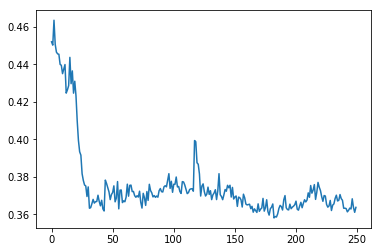

In [44]:
plt.plot(v_scores)

In [25]:
preds,targets,scores=valid_iter(test_x,test_y)

In [62]:
# for (t,p) in zip(targets,preds):
#     scores.append(cpu_SMAPE(t,p))

In [277]:
np.mean(scores)

0.18667644277215004

In [203]:
plt.plot(preds,color='r')
plt.plot(targets)

In [232]:
preds=recover([preds],test_dic)
recovered_test_x=recover(test_x,test_dic)
targets=recover([targets],test_dic)

In [63]:
preds=recover(preds,test_dic)
recovered_test_x=recover(test_x,test_dic)
targets=recover(targets,test_dic)

In [26]:
from util.evaluation import SMAPE as cpu_SMAPE
mean_scores=[]


for ID in range(len(preds)):

    pred=preds[ID]
    truth=targets[ID]
    scores=[]
    for (t,p) in zip(truth,pred):
        scores.append(cpu_SMAPE(t,p))

    mean_scores.append(np.mean(scores))
np.mean(mean_scores)

0.37800388949926117

In [246]:
# scores

In [263]:
# source

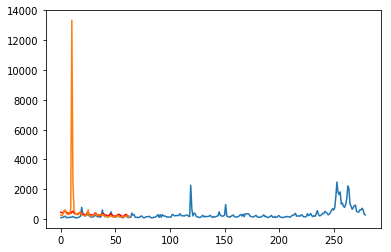

In [32]:
plt.plot(test_x[0])
plt.plot(preds[0],color='r')
plt.plot(targets[0])

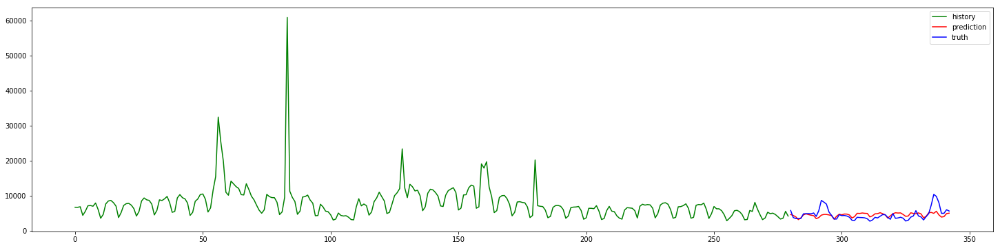

In [44]:
ID=14242
# source=sample_series[ID][encode_start:encode_end]
source=test_x[ID]
pred=preds[ID]
truth=targets[ID]
# print(pred)
# for i in range(10):
plt.figure(figsize=(25,6))
# plt.plot(np.arange(encode_start+1,encode_end),es[ID][:-1],color='black',label='fit')
plt.plot(np.arange(0,len(source)),source,color='g',label='history')
plt.plot(np.arange(len(source),len(source)+len(pred)),pred,color='r',label='prediction')
plt.plot(np.arange(len(source),len(source)+len(pred)),truth,color='b',label='truth')
plt.legend()

In [33]:
# ID=190
# # source=sample_series[ID][encode_start:encode_end]
# source=test_x[ID]
# pred=preds[ID]
# truth=targets[ID]
# # print(pred)
# # for i in range(10):
# plt.figure(figsize=(25,6))
# # plt.plot(np.arange(encode_start+1,encode_end),es[ID][:-1],color='black',label='fit')
# plt.plot(np.arange(encode_start+1,encode_end),source[1:],color='g',label='history')
# plt.plot(np.arange(encode_end,encode_end+decode_len),pred,color='r',label='prediction')
# plt.plot(np.arange(encode_end,encode_end+decode_len),truth,color='b',label='truth')
# plt.legend()

In [106]:
# ID=2244
# # source=sample_series[ID][encode_start:encode_end]
# source=recovered_test_x
# pred=preds
# truth=targets
# # print(pred)
# # for i in range(10):
# plt.figure(figsize=(25,6))
# # plt.plot(np.arange(encode_start+1,encode_end),es[ID][:-1],color='black',label='fit')
# plt.plot(np.arange(encode_start+1,encode_end),source[1:],color='g',label='history')
# plt.plot(np.arange(encode_end,encode_end+decode_len),pred,color='r',label='prediction')
# plt.plot(np.arange(encode_end,encode_end+decode_len),truth,color='b',label='truth')
# plt.legend()

In [38]:
def valid_iter(test_x,test_y):
    testx=X_loader(test_x,batchsize=batch_size)
    testy=Y_loader(test_y,batchsize=batch_size,length_x=len(test_x[0]))

    preds=[]
    targets=[]

    scores=[]
    for j,(X_batch) in enumerate(testx):
        #Parse loaded batch
        print(j,end='\r')
        target=next(testy)

    
        score,out = valid(X_batch, target, decoder, SMAPE)
        out=out
        scores.append(score)
        target=target.squeeze().detach().cpu().numpy()
        if j ==0:
            preds=out
            targets=target

        else:
            preds=np.concatenate((preds,out),axis=0)
#             print(preds.shape)

            targets=np.concatenate((targets,target),axis=0)
    return (preds,targets,scores)

In [37]:
use_cuda=True


class DecoderRNN(nn.Module):
    def __init__(self, input_size, output_size,window,channel,kernel_size=5):
        super(DecoderRNN, self).__init__()

        self.linear_1=nn.Linear(channel*(window-kernel_size+1),input_size,bias=True)
        self.linear_2=nn.Linear(input_size,output_size,bias=True)
        self.cnn=nn.Conv2d(1, out_channels=channel, kernel_size=kernel_size, stride=1, padding=0, bias=True)
        self.maxpool=nn.MaxPool2d(kernel_size=(1,input_size/window-kernel_size+1), stride=(1,1), padding=0, dilation=1)
        
        self.window=window
    def forward(self, input_x):
        #batchsize: bs
        #input size:is
        #output size: os
        
        #input_x:(bs,is)
        #(bs,is)

        predict_from=input_x
        #(bs,window,is/window)
        input_matrix=input_x.view(input_x.size(0),self.window,-1)

        #(bs,1,window,is/window)
        input_matrix=input_matrix.unsqueeze(1)

        #(bs,channel,window-kernel_size+1,is/window-kernel_size+1)
        cnn_out=self.cnn(input_matrix)

        #(bs,channel,window-kernel_size+1,1)
        pool_out=self.maxpool(cnn_out)

        #(bs,channel*(window-kernel_size+1)
        pool_out=pool_out.view(pool_out.size(0),-1)
        #(bs,105)
        weight=torch.sigmoid(self.linear_1(pool_out))
        #(bs,105)
        predict_from=predict_from*weight
        #(bs,63)
        output=self.linear_2(predict_from)
        return output

def train(input_variable,target_variable,  decoder,  \
          decoder_optimizer, criterion):

    decoder.train()

    decoder_optimizer.zero_grad()

    input_length = input_variable.size()[1]
    target_length = target_variable.size()[1]
    
#     encoder_outputs = torch.zeros(input_length, encoder.hidden_size)
#     encoder_outputs = encoder_outputs.cuda() if use_cuda else encoder_outputs
#         encoder_outputs[ei] = encoder_output[0,0,:]
#     print('-'*90)
#     print('pred')
#     print(encoder_output.size())
#     print(encoder_output)
#     print('target')
#     print(input_variable[:,ei+1:(ei+2),:].size())
#     print(input_variable[:,ei+1:(ei+2),:])
#     print(criterion(encoder_output.squeeze(),input_variable[:,ei+1:(ei+2),:].squeeze()))
#     print('-'*90)
    #get the first prediction

    input_variable=input_variable.squeeze(2)
    decoder_output = decoder(input_variable)

    loss_decoding = criterion(decoder_output.squeeze(), target_variable.squeeze())
#     loss=loss_encoding+loss_decoding
    loss=loss_decoding
    loss.backward()

    decoder_optimizer.step()

    return (loss_decoding.item())

In [36]:
def valid(input_variable,  target_variable,  decoder, criterion):

    decoder.eval()

    input_length = input_variable.size()[1]
    target_length = target_variable.size()[1]
#     print(target_length)
    
    loss = 0
    input_variable=input_variable.squeeze(2)
    decoder_output = decoder(input_variable)
    
    outputs=decoder_output.detach().cpu().numpy()
    loss_decoding = criterion(decoder_output.squeeze(), target_variable.squeeze())
#     loss=loss_encoding+loss_decoding
    loss=loss_decoding


    return (loss.item(),np.array(outputs))

In [80]:
preds,targets,scores=valid_iter(test_x,test_y)

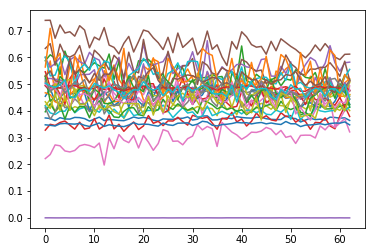

In [83]:
for i in range(30):
    plt.plot(preds[i])
#     plt.plot(targets[i][:21])
#     plt.plot(preds[213])

In [141]:
150-98

52

In [142]:
98-63

35